In [1]:
%%javascript

window.scroll_flag = true
window.scroll_exit = false
window.scroll_delay = 100

$(".output_scroll").each(function() {
    $(this)[0].scrollTop = $(this)[0].scrollHeight;
});

function callScrollToBottom() {
    setTimeout(scrollToBottom, window.scroll_delay);
}

function scrollToBottom() {
    if (window.scroll_exit) {
        return;
    }
    if (!window.scroll_flag) {
        callScrollToBottom();
        return;
    };
    
    $(".output_scroll").each(function() {
        if (!$(this).attr('scroll_checkbox')){
            window.scroll_flag = true;
            $(this).attr('scroll_checkbox',true);
            var div = document.createElement('div');
            var checkbox = document.createElement('input');
            checkbox.type = "checkbox";
            checkbox.onclick = function(){window.scroll_flag = checkbox.checked}
            checkbox.checked = "checked"
            div.append("Auto-Scroll-To-Bottom: ");
            div.append(checkbox);
            $(this).parent().before(div);
        }
        
        $(this)[0].scrollTop = $(this)[0].scrollHeight;
    });
    callScrollToBottom();
}
scrollToBottom();

<IPython.core.display.Javascript object>

In [2]:
import torch
import torch.nn as nn
import torchvision
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data as data
import os
import sys
import argparse
import time
import numpy as np
from torchvision import transforms
import glob
from PIL import Image
import cv2
import matplotlib.pyplot as plt
from torchvision import transforms
from matplotlib import pyplot as plt
from natsort import natsorted

# Dataloader

In [3]:
#Loading images paths
path = "L:\\BOUDIAF\\Dataset001\\"
rgb_list = sorted(glob.glob(os.path.join(path, 'rgb\\*.png')))
depth_list = sorted(glob.glob(os.path.join(path, 'depth\\*.png')))

In [4]:
for x, y in zip(rgb_list, depth_list):
    rgb_img = cv2.imread(x, 0).astype(np.float32) 
    rgb_img /= 255.
    rgb_img = np.expand_dims(rgb_img, axis=-1)
    depth_img = cv2.imread(y, 0).astype(np.float32) 
    depth_img /= 255.
    depth_img = np.expand_dims(depth_img, axis=-1)
    img = np.dstack((rgb_img,depth_img))
    img = np.expand_dims(img, axis=0)
    break

In [5]:
img.shape

(1, 144, 256, 2)

In [6]:
np.dstack((rgb_img,depth_img)).shape

(144, 256, 2)

In [7]:
#Loading steering direction
filename = 'L:\\BOUDIAF\\Dataset001\\steering_angels.csv'
steering = np.loadtxt(filename, delimiter=',', skiprows=0, dtype=np.float64)
steering = steering[14:]
#Convert steering angle to calsses
steering_idx = []
for i in steering:
    if(i == 0):
        steering_idx.append(0)
    elif(i == 0.5):
        steering_idx.append(1)
    elif(i == -0.5):
        steering_idx.append(2)

In [8]:
#Number of classes (srtight, left and right) in data
steering_idx.count(0), steering_idx.count(1), steering_idx.count(2)

(31373, 3856, 2554)

In [9]:
stright_idxs = [i for i, x in enumerate(steering_idx) if x == 0]
right_idxs = [i for i, x in enumerate(steering_idx) if x == 1]
left_idxs = [i for i, x in enumerate(steering_idx) if x == 2]

In [10]:
class Dataset(torch.utils.data.Dataset):
  
    def __init__(self, rgb_list, depth_list, window):
        self.rgb_list = rgb_list
        self.depth_list = depth_list
        self.window = window

    def __getitem__(self, index):
        images = np.empty((1,144, 256, 2), dtype= np.float32)
        if (index+self.window) <= len(self.rgb_list):
            rgb_paths = self.rgb_list[index:index+self.window]
            depth_paths = self.depth_list[index:index+self.window]
            for (x, y) in zip(rgb_paths, depth_paths):
                rgb_img = cv2.imread(x, 0).astype(np.float32) 
                rgb_img /= 255.
                rgb_img = np.expand_dims(rgb_img, axis=-1)
                depth_img = cv2.imread(y, 0).astype(np.float32) 
                depth_img /= 255.
                depth_img = np.expand_dims(depth_img, axis=-1)
                img = np.dstack((rgb_img,depth_img))
                img = np.expand_dims(img, axis=0)
                images = np.append(images, img, axis=0)
            return [np.moveaxis(images[1:], -1, 0) , steering_idx[index]]

    def __len__(self):
        return (len(self.rgb_list) - self.window) + 1 

In [11]:
train_dataset = Dataset(rgb_list, depth_list, 15)

In [12]:
w1 = 1 - (len(stright_idxs)/len(train_dataset))
w2 = 1 - (len(right_idxs)/len(train_dataset))
w3 = 1 - (len(left_idxs)/len(train_dataset))

In [13]:
class_weights = []
for i in steering_idx:
    if(i == 0):
        class_weights.append(w1)
    elif(i == 1):
        class_weights.append(w2)
    elif(i == 2):
        class_weights.append(w3)

In [14]:
WeightSampler = torch.utils.data.WeightedRandomSampler(class_weights, len(class_weights))

In [15]:
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=8, shuffle=False, sampler=WeightSampler)

In [16]:
for idx, (input_img, gt) in enumerate(train_loader):
    break

In [17]:
type(input_img), type(gt)

(torch.Tensor, torch.Tensor)

In [18]:
input_img.shape, gt.shape

(torch.Size([8, 2, 15, 144, 256]), torch.Size([8]))

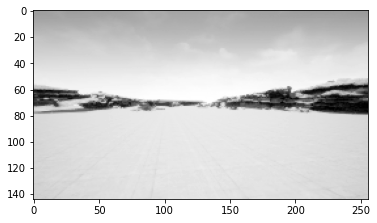

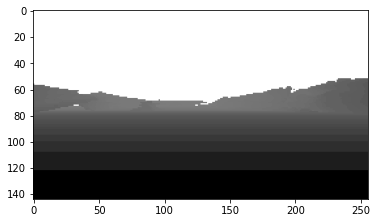

2


In [49]:
tst_rgb = input_img[0][0].numpy()
tst_depth = input_img[0][1].numpy()
plt.imshow(tst_rgb[0], cmap="gray")
plt.show()
plt.imshow(tst_depth[0], cmap="gray")
plt.show()
print(gt.item())

# Network

In [19]:
class NavNet(nn.Module):
    def __init__(self):
        super(NavNet, self).__init__()

        self.relu = nn.ReLU(inplace=True)

        self.conv3d_1_1 = nn.Conv3d(2, 8, 3, stride=1, padding='same') 
        self.conv3d_1_2 = nn.Conv3d(8, 8, 3, stride=1, padding='same', dilation=1, groups=1, bias=True, padding_mode='zeros') 
        self.conv3d_2_1 = nn.Conv3d(8, 16, 3, stride=1, padding='same', dilation=1, groups=1, bias=True, padding_mode='zeros') 
        self.conv3d_2_2 = nn.Conv3d(16, 16, 3, stride=1, padding='same', dilation=1, groups=1, bias=True, padding_mode='zeros') 
        self.fc1 = nn.Linear(1179648, 100, bias=True)
        self.fc2 = nn.Linear(100, 100, bias=True)
        self.fc3 = nn.Linear(100, 3, bias=True)

        self.max = nn.AdaptiveAvgPool3d((72,128,8)) 

    def forward(self, x):
        source = []
        source.append(x)
#         print("input: ",x.shape[-1])
#         print("input: ",x.shape)
        x1 = self.relu(self.conv3d_1_1(x))
#         print("output1: ",x1.shape)
        x2 = self.relu(self.conv3d_1_2(x1))
#         print("output2: ",x2.shape)


        max1 = self.max(x2)
#         print("output max1: ",max1.shape)
   
    
        x3 = self.relu(self.conv3d_2_1(max1))
#         print("output3: ",x3.shape)
        x4 = self.relu(self.conv3d_2_2(x3))
#         print("output4: ",x4.shape)

        # concat3 = torch.cat((x1,x2,x3,x4),1)
#         print("output5: ",torch.flatten(x4).shape)
        x5 = self.relu(self.fc1(torch.flatten(x4)))
#         print("output5: ",x5.shape)
        x6 = self.relu(self.fc2(x5))
        x7 = self.relu(self.fc3(x6))
        max_index = (x7 == torch.max(x7).item()).nonzero(as_tuple=True)[0]

        return max_index, x7

# Training

In [20]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

In [21]:
import torch.optim as optim

In [24]:
model = NavNet().to(device)
loss = torch.nn.CrossEntropyLoss()
# optimizer = torch.optim.Adam(NavNet().parameters(), lr=0.0001, weight_decay=0)
optimizer = optim.SGD(model.parameters(), lr=0.00005, momentum=0.5)

In [88]:
l = len(rgb_list)
loss_file = open('L:\\BOUDIAF\\Nav\\model003\\read_me.txt', 'a')
loss_file.truncate(0) #Delete everything in the txt file
for epoch in range(10):
    print("**************** epoch ", str(epoch), "****************")
    for idx, (input_img, gt) in enumerate(train_loader):
        torch.cuda.empty_cache()
        optimizer.zero_grad()
        input_img = input_img.to(device)
        direction, output = model(input_img)
        gt = gt.to(device)
        lss = loss(torch.unsqueeze(output, 0), gt)
        lss.backward()
        optimizer.step()
        print(round(idx*100/l,2), '%   loss:',  round(lss.item(),3), "  class:", gt.item(),"   prediction:", direction[0].item()==gt.item())
        if(gt.item() == 0):
            loss_file.write('class0:'+ str(round(lss.item(),3)) +'\n') #Write into file
        elif(gt.item() == 1):
            loss_file.write('class1:'+ str(round(lss.item(),3)) +'\n') #Write into file
        elif(gt.item() == 2):
            loss_file.write('class2:'+ str(round(lss.item(),3)) +'\n') #Write into file 
    torch.save(model.state_dict(), "L:\\BOUDIAF\\Nav\\model003\\" + "Epoch" + str(epoch) + '.pth') 
loss_file.close()

**************** epoch  0 ****************
0.0 %   loss: 1.113   class: 0    prediction: False
0.0 %   loss: 1.07   class: 2    prediction: True
0.01 %   loss: 1.07   class: 2    prediction: True
0.01 %   loss: 1.069   class: 2    prediction: True
0.01 %   loss: 1.114   class: 0    prediction: False
0.01 %   loss: 1.114   class: 0    prediction: False
0.02 %   loss: 1.114   class: 1    prediction: False
0.02 %   loss: 1.114   class: 0    prediction: False
0.02 %   loss: 1.114   class: 0    prediction: False
0.02 %   loss: 1.114   class: 1    prediction: False
0.03 %   loss: 1.114   class: 0    prediction: False
0.03 %   loss: 1.113   class: 1    prediction: False
0.03 %   loss: 1.113   class: 0    prediction: False
0.03 %   loss: 1.113   class: 0    prediction: False
0.04 %   loss: 1.071   class: 2    prediction: True
0.04 %   loss: 1.112   class: 0    prediction: False
0.04 %   loss: 1.112   class: 1    prediction: False
0.04 %   loss: 1.112   class: 0    prediction: False
0.05 %   lo

0.41 %   loss: 1.104   class: 0    prediction: False
0.41 %   loss: 1.104   class: 1    prediction: False
0.42 %   loss: 1.104   class: 0    prediction: False
0.42 %   loss: 1.104   class: 0    prediction: False
0.42 %   loss: 1.103   class: 0    prediction: False
0.42 %   loss: 1.103   class: 1    prediction: False
0.43 %   loss: 1.089   class: 2    prediction: True
0.43 %   loss: 1.089   class: 2    prediction: True
0.43 %   loss: 1.103   class: 1    prediction: False
0.43 %   loss: 1.103   class: 1    prediction: False
0.44 %   loss: 1.103   class: 0    prediction: False
0.44 %   loss: 1.089   class: 2    prediction: True
0.44 %   loss: 1.103   class: 0    prediction: False
0.44 %   loss: 1.103   class: 0    prediction: False
0.45 %   loss: 1.103   class: 0    prediction: False
0.45 %   loss: 1.103   class: 0    prediction: False
0.45 %   loss: 1.103   class: 0    prediction: False
0.46 %   loss: 1.089   class: 2    prediction: True
0.46 %   loss: 1.103   class: 0    prediction: Fal

0.83 %   loss: 1.099   class: 0    prediction: True
0.83 %   loss: 1.098   class: 2    prediction: True
0.83 %   loss: 1.099   class: 0    prediction: False
0.83 %   loss: 1.099   class: 0    prediction: False
0.84 %   loss: 1.099   class: 0    prediction: False
0.84 %   loss: 1.099   class: 0    prediction: False
0.84 %   loss: 1.098   class: 2    prediction: True
0.84 %   loss: 1.099   class: 0    prediction: False
0.85 %   loss: 1.099   class: 0    prediction: True
0.85 %   loss: 1.099   class: 0    prediction: True
0.85 %   loss: 1.099   class: 2    prediction: True
0.85 %   loss: 1.099   class: 0    prediction: False
0.86 %   loss: 1.099   class: 0    prediction: False
0.86 %   loss: 1.099   class: 1    prediction: False
0.86 %   loss: 1.099   class: 1    prediction: False
0.87 %   loss: 1.098   class: 2    prediction: True
0.87 %   loss: 1.099   class: 0    prediction: False
0.87 %   loss: 1.099   class: 1    prediction: False
0.87 %   loss: 1.099   class: 1    prediction: False


1.24 %   loss: 1.099   class: 1    prediction: False
1.24 %   loss: 1.099   class: 0    prediction: True
1.25 %   loss: 1.099   class: 0    prediction: True
1.25 %   loss: 1.099   class: 0    prediction: True
1.25 %   loss: 1.099   class: 0    prediction: True
1.25 %   loss: 1.099   class: 0    prediction: False
1.26 %   loss: 1.099   class: 0    prediction: True
1.26 %   loss: 1.099   class: 2    prediction: False
1.26 %   loss: 1.099   class: 1    prediction: False
1.26 %   loss: 1.099   class: 1    prediction: False
1.27 %   loss: 1.099   class: 1    prediction: False
1.27 %   loss: 1.099   class: 0    prediction: True
1.27 %   loss: 1.099   class: 1    prediction: False
1.28 %   loss: 1.099   class: 1    prediction: False
1.28 %   loss: 1.099   class: 2    prediction: False
1.28 %   loss: 1.099   class: 1    prediction: False
1.28 %   loss: 1.099   class: 1    prediction: False
1.29 %   loss: 1.099   class: 2    prediction: False
1.29 %   loss: 1.099   class: 0    prediction: True


1.66 %   loss: 1.099   class: 1    prediction: False
1.66 %   loss: 1.099   class: 1    prediction: False
1.66 %   loss: 1.096   class: 2    prediction: True
1.66 %   loss: 1.099   class: 1    prediction: False
1.67 %   loss: 1.097   class: 2    prediction: True
1.67 %   loss: 1.099   class: 0    prediction: False
1.67 %   loss: 1.099   class: 0    prediction: False
1.67 %   loss: 1.099   class: 0    prediction: False
1.68 %   loss: 1.099   class: 1    prediction: False
1.68 %   loss: 1.099   class: 0    prediction: False
1.68 %   loss: 1.099   class: 0    prediction: False
1.69 %   loss: 1.099   class: 1    prediction: False
1.69 %   loss: 1.099   class: 0    prediction: True
1.69 %   loss: 1.097   class: 2    prediction: True
1.69 %   loss: 1.099   class: 1    prediction: False
1.7 %   loss: 1.099   class: 0    prediction: True
1.7 %   loss: 1.098   class: 2    prediction: True
1.7 %   loss: 1.099   class: 1    prediction: False
1.7 %   loss: 1.099   class: 2    prediction: False
1.7

2.07 %   loss: 1.099   class: 0    prediction: False
2.07 %   loss: 1.099   class: 0    prediction: True
2.07 %   loss: 1.098   class: 2    prediction: True
2.08 %   loss: 1.099   class: 1    prediction: False
2.08 %   loss: 1.099   class: 1    prediction: False
2.08 %   loss: 1.098   class: 2    prediction: True
2.08 %   loss: 1.099   class: 0    prediction: False
2.09 %   loss: 1.098   class: 2    prediction: True
2.09 %   loss: 1.098   class: 2    prediction: True
2.09 %   loss: 1.099   class: 1    prediction: False
2.1 %   loss: 1.096   class: 2    prediction: True
2.1 %   loss: 1.099   class: 0    prediction: False
2.1 %   loss: 1.1   class: 0    prediction: False
2.1 %   loss: 1.1   class: 0    prediction: False
2.11 %   loss: 1.1   class: 0    prediction: False
2.11 %   loss: 1.099   class: 1    prediction: False
2.11 %   loss: 1.099   class: 0    prediction: False
2.11 %   loss: 1.099   class: 1    prediction: False
2.12 %   loss: 1.099   class: 0    prediction: False
2.12 %   

2.48 %   loss: 1.099   class: 2    prediction: False
2.49 %   loss: 1.099   class: 0    prediction: True
2.49 %   loss: 1.099   class: 1    prediction: False
2.49 %   loss: 1.099   class: 1    prediction: False
2.49 %   loss: 1.099   class: 0    prediction: True
2.5 %   loss: 1.099   class: 0    prediction: True
2.5 %   loss: 1.099   class: 1    prediction: False
2.5 %   loss: 1.099   class: 1    prediction: False
2.51 %   loss: 1.099   class: 1    prediction: False
2.51 %   loss: 1.099   class: 0    prediction: True
2.51 %   loss: 1.099   class: 0    prediction: True
2.51 %   loss: 1.099   class: 2    prediction: False
2.52 %   loss: 1.099   class: 1    prediction: False
2.52 %   loss: 1.099   class: 1    prediction: False
2.52 %   loss: 1.099   class: 1    prediction: False
2.52 %   loss: 1.099   class: 1    prediction: False
2.53 %   loss: 1.099   class: 1    prediction: False
2.53 %   loss: 1.099   class: 0    prediction: True
2.53 %   loss: 1.099   class: 1    prediction: False
2.

2.9 %   loss: 1.099   class: 0    prediction: True
2.9 %   loss: 1.099   class: 0    prediction: True
2.9 %   loss: 1.099   class: 1    prediction: False
2.91 %   loss: 1.099   class: 0    prediction: True
2.91 %   loss: 1.099   class: 1    prediction: False
2.91 %   loss: 1.099   class: 0    prediction: True
2.92 %   loss: 1.099   class: 1    prediction: False
2.92 %   loss: 1.099   class: 0    prediction: True
2.92 %   loss: 1.099   class: 0    prediction: True
2.92 %   loss: 1.099   class: 0    prediction: True
2.93 %   loss: 1.099   class: 0    prediction: True
2.93 %   loss: 1.099   class: 2    prediction: False
2.93 %   loss: 1.099   class: 2    prediction: False
2.93 %   loss: 1.099   class: 1    prediction: False
2.94 %   loss: 1.099   class: 1    prediction: False
2.94 %   loss: 1.099   class: 1    prediction: False
2.94 %   loss: 1.099   class: 2    prediction: False
2.94 %   loss: 1.099   class: 2    prediction: False
2.95 %   loss: 1.099   class: 2    prediction: False
2.95

3.32 %   loss: 1.099   class: 0    prediction: True
3.32 %   loss: 1.099   class: 0    prediction: False
3.32 %   loss: 1.098   class: 2    prediction: True
3.32 %   loss: 1.099   class: 1    prediction: False
3.33 %   loss: 1.099   class: 1    prediction: False
3.33 %   loss: 1.099   class: 0    prediction: False
3.33 %   loss: 1.097   class: 2    prediction: True
3.33 %   loss: 1.099   class: 1    prediction: False
3.34 %   loss: 1.097   class: 2    prediction: True
3.34 %   loss: 1.099   class: 1    prediction: False
3.34 %   loss: 1.099   class: 1    prediction: False
3.34 %   loss: 1.099   class: 0    prediction: False
3.35 %   loss: 1.099   class: 0    prediction: False
3.35 %   loss: 1.099   class: 0    prediction: False
3.35 %   loss: 1.099   class: 0    prediction: False
3.35 %   loss: 1.098   class: 2    prediction: True
3.36 %   loss: 1.099   class: 1    prediction: False
3.36 %   loss: 1.099   class: 0    prediction: False
3.36 %   loss: 1.099   class: 2    prediction: Fals

3.73 %   loss: 1.099   class: 0    prediction: True
3.73 %   loss: 1.099   class: 0    prediction: True
3.73 %   loss: 1.099   class: 0    prediction: True
3.74 %   loss: 1.099   class: 2    prediction: False
3.74 %   loss: 1.099   class: 0    prediction: True
3.74 %   loss: 1.099   class: 0    prediction: True
3.74 %   loss: 1.099   class: 2    prediction: False
3.75 %   loss: 1.099   class: 1    prediction: False
3.75 %   loss: 1.099   class: 0    prediction: True
3.75 %   loss: 1.099   class: 0    prediction: True
3.75 %   loss: 1.099   class: 2    prediction: False
3.76 %   loss: 1.099   class: 2    prediction: False
3.76 %   loss: 1.099   class: 0    prediction: True
3.76 %   loss: 1.099   class: 1    prediction: False
3.76 %   loss: 1.099   class: 2    prediction: False
3.77 %   loss: 1.099   class: 0    prediction: True
3.77 %   loss: 1.099   class: 1    prediction: False
3.77 %   loss: 1.099   class: 0    prediction: True
3.78 %   loss: 1.099   class: 1    prediction: False
3.7

4.14 %   loss: 1.099   class: 0    prediction: True
4.15 %   loss: 1.099   class: 0    prediction: True
4.15 %   loss: 1.099   class: 0    prediction: True
4.15 %   loss: 1.099   class: 2    prediction: False
4.15 %   loss: 1.099   class: 2    prediction: False
4.16 %   loss: 1.099   class: 0    prediction: True
4.16 %   loss: 1.099   class: 0    prediction: True
4.16 %   loss: 1.099   class: 0    prediction: True
4.16 %   loss: 1.099   class: 1    prediction: False
4.17 %   loss: 1.099   class: 0    prediction: True
4.17 %   loss: 1.099   class: 1    prediction: False
4.17 %   loss: 1.099   class: 1    prediction: False
4.17 %   loss: 1.099   class: 0    prediction: True
4.18 %   loss: 1.099   class: 0    prediction: True
4.18 %   loss: 1.099   class: 0    prediction: True
4.18 %   loss: 1.099   class: 1    prediction: False
4.19 %   loss: 1.099   class: 0    prediction: True
4.19 %   loss: 1.099   class: 0    prediction: True
4.19 %   loss: 1.099   class: 0    prediction: True
4.19 %

4.56 %   loss: 1.099   class: 1    prediction: False
4.56 %   loss: 1.099   class: 0    prediction: True
4.56 %   loss: 1.099   class: 0    prediction: True
4.57 %   loss: 1.098   class: 2    prediction: True
4.57 %   loss: 1.099   class: 0    prediction: False
4.57 %   loss: 1.099   class: 0    prediction: False
4.57 %   loss: 1.099   class: 1    prediction: False
4.58 %   loss: 1.099   class: 0    prediction: False
4.58 %   loss: 1.099   class: 0    prediction: False
4.58 %   loss: 1.099   class: 0    prediction: True
4.59 %   loss: 1.099   class: 1    prediction: False
4.59 %   loss: 1.099   class: 1    prediction: False
4.59 %   loss: 1.099   class: 1    prediction: False
4.59 %   loss: 1.098   class: 2    prediction: True
4.6 %   loss: 1.099   class: 0    prediction: False
4.6 %   loss: 1.099   class: 0    prediction: True
4.6 %   loss: 1.099   class: 1    prediction: False
4.6 %   loss: 1.099   class: 1    prediction: False
4.61 %   loss: 1.099   class: 1    prediction: False
4.6

4.97 %   loss: 1.1   class: 1    prediction: False
4.98 %   loss: 1.1   class: 0    prediction: False
4.98 %   loss: 1.096   class: 2    prediction: True
4.98 %   loss: 1.099   class: 0    prediction: False
4.98 %   loss: 1.096   class: 2    prediction: True
4.99 %   loss: 1.099   class: 0    prediction: False
4.99 %   loss: 1.1   class: 0    prediction: False
4.99 %   loss: 1.1   class: 0    prediction: False
5.0 %   loss: 1.096   class: 2    prediction: True
5.0 %   loss: 1.096   class: 2    prediction: True
5.0 %   loss: 1.1   class: 1    prediction: False
5.0 %   loss: 1.095   class: 2    prediction: True
5.01 %   loss: 1.096   class: 2    prediction: True
5.01 %   loss: 1.1   class: 0    prediction: False
5.01 %   loss: 1.094   class: 2    prediction: True
5.01 %   loss: 1.095   class: 2    prediction: True
5.02 %   loss: 1.1   class: 1    prediction: False
5.02 %   loss: 1.1   class: 1    prediction: False
5.02 %   loss: 1.101   class: 1    prediction: False
5.02 %   loss: 1.1   

5.39 %   loss: 1.099   class: 0    prediction: True
5.39 %   loss: 1.099   class: 0    prediction: True
5.39 %   loss: 1.099   class: 0    prediction: True
5.4 %   loss: 1.099   class: 0    prediction: True
5.4 %   loss: 1.099   class: 1    prediction: False
5.4 %   loss: 1.099   class: 1    prediction: False
5.41 %   loss: 1.099   class: 1    prediction: False
5.41 %   loss: 1.099   class: 0    prediction: True
5.41 %   loss: 1.099   class: 0    prediction: True
5.41 %   loss: 1.099   class: 0    prediction: True
5.42 %   loss: 1.099   class: 1    prediction: False
5.42 %   loss: 1.099   class: 2    prediction: False
5.42 %   loss: 1.099   class: 1    prediction: False
5.42 %   loss: 1.099   class: 0    prediction: True
5.43 %   loss: 1.099   class: 0    prediction: True
5.43 %   loss: 1.099   class: 1    prediction: False
5.43 %   loss: 1.099   class: 1    prediction: False
5.43 %   loss: 1.099   class: 0    prediction: True
5.44 %   loss: 1.099   class: 0    prediction: True
5.44 % 

5.8 %   loss: 1.099   class: 0    prediction: True
5.81 %   loss: 1.099   class: 0    prediction: False
5.81 %   loss: 1.098   class: 2    prediction: True
5.81 %   loss: 1.099   class: 1    prediction: False
5.82 %   loss: 1.099   class: 1    prediction: False
5.82 %   loss: 1.098   class: 2    prediction: True
5.82 %   loss: 1.099   class: 0    prediction: False
5.82 %   loss: 1.097   class: 2    prediction: True
5.83 %   loss: 1.097   class: 2    prediction: True
5.83 %   loss: 1.099   class: 1    prediction: False
5.83 %   loss: 1.099   class: 0    prediction: False
5.83 %   loss: 1.099   class: 0    prediction: False
5.84 %   loss: 1.099   class: 0    prediction: False
5.84 %   loss: 1.099   class: 0    prediction: False
5.84 %   loss: 1.098   class: 2    prediction: True
5.84 %   loss: 1.099   class: 0    prediction: False
5.85 %   loss: 1.097   class: 2    prediction: True
5.85 %   loss: 1.099   class: 0    prediction: False
5.85 %   loss: 1.099   class: 1    prediction: False
5

6.22 %   loss: 1.099   class: 0    prediction: True
6.22 %   loss: 1.099   class: 0    prediction: True
6.23 %   loss: 1.099   class: 0    prediction: True
6.23 %   loss: 1.099   class: 0    prediction: True
6.23 %   loss: 1.099   class: 1    prediction: False
6.23 %   loss: 1.099   class: 2    prediction: False
6.24 %   loss: 1.099   class: 2    prediction: False
6.24 %   loss: 1.099   class: 0    prediction: True
6.24 %   loss: 1.099   class: 0    prediction: True
6.24 %   loss: 1.099   class: 1    prediction: False
6.25 %   loss: 1.099   class: 0    prediction: True
6.25 %   loss: 1.099   class: 0    prediction: True
6.25 %   loss: 1.099   class: 0    prediction: True
6.25 %   loss: 1.099   class: 1    prediction: False
6.26 %   loss: 1.099   class: 1    prediction: False
6.26 %   loss: 1.099   class: 1    prediction: False
6.26 %   loss: 1.099   class: 2    prediction: False
6.27 %   loss: 1.099   class: 1    prediction: False
6.27 %   loss: 1.099   class: 0    prediction: True
6.2

6.64 %   loss: 1.099   class: 1    prediction: False
6.64 %   loss: 1.099   class: 1    prediction: False
6.64 %   loss: 1.099   class: 0    prediction: False
6.64 %   loss: 1.099   class: 0    prediction: False
6.65 %   loss: 1.099   class: 0    prediction: False
6.65 %   loss: 1.099   class: 0    prediction: True
6.65 %   loss: 1.099   class: 1    prediction: False
6.65 %   loss: 1.099   class: 2    prediction: False
6.66 %   loss: 1.098   class: 2    prediction: True
6.66 %   loss: 1.099   class: 1    prediction: False
6.66 %   loss: 1.099   class: 0    prediction: True
6.66 %   loss: 1.099   class: 2    prediction: False
6.67 %   loss: 1.099   class: 0    prediction: True
6.67 %   loss: 1.098   class: 2    prediction: True
6.67 %   loss: 1.099   class: 0    prediction: True
6.68 %   loss: 1.099   class: 0    prediction: True
6.68 %   loss: 1.099   class: 0    prediction: True
6.68 %   loss: 1.099   class: 0    prediction: True
6.68 %   loss: 1.099   class: 1    prediction: False
6.

7.05 %   loss: 1.097   class: 2    prediction: True
7.05 %   loss: 1.099   class: 1    prediction: False
7.05 %   loss: 1.097   class: 2    prediction: True
7.06 %   loss: 1.098   class: 2    prediction: True
7.06 %   loss: 1.097   class: 2    prediction: True
7.06 %   loss: 1.099   class: 0    prediction: False
7.06 %   loss: 1.1   class: 0    prediction: False
7.07 %   loss: 1.1   class: 0    prediction: False
7.07 %   loss: 1.099   class: 0    prediction: False
7.07 %   loss: 1.099   class: 0    prediction: False
7.07 %   loss: 1.099   class: 1    prediction: False
7.08 %   loss: 1.099   class: 1    prediction: False
7.08 %   loss: 1.097   class: 2    prediction: True
7.08 %   loss: 1.099   class: 0    prediction: False
7.09 %   loss: 1.099   class: 0    prediction: False
7.09 %   loss: 1.099   class: 0    prediction: True
7.09 %   loss: 1.099   class: 0    prediction: False
7.09 %   loss: 1.099   class: 0    prediction: False
7.1 %   loss: 1.099   class: 0    prediction: True
7.1 %

7.47 %   loss: 1.099   class: 1    prediction: False
7.47 %   loss: 1.099   class: 0    prediction: True
7.47 %   loss: 1.099   class: 0    prediction: True
7.47 %   loss: 1.099   class: 0    prediction: True
7.48 %   loss: 1.099   class: 0    prediction: True
7.48 %   loss: 1.099   class: 0    prediction: True
7.48 %   loss: 1.099   class: 0    prediction: False
7.48 %   loss: 1.099   class: 1    prediction: False
7.49 %   loss: 1.099   class: 0    prediction: True
7.49 %   loss: 1.099   class: 2    prediction: False
7.49 %   loss: 1.099   class: 0    prediction: True
7.5 %   loss: 1.099   class: 0    prediction: True
7.5 %   loss: 1.099   class: 1    prediction: False
7.5 %   loss: 1.099   class: 1    prediction: False
7.5 %   loss: 1.099   class: 0    prediction: True
7.51 %   loss: 1.099   class: 0    prediction: True
7.51 %   loss: 1.099   class: 1    prediction: False
7.51 %   loss: 1.099   class: 1    prediction: False
7.51 %   loss: 1.099   class: 1    prediction: False
7.52 % 

7.88 %   loss: 1.096   class: 2    prediction: True
7.88 %   loss: 1.099   class: 0    prediction: True
7.89 %   loss: 1.099   class: 0    prediction: False
7.89 %   loss: 1.096   class: 2    prediction: True
7.89 %   loss: 1.099   class: 0    prediction: False
7.89 %   loss: 1.099   class: 1    prediction: False
7.9 %   loss: 1.099   class: 0    prediction: False
7.9 %   loss: 1.099   class: 0    prediction: False
7.9 %   loss: 1.099   class: 1    prediction: False
7.91 %   loss: 1.099   class: 0    prediction: True
7.91 %   loss: 1.098   class: 2    prediction: True
7.91 %   loss: 1.099   class: 0    prediction: True
7.91 %   loss: 1.099   class: 2    prediction: False
7.92 %   loss: 1.099   class: 1    prediction: False
7.92 %   loss: 1.097   class: 2    prediction: True
7.92 %   loss: 1.099   class: 1    prediction: False
7.92 %   loss: 1.099   class: 1    prediction: False
7.93 %   loss: 1.099   class: 1    prediction: False
7.93 %   loss: 1.098   class: 2    prediction: True
7.93

8.29 %   loss: 1.099   class: 0    prediction: True
8.3 %   loss: 1.099   class: 1    prediction: False
8.3 %   loss: 1.099   class: 1    prediction: False
8.3 %   loss: 1.099   class: 1    prediction: False
8.3 %   loss: 1.099   class: 1    prediction: False
8.31 %   loss: 1.099   class: 1    prediction: False
8.31 %   loss: 1.098   class: 2    prediction: True
8.31 %   loss: 1.099   class: 2    prediction: False
8.32 %   loss: 1.099   class: 0    prediction: False
8.32 %   loss: 1.099   class: 1    prediction: False
8.32 %   loss: 1.099   class: 0    prediction: True
8.32 %   loss: 1.099   class: 1    prediction: False
8.33 %   loss: 1.099   class: 1    prediction: False
8.33 %   loss: 1.099   class: 0    prediction: True
8.33 %   loss: 1.099   class: 2    prediction: False
8.33 %   loss: 1.099   class: 0    prediction: True
8.34 %   loss: 1.099   class: 1    prediction: False
8.34 %   loss: 1.099   class: 0    prediction: True
8.34 %   loss: 1.099   class: 1    prediction: False
8.3

8.71 %   loss: 1.099   class: 0    prediction: False
8.71 %   loss: 1.099   class: 1    prediction: False
8.71 %   loss: 1.099   class: 0    prediction: False
8.72 %   loss: 1.099   class: 0    prediction: True
8.72 %   loss: 1.099   class: 0    prediction: True
8.72 %   loss: 1.099   class: 0    prediction: False
8.73 %   loss: 1.099   class: 1    prediction: False
8.73 %   loss: 1.099   class: 1    prediction: False
8.73 %   loss: 1.099   class: 0    prediction: True
8.73 %   loss: 1.099   class: 0    prediction: True
8.74 %   loss: 1.099   class: 1    prediction: False
8.74 %   loss: 1.099   class: 0    prediction: True
8.74 %   loss: 1.099   class: 0    prediction: True
8.74 %   loss: 1.099   class: 0    prediction: True
8.75 %   loss: 1.099   class: 2    prediction: False
8.75 %   loss: 1.099   class: 1    prediction: False
8.75 %   loss: 1.099   class: 1    prediction: False
8.75 %   loss: 1.099   class: 1    prediction: False
8.76 %   loss: 1.099   class: 0    prediction: True
8

9.13 %   loss: 1.099   class: 0    prediction: True
9.13 %   loss: 1.099   class: 0    prediction: True
9.13 %   loss: 1.099   class: 1    prediction: False
9.13 %   loss: 1.099   class: 1    prediction: False
9.14 %   loss: 1.099   class: 0    prediction: True
9.14 %   loss: 1.099   class: 0    prediction: True
9.14 %   loss: 1.099   class: 2    prediction: False
9.14 %   loss: 1.099   class: 0    prediction: True
9.15 %   loss: 1.099   class: 1    prediction: False
9.15 %   loss: 1.099   class: 1    prediction: False
9.15 %   loss: 1.099   class: 0    prediction: True
9.15 %   loss: 1.099   class: 0    prediction: True
9.16 %   loss: 1.099   class: 1    prediction: False
9.16 %   loss: 1.099   class: 1    prediction: False
9.16 %   loss: 1.099   class: 0    prediction: True
9.16 %   loss: 1.099   class: 0    prediction: True
9.17 %   loss: 1.099   class: 0    prediction: True
9.17 %   loss: 1.099   class: 1    prediction: False
9.17 %   loss: 1.099   class: 1    prediction: False
9.1

9.54 %   loss: 1.099   class: 1    prediction: False
9.54 %   loss: 1.1   class: 0    prediction: False
9.55 %   loss: 1.099   class: 0    prediction: False
9.55 %   loss: 1.099   class: 0    prediction: False
9.55 %   loss: 1.099   class: 0    prediction: False
9.55 %   loss: 1.099   class: 0    prediction: False
9.56 %   loss: 1.099   class: 0    prediction: False
9.56 %   loss: 1.098   class: 2    prediction: True
9.56 %   loss: 1.099   class: 0    prediction: False
9.56 %   loss: 1.099   class: 1    prediction: False
9.57 %   loss: 1.099   class: 0    prediction: True
9.57 %   loss: 1.099   class: 0    prediction: True
9.57 %   loss: 1.099   class: 0    prediction: True
9.57 %   loss: 1.099   class: 1    prediction: False
9.58 %   loss: 1.099   class: 1    prediction: False
9.58 %   loss: 1.099   class: 1    prediction: False
9.58 %   loss: 1.099   class: 0    prediction: False
9.59 %   loss: 1.099   class: 0    prediction: True
9.59 %   loss: 1.099   class: 0    prediction: True
9

9.96 %   loss: 1.098   class: 2    prediction: True
9.96 %   loss: 1.099   class: 0    prediction: True
9.96 %   loss: 1.099   class: 1    prediction: False
9.96 %   loss: 1.099   class: 0    prediction: False
9.97 %   loss: 1.099   class: 0    prediction: False
9.97 %   loss: 1.096   class: 2    prediction: True
9.97 %   loss: 1.099   class: 0    prediction: True
9.97 %   loss: 1.098   class: 2    prediction: True
9.98 %   loss: 1.099   class: 0    prediction: False
9.98 %   loss: 1.099   class: 0    prediction: False
9.98 %   loss: 1.099   class: 1    prediction: False
9.98 %   loss: 1.099   class: 1    prediction: False
9.99 %   loss: 1.097   class: 2    prediction: True
9.99 %   loss: 1.097   class: 2    prediction: True
9.99 %   loss: 1.097   class: 2    prediction: True
10.0 %   loss: 1.099   class: 0    prediction: False
10.0 %   loss: 1.097   class: 2    prediction: True
10.0 %   loss: 1.099   class: 1    prediction: False
10.0 %   loss: 1.099   class: 0    prediction: False
10

10.36 %   loss: 1.099   class: 1    prediction: False
10.37 %   loss: 1.097   class: 2    prediction: True
10.37 %   loss: 1.099   class: 0    prediction: True
10.37 %   loss: 1.099   class: 1    prediction: False
10.37 %   loss: 1.099   class: 0    prediction: False
10.38 %   loss: 1.099   class: 1    prediction: False
10.38 %   loss: 1.099   class: 0    prediction: False
10.38 %   loss: 1.096   class: 2    prediction: True
10.38 %   loss: 1.099   class: 0    prediction: False
10.39 %   loss: 1.099   class: 1    prediction: False
10.39 %   loss: 1.099   class: 0    prediction: False
10.39 %   loss: 1.099   class: 1    prediction: False
10.4 %   loss: 1.097   class: 2    prediction: True
10.4 %   loss: 1.099   class: 0    prediction: False
10.4 %   loss: 1.099   class: 0    prediction: False
10.4 %   loss: 1.099   class: 1    prediction: False
10.41 %   loss: 1.099   class: 1    prediction: False
10.41 %   loss: 1.099   class: 1    prediction: False
10.41 %   loss: 1.099   class: 0    

10.77 %   loss: 1.096   class: 2    prediction: True
10.77 %   loss: 1.096   class: 2    prediction: True
10.78 %   loss: 1.099   class: 0    prediction: False
10.78 %   loss: 1.099   class: 1    prediction: False
10.78 %   loss: 1.096   class: 2    prediction: True
10.78 %   loss: 1.099   class: 1    prediction: False
10.79 %   loss: 1.1   class: 1    prediction: False
10.79 %   loss: 1.099   class: 0    prediction: False
10.79 %   loss: 1.095   class: 2    prediction: True
10.79 %   loss: 1.1   class: 0    prediction: False
10.8 %   loss: 1.099   class: 1    prediction: False
10.8 %   loss: 1.099   class: 1    prediction: False
10.8 %   loss: 1.099   class: 0    prediction: False
10.81 %   loss: 1.095   class: 2    prediction: True
10.81 %   loss: 1.099   class: 0    prediction: False
10.81 %   loss: 1.099   class: 0    prediction: False
10.81 %   loss: 1.099   class: 1    prediction: False
10.82 %   loss: 1.1   class: 0    prediction: False
10.82 %   loss: 1.099   class: 0    predic

11.18 %   loss: 1.099   class: 0    prediction: True
11.18 %   loss: 1.099   class: 1    prediction: False
11.18 %   loss: 1.099   class: 0    prediction: True
11.19 %   loss: 1.099   class: 1    prediction: False
11.19 %   loss: 1.099   class: 0    prediction: True
11.19 %   loss: 1.099   class: 0    prediction: True
11.19 %   loss: 1.099   class: 0    prediction: True
11.2 %   loss: 1.099   class: 0    prediction: True
11.2 %   loss: 1.099   class: 0    prediction: True
11.2 %   loss: 1.099   class: 0    prediction: True
11.2 %   loss: 1.099   class: 0    prediction: True
11.21 %   loss: 1.099   class: 0    prediction: True
11.21 %   loss: 1.099   class: 0    prediction: True
11.21 %   loss: 1.099   class: 0    prediction: True
11.22 %   loss: 1.099   class: 1    prediction: False
11.22 %   loss: 1.099   class: 0    prediction: True
11.22 %   loss: 1.099   class: 0    prediction: True
11.22 %   loss: 1.099   class: 1    prediction: False
11.23 %   loss: 1.099   class: 2    prediction

11.59 %   loss: 1.096   class: 2    prediction: True
11.59 %   loss: 1.099   class: 1    prediction: False
11.59 %   loss: 1.096   class: 2    prediction: True
11.59 %   loss: 1.099   class: 1    prediction: False
11.6 %   loss: 1.096   class: 2    prediction: True
11.6 %   loss: 1.1   class: 0    prediction: False
11.6 %   loss: 1.099   class: 1    prediction: False
11.6 %   loss: 1.1   class: 0    prediction: False
11.61 %   loss: 1.099   class: 1    prediction: False
11.61 %   loss: 1.099   class: 0    prediction: False
11.61 %   loss: 1.099   class: 1    prediction: False
11.61 %   loss: 1.095   class: 2    prediction: True
11.62 %   loss: 1.096   class: 2    prediction: True
11.62 %   loss: 1.096   class: 2    prediction: True
11.62 %   loss: 1.099   class: 1    prediction: False
11.63 %   loss: 1.095   class: 2    prediction: True
11.63 %   loss: 1.099   class: 1    prediction: False
11.63 %   loss: 1.1   class: 0    prediction: False
11.63 %   loss: 1.099   class: 1    predictio

11.99 %   loss: 1.099   class: 1    prediction: False
12.0 %   loss: 1.099   class: 0    prediction: True
12.0 %   loss: 1.099   class: 1    prediction: False
12.0 %   loss: 1.099   class: 1    prediction: False
12.0 %   loss: 1.099   class: 2    prediction: False
12.01 %   loss: 1.099   class: 1    prediction: False
12.01 %   loss: 1.099   class: 0    prediction: True
12.01 %   loss: 1.099   class: 0    prediction: True
12.01 %   loss: 1.099   class: 1    prediction: False
12.02 %   loss: 1.099   class: 0    prediction: True
12.02 %   loss: 1.099   class: 2    prediction: False
12.02 %   loss: 1.099   class: 0    prediction: True
12.02 %   loss: 1.099   class: 1    prediction: False
12.03 %   loss: 1.099   class: 0    prediction: True
12.03 %   loss: 1.099   class: 0    prediction: True
12.03 %   loss: 1.099   class: 0    prediction: True
12.04 %   loss: 1.099   class: 0    prediction: True
12.04 %   loss: 1.099   class: 2    prediction: False
12.04 %   loss: 1.099   class: 2    predi

12.4 %   loss: 1.099   class: 0    prediction: True
12.4 %   loss: 1.099   class: 0    prediction: True
12.41 %   loss: 1.099   class: 0    prediction: False
12.41 %   loss: 1.099   class: 1    prediction: False
12.41 %   loss: 1.099   class: 1    prediction: False
12.41 %   loss: 1.098   class: 2    prediction: True
12.42 %   loss: 1.099   class: 0    prediction: True
12.42 %   loss: 1.097   class: 2    prediction: True
12.42 %   loss: 1.099   class: 1    prediction: False
12.42 %   loss: 1.099   class: 1    prediction: False
12.43 %   loss: 1.099   class: 0    prediction: True
12.43 %   loss: 1.098   class: 2    prediction: True
12.43 %   loss: 1.099   class: 0    prediction: True
12.43 %   loss: 1.099   class: 0    prediction: False
12.44 %   loss: 1.099   class: 0    prediction: False
12.44 %   loss: 1.099   class: 0    prediction: False
12.44 %   loss: 1.099   class: 0    prediction: True
12.45 %   loss: 1.099   class: 1    prediction: False
12.45 %   loss: 1.098   class: 2    pre

12.81 %   loss: 1.099   class: 1    prediction: False
12.81 %   loss: 1.098   class: 2    prediction: True
12.81 %   loss: 1.099   class: 0    prediction: True
12.82 %   loss: 1.096   class: 2    prediction: True
12.82 %   loss: 1.1   class: 0    prediction: False
12.82 %   loss: 1.097   class: 2    prediction: True
12.82 %   loss: 1.099   class: 1    prediction: False
12.83 %   loss: 1.099   class: 1    prediction: False
12.83 %   loss: 1.099   class: 0    prediction: False
12.83 %   loss: 1.099   class: 0    prediction: False
12.83 %   loss: 1.099   class: 0    prediction: False
12.84 %   loss: 1.095   class: 2    prediction: True
12.84 %   loss: 1.097   class: 2    prediction: True
12.84 %   loss: 1.098   class: 2    prediction: True
12.84 %   loss: 1.099   class: 1    prediction: False
12.85 %   loss: 1.1   class: 0    prediction: False
12.85 %   loss: 1.095   class: 2    prediction: True
12.85 %   loss: 1.099   class: 0    prediction: False
12.86 %   loss: 1.094   class: 2    pred

13.22 %   loss: 1.099   class: 0    prediction: False
13.22 %   loss: 1.099   class: 0    prediction: False
13.22 %   loss: 1.099   class: 0    prediction: True
13.22 %   loss: 1.098   class: 2    prediction: True
13.23 %   loss: 1.099   class: 1    prediction: False
13.23 %   loss: 1.097   class: 2    prediction: True
13.23 %   loss: 1.099   class: 0    prediction: False
13.23 %   loss: 1.099   class: 0    prediction: False
13.24 %   loss: 1.099   class: 0    prediction: False
13.24 %   loss: 1.099   class: 0    prediction: True
13.24 %   loss: 1.1   class: 0    prediction: False
13.24 %   loss: 1.099   class: 1    prediction: False
13.25 %   loss: 1.099   class: 1    prediction: False
13.25 %   loss: 1.099   class: 0    prediction: True
13.25 %   loss: 1.099   class: 0    prediction: True
13.26 %   loss: 1.097   class: 2    prediction: True
13.26 %   loss: 1.098   class: 2    prediction: True
13.26 %   loss: 1.099   class: 0    prediction: False
13.26 %   loss: 1.099   class: 0    pr

13.62 %   loss: 1.1   class: 0    prediction: False
13.63 %   loss: 1.099   class: 1    prediction: False
13.63 %   loss: 1.099   class: 0    prediction: True
13.63 %   loss: 1.099   class: 1    prediction: False
13.63 %   loss: 1.099   class: 1    prediction: False
13.64 %   loss: 1.099   class: 0    prediction: False
13.64 %   loss: 1.1   class: 0    prediction: False
13.64 %   loss: 1.099   class: 0    prediction: True
13.64 %   loss: 1.099   class: 1    prediction: False
13.65 %   loss: 1.097   class: 2    prediction: True
13.65 %   loss: 1.099   class: 0    prediction: True
13.65 %   loss: 1.099   class: 1    prediction: False
13.65 %   loss: 1.097   class: 2    prediction: True
13.66 %   loss: 1.098   class: 2    prediction: True
13.66 %   loss: 1.096   class: 2    prediction: True
13.66 %   loss: 1.099   class: 1    prediction: False
13.67 %   loss: 1.099   class: 0    prediction: False
13.67 %   loss: 1.099   class: 1    prediction: False
13.67 %   loss: 1.096   class: 2    pre

14.03 %   loss: 1.099   class: 0    prediction: False
14.03 %   loss: 1.099   class: 0    prediction: True
14.04 %   loss: 1.099   class: 0    prediction: True
14.04 %   loss: 1.099   class: 0    prediction: True
14.04 %   loss: 1.099   class: 0    prediction: False
14.04 %   loss: 1.099   class: 1    prediction: False
14.05 %   loss: 1.099   class: 0    prediction: True
14.05 %   loss: 1.099   class: 0    prediction: True
14.05 %   loss: 1.099   class: 1    prediction: False
14.05 %   loss: 1.099   class: 0    prediction: True
14.06 %   loss: 1.099   class: 1    prediction: False
14.06 %   loss: 1.099   class: 0    prediction: True
14.06 %   loss: 1.099   class: 0    prediction: False
14.06 %   loss: 1.099   class: 1    prediction: False
14.07 %   loss: 1.099   class: 1    prediction: False
14.07 %   loss: 1.099   class: 1    prediction: False
14.07 %   loss: 1.099   class: 0    prediction: True
14.08 %   loss: 1.099   class: 0    prediction: True
14.08 %   loss: 1.099   class: 2    p

14.44 %   loss: 1.099   class: 1    prediction: False
14.44 %   loss: 1.099   class: 1    prediction: False
14.44 %   loss: 1.099   class: 0    prediction: True
14.45 %   loss: 1.099   class: 0    prediction: True
14.45 %   loss: 1.099   class: 2    prediction: False
14.45 %   loss: 1.099   class: 0    prediction: True
14.45 %   loss: 1.098   class: 2    prediction: True
14.46 %   loss: 1.099   class: 2    prediction: False
14.46 %   loss: 1.099   class: 1    prediction: False
14.46 %   loss: 1.099   class: 0    prediction: True
14.46 %   loss: 1.099   class: 0    prediction: False
14.47 %   loss: 1.099   class: 0    prediction: True
14.47 %   loss: 1.099   class: 0    prediction: False
14.47 %   loss: 1.099   class: 1    prediction: False
14.47 %   loss: 1.099   class: 0    prediction: True
14.48 %   loss: 1.099   class: 0    prediction: True
14.48 %   loss: 1.099   class: 0    prediction: True
14.48 %   loss: 1.099   class: 0    prediction: True
14.49 %   loss: 1.099   class: 0    pr

14.85 %   loss: 1.099   class: 0    prediction: False
14.85 %   loss: 1.099   class: 1    prediction: False
14.85 %   loss: 1.096   class: 2    prediction: True
14.85 %   loss: 1.099   class: 0    prediction: False
14.86 %   loss: 1.099   class: 1    prediction: False
14.86 %   loss: 1.099   class: 1    prediction: False
14.86 %   loss: 1.099   class: 1    prediction: False
14.86 %   loss: 1.099   class: 0    prediction: False
14.87 %   loss: 1.099   class: 0    prediction: True
14.87 %   loss: 1.099   class: 0    prediction: False
14.87 %   loss: 1.099   class: 1    prediction: False
14.87 %   loss: 1.097   class: 2    prediction: True
14.88 %   loss: 1.099   class: 0    prediction: True
14.88 %   loss: 1.099   class: 0    prediction: True
14.88 %   loss: 1.099   class: 1    prediction: False
14.88 %   loss: 1.098   class: 2    prediction: True
14.89 %   loss: 1.099   class: 1    prediction: False
14.89 %   loss: 1.099   class: 1    prediction: False
14.89 %   loss: 1.099   class: 0  

15.25 %   loss: 1.099   class: 1    prediction: False
15.26 %   loss: 1.099   class: 2    prediction: False
15.26 %   loss: 1.099   class: 0    prediction: True
15.26 %   loss: 1.098   class: 2    prediction: True
15.26 %   loss: 1.099   class: 0    prediction: True
15.27 %   loss: 1.096   class: 2    prediction: True
15.27 %   loss: 1.099   class: 0    prediction: True
15.27 %   loss: 1.099   class: 1    prediction: False
15.27 %   loss: 1.1   class: 0    prediction: False
15.28 %   loss: 1.099   class: 1    prediction: False
15.28 %   loss: 1.1   class: 0    prediction: False
15.28 %   loss: 1.099   class: 0    prediction: False
15.28 %   loss: 1.097   class: 2    prediction: True
15.29 %   loss: 1.099   class: 0    prediction: True
15.29 %   loss: 1.099   class: 0    prediction: True
15.29 %   loss: 1.099   class: 0    prediction: True
15.29 %   loss: 1.099   class: 0    prediction: False
15.3 %   loss: 1.099   class: 1    prediction: False
15.3 %   loss: 1.099   class: 0    predict

15.66 %   loss: 1.099   class: 2    prediction: False
15.66 %   loss: 1.098   class: 2    prediction: True
15.67 %   loss: 1.099   class: 2    prediction: False
15.67 %   loss: 1.099   class: 1    prediction: False
15.67 %   loss: 1.099   class: 0    prediction: True
15.67 %   loss: 1.099   class: 0    prediction: True
15.68 %   loss: 1.099   class: 1    prediction: False
15.68 %   loss: 1.099   class: 0    prediction: True
15.68 %   loss: 1.099   class: 2    prediction: False
15.68 %   loss: 1.099   class: 1    prediction: False
15.69 %   loss: 1.097   class: 2    prediction: True
15.69 %   loss: 1.099   class: 1    prediction: False
15.69 %   loss: 1.098   class: 2    prediction: True
15.69 %   loss: 1.095   class: 2    prediction: True
15.7 %   loss: 1.099   class: 0    prediction: False
15.7 %   loss: 1.099   class: 0    prediction: True
15.7 %   loss: 1.099   class: 1    prediction: False
15.7 %   loss: 1.099   class: 2    prediction: False
15.71 %   loss: 1.099   class: 0    pred

16.07 %   loss: 1.099   class: 0    prediction: True
16.07 %   loss: 1.099   class: 1    prediction: False
16.07 %   loss: 1.097   class: 2    prediction: True
16.08 %   loss: 1.099   class: 1    prediction: False
16.08 %   loss: 1.1   class: 0    prediction: False
16.08 %   loss: 1.099   class: 1    prediction: False
16.08 %   loss: 1.1   class: 0    prediction: False
16.09 %   loss: 1.099   class: 1    prediction: False
16.09 %   loss: 1.099   class: 0    prediction: True
16.09 %   loss: 1.099   class: 1    prediction: False
16.09 %   loss: 1.096   class: 2    prediction: True
16.1 %   loss: 1.099   class: 0    prediction: False
16.1 %   loss: 1.098   class: 2    prediction: True
16.1 %   loss: 1.099   class: 0    prediction: True
16.1 %   loss: 1.099   class: 1    prediction: False
16.11 %   loss: 1.099   class: 0    prediction: False
16.11 %   loss: 1.099   class: 1    prediction: False
16.11 %   loss: 1.099   class: 1    prediction: False
16.12 %   loss: 1.098   class: 2    predic

16.47 %   loss: 1.1   class: 0    prediction: False
16.48 %   loss: 1.098   class: 2    prediction: True
16.48 %   loss: 1.099   class: 0    prediction: True
16.48 %   loss: 1.099   class: 0    prediction: True
16.49 %   loss: 1.099   class: 1    prediction: False
16.49 %   loss: 1.099   class: 0    prediction: False
16.49 %   loss: 1.099   class: 1    prediction: False
16.49 %   loss: 1.099   class: 0    prediction: True
16.5 %   loss: 1.099   class: 0    prediction: False
16.5 %   loss: 1.099   class: 1    prediction: False
16.5 %   loss: 1.095   class: 2    prediction: True
16.5 %   loss: 1.099   class: 0    prediction: True
16.51 %   loss: 1.099   class: 0    prediction: False
16.51 %   loss: 1.099   class: 1    prediction: False
16.51 %   loss: 1.099   class: 0    prediction: True
16.51 %   loss: 1.099   class: 1    prediction: False
16.52 %   loss: 1.099   class: 1    prediction: False
16.52 %   loss: 1.096   class: 2    prediction: True
16.52 %   loss: 1.099   class: 1    predic

16.88 %   loss: 1.099   class: 0    prediction: True
16.88 %   loss: 1.099   class: 0    prediction: False
16.89 %   loss: 1.099   class: 0    prediction: True
16.89 %   loss: 1.099   class: 1    prediction: False
16.89 %   loss: 1.098   class: 2    prediction: True
16.9 %   loss: 1.099   class: 0    prediction: True
16.9 %   loss: 1.096   class: 2    prediction: True
16.9 %   loss: 1.098   class: 2    prediction: True
16.9 %   loss: 1.099   class: 1    prediction: False
16.91 %   loss: 1.097   class: 2    prediction: True
16.91 %   loss: 1.099   class: 1    prediction: False
16.91 %   loss: 1.099   class: 1    prediction: False
16.91 %   loss: 1.099   class: 1    prediction: False
16.92 %   loss: 1.1   class: 0    prediction: False
16.92 %   loss: 1.1   class: 0    prediction: False
16.92 %   loss: 1.1   class: 0    prediction: False
16.92 %   loss: 1.095   class: 2    prediction: True
16.93 %   loss: 1.096   class: 2    prediction: True
16.93 %   loss: 1.099   class: 1    prediction:

17.29 %   loss: 1.099   class: 1    prediction: False
17.29 %   loss: 1.099   class: 0    prediction: False
17.3 %   loss: 1.099   class: 0    prediction: False
17.3 %   loss: 1.098   class: 2    prediction: True
17.3 %   loss: 1.1   class: 0    prediction: False
17.3 %   loss: 1.097   class: 2    prediction: True
17.31 %   loss: 1.099   class: 0    prediction: False
17.31 %   loss: 1.1   class: 0    prediction: False
17.31 %   loss: 1.099   class: 1    prediction: False
17.31 %   loss: 1.099   class: 1    prediction: False
17.32 %   loss: 1.099   class: 0    prediction: False
17.32 %   loss: 1.099   class: 1    prediction: False
17.32 %   loss: 1.099   class: 0    prediction: False
17.32 %   loss: 1.099   class: 0    prediction: False
17.33 %   loss: 1.099   class: 1    prediction: False
17.33 %   loss: 1.099   class: 0    prediction: True
17.33 %   loss: 1.099   class: 0    prediction: True
17.33 %   loss: 1.099   class: 1    prediction: False
17.34 %   loss: 1.099   class: 0    pred

17.7 %   loss: 1.099   class: 0    prediction: False
17.7 %   loss: 1.099   class: 2    prediction: False
17.7 %   loss: 1.099   class: 0    prediction: True
17.71 %   loss: 1.099   class: 1    prediction: False
17.71 %   loss: 1.099   class: 0    prediction: False
17.71 %   loss: 1.099   class: 0    prediction: False
17.71 %   loss: 1.099   class: 1    prediction: False
17.72 %   loss: 1.099   class: 1    prediction: False
17.72 %   loss: 1.099   class: 0    prediction: False
17.72 %   loss: 1.099   class: 0    prediction: True
17.72 %   loss: 1.098   class: 2    prediction: True
17.73 %   loss: 1.099   class: 1    prediction: False
17.73 %   loss: 1.099   class: 2    prediction: False
17.73 %   loss: 1.099   class: 0    prediction: True
17.73 %   loss: 1.099   class: 1    prediction: False
17.74 %   loss: 1.099   class: 1    prediction: False
17.74 %   loss: 1.099   class: 0    prediction: True
17.74 %   loss: 1.097   class: 2    prediction: True
17.74 %   loss: 1.099   class: 1    p

18.1 %   loss: 1.099   class: 1    prediction: False
18.11 %   loss: 1.099   class: 2    prediction: False
18.11 %   loss: 1.099   class: 1    prediction: False
18.11 %   loss: 1.098   class: 2    prediction: True
18.12 %   loss: 1.099   class: 0    prediction: True
18.12 %   loss: 1.099   class: 0    prediction: True
18.12 %   loss: 1.099   class: 1    prediction: False
18.12 %   loss: 1.1   class: 0    prediction: False
18.13 %   loss: 1.099   class: 1    prediction: False
18.13 %   loss: 1.099   class: 1    prediction: False
18.13 %   loss: 1.099   class: 1    prediction: False
18.13 %   loss: 1.099   class: 1    prediction: False
18.14 %   loss: 1.099   class: 0    prediction: True
18.14 %   loss: 1.099   class: 1    prediction: False
18.14 %   loss: 1.099   class: 0    prediction: True
18.14 %   loss: 1.099   class: 0    prediction: True
18.15 %   loss: 1.099   class: 0    prediction: True
18.15 %   loss: 1.099   class: 1    prediction: False
18.15 %   loss: 1.099   class: 0    pr

18.51 %   loss: 1.099   class: 1    prediction: False
18.51 %   loss: 1.099   class: 0    prediction: True
18.52 %   loss: 1.099   class: 0    prediction: True
18.52 %   loss: 1.097   class: 2    prediction: True
18.52 %   loss: 1.099   class: 0    prediction: True
18.53 %   loss: 1.099   class: 0    prediction: True
18.53 %   loss: 1.099   class: 0    prediction: True
18.53 %   loss: 1.099   class: 0    prediction: True
18.53 %   loss: 1.099   class: 0    prediction: True
18.54 %   loss: 1.099   class: 1    prediction: False
18.54 %   loss: 1.099   class: 0    prediction: False
18.54 %   loss: 1.099   class: 0    prediction: True
18.54 %   loss: 1.097   class: 2    prediction: True
18.55 %   loss: 1.099   class: 0    prediction: True
18.55 %   loss: 1.096   class: 2    prediction: True
18.55 %   loss: 1.099   class: 0    prediction: True
18.55 %   loss: 1.099   class: 0    prediction: True
18.56 %   loss: 1.099   class: 1    prediction: False
18.56 %   loss: 1.099   class: 0    predic

18.92 %   loss: 1.099   class: 0    prediction: True
18.92 %   loss: 1.099   class: 1    prediction: False
18.92 %   loss: 1.099   class: 1    prediction: False
18.93 %   loss: 1.098   class: 2    prediction: True
18.93 %   loss: 1.099   class: 0    prediction: True
18.93 %   loss: 1.099   class: 0    prediction: True
18.94 %   loss: 1.099   class: 0    prediction: False
18.94 %   loss: 1.099   class: 1    prediction: False
18.94 %   loss: 1.098   class: 2    prediction: True
18.94 %   loss: 1.099   class: 0    prediction: True
18.95 %   loss: 1.099   class: 1    prediction: False
18.95 %   loss: 1.099   class: 1    prediction: False
18.95 %   loss: 1.099   class: 0    prediction: False
18.95 %   loss: 1.096   class: 2    prediction: True
18.96 %   loss: 1.1   class: 0    prediction: False
18.96 %   loss: 1.099   class: 0    prediction: True
18.96 %   loss: 1.099   class: 1    prediction: False
18.96 %   loss: 1.099   class: 0    prediction: True
18.97 %   loss: 1.099   class: 1    pre

19.33 %   loss: 1.099   class: 0    prediction: True
19.33 %   loss: 1.099   class: 0    prediction: True
19.33 %   loss: 1.096   class: 2    prediction: True
19.33 %   loss: 1.096   class: 2    prediction: True
19.34 %   loss: 1.099   class: 1    prediction: False
19.34 %   loss: 1.099   class: 1    prediction: False
19.34 %   loss: 1.099   class: 1    prediction: False
19.35 %   loss: 1.099   class: 0    prediction: True
19.35 %   loss: 1.099   class: 0    prediction: False
19.35 %   loss: 1.099   class: 0    prediction: False
19.35 %   loss: 1.099   class: 1    prediction: False
19.36 %   loss: 1.099   class: 0    prediction: True
19.36 %   loss: 1.099   class: 0    prediction: True
19.36 %   loss: 1.099   class: 1    prediction: False
19.36 %   loss: 1.1   class: 0    prediction: False
19.37 %   loss: 1.099   class: 1    prediction: False
19.37 %   loss: 1.099   class: 0    prediction: True
19.37 %   loss: 1.098   class: 2    prediction: True
19.37 %   loss: 1.099   class: 0    pre

19.74 %   loss: 1.099   class: 0    prediction: True
19.74 %   loss: 1.099   class: 0    prediction: True
19.74 %   loss: 1.099   class: 1    prediction: False
19.74 %   loss: 1.099   class: 0    prediction: False
19.75 %   loss: 1.099   class: 0    prediction: False
19.75 %   loss: 1.097   class: 2    prediction: True
19.75 %   loss: 1.099   class: 1    prediction: False
19.76 %   loss: 1.099   class: 0    prediction: False
19.76 %   loss: 1.099   class: 0    prediction: True
19.76 %   loss: 1.099   class: 0    prediction: True
19.76 %   loss: 1.099   class: 2    prediction: False
19.77 %   loss: 1.099   class: 0    prediction: True
19.77 %   loss: 1.099   class: 1    prediction: False
19.77 %   loss: 1.097   class: 2    prediction: True
19.77 %   loss: 1.099   class: 0    prediction: True
19.78 %   loss: 1.099   class: 0    prediction: True
19.78 %   loss: 1.095   class: 2    prediction: True
19.78 %   loss: 1.099   class: 0    prediction: False
19.78 %   loss: 1.097   class: 2    pr

20.14 %   loss: 1.099   class: 1    prediction: False
20.15 %   loss: 1.099   class: 1    prediction: False
20.15 %   loss: 1.099   class: 1    prediction: False
20.15 %   loss: 1.098   class: 2    prediction: True
20.16 %   loss: 1.096   class: 2    prediction: True
20.16 %   loss: 1.099   class: 1    prediction: False
20.16 %   loss: 1.099   class: 0    prediction: True
20.16 %   loss: 1.098   class: 2    prediction: True
20.17 %   loss: 1.1   class: 0    prediction: False
20.17 %   loss: 1.099   class: 1    prediction: False
20.17 %   loss: 1.1   class: 0    prediction: False
20.17 %   loss: 1.098   class: 2    prediction: True
20.18 %   loss: 1.095   class: 2    prediction: True
20.18 %   loss: 1.096   class: 2    prediction: True
20.18 %   loss: 1.097   class: 2    prediction: True
20.18 %   loss: 1.099   class: 1    prediction: False
20.19 %   loss: 1.095   class: 2    prediction: True
20.19 %   loss: 1.1   class: 1    prediction: False
20.19 %   loss: 1.1   class: 0    predictio

20.55 %   loss: 1.097   class: 2    prediction: True
20.56 %   loss: 1.099   class: 1    prediction: False
20.56 %   loss: 1.098   class: 2    prediction: True
20.56 %   loss: 1.099   class: 1    prediction: False
20.57 %   loss: 1.095   class: 2    prediction: True
20.57 %   loss: 1.099   class: 1    prediction: False
20.57 %   loss: 1.099   class: 0    prediction: False
20.57 %   loss: 1.099   class: 1    prediction: False
20.58 %   loss: 1.098   class: 2    prediction: True
20.58 %   loss: 1.099   class: 1    prediction: False
20.58 %   loss: 1.099   class: 0    prediction: False
20.58 %   loss: 1.096   class: 2    prediction: True
20.59 %   loss: 1.099   class: 1    prediction: False
20.59 %   loss: 1.1   class: 0    prediction: False
20.59 %   loss: 1.099   class: 1    prediction: False
20.59 %   loss: 1.099   class: 1    prediction: False
20.6 %   loss: 1.1   class: 0    prediction: False
20.6 %   loss: 1.1   class: 0    prediction: False
20.6 %   loss: 1.097   class: 2    predic

20.96 %   loss: 1.099   class: 0    prediction: True
20.96 %   loss: 1.099   class: 1    prediction: False
20.97 %   loss: 1.095   class: 2    prediction: True
20.97 %   loss: 1.099   class: 0    prediction: False
20.97 %   loss: 1.098   class: 2    prediction: True
20.98 %   loss: 1.099   class: 0    prediction: True
20.98 %   loss: 1.1   class: 0    prediction: False
20.98 %   loss: 1.099   class: 0    prediction: True
20.98 %   loss: 1.099   class: 1    prediction: False
20.99 %   loss: 1.099   class: 0    prediction: True
20.99 %   loss: 1.099   class: 1    prediction: False
20.99 %   loss: 1.099   class: 1    prediction: False
20.99 %   loss: 1.099   class: 0    prediction: True
21.0 %   loss: 1.099   class: 1    prediction: False
21.0 %   loss: 1.099   class: 1    prediction: False
21.0 %   loss: 1.095   class: 2    prediction: True
21.0 %   loss: 1.099   class: 0    prediction: False
21.01 %   loss: 1.098   class: 2    prediction: True
21.01 %   loss: 1.099   class: 0    predict

21.37 %   loss: 1.095   class: 2    prediction: True
21.37 %   loss: 1.096   class: 2    prediction: True
21.37 %   loss: 1.099   class: 0    prediction: False
21.38 %   loss: 1.099   class: 0    prediction: False
21.38 %   loss: 1.095   class: 2    prediction: True
21.38 %   loss: 1.099   class: 0    prediction: False
21.39 %   loss: 1.099   class: 0    prediction: True
21.39 %   loss: 1.099   class: 1    prediction: False
21.39 %   loss: 1.099   class: 1    prediction: False
21.39 %   loss: 1.099   class: 1    prediction: False
21.4 %   loss: 1.099   class: 0    prediction: False
21.4 %   loss: 1.099   class: 0    prediction: True
21.4 %   loss: 1.1   class: 0    prediction: False
21.4 %   loss: 1.099   class: 0    prediction: True
21.41 %   loss: 1.099   class: 1    prediction: False
21.41 %   loss: 1.098   class: 2    prediction: True
21.41 %   loss: 1.099   class: 0    prediction: True
21.41 %   loss: 1.099   class: 0    prediction: True
21.42 %   loss: 1.099   class: 0    predict

21.78 %   loss: 1.099   class: 0    prediction: False
21.78 %   loss: 1.099   class: 0    prediction: False
21.78 %   loss: 1.099   class: 1    prediction: False
21.78 %   loss: 1.099   class: 0    prediction: True
21.79 %   loss: 1.099   class: 0    prediction: True
21.79 %   loss: 1.099   class: 0    prediction: False
21.79 %   loss: 1.096   class: 2    prediction: True
21.8 %   loss: 1.099   class: 0    prediction: True
21.8 %   loss: 1.099   class: 0    prediction: False
21.8 %   loss: 1.099   class: 1    prediction: False
21.8 %   loss: 1.099   class: 1    prediction: False
21.81 %   loss: 1.099   class: 1    prediction: False
21.81 %   loss: 1.096   class: 2    prediction: True
21.81 %   loss: 1.099   class: 1    prediction: False
21.81 %   loss: 1.097   class: 2    prediction: True
21.82 %   loss: 1.099   class: 0    prediction: False
21.82 %   loss: 1.099   class: 1    prediction: False
21.82 %   loss: 1.099   class: 1    prediction: False
21.82 %   loss: 1.099   class: 1    pr

22.18 %   loss: 1.1   class: 0    prediction: False
22.19 %   loss: 1.096   class: 2    prediction: True
22.19 %   loss: 1.099   class: 1    prediction: False
22.19 %   loss: 1.1   class: 0    prediction: False
22.19 %   loss: 1.099   class: 0    prediction: False
22.2 %   loss: 1.099   class: 0    prediction: True
22.2 %   loss: 1.096   class: 2    prediction: True
22.2 %   loss: 1.096   class: 2    prediction: True
22.21 %   loss: 1.098   class: 2    prediction: True
22.21 %   loss: 1.099   class: 1    prediction: False
22.21 %   loss: 1.1   class: 0    prediction: False
22.21 %   loss: 1.095   class: 2    prediction: True
22.22 %   loss: 1.1   class: 0    prediction: False
22.22 %   loss: 1.099   class: 1    prediction: False
22.22 %   loss: 1.1   class: 0    prediction: False
22.22 %   loss: 1.1   class: 0    prediction: False
22.23 %   loss: 1.099   class: 0    prediction: False
22.23 %   loss: 1.096   class: 2    prediction: True
22.23 %   loss: 1.1   class: 0    prediction: Fals

22.59 %   loss: 1.099   class: 0    prediction: True
22.59 %   loss: 1.098   class: 2    prediction: True
22.6 %   loss: 1.099   class: 1    prediction: False
22.6 %   loss: 1.099   class: 2    prediction: False
22.6 %   loss: 1.099   class: 1    prediction: False
22.6 %   loss: 1.099   class: 0    prediction: False
22.61 %   loss: 1.097   class: 2    prediction: True
22.61 %   loss: 1.099   class: 0    prediction: False
22.61 %   loss: 1.099   class: 0    prediction: False
22.62 %   loss: 1.099   class: 1    prediction: False
22.62 %   loss: 1.099   class: 0    prediction: True
22.62 %   loss: 1.099   class: 1    prediction: False
22.62 %   loss: 1.099   class: 0    prediction: True
22.63 %   loss: 1.101   class: 0    prediction: False
22.63 %   loss: 1.099   class: 2    prediction: False
22.63 %   loss: 1.099   class: 0    prediction: True
22.63 %   loss: 1.099   class: 0    prediction: True
22.64 %   loss: 1.099   class: 1    prediction: False
22.64 %   loss: 1.099   class: 2    pre

23.0 %   loss: 1.099   class: 1    prediction: False
23.0 %   loss: 1.099   class: 1    prediction: False
23.0 %   loss: 1.099   class: 1    prediction: False
23.01 %   loss: 1.099   class: 1    prediction: False
23.01 %   loss: 1.099   class: 1    prediction: False
23.01 %   loss: 1.099   class: 1    prediction: False
23.02 %   loss: 1.099   class: 0    prediction: False
23.02 %   loss: 1.099   class: 0    prediction: False
23.02 %   loss: 1.099   class: 1    prediction: False
23.02 %   loss: 1.099   class: 1    prediction: False
23.03 %   loss: 1.099   class: 0    prediction: True
23.03 %   loss: 1.096   class: 2    prediction: True
23.03 %   loss: 1.099   class: 0    prediction: True
23.03 %   loss: 1.098   class: 2    prediction: True
23.04 %   loss: 1.099   class: 0    prediction: True
23.04 %   loss: 1.097   class: 2    prediction: True
23.04 %   loss: 1.099   class: 1    prediction: False
23.04 %   loss: 1.099   class: 0    prediction: True
23.05 %   loss: 1.096   class: 2    pr

23.41 %   loss: 1.099   class: 1    prediction: False
23.41 %   loss: 1.097   class: 2    prediction: True
23.41 %   loss: 1.099   class: 1    prediction: False
23.41 %   loss: 1.099   class: 0    prediction: False
23.42 %   loss: 1.099   class: 2    prediction: False
23.42 %   loss: 1.099   class: 0    prediction: True
23.42 %   loss: 1.099   class: 1    prediction: False
23.43 %   loss: 1.099   class: 0    prediction: True
23.43 %   loss: 1.099   class: 0    prediction: True
23.43 %   loss: 1.099   class: 0    prediction: True
23.43 %   loss: 1.099   class: 0    prediction: True
23.44 %   loss: 1.099   class: 0    prediction: True
23.44 %   loss: 1.099   class: 0    prediction: True
23.44 %   loss: 1.099   class: 1    prediction: False
23.44 %   loss: 1.095   class: 2    prediction: True
23.45 %   loss: 1.097   class: 2    prediction: True
23.45 %   loss: 1.098   class: 2    prediction: True
23.45 %   loss: 1.099   class: 1    prediction: False
23.45 %   loss: 1.099   class: 0    pre

23.82 %   loss: 1.1   class: 0    prediction: False
23.82 %   loss: 1.098   class: 2    prediction: True
23.82 %   loss: 1.099   class: 0    prediction: False
23.82 %   loss: 1.099   class: 0    prediction: False
23.83 %   loss: 1.099   class: 1    prediction: False
23.83 %   loss: 1.099   class: 0    prediction: False
23.83 %   loss: 1.099   class: 0    prediction: True
23.84 %   loss: 1.097   class: 2    prediction: True
23.84 %   loss: 1.099   class: 0    prediction: True
23.84 %   loss: 1.097   class: 2    prediction: True
23.84 %   loss: 1.099   class: 1    prediction: False
23.85 %   loss: 1.1   class: 0    prediction: False
23.85 %   loss: 1.099   class: 0    prediction: True
23.85 %   loss: 1.099   class: 0    prediction: False
23.85 %   loss: 1.099   class: 1    prediction: False
23.86 %   loss: 1.099   class: 0    prediction: False
23.86 %   loss: 1.099   class: 1    prediction: False
23.86 %   loss: 1.099   class: 1    prediction: False
23.86 %   loss: 1.096   class: 2    pr

24.22 %   loss: 1.099   class: 1    prediction: False
24.23 %   loss: 1.099   class: 1    prediction: False
24.23 %   loss: 1.099   class: 0    prediction: True
24.23 %   loss: 1.099   class: 0    prediction: True
24.23 %   loss: 1.099   class: 0    prediction: True
24.24 %   loss: 1.099   class: 0    prediction: True
24.24 %   loss: 1.099   class: 1    prediction: False
24.24 %   loss: 1.099   class: 0    prediction: True
24.25 %   loss: 1.099   class: 0    prediction: False
24.25 %   loss: 1.099   class: 0    prediction: True
24.25 %   loss: 1.099   class: 2    prediction: False
24.25 %   loss: 1.099   class: 0    prediction: True
24.26 %   loss: 1.099   class: 0    prediction: True
24.26 %   loss: 1.097   class: 2    prediction: True
24.26 %   loss: 1.099   class: 0    prediction: True
24.26 %   loss: 1.1   class: 0    prediction: False
24.27 %   loss: 1.099   class: 2    prediction: False
24.27 %   loss: 1.099   class: 2    prediction: False
24.27 %   loss: 1.099   class: 0    pred

24.63 %   loss: 1.099   class: 1    prediction: False
24.63 %   loss: 1.099   class: 2    prediction: False
24.64 %   loss: 1.099   class: 0    prediction: True
24.64 %   loss: 1.099   class: 0    prediction: True
24.64 %   loss: 1.099   class: 2    prediction: False
24.64 %   loss: 1.099   class: 0    prediction: True
24.65 %   loss: 1.099   class: 0    prediction: True
24.65 %   loss: 1.099   class: 0    prediction: True
24.65 %   loss: 1.099   class: 2    prediction: False
24.66 %   loss: 1.098   class: 2    prediction: True
24.66 %   loss: 1.099   class: 2    prediction: False
24.66 %   loss: 1.099   class: 0    prediction: True
24.66 %   loss: 1.099   class: 1    prediction: False
24.67 %   loss: 1.099   class: 1    prediction: False
24.67 %   loss: 1.099   class: 1    prediction: False
24.67 %   loss: 1.1   class: 0    prediction: False
24.67 %   loss: 1.099   class: 1    prediction: False
24.68 %   loss: 1.099   class: 0    prediction: True
24.68 %   loss: 1.099   class: 1    pr

25.04 %   loss: 1.094   class: 2    prediction: True
25.04 %   loss: 1.1   class: 0    prediction: False
25.04 %   loss: 1.1   class: 0    prediction: False
25.05 %   loss: 1.1   class: 1    prediction: False
25.05 %   loss: 1.099   class: 1    prediction: False
25.05 %   loss: 1.099   class: 1    prediction: False
25.05 %   loss: 1.099   class: 1    prediction: False
25.06 %   loss: 1.096   class: 2    prediction: True
25.06 %   loss: 1.099   class: 0    prediction: True
25.06 %   loss: 1.099   class: 0    prediction: False
25.07 %   loss: 1.1   class: 0    prediction: False
25.07 %   loss: 1.1   class: 0    prediction: False
25.07 %   loss: 1.099   class: 1    prediction: False
25.07 %   loss: 1.099   class: 1    prediction: False
25.08 %   loss: 1.099   class: 1    prediction: False
25.08 %   loss: 1.1   class: 0    prediction: False
25.08 %   loss: 1.099   class: 0    prediction: True
25.08 %   loss: 1.099   class: 1    prediction: False
25.09 %   loss: 1.099   class: 1    predicti

25.45 %   loss: 1.099   class: 0    prediction: False
25.45 %   loss: 1.099   class: 1    prediction: False
25.45 %   loss: 1.099   class: 0    prediction: False
25.45 %   loss: 1.099   class: 1    prediction: False
25.46 %   loss: 1.094   class: 2    prediction: True
25.46 %   loss: 1.099   class: 0    prediction: False
25.46 %   loss: 1.099   class: 1    prediction: False
25.46 %   loss: 1.1   class: 0    prediction: False
25.47 %   loss: 1.103   class: 0    prediction: False
25.47 %   loss: 1.099   class: 1    prediction: False
25.47 %   loss: 1.099   class: 1    prediction: False
25.48 %   loss: 1.099   class: 1    prediction: False
25.48 %   loss: 1.1   class: 0    prediction: False
25.48 %   loss: 1.099   class: 0    prediction: False
25.48 %   loss: 1.099   class: 1    prediction: False
25.49 %   loss: 1.099   class: 0    prediction: True
25.49 %   loss: 1.099   class: 0    prediction: False
25.49 %   loss: 1.099   class: 1    prediction: False
25.49 %   loss: 1.099   class: 0  

25.85 %   loss: 1.099   class: 0    prediction: True
25.86 %   loss: 1.099   class: 0    prediction: True
25.86 %   loss: 1.098   class: 2    prediction: True
25.86 %   loss: 1.099   class: 0    prediction: False
25.86 %   loss: 1.099   class: 1    prediction: False
25.87 %   loss: 1.099   class: 0    prediction: True
25.87 %   loss: 1.097   class: 2    prediction: True
25.87 %   loss: 1.099   class: 1    prediction: False
25.88 %   loss: 1.097   class: 2    prediction: True
25.88 %   loss: 1.099   class: 1    prediction: False
25.88 %   loss: 1.099   class: 0    prediction: False
25.88 %   loss: 1.099   class: 1    prediction: False
25.89 %   loss: 1.099   class: 1    prediction: False
25.89 %   loss: 1.099   class: 0    prediction: False
25.89 %   loss: 1.099   class: 0    prediction: True
25.89 %   loss: 1.099   class: 1    prediction: False
25.9 %   loss: 1.099   class: 0    prediction: True
25.9 %   loss: 1.099   class: 1    prediction: False
25.9 %   loss: 1.099   class: 1    pre

26.26 %   loss: 1.095   class: 2    prediction: True
26.26 %   loss: 1.096   class: 2    prediction: True
26.27 %   loss: 1.099   class: 0    prediction: False
26.27 %   loss: 1.1   class: 1    prediction: False
26.27 %   loss: 1.099   class: 0    prediction: False
26.27 %   loss: 1.099   class: 0    prediction: False
26.28 %   loss: 1.099   class: 1    prediction: False
26.28 %   loss: 1.1   class: 0    prediction: False
26.28 %   loss: 1.099   class: 1    prediction: False
26.29 %   loss: 1.099   class: 1    prediction: False
26.29 %   loss: 1.099   class: 0    prediction: False
26.29 %   loss: 1.099   class: 1    prediction: False
26.29 %   loss: 1.099   class: 0    prediction: True
26.3 %   loss: 1.099   class: 1    prediction: False
26.3 %   loss: 1.099   class: 0    prediction: False
26.3 %   loss: 1.099   class: 1    prediction: False
26.3 %   loss: 1.099   class: 0    prediction: False
26.31 %   loss: 1.097   class: 2    prediction: True
26.31 %   loss: 1.099   class: 1    pred

26.67 %   loss: 1.099   class: 1    prediction: False
26.67 %   loss: 1.099   class: 0    prediction: True
26.67 %   loss: 1.099   class: 1    prediction: False
26.68 %   loss: 1.099   class: 1    prediction: False
26.68 %   loss: 1.099   class: 0    prediction: False
26.68 %   loss: 1.098   class: 2    prediction: True
26.68 %   loss: 1.099   class: 0    prediction: False
26.69 %   loss: 1.099   class: 1    prediction: False
26.69 %   loss: 1.099   class: 2    prediction: False
26.69 %   loss: 1.099   class: 2    prediction: False
26.7 %   loss: 1.099   class: 0    prediction: True
26.7 %   loss: 1.099   class: 0    prediction: True
26.7 %   loss: 1.1   class: 0    prediction: False
26.7 %   loss: 1.099   class: 1    prediction: False
26.71 %   loss: 1.099   class: 0    prediction: True
26.71 %   loss: 1.099   class: 0    prediction: True
26.71 %   loss: 1.099   class: 1    prediction: False
26.71 %   loss: 1.099   class: 0    prediction: True
26.72 %   loss: 1.099   class: 2    predi

27.08 %   loss: 1.093   class: 2    prediction: True
27.08 %   loss: 1.099   class: 1    prediction: False
27.08 %   loss: 1.099   class: 0    prediction: False
27.08 %   loss: 1.099   class: 0    prediction: False
27.09 %   loss: 1.1   class: 0    prediction: False
27.09 %   loss: 1.094   class: 2    prediction: True
27.09 %   loss: 1.1   class: 0    prediction: False
27.09 %   loss: 1.099   class: 0    prediction: True
27.1 %   loss: 1.099   class: 1    prediction: False
27.1 %   loss: 1.1   class: 0    prediction: False
27.1 %   loss: 1.099   class: 1    prediction: False
27.11 %   loss: 1.099   class: 1    prediction: False
27.11 %   loss: 1.099   class: 1    prediction: False
27.11 %   loss: 1.099   class: 1    prediction: False
27.11 %   loss: 1.1   class: 0    prediction: False
27.12 %   loss: 1.101   class: 0    prediction: False
27.12 %   loss: 1.099   class: 0    prediction: False
27.12 %   loss: 1.099   class: 1    prediction: False
27.12 %   loss: 1.099   class: 0    predic

27.48 %   loss: 1.099   class: 1    prediction: False
27.49 %   loss: 1.099   class: 1    prediction: False
27.49 %   loss: 1.099   class: 0    prediction: True
27.49 %   loss: 1.097   class: 2    prediction: True
27.49 %   loss: 1.1   class: 0    prediction: False
27.5 %   loss: 1.099   class: 0    prediction: True
27.5 %   loss: 1.096   class: 2    prediction: True
27.5 %   loss: 1.099   class: 1    prediction: False
27.5 %   loss: 1.099   class: 0    prediction: False
27.51 %   loss: 1.099   class: 1    prediction: False
27.51 %   loss: 1.099   class: 1    prediction: False
27.51 %   loss: 1.096   class: 2    prediction: True
27.52 %   loss: 1.095   class: 2    prediction: True
27.52 %   loss: 1.093   class: 2    prediction: True
27.52 %   loss: 1.099   class: 1    prediction: False
27.52 %   loss: 1.099   class: 1    prediction: False
27.53 %   loss: 1.099   class: 0    prediction: False
27.53 %   loss: 1.099   class: 0    prediction: True
27.53 %   loss: 1.099   class: 0    predic

27.89 %   loss: 1.1   class: 0    prediction: False
27.89 %   loss: 1.091   class: 2    prediction: True
27.9 %   loss: 1.099   class: 1    prediction: False
27.9 %   loss: 1.1   class: 0    prediction: False
27.9 %   loss: 1.1   class: 1    prediction: False
27.9 %   loss: 1.1   class: 0    prediction: False
27.91 %   loss: 1.101   class: 0    prediction: False
27.91 %   loss: 1.1   class: 0    prediction: False
27.91 %   loss: 1.093   class: 2    prediction: True
27.91 %   loss: 1.099   class: 0    prediction: False
27.92 %   loss: 1.096   class: 2    prediction: True
27.92 %   loss: 1.102   class: 0    prediction: False
27.92 %   loss: 1.099   class: 0    prediction: False
27.93 %   loss: 1.099   class: 1    prediction: False
27.93 %   loss: 1.101   class: 0    prediction: False
27.93 %   loss: 1.099   class: 1    prediction: False
27.93 %   loss: 1.099   class: 0    prediction: False
27.94 %   loss: 1.099   class: 1    prediction: False
27.94 %   loss: 1.099   class: 1    predictio

28.3 %   loss: 1.101   class: 0    prediction: False
28.3 %   loss: 1.099   class: 0    prediction: False
28.3 %   loss: 1.094   class: 2    prediction: True
28.31 %   loss: 1.099   class: 1    prediction: False
28.31 %   loss: 1.099   class: 1    prediction: False
28.31 %   loss: 1.099   class: 0    prediction: False
28.31 %   loss: 1.099   class: 1    prediction: False
28.32 %   loss: 1.102   class: 0    prediction: False
28.32 %   loss: 1.096   class: 2    prediction: True
28.32 %   loss: 1.099   class: 1    prediction: False
28.32 %   loss: 1.099   class: 1    prediction: False
28.33 %   loss: 1.1   class: 0    prediction: False
28.33 %   loss: 1.1   class: 0    prediction: False
28.33 %   loss: 1.099   class: 1    prediction: False
28.34 %   loss: 1.099   class: 1    prediction: False
28.34 %   loss: 1.096   class: 2    prediction: True
28.34 %   loss: 1.1   class: 0    prediction: False
28.34 %   loss: 1.1   class: 0    prediction: False
28.35 %   loss: 1.099   class: 0    predic

28.71 %   loss: 1.097   class: 2    prediction: True
28.71 %   loss: 1.099   class: 0    prediction: False
28.71 %   loss: 1.099   class: 1    prediction: False
28.71 %   loss: 1.095   class: 2    prediction: True
28.72 %   loss: 1.099   class: 1    prediction: False
28.72 %   loss: 1.097   class: 2    prediction: True
28.72 %   loss: 1.096   class: 2    prediction: True
28.72 %   loss: 1.1   class: 0    prediction: False
28.73 %   loss: 1.099   class: 0    prediction: False
28.73 %   loss: 1.099   class: 1    prediction: False
28.73 %   loss: 1.095   class: 2    prediction: True
28.74 %   loss: 1.094   class: 2    prediction: True
28.74 %   loss: 1.099   class: 0    prediction: True
28.74 %   loss: 1.1   class: 0    prediction: False
28.74 %   loss: 1.099   class: 1    prediction: False
28.75 %   loss: 1.099   class: 1    prediction: False
28.75 %   loss: 1.1   class: 0    prediction: False
28.75 %   loss: 1.099   class: 1    prediction: False
28.75 %   loss: 1.092   class: 2    predi

29.11 %   loss: 1.099   class: 1    prediction: False
29.12 %   loss: 1.099   class: 1    prediction: False
29.12 %   loss: 1.099   class: 1    prediction: False
29.12 %   loss: 1.099   class: 0    prediction: True
29.12 %   loss: 1.099   class: 1    prediction: False
29.13 %   loss: 1.096   class: 2    prediction: True
29.13 %   loss: 1.099   class: 2    prediction: False
29.13 %   loss: 1.098   class: 2    prediction: True
29.13 %   loss: 1.099   class: 1    prediction: False
29.14 %   loss: 1.099   class: 0    prediction: True
29.14 %   loss: 1.096   class: 2    prediction: True
29.14 %   loss: 1.1   class: 0    prediction: False
29.15 %   loss: 1.099   class: 0    prediction: False
29.15 %   loss: 1.099   class: 1    prediction: False
29.15 %   loss: 1.096   class: 2    prediction: True
29.15 %   loss: 1.1   class: 1    prediction: False
29.16 %   loss: 1.099   class: 0    prediction: False
29.16 %   loss: 1.099   class: 0    prediction: False
29.16 %   loss: 1.099   class: 0    pr

29.52 %   loss: 1.097   class: 2    prediction: True
29.52 %   loss: 1.1   class: 0    prediction: False
29.53 %   loss: 1.099   class: 0    prediction: True
29.53 %   loss: 1.099   class: 1    prediction: False
29.53 %   loss: 1.093   class: 2    prediction: True
29.53 %   loss: 1.099   class: 1    prediction: False
29.54 %   loss: 1.1   class: 1    prediction: False
29.54 %   loss: 1.1   class: 0    prediction: False
29.54 %   loss: 1.099   class: 1    prediction: False
29.54 %   loss: 1.099   class: 0    prediction: False
29.55 %   loss: 1.097   class: 2    prediction: True
29.55 %   loss: 1.099   class: 0    prediction: True
29.55 %   loss: 1.099   class: 0    prediction: False
29.56 %   loss: 1.099   class: 1    prediction: False
29.56 %   loss: 1.099   class: 1    prediction: False
29.56 %   loss: 1.093   class: 2    prediction: True
29.56 %   loss: 1.099   class: 0    prediction: False
29.57 %   loss: 1.101   class: 0    prediction: False
29.57 %   loss: 1.099   class: 0    pred

29.93 %   loss: 1.096   class: 2    prediction: True
29.93 %   loss: 1.099   class: 0    prediction: True
29.93 %   loss: 1.099   class: 1    prediction: False
29.94 %   loss: 1.099   class: 1    prediction: False
29.94 %   loss: 1.099   class: 0    prediction: True
29.94 %   loss: 1.099   class: 0    prediction: True
29.94 %   loss: 1.099   class: 1    prediction: False
29.95 %   loss: 1.099   class: 0    prediction: True
29.95 %   loss: 1.099   class: 0    prediction: True
29.95 %   loss: 1.099   class: 1    prediction: False
29.95 %   loss: 1.099   class: 0    prediction: True
29.96 %   loss: 1.099   class: 1    prediction: False
29.96 %   loss: 1.092   class: 2    prediction: True
29.96 %   loss: 1.099   class: 1    prediction: False
29.97 %   loss: 1.099   class: 1    prediction: False
29.97 %   loss: 1.097   class: 2    prediction: True
29.97 %   loss: 1.096   class: 2    prediction: True
29.97 %   loss: 1.099   class: 0    prediction: False
29.98 %   loss: 1.099   class: 0    pr

30.34 %   loss: 1.1   class: 0    prediction: False
30.34 %   loss: 1.099   class: 0    prediction: False
30.34 %   loss: 1.093   class: 2    prediction: True
30.34 %   loss: 1.1   class: 1    prediction: False
30.35 %   loss: 1.094   class: 2    prediction: True
30.35 %   loss: 1.1   class: 1    prediction: False
30.35 %   loss: 1.101   class: 0    prediction: False
30.35 %   loss: 1.1   class: 0    prediction: False
30.36 %   loss: 1.1   class: 1    prediction: False
30.36 %   loss: 1.099   class: 0    prediction: False
30.36 %   loss: 1.099   class: 0    prediction: False
30.36 %   loss: 1.099   class: 1    prediction: False
30.37 %   loss: 1.099   class: 0    prediction: True
30.37 %   loss: 1.1   class: 0    prediction: False
30.37 %   loss: 1.099   class: 0    prediction: False
30.38 %   loss: 1.099   class: 0    prediction: False
30.38 %   loss: 1.099   class: 0    prediction: True
30.38 %   loss: 1.096   class: 2    prediction: True
30.38 %   loss: 1.099   class: 1    predictio

30.74 %   loss: 1.097   class: 2    prediction: True
30.75 %   loss: 1.099   class: 0    prediction: False
30.75 %   loss: 1.096   class: 2    prediction: True
30.75 %   loss: 1.099   class: 0    prediction: False
30.75 %   loss: 1.095   class: 2    prediction: True
30.76 %   loss: 1.101   class: 0    prediction: False
30.76 %   loss: 1.099   class: 1    prediction: False
30.76 %   loss: 1.101   class: 0    prediction: False
30.76 %   loss: 1.099   class: 0    prediction: False
30.77 %   loss: 1.099   class: 1    prediction: False
30.77 %   loss: 1.101   class: 0    prediction: False
30.77 %   loss: 1.099   class: 0    prediction: False
30.77 %   loss: 1.099   class: 0    prediction: False
30.78 %   loss: 1.099   class: 1    prediction: False
30.78 %   loss: 1.099   class: 1    prediction: False
30.78 %   loss: 1.099   class: 1    prediction: False
30.79 %   loss: 1.099   class: 1    prediction: False
30.79 %   loss: 1.101   class: 0    prediction: False
30.79 %   loss: 1.099   class: 

31.15 %   loss: 1.099   class: 2    prediction: False
31.15 %   loss: 1.095   class: 2    prediction: True
31.16 %   loss: 1.099   class: 1    prediction: False
31.16 %   loss: 1.099   class: 1    prediction: False
31.16 %   loss: 1.099   class: 1    prediction: False
31.16 %   loss: 1.099   class: 1    prediction: False
31.17 %   loss: 1.099   class: 1    prediction: False
31.17 %   loss: 1.093   class: 2    prediction: True
31.17 %   loss: 1.099   class: 0    prediction: False
31.17 %   loss: 1.096   class: 2    prediction: True
31.18 %   loss: 1.099   class: 1    prediction: False
31.18 %   loss: 1.099   class: 0    prediction: False
31.18 %   loss: 1.094   class: 2    prediction: True
31.19 %   loss: 1.099   class: 0    prediction: False
31.19 %   loss: 1.1   class: 0    prediction: False
31.19 %   loss: 1.099   class: 1    prediction: False
31.19 %   loss: 1.099   class: 1    prediction: False
31.2 %   loss: 1.101   class: 0    prediction: False
31.2 %   loss: 1.099   class: 0    

31.56 %   loss: 1.099   class: 1    prediction: False
31.56 %   loss: 1.099   class: 1    prediction: False
31.56 %   loss: 1.099   class: 0    prediction: True
31.57 %   loss: 1.099   class: 1    prediction: False
31.57 %   loss: 1.099   class: 1    prediction: False
31.57 %   loss: 1.099   class: 1    prediction: False
31.57 %   loss: 1.094   class: 2    prediction: True
31.58 %   loss: 1.099   class: 1    prediction: False
31.58 %   loss: 1.099   class: 0    prediction: False
31.58 %   loss: 1.094   class: 2    prediction: True
31.58 %   loss: 1.099   class: 0    prediction: True
31.59 %   loss: 1.099   class: 1    prediction: False
31.59 %   loss: 1.099   class: 0    prediction: False
31.59 %   loss: 1.1   class: 0    prediction: False
31.6 %   loss: 1.099   class: 0    prediction: True
31.6 %   loss: 1.099   class: 0    prediction: False
31.6 %   loss: 1.099   class: 1    prediction: False
31.6 %   loss: 1.099   class: 0    prediction: False
31.61 %   loss: 1.099   class: 0    pre

31.97 %   loss: 1.094   class: 2    prediction: True
31.97 %   loss: 1.101   class: 0    prediction: False
31.97 %   loss: 1.099   class: 1    prediction: False
31.97 %   loss: 1.1   class: 1    prediction: False
31.98 %   loss: 1.091   class: 2    prediction: True
31.98 %   loss: 1.1   class: 0    prediction: False
31.98 %   loss: 1.099   class: 1    prediction: False
31.98 %   loss: 1.091   class: 2    prediction: True
31.99 %   loss: 1.099   class: 1    prediction: False
31.99 %   loss: 1.102   class: 0    prediction: False
31.99 %   loss: 1.099   class: 0    prediction: True
31.99 %   loss: 1.102   class: 0    prediction: False
32.0 %   loss: 1.099   class: 1    prediction: False
32.0 %   loss: 1.099   class: 0    prediction: False
32.0 %   loss: 1.099   class: 1    prediction: False
32.01 %   loss: 1.095   class: 2    prediction: True
32.01 %   loss: 1.1   class: 0    prediction: False
32.01 %   loss: 1.099   class: 0    prediction: True
32.01 %   loss: 1.099   class: 0    predict

32.37 %   loss: 1.099   class: 0    prediction: True
32.38 %   loss: 1.099   class: 0    prediction: False
32.38 %   loss: 1.099   class: 1    prediction: False
32.38 %   loss: 1.099   class: 0    prediction: False
32.38 %   loss: 1.099   class: 1    prediction: False
32.39 %   loss: 1.099   class: 1    prediction: False
32.39 %   loss: 1.099   class: 0    prediction: False
32.39 %   loss: 1.099   class: 1    prediction: False
32.39 %   loss: 1.099   class: 1    prediction: False
32.4 %   loss: 1.099   class: 0    prediction: True
32.4 %   loss: 1.099   class: 0    prediction: False
32.4 %   loss: 1.099   class: 0    prediction: True
32.4 %   loss: 1.099   class: 1    prediction: False
32.41 %   loss: 1.096   class: 2    prediction: True
32.41 %   loss: 1.099   class: 0    prediction: False
32.41 %   loss: 1.099   class: 0    prediction: True
32.42 %   loss: 1.099   class: 1    prediction: False
32.42 %   loss: 1.099   class: 1    prediction: False
32.42 %   loss: 1.099   class: 0    p

32.78 %   loss: 1.1   class: 0    prediction: False
32.78 %   loss: 1.099   class: 1    prediction: False
32.79 %   loss: 1.099   class: 0    prediction: True
32.79 %   loss: 1.099   class: 1    prediction: False
32.79 %   loss: 1.099   class: 0    prediction: True
32.79 %   loss: 1.099   class: 0    prediction: True
32.8 %   loss: 1.093   class: 2    prediction: True
32.8 %   loss: 1.099   class: 0    prediction: False
32.8 %   loss: 1.099   class: 1    prediction: False
32.8 %   loss: 1.099   class: 1    prediction: False
32.81 %   loss: 1.099   class: 1    prediction: False
32.81 %   loss: 1.095   class: 2    prediction: True
32.81 %   loss: 1.099   class: 1    prediction: False
32.81 %   loss: 1.099   class: 1    prediction: False
32.82 %   loss: 1.099   class: 1    prediction: False
32.82 %   loss: 1.099   class: 1    prediction: False
32.82 %   loss: 1.095   class: 2    prediction: True
32.83 %   loss: 1.099   class: 1    prediction: False
32.83 %   loss: 1.099   class: 0    pred

33.19 %   loss: 1.099   class: 1    prediction: False
33.19 %   loss: 1.098   class: 2    prediction: True
33.19 %   loss: 1.094   class: 2    prediction: True
33.2 %   loss: 1.1   class: 0    prediction: False
33.2 %   loss: 1.094   class: 2    prediction: True
33.2 %   loss: 1.1   class: 0    prediction: False
33.2 %   loss: 1.1   class: 0    prediction: False
33.21 %   loss: 1.095   class: 2    prediction: True
33.21 %   loss: 1.102   class: 0    prediction: False
33.21 %   loss: 1.091   class: 2    prediction: True
33.21 %   loss: 1.094   class: 2    prediction: True
33.22 %   loss: 1.1   class: 1    prediction: False
33.22 %   loss: 1.1   class: 1    prediction: False
33.22 %   loss: 1.091   class: 2    prediction: True
33.22 %   loss: 1.091   class: 2    prediction: True
33.23 %   loss: 1.1   class: 1    prediction: False
33.23 %   loss: 1.1   class: 0    prediction: False
33.23 %   loss: 1.101   class: 1    prediction: False
33.24 %   loss: 1.1   class: 0    prediction: False
33

33.6 %   loss: 1.097   class: 2    prediction: True
33.6 %   loss: 1.1   class: 0    prediction: False
33.6 %   loss: 1.101   class: 0    prediction: False
33.61 %   loss: 1.1   class: 1    prediction: False
33.61 %   loss: 1.101   class: 0    prediction: False
33.61 %   loss: 1.1   class: 0    prediction: False
33.61 %   loss: 1.1   class: 1    prediction: False
33.62 %   loss: 1.1   class: 1    prediction: False
33.62 %   loss: 1.101   class: 0    prediction: False
33.62 %   loss: 1.094   class: 2    prediction: True
33.62 %   loss: 1.099   class: 1    prediction: False
33.63 %   loss: 1.099   class: 1    prediction: False
33.63 %   loss: 1.092   class: 2    prediction: True
33.63 %   loss: 1.099   class: 0    prediction: False
33.63 %   loss: 1.099   class: 0    prediction: False
33.64 %   loss: 1.1   class: 1    prediction: False
33.64 %   loss: 1.1   class: 0    prediction: False
33.64 %   loss: 1.099   class: 1    prediction: False
33.65 %   loss: 1.1   class: 0    prediction: Fa

34.01 %   loss: 1.099   class: 1    prediction: False
34.01 %   loss: 1.099   class: 0    prediction: True
34.01 %   loss: 1.099   class: 1    prediction: False
34.02 %   loss: 1.099   class: 0    prediction: False
34.02 %   loss: 1.1   class: 0    prediction: False
34.02 %   loss: 1.099   class: 0    prediction: True
34.02 %   loss: 1.099   class: 0    prediction: True
34.03 %   loss: 1.099   class: 0    prediction: False
34.03 %   loss: 1.099   class: 1    prediction: False
34.03 %   loss: 1.099   class: 1    prediction: False
34.03 %   loss: 1.099   class: 0    prediction: False
34.04 %   loss: 1.099   class: 0    prediction: True
34.04 %   loss: 1.099   class: 0    prediction: True
34.04 %   loss: 1.099   class: 0    prediction: True
34.05 %   loss: 1.099   class: 0    prediction: True
34.05 %   loss: 1.099   class: 0    prediction: False
34.05 %   loss: 1.099   class: 1    prediction: False
34.05 %   loss: 1.099   class: 2    prediction: False
34.06 %   loss: 1.099   class: 0    p

34.42 %   loss: 1.099   class: 0    prediction: False
34.42 %   loss: 1.099   class: 1    prediction: False
34.42 %   loss: 1.1   class: 0    prediction: False
34.42 %   loss: 1.099   class: 1    prediction: False
34.43 %   loss: 1.099   class: 0    prediction: True
34.43 %   loss: 1.099   class: 0    prediction: True
34.43 %   loss: 1.099   class: 0    prediction: False
34.43 %   loss: 1.099   class: 1    prediction: False
34.44 %   loss: 1.097   class: 2    prediction: True
34.44 %   loss: 1.099   class: 0    prediction: True
34.44 %   loss: 1.099   class: 0    prediction: False
34.44 %   loss: 1.099   class: 0    prediction: True
34.45 %   loss: 1.099   class: 0    prediction: True
34.45 %   loss: 1.099   class: 0    prediction: False
34.45 %   loss: 1.099   class: 1    prediction: False
34.46 %   loss: 1.099   class: 1    prediction: False
34.46 %   loss: 1.099   class: 1    prediction: False
34.46 %   loss: 1.099   class: 1    prediction: False
34.46 %   loss: 1.099   class: 0    

34.82 %   loss: 1.099   class: 1    prediction: False
34.83 %   loss: 1.094   class: 2    prediction: True
34.83 %   loss: 1.1   class: 0    prediction: False
34.83 %   loss: 1.101   class: 0    prediction: False
34.83 %   loss: 1.099   class: 0    prediction: True
34.84 %   loss: 1.099   class: 0    prediction: False
34.84 %   loss: 1.095   class: 2    prediction: True
34.84 %   loss: 1.093   class: 2    prediction: True
34.84 %   loss: 1.092   class: 2    prediction: True
34.85 %   loss: 1.1   class: 0    prediction: False
34.85 %   loss: 1.102   class: 0    prediction: False
34.85 %   loss: 1.099   class: 1    prediction: False
34.85 %   loss: 1.099   class: 0    prediction: True
34.86 %   loss: 1.093   class: 2    prediction: True
34.86 %   loss: 1.099   class: 1    prediction: False
34.86 %   loss: 1.099   class: 1    prediction: False
34.87 %   loss: 1.1   class: 0    prediction: False
34.87 %   loss: 1.099   class: 0    prediction: False
34.87 %   loss: 1.099   class: 0    predi

35.23 %   loss: 1.099   class: 0    prediction: True
35.23 %   loss: 1.099   class: 0    prediction: True
35.24 %   loss: 1.099   class: 0    prediction: True
35.24 %   loss: 1.099   class: 1    prediction: False
35.24 %   loss: 1.099   class: 0    prediction: True
35.24 %   loss: 1.099   class: 1    prediction: False
35.25 %   loss: 1.094   class: 2    prediction: True
35.25 %   loss: 1.099   class: 1    prediction: False
35.25 %   loss: 1.099   class: 0    prediction: True
35.25 %   loss: 1.099   class: 0    prediction: True
35.26 %   loss: 1.099   class: 0    prediction: True
35.26 %   loss: 1.099   class: 0    prediction: True
35.26 %   loss: 1.099   class: 1    prediction: False
35.26 %   loss: 1.099   class: 0    prediction: True
35.27 %   loss: 1.099   class: 1    prediction: False
35.27 %   loss: 1.098   class: 2    prediction: True
35.27 %   loss: 1.098   class: 2    prediction: True
35.28 %   loss: 1.099   class: 0    prediction: True
35.28 %   loss: 1.099   class: 0    predi

35.64 %   loss: 1.099   class: 1    prediction: False
35.64 %   loss: 1.099   class: 1    prediction: False
35.64 %   loss: 1.099   class: 0    prediction: True
35.65 %   loss: 1.099   class: 1    prediction: False
35.65 %   loss: 1.092   class: 2    prediction: True
35.65 %   loss: 1.099   class: 0    prediction: False
35.65 %   loss: 1.099   class: 0    prediction: False
35.66 %   loss: 1.094   class: 2    prediction: True
35.66 %   loss: 1.099   class: 1    prediction: False
35.66 %   loss: 1.099   class: 0    prediction: False
35.66 %   loss: 1.1   class: 0    prediction: False
35.67 %   loss: 1.099   class: 0    prediction: False
35.67 %   loss: 1.099   class: 1    prediction: False
35.67 %   loss: 1.1   class: 0    prediction: False
35.67 %   loss: 1.099   class: 1    prediction: False
35.68 %   loss: 1.099   class: 0    prediction: True
35.68 %   loss: 1.1   class: 0    prediction: False
35.68 %   loss: 1.099   class: 0    prediction: True
35.69 %   loss: 1.099   class: 0    pre

36.05 %   loss: 1.099   class: 0    prediction: False
36.05 %   loss: 1.1   class: 0    prediction: False
36.05 %   loss: 1.099   class: 2    prediction: False
36.06 %   loss: 1.099   class: 1    prediction: False
36.06 %   loss: 1.099   class: 0    prediction: True
36.06 %   loss: 1.099   class: 0    prediction: False
36.06 %   loss: 1.092   class: 2    prediction: True
36.07 %   loss: 1.095   class: 2    prediction: True
36.07 %   loss: 1.1   class: 0    prediction: False
36.07 %   loss: 1.098   class: 2    prediction: True
36.07 %   loss: 1.101   class: 0    prediction: False
36.08 %   loss: 1.099   class: 1    prediction: False
36.08 %   loss: 1.093   class: 2    prediction: True
36.08 %   loss: 1.099   class: 1    prediction: False
36.08 %   loss: 1.099   class: 1    prediction: False
36.09 %   loss: 1.099   class: 1    prediction: False
36.09 %   loss: 1.094   class: 2    prediction: True
36.09 %   loss: 1.089   class: 2    prediction: True
36.1 %   loss: 1.099   class: 1    pred

36.46 %   loss: 1.099   class: 1    prediction: False
36.46 %   loss: 1.1   class: 0    prediction: False
36.46 %   loss: 1.099   class: 1    prediction: False
36.46 %   loss: 1.1   class: 0    prediction: False
36.47 %   loss: 1.099   class: 0    prediction: False
36.47 %   loss: 1.093   class: 2    prediction: True
36.47 %   loss: 1.101   class: 0    prediction: False
36.47 %   loss: 1.096   class: 2    prediction: True
36.48 %   loss: 1.1   class: 0    prediction: False
36.48 %   loss: 1.101   class: 0    prediction: False
36.48 %   loss: 1.099   class: 0    prediction: False
36.48 %   loss: 1.099   class: 1    prediction: False
36.49 %   loss: 1.1   class: 0    prediction: False
36.49 %   loss: 1.089   class: 2    prediction: True
36.49 %   loss: 1.099   class: 0    prediction: False
36.49 %   loss: 1.099   class: 0    prediction: False
36.5 %   loss: 1.099   class: 1    prediction: False
36.5 %   loss: 1.1   class: 0    prediction: False
36.5 %   loss: 1.099   class: 1    predicti

36.86 %   loss: 1.099   class: 1    prediction: False
36.87 %   loss: 1.099   class: 1    prediction: False
36.87 %   loss: 1.099   class: 2    prediction: True
36.87 %   loss: 1.099   class: 0    prediction: True
36.87 %   loss: 1.099   class: 0    prediction: True
36.88 %   loss: 1.099   class: 1    prediction: False
36.88 %   loss: 1.099   class: 2    prediction: False
36.88 %   loss: 1.099   class: 2    prediction: False
36.88 %   loss: 1.096   class: 2    prediction: True
36.89 %   loss: 1.099   class: 0    prediction: True
36.89 %   loss: 1.099   class: 1    prediction: False
36.89 %   loss: 1.099   class: 1    prediction: False
36.89 %   loss: 1.099   class: 1    prediction: False
36.9 %   loss: 1.099   class: 0    prediction: True
36.9 %   loss: 1.099   class: 1    prediction: False
36.9 %   loss: 1.099   class: 1    prediction: False
36.91 %   loss: 1.099   class: 1    prediction: False
36.91 %   loss: 1.095   class: 2    prediction: True
36.91 %   loss: 1.099   class: 0    pr

37.27 %   loss: 1.099   class: 0    prediction: True
37.27 %   loss: 1.099   class: 0    prediction: False
37.28 %   loss: 1.101   class: 0    prediction: False
37.28 %   loss: 1.099   class: 1    prediction: False
37.28 %   loss: 1.099   class: 1    prediction: False
37.28 %   loss: 1.099   class: 0    prediction: True
37.29 %   loss: 1.094   class: 2    prediction: True
37.29 %   loss: 1.1   class: 0    prediction: False
37.29 %   loss: 1.093   class: 2    prediction: True
37.29 %   loss: 1.1   class: 0    prediction: False
37.3 %   loss: 1.099   class: 1    prediction: False
37.3 %   loss: 1.099   class: 0    prediction: False
37.3 %   loss: 1.101   class: 0    prediction: False
37.3 %   loss: 1.099   class: 0    prediction: False
37.31 %   loss: 1.098   class: 2    prediction: True
37.31 %   loss: 1.099   class: 1    prediction: False
37.31 %   loss: 1.1   class: 0    prediction: False
37.32 %   loss: 1.099   class: 1    prediction: False
37.32 %   loss: 1.099   class: 0    predict

37.68 %   loss: 1.095   class: 2    prediction: True
37.68 %   loss: 1.099   class: 0    prediction: True
37.68 %   loss: 1.098   class: 2    prediction: True
37.69 %   loss: 1.099   class: 0    prediction: False
37.69 %   loss: 1.099   class: 1    prediction: False
37.69 %   loss: 1.099   class: 1    prediction: False
37.69 %   loss: 1.101   class: 0    prediction: False
37.7 %   loss: 1.099   class: 0    prediction: True
37.7 %   loss: 1.099   class: 0    prediction: True
37.7 %   loss: 1.099   class: 0    prediction: False
37.7 %   loss: 1.1   class: 0    prediction: False
37.71 %   loss: 1.099   class: 0    prediction: False
37.71 %   loss: 1.099   class: 1    prediction: False
37.71 %   loss: 1.099   class: 0    prediction: True
37.71 %   loss: 1.099   class: 1    prediction: False
37.72 %   loss: 1.097   class: 2    prediction: True
37.72 %   loss: 1.099   class: 1    prediction: False
37.72 %   loss: 1.099   class: 1    prediction: False
37.73 %   loss: 1.099   class: 0    predi

38.09 %   loss: 1.099   class: 0    prediction: True
38.09 %   loss: 1.099   class: 0    prediction: True
38.09 %   loss: 1.099   class: 0    prediction: True
38.09 %   loss: 1.099   class: 0    prediction: False
38.1 %   loss: 1.099   class: 1    prediction: False
38.1 %   loss: 1.099   class: 2    prediction: False
38.1 %   loss: 1.099   class: 0    prediction: False
38.1 %   loss: 1.099   class: 0    prediction: True
38.11 %   loss: 1.099   class: 0    prediction: False
38.11 %   loss: 1.1   class: 0    prediction: False
38.11 %   loss: 1.099   class: 1    prediction: False
38.11 %   loss: 1.099   class: 2    prediction: False
38.12 %   loss: 1.099   class: 0    prediction: True
38.12 %   loss: 1.099   class: 0    prediction: True
38.12 %   loss: 1.099   class: 0    prediction: True
38.12 %   loss: 1.097   class: 2    prediction: True
38.13 %   loss: 1.099   class: 1    prediction: False
38.13 %   loss: 1.099   class: 1    prediction: False
38.13 %   loss: 1.099   class: 0    predic

38.49 %   loss: 1.1   class: 0    prediction: False
38.5 %   loss: 1.093   class: 2    prediction: True
38.5 %   loss: 1.099   class: 1    prediction: False
38.5 %   loss: 1.099   class: 1    prediction: False
38.5 %   loss: 1.099   class: 0    prediction: True
38.51 %   loss: 1.101   class: 0    prediction: False
38.51 %   loss: 1.099   class: 1    prediction: False
38.51 %   loss: 1.099   class: 0    prediction: True
38.51 %   loss: 1.096   class: 2    prediction: True
38.52 %   loss: 1.094   class: 2    prediction: True
38.52 %   loss: 1.099   class: 1    prediction: False
38.52 %   loss: 1.099   class: 0    prediction: True
38.52 %   loss: 1.099   class: 1    prediction: False
38.53 %   loss: 1.095   class: 2    prediction: True
38.53 %   loss: 1.093   class: 2    prediction: True
38.53 %   loss: 1.1   class: 0    prediction: False
38.53 %   loss: 1.101   class: 0    prediction: False
38.54 %   loss: 1.099   class: 0    prediction: True
38.54 %   loss: 1.099   class: 1    predictio

38.9 %   loss: 1.099   class: 0    prediction: True
38.9 %   loss: 1.099   class: 1    prediction: False
38.91 %   loss: 1.1   class: 0    prediction: False
38.91 %   loss: 1.099   class: 1    prediction: False
38.91 %   loss: 1.099   class: 0    prediction: True
38.91 %   loss: 1.099   class: 0    prediction: True
38.92 %   loss: 1.099   class: 1    prediction: False
38.92 %   loss: 1.099   class: 0    prediction: True
38.92 %   loss: 1.099   class: 1    prediction: False
38.92 %   loss: 1.099   class: 0    prediction: False
38.93 %   loss: 1.099   class: 1    prediction: False
38.93 %   loss: 1.099   class: 1    prediction: False
38.93 %   loss: 1.097   class: 2    prediction: True
38.93 %   loss: 1.099   class: 1    prediction: False
38.94 %   loss: 1.099   class: 0    prediction: True
38.94 %   loss: 1.099   class: 0    prediction: False
38.94 %   loss: 1.099   class: 0    prediction: True
38.94 %   loss: 1.099   class: 1    prediction: False
38.95 %   loss: 1.097   class: 2    pre

39.31 %   loss: 1.099   class: 1    prediction: False
39.31 %   loss: 1.099   class: 0    prediction: False
39.31 %   loss: 1.099   class: 0    prediction: False
39.32 %   loss: 1.095   class: 2    prediction: True
39.32 %   loss: 1.091   class: 2    prediction: True
39.32 %   loss: 1.098   class: 2    prediction: True
39.32 %   loss: 1.094   class: 2    prediction: True
39.33 %   loss: 1.099   class: 1    prediction: False
39.33 %   loss: 1.089   class: 2    prediction: True
39.33 %   loss: 1.102   class: 0    prediction: False
39.33 %   loss: 1.1   class: 0    prediction: False
39.34 %   loss: 1.099   class: 0    prediction: False
39.34 %   loss: 1.099   class: 0    prediction: True
39.34 %   loss: 1.099   class: 1    prediction: False
39.34 %   loss: 1.101   class: 0    prediction: False
39.35 %   loss: 1.099   class: 1    prediction: False
39.35 %   loss: 1.095   class: 2    prediction: True
39.35 %   loss: 1.096   class: 2    prediction: True
39.35 %   loss: 1.096   class: 2    pr

39.71 %   loss: 1.099   class: 1    prediction: False
39.72 %   loss: 1.09   class: 2    prediction: True
39.72 %   loss: 1.092   class: 2    prediction: True
39.72 %   loss: 1.099   class: 1    prediction: False
39.73 %   loss: 1.099   class: 0    prediction: False
39.73 %   loss: 1.1   class: 0    prediction: False
39.73 %   loss: 1.099   class: 1    prediction: False
39.73 %   loss: 1.099   class: 1    prediction: False
39.74 %   loss: 1.099   class: 1    prediction: False
39.74 %   loss: 1.099   class: 0    prediction: False
39.74 %   loss: 1.1   class: 0    prediction: False
39.74 %   loss: 1.099   class: 1    prediction: False
39.75 %   loss: 1.098   class: 2    prediction: True
39.75 %   loss: 1.097   class: 2    prediction: True
39.75 %   loss: 1.099   class: 1    prediction: False
39.75 %   loss: 1.099   class: 1    prediction: False
39.76 %   loss: 1.099   class: 1    prediction: False
39.76 %   loss: 1.091   class: 2    prediction: True
39.76 %   loss: 1.099   class: 1    pr

40.12 %   loss: 1.099   class: 1    prediction: False
40.13 %   loss: 1.1   class: 0    prediction: False
40.13 %   loss: 1.097   class: 2    prediction: True
40.13 %   loss: 1.099   class: 1    prediction: False
40.14 %   loss: 1.101   class: 0    prediction: False
40.14 %   loss: 1.099   class: 1    prediction: False
40.14 %   loss: 1.094   class: 2    prediction: True
40.14 %   loss: 1.102   class: 0    prediction: False
40.15 %   loss: 1.1   class: 0    prediction: False
40.15 %   loss: 1.09   class: 2    prediction: True
40.15 %   loss: 1.099   class: 1    prediction: False
40.15 %   loss: 1.1   class: 0    prediction: False
40.16 %   loss: 1.1   class: 1    prediction: False
40.16 %   loss: 1.099   class: 1    prediction: False
40.16 %   loss: 1.102   class: 0    prediction: False
40.16 %   loss: 1.101   class: 0    prediction: False
40.17 %   loss: 1.1   class: 0    prediction: False
40.17 %   loss: 1.099   class: 0    prediction: False
40.17 %   loss: 1.099   class: 1    predic

40.53 %   loss: 1.099   class: 0    prediction: True
40.53 %   loss: 1.099   class: 0    prediction: True
40.54 %   loss: 1.099   class: 1    prediction: False
40.54 %   loss: 1.099   class: 0    prediction: True
40.54 %   loss: 1.097   class: 2    prediction: True
40.55 %   loss: 1.099   class: 2    prediction: False
40.55 %   loss: 1.099   class: 1    prediction: False
40.55 %   loss: 1.099   class: 1    prediction: False
40.55 %   loss: 1.099   class: 1    prediction: False
40.56 %   loss: 1.1   class: 0    prediction: False
40.56 %   loss: 1.093   class: 2    prediction: True
40.56 %   loss: 1.096   class: 2    prediction: True
40.56 %   loss: 1.1   class: 0    prediction: False
40.57 %   loss: 1.099   class: 1    prediction: False
40.57 %   loss: 1.099   class: 1    prediction: False
40.57 %   loss: 1.102   class: 0    prediction: False
40.57 %   loss: 1.101   class: 0    prediction: False
40.58 %   loss: 1.091   class: 2    prediction: True
40.58 %   loss: 1.099   class: 0    pre

40.94 %   loss: 1.099   class: 1    prediction: False
40.94 %   loss: 1.089   class: 2    prediction: True
40.95 %   loss: 1.1   class: 0    prediction: False
40.95 %   loss: 1.099   class: 1    prediction: False
40.95 %   loss: 1.095   class: 2    prediction: True
40.95 %   loss: 1.1   class: 0    prediction: False
40.96 %   loss: 1.099   class: 0    prediction: True
40.96 %   loss: 1.099   class: 1    prediction: False
40.96 %   loss: 1.099   class: 0    prediction: False
40.96 %   loss: 1.1   class: 0    prediction: False
40.97 %   loss: 1.096   class: 2    prediction: True
40.97 %   loss: 1.099   class: 0    prediction: False
40.97 %   loss: 1.091   class: 2    prediction: True
40.97 %   loss: 1.092   class: 2    prediction: True
40.98 %   loss: 1.1   class: 0    prediction: False
40.98 %   loss: 1.1   class: 0    prediction: False
40.98 %   loss: 1.1   class: 0    prediction: False
40.98 %   loss: 1.1   class: 1    prediction: False
40.99 %   loss: 1.091   class: 2    prediction: 

41.35 %   loss: 1.099   class: 1    prediction: False
41.35 %   loss: 1.095   class: 2    prediction: True
41.35 %   loss: 1.097   class: 2    prediction: True
41.36 %   loss: 1.101   class: 0    prediction: False
41.36 %   loss: 1.099   class: 0    prediction: True
41.36 %   loss: 1.094   class: 2    prediction: True
41.36 %   loss: 1.099   class: 0    prediction: True
41.37 %   loss: 1.099   class: 0    prediction: True
41.37 %   loss: 1.099   class: 1    prediction: False
41.37 %   loss: 1.1   class: 0    prediction: False
41.37 %   loss: 1.1   class: 0    prediction: False
41.38 %   loss: 1.1   class: 0    prediction: False
41.38 %   loss: 1.099   class: 0    prediction: True
41.38 %   loss: 1.099   class: 1    prediction: False
41.38 %   loss: 1.099   class: 0    prediction: False
41.39 %   loss: 1.099   class: 1    prediction: False
41.39 %   loss: 1.099   class: 1    prediction: False
41.39 %   loss: 1.099   class: 1    prediction: False
41.39 %   loss: 1.099   class: 1    predi

41.75 %   loss: 1.099   class: 1    prediction: False
41.76 %   loss: 1.101   class: 0    prediction: False
41.76 %   loss: 1.099   class: 0    prediction: False
41.76 %   loss: 1.099   class: 0    prediction: True
41.77 %   loss: 1.099   class: 1    prediction: False
41.77 %   loss: 1.099   class: 1    prediction: False
41.77 %   loss: 1.099   class: 0    prediction: True
41.77 %   loss: 1.099   class: 2    prediction: False
41.78 %   loss: 1.099   class: 0    prediction: True
41.78 %   loss: 1.099   class: 0    prediction: True
41.78 %   loss: 1.099   class: 0    prediction: True
41.78 %   loss: 1.101   class: 0    prediction: False
41.79 %   loss: 1.099   class: 0    prediction: True
41.79 %   loss: 1.095   class: 2    prediction: True
41.79 %   loss: 1.095   class: 2    prediction: True
41.79 %   loss: 1.099   class: 0    prediction: True
41.8 %   loss: 1.1   class: 0    prediction: False
41.8 %   loss: 1.095   class: 2    prediction: True
41.8 %   loss: 1.095   class: 2    predict

42.16 %   loss: 1.099   class: 0    prediction: True
42.16 %   loss: 1.1   class: 0    prediction: False
42.17 %   loss: 1.099   class: 1    prediction: False
42.17 %   loss: 1.099   class: 1    prediction: False
42.17 %   loss: 1.099   class: 0    prediction: True
42.18 %   loss: 1.099   class: 0    prediction: True
42.18 %   loss: 1.099   class: 0    prediction: True
42.18 %   loss: 1.099   class: 1    prediction: False
42.18 %   loss: 1.099   class: 1    prediction: False
42.19 %   loss: 1.099   class: 0    prediction: True
42.19 %   loss: 1.098   class: 2    prediction: True
42.19 %   loss: 1.099   class: 1    prediction: False
42.19 %   loss: 1.099   class: 1    prediction: False
42.2 %   loss: 1.099   class: 1    prediction: False
42.2 %   loss: 1.09   class: 2    prediction: True
42.2 %   loss: 1.099   class: 1    prediction: False
42.2 %   loss: 1.099   class: 1    prediction: False
42.21 %   loss: 1.099   class: 0    prediction: True
42.21 %   loss: 1.093   class: 2    predict

42.57 %   loss: 1.099   class: 0    prediction: False
42.57 %   loss: 1.099   class: 0    prediction: True
42.57 %   loss: 1.099   class: 0    prediction: False
42.58 %   loss: 1.099   class: 0    prediction: True
42.58 %   loss: 1.099   class: 0    prediction: True
42.58 %   loss: 1.099   class: 0    prediction: True
42.59 %   loss: 1.099   class: 1    prediction: False
42.59 %   loss: 1.099   class: 0    prediction: True
42.59 %   loss: 1.099   class: 1    prediction: False
42.59 %   loss: 1.094   class: 2    prediction: True
42.6 %   loss: 1.099   class: 1    prediction: False
42.6 %   loss: 1.1   class: 0    prediction: False
42.6 %   loss: 1.099   class: 0    prediction: True
42.6 %   loss: 1.099   class: 1    prediction: False
42.61 %   loss: 1.097   class: 2    prediction: True
42.61 %   loss: 1.094   class: 2    prediction: True
42.61 %   loss: 1.099   class: 1    prediction: False
42.61 %   loss: 1.099   class: 0    prediction: True
42.62 %   loss: 1.099   class: 1    predicti

42.98 %   loss: 1.103   class: 0    prediction: False
42.98 %   loss: 1.1   class: 1    prediction: False
42.98 %   loss: 1.101   class: 1    prediction: False
42.98 %   loss: 1.088   class: 2    prediction: True
42.99 %   loss: 1.101   class: 1    prediction: False
42.99 %   loss: 1.084   class: 2    prediction: True
42.99 %   loss: 1.099   class: 1    prediction: False
43.0 %   loss: 1.087   class: 2    prediction: True
43.0 %   loss: 1.103   class: 0    prediction: False
43.0 %   loss: 1.101   class: 1    prediction: False
43.0 %   loss: 1.102   class: 0    prediction: False
43.01 %   loss: 1.102   class: 0    prediction: False
43.01 %   loss: 1.1   class: 1    prediction: False
43.01 %   loss: 1.099   class: 0    prediction: False
43.01 %   loss: 1.1   class: 0    prediction: False
43.02 %   loss: 1.1   class: 0    prediction: False
43.02 %   loss: 1.099   class: 1    prediction: False
43.02 %   loss: 1.1   class: 0    prediction: False
43.02 %   loss: 1.094   class: 2    predictio

43.38 %   loss: 1.099   class: 1    prediction: False
43.39 %   loss: 1.099   class: 0    prediction: True
43.39 %   loss: 1.102   class: 0    prediction: False
43.39 %   loss: 1.1   class: 0    prediction: False
43.39 %   loss: 1.099   class: 0    prediction: True
43.4 %   loss: 1.095   class: 2    prediction: True
43.4 %   loss: 1.092   class: 2    prediction: True
43.4 %   loss: 1.091   class: 2    prediction: True
43.41 %   loss: 1.099   class: 1    prediction: False
43.41 %   loss: 1.099   class: 2    prediction: False
43.41 %   loss: 1.099   class: 0    prediction: True
43.41 %   loss: 1.099   class: 1    prediction: False
43.42 %   loss: 1.091   class: 2    prediction: True
43.42 %   loss: 1.091   class: 2    prediction: True
43.42 %   loss: 1.099   class: 0    prediction: False
43.42 %   loss: 1.099   class: 0    prediction: True
43.43 %   loss: 1.099   class: 1    prediction: False
43.43 %   loss: 1.1   class: 0    prediction: False
43.43 %   loss: 1.101   class: 0    predicti

43.79 %   loss: 1.099   class: 0    prediction: False
43.79 %   loss: 1.099   class: 1    prediction: False
43.8 %   loss: 1.096   class: 2    prediction: True
43.8 %   loss: 1.099   class: 1    prediction: False
43.8 %   loss: 1.099   class: 0    prediction: True
43.81 %   loss: 1.099   class: 1    prediction: False
43.81 %   loss: 1.099   class: 1    prediction: False
43.81 %   loss: 1.099   class: 2    prediction: False
43.81 %   loss: 1.099   class: 1    prediction: False
43.82 %   loss: 1.094   class: 2    prediction: True
43.82 %   loss: 1.095   class: 2    prediction: True
43.82 %   loss: 1.099   class: 0    prediction: True
43.82 %   loss: 1.099   class: 2    prediction: False
43.83 %   loss: 1.099   class: 0    prediction: True
43.83 %   loss: 1.099   class: 0    prediction: False
43.83 %   loss: 1.089   class: 2    prediction: True
43.83 %   loss: 1.099   class: 0    prediction: False
43.84 %   loss: 1.099   class: 0    prediction: True
43.84 %   loss: 1.101   class: 0    pre

44.2 %   loss: 1.1   class: 0    prediction: False
44.2 %   loss: 1.099   class: 1    prediction: False
44.2 %   loss: 1.101   class: 0    prediction: False
44.21 %   loss: 1.099   class: 0    prediction: False
44.21 %   loss: 1.092   class: 2    prediction: True
44.21 %   loss: 1.088   class: 2    prediction: True
44.22 %   loss: 1.099   class: 1    prediction: False
44.22 %   loss: 1.095   class: 2    prediction: True
44.22 %   loss: 1.099   class: 0    prediction: False
44.22 %   loss: 1.09   class: 2    prediction: True
44.23 %   loss: 1.1   class: 0    prediction: False
44.23 %   loss: 1.09   class: 2    prediction: True
44.23 %   loss: 1.1   class: 0    prediction: False
44.23 %   loss: 1.103   class: 0    prediction: False
44.24 %   loss: 1.099   class: 0    prediction: False
44.24 %   loss: 1.092   class: 2    prediction: True
44.24 %   loss: 1.084   class: 2    prediction: True
44.24 %   loss: 1.089   class: 2    prediction: True
44.25 %   loss: 1.101   class: 0    prediction:

44.61 %   loss: 1.099   class: 1    prediction: False
44.61 %   loss: 1.099   class: 1    prediction: False
44.61 %   loss: 1.099   class: 0    prediction: False
44.61 %   loss: 1.099   class: 0    prediction: True
44.62 %   loss: 1.099   class: 0    prediction: True
44.62 %   loss: 1.099   class: 1    prediction: False
44.62 %   loss: 1.099   class: 0    prediction: True
44.63 %   loss: 1.099   class: 0    prediction: False
44.63 %   loss: 1.099   class: 0    prediction: True
44.63 %   loss: 1.101   class: 0    prediction: False
44.63 %   loss: 1.099   class: 0    prediction: True
44.64 %   loss: 1.099   class: 2    prediction: False
44.64 %   loss: 1.094   class: 2    prediction: True
44.64 %   loss: 1.096   class: 2    prediction: True
44.64 %   loss: 1.097   class: 2    prediction: True
44.65 %   loss: 1.099   class: 0    prediction: False
44.65 %   loss: 1.099   class: 1    prediction: False
44.65 %   loss: 1.099   class: 0    prediction: False
44.65 %   loss: 1.1   class: 0    pr

45.01 %   loss: 1.1   class: 1    prediction: False
45.02 %   loss: 1.087   class: 2    prediction: True
45.02 %   loss: 1.101   class: 0    prediction: False
45.02 %   loss: 1.1   class: 0    prediction: False
45.02 %   loss: 1.1   class: 0    prediction: False
45.03 %   loss: 1.1   class: 0    prediction: False
45.03 %   loss: 1.09   class: 2    prediction: True
45.03 %   loss: 1.101   class: 0    prediction: False
45.04 %   loss: 1.099   class: 1    prediction: False
45.04 %   loss: 1.104   class: 0    prediction: False
45.04 %   loss: 1.09   class: 2    prediction: True
45.04 %   loss: 1.099   class: 0    prediction: True
45.05 %   loss: 1.101   class: 0    prediction: False
45.05 %   loss: 1.1   class: 0    prediction: False
45.05 %   loss: 1.088   class: 2    prediction: True
45.05 %   loss: 1.101   class: 0    prediction: False
45.06 %   loss: 1.099   class: 1    prediction: False
45.06 %   loss: 1.096   class: 2    prediction: True
45.06 %   loss: 1.101   class: 0    prediction

45.42 %   loss: 1.099   class: 0    prediction: True
45.42 %   loss: 1.096   class: 2    prediction: True
45.43 %   loss: 1.1   class: 0    prediction: False
45.43 %   loss: 1.099   class: 2    prediction: False
45.43 %   loss: 1.099   class: 0    prediction: False
45.43 %   loss: 1.101   class: 0    prediction: False
45.44 %   loss: 1.099   class: 1    prediction: False
45.44 %   loss: 1.099   class: 1    prediction: False
45.44 %   loss: 1.099   class: 1    prediction: False
45.45 %   loss: 1.099   class: 1    prediction: False
45.45 %   loss: 1.093   class: 2    prediction: True
45.45 %   loss: 1.099   class: 0    prediction: True
45.45 %   loss: 1.101   class: 0    prediction: False
45.46 %   loss: 1.099   class: 0    prediction: True
45.46 %   loss: 1.099   class: 0    prediction: False
45.46 %   loss: 1.099   class: 0    prediction: False
45.46 %   loss: 1.099   class: 0    prediction: True
45.47 %   loss: 1.095   class: 2    prediction: True
45.47 %   loss: 1.099   class: 0    p

45.83 %   loss: 1.099   class: 1    prediction: False
45.83 %   loss: 1.101   class: 0    prediction: False
45.83 %   loss: 1.098   class: 2    prediction: True
45.84 %   loss: 1.099   class: 0    prediction: False
45.84 %   loss: 1.099   class: 0    prediction: False
45.84 %   loss: 1.099   class: 1    prediction: False
45.84 %   loss: 1.1   class: 0    prediction: False
45.85 %   loss: 1.1   class: 0    prediction: False
45.85 %   loss: 1.099   class: 0    prediction: True
45.85 %   loss: 1.099   class: 1    prediction: False
45.86 %   loss: 1.099   class: 1    prediction: False
45.86 %   loss: 1.096   class: 2    prediction: True
45.86 %   loss: 1.099   class: 1    prediction: False
45.86 %   loss: 1.099   class: 0    prediction: False
45.87 %   loss: 1.091   class: 2    prediction: True
45.87 %   loss: 1.091   class: 2    prediction: True
45.87 %   loss: 1.099   class: 0    prediction: True
45.87 %   loss: 1.098   class: 2    prediction: True
45.88 %   loss: 1.099   class: 0    pre

46.24 %   loss: 1.099   class: 0    prediction: True
46.24 %   loss: 1.099   class: 1    prediction: False
46.24 %   loss: 1.099   class: 1    prediction: False
46.25 %   loss: 1.099   class: 0    prediction: True
46.25 %   loss: 1.099   class: 0    prediction: True
46.25 %   loss: 1.1   class: 0    prediction: False
46.25 %   loss: 1.099   class: 1    prediction: False
46.26 %   loss: 1.099   class: 0    prediction: True
46.26 %   loss: 1.099   class: 1    prediction: False
46.26 %   loss: 1.099   class: 0    prediction: True
46.27 %   loss: 1.099   class: 1    prediction: False
46.27 %   loss: 1.095   class: 2    prediction: True
46.27 %   loss: 1.099   class: 1    prediction: False
46.27 %   loss: 1.099   class: 0    prediction: True
46.28 %   loss: 1.099   class: 0    prediction: True
46.28 %   loss: 1.099   class: 1    prediction: False
46.28 %   loss: 1.099   class: 1    prediction: False
46.28 %   loss: 1.099   class: 1    prediction: False
46.29 %   loss: 1.099   class: 1    pr

46.65 %   loss: 1.099   class: 2    prediction: False
46.65 %   loss: 1.099   class: 1    prediction: False
46.65 %   loss: 1.099   class: 1    prediction: False
46.65 %   loss: 1.099   class: 0    prediction: True
46.66 %   loss: 1.098   class: 2    prediction: True
46.66 %   loss: 1.095   class: 2    prediction: True
46.66 %   loss: 1.099   class: 1    prediction: False
46.67 %   loss: 1.099   class: 1    prediction: False
46.67 %   loss: 1.099   class: 1    prediction: False
46.67 %   loss: 1.099   class: 0    prediction: True
46.67 %   loss: 1.1   class: 0    prediction: False
46.68 %   loss: 1.099   class: 2    prediction: False
46.68 %   loss: 1.099   class: 1    prediction: False
46.68 %   loss: 1.099   class: 0    prediction: False
46.68 %   loss: 1.099   class: 1    prediction: False
46.69 %   loss: 1.099   class: 0    prediction: True
46.69 %   loss: 1.099   class: 0    prediction: True
46.69 %   loss: 1.099   class: 0    prediction: True
46.69 %   loss: 1.099   class: 1    p

47.05 %   loss: 1.099   class: 1    prediction: False
47.06 %   loss: 1.095   class: 2    prediction: True
47.06 %   loss: 1.1   class: 1    prediction: False
47.06 %   loss: 1.099   class: 0    prediction: False
47.06 %   loss: 1.099   class: 1    prediction: False
47.07 %   loss: 1.091   class: 2    prediction: True
47.07 %   loss: 1.099   class: 1    prediction: False
47.07 %   loss: 1.099   class: 0    prediction: False
47.08 %   loss: 1.089   class: 2    prediction: True
47.08 %   loss: 1.101   class: 0    prediction: False
47.08 %   loss: 1.099   class: 1    prediction: False
47.08 %   loss: 1.09   class: 2    prediction: True
47.09 %   loss: 1.1   class: 1    prediction: False
47.09 %   loss: 1.101   class: 0    prediction: False
47.09 %   loss: 1.099   class: 1    prediction: False
47.09 %   loss: 1.1   class: 0    prediction: False
47.1 %   loss: 1.09   class: 2    prediction: True
47.1 %   loss: 1.099   class: 0    prediction: False
47.1 %   loss: 1.1   class: 0    prediction

47.46 %   loss: 1.1   class: 0    prediction: False
47.46 %   loss: 1.093   class: 2    prediction: True
47.47 %   loss: 1.094   class: 2    prediction: True
47.47 %   loss: 1.101   class: 1    prediction: False
47.47 %   loss: 1.102   class: 0    prediction: False
47.47 %   loss: 1.1   class: 1    prediction: False
47.48 %   loss: 1.099   class: 1    prediction: False
47.48 %   loss: 1.099   class: 1    prediction: False
47.48 %   loss: 1.099   class: 1    prediction: False
47.49 %   loss: 1.092   class: 2    prediction: True
47.49 %   loss: 1.1   class: 1    prediction: False
47.49 %   loss: 1.1   class: 0    prediction: False
47.49 %   loss: 1.099   class: 0    prediction: False
47.5 %   loss: 1.099   class: 1    prediction: False
47.5 %   loss: 1.099   class: 1    prediction: False
47.5 %   loss: 1.1   class: 0    prediction: False
47.5 %   loss: 1.099   class: 1    prediction: False
47.51 %   loss: 1.102   class: 0    prediction: False
47.51 %   loss: 1.099   class: 0    predictio

47.87 %   loss: 1.1   class: 0    prediction: False
47.87 %   loss: 1.1   class: 0    prediction: False
47.87 %   loss: 1.089   class: 2    prediction: True
47.88 %   loss: 1.09   class: 2    prediction: True
47.88 %   loss: 1.099   class: 0    prediction: False
47.88 %   loss: 1.09   class: 2    prediction: True
47.88 %   loss: 1.101   class: 0    prediction: False
47.89 %   loss: 1.102   class: 0    prediction: False
47.89 %   loss: 1.1   class: 0    prediction: False
47.89 %   loss: 1.099   class: 0    prediction: False
47.9 %   loss: 1.1   class: 1    prediction: False
47.9 %   loss: 1.1   class: 0    prediction: False
47.9 %   loss: 1.093   class: 2    prediction: True
47.9 %   loss: 1.099   class: 1    prediction: False
47.91 %   loss: 1.1   class: 1    prediction: False
47.91 %   loss: 1.1   class: 1    prediction: False
47.91 %   loss: 1.1   class: 0    prediction: False
47.91 %   loss: 1.099   class: 0    prediction: True
47.92 %   loss: 1.103   class: 0    prediction: False
4

48.28 %   loss: 1.094   class: 2    prediction: True
48.28 %   loss: 1.1   class: 0    prediction: False
48.28 %   loss: 1.099   class: 0    prediction: True
48.28 %   loss: 1.085   class: 2    prediction: True
48.29 %   loss: 1.101   class: 0    prediction: False
48.29 %   loss: 1.099   class: 1    prediction: False
48.29 %   loss: 1.1   class: 0    prediction: False
48.29 %   loss: 1.102   class: 0    prediction: False
48.3 %   loss: 1.099   class: 1    prediction: False
48.3 %   loss: 1.088   class: 2    prediction: True
48.3 %   loss: 1.101   class: 0    prediction: False
48.31 %   loss: 1.099   class: 0    prediction: False
48.31 %   loss: 1.099   class: 1    prediction: False
48.31 %   loss: 1.099   class: 1    prediction: False
48.31 %   loss: 1.099   class: 1    prediction: False
48.32 %   loss: 1.102   class: 0    prediction: False
48.32 %   loss: 1.094   class: 2    prediction: True
48.32 %   loss: 1.102   class: 0    prediction: False
48.32 %   loss: 1.1   class: 0    predic

48.68 %   loss: 1.094   class: 2    prediction: True
48.69 %   loss: 1.1   class: 0    prediction: False
48.69 %   loss: 1.099   class: 1    prediction: False
48.69 %   loss: 1.1   class: 0    prediction: False
48.69 %   loss: 1.095   class: 2    prediction: True
48.7 %   loss: 1.099   class: 0    prediction: False
48.7 %   loss: 1.1   class: 0    prediction: False
48.7 %   loss: 1.099   class: 0    prediction: True
48.7 %   loss: 1.1   class: 0    prediction: False
48.71 %   loss: 1.096   class: 2    prediction: True
48.71 %   loss: 1.1   class: 0    prediction: False
48.71 %   loss: 1.099   class: 0    prediction: True
48.72 %   loss: 1.099   class: 1    prediction: False
48.72 %   loss: 1.093   class: 2    prediction: True
48.72 %   loss: 1.099   class: 0    prediction: True
48.72 %   loss: 1.099   class: 1    prediction: False
48.73 %   loss: 1.099   class: 2    prediction: False
48.73 %   loss: 1.099   class: 1    prediction: False
48.73 %   loss: 1.1   class: 0    prediction: Fal

49.09 %   loss: 1.1   class: 0    prediction: False
49.1 %   loss: 1.099   class: 0    prediction: True
49.1 %   loss: 1.099   class: 1    prediction: False
49.1 %   loss: 1.094   class: 2    prediction: True
49.1 %   loss: 1.093   class: 2    prediction: True
49.11 %   loss: 1.099   class: 0    prediction: True
49.11 %   loss: 1.101   class: 0    prediction: False
49.11 %   loss: 1.1   class: 0    prediction: False
49.12 %   loss: 1.102   class: 0    prediction: False
49.12 %   loss: 1.099   class: 1    prediction: False
49.12 %   loss: 1.09   class: 2    prediction: True
49.12 %   loss: 1.103   class: 0    prediction: False
49.13 %   loss: 1.09   class: 2    prediction: True
49.13 %   loss: 1.102   class: 0    prediction: False
49.13 %   loss: 1.099   class: 1    prediction: False
49.13 %   loss: 1.092   class: 2    prediction: True
49.14 %   loss: 1.09   class: 2    prediction: True
49.14 %   loss: 1.1   class: 1    prediction: False
49.14 %   loss: 1.1   class: 0    prediction: Fal

49.5 %   loss: 1.099   class: 0    prediction: False
49.5 %   loss: 1.1   class: 0    prediction: False
49.51 %   loss: 1.099   class: 0    prediction: True
49.51 %   loss: 1.099   class: 1    prediction: False
49.51 %   loss: 1.092   class: 2    prediction: True
49.51 %   loss: 1.099   class: 1    prediction: False
49.52 %   loss: 1.092   class: 2    prediction: True
49.52 %   loss: 1.099   class: 1    prediction: False
49.52 %   loss: 1.099   class: 1    prediction: False
49.53 %   loss: 1.099   class: 1    prediction: False
49.53 %   loss: 1.093   class: 2    prediction: True
49.53 %   loss: 1.096   class: 2    prediction: True
49.53 %   loss: 1.1   class: 0    prediction: False
49.54 %   loss: 1.099   class: 1    prediction: False
49.54 %   loss: 1.099   class: 0    prediction: False
49.54 %   loss: 1.09   class: 2    prediction: True
49.54 %   loss: 1.091   class: 2    prediction: True
49.55 %   loss: 1.1   class: 0    prediction: False
49.55 %   loss: 1.099   class: 1    predicti

49.91 %   loss: 1.101   class: 0    prediction: False
49.91 %   loss: 1.099   class: 0    prediction: False
49.91 %   loss: 1.09   class: 2    prediction: True
49.92 %   loss: 1.099   class: 1    prediction: False
49.92 %   loss: 1.101   class: 0    prediction: False
49.92 %   loss: 1.099   class: 0    prediction: True
49.92 %   loss: 1.099   class: 0    prediction: True
49.93 %   loss: 1.099   class: 1    prediction: False
49.93 %   loss: 1.099   class: 1    prediction: False
49.93 %   loss: 1.101   class: 0    prediction: False
49.94 %   loss: 1.099   class: 1    prediction: False
49.94 %   loss: 1.099   class: 0    prediction: False
49.94 %   loss: 1.09   class: 2    prediction: True
49.94 %   loss: 1.103   class: 0    prediction: False
49.95 %   loss: 1.1   class: 0    prediction: False
49.95 %   loss: 1.099   class: 0    prediction: False
49.95 %   loss: 1.099   class: 0    prediction: False
49.95 %   loss: 1.093   class: 2    prediction: True
49.96 %   loss: 1.088   class: 2    p

50.32 %   loss: 1.099   class: 0    prediction: False
50.32 %   loss: 1.099   class: 1    prediction: False
50.32 %   loss: 1.099   class: 2    prediction: False
50.32 %   loss: 1.099   class: 0    prediction: False
50.33 %   loss: 1.098   class: 2    prediction: True
50.33 %   loss: 1.099   class: 0    prediction: True
50.33 %   loss: 1.099   class: 1    prediction: False
50.33 %   loss: 1.097   class: 2    prediction: True
50.34 %   loss: 1.099   class: 0    prediction: True
50.34 %   loss: 1.099   class: 0    prediction: True
50.34 %   loss: 1.093   class: 2    prediction: True
50.35 %   loss: 1.099   class: 0    prediction: True
50.35 %   loss: 1.099   class: 1    prediction: False
50.35 %   loss: 1.099   class: 0    prediction: False
50.35 %   loss: 1.099   class: 2    prediction: False
50.36 %   loss: 1.099   class: 1    prediction: False
50.36 %   loss: 1.097   class: 2    prediction: True
50.36 %   loss: 1.1   class: 0    prediction: False
50.36 %   loss: 1.099   class: 1    pr

50.72 %   loss: 1.099   class: 0    prediction: True
50.73 %   loss: 1.099   class: 1    prediction: False
50.73 %   loss: 1.099   class: 1    prediction: False
50.73 %   loss: 1.099   class: 2    prediction: False
50.73 %   loss: 1.1   class: 0    prediction: False
50.74 %   loss: 1.099   class: 0    prediction: True
50.74 %   loss: 1.09   class: 2    prediction: True
50.74 %   loss: 1.099   class: 0    prediction: False
50.74 %   loss: 1.099   class: 1    prediction: False
50.75 %   loss: 1.099   class: 0    prediction: True
50.75 %   loss: 1.099   class: 1    prediction: False
50.75 %   loss: 1.099   class: 2    prediction: True
50.76 %   loss: 1.102   class: 0    prediction: False
50.76 %   loss: 1.099   class: 2    prediction: False
50.76 %   loss: 1.099   class: 1    prediction: False
50.76 %   loss: 1.099   class: 2    prediction: False
50.77 %   loss: 1.099   class: 1    prediction: False
50.77 %   loss: 1.099   class: 1    prediction: False
50.77 %   loss: 1.099   class: 1    

51.13 %   loss: 1.099   class: 1    prediction: False
51.13 %   loss: 1.099   class: 1    prediction: False
51.14 %   loss: 1.099   class: 1    prediction: False
51.14 %   loss: 1.1   class: 1    prediction: False
51.14 %   loss: 1.089   class: 2    prediction: True
51.14 %   loss: 1.09   class: 2    prediction: True
51.15 %   loss: 1.1   class: 0    prediction: False
51.15 %   loss: 1.1   class: 0    prediction: False
51.15 %   loss: 1.101   class: 0    prediction: False
51.15 %   loss: 1.1   class: 0    prediction: False
51.16 %   loss: 1.1   class: 1    prediction: False
51.16 %   loss: 1.1   class: 1    prediction: False
51.16 %   loss: 1.092   class: 2    prediction: True
51.17 %   loss: 1.1   class: 0    prediction: False
51.17 %   loss: 1.099   class: 1    prediction: False
51.17 %   loss: 1.099   class: 0    prediction: False
51.17 %   loss: 1.099   class: 1    prediction: False
51.18 %   loss: 1.099   class: 0    prediction: False
51.18 %   loss: 1.101   class: 0    prediction

51.54 %   loss: 1.1   class: 0    prediction: False
51.54 %   loss: 1.099   class: 0    prediction: True
51.54 %   loss: 1.099   class: 0    prediction: False
51.55 %   loss: 1.099   class: 1    prediction: False
51.55 %   loss: 1.099   class: 1    prediction: False
51.55 %   loss: 1.104   class: 0    prediction: False
51.55 %   loss: 1.099   class: 1    prediction: False
51.56 %   loss: 1.099   class: 0    prediction: False
51.56 %   loss: 1.099   class: 0    prediction: False
51.56 %   loss: 1.099   class: 1    prediction: False
51.56 %   loss: 1.099   class: 1    prediction: False
51.57 %   loss: 1.099   class: 0    prediction: True
51.57 %   loss: 1.099   class: 1    prediction: False
51.57 %   loss: 1.1   class: 0    prediction: False
51.58 %   loss: 1.099   class: 0    prediction: True
51.58 %   loss: 1.099   class: 1    prediction: False
51.58 %   loss: 1.099   class: 1    prediction: False
51.58 %   loss: 1.098   class: 2    prediction: True
51.59 %   loss: 1.099   class: 1    

51.95 %   loss: 1.104   class: 0    prediction: False
51.95 %   loss: 1.095   class: 2    prediction: True
51.95 %   loss: 1.1   class: 1    prediction: False
51.95 %   loss: 1.099   class: 1    prediction: False
51.96 %   loss: 1.099   class: 1    prediction: False
51.96 %   loss: 1.103   class: 0    prediction: False
51.96 %   loss: 1.099   class: 1    prediction: False
51.96 %   loss: 1.101   class: 0    prediction: False
51.97 %   loss: 1.101   class: 0    prediction: False
51.97 %   loss: 1.092   class: 2    prediction: True
51.97 %   loss: 1.099   class: 1    prediction: False
51.98 %   loss: 1.1   class: 0    prediction: False
51.98 %   loss: 1.099   class: 1    prediction: False
51.98 %   loss: 1.1   class: 0    prediction: False
51.98 %   loss: 1.099   class: 1    prediction: False
51.99 %   loss: 1.099   class: 0    prediction: False
51.99 %   loss: 1.099   class: 0    prediction: True
51.99 %   loss: 1.099   class: 0    prediction: False
51.99 %   loss: 1.099   class: 1    p

52.35 %   loss: 1.099   class: 0    prediction: True
52.36 %   loss: 1.1   class: 0    prediction: False
52.36 %   loss: 1.099   class: 0    prediction: True
52.36 %   loss: 1.099   class: 0    prediction: False
52.36 %   loss: 1.099   class: 1    prediction: False
52.37 %   loss: 1.099   class: 0    prediction: True
52.37 %   loss: 1.099   class: 1    prediction: False
52.37 %   loss: 1.099   class: 0    prediction: True
52.37 %   loss: 1.092   class: 2    prediction: True
52.38 %   loss: 1.099   class: 0    prediction: False
52.38 %   loss: 1.099   class: 1    prediction: False
52.38 %   loss: 1.099   class: 0    prediction: False
52.39 %   loss: 1.099   class: 1    prediction: False
52.39 %   loss: 1.1   class: 0    prediction: False
52.39 %   loss: 1.099   class: 0    prediction: True
52.39 %   loss: 1.099   class: 1    prediction: False
52.4 %   loss: 1.099   class: 0    prediction: True
52.4 %   loss: 1.099   class: 1    prediction: False
52.4 %   loss: 1.099   class: 0    predic

52.76 %   loss: 1.099   class: 1    prediction: False
52.76 %   loss: 1.099   class: 1    prediction: False
52.77 %   loss: 1.099   class: 0    prediction: True
52.77 %   loss: 1.089   class: 2    prediction: True
52.77 %   loss: 1.099   class: 1    prediction: False
52.77 %   loss: 1.085   class: 2    prediction: True
52.78 %   loss: 1.1   class: 0    prediction: False
52.78 %   loss: 1.103   class: 0    prediction: False
52.78 %   loss: 1.101   class: 0    prediction: False
52.78 %   loss: 1.099   class: 0    prediction: True
52.79 %   loss: 1.099   class: 1    prediction: False
52.79 %   loss: 1.099   class: 1    prediction: False
52.79 %   loss: 1.099   class: 0    prediction: False
52.8 %   loss: 1.1   class: 0    prediction: False
52.8 %   loss: 1.099   class: 0    prediction: False
52.8 %   loss: 1.099   class: 0    prediction: True
52.8 %   loss: 1.099   class: 1    prediction: False
52.81 %   loss: 1.099   class: 0    prediction: True
52.81 %   loss: 1.093   class: 2    predic

53.17 %   loss: 1.093   class: 2    prediction: True
53.17 %   loss: 1.092   class: 2    prediction: True
53.17 %   loss: 1.094   class: 2    prediction: True
53.18 %   loss: 1.1   class: 0    prediction: False
53.18 %   loss: 1.099   class: 0    prediction: False
53.18 %   loss: 1.1   class: 1    prediction: False
53.18 %   loss: 1.101   class: 0    prediction: False
53.19 %   loss: 1.102   class: 0    prediction: False
53.19 %   loss: 1.099   class: 0    prediction: True
53.19 %   loss: 1.099   class: 1    prediction: False
53.19 %   loss: 1.099   class: 0    prediction: False
53.2 %   loss: 1.099   class: 0    prediction: False
53.2 %   loss: 1.099   class: 1    prediction: False
53.2 %   loss: 1.099   class: 1    prediction: False
53.21 %   loss: 1.099   class: 1    prediction: False
53.21 %   loss: 1.099   class: 1    prediction: False
53.21 %   loss: 1.099   class: 0    prediction: True
53.21 %   loss: 1.094   class: 2    prediction: True
53.22 %   loss: 1.099   class: 0    predi

53.58 %   loss: 1.099   class: 0    prediction: True
53.58 %   loss: 1.09   class: 2    prediction: True
53.58 %   loss: 1.099   class: 0    prediction: True
53.58 %   loss: 1.099   class: 1    prediction: False
53.59 %   loss: 1.099   class: 1    prediction: False
53.59 %   loss: 1.094   class: 2    prediction: True
53.59 %   loss: 1.102   class: 0    prediction: False
53.59 %   loss: 1.086   class: 2    prediction: True
53.6 %   loss: 1.099   class: 1    prediction: False
53.6 %   loss: 1.104   class: 0    prediction: False
53.6 %   loss: 1.102   class: 0    prediction: False
53.6 %   loss: 1.1   class: 0    prediction: False
53.61 %   loss: 1.088   class: 2    prediction: True
53.61 %   loss: 1.1   class: 0    prediction: False
53.61 %   loss: 1.101   class: 0    prediction: False
53.62 %   loss: 1.099   class: 0    prediction: True
53.62 %   loss: 1.099   class: 0    prediction: False
53.62 %   loss: 1.099   class: 1    prediction: False
53.62 %   loss: 1.099   class: 0    predicti

53.98 %   loss: 1.099   class: 1    prediction: False
53.99 %   loss: 1.099   class: 1    prediction: False
53.99 %   loss: 1.099   class: 1    prediction: False
53.99 %   loss: 1.098   class: 2    prediction: True
53.99 %   loss: 1.099   class: 0    prediction: True
54.0 %   loss: 1.099   class: 0    prediction: False
54.0 %   loss: 1.099   class: 0    prediction: True
54.0 %   loss: 1.093   class: 2    prediction: True
54.0 %   loss: 1.093   class: 2    prediction: True
54.01 %   loss: 1.1   class: 0    prediction: False
54.01 %   loss: 1.096   class: 2    prediction: True
54.01 %   loss: 1.101   class: 0    prediction: False
54.01 %   loss: 1.093   class: 2    prediction: True
54.02 %   loss: 1.1   class: 0    prediction: False
54.02 %   loss: 1.1   class: 0    prediction: False
54.02 %   loss: 1.094   class: 2    prediction: True
54.03 %   loss: 1.1   class: 0    prediction: False
54.03 %   loss: 1.099   class: 1    prediction: False
54.03 %   loss: 1.099   class: 1    prediction: 

54.39 %   loss: 1.101   class: 0    prediction: False
54.39 %   loss: 1.102   class: 0    prediction: False
54.4 %   loss: 1.1   class: 0    prediction: False
54.4 %   loss: 1.1   class: 0    prediction: False
54.4 %   loss: 1.094   class: 2    prediction: True
54.4 %   loss: 1.102   class: 1    prediction: False
54.41 %   loss: 1.083   class: 2    prediction: True
54.41 %   loss: 1.1   class: 0    prediction: False
54.41 %   loss: 1.1   class: 1    prediction: False
54.41 %   loss: 1.083   class: 2    prediction: True
54.42 %   loss: 1.104   class: 0    prediction: False
54.42 %   loss: 1.099   class: 1    prediction: False
54.42 %   loss: 1.102   class: 0    prediction: False
54.42 %   loss: 1.085   class: 2    prediction: True
54.43 %   loss: 1.099   class: 0    prediction: False
54.43 %   loss: 1.1   class: 1    prediction: False
54.43 %   loss: 1.103   class: 0    prediction: False
54.44 %   loss: 1.1   class: 1    prediction: False
54.44 %   loss: 1.092   class: 2    prediction: 

54.8 %   loss: 1.099   class: 0    prediction: False
54.8 %   loss: 1.099   class: 0    prediction: True
54.8 %   loss: 1.099   class: 1    prediction: False
54.81 %   loss: 1.099   class: 2    prediction: False
54.81 %   loss: 1.099   class: 1    prediction: False
54.81 %   loss: 1.099   class: 1    prediction: False
54.81 %   loss: 1.099   class: 1    prediction: False
54.82 %   loss: 1.099   class: 2    prediction: False
54.82 %   loss: 1.099   class: 0    prediction: True
54.82 %   loss: 1.099   class: 0    prediction: True
54.82 %   loss: 1.099   class: 1    prediction: False
54.83 %   loss: 1.099   class: 1    prediction: False
54.83 %   loss: 1.095   class: 2    prediction: True
54.83 %   loss: 1.094   class: 2    prediction: True
54.84 %   loss: 1.098   class: 2    prediction: True
54.84 %   loss: 1.1   class: 0    prediction: False
54.84 %   loss: 1.097   class: 2    prediction: True
54.84 %   loss: 1.095   class: 2    prediction: True
54.85 %   loss: 1.099   class: 1    predi

55.21 %   loss: 1.1   class: 0    prediction: False
55.21 %   loss: 1.099   class: 1    prediction: False
55.21 %   loss: 1.087   class: 2    prediction: True
55.21 %   loss: 1.089   class: 2    prediction: True
55.22 %   loss: 1.099   class: 1    prediction: False
55.22 %   loss: 1.099   class: 0    prediction: True
55.22 %   loss: 1.099   class: 1    prediction: False
55.22 %   loss: 1.099   class: 1    prediction: False
55.23 %   loss: 1.1   class: 1    prediction: False
55.23 %   loss: 1.1   class: 1    prediction: False
55.23 %   loss: 1.099   class: 0    prediction: False
55.23 %   loss: 1.099   class: 0    prediction: False
55.24 %   loss: 1.1   class: 0    prediction: False
55.24 %   loss: 1.099   class: 0    prediction: False
55.24 %   loss: 1.099   class: 0    prediction: False
55.25 %   loss: 1.089   class: 2    prediction: True
55.25 %   loss: 1.09   class: 2    prediction: True
55.25 %   loss: 1.099   class: 0    prediction: True
55.25 %   loss: 1.099   class: 1    predict

55.61 %   loss: 1.096   class: 2    prediction: True
55.62 %   loss: 1.099   class: 1    prediction: False
55.62 %   loss: 1.099   class: 0    prediction: True
55.62 %   loss: 1.099   class: 1    prediction: False
55.62 %   loss: 1.099   class: 1    prediction: False
55.63 %   loss: 1.099   class: 1    prediction: False
55.63 %   loss: 1.099   class: 1    prediction: False
55.63 %   loss: 1.103   class: 0    prediction: False
55.63 %   loss: 1.099   class: 1    prediction: False
55.64 %   loss: 1.101   class: 0    prediction: False
55.64 %   loss: 1.099   class: 1    prediction: False
55.64 %   loss: 1.1   class: 0    prediction: False
55.64 %   loss: 1.099   class: 1    prediction: False
55.65 %   loss: 1.091   class: 2    prediction: True
55.65 %   loss: 1.103   class: 0    prediction: False
55.65 %   loss: 1.099   class: 1    prediction: False
55.66 %   loss: 1.099   class: 0    prediction: True
55.66 %   loss: 1.099   class: 2    prediction: False
55.66 %   loss: 1.099   class: 1  

56.02 %   loss: 1.099   class: 0    prediction: True
56.02 %   loss: 1.099   class: 1    prediction: False
56.03 %   loss: 1.099   class: 0    prediction: True
56.03 %   loss: 1.099   class: 0    prediction: False
56.03 %   loss: 1.099   class: 1    prediction: False
56.03 %   loss: 1.099   class: 2    prediction: False
56.04 %   loss: 1.099   class: 2    prediction: False
56.04 %   loss: 1.096   class: 2    prediction: True
56.04 %   loss: 1.099   class: 1    prediction: False
56.04 %   loss: 1.099   class: 0    prediction: True
56.05 %   loss: 1.099   class: 0    prediction: True
56.05 %   loss: 1.099   class: 1    prediction: False
56.05 %   loss: 1.094   class: 2    prediction: True
56.05 %   loss: 1.099   class: 1    prediction: False
56.06 %   loss: 1.099   class: 0    prediction: True
56.06 %   loss: 1.099   class: 1    prediction: False
56.06 %   loss: 1.094   class: 2    prediction: True
56.07 %   loss: 1.099   class: 1    prediction: False
56.07 %   loss: 1.099   class: 0    

56.43 %   loss: 1.099   class: 1    prediction: False
56.43 %   loss: 1.099   class: 1    prediction: False
56.43 %   loss: 1.099   class: 0    prediction: True
56.44 %   loss: 1.099   class: 1    prediction: False
56.44 %   loss: 1.099   class: 1    prediction: False
56.44 %   loss: 1.099   class: 1    prediction: False
56.44 %   loss: 1.098   class: 2    prediction: True
56.45 %   loss: 1.099   class: 0    prediction: False
56.45 %   loss: 1.093   class: 2    prediction: True
56.45 %   loss: 1.099   class: 2    prediction: False
56.45 %   loss: 1.099   class: 0    prediction: True
56.46 %   loss: 1.089   class: 2    prediction: True
56.46 %   loss: 1.101   class: 0    prediction: False
56.46 %   loss: 1.101   class: 1    prediction: False
56.46 %   loss: 1.099   class: 0    prediction: True
56.47 %   loss: 1.101   class: 0    prediction: False
56.47 %   loss: 1.102   class: 0    prediction: False
56.47 %   loss: 1.101   class: 0    prediction: False
56.48 %   loss: 1.099   class: 0  

56.84 %   loss: 1.1   class: 0    prediction: False
56.84 %   loss: 1.091   class: 2    prediction: True
56.84 %   loss: 1.099   class: 0    prediction: True
56.84 %   loss: 1.099   class: 1    prediction: False
56.85 %   loss: 1.101   class: 0    prediction: False
56.85 %   loss: 1.099   class: 1    prediction: False
56.85 %   loss: 1.088   class: 2    prediction: True
56.85 %   loss: 1.102   class: 0    prediction: False
56.86 %   loss: 1.099   class: 1    prediction: False
56.86 %   loss: 1.103   class: 0    prediction: False
56.86 %   loss: 1.099   class: 0    prediction: False
56.86 %   loss: 1.099   class: 0    prediction: True
56.87 %   loss: 1.099   class: 1    prediction: False
56.87 %   loss: 1.099   class: 1    prediction: False
56.87 %   loss: 1.088   class: 2    prediction: True
56.87 %   loss: 1.102   class: 0    prediction: False
56.88 %   loss: 1.101   class: 0    prediction: False
56.88 %   loss: 1.097   class: 2    prediction: True
56.88 %   loss: 1.099   class: 1    

57.25 %   loss: 1.099   class: 1    prediction: False
57.25 %   loss: 1.088   class: 2    prediction: True
57.25 %   loss: 1.084   class: 2    prediction: True
57.25 %   loss: 1.099   class: 2    prediction: False
57.26 %   loss: 1.099   class: 1    prediction: False
57.26 %   loss: 1.099   class: 0    prediction: True
57.26 %   loss: 1.1   class: 0    prediction: False
57.26 %   loss: 1.1   class: 0    prediction: False
57.27 %   loss: 1.099   class: 1    prediction: False
57.27 %   loss: 1.092   class: 2    prediction: True
57.27 %   loss: 1.083   class: 2    prediction: True
57.27 %   loss: 1.1   class: 1    prediction: False
57.28 %   loss: 1.099   class: 1    prediction: False
57.28 %   loss: 1.086   class: 2    prediction: True
57.28 %   loss: 1.099   class: 1    prediction: False
57.28 %   loss: 1.082   class: 2    prediction: True
57.29 %   loss: 1.099   class: 1    prediction: False
57.29 %   loss: 1.104   class: 0    prediction: False
57.29 %   loss: 1.099   class: 1    predi

57.65 %   loss: 1.099   class: 0    prediction: False
57.66 %   loss: 1.099   class: 0    prediction: True
57.66 %   loss: 1.1   class: 1    prediction: False
57.66 %   loss: 1.084   class: 2    prediction: True
57.66 %   loss: 1.101   class: 0    prediction: False
57.67 %   loss: 1.102   class: 0    prediction: False
57.67 %   loss: 1.099   class: 1    prediction: False
57.67 %   loss: 1.099   class: 0    prediction: True
57.67 %   loss: 1.1   class: 0    prediction: False
57.68 %   loss: 1.1   class: 0    prediction: False
57.68 %   loss: 1.101   class: 0    prediction: False
57.68 %   loss: 1.087   class: 2    prediction: True
57.68 %   loss: 1.101   class: 0    prediction: False
57.69 %   loss: 1.089   class: 2    prediction: True
57.69 %   loss: 1.091   class: 2    prediction: True
57.69 %   loss: 1.1   class: 0    prediction: False
57.7 %   loss: 1.099   class: 1    prediction: False
57.7 %   loss: 1.105   class: 0    prediction: False
57.7 %   loss: 1.099   class: 1    predictio

58.06 %   loss: 1.099   class: 1    prediction: False
58.06 %   loss: 1.09   class: 2    prediction: True
58.07 %   loss: 1.092   class: 2    prediction: True
58.07 %   loss: 1.099   class: 0    prediction: True
58.07 %   loss: 1.1   class: 0    prediction: False
58.07 %   loss: 1.1   class: 0    prediction: False
58.08 %   loss: 1.099   class: 1    prediction: False
58.08 %   loss: 1.102   class: 0    prediction: False
58.08 %   loss: 1.099   class: 1    prediction: False
58.08 %   loss: 1.099   class: 0    prediction: False
58.09 %   loss: 1.099   class: 0    prediction: True
58.09 %   loss: 1.1   class: 0    prediction: False
58.09 %   loss: 1.095   class: 2    prediction: True
58.09 %   loss: 1.099   class: 1    prediction: False
58.1 %   loss: 1.099   class: 1    prediction: False
58.1 %   loss: 1.095   class: 2    prediction: True
58.1 %   loss: 1.1   class: 0    prediction: False
58.11 %   loss: 1.094   class: 2    prediction: True
58.11 %   loss: 1.1   class: 1    prediction: F

58.47 %   loss: 1.099   class: 0    prediction: True
58.47 %   loss: 1.099   class: 1    prediction: False
58.47 %   loss: 1.1   class: 1    prediction: False
58.48 %   loss: 1.1   class: 0    prediction: False
58.48 %   loss: 1.095   class: 2    prediction: True
58.48 %   loss: 1.099   class: 1    prediction: False
58.48 %   loss: 1.1   class: 0    prediction: False
58.49 %   loss: 1.099   class: 1    prediction: False
58.49 %   loss: 1.099   class: 1    prediction: False
58.49 %   loss: 1.099   class: 0    prediction: True
58.49 %   loss: 1.099   class: 0    prediction: False
58.5 %   loss: 1.099   class: 1    prediction: False
58.5 %   loss: 1.099   class: 1    prediction: False
58.5 %   loss: 1.099   class: 1    prediction: False
58.5 %   loss: 1.099   class: 1    prediction: False
58.51 %   loss: 1.099   class: 0    prediction: True
58.51 %   loss: 1.099   class: 1    prediction: False
58.51 %   loss: 1.099   class: 0    prediction: False
58.52 %   loss: 1.099   class: 0    predic

58.88 %   loss: 1.099   class: 1    prediction: False
58.88 %   loss: 1.099   class: 1    prediction: False
58.88 %   loss: 1.089   class: 2    prediction: True
58.88 %   loss: 1.099   class: 1    prediction: False
58.89 %   loss: 1.1   class: 0    prediction: False
58.89 %   loss: 1.099   class: 0    prediction: True
58.89 %   loss: 1.099   class: 0    prediction: True
58.89 %   loss: 1.099   class: 1    prediction: False
58.9 %   loss: 1.099   class: 1    prediction: False
58.9 %   loss: 1.099   class: 0    prediction: False
58.9 %   loss: 1.091   class: 2    prediction: True
58.9 %   loss: 1.091   class: 2    prediction: True
58.91 %   loss: 1.099   class: 0    prediction: True
58.91 %   loss: 1.099   class: 0    prediction: False
58.91 %   loss: 1.1   class: 0    prediction: False
58.91 %   loss: 1.099   class: 1    prediction: False
58.92 %   loss: 1.084   class: 2    prediction: True
58.92 %   loss: 1.099   class: 0    prediction: False
58.92 %   loss: 1.099   class: 0    predict

59.28 %   loss: 1.099   class: 1    prediction: False
59.29 %   loss: 1.099   class: 1    prediction: False
59.29 %   loss: 1.1   class: 0    prediction: False
59.29 %   loss: 1.099   class: 0    prediction: False
59.29 %   loss: 1.099   class: 0    prediction: False
59.3 %   loss: 1.087   class: 2    prediction: True
59.3 %   loss: 1.098   class: 2    prediction: True
59.3 %   loss: 1.099   class: 1    prediction: False
59.3 %   loss: 1.099   class: 1    prediction: False
59.31 %   loss: 1.099   class: 1    prediction: False
59.31 %   loss: 1.099   class: 0    prediction: False
59.31 %   loss: 1.099   class: 0    prediction: True
59.31 %   loss: 1.099   class: 0    prediction: True
59.32 %   loss: 1.099   class: 0    prediction: False
59.32 %   loss: 1.101   class: 0    prediction: False
59.32 %   loss: 1.096   class: 2    prediction: True
59.32 %   loss: 1.101   class: 0    prediction: False
59.33 %   loss: 1.103   class: 0    prediction: False
59.33 %   loss: 1.099   class: 0    pre

59.69 %   loss: 1.085   class: 2    prediction: True
59.69 %   loss: 1.099   class: 1    prediction: False
59.7 %   loss: 1.1   class: 1    prediction: False
59.7 %   loss: 1.091   class: 2    prediction: True
59.7 %   loss: 1.104   class: 0    prediction: False
59.7 %   loss: 1.099   class: 1    prediction: False
59.71 %   loss: 1.101   class: 1    prediction: False
59.71 %   loss: 1.101   class: 0    prediction: False
59.71 %   loss: 1.108   class: 0    prediction: False
59.71 %   loss: 1.101   class: 1    prediction: False
59.72 %   loss: 1.085   class: 2    prediction: True
59.72 %   loss: 1.093   class: 2    prediction: True
59.72 %   loss: 1.104   class: 0    prediction: False
59.72 %   loss: 1.1   class: 1    prediction: False
59.73 %   loss: 1.101   class: 0    prediction: False
59.73 %   loss: 1.086   class: 2    prediction: True
59.73 %   loss: 1.1   class: 1    prediction: False
59.73 %   loss: 1.085   class: 2    prediction: True
59.74 %   loss: 1.102   class: 0    predicti

60.1 %   loss: 1.099   class: 0    prediction: True
60.1 %   loss: 1.099   class: 1    prediction: False
60.1 %   loss: 1.099   class: 0    prediction: True
60.11 %   loss: 1.099   class: 2    prediction: False
60.11 %   loss: 1.1   class: 0    prediction: False
60.11 %   loss: 1.093   class: 2    prediction: True
60.11 %   loss: 1.102   class: 0    prediction: False
60.12 %   loss: 1.099   class: 0    prediction: True
60.12 %   loss: 1.099   class: 1    prediction: False
60.12 %   loss: 1.1   class: 0    prediction: False
60.12 %   loss: 1.099   class: 0    prediction: True
60.13 %   loss: 1.091   class: 2    prediction: True
60.13 %   loss: 1.099   class: 0    prediction: True
60.13 %   loss: 1.101   class: 0    prediction: False
60.13 %   loss: 1.099   class: 0    prediction: False
60.14 %   loss: 1.102   class: 0    prediction: False
60.14 %   loss: 1.099   class: 0    prediction: False
60.14 %   loss: 1.099   class: 1    prediction: False
60.14 %   loss: 1.099   class: 1    predic

60.5 %   loss: 1.1   class: 0    prediction: False
60.51 %   loss: 1.086   class: 2    prediction: True
60.51 %   loss: 1.099   class: 0    prediction: False
60.51 %   loss: 1.099   class: 1    prediction: False
60.52 %   loss: 1.099   class: 1    prediction: False
60.52 %   loss: 1.099   class: 0    prediction: True
60.52 %   loss: 1.099   class: 0    prediction: False
60.52 %   loss: 1.092   class: 2    prediction: True
60.53 %   loss: 1.099   class: 0    prediction: True
60.53 %   loss: 1.099   class: 0    prediction: True
60.53 %   loss: 1.099   class: 1    prediction: False
60.53 %   loss: 1.1   class: 1    prediction: False
60.54 %   loss: 1.099   class: 1    prediction: False
60.54 %   loss: 1.101   class: 0    prediction: False
60.54 %   loss: 1.099   class: 1    prediction: False
60.54 %   loss: 1.088   class: 2    prediction: True
60.55 %   loss: 1.102   class: 0    prediction: False
60.55 %   loss: 1.094   class: 2    prediction: True
60.55 %   loss: 1.099   class: 0    pred

60.91 %   loss: 1.099   class: 0    prediction: True
60.91 %   loss: 1.1   class: 0    prediction: False
60.92 %   loss: 1.099   class: 0    prediction: True
60.92 %   loss: 1.099   class: 0    prediction: True
60.92 %   loss: 1.099   class: 1    prediction: False
60.93 %   loss: 1.099   class: 0    prediction: True
60.93 %   loss: 1.099   class: 0    prediction: True
60.93 %   loss: 1.099   class: 0    prediction: True
60.93 %   loss: 1.099   class: 1    prediction: False
60.94 %   loss: 1.099   class: 0    prediction: True
60.94 %   loss: 1.099   class: 0    prediction: False
60.94 %   loss: 1.099   class: 0    prediction: True
60.94 %   loss: 1.094   class: 2    prediction: True
60.95 %   loss: 1.099   class: 1    prediction: False
60.95 %   loss: 1.099   class: 1    prediction: False
60.95 %   loss: 1.099   class: 0    prediction: True
60.95 %   loss: 1.099   class: 1    prediction: False
60.96 %   loss: 1.099   class: 1    prediction: False
60.96 %   loss: 1.099   class: 0    pred

61.32 %   loss: 1.099   class: 0    prediction: True
61.32 %   loss: 1.103   class: 0    prediction: False
61.32 %   loss: 1.089   class: 2    prediction: True
61.33 %   loss: 1.088   class: 2    prediction: True
61.33 %   loss: 1.1   class: 0    prediction: False
61.33 %   loss: 1.082   class: 2    prediction: True
61.34 %   loss: 1.099   class: 1    prediction: False
61.34 %   loss: 1.099   class: 0    prediction: True
61.34 %   loss: 1.099   class: 1    prediction: False
61.34 %   loss: 1.087   class: 2    prediction: True
61.35 %   loss: 1.105   class: 0    prediction: False
61.35 %   loss: 1.102   class: 0    prediction: False
61.35 %   loss: 1.099   class: 1    prediction: False
61.35 %   loss: 1.099   class: 1    prediction: False
61.36 %   loss: 1.099   class: 1    prediction: False
61.36 %   loss: 1.097   class: 2    prediction: True
61.36 %   loss: 1.099   class: 1    prediction: False
61.36 %   loss: 1.101   class: 1    prediction: False
61.37 %   loss: 1.1   class: 0    pre

61.73 %   loss: 1.089   class: 2    prediction: True
61.73 %   loss: 1.099   class: 0    prediction: False
61.73 %   loss: 1.102   class: 0    prediction: False
61.74 %   loss: 1.099   class: 0    prediction: True
61.74 %   loss: 1.1   class: 0    prediction: False
61.74 %   loss: 1.101   class: 0    prediction: False
61.74 %   loss: 1.099   class: 1    prediction: False
61.75 %   loss: 1.098   class: 2    prediction: True
61.75 %   loss: 1.099   class: 0    prediction: True
61.75 %   loss: 1.1   class: 0    prediction: False
61.75 %   loss: 1.1   class: 0    prediction: False
61.76 %   loss: 1.099   class: 1    prediction: False
61.76 %   loss: 1.089   class: 2    prediction: True
61.76 %   loss: 1.085   class: 2    prediction: True
61.76 %   loss: 1.099   class: 1    prediction: False
61.77 %   loss: 1.099   class: 1    prediction: False
61.77 %   loss: 1.105   class: 0    prediction: False
61.77 %   loss: 1.101   class: 1    prediction: False
61.77 %   loss: 1.105   class: 0    pred

62.13 %   loss: 1.099   class: 0    prediction: True
62.14 %   loss: 1.099   class: 1    prediction: False
62.14 %   loss: 1.086   class: 2    prediction: True
62.14 %   loss: 1.099   class: 1    prediction: False
62.15 %   loss: 1.094   class: 2    prediction: True
62.15 %   loss: 1.099   class: 0    prediction: True
62.15 %   loss: 1.099   class: 0    prediction: True
62.15 %   loss: 1.099   class: 1    prediction: False
62.16 %   loss: 1.099   class: 1    prediction: False
62.16 %   loss: 1.1   class: 0    prediction: False
62.16 %   loss: 1.099   class: 1    prediction: False
62.16 %   loss: 1.099   class: 0    prediction: False
62.17 %   loss: 1.099   class: 1    prediction: False
62.17 %   loss: 1.099   class: 1    prediction: False
62.17 %   loss: 1.099   class: 1    prediction: False
62.17 %   loss: 1.1   class: 0    prediction: False
62.18 %   loss: 1.099   class: 0    prediction: True
62.18 %   loss: 1.101   class: 0    prediction: False
62.18 %   loss: 1.099   class: 0    pr

62.54 %   loss: 1.099   class: 1    prediction: False
62.54 %   loss: 1.099   class: 0    prediction: True
62.55 %   loss: 1.099   class: 2    prediction: False
62.55 %   loss: 1.099   class: 0    prediction: False
62.55 %   loss: 1.098   class: 2    prediction: True
62.56 %   loss: 1.099   class: 1    prediction: False
62.56 %   loss: 1.088   class: 2    prediction: True
62.56 %   loss: 1.099   class: 1    prediction: False
62.56 %   loss: 1.099   class: 0    prediction: True
62.57 %   loss: 1.099   class: 0    prediction: False
62.57 %   loss: 1.099   class: 0    prediction: True
62.57 %   loss: 1.099   class: 0    prediction: True
62.57 %   loss: 1.091   class: 2    prediction: True
62.58 %   loss: 1.099   class: 1    prediction: False
62.58 %   loss: 1.099   class: 0    prediction: True
62.58 %   loss: 1.099   class: 1    prediction: False
62.58 %   loss: 1.1   class: 0    prediction: False
62.59 %   loss: 1.099   class: 0    prediction: True
62.59 %   loss: 1.099   class: 1    pre

62.95 %   loss: 1.1   class: 1    prediction: False
62.95 %   loss: 1.1   class: 0    prediction: False
62.95 %   loss: 1.107   class: 0    prediction: False
62.96 %   loss: 1.099   class: 1    prediction: False
62.96 %   loss: 1.099   class: 0    prediction: False
62.96 %   loss: 1.101   class: 0    prediction: False
62.97 %   loss: 1.104   class: 0    prediction: False
62.97 %   loss: 1.099   class: 1    prediction: False
62.97 %   loss: 1.087   class: 2    prediction: True
62.97 %   loss: 1.101   class: 0    prediction: False
62.98 %   loss: 1.103   class: 0    prediction: False
62.98 %   loss: 1.099   class: 1    prediction: False
62.98 %   loss: 1.099   class: 0    prediction: True
62.98 %   loss: 1.1   class: 0    prediction: False
62.99 %   loss: 1.101   class: 0    prediction: False
62.99 %   loss: 1.095   class: 2    prediction: True
62.99 %   loss: 1.101   class: 0    prediction: False
62.99 %   loss: 1.091   class: 2    prediction: True
63.0 %   loss: 1.099   class: 0    pre

63.36 %   loss: 1.101   class: 0    prediction: False
63.36 %   loss: 1.099   class: 1    prediction: False
63.36 %   loss: 1.099   class: 0    prediction: False
63.36 %   loss: 1.091   class: 2    prediction: True
63.37 %   loss: 1.099   class: 0    prediction: False
63.37 %   loss: 1.1   class: 0    prediction: False
63.37 %   loss: 1.099   class: 0    prediction: False
63.38 %   loss: 1.099   class: 1    prediction: False
63.38 %   loss: 1.099   class: 0    prediction: True
63.38 %   loss: 1.096   class: 2    prediction: True
63.38 %   loss: 1.099   class: 0    prediction: False
63.39 %   loss: 1.099   class: 1    prediction: False
63.39 %   loss: 1.1   class: 1    prediction: False
63.39 %   loss: 1.09   class: 2    prediction: True
63.39 %   loss: 1.099   class: 0    prediction: True
63.4 %   loss: 1.085   class: 2    prediction: True
63.4 %   loss: 1.103   class: 0    prediction: False
63.4 %   loss: 1.099   class: 1    prediction: False
63.4 %   loss: 1.104   class: 0    predict

63.77 %   loss: 1.099   class: 2    prediction: False
63.77 %   loss: 1.101   class: 0    prediction: False
63.77 %   loss: 1.1   class: 0    prediction: False
63.77 %   loss: 1.103   class: 0    prediction: False
63.78 %   loss: 1.1   class: 0    prediction: False
63.78 %   loss: 1.099   class: 0    prediction: True
63.78 %   loss: 1.099   class: 0    prediction: True
63.79 %   loss: 1.099   class: 1    prediction: False
63.79 %   loss: 1.1   class: 0    prediction: False
63.79 %   loss: 1.099   class: 1    prediction: False
63.79 %   loss: 1.099   class: 0    prediction: False
63.8 %   loss: 1.098   class: 2    prediction: True
63.8 %   loss: 1.099   class: 0    prediction: True
63.8 %   loss: 1.101   class: 0    prediction: False
63.8 %   loss: 1.097   class: 2    prediction: True
63.81 %   loss: 1.097   class: 2    prediction: True
63.81 %   loss: 1.099   class: 1    prediction: False
63.81 %   loss: 1.1   class: 0    prediction: False
63.81 %   loss: 1.101   class: 0    prediction

64.17 %   loss: 1.099   class: 0    prediction: False
64.18 %   loss: 1.099   class: 0    prediction: False
64.18 %   loss: 1.099   class: 1    prediction: False
64.18 %   loss: 1.102   class: 0    prediction: False
64.18 %   loss: 1.099   class: 1    prediction: False
64.19 %   loss: 1.099   class: 0    prediction: True
64.19 %   loss: 1.099   class: 1    prediction: False
64.19 %   loss: 1.099   class: 2    prediction: False
64.2 %   loss: 1.099   class: 1    prediction: False
64.2 %   loss: 1.099   class: 1    prediction: False
64.2 %   loss: 1.098   class: 2    prediction: True
64.2 %   loss: 1.099   class: 0    prediction: False
64.21 %   loss: 1.099   class: 1    prediction: False
64.21 %   loss: 1.1   class: 0    prediction: False
64.21 %   loss: 1.099   class: 0    prediction: True
64.21 %   loss: 1.099   class: 0    prediction: True
64.22 %   loss: 1.099   class: 0    prediction: True
64.22 %   loss: 1.099   class: 0    prediction: True
64.22 %   loss: 1.099   class: 1    pred

64.58 %   loss: 1.099   class: 1    prediction: False
64.58 %   loss: 1.099   class: 0    prediction: True
64.59 %   loss: 1.1   class: 0    prediction: False
64.59 %   loss: 1.101   class: 0    prediction: False
64.59 %   loss: 1.099   class: 0    prediction: True
64.6 %   loss: 1.101   class: 0    prediction: False
64.6 %   loss: 1.099   class: 1    prediction: False
64.6 %   loss: 1.099   class: 1    prediction: False
64.6 %   loss: 1.086   class: 2    prediction: True
64.61 %   loss: 1.099   class: 1    prediction: False
64.61 %   loss: 1.099   class: 1    prediction: False
64.61 %   loss: 1.099   class: 0    prediction: False
64.61 %   loss: 1.1   class: 0    prediction: False
64.62 %   loss: 1.099   class: 1    prediction: False
64.62 %   loss: 1.084   class: 2    prediction: True
64.62 %   loss: 1.1   class: 0    prediction: False
64.62 %   loss: 1.099   class: 2    prediction: False
64.63 %   loss: 1.099   class: 0    prediction: False
64.63 %   loss: 1.099   class: 1    predic

64.99 %   loss: 1.099   class: 1    prediction: False
64.99 %   loss: 1.099   class: 1    prediction: False
64.99 %   loss: 1.103   class: 0    prediction: False
65.0 %   loss: 1.099   class: 0    prediction: True
65.0 %   loss: 1.099   class: 0    prediction: True
65.0 %   loss: 1.099   class: 1    prediction: False
65.01 %   loss: 1.101   class: 0    prediction: False
65.01 %   loss: 1.097   class: 2    prediction: True
65.01 %   loss: 1.087   class: 2    prediction: True
65.01 %   loss: 1.099   class: 1    prediction: False
65.02 %   loss: 1.099   class: 0    prediction: True
65.02 %   loss: 1.099   class: 1    prediction: False
65.02 %   loss: 1.099   class: 0    prediction: False
65.02 %   loss: 1.099   class: 1    prediction: False
65.03 %   loss: 1.103   class: 0    prediction: False
65.03 %   loss: 1.08   class: 2    prediction: True
65.03 %   loss: 1.086   class: 2    prediction: True
65.03 %   loss: 1.099   class: 1    prediction: False
65.04 %   loss: 1.089   class: 2    pre

65.4 %   loss: 1.099   class: 0    prediction: True
65.4 %   loss: 1.102   class: 0    prediction: False
65.4 %   loss: 1.1   class: 0    prediction: False
65.4 %   loss: 1.099   class: 0    prediction: True
65.41 %   loss: 1.099   class: 1    prediction: False
65.41 %   loss: 1.099   class: 0    prediction: True
65.41 %   loss: 1.099   class: 0    prediction: True
65.42 %   loss: 1.099   class: 1    prediction: False
65.42 %   loss: 1.099   class: 0    prediction: True
65.42 %   loss: 1.101   class: 0    prediction: False
65.42 %   loss: 1.099   class: 2    prediction: False
65.43 %   loss: 1.099   class: 0    prediction: True
65.43 %   loss: 1.099   class: 1    prediction: False
65.43 %   loss: 1.084   class: 2    prediction: True
65.43 %   loss: 1.089   class: 2    prediction: True
65.44 %   loss: 1.099   class: 0    prediction: True
65.44 %   loss: 1.102   class: 0    prediction: False
65.44 %   loss: 1.099   class: 2    prediction: False
65.44 %   loss: 1.099   class: 0    predict

65.8 %   loss: 1.099   class: 1    prediction: False
65.81 %   loss: 1.099   class: 1    prediction: False
65.81 %   loss: 1.099   class: 1    prediction: False
65.81 %   loss: 1.089   class: 2    prediction: True
65.81 %   loss: 1.096   class: 2    prediction: True
65.82 %   loss: 1.101   class: 0    prediction: False
65.82 %   loss: 1.1   class: 1    prediction: False
65.82 %   loss: 1.099   class: 0    prediction: True
65.83 %   loss: 1.1   class: 0    prediction: False
65.83 %   loss: 1.099   class: 0    prediction: False
65.83 %   loss: 1.099   class: 1    prediction: False
65.83 %   loss: 1.099   class: 1    prediction: False
65.84 %   loss: 1.099   class: 0    prediction: True
65.84 %   loss: 1.099   class: 1    prediction: False
65.84 %   loss: 1.099   class: 0    prediction: True
65.84 %   loss: 1.098   class: 2    prediction: True
65.85 %   loss: 1.099   class: 0    prediction: True
65.85 %   loss: 1.099   class: 0    prediction: False
65.85 %   loss: 1.089   class: 2    pred

66.21 %   loss: 1.082   class: 2    prediction: True
66.21 %   loss: 1.099   class: 1    prediction: False
66.22 %   loss: 1.1   class: 0    prediction: False
66.22 %   loss: 1.099   class: 0    prediction: True
66.22 %   loss: 1.1   class: 1    prediction: False
66.22 %   loss: 1.103   class: 0    prediction: False
66.23 %   loss: 1.101   class: 0    prediction: False
66.23 %   loss: 1.097   class: 2    prediction: True
66.23 %   loss: 1.101   class: 0    prediction: False
66.24 %   loss: 1.103   class: 0    prediction: False
66.24 %   loss: 1.103   class: 0    prediction: False
66.24 %   loss: 1.099   class: 1    prediction: False
66.24 %   loss: 1.1   class: 1    prediction: False
66.25 %   loss: 1.102   class: 0    prediction: False
66.25 %   loss: 1.088   class: 2    prediction: True
66.25 %   loss: 1.099   class: 0    prediction: False
66.25 %   loss: 1.099   class: 1    prediction: False
66.26 %   loss: 1.101   class: 0    prediction: False
66.26 %   loss: 1.099   class: 0    pr

66.62 %   loss: 1.104   class: 0    prediction: False
66.62 %   loss: 1.105   class: 0    prediction: False
66.62 %   loss: 1.102   class: 0    prediction: False
66.63 %   loss: 1.099   class: 1    prediction: False
66.63 %   loss: 1.081   class: 2    prediction: True
66.63 %   loss: 1.087   class: 2    prediction: True
66.63 %   loss: 1.099   class: 0    prediction: False
66.64 %   loss: 1.1   class: 1    prediction: False
66.64 %   loss: 1.102   class: 0    prediction: False
66.64 %   loss: 1.086   class: 2    prediction: True
66.65 %   loss: 1.081   class: 2    prediction: True
66.65 %   loss: 1.099   class: 1    prediction: False
66.65 %   loss: 1.091   class: 2    prediction: True
66.65 %   loss: 1.1   class: 1    prediction: False
66.66 %   loss: 1.1   class: 1    prediction: False
66.66 %   loss: 1.101   class: 0    prediction: False
66.66 %   loss: 1.105   class: 0    prediction: False
66.66 %   loss: 1.103   class: 0    prediction: False
66.67 %   loss: 1.103   class: 0    pre

67.03 %   loss: 1.099   class: 1    prediction: False
67.03 %   loss: 1.1   class: 0    prediction: False
67.03 %   loss: 1.105   class: 0    prediction: False
67.03 %   loss: 1.099   class: 0    prediction: True
67.04 %   loss: 1.096   class: 2    prediction: True
67.04 %   loss: 1.078   class: 2    prediction: True
67.04 %   loss: 1.101   class: 0    prediction: False
67.05 %   loss: 1.102   class: 1    prediction: False
67.05 %   loss: 1.101   class: 0    prediction: False
67.05 %   loss: 1.099   class: 1    prediction: False
67.05 %   loss: 1.099   class: 0    prediction: False
67.06 %   loss: 1.101   class: 0    prediction: False
67.06 %   loss: 1.09   class: 2    prediction: True
67.06 %   loss: 1.102   class: 1    prediction: False
67.06 %   loss: 1.082   class: 2    prediction: True
67.07 %   loss: 1.099   class: 0    prediction: True
67.07 %   loss: 1.097   class: 2    prediction: True
67.07 %   loss: 1.099   class: 1    prediction: False
67.07 %   loss: 1.099   class: 0    pr

67.43 %   loss: 1.085   class: 2    prediction: True
67.44 %   loss: 1.099   class: 0    prediction: True
67.44 %   loss: 1.101   class: 0    prediction: False
67.44 %   loss: 1.099   class: 1    prediction: False
67.44 %   loss: 1.09   class: 2    prediction: True
67.45 %   loss: 1.099   class: 0    prediction: False
67.45 %   loss: 1.101   class: 0    prediction: False
67.45 %   loss: 1.099   class: 0    prediction: True
67.46 %   loss: 1.101   class: 0    prediction: False
67.46 %   loss: 1.099   class: 2    prediction: False
67.46 %   loss: 1.094   class: 2    prediction: True
67.46 %   loss: 1.089   class: 2    prediction: True
67.47 %   loss: 1.095   class: 2    prediction: True
67.47 %   loss: 1.099   class: 1    prediction: False
67.47 %   loss: 1.099   class: 1    prediction: False
67.47 %   loss: 1.099   class: 1    prediction: False
67.48 %   loss: 1.1   class: 0    prediction: False
67.48 %   loss: 1.099   class: 1    prediction: False
67.48 %   loss: 1.1   class: 0    pred

67.84 %   loss: 1.099   class: 1    prediction: False
67.84 %   loss: 1.099   class: 1    prediction: False
67.85 %   loss: 1.099   class: 1    prediction: False
67.85 %   loss: 1.1   class: 0    prediction: False
67.85 %   loss: 1.099   class: 0    prediction: True
67.85 %   loss: 1.099   class: 1    prediction: False
67.86 %   loss: 1.101   class: 0    prediction: False
67.86 %   loss: 1.102   class: 0    prediction: False
67.86 %   loss: 1.099   class: 1    prediction: False
67.87 %   loss: 1.099   class: 1    prediction: False
67.87 %   loss: 1.099   class: 0    prediction: False
67.87 %   loss: 1.099   class: 1    prediction: False
67.87 %   loss: 1.099   class: 0    prediction: True
67.88 %   loss: 1.099   class: 1    prediction: False
67.88 %   loss: 1.099   class: 0    prediction: True
67.88 %   loss: 1.099   class: 1    prediction: False
67.88 %   loss: 1.102   class: 0    prediction: False
67.89 %   loss: 1.092   class: 2    prediction: True
67.89 %   loss: 1.099   class: 0  

68.25 %   loss: 1.095   class: 2    prediction: True
68.25 %   loss: 1.089   class: 2    prediction: True
68.25 %   loss: 1.088   class: 2    prediction: True
68.26 %   loss: 1.099   class: 1    prediction: False
68.26 %   loss: 1.1   class: 0    prediction: False
68.26 %   loss: 1.101   class: 0    prediction: False
68.26 %   loss: 1.1   class: 1    prediction: False
68.27 %   loss: 1.1   class: 1    prediction: False
68.27 %   loss: 1.101   class: 0    prediction: False
68.27 %   loss: 1.099   class: 1    prediction: False
68.28 %   loss: 1.099   class: 0    prediction: True
68.28 %   loss: 1.099   class: 0    prediction: True
68.28 %   loss: 1.087   class: 2    prediction: True
68.28 %   loss: 1.099   class: 0    prediction: True
68.29 %   loss: 1.1   class: 0    prediction: False
68.29 %   loss: 1.102   class: 0    prediction: False
68.29 %   loss: 1.102   class: 0    prediction: False
68.29 %   loss: 1.099   class: 1    prediction: False
68.3 %   loss: 1.099   class: 0    predicti

68.66 %   loss: 1.085   class: 2    prediction: True
68.66 %   loss: 1.082   class: 2    prediction: True
68.66 %   loss: 1.081   class: 2    prediction: True
68.66 %   loss: 1.099   class: 0    prediction: True
68.67 %   loss: 1.105   class: 0    prediction: False
68.67 %   loss: 1.101   class: 1    prediction: False
68.67 %   loss: 1.099   class: 0    prediction: True
68.67 %   loss: 1.105   class: 0    prediction: False
68.68 %   loss: 1.099   class: 1    prediction: False
68.68 %   loss: 1.099   class: 0    prediction: True
68.68 %   loss: 1.103   class: 1    prediction: False
68.69 %   loss: 1.099   class: 1    prediction: False
68.69 %   loss: 1.1   class: 1    prediction: False
68.69 %   loss: 1.1   class: 0    prediction: False
68.69 %   loss: 1.102   class: 1    prediction: False
68.7 %   loss: 1.099   class: 1    prediction: False
68.7 %   loss: 1.099   class: 0    prediction: True
68.7 %   loss: 1.101   class: 0    prediction: False
68.7 %   loss: 1.099   class: 1    predict

69.06 %   loss: 1.099   class: 1    prediction: False
69.07 %   loss: 1.099   class: 0    prediction: True
69.07 %   loss: 1.099   class: 1    prediction: False
69.07 %   loss: 1.086   class: 2    prediction: True
69.07 %   loss: 1.099   class: 0    prediction: True
69.08 %   loss: 1.087   class: 2    prediction: True
69.08 %   loss: 1.099   class: 0    prediction: True
69.08 %   loss: 1.099   class: 1    prediction: False
69.08 %   loss: 1.087   class: 2    prediction: True
69.09 %   loss: 1.083   class: 2    prediction: True
69.09 %   loss: 1.083   class: 2    prediction: True
69.09 %   loss: 1.099   class: 0    prediction: False
69.1 %   loss: 1.102   class: 0    prediction: False
69.1 %   loss: 1.079   class: 2    prediction: True
69.1 %   loss: 1.1   class: 0    prediction: False
69.1 %   loss: 1.101   class: 0    prediction: False
69.11 %   loss: 1.104   class: 0    prediction: False
69.11 %   loss: 1.099   class: 1    prediction: False
69.11 %   loss: 1.077   class: 2    predict

69.47 %   loss: 1.099   class: 1    prediction: False
69.47 %   loss: 1.09   class: 2    prediction: True
69.48 %   loss: 1.102   class: 0    prediction: False
69.48 %   loss: 1.099   class: 0    prediction: False
69.48 %   loss: 1.099   class: 1    prediction: False
69.48 %   loss: 1.085   class: 2    prediction: True
69.49 %   loss: 1.099   class: 1    prediction: False
69.49 %   loss: 1.099   class: 0    prediction: False
69.49 %   loss: 1.1   class: 0    prediction: False
69.49 %   loss: 1.1   class: 0    prediction: False
69.5 %   loss: 1.088   class: 2    prediction: True
69.5 %   loss: 1.099   class: 1    prediction: False
69.5 %   loss: 1.1   class: 0    prediction: False
69.51 %   loss: 1.099   class: 1    prediction: False
69.51 %   loss: 1.099   class: 0    prediction: True
69.51 %   loss: 1.099   class: 1    prediction: False
69.51 %   loss: 1.099   class: 0    prediction: False
69.52 %   loss: 1.099   class: 0    prediction: True
69.52 %   loss: 1.099   class: 2    predict

69.88 %   loss: 1.099   class: 1    prediction: False
69.88 %   loss: 1.103   class: 0    prediction: False
69.88 %   loss: 1.099   class: 0    prediction: True
69.89 %   loss: 1.099   class: 1    prediction: False
69.89 %   loss: 1.099   class: 0    prediction: True
69.89 %   loss: 1.099   class: 1    prediction: False
69.89 %   loss: 1.099   class: 0    prediction: False
69.9 %   loss: 1.099   class: 0    prediction: True
69.9 %   loss: 1.092   class: 2    prediction: True
69.9 %   loss: 1.099   class: 1    prediction: False
69.91 %   loss: 1.099   class: 0    prediction: True
69.91 %   loss: 1.099   class: 1    prediction: False
69.91 %   loss: 1.099   class: 0    prediction: True
69.91 %   loss: 1.099   class: 0    prediction: True
69.92 %   loss: 1.099   class: 1    prediction: False
69.92 %   loss: 1.099   class: 0    prediction: True
69.92 %   loss: 1.083   class: 2    prediction: True
69.92 %   loss: 1.099   class: 0    prediction: True
69.93 %   loss: 1.099   class: 1    predi

70.29 %   loss: 1.104   class: 0    prediction: False
70.29 %   loss: 1.099   class: 0    prediction: True
70.29 %   loss: 1.099   class: 1    prediction: False
70.29 %   loss: 1.1   class: 0    prediction: False
70.3 %   loss: 1.085   class: 2    prediction: True
70.3 %   loss: 1.102   class: 0    prediction: False
70.3 %   loss: 1.099   class: 0    prediction: False
70.3 %   loss: 1.105   class: 0    prediction: False
70.31 %   loss: 1.099   class: 1    prediction: False
70.31 %   loss: 1.1   class: 0    prediction: False
70.31 %   loss: 1.103   class: 0    prediction: False
70.32 %   loss: 1.1   class: 1    prediction: False
70.32 %   loss: 1.099   class: 0    prediction: True
70.32 %   loss: 1.1   class: 0    prediction: False
70.32 %   loss: 1.099   class: 1    prediction: False
70.33 %   loss: 1.1   class: 0    prediction: False
70.33 %   loss: 1.099   class: 0    prediction: True
70.33 %   loss: 1.101   class: 0    prediction: False
70.33 %   loss: 1.099   class: 1    prediction

70.69 %   loss: 1.106   class: 0    prediction: False
70.7 %   loss: 1.099   class: 0    prediction: False
70.7 %   loss: 1.097   class: 2    prediction: True
70.7 %   loss: 1.099   class: 0    prediction: True
70.7 %   loss: 1.099   class: 0    prediction: True
70.71 %   loss: 1.099   class: 0    prediction: True
70.71 %   loss: 1.099   class: 1    prediction: False
70.71 %   loss: 1.103   class: 0    prediction: False
70.71 %   loss: 1.096   class: 2    prediction: True
70.72 %   loss: 1.101   class: 0    prediction: False
70.72 %   loss: 1.093   class: 2    prediction: True
70.72 %   loss: 1.093   class: 2    prediction: True
70.73 %   loss: 1.083   class: 2    prediction: True
70.73 %   loss: 1.083   class: 2    prediction: True
70.73 %   loss: 1.083   class: 2    prediction: True
70.73 %   loss: 1.102   class: 0    prediction: False
70.74 %   loss: 1.102   class: 0    prediction: False
70.74 %   loss: 1.1   class: 1    prediction: False
70.74 %   loss: 1.099   class: 1    predicti

71.1 %   loss: 1.099   class: 0    prediction: True
71.1 %   loss: 1.1   class: 1    prediction: False
71.11 %   loss: 1.101   class: 0    prediction: False
71.11 %   loss: 1.085   class: 2    prediction: True
71.11 %   loss: 1.092   class: 2    prediction: True
71.11 %   loss: 1.102   class: 0    prediction: False
71.12 %   loss: 1.09   class: 2    prediction: True
71.12 %   loss: 1.099   class: 1    prediction: False
71.12 %   loss: 1.099   class: 1    prediction: False
71.12 %   loss: 1.1   class: 0    prediction: False
71.13 %   loss: 1.099   class: 1    prediction: False
71.13 %   loss: 1.09   class: 2    prediction: True
71.13 %   loss: 1.1   class: 1    prediction: False
71.14 %   loss: 1.082   class: 2    prediction: True
71.14 %   loss: 1.084   class: 2    prediction: True
71.14 %   loss: 1.099   class: 1    prediction: False
71.14 %   loss: 1.102   class: 0    prediction: False
71.15 %   loss: 1.105   class: 0    prediction: False
71.15 %   loss: 1.1   class: 1    prediction:

71.51 %   loss: 1.1   class: 1    prediction: False
71.51 %   loss: 1.099   class: 0    prediction: True
71.51 %   loss: 1.091   class: 2    prediction: True
71.52 %   loss: 1.099   class: 0    prediction: True
71.52 %   loss: 1.1   class: 1    prediction: False
71.52 %   loss: 1.099   class: 1    prediction: False
71.52 %   loss: 1.101   class: 0    prediction: False
71.53 %   loss: 1.1   class: 0    prediction: False
71.53 %   loss: 1.103   class: 0    prediction: False
71.53 %   loss: 1.099   class: 0    prediction: False
71.53 %   loss: 1.099   class: 0    prediction: True
71.54 %   loss: 1.099   class: 0    prediction: False
71.54 %   loss: 1.101   class: 0    prediction: False
71.54 %   loss: 1.099   class: 0    prediction: True
71.55 %   loss: 1.099   class: 0    prediction: True
71.55 %   loss: 1.099   class: 0    prediction: True
71.55 %   loss: 1.099   class: 0    prediction: True
71.55 %   loss: 1.099   class: 1    prediction: False
71.56 %   loss: 1.099   class: 1    predic

71.92 %   loss: 1.091   class: 2    prediction: True
71.92 %   loss: 1.101   class: 0    prediction: False
71.92 %   loss: 1.08   class: 2    prediction: True
71.92 %   loss: 1.102   class: 0    prediction: False
71.93 %   loss: 1.102   class: 0    prediction: False
71.93 %   loss: 1.103   class: 0    prediction: False
71.93 %   loss: 1.099   class: 1    prediction: False
71.93 %   loss: 1.099   class: 1    prediction: False
71.94 %   loss: 1.099   class: 1    prediction: False
71.94 %   loss: 1.099   class: 0    prediction: False
71.94 %   loss: 1.102   class: 0    prediction: False
71.94 %   loss: 1.084   class: 2    prediction: True
71.95 %   loss: 1.101   class: 0    prediction: False
71.95 %   loss: 1.103   class: 0    prediction: False
71.95 %   loss: 1.102   class: 0    prediction: False
71.96 %   loss: 1.1   class: 0    prediction: False
71.96 %   loss: 1.101   class: 0    prediction: False
71.96 %   loss: 1.099   class: 0    prediction: True
71.96 %   loss: 1.086   class: 2   

72.32 %   loss: 1.094   class: 2    prediction: True
72.33 %   loss: 1.1   class: 0    prediction: False
72.33 %   loss: 1.099   class: 0    prediction: True
72.33 %   loss: 1.097   class: 2    prediction: True
72.33 %   loss: 1.099   class: 0    prediction: True
72.34 %   loss: 1.099   class: 0    prediction: True
72.34 %   loss: 1.085   class: 2    prediction: True
72.34 %   loss: 1.093   class: 2    prediction: True
72.34 %   loss: 1.099   class: 0    prediction: True
72.35 %   loss: 1.099   class: 2    prediction: False
72.35 %   loss: 1.099   class: 0    prediction: True
72.35 %   loss: 1.099   class: 1    prediction: False
72.35 %   loss: 1.099   class: 0    prediction: True
72.36 %   loss: 1.099   class: 0    prediction: True
72.36 %   loss: 1.099   class: 0    prediction: True
72.36 %   loss: 1.099   class: 1    prediction: False
72.37 %   loss: 1.099   class: 0    prediction: True
72.37 %   loss: 1.099   class: 1    prediction: False
72.37 %   loss: 1.099   class: 1    predict

72.73 %   loss: 1.095   class: 2    prediction: True
72.73 %   loss: 1.085   class: 2    prediction: True
72.74 %   loss: 1.099   class: 1    prediction: False
72.74 %   loss: 1.099   class: 1    prediction: False
72.74 %   loss: 1.099   class: 1    prediction: False
72.74 %   loss: 1.103   class: 0    prediction: False
72.75 %   loss: 1.099   class: 1    prediction: False
72.75 %   loss: 1.099   class: 1    prediction: False
72.75 %   loss: 1.099   class: 1    prediction: False
72.75 %   loss: 1.099   class: 0    prediction: False
72.76 %   loss: 1.099   class: 1    prediction: False
72.76 %   loss: 1.099   class: 0    prediction: True
72.76 %   loss: 1.087   class: 2    prediction: True
72.77 %   loss: 1.102   class: 0    prediction: False
72.77 %   loss: 1.1   class: 0    prediction: False
72.77 %   loss: 1.084   class: 2    prediction: True
72.77 %   loss: 1.101   class: 0    prediction: False
72.78 %   loss: 1.087   class: 2    prediction: True
72.78 %   loss: 1.1   class: 1    pr

73.14 %   loss: 1.106   class: 0    prediction: False
73.14 %   loss: 1.101   class: 0    prediction: False
73.14 %   loss: 1.099   class: 1    prediction: False
73.15 %   loss: 1.099   class: 0    prediction: True
73.15 %   loss: 1.099   class: 2    prediction: False
73.15 %   loss: 1.099   class: 0    prediction: False
73.15 %   loss: 1.099   class: 1    prediction: False
73.16 %   loss: 1.101   class: 0    prediction: False
73.16 %   loss: 1.099   class: 0    prediction: True
73.16 %   loss: 1.099   class: 0    prediction: True
73.16 %   loss: 1.094   class: 2    prediction: True
73.17 %   loss: 1.099   class: 0    prediction: True
73.17 %   loss: 1.099   class: 1    prediction: False
73.17 %   loss: 1.103   class: 0    prediction: False
73.18 %   loss: 1.103   class: 0    prediction: False
73.18 %   loss: 1.099   class: 1    prediction: False
73.18 %   loss: 1.1   class: 0    prediction: False
73.18 %   loss: 1.099   class: 1    prediction: False
73.19 %   loss: 1.1   class: 0    p

73.55 %   loss: 1.084   class: 2    prediction: True
73.55 %   loss: 1.099   class: 0    prediction: False
73.55 %   loss: 1.099   class: 0    prediction: True
73.55 %   loss: 1.099   class: 1    prediction: False
73.56 %   loss: 1.1   class: 1    prediction: False
73.56 %   loss: 1.092   class: 2    prediction: True
73.56 %   loss: 1.099   class: 1    prediction: False
73.56 %   loss: 1.099   class: 0    prediction: True
73.57 %   loss: 1.099   class: 0    prediction: True
73.57 %   loss: 1.1   class: 0    prediction: False
73.57 %   loss: 1.085   class: 2    prediction: True
73.57 %   loss: 1.099   class: 0    prediction: True
73.58 %   loss: 1.1   class: 0    prediction: False
73.58 %   loss: 1.099   class: 1    prediction: False
73.58 %   loss: 1.088   class: 2    prediction: True
73.59 %   loss: 1.087   class: 2    prediction: True
73.59 %   loss: 1.1   class: 1    prediction: False
73.59 %   loss: 1.102   class: 0    prediction: False
73.59 %   loss: 1.106   class: 0    predictio

73.95 %   loss: 1.099   class: 1    prediction: False
73.96 %   loss: 1.099   class: 1    prediction: False
73.96 %   loss: 1.088   class: 2    prediction: True
73.96 %   loss: 1.099   class: 1    prediction: False
73.96 %   loss: 1.099   class: 0    prediction: True
73.97 %   loss: 1.101   class: 0    prediction: False
73.97 %   loss: 1.099   class: 1    prediction: False
73.97 %   loss: 1.099   class: 1    prediction: False
73.97 %   loss: 1.099   class: 0    prediction: True
73.98 %   loss: 1.099   class: 1    prediction: False
73.98 %   loss: 1.099   class: 0    prediction: True
73.98 %   loss: 1.099   class: 1    prediction: False
73.98 %   loss: 1.099   class: 2    prediction: False
73.99 %   loss: 1.099   class: 1    prediction: False
73.99 %   loss: 1.092   class: 2    prediction: True
73.99 %   loss: 1.1   class: 0    prediction: False
74.0 %   loss: 1.099   class: 0    prediction: True
74.0 %   loss: 1.099   class: 2    prediction: False
74.0 %   loss: 1.091   class: 2    pre

74.36 %   loss: 1.09   class: 2    prediction: True
74.36 %   loss: 1.101   class: 0    prediction: False
74.37 %   loss: 1.104   class: 0    prediction: False
74.37 %   loss: 1.099   class: 0    prediction: True
74.37 %   loss: 1.1   class: 0    prediction: False
74.37 %   loss: 1.102   class: 0    prediction: False
74.38 %   loss: 1.099   class: 0    prediction: True
74.38 %   loss: 1.099   class: 0    prediction: False
74.38 %   loss: 1.085   class: 2    prediction: True
74.38 %   loss: 1.099   class: 0    prediction: False
74.39 %   loss: 1.099   class: 1    prediction: False
74.39 %   loss: 1.088   class: 2    prediction: True
74.39 %   loss: 1.1   class: 1    prediction: False
74.39 %   loss: 1.083   class: 2    prediction: True
74.4 %   loss: 1.099   class: 0    prediction: True
74.4 %   loss: 1.101   class: 0    prediction: False
74.4 %   loss: 1.099   class: 0    prediction: True
74.41 %   loss: 1.101   class: 0    prediction: False
74.41 %   loss: 1.101   class: 0    predicti

74.77 %   loss: 1.102   class: 0    prediction: False
74.77 %   loss: 1.099   class: 1    prediction: False
74.77 %   loss: 1.104   class: 0    prediction: False
74.78 %   loss: 1.099   class: 0    prediction: False
74.78 %   loss: 1.099   class: 1    prediction: False
74.78 %   loss: 1.095   class: 2    prediction: True
74.78 %   loss: 1.097   class: 2    prediction: True
74.79 %   loss: 1.099   class: 0    prediction: True
74.79 %   loss: 1.098   class: 2    prediction: True
74.79 %   loss: 1.078   class: 2    prediction: True
74.79 %   loss: 1.102   class: 0    prediction: False
74.8 %   loss: 1.104   class: 0    prediction: False
74.8 %   loss: 1.101   class: 0    prediction: False
74.8 %   loss: 1.099   class: 0    prediction: True
74.8 %   loss: 1.099   class: 0    prediction: False
74.81 %   loss: 1.099   class: 1    prediction: False
74.81 %   loss: 1.106   class: 0    prediction: False
74.81 %   loss: 1.099   class: 0    prediction: True
74.82 %   loss: 1.099   class: 0    pre

75.18 %   loss: 1.099   class: 0    prediction: False
75.18 %   loss: 1.099   class: 1    prediction: False
75.18 %   loss: 1.099   class: 2    prediction: False
75.18 %   loss: 1.099   class: 0    prediction: False
75.19 %   loss: 1.099   class: 0    prediction: False
75.19 %   loss: 1.1   class: 0    prediction: False
75.19 %   loss: 1.105   class: 0    prediction: False
75.19 %   loss: 1.099   class: 1    prediction: False
75.2 %   loss: 1.103   class: 0    prediction: False
75.2 %   loss: 1.102   class: 0    prediction: False
75.2 %   loss: 1.099   class: 0    prediction: True
75.2 %   loss: 1.103   class: 0    prediction: False
75.21 %   loss: 1.099   class: 1    prediction: False
75.21 %   loss: 1.101   class: 0    prediction: False
75.21 %   loss: 1.095   class: 2    prediction: True
75.21 %   loss: 1.099   class: 0    prediction: False
75.22 %   loss: 1.1   class: 0    prediction: False
75.22 %   loss: 1.088   class: 2    prediction: True
75.22 %   loss: 1.099   class: 0    pre

75.58 %   loss: 1.099   class: 0    prediction: True
75.59 %   loss: 1.099   class: 1    prediction: False
75.59 %   loss: 1.099   class: 0    prediction: True
75.59 %   loss: 1.099   class: 1    prediction: False
75.59 %   loss: 1.099   class: 1    prediction: False
75.6 %   loss: 1.092   class: 2    prediction: True
75.6 %   loss: 1.099   class: 1    prediction: False
75.6 %   loss: 1.099   class: 2    prediction: False
75.6 %   loss: 1.099   class: 0    prediction: True
75.61 %   loss: 1.098   class: 2    prediction: True
75.61 %   loss: 1.101   class: 0    prediction: False
75.61 %   loss: 1.099   class: 0    prediction: False
75.61 %   loss: 1.087   class: 2    prediction: True
75.62 %   loss: 1.099   class: 0    prediction: True
75.62 %   loss: 1.1   class: 0    prediction: False
75.62 %   loss: 1.099   class: 0    prediction: True
75.63 %   loss: 1.1   class: 0    prediction: False
75.63 %   loss: 1.087   class: 2    prediction: True
75.63 %   loss: 1.091   class: 2    predictio

75.99 %   loss: 1.099   class: 0    prediction: True
75.99 %   loss: 1.099   class: 1    prediction: False
76.0 %   loss: 1.106   class: 0    prediction: False
76.0 %   loss: 1.1   class: 0    prediction: False
76.0 %   loss: 1.091   class: 2    prediction: True
76.0 %   loss: 1.099   class: 0    prediction: True
76.01 %   loss: 1.099   class: 1    prediction: False
76.01 %   loss: 1.088   class: 2    prediction: True
76.01 %   loss: 1.102   class: 0    prediction: False
76.01 %   loss: 1.096   class: 2    prediction: True
76.02 %   loss: 1.106   class: 0    prediction: False
76.02 %   loss: 1.099   class: 1    prediction: False
76.02 %   loss: 1.099   class: 1    prediction: False
76.02 %   loss: 1.099   class: 0    prediction: True
76.03 %   loss: 1.099   class: 1    prediction: False
76.03 %   loss: 1.099   class: 1    prediction: False
76.03 %   loss: 1.099   class: 1    prediction: False
76.04 %   loss: 1.099   class: 1    prediction: False
76.04 %   loss: 1.099   class: 0    pred

76.4 %   loss: 1.094   class: 2    prediction: True
76.4 %   loss: 1.102   class: 0    prediction: False
76.4 %   loss: 1.1   class: 0    prediction: False
76.41 %   loss: 1.102   class: 0    prediction: False
76.41 %   loss: 1.095   class: 2    prediction: True
76.41 %   loss: 1.1   class: 0    prediction: False
76.41 %   loss: 1.082   class: 2    prediction: True
76.42 %   loss: 1.099   class: 1    prediction: False
76.42 %   loss: 1.1   class: 0    prediction: False
76.42 %   loss: 1.099   class: 0    prediction: False
76.42 %   loss: 1.088   class: 2    prediction: True
76.43 %   loss: 1.102   class: 0    prediction: False
76.43 %   loss: 1.099   class: 1    prediction: False
76.43 %   loss: 1.099   class: 0    prediction: True
76.43 %   loss: 1.099   class: 1    prediction: False
76.44 %   loss: 1.085   class: 2    prediction: True
76.44 %   loss: 1.099   class: 0    prediction: False
76.44 %   loss: 1.1   class: 1    prediction: False
76.45 %   loss: 1.088   class: 2    predictio

76.81 %   loss: 1.099   class: 0    prediction: False
76.81 %   loss: 1.099   class: 0    prediction: True
76.81 %   loss: 1.099   class: 1    prediction: False
76.81 %   loss: 1.099   class: 0    prediction: True
76.82 %   loss: 1.099   class: 0    prediction: True
76.82 %   loss: 1.099   class: 0    prediction: True
76.82 %   loss: 1.099   class: 1    prediction: False
76.82 %   loss: 1.099   class: 0    prediction: False
76.83 %   loss: 1.099   class: 1    prediction: False
76.83 %   loss: 1.086   class: 2    prediction: True
76.83 %   loss: 1.102   class: 0    prediction: False
76.83 %   loss: 1.099   class: 1    prediction: False
76.84 %   loss: 1.099   class: 1    prediction: False
76.84 %   loss: 1.099   class: 0    prediction: True
76.84 %   loss: 1.099   class: 0    prediction: True
76.84 %   loss: 1.1   class: 0    prediction: False
76.85 %   loss: 1.099   class: 0    prediction: True
76.85 %   loss: 1.1   class: 0    prediction: False
76.85 %   loss: 1.1   class: 0    predic

77.21 %   loss: 1.099   class: 0    prediction: False
77.22 %   loss: 1.099   class: 0    prediction: True
77.22 %   loss: 1.104   class: 0    prediction: False
77.22 %   loss: 1.099   class: 1    prediction: False
77.22 %   loss: 1.095   class: 2    prediction: True
77.23 %   loss: 1.093   class: 2    prediction: True
77.23 %   loss: 1.085   class: 2    prediction: True
77.23 %   loss: 1.099   class: 1    prediction: False
77.23 %   loss: 1.107   class: 0    prediction: False
77.24 %   loss: 1.099   class: 0    prediction: True
77.24 %   loss: 1.1   class: 0    prediction: False
77.24 %   loss: 1.103   class: 0    prediction: False
77.24 %   loss: 1.094   class: 2    prediction: True
77.25 %   loss: 1.099   class: 1    prediction: False
77.25 %   loss: 1.099   class: 1    prediction: False
77.25 %   loss: 1.1   class: 1    prediction: False
77.25 %   loss: 1.086   class: 2    prediction: True
77.26 %   loss: 1.1   class: 0    prediction: False
77.26 %   loss: 1.102   class: 0    predi

77.62 %   loss: 1.097   class: 2    prediction: True
77.62 %   loss: 1.099   class: 0    prediction: False
77.63 %   loss: 1.101   class: 0    prediction: False
77.63 %   loss: 1.099   class: 0    prediction: False
77.63 %   loss: 1.082   class: 2    prediction: True
77.63 %   loss: 1.09   class: 2    prediction: True
77.64 %   loss: 1.101   class: 0    prediction: False
77.64 %   loss: 1.094   class: 2    prediction: True
77.64 %   loss: 1.099   class: 1    prediction: False
77.64 %   loss: 1.095   class: 2    prediction: True
77.65 %   loss: 1.081   class: 2    prediction: True
77.65 %   loss: 1.1   class: 0    prediction: False
77.65 %   loss: 1.101   class: 1    prediction: False
77.65 %   loss: 1.099   class: 0    prediction: False
77.66 %   loss: 1.099   class: 0    prediction: True
77.66 %   loss: 1.104   class: 0    prediction: False
77.66 %   loss: 1.101   class: 1    prediction: False
77.66 %   loss: 1.1   class: 1    prediction: False
77.67 %   loss: 1.095   class: 2    pred

78.03 %   loss: 1.099   class: 1    prediction: False
78.03 %   loss: 1.099   class: 0    prediction: True
78.03 %   loss: 1.101   class: 0    prediction: False
78.04 %   loss: 1.101   class: 0    prediction: False
78.04 %   loss: 1.099   class: 1    prediction: False
78.04 %   loss: 1.099   class: 1    prediction: False
78.04 %   loss: 1.099   class: 0    prediction: False
78.05 %   loss: 1.099   class: 1    prediction: False
78.05 %   loss: 1.1   class: 1    prediction: False
78.05 %   loss: 1.091   class: 2    prediction: True
78.05 %   loss: 1.105   class: 0    prediction: False
78.06 %   loss: 1.099   class: 1    prediction: False
78.06 %   loss: 1.103   class: 0    prediction: False
78.06 %   loss: 1.102   class: 0    prediction: False
78.06 %   loss: 1.099   class: 1    prediction: False
78.07 %   loss: 1.099   class: 0    prediction: True
78.07 %   loss: 1.099   class: 0    prediction: False
78.07 %   loss: 1.101   class: 0    prediction: False
78.07 %   loss: 1.093   class: 2 

78.43 %   loss: 1.102   class: 0    prediction: False
78.44 %   loss: 1.096   class: 2    prediction: True
78.44 %   loss: 1.105   class: 0    prediction: False
78.44 %   loss: 1.099   class: 1    prediction: False
78.45 %   loss: 1.1   class: 0    prediction: False
78.45 %   loss: 1.087   class: 2    prediction: True
78.45 %   loss: 1.099   class: 1    prediction: False
78.45 %   loss: 1.099   class: 0    prediction: False
78.46 %   loss: 1.099   class: 0    prediction: False
78.46 %   loss: 1.1   class: 0    prediction: False
78.46 %   loss: 1.099   class: 1    prediction: False
78.46 %   loss: 1.092   class: 2    prediction: True
78.47 %   loss: 1.099   class: 1    prediction: False
78.47 %   loss: 1.1   class: 0    prediction: False
78.47 %   loss: 1.102   class: 0    prediction: False
78.47 %   loss: 1.081   class: 2    prediction: True
78.48 %   loss: 1.101   class: 0    prediction: False
78.48 %   loss: 1.1   class: 1    prediction: False
78.48 %   loss: 1.099   class: 1    pred

78.84 %   loss: 1.099   class: 0    prediction: False
78.84 %   loss: 1.093   class: 2    prediction: True
78.85 %   loss: 1.103   class: 0    prediction: False
78.85 %   loss: 1.085   class: 2    prediction: True
78.85 %   loss: 1.099   class: 1    prediction: False
78.86 %   loss: 1.099   class: 1    prediction: False
78.86 %   loss: 1.099   class: 1    prediction: False
78.86 %   loss: 1.099   class: 1    prediction: False
78.86 %   loss: 1.1   class: 0    prediction: False
78.87 %   loss: 1.099   class: 0    prediction: True
78.87 %   loss: 1.077   class: 2    prediction: True
78.87 %   loss: 1.099   class: 1    prediction: False
78.87 %   loss: 1.083   class: 2    prediction: True
78.88 %   loss: 1.076   class: 2    prediction: True
78.88 %   loss: 1.099   class: 0    prediction: True
78.88 %   loss: 1.084   class: 2    prediction: True
78.88 %   loss: 1.099   class: 0    prediction: False
78.89 %   loss: 1.102   class: 1    prediction: False
78.89 %   loss: 1.091   class: 2    pr

79.25 %   loss: 1.099   class: 0    prediction: True
79.25 %   loss: 1.099   class: 1    prediction: False
79.25 %   loss: 1.098   class: 2    prediction: True
79.26 %   loss: 1.099   class: 0    prediction: True
79.26 %   loss: 1.099   class: 0    prediction: True
79.26 %   loss: 1.103   class: 0    prediction: False
79.27 %   loss: 1.1   class: 0    prediction: False
79.27 %   loss: 1.103   class: 0    prediction: False
79.27 %   loss: 1.081   class: 2    prediction: True
79.27 %   loss: 1.099   class: 1    prediction: False
79.28 %   loss: 1.099   class: 1    prediction: False
79.28 %   loss: 1.1   class: 0    prediction: False
79.28 %   loss: 1.091   class: 2    prediction: True
79.28 %   loss: 1.099   class: 0    prediction: False
79.29 %   loss: 1.099   class: 1    prediction: False
79.29 %   loss: 1.101   class: 0    prediction: False
79.29 %   loss: 1.099   class: 0    prediction: True
79.29 %   loss: 1.099   class: 1    prediction: False
79.3 %   loss: 1.099   class: 1    pred

79.66 %   loss: 1.099   class: 1    prediction: False
79.66 %   loss: 1.099   class: 1    prediction: False
79.66 %   loss: 1.1   class: 0    prediction: False
79.67 %   loss: 1.099   class: 0    prediction: False
79.67 %   loss: 1.099   class: 0    prediction: True
79.67 %   loss: 1.099   class: 0    prediction: True
79.67 %   loss: 1.099   class: 1    prediction: False
79.68 %   loss: 1.088   class: 2    prediction: True
79.68 %   loss: 1.099   class: 0    prediction: True
79.68 %   loss: 1.099   class: 0    prediction: True
79.68 %   loss: 1.099   class: 1    prediction: False
79.69 %   loss: 1.078   class: 2    prediction: True
79.69 %   loss: 1.099   class: 1    prediction: False
79.69 %   loss: 1.099   class: 2    prediction: False
79.69 %   loss: 1.099   class: 0    prediction: True
79.7 %   loss: 1.101   class: 0    prediction: False
79.7 %   loss: 1.099   class: 1    prediction: False
79.7 %   loss: 1.092   class: 2    prediction: True
79.7 %   loss: 1.099   class: 1    predic

80.06 %   loss: 1.1   class: 0    prediction: False
80.07 %   loss: 1.106   class: 0    prediction: False
80.07 %   loss: 1.099   class: 1    prediction: False
80.07 %   loss: 1.099   class: 1    prediction: False
80.08 %   loss: 1.099   class: 1    prediction: False
80.08 %   loss: 1.099   class: 1    prediction: False
80.08 %   loss: 1.093   class: 2    prediction: True
80.08 %   loss: 1.082   class: 2    prediction: True
80.09 %   loss: 1.099   class: 1    prediction: False
80.09 %   loss: 1.108   class: 0    prediction: False
80.09 %   loss: 1.103   class: 0    prediction: False
80.09 %   loss: 1.094   class: 2    prediction: True
80.1 %   loss: 1.099   class: 2    prediction: False
80.1 %   loss: 1.103   class: 0    prediction: False
80.1 %   loss: 1.103   class: 0    prediction: False
80.1 %   loss: 1.101   class: 0    prediction: False
80.11 %   loss: 1.101   class: 0    prediction: False
80.11 %   loss: 1.101   class: 0    prediction: False
80.11 %   loss: 1.082   class: 2    p

80.47 %   loss: 1.099   class: 1    prediction: False
80.47 %   loss: 1.099   class: 0    prediction: True
80.48 %   loss: 1.1   class: 1    prediction: False
80.48 %   loss: 1.079   class: 2    prediction: True
80.48 %   loss: 1.099   class: 0    prediction: True
80.49 %   loss: 1.099   class: 1    prediction: False
80.49 %   loss: 1.099   class: 1    prediction: False
80.49 %   loss: 1.103   class: 0    prediction: False
80.49 %   loss: 1.101   class: 0    prediction: False
80.5 %   loss: 1.099   class: 0    prediction: True
80.5 %   loss: 1.099   class: 1    prediction: False
80.5 %   loss: 1.099   class: 0    prediction: True
80.5 %   loss: 1.088   class: 2    prediction: True
80.51 %   loss: 1.099   class: 1    prediction: False
80.51 %   loss: 1.094   class: 2    prediction: True
80.51 %   loss: 1.101   class: 0    prediction: False
80.51 %   loss: 1.1   class: 1    prediction: False
80.52 %   loss: 1.1   class: 0    prediction: False
80.52 %   loss: 1.1   class: 0    prediction:

80.88 %   loss: 1.1   class: 0    prediction: False
80.88 %   loss: 1.099   class: 0    prediction: True
80.88 %   loss: 1.092   class: 2    prediction: True
80.89 %   loss: 1.091   class: 2    prediction: True
80.89 %   loss: 1.099   class: 1    prediction: False
80.89 %   loss: 1.099   class: 0    prediction: False
80.9 %   loss: 1.1   class: 0    prediction: False
80.9 %   loss: 1.105   class: 0    prediction: False
80.9 %   loss: 1.103   class: 0    prediction: False
80.9 %   loss: 1.099   class: 1    prediction: False
80.91 %   loss: 1.099   class: 1    prediction: False
80.91 %   loss: 1.099   class: 1    prediction: False
80.91 %   loss: 1.099   class: 1    prediction: False
80.91 %   loss: 1.099   class: 1    prediction: False
80.92 %   loss: 1.091   class: 2    prediction: True
80.92 %   loss: 1.103   class: 0    prediction: False
80.92 %   loss: 1.099   class: 1    prediction: False
80.92 %   loss: 1.087   class: 2    prediction: True
80.93 %   loss: 1.093   class: 2    predi

81.29 %   loss: 1.099   class: 0    prediction: False
81.29 %   loss: 1.099   class: 0    prediction: True
81.29 %   loss: 1.099   class: 0    prediction: True
81.29 %   loss: 1.099   class: 1    prediction: False
81.3 %   loss: 1.099   class: 0    prediction: True
81.3 %   loss: 1.09   class: 2    prediction: True
81.3 %   loss: 1.099   class: 1    prediction: False
81.31 %   loss: 1.099   class: 1    prediction: False
81.31 %   loss: 1.099   class: 0    prediction: True
81.31 %   loss: 1.1   class: 0    prediction: False
81.31 %   loss: 1.099   class: 1    prediction: False
81.32 %   loss: 1.099   class: 1    prediction: False
81.32 %   loss: 1.099   class: 1    prediction: False
81.32 %   loss: 1.099   class: 0    prediction: True
81.32 %   loss: 1.099   class: 1    prediction: False
81.33 %   loss: 1.088   class: 2    prediction: True
81.33 %   loss: 1.1   class: 0    prediction: False
81.33 %   loss: 1.086   class: 2    prediction: True
81.33 %   loss: 1.099   class: 2    predicti

81.69 %   loss: 1.089   class: 2    prediction: True
81.7 %   loss: 1.098   class: 2    prediction: True
81.7 %   loss: 1.099   class: 0    prediction: False
81.7 %   loss: 1.095   class: 2    prediction: True
81.7 %   loss: 1.099   class: 1    prediction: False
81.71 %   loss: 1.102   class: 0    prediction: False
81.71 %   loss: 1.085   class: 2    prediction: True
81.71 %   loss: 1.1   class: 1    prediction: False
81.72 %   loss: 1.102   class: 0    prediction: False
81.72 %   loss: 1.1   class: 0    prediction: False
81.72 %   loss: 1.102   class: 0    prediction: False
81.72 %   loss: 1.1   class: 0    prediction: False
81.73 %   loss: 1.102   class: 0    prediction: False
81.73 %   loss: 1.099   class: 1    prediction: False
81.73 %   loss: 1.099   class: 1    prediction: False
81.73 %   loss: 1.099   class: 0    prediction: True
81.74 %   loss: 1.099   class: 1    prediction: False
81.74 %   loss: 1.099   class: 1    prediction: False
81.74 %   loss: 1.099   class: 0    predict

82.1 %   loss: 1.08   class: 2    prediction: True
82.1 %   loss: 1.099   class: 1    prediction: False
82.11 %   loss: 1.1   class: 0    prediction: False
82.11 %   loss: 1.099   class: 1    prediction: False
82.11 %   loss: 1.099   class: 0    prediction: False
82.11 %   loss: 1.1   class: 0    prediction: False
82.12 %   loss: 1.079   class: 2    prediction: True
82.12 %   loss: 1.099   class: 1    prediction: False
82.12 %   loss: 1.102   class: 0    prediction: False
82.13 %   loss: 1.099   class: 1    prediction: False
82.13 %   loss: 1.099   class: 1    prediction: False
82.13 %   loss: 1.1   class: 1    prediction: False
82.13 %   loss: 1.081   class: 2    prediction: True
82.14 %   loss: 1.099   class: 1    prediction: False
82.14 %   loss: 1.094   class: 2    prediction: True
82.14 %   loss: 1.101   class: 1    prediction: False
82.14 %   loss: 1.099   class: 1    prediction: False
82.15 %   loss: 1.099   class: 0    prediction: True
82.15 %   loss: 1.099   class: 1    predic

82.51 %   loss: 1.104   class: 0    prediction: False
82.51 %   loss: 1.101   class: 0    prediction: False
82.51 %   loss: 1.077   class: 2    prediction: True
82.52 %   loss: 1.099   class: 0    prediction: True
82.52 %   loss: 1.099   class: 0    prediction: True
82.52 %   loss: 1.1   class: 0    prediction: False
82.53 %   loss: 1.085   class: 2    prediction: True
82.53 %   loss: 1.084   class: 2    prediction: True
82.53 %   loss: 1.099   class: 0    prediction: False
82.53 %   loss: 1.102   class: 0    prediction: False
82.54 %   loss: 1.091   class: 2    prediction: True
82.54 %   loss: 1.099   class: 1    prediction: False
82.54 %   loss: 1.099   class: 0    prediction: False
82.54 %   loss: 1.099   class: 0    prediction: True
82.55 %   loss: 1.082   class: 2    prediction: True
82.55 %   loss: 1.099   class: 0    prediction: True
82.55 %   loss: 1.099   class: 0    prediction: False
82.55 %   loss: 1.099   class: 0    prediction: True
82.56 %   loss: 1.08   class: 2    predi

82.92 %   loss: 1.101   class: 0    prediction: False
82.92 %   loss: 1.099   class: 0    prediction: True
82.92 %   loss: 1.094   class: 2    prediction: True
82.92 %   loss: 1.099   class: 0    prediction: True
82.93 %   loss: 1.099   class: 1    prediction: False
82.93 %   loss: 1.099   class: 1    prediction: False
82.93 %   loss: 1.089   class: 2    prediction: True
82.94 %   loss: 1.099   class: 1    prediction: False
82.94 %   loss: 1.081   class: 2    prediction: True
82.94 %   loss: 1.099   class: 2    prediction: False
82.94 %   loss: 1.1   class: 0    prediction: False
82.95 %   loss: 1.106   class: 0    prediction: False
82.95 %   loss: 1.1   class: 0    prediction: False
82.95 %   loss: 1.099   class: 1    prediction: False
82.95 %   loss: 1.099   class: 0    prediction: True
82.96 %   loss: 1.099   class: 1    prediction: False
82.96 %   loss: 1.103   class: 0    prediction: False
82.96 %   loss: 1.099   class: 1    prediction: False
82.96 %   loss: 1.091   class: 2    pr

83.32 %   loss: 1.08   class: 2    prediction: True
83.33 %   loss: 1.099   class: 0    prediction: True
83.33 %   loss: 1.099   class: 1    prediction: False
83.33 %   loss: 1.099   class: 0    prediction: True
83.33 %   loss: 1.099   class: 0    prediction: True
83.34 %   loss: 1.099   class: 1    prediction: False
83.34 %   loss: 1.104   class: 0    prediction: False
83.34 %   loss: 1.106   class: 0    prediction: False
83.35 %   loss: 1.102   class: 0    prediction: False
83.35 %   loss: 1.099   class: 1    prediction: False
83.35 %   loss: 1.101   class: 0    prediction: False
83.35 %   loss: 1.099   class: 1    prediction: False
83.36 %   loss: 1.101   class: 0    prediction: False
83.36 %   loss: 1.099   class: 0    prediction: True
83.36 %   loss: 1.099   class: 1    prediction: False
83.36 %   loss: 1.09   class: 2    prediction: True
83.37 %   loss: 1.103   class: 0    prediction: False
83.37 %   loss: 1.099   class: 1    prediction: False
83.37 %   loss: 1.099   class: 0    

83.73 %   loss: 1.099   class: 0    prediction: True
83.73 %   loss: 1.099   class: 1    prediction: False
83.74 %   loss: 1.099   class: 1    prediction: False
83.74 %   loss: 1.089   class: 2    prediction: True
83.74 %   loss: 1.111   class: 0    prediction: False
83.74 %   loss: 1.099   class: 1    prediction: False
83.75 %   loss: 1.099   class: 1    prediction: False
83.75 %   loss: 1.1   class: 0    prediction: False
83.75 %   loss: 1.099   class: 0    prediction: True
83.76 %   loss: 1.083   class: 2    prediction: True
83.76 %   loss: 1.103   class: 0    prediction: False
83.76 %   loss: 1.094   class: 2    prediction: True
83.76 %   loss: 1.107   class: 0    prediction: False
83.77 %   loss: 1.099   class: 0    prediction: True
83.77 %   loss: 1.099   class: 0    prediction: False
83.77 %   loss: 1.085   class: 2    prediction: True
83.77 %   loss: 1.099   class: 1    prediction: False
83.78 %   loss: 1.099   class: 0    prediction: True
83.78 %   loss: 1.099   class: 0    pr

84.14 %   loss: 1.099   class: 0    prediction: True
84.14 %   loss: 1.099   class: 0    prediction: True
84.14 %   loss: 1.099   class: 0    prediction: True
84.15 %   loss: 1.094   class: 2    prediction: True
84.15 %   loss: 1.086   class: 2    prediction: True
84.15 %   loss: 1.099   class: 0    prediction: True
84.15 %   loss: 1.099   class: 1    prediction: False
84.16 %   loss: 1.099   class: 1    prediction: False
84.16 %   loss: 1.099   class: 1    prediction: False
84.16 %   loss: 1.099   class: 1    prediction: False
84.17 %   loss: 1.105   class: 0    prediction: False
84.17 %   loss: 1.099   class: 1    prediction: False
84.17 %   loss: 1.099   class: 1    prediction: False
84.17 %   loss: 1.099   class: 0    prediction: True
84.18 %   loss: 1.099   class: 0    prediction: True
84.18 %   loss: 1.099   class: 0    prediction: False
84.18 %   loss: 1.099   class: 0    prediction: True
84.18 %   loss: 1.099   class: 1    prediction: False
84.19 %   loss: 1.099   class: 0    p

84.55 %   loss: 1.099   class: 0    prediction: True
84.55 %   loss: 1.099   class: 1    prediction: False
84.55 %   loss: 1.099   class: 1    prediction: False
84.55 %   loss: 1.101   class: 0    prediction: False
84.56 %   loss: 1.099   class: 1    prediction: False
84.56 %   loss: 1.099   class: 0    prediction: True
84.56 %   loss: 1.102   class: 0    prediction: False
84.56 %   loss: 1.099   class: 2    prediction: False
84.57 %   loss: 1.099   class: 0    prediction: True
84.57 %   loss: 1.099   class: 1    prediction: False
84.57 %   loss: 1.099   class: 2    prediction: False
84.58 %   loss: 1.099   class: 1    prediction: False
84.58 %   loss: 1.091   class: 2    prediction: True
84.58 %   loss: 1.099   class: 1    prediction: False
84.58 %   loss: 1.099   class: 2    prediction: False
84.59 %   loss: 1.099   class: 0    prediction: True
84.59 %   loss: 1.099   class: 1    prediction: False
84.59 %   loss: 1.091   class: 2    prediction: True
84.59 %   loss: 1.104   class: 0  

84.95 %   loss: 1.099   class: 0    prediction: True
84.96 %   loss: 1.103   class: 0    prediction: False
84.96 %   loss: 1.08   class: 2    prediction: True
84.96 %   loss: 1.099   class: 0    prediction: True
84.96 %   loss: 1.102   class: 0    prediction: False
84.97 %   loss: 1.072   class: 2    prediction: True
84.97 %   loss: 1.101   class: 1    prediction: False
84.97 %   loss: 1.088   class: 2    prediction: True
84.97 %   loss: 1.1   class: 0    prediction: False
84.98 %   loss: 1.099   class: 0    prediction: True
84.98 %   loss: 1.081   class: 2    prediction: True
84.98 %   loss: 1.071   class: 2    prediction: True
84.99 %   loss: 1.099   class: 0    prediction: True
84.99 %   loss: 1.099   class: 0    prediction: False
84.99 %   loss: 1.099   class: 1    prediction: False
84.99 %   loss: 1.084   class: 2    prediction: True
85.0 %   loss: 1.092   class: 2    prediction: True
85.0 %   loss: 1.099   class: 0    prediction: True
85.0 %   loss: 1.104   class: 0    prediction

85.36 %   loss: 1.099   class: 1    prediction: False
85.36 %   loss: 1.082   class: 2    prediction: True
85.37 %   loss: 1.102   class: 0    prediction: False
85.37 %   loss: 1.099   class: 0    prediction: True
85.37 %   loss: 1.099   class: 0    prediction: False
85.37 %   loss: 1.099   class: 0    prediction: True
85.38 %   loss: 1.099   class: 1    prediction: False
85.38 %   loss: 1.099   class: 1    prediction: False
85.38 %   loss: 1.1   class: 0    prediction: False
85.39 %   loss: 1.1   class: 0    prediction: False
85.39 %   loss: 1.099   class: 0    prediction: True
85.39 %   loss: 1.078   class: 2    prediction: True
85.39 %   loss: 1.088   class: 2    prediction: True
85.4 %   loss: 1.089   class: 2    prediction: True
85.4 %   loss: 1.099   class: 0    prediction: True
85.4 %   loss: 1.099   class: 1    prediction: False
85.4 %   loss: 1.099   class: 1    prediction: False
85.41 %   loss: 1.085   class: 2    prediction: True
85.41 %   loss: 1.101   class: 0    predictio

85.77 %   loss: 1.099   class: 2    prediction: False
85.77 %   loss: 1.099   class: 0    prediction: True
85.77 %   loss: 1.099   class: 1    prediction: False
85.78 %   loss: 1.099   class: 1    prediction: False
85.78 %   loss: 1.099   class: 1    prediction: False
85.78 %   loss: 1.089   class: 2    prediction: True
85.78 %   loss: 1.099   class: 1    prediction: False
85.79 %   loss: 1.099   class: 0    prediction: False
85.79 %   loss: 1.099   class: 1    prediction: False
85.79 %   loss: 1.096   class: 2    prediction: True
85.8 %   loss: 1.1   class: 1    prediction: False
85.8 %   loss: 1.093   class: 2    prediction: True
85.8 %   loss: 1.099   class: 1    prediction: False
85.8 %   loss: 1.1   class: 0    prediction: False
85.81 %   loss: 1.099   class: 1    prediction: False
85.81 %   loss: 1.099   class: 0    prediction: True
85.81 %   loss: 1.1   class: 0    prediction: False
85.81 %   loss: 1.099   class: 1    prediction: False
85.82 %   loss: 1.099   class: 0    predict

86.18 %   loss: 1.099   class: 0    prediction: True
86.18 %   loss: 1.099   class: 0    prediction: True
86.18 %   loss: 1.104   class: 0    prediction: False
86.18 %   loss: 1.099   class: 0    prediction: True
86.19 %   loss: 1.099   class: 0    prediction: True
86.19 %   loss: 1.099   class: 0    prediction: True
86.19 %   loss: 1.099   class: 1    prediction: False
86.19 %   loss: 1.1   class: 0    prediction: False
86.2 %   loss: 1.099   class: 0    prediction: True
86.2 %   loss: 1.095   class: 2    prediction: True
86.2 %   loss: 1.099   class: 0    prediction: True
86.21 %   loss: 1.099   class: 0    prediction: False
86.21 %   loss: 1.099   class: 2    prediction: False
86.21 %   loss: 1.1   class: 1    prediction: False
86.21 %   loss: 1.099   class: 1    prediction: False
86.22 %   loss: 1.099   class: 1    prediction: False
86.22 %   loss: 1.091   class: 2    prediction: True
86.22 %   loss: 1.099   class: 1    prediction: False
86.22 %   loss: 1.099   class: 0    predicti

86.58 %   loss: 1.099   class: 0    prediction: True
86.59 %   loss: 1.105   class: 0    prediction: False
86.59 %   loss: 1.099   class: 1    prediction: False
86.59 %   loss: 1.099   class: 0    prediction: True
86.59 %   loss: 1.103   class: 0    prediction: False
86.6 %   loss: 1.099   class: 0    prediction: True
86.6 %   loss: 1.092   class: 2    prediction: True
86.6 %   loss: 1.097   class: 2    prediction: True
86.6 %   loss: 1.099   class: 0    prediction: False
86.61 %   loss: 1.099   class: 1    prediction: False
86.61 %   loss: 1.099   class: 1    prediction: False
86.61 %   loss: 1.099   class: 0    prediction: True
86.62 %   loss: 1.1   class: 0    prediction: False
86.62 %   loss: 1.099   class: 0    prediction: True
86.62 %   loss: 1.102   class: 0    prediction: False
86.62 %   loss: 1.093   class: 2    prediction: True
86.63 %   loss: 1.1   class: 0    prediction: False
86.63 %   loss: 1.099   class: 0    prediction: True
86.63 %   loss: 1.099   class: 1    predictio

86.99 %   loss: 1.101   class: 0    prediction: False
86.99 %   loss: 1.099   class: 1    prediction: False
87.0 %   loss: 1.099   class: 0    prediction: True
87.0 %   loss: 1.105   class: 0    prediction: False
87.0 %   loss: 1.099   class: 1    prediction: False
87.0 %   loss: 1.099   class: 1    prediction: False
87.01 %   loss: 1.086   class: 2    prediction: True
87.01 %   loss: 1.099   class: 1    prediction: False
87.01 %   loss: 1.091   class: 2    prediction: True
87.01 %   loss: 1.104   class: 0    prediction: False
87.02 %   loss: 1.1   class: 1    prediction: False
87.02 %   loss: 1.082   class: 2    prediction: True
87.02 %   loss: 1.089   class: 2    prediction: True
87.03 %   loss: 1.099   class: 1    prediction: False
87.03 %   loss: 1.099   class: 1    prediction: False
87.03 %   loss: 1.099   class: 1    prediction: False
87.03 %   loss: 1.083   class: 2    prediction: True
87.04 %   loss: 1.099   class: 1    prediction: False
87.04 %   loss: 1.1   class: 0    predic

87.4 %   loss: 1.099   class: 0    prediction: True
87.4 %   loss: 1.099   class: 1    prediction: False
87.4 %   loss: 1.099   class: 1    prediction: False
87.41 %   loss: 1.099   class: 0    prediction: False
87.41 %   loss: 1.082   class: 2    prediction: True
87.41 %   loss: 1.092   class: 2    prediction: True
87.41 %   loss: 1.099   class: 0    prediction: True
87.42 %   loss: 1.104   class: 0    prediction: False
87.42 %   loss: 1.099   class: 1    prediction: False
87.42 %   loss: 1.099   class: 1    prediction: False
87.42 %   loss: 1.101   class: 0    prediction: False
87.43 %   loss: 1.099   class: 2    prediction: False
87.43 %   loss: 1.099   class: 1    prediction: False
87.43 %   loss: 1.087   class: 2    prediction: True
87.44 %   loss: 1.099   class: 0    prediction: True
87.44 %   loss: 1.1   class: 0    prediction: False
87.44 %   loss: 1.099   class: 0    prediction: True
87.44 %   loss: 1.102   class: 0    prediction: False
87.45 %   loss: 1.099   class: 0    pred

87.81 %   loss: 1.1   class: 0    prediction: False
87.81 %   loss: 1.099   class: 1    prediction: False
87.81 %   loss: 1.086   class: 2    prediction: True
87.81 %   loss: 1.1   class: 0    prediction: False
87.82 %   loss: 1.099   class: 2    prediction: False
87.82 %   loss: 1.104   class: 0    prediction: False
87.82 %   loss: 1.094   class: 2    prediction: True
87.82 %   loss: 1.099   class: 0    prediction: False
87.83 %   loss: 1.099   class: 0    prediction: True
87.83 %   loss: 1.099   class: 0    prediction: True
87.83 %   loss: 1.099   class: 1    prediction: False
87.84 %   loss: 1.097   class: 2    prediction: True
87.84 %   loss: 1.099   class: 1    prediction: False
87.84 %   loss: 1.1   class: 0    prediction: False
87.84 %   loss: 1.09   class: 2    prediction: True
87.85 %   loss: 1.099   class: 1    prediction: False
87.85 %   loss: 1.099   class: 1    prediction: False
87.85 %   loss: 1.104   class: 0    prediction: False
87.85 %   loss: 1.1   class: 0    predict

88.21 %   loss: 1.099   class: 0    prediction: True
88.22 %   loss: 1.099   class: 0    prediction: True
88.22 %   loss: 1.102   class: 0    prediction: False
88.22 %   loss: 1.081   class: 2    prediction: True
88.22 %   loss: 1.099   class: 0    prediction: True
88.23 %   loss: 1.099   class: 1    prediction: False
88.23 %   loss: 1.1   class: 0    prediction: False
88.23 %   loss: 1.086   class: 2    prediction: True
88.23 %   loss: 1.099   class: 1    prediction: False
88.24 %   loss: 1.099   class: 1    prediction: False
88.24 %   loss: 1.099   class: 0    prediction: True
88.24 %   loss: 1.099   class: 1    prediction: False
88.25 %   loss: 1.086   class: 2    prediction: True
88.25 %   loss: 1.099   class: 1    prediction: False
88.25 %   loss: 1.099   class: 1    prediction: False
88.25 %   loss: 1.099   class: 1    prediction: False
88.26 %   loss: 1.099   class: 1    prediction: False
88.26 %   loss: 1.099   class: 1    prediction: False
88.26 %   loss: 1.094   class: 2    p

88.62 %   loss: 1.099   class: 1    prediction: False
88.62 %   loss: 1.1   class: 0    prediction: False
88.63 %   loss: 1.103   class: 0    prediction: False
88.63 %   loss: 1.097   class: 2    prediction: True
88.63 %   loss: 1.102   class: 0    prediction: False
88.63 %   loss: 1.099   class: 1    prediction: False
88.64 %   loss: 1.099   class: 1    prediction: False
88.64 %   loss: 1.099   class: 0    prediction: True
88.64 %   loss: 1.099   class: 1    prediction: False
88.64 %   loss: 1.099   class: 0    prediction: True
88.65 %   loss: 1.079   class: 2    prediction: True
88.65 %   loss: 1.099   class: 1    prediction: False
88.65 %   loss: 1.078   class: 2    prediction: True
88.66 %   loss: 1.104   class: 0    prediction: False
88.66 %   loss: 1.099   class: 1    prediction: False
88.66 %   loss: 1.088   class: 2    prediction: True
88.66 %   loss: 1.093   class: 2    prediction: True
88.67 %   loss: 1.1   class: 0    prediction: False
88.67 %   loss: 1.099   class: 1    pre

89.03 %   loss: 1.099   class: 1    prediction: False
89.03 %   loss: 1.089   class: 2    prediction: True
89.03 %   loss: 1.1   class: 1    prediction: False
89.04 %   loss: 1.099   class: 1    prediction: False
89.04 %   loss: 1.08   class: 2    prediction: True
89.04 %   loss: 1.099   class: 1    prediction: False
89.04 %   loss: 1.099   class: 0    prediction: False
89.05 %   loss: 1.099   class: 1    prediction: False
89.05 %   loss: 1.103   class: 0    prediction: False
89.05 %   loss: 1.099   class: 1    prediction: False
89.05 %   loss: 1.099   class: 1    prediction: False
89.06 %   loss: 1.099   class: 0    prediction: True
89.06 %   loss: 1.08   class: 2    prediction: True
89.06 %   loss: 1.101   class: 0    prediction: False
89.07 %   loss: 1.109   class: 0    prediction: False
89.07 %   loss: 1.099   class: 1    prediction: False
89.07 %   loss: 1.099   class: 0    prediction: True
89.07 %   loss: 1.1   class: 0    prediction: False
89.08 %   loss: 1.094   class: 2    pre

89.44 %   loss: 1.081   class: 2    prediction: True
89.44 %   loss: 1.099   class: 1    prediction: False
89.44 %   loss: 1.099   class: 1    prediction: False
89.44 %   loss: 1.102   class: 0    prediction: False
89.45 %   loss: 1.099   class: 1    prediction: False
89.45 %   loss: 1.099   class: 1    prediction: False
89.45 %   loss: 1.107   class: 0    prediction: False
89.45 %   loss: 1.099   class: 0    prediction: True
89.46 %   loss: 1.099   class: 0    prediction: True
89.46 %   loss: 1.099   class: 0    prediction: True
89.46 %   loss: 1.1   class: 0    prediction: False
89.46 %   loss: 1.099   class: 0    prediction: True
89.47 %   loss: 1.099   class: 1    prediction: False
89.47 %   loss: 1.103   class: 0    prediction: False
89.47 %   loss: 1.099   class: 0    prediction: True
89.48 %   loss: 1.105   class: 0    prediction: False
89.48 %   loss: 1.099   class: 0    prediction: True
89.48 %   loss: 1.097   class: 2    prediction: True
89.48 %   loss: 1.099   class: 1    pr

89.84 %   loss: 1.069   class: 2    prediction: True
89.85 %   loss: 1.08   class: 2    prediction: True
89.85 %   loss: 1.075   class: 2    prediction: True
89.85 %   loss: 1.099   class: 0    prediction: False
89.85 %   loss: 1.074   class: 2    prediction: True
89.86 %   loss: 1.101   class: 0    prediction: False
89.86 %   loss: 1.104   class: 0    prediction: False
89.86 %   loss: 1.1   class: 1    prediction: False
89.86 %   loss: 1.099   class: 1    prediction: False
89.87 %   loss: 1.074   class: 2    prediction: True
89.87 %   loss: 1.101   class: 1    prediction: False
89.87 %   loss: 1.099   class: 0    prediction: False
89.87 %   loss: 1.099   class: 0    prediction: True
89.88 %   loss: 1.09   class: 2    prediction: True
89.88 %   loss: 1.108   class: 0    prediction: False
89.88 %   loss: 1.104   class: 0    prediction: False
89.89 %   loss: 1.1   class: 0    prediction: False
89.89 %   loss: 1.103   class: 0    prediction: False
89.89 %   loss: 1.101   class: 0    predi

90.25 %   loss: 1.099   class: 1    prediction: False
90.25 %   loss: 1.099   class: 0    prediction: True
90.26 %   loss: 1.099   class: 1    prediction: False
90.26 %   loss: 1.099   class: 1    prediction: False
90.26 %   loss: 1.099   class: 0    prediction: True
90.26 %   loss: 1.1   class: 1    prediction: False
90.27 %   loss: 1.099   class: 0    prediction: True
90.27 %   loss: 1.099   class: 0    prediction: True
90.27 %   loss: 1.105   class: 0    prediction: False
90.27 %   loss: 1.08   class: 2    prediction: True
90.28 %   loss: 1.101   class: 0    prediction: False
90.28 %   loss: 1.099   class: 0    prediction: False
90.28 %   loss: 1.099   class: 1    prediction: False
90.28 %   loss: 1.099   class: 1    prediction: False
90.29 %   loss: 1.099   class: 0    prediction: True
90.29 %   loss: 1.102   class: 0    prediction: False
90.29 %   loss: 1.099   class: 1    prediction: False
90.3 %   loss: 1.099   class: 0    prediction: True
90.3 %   loss: 1.099   class: 1    pred

90.66 %   loss: 1.111   class: 0    prediction: False
90.66 %   loss: 1.102   class: 0    prediction: False
90.66 %   loss: 1.101   class: 1    prediction: False
90.67 %   loss: 1.106   class: 0    prediction: False
90.67 %   loss: 1.103   class: 0    prediction: False
90.67 %   loss: 1.104   class: 0    prediction: False
90.67 %   loss: 1.108   class: 0    prediction: False
90.68 %   loss: 1.104   class: 0    prediction: False
90.68 %   loss: 1.101   class: 1    prediction: False
90.68 %   loss: 1.107   class: 0    prediction: False
90.68 %   loss: 1.109   class: 0    prediction: False
90.69 %   loss: 1.099   class: 1    prediction: False
90.69 %   loss: 1.084   class: 2    prediction: True
90.69 %   loss: 1.106   class: 0    prediction: False
90.7 %   loss: 1.106   class: 0    prediction: False
90.7 %   loss: 1.104   class: 0    prediction: False
90.7 %   loss: 1.081   class: 2    prediction: True
90.7 %   loss: 1.084   class: 2    prediction: True
90.71 %   loss: 1.102   class: 0   

91.07 %   loss: 1.109   class: 0    prediction: False
91.07 %   loss: 1.099   class: 1    prediction: False
91.07 %   loss: 1.095   class: 2    prediction: True
91.07 %   loss: 1.086   class: 2    prediction: True
91.08 %   loss: 1.101   class: 1    prediction: False
91.08 %   loss: 1.085   class: 2    prediction: True
91.08 %   loss: 1.099   class: 1    prediction: False
91.08 %   loss: 1.103   class: 0    prediction: False
91.09 %   loss: 1.099   class: 0    prediction: False
91.09 %   loss: 1.105   class: 0    prediction: False
91.09 %   loss: 1.099   class: 0    prediction: True
91.09 %   loss: 1.099   class: 1    prediction: False
91.1 %   loss: 1.099   class: 0    prediction: False
91.1 %   loss: 1.103   class: 0    prediction: False
91.1 %   loss: 1.099   class: 1    prediction: False
91.11 %   loss: 1.087   class: 2    prediction: True
91.11 %   loss: 1.108   class: 0    prediction: False
91.11 %   loss: 1.073   class: 2    prediction: True
91.11 %   loss: 1.084   class: 2    p

91.47 %   loss: 1.099   class: 2    prediction: False
91.48 %   loss: 1.099   class: 1    prediction: False
91.48 %   loss: 1.099   class: 1    prediction: False
91.48 %   loss: 1.099   class: 0    prediction: True
91.48 %   loss: 1.099   class: 0    prediction: True
91.49 %   loss: 1.1   class: 0    prediction: False
91.49 %   loss: 1.099   class: 0    prediction: True
91.49 %   loss: 1.081   class: 2    prediction: True
91.49 %   loss: 1.105   class: 0    prediction: False
91.5 %   loss: 1.099   class: 0    prediction: True
91.5 %   loss: 1.099   class: 0    prediction: True
91.5 %   loss: 1.082   class: 2    prediction: True
91.5 %   loss: 1.099   class: 1    prediction: False
91.51 %   loss: 1.107   class: 0    prediction: False
91.51 %   loss: 1.079   class: 2    prediction: True
91.51 %   loss: 1.099   class: 1    prediction: False
91.52 %   loss: 1.088   class: 2    prediction: True
91.52 %   loss: 1.099   class: 0    prediction: True
91.52 %   loss: 1.099   class: 1    predicti

91.88 %   loss: 1.094   class: 2    prediction: True
91.88 %   loss: 1.099   class: 1    prediction: False
91.89 %   loss: 1.099   class: 1    prediction: False
91.89 %   loss: 1.099   class: 0    prediction: True
91.89 %   loss: 1.099   class: 1    prediction: False
91.89 %   loss: 1.099   class: 0    prediction: False
91.9 %   loss: 1.099   class: 0    prediction: True
91.9 %   loss: 1.099   class: 2    prediction: False
91.9 %   loss: 1.102   class: 0    prediction: False
91.9 %   loss: 1.083   class: 2    prediction: True
91.91 %   loss: 1.099   class: 1    prediction: False
91.91 %   loss: 1.099   class: 0    prediction: False
91.91 %   loss: 1.086   class: 2    prediction: True
91.91 %   loss: 1.1   class: 1    prediction: False
91.92 %   loss: 1.099   class: 1    prediction: False
91.92 %   loss: 1.099   class: 1    prediction: False
91.92 %   loss: 1.099   class: 0    prediction: True
91.93 %   loss: 1.099   class: 1    prediction: False
91.93 %   loss: 1.1   class: 0    predic

92.29 %   loss: 1.083   class: 2    prediction: True
92.29 %   loss: 1.099   class: 0    prediction: True
92.29 %   loss: 1.099   class: 0    prediction: True
92.3 %   loss: 1.099   class: 2    prediction: False
92.3 %   loss: 1.078   class: 2    prediction: True
92.3 %   loss: 1.101   class: 1    prediction: False
92.3 %   loss: 1.099   class: 0    prediction: True
92.31 %   loss: 1.099   class: 0    prediction: True
92.31 %   loss: 1.099   class: 0    prediction: True
92.31 %   loss: 1.099   class: 1    prediction: False
92.31 %   loss: 1.1   class: 0    prediction: False
92.32 %   loss: 1.1   class: 0    prediction: False
92.32 %   loss: 1.106   class: 0    prediction: False
92.32 %   loss: 1.099   class: 1    prediction: False
92.32 %   loss: 1.102   class: 0    prediction: False
92.33 %   loss: 1.101   class: 0    prediction: False
92.33 %   loss: 1.099   class: 0    prediction: True
92.33 %   loss: 1.099   class: 0    prediction: False
92.34 %   loss: 1.102   class: 0    predicti

92.7 %   loss: 1.099   class: 0    prediction: True
92.7 %   loss: 1.099   class: 1    prediction: False
92.7 %   loss: 1.1   class: 0    prediction: False
92.7 %   loss: 1.102   class: 0    prediction: False
92.71 %   loss: 1.099   class: 0    prediction: True
92.71 %   loss: 1.102   class: 0    prediction: False
92.71 %   loss: 1.099   class: 0    prediction: True
92.71 %   loss: 1.099   class: 0    prediction: True
92.72 %   loss: 1.099   class: 2    prediction: False
92.72 %   loss: 1.087   class: 2    prediction: True
92.72 %   loss: 1.099   class: 0    prediction: True
92.72 %   loss: 1.105   class: 0    prediction: False
92.73 %   loss: 1.102   class: 0    prediction: False
92.73 %   loss: 1.088   class: 2    prediction: True
92.73 %   loss: 1.102   class: 0    prediction: False
92.73 %   loss: 1.1   class: 0    prediction: False
92.74 %   loss: 1.101   class: 0    prediction: False
92.74 %   loss: 1.099   class: 0    prediction: True
92.74 %   loss: 1.099   class: 1    predicti

93.1 %   loss: 1.099   class: 1    prediction: False
93.11 %   loss: 1.099   class: 0    prediction: True
93.11 %   loss: 1.099   class: 1    prediction: False
93.11 %   loss: 1.099   class: 0    prediction: True
93.11 %   loss: 1.099   class: 0    prediction: True
93.12 %   loss: 1.084   class: 2    prediction: True
93.12 %   loss: 1.099   class: 2    prediction: False
93.12 %   loss: 1.093   class: 2    prediction: True
93.12 %   loss: 1.101   class: 0    prediction: False
93.13 %   loss: 1.103   class: 0    prediction: False
93.13 %   loss: 1.102   class: 0    prediction: False
93.13 %   loss: 1.099   class: 1    prediction: False
93.13 %   loss: 1.099   class: 0    prediction: False
93.14 %   loss: 1.074   class: 2    prediction: True
93.14 %   loss: 1.1   class: 0    prediction: False
93.14 %   loss: 1.099   class: 1    prediction: False
93.14 %   loss: 1.099   class: 0    prediction: True
93.15 %   loss: 1.099   class: 0    prediction: True
93.15 %   loss: 1.099   class: 1    pre

93.51 %   loss: 1.099   class: 1    prediction: False
93.51 %   loss: 1.073   class: 2    prediction: True
93.52 %   loss: 1.099   class: 0    prediction: True
93.52 %   loss: 1.099   class: 0    prediction: True
93.52 %   loss: 1.099   class: 1    prediction: False
93.52 %   loss: 1.106   class: 0    prediction: False
93.53 %   loss: 1.084   class: 2    prediction: True
93.53 %   loss: 1.099   class: 0    prediction: True
93.53 %   loss: 1.1   class: 0    prediction: False
93.53 %   loss: 1.101   class: 0    prediction: False
93.54 %   loss: 1.078   class: 2    prediction: True
93.54 %   loss: 1.097   class: 2    prediction: True
93.54 %   loss: 1.1   class: 0    prediction: False
93.54 %   loss: 1.099   class: 0    prediction: False
93.55 %   loss: 1.099   class: 1    prediction: False
93.55 %   loss: 1.072   class: 2    prediction: True
93.55 %   loss: 1.101   class: 0    prediction: False
93.56 %   loss: 1.101   class: 0    prediction: False
93.56 %   loss: 1.079   class: 2    pred

93.92 %   loss: 1.078   class: 2    prediction: True
93.92 %   loss: 1.101   class: 0    prediction: False
93.92 %   loss: 1.079   class: 2    prediction: True
93.93 %   loss: 1.102   class: 0    prediction: False
93.93 %   loss: 1.099   class: 1    prediction: False
93.93 %   loss: 1.104   class: 0    prediction: False
93.93 %   loss: 1.099   class: 1    prediction: False
93.94 %   loss: 1.102   class: 0    prediction: False
93.94 %   loss: 1.099   class: 1    prediction: False
93.94 %   loss: 1.1   class: 0    prediction: False
93.94 %   loss: 1.073   class: 2    prediction: True
93.95 %   loss: 1.1   class: 1    prediction: False
93.95 %   loss: 1.105   class: 0    prediction: False
93.95 %   loss: 1.109   class: 0    prediction: False
93.95 %   loss: 1.076   class: 2    prediction: True
93.96 %   loss: 1.097   class: 2    prediction: True
93.96 %   loss: 1.099   class: 1    prediction: False
93.96 %   loss: 1.102   class: 0    prediction: False
93.97 %   loss: 1.086   class: 2    p

94.32 %   loss: 1.099   class: 1    prediction: False
94.33 %   loss: 1.099   class: 0    prediction: True
94.33 %   loss: 1.079   class: 2    prediction: True
94.33 %   loss: 1.1   class: 0    prediction: False
94.34 %   loss: 1.104   class: 0    prediction: False
94.34 %   loss: 1.099   class: 1    prediction: False
94.34 %   loss: 1.101   class: 0    prediction: False
94.34 %   loss: 1.099   class: 1    prediction: False
94.35 %   loss: 1.093   class: 2    prediction: True
94.35 %   loss: 1.099   class: 0    prediction: True
94.35 %   loss: 1.099   class: 0    prediction: True
94.35 %   loss: 1.099   class: 0    prediction: True
94.36 %   loss: 1.099   class: 0    prediction: False
94.36 %   loss: 1.099   class: 1    prediction: False
94.36 %   loss: 1.085   class: 2    prediction: True
94.36 %   loss: 1.099   class: 0    prediction: True
94.37 %   loss: 1.099   class: 0    prediction: True
94.37 %   loss: 1.083   class: 2    prediction: True
94.37 %   loss: 1.079   class: 2    pred

94.73 %   loss: 1.065   class: 2    prediction: True
94.74 %   loss: 1.106   class: 0    prediction: False
94.74 %   loss: 1.099   class: 0    prediction: True
94.74 %   loss: 1.07   class: 2    prediction: True
94.74 %   loss: 1.059   class: 2    prediction: True
94.75 %   loss: 1.107   class: 0    prediction: False
94.75 %   loss: 1.107   class: 0    prediction: False
94.75 %   loss: 1.074   class: 2    prediction: True
94.75 %   loss: 1.096   class: 2    prediction: True
94.76 %   loss: 1.102   class: 1    prediction: False
94.76 %   loss: 1.105   class: 1    prediction: False
94.76 %   loss: 1.099   class: 1    prediction: False
94.76 %   loss: 1.065   class: 2    prediction: True
94.77 %   loss: 1.112   class: 0    prediction: False
94.77 %   loss: 1.067   class: 2    prediction: True
94.77 %   loss: 1.084   class: 2    prediction: True
94.77 %   loss: 1.073   class: 2    prediction: True
94.78 %   loss: 1.084   class: 2    prediction: True
94.78 %   loss: 1.104   class: 0    pred

95.14 %   loss: 1.099   class: 0    prediction: True
95.14 %   loss: 1.101   class: 1    prediction: False
95.15 %   loss: 1.099   class: 1    prediction: False
95.15 %   loss: 1.1   class: 1    prediction: False
95.15 %   loss: 1.099   class: 0    prediction: False
95.15 %   loss: 1.102   class: 1    prediction: False
95.16 %   loss: 1.103   class: 0    prediction: False
95.16 %   loss: 1.088   class: 2    prediction: True
95.16 %   loss: 1.099   class: 0    prediction: True
95.16 %   loss: 1.099   class: 0    prediction: True
95.17 %   loss: 1.085   class: 2    prediction: True
95.17 %   loss: 1.099   class: 1    prediction: False
95.17 %   loss: 1.099   class: 1    prediction: False
95.17 %   loss: 1.099   class: 0    prediction: True
95.18 %   loss: 1.102   class: 0    prediction: False
95.18 %   loss: 1.102   class: 1    prediction: False
95.18 %   loss: 1.099   class: 1    prediction: False
95.18 %   loss: 1.105   class: 0    prediction: False
95.19 %   loss: 1.099   class: 1    

95.55 %   loss: 1.102   class: 0    prediction: False
95.55 %   loss: 1.099   class: 1    prediction: False
95.55 %   loss: 1.099   class: 1    prediction: False
95.56 %   loss: 1.099   class: 0    prediction: True
95.56 %   loss: 1.103   class: 0    prediction: False
95.56 %   loss: 1.099   class: 1    prediction: False
95.56 %   loss: 1.099   class: 0    prediction: True
95.57 %   loss: 1.107   class: 0    prediction: False
95.57 %   loss: 1.091   class: 2    prediction: True
95.57 %   loss: 1.099   class: 0    prediction: True
95.57 %   loss: 1.094   class: 2    prediction: True
95.58 %   loss: 1.094   class: 2    prediction: True
95.58 %   loss: 1.099   class: 0    prediction: True
95.58 %   loss: 1.099   class: 0    prediction: True
95.58 %   loss: 1.101   class: 0    prediction: False
95.59 %   loss: 1.086   class: 2    prediction: True
95.59 %   loss: 1.088   class: 2    prediction: True
95.59 %   loss: 1.103   class: 0    prediction: False
95.59 %   loss: 1.099   class: 0    pr

95.95 %   loss: 1.099   class: 0    prediction: True
95.96 %   loss: 1.1   class: 0    prediction: False
95.96 %   loss: 1.099   class: 1    prediction: False
95.96 %   loss: 1.099   class: 1    prediction: False
95.97 %   loss: 1.099   class: 0    prediction: True
95.97 %   loss: 1.095   class: 2    prediction: True
95.97 %   loss: 1.099   class: 1    prediction: False
95.97 %   loss: 1.103   class: 0    prediction: False
95.98 %   loss: 1.078   class: 2    prediction: True
95.98 %   loss: 1.084   class: 2    prediction: True
95.98 %   loss: 1.099   class: 2    prediction: False
95.98 %   loss: 1.093   class: 2    prediction: True
95.99 %   loss: 1.099   class: 0    prediction: False
95.99 %   loss: 1.103   class: 0    prediction: False
95.99 %   loss: 1.101   class: 1    prediction: False
95.99 %   loss: 1.099   class: 0    prediction: True
96.0 %   loss: 1.099   class: 1    prediction: False
96.0 %   loss: 1.099   class: 1    prediction: False
96.0 %   loss: 1.105   class: 0    pred

96.36 %   loss: 1.099   class: 1    prediction: False
96.36 %   loss: 1.107   class: 0    prediction: False
96.37 %   loss: 1.099   class: 2    prediction: False
96.37 %   loss: 1.099   class: 2    prediction: False
96.37 %   loss: 1.099   class: 0    prediction: True
96.38 %   loss: 1.099   class: 1    prediction: False
96.38 %   loss: 1.099   class: 0    prediction: True
96.38 %   loss: 1.099   class: 1    prediction: False
96.38 %   loss: 1.099   class: 0    prediction: True
96.39 %   loss: 1.096   class: 2    prediction: True
96.39 %   loss: 1.102   class: 0    prediction: False
96.39 %   loss: 1.099   class: 0    prediction: True
96.39 %   loss: 1.099   class: 1    prediction: False
96.4 %   loss: 1.099   class: 0    prediction: True
96.4 %   loss: 1.099   class: 1    prediction: False
96.4 %   loss: 1.101   class: 0    prediction: False
96.4 %   loss: 1.099   class: 2    prediction: False
96.41 %   loss: 1.099   class: 0    prediction: True
96.41 %   loss: 1.099   class: 1    pre

96.77 %   loss: 1.099   class: 0    prediction: False
96.77 %   loss: 1.099   class: 1    prediction: False
96.77 %   loss: 1.1   class: 0    prediction: False
96.78 %   loss: 1.106   class: 0    prediction: False
96.78 %   loss: 1.099   class: 1    prediction: False
96.78 %   loss: 1.089   class: 2    prediction: True
96.79 %   loss: 1.1   class: 0    prediction: False
96.79 %   loss: 1.098   class: 2    prediction: True
96.79 %   loss: 1.099   class: 1    prediction: False
96.79 %   loss: 1.099   class: 0    prediction: True
96.8 %   loss: 1.099   class: 0    prediction: True
96.8 %   loss: 1.099   class: 0    prediction: True
96.8 %   loss: 1.099   class: 1    prediction: False
96.8 %   loss: 1.099   class: 1    prediction: False
96.81 %   loss: 1.099   class: 0    prediction: True
96.81 %   loss: 1.08   class: 2    prediction: True
96.81 %   loss: 1.099   class: 0    prediction: True
96.81 %   loss: 1.099   class: 0    prediction: True
96.82 %   loss: 1.107   class: 0    prediction

97.18 %   loss: 1.099   class: 1    prediction: False
97.18 %   loss: 1.1   class: 0    prediction: False
97.18 %   loss: 1.099   class: 1    prediction: False
97.18 %   loss: 1.099   class: 0    prediction: True
97.19 %   loss: 1.099   class: 1    prediction: False
97.19 %   loss: 1.111   class: 0    prediction: False
97.19 %   loss: 1.087   class: 2    prediction: True
97.2 %   loss: 1.1   class: 0    prediction: False
97.2 %   loss: 1.1   class: 0    prediction: False
97.2 %   loss: 1.104   class: 0    prediction: False
97.2 %   loss: 1.099   class: 0    prediction: False
97.21 %   loss: 1.079   class: 2    prediction: True
97.21 %   loss: 1.109   class: 0    prediction: False
97.21 %   loss: 1.104   class: 0    prediction: False
97.21 %   loss: 1.102   class: 0    prediction: False
97.22 %   loss: 1.099   class: 1    prediction: False
97.22 %   loss: 1.099   class: 2    prediction: False
97.22 %   loss: 1.099   class: 0    prediction: False
97.22 %   loss: 1.099   class: 1    predi

97.58 %   loss: 1.099   class: 0    prediction: True
97.59 %   loss: 1.099   class: 1    prediction: False
97.59 %   loss: 1.102   class: 0    prediction: False
97.59 %   loss: 1.072   class: 2    prediction: True
97.6 %   loss: 1.078   class: 2    prediction: True
97.6 %   loss: 1.074   class: 2    prediction: True
97.6 %   loss: 1.096   class: 2    prediction: True
97.6 %   loss: 1.107   class: 0    prediction: False
97.61 %   loss: 1.105   class: 0    prediction: False
97.61 %   loss: 1.099   class: 1    prediction: False
97.61 %   loss: 1.066   class: 2    prediction: True
97.61 %   loss: 1.103   class: 0    prediction: False
97.62 %   loss: 1.102   class: 1    prediction: False
97.62 %   loss: 1.104   class: 0    prediction: False
97.62 %   loss: 1.106   class: 0    prediction: False
97.62 %   loss: 1.1   class: 1    prediction: False
97.63 %   loss: 1.106   class: 0    prediction: False
97.63 %   loss: 1.072   class: 2    prediction: True
97.63 %   loss: 1.099   class: 2    predi

97.99 %   loss: 1.099   class: 0    prediction: True
97.99 %   loss: 1.099   class: 0    prediction: True
98.0 %   loss: 1.099   class: 0    prediction: True
98.0 %   loss: 1.094   class: 2    prediction: True
98.0 %   loss: 1.099   class: 0    prediction: True
98.01 %   loss: 1.099   class: 1    prediction: False
98.01 %   loss: 1.099   class: 1    prediction: False
98.01 %   loss: 1.099   class: 2    prediction: False
98.01 %   loss: 1.099   class: 1    prediction: False
98.02 %   loss: 1.099   class: 0    prediction: True
98.02 %   loss: 1.099   class: 1    prediction: False
98.02 %   loss: 1.093   class: 2    prediction: True
98.02 %   loss: 1.08   class: 2    prediction: True
98.03 %   loss: 1.081   class: 2    prediction: True
98.03 %   loss: 1.099   class: 0    prediction: True
98.03 %   loss: 1.099   class: 0    prediction: False
98.03 %   loss: 1.078   class: 2    prediction: True
98.04 %   loss: 1.099   class: 1    prediction: False
98.04 %   loss: 1.101   class: 0    predict

98.4 %   loss: 1.103   class: 0    prediction: False
98.4 %   loss: 1.094   class: 2    prediction: True
98.4 %   loss: 1.104   class: 0    prediction: False
98.41 %   loss: 1.099   class: 0    prediction: True
98.41 %   loss: 1.099   class: 2    prediction: False
98.41 %   loss: 1.099   class: 1    prediction: False
98.42 %   loss: 1.082   class: 2    prediction: True
98.42 %   loss: 1.086   class: 2    prediction: True
98.42 %   loss: 1.1   class: 1    prediction: False
98.42 %   loss: 1.099   class: 0    prediction: True
98.43 %   loss: 1.102   class: 0    prediction: False
98.43 %   loss: 1.101   class: 1    prediction: False
98.43 %   loss: 1.1   class: 1    prediction: False
98.43 %   loss: 1.102   class: 0    prediction: False
98.44 %   loss: 1.099   class: 1    prediction: False
98.44 %   loss: 1.099   class: 0    prediction: True
98.44 %   loss: 1.099   class: 1    prediction: False
98.44 %   loss: 1.069   class: 2    prediction: True
98.45 %   loss: 1.071   class: 2    predic

98.81 %   loss: 1.099   class: 0    prediction: False
98.81 %   loss: 1.072   class: 2    prediction: True
98.81 %   loss: 1.087   class: 2    prediction: True
98.81 %   loss: 1.104   class: 0    prediction: False
98.82 %   loss: 1.1   class: 0    prediction: False
98.82 %   loss: 1.079   class: 2    prediction: True
98.82 %   loss: 1.099   class: 0    prediction: True
98.83 %   loss: 1.1   class: 0    prediction: False
98.83 %   loss: 1.104   class: 0    prediction: False
98.83 %   loss: 1.101   class: 1    prediction: False
98.83 %   loss: 1.099   class: 1    prediction: False
98.84 %   loss: 1.094   class: 2    prediction: True
98.84 %   loss: 1.099   class: 1    prediction: False
98.84 %   loss: 1.099   class: 1    prediction: False
98.84 %   loss: 1.088   class: 2    prediction: True
98.85 %   loss: 1.106   class: 0    prediction: False
98.85 %   loss: 1.109   class: 0    prediction: False
98.85 %   loss: 1.101   class: 0    prediction: False
98.85 %   loss: 1.099   class: 1    pr

99.21 %   loss: 1.101   class: 0    prediction: False
99.22 %   loss: 1.1   class: 0    prediction: False
99.22 %   loss: 1.1   class: 0    prediction: False
99.22 %   loss: 1.073   class: 2    prediction: True
99.22 %   loss: 1.1   class: 0    prediction: False
99.23 %   loss: 1.082   class: 2    prediction: True
99.23 %   loss: 1.099   class: 1    prediction: False
99.23 %   loss: 1.099   class: 1    prediction: False
99.24 %   loss: 1.079   class: 2    prediction: True
99.24 %   loss: 1.101   class: 1    prediction: False
99.24 %   loss: 1.104   class: 0    prediction: False
99.24 %   loss: 1.102   class: 1    prediction: False
99.25 %   loss: 1.083   class: 2    prediction: True
99.25 %   loss: 1.082   class: 2    prediction: True
99.25 %   loss: 1.102   class: 1    prediction: False
99.25 %   loss: 1.066   class: 2    prediction: True
99.26 %   loss: 1.099   class: 0    prediction: False
99.26 %   loss: 1.103   class: 0    prediction: False
99.26 %   loss: 1.107   class: 0    pred

99.62 %   loss: 1.081   class: 2    prediction: True
99.62 %   loss: 1.099   class: 1    prediction: False
99.63 %   loss: 1.1   class: 0    prediction: False
99.63 %   loss: 1.099   class: 0    prediction: False
99.63 %   loss: 1.099   class: 2    prediction: False
99.63 %   loss: 1.081   class: 2    prediction: True
99.64 %   loss: 1.099   class: 0    prediction: True
99.64 %   loss: 1.099   class: 1    prediction: False
99.64 %   loss: 1.099   class: 1    prediction: False
99.65 %   loss: 1.084   class: 2    prediction: True
99.65 %   loss: 1.099   class: 0    prediction: True
99.65 %   loss: 1.099   class: 1    prediction: False
99.65 %   loss: 1.099   class: 1    prediction: False
99.66 %   loss: 1.071   class: 2    prediction: True
99.66 %   loss: 1.08   class: 2    prediction: True
99.66 %   loss: 1.099   class: 0    prediction: True
99.66 %   loss: 1.099   class: 1    prediction: False
99.67 %   loss: 1.099   class: 0    prediction: True
99.67 %   loss: 1.082   class: 2    pred

0.07 %   loss: 1.094   class: 2    prediction: True
0.07 %   loss: 1.099   class: 1    prediction: False
0.07 %   loss: 1.099   class: 0    prediction: False
0.07 %   loss: 1.108   class: 0    prediction: False
0.08 %   loss: 1.099   class: 1    prediction: False
0.08 %   loss: 1.099   class: 1    prediction: False
0.08 %   loss: 1.099   class: 0    prediction: False
0.08 %   loss: 1.101   class: 0    prediction: False
0.09 %   loss: 1.099   class: 1    prediction: False
0.09 %   loss: 1.099   class: 1    prediction: False
0.09 %   loss: 1.099   class: 0    prediction: True
0.1 %   loss: 1.099   class: 1    prediction: False
0.1 %   loss: 1.099   class: 1    prediction: False
0.1 %   loss: 1.102   class: 0    prediction: False
0.1 %   loss: 1.099   class: 0    prediction: True
0.11 %   loss: 1.099   class: 0    prediction: True
0.11 %   loss: 1.084   class: 2    prediction: True
0.11 %   loss: 1.099   class: 0    prediction: True
0.11 %   loss: 1.099   class: 1    prediction: False
0.1

0.48 %   loss: 1.099   class: 1    prediction: False
0.48 %   loss: 1.109   class: 0    prediction: False
0.49 %   loss: 1.099   class: 1    prediction: False
0.49 %   loss: 1.099   class: 0    prediction: True
0.49 %   loss: 1.099   class: 1    prediction: False
0.49 %   loss: 1.078   class: 2    prediction: True
0.5 %   loss: 1.091   class: 2    prediction: True
0.5 %   loss: 1.082   class: 2    prediction: True
0.5 %   loss: 1.074   class: 2    prediction: True
0.51 %   loss: 1.074   class: 2    prediction: True
0.51 %   loss: 1.099   class: 0    prediction: True
0.51 %   loss: 1.081   class: 2    prediction: True
0.51 %   loss: 1.107   class: 0    prediction: False
0.52 %   loss: 1.104   class: 0    prediction: False
0.52 %   loss: 1.1   class: 1    prediction: False
0.52 %   loss: 1.099   class: 1    prediction: False
0.52 %   loss: 1.057   class: 2    prediction: True
0.53 %   loss: 1.099   class: 1    prediction: False
0.53 %   loss: 1.081   class: 2    prediction: True
0.53 %  

0.9 %   loss: 1.099   class: 1    prediction: False
0.9 %   loss: 1.099   class: 1    prediction: False
0.9 %   loss: 1.099   class: 0    prediction: True
0.9 %   loss: 1.099   class: 1    prediction: False
0.91 %   loss: 1.099   class: 1    prediction: False
0.91 %   loss: 1.092   class: 2    prediction: True
0.91 %   loss: 1.073   class: 2    prediction: True
0.92 %   loss: 1.099   class: 0    prediction: True
0.92 %   loss: 1.102   class: 0    prediction: False
0.92 %   loss: 1.105   class: 0    prediction: False
0.92 %   loss: 1.081   class: 2    prediction: True
0.93 %   loss: 1.103   class: 0    prediction: False
0.93 %   loss: 1.099   class: 0    prediction: False
0.93 %   loss: 1.081   class: 2    prediction: True
0.93 %   loss: 1.099   class: 1    prediction: False
0.94 %   loss: 1.102   class: 0    prediction: False
0.94 %   loss: 1.102   class: 0    prediction: False
0.94 %   loss: 1.099   class: 0    prediction: True
0.94 %   loss: 1.102   class: 0    prediction: False
0.95

1.31 %   loss: 1.074   class: 2    prediction: True
1.31 %   loss: 1.075   class: 2    prediction: True
1.32 %   loss: 1.099   class: 0    prediction: True
1.32 %   loss: 1.079   class: 2    prediction: True
1.32 %   loss: 1.069   class: 2    prediction: True
1.33 %   loss: 1.099   class: 1    prediction: False
1.33 %   loss: 1.103   class: 0    prediction: False
1.33 %   loss: 1.099   class: 1    prediction: False
1.33 %   loss: 1.099   class: 0    prediction: True
1.34 %   loss: 1.104   class: 0    prediction: False
1.34 %   loss: 1.099   class: 0    prediction: False
1.34 %   loss: 1.06   class: 2    prediction: True
1.34 %   loss: 1.07   class: 2    prediction: True
1.35 %   loss: 1.099   class: 0    prediction: False
1.35 %   loss: 1.099   class: 1    prediction: False
1.35 %   loss: 1.101   class: 1    prediction: False
1.35 %   loss: 1.101   class: 0    prediction: False
1.36 %   loss: 1.097   class: 2    prediction: True
1.36 %   loss: 1.092   class: 2    prediction: True
1.36 

1.73 %   loss: 1.099   class: 0    prediction: False
1.73 %   loss: 1.081   class: 2    prediction: True
1.73 %   loss: 1.098   class: 2    prediction: True
1.74 %   loss: 1.1   class: 0    prediction: False
1.74 %   loss: 1.107   class: 0    prediction: False
1.74 %   loss: 1.087   class: 2    prediction: True
1.74 %   loss: 1.105   class: 0    prediction: False
1.75 %   loss: 1.075   class: 2    prediction: True
1.75 %   loss: 1.066   class: 2    prediction: True
1.75 %   loss: 1.099   class: 0    prediction: False
1.75 %   loss: 1.101   class: 1    prediction: False
1.76 %   loss: 1.099   class: 1    prediction: False
1.76 %   loss: 1.104   class: 0    prediction: False
1.76 %   loss: 1.099   class: 1    prediction: False
1.76 %   loss: 1.099   class: 1    prediction: False
1.77 %   loss: 1.102   class: 1    prediction: False
1.77 %   loss: 1.101   class: 1    prediction: False
1.77 %   loss: 1.109   class: 0    prediction: False
1.78 %   loss: 1.105   class: 0    prediction: False


2.14 %   loss: 1.099   class: 0    prediction: True
2.15 %   loss: 1.109   class: 0    prediction: False
2.15 %   loss: 1.076   class: 2    prediction: True
2.15 %   loss: 1.099   class: 0    prediction: True
2.15 %   loss: 1.099   class: 1    prediction: False
2.16 %   loss: 1.11   class: 0    prediction: False
2.16 %   loss: 1.081   class: 2    prediction: True
2.16 %   loss: 1.103   class: 1    prediction: False
2.16 %   loss: 1.099   class: 0    prediction: False
2.17 %   loss: 1.105   class: 0    prediction: False
2.17 %   loss: 1.105   class: 0    prediction: False
2.17 %   loss: 1.099   class: 1    prediction: False
2.17 %   loss: 1.099   class: 2    prediction: False
2.18 %   loss: 1.1   class: 1    prediction: False
2.18 %   loss: 1.102   class: 0    prediction: False
2.18 %   loss: 1.102   class: 0    prediction: False
2.19 %   loss: 1.107   class: 0    prediction: False
2.19 %   loss: 1.099   class: 0    prediction: True
2.19 %   loss: 1.084   class: 2    prediction: True
2.

2.56 %   loss: 1.099   class: 1    prediction: False
2.56 %   loss: 1.07   class: 2    prediction: True
2.56 %   loss: 1.103   class: 0    prediction: False
2.57 %   loss: 1.077   class: 2    prediction: True
2.57 %   loss: 1.101   class: 0    prediction: False
2.57 %   loss: 1.099   class: 0    prediction: True
2.57 %   loss: 1.104   class: 0    prediction: False
2.58 %   loss: 1.075   class: 2    prediction: True
2.58 %   loss: 1.099   class: 1    prediction: False
2.58 %   loss: 1.099   class: 1    prediction: False
2.58 %   loss: 1.103   class: 1    prediction: False
2.59 %   loss: 1.073   class: 2    prediction: True
2.59 %   loss: 1.099   class: 0    prediction: True
2.59 %   loss: 1.099   class: 1    prediction: False
2.6 %   loss: 1.099   class: 0    prediction: False
2.6 %   loss: 1.101   class: 0    prediction: False
2.6 %   loss: 1.099   class: 1    prediction: False
2.6 %   loss: 1.099   class: 1    prediction: False
2.61 %   loss: 1.103   class: 0    prediction: False
2.61

2.97 %   loss: 1.105   class: 0    prediction: False
2.98 %   loss: 1.1   class: 1    prediction: False
2.98 %   loss: 1.099   class: 0    prediction: True
2.98 %   loss: 1.099   class: 1    prediction: False
2.98 %   loss: 1.099   class: 1    prediction: False
2.99 %   loss: 1.099   class: 1    prediction: False
2.99 %   loss: 1.101   class: 0    prediction: False
2.99 %   loss: 1.099   class: 1    prediction: False
2.99 %   loss: 1.08   class: 2    prediction: True
3.0 %   loss: 1.106   class: 0    prediction: False
3.0 %   loss: 1.102   class: 0    prediction: False
3.0 %   loss: 1.099   class: 1    prediction: False
3.01 %   loss: 1.095   class: 2    prediction: True
3.01 %   loss: 1.099   class: 1    prediction: False
3.01 %   loss: 1.099   class: 0    prediction: True
3.01 %   loss: 1.105   class: 0    prediction: False
3.02 %   loss: 1.077   class: 2    prediction: True
3.02 %   loss: 1.102   class: 0    prediction: False
3.02 %   loss: 1.099   class: 2    prediction: False
3.02

3.39 %   loss: 1.109   class: 0    prediction: False
3.39 %   loss: 1.099   class: 1    prediction: False
3.39 %   loss: 1.099   class: 0    prediction: True
3.4 %   loss: 1.081   class: 2    prediction: True
3.4 %   loss: 1.099   class: 1    prediction: False
3.4 %   loss: 1.099   class: 0    prediction: False
3.41 %   loss: 1.1   class: 1    prediction: False
3.41 %   loss: 1.099   class: 0    prediction: True
3.41 %   loss: 1.099   class: 1    prediction: False
3.41 %   loss: 1.102   class: 0    prediction: False
3.42 %   loss: 1.087   class: 2    prediction: True
3.42 %   loss: 1.099   class: 1    prediction: False
3.42 %   loss: 1.105   class: 0    prediction: False
3.42 %   loss: 1.07   class: 2    prediction: True
3.43 %   loss: 1.099   class: 1    prediction: False
3.43 %   loss: 1.099   class: 1    prediction: False
3.43 %   loss: 1.103   class: 0    prediction: False
3.43 %   loss: 1.099   class: 1    prediction: False
3.44 %   loss: 1.099   class: 0    prediction: True
3.44 

3.8 %   loss: 1.099   class: 1    prediction: False
3.81 %   loss: 1.099   class: 0    prediction: False
3.81 %   loss: 1.1   class: 1    prediction: False
3.81 %   loss: 1.104   class: 1    prediction: False
3.82 %   loss: 1.099   class: 0    prediction: True
3.82 %   loss: 1.099   class: 0    prediction: False
3.82 %   loss: 1.081   class: 2    prediction: True
3.82 %   loss: 1.099   class: 1    prediction: False
3.83 %   loss: 1.101   class: 0    prediction: False
3.83 %   loss: 1.099   class: 1    prediction: False
3.83 %   loss: 1.099   class: 1    prediction: False
3.83 %   loss: 1.109   class: 0    prediction: False
3.84 %   loss: 1.099   class: 0    prediction: True
3.84 %   loss: 1.07   class: 2    prediction: True
3.84 %   loss: 1.099   class: 1    prediction: False
3.84 %   loss: 1.105   class: 0    prediction: False
3.85 %   loss: 1.099   class: 1    prediction: False
3.85 %   loss: 1.099   class: 0    prediction: True
3.85 %   loss: 1.085   class: 2    prediction: True
3.8

4.22 %   loss: 1.099   class: 0    prediction: True
4.22 %   loss: 1.099   class: 0    prediction: True
4.23 %   loss: 1.099   class: 1    prediction: False
4.23 %   loss: 1.099   class: 0    prediction: False
4.23 %   loss: 1.099   class: 0    prediction: True
4.23 %   loss: 1.099   class: 0    prediction: True
4.24 %   loss: 1.099   class: 1    prediction: False
4.24 %   loss: 1.065   class: 2    prediction: True
4.24 %   loss: 1.099   class: 0    prediction: True
4.24 %   loss: 1.103   class: 0    prediction: False
4.25 %   loss: 1.099   class: 0    prediction: True
4.25 %   loss: 1.101   class: 0    prediction: False
4.25 %   loss: 1.116   class: 0    prediction: False
4.25 %   loss: 1.099   class: 0    prediction: True
4.26 %   loss: 1.1   class: 0    prediction: False
4.26 %   loss: 1.099   class: 0    prediction: False
4.26 %   loss: 1.099   class: 0    prediction: True
4.26 %   loss: 1.099   class: 0    prediction: True
4.27 %   loss: 1.088   class: 2    prediction: True
4.27 %

4.64 %   loss: 1.099   class: 1    prediction: False
4.64 %   loss: 1.099   class: 0    prediction: True
4.64 %   loss: 1.102   class: 0    prediction: False
4.64 %   loss: 1.091   class: 2    prediction: True
4.65 %   loss: 1.099   class: 0    prediction: True
4.65 %   loss: 1.099   class: 1    prediction: False
4.65 %   loss: 1.099   class: 1    prediction: False
4.65 %   loss: 1.099   class: 1    prediction: False
4.66 %   loss: 1.099   class: 0    prediction: True
4.66 %   loss: 1.101   class: 0    prediction: False
4.66 %   loss: 1.099   class: 1    prediction: False
4.66 %   loss: 1.099   class: 1    prediction: False
4.67 %   loss: 1.099   class: 0    prediction: True
4.67 %   loss: 1.09   class: 2    prediction: True
4.67 %   loss: 1.1   class: 0    prediction: False
4.67 %   loss: 1.099   class: 1    prediction: False
4.68 %   loss: 1.099   class: 1    prediction: False
4.68 %   loss: 1.099   class: 0    prediction: True
4.68 %   loss: 1.099   class: 0    prediction: True
4.69

5.05 %   loss: 1.105   class: 0    prediction: False
5.05 %   loss: 1.094   class: 2    prediction: True
5.06 %   loss: 1.08   class: 2    prediction: True
5.06 %   loss: 1.099   class: 1    prediction: False
5.06 %   loss: 1.101   class: 0    prediction: False
5.06 %   loss: 1.099   class: 0    prediction: True
5.07 %   loss: 1.084   class: 2    prediction: True
5.07 %   loss: 1.087   class: 2    prediction: True
5.07 %   loss: 1.101   class: 0    prediction: False
5.07 %   loss: 1.113   class: 0    prediction: False
5.08 %   loss: 1.1   class: 0    prediction: False
5.08 %   loss: 1.106   class: 0    prediction: False
5.08 %   loss: 1.099   class: 1    prediction: False
5.09 %   loss: 1.105   class: 0    prediction: False
5.09 %   loss: 1.099   class: 0    prediction: True
5.09 %   loss: 1.1   class: 0    prediction: False
5.09 %   loss: 1.081   class: 2    prediction: True
5.1 %   loss: 1.1   class: 1    prediction: False
5.1 %   loss: 1.114   class: 0    prediction: False
5.1 %   l

5.47 %   loss: 1.111   class: 0    prediction: False
5.47 %   loss: 1.087   class: 2    prediction: True
5.47 %   loss: 1.085   class: 2    prediction: True
5.47 %   loss: 1.099   class: 0    prediction: False
5.48 %   loss: 1.109   class: 0    prediction: False
5.48 %   loss: 1.102   class: 0    prediction: False
5.48 %   loss: 1.1   class: 1    prediction: False
5.48 %   loss: 1.106   class: 0    prediction: False
5.49 %   loss: 1.099   class: 0    prediction: False
5.49 %   loss: 1.099   class: 1    prediction: False
5.49 %   loss: 1.101   class: 0    prediction: False
5.5 %   loss: 1.099   class: 0    prediction: False
5.5 %   loss: 1.099   class: 1    prediction: False
5.5 %   loss: 1.092   class: 2    prediction: True
5.5 %   loss: 1.109   class: 0    prediction: False
5.51 %   loss: 1.109   class: 0    prediction: False
5.51 %   loss: 1.099   class: 1    prediction: False
5.51 %   loss: 1.099   class: 1    prediction: False
5.51 %   loss: 1.101   class: 1    prediction: False
5.

5.88 %   loss: 1.099   class: 0    prediction: True
5.88 %   loss: 1.099   class: 1    prediction: False
5.89 %   loss: 1.108   class: 0    prediction: False
5.89 %   loss: 1.107   class: 0    prediction: False
5.89 %   loss: 1.106   class: 0    prediction: False
5.89 %   loss: 1.099   class: 1    prediction: False
5.9 %   loss: 1.1   class: 0    prediction: False
5.9 %   loss: 1.099   class: 1    prediction: False
5.9 %   loss: 1.099   class: 0    prediction: True
5.91 %   loss: 1.099   class: 0    prediction: False
5.91 %   loss: 1.104   class: 0    prediction: False
5.91 %   loss: 1.099   class: 0    prediction: False
5.91 %   loss: 1.099   class: 1    prediction: False
5.92 %   loss: 1.099   class: 0    prediction: True
5.92 %   loss: 1.101   class: 0    prediction: False
5.92 %   loss: 1.099   class: 0    prediction: True
5.92 %   loss: 1.099   class: 0    prediction: True
5.93 %   loss: 1.099   class: 0    prediction: True
5.93 %   loss: 1.103   class: 0    prediction: False
5.93

6.3 %   loss: 1.105   class: 0    prediction: False
6.3 %   loss: 1.099   class: 0    prediction: True
6.3 %   loss: 1.099   class: 1    prediction: False
6.3 %   loss: 1.099   class: 1    prediction: False
6.31 %   loss: 1.101   class: 1    prediction: False
6.31 %   loss: 1.102   class: 0    prediction: False
6.31 %   loss: 1.1   class: 0    prediction: False
6.32 %   loss: 1.099   class: 0    prediction: False
6.32 %   loss: 1.087   class: 2    prediction: True
6.32 %   loss: 1.099   class: 0    prediction: True
6.32 %   loss: 1.099   class: 2    prediction: False
6.33 %   loss: 1.099   class: 0    prediction: True
6.33 %   loss: 1.084   class: 2    prediction: True
6.33 %   loss: 1.099   class: 0    prediction: True
6.33 %   loss: 1.101   class: 0    prediction: False
6.34 %   loss: 1.099   class: 1    prediction: False
6.34 %   loss: 1.091   class: 2    prediction: True
6.34 %   loss: 1.099   class: 0    prediction: True
6.34 %   loss: 1.099   class: 1    prediction: False
6.35 % 

6.71 %   loss: 1.099   class: 0    prediction: True
6.71 %   loss: 1.099   class: 0    prediction: True
6.72 %   loss: 1.099   class: 0    prediction: True
6.72 %   loss: 1.099   class: 0    prediction: True
6.72 %   loss: 1.102   class: 0    prediction: False
6.73 %   loss: 1.099   class: 0    prediction: True
6.73 %   loss: 1.084   class: 2    prediction: True
6.73 %   loss: 1.099   class: 1    prediction: False
6.73 %   loss: 1.099   class: 0    prediction: True
6.74 %   loss: 1.099   class: 1    prediction: False
6.74 %   loss: 1.099   class: 0    prediction: True
6.74 %   loss: 1.099   class: 0    prediction: True
6.74 %   loss: 1.098   class: 2    prediction: True
6.75 %   loss: 1.099   class: 1    prediction: False
6.75 %   loss: 1.077   class: 2    prediction: True
6.75 %   loss: 1.099   class: 1    prediction: False
6.75 %   loss: 1.083   class: 2    prediction: True
6.76 %   loss: 1.1   class: 0    prediction: False
6.76 %   loss: 1.105   class: 0    prediction: False
6.76 % 

7.13 %   loss: 1.103   class: 0    prediction: False
7.13 %   loss: 1.099   class: 1    prediction: False
7.13 %   loss: 1.099   class: 0    prediction: True
7.14 %   loss: 1.082   class: 2    prediction: True
7.14 %   loss: 1.099   class: 1    prediction: False
7.14 %   loss: 1.107   class: 0    prediction: False
7.14 %   loss: 1.106   class: 0    prediction: False
7.15 %   loss: 1.099   class: 1    prediction: False
7.15 %   loss: 1.099   class: 1    prediction: False
7.15 %   loss: 1.091   class: 2    prediction: True
7.15 %   loss: 1.099   class: 0    prediction: True
7.16 %   loss: 1.099   class: 0    prediction: True
7.16 %   loss: 1.081   class: 2    prediction: True
7.16 %   loss: 1.093   class: 2    prediction: True
7.16 %   loss: 1.099   class: 1    prediction: False
7.17 %   loss: 1.099   class: 1    prediction: False
7.17 %   loss: 1.099   class: 1    prediction: False
7.17 %   loss: 1.104   class: 0    prediction: False
7.18 %   loss: 1.1   class: 1    prediction: False
7.

7.54 %   loss: 1.099   class: 1    prediction: False
7.55 %   loss: 1.1   class: 1    prediction: False
7.55 %   loss: 1.104   class: 0    prediction: False
7.55 %   loss: 1.099   class: 1    prediction: False
7.55 %   loss: 1.099   class: 0    prediction: True
7.56 %   loss: 1.099   class: 1    prediction: False
7.56 %   loss: 1.106   class: 0    prediction: False
7.56 %   loss: 1.1   class: 1    prediction: False
7.56 %   loss: 1.101   class: 0    prediction: False
7.57 %   loss: 1.099   class: 0    prediction: True
7.57 %   loss: 1.1   class: 1    prediction: False
7.57 %   loss: 1.099   class: 0    prediction: True
7.57 %   loss: 1.099   class: 1    prediction: False
7.58 %   loss: 1.099   class: 1    prediction: False
7.58 %   loss: 1.082   class: 2    prediction: True
7.58 %   loss: 1.099   class: 1    prediction: False
7.59 %   loss: 1.099   class: 1    prediction: False
7.59 %   loss: 1.1   class: 0    prediction: False
7.59 %   loss: 1.085   class: 2    prediction: True
7.59 %

7.96 %   loss: 1.101   class: 0    prediction: False
7.96 %   loss: 1.108   class: 0    prediction: False
7.96 %   loss: 1.099   class: 1    prediction: False
7.97 %   loss: 1.081   class: 2    prediction: True
7.97 %   loss: 1.099   class: 2    prediction: False
7.97 %   loss: 1.07   class: 2    prediction: True
7.97 %   loss: 1.1   class: 1    prediction: False
7.98 %   loss: 1.099   class: 0    prediction: True
7.98 %   loss: 1.107   class: 0    prediction: False
7.98 %   loss: 1.099   class: 1    prediction: False
7.98 %   loss: 1.099   class: 2    prediction: False
7.99 %   loss: 1.099   class: 0    prediction: False
7.99 %   loss: 1.069   class: 2    prediction: True
7.99 %   loss: 1.099   class: 1    prediction: False
8.0 %   loss: 1.102   class: 1    prediction: False
8.0 %   loss: 1.099   class: 1    prediction: False
8.0 %   loss: 1.099   class: 1    prediction: False
8.0 %   loss: 1.099   class: 1    prediction: False
8.01 %   loss: 1.099   class: 1    prediction: False
8.01

8.37 %   loss: 1.099   class: 1    prediction: False
8.38 %   loss: 1.099   class: 2    prediction: False
8.38 %   loss: 1.099   class: 0    prediction: True
8.38 %   loss: 1.077   class: 2    prediction: True
8.38 %   loss: 1.085   class: 2    prediction: True
8.39 %   loss: 1.099   class: 1    prediction: False
8.39 %   loss: 1.102   class: 0    prediction: False
8.39 %   loss: 1.082   class: 2    prediction: True
8.39 %   loss: 1.099   class: 0    prediction: True
8.4 %   loss: 1.099   class: 0    prediction: True
8.4 %   loss: 1.087   class: 2    prediction: True
8.4 %   loss: 1.099   class: 0    prediction: True
8.41 %   loss: 1.099   class: 0    prediction: False
8.41 %   loss: 1.078   class: 2    prediction: True
8.41 %   loss: 1.099   class: 1    prediction: False
8.41 %   loss: 1.101   class: 0    prediction: False
8.42 %   loss: 1.102   class: 0    prediction: False
8.42 %   loss: 1.101   class: 0    prediction: False
8.42 %   loss: 1.099   class: 0    prediction: True
8.42 %

8.79 %   loss: 1.099   class: 0    prediction: True
8.79 %   loss: 1.099   class: 1    prediction: False
8.79 %   loss: 1.103   class: 0    prediction: False
8.8 %   loss: 1.099   class: 1    prediction: False
8.8 %   loss: 1.099   class: 0    prediction: True
8.8 %   loss: 1.099   class: 1    prediction: False
8.8 %   loss: 1.107   class: 0    prediction: False
8.81 %   loss: 1.099   class: 0    prediction: True
8.81 %   loss: 1.099   class: 1    prediction: False
8.81 %   loss: 1.099   class: 0    prediction: True
8.82 %   loss: 1.082   class: 2    prediction: True
8.82 %   loss: 1.096   class: 2    prediction: True
8.82 %   loss: 1.097   class: 2    prediction: True
8.82 %   loss: 1.099   class: 1    prediction: False
8.83 %   loss: 1.099   class: 1    prediction: False
8.83 %   loss: 1.099   class: 0    prediction: True
8.83 %   loss: 1.099   class: 0    prediction: True
8.83 %   loss: 1.099   class: 1    prediction: False
8.84 %   loss: 1.105   class: 0    prediction: False
8.84 %

9.2 %   loss: 1.067   class: 2    prediction: True
9.21 %   loss: 1.099   class: 0    prediction: True
9.21 %   loss: 1.099   class: 1    prediction: False
9.21 %   loss: 1.099   class: 1    prediction: False
9.22 %   loss: 1.099   class: 1    prediction: False
9.22 %   loss: 1.099   class: 1    prediction: False
9.22 %   loss: 1.08   class: 2    prediction: True
9.22 %   loss: 1.099   class: 0    prediction: True
9.23 %   loss: 1.099   class: 1    prediction: False
9.23 %   loss: 1.099   class: 1    prediction: False
9.23 %   loss: 1.102   class: 0    prediction: False
9.23 %   loss: 1.082   class: 2    prediction: True
9.24 %   loss: 1.099   class: 1    prediction: False
9.24 %   loss: 1.099   class: 0    prediction: True
9.24 %   loss: 1.099   class: 1    prediction: False
9.24 %   loss: 1.099   class: 0    prediction: True
9.25 %   loss: 1.099   class: 1    prediction: False
9.25 %   loss: 1.09   class: 2    prediction: True
9.25 %   loss: 1.102   class: 0    prediction: False
9.25

9.62 %   loss: 1.077   class: 2    prediction: True
9.62 %   loss: 1.101   class: 0    prediction: False
9.63 %   loss: 1.1   class: 0    prediction: False
9.63 %   loss: 1.1   class: 1    prediction: False
9.63 %   loss: 1.099   class: 0    prediction: True
9.63 %   loss: 1.099   class: 0    prediction: True
9.64 %   loss: 1.102   class: 0    prediction: False
9.64 %   loss: 1.103   class: 0    prediction: False
9.64 %   loss: 1.099   class: 1    prediction: False
9.64 %   loss: 1.099   class: 1    prediction: False
9.65 %   loss: 1.101   class: 1    prediction: False
9.65 %   loss: 1.1   class: 0    prediction: False
9.65 %   loss: 1.099   class: 1    prediction: False
9.65 %   loss: 1.099   class: 0    prediction: True
9.66 %   loss: 1.099   class: 0    prediction: True
9.66 %   loss: 1.099   class: 1    prediction: False
9.66 %   loss: 1.076   class: 2    prediction: True
9.66 %   loss: 1.099   class: 0    prediction: True
9.67 %   loss: 1.102   class: 0    prediction: False
9.67 %

10.04 %   loss: 1.106   class: 0    prediction: False
10.04 %   loss: 1.108   class: 0    prediction: False
10.04 %   loss: 1.088   class: 2    prediction: True
10.04 %   loss: 1.099   class: 0    prediction: True
10.05 %   loss: 1.099   class: 1    prediction: False
10.05 %   loss: 1.101   class: 0    prediction: False
10.05 %   loss: 1.063   class: 2    prediction: True
10.05 %   loss: 1.08   class: 2    prediction: True
10.06 %   loss: 1.103   class: 1    prediction: False
10.06 %   loss: 1.107   class: 0    prediction: False
10.06 %   loss: 1.1   class: 0    prediction: False
10.06 %   loss: 1.063   class: 2    prediction: True
10.07 %   loss: 1.107   class: 0    prediction: False
10.07 %   loss: 1.107   class: 0    prediction: False
10.07 %   loss: 1.073   class: 2    prediction: True
10.07 %   loss: 1.101   class: 1    prediction: False
10.08 %   loss: 1.099   class: 0    prediction: False
10.08 %   loss: 1.1   class: 1    prediction: False
10.08 %   loss: 1.111   class: 0    pre

10.44 %   loss: 1.099   class: 1    prediction: False
10.45 %   loss: 1.099   class: 0    prediction: True
10.45 %   loss: 1.099   class: 1    prediction: False
10.45 %   loss: 1.105   class: 0    prediction: False
10.45 %   loss: 1.099   class: 2    prediction: False
10.46 %   loss: 1.099   class: 1    prediction: False
10.46 %   loss: 1.099   class: 0    prediction: True
10.46 %   loss: 1.099   class: 1    prediction: False
10.46 %   loss: 1.074   class: 2    prediction: True
10.47 %   loss: 1.099   class: 1    prediction: False
10.47 %   loss: 1.099   class: 1    prediction: False
10.47 %   loss: 1.099   class: 1    prediction: False
10.47 %   loss: 1.099   class: 1    prediction: False
10.48 %   loss: 1.1   class: 0    prediction: False
10.48 %   loss: 1.099   class: 1    prediction: False
10.48 %   loss: 1.099   class: 0    prediction: True
10.48 %   loss: 1.107   class: 0    prediction: False
10.49 %   loss: 1.076   class: 2    prediction: True
10.49 %   loss: 1.078   class: 2   

10.85 %   loss: 1.074   class: 2    prediction: True
10.85 %   loss: 1.099   class: 1    prediction: False
10.86 %   loss: 1.082   class: 2    prediction: True
10.86 %   loss: 1.099   class: 1    prediction: False
10.86 %   loss: 1.099   class: 1    prediction: False
10.86 %   loss: 1.102   class: 1    prediction: False
10.87 %   loss: 1.067   class: 2    prediction: True
10.87 %   loss: 1.099   class: 0    prediction: False
10.87 %   loss: 1.099   class: 2    prediction: False
10.87 %   loss: 1.103   class: 1    prediction: False
10.88 %   loss: 1.051   class: 2    prediction: True
10.88 %   loss: 1.086   class: 2    prediction: True
10.88 %   loss: 1.1   class: 1    prediction: False
10.88 %   loss: 1.099   class: 0    prediction: True
10.89 %   loss: 1.099   class: 1    prediction: False
10.89 %   loss: 1.099   class: 1    prediction: False
10.89 %   loss: 1.114   class: 0    prediction: False
10.9 %   loss: 1.066   class: 2    prediction: True
10.9 %   loss: 1.062   class: 2    pre

11.26 %   loss: 1.099   class: 0    prediction: True
11.26 %   loss: 1.101   class: 0    prediction: False
11.26 %   loss: 1.1   class: 0    prediction: False
11.27 %   loss: 1.076   class: 2    prediction: True
11.27 %   loss: 1.099   class: 1    prediction: False
11.27 %   loss: 1.099   class: 0    prediction: True
11.27 %   loss: 1.1   class: 1    prediction: False
11.28 %   loss: 1.106   class: 0    prediction: False
11.28 %   loss: 1.071   class: 2    prediction: True
11.28 %   loss: 1.085   class: 2    prediction: True
11.28 %   loss: 1.099   class: 0    prediction: True
11.29 %   loss: 1.109   class: 0    prediction: False
11.29 %   loss: 1.092   class: 2    prediction: True
11.29 %   loss: 1.101   class: 0    prediction: False
11.29 %   loss: 1.099   class: 1    prediction: False
11.3 %   loss: 1.099   class: 1    prediction: False
11.3 %   loss: 1.099   class: 1    prediction: False
11.3 %   loss: 1.114   class: 0    prediction: False
11.31 %   loss: 1.1   class: 0    predicti

11.66 %   loss: 1.106   class: 0    prediction: False
11.67 %   loss: 1.112   class: 0    prediction: False
11.67 %   loss: 1.062   class: 2    prediction: True
11.67 %   loss: 1.111   class: 0    prediction: False
11.68 %   loss: 1.06   class: 2    prediction: True
11.68 %   loss: 1.099   class: 0    prediction: False
11.68 %   loss: 1.102   class: 1    prediction: False
11.68 %   loss: 1.1   class: 0    prediction: False
11.69 %   loss: 1.115   class: 0    prediction: False
11.69 %   loss: 1.099   class: 1    prediction: False
11.69 %   loss: 1.099   class: 1    prediction: False
11.69 %   loss: 1.099   class: 1    prediction: False
11.7 %   loss: 1.115   class: 0    prediction: False
11.7 %   loss: 1.104   class: 0    prediction: False
11.7 %   loss: 1.074   class: 2    prediction: True
11.7 %   loss: 1.113   class: 0    prediction: False
11.71 %   loss: 1.1   class: 1    prediction: False
11.71 %   loss: 1.099   class: 1    prediction: False
11.71 %   loss: 1.107   class: 0    pred

12.07 %   loss: 1.066   class: 2    prediction: True
12.08 %   loss: 1.099   class: 1    prediction: False
12.08 %   loss: 1.099   class: 0    prediction: True
12.08 %   loss: 1.105   class: 0    prediction: False
12.08 %   loss: 1.06   class: 2    prediction: True
12.09 %   loss: 1.066   class: 2    prediction: True
12.09 %   loss: 1.104   class: 0    prediction: False
12.09 %   loss: 1.099   class: 0    prediction: False
12.09 %   loss: 1.099   class: 1    prediction: False
12.1 %   loss: 1.101   class: 0    prediction: False
12.1 %   loss: 1.087   class: 2    prediction: True
12.1 %   loss: 1.099   class: 1    prediction: False
12.1 %   loss: 1.099   class: 1    prediction: False
12.11 %   loss: 1.055   class: 2    prediction: True
12.11 %   loss: 1.1   class: 1    prediction: False
12.11 %   loss: 1.101   class: 0    prediction: False
12.11 %   loss: 1.1   class: 0    prediction: False
12.12 %   loss: 1.105   class: 0    prediction: False
12.12 %   loss: 1.099   class: 1    predict

12.48 %   loss: 1.099   class: 0    prediction: True
12.48 %   loss: 1.099   class: 1    prediction: False
12.49 %   loss: 1.092   class: 2    prediction: True
12.49 %   loss: 1.065   class: 2    prediction: True
12.49 %   loss: 1.101   class: 1    prediction: False
12.49 %   loss: 1.107   class: 0    prediction: False
12.5 %   loss: 1.11   class: 0    prediction: False
12.5 %   loss: 1.103   class: 0    prediction: False
12.5 %   loss: 1.095   class: 2    prediction: True
12.5 %   loss: 1.1   class: 0    prediction: False
12.51 %   loss: 1.093   class: 2    prediction: True
12.51 %   loss: 1.076   class: 2    prediction: True
12.51 %   loss: 1.105   class: 0    prediction: False
12.51 %   loss: 1.099   class: 0    prediction: True
12.52 %   loss: 1.099   class: 1    prediction: False
12.52 %   loss: 1.058   class: 2    prediction: True
12.52 %   loss: 1.076   class: 2    prediction: True
12.52 %   loss: 1.099   class: 1    prediction: False
12.53 %   loss: 1.115   class: 0    predicti

12.89 %   loss: 1.089   class: 2    prediction: True
12.89 %   loss: 1.099   class: 1    prediction: False
12.89 %   loss: 1.099   class: 0    prediction: True
12.9 %   loss: 1.099   class: 0    prediction: True
12.9 %   loss: 1.099   class: 0    prediction: True
12.9 %   loss: 1.099   class: 0    prediction: True
12.9 %   loss: 1.099   class: 0    prediction: True
12.91 %   loss: 1.099   class: 0    prediction: True
12.91 %   loss: 1.075   class: 2    prediction: True
12.91 %   loss: 1.102   class: 0    prediction: False
12.91 %   loss: 1.099   class: 0    prediction: True
12.92 %   loss: 1.101   class: 0    prediction: False
12.92 %   loss: 1.099   class: 1    prediction: False
12.92 %   loss: 1.102   class: 0    prediction: False
12.92 %   loss: 1.087   class: 2    prediction: True
12.93 %   loss: 1.099   class: 0    prediction: True
12.93 %   loss: 1.072   class: 2    prediction: True
12.93 %   loss: 1.099   class: 1    prediction: False
12.93 %   loss: 1.107   class: 0    predicti

13.29 %   loss: 1.108   class: 0    prediction: False
13.3 %   loss: 1.101   class: 0    prediction: False
13.3 %   loss: 1.099   class: 1    prediction: False
13.3 %   loss: 1.078   class: 2    prediction: True
13.31 %   loss: 1.108   class: 0    prediction: False
13.31 %   loss: 1.11   class: 0    prediction: False
13.31 %   loss: 1.105   class: 0    prediction: False
13.31 %   loss: 1.08   class: 2    prediction: True
13.32 %   loss: 1.11   class: 0    prediction: False
13.32 %   loss: 1.1   class: 0    prediction: False
13.32 %   loss: 1.068   class: 2    prediction: True
13.32 %   loss: 1.109   class: 0    prediction: False
13.33 %   loss: 1.101   class: 0    prediction: False
13.33 %   loss: 1.112   class: 0    prediction: False
13.33 %   loss: 1.1   class: 1    prediction: False
13.33 %   loss: 1.06   class: 2    prediction: True
13.34 %   loss: 1.077   class: 2    prediction: True
13.34 %   loss: 1.099   class: 1    prediction: False
13.34 %   loss: 1.069   class: 2    predicti

13.7 %   loss: 1.113   class: 0    prediction: False
13.7 %   loss: 1.101   class: 0    prediction: False
13.71 %   loss: 1.101   class: 0    prediction: False
13.71 %   loss: 1.099   class: 0    prediction: True
13.71 %   loss: 1.105   class: 0    prediction: False
13.72 %   loss: 1.103   class: 0    prediction: False
13.72 %   loss: 1.099   class: 0    prediction: True
13.72 %   loss: 1.101   class: 0    prediction: False
13.72 %   loss: 1.077   class: 2    prediction: True
13.73 %   loss: 1.108   class: 0    prediction: False
13.73 %   loss: 1.099   class: 0    prediction: True
13.73 %   loss: 1.099   class: 1    prediction: False
13.73 %   loss: 1.099   class: 0    prediction: False
13.74 %   loss: 1.099   class: 1    prediction: False
13.74 %   loss: 1.099   class: 1    prediction: False
13.74 %   loss: 1.099   class: 1    prediction: False
13.74 %   loss: 1.099   class: 0    prediction: True
13.75 %   loss: 1.099   class: 0    prediction: False
13.75 %   loss: 1.099   class: 0   

14.11 %   loss: 1.099   class: 0    prediction: True
14.11 %   loss: 1.099   class: 1    prediction: False
14.11 %   loss: 1.06   class: 2    prediction: True
14.12 %   loss: 1.077   class: 2    prediction: True
14.12 %   loss: 1.099   class: 1    prediction: False
14.12 %   loss: 1.099   class: 1    prediction: False
14.13 %   loss: 1.1   class: 1    prediction: False
14.13 %   loss: 1.099   class: 0    prediction: False
14.13 %   loss: 1.099   class: 1    prediction: False
14.13 %   loss: 1.071   class: 2    prediction: True
14.14 %   loss: 1.099   class: 0    prediction: False
14.14 %   loss: 1.104   class: 0    prediction: False
14.14 %   loss: 1.104   class: 1    prediction: False
14.14 %   loss: 1.048   class: 2    prediction: True
14.15 %   loss: 1.101   class: 0    prediction: False
14.15 %   loss: 1.099   class: 1    prediction: False
14.15 %   loss: 1.099   class: 1    prediction: False
14.15 %   loss: 1.099   class: 0    prediction: False
14.16 %   loss: 1.078   class: 2    

14.52 %   loss: 1.099   class: 0    prediction: True
14.52 %   loss: 1.099   class: 1    prediction: False
14.52 %   loss: 1.099   class: 1    prediction: False
14.52 %   loss: 1.105   class: 0    prediction: False
14.53 %   loss: 1.099   class: 0    prediction: True
14.53 %   loss: 1.099   class: 0    prediction: True
14.53 %   loss: 1.099   class: 0    prediction: True
14.54 %   loss: 1.099   class: 1    prediction: False
14.54 %   loss: 1.099   class: 1    prediction: False
14.54 %   loss: 1.099   class: 1    prediction: False
14.54 %   loss: 1.099   class: 1    prediction: False
14.55 %   loss: 1.103   class: 0    prediction: False
14.55 %   loss: 1.099   class: 0    prediction: True
14.55 %   loss: 1.102   class: 0    prediction: False
14.55 %   loss: 1.107   class: 0    prediction: False
14.56 %   loss: 1.099   class: 1    prediction: False
14.56 %   loss: 1.054   class: 2    prediction: True
14.56 %   loss: 1.071   class: 2    prediction: True
14.56 %   loss: 1.1   class: 0    p

14.92 %   loss: 1.099   class: 0    prediction: False
14.93 %   loss: 1.108   class: 0    prediction: False
14.93 %   loss: 1.116   class: 0    prediction: False
14.93 %   loss: 1.108   class: 0    prediction: False
14.94 %   loss: 1.1   class: 1    prediction: False
14.94 %   loss: 1.072   class: 2    prediction: True
14.94 %   loss: 1.065   class: 2    prediction: True
14.94 %   loss: 1.088   class: 2    prediction: True
14.95 %   loss: 1.102   class: 0    prediction: False
14.95 %   loss: 1.099   class: 0    prediction: True
14.95 %   loss: 1.099   class: 1    prediction: False
14.95 %   loss: 1.101   class: 0    prediction: False
14.96 %   loss: 1.099   class: 1    prediction: False
14.96 %   loss: 1.114   class: 0    prediction: False
14.96 %   loss: 1.099   class: 1    prediction: False
14.96 %   loss: 1.099   class: 1    prediction: False
14.97 %   loss: 1.099   class: 1    prediction: False
14.97 %   loss: 1.099   class: 1    prediction: False
14.97 %   loss: 1.09   class: 2   

15.33 %   loss: 1.079   class: 2    prediction: True
15.33 %   loss: 1.085   class: 2    prediction: True
15.34 %   loss: 1.099   class: 1    prediction: False
15.34 %   loss: 1.113   class: 0    prediction: False
15.34 %   loss: 1.101   class: 0    prediction: False
15.35 %   loss: 1.084   class: 2    prediction: True
15.35 %   loss: 1.104   class: 0    prediction: False
15.35 %   loss: 1.099   class: 1    prediction: False
15.35 %   loss: 1.104   class: 1    prediction: False
15.36 %   loss: 1.103   class: 1    prediction: False
15.36 %   loss: 1.099   class: 1    prediction: False
15.36 %   loss: 1.099   class: 1    prediction: False
15.36 %   loss: 1.054   class: 2    prediction: True
15.37 %   loss: 1.062   class: 2    prediction: True
15.37 %   loss: 1.099   class: 1    prediction: False
15.37 %   loss: 1.099   class: 1    prediction: False
15.37 %   loss: 1.113   class: 0    prediction: False
15.38 %   loss: 1.088   class: 2    prediction: True
15.38 %   loss: 1.104   class: 0  

15.74 %   loss: 1.094   class: 2    prediction: True
15.74 %   loss: 1.068   class: 2    prediction: True
15.74 %   loss: 1.099   class: 1    prediction: False
15.75 %   loss: 1.105   class: 0    prediction: False
15.75 %   loss: 1.099   class: 0    prediction: True
15.75 %   loss: 1.099   class: 0    prediction: True
15.76 %   loss: 1.099   class: 1    prediction: False
15.76 %   loss: 1.105   class: 0    prediction: False
15.76 %   loss: 1.099   class: 0    prediction: True
15.76 %   loss: 1.099   class: 1    prediction: False
15.77 %   loss: 1.099   class: 1    prediction: False
15.77 %   loss: 1.086   class: 2    prediction: True
15.77 %   loss: 1.099   class: 1    prediction: False
15.77 %   loss: 1.076   class: 2    prediction: True
15.78 %   loss: 1.074   class: 2    prediction: True
15.78 %   loss: 1.082   class: 2    prediction: True
15.78 %   loss: 1.102   class: 0    prediction: False
15.78 %   loss: 1.1   class: 0    prediction: False
15.79 %   loss: 1.099   class: 1    pre

16.15 %   loss: 1.08   class: 2    prediction: True
16.15 %   loss: 1.062   class: 2    prediction: True
16.15 %   loss: 1.099   class: 1    prediction: False
16.15 %   loss: 1.108   class: 0    prediction: False
16.16 %   loss: 1.104   class: 0    prediction: False
16.16 %   loss: 1.072   class: 2    prediction: True
16.16 %   loss: 1.099   class: 1    prediction: False
16.17 %   loss: 1.099   class: 0    prediction: False
16.17 %   loss: 1.065   class: 2    prediction: True
16.17 %   loss: 1.052   class: 2    prediction: True
16.17 %   loss: 1.097   class: 2    prediction: True
16.18 %   loss: 1.114   class: 0    prediction: False
16.18 %   loss: 1.075   class: 2    prediction: True
16.18 %   loss: 1.099   class: 2    prediction: False
16.18 %   loss: 1.099   class: 1    prediction: False
16.19 %   loss: 1.104   class: 0    prediction: False
16.19 %   loss: 1.102   class: 1    prediction: False
16.19 %   loss: 1.105   class: 1    prediction: False
16.19 %   loss: 1.104   class: 0    

16.55 %   loss: 1.106   class: 0    prediction: False
16.56 %   loss: 1.099   class: 0    prediction: True
16.56 %   loss: 1.099   class: 0    prediction: True
16.56 %   loss: 1.106   class: 0    prediction: False
16.56 %   loss: 1.099   class: 1    prediction: False
16.57 %   loss: 1.099   class: 0    prediction: False
16.57 %   loss: 1.099   class: 1    prediction: False
16.57 %   loss: 1.099   class: 1    prediction: False
16.58 %   loss: 1.099   class: 0    prediction: True
16.58 %   loss: 1.099   class: 1    prediction: False
16.58 %   loss: 1.099   class: 1    prediction: False
16.58 %   loss: 1.099   class: 0    prediction: True
16.59 %   loss: 1.09   class: 2    prediction: True
16.59 %   loss: 1.099   class: 0    prediction: True
16.59 %   loss: 1.099   class: 0    prediction: True
16.59 %   loss: 1.099   class: 1    prediction: False
16.6 %   loss: 1.099   class: 0    prediction: True
16.6 %   loss: 1.099   class: 1    prediction: False
16.6 %   loss: 1.084   class: 2    pred

16.96 %   loss: 1.065   class: 2    prediction: True
16.96 %   loss: 1.099   class: 0    prediction: True
16.97 %   loss: 1.117   class: 0    prediction: False
16.97 %   loss: 1.099   class: 1    prediction: False
16.97 %   loss: 1.114   class: 0    prediction: False
16.97 %   loss: 1.061   class: 2    prediction: True
16.98 %   loss: 1.099   class: 0    prediction: True
16.98 %   loss: 1.099   class: 0    prediction: True
16.98 %   loss: 1.105   class: 0    prediction: False
16.99 %   loss: 1.099   class: 0    prediction: True
16.99 %   loss: 1.061   class: 2    prediction: True
16.99 %   loss: 1.091   class: 2    prediction: True
16.99 %   loss: 1.099   class: 1    prediction: False
17.0 %   loss: 1.066   class: 2    prediction: True
17.0 %   loss: 1.099   class: 1    prediction: False
17.0 %   loss: 1.103   class: 0    prediction: False
17.0 %   loss: 1.099   class: 1    prediction: False
17.01 %   loss: 1.099   class: 0    prediction: False
17.01 %   loss: 1.079   class: 2    predi

17.37 %   loss: 1.099   class: 1    prediction: False
17.37 %   loss: 1.104   class: 0    prediction: False
17.37 %   loss: 1.102   class: 1    prediction: False
17.38 %   loss: 1.103   class: 1    prediction: False
17.38 %   loss: 1.108   class: 0    prediction: False
17.38 %   loss: 1.109   class: 0    prediction: False
17.38 %   loss: 1.099   class: 0    prediction: True
17.39 %   loss: 1.071   class: 2    prediction: True
17.39 %   loss: 1.109   class: 0    prediction: False
17.39 %   loss: 1.121   class: 0    prediction: False
17.4 %   loss: 1.12   class: 0    prediction: False
17.4 %   loss: 1.1   class: 1    prediction: False
17.4 %   loss: 1.107   class: 0    prediction: False
17.4 %   loss: 1.072   class: 2    prediction: True
17.41 %   loss: 1.099   class: 1    prediction: False
17.41 %   loss: 1.078   class: 2    prediction: True
17.41 %   loss: 1.099   class: 0    prediction: True
17.41 %   loss: 1.066   class: 2    prediction: True
17.42 %   loss: 1.101   class: 1    predi

17.78 %   loss: 1.101   class: 1    prediction: False
17.78 %   loss: 1.099   class: 0    prediction: False
17.78 %   loss: 1.099   class: 0    prediction: True
17.78 %   loss: 1.099   class: 0    prediction: True
17.79 %   loss: 1.058   class: 2    prediction: True
17.79 %   loss: 1.099   class: 1    prediction: False
17.79 %   loss: 1.07   class: 2    prediction: True
17.8 %   loss: 1.102   class: 0    prediction: False
17.8 %   loss: 1.103   class: 1    prediction: False
17.8 %   loss: 1.083   class: 2    prediction: True
17.8 %   loss: 1.099   class: 1    prediction: False
17.81 %   loss: 1.099   class: 1    prediction: False
17.81 %   loss: 1.099   class: 0    prediction: True
17.81 %   loss: 1.082   class: 2    prediction: True
17.81 %   loss: 1.099   class: 1    prediction: False
17.82 %   loss: 1.099   class: 0    prediction: True
17.82 %   loss: 1.104   class: 0    prediction: False
17.82 %   loss: 1.099   class: 0    prediction: False
17.82 %   loss: 1.104   class: 0    predi

18.18 %   loss: 1.099   class: 0    prediction: True
18.19 %   loss: 1.099   class: 0    prediction: True
18.19 %   loss: 1.099   class: 2    prediction: False
18.19 %   loss: 1.099   class: 1    prediction: False
18.19 %   loss: 1.098   class: 2    prediction: True
18.2 %   loss: 1.083   class: 2    prediction: True
18.2 %   loss: 1.107   class: 0    prediction: False
18.2 %   loss: 1.099   class: 1    prediction: False
18.21 %   loss: 1.099   class: 0    prediction: True
18.21 %   loss: 1.109   class: 0    prediction: False
18.21 %   loss: 1.099   class: 0    prediction: True
18.21 %   loss: 1.099   class: 0    prediction: True
18.22 %   loss: 1.099   class: 1    prediction: False
18.22 %   loss: 1.099   class: 1    prediction: False
18.22 %   loss: 1.104   class: 0    prediction: False
18.22 %   loss: 1.101   class: 0    prediction: False
18.23 %   loss: 1.105   class: 0    prediction: False
18.23 %   loss: 1.099   class: 1    prediction: False
18.23 %   loss: 1.099   class: 0    pr

18.59 %   loss: 1.102   class: 0    prediction: False
18.59 %   loss: 1.072   class: 2    prediction: True
18.6 %   loss: 1.099   class: 0    prediction: True
18.6 %   loss: 1.099   class: 1    prediction: False
18.6 %   loss: 1.099   class: 1    prediction: False
18.6 %   loss: 1.099   class: 1    prediction: False
18.61 %   loss: 1.1   class: 0    prediction: False
18.61 %   loss: 1.109   class: 0    prediction: False
18.61 %   loss: 1.061   class: 2    prediction: True
18.62 %   loss: 1.082   class: 2    prediction: True
18.62 %   loss: 1.099   class: 1    prediction: False
18.62 %   loss: 1.109   class: 0    prediction: False
18.62 %   loss: 1.101   class: 0    prediction: False
18.63 %   loss: 1.101   class: 0    prediction: False
18.63 %   loss: 1.104   class: 0    prediction: False
18.63 %   loss: 1.099   class: 1    prediction: False
18.63 %   loss: 1.099   class: 1    prediction: False
18.64 %   loss: 1.112   class: 0    prediction: False
18.64 %   loss: 1.099   class: 1    pr

19.0 %   loss: 1.099   class: 1    prediction: False
19.0 %   loss: 1.099   class: 1    prediction: False
19.0 %   loss: 1.099   class: 0    prediction: True
19.01 %   loss: 1.099   class: 0    prediction: True
19.01 %   loss: 1.099   class: 1    prediction: False
19.01 %   loss: 1.099   class: 1    prediction: False
19.01 %   loss: 1.099   class: 0    prediction: True
19.02 %   loss: 1.101   class: 1    prediction: False
19.02 %   loss: 1.099   class: 1    prediction: False
19.02 %   loss: 1.099   class: 1    prediction: False
19.03 %   loss: 1.099   class: 0    prediction: True
19.03 %   loss: 1.099   class: 2    prediction: False
19.03 %   loss: 1.085   class: 2    prediction: True
19.03 %   loss: 1.099   class: 1    prediction: False
19.04 %   loss: 1.099   class: 0    prediction: True
19.04 %   loss: 1.103   class: 0    prediction: False
19.04 %   loss: 1.104   class: 0    prediction: False
19.04 %   loss: 1.099   class: 1    prediction: False
19.05 %   loss: 1.099   class: 1    p

19.41 %   loss: 1.071   class: 2    prediction: True
19.41 %   loss: 1.078   class: 2    prediction: True
19.41 %   loss: 1.116   class: 0    prediction: False
19.41 %   loss: 1.108   class: 0    prediction: False
19.42 %   loss: 1.1   class: 0    prediction: False
19.42 %   loss: 1.096   class: 2    prediction: True
19.42 %   loss: 1.042   class: 2    prediction: True
19.42 %   loss: 1.099   class: 1    prediction: False
19.43 %   loss: 1.099   class: 0    prediction: True
19.43 %   loss: 1.047   class: 2    prediction: True
19.43 %   loss: 1.078   class: 2    prediction: True
19.44 %   loss: 1.101   class: 0    prediction: False
19.44 %   loss: 1.102   class: 0    prediction: False
19.44 %   loss: 1.063   class: 2    prediction: True
19.44 %   loss: 1.102   class: 0    prediction: False
19.45 %   loss: 1.102   class: 0    prediction: False
19.45 %   loss: 1.099   class: 1    prediction: False
19.45 %   loss: 1.1   class: 0    prediction: False
19.45 %   loss: 1.1   class: 0    predic

19.81 %   loss: 1.099   class: 1    prediction: False
19.82 %   loss: 1.104   class: 0    prediction: False
19.82 %   loss: 1.099   class: 0    prediction: True
19.82 %   loss: 1.099   class: 1    prediction: False
19.82 %   loss: 1.099   class: 1    prediction: False
19.83 %   loss: 1.062   class: 2    prediction: True
19.83 %   loss: 1.099   class: 1    prediction: False
19.83 %   loss: 1.099   class: 1    prediction: False
19.83 %   loss: 1.077   class: 2    prediction: True
19.84 %   loss: 1.1   class: 0    prediction: False
19.84 %   loss: 1.074   class: 2    prediction: True
19.84 %   loss: 1.056   class: 2    prediction: True
19.85 %   loss: 1.056   class: 2    prediction: True
19.85 %   loss: 1.108   class: 1    prediction: False
19.85 %   loss: 1.102   class: 1    prediction: False
19.85 %   loss: 1.099   class: 1    prediction: False
19.86 %   loss: 1.105   class: 0    prediction: False
19.86 %   loss: 1.108   class: 0    prediction: False
19.86 %   loss: 1.099   class: 0    

20.22 %   loss: 1.103   class: 1    prediction: False
20.22 %   loss: 1.115   class: 0    prediction: False
20.23 %   loss: 1.072   class: 2    prediction: True
20.23 %   loss: 1.099   class: 1    prediction: False
20.23 %   loss: 1.099   class: 1    prediction: False
20.23 %   loss: 1.099   class: 1    prediction: False
20.24 %   loss: 1.11   class: 0    prediction: False
20.24 %   loss: 1.099   class: 1    prediction: False
20.24 %   loss: 1.066   class: 2    prediction: True
20.24 %   loss: 1.101   class: 0    prediction: False
20.25 %   loss: 1.1   class: 0    prediction: False
20.25 %   loss: 1.092   class: 2    prediction: True
20.25 %   loss: 1.099   class: 1    prediction: False
20.26 %   loss: 1.099   class: 0    prediction: True
20.26 %   loss: 1.057   class: 2    prediction: True
20.26 %   loss: 1.099   class: 1    prediction: False
20.26 %   loss: 1.122   class: 0    prediction: False
20.27 %   loss: 1.103   class: 0    prediction: False
20.27 %   loss: 1.099   class: 1    

20.63 %   loss: 1.073   class: 2    prediction: True
20.63 %   loss: 1.099   class: 1    prediction: False
20.63 %   loss: 1.1   class: 0    prediction: False
20.64 %   loss: 1.102   class: 0    prediction: False
20.64 %   loss: 1.099   class: 0    prediction: True
20.64 %   loss: 1.099   class: 1    prediction: False
20.64 %   loss: 1.099   class: 0    prediction: True
20.65 %   loss: 1.099   class: 0    prediction: True
20.65 %   loss: 1.099   class: 0    prediction: True
20.65 %   loss: 1.099   class: 1    prediction: False
20.66 %   loss: 1.099   class: 1    prediction: False
20.66 %   loss: 1.076   class: 2    prediction: True
20.66 %   loss: 1.099   class: 1    prediction: False
20.66 %   loss: 1.103   class: 0    prediction: False
20.67 %   loss: 1.104   class: 0    prediction: False
20.67 %   loss: 1.099   class: 0    prediction: True
20.67 %   loss: 1.103   class: 1    prediction: False
20.67 %   loss: 1.1   class: 0    prediction: False
20.68 %   loss: 1.099   class: 0    pre

21.04 %   loss: 1.099   class: 0    prediction: True
21.04 %   loss: 1.099   class: 0    prediction: True
21.04 %   loss: 1.099   class: 1    prediction: False
21.04 %   loss: 1.099   class: 1    prediction: False
21.05 %   loss: 1.099   class: 0    prediction: False
21.05 %   loss: 1.099   class: 0    prediction: True
21.05 %   loss: 1.099   class: 0    prediction: True
21.05 %   loss: 1.066   class: 2    prediction: True
21.06 %   loss: 1.061   class: 2    prediction: True
21.06 %   loss: 1.1   class: 0    prediction: False
21.06 %   loss: 1.108   class: 0    prediction: False
21.07 %   loss: 1.099   class: 1    prediction: False
21.07 %   loss: 1.1   class: 0    prediction: False
21.07 %   loss: 1.099   class: 1    prediction: False
21.07 %   loss: 1.054   class: 2    prediction: True
21.08 %   loss: 1.099   class: 1    prediction: False
21.08 %   loss: 1.101   class: 0    prediction: False
21.08 %   loss: 1.092   class: 2    prediction: True
21.08 %   loss: 1.099   class: 0    pred

21.44 %   loss: 1.099   class: 1    prediction: False
21.45 %   loss: 1.101   class: 0    prediction: False
21.45 %   loss: 1.094   class: 2    prediction: True
21.45 %   loss: 1.099   class: 1    prediction: False
21.45 %   loss: 1.099   class: 1    prediction: False
21.46 %   loss: 1.109   class: 0    prediction: False
21.46 %   loss: 1.112   class: 0    prediction: False
21.46 %   loss: 1.071   class: 2    prediction: True
21.46 %   loss: 1.099   class: 0    prediction: True
21.47 %   loss: 1.099   class: 0    prediction: True
21.47 %   loss: 1.097   class: 2    prediction: True
21.47 %   loss: 1.1   class: 1    prediction: False
21.48 %   loss: 1.099   class: 0    prediction: True
21.48 %   loss: 1.099   class: 0    prediction: True
21.48 %   loss: 1.108   class: 0    prediction: False
21.48 %   loss: 1.099   class: 0    prediction: False
21.49 %   loss: 1.099   class: 0    prediction: True
21.49 %   loss: 1.099   class: 1    prediction: False
21.49 %   loss: 1.099   class: 0    pr

21.85 %   loss: 1.099   class: 1    prediction: False
21.85 %   loss: 1.099   class: 0    prediction: True
21.86 %   loss: 1.099   class: 1    prediction: False
21.86 %   loss: 1.099   class: 0    prediction: True
21.86 %   loss: 1.1   class: 0    prediction: False
21.86 %   loss: 1.099   class: 1    prediction: False
21.87 %   loss: 1.099   class: 0    prediction: True
21.87 %   loss: 1.071   class: 2    prediction: True
21.87 %   loss: 1.112   class: 0    prediction: False
21.87 %   loss: 1.099   class: 0    prediction: True
21.88 %   loss: 1.099   class: 0    prediction: True
21.88 %   loss: 1.106   class: 0    prediction: False
21.88 %   loss: 1.099   class: 2    prediction: False
21.89 %   loss: 1.099   class: 0    prediction: True
21.89 %   loss: 1.074   class: 2    prediction: True
21.89 %   loss: 1.099   class: 0    prediction: True
21.89 %   loss: 1.079   class: 2    prediction: True
21.9 %   loss: 1.099   class: 0    prediction: True
21.9 %   loss: 1.099   class: 1    predict

22.26 %   loss: 1.099   class: 1    prediction: False
22.26 %   loss: 1.048   class: 2    prediction: True
22.26 %   loss: 1.099   class: 1    prediction: False
22.27 %   loss: 1.099   class: 0    prediction: True
22.27 %   loss: 1.099   class: 1    prediction: False
22.27 %   loss: 1.099   class: 1    prediction: False
22.27 %   loss: 1.1   class: 1    prediction: False
22.28 %   loss: 1.088   class: 2    prediction: True
22.28 %   loss: 1.099   class: 0    prediction: True
22.28 %   loss: 1.07   class: 2    prediction: True
22.28 %   loss: 1.052   class: 2    prediction: True
22.29 %   loss: 1.099   class: 1    prediction: False
22.29 %   loss: 1.104   class: 0    prediction: False
22.29 %   loss: 1.099   class: 0    prediction: True
22.3 %   loss: 1.113   class: 1    prediction: False
22.3 %   loss: 1.101   class: 1    prediction: False
22.3 %   loss: 1.101   class: 1    prediction: False
22.3 %   loss: 1.12   class: 0    prediction: False
22.31 %   loss: 1.059   class: 2    predict

22.67 %   loss: 1.11   class: 0    prediction: False
22.67 %   loss: 1.075   class: 2    prediction: True
22.67 %   loss: 1.101   class: 1    prediction: False
22.67 %   loss: 1.11   class: 0    prediction: False
22.68 %   loss: 1.105   class: 0    prediction: False
22.68 %   loss: 1.07   class: 2    prediction: True
22.68 %   loss: 1.102   class: 0    prediction: False
22.68 %   loss: 1.099   class: 1    prediction: False
22.69 %   loss: 1.105   class: 1    prediction: False
22.69 %   loss: 1.099   class: 1    prediction: False
22.69 %   loss: 1.082   class: 2    prediction: True
22.69 %   loss: 1.11   class: 0    prediction: False
22.7 %   loss: 1.102   class: 0    prediction: False
22.7 %   loss: 1.099   class: 0    prediction: True
22.7 %   loss: 1.1   class: 0    prediction: False
22.71 %   loss: 1.099   class: 1    prediction: False
22.71 %   loss: 1.099   class: 1    prediction: False
22.71 %   loss: 1.107   class: 0    prediction: False
22.71 %   loss: 1.083   class: 2    predi

23.07 %   loss: 1.1   class: 0    prediction: False
23.08 %   loss: 1.099   class: 2    prediction: False
23.08 %   loss: 1.099   class: 1    prediction: False
23.08 %   loss: 1.099   class: 0    prediction: False
23.08 %   loss: 1.102   class: 0    prediction: False
23.09 %   loss: 1.099   class: 1    prediction: False
23.09 %   loss: 1.099   class: 1    prediction: False
23.09 %   loss: 1.051   class: 2    prediction: True
23.09 %   loss: 1.099   class: 1    prediction: False
23.1 %   loss: 1.057   class: 2    prediction: True
23.1 %   loss: 1.099   class: 0    prediction: True
23.1 %   loss: 1.055   class: 2    prediction: True
23.11 %   loss: 1.121   class: 0    prediction: False
23.11 %   loss: 1.105   class: 0    prediction: False
23.11 %   loss: 1.102   class: 1    prediction: False
23.11 %   loss: 1.054   class: 2    prediction: True
23.12 %   loss: 1.124   class: 0    prediction: False
23.12 %   loss: 1.053   class: 2    prediction: True
23.12 %   loss: 1.064   class: 2    pre

23.48 %   loss: 1.099   class: 1    prediction: False
23.48 %   loss: 1.052   class: 2    prediction: True
23.49 %   loss: 1.108   class: 0    prediction: False
23.49 %   loss: 1.099   class: 0    prediction: True
23.49 %   loss: 1.063   class: 2    prediction: True
23.49 %   loss: 1.1   class: 0    prediction: False
23.5 %   loss: 1.106   class: 0    prediction: False
23.5 %   loss: 1.057   class: 2    prediction: True
23.5 %   loss: 1.099   class: 1    prediction: False
23.5 %   loss: 1.099   class: 0    prediction: True
23.51 %   loss: 1.093   class: 2    prediction: True
23.51 %   loss: 1.099   class: 1    prediction: False
23.51 %   loss: 1.099   class: 1    prediction: False
23.52 %   loss: 1.099   class: 1    prediction: False
23.52 %   loss: 1.099   class: 0    prediction: True
23.52 %   loss: 1.101   class: 1    prediction: False
23.52 %   loss: 1.104   class: 0    prediction: False
23.53 %   loss: 1.099   class: 1    prediction: False
23.53 %   loss: 1.099   class: 1    predi

23.89 %   loss: 1.101   class: 0    prediction: False
23.89 %   loss: 1.059   class: 2    prediction: True
23.89 %   loss: 1.099   class: 1    prediction: False
23.9 %   loss: 1.099   class: 0    prediction: True
23.9 %   loss: 1.099   class: 1    prediction: False
23.9 %   loss: 1.102   class: 1    prediction: False
23.9 %   loss: 1.099   class: 0    prediction: True
23.91 %   loss: 1.099   class: 0    prediction: True
23.91 %   loss: 1.111   class: 0    prediction: False
23.91 %   loss: 1.109   class: 0    prediction: False
23.91 %   loss: 1.113   class: 0    prediction: False
23.92 %   loss: 1.075   class: 2    prediction: True
23.92 %   loss: 1.109   class: 0    prediction: False
23.92 %   loss: 1.08   class: 2    prediction: True
23.93 %   loss: 1.102   class: 0    prediction: False
23.93 %   loss: 1.119   class: 0    prediction: False
23.93 %   loss: 1.086   class: 2    prediction: True
23.93 %   loss: 1.064   class: 2    prediction: True
23.94 %   loss: 1.099   class: 0    predi

24.3 %   loss: 1.099   class: 0    prediction: True
24.3 %   loss: 1.099   class: 0    prediction: True
24.3 %   loss: 1.099   class: 0    prediction: True
24.3 %   loss: 1.068   class: 2    prediction: True
24.31 %   loss: 1.099   class: 0    prediction: True
24.31 %   loss: 1.099   class: 0    prediction: True
24.31 %   loss: 1.099   class: 1    prediction: False
24.31 %   loss: 1.099   class: 0    prediction: True
24.32 %   loss: 1.102   class: 0    prediction: False
24.32 %   loss: 1.099   class: 1    prediction: False
24.32 %   loss: 1.099   class: 1    prediction: False
24.32 %   loss: 1.099   class: 1    prediction: False
24.33 %   loss: 1.099   class: 1    prediction: False
24.33 %   loss: 1.099   class: 1    prediction: False
24.33 %   loss: 1.099   class: 0    prediction: True
24.34 %   loss: 1.107   class: 0    prediction: False
24.34 %   loss: 1.099   class: 1    prediction: False
24.34 %   loss: 1.099   class: 2    prediction: False
24.34 %   loss: 1.099   class: 1    pred

24.7 %   loss: 1.102   class: 0    prediction: False
24.71 %   loss: 1.104   class: 0    prediction: False
24.71 %   loss: 1.052   class: 2    prediction: True
24.71 %   loss: 1.099   class: 0    prediction: True
24.71 %   loss: 1.106   class: 0    prediction: False
24.72 %   loss: 1.108   class: 0    prediction: False
24.72 %   loss: 1.102   class: 1    prediction: False
24.72 %   loss: 1.099   class: 1    prediction: False
24.72 %   loss: 1.107   class: 0    prediction: False
24.73 %   loss: 1.104   class: 0    prediction: False
24.73 %   loss: 1.099   class: 1    prediction: False
24.73 %   loss: 1.067   class: 2    prediction: True
24.73 %   loss: 1.104   class: 0    prediction: False
24.74 %   loss: 1.103   class: 0    prediction: False
24.74 %   loss: 1.106   class: 0    prediction: False
24.74 %   loss: 1.099   class: 1    prediction: False
24.75 %   loss: 1.099   class: 1    prediction: False
24.75 %   loss: 1.099   class: 0    prediction: True
24.75 %   loss: 1.101   class: 0 

25.11 %   loss: 1.099   class: 1    prediction: False
25.11 %   loss: 1.117   class: 0    prediction: False
25.12 %   loss: 1.099   class: 0    prediction: True
25.12 %   loss: 1.063   class: 2    prediction: True
25.12 %   loss: 1.104   class: 0    prediction: False
25.12 %   loss: 1.099   class: 1    prediction: False
25.13 %   loss: 1.1   class: 0    prediction: False
25.13 %   loss: 1.103   class: 0    prediction: False
25.13 %   loss: 1.102   class: 0    prediction: False
25.13 %   loss: 1.101   class: 0    prediction: False
25.14 %   loss: 1.099   class: 0    prediction: True
25.14 %   loss: 1.113   class: 0    prediction: False
25.14 %   loss: 1.114   class: 0    prediction: False
25.14 %   loss: 1.099   class: 0    prediction: True
25.15 %   loss: 1.099   class: 1    prediction: False
25.15 %   loss: 1.096   class: 2    prediction: True
25.15 %   loss: 1.101   class: 0    prediction: False
25.16 %   loss: 1.099   class: 2    prediction: False
25.16 %   loss: 1.099   class: 0   

25.52 %   loss: 1.099   class: 0    prediction: True
25.52 %   loss: 1.099   class: 0    prediction: True
25.52 %   loss: 1.1   class: 0    prediction: False
25.53 %   loss: 1.099   class: 1    prediction: False
25.53 %   loss: 1.078   class: 2    prediction: True
25.53 %   loss: 1.099   class: 1    prediction: False
25.53 %   loss: 1.099   class: 1    prediction: False
25.54 %   loss: 1.109   class: 0    prediction: False
25.54 %   loss: 1.099   class: 2    prediction: False
25.54 %   loss: 1.099   class: 2    prediction: False
25.54 %   loss: 1.099   class: 0    prediction: True
25.55 %   loss: 1.099   class: 0    prediction: True
25.55 %   loss: 1.068   class: 2    prediction: True
25.55 %   loss: 1.102   class: 0    prediction: False
25.55 %   loss: 1.071   class: 2    prediction: True
25.56 %   loss: 1.099   class: 1    prediction: False
25.56 %   loss: 1.099   class: 1    prediction: False
25.56 %   loss: 1.073   class: 2    prediction: True
25.57 %   loss: 1.099   class: 1    pr

25.93 %   loss: 1.104   class: 0    prediction: False
25.93 %   loss: 1.065   class: 2    prediction: True
25.93 %   loss: 1.099   class: 1    prediction: False
25.93 %   loss: 1.068   class: 2    prediction: True
25.94 %   loss: 1.104   class: 0    prediction: False
25.94 %   loss: 1.099   class: 1    prediction: False
25.94 %   loss: 1.099   class: 0    prediction: True
25.94 %   loss: 1.099   class: 1    prediction: False
25.95 %   loss: 1.099   class: 1    prediction: False
25.95 %   loss: 1.099   class: 1    prediction: False
25.95 %   loss: 1.101   class: 1    prediction: False
25.95 %   loss: 1.069   class: 2    prediction: True
25.96 %   loss: 1.091   class: 2    prediction: True
25.96 %   loss: 1.055   class: 2    prediction: True
25.96 %   loss: 1.102   class: 0    prediction: False
25.97 %   loss: 1.07   class: 2    prediction: True
25.97 %   loss: 1.105   class: 0    prediction: False
25.97 %   loss: 1.11   class: 0    prediction: False
25.97 %   loss: 1.099   class: 1    p

26.33 %   loss: 1.099   class: 2    prediction: False
26.34 %   loss: 1.123   class: 0    prediction: False
26.34 %   loss: 1.099   class: 2    prediction: False
26.34 %   loss: 1.101   class: 0    prediction: False
26.34 %   loss: 1.099   class: 0    prediction: True
26.35 %   loss: 1.097   class: 2    prediction: True
26.35 %   loss: 1.102   class: 0    prediction: False
26.35 %   loss: 1.101   class: 0    prediction: False
26.35 %   loss: 1.101   class: 1    prediction: False
26.36 %   loss: 1.079   class: 2    prediction: True
26.36 %   loss: 1.099   class: 0    prediction: True
26.36 %   loss: 1.099   class: 1    prediction: False
26.36 %   loss: 1.099   class: 1    prediction: False
26.37 %   loss: 1.099   class: 0    prediction: True
26.37 %   loss: 1.099   class: 1    prediction: False
26.37 %   loss: 1.1   class: 0    prediction: False
26.38 %   loss: 1.086   class: 2    prediction: True
26.38 %   loss: 1.099   class: 0    prediction: True
26.38 %   loss: 1.101   class: 1    p

26.74 %   loss: 1.109   class: 0    prediction: False
26.74 %   loss: 1.088   class: 2    prediction: True
26.75 %   loss: 1.099   class: 1    prediction: False
26.75 %   loss: 1.104   class: 0    prediction: False
26.75 %   loss: 1.085   class: 2    prediction: True
26.75 %   loss: 1.075   class: 2    prediction: True
26.76 %   loss: 1.099   class: 0    prediction: True
26.76 %   loss: 1.099   class: 0    prediction: True
26.76 %   loss: 1.099   class: 1    prediction: False
26.76 %   loss: 1.099   class: 2    prediction: False
26.77 %   loss: 1.108   class: 0    prediction: False
26.77 %   loss: 1.099   class: 0    prediction: True
26.77 %   loss: 1.099   class: 0    prediction: False
26.77 %   loss: 1.099   class: 0    prediction: True
26.78 %   loss: 1.099   class: 1    prediction: False
26.78 %   loss: 1.095   class: 2    prediction: True
26.78 %   loss: 1.067   class: 2    prediction: True
26.79 %   loss: 1.111   class: 0    prediction: False
26.79 %   loss: 1.099   class: 0    p

27.15 %   loss: 1.112   class: 0    prediction: False
27.15 %   loss: 1.099   class: 1    prediction: False
27.15 %   loss: 1.099   class: 1    prediction: False
27.16 %   loss: 1.099   class: 0    prediction: True
27.16 %   loss: 1.097   class: 2    prediction: True
27.16 %   loss: 1.11   class: 0    prediction: False
27.16 %   loss: 1.099   class: 1    prediction: False
27.17 %   loss: 1.099   class: 0    prediction: True
27.17 %   loss: 1.099   class: 1    prediction: False
27.17 %   loss: 1.099   class: 1    prediction: False
27.17 %   loss: 1.099   class: 0    prediction: True
27.18 %   loss: 1.105   class: 0    prediction: False
27.18 %   loss: 1.099   class: 1    prediction: False
27.18 %   loss: 1.099   class: 1    prediction: False
27.18 %   loss: 1.099   class: 0    prediction: True
27.19 %   loss: 1.099   class: 0    prediction: True
27.19 %   loss: 1.099   class: 0    prediction: True
27.19 %   loss: 1.086   class: 2    prediction: True
27.2 %   loss: 1.099   class: 0    pr

27.56 %   loss: 1.099   class: 1    prediction: False
27.56 %   loss: 1.099   class: 0    prediction: True
27.56 %   loss: 1.099   class: 1    prediction: False
27.56 %   loss: 1.11   class: 0    prediction: False
27.57 %   loss: 1.062   class: 2    prediction: True
27.57 %   loss: 1.078   class: 2    prediction: True
27.57 %   loss: 1.099   class: 1    prediction: False
27.57 %   loss: 1.095   class: 2    prediction: True
27.58 %   loss: 1.068   class: 2    prediction: True
27.58 %   loss: 1.099   class: 1    prediction: False
27.58 %   loss: 1.122   class: 0    prediction: False
27.58 %   loss: 1.099   class: 0    prediction: True
27.59 %   loss: 1.099   class: 1    prediction: False
27.59 %   loss: 1.099   class: 0    prediction: True
27.59 %   loss: 1.099   class: 1    prediction: False
27.59 %   loss: 1.105   class: 0    prediction: False
27.6 %   loss: 1.099   class: 0    prediction: False
27.6 %   loss: 1.104   class: 0    prediction: False
27.6 %   loss: 1.099   class: 1    pre

27.96 %   loss: 1.089   class: 2    prediction: True
27.97 %   loss: 1.099   class: 1    prediction: False
27.97 %   loss: 1.099   class: 1    prediction: False
27.97 %   loss: 1.104   class: 0    prediction: False
27.97 %   loss: 1.099   class: 0    prediction: True
27.98 %   loss: 1.099   class: 0    prediction: True
27.98 %   loss: 1.099   class: 1    prediction: False
27.98 %   loss: 1.109   class: 0    prediction: False
27.98 %   loss: 1.094   class: 2    prediction: True
27.99 %   loss: 1.099   class: 1    prediction: False
27.99 %   loss: 1.1   class: 0    prediction: False
27.99 %   loss: 1.044   class: 2    prediction: True
27.99 %   loss: 1.103   class: 0    prediction: False
28.0 %   loss: 1.099   class: 1    prediction: False
28.0 %   loss: 1.11   class: 0    prediction: False
28.0 %   loss: 1.106   class: 0    prediction: False
28.0 %   loss: 1.099   class: 1    prediction: False
28.01 %   loss: 1.111   class: 0    prediction: False
28.01 %   loss: 1.068   class: 2    pred

28.37 %   loss: 1.099   class: 1    prediction: False
28.37 %   loss: 1.103   class: 0    prediction: False
28.38 %   loss: 1.104   class: 0    prediction: False
28.38 %   loss: 1.099   class: 1    prediction: False
28.38 %   loss: 1.049   class: 2    prediction: True
28.38 %   loss: 1.121   class: 0    prediction: False
28.39 %   loss: 1.099   class: 0    prediction: True
28.39 %   loss: 1.099   class: 1    prediction: False
28.39 %   loss: 1.113   class: 0    prediction: False
28.39 %   loss: 1.107   class: 0    prediction: False
28.4 %   loss: 1.103   class: 0    prediction: False
28.4 %   loss: 1.099   class: 1    prediction: False
28.4 %   loss: 1.099   class: 1    prediction: False
28.4 %   loss: 1.048   class: 2    prediction: True
28.41 %   loss: 1.087   class: 2    prediction: True
28.41 %   loss: 1.105   class: 1    prediction: False
28.41 %   loss: 1.1   class: 0    prediction: False
28.41 %   loss: 1.1   class: 0    prediction: False
28.42 %   loss: 1.102   class: 0    pred

28.78 %   loss: 1.089   class: 2    prediction: True
28.78 %   loss: 1.099   class: 1    prediction: False
28.78 %   loss: 1.107   class: 0    prediction: False
28.79 %   loss: 1.099   class: 1    prediction: False
28.79 %   loss: 1.106   class: 0    prediction: False
28.79 %   loss: 1.107   class: 0    prediction: False
28.79 %   loss: 1.113   class: 0    prediction: False
28.8 %   loss: 1.107   class: 0    prediction: False
28.8 %   loss: 1.108   class: 0    prediction: False
28.8 %   loss: 1.049   class: 2    prediction: True
28.8 %   loss: 1.099   class: 1    prediction: False
28.81 %   loss: 1.103   class: 1    prediction: False
28.81 %   loss: 1.122   class: 0    prediction: False
28.81 %   loss: 1.099   class: 2    prediction: False
28.81 %   loss: 1.108   class: 0    prediction: False
28.82 %   loss: 1.099   class: 0    prediction: True
28.82 %   loss: 1.099   class: 1    prediction: False
28.82 %   loss: 1.112   class: 0    prediction: False
28.83 %   loss: 1.1   class: 1    p

29.18 %   loss: 1.104   class: 0    prediction: False
29.19 %   loss: 1.069   class: 2    prediction: True
29.19 %   loss: 1.1   class: 0    prediction: False
29.19 %   loss: 1.117   class: 0    prediction: False
29.2 %   loss: 1.105   class: 1    prediction: False
29.2 %   loss: 1.099   class: 1    prediction: False
29.2 %   loss: 1.099   class: 0    prediction: True
29.2 %   loss: 1.069   class: 2    prediction: True
29.21 %   loss: 1.109   class: 0    prediction: False
29.21 %   loss: 1.099   class: 1    prediction: False
29.21 %   loss: 1.06   class: 2    prediction: True
29.21 %   loss: 1.099   class: 1    prediction: False
29.22 %   loss: 1.1   class: 0    prediction: False
29.22 %   loss: 1.099   class: 1    prediction: False
29.22 %   loss: 1.099   class: 1    prediction: False
29.22 %   loss: 1.099   class: 1    prediction: False
29.23 %   loss: 1.064   class: 2    prediction: True
29.23 %   loss: 1.099   class: 1    prediction: False
29.23 %   loss: 1.102   class: 0    predic

29.59 %   loss: 1.099   class: 0    prediction: True
29.59 %   loss: 1.102   class: 1    prediction: False
29.6 %   loss: 1.076   class: 2    prediction: True
29.6 %   loss: 1.109   class: 0    prediction: False
29.6 %   loss: 1.099   class: 0    prediction: True
29.61 %   loss: 1.099   class: 1    prediction: False
29.61 %   loss: 1.099   class: 0    prediction: True
29.61 %   loss: 1.099   class: 0    prediction: True
29.61 %   loss: 1.099   class: 0    prediction: True
29.62 %   loss: 1.099   class: 1    prediction: False
29.62 %   loss: 1.099   class: 0    prediction: True
29.62 %   loss: 1.099   class: 1    prediction: False
29.62 %   loss: 1.044   class: 2    prediction: True
29.63 %   loss: 1.099   class: 1    prediction: False
29.63 %   loss: 1.099   class: 0    prediction: True
29.63 %   loss: 1.099   class: 0    prediction: True
29.63 %   loss: 1.1   class: 0    prediction: False
29.64 %   loss: 1.099   class: 0    prediction: True
29.64 %   loss: 1.077   class: 2    predicti

30.0 %   loss: 1.101   class: 0    prediction: False
30.0 %   loss: 1.099   class: 1    prediction: False
30.01 %   loss: 1.099   class: 0    prediction: True
30.01 %   loss: 1.104   class: 0    prediction: False
30.01 %   loss: 1.09   class: 2    prediction: True
30.01 %   loss: 1.101   class: 0    prediction: False
30.02 %   loss: 1.111   class: 0    prediction: False
30.02 %   loss: 1.054   class: 2    prediction: True
30.02 %   loss: 1.108   class: 0    prediction: False
30.02 %   loss: 1.099   class: 0    prediction: True
30.03 %   loss: 1.099   class: 1    prediction: False
30.03 %   loss: 1.101   class: 0    prediction: False
30.03 %   loss: 1.084   class: 2    prediction: True
30.03 %   loss: 1.099   class: 1    prediction: False
30.04 %   loss: 1.042   class: 2    prediction: True
30.04 %   loss: 1.075   class: 2    prediction: True
30.04 %   loss: 1.099   class: 1    prediction: False
30.04 %   loss: 1.104   class: 0    prediction: False
30.05 %   loss: 1.088   class: 2    pr

30.41 %   loss: 1.087   class: 2    prediction: True
30.41 %   loss: 1.1   class: 1    prediction: False
30.41 %   loss: 1.099   class: 1    prediction: False
30.42 %   loss: 1.064   class: 2    prediction: True
30.42 %   loss: 1.097   class: 2    prediction: True
30.42 %   loss: 1.101   class: 1    prediction: False
30.42 %   loss: 1.099   class: 1    prediction: False
30.43 %   loss: 1.1   class: 1    prediction: False
30.43 %   loss: 1.099   class: 1    prediction: False
30.43 %   loss: 1.069   class: 2    prediction: True
30.43 %   loss: 1.099   class: 1    prediction: False
30.44 %   loss: 1.104   class: 0    prediction: False
30.44 %   loss: 1.104   class: 0    prediction: False
30.44 %   loss: 1.099   class: 1    prediction: False
30.44 %   loss: 1.099   class: 0    prediction: True
30.45 %   loss: 1.1   class: 0    prediction: False
30.45 %   loss: 1.1   class: 0    prediction: False
30.45 %   loss: 1.107   class: 0    prediction: False
30.45 %   loss: 1.053   class: 2    predi

30.81 %   loss: 1.117   class: 0    prediction: False
30.82 %   loss: 1.099   class: 0    prediction: True
30.82 %   loss: 1.101   class: 0    prediction: False
30.82 %   loss: 1.099   class: 0    prediction: True
30.83 %   loss: 1.113   class: 0    prediction: False
30.83 %   loss: 1.099   class: 1    prediction: False
30.83 %   loss: 1.091   class: 2    prediction: True
30.83 %   loss: 1.073   class: 2    prediction: True
30.84 %   loss: 1.099   class: 0    prediction: False
30.84 %   loss: 1.099   class: 2    prediction: False
30.84 %   loss: 1.06   class: 2    prediction: True
30.84 %   loss: 1.068   class: 2    prediction: True
30.85 %   loss: 1.104   class: 0    prediction: False
30.85 %   loss: 1.103   class: 0    prediction: False
30.85 %   loss: 1.102   class: 1    prediction: False
30.85 %   loss: 1.099   class: 0    prediction: True
30.86 %   loss: 1.099   class: 0    prediction: True
30.86 %   loss: 1.099   class: 1    prediction: False
30.86 %   loss: 1.099   class: 1    p

31.22 %   loss: 1.105   class: 1    prediction: False
31.22 %   loss: 1.117   class: 0    prediction: False
31.23 %   loss: 1.108   class: 0    prediction: False
31.23 %   loss: 1.124   class: 0    prediction: False
31.23 %   loss: 1.099   class: 1    prediction: False
31.24 %   loss: 1.099   class: 0    prediction: True
31.24 %   loss: 1.1   class: 0    prediction: False
31.24 %   loss: 1.053   class: 2    prediction: True
31.24 %   loss: 1.099   class: 1    prediction: False
31.25 %   loss: 1.099   class: 1    prediction: False
31.25 %   loss: 1.102   class: 0    prediction: False
31.25 %   loss: 1.069   class: 2    prediction: True
31.25 %   loss: 1.099   class: 0    prediction: False
31.26 %   loss: 1.103   class: 0    prediction: False
31.26 %   loss: 1.1   class: 0    prediction: False
31.26 %   loss: 1.099   class: 0    prediction: True
31.26 %   loss: 1.103   class: 0    prediction: False
31.27 %   loss: 1.099   class: 1    prediction: False
31.27 %   loss: 1.099   class: 1    

31.63 %   loss: 1.099   class: 1    prediction: False
31.63 %   loss: 1.099   class: 1    prediction: False
31.63 %   loss: 1.099   class: 1    prediction: False
31.64 %   loss: 1.077   class: 2    prediction: True
31.64 %   loss: 1.069   class: 2    prediction: True
31.64 %   loss: 1.099   class: 0    prediction: True
31.65 %   loss: 1.099   class: 0    prediction: True
31.65 %   loss: 1.052   class: 2    prediction: True
31.65 %   loss: 1.099   class: 0    prediction: True
31.65 %   loss: 1.11   class: 0    prediction: False
31.66 %   loss: 1.099   class: 1    prediction: False
31.66 %   loss: 1.099   class: 0    prediction: True
31.66 %   loss: 1.088   class: 2    prediction: True
31.66 %   loss: 1.099   class: 1    prediction: False
31.67 %   loss: 1.099   class: 0    prediction: True
31.67 %   loss: 1.113   class: 0    prediction: False
31.67 %   loss: 1.099   class: 1    prediction: False
31.67 %   loss: 1.099   class: 1    prediction: False
31.68 %   loss: 1.099   class: 1    pr

32.04 %   loss: 1.099   class: 0    prediction: False
32.04 %   loss: 1.099   class: 0    prediction: True
32.04 %   loss: 1.105   class: 0    prediction: False
32.04 %   loss: 1.12   class: 0    prediction: False
32.05 %   loss: 1.099   class: 1    prediction: False
32.05 %   loss: 1.1   class: 0    prediction: False
32.05 %   loss: 1.104   class: 0    prediction: False
32.06 %   loss: 1.069   class: 2    prediction: True
32.06 %   loss: 1.057   class: 2    prediction: True
32.06 %   loss: 1.099   class: 1    prediction: False
32.06 %   loss: 1.053   class: 2    prediction: True
32.07 %   loss: 1.099   class: 2    prediction: False
32.07 %   loss: 1.1   class: 0    prediction: False
32.07 %   loss: 1.099   class: 0    prediction: True
32.07 %   loss: 1.099   class: 0    prediction: True
32.08 %   loss: 1.099   class: 0    prediction: False
32.08 %   loss: 1.072   class: 2    prediction: True
32.08 %   loss: 1.099   class: 0    prediction: True
32.08 %   loss: 1.099   class: 1    predi

32.44 %   loss: 1.099   class: 1    prediction: False
32.45 %   loss: 1.086   class: 2    prediction: True
32.45 %   loss: 1.099   class: 1    prediction: False
32.45 %   loss: 1.099   class: 1    prediction: False
32.45 %   loss: 1.099   class: 0    prediction: True
32.46 %   loss: 1.111   class: 0    prediction: False
32.46 %   loss: 1.116   class: 0    prediction: False
32.46 %   loss: 1.063   class: 2    prediction: True
32.47 %   loss: 1.065   class: 2    prediction: True
32.47 %   loss: 1.099   class: 0    prediction: True
32.47 %   loss: 1.105   class: 0    prediction: False
32.47 %   loss: 1.099   class: 1    prediction: False
32.48 %   loss: 1.099   class: 1    prediction: False
32.48 %   loss: 1.099   class: 0    prediction: False
32.48 %   loss: 1.099   class: 0    prediction: True
32.48 %   loss: 1.099   class: 2    prediction: False
32.49 %   loss: 1.102   class: 0    prediction: False
32.49 %   loss: 1.108   class: 0    prediction: False
32.49 %   loss: 1.065   class: 2  

32.85 %   loss: 1.099   class: 1    prediction: False
32.85 %   loss: 1.099   class: 1    prediction: False
32.86 %   loss: 1.096   class: 2    prediction: True
32.86 %   loss: 1.113   class: 0    prediction: False
32.86 %   loss: 1.099   class: 1    prediction: False
32.87 %   loss: 1.072   class: 2    prediction: True
32.87 %   loss: 1.099   class: 0    prediction: True
32.87 %   loss: 1.099   class: 0    prediction: True
32.87 %   loss: 1.1   class: 1    prediction: False
32.88 %   loss: 1.099   class: 1    prediction: False
32.88 %   loss: 1.059   class: 2    prediction: True
32.88 %   loss: 1.099   class: 1    prediction: False
32.88 %   loss: 1.099   class: 1    prediction: False
32.89 %   loss: 1.066   class: 2    prediction: True
32.89 %   loss: 1.099   class: 1    prediction: False
32.89 %   loss: 1.054   class: 2    prediction: True
32.89 %   loss: 1.099   class: 1    prediction: False
32.9 %   loss: 1.078   class: 2    prediction: True
32.9 %   loss: 1.099   class: 0    pred

33.26 %   loss: 1.101   class: 1    prediction: False
33.26 %   loss: 1.117   class: 0    prediction: False
33.26 %   loss: 1.064   class: 2    prediction: True
33.27 %   loss: 1.099   class: 0    prediction: True
33.27 %   loss: 1.099   class: 0    prediction: True
33.27 %   loss: 1.099   class: 0    prediction: True
33.28 %   loss: 1.105   class: 0    prediction: False
33.28 %   loss: 1.068   class: 2    prediction: True
33.28 %   loss: 1.099   class: 0    prediction: True
33.28 %   loss: 1.099   class: 1    prediction: False
33.29 %   loss: 1.099   class: 1    prediction: False
33.29 %   loss: 1.072   class: 2    prediction: True
33.29 %   loss: 1.099   class: 1    prediction: False
33.29 %   loss: 1.099   class: 0    prediction: True
33.3 %   loss: 1.099   class: 1    prediction: False
33.3 %   loss: 1.106   class: 0    prediction: False
33.3 %   loss: 1.099   class: 0    prediction: True
33.3 %   loss: 1.099   class: 0    prediction: True
33.31 %   loss: 1.105   class: 0    predic

33.67 %   loss: 1.087   class: 2    prediction: True
33.67 %   loss: 1.099   class: 0    prediction: True
33.67 %   loss: 1.099   class: 0    prediction: True
33.67 %   loss: 1.081   class: 2    prediction: True
33.68 %   loss: 1.1   class: 0    prediction: False
33.68 %   loss: 1.099   class: 1    prediction: False
33.68 %   loss: 1.107   class: 0    prediction: False
33.69 %   loss: 1.099   class: 1    prediction: False
33.69 %   loss: 1.099   class: 0    prediction: True
33.69 %   loss: 1.056   class: 2    prediction: True
33.69 %   loss: 1.099   class: 0    prediction: True
33.7 %   loss: 1.099   class: 1    prediction: False
33.7 %   loss: 1.069   class: 2    prediction: True
33.7 %   loss: 1.099   class: 0    prediction: True
33.7 %   loss: 1.099   class: 1    prediction: False
33.71 %   loss: 1.099   class: 0    prediction: True
33.71 %   loss: 1.115   class: 0    prediction: False
33.71 %   loss: 1.03   class: 2    prediction: True
33.71 %   loss: 1.103   class: 0    prediction

34.07 %   loss: 1.099   class: 1    prediction: False
34.08 %   loss: 1.104   class: 0    prediction: False
34.08 %   loss: 1.099   class: 1    prediction: False
34.08 %   loss: 1.068   class: 2    prediction: True
34.08 %   loss: 1.067   class: 2    prediction: True
34.09 %   loss: 1.099   class: 0    prediction: True
34.09 %   loss: 1.044   class: 2    prediction: True
34.09 %   loss: 1.099   class: 0    prediction: True
34.1 %   loss: 1.073   class: 2    prediction: True
34.1 %   loss: 1.099   class: 0    prediction: True
34.1 %   loss: 1.123   class: 0    prediction: False
34.1 %   loss: 1.085   class: 2    prediction: True
34.11 %   loss: 1.111   class: 0    prediction: False
34.11 %   loss: 1.099   class: 1    prediction: False
34.11 %   loss: 1.103   class: 0    prediction: False
34.11 %   loss: 1.103   class: 1    prediction: False
34.12 %   loss: 1.049   class: 2    prediction: True
34.12 %   loss: 1.113   class: 0    prediction: False
34.12 %   loss: 1.116   class: 0    predi

34.48 %   loss: 1.115   class: 0    prediction: False
34.48 %   loss: 1.104   class: 0    prediction: False
34.49 %   loss: 1.051   class: 2    prediction: True
34.49 %   loss: 1.103   class: 0    prediction: False
34.49 %   loss: 1.11   class: 0    prediction: False
34.49 %   loss: 1.101   class: 1    prediction: False
34.5 %   loss: 1.099   class: 0    prediction: False
34.5 %   loss: 1.099   class: 1    prediction: False
34.5 %   loss: 1.052   class: 2    prediction: True
34.51 %   loss: 1.099   class: 0    prediction: True
34.51 %   loss: 1.099   class: 1    prediction: False
34.51 %   loss: 1.11   class: 0    prediction: False
34.51 %   loss: 1.101   class: 0    prediction: False
34.52 %   loss: 1.099   class: 0    prediction: True
34.52 %   loss: 1.099   class: 1    prediction: False
34.52 %   loss: 1.11   class: 0    prediction: False
34.52 %   loss: 1.103   class: 0    prediction: False
34.53 %   loss: 1.099   class: 0    prediction: False
34.53 %   loss: 1.101   class: 1    pr

34.89 %   loss: 1.099   class: 0    prediction: True
34.89 %   loss: 1.099   class: 0    prediction: False
34.89 %   loss: 1.099   class: 1    prediction: False
34.9 %   loss: 1.111   class: 0    prediction: False
34.9 %   loss: 1.103   class: 1    prediction: False
34.9 %   loss: 1.116   class: 0    prediction: False
34.9 %   loss: 1.099   class: 1    prediction: False
34.91 %   loss: 1.099   class: 1    prediction: False
34.91 %   loss: 1.099   class: 1    prediction: False
34.91 %   loss: 1.099   class: 1    prediction: False
34.92 %   loss: 1.102   class: 0    prediction: False
34.92 %   loss: 1.099   class: 0    prediction: True
34.92 %   loss: 1.043   class: 2    prediction: True
34.92 %   loss: 1.105   class: 0    prediction: False
34.93 %   loss: 1.099   class: 1    prediction: False
34.93 %   loss: 1.107   class: 0    prediction: False
34.93 %   loss: 1.099   class: 0    prediction: True
34.93 %   loss: 1.099   class: 2    prediction: False
34.94 %   loss: 1.078   class: 2    

35.3 %   loss: 1.052   class: 2    prediction: True
35.3 %   loss: 1.109   class: 0    prediction: False
35.3 %   loss: 1.104   class: 1    prediction: False
35.3 %   loss: 1.119   class: 0    prediction: False
35.31 %   loss: 1.059   class: 2    prediction: True
35.31 %   loss: 1.1   class: 1    prediction: False
35.31 %   loss: 1.099   class: 1    prediction: False
35.31 %   loss: 1.1   class: 0    prediction: False
35.32 %   loss: 1.099   class: 0    prediction: True
35.32 %   loss: 1.099   class: 1    prediction: False
35.32 %   loss: 1.046   class: 2    prediction: True
35.33 %   loss: 1.103   class: 0    prediction: False
35.33 %   loss: 1.06   class: 2    prediction: True
35.33 %   loss: 1.031   class: 2    prediction: True
35.33 %   loss: 1.099   class: 0    prediction: True
35.34 %   loss: 1.1   class: 0    prediction: False
35.34 %   loss: 1.099   class: 0    prediction: True
35.34 %   loss: 1.113   class: 0    prediction: False
35.34 %   loss: 1.099   class: 0    prediction:

35.7 %   loss: 1.099   class: 1    prediction: False
35.71 %   loss: 1.099   class: 1    prediction: False
35.71 %   loss: 1.1   class: 0    prediction: False
35.71 %   loss: 1.099   class: 0    prediction: True
35.71 %   loss: 1.099   class: 0    prediction: True
35.72 %   loss: 1.044   class: 2    prediction: True
35.72 %   loss: 1.092   class: 2    prediction: True
35.72 %   loss: 1.099   class: 0    prediction: True
35.73 %   loss: 1.109   class: 0    prediction: False
35.73 %   loss: 1.047   class: 2    prediction: True
35.73 %   loss: 1.106   class: 0    prediction: False
35.73 %   loss: 1.063   class: 2    prediction: True
35.74 %   loss: 1.12   class: 0    prediction: False
35.74 %   loss: 1.062   class: 2    prediction: True
35.74 %   loss: 1.099   class: 0    prediction: True
35.74 %   loss: 1.101   class: 0    prediction: False
35.75 %   loss: 1.099   class: 0    prediction: True
35.75 %   loss: 1.11   class: 0    prediction: False
35.75 %   loss: 1.062   class: 2    predict

36.11 %   loss: 1.099   class: 1    prediction: False
36.11 %   loss: 1.099   class: 1    prediction: False
36.12 %   loss: 1.057   class: 2    prediction: True
36.12 %   loss: 1.099   class: 1    prediction: False
36.12 %   loss: 1.099   class: 0    prediction: True
36.12 %   loss: 1.099   class: 1    prediction: False
36.13 %   loss: 1.107   class: 0    prediction: False
36.13 %   loss: 1.099   class: 0    prediction: False
36.13 %   loss: 1.099   class: 1    prediction: False
36.14 %   loss: 1.099   class: 1    prediction: False
36.14 %   loss: 1.102   class: 0    prediction: False
36.14 %   loss: 1.102   class: 1    prediction: False
36.14 %   loss: 1.099   class: 1    prediction: False
36.15 %   loss: 1.099   class: 1    prediction: False
36.15 %   loss: 1.099   class: 1    prediction: False
36.15 %   loss: 1.099   class: 0    prediction: True
36.15 %   loss: 1.099   class: 1    prediction: False
36.16 %   loss: 1.045   class: 2    prediction: True
36.16 %   loss: 1.097   class: 2

36.52 %   loss: 1.099   class: 2    prediction: False
36.52 %   loss: 1.099   class: 0    prediction: True
36.52 %   loss: 1.099   class: 1    prediction: False
36.53 %   loss: 1.104   class: 0    prediction: False
36.53 %   loss: 1.099   class: 0    prediction: True
36.53 %   loss: 1.109   class: 0    prediction: False
36.53 %   loss: 1.1   class: 1    prediction: False
36.54 %   loss: 1.099   class: 1    prediction: False
36.54 %   loss: 1.102   class: 0    prediction: False
36.54 %   loss: 1.1   class: 0    prediction: False
36.55 %   loss: 1.079   class: 2    prediction: True
36.55 %   loss: 1.101   class: 0    prediction: False
36.55 %   loss: 1.099   class: 0    prediction: True
36.55 %   loss: 1.099   class: 1    prediction: False
36.56 %   loss: 1.059   class: 2    prediction: True
36.56 %   loss: 1.083   class: 2    prediction: True
36.56 %   loss: 1.088   class: 2    prediction: True
36.56 %   loss: 1.053   class: 2    prediction: True
36.57 %   loss: 1.084   class: 2    pred

36.93 %   loss: 1.103   class: 0    prediction: False
36.93 %   loss: 1.112   class: 0    prediction: False
36.93 %   loss: 1.082   class: 2    prediction: True
36.93 %   loss: 1.11   class: 0    prediction: False
36.94 %   loss: 1.049   class: 2    prediction: True
36.94 %   loss: 1.062   class: 2    prediction: True
36.94 %   loss: 1.099   class: 0    prediction: True
36.94 %   loss: 1.1   class: 0    prediction: False
36.95 %   loss: 1.105   class: 0    prediction: False
36.95 %   loss: 1.108   class: 0    prediction: False
36.95 %   loss: 1.099   class: 1    prediction: False
36.96 %   loss: 1.115   class: 0    prediction: False
36.96 %   loss: 1.129   class: 0    prediction: False
36.96 %   loss: 1.08   class: 2    prediction: True
36.96 %   loss: 1.105   class: 1    prediction: False
36.97 %   loss: 1.112   class: 0    prediction: False
36.97 %   loss: 1.099   class: 0    prediction: True
36.97 %   loss: 1.099   class: 0    prediction: True
36.97 %   loss: 1.051   class: 2    pre

37.33 %   loss: 1.099   class: 0    prediction: True
37.34 %   loss: 1.099   class: 1    prediction: False
37.34 %   loss: 1.099   class: 1    prediction: False
37.34 %   loss: 1.099   class: 0    prediction: True
37.34 %   loss: 1.083   class: 2    prediction: True
37.35 %   loss: 1.099   class: 1    prediction: False
37.35 %   loss: 1.099   class: 1    prediction: False
37.35 %   loss: 1.07   class: 2    prediction: True
37.35 %   loss: 1.099   class: 1    prediction: False
37.36 %   loss: 1.04   class: 2    prediction: True
37.36 %   loss: 1.07   class: 2    prediction: True
37.36 %   loss: 1.065   class: 2    prediction: True
37.37 %   loss: 1.099   class: 0    prediction: True
37.37 %   loss: 1.094   class: 2    prediction: True
37.37 %   loss: 1.102   class: 1    prediction: False
37.37 %   loss: 1.044   class: 2    prediction: True
37.38 %   loss: 1.12   class: 0    prediction: False
37.38 %   loss: 1.062   class: 2    prediction: True
37.38 %   loss: 1.108   class: 0    predict

37.74 %   loss: 1.053   class: 2    prediction: True
37.74 %   loss: 1.099   class: 1    prediction: False
37.75 %   loss: 1.099   class: 1    prediction: False
37.75 %   loss: 1.112   class: 0    prediction: False
37.75 %   loss: 1.11   class: 0    prediction: False
37.75 %   loss: 1.058   class: 2    prediction: True
37.76 %   loss: 1.053   class: 2    prediction: True
37.76 %   loss: 1.099   class: 1    prediction: False
37.76 %   loss: 1.102   class: 0    prediction: False
37.76 %   loss: 1.103   class: 0    prediction: False
37.77 %   loss: 1.099   class: 0    prediction: True
37.77 %   loss: 1.099   class: 1    prediction: False
37.77 %   loss: 1.054   class: 2    prediction: True
37.78 %   loss: 1.099   class: 1    prediction: False
37.78 %   loss: 1.044   class: 2    prediction: True
37.78 %   loss: 1.064   class: 2    prediction: True
37.78 %   loss: 1.104   class: 1    prediction: False
37.79 %   loss: 1.099   class: 0    prediction: True
37.79 %   loss: 1.099   class: 0    p

38.15 %   loss: 1.107   class: 0    prediction: False
38.15 %   loss: 1.099   class: 1    prediction: False
38.15 %   loss: 1.099   class: 0    prediction: True
38.16 %   loss: 1.048   class: 2    prediction: True
38.16 %   loss: 1.109   class: 0    prediction: False
38.16 %   loss: 1.093   class: 2    prediction: True
38.16 %   loss: 1.125   class: 0    prediction: False
38.17 %   loss: 1.099   class: 0    prediction: True
38.17 %   loss: 1.099   class: 1    prediction: False
38.17 %   loss: 1.039   class: 2    prediction: True
38.17 %   loss: 1.099   class: 1    prediction: False
38.18 %   loss: 1.107   class: 0    prediction: False
38.18 %   loss: 1.094   class: 2    prediction: True
38.18 %   loss: 1.117   class: 0    prediction: False
38.19 %   loss: 1.099   class: 1    prediction: False
38.19 %   loss: 1.113   class: 0    prediction: False
38.19 %   loss: 1.099   class: 0    prediction: True
38.19 %   loss: 1.107   class: 0    prediction: False
38.2 %   loss: 1.05   class: 2    p

38.56 %   loss: 1.042   class: 2    prediction: True
38.56 %   loss: 1.113   class: 0    prediction: False
38.56 %   loss: 1.109   class: 0    prediction: False
38.56 %   loss: 1.104   class: 0    prediction: False
38.57 %   loss: 1.099   class: 1    prediction: False
38.57 %   loss: 1.102   class: 1    prediction: False
38.57 %   loss: 1.099   class: 1    prediction: False
38.57 %   loss: 1.099   class: 1    prediction: False
38.58 %   loss: 1.104   class: 0    prediction: False
38.58 %   loss: 1.069   class: 2    prediction: True
38.58 %   loss: 1.108   class: 0    prediction: False
38.59 %   loss: 1.06   class: 2    prediction: True
38.59 %   loss: 1.123   class: 0    prediction: False
38.59 %   loss: 1.102   class: 0    prediction: False
38.59 %   loss: 1.046   class: 2    prediction: True
38.6 %   loss: 1.099   class: 0    prediction: True
38.6 %   loss: 1.102   class: 0    prediction: False
38.6 %   loss: 1.099   class: 1    prediction: False
38.6 %   loss: 1.099   class: 0    pr

38.96 %   loss: 1.08   class: 2    prediction: True
38.97 %   loss: 1.099   class: 0    prediction: True
38.97 %   loss: 1.099   class: 1    prediction: False
38.97 %   loss: 1.099   class: 1    prediction: False
38.97 %   loss: 1.099   class: 0    prediction: True
38.98 %   loss: 1.103   class: 1    prediction: False
38.98 %   loss: 1.099   class: 1    prediction: False
38.98 %   loss: 1.107   class: 0    prediction: False
38.98 %   loss: 1.068   class: 2    prediction: True
38.99 %   loss: 1.11   class: 0    prediction: False
38.99 %   loss: 1.109   class: 0    prediction: False
38.99 %   loss: 1.099   class: 1    prediction: False
39.0 %   loss: 1.099   class: 1    prediction: False
39.0 %   loss: 1.099   class: 1    prediction: False
39.0 %   loss: 1.099   class: 1    prediction: False
39.0 %   loss: 1.037   class: 2    prediction: True
39.01 %   loss: 1.106   class: 0    prediction: False
39.01 %   loss: 1.11   class: 0    prediction: False
39.01 %   loss: 1.107   class: 0    pred

39.37 %   loss: 1.099   class: 0    prediction: True
39.37 %   loss: 1.108   class: 0    prediction: False
39.38 %   loss: 1.099   class: 1    prediction: False
39.38 %   loss: 1.106   class: 0    prediction: False
39.38 %   loss: 1.111   class: 0    prediction: False
39.38 %   loss: 1.103   class: 1    prediction: False
39.39 %   loss: 1.088   class: 2    prediction: True
39.39 %   loss: 1.103   class: 1    prediction: False
39.39 %   loss: 1.099   class: 1    prediction: False
39.39 %   loss: 1.104   class: 0    prediction: False
39.4 %   loss: 1.064   class: 2    prediction: True
39.4 %   loss: 1.117   class: 0    prediction: False
39.4 %   loss: 1.034   class: 2    prediction: True
39.41 %   loss: 1.063   class: 2    prediction: True
39.41 %   loss: 1.08   class: 2    prediction: True
39.41 %   loss: 1.037   class: 2    prediction: True
39.41 %   loss: 1.105   class: 0    prediction: False
39.42 %   loss: 1.099   class: 1    prediction: False
39.42 %   loss: 1.116   class: 0    pre

39.78 %   loss: 1.099   class: 0    prediction: True
39.78 %   loss: 1.099   class: 0    prediction: True
39.78 %   loss: 1.102   class: 0    prediction: False
39.79 %   loss: 1.059   class: 2    prediction: True
39.79 %   loss: 1.103   class: 0    prediction: False
39.79 %   loss: 1.111   class: 0    prediction: False
39.79 %   loss: 1.1   class: 0    prediction: False
39.8 %   loss: 1.052   class: 2    prediction: True
39.8 %   loss: 1.063   class: 2    prediction: True
39.8 %   loss: 1.102   class: 1    prediction: False
39.8 %   loss: 1.126   class: 0    prediction: False
39.81 %   loss: 1.116   class: 0    prediction: False
39.81 %   loss: 1.127   class: 0    prediction: False
39.81 %   loss: 1.099   class: 1    prediction: False
39.82 %   loss: 1.087   class: 2    prediction: True
39.82 %   loss: 1.099   class: 1    prediction: False
39.82 %   loss: 1.099   class: 1    prediction: False
39.82 %   loss: 1.109   class: 0    prediction: False
39.83 %   loss: 1.115   class: 0    pred

40.19 %   loss: 1.099   class: 1    prediction: False
40.19 %   loss: 1.101   class: 0    prediction: False
40.19 %   loss: 1.077   class: 2    prediction: True
40.19 %   loss: 1.099   class: 1    prediction: False
40.2 %   loss: 1.034   class: 2    prediction: True
40.2 %   loss: 1.099   class: 0    prediction: True
40.2 %   loss: 1.101   class: 1    prediction: False
40.2 %   loss: 1.11   class: 0    prediction: False
40.21 %   loss: 1.101   class: 1    prediction: False
40.21 %   loss: 1.016   class: 2    prediction: True
40.21 %   loss: 1.113   class: 0    prediction: False
40.21 %   loss: 1.099   class: 0    prediction: True
40.22 %   loss: 1.114   class: 0    prediction: False
40.22 %   loss: 1.103   class: 1    prediction: False
40.22 %   loss: 1.057   class: 2    prediction: True
40.23 %   loss: 1.099   class: 2    prediction: False
40.23 %   loss: 1.106   class: 0    prediction: False
40.23 %   loss: 1.099   class: 0    prediction: True
40.23 %   loss: 1.108   class: 1    pred

40.59 %   loss: 1.099   class: 1    prediction: False
40.6 %   loss: 1.112   class: 0    prediction: False
40.6 %   loss: 1.102   class: 0    prediction: False
40.6 %   loss: 1.099   class: 1    prediction: False
40.6 %   loss: 1.099   class: 1    prediction: False
40.61 %   loss: 1.099   class: 0    prediction: True
40.61 %   loss: 1.101   class: 0    prediction: False
40.61 %   loss: 1.019   class: 2    prediction: True
40.61 %   loss: 1.099   class: 0    prediction: True
40.62 %   loss: 1.081   class: 2    prediction: True
40.62 %   loss: 1.045   class: 2    prediction: True
40.62 %   loss: 1.104   class: 0    prediction: False
40.62 %   loss: 1.102   class: 0    prediction: False
40.63 %   loss: 1.099   class: 0    prediction: True
40.63 %   loss: 1.099   class: 1    prediction: False
40.63 %   loss: 1.099   class: 2    prediction: False
40.64 %   loss: 1.101   class: 1    prediction: False
40.64 %   loss: 1.119   class: 0    prediction: False
40.64 %   loss: 1.099   class: 1    pr

41.0 %   loss: 1.099   class: 1    prediction: False
41.0 %   loss: 1.099   class: 0    prediction: True
41.01 %   loss: 1.099   class: 1    prediction: False
41.01 %   loss: 1.099   class: 1    prediction: False
41.01 %   loss: 1.099   class: 1    prediction: False
41.01 %   loss: 1.059   class: 2    prediction: True
41.02 %   loss: 1.099   class: 1    prediction: False
41.02 %   loss: 1.099   class: 1    prediction: False
41.02 %   loss: 1.099   class: 1    prediction: False
41.02 %   loss: 1.099   class: 0    prediction: True
41.03 %   loss: 1.1   class: 0    prediction: False
41.03 %   loss: 1.06   class: 2    prediction: True
41.03 %   loss: 1.099   class: 1    prediction: False
41.04 %   loss: 1.107   class: 0    prediction: False
41.04 %   loss: 1.099   class: 1    prediction: False
41.04 %   loss: 1.116   class: 0    prediction: False
41.04 %   loss: 1.106   class: 0    prediction: False
41.05 %   loss: 1.067   class: 2    prediction: True
41.05 %   loss: 1.044   class: 2    pr

41.41 %   loss: 1.117   class: 0    prediction: False
41.41 %   loss: 1.099   class: 1    prediction: False
41.41 %   loss: 1.103   class: 1    prediction: False
41.42 %   loss: 1.041   class: 2    prediction: True
41.42 %   loss: 1.068   class: 2    prediction: True
41.42 %   loss: 1.099   class: 0    prediction: True
41.42 %   loss: 1.107   class: 0    prediction: False
41.43 %   loss: 1.106   class: 1    prediction: False
41.43 %   loss: 1.04   class: 2    prediction: True
41.43 %   loss: 1.11   class: 1    prediction: False
41.43 %   loss: 1.121   class: 0    prediction: False
41.44 %   loss: 1.099   class: 0    prediction: True
41.44 %   loss: 1.106   class: 1    prediction: False
41.44 %   loss: 1.098   class: 2    prediction: True
41.45 %   loss: 1.122   class: 0    prediction: False
41.45 %   loss: 1.038   class: 2    prediction: True
41.45 %   loss: 1.113   class: 0    prediction: False
41.45 %   loss: 1.099   class: 1    prediction: False
41.46 %   loss: 1.102   class: 1    p

41.82 %   loss: 1.099   class: 1    prediction: False
41.82 %   loss: 1.072   class: 2    prediction: True
41.82 %   loss: 1.099   class: 0    prediction: True
41.82 %   loss: 1.099   class: 1    prediction: False
41.83 %   loss: 1.083   class: 2    prediction: True
41.83 %   loss: 1.099   class: 1    prediction: False
41.83 %   loss: 1.099   class: 1    prediction: False
41.83 %   loss: 1.099   class: 1    prediction: False
41.84 %   loss: 1.099   class: 1    prediction: False
41.84 %   loss: 1.105   class: 0    prediction: False
41.84 %   loss: 1.113   class: 1    prediction: False
41.84 %   loss: 1.099   class: 1    prediction: False
41.85 %   loss: 1.115   class: 0    prediction: False
41.85 %   loss: 1.099   class: 0    prediction: True
41.85 %   loss: 1.115   class: 1    prediction: False
41.86 %   loss: 1.105   class: 0    prediction: False
41.86 %   loss: 1.099   class: 1    prediction: False
41.86 %   loss: 1.099   class: 0    prediction: True
41.86 %   loss: 1.054   class: 2 

42.22 %   loss: 1.111   class: 0    prediction: False
42.23 %   loss: 1.08   class: 2    prediction: True
42.23 %   loss: 1.047   class: 2    prediction: True
42.23 %   loss: 1.06   class: 2    prediction: True
42.23 %   loss: 1.108   class: 0    prediction: False
42.24 %   loss: 1.079   class: 2    prediction: True
42.24 %   loss: 1.023   class: 2    prediction: True
42.24 %   loss: 1.064   class: 2    prediction: True
42.24 %   loss: 1.075   class: 2    prediction: True
42.25 %   loss: 1.067   class: 2    prediction: True
42.25 %   loss: 1.02   class: 2    prediction: True
42.25 %   loss: 1.109   class: 0    prediction: False
42.25 %   loss: 1.109   class: 0    prediction: False
42.26 %   loss: 1.107   class: 0    prediction: False
42.26 %   loss: 1.016   class: 2    prediction: True
42.26 %   loss: 1.132   class: 0    prediction: False
42.27 %   loss: 1.099   class: 1    prediction: False
42.27 %   loss: 1.113   class: 0    prediction: False
42.27 %   loss: 1.123   class: 1    predi

42.63 %   loss: 1.054   class: 2    prediction: True
42.63 %   loss: 1.099   class: 1    prediction: False
42.64 %   loss: 1.099   class: 1    prediction: False
42.64 %   loss: 1.099   class: 1    prediction: False
42.64 %   loss: 1.099   class: 1    prediction: False
42.64 %   loss: 1.046   class: 2    prediction: True
42.65 %   loss: 1.019   class: 2    prediction: True
42.65 %   loss: 1.107   class: 0    prediction: False
42.65 %   loss: 1.099   class: 1    prediction: False
42.65 %   loss: 1.108   class: 0    prediction: False
42.66 %   loss: 1.099   class: 0    prediction: True
42.66 %   loss: 1.099   class: 1    prediction: False
42.66 %   loss: 1.108   class: 0    prediction: False
42.66 %   loss: 1.099   class: 0    prediction: True
42.67 %   loss: 1.09   class: 2    prediction: True
42.67 %   loss: 1.099   class: 1    prediction: False
42.67 %   loss: 1.099   class: 1    prediction: False
42.68 %   loss: 1.1   class: 1    prediction: False
42.68 %   loss: 1.04   class: 2    pr

43.04 %   loss: 1.127   class: 0    prediction: False
43.04 %   loss: 1.11   class: 0    prediction: False
43.04 %   loss: 1.025   class: 2    prediction: True
43.05 %   loss: 1.119   class: 1    prediction: False
43.05 %   loss: 1.111   class: 0    prediction: False
43.05 %   loss: 1.099   class: 0    prediction: True
43.05 %   loss: 1.066   class: 2    prediction: True
43.06 %   loss: 1.075   class: 2    prediction: True
43.06 %   loss: 1.13   class: 0    prediction: False
43.06 %   loss: 1.113   class: 0    prediction: False
43.06 %   loss: 1.099   class: 0    prediction: True
43.07 %   loss: 1.099   class: 1    prediction: False
43.07 %   loss: 1.034   class: 2    prediction: True
43.07 %   loss: 1.064   class: 2    prediction: True
43.07 %   loss: 1.04   class: 2    prediction: True
43.08 %   loss: 1.107   class: 0    prediction: False
43.08 %   loss: 1.099   class: 0    prediction: True
43.08 %   loss: 1.099   class: 1    prediction: False
43.09 %   loss: 1.055   class: 2    pred

43.45 %   loss: 1.099   class: 0    prediction: True
43.45 %   loss: 1.099   class: 0    prediction: True
43.45 %   loss: 1.108   class: 0    prediction: False
43.45 %   loss: 1.032   class: 2    prediction: True
43.46 %   loss: 1.107   class: 0    prediction: False
43.46 %   loss: 1.073   class: 2    prediction: True
43.46 %   loss: 1.099   class: 0    prediction: True
43.46 %   loss: 1.1   class: 1    prediction: False
43.47 %   loss: 1.099   class: 0    prediction: False
43.47 %   loss: 1.099   class: 1    prediction: False
43.47 %   loss: 1.046   class: 2    prediction: True
43.47 %   loss: 1.103   class: 0    prediction: False
43.48 %   loss: 1.106   class: 0    prediction: False
43.48 %   loss: 1.046   class: 2    prediction: True
43.48 %   loss: 1.099   class: 1    prediction: False
43.48 %   loss: 1.046   class: 2    prediction: True
43.49 %   loss: 1.099   class: 1    prediction: False
43.49 %   loss: 1.099   class: 0    prediction: True
43.49 %   loss: 1.104   class: 0    pre

43.85 %   loss: 1.059   class: 2    prediction: True
43.86 %   loss: 1.027   class: 2    prediction: True
43.86 %   loss: 1.102   class: 1    prediction: False
43.86 %   loss: 1.121   class: 0    prediction: False
43.86 %   loss: 1.044   class: 2    prediction: True
43.87 %   loss: 1.1   class: 0    prediction: False
43.87 %   loss: 1.01   class: 2    prediction: True
43.87 %   loss: 1.099   class: 0    prediction: True
43.87 %   loss: 1.048   class: 2    prediction: True
43.88 %   loss: 1.109   class: 0    prediction: False
43.88 %   loss: 1.109   class: 0    prediction: False
43.88 %   loss: 1.1   class: 1    prediction: False
43.88 %   loss: 1.116   class: 0    prediction: False
43.89 %   loss: 1.099   class: 1    prediction: False
43.89 %   loss: 1.102   class: 0    prediction: False
43.89 %   loss: 1.044   class: 2    prediction: True
43.9 %   loss: 1.069   class: 2    prediction: True
43.9 %   loss: 1.029   class: 2    prediction: True
43.9 %   loss: 1.099   class: 1    predictio

44.26 %   loss: 1.099   class: 1    prediction: False
44.26 %   loss: 1.108   class: 0    prediction: False
44.27 %   loss: 1.047   class: 2    prediction: True
44.27 %   loss: 1.101   class: 0    prediction: False
44.27 %   loss: 1.101   class: 0    prediction: False
44.27 %   loss: 1.099   class: 0    prediction: True
44.28 %   loss: 1.115   class: 0    prediction: False
44.28 %   loss: 1.099   class: 0    prediction: True
44.28 %   loss: 1.099   class: 0    prediction: True
44.28 %   loss: 1.082   class: 2    prediction: True
44.29 %   loss: 1.104   class: 0    prediction: False
44.29 %   loss: 1.108   class: 0    prediction: False
44.29 %   loss: 1.099   class: 0    prediction: False
44.29 %   loss: 1.116   class: 0    prediction: False
44.3 %   loss: 1.02   class: 2    prediction: True
44.3 %   loss: 1.058   class: 2    prediction: True
44.3 %   loss: 1.099   class: 1    prediction: False
44.31 %   loss: 1.1   class: 0    prediction: False
44.31 %   loss: 1.127   class: 0    predi

44.67 %   loss: 1.095   class: 2    prediction: True
44.67 %   loss: 1.099   class: 1    prediction: False
44.67 %   loss: 1.099   class: 0    prediction: True
44.68 %   loss: 1.099   class: 1    prediction: False
44.68 %   loss: 1.113   class: 0    prediction: False
44.68 %   loss: 1.099   class: 0    prediction: True
44.68 %   loss: 1.099   class: 1    prediction: False
44.69 %   loss: 1.099   class: 1    prediction: False
44.69 %   loss: 1.115   class: 0    prediction: False
44.69 %   loss: 1.099   class: 2    prediction: False
44.69 %   loss: 1.099   class: 0    prediction: True
44.7 %   loss: 1.038   class: 2    prediction: True
44.7 %   loss: 1.064   class: 2    prediction: True
44.7 %   loss: 1.099   class: 0    prediction: True
44.7 %   loss: 1.099   class: 0    prediction: True
44.71 %   loss: 1.051   class: 2    prediction: True
44.71 %   loss: 1.06   class: 2    prediction: True
44.71 %   loss: 1.099   class: 1    prediction: False
44.72 %   loss: 1.061   class: 2    predict

45.08 %   loss: 1.099   class: 1    prediction: False
45.08 %   loss: 1.031   class: 2    prediction: True
45.08 %   loss: 1.099   class: 1    prediction: False
45.08 %   loss: 1.101   class: 0    prediction: False
45.09 %   loss: 1.114   class: 0    prediction: False
45.09 %   loss: 1.108   class: 0    prediction: False
45.09 %   loss: 1.099   class: 1    prediction: False
45.09 %   loss: 1.035   class: 2    prediction: True
45.1 %   loss: 1.117   class: 0    prediction: False
45.1 %   loss: 1.121   class: 0    prediction: False
45.1 %   loss: 1.042   class: 2    prediction: True
45.1 %   loss: 1.068   class: 2    prediction: True
45.11 %   loss: 1.099   class: 1    prediction: False
45.11 %   loss: 1.123   class: 0    prediction: False
45.11 %   loss: 1.099   class: 1    prediction: False
45.11 %   loss: 1.104   class: 0    prediction: False
45.12 %   loss: 1.104   class: 0    prediction: False
45.12 %   loss: 1.099   class: 0    prediction: True
45.12 %   loss: 1.101   class: 0    p

45.48 %   loss: 1.099   class: 0    prediction: True
45.49 %   loss: 1.099   class: 0    prediction: True
45.49 %   loss: 1.099   class: 1    prediction: False
45.49 %   loss: 1.106   class: 0    prediction: False
45.49 %   loss: 1.099   class: 2    prediction: False
45.5 %   loss: 1.099   class: 1    prediction: False
45.5 %   loss: 1.116   class: 0    prediction: False
45.5 %   loss: 1.099   class: 1    prediction: False
45.5 %   loss: 1.099   class: 0    prediction: True
45.51 %   loss: 1.099   class: 0    prediction: False
45.51 %   loss: 1.099   class: 1    prediction: False
45.51 %   loss: 1.099   class: 1    prediction: False
45.51 %   loss: 1.099   class: 0    prediction: True
45.52 %   loss: 1.099   class: 0    prediction: True
45.52 %   loss: 1.099   class: 0    prediction: True
45.52 %   loss: 1.099   class: 0    prediction: True
45.52 %   loss: 1.099   class: 0    prediction: True
45.53 %   loss: 1.108   class: 0    prediction: False
45.53 %   loss: 1.112   class: 0    pred

45.89 %   loss: 1.115   class: 0    prediction: False
45.89 %   loss: 1.099   class: 0    prediction: True
45.9 %   loss: 1.099   class: 1    prediction: False
45.9 %   loss: 1.099   class: 2    prediction: False
45.9 %   loss: 1.104   class: 0    prediction: False
45.9 %   loss: 1.099   class: 0    prediction: True
45.91 %   loss: 1.1   class: 0    prediction: False
45.91 %   loss: 1.099   class: 0    prediction: True
45.91 %   loss: 1.101   class: 0    prediction: False
45.91 %   loss: 1.099   class: 1    prediction: False
45.92 %   loss: 1.099   class: 1    prediction: False
45.92 %   loss: 1.033   class: 2    prediction: True
45.92 %   loss: 1.099   class: 1    prediction: False
45.92 %   loss: 1.11   class: 0    prediction: False
45.93 %   loss: 1.072   class: 2    prediction: True
45.93 %   loss: 1.099   class: 1    prediction: False
45.93 %   loss: 1.104   class: 0    prediction: False
45.93 %   loss: 1.063   class: 2    prediction: True
45.94 %   loss: 1.107   class: 0    predi

46.3 %   loss: 1.099   class: 0    prediction: True
46.3 %   loss: 1.099   class: 1    prediction: False
46.3 %   loss: 1.099   class: 0    prediction: True
46.31 %   loss: 1.116   class: 0    prediction: False
46.31 %   loss: 1.099   class: 0    prediction: True
46.31 %   loss: 1.08   class: 2    prediction: True
46.31 %   loss: 1.099   class: 1    prediction: False
46.32 %   loss: 1.099   class: 0    prediction: True
46.32 %   loss: 1.099   class: 0    prediction: True
46.32 %   loss: 1.099   class: 1    prediction: False
46.32 %   loss: 1.099   class: 1    prediction: False
46.33 %   loss: 1.099   class: 1    prediction: False
46.33 %   loss: 1.089   class: 2    prediction: True
46.33 %   loss: 1.099   class: 0    prediction: True
46.33 %   loss: 1.106   class: 0    prediction: False
46.34 %   loss: 1.099   class: 0    prediction: True
46.34 %   loss: 1.099   class: 1    prediction: False
46.34 %   loss: 1.101   class: 0    prediction: False
46.34 %   loss: 1.047   class: 2    predi

46.7 %   loss: 1.026   class: 2    prediction: True
46.71 %   loss: 1.099   class: 0    prediction: True
46.71 %   loss: 1.099   class: 1    prediction: False
46.71 %   loss: 1.096   class: 2    prediction: True
46.72 %   loss: 1.099   class: 2    prediction: False
46.72 %   loss: 1.104   class: 0    prediction: False
46.72 %   loss: 1.099   class: 1    prediction: False
46.72 %   loss: 1.081   class: 2    prediction: True
46.73 %   loss: 1.08   class: 2    prediction: True
46.73 %   loss: 1.099   class: 0    prediction: True
46.73 %   loss: 1.099   class: 1    prediction: False
46.73 %   loss: 1.099   class: 1    prediction: False
46.74 %   loss: 1.099   class: 0    prediction: True
46.74 %   loss: 1.04   class: 2    prediction: True
46.74 %   loss: 1.099   class: 0    prediction: True
46.74 %   loss: 1.099   class: 1    prediction: False
46.75 %   loss: 1.106   class: 0    prediction: False
46.75 %   loss: 1.11   class: 0    prediction: False
46.75 %   loss: 1.108   class: 0    predi

47.11 %   loss: 1.126   class: 0    prediction: False
47.11 %   loss: 1.113   class: 0    prediction: False
47.12 %   loss: 1.102   class: 0    prediction: False
47.12 %   loss: 1.106   class: 0    prediction: False
47.12 %   loss: 1.099   class: 0    prediction: True
47.13 %   loss: 1.099   class: 0    prediction: True
47.13 %   loss: 1.099   class: 1    prediction: False
47.13 %   loss: 1.099   class: 1    prediction: False
47.13 %   loss: 1.106   class: 0    prediction: False
47.14 %   loss: 1.111   class: 0    prediction: False
47.14 %   loss: 1.099   class: 0    prediction: True
47.14 %   loss: 1.099   class: 1    prediction: False
47.14 %   loss: 1.114   class: 0    prediction: False
47.15 %   loss: 1.099   class: 0    prediction: True
47.15 %   loss: 1.112   class: 0    prediction: False
47.15 %   loss: 1.099   class: 1    prediction: False
47.15 %   loss: 1.099   class: 1    prediction: False
47.16 %   loss: 1.101   class: 0    prediction: False
47.16 %   loss: 1.099   class: 1

47.52 %   loss: 1.11   class: 0    prediction: False
47.52 %   loss: 1.034   class: 2    prediction: True
47.52 %   loss: 1.099   class: 1    prediction: False
47.53 %   loss: 1.111   class: 0    prediction: False
47.53 %   loss: 1.099   class: 0    prediction: True
47.53 %   loss: 1.103   class: 0    prediction: False
47.54 %   loss: 1.109   class: 0    prediction: False
47.54 %   loss: 1.041   class: 2    prediction: True
47.54 %   loss: 1.099   class: 1    prediction: False
47.54 %   loss: 1.028   class: 2    prediction: True
47.55 %   loss: 1.132   class: 0    prediction: False
47.55 %   loss: 1.099   class: 0    prediction: True
47.55 %   loss: 1.099   class: 1    prediction: False
47.55 %   loss: 1.099   class: 1    prediction: False
47.56 %   loss: 1.115   class: 0    prediction: False
47.56 %   loss: 1.099   class: 1    prediction: False
47.56 %   loss: 1.102   class: 0    prediction: False
47.56 %   loss: 1.105   class: 0    prediction: False
47.57 %   loss: 1.104   class: 0  

47.93 %   loss: 1.099   class: 0    prediction: True
47.93 %   loss: 1.099   class: 0    prediction: True
47.93 %   loss: 1.103   class: 0    prediction: False
47.94 %   loss: 1.099   class: 1    prediction: False
47.94 %   loss: 1.113   class: 0    prediction: False
47.94 %   loss: 1.086   class: 2    prediction: True
47.94 %   loss: 1.099   class: 0    prediction: True
47.95 %   loss: 1.02   class: 2    prediction: True
47.95 %   loss: 1.099   class: 1    prediction: False
47.95 %   loss: 1.11   class: 0    prediction: False
47.95 %   loss: 1.099   class: 1    prediction: False
47.96 %   loss: 1.099   class: 1    prediction: False
47.96 %   loss: 1.099   class: 1    prediction: False
47.96 %   loss: 1.099   class: 0    prediction: True
47.96 %   loss: 1.099   class: 0    prediction: True
47.97 %   loss: 1.099   class: 0    prediction: True
47.97 %   loss: 1.099   class: 0    prediction: True
47.97 %   loss: 1.102   class: 0    prediction: False
47.97 %   loss: 1.099   class: 1    pre

48.33 %   loss: 1.099   class: 1    prediction: False
48.34 %   loss: 1.099   class: 0    prediction: True
48.34 %   loss: 1.111   class: 0    prediction: False
48.34 %   loss: 1.1   class: 0    prediction: False
48.35 %   loss: 1.099   class: 1    prediction: False
48.35 %   loss: 1.099   class: 1    prediction: False
48.35 %   loss: 1.099   class: 0    prediction: True
48.35 %   loss: 1.087   class: 2    prediction: True
48.36 %   loss: 1.046   class: 2    prediction: True
48.36 %   loss: 1.1   class: 0    prediction: False
48.36 %   loss: 1.099   class: 2    prediction: False
48.36 %   loss: 1.099   class: 0    prediction: True
48.37 %   loss: 1.099   class: 1    prediction: False
48.37 %   loss: 1.099   class: 0    prediction: True
48.37 %   loss: 1.099   class: 0    prediction: True
48.37 %   loss: 1.099   class: 0    prediction: True
48.38 %   loss: 1.037   class: 2    prediction: True
48.38 %   loss: 1.099   class: 0    prediction: True
48.38 %   loss: 1.112   class: 0    predic

48.74 %   loss: 1.099   class: 0    prediction: True
48.74 %   loss: 1.099   class: 1    prediction: False
48.75 %   loss: 1.099   class: 1    prediction: False
48.75 %   loss: 1.099   class: 0    prediction: True
48.75 %   loss: 1.059   class: 2    prediction: True
48.76 %   loss: 1.046   class: 2    prediction: True
48.76 %   loss: 1.103   class: 0    prediction: False
48.76 %   loss: 1.099   class: 0    prediction: True
48.76 %   loss: 1.099   class: 1    prediction: False
48.77 %   loss: 1.009   class: 2    prediction: True
48.77 %   loss: 1.096   class: 2    prediction: True
48.77 %   loss: 1.052   class: 2    prediction: True
48.77 %   loss: 1.099   class: 1    prediction: False
48.78 %   loss: 1.085   class: 2    prediction: True
48.78 %   loss: 1.119   class: 0    prediction: False
48.78 %   loss: 1.099   class: 0    prediction: True
48.78 %   loss: 1.018   class: 2    prediction: True
48.79 %   loss: 1.09   class: 2    prediction: True
48.79 %   loss: 1.132   class: 0    predi

49.15 %   loss: 1.099   class: 0    prediction: False
49.15 %   loss: 1.107   class: 1    prediction: False
49.15 %   loss: 1.099   class: 1    prediction: False
49.16 %   loss: 1.099   class: 0    prediction: True
49.16 %   loss: 1.059   class: 2    prediction: True
49.16 %   loss: 1.113   class: 0    prediction: False
49.17 %   loss: 1.103   class: 0    prediction: False
49.17 %   loss: 1.109   class: 0    prediction: False
49.17 %   loss: 1.102   class: 1    prediction: False
49.17 %   loss: 1.099   class: 0    prediction: True
49.18 %   loss: 1.099   class: 1    prediction: False
49.18 %   loss: 1.106   class: 0    prediction: False
49.18 %   loss: 1.099   class: 1    prediction: False
49.18 %   loss: 1.043   class: 2    prediction: True
49.19 %   loss: 1.12   class: 0    prediction: False
49.19 %   loss: 1.099   class: 1    prediction: False
49.19 %   loss: 1.112   class: 0    prediction: False
49.19 %   loss: 1.054   class: 2    prediction: True
49.2 %   loss: 1.107   class: 0   

49.56 %   loss: 1.112   class: 0    prediction: False
49.56 %   loss: 1.099   class: 0    prediction: False
49.56 %   loss: 1.053   class: 2    prediction: True
49.56 %   loss: 1.099   class: 0    prediction: False
49.57 %   loss: 1.099   class: 1    prediction: False
49.57 %   loss: 1.073   class: 2    prediction: True
49.57 %   loss: 1.116   class: 0    prediction: False
49.58 %   loss: 1.1   class: 1    prediction: False
49.58 %   loss: 1.04   class: 2    prediction: True
49.58 %   loss: 1.099   class: 1    prediction: False
49.58 %   loss: 1.099   class: 1    prediction: False
49.59 %   loss: 1.099   class: 1    prediction: False
49.59 %   loss: 1.103   class: 0    prediction: False
49.59 %   loss: 1.099   class: 0    prediction: True
49.59 %   loss: 1.105   class: 0    prediction: False
49.6 %   loss: 1.099   class: 0    prediction: True
49.6 %   loss: 1.112   class: 0    prediction: False
49.6 %   loss: 1.12   class: 1    prediction: False
49.6 %   loss: 1.099   class: 0    predi

49.96 %   loss: 1.099   class: 0    prediction: True
49.97 %   loss: 1.1   class: 0    prediction: False
49.97 %   loss: 1.12   class: 0    prediction: False
49.97 %   loss: 1.099   class: 1    prediction: False
49.97 %   loss: 1.09   class: 2    prediction: True
49.98 %   loss: 1.076   class: 2    prediction: True
49.98 %   loss: 1.099   class: 0    prediction: True
49.98 %   loss: 1.099   class: 0    prediction: True
49.99 %   loss: 1.099   class: 0    prediction: True
49.99 %   loss: 1.099   class: 0    prediction: True
49.99 %   loss: 1.115   class: 0    prediction: False
49.99 %   loss: 1.1   class: 0    prediction: False
50.0 %   loss: 1.103   class: 0    prediction: False
50.0 %   loss: 1.04   class: 2    prediction: True
50.0 %   loss: 1.099   class: 0    prediction: True
50.0 %   loss: 1.099   class: 0    prediction: True
50.01 %   loss: 1.084   class: 2    prediction: True
50.01 %   loss: 1.104   class: 0    prediction: False
50.01 %   loss: 1.021   class: 2    prediction: Tr

50.37 %   loss: 1.099   class: 1    prediction: False
50.37 %   loss: 1.099   class: 1    prediction: False
50.38 %   loss: 1.112   class: 0    prediction: False
50.38 %   loss: 1.103   class: 0    prediction: False
50.38 %   loss: 1.099   class: 0    prediction: True
50.38 %   loss: 1.006   class: 2    prediction: True
50.39 %   loss: 1.099   class: 0    prediction: True
50.39 %   loss: 1.103   class: 0    prediction: False
50.39 %   loss: 1.123   class: 0    prediction: False
50.4 %   loss: 1.099   class: 0    prediction: True
50.4 %   loss: 1.099   class: 1    prediction: False
50.4 %   loss: 1.099   class: 0    prediction: True
50.4 %   loss: 1.099   class: 1    prediction: False
50.41 %   loss: 1.018   class: 2    prediction: True
50.41 %   loss: 1.099   class: 0    prediction: True
50.41 %   loss: 1.058   class: 2    prediction: True
50.41 %   loss: 1.07   class: 2    prediction: True
50.42 %   loss: 1.099   class: 1    prediction: False
50.42 %   loss: 1.108   class: 0    predic

50.78 %   loss: 1.105   class: 0    prediction: False
50.78 %   loss: 1.082   class: 2    prediction: True
50.78 %   loss: 1.035   class: 2    prediction: True
50.79 %   loss: 1.099   class: 1    prediction: False
50.79 %   loss: 1.014   class: 2    prediction: True
50.79 %   loss: 1.099   class: 1    prediction: False
50.8 %   loss: 1.099   class: 1    prediction: False
50.8 %   loss: 1.1   class: 0    prediction: False
50.8 %   loss: 1.104   class: 1    prediction: False
50.8 %   loss: 1.023   class: 2    prediction: True
50.81 %   loss: 1.099   class: 1    prediction: False
50.81 %   loss: 1.128   class: 0    prediction: False
50.81 %   loss: 1.099   class: 1    prediction: False
50.81 %   loss: 1.101   class: 0    prediction: False
50.82 %   loss: 1.066   class: 2    prediction: True
50.82 %   loss: 1.099   class: 1    prediction: False
50.82 %   loss: 1.076   class: 2    prediction: True
50.82 %   loss: 1.005   class: 2    prediction: True
50.83 %   loss: 1.099   class: 1    predi

51.19 %   loss: 1.117   class: 0    prediction: False
51.19 %   loss: 1.099   class: 0    prediction: True
51.19 %   loss: 1.082   class: 2    prediction: True
51.19 %   loss: 1.077   class: 2    prediction: True
51.2 %   loss: 1.01   class: 2    prediction: True
51.2 %   loss: 1.099   class: 1    prediction: False
51.2 %   loss: 1.104   class: 0    prediction: False
51.21 %   loss: 1.099   class: 0    prediction: True
51.21 %   loss: 1.099   class: 0    prediction: False
51.21 %   loss: 1.108   class: 0    prediction: False
51.21 %   loss: 1.099   class: 1    prediction: False
51.22 %   loss: 1.099   class: 1    prediction: False
51.22 %   loss: 1.104   class: 0    prediction: False
51.22 %   loss: 1.099   class: 0    prediction: True
51.22 %   loss: 1.099   class: 0    prediction: True
51.23 %   loss: 1.099   class: 1    prediction: False
51.23 %   loss: 1.099   class: 0    prediction: True
51.23 %   loss: 1.115   class: 0    prediction: False
51.23 %   loss: 1.059   class: 2    pred

51.59 %   loss: 1.1   class: 0    prediction: False
51.6 %   loss: 1.109   class: 0    prediction: False
51.6 %   loss: 1.099   class: 1    prediction: False
51.6 %   loss: 1.11   class: 1    prediction: False
51.6 %   loss: 1.099   class: 0    prediction: True
51.61 %   loss: 1.099   class: 1    prediction: False
51.61 %   loss: 1.099   class: 0    prediction: True
51.61 %   loss: 1.099   class: 1    prediction: False
51.62 %   loss: 1.099   class: 1    prediction: False
51.62 %   loss: 1.099   class: 1    prediction: False
51.62 %   loss: 1.099   class: 0    prediction: True
51.62 %   loss: 1.099   class: 0    prediction: True
51.63 %   loss: 1.099   class: 1    prediction: False
51.63 %   loss: 1.105   class: 0    prediction: False
51.63 %   loss: 1.099   class: 1    prediction: False
51.63 %   loss: 1.099   class: 0    prediction: True
51.64 %   loss: 1.104   class: 0    prediction: False
51.64 %   loss: 1.102   class: 0    prediction: False
51.64 %   loss: 1.099   class: 1    pred

52.0 %   loss: 1.101   class: 0    prediction: False
52.0 %   loss: 1.099   class: 1    prediction: False
52.01 %   loss: 1.038   class: 2    prediction: True
52.01 %   loss: 1.099   class: 0    prediction: True
52.01 %   loss: 1.112   class: 0    prediction: False
52.01 %   loss: 1.102   class: 0    prediction: False
52.02 %   loss: 1.116   class: 0    prediction: False
52.02 %   loss: 1.099   class: 0    prediction: False
52.02 %   loss: 1.099   class: 1    prediction: False
52.03 %   loss: 1.034   class: 2    prediction: True
52.03 %   loss: 1.055   class: 2    prediction: True
52.03 %   loss: 1.101   class: 0    prediction: False
52.03 %   loss: 1.008   class: 2    prediction: True
52.04 %   loss: 1.113   class: 0    prediction: False
52.04 %   loss: 1.008   class: 2    prediction: True
52.04 %   loss: 1.099   class: 1    prediction: False
52.04 %   loss: 1.099   class: 1    prediction: False
52.05 %   loss: 1.1   class: 0    prediction: False
52.05 %   loss: 1.117   class: 0    pr

52.41 %   loss: 1.099   class: 1    prediction: False
52.41 %   loss: 1.099   class: 1    prediction: False
52.41 %   loss: 1.099   class: 1    prediction: False
52.42 %   loss: 1.099   class: 1    prediction: False
52.42 %   loss: 1.108   class: 0    prediction: False
52.42 %   loss: 1.078   class: 2    prediction: True
52.42 %   loss: 1.099   class: 1    prediction: False
52.43 %   loss: 1.099   class: 0    prediction: True
52.43 %   loss: 1.099   class: 1    prediction: False
52.43 %   loss: 1.123   class: 0    prediction: False
52.44 %   loss: 1.055   class: 2    prediction: True
52.44 %   loss: 1.099   class: 0    prediction: True
52.44 %   loss: 1.103   class: 0    prediction: False
52.44 %   loss: 1.111   class: 0    prediction: False
52.45 %   loss: 1.119   class: 0    prediction: False
52.45 %   loss: 1.099   class: 1    prediction: False
52.45 %   loss: 1.101   class: 0    prediction: False
52.45 %   loss: 1.099   class: 1    prediction: False
52.46 %   loss: 1.099   class: 1

52.82 %   loss: 1.099   class: 1    prediction: False
52.82 %   loss: 1.099   class: 0    prediction: True
52.82 %   loss: 1.099   class: 1    prediction: False
52.82 %   loss: 1.104   class: 0    prediction: False
52.83 %   loss: 1.022   class: 2    prediction: True
52.83 %   loss: 1.047   class: 2    prediction: True
52.83 %   loss: 1.099   class: 1    prediction: False
52.83 %   loss: 1.099   class: 0    prediction: True
52.84 %   loss: 1.099   class: 0    prediction: True
52.84 %   loss: 1.058   class: 2    prediction: True
52.84 %   loss: 1.05   class: 2    prediction: True
52.85 %   loss: 1.105   class: 0    prediction: False
52.85 %   loss: 1.099   class: 1    prediction: False
52.85 %   loss: 1.099   class: 1    prediction: False
52.85 %   loss: 1.099   class: 1    prediction: False
52.86 %   loss: 1.061   class: 2    prediction: True
52.86 %   loss: 1.123   class: 0    prediction: False
52.86 %   loss: 1.099   class: 1    prediction: False
52.86 %   loss: 1.099   class: 0    p

53.22 %   loss: 1.099   class: 0    prediction: True
53.23 %   loss: 1.099   class: 1    prediction: False
53.23 %   loss: 1.107   class: 0    prediction: False
53.23 %   loss: 1.099   class: 0    prediction: True
53.23 %   loss: 1.116   class: 0    prediction: False
53.24 %   loss: 1.099   class: 1    prediction: False
53.24 %   loss: 1.099   class: 1    prediction: False
53.24 %   loss: 1.099   class: 1    prediction: False
53.24 %   loss: 1.099   class: 0    prediction: True
53.25 %   loss: 1.099   class: 0    prediction: True
53.25 %   loss: 1.068   class: 2    prediction: True
53.25 %   loss: 1.102   class: 0    prediction: False
53.26 %   loss: 1.101   class: 0    prediction: False
53.26 %   loss: 1.065   class: 2    prediction: True
53.26 %   loss: 1.113   class: 0    prediction: False
53.26 %   loss: 1.099   class: 1    prediction: False
53.27 %   loss: 1.12   class: 0    prediction: False
53.27 %   loss: 1.099   class: 1    prediction: False
53.27 %   loss: 1.084   class: 2   

53.63 %   loss: 1.099   class: 2    prediction: False
53.63 %   loss: 1.099   class: 0    prediction: True
53.64 %   loss: 1.099   class: 2    prediction: False
53.64 %   loss: 1.015   class: 2    prediction: True
53.64 %   loss: 1.099   class: 0    prediction: True
53.64 %   loss: 1.059   class: 2    prediction: True
53.65 %   loss: 1.112   class: 0    prediction: False
53.65 %   loss: 1.099   class: 0    prediction: True
53.65 %   loss: 1.099   class: 0    prediction: True
53.66 %   loss: 1.075   class: 2    prediction: True
53.66 %   loss: 1.099   class: 0    prediction: True
53.66 %   loss: 1.099   class: 0    prediction: True
53.66 %   loss: 1.075   class: 2    prediction: True
53.67 %   loss: 1.099   class: 1    prediction: False
53.67 %   loss: 1.099   class: 0    prediction: True
53.67 %   loss: 1.099   class: 1    prediction: False
53.67 %   loss: 1.099   class: 0    prediction: True
53.68 %   loss: 1.099   class: 1    prediction: False
53.68 %   loss: 1.099   class: 1    pred

54.04 %   loss: 1.117   class: 0    prediction: False
54.04 %   loss: 1.1   class: 1    prediction: False
54.04 %   loss: 1.103   class: 0    prediction: False
54.05 %   loss: 1.02   class: 2    prediction: True
54.05 %   loss: 1.119   class: 0    prediction: False
54.05 %   loss: 1.099   class: 1    prediction: False
54.05 %   loss: 1.099   class: 1    prediction: False
54.06 %   loss: 1.1   class: 1    prediction: False
54.06 %   loss: 1.101   class: 0    prediction: False
54.06 %   loss: 1.127   class: 0    prediction: False
54.07 %   loss: 1.064   class: 2    prediction: True
54.07 %   loss: 1.099   class: 0    prediction: True
54.07 %   loss: 1.099   class: 1    prediction: False
54.07 %   loss: 1.099   class: 1    prediction: False
54.08 %   loss: 1.101   class: 0    prediction: False
54.08 %   loss: 1.099   class: 0    prediction: True
54.08 %   loss: 1.099   class: 1    prediction: False
54.08 %   loss: 1.116   class: 0    prediction: False
54.09 %   loss: 1.099   class: 0    p

54.45 %   loss: 1.099   class: 0    prediction: True
54.45 %   loss: 1.099   class: 0    prediction: True
54.45 %   loss: 1.099   class: 0    prediction: True
54.45 %   loss: 1.099   class: 0    prediction: True
54.46 %   loss: 1.099   class: 0    prediction: True
54.46 %   loss: 1.099   class: 0    prediction: True
54.46 %   loss: 1.107   class: 0    prediction: False
54.46 %   loss: 1.102   class: 1    prediction: False
54.47 %   loss: 1.1   class: 0    prediction: False
54.47 %   loss: 1.099   class: 0    prediction: True
54.47 %   loss: 1.099   class: 0    prediction: True
54.48 %   loss: 1.099   class: 0    prediction: True
54.48 %   loss: 1.099   class: 0    prediction: True
54.48 %   loss: 1.04   class: 2    prediction: True
54.48 %   loss: 1.12   class: 0    prediction: False
54.49 %   loss: 1.099   class: 0    prediction: True
54.49 %   loss: 1.099   class: 2    prediction: False
54.49 %   loss: 1.099   class: 1    prediction: False
54.49 %   loss: 1.099   class: 1    predicti

54.85 %   loss: 1.099   class: 0    prediction: True
54.86 %   loss: 1.12   class: 0    prediction: False
54.86 %   loss: 1.103   class: 0    prediction: False
54.86 %   loss: 1.099   class: 1    prediction: False
54.86 %   loss: 1.099   class: 2    prediction: False
54.87 %   loss: 1.099   class: 0    prediction: True
54.87 %   loss: 1.099   class: 0    prediction: True
54.87 %   loss: 1.027   class: 2    prediction: True
54.87 %   loss: 1.117   class: 0    prediction: False
54.88 %   loss: 1.099   class: 1    prediction: False
54.88 %   loss: 1.099   class: 0    prediction: True
54.88 %   loss: 1.054   class: 2    prediction: True
54.89 %   loss: 1.131   class: 0    prediction: False
54.89 %   loss: 1.099   class: 0    prediction: True
54.89 %   loss: 1.099   class: 1    prediction: False
54.89 %   loss: 1.069   class: 2    prediction: True
54.9 %   loss: 1.099   class: 1    prediction: False
54.9 %   loss: 1.099   class: 1    prediction: False
54.9 %   loss: 1.113   class: 0    pred

55.26 %   loss: 1.029   class: 2    prediction: True
55.26 %   loss: 1.099   class: 1    prediction: False
55.27 %   loss: 1.101   class: 1    prediction: False
55.27 %   loss: 1.101   class: 0    prediction: False
55.27 %   loss: 1.099   class: 0    prediction: True
55.27 %   loss: 1.099   class: 1    prediction: False
55.28 %   loss: 1.105   class: 0    prediction: False
55.28 %   loss: 1.103   class: 0    prediction: False
55.28 %   loss: 1.107   class: 1    prediction: False
55.28 %   loss: 1.018   class: 2    prediction: True
55.29 %   loss: 1.063   class: 2    prediction: True
55.29 %   loss: 1.11   class: 0    prediction: False
55.29 %   loss: 1.062   class: 2    prediction: True
55.3 %   loss: 1.104   class: 1    prediction: False
55.3 %   loss: 1.118   class: 0    prediction: False
55.3 %   loss: 1.099   class: 0    prediction: True
55.3 %   loss: 1.102   class: 0    prediction: False
55.31 %   loss: 1.099   class: 1    prediction: False
55.31 %   loss: 1.099   class: 1    pre

55.67 %   loss: 1.099   class: 1    prediction: False
55.67 %   loss: 1.099   class: 0    prediction: True
55.67 %   loss: 1.099   class: 1    prediction: False
55.68 %   loss: 1.036   class: 2    prediction: True
55.68 %   loss: 1.099   class: 1    prediction: False
55.68 %   loss: 1.116   class: 0    prediction: False
55.68 %   loss: 1.047   class: 2    prediction: True
55.69 %   loss: 1.095   class: 2    prediction: True
55.69 %   loss: 1.053   class: 2    prediction: True
55.69 %   loss: 1.099   class: 1    prediction: False
55.69 %   loss: 1.099   class: 1    prediction: False
55.7 %   loss: 1.099   class: 0    prediction: True
55.7 %   loss: 1.099   class: 0    prediction: True
55.7 %   loss: 1.099   class: 0    prediction: True
55.71 %   loss: 1.051   class: 2    prediction: True
55.71 %   loss: 1.06   class: 2    prediction: True
55.71 %   loss: 1.099   class: 0    prediction: True
55.71 %   loss: 1.1   class: 1    prediction: False
55.72 %   loss: 1.111   class: 0    predictio

56.08 %   loss: 1.118   class: 0    prediction: False
56.08 %   loss: 1.099   class: 0    prediction: True
56.08 %   loss: 1.115   class: 0    prediction: False
56.08 %   loss: 1.104   class: 0    prediction: False
56.09 %   loss: 1.099   class: 1    prediction: False
56.09 %   loss: 1.005   class: 2    prediction: True
56.09 %   loss: 1.093   class: 2    prediction: True
56.09 %   loss: 1.024   class: 2    prediction: True
56.1 %   loss: 1.103   class: 1    prediction: False
56.1 %   loss: 1.037   class: 2    prediction: True
56.1 %   loss: 1.105   class: 0    prediction: False
56.1 %   loss: 1.107   class: 0    prediction: False
56.11 %   loss: 1.08   class: 2    prediction: True
56.11 %   loss: 1.108   class: 0    prediction: False
56.11 %   loss: 1.106   class: 1    prediction: False
56.12 %   loss: 1.099   class: 2    prediction: False
56.12 %   loss: 1.111   class: 0    prediction: False
56.12 %   loss: 1.1   class: 0    prediction: False
56.12 %   loss: 1.054   class: 2    predi

56.48 %   loss: 1.1   class: 0    prediction: False
56.49 %   loss: 1.099   class: 1    prediction: False
56.49 %   loss: 1.099   class: 0    prediction: True
56.49 %   loss: 1.099   class: 1    prediction: False
56.49 %   loss: 1.099   class: 1    prediction: False
56.5 %   loss: 1.099   class: 1    prediction: False
56.5 %   loss: 1.066   class: 2    prediction: True
56.5 %   loss: 1.108   class: 0    prediction: False
56.5 %   loss: 1.099   class: 1    prediction: False
56.51 %   loss: 1.097   class: 2    prediction: True
56.51 %   loss: 1.143   class: 0    prediction: False
56.51 %   loss: 1.112   class: 0    prediction: False
56.52 %   loss: 1.11   class: 0    prediction: False
56.52 %   loss: 1.108   class: 1    prediction: False
56.52 %   loss: 1.116   class: 0    prediction: False
56.52 %   loss: 1.115   class: 1    prediction: False
56.53 %   loss: 1.107   class: 0    prediction: False
56.53 %   loss: 1.1   class: 0    prediction: False
56.53 %   loss: 1.099   class: 0    pred

56.89 %   loss: 1.103   class: 0    prediction: False
56.89 %   loss: 1.104   class: 0    prediction: False
56.9 %   loss: 1.099   class: 1    prediction: False
56.9 %   loss: 1.107   class: 0    prediction: False
56.9 %   loss: 1.099   class: 0    prediction: True
56.9 %   loss: 1.029   class: 2    prediction: True
56.91 %   loss: 1.099   class: 0    prediction: True
56.91 %   loss: 1.099   class: 1    prediction: False
56.91 %   loss: 1.11   class: 0    prediction: False
56.91 %   loss: 1.056   class: 2    prediction: True
56.92 %   loss: 1.099   class: 0    prediction: True
56.92 %   loss: 1.104   class: 1    prediction: False
56.92 %   loss: 1.099   class: 1    prediction: False
56.93 %   loss: 1.1   class: 0    prediction: False
56.93 %   loss: 1.099   class: 1    prediction: False
56.93 %   loss: 1.099   class: 1    prediction: False
56.93 %   loss: 1.105   class: 0    prediction: False
56.94 %   loss: 1.006   class: 2    prediction: True
56.94 %   loss: 1.099   class: 1    predi

57.3 %   loss: 1.046   class: 2    prediction: True
57.3 %   loss: 1.099   class: 1    prediction: False
57.3 %   loss: 1.103   class: 1    prediction: False
57.31 %   loss: 1.11   class: 0    prediction: False
57.31 %   loss: 1.107   class: 0    prediction: False
57.31 %   loss: 1.099   class: 1    prediction: False
57.31 %   loss: 1.026   class: 2    prediction: True
57.32 %   loss: 1.027   class: 2    prediction: True
57.32 %   loss: 1.099   class: 1    prediction: False
57.32 %   loss: 1.142   class: 0    prediction: False
57.32 %   loss: 1.116   class: 0    prediction: False
57.33 %   loss: 1.009   class: 2    prediction: True
57.33 %   loss: 1.101   class: 0    prediction: False
57.33 %   loss: 1.101   class: 0    prediction: False
57.34 %   loss: 1.112   class: 0    prediction: False
57.34 %   loss: 1.099   class: 0    prediction: True
57.34 %   loss: 1.082   class: 2    prediction: True
57.34 %   loss: 1.099   class: 1    prediction: False
57.35 %   loss: 1.063   class: 2    pr

57.71 %   loss: 1.023   class: 2    prediction: True
57.71 %   loss: 1.057   class: 2    prediction: True
57.71 %   loss: 1.099   class: 1    prediction: False
57.71 %   loss: 1.099   class: 0    prediction: True
57.72 %   loss: 1.121   class: 0    prediction: False
57.72 %   loss: 1.111   class: 0    prediction: False
57.72 %   loss: 1.134   class: 0    prediction: False
57.72 %   loss: 1.099   class: 0    prediction: True
57.73 %   loss: 1.101   class: 0    prediction: False
57.73 %   loss: 1.099   class: 1    prediction: False
57.73 %   loss: 1.099   class: 0    prediction: True
57.73 %   loss: 1.005   class: 2    prediction: True
57.74 %   loss: 1.029   class: 2    prediction: True
57.74 %   loss: 1.116   class: 0    prediction: False
57.74 %   loss: 1.056   class: 2    prediction: True
57.75 %   loss: 1.089   class: 2    prediction: True
57.75 %   loss: 1.102   class: 1    prediction: False
57.75 %   loss: 1.099   class: 0    prediction: True
57.75 %   loss: 1.069   class: 2    pr

58.11 %   loss: 1.099   class: 0    prediction: True
58.12 %   loss: 1.037   class: 2    prediction: True
58.12 %   loss: 1.129   class: 0    prediction: False
58.12 %   loss: 1.099   class: 1    prediction: False
58.12 %   loss: 1.104   class: 0    prediction: False
58.13 %   loss: 1.103   class: 0    prediction: False
58.13 %   loss: 1.099   class: 1    prediction: False
58.13 %   loss: 1.099   class: 0    prediction: True
58.13 %   loss: 1.099   class: 0    prediction: True
58.14 %   loss: 1.072   class: 2    prediction: True
58.14 %   loss: 1.099   class: 0    prediction: True
58.14 %   loss: 1.099   class: 0    prediction: True
58.14 %   loss: 1.099   class: 0    prediction: True
58.15 %   loss: 1.099   class: 0    prediction: True
58.15 %   loss: 1.099   class: 1    prediction: False
58.15 %   loss: 1.099   class: 0    prediction: True
58.16 %   loss: 1.099   class: 0    prediction: True
58.16 %   loss: 1.102   class: 0    prediction: False
58.16 %   loss: 1.022   class: 2    pre

58.52 %   loss: 1.099   class: 0    prediction: True
58.52 %   loss: 1.099   class: 0    prediction: True
58.53 %   loss: 1.099   class: 2    prediction: False
58.53 %   loss: 1.11   class: 0    prediction: False
58.53 %   loss: 1.099   class: 1    prediction: False
58.53 %   loss: 1.099   class: 0    prediction: True
58.54 %   loss: 1.099   class: 1    prediction: False
58.54 %   loss: 1.11   class: 1    prediction: False
58.54 %   loss: 1.099   class: 0    prediction: True
58.54 %   loss: 1.099   class: 0    prediction: True
58.55 %   loss: 1.099   class: 0    prediction: True
58.55 %   loss: 1.099   class: 1    prediction: False
58.55 %   loss: 1.016   class: 2    prediction: True
58.55 %   loss: 1.046   class: 2    prediction: True
58.56 %   loss: 1.099   class: 1    prediction: False
58.56 %   loss: 1.099   class: 0    prediction: True
58.56 %   loss: 1.099   class: 1    prediction: False
58.57 %   loss: 1.099   class: 0    prediction: True
58.57 %   loss: 1.105   class: 0    pred

58.93 %   loss: 1.131   class: 0    prediction: False
58.93 %   loss: 1.04   class: 2    prediction: True
58.93 %   loss: 1.126   class: 0    prediction: False
58.94 %   loss: 1.099   class: 1    prediction: False
58.94 %   loss: 1.106   class: 1    prediction: False
58.94 %   loss: 1.099   class: 0    prediction: True
58.94 %   loss: 1.115   class: 0    prediction: False
58.95 %   loss: 1.12   class: 1    prediction: False
58.95 %   loss: 1.099   class: 1    prediction: False
58.95 %   loss: 1.136   class: 0    prediction: False
58.95 %   loss: 1.099   class: 1    prediction: False
58.96 %   loss: 1.099   class: 1    prediction: False
58.96 %   loss: 1.099   class: 0    prediction: False
58.96 %   loss: 1.099   class: 1    prediction: False
58.96 %   loss: 1.099   class: 0    prediction: True
58.97 %   loss: 1.021   class: 2    prediction: True
58.97 %   loss: 1.051   class: 2    prediction: True
58.97 %   loss: 1.081   class: 2    prediction: True
58.98 %   loss: 1.024   class: 2    

59.34 %   loss: 1.099   class: 1    prediction: False
59.34 %   loss: 1.099   class: 0    prediction: True
59.34 %   loss: 1.099   class: 0    prediction: True
59.34 %   loss: 1.099   class: 1    prediction: False
59.35 %   loss: 1.099   class: 1    prediction: False
59.35 %   loss: 1.117   class: 0    prediction: False
59.35 %   loss: 1.103   class: 0    prediction: False
59.35 %   loss: 1.115   class: 0    prediction: False
59.36 %   loss: 1.055   class: 2    prediction: True
59.36 %   loss: 1.114   class: 0    prediction: False
59.36 %   loss: 1.099   class: 0    prediction: True
59.36 %   loss: 1.101   class: 0    prediction: False
59.37 %   loss: 1.099   class: 1    prediction: False
59.37 %   loss: 1.099   class: 1    prediction: False
59.37 %   loss: 1.077   class: 2    prediction: True
59.38 %   loss: 1.104   class: 0    prediction: False
59.38 %   loss: 1.099   class: 1    prediction: False
59.38 %   loss: 1.107   class: 0    prediction: False
59.38 %   loss: 0.992   class: 2 

59.74 %   loss: 1.099   class: 1    prediction: False
59.75 %   loss: 1.099   class: 1    prediction: False
59.75 %   loss: 1.099   class: 0    prediction: True
59.75 %   loss: 1.099   class: 0    prediction: True
59.75 %   loss: 1.099   class: 0    prediction: True
59.76 %   loss: 1.099   class: 1    prediction: False
59.76 %   loss: 1.099   class: 0    prediction: True
59.76 %   loss: 1.102   class: 0    prediction: False
59.76 %   loss: 1.099   class: 0    prediction: True
59.77 %   loss: 1.099   class: 0    prediction: False
59.77 %   loss: 1.121   class: 0    prediction: False
59.77 %   loss: 1.099   class: 1    prediction: False
59.77 %   loss: 1.1   class: 0    prediction: False
59.78 %   loss: 1.129   class: 0    prediction: False
59.78 %   loss: 1.099   class: 1    prediction: False
59.78 %   loss: 1.099   class: 0    prediction: True
59.79 %   loss: 1.084   class: 2    prediction: True
59.79 %   loss: 1.099   class: 0    prediction: True
59.79 %   loss: 1.099   class: 0    pr

60.15 %   loss: 1.096   class: 2    prediction: True
60.15 %   loss: 1.055   class: 2    prediction: True
60.16 %   loss: 1.099   class: 0    prediction: True
60.16 %   loss: 1.099   class: 1    prediction: False
60.16 %   loss: 1.099   class: 1    prediction: False
60.16 %   loss: 1.099   class: 0    prediction: True
60.17 %   loss: 1.153   class: 0    prediction: False
60.17 %   loss: 1.099   class: 1    prediction: False
60.17 %   loss: 1.13   class: 0    prediction: False
60.17 %   loss: 1.006   class: 2    prediction: True
60.18 %   loss: 1.068   class: 2    prediction: True
60.18 %   loss: 1.035   class: 2    prediction: True
60.18 %   loss: 1.108   class: 0    prediction: False
60.18 %   loss: 1.144   class: 0    prediction: False
60.19 %   loss: 1.099   class: 0    prediction: True
60.19 %   loss: 1.099   class: 0    prediction: True
60.19 %   loss: 1.099   class: 1    prediction: False
60.2 %   loss: 1.087   class: 2    prediction: True
60.2 %   loss: 1.13   class: 0    predic

60.56 %   loss: 1.107   class: 0    prediction: False
60.56 %   loss: 1.099   class: 1    prediction: False
60.56 %   loss: 1.025   class: 2    prediction: True
60.57 %   loss: 1.099   class: 1    prediction: False
60.57 %   loss: 1.099   class: 1    prediction: False
60.57 %   loss: 1.099   class: 2    prediction: False
60.57 %   loss: 1.099   class: 0    prediction: True
60.58 %   loss: 1.106   class: 0    prediction: False
60.58 %   loss: 1.108   class: 0    prediction: False
60.58 %   loss: 1.105   class: 0    prediction: False
60.58 %   loss: 1.118   class: 0    prediction: False
60.59 %   loss: 1.099   class: 1    prediction: False
60.59 %   loss: 1.099   class: 1    prediction: False
60.59 %   loss: 1.099   class: 0    prediction: True
60.59 %   loss: 1.044   class: 2    prediction: True
60.6 %   loss: 1.017   class: 2    prediction: True
60.6 %   loss: 1.099   class: 1    prediction: False
60.6 %   loss: 1.099   class: 0    prediction: False
60.61 %   loss: 1.099   class: 1    

60.97 %   loss: 1.084   class: 2    prediction: True
60.97 %   loss: 1.099   class: 0    prediction: True
60.97 %   loss: 1.099   class: 1    prediction: False
60.97 %   loss: 1.1   class: 0    prediction: False
60.98 %   loss: 1.099   class: 1    prediction: False
60.98 %   loss: 1.103   class: 1    prediction: False
60.98 %   loss: 1.113   class: 1    prediction: False
60.98 %   loss: 1.128   class: 0    prediction: False
60.99 %   loss: 1.066   class: 2    prediction: True
60.99 %   loss: 1.137   class: 0    prediction: False
60.99 %   loss: 1.136   class: 0    prediction: False
60.99 %   loss: 1.039   class: 2    prediction: True
61.0 %   loss: 1.003   class: 2    prediction: True
61.0 %   loss: 0.996   class: 2    prediction: True
61.0 %   loss: 1.099   class: 0    prediction: False
61.0 %   loss: 1.119   class: 0    prediction: False
61.01 %   loss: 1.099   class: 0    prediction: True
61.01 %   loss: 1.099   class: 0    prediction: True
61.01 %   loss: 1.102   class: 1    predic

61.37 %   loss: 1.099   class: 0    prediction: True
61.38 %   loss: 1.07   class: 2    prediction: True
61.38 %   loss: 1.099   class: 0    prediction: True
61.38 %   loss: 1.116   class: 0    prediction: False
61.38 %   loss: 1.099   class: 0    prediction: True
61.39 %   loss: 1.099   class: 0    prediction: True
61.39 %   loss: 1.099   class: 0    prediction: True
61.39 %   loss: 1.099   class: 0    prediction: True
61.39 %   loss: 1.119   class: 0    prediction: False
61.4 %   loss: 1.107   class: 0    prediction: False
61.4 %   loss: 1.0   class: 2    prediction: True
61.4 %   loss: 1.099   class: 0    prediction: True
61.4 %   loss: 1.099   class: 1    prediction: False
61.41 %   loss: 1.099   class: 1    prediction: False
61.41 %   loss: 1.099   class: 0    prediction: True
61.41 %   loss: 1.099   class: 1    prediction: False
61.41 %   loss: 1.099   class: 1    prediction: False
61.42 %   loss: 1.099   class: 0    prediction: True
61.42 %   loss: 1.026   class: 2    prediction

61.78 %   loss: 1.099   class: 1    prediction: False
61.78 %   loss: 1.116   class: 0    prediction: False
61.79 %   loss: 1.099   class: 0    prediction: True
61.79 %   loss: 1.106   class: 1    prediction: False
61.79 %   loss: 0.989   class: 2    prediction: True
61.79 %   loss: 1.107   class: 0    prediction: False
61.8 %   loss: 0.983   class: 2    prediction: True
61.8 %   loss: 0.998   class: 2    prediction: True
61.8 %   loss: 1.103   class: 0    prediction: False
61.8 %   loss: 1.124   class: 0    prediction: False
61.81 %   loss: 1.099   class: 1    prediction: False
61.81 %   loss: 1.095   class: 2    prediction: True
61.81 %   loss: 1.062   class: 2    prediction: True
61.81 %   loss: 1.094   class: 2    prediction: True
61.82 %   loss: 1.099   class: 1    prediction: False
61.82 %   loss: 1.099   class: 0    prediction: False
61.82 %   loss: 1.099   class: 1    prediction: False
61.83 %   loss: 1.126   class: 0    prediction: False
61.83 %   loss: 1.114   class: 0    pre

62.19 %   loss: 1.103   class: 0    prediction: False
62.19 %   loss: 1.099   class: 1    prediction: False
62.19 %   loss: 1.099   class: 1    prediction: False
62.2 %   loss: 1.099   class: 1    prediction: False
62.2 %   loss: 1.099   class: 0    prediction: True
62.2 %   loss: 1.092   class: 2    prediction: True
62.2 %   loss: 1.121   class: 0    prediction: False
62.21 %   loss: 1.119   class: 0    prediction: False
62.21 %   loss: 1.125   class: 0    prediction: False
62.21 %   loss: 1.099   class: 1    prediction: False
62.21 %   loss: 1.099   class: 1    prediction: False
62.22 %   loss: 1.107   class: 0    prediction: False
62.22 %   loss: 1.095   class: 2    prediction: True
62.22 %   loss: 1.007   class: 2    prediction: True
62.22 %   loss: 1.099   class: 0    prediction: True
62.23 %   loss: 1.099   class: 1    prediction: False
62.23 %   loss: 1.099   class: 1    prediction: False
62.23 %   loss: 1.099   class: 0    prediction: True
62.24 %   loss: 1.099   class: 1    pr

62.59 %   loss: 1.105   class: 0    prediction: False
62.6 %   loss: 1.099   class: 1    prediction: False
62.6 %   loss: 1.099   class: 2    prediction: False
62.6 %   loss: 1.102   class: 0    prediction: False
62.61 %   loss: 1.128   class: 0    prediction: False
62.61 %   loss: 1.09   class: 2    prediction: True
62.61 %   loss: 1.099   class: 1    prediction: False
62.61 %   loss: 1.099   class: 1    prediction: False
62.62 %   loss: 1.067   class: 2    prediction: True
62.62 %   loss: 1.1   class: 1    prediction: False
62.62 %   loss: 1.057   class: 2    prediction: True
62.62 %   loss: 1.099   class: 0    prediction: True
62.63 %   loss: 1.0   class: 2    prediction: True
62.63 %   loss: 1.099   class: 1    prediction: False
62.63 %   loss: 1.046   class: 2    prediction: True
62.63 %   loss: 1.062   class: 2    prediction: True
62.64 %   loss: 0.991   class: 2    prediction: True
62.64 %   loss: 1.049   class: 2    prediction: True
62.64 %   loss: 1.099   class: 1    predictio

63.0 %   loss: 1.061   class: 2    prediction: True
63.01 %   loss: 1.113   class: 0    prediction: False
63.01 %   loss: 1.028   class: 2    prediction: True
63.01 %   loss: 1.099   class: 0    prediction: True
63.01 %   loss: 1.099   class: 1    prediction: False
63.02 %   loss: 1.104   class: 0    prediction: False
63.02 %   loss: 1.019   class: 2    prediction: True
63.02 %   loss: 1.099   class: 1    prediction: False
63.02 %   loss: 1.008   class: 2    prediction: True
63.03 %   loss: 1.103   class: 0    prediction: False
63.03 %   loss: 1.036   class: 2    prediction: True
63.03 %   loss: 1.119   class: 1    prediction: False
63.03 %   loss: 1.14   class: 0    prediction: False
63.04 %   loss: 1.11   class: 0    prediction: False
63.04 %   loss: 1.106   class: 0    prediction: False
63.04 %   loss: 1.113   class: 0    prediction: False
63.04 %   loss: 1.099   class: 1    prediction: False
63.05 %   loss: 1.099   class: 1    prediction: False
63.05 %   loss: 1.099   class: 1    p

63.41 %   loss: 1.099   class: 1    prediction: False
63.41 %   loss: 1.099   class: 1    prediction: False
63.42 %   loss: 1.115   class: 0    prediction: False
63.42 %   loss: 1.099   class: 1    prediction: False
63.42 %   loss: 1.099   class: 1    prediction: False
63.42 %   loss: 1.099   class: 1    prediction: False
63.43 %   loss: 0.989   class: 2    prediction: True
63.43 %   loss: 1.101   class: 0    prediction: False
63.43 %   loss: 1.108   class: 0    prediction: False
63.43 %   loss: 1.099   class: 1    prediction: False
63.44 %   loss: 1.099   class: 1    prediction: False
63.44 %   loss: 1.026   class: 2    prediction: True
63.44 %   loss: 1.099   class: 1    prediction: False
63.44 %   loss: 1.126   class: 0    prediction: False
63.45 %   loss: 1.099   class: 1    prediction: False
63.45 %   loss: 1.099   class: 0    prediction: True
63.45 %   loss: 1.099   class: 1    prediction: False
63.45 %   loss: 0.98   class: 2    prediction: True
63.46 %   loss: 1.099   class: 1 

63.82 %   loss: 1.046   class: 2    prediction: True
63.82 %   loss: 1.099   class: 1    prediction: False
63.82 %   loss: 1.124   class: 0    prediction: False
63.83 %   loss: 1.023   class: 2    prediction: True
63.83 %   loss: 1.122   class: 0    prediction: False
63.83 %   loss: 1.099   class: 0    prediction: True
63.83 %   loss: 1.118   class: 0    prediction: False
63.84 %   loss: 1.001   class: 2    prediction: True
63.84 %   loss: 1.099   class: 0    prediction: True
63.84 %   loss: 1.099   class: 1    prediction: False
63.84 %   loss: 1.099   class: 0    prediction: True
63.85 %   loss: 1.099   class: 0    prediction: True
63.85 %   loss: 1.036   class: 2    prediction: True
63.85 %   loss: 1.107   class: 0    prediction: False
63.85 %   loss: 1.074   class: 2    prediction: True
63.86 %   loss: 1.099   class: 1    prediction: False
63.86 %   loss: 1.101   class: 0    prediction: False
63.86 %   loss: 1.03   class: 2    prediction: True
63.86 %   loss: 1.111   class: 0    pre

64.22 %   loss: 1.102   class: 0    prediction: False
64.23 %   loss: 1.041   class: 2    prediction: True
64.23 %   loss: 1.099   class: 0    prediction: True
64.23 %   loss: 1.106   class: 0    prediction: False
64.24 %   loss: 1.1   class: 0    prediction: False
64.24 %   loss: 1.099   class: 0    prediction: True
64.24 %   loss: 1.062   class: 2    prediction: True
64.24 %   loss: 1.029   class: 2    prediction: True
64.25 %   loss: 1.099   class: 1    prediction: False
64.25 %   loss: 1.099   class: 2    prediction: False
64.25 %   loss: 1.124   class: 0    prediction: False
64.25 %   loss: 1.105   class: 0    prediction: False
64.26 %   loss: 1.115   class: 0    prediction: False
64.26 %   loss: 1.107   class: 1    prediction: False
64.26 %   loss: 1.119   class: 0    prediction: False
64.26 %   loss: 1.11   class: 0    prediction: False
64.27 %   loss: 1.099   class: 1    prediction: False
64.27 %   loss: 1.05   class: 2    prediction: True
64.27 %   loss: 1.112   class: 0    pr

64.63 %   loss: 1.017   class: 2    prediction: True
64.63 %   loss: 1.108   class: 0    prediction: False
64.64 %   loss: 1.099   class: 0    prediction: True
64.64 %   loss: 1.102   class: 1    prediction: False
64.64 %   loss: 1.117   class: 0    prediction: False
64.65 %   loss: 0.99   class: 2    prediction: True
64.65 %   loss: 1.011   class: 2    prediction: True
64.65 %   loss: 1.101   class: 0    prediction: False
64.65 %   loss: 1.099   class: 0    prediction: True
64.66 %   loss: 1.099   class: 1    prediction: False
64.66 %   loss: 1.112   class: 0    prediction: False
64.66 %   loss: 1.124   class: 0    prediction: False
64.66 %   loss: 1.106   class: 0    prediction: False
64.67 %   loss: 1.099   class: 0    prediction: True
64.67 %   loss: 1.083   class: 2    prediction: True
64.67 %   loss: 1.099   class: 0    prediction: True
64.67 %   loss: 1.112   class: 0    prediction: False
64.68 %   loss: 1.104   class: 0    prediction: False
64.68 %   loss: 0.979   class: 2    p

65.04 %   loss: 1.123   class: 0    prediction: False
65.04 %   loss: 1.103   class: 0    prediction: False
65.04 %   loss: 1.138   class: 0    prediction: False
65.05 %   loss: 1.03   class: 2    prediction: True
65.05 %   loss: 1.019   class: 2    prediction: True
65.05 %   loss: 1.12   class: 0    prediction: False
65.06 %   loss: 1.099   class: 0    prediction: True
65.06 %   loss: 0.988   class: 2    prediction: True
65.06 %   loss: 1.099   class: 1    prediction: False
65.06 %   loss: 1.11   class: 0    prediction: False
65.07 %   loss: 1.059   class: 2    prediction: True
65.07 %   loss: 1.083   class: 2    prediction: True
65.07 %   loss: 1.01   class: 2    prediction: True
65.07 %   loss: 1.14   class: 0    prediction: False
65.08 %   loss: 1.099   class: 1    prediction: False
65.08 %   loss: 1.004   class: 2    prediction: True
65.08 %   loss: 1.106   class: 0    prediction: False
65.08 %   loss: 1.147   class: 0    prediction: False
65.09 %   loss: 1.099   class: 1    predi

65.45 %   loss: 1.099   class: 0    prediction: True
65.45 %   loss: 1.015   class: 2    prediction: True
65.45 %   loss: 1.067   class: 2    prediction: True
65.45 %   loss: 1.013   class: 2    prediction: True
65.46 %   loss: 1.104   class: 1    prediction: False
65.46 %   loss: 1.102   class: 0    prediction: False
65.46 %   loss: 1.106   class: 1    prediction: False
65.47 %   loss: 0.98   class: 2    prediction: True
65.47 %   loss: 1.099   class: 0    prediction: False
65.47 %   loss: 1.119   class: 0    prediction: False
65.47 %   loss: 1.118   class: 0    prediction: False
65.48 %   loss: 0.992   class: 2    prediction: True
65.48 %   loss: 1.102   class: 0    prediction: False
65.48 %   loss: 1.104   class: 0    prediction: False
65.48 %   loss: 1.119   class: 0    prediction: False
65.49 %   loss: 1.112   class: 1    prediction: False
65.49 %   loss: 1.099   class: 0    prediction: True
65.49 %   loss: 1.099   class: 0    prediction: True
65.49 %   loss: 1.099   class: 0    p

65.85 %   loss: 1.003   class: 2    prediction: True
65.86 %   loss: 1.099   class: 0    prediction: True
65.86 %   loss: 1.099   class: 2    prediction: False
65.86 %   loss: 1.099   class: 1    prediction: False
65.87 %   loss: 1.099   class: 1    prediction: False
65.87 %   loss: 1.119   class: 0    prediction: False
65.87 %   loss: 1.099   class: 1    prediction: False
65.87 %   loss: 1.122   class: 0    prediction: False
65.88 %   loss: 1.102   class: 1    prediction: False
65.88 %   loss: 1.102   class: 1    prediction: False
65.88 %   loss: 1.124   class: 0    prediction: False
65.88 %   loss: 1.099   class: 0    prediction: True
65.89 %   loss: 1.121   class: 0    prediction: False
65.89 %   loss: 0.998   class: 2    prediction: True
65.89 %   loss: 1.099   class: 1    prediction: False
65.89 %   loss: 1.099   class: 1    prediction: False
65.9 %   loss: 1.099   class: 1    prediction: False
65.9 %   loss: 1.099   class: 0    prediction: True
65.9 %   loss: 1.099   class: 1    

66.26 %   loss: 1.121   class: 0    prediction: False
66.26 %   loss: 1.083   class: 2    prediction: True
66.27 %   loss: 1.014   class: 2    prediction: True
66.27 %   loss: 1.113   class: 0    prediction: False
66.27 %   loss: 1.109   class: 0    prediction: False
66.28 %   loss: 1.099   class: 0    prediction: True
66.28 %   loss: 1.11   class: 0    prediction: False
66.28 %   loss: 1.141   class: 0    prediction: False
66.28 %   loss: 1.085   class: 2    prediction: True
66.29 %   loss: 1.099   class: 0    prediction: True
66.29 %   loss: 1.125   class: 0    prediction: False
66.29 %   loss: 1.099   class: 1    prediction: False
66.29 %   loss: 1.112   class: 0    prediction: False
66.3 %   loss: 1.137   class: 0    prediction: False
66.3 %   loss: 1.099   class: 0    prediction: True
66.3 %   loss: 1.1   class: 1    prediction: False
66.3 %   loss: 1.005   class: 2    prediction: True
66.31 %   loss: 1.114   class: 0    prediction: False
66.31 %   loss: 1.038   class: 2    predic

66.67 %   loss: 1.131   class: 0    prediction: False
66.67 %   loss: 1.099   class: 1    prediction: False
66.67 %   loss: 1.099   class: 0    prediction: True
66.68 %   loss: 1.099   class: 1    prediction: False
66.68 %   loss: 1.099   class: 0    prediction: True
66.68 %   loss: 1.099   class: 0    prediction: True
66.69 %   loss: 1.01   class: 2    prediction: True
66.69 %   loss: 1.099   class: 1    prediction: False
66.69 %   loss: 1.099   class: 0    prediction: True
66.69 %   loss: 1.099   class: 1    prediction: False
66.7 %   loss: 1.099   class: 1    prediction: False
66.7 %   loss: 1.099   class: 1    prediction: False
66.7 %   loss: 1.114   class: 0    prediction: False
66.7 %   loss: 1.116   class: 0    prediction: False
66.71 %   loss: 1.114   class: 0    prediction: False
66.71 %   loss: 1.109   class: 0    prediction: False
66.71 %   loss: 1.104   class: 0    prediction: False
66.71 %   loss: 1.099   class: 0    prediction: True
66.72 %   loss: 1.099   class: 1    pre

67.08 %   loss: 0.993   class: 2    prediction: True
67.08 %   loss: 1.099   class: 0    prediction: True
67.08 %   loss: 1.106   class: 0    prediction: False
67.08 %   loss: 1.099   class: 1    prediction: False
67.09 %   loss: 1.099   class: 0    prediction: True
67.09 %   loss: 1.109   class: 0    prediction: False
67.09 %   loss: 1.121   class: 0    prediction: False
67.1 %   loss: 1.121   class: 0    prediction: False
67.1 %   loss: 1.099   class: 1    prediction: False
67.1 %   loss: 1.099   class: 0    prediction: True
67.1 %   loss: 1.035   class: 2    prediction: True
67.11 %   loss: 1.099   class: 0    prediction: True
67.11 %   loss: 1.044   class: 2    prediction: True
67.11 %   loss: 1.099   class: 1    prediction: False
67.11 %   loss: 1.099   class: 0    prediction: True
67.12 %   loss: 1.11   class: 0    prediction: False
67.12 %   loss: 1.099   class: 1    prediction: False
67.12 %   loss: 1.099   class: 1    prediction: False
67.12 %   loss: 1.099   class: 1    predi

67.48 %   loss: 1.099   class: 1    prediction: False
67.49 %   loss: 1.099   class: 1    prediction: False
67.49 %   loss: 1.1   class: 0    prediction: False
67.49 %   loss: 1.099   class: 1    prediction: False
67.49 %   loss: 1.146   class: 0    prediction: False
67.5 %   loss: 1.099   class: 1    prediction: False
67.5 %   loss: 0.986   class: 2    prediction: True
67.5 %   loss: 1.099   class: 1    prediction: False
67.51 %   loss: 1.114   class: 0    prediction: False
67.51 %   loss: 1.099   class: 0    prediction: True
67.51 %   loss: 1.099   class: 0    prediction: True
67.51 %   loss: 1.099   class: 0    prediction: True
67.52 %   loss: 1.099   class: 0    prediction: True
67.52 %   loss: 1.102   class: 0    prediction: False
67.52 %   loss: 1.055   class: 2    prediction: True
67.52 %   loss: 1.088   class: 2    prediction: True
67.53 %   loss: 1.089   class: 2    prediction: True
67.53 %   loss: 1.123   class: 0    prediction: False
67.53 %   loss: 1.078   class: 2    predi

67.89 %   loss: 1.099   class: 1    prediction: False
67.89 %   loss: 1.104   class: 0    prediction: False
67.9 %   loss: 1.136   class: 0    prediction: False
67.9 %   loss: 1.093   class: 2    prediction: True
67.9 %   loss: 1.099   class: 0    prediction: True
67.9 %   loss: 1.099   class: 1    prediction: False
67.91 %   loss: 1.099   class: 0    prediction: True
67.91 %   loss: 1.111   class: 0    prediction: False
67.91 %   loss: 1.104   class: 0    prediction: False
67.92 %   loss: 1.122   class: 0    prediction: False
67.92 %   loss: 1.117   class: 0    prediction: False
67.92 %   loss: 1.099   class: 1    prediction: False
67.92 %   loss: 1.145   class: 0    prediction: False
67.93 %   loss: 1.117   class: 0    prediction: False
67.93 %   loss: 1.099   class: 1    prediction: False
67.93 %   loss: 0.972   class: 2    prediction: True
67.93 %   loss: 1.101   class: 0    prediction: False
67.94 %   loss: 1.111   class: 0    prediction: False
67.94 %   loss: 1.099   class: 1    

68.3 %   loss: 1.108   class: 0    prediction: False
68.3 %   loss: 1.099   class: 1    prediction: False
68.3 %   loss: 1.099   class: 1    prediction: False
68.31 %   loss: 1.054   class: 2    prediction: True
68.31 %   loss: 1.049   class: 2    prediction: True
68.31 %   loss: 1.099   class: 0    prediction: True
68.31 %   loss: 1.111   class: 0    prediction: False
68.32 %   loss: 0.98   class: 2    prediction: True
68.32 %   loss: 1.099   class: 0    prediction: True
68.32 %   loss: 1.099   class: 2    prediction: False
68.33 %   loss: 1.099   class: 1    prediction: False
68.33 %   loss: 1.101   class: 1    prediction: False
68.33 %   loss: 1.099   class: 0    prediction: True
68.33 %   loss: 1.099   class: 0    prediction: True
68.34 %   loss: 1.099   class: 1    prediction: False
68.34 %   loss: 1.099   class: 1    prediction: False
68.34 %   loss: 1.099   class: 1    prediction: False
68.34 %   loss: 1.105   class: 0    prediction: False
68.35 %   loss: 1.117   class: 0    pre

68.71 %   loss: 1.099   class: 1    prediction: False
68.71 %   loss: 1.099   class: 1    prediction: False
68.71 %   loss: 1.099   class: 0    prediction: True
68.71 %   loss: 1.119   class: 0    prediction: False
68.72 %   loss: 1.099   class: 1    prediction: False
68.72 %   loss: 1.099   class: 0    prediction: True
68.72 %   loss: 1.114   class: 0    prediction: False
68.73 %   loss: 1.03   class: 2    prediction: True
68.73 %   loss: 1.12   class: 0    prediction: False
68.73 %   loss: 1.123   class: 0    prediction: False
68.73 %   loss: 1.038   class: 2    prediction: True
68.74 %   loss: 1.099   class: 0    prediction: True
68.74 %   loss: 1.047   class: 2    prediction: True
68.74 %   loss: 1.107   class: 0    prediction: False
68.74 %   loss: 1.142   class: 0    prediction: False
68.75 %   loss: 1.099   class: 1    prediction: False
68.75 %   loss: 1.1   class: 0    prediction: False
68.75 %   loss: 1.047   class: 2    prediction: True
68.75 %   loss: 1.103   class: 0    pre

69.11 %   loss: 1.104   class: 0    prediction: False
69.12 %   loss: 1.099   class: 1    prediction: False
69.12 %   loss: 1.1   class: 0    prediction: False
69.12 %   loss: 1.099   class: 0    prediction: True
69.12 %   loss: 1.099   class: 0    prediction: True
69.13 %   loss: 1.119   class: 0    prediction: False
69.13 %   loss: 1.099   class: 1    prediction: False
69.13 %   loss: 1.099   class: 1    prediction: False
69.14 %   loss: 1.099   class: 0    prediction: True
69.14 %   loss: 1.099   class: 1    prediction: False
69.14 %   loss: 1.054   class: 2    prediction: True
69.14 %   loss: 1.099   class: 0    prediction: True
69.15 %   loss: 1.099   class: 0    prediction: True
69.15 %   loss: 1.065   class: 2    prediction: True
69.15 %   loss: 0.999   class: 2    prediction: True
69.15 %   loss: 1.099   class: 1    prediction: False
69.16 %   loss: 1.116   class: 1    prediction: False
69.16 %   loss: 1.099   class: 1    prediction: False
69.16 %   loss: 1.099   class: 1    pr

69.52 %   loss: 1.017   class: 2    prediction: True
69.52 %   loss: 1.073   class: 2    prediction: True
69.53 %   loss: 1.099   class: 0    prediction: True
69.53 %   loss: 1.099   class: 0    prediction: True
69.53 %   loss: 1.099   class: 0    prediction: True
69.53 %   loss: 0.988   class: 2    prediction: True
69.54 %   loss: 1.099   class: 1    prediction: False
69.54 %   loss: 1.026   class: 2    prediction: True
69.54 %   loss: 1.123   class: 0    prediction: False
69.55 %   loss: 0.97   class: 2    prediction: True
69.55 %   loss: 1.1   class: 0    prediction: False
69.55 %   loss: 1.099   class: 1    prediction: False
69.55 %   loss: 1.099   class: 0    prediction: True
69.56 %   loss: 1.099   class: 1    prediction: False
69.56 %   loss: 1.103   class: 1    prediction: False
69.56 %   loss: 1.117   class: 0    prediction: False
69.56 %   loss: 1.107   class: 0    prediction: False
69.57 %   loss: 1.114   class: 0    prediction: False
69.57 %   loss: 1.099   class: 1    pred

69.93 %   loss: 1.116   class: 0    prediction: False
69.93 %   loss: 1.106   class: 0    prediction: False
69.93 %   loss: 1.099   class: 0    prediction: True
69.94 %   loss: 0.985   class: 2    prediction: True
69.94 %   loss: 1.099   class: 1    prediction: False
69.94 %   loss: 1.099   class: 0    prediction: False
69.94 %   loss: 1.099   class: 1    prediction: False
69.95 %   loss: 1.099   class: 0    prediction: True
69.95 %   loss: 1.099   class: 1    prediction: False
69.95 %   loss: 1.007   class: 2    prediction: True
69.96 %   loss: 1.103   class: 0    prediction: False
69.96 %   loss: 1.099   class: 1    prediction: False
69.96 %   loss: 1.098   class: 2    prediction: True
69.96 %   loss: 1.124   class: 0    prediction: False
69.97 %   loss: 1.101   class: 1    prediction: False
69.97 %   loss: 1.099   class: 1    prediction: False
69.97 %   loss: 0.985   class: 2    prediction: True
69.97 %   loss: 1.099   class: 1    prediction: False
69.98 %   loss: 1.032   class: 2  

70.34 %   loss: 1.113   class: 0    prediction: False
70.34 %   loss: 1.099   class: 1    prediction: False
70.34 %   loss: 1.099   class: 0    prediction: True
70.34 %   loss: 1.101   class: 0    prediction: False
70.35 %   loss: 1.099   class: 1    prediction: False
70.35 %   loss: 1.1   class: 0    prediction: False
70.35 %   loss: 1.099   class: 1    prediction: False
70.35 %   loss: 1.099   class: 1    prediction: False
70.36 %   loss: 0.97   class: 2    prediction: True
70.36 %   loss: 1.142   class: 0    prediction: False
70.36 %   loss: 1.099   class: 0    prediction: True
70.37 %   loss: 1.099   class: 2    prediction: False
70.37 %   loss: 1.099   class: 0    prediction: True
70.37 %   loss: 0.996   class: 2    prediction: True
70.37 %   loss: 1.099   class: 1    prediction: False
70.38 %   loss: 1.046   class: 2    prediction: True
70.38 %   loss: 1.099   class: 1    prediction: False
70.38 %   loss: 1.099   class: 0    prediction: True
70.38 %   loss: 1.099   class: 1    pr

70.74 %   loss: 1.099   class: 0    prediction: True
70.75 %   loss: 1.099   class: 0    prediction: True
70.75 %   loss: 1.099   class: 1    prediction: False
70.75 %   loss: 1.035   class: 2    prediction: True
70.75 %   loss: 1.107   class: 0    prediction: False
70.76 %   loss: 1.099   class: 0    prediction: True
70.76 %   loss: 1.116   class: 0    prediction: False
70.76 %   loss: 1.099   class: 0    prediction: True
70.76 %   loss: 1.099   class: 1    prediction: False
70.77 %   loss: 1.099   class: 0    prediction: True
70.77 %   loss: 1.099   class: 0    prediction: True
70.77 %   loss: 1.105   class: 0    prediction: False
70.78 %   loss: 1.099   class: 1    prediction: False
70.78 %   loss: 1.099   class: 0    prediction: True
70.78 %   loss: 1.002   class: 2    prediction: True
70.78 %   loss: 1.102   class: 0    prediction: False
70.79 %   loss: 1.098   class: 2    prediction: True
70.79 %   loss: 1.099   class: 1    prediction: False
70.79 %   loss: 1.002   class: 2    pr

71.15 %   loss: 1.099   class: 2    prediction: False
71.15 %   loss: 1.099   class: 1    prediction: False
71.16 %   loss: 1.099   class: 1    prediction: False
71.16 %   loss: 1.099   class: 0    prediction: True
71.16 %   loss: 1.099   class: 0    prediction: True
71.16 %   loss: 1.116   class: 0    prediction: False
71.17 %   loss: 0.966   class: 2    prediction: True
71.17 %   loss: 1.099   class: 1    prediction: False
71.17 %   loss: 0.976   class: 2    prediction: True
71.17 %   loss: 1.117   class: 0    prediction: False
71.18 %   loss: 1.125   class: 0    prediction: False
71.18 %   loss: 1.099   class: 1    prediction: False
71.18 %   loss: 1.099   class: 1    prediction: False
71.19 %   loss: 1.122   class: 0    prediction: False
71.19 %   loss: 1.144   class: 0    prediction: False
71.19 %   loss: 1.135   class: 0    prediction: False
71.19 %   loss: 1.099   class: 0    prediction: True
71.2 %   loss: 1.099   class: 0    prediction: True
71.2 %   loss: 1.105   class: 0    

71.56 %   loss: 1.107   class: 0    prediction: False
71.56 %   loss: 1.117   class: 0    prediction: False
71.56 %   loss: 0.974   class: 2    prediction: True
71.57 %   loss: 1.099   class: 1    prediction: False
71.57 %   loss: 1.099   class: 0    prediction: True
71.57 %   loss: 1.099   class: 1    prediction: False
71.57 %   loss: 0.996   class: 2    prediction: True
71.58 %   loss: 1.098   class: 2    prediction: True
71.58 %   loss: 1.099   class: 1    prediction: False
71.58 %   loss: 0.971   class: 2    prediction: True
71.59 %   loss: 1.099   class: 1    prediction: False
71.59 %   loss: 1.106   class: 0    prediction: False
71.59 %   loss: 1.12   class: 0    prediction: False
71.59 %   loss: 1.128   class: 0    prediction: False
71.6 %   loss: 1.099   class: 1    prediction: False
71.6 %   loss: 1.06   class: 2    prediction: True
71.6 %   loss: 1.1   class: 0    prediction: False
71.6 %   loss: 1.13   class: 0    prediction: False
71.61 %   loss: 1.103   class: 0    predict

71.97 %   loss: 1.031   class: 2    prediction: True
71.97 %   loss: 1.086   class: 0    prediction: False
71.97 %   loss: 1.121   class: 1    prediction: False
71.97 %   loss: 1.062   class: 2    prediction: True
71.98 %   loss: 1.083   class: 0    prediction: False
71.98 %   loss: 1.065   class: 0    prediction: True
71.98 %   loss: 0.994   class: 2    prediction: True
71.98 %   loss: 1.118   class: 1    prediction: False
71.99 %   loss: 1.078   class: 2    prediction: True
71.99 %   loss: 1.071   class: 0    prediction: True
71.99 %   loss: 1.067   class: 0    prediction: True
72.0 %   loss: 1.118   class: 2    prediction: False
72.0 %   loss: 1.118   class: 1    prediction: False
72.0 %   loss: 1.06   class: 0    prediction: True
72.0 %   loss: 1.118   class: 1    prediction: False
72.01 %   loss: 1.072   class: 0    prediction: True
72.01 %   loss: 1.118   class: 1    prediction: False
72.01 %   loss: 1.118   class: 1    prediction: False
72.01 %   loss: 1.119   class: 1    predic

72.37 %   loss: 1.085   class: 0    prediction: False
72.38 %   loss: 0.966   class: 2    prediction: True
72.38 %   loss: 1.038   class: 0    prediction: True
72.38 %   loss: 1.073   class: 0    prediction: False
72.38 %   loss: 1.031   class: 0    prediction: True
72.39 %   loss: 1.031   class: 0    prediction: True
72.39 %   loss: 1.053   class: 0    prediction: True
72.39 %   loss: 1.137   class: 1    prediction: False
72.39 %   loss: 1.042   class: 0    prediction: True
72.4 %   loss: 1.085   class: 0    prediction: False
72.4 %   loss: 1.03   class: 0    prediction: True
72.4 %   loss: 1.02   class: 0    prediction: True
72.41 %   loss: 1.02   class: 0    prediction: True
72.41 %   loss: 1.017   class: 0    prediction: True
72.41 %   loss: 1.143   class: 1    prediction: False
72.41 %   loss: 1.018   class: 0    prediction: True
72.42 %   loss: 1.013   class: 0    prediction: True
72.42 %   loss: 1.142   class: 1    prediction: False
72.42 %   loss: 1.015   class: 0    prediction

72.78 %   loss: 1.175   class: 1    prediction: False
72.78 %   loss: 1.176   class: 1    prediction: False
72.79 %   loss: 0.961   class: 0    prediction: True
72.79 %   loss: 1.078   class: 2    prediction: False
72.79 %   loss: 0.974   class: 0    prediction: True
72.79 %   loss: 0.961   class: 0    prediction: True
72.8 %   loss: 1.173   class: 1    prediction: False
72.8 %   loss: 1.175   class: 1    prediction: False
72.8 %   loss: 0.977   class: 0    prediction: True
72.8 %   loss: 1.082   class: 2    prediction: False
72.81 %   loss: 0.961   class: 0    prediction: True
72.81 %   loss: 1.111   class: 2    prediction: False
72.81 %   loss: 1.092   class: 2    prediction: False
72.82 %   loss: 1.084   class: 2    prediction: False
72.82 %   loss: 1.021   class: 2    prediction: True
72.82 %   loss: 1.043   class: 2    prediction: False
72.82 %   loss: 1.017   class: 2    prediction: True
72.83 %   loss: 1.185   class: 1    prediction: False
72.83 %   loss: 1.016   class: 2    pre

73.19 %   loss: 1.064   class: 2    prediction: False
73.19 %   loss: 1.174   class: 1    prediction: False
73.19 %   loss: 1.014   class: 2    prediction: True
73.2 %   loss: 0.972   class: 0    prediction: True
73.2 %   loss: 0.978   class: 0    prediction: True
73.2 %   loss: 0.999   class: 0    prediction: True
73.2 %   loss: 0.994   class: 0    prediction: True
73.21 %   loss: 0.989   class: 0    prediction: True
73.21 %   loss: 1.178   class: 1    prediction: False
73.21 %   loss: 1.17   class: 1    prediction: False
73.21 %   loss: 1.033   class: 2    prediction: True
73.22 %   loss: 1.062   class: 2    prediction: False
73.22 %   loss: 1.024   class: 0    prediction: True
73.22 %   loss: 1.172   class: 1    prediction: False
73.23 %   loss: 0.966   class: 0    prediction: True
73.23 %   loss: 0.991   class: 0    prediction: True
73.23 %   loss: 1.147   class: 2    prediction: False
73.23 %   loss: 0.998   class: 0    prediction: True
73.24 %   loss: 0.976   class: 0    predicti

73.6 %   loss: 1.203   class: 2    prediction: False
73.6 %   loss: 1.203   class: 1    prediction: False
73.6 %   loss: 0.916   class: 0    prediction: True
73.6 %   loss: 1.202   class: 1    prediction: False
73.61 %   loss: 1.203   class: 1    prediction: False
73.61 %   loss: 0.927   class: 0    prediction: True
73.61 %   loss: 1.178   class: 2    prediction: False
73.61 %   loss: 1.165   class: 2    prediction: False
73.62 %   loss: 1.203   class: 1    prediction: False
73.62 %   loss: 1.202   class: 1    prediction: False
73.62 %   loss: 1.201   class: 1    prediction: False
73.62 %   loss: 0.914   class: 0    prediction: True
73.63 %   loss: 1.113   class: 2    prediction: False
73.63 %   loss: 0.92   class: 0    prediction: True
73.63 %   loss: 1.095   class: 2    prediction: False
73.64 %   loss: 0.914   class: 0    prediction: True
73.64 %   loss: 0.922   class: 0    prediction: True
73.64 %   loss: 0.917   class: 0    prediction: True
73.64 %   loss: 1.171   class: 2    pred

74.0 %   loss: 0.894   class: 0    prediction: True
74.01 %   loss: 1.186   class: 2    prediction: False
74.01 %   loss: 1.089   class: 2    prediction: False
74.01 %   loss: 0.954   class: 0    prediction: True
74.01 %   loss: 1.238   class: 1    prediction: False
74.02 %   loss: 0.902   class: 0    prediction: True
74.02 %   loss: 0.91   class: 0    prediction: True
74.02 %   loss: 1.22   class: 2    prediction: False
74.02 %   loss: 1.08   class: 2    prediction: False
74.03 %   loss: 1.118   class: 2    prediction: False
74.03 %   loss: 0.894   class: 0    prediction: True
74.03 %   loss: 1.064   class: 2    prediction: False
74.03 %   loss: 1.217   class: 1    prediction: False
74.04 %   loss: 1.176   class: 2    prediction: False
74.04 %   loss: 1.066   class: 2    prediction: False
74.04 %   loss: 1.214   class: 1    prediction: False
74.05 %   loss: 1.253   class: 1    prediction: False
74.05 %   loss: 1.245   class: 1    prediction: False
74.05 %   loss: 0.909   class: 0    p

74.41 %   loss: 1.116   class: 2    prediction: False
74.41 %   loss: 0.911   class: 0    prediction: True
74.42 %   loss: 1.121   class: 2    prediction: False
74.42 %   loss: 0.906   class: 0    prediction: True
74.42 %   loss: 0.92   class: 0    prediction: True
74.42 %   loss: 0.966   class: 0    prediction: True
74.43 %   loss: 0.902   class: 0    prediction: True
74.43 %   loss: 1.104   class: 2    prediction: False
74.43 %   loss: 1.053   class: 2    prediction: False
74.43 %   loss: 0.916   class: 0    prediction: True
74.44 %   loss: 1.042   class: 2    prediction: False
74.44 %   loss: 0.878   class: 0    prediction: True
74.44 %   loss: 1.156   class: 2    prediction: False
74.45 %   loss: 1.25   class: 1    prediction: False
74.45 %   loss: 0.898   class: 0    prediction: True
74.45 %   loss: 1.243   class: 1    prediction: False
74.45 %   loss: 1.234   class: 1    prediction: False
74.46 %   loss: 1.058   class: 2    prediction: False
74.46 %   loss: 1.23   class: 1    pre

74.82 %   loss: 1.266   class: 1    prediction: False
74.82 %   loss: 0.889   class: 0    prediction: True
74.82 %   loss: 0.841   class: 0    prediction: True
74.83 %   loss: 1.124   class: 2    prediction: False
74.83 %   loss: 1.25   class: 1    prediction: False
74.83 %   loss: 0.841   class: 0    prediction: True
74.83 %   loss: 0.867   class: 0    prediction: True
74.84 %   loss: 1.256   class: 2    prediction: False
74.84 %   loss: 0.852   class: 0    prediction: True
74.84 %   loss: 1.131   class: 2    prediction: False
74.84 %   loss: 1.205   class: 2    prediction: False
74.85 %   loss: 0.845   class: 0    prediction: True
74.85 %   loss: 1.086   class: 2    prediction: False
74.85 %   loss: 0.86   class: 0    prediction: True
74.86 %   loss: 0.873   class: 0    prediction: True
74.86 %   loss: 0.84   class: 0    prediction: True
74.86 %   loss: 1.141   class: 2    prediction: False
74.86 %   loss: 1.11   class: 2    prediction: False
74.87 %   loss: 1.281   class: 1    predi

75.23 %   loss: 1.293   class: 1    prediction: False
75.23 %   loss: 1.276   class: 1    prediction: False
75.23 %   loss: 1.277   class: 1    prediction: False
75.23 %   loss: 0.807   class: 0    prediction: True
75.24 %   loss: 1.284   class: 2    prediction: False
75.24 %   loss: 1.144   class: 2    prediction: False
75.24 %   loss: 0.821   class: 0    prediction: True
75.24 %   loss: 1.239   class: 2    prediction: False
75.25 %   loss: 1.277   class: 1    prediction: False
75.25 %   loss: 0.867   class: 0    prediction: True
75.25 %   loss: 0.812   class: 0    prediction: True
75.25 %   loss: 1.279   class: 1    prediction: False
75.26 %   loss: 0.815   class: 0    prediction: True
75.26 %   loss: 1.243   class: 2    prediction: False
75.26 %   loss: 1.278   class: 1    prediction: False
75.27 %   loss: 0.848   class: 0    prediction: True
75.27 %   loss: 1.096   class: 2    prediction: False
75.27 %   loss: 0.846   class: 0    prediction: True
75.27 %   loss: 0.837   class: 0   

75.63 %   loss: 1.187   class: 2    prediction: False
75.64 %   loss: 1.319   class: 1    prediction: False
75.64 %   loss: 0.756   class: 0    prediction: True
75.64 %   loss: 1.227   class: 2    prediction: False
75.64 %   loss: 0.759   class: 0    prediction: True
75.65 %   loss: 1.321   class: 1    prediction: False
75.65 %   loss: 0.764   class: 0    prediction: True
75.65 %   loss: 0.752   class: 0    prediction: True
75.65 %   loss: 1.124   class: 2    prediction: False
75.66 %   loss: 0.79   class: 0    prediction: True
75.66 %   loss: 1.211   class: 2    prediction: False
75.66 %   loss: 0.748   class: 0    prediction: True
75.66 %   loss: 0.783   class: 0    prediction: True
75.67 %   loss: 0.756   class: 0    prediction: True
75.67 %   loss: 1.321   class: 1    prediction: False
75.67 %   loss: 0.757   class: 0    prediction: True
75.68 %   loss: 1.337   class: 1    prediction: False
75.68 %   loss: 1.339   class: 1    prediction: False
75.68 %   loss: 1.324   class: 1    pr

76.04 %   loss: 0.732   class: 0    prediction: True
76.04 %   loss: 0.752   class: 0    prediction: True
76.05 %   loss: 0.754   class: 0    prediction: True
76.05 %   loss: 0.784   class: 0    prediction: True
76.05 %   loss: 1.37   class: 1    prediction: False
76.05 %   loss: 1.372   class: 1    prediction: False
76.06 %   loss: 1.371   class: 1    prediction: False
76.06 %   loss: 0.842   class: 0    prediction: True
76.06 %   loss: 0.746   class: 0    prediction: True
76.06 %   loss: 0.733   class: 0    prediction: True
76.07 %   loss: 0.745   class: 0    prediction: True
76.07 %   loss: 0.741   class: 0    prediction: True
76.07 %   loss: 0.745   class: 0    prediction: True
76.07 %   loss: 0.719   class: 0    prediction: True
76.08 %   loss: 0.718   class: 0    prediction: True
76.08 %   loss: 0.721   class: 0    prediction: True
76.08 %   loss: 0.721   class: 0    prediction: True
76.09 %   loss: 1.356   class: 1    prediction: False
76.09 %   loss: 0.709   class: 0    predict

76.45 %   loss: 0.777   class: 0    prediction: True
76.45 %   loss: 0.754   class: 0    prediction: True
76.45 %   loss: 0.773   class: 0    prediction: True
76.46 %   loss: 1.21   class: 2    prediction: False
76.46 %   loss: 1.33   class: 1    prediction: False
76.46 %   loss: 1.191   class: 2    prediction: False
76.46 %   loss: 0.756   class: 0    prediction: True
76.47 %   loss: 0.786   class: 0    prediction: True
76.47 %   loss: 1.334   class: 1    prediction: False
76.47 %   loss: 1.158   class: 2    prediction: False
76.47 %   loss: 0.784   class: 0    prediction: True
76.48 %   loss: 1.327   class: 1    prediction: False
76.48 %   loss: 0.756   class: 0    prediction: True
76.48 %   loss: 0.75   class: 0    prediction: True
76.48 %   loss: 0.778   class: 0    prediction: True
76.49 %   loss: 0.753   class: 0    prediction: True
76.49 %   loss: 1.303   class: 2    prediction: False
76.49 %   loss: 1.312   class: 2    prediction: False
76.5 %   loss: 1.212   class: 2    predic

76.86 %   loss: 1.202   class: 2    prediction: False
76.86 %   loss: 0.72   class: 0    prediction: True
76.86 %   loss: 0.716   class: 0    prediction: True
76.86 %   loss: 1.15   class: 2    prediction: False
76.87 %   loss: 1.399   class: 1    prediction: False
76.87 %   loss: 1.37   class: 1    prediction: False
76.87 %   loss: 1.174   class: 2    prediction: False
76.87 %   loss: 1.21   class: 2    prediction: False
76.88 %   loss: 0.746   class: 0    prediction: True
76.88 %   loss: 0.738   class: 0    prediction: True
76.88 %   loss: 1.35   class: 1    prediction: False
76.88 %   loss: 0.743   class: 0    prediction: True
76.89 %   loss: 0.739   class: 0    prediction: True
76.89 %   loss: 0.73   class: 0    prediction: True
76.89 %   loss: 1.347   class: 1    prediction: False
76.89 %   loss: 0.724   class: 0    prediction: True
76.9 %   loss: 1.356   class: 1    prediction: False
76.9 %   loss: 0.746   class: 0    prediction: True
76.9 %   loss: 1.365   class: 1    prediction

77.26 %   loss: 1.188   class: 2    prediction: False
77.27 %   loss: 0.756   class: 0    prediction: True
77.27 %   loss: 0.748   class: 0    prediction: True
77.27 %   loss: 0.765   class: 0    prediction: True
77.27 %   loss: 0.78   class: 0    prediction: True
77.28 %   loss: 1.195   class: 2    prediction: False
77.28 %   loss: 1.394   class: 1    prediction: False
77.28 %   loss: 1.353   class: 1    prediction: False
77.28 %   loss: 0.722   class: 0    prediction: True
77.29 %   loss: 0.756   class: 0    prediction: True
77.29 %   loss: 1.363   class: 1    prediction: False
77.29 %   loss: 0.729   class: 0    prediction: True
77.29 %   loss: 1.354   class: 1    prediction: False
77.3 %   loss: 0.723   class: 0    prediction: True
77.3 %   loss: 1.384   class: 1    prediction: False
77.3 %   loss: 0.734   class: 0    prediction: True
77.31 %   loss: 0.717   class: 0    prediction: True
77.31 %   loss: 1.37   class: 1    prediction: False
77.31 %   loss: 1.295   class: 2    predict

77.67 %   loss: 1.315   class: 1    prediction: False
77.67 %   loss: 0.811   class: 0    prediction: True
77.68 %   loss: 1.341   class: 1    prediction: False
77.68 %   loss: 0.762   class: 0    prediction: True
77.68 %   loss: 0.773   class: 0    prediction: True
77.68 %   loss: 1.339   class: 1    prediction: False
77.69 %   loss: 1.028   class: 2    prediction: False
77.69 %   loss: 0.759   class: 0    prediction: True
77.69 %   loss: 1.319   class: 1    prediction: False
77.69 %   loss: 1.321   class: 1    prediction: False
77.7 %   loss: 0.792   class: 0    prediction: True
77.7 %   loss: 0.766   class: 0    prediction: True
77.7 %   loss: 0.767   class: 0    prediction: True
77.7 %   loss: 0.754   class: 0    prediction: True
77.71 %   loss: 1.31   class: 1    prediction: False
77.71 %   loss: 1.285   class: 2    prediction: False
77.71 %   loss: 1.331   class: 1    prediction: False
77.72 %   loss: 1.194   class: 2    prediction: False
77.72 %   loss: 1.32   class: 1    predic

78.08 %   loss: 0.818   class: 0    prediction: True
78.08 %   loss: 0.778   class: 0    prediction: True
78.08 %   loss: 0.778   class: 0    prediction: True
78.09 %   loss: 0.825   class: 0    prediction: True
78.09 %   loss: 0.84   class: 0    prediction: True
78.09 %   loss: 0.804   class: 0    prediction: True
78.09 %   loss: 1.343   class: 1    prediction: False
78.1 %   loss: 0.823   class: 0    prediction: True
78.1 %   loss: 0.839   class: 0    prediction: True
78.1 %   loss: 1.292   class: 2    prediction: False
78.1 %   loss: 1.334   class: 1    prediction: False
78.11 %   loss: 1.312   class: 1    prediction: False
78.11 %   loss: 0.767   class: 0    prediction: True
78.11 %   loss: 0.766   class: 0    prediction: True
78.11 %   loss: 1.209   class: 2    prediction: False
78.12 %   loss: 1.321   class: 1    prediction: False
78.12 %   loss: 1.11   class: 2    prediction: False
78.12 %   loss: 0.779   class: 0    prediction: True
78.13 %   loss: 1.29   class: 2    prediction

78.49 %   loss: 0.734   class: 0    prediction: True
78.49 %   loss: 1.142   class: 2    prediction: False
78.49 %   loss: 1.16   class: 2    prediction: False
78.49 %   loss: 1.352   class: 1    prediction: False
78.5 %   loss: 0.74   class: 0    prediction: True
78.5 %   loss: 1.339   class: 1    prediction: False
78.5 %   loss: 1.399   class: 1    prediction: False
78.5 %   loss: 1.332   class: 1    prediction: False
78.51 %   loss: 1.345   class: 1    prediction: False
78.51 %   loss: 0.749   class: 0    prediction: True
78.51 %   loss: 0.766   class: 0    prediction: True
78.51 %   loss: 1.197   class: 2    prediction: False
78.52 %   loss: 1.143   class: 2    prediction: False
78.52 %   loss: 0.853   class: 0    prediction: True
78.52 %   loss: 0.751   class: 0    prediction: True
78.52 %   loss: 0.748   class: 0    prediction: True
78.53 %   loss: 0.776   class: 0    prediction: True
78.53 %   loss: 1.348   class: 1    prediction: False
78.53 %   loss: 1.346   class: 1    predic

78.89 %   loss: 1.051   class: 2    prediction: False
78.9 %   loss: 0.804   class: 0    prediction: True
78.9 %   loss: 0.812   class: 0    prediction: True
78.9 %   loss: 1.326   class: 1    prediction: False
78.9 %   loss: 1.294   class: 1    prediction: False
78.91 %   loss: 0.794   class: 0    prediction: True
78.91 %   loss: 1.132   class: 2    prediction: False
78.91 %   loss: 0.811   class: 0    prediction: True
78.91 %   loss: 0.813   class: 0    prediction: True
78.92 %   loss: 1.297   class: 1    prediction: False
78.92 %   loss: 1.299   class: 1    prediction: False
78.92 %   loss: 1.297   class: 1    prediction: False
78.92 %   loss: 1.29   class: 1    prediction: False
78.93 %   loss: 1.049   class: 2    prediction: False
78.93 %   loss: 1.307   class: 1    prediction: False
78.93 %   loss: 1.092   class: 2    prediction: False
78.93 %   loss: 0.842   class: 0    prediction: True
78.94 %   loss: 1.061   class: 2    prediction: False
78.94 %   loss: 1.141   class: 2    pre

79.3 %   loss: 0.773   class: 0    prediction: True
79.3 %   loss: 1.339   class: 1    prediction: False
79.31 %   loss: 1.162   class: 2    prediction: False
79.31 %   loss: 1.052   class: 2    prediction: False
79.31 %   loss: 1.156   class: 2    prediction: False
79.31 %   loss: 1.329   class: 1    prediction: False
79.32 %   loss: 1.329   class: 1    prediction: False
79.32 %   loss: 1.32   class: 1    prediction: False
79.32 %   loss: 1.32   class: 1    prediction: False
79.32 %   loss: 1.077   class: 2    prediction: False
79.33 %   loss: 1.062   class: 2    prediction: False
79.33 %   loss: 1.152   class: 2    prediction: False
79.33 %   loss: 1.345   class: 1    prediction: False
79.33 %   loss: 1.337   class: 1    prediction: False
79.34 %   loss: 1.318   class: 1    prediction: False
79.34 %   loss: 0.814   class: 0    prediction: True
79.34 %   loss: 1.343   class: 1    prediction: False
79.34 %   loss: 0.832   class: 0    prediction: True
79.35 %   loss: 1.108   class: 2   

79.71 %   loss: 0.712   class: 0    prediction: True
79.71 %   loss: 0.713   class: 0    prediction: True
79.71 %   loss: 1.32   class: 2    prediction: False
79.72 %   loss: 1.167   class: 2    prediction: False
79.72 %   loss: 0.73   class: 0    prediction: True
79.72 %   loss: 0.719   class: 0    prediction: True
79.72 %   loss: 0.721   class: 0    prediction: True
79.73 %   loss: 1.374   class: 2    prediction: False
79.73 %   loss: 1.243   class: 2    prediction: False
79.73 %   loss: 0.729   class: 0    prediction: True
79.73 %   loss: 1.341   class: 2    prediction: False
79.74 %   loss: 0.726   class: 0    prediction: True
79.74 %   loss: 1.354   class: 1    prediction: False
79.74 %   loss: 1.38   class: 1    prediction: False
79.74 %   loss: 1.222   class: 2    prediction: False
79.75 %   loss: 1.148   class: 2    prediction: False
79.75 %   loss: 0.757   class: 0    prediction: True
79.75 %   loss: 1.151   class: 2    prediction: False
79.76 %   loss: 0.725   class: 0    pre

80.11 %   loss: 0.841   class: 0    prediction: True
80.12 %   loss: 0.781   class: 0    prediction: True
80.12 %   loss: 0.848   class: 0    prediction: True
80.12 %   loss: 0.801   class: 0    prediction: True
80.13 %   loss: 0.823   class: 0    prediction: True
80.13 %   loss: 0.799   class: 0    prediction: True
80.13 %   loss: 0.822   class: 0    prediction: True
80.13 %   loss: 0.732   class: 0    prediction: True
80.14 %   loss: 0.73   class: 0    prediction: True
80.14 %   loss: 1.126   class: 2    prediction: False
80.14 %   loss: 1.349   class: 1    prediction: False
80.14 %   loss: 1.216   class: 2    prediction: False
80.15 %   loss: 1.255   class: 2    prediction: False
80.15 %   loss: 1.4   class: 1    prediction: False
80.15 %   loss: 0.816   class: 0    prediction: True
80.15 %   loss: 1.406   class: 1    prediction: False
80.16 %   loss: 0.733   class: 0    prediction: True
80.16 %   loss: 1.379   class: 1    prediction: False
80.16 %   loss: 1.424   class: 1    predic

80.52 %   loss: 1.27   class: 2    prediction: False
80.52 %   loss: 0.787   class: 0    prediction: True
80.53 %   loss: 1.1   class: 2    prediction: False
80.53 %   loss: 0.767   class: 0    prediction: True
80.53 %   loss: 1.313   class: 1    prediction: False
80.54 %   loss: 0.768   class: 0    prediction: True
80.54 %   loss: 0.792   class: 0    prediction: True
80.54 %   loss: 1.379   class: 1    prediction: False
80.54 %   loss: 1.089   class: 2    prediction: False
80.55 %   loss: 0.789   class: 0    prediction: True
80.55 %   loss: 1.239   class: 2    prediction: False
80.55 %   loss: 1.32   class: 1    prediction: False
80.55 %   loss: 1.084   class: 2    prediction: False
80.56 %   loss: 1.226   class: 2    prediction: False
80.56 %   loss: 1.306   class: 2    prediction: False
80.56 %   loss: 0.79   class: 0    prediction: True
80.56 %   loss: 0.774   class: 0    prediction: True
80.57 %   loss: 0.822   class: 0    prediction: True
80.57 %   loss: 1.182   class: 2    predi

80.93 %   loss: 0.7   class: 0    prediction: True
80.93 %   loss: 0.697   class: 0    prediction: True
80.93 %   loss: 1.159   class: 2    prediction: False
80.94 %   loss: 1.391   class: 2    prediction: False
80.94 %   loss: 0.705   class: 0    prediction: True
80.94 %   loss: 0.714   class: 0    prediction: True
80.95 %   loss: 1.385   class: 1    prediction: False
80.95 %   loss: 1.142   class: 2    prediction: False
80.95 %   loss: 1.403   class: 1    prediction: False
80.95 %   loss: 1.216   class: 2    prediction: False
80.96 %   loss: 1.368   class: 1    prediction: False
80.96 %   loss: 0.719   class: 0    prediction: True
80.96 %   loss: 0.708   class: 0    prediction: True
80.96 %   loss: 0.714   class: 0    prediction: True
80.97 %   loss: 1.376   class: 1    prediction: False
80.97 %   loss: 1.26   class: 2    prediction: False
80.97 %   loss: 0.753   class: 0    prediction: True
80.97 %   loss: 1.15   class: 2    prediction: False
80.98 %   loss: 0.698   class: 0    pred

81.34 %   loss: 0.683   class: 0    prediction: True
81.34 %   loss: 0.726   class: 0    prediction: True
81.34 %   loss: 0.717   class: 0    prediction: True
81.35 %   loss: 0.676   class: 0    prediction: True
81.35 %   loss: 1.39   class: 1    prediction: False
81.35 %   loss: 1.393   class: 1    prediction: False
81.35 %   loss: 0.674   class: 0    prediction: True
81.36 %   loss: 1.399   class: 1    prediction: False
81.36 %   loss: 0.692   class: 0    prediction: True
81.36 %   loss: 1.402   class: 1    prediction: False
81.36 %   loss: 0.679   class: 0    prediction: True
81.37 %   loss: 0.679   class: 0    prediction: True
81.37 %   loss: 1.403   class: 1    prediction: False
81.37 %   loss: 0.679   class: 0    prediction: True
81.37 %   loss: 0.695   class: 0    prediction: True
81.38 %   loss: 1.405   class: 1    prediction: False
81.38 %   loss: 1.396   class: 2    prediction: False
81.38 %   loss: 0.674   class: 0    prediction: True
81.38 %   loss: 1.247   class: 2    pred

81.74 %   loss: 0.757   class: 0    prediction: True
81.75 %   loss: 0.757   class: 0    prediction: True
81.75 %   loss: 0.769   class: 0    prediction: True
81.75 %   loss: 1.319   class: 1    prediction: False
81.76 %   loss: 0.749   class: 0    prediction: True
81.76 %   loss: 1.172   class: 2    prediction: False
81.76 %   loss: 1.236   class: 2    prediction: False
81.76 %   loss: 1.234   class: 2    prediction: False
81.77 %   loss: 1.288   class: 2    prediction: False
81.77 %   loss: 0.755   class: 0    prediction: True
81.77 %   loss: 1.313   class: 1    prediction: False
81.77 %   loss: 1.061   class: 2    prediction: False
81.78 %   loss: 1.249   class: 2    prediction: False
81.78 %   loss: 1.321   class: 1    prediction: False
81.78 %   loss: 0.762   class: 0    prediction: True
81.78 %   loss: 1.249   class: 2    prediction: False
81.79 %   loss: 0.763   class: 0    prediction: True
81.79 %   loss: 0.77   class: 0    prediction: True
81.79 %   loss: 1.325   class: 1    p

82.15 %   loss: 1.38   class: 1    prediction: False
82.15 %   loss: 1.332   class: 1    prediction: False
82.16 %   loss: 1.276   class: 2    prediction: False
82.16 %   loss: 1.331   class: 1    prediction: False
82.16 %   loss: 1.201   class: 2    prediction: False
82.17 %   loss: 0.771   class: 0    prediction: True
82.17 %   loss: 0.792   class: 0    prediction: True
82.17 %   loss: 1.349   class: 1    prediction: False
82.17 %   loss: 1.319   class: 1    prediction: False
82.18 %   loss: 1.059   class: 2    prediction: False
82.18 %   loss: 0.763   class: 0    prediction: True
82.18 %   loss: 0.76   class: 0    prediction: True
82.18 %   loss: 1.311   class: 1    prediction: False
82.19 %   loss: 0.758   class: 0    prediction: True
82.19 %   loss: 1.327   class: 1    prediction: False
82.19 %   loss: 0.786   class: 0    prediction: True
82.19 %   loss: 1.345   class: 1    prediction: False
82.2 %   loss: 0.752   class: 0    prediction: True
82.2 %   loss: 1.163   class: 2    pre

82.56 %   loss: 0.703   class: 0    prediction: True
82.56 %   loss: 0.706   class: 0    prediction: True
82.56 %   loss: 0.684   class: 0    prediction: True
82.57 %   loss: 1.363   class: 1    prediction: False
82.57 %   loss: 1.38   class: 1    prediction: False
82.57 %   loss: 1.213   class: 2    prediction: False
82.58 %   loss: 0.69   class: 0    prediction: True
82.58 %   loss: 0.695   class: 0    prediction: True
82.58 %   loss: 1.26   class: 2    prediction: False
82.58 %   loss: 1.16   class: 2    prediction: False
82.59 %   loss: 0.697   class: 0    prediction: True
82.59 %   loss: 1.333   class: 2    prediction: False
82.59 %   loss: 0.706   class: 0    prediction: True
82.59 %   loss: 1.409   class: 1    prediction: False
82.6 %   loss: 0.688   class: 0    prediction: True
82.6 %   loss: 0.688   class: 0    prediction: True
82.6 %   loss: 0.705   class: 0    prediction: True
82.6 %   loss: 0.708   class: 0    prediction: True
82.61 %   loss: 1.276   class: 2    prediction:

82.97 %   loss: 1.396   class: 1    prediction: False
82.97 %   loss: 0.705   class: 0    prediction: True
82.97 %   loss: 0.678   class: 0    prediction: True
82.97 %   loss: 0.689   class: 0    prediction: True
82.98 %   loss: 1.373   class: 2    prediction: False
82.98 %   loss: 0.705   class: 0    prediction: True
82.98 %   loss: 0.671   class: 0    prediction: True
82.99 %   loss: 0.677   class: 0    prediction: True
82.99 %   loss: 1.386   class: 1    prediction: False
82.99 %   loss: 0.674   class: 0    prediction: True
82.99 %   loss: 0.671   class: 0    prediction: True
83.0 %   loss: 1.08   class: 2    prediction: False
83.0 %   loss: 0.673   class: 0    prediction: True
83.0 %   loss: 1.281   class: 2    prediction: False
83.0 %   loss: 0.689   class: 0    prediction: True
83.01 %   loss: 1.419   class: 1    prediction: False
83.01 %   loss: 0.664   class: 0    prediction: True
83.01 %   loss: 0.692   class: 0    prediction: True
83.01 %   loss: 0.662   class: 0    predictio

83.37 %   loss: 1.344   class: 1    prediction: False
83.38 %   loss: 0.729   class: 0    prediction: True
83.38 %   loss: 1.371   class: 1    prediction: False
83.38 %   loss: 1.075   class: 2    prediction: False
83.38 %   loss: 0.758   class: 0    prediction: True
83.39 %   loss: 0.735   class: 0    prediction: True
83.39 %   loss: 1.095   class: 2    prediction: False
83.39 %   loss: 0.749   class: 0    prediction: True
83.4 %   loss: 0.725   class: 0    prediction: True
83.4 %   loss: 1.123   class: 2    prediction: False
83.4 %   loss: 0.718   class: 0    prediction: True
83.4 %   loss: 0.804   class: 0    prediction: True
83.41 %   loss: 0.783   class: 0    prediction: True
83.41 %   loss: 1.073   class: 2    prediction: False
83.41 %   loss: 1.398   class: 1    prediction: False
83.41 %   loss: 0.764   class: 0    prediction: True
83.42 %   loss: 0.768   class: 0    prediction: True
83.42 %   loss: 1.19   class: 2    prediction: False
83.42 %   loss: 1.128   class: 2    predict

83.78 %   loss: 1.153   class: 2    prediction: False
83.78 %   loss: 1.401   class: 1    prediction: False
83.79 %   loss: 1.359   class: 1    prediction: False
83.79 %   loss: 0.761   class: 0    prediction: True
83.79 %   loss: 0.738   class: 0    prediction: True
83.8 %   loss: 1.336   class: 1    prediction: False
83.8 %   loss: 0.732   class: 0    prediction: True
83.8 %   loss: 1.341   class: 1    prediction: False
83.8 %   loss: 0.729   class: 0    prediction: True
83.81 %   loss: 0.724   class: 0    prediction: True
83.81 %   loss: 0.74   class: 0    prediction: True
83.81 %   loss: 1.359   class: 1    prediction: False
83.81 %   loss: 0.712   class: 0    prediction: True
83.82 %   loss: 0.738   class: 0    prediction: True
83.82 %   loss: 1.36   class: 1    prediction: False
83.82 %   loss: 0.752   class: 0    prediction: True
83.82 %   loss: 0.734   class: 0    prediction: True
83.83 %   loss: 0.705   class: 0    prediction: True
83.83 %   loss: 1.382   class: 1    predictio

84.19 %   loss: 0.71   class: 0    prediction: True
84.19 %   loss: 1.337   class: 1    prediction: False
84.19 %   loss: 0.722   class: 0    prediction: True
84.2 %   loss: 1.144   class: 2    prediction: False
84.2 %   loss: 1.348   class: 1    prediction: False
84.2 %   loss: 0.735   class: 0    prediction: True
84.21 %   loss: 0.723   class: 0    prediction: True
84.21 %   loss: 1.372   class: 2    prediction: False
84.21 %   loss: 0.749   class: 0    prediction: True
84.21 %   loss: 1.355   class: 1    prediction: False
84.22 %   loss: 1.338   class: 1    prediction: False
84.22 %   loss: 1.369   class: 1    prediction: False
84.22 %   loss: 1.177   class: 2    prediction: False
84.22 %   loss: 1.251   class: 2    prediction: False
84.23 %   loss: 1.369   class: 1    prediction: False
84.23 %   loss: 1.334   class: 1    prediction: False
84.23 %   loss: 0.76   class: 0    prediction: True
84.23 %   loss: 1.331   class: 1    prediction: False
84.24 %   loss: 1.337   class: 1    pre

84.6 %   loss: 1.071   class: 2    prediction: False
84.6 %   loss: 1.342   class: 1    prediction: False
84.6 %   loss: 0.77   class: 0    prediction: True
84.6 %   loss: 0.772   class: 0    prediction: True
84.61 %   loss: 1.257   class: 2    prediction: False
84.61 %   loss: 0.801   class: 0    prediction: True
84.61 %   loss: 0.739   class: 0    prediction: True
84.62 %   loss: 0.75   class: 0    prediction: True
84.62 %   loss: 0.738   class: 0    prediction: True
84.62 %   loss: 0.796   class: 0    prediction: True
84.62 %   loss: 1.335   class: 1    prediction: False
84.63 %   loss: 0.739   class: 0    prediction: True
84.63 %   loss: 1.343   class: 1    prediction: False
84.63 %   loss: 1.349   class: 1    prediction: False
84.63 %   loss: 0.736   class: 0    prediction: True
84.64 %   loss: 0.753   class: 0    prediction: True
84.64 %   loss: 1.343   class: 1    prediction: False
84.64 %   loss: 1.353   class: 1    prediction: False
84.64 %   loss: 1.093   class: 2    predicti

85.0 %   loss: 1.051   class: 2    prediction: False
85.01 %   loss: 0.812   class: 0    prediction: True
85.01 %   loss: 1.325   class: 1    prediction: False
85.01 %   loss: 1.307   class: 1    prediction: False
85.01 %   loss: 0.808   class: 0    prediction: True
85.02 %   loss: 1.301   class: 1    prediction: False
85.02 %   loss: 1.287   class: 1    prediction: False
85.02 %   loss: 0.778   class: 0    prediction: True
85.03 %   loss: 0.915   class: 0    prediction: True
85.03 %   loss: 0.782   class: 0    prediction: True
85.03 %   loss: 1.292   class: 1    prediction: False
85.03 %   loss: 0.78   class: 0    prediction: True
85.04 %   loss: 1.288   class: 1    prediction: False
85.04 %   loss: 1.277   class: 1    prediction: False
85.04 %   loss: 0.776   class: 0    prediction: True
85.04 %   loss: 1.295   class: 1    prediction: False
85.05 %   loss: 1.298   class: 1    prediction: False
85.05 %   loss: 1.278   class: 1    prediction: False
85.05 %   loss: 0.787   class: 0    p

85.41 %   loss: 1.352   class: 1    prediction: False
85.41 %   loss: 1.344   class: 1    prediction: False
85.42 %   loss: 0.725   class: 0    prediction: True
85.42 %   loss: 1.329   class: 1    prediction: False
85.42 %   loss: 1.349   class: 1    prediction: False
85.42 %   loss: 0.745   class: 0    prediction: True
85.43 %   loss: 1.097   class: 2    prediction: False
85.43 %   loss: 1.335   class: 1    prediction: False
85.43 %   loss: 1.341   class: 1    prediction: False
85.44 %   loss: 0.744   class: 0    prediction: True
85.44 %   loss: 0.759   class: 0    prediction: True
85.44 %   loss: 1.334   class: 1    prediction: False
85.44 %   loss: 0.766   class: 0    prediction: True
85.45 %   loss: 0.765   class: 0    prediction: True
85.45 %   loss: 0.764   class: 0    prediction: True
85.45 %   loss: 1.084   class: 2    prediction: False
85.45 %   loss: 0.736   class: 0    prediction: True
85.46 %   loss: 1.354   class: 2    prediction: False
85.46 %   loss: 0.737   class: 0    

85.82 %   loss: 1.367   class: 1    prediction: False
85.82 %   loss: 1.397   class: 1    prediction: False
85.82 %   loss: 0.678   class: 0    prediction: True
85.83 %   loss: 1.244   class: 2    prediction: False
85.83 %   loss: 0.679   class: 0    prediction: True
85.83 %   loss: 1.375   class: 1    prediction: False
85.83 %   loss: 1.4   class: 1    prediction: False
85.84 %   loss: 1.426   class: 1    prediction: False
85.84 %   loss: 1.287   class: 2    prediction: False
85.84 %   loss: 0.692   class: 0    prediction: True
85.85 %   loss: 0.716   class: 0    prediction: True
85.85 %   loss: 1.376   class: 1    prediction: False
85.85 %   loss: 1.361   class: 1    prediction: False
85.85 %   loss: 1.26   class: 2    prediction: False
85.86 %   loss: 1.375   class: 1    prediction: False
85.86 %   loss: 1.38   class: 1    prediction: False
85.86 %   loss: 1.207   class: 2    prediction: False
85.86 %   loss: 1.287   class: 2    prediction: False
85.87 %   loss: 1.373   class: 1    

86.23 %   loss: 1.06   class: 2    prediction: False
86.23 %   loss: 1.378   class: 1    prediction: False
86.23 %   loss: 0.793   class: 0    prediction: True
86.23 %   loss: 1.038   class: 2    prediction: False
86.24 %   loss: 1.384   class: 1    prediction: False
86.24 %   loss: 0.742   class: 0    prediction: True
86.24 %   loss: 0.683   class: 0    prediction: True
86.24 %   loss: 0.689   class: 0    prediction: True
86.25 %   loss: 1.293   class: 2    prediction: False
86.25 %   loss: 1.339   class: 2    prediction: False
86.25 %   loss: 0.691   class: 0    prediction: True
86.26 %   loss: 0.714   class: 0    prediction: True
86.26 %   loss: 1.375   class: 1    prediction: False
86.26 %   loss: 1.387   class: 1    prediction: False
86.26 %   loss: 0.682   class: 0    prediction: True
86.27 %   loss: 0.696   class: 0    prediction: True
86.27 %   loss: 0.721   class: 0    prediction: True
86.27 %   loss: 0.72   class: 0    prediction: True
86.27 %   loss: 0.679   class: 0    pred

86.63 %   loss: 0.718   class: 0    prediction: True
86.64 %   loss: 0.703   class: 0    prediction: True
86.64 %   loss: 1.369   class: 2    prediction: False
86.64 %   loss: 1.022   class: 2    prediction: False
86.64 %   loss: 0.722   class: 0    prediction: True
86.65 %   loss: 1.371   class: 1    prediction: False
86.65 %   loss: 0.713   class: 0    prediction: True
86.65 %   loss: 0.704   class: 0    prediction: True
86.66 %   loss: 0.734   class: 0    prediction: True
86.66 %   loss: 1.017   class: 2    prediction: False
86.66 %   loss: 1.37   class: 1    prediction: False
86.66 %   loss: 0.694   class: 0    prediction: True
86.67 %   loss: 0.712   class: 0    prediction: True
86.67 %   loss: 0.688   class: 0    prediction: True
86.67 %   loss: 1.37   class: 1    prediction: False
86.67 %   loss: 0.692   class: 0    prediction: True
86.68 %   loss: 0.693   class: 0    prediction: True
86.68 %   loss: 1.371   class: 1    prediction: False
86.68 %   loss: 0.73   class: 0    predic

87.04 %   loss: 0.711   class: 0    prediction: True
87.04 %   loss: 1.188   class: 2    prediction: False
87.05 %   loss: 0.724   class: 0    prediction: True
87.05 %   loss: 0.814   class: 0    prediction: True
87.05 %   loss: 0.703   class: 0    prediction: True
87.05 %   loss: 0.678   class: 0    prediction: True
87.06 %   loss: 0.735   class: 0    prediction: True
87.06 %   loss: 0.678   class: 0    prediction: True
87.06 %   loss: 1.007   class: 2    prediction: False
87.07 %   loss: 1.149   class: 2    prediction: False
87.07 %   loss: 1.124   class: 2    prediction: False
87.07 %   loss: 0.686   class: 0    prediction: True
87.07 %   loss: 1.226   class: 2    prediction: False
87.08 %   loss: 0.664   class: 0    prediction: True
87.08 %   loss: 1.41   class: 1    prediction: False
87.08 %   loss: 1.449   class: 1    prediction: False
87.08 %   loss: 1.214   class: 2    prediction: False
87.09 %   loss: 0.689   class: 0    prediction: True
87.09 %   loss: 0.767   class: 0    pre

87.45 %   loss: 0.735   class: 0    prediction: True
87.45 %   loss: 0.753   class: 0    prediction: True
87.45 %   loss: 0.683   class: 0    prediction: True
87.46 %   loss: 1.427   class: 1    prediction: False
87.46 %   loss: 1.423   class: 2    prediction: False
87.46 %   loss: 0.705   class: 0    prediction: True
87.46 %   loss: 1.411   class: 1    prediction: False
87.47 %   loss: 0.669   class: 0    prediction: True
87.47 %   loss: 1.13   class: 2    prediction: False
87.47 %   loss: 1.415   class: 1    prediction: False
87.48 %   loss: 1.262   class: 2    prediction: False
87.48 %   loss: 1.404   class: 1    prediction: False
87.48 %   loss: 1.42   class: 1    prediction: False
87.48 %   loss: 0.675   class: 0    prediction: True
87.49 %   loss: 0.699   class: 0    prediction: True
87.49 %   loss: 1.068   class: 2    prediction: False
87.49 %   loss: 1.005   class: 2    prediction: False
87.49 %   loss: 1.395   class: 1    prediction: False
87.5 %   loss: 0.691   class: 0    pr

87.86 %   loss: 1.404   class: 1    prediction: False
87.86 %   loss: 0.708   class: 0    prediction: True
87.86 %   loss: 0.742   class: 0    prediction: True
87.86 %   loss: 0.694   class: 0    prediction: True
87.87 %   loss: 1.422   class: 2    prediction: False
87.87 %   loss: 1.413   class: 1    prediction: False
87.87 %   loss: 0.681   class: 0    prediction: True
87.87 %   loss: 1.372   class: 1    prediction: False
87.88 %   loss: 1.108   class: 2    prediction: False
87.88 %   loss: 1.173   class: 2    prediction: False
87.88 %   loss: 1.384   class: 1    prediction: False
87.89 %   loss: 1.143   class: 2    prediction: False
87.89 %   loss: 1.376   class: 2    prediction: False
87.89 %   loss: 1.39   class: 1    prediction: False
87.89 %   loss: 1.334   class: 1    prediction: False
87.9 %   loss: 1.348   class: 1    prediction: False
87.9 %   loss: 1.172   class: 2    prediction: False
87.9 %   loss: 1.148   class: 2    prediction: False
87.9 %   loss: 0.749   class: 0    p

88.26 %   loss: 1.44   class: 1    prediction: False
88.27 %   loss: 0.675   class: 0    prediction: True
88.27 %   loss: 0.736   class: 0    prediction: True
88.27 %   loss: 0.663   class: 0    prediction: True
88.27 %   loss: 0.623   class: 0    prediction: True
88.28 %   loss: 1.185   class: 2    prediction: False
88.28 %   loss: 0.625   class: 0    prediction: True
88.28 %   loss: 1.441   class: 1    prediction: False
88.28 %   loss: 1.403   class: 1    prediction: False
88.29 %   loss: 1.441   class: 1    prediction: False
88.29 %   loss: 0.622   class: 0    prediction: True
88.29 %   loss: 1.406   class: 1    prediction: False
88.3 %   loss: 1.427   class: 1    prediction: False
88.3 %   loss: 1.433   class: 1    prediction: False
88.3 %   loss: 1.437   class: 2    prediction: False
88.3 %   loss: 1.434   class: 2    prediction: False
88.31 %   loss: 0.653   class: 0    prediction: True
88.31 %   loss: 1.419   class: 2    prediction: False
88.31 %   loss: 1.41   class: 1    predi

88.67 %   loss: 0.697   class: 0    prediction: True
88.67 %   loss: 1.365   class: 1    prediction: False
88.68 %   loss: 0.687   class: 0    prediction: True
88.68 %   loss: 1.357   class: 1    prediction: False
88.68 %   loss: 0.687   class: 0    prediction: True
88.68 %   loss: 1.356   class: 1    prediction: False
88.69 %   loss: 1.382   class: 2    prediction: False
88.69 %   loss: 0.776   class: 0    prediction: True
88.69 %   loss: 0.797   class: 0    prediction: True
88.69 %   loss: 0.874   class: 0    prediction: True
88.7 %   loss: 1.242   class: 2    prediction: False
88.7 %   loss: 1.409   class: 1    prediction: False
88.7 %   loss: 1.258   class: 2    prediction: False
88.71 %   loss: 0.684   class: 0    prediction: True
88.71 %   loss: 0.682   class: 0    prediction: True
88.71 %   loss: 1.27   class: 2    prediction: False
88.71 %   loss: 0.707   class: 0    prediction: True
88.72 %   loss: 1.378   class: 2    prediction: False
88.72 %   loss: 1.356   class: 1    predi

89.08 %   loss: 0.867   class: 0    prediction: True
89.08 %   loss: 1.304   class: 1    prediction: False
89.08 %   loss: 0.968   class: 2    prediction: False
89.09 %   loss: 0.773   class: 0    prediction: True
89.09 %   loss: 0.828   class: 0    prediction: True
89.09 %   loss: 1.336   class: 1    prediction: False
89.09 %   loss: 0.773   class: 0    prediction: True
89.1 %   loss: 1.315   class: 1    prediction: False
89.1 %   loss: 0.836   class: 0    prediction: True
89.1 %   loss: 0.757   class: 0    prediction: True
89.1 %   loss: 1.354   class: 1    prediction: False
89.11 %   loss: 1.053   class: 2    prediction: False
89.11 %   loss: 0.878   class: 0    prediction: True
89.11 %   loss: 0.745   class: 0    prediction: True
89.12 %   loss: 1.088   class: 2    prediction: False
89.12 %   loss: 0.754   class: 0    prediction: True
89.12 %   loss: 1.075   class: 2    prediction: False
89.12 %   loss: 0.752   class: 0    prediction: True
89.13 %   loss: 1.31   class: 1    predict

89.49 %   loss: 1.369   class: 1    prediction: False
89.49 %   loss: 1.37   class: 1    prediction: False
89.49 %   loss: 0.726   class: 0    prediction: True
89.49 %   loss: 1.023   class: 2    prediction: False
89.5 %   loss: 1.42   class: 1    prediction: False
89.5 %   loss: 0.916   class: 2    prediction: True
89.5 %   loss: 1.348   class: 1    prediction: False
89.5 %   loss: 0.974   class: 2    prediction: False
89.51 %   loss: 1.069   class: 2    prediction: False
89.51 %   loss: 1.328   class: 1    prediction: False
89.51 %   loss: 0.899   class: 2    prediction: True
89.52 %   loss: 0.76   class: 0    prediction: True
89.52 %   loss: 1.322   class: 1    prediction: False
89.52 %   loss: 0.888   class: 2    prediction: True
89.52 %   loss: 0.827   class: 0    prediction: True
89.53 %   loss: 1.37   class: 1    prediction: False
89.53 %   loss: 1.357   class: 1    prediction: False
89.53 %   loss: 0.799   class: 0    prediction: True
89.53 %   loss: 0.811   class: 2    predict

89.89 %   loss: 0.746   class: 0    prediction: True
89.9 %   loss: 1.357   class: 1    prediction: False
89.9 %   loss: 0.703   class: 0    prediction: True
89.9 %   loss: 0.699   class: 0    prediction: True
89.9 %   loss: 0.698   class: 0    prediction: True
89.91 %   loss: 1.375   class: 2    prediction: False
89.91 %   loss: 0.686   class: 0    prediction: True
89.91 %   loss: 1.123   class: 2    prediction: False
89.91 %   loss: 1.404   class: 2    prediction: False
89.92 %   loss: 0.706   class: 0    prediction: True
89.92 %   loss: 0.715   class: 0    prediction: True
89.92 %   loss: 1.144   class: 2    prediction: False
89.93 %   loss: 1.034   class: 2    prediction: False
89.93 %   loss: 0.731   class: 0    prediction: True
89.93 %   loss: 1.382   class: 1    prediction: False
89.93 %   loss: 1.383   class: 1    prediction: False
89.94 %   loss: 1.396   class: 1    prediction: False
89.94 %   loss: 0.686   class: 0    prediction: True
89.94 %   loss: 0.696   class: 0    predi

90.3 %   loss: 1.323   class: 1    prediction: False
90.3 %   loss: 0.761   class: 0    prediction: True
90.31 %   loss: 0.758   class: 0    prediction: True
90.31 %   loss: 1.21   class: 2    prediction: False
90.31 %   loss: 1.308   class: 1    prediction: False
90.31 %   loss: 1.371   class: 1    prediction: False
90.32 %   loss: 0.944   class: 2    prediction: False
90.32 %   loss: 1.271   class: 1    prediction: False
90.32 %   loss: 0.774   class: 0    prediction: True
90.32 %   loss: 1.306   class: 1    prediction: False
90.33 %   loss: 0.79   class: 0    prediction: True
90.33 %   loss: 1.286   class: 1    prediction: False
90.33 %   loss: 0.888   class: 2    prediction: True
90.34 %   loss: 1.381   class: 1    prediction: False
90.34 %   loss: 1.286   class: 2    prediction: False
90.34 %   loss: 1.296   class: 1    prediction: False
90.34 %   loss: 1.281   class: 1    prediction: False
90.35 %   loss: 0.841   class: 0    prediction: True
90.35 %   loss: 0.89   class: 0    pre

90.71 %   loss: 1.307   class: 1    prediction: False
90.71 %   loss: 0.735   class: 0    prediction: True
90.71 %   loss: 1.348   class: 1    prediction: False
90.72 %   loss: 1.374   class: 1    prediction: False
90.72 %   loss: 1.345   class: 1    prediction: False
90.72 %   loss: 1.323   class: 1    prediction: False
90.72 %   loss: 0.75   class: 0    prediction: True
90.73 %   loss: 0.78   class: 0    prediction: True
90.73 %   loss: 1.116   class: 2    prediction: False
90.73 %   loss: 0.782   class: 0    prediction: True
90.73 %   loss: 1.134   class: 2    prediction: False
90.74 %   loss: 0.808   class: 0    prediction: True
90.74 %   loss: 1.298   class: 1    prediction: False
90.74 %   loss: 1.31   class: 1    prediction: False
90.75 %   loss: 1.325   class: 1    prediction: False
90.75 %   loss: 1.073   class: 2    prediction: False
90.75 %   loss: 1.295   class: 1    prediction: False
90.75 %   loss: 1.044   class: 2    prediction: False
90.76 %   loss: 0.874   class: 0    

91.12 %   loss: 0.758   class: 0    prediction: True
91.12 %   loss: 0.772   class: 0    prediction: True
91.12 %   loss: 1.317   class: 2    prediction: False
91.12 %   loss: 0.759   class: 0    prediction: True
91.13 %   loss: 1.302   class: 1    prediction: False
91.13 %   loss: 0.867   class: 0    prediction: True
91.13 %   loss: 0.804   class: 0    prediction: True
91.13 %   loss: 0.824   class: 0    prediction: True
91.14 %   loss: 1.346   class: 1    prediction: False
91.14 %   loss: 1.303   class: 1    prediction: False
91.14 %   loss: 0.779   class: 0    prediction: True
91.14 %   loss: 0.776   class: 0    prediction: True
91.15 %   loss: 0.729   class: 0    prediction: True
91.15 %   loss: 0.755   class: 0    prediction: True
91.15 %   loss: 1.35   class: 1    prediction: False
91.16 %   loss: 0.74   class: 0    prediction: True
91.16 %   loss: 1.213   class: 2    prediction: False
91.16 %   loss: 1.308   class: 2    prediction: False
91.16 %   loss: 0.719   class: 0    predi

91.52 %   loss: 1.372   class: 1    prediction: False
91.53 %   loss: 1.015   class: 2    prediction: False
91.53 %   loss: 1.427   class: 1    prediction: False
91.53 %   loss: 1.354   class: 1    prediction: False
91.53 %   loss: 1.341   class: 1    prediction: False
91.54 %   loss: 0.76   class: 0    prediction: True
91.54 %   loss: 0.722   class: 0    prediction: True
91.54 %   loss: 1.363   class: 1    prediction: False
91.54 %   loss: 1.386   class: 1    prediction: False
91.55 %   loss: 0.787   class: 0    prediction: True
91.55 %   loss: 1.363   class: 1    prediction: False
91.55 %   loss: 1.296   class: 1    prediction: False
91.55 %   loss: 0.787   class: 0    prediction: True
91.56 %   loss: 0.733   class: 0    prediction: True
91.56 %   loss: 0.736   class: 0    prediction: True
91.56 %   loss: 1.337   class: 1    prediction: False
91.57 %   loss: 1.294   class: 1    prediction: False
91.57 %   loss: 0.708   class: 0    prediction: True
91.57 %   loss: 1.331   class: 2    

91.93 %   loss: 1.471   class: 1    prediction: False
91.93 %   loss: 1.105   class: 2    prediction: False
91.94 %   loss: 0.843   class: 2    prediction: True
91.94 %   loss: 0.789   class: 0    prediction: True
91.94 %   loss: 0.702   class: 0    prediction: True
91.94 %   loss: 0.667   class: 0    prediction: True
91.95 %   loss: 0.749   class: 0    prediction: True
91.95 %   loss: 0.651   class: 0    prediction: True
91.95 %   loss: 1.39   class: 1    prediction: False
91.95 %   loss: 1.443   class: 1    prediction: False
91.96 %   loss: 1.411   class: 1    prediction: False
91.96 %   loss: 1.14   class: 2    prediction: False
91.96 %   loss: 1.24   class: 2    prediction: False
91.96 %   loss: 0.67   class: 0    prediction: True
91.97 %   loss: 1.426   class: 1    prediction: False
91.97 %   loss: 1.412   class: 1    prediction: False
91.97 %   loss: 1.035   class: 2    prediction: False
91.98 %   loss: 0.696   class: 0    prediction: True
91.98 %   loss: 1.386   class: 1    pred

92.34 %   loss: 0.674   class: 0    prediction: True
92.34 %   loss: 0.648   class: 0    prediction: True
92.34 %   loss: 0.61   class: 0    prediction: True
92.35 %   loss: 1.395   class: 1    prediction: False
92.35 %   loss: 0.612   class: 0    prediction: True
92.35 %   loss: 1.337   class: 2    prediction: False
92.35 %   loss: 1.451   class: 1    prediction: False
92.36 %   loss: 1.442   class: 1    prediction: False
92.36 %   loss: 1.409   class: 1    prediction: False
92.36 %   loss: 1.472   class: 2    prediction: False
92.36 %   loss: 0.683   class: 0    prediction: True
92.37 %   loss: 1.431   class: 1    prediction: False
92.37 %   loss: 1.423   class: 1    prediction: False
92.37 %   loss: 1.384   class: 1    prediction: False
92.38 %   loss: 0.671   class: 0    prediction: True
92.38 %   loss: 0.664   class: 0    prediction: True
92.38 %   loss: 0.711   class: 0    prediction: True
92.38 %   loss: 0.645   class: 0    prediction: True
92.39 %   loss: 1.423   class: 1    pr

92.75 %   loss: 0.66   class: 0    prediction: True
92.75 %   loss: 1.09   class: 2    prediction: False
92.75 %   loss: 0.732   class: 0    prediction: True
92.75 %   loss: 1.058   class: 2    prediction: False
92.76 %   loss: 0.649   class: 0    prediction: True
92.76 %   loss: 0.638   class: 0    prediction: True
92.76 %   loss: 1.426   class: 1    prediction: False
92.76 %   loss: 1.456   class: 2    prediction: False
92.77 %   loss: 0.679   class: 0    prediction: True
92.77 %   loss: 1.188   class: 2    prediction: False
92.77 %   loss: 0.637   class: 0    prediction: True
92.77 %   loss: 1.409   class: 1    prediction: False
92.78 %   loss: 0.729   class: 0    prediction: True
92.78 %   loss: 1.389   class: 1    prediction: False
92.78 %   loss: 0.751   class: 0    prediction: True
92.79 %   loss: 1.466   class: 1    prediction: False
92.79 %   loss: 0.648   class: 0    prediction: True
92.79 %   loss: 0.776   class: 0    prediction: True
92.79 %   loss: 1.502   class: 1    pred

93.15 %   loss: 1.496   class: 1    prediction: False
93.16 %   loss: 1.413   class: 1    prediction: False
93.16 %   loss: 0.672   class: 0    prediction: True
93.16 %   loss: 1.191   class: 2    prediction: False
93.16 %   loss: 0.684   class: 0    prediction: True
93.17 %   loss: 1.446   class: 1    prediction: False
93.17 %   loss: 1.426   class: 1    prediction: False
93.17 %   loss: 0.783   class: 0    prediction: True
93.17 %   loss: 0.659   class: 0    prediction: True
93.18 %   loss: 1.416   class: 1    prediction: False
93.18 %   loss: 1.354   class: 1    prediction: False
93.18 %   loss: 0.664   class: 0    prediction: True
93.18 %   loss: 1.367   class: 2    prediction: False
93.19 %   loss: 0.683   class: 0    prediction: True
93.19 %   loss: 1.267   class: 2    prediction: False
93.19 %   loss: 0.675   class: 0    prediction: True
93.2 %   loss: 1.486   class: 1    prediction: False
93.2 %   loss: 1.032   class: 2    prediction: False
93.2 %   loss: 1.357   class: 1    pr

93.56 %   loss: 1.565   class: 1    prediction: False
93.56 %   loss: 1.124   class: 2    prediction: False
93.57 %   loss: 0.615   class: 0    prediction: True
93.57 %   loss: 0.588   class: 0    prediction: True
93.57 %   loss: 0.59   class: 0    prediction: True
93.57 %   loss: 1.561   class: 1    prediction: False
93.58 %   loss: 0.599   class: 0    prediction: True
93.58 %   loss: 0.702   class: 0    prediction: True
93.58 %   loss: 0.58   class: 0    prediction: True
93.58 %   loss: 0.584   class: 0    prediction: True
93.59 %   loss: 1.468   class: 2    prediction: False
93.59 %   loss: 0.582   class: 0    prediction: True
93.59 %   loss: 1.441   class: 1    prediction: False
93.59 %   loss: 1.505   class: 1    prediction: False
93.6 %   loss: 0.579   class: 0    prediction: True
93.6 %   loss: 0.615   class: 0    prediction: True
93.6 %   loss: 0.614   class: 0    prediction: True
93.61 %   loss: 1.486   class: 1    prediction: False
93.61 %   loss: 0.633   class: 0    predicti

93.97 %   loss: 0.805   class: 2    prediction: True
93.97 %   loss: 0.705   class: 0    prediction: True
93.97 %   loss: 0.955   class: 2    prediction: False
93.98 %   loss: 1.007   class: 2    prediction: False
93.98 %   loss: 1.469   class: 1    prediction: False
93.98 %   loss: 1.482   class: 1    prediction: False
93.98 %   loss: 0.63   class: 0    prediction: True
93.99 %   loss: 0.755   class: 0    prediction: True
93.99 %   loss: 1.508   class: 1    prediction: False
93.99 %   loss: 1.14   class: 2    prediction: False
93.99 %   loss: 0.65   class: 0    prediction: True
94.0 %   loss: 1.439   class: 1    prediction: False
94.0 %   loss: 1.147   class: 2    prediction: False
94.0 %   loss: 1.489   class: 1    prediction: False
94.0 %   loss: 0.691   class: 0    prediction: True
94.01 %   loss: 0.702   class: 0    prediction: True
94.01 %   loss: 0.665   class: 0    prediction: True
94.01 %   loss: 0.659   class: 0    prediction: True
94.02 %   loss: 1.338   class: 2    predicti

94.38 %   loss: 0.788   class: 2    prediction: True
94.38 %   loss: 0.663   class: 0    prediction: True
94.38 %   loss: 0.89   class: 2    prediction: True
94.38 %   loss: 0.702   class: 0    prediction: True
94.39 %   loss: 0.893   class: 2    prediction: False
94.39 %   loss: 0.899   class: 2    prediction: False
94.39 %   loss: 0.852   class: 2    prediction: True
94.39 %   loss: 0.748   class: 0    prediction: True
94.4 %   loss: 1.417   class: 1    prediction: False
94.4 %   loss: 1.115   class: 2    prediction: False
94.4 %   loss: 1.397   class: 1    prediction: False
94.4 %   loss: 1.373   class: 1    prediction: False
94.41 %   loss: 0.716   class: 0    prediction: True
94.41 %   loss: 1.437   class: 1    prediction: False
94.41 %   loss: 0.946   class: 2    prediction: False
94.41 %   loss: 0.697   class: 0    prediction: True
94.42 %   loss: 0.847   class: 0    prediction: True
94.42 %   loss: 0.802   class: 0    prediction: True
94.42 %   loss: 1.318   class: 1    predict

94.78 %   loss: 1.141   class: 2    prediction: False
94.79 %   loss: 1.045   class: 2    prediction: False
94.79 %   loss: 0.769   class: 0    prediction: True
94.79 %   loss: 0.628   class: 0    prediction: True
94.79 %   loss: 1.475   class: 1    prediction: False
94.8 %   loss: 1.525   class: 1    prediction: False
94.8 %   loss: 0.736   class: 0    prediction: True
94.8 %   loss: 1.376   class: 1    prediction: False
94.8 %   loss: 1.476   class: 1    prediction: False
94.81 %   loss: 1.469   class: 1    prediction: False
94.81 %   loss: 0.691   class: 0    prediction: True
94.81 %   loss: 0.878   class: 0    prediction: True
94.81 %   loss: 1.395   class: 1    prediction: False
94.82 %   loss: 0.723   class: 0    prediction: True
94.82 %   loss: 1.421   class: 1    prediction: False
94.82 %   loss: 0.675   class: 0    prediction: True
94.82 %   loss: 1.35   class: 1    prediction: False
94.83 %   loss: 1.397   class: 1    prediction: False
94.83 %   loss: 0.664   class: 0    pred

95.19 %   loss: 0.837   class: 0    prediction: True
95.19 %   loss: 0.695   class: 0    prediction: True
95.2 %   loss: 1.369   class: 1    prediction: False
95.2 %   loss: 0.746   class: 0    prediction: True
95.2 %   loss: 0.719   class: 0    prediction: True
95.2 %   loss: 0.704   class: 0    prediction: True
95.21 %   loss: 0.982   class: 0    prediction: False
95.21 %   loss: 0.656   class: 0    prediction: True
95.21 %   loss: 1.468   class: 1    prediction: False
95.21 %   loss: 0.68   class: 0    prediction: True
95.22 %   loss: 0.921   class: 2    prediction: False
95.22 %   loss: 0.893   class: 2    prediction: False
95.22 %   loss: 1.401   class: 1    prediction: False
95.22 %   loss: 1.258   class: 2    prediction: False
95.23 %   loss: 0.647   class: 0    prediction: True
95.23 %   loss: 0.665   class: 0    prediction: True
95.23 %   loss: 1.271   class: 2    prediction: False
95.24 %   loss: 0.715   class: 0    prediction: True
95.24 %   loss: 1.34   class: 2    predicti

95.6 %   loss: 0.756   class: 0    prediction: True
95.6 %   loss: 0.83   class: 0    prediction: True
95.6 %   loss: 1.296   class: 1    prediction: False
95.61 %   loss: 0.888   class: 0    prediction: True
95.61 %   loss: 1.064   class: 2    prediction: False
95.61 %   loss: 0.846   class: 0    prediction: True
95.61 %   loss: 0.786   class: 0    prediction: True
95.62 %   loss: 0.743   class: 0    prediction: True
95.62 %   loss: 0.749   class: 0    prediction: True
95.62 %   loss: 1.296   class: 1    prediction: False
95.62 %   loss: 0.728   class: 0    prediction: True
95.63 %   loss: 1.331   class: 1    prediction: False
95.63 %   loss: 0.772   class: 0    prediction: True
95.63 %   loss: 0.746   class: 0    prediction: True
95.63 %   loss: 1.357   class: 1    prediction: False
95.64 %   loss: 0.787   class: 0    prediction: True
95.64 %   loss: 0.914   class: 2    prediction: False
95.64 %   loss: 0.732   class: 0    prediction: True
95.65 %   loss: 1.331   class: 1    predicti

96.01 %   loss: 0.596   class: 0    prediction: True
96.01 %   loss: 0.677   class: 0    prediction: True
96.01 %   loss: 0.633   class: 0    prediction: True
96.02 %   loss: 1.46   class: 1    prediction: False
96.02 %   loss: 0.636   class: 0    prediction: True
96.02 %   loss: 1.455   class: 1    prediction: False
96.02 %   loss: 1.043   class: 2    prediction: False
96.03 %   loss: 1.428   class: 1    prediction: False
96.03 %   loss: 1.43   class: 1    prediction: False
96.03 %   loss: 0.61   class: 0    prediction: True
96.03 %   loss: 0.672   class: 0    prediction: True
96.04 %   loss: 0.604   class: 0    prediction: True
96.04 %   loss: 1.53   class: 1    prediction: False
96.04 %   loss: 0.653   class: 0    prediction: True
96.04 %   loss: 1.416   class: 1    prediction: False
96.05 %   loss: 0.68   class: 0    prediction: True
96.05 %   loss: 0.613   class: 0    prediction: True
96.05 %   loss: 0.642   class: 0    prediction: True
96.06 %   loss: 1.518   class: 1    predicti

96.42 %   loss: 0.786   class: 0    prediction: True
96.42 %   loss: 1.287   class: 1    prediction: False
96.42 %   loss: 0.8   class: 0    prediction: True
96.42 %   loss: 0.75   class: 0    prediction: True
96.43 %   loss: 1.359   class: 2    prediction: False
96.43 %   loss: 0.754   class: 0    prediction: True
96.43 %   loss: 1.283   class: 1    prediction: False
96.43 %   loss: 1.318   class: 1    prediction: False
96.44 %   loss: 0.767   class: 0    prediction: True
96.44 %   loss: 0.715   class: 0    prediction: True
96.44 %   loss: 0.726   class: 0    prediction: True
96.44 %   loss: 0.713   class: 0    prediction: True
96.45 %   loss: 1.373   class: 1    prediction: False
96.45 %   loss: 1.391   class: 1    prediction: False
96.45 %   loss: 0.694   class: 0    prediction: True
96.45 %   loss: 1.292   class: 1    prediction: False
96.46 %   loss: 1.411   class: 2    prediction: False
96.46 %   loss: 1.359   class: 1    prediction: False
96.46 %   loss: 1.298   class: 1    pred

96.82 %   loss: 1.357   class: 2    prediction: False
96.83 %   loss: 1.343   class: 1    prediction: False
96.83 %   loss: 0.676   class: 0    prediction: True
96.83 %   loss: 1.316   class: 1    prediction: False
96.83 %   loss: 1.346   class: 1    prediction: False
96.84 %   loss: 1.053   class: 2    prediction: False
96.84 %   loss: 1.269   class: 2    prediction: False
96.84 %   loss: 0.881   class: 2    prediction: True
96.84 %   loss: 1.059   class: 2    prediction: False
96.85 %   loss: 0.79   class: 0    prediction: True
96.85 %   loss: 0.735   class: 0    prediction: True
96.85 %   loss: 1.419   class: 1    prediction: False
96.85 %   loss: 0.928   class: 0    prediction: False
96.86 %   loss: 0.836   class: 0    prediction: True
96.86 %   loss: 0.739   class: 0    prediction: True
96.86 %   loss: 0.75   class: 0    prediction: True
96.86 %   loss: 1.059   class: 2    prediction: False
96.87 %   loss: 1.3   class: 1    prediction: False
96.87 %   loss: 0.729   class: 0    pre

97.23 %   loss: 0.681   class: 0    prediction: True
97.23 %   loss: 1.244   class: 2    prediction: False
97.24 %   loss: 0.764   class: 0    prediction: True
97.24 %   loss: 0.681   class: 0    prediction: True
97.24 %   loss: 0.608   class: 0    prediction: True
97.24 %   loss: 1.377   class: 2    prediction: False
97.25 %   loss: 1.453   class: 1    prediction: False
97.25 %   loss: 0.612   class: 0    prediction: True
97.25 %   loss: 0.612   class: 0    prediction: True
97.25 %   loss: 0.628   class: 0    prediction: True
97.26 %   loss: 0.991   class: 2    prediction: False
97.26 %   loss: 0.626   class: 0    prediction: True
97.26 %   loss: 1.451   class: 1    prediction: False
97.26 %   loss: 0.645   class: 0    prediction: True
97.27 %   loss: 0.637   class: 0    prediction: True
97.27 %   loss: 1.22   class: 2    prediction: False
97.27 %   loss: 0.643   class: 0    prediction: True
97.27 %   loss: 0.614   class: 0    prediction: True
97.28 %   loss: 0.596   class: 0    predi

97.64 %   loss: 0.861   class: 0    prediction: True
97.64 %   loss: 1.474   class: 1    prediction: False
97.64 %   loss: 1.55   class: 1    prediction: False
97.65 %   loss: 0.581   class: 0    prediction: True
97.65 %   loss: 1.632   class: 1    prediction: False
97.65 %   loss: 1.451   class: 2    prediction: False
97.65 %   loss: 1.434   class: 1    prediction: False
97.66 %   loss: 1.473   class: 1    prediction: False
97.66 %   loss: 0.65   class: 0    prediction: True
97.66 %   loss: 0.899   class: 2    prediction: False
97.66 %   loss: 1.378   class: 1    prediction: False
97.67 %   loss: 0.659   class: 0    prediction: True
97.67 %   loss: 0.997   class: 0    prediction: False
97.67 %   loss: 0.643   class: 0    prediction: True
97.67 %   loss: 1.392   class: 1    prediction: False
97.68 %   loss: 1.399   class: 1    prediction: False
97.68 %   loss: 0.679   class: 0    prediction: True
97.68 %   loss: 0.625   class: 0    prediction: True
97.69 %   loss: 0.694   class: 0    p

98.04 %   loss: 1.615   class: 1    prediction: False
98.05 %   loss: 0.838   class: 2    prediction: True
98.05 %   loss: 1.121   class: 2    prediction: False
98.05 %   loss: 0.809   class: 0    prediction: True
98.06 %   loss: 0.944   class: 2    prediction: False
98.06 %   loss: 1.425   class: 1    prediction: False
98.06 %   loss: 0.646   class: 0    prediction: True
98.06 %   loss: 1.506   class: 1    prediction: False
98.07 %   loss: 0.689   class: 0    prediction: True
98.07 %   loss: 1.415   class: 1    prediction: False
98.07 %   loss: 0.664   class: 0    prediction: True
98.07 %   loss: 1.338   class: 1    prediction: False
98.08 %   loss: 1.247   class: 2    prediction: False
98.08 %   loss: 1.52   class: 1    prediction: False
98.08 %   loss: 1.325   class: 1    prediction: False
98.08 %   loss: 0.724   class: 0    prediction: True
98.09 %   loss: 0.683   class: 0    prediction: True
98.09 %   loss: 1.475   class: 1    prediction: False
98.09 %   loss: 0.761   class: 0    

98.45 %   loss: 0.794   class: 0    prediction: True
98.45 %   loss: 0.666   class: 0    prediction: True
98.46 %   loss: 0.691   class: 0    prediction: True
98.46 %   loss: 1.324   class: 1    prediction: False
98.46 %   loss: 1.328   class: 1    prediction: False
98.47 %   loss: 0.971   class: 2    prediction: False
98.47 %   loss: 0.893   class: 0    prediction: True
98.47 %   loss: 0.701   class: 0    prediction: True
98.47 %   loss: 0.725   class: 0    prediction: True
98.48 %   loss: 0.852   class: 0    prediction: True
98.48 %   loss: 0.615   class: 0    prediction: True
98.48 %   loss: 0.642   class: 0    prediction: True
98.48 %   loss: 1.434   class: 1    prediction: False
98.49 %   loss: 0.793   class: 2    prediction: True
98.49 %   loss: 0.662   class: 0    prediction: True
98.49 %   loss: 1.421   class: 1    prediction: False
98.49 %   loss: 0.665   class: 0    prediction: True
98.5 %   loss: 1.457   class: 1    prediction: False
98.5 %   loss: 0.628   class: 0    predic

98.86 %   loss: 1.435   class: 1    prediction: False
98.86 %   loss: 1.291   class: 1    prediction: False
98.86 %   loss: 0.836   class: 2    prediction: True
98.87 %   loss: 1.292   class: 1    prediction: False
98.87 %   loss: 1.229   class: 1    prediction: False
98.87 %   loss: 0.886   class: 2    prediction: True
98.88 %   loss: 0.783   class: 0    prediction: True
98.88 %   loss: 1.243   class: 1    prediction: False
98.88 %   loss: 0.809   class: 0    prediction: True
98.88 %   loss: 0.756   class: 0    prediction: True
98.89 %   loss: 0.996   class: 2    prediction: False
98.89 %   loss: 0.862   class: 2    prediction: True
98.89 %   loss: 0.742   class: 0    prediction: True
98.89 %   loss: 0.626   class: 2    prediction: True
98.9 %   loss: 1.299   class: 2    prediction: False
98.9 %   loss: 1.237   class: 1    prediction: False
98.9 %   loss: 0.807   class: 0    prediction: True
98.9 %   loss: 0.777   class: 0    prediction: True
98.91 %   loss: 0.878   class: 2    predic

99.27 %   loss: 0.724   class: 0    prediction: True
99.27 %   loss: 1.377   class: 1    prediction: False
99.27 %   loss: 0.735   class: 0    prediction: True
99.28 %   loss: 0.801   class: 0    prediction: True
99.28 %   loss: 0.726   class: 0    prediction: True
99.28 %   loss: 1.015   class: 2    prediction: False
99.28 %   loss: 1.407   class: 1    prediction: False
99.29 %   loss: 1.314   class: 1    prediction: False
99.29 %   loss: 0.704   class: 0    prediction: True
99.29 %   loss: 0.683   class: 0    prediction: True
99.29 %   loss: 0.79   class: 0    prediction: True
99.3 %   loss: 1.376   class: 2    prediction: False
99.3 %   loss: 1.056   class: 2    prediction: False
99.3 %   loss: 0.716   class: 0    prediction: True
99.3 %   loss: 0.747   class: 0    prediction: True
99.31 %   loss: 0.809   class: 0    prediction: True
99.31 %   loss: 1.309   class: 1    prediction: False
99.31 %   loss: 0.659   class: 0    prediction: True
99.31 %   loss: 0.676   class: 0    predicti

99.67 %   loss: 1.442   class: 1    prediction: False
99.68 %   loss: 0.665   class: 0    prediction: True
99.68 %   loss: 1.095   class: 2    prediction: False
99.68 %   loss: 0.617   class: 0    prediction: True
99.69 %   loss: 0.58   class: 0    prediction: True
99.69 %   loss: 1.52   class: 1    prediction: False
99.69 %   loss: 0.646   class: 0    prediction: True
99.69 %   loss: 0.946   class: 2    prediction: False
99.7 %   loss: 1.002   class: 2    prediction: False
99.7 %   loss: 1.487   class: 1    prediction: False
99.7 %   loss: 0.774   class: 2    prediction: True
99.7 %   loss: 1.12   class: 2    prediction: False
99.71 %   loss: 0.587   class: 0    prediction: True
99.71 %   loss: 1.224   class: 2    prediction: False
99.71 %   loss: 0.948   class: 2    prediction: False
99.71 %   loss: 1.493   class: 1    prediction: False
99.72 %   loss: 0.69   class: 0    prediction: True
99.72 %   loss: 1.382   class: 1    prediction: False
99.72 %   loss: 0.771   class: 0    predict

0.12 %   loss: 0.876   class: 0    prediction: True
0.12 %   loss: 0.768   class: 0    prediction: True
0.12 %   loss: 0.689   class: 0    prediction: True
0.13 %   loss: 0.822   class: 0    prediction: True
0.13 %   loss: 0.681   class: 0    prediction: True
0.13 %   loss: 0.562   class: 2    prediction: True
0.13 %   loss: 1.082   class: 2    prediction: False
0.14 %   loss: 0.753   class: 0    prediction: True
0.14 %   loss: 0.62   class: 0    prediction: True
0.14 %   loss: 0.638   class: 0    prediction: True
0.15 %   loss: 0.809   class: 0    prediction: True
0.15 %   loss: 1.543   class: 1    prediction: False
0.15 %   loss: 0.639   class: 0    prediction: True
0.15 %   loss: 1.595   class: 1    prediction: False
0.16 %   loss: 0.586   class: 0    prediction: True
0.16 %   loss: 0.568   class: 0    prediction: True
0.16 %   loss: 0.988   class: 2    prediction: False
0.16 %   loss: 0.663   class: 0    prediction: True
0.17 %   loss: 0.596   class: 0    prediction: True
0.17 %   

0.53 %   loss: 1.282   class: 2    prediction: False
0.54 %   loss: 1.46   class: 1    prediction: False
0.54 %   loss: 0.654   class: 0    prediction: True
0.54 %   loss: 1.359   class: 1    prediction: False
0.55 %   loss: 1.355   class: 1    prediction: False
0.55 %   loss: 0.784   class: 2    prediction: True
0.55 %   loss: 0.642   class: 0    prediction: True
0.55 %   loss: 1.434   class: 1    prediction: False
0.56 %   loss: 0.601   class: 0    prediction: True
0.56 %   loss: 1.344   class: 1    prediction: False
0.56 %   loss: 0.666   class: 0    prediction: True
0.56 %   loss: 0.664   class: 0    prediction: True
0.57 %   loss: 0.654   class: 0    prediction: True
0.57 %   loss: 0.668   class: 0    prediction: True
0.57 %   loss: 0.614   class: 0    prediction: True
0.57 %   loss: 1.33   class: 2    prediction: False
0.58 %   loss: 0.58   class: 0    prediction: True
0.58 %   loss: 0.592   class: 0    prediction: True
0.58 %   loss: 0.821   class: 2    prediction: True
0.58 %  

0.95 %   loss: 1.071   class: 2    prediction: False
0.95 %   loss: 0.545   class: 2    prediction: True
0.96 %   loss: 0.783   class: 2    prediction: True
0.96 %   loss: 0.754   class: 0    prediction: True
0.96 %   loss: 0.895   class: 0    prediction: True
0.96 %   loss: 0.836   class: 0    prediction: True
0.97 %   loss: 1.276   class: 1    prediction: False
0.97 %   loss: 0.752   class: 0    prediction: True
0.97 %   loss: 0.87   class: 0    prediction: True
0.97 %   loss: 0.744   class: 0    prediction: True
0.98 %   loss: 0.655   class: 0    prediction: True
0.98 %   loss: 1.361   class: 2    prediction: False
0.98 %   loss: 1.359   class: 1    prediction: False
0.98 %   loss: 1.408   class: 1    prediction: False
0.99 %   loss: 0.911   class: 2    prediction: False
0.99 %   loss: 0.744   class: 0    prediction: True
0.99 %   loss: 0.63   class: 0    prediction: True
0.99 %   loss: 0.657   class: 0    prediction: True
1.0 %   loss: 1.094   class: 2    prediction: False
1.0 %   

1.37 %   loss: 0.67   class: 0    prediction: True
1.37 %   loss: 1.63   class: 1    prediction: False
1.37 %   loss: 1.488   class: 1    prediction: False
1.37 %   loss: 0.559   class: 0    prediction: True
1.38 %   loss: 0.591   class: 2    prediction: True
1.38 %   loss: 0.845   class: 0    prediction: True
1.38 %   loss: 0.754   class: 2    prediction: True
1.38 %   loss: 0.632   class: 0    prediction: True
1.39 %   loss: 1.153   class: 2    prediction: False
1.39 %   loss: 1.463   class: 1    prediction: False
1.39 %   loss: 1.344   class: 1    prediction: False
1.39 %   loss: 0.701   class: 0    prediction: True
1.4 %   loss: 1.337   class: 1    prediction: False
1.4 %   loss: 0.677   class: 0    prediction: True
1.4 %   loss: 1.301   class: 2    prediction: False
1.4 %   loss: 0.675   class: 0    prediction: True
1.41 %   loss: 0.726   class: 0    prediction: True
1.41 %   loss: 0.647   class: 0    prediction: True
1.41 %   loss: 0.624   class: 2    prediction: True
1.42 %   lo

1.78 %   loss: 0.822   class: 0    prediction: True
1.78 %   loss: 1.241   class: 1    prediction: False
1.79 %   loss: 1.272   class: 1    prediction: False
1.79 %   loss: 0.914   class: 2    prediction: False
1.79 %   loss: 0.583   class: 2    prediction: True
1.79 %   loss: 0.884   class: 0    prediction: True
1.8 %   loss: 1.382   class: 1    prediction: False
1.8 %   loss: 0.771   class: 0    prediction: True
1.8 %   loss: 0.761   class: 0    prediction: True
1.8 %   loss: 0.562   class: 2    prediction: True
1.81 %   loss: 0.681   class: 0    prediction: True
1.81 %   loss: 0.691   class: 0    prediction: True
1.81 %   loss: 0.759   class: 0    prediction: True
1.81 %   loss: 0.782   class: 0    prediction: True
1.82 %   loss: 1.133   class: 2    prediction: False
1.82 %   loss: 1.118   class: 0    prediction: False
1.82 %   loss: 0.68   class: 0    prediction: True
1.83 %   loss: 0.741   class: 0    prediction: True
1.83 %   loss: 0.863   class: 2    prediction: True
1.83 %   lo

2.2 %   loss: 1.425   class: 1    prediction: False
2.2 %   loss: 1.705   class: 1    prediction: False
2.2 %   loss: 0.692   class: 2    prediction: True
2.2 %   loss: 0.465   class: 2    prediction: True
2.21 %   loss: 0.697   class: 0    prediction: True
2.21 %   loss: 1.441   class: 1    prediction: False
2.21 %   loss: 0.67   class: 0    prediction: True
2.21 %   loss: 0.586   class: 0    prediction: True
2.22 %   loss: 1.36   class: 1    prediction: False
2.22 %   loss: 1.366   class: 1    prediction: False
2.22 %   loss: 1.329   class: 1    prediction: False
2.23 %   loss: 1.322   class: 1    prediction: False
2.23 %   loss: 0.619   class: 0    prediction: True
2.23 %   loss: 1.266   class: 1    prediction: False
2.23 %   loss: 0.712   class: 0    prediction: True
2.24 %   loss: 0.657   class: 0    prediction: True
2.24 %   loss: 0.643   class: 2    prediction: True
2.24 %   loss: 0.716   class: 0    prediction: True
2.24 %   loss: 0.638   class: 0    prediction: True
2.25 %   l

2.61 %   loss: 0.758   class: 0    prediction: True
2.61 %   loss: 0.68   class: 0    prediction: True
2.62 %   loss: 0.672   class: 2    prediction: True
2.62 %   loss: 1.563   class: 1    prediction: False
2.62 %   loss: 1.285   class: 1    prediction: False
2.62 %   loss: 0.497   class: 2    prediction: True
2.63 %   loss: 0.637   class: 0    prediction: True
2.63 %   loss: 0.645   class: 0    prediction: True
2.63 %   loss: 0.555   class: 2    prediction: True
2.64 %   loss: 0.695   class: 0    prediction: True
2.64 %   loss: 1.527   class: 1    prediction: False
2.64 %   loss: 0.561   class: 2    prediction: True
2.64 %   loss: 1.223   class: 2    prediction: False
2.65 %   loss: 0.526   class: 2    prediction: True
2.65 %   loss: 1.228   class: 0    prediction: False
2.65 %   loss: 0.502   class: 2    prediction: True
2.65 %   loss: 0.736   class: 0    prediction: True
2.66 %   loss: 0.657   class: 0    prediction: True
2.66 %   loss: 1.371   class: 1    prediction: False
2.66 % 

3.03 %   loss: 1.276   class: 1    prediction: False
3.03 %   loss: 1.246   class: 1    prediction: False
3.03 %   loss: 0.66   class: 0    prediction: True
3.03 %   loss: 1.202   class: 1    prediction: False
3.04 %   loss: 1.258   class: 1    prediction: False
3.04 %   loss: 1.266   class: 1    prediction: False
3.04 %   loss: 1.318   class: 2    prediction: False
3.05 %   loss: 1.172   class: 2    prediction: False
3.05 %   loss: 0.792   class: 0    prediction: True
3.05 %   loss: 1.1   class: 1    prediction: False
3.05 %   loss: 1.279   class: 2    prediction: False
3.06 %   loss: 1.129   class: 1    prediction: False
3.06 %   loss: 0.935   class: 0    prediction: True
3.06 %   loss: 0.832   class: 2    prediction: True
3.06 %   loss: 0.896   class: 0    prediction: True
3.07 %   loss: 1.18   class: 2    prediction: False
3.07 %   loss: 1.175   class: 1    prediction: False
3.07 %   loss: 1.126   class: 1    prediction: False
3.07 %   loss: 1.072   class: 2    prediction: False
3.

3.44 %   loss: 0.711   class: 0    prediction: True
3.44 %   loss: 1.434   class: 1    prediction: False
3.45 %   loss: 0.954   class: 2    prediction: False
3.45 %   loss: 0.816   class: 0    prediction: True
3.45 %   loss: 0.636   class: 0    prediction: True
3.46 %   loss: 0.63   class: 0    prediction: True
3.46 %   loss: 0.693   class: 2    prediction: True
3.46 %   loss: 1.277   class: 1    prediction: False
3.46 %   loss: 0.707   class: 0    prediction: True
3.47 %   loss: 1.454   class: 1    prediction: False
3.47 %   loss: 0.707   class: 0    prediction: True
3.47 %   loss: 0.548   class: 0    prediction: True
3.47 %   loss: 1.329   class: 1    prediction: False
3.48 %   loss: 0.847   class: 0    prediction: False
3.48 %   loss: 0.748   class: 0    prediction: True
3.48 %   loss: 0.6   class: 0    prediction: True
3.48 %   loss: 0.672   class: 0    prediction: True
3.49 %   loss: 0.518   class: 0    prediction: True
3.49 %   loss: 1.498   class: 2    prediction: False
3.49 %  

3.86 %   loss: 0.731   class: 0    prediction: True
3.86 %   loss: 1.301   class: 1    prediction: False
3.86 %   loss: 0.812   class: 0    prediction: True
3.87 %   loss: 0.999   class: 0    prediction: False
3.87 %   loss: 1.542   class: 1    prediction: False
3.87 %   loss: 1.479   class: 2    prediction: False
3.87 %   loss: 0.595   class: 0    prediction: True
3.88 %   loss: 0.565   class: 0    prediction: True
3.88 %   loss: 0.61   class: 2    prediction: True
3.88 %   loss: 0.625   class: 0    prediction: True
3.88 %   loss: 0.589   class: 0    prediction: True
3.89 %   loss: 1.242   class: 1    prediction: False
3.89 %   loss: 1.321   class: 1    prediction: False
3.89 %   loss: 1.385   class: 1    prediction: False
3.89 %   loss: 0.606   class: 0    prediction: True
3.9 %   loss: 1.351   class: 1    prediction: False
3.9 %   loss: 1.551   class: 2    prediction: False
3.9 %   loss: 1.307   class: 1    prediction: False
3.91 %   loss: 0.835   class: 2    prediction: True
3.91 %

4.27 %   loss: 1.411   class: 1    prediction: False
4.28 %   loss: 1.42   class: 1    prediction: False
4.28 %   loss: 1.087   class: 2    prediction: False
4.28 %   loss: 1.402   class: 1    prediction: False
4.28 %   loss: 0.398   class: 2    prediction: True
4.29 %   loss: 0.885   class: 0    prediction: False
4.29 %   loss: 0.798   class: 0    prediction: True
4.29 %   loss: 0.399   class: 2    prediction: True
4.29 %   loss: 0.524   class: 2    prediction: True
4.3 %   loss: 1.215   class: 0    prediction: False
4.3 %   loss: 0.923   class: 0    prediction: False
4.3 %   loss: 0.838   class: 2    prediction: True
4.3 %   loss: 1.352   class: 1    prediction: False
4.31 %   loss: 0.701   class: 0    prediction: True
4.31 %   loss: 0.705   class: 0    prediction: True
4.31 %   loss: 0.944   class: 0    prediction: False
4.32 %   loss: 0.828   class: 0    prediction: True
4.32 %   loss: 0.756   class: 2    prediction: True
4.32 %   loss: 1.564   class: 2    prediction: False
4.32 % 

4.69 %   loss: 0.636   class: 0    prediction: True
4.69 %   loss: 1.38   class: 1    prediction: False
4.69 %   loss: 0.52   class: 0    prediction: True
4.7 %   loss: 1.233   class: 1    prediction: False
4.7 %   loss: 0.707   class: 0    prediction: True
4.7 %   loss: 0.498   class: 0    prediction: True
4.7 %   loss: 0.722   class: 2    prediction: True
4.71 %   loss: 0.508   class: 0    prediction: True
4.71 %   loss: 0.554   class: 0    prediction: True
4.71 %   loss: 1.386   class: 1    prediction: False
4.71 %   loss: 1.396   class: 1    prediction: False
4.72 %   loss: 0.976   class: 2    prediction: False
4.72 %   loss: 0.611   class: 0    prediction: True
4.72 %   loss: 0.925   class: 2    prediction: False
4.73 %   loss: 1.352   class: 2    prediction: False
4.73 %   loss: 0.568   class: 0    prediction: True
4.73 %   loss: 0.68   class: 0    prediction: True
4.73 %   loss: 1.27   class: 2    prediction: False
4.74 %   loss: 1.41   class: 1    prediction: False
4.74 %   los

5.1 %   loss: 0.414   class: 0    prediction: True
5.11 %   loss: 1.385   class: 2    prediction: False
5.11 %   loss: 1.217   class: 2    prediction: False
5.11 %   loss: 0.796   class: 2    prediction: True
5.11 %   loss: 0.722   class: 2    prediction: True
5.12 %   loss: 1.266   class: 2    prediction: False
5.12 %   loss: 0.862   class: 2    prediction: False
5.12 %   loss: 0.801   class: 2    prediction: True
5.12 %   loss: 1.39   class: 1    prediction: False
5.13 %   loss: 1.491   class: 1    prediction: False
5.13 %   loss: 0.687   class: 0    prediction: True
5.13 %   loss: 0.346   class: 2    prediction: True
5.14 %   loss: 0.908   class: 0    prediction: False
5.14 %   loss: 1.447   class: 1    prediction: False
5.14 %   loss: 1.113   class: 0    prediction: False
5.14 %   loss: 1.104   class: 2    prediction: False
5.15 %   loss: 1.463   class: 1    prediction: False
5.15 %   loss: 0.409   class: 2    prediction: True
5.15 %   loss: 0.487   class: 2    prediction: True
5.1

5.52 %   loss: 1.146   class: 0    prediction: False
5.52 %   loss: 1.349   class: 1    prediction: False
5.53 %   loss: 0.454   class: 0    prediction: True
5.53 %   loss: 0.568   class: 0    prediction: True
5.53 %   loss: 0.571   class: 2    prediction: True
5.53 %   loss: 0.887   class: 0    prediction: False
5.54 %   loss: 1.386   class: 1    prediction: False
5.54 %   loss: 1.645   class: 1    prediction: False
5.54 %   loss: 0.928   class: 2    prediction: False
5.55 %   loss: 1.402   class: 2    prediction: False
5.55 %   loss: 1.594   class: 1    prediction: False
5.55 %   loss: 0.517   class: 0    prediction: True
5.55 %   loss: 1.337   class: 1    prediction: False
5.56 %   loss: 1.223   class: 1    prediction: False
5.56 %   loss: 1.423   class: 1    prediction: False
5.56 %   loss: 0.555   class: 0    prediction: True
5.56 %   loss: 0.711   class: 0    prediction: True
5.57 %   loss: 0.604   class: 0    prediction: True
5.57 %   loss: 0.526   class: 0    prediction: True
5

5.94 %   loss: 0.431   class: 0    prediction: True
5.94 %   loss: 1.448   class: 1    prediction: False
5.94 %   loss: 0.492   class: 0    prediction: True
5.94 %   loss: 0.409   class: 0    prediction: True
5.95 %   loss: 1.511   class: 1    prediction: False
5.95 %   loss: 0.406   class: 0    prediction: True
5.95 %   loss: 1.711   class: 1    prediction: False
5.96 %   loss: 0.464   class: 0    prediction: True
5.96 %   loss: 1.539   class: 1    prediction: False
5.96 %   loss: 0.491   class: 0    prediction: True
5.96 %   loss: 0.446   class: 0    prediction: True
5.97 %   loss: 0.69   class: 0    prediction: True
5.97 %   loss: 0.426   class: 0    prediction: True
5.97 %   loss: 1.359   class: 1    prediction: False
5.97 %   loss: 0.532   class: 0    prediction: True
5.98 %   loss: 1.046   class: 2    prediction: False
5.98 %   loss: 1.093   class: 2    prediction: False
5.98 %   loss: 0.436   class: 0    prediction: True
5.98 %   loss: 0.524   class: 0    prediction: True
5.99 %

6.35 %   loss: 0.791   class: 0    prediction: True
6.36 %   loss: 0.728   class: 0    prediction: True
6.36 %   loss: 0.394   class: 2    prediction: True
6.36 %   loss: 1.569   class: 1    prediction: False
6.36 %   loss: 1.248   class: 1    prediction: False
6.37 %   loss: 1.469   class: 0    prediction: False
6.37 %   loss: 0.746   class: 0    prediction: True
6.37 %   loss: 0.535   class: 2    prediction: True
6.37 %   loss: 0.753   class: 0    prediction: True
6.38 %   loss: 0.836   class: 0    prediction: True
6.38 %   loss: 1.249   class: 1    prediction: False
6.38 %   loss: 1.6   class: 1    prediction: False
6.38 %   loss: 0.852   class: 0    prediction: False
6.39 %   loss: 1.274   class: 1    prediction: False
6.39 %   loss: 0.839   class: 0    prediction: False
6.39 %   loss: 0.633   class: 0    prediction: True
6.39 %   loss: 0.708   class: 0    prediction: True
6.4 %   loss: 0.863   class: 0    prediction: True
6.4 %   loss: 1.577   class: 1    prediction: False
6.4 %  

6.77 %   loss: 1.334   class: 1    prediction: False
6.77 %   loss: 1.371   class: 1    prediction: False
6.77 %   loss: 1.104   class: 0    prediction: False
6.78 %   loss: 1.418   class: 1    prediction: False
6.78 %   loss: 1.406   class: 1    prediction: False
6.78 %   loss: 0.676   class: 0    prediction: True
6.78 %   loss: 0.942   class: 0    prediction: False
6.79 %   loss: 0.616   class: 0    prediction: True
6.79 %   loss: 0.572   class: 0    prediction: True
6.79 %   loss: 0.839   class: 0    prediction: True
6.79 %   loss: 1.192   class: 1    prediction: False
6.8 %   loss: 0.982   class: 2    prediction: False
6.8 %   loss: 1.454   class: 2    prediction: False
6.8 %   loss: 0.644   class: 0    prediction: True
6.8 %   loss: 0.781   class: 0    prediction: True
6.81 %   loss: 0.678   class: 0    prediction: True
6.81 %   loss: 0.703   class: 0    prediction: True
6.81 %   loss: 1.379   class: 1    prediction: False
6.82 %   loss: 0.789   class: 0    prediction: True
6.82 %

7.18 %   loss: 1.111   class: 1    prediction: False
7.19 %   loss: 1.157   class: 1    prediction: False
7.19 %   loss: 0.707   class: 0    prediction: True
7.19 %   loss: 0.974   class: 2    prediction: False
7.19 %   loss: 1.177   class: 1    prediction: False
7.2 %   loss: 0.803   class: 0    prediction: True
7.2 %   loss: 0.755   class: 0    prediction: True
7.2 %   loss: 1.297   class: 1    prediction: False
7.2 %   loss: 1.168   class: 1    prediction: False
7.21 %   loss: 0.718   class: 2    prediction: True
7.21 %   loss: 0.722   class: 0    prediction: True
7.21 %   loss: 1.144   class: 1    prediction: False
7.21 %   loss: 0.761   class: 0    prediction: True
7.22 %   loss: 1.318   class: 1    prediction: False
7.22 %   loss: 0.471   class: 2    prediction: True
7.22 %   loss: 0.557   class: 2    prediction: True
7.23 %   loss: 0.854   class: 0    prediction: True
7.23 %   loss: 1.05   class: 2    prediction: False
7.23 %   loss: 0.912   class: 0    prediction: False
7.23 % 

7.6 %   loss: 0.827   class: 2    prediction: True
7.6 %   loss: 1.282   class: 0    prediction: False
7.6 %   loss: 1.152   class: 1    prediction: False
7.61 %   loss: 0.662   class: 0    prediction: True
7.61 %   loss: 1.229   class: 1    prediction: False
7.61 %   loss: 0.747   class: 0    prediction: True
7.61 %   loss: 0.879   class: 2    prediction: False
7.62 %   loss: 0.678   class: 0    prediction: True
7.62 %   loss: 0.708   class: 0    prediction: True
7.62 %   loss: 0.758   class: 0    prediction: True
7.62 %   loss: 1.248   class: 1    prediction: False
7.63 %   loss: 0.803   class: 2    prediction: True
7.63 %   loss: 0.438   class: 2    prediction: True
7.63 %   loss: 0.92   class: 0    prediction: False
7.64 %   loss: 0.533   class: 2    prediction: True
7.64 %   loss: 0.717   class: 0    prediction: True
7.64 %   loss: 0.656   class: 0    prediction: True
7.64 %   loss: 0.53   class: 0    prediction: True
7.65 %   loss: 1.521   class: 1    prediction: False
7.65 %   l

8.01 %   loss: 0.698   class: 2    prediction: True
8.02 %   loss: 1.027   class: 0    prediction: True
8.02 %   loss: 1.186   class: 1    prediction: False
8.02 %   loss: 1.171   class: 1    prediction: False
8.02 %   loss: 0.814   class: 2    prediction: True
8.03 %   loss: 0.927   class: 0    prediction: True
8.03 %   loss: 0.942   class: 0    prediction: True
8.03 %   loss: 0.683   class: 0    prediction: True
8.04 %   loss: 1.328   class: 2    prediction: False
8.04 %   loss: 0.887   class: 0    prediction: True
8.04 %   loss: 1.285   class: 1    prediction: False
8.04 %   loss: 0.81   class: 0    prediction: True
8.05 %   loss: 1.237   class: 1    prediction: False
8.05 %   loss: 0.888   class: 0    prediction: True
8.05 %   loss: 1.166   class: 1    prediction: False
8.05 %   loss: 1.17   class: 1    prediction: False
8.06 %   loss: 1.274   class: 2    prediction: False
8.06 %   loss: 0.785   class: 0    prediction: True
8.06 %   loss: 0.616   class: 0    prediction: True
8.06 %

8.43 %   loss: 0.925   class: 0    prediction: True
8.43 %   loss: 1.46   class: 1    prediction: False
8.43 %   loss: 1.344   class: 2    prediction: False
8.44 %   loss: 1.018   class: 0    prediction: True
8.44 %   loss: 0.423   class: 2    prediction: True
8.44 %   loss: 0.688   class: 0    prediction: True
8.45 %   loss: 0.853   class: 0    prediction: True
8.45 %   loss: 0.861   class: 0    prediction: True
8.45 %   loss: 1.127   class: 1    prediction: False
8.45 %   loss: 0.368   class: 2    prediction: True
8.46 %   loss: 1.243   class: 1    prediction: False
8.46 %   loss: 1.231   class: 2    prediction: False
8.46 %   loss: 0.799   class: 0    prediction: True
8.46 %   loss: 0.623   class: 0    prediction: True
8.47 %   loss: 0.827   class: 2    prediction: True
8.47 %   loss: 1.124   class: 0    prediction: False
8.47 %   loss: 0.617   class: 2    prediction: True
8.47 %   loss: 0.521   class: 2    prediction: True
8.48 %   loss: 1.351   class: 1    prediction: False
8.48 %

8.84 %   loss: 0.535   class: 2    prediction: True
8.85 %   loss: 0.661   class: 0    prediction: True
8.85 %   loss: 1.165   class: 1    prediction: False
8.85 %   loss: 0.7   class: 0    prediction: True
8.86 %   loss: 0.481   class: 2    prediction: True
8.86 %   loss: 0.566   class: 2    prediction: True
8.86 %   loss: 1.387   class: 1    prediction: False
8.86 %   loss: 0.249   class: 2    prediction: True
8.87 %   loss: 0.342   class: 2    prediction: True
8.87 %   loss: 0.847   class: 0    prediction: True
8.87 %   loss: 0.814   class: 0    prediction: True
8.87 %   loss: 0.243   class: 2    prediction: True
8.88 %   loss: 2.178   class: 1    prediction: False
8.88 %   loss: 0.82   class: 0    prediction: True
8.88 %   loss: 1.383   class: 1    prediction: False
8.88 %   loss: 0.877   class: 0    prediction: False
8.89 %   loss: 0.862   class: 0    prediction: False
8.89 %   loss: 1.147   class: 1    prediction: False
8.89 %   loss: 1.447   class: 1    prediction: False
8.89 % 

9.26 %   loss: 1.341   class: 1    prediction: False
9.26 %   loss: 0.814   class: 2    prediction: True
9.27 %   loss: 0.567   class: 0    prediction: True
9.27 %   loss: 0.779   class: 0    prediction: True
9.27 %   loss: 0.553   class: 0    prediction: True
9.27 %   loss: 0.46   class: 0    prediction: True
9.28 %   loss: 1.281   class: 1    prediction: False
9.28 %   loss: 1.698   class: 2    prediction: False
9.28 %   loss: 0.531   class: 2    prediction: True
9.28 %   loss: 1.599   class: 1    prediction: False
9.29 %   loss: 0.676   class: 0    prediction: True
9.29 %   loss: 1.508   class: 2    prediction: False
9.29 %   loss: 1.132   class: 2    prediction: False
9.29 %   loss: 0.696   class: 0    prediction: True
9.3 %   loss: 1.265   class: 1    prediction: False
9.3 %   loss: 0.528   class: 0    prediction: True
9.3 %   loss: 1.208   class: 1    prediction: False
9.3 %   loss: 0.853   class: 0    prediction: True
9.31 %   loss: 1.193   class: 1    prediction: False
9.31 %  

9.68 %   loss: 1.205   class: 1    prediction: False
9.68 %   loss: 0.855   class: 0    prediction: True
9.68 %   loss: 0.29   class: 2    prediction: True
9.68 %   loss: 1.253   class: 1    prediction: False
9.69 %   loss: 0.61   class: 0    prediction: True
9.69 %   loss: 1.217   class: 2    prediction: False
9.69 %   loss: 0.673   class: 0    prediction: True
9.69 %   loss: 1.115   class: 1    prediction: False
9.7 %   loss: 0.587   class: 0    prediction: True
9.7 %   loss: 1.58   class: 0    prediction: False
9.7 %   loss: 0.612   class: 0    prediction: True
9.7 %   loss: 1.228   class: 1    prediction: False
9.71 %   loss: 0.535   class: 0    prediction: True
9.71 %   loss: 0.412   class: 2    prediction: True
9.71 %   loss: 1.363   class: 2    prediction: False
9.72 %   loss: 0.875   class: 0    prediction: True
9.72 %   loss: 0.798   class: 0    prediction: True
9.72 %   loss: 0.375   class: 2    prediction: True
9.72 %   loss: 1.375   class: 0    prediction: False
9.73 %   lo

10.09 %   loss: 0.45   class: 0    prediction: True
10.09 %   loss: 1.54   class: 2    prediction: False
10.09 %   loss: 1.312   class: 1    prediction: False
10.1 %   loss: 0.495   class: 0    prediction: True
10.1 %   loss: 1.223   class: 1    prediction: False
10.1 %   loss: 1.144   class: 1    prediction: False
10.1 %   loss: 1.159   class: 1    prediction: False
10.11 %   loss: 0.969   class: 0    prediction: True
10.11 %   loss: 1.201   class: 1    prediction: False
10.11 %   loss: 1.198   class: 1    prediction: False
10.11 %   loss: 0.979   class: 0    prediction: True
10.12 %   loss: 0.563   class: 0    prediction: True
10.12 %   loss: 0.948   class: 0    prediction: True
10.12 %   loss: 1.543   class: 2    prediction: False
10.13 %   loss: 1.324   class: 1    prediction: False
10.13 %   loss: 0.57   class: 0    prediction: True
10.13 %   loss: 1.267   class: 1    prediction: False
10.13 %   loss: 0.575   class: 0    prediction: True
10.14 %   loss: 0.643   class: 0    predict

10.5 %   loss: 0.593   class: 0    prediction: True
10.5 %   loss: 0.811   class: 2    prediction: True
10.5 %   loss: 1.481   class: 2    prediction: False
10.5 %   loss: 1.611   class: 2    prediction: False
10.51 %   loss: 0.518   class: 0    prediction: True
10.51 %   loss: 0.568   class: 0    prediction: True
10.51 %   loss: 0.856   class: 0    prediction: False
10.51 %   loss: 1.084   class: 0    prediction: False
10.52 %   loss: 1.155   class: 0    prediction: False
10.52 %   loss: 1.608   class: 1    prediction: False
10.52 %   loss: 0.947   class: 2    prediction: False
10.52 %   loss: 0.471   class: 0    prediction: True
10.53 %   loss: 0.444   class: 0    prediction: True
10.53 %   loss: 1.564   class: 1    prediction: False
10.53 %   loss: 0.462   class: 0    prediction: True
10.54 %   loss: 0.53   class: 0    prediction: True
10.54 %   loss: 0.511   class: 0    prediction: True
10.54 %   loss: 0.409   class: 0    prediction: True
10.54 %   loss: 0.476   class: 0    predict

10.9 %   loss: 0.455   class: 0    prediction: True
10.91 %   loss: 1.542   class: 1    prediction: False
10.91 %   loss: 1.614   class: 1    prediction: False
10.91 %   loss: 0.866   class: 2    prediction: False
10.91 %   loss: 1.099   class: 1    prediction: False
10.92 %   loss: 1.124   class: 1    prediction: False
10.92 %   loss: 0.567   class: 0    prediction: True
10.92 %   loss: 0.573   class: 0    prediction: True
10.92 %   loss: 0.664   class: 0    prediction: True
10.93 %   loss: 1.49   class: 2    prediction: False
10.93 %   loss: 0.714   class: 2    prediction: True
10.93 %   loss: 1.196   class: 1    prediction: False
10.93 %   loss: 1.102   class: 1    prediction: False
10.94 %   loss: 1.341   class: 0    prediction: False
10.94 %   loss: 0.777   class: 0    prediction: True
10.94 %   loss: 1.24   class: 1    prediction: False
10.95 %   loss: 0.943   class: 2    prediction: False
10.95 %   loss: 1.135   class: 1    prediction: False
10.95 %   loss: 0.557   class: 0    p

11.31 %   loss: 1.496   class: 1    prediction: False
11.31 %   loss: 0.587   class: 0    prediction: True
11.32 %   loss: 0.704   class: 2    prediction: True
11.32 %   loss: 0.916   class: 0    prediction: True
11.32 %   loss: 1.658   class: 2    prediction: False
11.32 %   loss: 0.543   class: 2    prediction: True
11.33 %   loss: 0.851   class: 2    prediction: False
11.33 %   loss: 0.658   class: 0    prediction: True
11.33 %   loss: 0.872   class: 0    prediction: True
11.33 %   loss: 0.851   class: 0    prediction: True
11.34 %   loss: 0.546   class: 0    prediction: True
11.34 %   loss: 0.298   class: 2    prediction: True
11.34 %   loss: 1.162   class: 1    prediction: False
11.34 %   loss: 1.27   class: 1    prediction: False
11.35 %   loss: 0.559   class: 0    prediction: True
11.35 %   loss: 0.199   class: 2    prediction: True
11.35 %   loss: 0.868   class: 0    prediction: False
11.36 %   loss: 0.475   class: 0    prediction: True
11.36 %   loss: 1.403   class: 1    predi

11.72 %   loss: 1.099   class: 0    prediction: True
11.72 %   loss: 0.794   class: 0    prediction: True
11.72 %   loss: 1.723   class: 0    prediction: False
11.73 %   loss: 0.751   class: 0    prediction: True
11.73 %   loss: 0.745   class: 0    prediction: True
11.73 %   loss: 0.753   class: 0    prediction: True
11.73 %   loss: 0.671   class: 0    prediction: True
11.74 %   loss: 0.463   class: 0    prediction: True
11.74 %   loss: 0.512   class: 2    prediction: True
11.74 %   loss: 0.98   class: 2    prediction: False
11.74 %   loss: 0.452   class: 0    prediction: True
11.75 %   loss: 0.48   class: 0    prediction: True
11.75 %   loss: 1.542   class: 2    prediction: False
11.75 %   loss: 0.448   class: 0    prediction: True
11.75 %   loss: 0.372   class: 0    prediction: True
11.76 %   loss: 1.385   class: 1    prediction: False
11.76 %   loss: 0.239   class: 2    prediction: True
11.76 %   loss: 1.347   class: 1    prediction: False
11.77 %   loss: 0.907   class: 2    predict

12.13 %   loss: 0.425   class: 0    prediction: True
12.13 %   loss: 0.574   class: 0    prediction: True
12.13 %   loss: 0.587   class: 0    prediction: True
12.14 %   loss: 0.403   class: 2    prediction: True
12.14 %   loss: 0.281   class: 0    prediction: True
12.14 %   loss: 1.064   class: 2    prediction: False
12.14 %   loss: 1.337   class: 1    prediction: False
12.15 %   loss: 0.415   class: 0    prediction: True
12.15 %   loss: 1.537   class: 1    prediction: False
12.15 %   loss: 0.287   class: 0    prediction: True
12.15 %   loss: 0.417   class: 0    prediction: True
12.16 %   loss: 0.298   class: 0    prediction: True
12.16 %   loss: 1.439   class: 1    prediction: False
12.16 %   loss: 0.453   class: 0    prediction: True
12.16 %   loss: 0.384   class: 0    prediction: True
12.17 %   loss: 0.935   class: 2    prediction: False
12.17 %   loss: 0.351   class: 0    prediction: True
12.17 %   loss: 1.636   class: 1    prediction: False
12.18 %   loss: 0.8   class: 2    predic

12.54 %   loss: 1.158   class: 2    prediction: False
12.54 %   loss: 0.997   class: 2    prediction: False
12.54 %   loss: 0.516   class: 2    prediction: True
12.54 %   loss: 1.099   class: 1    prediction: False
12.55 %   loss: 0.66   class: 0    prediction: True
12.55 %   loss: 0.575   class: 0    prediction: True
12.55 %   loss: 0.546   class: 0    prediction: True
12.55 %   loss: 0.281   class: 2    prediction: True
12.56 %   loss: 1.408   class: 0    prediction: False
12.56 %   loss: 0.488   class: 0    prediction: True
12.56 %   loss: 1.29   class: 1    prediction: False
12.56 %   loss: 0.568   class: 2    prediction: True
12.57 %   loss: 1.554   class: 1    prediction: False
12.57 %   loss: 0.44   class: 0    prediction: True
12.57 %   loss: 1.196   class: 1    prediction: False
12.58 %   loss: 1.268   class: 1    prediction: False
12.58 %   loss: 0.521   class: 0    prediction: True
12.58 %   loss: 0.428   class: 0    prediction: True
12.58 %   loss: 0.215   class: 2    predi

12.95 %   loss: 1.564   class: 1    prediction: False
12.95 %   loss: 1.127   class: 1    prediction: False
12.95 %   loss: 0.579   class: 0    prediction: True
12.95 %   loss: 0.839   class: 0    prediction: True
12.96 %   loss: 0.827   class: 0    prediction: True
12.96 %   loss: 0.545   class: 0    prediction: True
12.96 %   loss: 1.507   class: 1    prediction: False
12.96 %   loss: 1.584   class: 1    prediction: False
12.97 %   loss: 0.329   class: 0    prediction: True
12.97 %   loss: 1.17   class: 1    prediction: False
12.97 %   loss: 0.338   class: 0    prediction: True
12.97 %   loss: 0.325   class: 0    prediction: True
12.98 %   loss: 1.314   class: 1    prediction: False
12.98 %   loss: 0.346   class: 0    prediction: True
12.98 %   loss: 1.54   class: 2    prediction: False
12.99 %   loss: 0.392   class: 0    prediction: True
12.99 %   loss: 0.477   class: 0    prediction: True
12.99 %   loss: 1.513   class: 1    prediction: False
12.99 %   loss: 0.66   class: 2    predi

13.35 %   loss: 0.262   class: 0    prediction: True
13.36 %   loss: 0.394   class: 0    prediction: True
13.36 %   loss: 0.614   class: 2    prediction: True
13.36 %   loss: 0.435   class: 0    prediction: True
13.36 %   loss: 1.528   class: 1    prediction: False
13.37 %   loss: 0.349   class: 0    prediction: True
13.37 %   loss: 0.832   class: 0    prediction: False
13.37 %   loss: 1.707   class: 1    prediction: False
13.37 %   loss: 0.282   class: 0    prediction: True
13.38 %   loss: 0.38   class: 0    prediction: True
13.38 %   loss: 0.258   class: 0    prediction: True
13.38 %   loss: 0.251   class: 0    prediction: True
13.38 %   loss: 1.578   class: 1    prediction: False
13.39 %   loss: 0.654   class: 0    prediction: True
13.39 %   loss: 1.237   class: 1    prediction: False
13.39 %   loss: 0.241   class: 0    prediction: True
13.4 %   loss: 0.316   class: 2    prediction: True
13.4 %   loss: 0.849   class: 2    prediction: False
13.4 %   loss: 2.024   class: 2    predicti

13.76 %   loss: 0.287   class: 0    prediction: True
13.76 %   loss: 0.705   class: 0    prediction: True
13.77 %   loss: 0.501   class: 2    prediction: True
13.77 %   loss: 0.499   class: 0    prediction: True
13.77 %   loss: 1.947   class: 1    prediction: False
13.77 %   loss: 0.244   class: 0    prediction: True
13.78 %   loss: 0.625   class: 2    prediction: True
13.78 %   loss: 1.944   class: 1    prediction: False
13.78 %   loss: 1.741   class: 1    prediction: False
13.78 %   loss: 1.599   class: 1    prediction: False
13.79 %   loss: 0.47   class: 0    prediction: True
13.79 %   loss: 0.445   class: 2    prediction: True
13.79 %   loss: 0.299   class: 2    prediction: True
13.79 %   loss: 1.169   class: 1    prediction: False
13.8 %   loss: 0.823   class: 0    prediction: True
13.8 %   loss: 0.53   class: 0    prediction: True
13.8 %   loss: 1.218   class: 1    prediction: False
13.81 %   loss: 0.518   class: 0    prediction: True
13.81 %   loss: 0.538   class: 0    predictio

14.17 %   loss: 1.458   class: 1    prediction: False
14.17 %   loss: 0.923   class: 0    prediction: True
14.18 %   loss: 0.675   class: 0    prediction: True
14.18 %   loss: 0.952   class: 0    prediction: True
14.18 %   loss: 1.384   class: 1    prediction: False
14.18 %   loss: 0.576   class: 0    prediction: True
14.19 %   loss: 0.27   class: 2    prediction: True
14.19 %   loss: 0.597   class: 0    prediction: True
14.19 %   loss: 0.546   class: 0    prediction: True
14.19 %   loss: 0.723   class: 0    prediction: True
14.2 %   loss: 0.501   class: 0    prediction: True
14.2 %   loss: 1.438   class: 2    prediction: False
14.2 %   loss: 0.543   class: 0    prediction: True
14.2 %   loss: 0.599   class: 2    prediction: True
14.21 %   loss: 0.459   class: 0    prediction: True
14.21 %   loss: 0.584   class: 2    prediction: True
14.21 %   loss: 1.408   class: 1    prediction: False
14.22 %   loss: 1.532   class: 0    prediction: False
14.22 %   loss: 0.658   class: 2    prediction

14.58 %   loss: 0.709   class: 0    prediction: True
14.58 %   loss: 1.231   class: 1    prediction: False
14.58 %   loss: 0.242   class: 2    prediction: True
14.59 %   loss: 1.015   class: 0    prediction: True
14.59 %   loss: 1.027   class: 0    prediction: True
14.59 %   loss: 1.099   class: 1    prediction: False
14.59 %   loss: 0.455   class: 2    prediction: True
14.6 %   loss: 0.746   class: 2    prediction: True
14.6 %   loss: 1.099   class: 0    prediction: True
14.6 %   loss: 0.545   class: 0    prediction: True
14.6 %   loss: 1.099   class: 1    prediction: False
14.61 %   loss: 1.248   class: 1    prediction: False
14.61 %   loss: 1.065   class: 0    prediction: True
14.61 %   loss: 0.499   class: 0    prediction: True
14.61 %   loss: 1.555   class: 1    prediction: False
14.62 %   loss: 0.794   class: 0    prediction: True
14.62 %   loss: 1.326   class: 1    prediction: False
14.62 %   loss: 1.32   class: 1    prediction: False
14.63 %   loss: 1.591   class: 1    predicti

14.99 %   loss: 1.099   class: 1    prediction: False
14.99 %   loss: 0.722   class: 0    prediction: True
14.99 %   loss: 0.545   class: 0    prediction: True
14.99 %   loss: 1.209   class: 2    prediction: False
15.0 %   loss: 1.099   class: 1    prediction: False
15.0 %   loss: 1.043   class: 0    prediction: True
15.0 %   loss: 1.102   class: 1    prediction: False
15.0 %   loss: 1.485   class: 2    prediction: False
15.01 %   loss: 1.166   class: 2    prediction: False
15.01 %   loss: 1.099   class: 1    prediction: False
15.01 %   loss: 0.905   class: 0    prediction: False
15.01 %   loss: 0.591   class: 0    prediction: True
15.02 %   loss: 1.099   class: 1    prediction: False
15.02 %   loss: 0.588   class: 0    prediction: True
15.02 %   loss: 0.705   class: 0    prediction: True
15.03 %   loss: 0.846   class: 2    prediction: True
15.03 %   loss: 0.243   class: 2    prediction: True
15.03 %   loss: 0.473   class: 2    prediction: True
15.03 %   loss: 0.476   class: 0    predi

15.39 %   loss: 0.833   class: 2    prediction: False
15.4 %   loss: 1.243   class: 1    prediction: False
15.4 %   loss: 0.347   class: 2    prediction: True
15.4 %   loss: 0.709   class: 0    prediction: True
15.4 %   loss: 1.145   class: 1    prediction: False
15.41 %   loss: 1.054   class: 0    prediction: False
15.41 %   loss: 1.12   class: 1    prediction: False
15.41 %   loss: 1.597   class: 2    prediction: False
15.41 %   loss: 0.443   class: 0    prediction: True
15.42 %   loss: 0.741   class: 0    prediction: True
15.42 %   loss: 1.099   class: 1    prediction: False
15.42 %   loss: 1.216   class: 1    prediction: False
15.42 %   loss: 0.421   class: 0    prediction: True
15.43 %   loss: 0.524   class: 0    prediction: True
15.43 %   loss: 0.634   class: 2    prediction: True
15.43 %   loss: 1.117   class: 1    prediction: False
15.44 %   loss: 1.807   class: 1    prediction: False
15.44 %   loss: 0.245   class: 2    prediction: True
15.44 %   loss: 0.782   class: 0    predi

15.8 %   loss: 1.15   class: 1    prediction: False
15.8 %   loss: 0.352   class: 2    prediction: True
15.81 %   loss: 0.524   class: 0    prediction: True
15.81 %   loss: 1.185   class: 1    prediction: False
15.81 %   loss: 0.75   class: 0    prediction: True
15.81 %   loss: 1.101   class: 1    prediction: False
15.82 %   loss: 1.099   class: 1    prediction: False
15.82 %   loss: 0.791   class: 0    prediction: True
15.82 %   loss: 1.626   class: 2    prediction: False
15.82 %   loss: 0.629   class: 0    prediction: True
15.83 %   loss: 0.725   class: 0    prediction: True
15.83 %   loss: 1.225   class: 1    prediction: False
15.83 %   loss: 1.099   class: 1    prediction: False
15.83 %   loss: 0.289   class: 2    prediction: True
15.84 %   loss: 1.121   class: 1    prediction: False
15.84 %   loss: 1.184   class: 1    prediction: False
15.84 %   loss: 1.027   class: 0    prediction: True
15.85 %   loss: 0.975   class: 2    prediction: False
15.85 %   loss: 0.996   class: 0    pred

16.21 %   loss: 0.565   class: 0    prediction: True
16.21 %   loss: 1.308   class: 2    prediction: False
16.21 %   loss: 0.507   class: 0    prediction: True
16.22 %   loss: 1.327   class: 1    prediction: False
16.22 %   loss: 1.331   class: 1    prediction: False
16.22 %   loss: 0.789   class: 0    prediction: True
16.22 %   loss: 1.173   class: 1    prediction: False
16.23 %   loss: 1.466   class: 1    prediction: False
16.23 %   loss: 1.405   class: 1    prediction: False
16.23 %   loss: 0.585   class: 0    prediction: True
16.23 %   loss: 1.104   class: 1    prediction: False
16.24 %   loss: 0.885   class: 0    prediction: True
16.24 %   loss: 1.152   class: 1    prediction: False
16.24 %   loss: 0.999   class: 0    prediction: True
16.24 %   loss: 0.226   class: 2    prediction: True
16.25 %   loss: 0.535   class: 0    prediction: True
16.25 %   loss: 0.234   class: 2    prediction: True
16.25 %   loss: 0.491   class: 2    prediction: True
16.26 %   loss: 0.963   class: 0    pr

16.62 %   loss: 1.33   class: 1    prediction: False
16.62 %   loss: 0.513   class: 0    prediction: True
16.62 %   loss: 1.503   class: 2    prediction: False
16.62 %   loss: 0.825   class: 0    prediction: False
16.63 %   loss: 1.116   class: 1    prediction: False
16.63 %   loss: 0.948   class: 0    prediction: True
16.63 %   loss: 0.509   class: 0    prediction: True
16.63 %   loss: 0.476   class: 2    prediction: True
16.64 %   loss: 0.76   class: 0    prediction: True
16.64 %   loss: 0.303   class: 2    prediction: True
16.64 %   loss: 1.621   class: 1    prediction: False
16.64 %   loss: 1.5   class: 1    prediction: False
16.65 %   loss: 0.773   class: 0    prediction: True
16.65 %   loss: 0.225   class: 2    prediction: True
16.65 %   loss: 0.718   class: 0    prediction: True
16.65 %   loss: 1.369   class: 0    prediction: False
16.66 %   loss: 0.221   class: 2    prediction: True
16.66 %   loss: 1.66   class: 1    prediction: False
16.66 %   loss: 1.447   class: 1    predict

17.02 %   loss: 0.281   class: 2    prediction: True
17.03 %   loss: 0.149   class: 2    prediction: True
17.03 %   loss: 1.099   class: 1    prediction: False
17.03 %   loss: 0.099   class: 2    prediction: True
17.03 %   loss: 0.56   class: 0    prediction: True
17.04 %   loss: 0.421   class: 0    prediction: True
17.04 %   loss: 0.57   class: 0    prediction: True
17.04 %   loss: 1.099   class: 0    prediction: True
17.04 %   loss: 1.576   class: 2    prediction: False
17.05 %   loss: 0.341   class: 0    prediction: True
17.05 %   loss: 0.522   class: 0    prediction: True
17.05 %   loss: 1.328   class: 1    prediction: False
17.05 %   loss: 0.483   class: 0    prediction: True
17.06 %   loss: 1.658   class: 2    prediction: False
17.06 %   loss: 0.352   class: 0    prediction: True
17.06 %   loss: 0.14   class: 2    prediction: True
17.06 %   loss: 0.706   class: 2    prediction: True
17.07 %   loss: 0.214   class: 2    prediction: True
17.07 %   loss: 0.336   class: 2    predictio

17.43 %   loss: 0.381   class: 0    prediction: True
17.44 %   loss: 0.278   class: 0    prediction: True
17.44 %   loss: 0.358   class: 0    prediction: True
17.44 %   loss: 0.324   class: 2    prediction: True
17.44 %   loss: 1.537   class: 1    prediction: False
17.45 %   loss: 0.361   class: 0    prediction: True
17.45 %   loss: 1.1   class: 0    prediction: False
17.45 %   loss: 0.417   class: 0    prediction: True
17.45 %   loss: 0.442   class: 0    prediction: True
17.46 %   loss: 0.333   class: 0    prediction: True
17.46 %   loss: 1.735   class: 1    prediction: False
17.46 %   loss: 0.185   class: 0    prediction: True
17.46 %   loss: 1.593   class: 1    prediction: False
17.47 %   loss: 1.902   class: 1    prediction: False
17.47 %   loss: 2.757   class: 1    prediction: False
17.47 %   loss: 1.852   class: 1    prediction: False
17.47 %   loss: 1.739   class: 2    prediction: False
17.48 %   loss: 1.425   class: 1    prediction: False
17.48 %   loss: 0.308   class: 0    pre

17.84 %   loss: 1.024   class: 2    prediction: False
17.84 %   loss: 0.533   class: 0    prediction: True
17.85 %   loss: 1.487   class: 1    prediction: False
17.85 %   loss: 1.204   class: 1    prediction: False
17.85 %   loss: 1.099   class: 1    prediction: False
17.85 %   loss: 0.163   class: 2    prediction: True
17.86 %   loss: 1.099   class: 1    prediction: False
17.86 %   loss: 1.056   class: 0    prediction: True
17.86 %   loss: 1.161   class: 1    prediction: False
17.86 %   loss: 1.099   class: 1    prediction: False
17.87 %   loss: 1.099   class: 0    prediction: True
17.87 %   loss: 1.099   class: 1    prediction: False
17.87 %   loss: 1.099   class: 0    prediction: True
17.87 %   loss: 1.099   class: 1    prediction: False
17.88 %   loss: 0.702   class: 0    prediction: True
17.88 %   loss: 1.099   class: 1    prediction: False
17.88 %   loss: 1.099   class: 0    prediction: True
17.89 %   loss: 1.099   class: 1    prediction: False
17.89 %   loss: 1.099   class: 1   

18.25 %   loss: 1.323   class: 1    prediction: False
18.25 %   loss: 0.274   class: 0    prediction: True
18.25 %   loss: 1.718   class: 2    prediction: False
18.26 %   loss: 1.411   class: 0    prediction: False
18.26 %   loss: 1.294   class: 2    prediction: False
18.26 %   loss: 1.357   class: 2    prediction: False
18.26 %   loss: 0.241   class: 0    prediction: True
18.27 %   loss: 1.004   class: 2    prediction: False
18.27 %   loss: 0.764   class: 2    prediction: False
18.27 %   loss: 0.59   class: 0    prediction: True
18.27 %   loss: 1.403   class: 1    prediction: False
18.28 %   loss: 1.961   class: 1    prediction: False
18.28 %   loss: 1.455   class: 1    prediction: False
18.28 %   loss: 1.436   class: 1    prediction: False
18.28 %   loss: 1.361   class: 0    prediction: False
18.29 %   loss: 1.099   class: 1    prediction: False
18.29 %   loss: 1.808   class: 1    prediction: False
18.29 %   loss: 0.882   class: 2    prediction: False
18.3 %   loss: 1.016   class: 0 

18.65 %   loss: 1.834   class: 1    prediction: False
18.66 %   loss: 0.509   class: 0    prediction: True
18.66 %   loss: 0.439   class: 0    prediction: True
18.66 %   loss: 2.371   class: 1    prediction: False
18.67 %   loss: 0.303   class: 2    prediction: True
18.67 %   loss: 0.492   class: 0    prediction: True
18.67 %   loss: 0.729   class: 2    prediction: True
18.67 %   loss: 0.254   class: 0    prediction: True
18.68 %   loss: 1.532   class: 1    prediction: False
18.68 %   loss: 0.46   class: 0    prediction: True
18.68 %   loss: 0.281   class: 0    prediction: True
18.68 %   loss: 1.251   class: 1    prediction: False
18.69 %   loss: 0.401   class: 0    prediction: True
18.69 %   loss: 0.311   class: 0    prediction: True
18.69 %   loss: 1.17   class: 1    prediction: False
18.69 %   loss: 0.474   class: 2    prediction: True
18.7 %   loss: 0.377   class: 2    prediction: True
18.7 %   loss: 1.333   class: 2    prediction: False
18.7 %   loss: 0.53   class: 2    prediction

19.06 %   loss: 0.265   class: 2    prediction: True
19.07 %   loss: 0.543   class: 0    prediction: True
19.07 %   loss: 0.493   class: 0    prediction: True
19.07 %   loss: 1.205   class: 0    prediction: False
19.07 %   loss: 1.219   class: 1    prediction: False
19.08 %   loss: 1.155   class: 1    prediction: False
19.08 %   loss: 1.047   class: 0    prediction: True
19.08 %   loss: 1.159   class: 1    prediction: False
19.08 %   loss: 1.775   class: 2    prediction: False
19.09 %   loss: 0.487   class: 0    prediction: True
19.09 %   loss: 0.507   class: 0    prediction: True
19.09 %   loss: 1.36   class: 1    prediction: False
19.09 %   loss: 0.43   class: 2    prediction: True
19.1 %   loss: 1.099   class: 1    prediction: False
19.1 %   loss: 1.512   class: 2    prediction: False
19.1 %   loss: 0.553   class: 0    prediction: True
19.1 %   loss: 0.655   class: 2    prediction: True
19.11 %   loss: 1.099   class: 1    prediction: False
19.11 %   loss: 0.943   class: 0    predict

19.47 %   loss: 1.484   class: 1    prediction: False
19.47 %   loss: 1.941   class: 2    prediction: False
19.48 %   loss: 1.745   class: 1    prediction: False
19.48 %   loss: 0.563   class: 0    prediction: True
19.48 %   loss: 1.215   class: 1    prediction: False
19.48 %   loss: 1.974   class: 1    prediction: False
19.49 %   loss: 1.099   class: 1    prediction: False
19.49 %   loss: 0.654   class: 0    prediction: True
19.49 %   loss: 1.099   class: 1    prediction: False
19.49 %   loss: 0.904   class: 0    prediction: True
19.5 %   loss: 1.32   class: 1    prediction: False
19.5 %   loss: 0.479   class: 0    prediction: True
19.5 %   loss: 1.099   class: 1    prediction: False
19.5 %   loss: 0.646   class: 2    prediction: True
19.51 %   loss: 1.099   class: 1    prediction: False
19.51 %   loss: 1.099   class: 1    prediction: False
19.51 %   loss: 0.623   class: 2    prediction: True
19.51 %   loss: 1.47   class: 1    prediction: False
19.52 %   loss: 1.255   class: 1    pred

19.88 %   loss: 1.378   class: 1    prediction: False
19.88 %   loss: 1.161   class: 1    prediction: False
19.88 %   loss: 0.72   class: 2    prediction: True
19.89 %   loss: 1.099   class: 1    prediction: False
19.89 %   loss: 1.099   class: 0    prediction: True
19.89 %   loss: 1.132   class: 1    prediction: False
19.89 %   loss: 1.099   class: 0    prediction: True
19.9 %   loss: 0.852   class: 0    prediction: False
19.9 %   loss: 0.742   class: 0    prediction: True
19.9 %   loss: 1.099   class: 1    prediction: False
19.9 %   loss: 1.099   class: 0    prediction: True
19.91 %   loss: 1.099   class: 1    prediction: False
19.91 %   loss: 0.918   class: 0    prediction: True
19.91 %   loss: 1.15   class: 2    prediction: False
19.91 %   loss: 1.173   class: 1    prediction: False
19.92 %   loss: 0.207   class: 2    prediction: True
19.92 %   loss: 0.754   class: 0    prediction: True
19.92 %   loss: 0.621   class: 0    prediction: True
19.92 %   loss: 0.403   class: 2    predict

20.28 %   loss: 1.222   class: 1    prediction: False
20.29 %   loss: 1.099   class: 1    prediction: False
20.29 %   loss: 0.803   class: 2    prediction: False
20.29 %   loss: 1.285   class: 1    prediction: False
20.3 %   loss: 0.246   class: 0    prediction: True
20.3 %   loss: 0.704   class: 0    prediction: True
20.3 %   loss: 1.105   class: 1    prediction: False
20.3 %   loss: 1.277   class: 1    prediction: False
20.31 %   loss: 1.364   class: 1    prediction: False
20.31 %   loss: 0.771   class: 0    prediction: True
20.31 %   loss: 1.659   class: 2    prediction: False
20.31 %   loss: 1.099   class: 0    prediction: True
20.32 %   loss: 1.132   class: 1    prediction: False
20.32 %   loss: 0.436   class: 0    prediction: True
20.32 %   loss: 1.19   class: 1    prediction: False
20.32 %   loss: 0.565   class: 0    prediction: True
20.33 %   loss: 0.442   class: 0    prediction: True
20.33 %   loss: 1.248   class: 0    prediction: False
20.33 %   loss: 0.62   class: 0    predi

20.69 %   loss: 1.655   class: 2    prediction: False
20.69 %   loss: 1.203   class: 1    prediction: False
20.7 %   loss: 2.135   class: 1    prediction: False
20.7 %   loss: 0.303   class: 0    prediction: True
20.7 %   loss: 0.553   class: 0    prediction: True
20.71 %   loss: 1.731   class: 1    prediction: False
20.71 %   loss: 1.195   class: 1    prediction: False
20.71 %   loss: 0.829   class: 0    prediction: True
20.71 %   loss: 0.806   class: 0    prediction: True
20.72 %   loss: 0.673   class: 2    prediction: True
20.72 %   loss: 0.355   class: 0    prediction: True
20.72 %   loss: 1.544   class: 1    prediction: False
20.72 %   loss: 1.252   class: 1    prediction: False
20.73 %   loss: 1.164   class: 1    prediction: False
20.73 %   loss: 1.11   class: 1    prediction: False
20.73 %   loss: 0.483   class: 0    prediction: True
20.73 %   loss: 1.124   class: 1    prediction: False
20.74 %   loss: 1.099   class: 1    prediction: False
20.74 %   loss: 0.438   class: 0    pre

21.1 %   loss: 0.622   class: 2    prediction: True
21.1 %   loss: 0.328   class: 2    prediction: True
21.1 %   loss: 1.318   class: 1    prediction: False
21.11 %   loss: 1.428   class: 1    prediction: False
21.11 %   loss: 0.206   class: 2    prediction: True
21.11 %   loss: 1.116   class: 2    prediction: False
21.12 %   loss: 1.099   class: 1    prediction: False
21.12 %   loss: 0.821   class: 2    prediction: False
21.12 %   loss: 0.643   class: 2    prediction: True
21.12 %   loss: 1.736   class: 1    prediction: False
21.13 %   loss: 1.099   class: 1    prediction: False
21.13 %   loss: 1.409   class: 1    prediction: False
21.13 %   loss: 1.052   class: 0    prediction: True
21.13 %   loss: 1.74   class: 1    prediction: False
21.14 %   loss: 1.227   class: 2    prediction: False
21.14 %   loss: 1.339   class: 1    prediction: False
21.14 %   loss: 1.422   class: 0    prediction: False
21.14 %   loss: 1.099   class: 1    prediction: False
21.15 %   loss: 0.837   class: 0    p

21.51 %   loss: 2.021   class: 1    prediction: False
21.51 %   loss: 1.184   class: 1    prediction: False
21.51 %   loss: 0.474   class: 0    prediction: True
21.51 %   loss: 1.785   class: 1    prediction: False
21.52 %   loss: 0.59   class: 2    prediction: True
21.52 %   loss: 0.145   class: 2    prediction: True
21.52 %   loss: 1.158   class: 1    prediction: False
21.53 %   loss: 1.189   class: 2    prediction: False
21.53 %   loss: 1.099   class: 1    prediction: False
21.53 %   loss: 1.05   class: 0    prediction: True
21.53 %   loss: 1.099   class: 0    prediction: True
21.54 %   loss: 1.099   class: 1    prediction: False
21.54 %   loss: 1.099   class: 1    prediction: False
21.54 %   loss: 0.646   class: 0    prediction: True
21.54 %   loss: 0.185   class: 2    prediction: True
21.55 %   loss: 1.235   class: 0    prediction: False
21.55 %   loss: 0.146   class: 2    prediction: True
21.55 %   loss: 0.518   class: 2    prediction: True
21.55 %   loss: 1.099   class: 1    pre

21.91 %   loss: 1.162   class: 2    prediction: False
21.92 %   loss: 1.299   class: 1    prediction: False
21.92 %   loss: 1.099   class: 1    prediction: False
21.92 %   loss: 1.323   class: 1    prediction: False
21.93 %   loss: 1.099   class: 1    prediction: False
21.93 %   loss: 0.744   class: 0    prediction: True
21.93 %   loss: 1.099   class: 1    prediction: False
21.93 %   loss: 1.438   class: 1    prediction: False
21.94 %   loss: 0.552   class: 0    prediction: True
21.94 %   loss: 1.376   class: 1    prediction: False
21.94 %   loss: 0.475   class: 2    prediction: True
21.94 %   loss: 1.099   class: 1    prediction: False
21.95 %   loss: 0.69   class: 0    prediction: True
21.95 %   loss: 1.099   class: 1    prediction: False
21.95 %   loss: 1.099   class: 1    prediction: False
21.95 %   loss: 1.099   class: 1    prediction: False
21.96 %   loss: 0.318   class: 2    prediction: True
21.96 %   loss: 1.099   class: 1    prediction: False
21.96 %   loss: 1.225   class: 1  

22.32 %   loss: 0.36   class: 0    prediction: True
22.32 %   loss: 0.716   class: 2    prediction: True
22.33 %   loss: 0.495   class: 0    prediction: True
22.33 %   loss: 0.6   class: 0    prediction: True
22.33 %   loss: 0.527   class: 0    prediction: True
22.34 %   loss: 1.521   class: 1    prediction: False
22.34 %   loss: 0.373   class: 0    prediction: True
22.34 %   loss: 1.691   class: 1    prediction: False
22.34 %   loss: 0.346   class: 0    prediction: True
22.35 %   loss: 1.513   class: 2    prediction: False
22.35 %   loss: 0.125   class: 2    prediction: True
22.35 %   loss: 0.356   class: 0    prediction: True
22.35 %   loss: 0.44   class: 0    prediction: True
22.36 %   loss: 1.491   class: 1    prediction: False
22.36 %   loss: 0.989   class: 2    prediction: False
22.36 %   loss: 0.496   class: 0    prediction: True
22.36 %   loss: 0.428   class: 0    prediction: True
22.37 %   loss: 0.474   class: 2    prediction: True
22.37 %   loss: 0.512   class: 0    predictio

22.73 %   loss: 0.389   class: 0    prediction: True
22.73 %   loss: 0.253   class: 0    prediction: True
22.74 %   loss: 1.336   class: 1    prediction: False
22.74 %   loss: 1.099   class: 1    prediction: False
22.74 %   loss: 0.578   class: 0    prediction: True
22.75 %   loss: 1.099   class: 1    prediction: False
22.75 %   loss: 1.722   class: 1    prediction: False
22.75 %   loss: 2.053   class: 2    prediction: False
22.75 %   loss: 0.914   class: 2    prediction: False
22.76 %   loss: 0.226   class: 0    prediction: True
22.76 %   loss: 1.439   class: 1    prediction: False
22.76 %   loss: 0.393   class: 2    prediction: True
22.76 %   loss: 1.099   class: 1    prediction: False
22.77 %   loss: 0.615   class: 0    prediction: True
22.77 %   loss: 1.099   class: 0    prediction: True
22.77 %   loss: 0.313   class: 0    prediction: True
22.77 %   loss: 1.379   class: 1    prediction: False
22.78 %   loss: 1.099   class: 0    prediction: True
22.78 %   loss: 0.648   class: 0    p

23.14 %   loss: 0.51   class: 0    prediction: True
23.14 %   loss: 1.149   class: 1    prediction: False
23.14 %   loss: 1.099   class: 0    prediction: True
23.15 %   loss: 0.208   class: 0    prediction: True
23.15 %   loss: 0.34   class: 0    prediction: True
23.15 %   loss: 2.44   class: 2    prediction: False
23.16 %   loss: 0.153   class: 0    prediction: True
23.16 %   loss: 0.791   class: 0    prediction: True
23.16 %   loss: 0.215   class: 0    prediction: True
23.16 %   loss: 1.25   class: 1    prediction: False
23.17 %   loss: 1.324   class: 1    prediction: False
23.17 %   loss: 0.411   class: 0    prediction: True
23.17 %   loss: 0.456   class: 0    prediction: True
23.17 %   loss: 1.186   class: 1    prediction: False
23.18 %   loss: 1.289   class: 1    prediction: False
23.18 %   loss: 0.786   class: 0    prediction: True
23.18 %   loss: 2.463   class: 1    prediction: False
23.18 %   loss: 1.317   class: 1    prediction: False
23.19 %   loss: 0.418   class: 0    predic

23.55 %   loss: 0.386   class: 2    prediction: True
23.55 %   loss: 1.577   class: 2    prediction: False
23.55 %   loss: 0.362   class: 0    prediction: True
23.55 %   loss: 0.312   class: 2    prediction: True
23.56 %   loss: 1.271   class: 1    prediction: False
23.56 %   loss: 1.099   class: 1    prediction: False
23.56 %   loss: 0.548   class: 0    prediction: True
23.57 %   loss: 0.866   class: 0    prediction: True
23.57 %   loss: 0.425   class: 0    prediction: True
23.57 %   loss: 1.099   class: 1    prediction: False
23.57 %   loss: 0.504   class: 2    prediction: True
23.58 %   loss: 1.197   class: 1    prediction: False
23.58 %   loss: 1.067   class: 0    prediction: False
23.58 %   loss: 1.209   class: 1    prediction: False
23.58 %   loss: 0.663   class: 0    prediction: True
23.59 %   loss: 0.454   class: 2    prediction: True
23.59 %   loss: 0.407   class: 0    prediction: True
23.59 %   loss: 0.831   class: 0    prediction: True
23.59 %   loss: 1.016   class: 0    pre

23.95 %   loss: 1.26   class: 1    prediction: False
23.96 %   loss: 0.924   class: 2    prediction: False
23.96 %   loss: 0.679   class: 0    prediction: True
23.96 %   loss: 1.099   class: 0    prediction: True
23.96 %   loss: 1.099   class: 1    prediction: False
23.97 %   loss: 0.61   class: 2    prediction: True
23.97 %   loss: 1.546   class: 2    prediction: False
23.97 %   loss: 0.877   class: 0    prediction: True
23.98 %   loss: 0.429   class: 2    prediction: True
23.98 %   loss: 0.863   class: 0    prediction: False
23.98 %   loss: 0.461   class: 0    prediction: True
23.98 %   loss: 1.233   class: 1    prediction: False
23.99 %   loss: 1.59   class: 1    prediction: False
23.99 %   loss: 0.755   class: 0    prediction: True
23.99 %   loss: 1.031   class: 0    prediction: True
23.99 %   loss: 0.527   class: 2    prediction: True
24.0 %   loss: 1.248   class: 2    prediction: False
24.0 %   loss: 0.681   class: 0    prediction: True
24.0 %   loss: 0.589   class: 0    predicti

24.36 %   loss: 1.138   class: 1    prediction: False
24.36 %   loss: 1.099   class: 1    prediction: False
24.37 %   loss: 1.651   class: 2    prediction: False
24.37 %   loss: 0.412   class: 0    prediction: True
24.37 %   loss: 1.099   class: 0    prediction: True
24.37 %   loss: 1.099   class: 1    prediction: False
24.38 %   loss: 0.791   class: 0    prediction: True
24.38 %   loss: 0.417   class: 0    prediction: True
24.38 %   loss: 0.605   class: 0    prediction: True
24.39 %   loss: 1.598   class: 2    prediction: False
24.39 %   loss: 1.272   class: 1    prediction: False
24.39 %   loss: 0.624   class: 0    prediction: True
24.39 %   loss: 1.562   class: 1    prediction: False
24.4 %   loss: 1.194   class: 1    prediction: False
24.4 %   loss: 1.412   class: 1    prediction: False
24.4 %   loss: 0.661   class: 0    prediction: True
24.4 %   loss: 1.166   class: 2    prediction: False
24.41 %   loss: 0.654   class: 0    prediction: True
24.41 %   loss: 0.581   class: 0    pred

24.77 %   loss: 1.099   class: 0    prediction: True
24.77 %   loss: 1.099   class: 1    prediction: False
24.77 %   loss: 0.783   class: 0    prediction: True
24.78 %   loss: 1.099   class: 0    prediction: True
24.78 %   loss: 0.715   class: 0    prediction: True
24.78 %   loss: 1.099   class: 0    prediction: True
24.79 %   loss: 1.099   class: 1    prediction: False
24.79 %   loss: 0.522   class: 0    prediction: True
24.79 %   loss: 2.005   class: 1    prediction: False
24.79 %   loss: 0.523   class: 0    prediction: True
24.8 %   loss: 0.958   class: 0    prediction: False
24.8 %   loss: 0.455   class: 0    prediction: True
24.8 %   loss: 0.495   class: 0    prediction: True
24.8 %   loss: 0.618   class: 2    prediction: True
24.81 %   loss: 1.099   class: 1    prediction: False
24.81 %   loss: 0.46   class: 2    prediction: True
24.81 %   loss: 1.192   class: 1    prediction: False
24.81 %   loss: 1.053   class: 2    prediction: False
24.82 %   loss: 0.456   class: 0    predicti

25.18 %   loss: 0.389   class: 0    prediction: True
25.18 %   loss: 0.62   class: 2    prediction: True
25.18 %   loss: 1.099   class: 0    prediction: True
25.18 %   loss: 0.37   class: 2    prediction: True
25.19 %   loss: 1.729   class: 2    prediction: False
25.19 %   loss: 0.703   class: 0    prediction: True
25.19 %   loss: 0.441   class: 0    prediction: True
25.2 %   loss: 0.618   class: 0    prediction: True
25.2 %   loss: 1.099   class: 1    prediction: False
25.2 %   loss: 1.099   class: 0    prediction: True
25.2 %   loss: 1.08   class: 0    prediction: True
25.21 %   loss: 0.31   class: 0    prediction: True
25.21 %   loss: 0.298   class: 0    prediction: True
25.21 %   loss: 0.646   class: 0    prediction: True
25.21 %   loss: 1.519   class: 2    prediction: False
25.22 %   loss: 0.254   class: 0    prediction: True
25.22 %   loss: 1.11   class: 1    prediction: False
25.22 %   loss: 1.099   class: 1    prediction: False
25.22 %   loss: 0.617   class: 2    prediction: Tr

25.59 %   loss: 0.791   class: 0    prediction: True
25.59 %   loss: 0.506   class: 0    prediction: True
25.59 %   loss: 1.153   class: 1    prediction: False
25.59 %   loss: 0.43   class: 0    prediction: True
25.6 %   loss: 0.546   class: 0    prediction: True
25.6 %   loss: 1.297   class: 1    prediction: False
25.6 %   loss: 0.329   class: 0    prediction: True
25.61 %   loss: 1.662   class: 1    prediction: False
25.61 %   loss: 1.254   class: 1    prediction: False
25.61 %   loss: 1.285   class: 1    prediction: False
25.61 %   loss: 0.675   class: 0    prediction: True
25.62 %   loss: 0.622   class: 0    prediction: True
25.62 %   loss: 1.099   class: 0    prediction: True
25.62 %   loss: 1.099   class: 1    prediction: False
25.62 %   loss: 1.46   class: 1    prediction: False
25.63 %   loss: 1.047   class: 0    prediction: True
25.63 %   loss: 0.871   class: 2    prediction: False
25.63 %   loss: 0.338   class: 0    prediction: True
25.63 %   loss: 0.254   class: 0    predict

26.0 %   loss: 0.164   class: 2    prediction: True
26.0 %   loss: 0.688   class: 0    prediction: True
26.0 %   loss: 0.27   class: 0    prediction: True
26.0 %   loss: 0.428   class: 0    prediction: True
26.01 %   loss: 1.125   class: 1    prediction: False
26.01 %   loss: 0.315   class: 2    prediction: True
26.01 %   loss: 0.731   class: 0    prediction: True
26.02 %   loss: 0.125   class: 2    prediction: True
26.02 %   loss: 0.12   class: 2    prediction: True
26.02 %   loss: 0.469   class: 0    prediction: True
26.02 %   loss: 1.734   class: 2    prediction: False
26.03 %   loss: 0.348   class: 2    prediction: True
26.03 %   loss: 1.951   class: 1    prediction: False
26.03 %   loss: 0.587   class: 0    prediction: True
26.03 %   loss: 1.099   class: 1    prediction: False
26.04 %   loss: 0.072   class: 2    prediction: True
26.04 %   loss: 0.269   class: 2    prediction: True
26.04 %   loss: 0.769   class: 0    prediction: True
26.04 %   loss: 1.099   class: 1    prediction: 

26.41 %   loss: 0.638   class: 0    prediction: True
26.41 %   loss: 2.095   class: 1    prediction: False
26.41 %   loss: 0.462   class: 0    prediction: True
26.41 %   loss: 1.715   class: 2    prediction: False
26.42 %   loss: 1.507   class: 2    prediction: False
26.42 %   loss: 0.203   class: 2    prediction: True
26.42 %   loss: 0.42   class: 0    prediction: True
26.43 %   loss: 0.736   class: 0    prediction: True
26.43 %   loss: 1.099   class: 1    prediction: False
26.43 %   loss: 1.965   class: 1    prediction: False
26.43 %   loss: 0.532   class: 0    prediction: True
26.44 %   loss: 0.443   class: 0    prediction: True
26.44 %   loss: 0.442   class: 0    prediction: True
26.44 %   loss: 1.099   class: 1    prediction: False
26.44 %   loss: 0.755   class: 0    prediction: True
26.45 %   loss: 0.495   class: 2    prediction: True
26.45 %   loss: 1.569   class: 2    prediction: False
26.45 %   loss: 0.267   class: 0    prediction: True
26.45 %   loss: 0.396   class: 0    pred

26.82 %   loss: 0.427   class: 0    prediction: True
26.82 %   loss: 0.219   class: 0    prediction: True
26.82 %   loss: 1.113   class: 1    prediction: False
26.82 %   loss: 0.312   class: 0    prediction: True
26.83 %   loss: 0.204   class: 0    prediction: True
26.83 %   loss: 0.65   class: 2    prediction: True
26.83 %   loss: 1.774   class: 1    prediction: False
26.84 %   loss: 0.447   class: 0    prediction: True
26.84 %   loss: 1.099   class: 1    prediction: False
26.84 %   loss: 1.169   class: 1    prediction: False
26.84 %   loss: 2.257   class: 1    prediction: False
26.85 %   loss: 0.274   class: 0    prediction: True
26.85 %   loss: 1.099   class: 1    prediction: False
26.85 %   loss: 0.342   class: 0    prediction: True
26.85 %   loss: 0.731   class: 0    prediction: True
26.86 %   loss: 0.249   class: 2    prediction: True
26.86 %   loss: 1.099   class: 1    prediction: False
26.86 %   loss: 1.046   class: 0    prediction: True
26.86 %   loss: 0.814   class: 0    pred

27.22 %   loss: 1.675   class: 2    prediction: False
27.23 %   loss: 1.119   class: 1    prediction: False
27.23 %   loss: 0.402   class: 0    prediction: True
27.23 %   loss: 0.397   class: 0    prediction: True
27.23 %   loss: 1.166   class: 1    prediction: False
27.24 %   loss: 1.099   class: 0    prediction: True
27.24 %   loss: 0.453   class: 0    prediction: True
27.24 %   loss: 0.805   class: 0    prediction: False
27.25 %   loss: 0.49   class: 0    prediction: True
27.25 %   loss: 0.342   class: 2    prediction: True
27.25 %   loss: 0.731   class: 2    prediction: False
27.25 %   loss: 1.687   class: 1    prediction: False
27.26 %   loss: 3.051   class: 1    prediction: False
27.26 %   loss: 1.036   class: 0    prediction: False
27.26 %   loss: 0.55   class: 0    prediction: True
27.26 %   loss: 0.361   class: 0    prediction: True
27.27 %   loss: 0.162   class: 2    prediction: True
27.27 %   loss: 1.235   class: 1    prediction: False
27.27 %   loss: 1.099   class: 1    pre

27.63 %   loss: 1.291   class: 1    prediction: False
27.63 %   loss: 0.149   class: 0    prediction: True
27.64 %   loss: 1.281   class: 1    prediction: False
27.64 %   loss: 1.113   class: 1    prediction: False
27.64 %   loss: 1.322   class: 1    prediction: False
27.65 %   loss: 0.235   class: 0    prediction: True
27.65 %   loss: 1.119   class: 1    prediction: False
27.65 %   loss: 1.222   class: 2    prediction: False
27.65 %   loss: 1.099   class: 0    prediction: True
27.66 %   loss: 1.154   class: 1    prediction: False
27.66 %   loss: 0.886   class: 0    prediction: True
27.66 %   loss: 0.351   class: 0    prediction: True
27.66 %   loss: 2.157   class: 2    prediction: False
27.67 %   loss: 1.435   class: 1    prediction: False
27.67 %   loss: 1.16   class: 1    prediction: False
27.67 %   loss: 1.099   class: 1    prediction: False
27.67 %   loss: 1.521   class: 1    prediction: False
27.68 %   loss: 1.716   class: 2    prediction: False
27.68 %   loss: 0.562   class: 0  

28.04 %   loss: 0.594   class: 2    prediction: True
28.04 %   loss: 2.048   class: 1    prediction: False
28.04 %   loss: 0.773   class: 2    prediction: False
28.05 %   loss: 0.699   class: 2    prediction: True
28.05 %   loss: 0.5   class: 0    prediction: True
28.05 %   loss: 0.323   class: 0    prediction: True
28.06 %   loss: 0.366   class: 0    prediction: True
28.06 %   loss: 0.312   class: 0    prediction: True
28.06 %   loss: 0.585   class: 2    prediction: True
28.06 %   loss: 0.302   class: 2    prediction: True
28.07 %   loss: 0.332   class: 0    prediction: True
28.07 %   loss: 1.149   class: 2    prediction: False
28.07 %   loss: 0.575   class: 0    prediction: True
28.07 %   loss: 0.593   class: 0    prediction: True
28.08 %   loss: 0.594   class: 0    prediction: True
28.08 %   loss: 1.33   class: 1    prediction: False
28.08 %   loss: 0.38   class: 0    prediction: True
28.08 %   loss: 0.269   class: 0    prediction: True
28.09 %   loss: 0.19   class: 2    prediction:

28.45 %   loss: 1.099   class: 0    prediction: True
28.45 %   loss: 0.371   class: 0    prediction: True
28.45 %   loss: 1.267   class: 2    prediction: False
28.46 %   loss: 0.14   class: 2    prediction: True
28.46 %   loss: 1.55   class: 2    prediction: False
28.46 %   loss: 0.176   class: 2    prediction: True
28.47 %   loss: 1.011   class: 2    prediction: False
28.47 %   loss: 0.441   class: 0    prediction: True
28.47 %   loss: 1.099   class: 1    prediction: False
28.47 %   loss: 0.197   class: 2    prediction: True
28.48 %   loss: 1.373   class: 1    prediction: False
28.48 %   loss: 1.099   class: 1    prediction: False
28.48 %   loss: 1.099   class: 1    prediction: False
28.48 %   loss: 1.099   class: 1    prediction: False
28.49 %   loss: 1.099   class: 1    prediction: False
28.49 %   loss: 0.476   class: 0    prediction: True
28.49 %   loss: 1.099   class: 1    prediction: False
28.49 %   loss: 0.672   class: 0    prediction: True
28.5 %   loss: 1.099   class: 1    pre

28.86 %   loss: 1.099   class: 1    prediction: False
28.86 %   loss: 0.998   class: 0    prediction: True
28.86 %   loss: 1.878   class: 2    prediction: False
28.86 %   loss: 0.988   class: 0    prediction: False
28.87 %   loss: 0.351   class: 0    prediction: True
28.87 %   loss: 1.099   class: 1    prediction: False
28.87 %   loss: 0.383   class: 0    prediction: True
28.88 %   loss: 0.852   class: 0    prediction: False
28.88 %   loss: 1.813   class: 2    prediction: False
28.88 %   loss: 1.679   class: 2    prediction: False
28.88 %   loss: 0.642   class: 0    prediction: True
28.89 %   loss: 1.099   class: 1    prediction: False
28.89 %   loss: 0.525   class: 0    prediction: True
28.89 %   loss: 1.507   class: 0    prediction: False
28.89 %   loss: 1.099   class: 0    prediction: True
28.9 %   loss: 1.608   class: 1    prediction: False
28.9 %   loss: 1.099   class: 1    prediction: False
28.9 %   loss: 1.374   class: 2    prediction: False
28.9 %   loss: 0.329   class: 0    pr

29.26 %   loss: 1.226   class: 1    prediction: False
29.27 %   loss: 2.652   class: 0    prediction: False
29.27 %   loss: 1.099   class: 1    prediction: False
29.27 %   loss: 1.099   class: 1    prediction: False
29.27 %   loss: 1.099   class: 1    prediction: False
29.28 %   loss: 0.533   class: 0    prediction: True
29.28 %   loss: 1.099   class: 0    prediction: True
29.28 %   loss: 0.114   class: 2    prediction: True
29.29 %   loss: 0.851   class: 0    prediction: True
29.29 %   loss: 1.099   class: 0    prediction: True
29.29 %   loss: 1.099   class: 0    prediction: True
29.29 %   loss: 0.826   class: 0    prediction: True
29.3 %   loss: 0.358   class: 0    prediction: True
29.3 %   loss: 0.415   class: 0    prediction: True
29.3 %   loss: 1.099   class: 1    prediction: False
29.3 %   loss: 0.929   class: 2    prediction: False
29.31 %   loss: 1.099   class: 1    prediction: False
29.31 %   loss: 0.285   class: 0    prediction: True
29.31 %   loss: 1.099   class: 1    predic

29.67 %   loss: 0.567   class: 0    prediction: True
29.67 %   loss: 0.465   class: 0    prediction: True
29.68 %   loss: 0.462   class: 0    prediction: True
29.68 %   loss: 1.099   class: 0    prediction: True
29.68 %   loss: 0.687   class: 0    prediction: True
29.68 %   loss: 0.403   class: 0    prediction: True
29.69 %   loss: 0.5   class: 0    prediction: True
29.69 %   loss: 0.838   class: 2    prediction: False
29.69 %   loss: 0.337   class: 0    prediction: True
29.7 %   loss: 0.974   class: 0    prediction: True
29.7 %   loss: 1.471   class: 1    prediction: False
29.7 %   loss: 0.675   class: 0    prediction: True
29.7 %   loss: 1.75   class: 2    prediction: False
29.71 %   loss: 1.369   class: 2    prediction: False
29.71 %   loss: 0.265   class: 2    prediction: True
29.71 %   loss: 1.099   class: 1    prediction: False
29.71 %   loss: 0.87   class: 0    prediction: True
29.72 %   loss: 0.766   class: 0    prediction: True
29.72 %   loss: 1.099   class: 1    prediction: F

30.08 %   loss: 1.099   class: 1    prediction: False
30.08 %   loss: 1.128   class: 1    prediction: False
30.08 %   loss: 1.099   class: 0    prediction: True
30.09 %   loss: 0.426   class: 2    prediction: True
30.09 %   loss: 0.295   class: 0    prediction: True
30.09 %   loss: 0.273   class: 0    prediction: True
30.09 %   loss: 1.76   class: 2    prediction: False
30.1 %   loss: 1.099   class: 0    prediction: True
30.1 %   loss: 0.183   class: 2    prediction: True
30.1 %   loss: 0.511   class: 0    prediction: True
30.11 %   loss: 0.33   class: 0    prediction: True
30.11 %   loss: 0.332   class: 0    prediction: True
30.11 %   loss: 0.317   class: 0    prediction: True
30.11 %   loss: 0.417   class: 0    prediction: True
30.12 %   loss: 0.228   class: 0    prediction: True
30.12 %   loss: 0.098   class: 2    prediction: True
30.12 %   loss: 1.383   class: 1    prediction: False
30.12 %   loss: 1.261   class: 1    prediction: False
30.13 %   loss: 1.226   class: 1    prediction

30.49 %   loss: 0.303   class: 0    prediction: True
30.49 %   loss: 0.351   class: 0    prediction: True
30.49 %   loss: 0.24   class: 0    prediction: True
30.49 %   loss: 1.099   class: 1    prediction: False
30.5 %   loss: 1.099   class: 0    prediction: True
30.5 %   loss: 0.37   class: 0    prediction: True
30.5 %   loss: 0.615   class: 2    prediction: True
30.51 %   loss: 1.258   class: 1    prediction: False
30.51 %   loss: 0.423   class: 0    prediction: True
30.51 %   loss: 1.877   class: 1    prediction: False
30.51 %   loss: 1.827   class: 1    prediction: False
30.52 %   loss: 1.099   class: 0    prediction: True
30.52 %   loss: 1.922   class: 1    prediction: False
30.52 %   loss: 0.367   class: 0    prediction: True
30.52 %   loss: 0.553   class: 0    prediction: True
30.53 %   loss: 0.324   class: 0    prediction: True
30.53 %   loss: 0.34   class: 0    prediction: True
30.53 %   loss: 0.325   class: 0    prediction: True
30.53 %   loss: 0.492   class: 0    prediction:

30.89 %   loss: 0.582   class: 0    prediction: True
30.9 %   loss: 0.585   class: 0    prediction: True
30.9 %   loss: 1.271   class: 1    prediction: False
30.9 %   loss: 1.33   class: 1    prediction: False
30.9 %   loss: 0.335   class: 0    prediction: True
30.91 %   loss: 0.95   class: 0    prediction: True
30.91 %   loss: 0.618   class: 0    prediction: True
30.91 %   loss: 0.624   class: 0    prediction: True
30.92 %   loss: 1.84   class: 1    prediction: False
30.92 %   loss: 0.599   class: 2    prediction: True
30.92 %   loss: 2.156   class: 2    prediction: False
30.92 %   loss: 0.231   class: 2    prediction: True
30.93 %   loss: 1.737   class: 2    prediction: False
30.93 %   loss: 1.41   class: 1    prediction: False
30.93 %   loss: 1.401   class: 2    prediction: False
30.93 %   loss: 0.766   class: 0    prediction: True
30.94 %   loss: 1.194   class: 2    prediction: False
30.94 %   loss: 0.806   class: 0    prediction: False
30.94 %   loss: 0.087   class: 2    predictio

31.3 %   loss: 0.383   class: 0    prediction: True
31.31 %   loss: 1.307   class: 2    prediction: False
31.31 %   loss: 1.813   class: 1    prediction: False
31.31 %   loss: 0.206   class: 0    prediction: True
31.31 %   loss: 0.659   class: 0    prediction: True
31.32 %   loss: 1.592   class: 1    prediction: False
31.32 %   loss: 0.993   class: 0    prediction: False
31.32 %   loss: 1.099   class: 0    prediction: True
31.33 %   loss: 0.273   class: 2    prediction: True
31.33 %   loss: 1.039   class: 0    prediction: True
31.33 %   loss: 1.574   class: 1    prediction: False
31.33 %   loss: 1.134   class: 1    prediction: False
31.34 %   loss: 1.064   class: 0    prediction: True
31.34 %   loss: 0.777   class: 2    prediction: False
31.34 %   loss: 1.252   class: 1    prediction: False
31.34 %   loss: 1.166   class: 1    prediction: False
31.35 %   loss: 0.222   class: 0    prediction: True
31.35 %   loss: 1.099   class: 1    prediction: False
31.35 %   loss: 0.576   class: 0    p

31.71 %   loss: 1.223   class: 1    prediction: False
31.71 %   loss: 0.18   class: 0    prediction: True
31.72 %   loss: 0.161   class: 0    prediction: True
31.72 %   loss: 0.479   class: 0    prediction: True
31.72 %   loss: 1.099   class: 1    prediction: False
31.72 %   loss: 0.577   class: 0    prediction: True
31.73 %   loss: 0.859   class: 0    prediction: True
31.73 %   loss: 0.265   class: 0    prediction: True
31.73 %   loss: 2.073   class: 2    prediction: False
31.74 %   loss: 1.118   class: 1    prediction: False
31.74 %   loss: 1.099   class: 1    prediction: False
31.74 %   loss: 1.099   class: 0    prediction: True
31.74 %   loss: 1.194   class: 1    prediction: False
31.75 %   loss: 1.099   class: 1    prediction: False
31.75 %   loss: 1.099   class: 1    prediction: False
31.75 %   loss: 0.99   class: 0    prediction: True
31.75 %   loss: 1.816   class: 1    prediction: False
31.76 %   loss: 1.388   class: 2    prediction: False
31.76 %   loss: 1.948   class: 2    pr

32.12 %   loss: 0.177   class: 0    prediction: True
32.12 %   loss: 1.81   class: 1    prediction: False
32.12 %   loss: 1.372   class: 1    prediction: False
32.13 %   loss: 0.599   class: 2    prediction: True
32.13 %   loss: 0.441   class: 0    prediction: True
32.13 %   loss: 0.445   class: 0    prediction: True
32.13 %   loss: 1.35   class: 2    prediction: False
32.14 %   loss: 0.29   class: 2    prediction: True
32.14 %   loss: 1.614   class: 1    prediction: False
32.14 %   loss: 0.682   class: 0    prediction: True
32.15 %   loss: 0.376   class: 2    prediction: True
32.15 %   loss: 1.22   class: 1    prediction: False
32.15 %   loss: 0.404   class: 2    prediction: True
32.15 %   loss: 0.291   class: 2    prediction: True
32.16 %   loss: 1.949   class: 1    prediction: False
32.16 %   loss: 1.453   class: 1    prediction: False
32.16 %   loss: 2.818   class: 1    prediction: False
32.16 %   loss: 0.553   class: 0    prediction: True
32.17 %   loss: 0.748   class: 0    predic

32.53 %   loss: 0.298   class: 0    prediction: True
32.53 %   loss: 2.243   class: 1    prediction: False
32.53 %   loss: 0.523   class: 0    prediction: True
32.53 %   loss: 0.166   class: 2    prediction: True
32.54 %   loss: 1.099   class: 1    prediction: False
32.54 %   loss: 1.564   class: 2    prediction: False
32.54 %   loss: 0.802   class: 0    prediction: True
32.54 %   loss: 0.527   class: 0    prediction: True
32.55 %   loss: 1.535   class: 1    prediction: False
32.55 %   loss: 0.116   class: 2    prediction: True
32.55 %   loss: 0.418   class: 2    prediction: True
32.56 %   loss: 1.883   class: 2    prediction: False
32.56 %   loss: 0.744   class: 0    prediction: True
32.56 %   loss: 1.205   class: 1    prediction: False
32.56 %   loss: 0.154   class: 2    prediction: True
32.57 %   loss: 1.099   class: 1    prediction: False
32.57 %   loss: 0.088   class: 2    prediction: True
32.57 %   loss: 1.237   class: 1    prediction: False
32.57 %   loss: 0.142   class: 2    pr

32.93 %   loss: 1.461   class: 1    prediction: False
32.94 %   loss: 1.099   class: 1    prediction: False
32.94 %   loss: 0.614   class: 0    prediction: True
32.94 %   loss: 0.829   class: 2    prediction: False
32.94 %   loss: 0.734   class: 2    prediction: True
32.95 %   loss: 0.819   class: 2    prediction: False
32.95 %   loss: 0.058   class: 2    prediction: True
32.95 %   loss: 1.257   class: 0    prediction: False
32.95 %   loss: 0.074   class: 2    prediction: True
32.96 %   loss: 1.18   class: 0    prediction: False
32.96 %   loss: 0.971   class: 0    prediction: True
32.96 %   loss: 2.272   class: 0    prediction: False
32.97 %   loss: 1.346   class: 2    prediction: False
32.97 %   loss: 0.378   class: 2    prediction: True
32.97 %   loss: 0.62   class: 0    prediction: True
32.97 %   loss: 0.492   class: 0    prediction: True
32.98 %   loss: 0.701   class: 0    prediction: True
32.98 %   loss: 1.099   class: 1    prediction: False
32.98 %   loss: 0.96   class: 0    pred

33.34 %   loss: 0.211   class: 0    prediction: True
33.34 %   loss: 0.303   class: 0    prediction: True
33.35 %   loss: 1.006   class: 2    prediction: False
33.35 %   loss: 0.745   class: 0    prediction: True
33.35 %   loss: 0.301   class: 0    prediction: True
33.35 %   loss: 0.292   class: 0    prediction: True
33.36 %   loss: 1.422   class: 1    prediction: False
33.36 %   loss: 0.441   class: 0    prediction: True
33.36 %   loss: 0.602   class: 0    prediction: True
33.37 %   loss: 0.306   class: 0    prediction: True
33.37 %   loss: 1.546   class: 0    prediction: False
33.37 %   loss: 0.593   class: 0    prediction: True
33.37 %   loss: 2.456   class: 2    prediction: False
33.38 %   loss: 1.099   class: 1    prediction: False
33.38 %   loss: 1.367   class: 2    prediction: False
33.38 %   loss: 0.15   class: 0    prediction: True
33.38 %   loss: 1.432   class: 1    prediction: False
33.39 %   loss: 1.182   class: 1    prediction: False
33.39 %   loss: 1.954   class: 2    pre

33.75 %   loss: 1.099   class: 1    prediction: False
33.75 %   loss: 1.099   class: 1    prediction: False
33.75 %   loss: 1.612   class: 2    prediction: False
33.76 %   loss: 0.631   class: 0    prediction: True
33.76 %   loss: 0.375   class: 0    prediction: True
33.76 %   loss: 1.099   class: 1    prediction: False
33.76 %   loss: 0.609   class: 0    prediction: True
33.77 %   loss: 1.385   class: 1    prediction: False
33.77 %   loss: 0.589   class: 0    prediction: True
33.77 %   loss: 1.135   class: 1    prediction: False
33.78 %   loss: 1.867   class: 2    prediction: False
33.78 %   loss: 0.249   class: 0    prediction: True
33.78 %   loss: 2.174   class: 2    prediction: False
33.78 %   loss: 1.099   class: 1    prediction: False
33.79 %   loss: 0.385   class: 0    prediction: True
33.79 %   loss: 0.191   class: 2    prediction: True
33.79 %   loss: 0.277   class: 0    prediction: True
33.79 %   loss: 1.099   class: 1    prediction: False
33.8 %   loss: 0.59   class: 0    pr

34.16 %   loss: 0.633   class: 0    prediction: True
34.16 %   loss: 0.45   class: 0    prediction: True
34.16 %   loss: 1.411   class: 1    prediction: False
34.16 %   loss: 1.464   class: 0    prediction: False
34.17 %   loss: 0.225   class: 0    prediction: True
34.17 %   loss: 0.62   class: 0    prediction: True
34.17 %   loss: 0.179   class: 0    prediction: True
34.17 %   loss: 1.099   class: 1    prediction: False
34.18 %   loss: 1.082   class: 2    prediction: False
34.18 %   loss: 2.419   class: 1    prediction: False
34.18 %   loss: 0.284   class: 0    prediction: True
34.19 %   loss: 1.55   class: 2    prediction: False
34.19 %   loss: 0.317   class: 0    prediction: True
34.19 %   loss: 2.86   class: 1    prediction: False
34.19 %   loss: 0.101   class: 2    prediction: True
34.2 %   loss: 0.73   class: 0    prediction: True
34.2 %   loss: 0.178   class: 2    prediction: True
34.2 %   loss: 0.22   class: 2    prediction: True
34.2 %   loss: 0.584   class: 2    prediction: T

34.57 %   loss: 0.267   class: 0    prediction: True
34.57 %   loss: 1.825   class: 1    prediction: False
34.57 %   loss: 0.371   class: 2    prediction: True
34.57 %   loss: 0.593   class: 0    prediction: True
34.58 %   loss: 0.997   class: 0    prediction: False
34.58 %   loss: 0.716   class: 0    prediction: True
34.58 %   loss: 1.253   class: 1    prediction: False
34.58 %   loss: 1.247   class: 1    prediction: False
34.59 %   loss: 0.542   class: 2    prediction: True
34.59 %   loss: 0.516   class: 2    prediction: True
34.59 %   loss: 1.099   class: 1    prediction: False
34.6 %   loss: 1.099   class: 1    prediction: False
34.6 %   loss: 0.99   class: 2    prediction: False
34.6 %   loss: 1.488   class: 1    prediction: False
34.6 %   loss: 1.099   class: 1    prediction: False
34.61 %   loss: 0.309   class: 2    prediction: True
34.61 %   loss: 1.099   class: 1    prediction: False
34.61 %   loss: 0.611   class: 0    prediction: True
34.61 %   loss: 0.484   class: 0    predi

34.97 %   loss: 1.311   class: 1    prediction: False
34.98 %   loss: 1.099   class: 1    prediction: False
34.98 %   loss: 1.099   class: 0    prediction: True
34.98 %   loss: 0.585   class: 0    prediction: True
34.98 %   loss: 0.863   class: 0    prediction: True
34.99 %   loss: 1.026   class: 2    prediction: False
34.99 %   loss: 1.139   class: 1    prediction: False
34.99 %   loss: 0.074   class: 2    prediction: True
34.99 %   loss: 0.376   class: 0    prediction: True
35.0 %   loss: 0.45   class: 0    prediction: True
35.0 %   loss: 1.41   class: 1    prediction: False
35.0 %   loss: 0.921   class: 0    prediction: False
35.01 %   loss: 1.099   class: 1    prediction: False
35.01 %   loss: 0.423   class: 0    prediction: True
35.01 %   loss: 0.092   class: 2    prediction: True
35.01 %   loss: 0.235   class: 0    prediction: True
35.02 %   loss: 0.696   class: 0    prediction: True
35.02 %   loss: 0.326   class: 2    prediction: True
35.02 %   loss: 0.278   class: 0    predicti

35.38 %   loss: 1.108   class: 1    prediction: False
35.39 %   loss: 2.036   class: 0    prediction: False
35.39 %   loss: 1.883   class: 2    prediction: False
35.39 %   loss: 0.112   class: 2    prediction: True
35.39 %   loss: 1.117   class: 1    prediction: False
35.4 %   loss: 0.102   class: 2    prediction: True
35.4 %   loss: 0.862   class: 0    prediction: True
35.4 %   loss: 0.409   class: 0    prediction: True
35.4 %   loss: 0.353   class: 0    prediction: True
35.41 %   loss: 0.579   class: 0    prediction: True
35.41 %   loss: 1.449   class: 2    prediction: False
35.41 %   loss: 1.268   class: 1    prediction: False
35.42 %   loss: 0.642   class: 2    prediction: True
35.42 %   loss: 0.585   class: 0    prediction: True
35.42 %   loss: 0.28   class: 2    prediction: True
35.42 %   loss: 0.573   class: 0    prediction: True
35.43 %   loss: 1.099   class: 1    prediction: False
35.43 %   loss: 0.904   class: 2    prediction: False
35.43 %   loss: 0.613   class: 0    predict

35.79 %   loss: 0.315   class: 0    prediction: True
35.79 %   loss: 1.099   class: 0    prediction: True
35.8 %   loss: 0.593   class: 0    prediction: True
35.8 %   loss: 1.099   class: 1    prediction: False
35.8 %   loss: 0.994   class: 0    prediction: True
35.8 %   loss: 0.357   class: 2    prediction: True
35.81 %   loss: 0.231   class: 2    prediction: True
35.81 %   loss: 2.351   class: 1    prediction: False
35.81 %   loss: 1.281   class: 1    prediction: False
35.82 %   loss: 0.253   class: 0    prediction: True
35.82 %   loss: 1.099   class: 0    prediction: True
35.82 %   loss: 0.398   class: 0    prediction: True
35.82 %   loss: 0.276   class: 0    prediction: True
35.83 %   loss: 1.099   class: 1    prediction: False
35.83 %   loss: 1.283   class: 1    prediction: False
35.83 %   loss: 1.181   class: 1    prediction: False
35.83 %   loss: 1.099   class: 1    prediction: False
35.84 %   loss: 0.451   class: 0    prediction: True
35.84 %   loss: 1.265   class: 2    predict

36.2 %   loss: 0.924   class: 0    prediction: True
36.2 %   loss: 1.099   class: 0    prediction: True
36.2 %   loss: 0.546   class: 0    prediction: True
36.21 %   loss: 1.216   class: 1    prediction: False
36.21 %   loss: 0.639   class: 0    prediction: True
36.21 %   loss: 1.099   class: 1    prediction: False
36.21 %   loss: 0.364   class: 2    prediction: True
36.22 %   loss: 1.099   class: 1    prediction: False
36.22 %   loss: 1.099   class: 1    prediction: False
36.22 %   loss: 1.099   class: 1    prediction: False
36.23 %   loss: 1.099   class: 1    prediction: False
36.23 %   loss: 1.501   class: 0    prediction: False
36.23 %   loss: 0.848   class: 0    prediction: False
36.23 %   loss: 0.761   class: 2    prediction: False
36.24 %   loss: 1.099   class: 1    prediction: False
36.24 %   loss: 1.099   class: 1    prediction: False
36.24 %   loss: 0.448   class: 2    prediction: True
36.24 %   loss: 1.452   class: 2    prediction: False
36.25 %   loss: 1.099   class: 1    p

36.61 %   loss: 1.099   class: 0    prediction: True
36.61 %   loss: 1.049   class: 0    prediction: True
36.61 %   loss: 0.439   class: 2    prediction: True
36.61 %   loss: 1.441   class: 2    prediction: False
36.62 %   loss: 0.056   class: 2    prediction: True
36.62 %   loss: 0.298   class: 2    prediction: True
36.62 %   loss: 0.092   class: 2    prediction: True
36.62 %   loss: 0.088   class: 2    prediction: True
36.63 %   loss: 1.43   class: 1    prediction: False
36.63 %   loss: 1.119   class: 1    prediction: False
36.63 %   loss: 0.535   class: 0    prediction: True
36.64 %   loss: 1.099   class: 1    prediction: False
36.64 %   loss: 1.533   class: 0    prediction: False
36.64 %   loss: 1.196   class: 0    prediction: False
36.64 %   loss: 0.295   class: 2    prediction: True
36.65 %   loss: 0.761   class: 0    prediction: True
36.65 %   loss: 1.099   class: 1    prediction: False
36.65 %   loss: 1.385   class: 0    prediction: False
36.65 %   loss: 0.378   class: 0    pre

37.01 %   loss: 1.099   class: 1    prediction: False
37.02 %   loss: 1.099   class: 0    prediction: True
37.02 %   loss: 1.099   class: 0    prediction: True
37.02 %   loss: 1.099   class: 1    prediction: False
37.02 %   loss: 1.099   class: 0    prediction: True
37.03 %   loss: 0.555   class: 0    prediction: True
37.03 %   loss: 0.629   class: 0    prediction: True
37.03 %   loss: 1.099   class: 0    prediction: True
37.03 %   loss: 1.099   class: 1    prediction: False
37.04 %   loss: 0.119   class: 2    prediction: True
37.04 %   loss: 0.445   class: 0    prediction: True
37.04 %   loss: 1.099   class: 1    prediction: False
37.05 %   loss: 1.099   class: 1    prediction: False
37.05 %   loss: 0.264   class: 0    prediction: True
37.05 %   loss: 1.23   class: 1    prediction: False
37.05 %   loss: 0.657   class: 0    prediction: True
37.06 %   loss: 1.259   class: 1    prediction: False
37.06 %   loss: 0.338   class: 0    prediction: True
37.06 %   loss: 0.312   class: 0    pred

37.42 %   loss: 0.234   class: 2    prediction: True
37.42 %   loss: 1.099   class: 1    prediction: False
37.43 %   loss: 1.099   class: 1    prediction: False
37.43 %   loss: 0.936   class: 0    prediction: True
37.43 %   loss: 0.953   class: 0    prediction: True
37.43 %   loss: 1.099   class: 1    prediction: False
37.44 %   loss: 1.401   class: 0    prediction: False
37.44 %   loss: 0.346   class: 0    prediction: True
37.44 %   loss: 1.099   class: 0    prediction: True
37.44 %   loss: 1.099   class: 1    prediction: False
37.45 %   loss: 1.445   class: 1    prediction: False
37.45 %   loss: 0.164   class: 0    prediction: True
37.45 %   loss: 1.438   class: 1    prediction: False
37.46 %   loss: 1.099   class: 2    prediction: False
37.46 %   loss: 1.947   class: 2    prediction: False
37.46 %   loss: 1.099   class: 1    prediction: False
37.46 %   loss: 0.447   class: 0    prediction: True
37.47 %   loss: 1.099   class: 1    prediction: False
37.47 %   loss: 1.099   class: 0   

37.83 %   loss: 1.099   class: 0    prediction: True
37.83 %   loss: 0.496   class: 0    prediction: True
37.83 %   loss: 0.649   class: 2    prediction: True
37.84 %   loss: 1.099   class: 0    prediction: True
37.84 %   loss: 1.099   class: 1    prediction: False
37.84 %   loss: 1.099   class: 1    prediction: False
37.84 %   loss: 0.443   class: 2    prediction: True
37.85 %   loss: 1.099   class: 0    prediction: True
37.85 %   loss: 0.328   class: 0    prediction: True
37.85 %   loss: 0.356   class: 0    prediction: True
37.85 %   loss: 0.695   class: 0    prediction: True
37.86 %   loss: 1.099   class: 1    prediction: False
37.86 %   loss: 1.307   class: 1    prediction: False
37.86 %   loss: 1.099   class: 1    prediction: False
37.87 %   loss: 0.378   class: 2    prediction: True
37.87 %   loss: 0.95   class: 0    prediction: True
37.87 %   loss: 0.983   class: 0    prediction: True
37.87 %   loss: 1.385   class: 1    prediction: False
37.88 %   loss: 1.123   class: 1    predi

38.24 %   loss: 0.983   class: 0    prediction: True
38.24 %   loss: 1.341   class: 2    prediction: False
38.24 %   loss: 1.099   class: 1    prediction: False
38.24 %   loss: 0.705   class: 2    prediction: True
38.25 %   loss: 0.562   class: 0    prediction: True
38.25 %   loss: 1.099   class: 1    prediction: False
38.25 %   loss: 0.404   class: 0    prediction: True
38.25 %   loss: 1.981   class: 1    prediction: False
38.26 %   loss: 0.815   class: 2    prediction: False
38.26 %   loss: 0.087   class: 2    prediction: True
38.26 %   loss: 1.258   class: 2    prediction: False
38.26 %   loss: 1.099   class: 1    prediction: False
38.27 %   loss: 0.499   class: 0    prediction: True
38.27 %   loss: 1.099   class: 1    prediction: False
38.27 %   loss: 0.628   class: 0    prediction: True
38.28 %   loss: 0.521   class: 0    prediction: True
38.28 %   loss: 0.492   class: 0    prediction: True
38.28 %   loss: 0.8   class: 2    prediction: False
38.28 %   loss: 0.382   class: 0    pre

38.64 %   loss: 1.099   class: 1    prediction: False
38.65 %   loss: 1.099   class: 0    prediction: True
38.65 %   loss: 1.099   class: 1    prediction: False
38.65 %   loss: 0.091   class: 2    prediction: True
38.65 %   loss: 1.062   class: 2    prediction: False
38.66 %   loss: 0.606   class: 0    prediction: True
38.66 %   loss: 1.099   class: 1    prediction: False
38.66 %   loss: 0.618   class: 0    prediction: True
38.66 %   loss: 0.322   class: 2    prediction: True
38.67 %   loss: 0.493   class: 0    prediction: True
38.67 %   loss: 0.905   class: 2    prediction: False
38.67 %   loss: 0.457   class: 0    prediction: True
38.68 %   loss: 1.099   class: 1    prediction: False
38.68 %   loss: 0.06   class: 2    prediction: True
38.68 %   loss: 0.583   class: 0    prediction: True
38.68 %   loss: 0.402   class: 0    prediction: True
38.69 %   loss: 0.034   class: 2    prediction: True
38.69 %   loss: 1.213   class: 1    prediction: False
38.69 %   loss: 1.099   class: 1    pred

39.05 %   loss: 0.572   class: 0    prediction: True
39.05 %   loss: 1.099   class: 0    prediction: True
39.06 %   loss: 1.335   class: 0    prediction: False
39.06 %   loss: 1.173   class: 1    prediction: False
39.06 %   loss: 0.259   class: 0    prediction: True
39.06 %   loss: 1.435   class: 2    prediction: False
39.07 %   loss: 1.284   class: 2    prediction: False
39.07 %   loss: 1.461   class: 2    prediction: False
39.07 %   loss: 1.082   class: 0    prediction: True
39.07 %   loss: 1.348   class: 2    prediction: False
39.08 %   loss: 0.272   class: 2    prediction: True
39.08 %   loss: 0.066   class: 2    prediction: True
39.08 %   loss: 0.158   class: 2    prediction: True
39.09 %   loss: 0.139   class: 2    prediction: True
39.09 %   loss: 1.232   class: 1    prediction: False
39.09 %   loss: 0.689   class: 0    prediction: True
39.09 %   loss: 0.434   class: 0    prediction: True
39.1 %   loss: 0.242   class: 2    prediction: True
39.1 %   loss: 0.535   class: 0    predi

39.46 %   loss: 0.448   class: 0    prediction: True
39.46 %   loss: 0.868   class: 0    prediction: False
39.46 %   loss: 0.147   class: 2    prediction: True
39.47 %   loss: 1.099   class: 0    prediction: True
39.47 %   loss: 0.19   class: 2    prediction: True
39.47 %   loss: 0.738   class: 0    prediction: True
39.47 %   loss: 1.099   class: 0    prediction: True
39.48 %   loss: 1.099   class: 1    prediction: False
39.48 %   loss: 1.196   class: 0    prediction: False
39.48 %   loss: 0.405   class: 0    prediction: True
39.48 %   loss: 1.561   class: 1    prediction: False
39.49 %   loss: 0.317   class: 0    prediction: True
39.49 %   loss: 0.482   class: 0    prediction: True
39.49 %   loss: 0.365   class: 0    prediction: True
39.5 %   loss: 1.099   class: 1    prediction: False
39.5 %   loss: 1.099   class: 1    prediction: False
39.5 %   loss: 1.099   class: 0    prediction: True
39.5 %   loss: 0.882   class: 2    prediction: False
39.51 %   loss: 1.099   class: 1    predicti

39.87 %   loss: 1.099   class: 1    prediction: False
39.87 %   loss: 0.132   class: 2    prediction: True
39.87 %   loss: 0.754   class: 0    prediction: True
39.87 %   loss: 0.452   class: 0    prediction: True
39.88 %   loss: 1.099   class: 1    prediction: False
39.88 %   loss: 0.489   class: 0    prediction: True
39.88 %   loss: 1.255   class: 2    prediction: False
39.88 %   loss: 1.025   class: 0    prediction: True
39.89 %   loss: 1.099   class: 1    prediction: False
39.89 %   loss: 0.304   class: 0    prediction: True
39.89 %   loss: 0.213   class: 0    prediction: True
39.89 %   loss: 1.099   class: 1    prediction: False
39.9 %   loss: 0.164   class: 0    prediction: True
39.9 %   loss: 0.214   class: 2    prediction: True
39.9 %   loss: 1.424   class: 1    prediction: False
39.91 %   loss: 1.099   class: 1    prediction: False
39.91 %   loss: 0.745   class: 0    prediction: True
39.91 %   loss: 0.257   class: 0    prediction: True
39.91 %   loss: 0.489   class: 0    predic

40.28 %   loss: 0.511   class: 0    prediction: True
40.28 %   loss: 0.778   class: 0    prediction: True
40.28 %   loss: 1.099   class: 0    prediction: True
40.28 %   loss: 1.482   class: 1    prediction: False
40.29 %   loss: 0.122   class: 0    prediction: True
40.29 %   loss: 0.396   class: 0    prediction: True
40.29 %   loss: 1.281   class: 1    prediction: False
40.29 %   loss: 0.124   class: 0    prediction: True
40.3 %   loss: 0.971   class: 2    prediction: False
40.3 %   loss: 0.74   class: 0    prediction: True
40.3 %   loss: 1.173   class: 1    prediction: False
40.3 %   loss: 0.127   class: 0    prediction: True
40.31 %   loss: 1.572   class: 1    prediction: False
40.31 %   loss: 1.458   class: 0    prediction: False
40.31 %   loss: 0.156   class: 0    prediction: True
40.32 %   loss: 0.813   class: 2    prediction: False
40.32 %   loss: 0.182   class: 0    prediction: True
40.32 %   loss: 0.797   class: 0    prediction: True
40.32 %   loss: 1.365   class: 1    predicti

40.68 %   loss: 0.981   class: 0    prediction: True
40.69 %   loss: 0.715   class: 0    prediction: True
40.69 %   loss: 0.924   class: 0    prediction: True
40.69 %   loss: 0.472   class: 0    prediction: True
40.69 %   loss: 1.318   class: 1    prediction: False
40.7 %   loss: 1.407   class: 1    prediction: False
40.7 %   loss: 0.485   class: 0    prediction: True
40.7 %   loss: 0.239   class: 0    prediction: True
40.7 %   loss: 0.183   class: 0    prediction: True
40.71 %   loss: 1.099   class: 1    prediction: False
40.71 %   loss: 1.699   class: 2    prediction: False
40.71 %   loss: 0.119   class: 0    prediction: True
40.71 %   loss: 0.929   class: 2    prediction: False
40.72 %   loss: 0.145   class: 0    prediction: True
40.72 %   loss: 0.452   class: 0    prediction: True
40.72 %   loss: 0.149   class: 2    prediction: True
40.73 %   loss: 0.52   class: 2    prediction: True
40.73 %   loss: 0.149   class: 2    prediction: True
40.73 %   loss: 0.227   class: 0    prediction

41.09 %   loss: 1.534   class: 2    prediction: False
41.09 %   loss: 1.416   class: 1    prediction: False
41.1 %   loss: 0.465   class: 0    prediction: True
41.1 %   loss: 1.099   class: 1    prediction: False
41.1 %   loss: 0.698   class: 0    prediction: True
41.1 %   loss: 1.152   class: 0    prediction: False
41.11 %   loss: 0.947   class: 2    prediction: False
41.11 %   loss: 1.099   class: 1    prediction: False
41.11 %   loss: 0.625   class: 0    prediction: True
41.11 %   loss: 1.099   class: 1    prediction: False
41.12 %   loss: 0.327   class: 0    prediction: True
41.12 %   loss: 1.099   class: 1    prediction: False
41.12 %   loss: 1.099   class: 1    prediction: False
41.12 %   loss: 1.276   class: 0    prediction: False
41.13 %   loss: 0.499   class: 0    prediction: True
41.13 %   loss: 1.091   class: 0    prediction: True
41.13 %   loss: 0.764   class: 0    prediction: False
41.14 %   loss: 2.044   class: 2    prediction: False
41.14 %   loss: 0.676   class: 2    pr

41.5 %   loss: 1.196   class: 1    prediction: False
41.5 %   loss: 0.462   class: 0    prediction: True
41.5 %   loss: 0.69   class: 2    prediction: True
41.51 %   loss: 0.533   class: 0    prediction: True
41.51 %   loss: 0.295   class: 0    prediction: True
41.51 %   loss: 1.099   class: 1    prediction: False
41.51 %   loss: 2.301   class: 1    prediction: False
41.52 %   loss: 1.126   class: 1    prediction: False
41.52 %   loss: 1.357   class: 1    prediction: False
41.52 %   loss: 0.863   class: 0    prediction: True
41.52 %   loss: 0.149   class: 2    prediction: True
41.53 %   loss: 0.367   class: 0    prediction: True
41.53 %   loss: 1.192   class: 1    prediction: False
41.53 %   loss: 0.148   class: 2    prediction: True
41.54 %   loss: 1.099   class: 0    prediction: True
41.54 %   loss: 0.491   class: 0    prediction: True
41.54 %   loss: 0.328   class: 0    prediction: True
41.54 %   loss: 1.099   class: 0    prediction: True
41.55 %   loss: 1.294   class: 2    predicti

41.91 %   loss: 1.099   class: 1    prediction: False
41.91 %   loss: 0.21   class: 0    prediction: True
41.91 %   loss: 1.099   class: 1    prediction: False
41.91 %   loss: 1.21   class: 1    prediction: False
41.92 %   loss: 1.996   class: 2    prediction: False
41.92 %   loss: 0.822   class: 0    prediction: True
41.92 %   loss: 0.465   class: 2    prediction: True
41.92 %   loss: 1.234   class: 1    prediction: False
41.93 %   loss: 1.123   class: 0    prediction: False
41.93 %   loss: 0.194   class: 0    prediction: True
41.93 %   loss: 1.368   class: 1    prediction: False
41.93 %   loss: 1.105   class: 1    prediction: False
41.94 %   loss: 1.099   class: 1    prediction: False
41.94 %   loss: 1.099   class: 1    prediction: False
41.94 %   loss: 0.294   class: 0    prediction: True
41.95 %   loss: 0.255   class: 2    prediction: True
41.95 %   loss: 2.539   class: 2    prediction: False
41.95 %   loss: 0.321   class: 0    prediction: True
41.95 %   loss: 1.896   class: 1    p

42.31 %   loss: 0.066   class: 2    prediction: True
42.32 %   loss: 1.099   class: 1    prediction: False
42.32 %   loss: 0.207   class: 2    prediction: True
42.32 %   loss: 1.099   class: 1    prediction: False
42.32 %   loss: 1.215   class: 0    prediction: False
42.33 %   loss: 0.87   class: 2    prediction: False
42.33 %   loss: 0.104   class: 2    prediction: True
42.33 %   loss: 1.099   class: 0    prediction: True
42.33 %   loss: 0.46   class: 0    prediction: True
42.34 %   loss: 1.099   class: 1    prediction: False
42.34 %   loss: 1.378   class: 0    prediction: False
42.34 %   loss: 2.188   class: 1    prediction: False
42.34 %   loss: 1.099   class: 0    prediction: True
42.35 %   loss: 0.977   class: 2    prediction: False
42.35 %   loss: 0.754   class: 0    prediction: False
42.35 %   loss: 0.301   class: 0    prediction: True
42.36 %   loss: 0.303   class: 0    prediction: True
42.36 %   loss: 1.547   class: 1    prediction: False
42.36 %   loss: 0.06   class: 2    pre

42.72 %   loss: 0.254   class: 2    prediction: True
42.72 %   loss: 0.67   class: 2    prediction: True
42.73 %   loss: 0.55   class: 0    prediction: True
42.73 %   loss: 0.163   class: 0    prediction: True
42.73 %   loss: 1.099   class: 1    prediction: False
42.73 %   loss: 1.099   class: 1    prediction: False
42.74 %   loss: 1.209   class: 1    prediction: False
42.74 %   loss: 0.163   class: 0    prediction: True
42.74 %   loss: 0.267   class: 0    prediction: True
42.74 %   loss: 2.579   class: 1    prediction: False
42.75 %   loss: 1.261   class: 1    prediction: False
42.75 %   loss: 0.8   class: 0    prediction: True
42.75 %   loss: 0.17   class: 0    prediction: True
42.75 %   loss: 0.514   class: 2    prediction: True
42.76 %   loss: 1.349   class: 1    prediction: False
42.76 %   loss: 0.174   class: 0    prediction: True
42.76 %   loss: 1.099   class: 1    prediction: False
42.77 %   loss: 0.223   class: 2    prediction: True
42.77 %   loss: 0.251   class: 0    predicti

43.13 %   loss: 1.099   class: 0    prediction: True
43.13 %   loss: 1.141   class: 2    prediction: False
43.13 %   loss: 0.297   class: 2    prediction: True
43.14 %   loss: 0.769   class: 0    prediction: True
43.14 %   loss: 0.306   class: 2    prediction: True
43.14 %   loss: 1.099   class: 1    prediction: False
43.14 %   loss: 1.735   class: 0    prediction: False
43.15 %   loss: 1.117   class: 0    prediction: False
43.15 %   loss: 1.66   class: 1    prediction: False
43.15 %   loss: 2.135   class: 1    prediction: False
43.15 %   loss: 0.703   class: 0    prediction: True
43.16 %   loss: 1.099   class: 1    prediction: False
43.16 %   loss: 0.41   class: 0    prediction: True
43.16 %   loss: 1.269   class: 1    prediction: False
43.16 %   loss: 1.099   class: 1    prediction: False
43.17 %   loss: 1.099   class: 1    prediction: False
43.17 %   loss: 1.099   class: 1    prediction: False
43.17 %   loss: 0.676   class: 0    prediction: True
43.18 %   loss: 0.678   class: 0    p

43.54 %   loss: 1.107   class: 1    prediction: False
43.54 %   loss: 1.239   class: 1    prediction: False
43.54 %   loss: 0.356   class: 0    prediction: True
43.54 %   loss: 0.185   class: 2    prediction: True
43.55 %   loss: 0.394   class: 0    prediction: True
43.55 %   loss: 0.344   class: 0    prediction: True
43.55 %   loss: 1.849   class: 1    prediction: False
43.55 %   loss: 1.333   class: 1    prediction: False
43.56 %   loss: 1.099   class: 0    prediction: True
43.56 %   loss: 1.228   class: 1    prediction: False
43.56 %   loss: 0.32   class: 0    prediction: True
43.56 %   loss: 0.605   class: 0    prediction: True
43.57 %   loss: 0.369   class: 0    prediction: True
43.57 %   loss: 1.099   class: 1    prediction: False
43.57 %   loss: 0.175   class: 2    prediction: True
43.57 %   loss: 1.099   class: 0    prediction: True
43.58 %   loss: 1.099   class: 1    prediction: False
43.58 %   loss: 1.671   class: 2    prediction: False
43.58 %   loss: 0.121   class: 2    pre

43.95 %   loss: 0.08   class: 2    prediction: True
43.95 %   loss: 0.515   class: 0    prediction: True
43.95 %   loss: 0.112   class: 2    prediction: True
43.95 %   loss: 0.853   class: 0    prediction: False
43.96 %   loss: 0.48   class: 2    prediction: True
43.96 %   loss: 0.136   class: 2    prediction: True
43.96 %   loss: 0.073   class: 2    prediction: True
43.96 %   loss: 0.728   class: 0    prediction: True
43.97 %   loss: 1.774   class: 1    prediction: False
43.97 %   loss: 0.364   class: 0    prediction: True
43.97 %   loss: 1.871   class: 1    prediction: False
43.97 %   loss: 0.269   class: 2    prediction: True
43.98 %   loss: 1.099   class: 1    prediction: False
43.98 %   loss: 1.204   class: 1    prediction: False
43.98 %   loss: 0.241   class: 0    prediction: True
43.98 %   loss: 0.695   class: 0    prediction: True
43.99 %   loss: 0.084   class: 2    prediction: True
43.99 %   loss: 1.218   class: 1    prediction: False
43.99 %   loss: 0.599   class: 0    predic

44.35 %   loss: 1.099   class: 1    prediction: False
44.36 %   loss: 1.099   class: 0    prediction: True
44.36 %   loss: 1.099   class: 1    prediction: False
44.36 %   loss: 1.099   class: 1    prediction: False
44.36 %   loss: 1.099   class: 1    prediction: False
44.37 %   loss: 0.594   class: 2    prediction: True
44.37 %   loss: 0.691   class: 0    prediction: True
44.37 %   loss: 0.81   class: 0    prediction: False
44.37 %   loss: 0.126   class: 2    prediction: True
44.38 %   loss: 1.099   class: 0    prediction: True
44.38 %   loss: 0.453   class: 0    prediction: True
44.38 %   loss: 1.205   class: 1    prediction: False
44.38 %   loss: 1.099   class: 1    prediction: False
44.39 %   loss: 1.099   class: 1    prediction: False
44.39 %   loss: 1.099   class: 1    prediction: False
44.39 %   loss: 0.624   class: 0    prediction: True
44.4 %   loss: 1.099   class: 1    prediction: False
44.4 %   loss: 1.322   class: 1    prediction: False
44.4 %   loss: 1.099   class: 1    pre

44.76 %   loss: 1.099   class: 1    prediction: False
44.76 %   loss: 0.509   class: 0    prediction: True
44.77 %   loss: 0.282   class: 2    prediction: True
44.77 %   loss: 1.977   class: 1    prediction: False
44.77 %   loss: 1.541   class: 2    prediction: False
44.77 %   loss: 0.509   class: 2    prediction: True
44.78 %   loss: 0.842   class: 0    prediction: False
44.78 %   loss: 0.835   class: 0    prediction: True
44.78 %   loss: 0.414   class: 0    prediction: True
44.78 %   loss: 2.708   class: 1    prediction: False
44.79 %   loss: 1.01   class: 0    prediction: True
44.79 %   loss: 0.235   class: 2    prediction: True
44.79 %   loss: 0.33   class: 0    prediction: True
44.79 %   loss: 1.644   class: 2    prediction: False
44.8 %   loss: 2.189   class: 1    prediction: False
44.8 %   loss: 0.411   class: 0    prediction: True
44.8 %   loss: 0.244   class: 2    prediction: True
44.81 %   loss: 1.379   class: 1    prediction: False
44.81 %   loss: 0.914   class: 0    predict

45.17 %   loss: 0.487   class: 0    prediction: True
45.17 %   loss: 0.954   class: 0    prediction: True
45.17 %   loss: 1.485   class: 1    prediction: False
45.18 %   loss: 1.099   class: 1    prediction: False
45.18 %   loss: 0.623   class: 2    prediction: True
45.18 %   loss: 1.115   class: 1    prediction: False
45.18 %   loss: 1.004   class: 0    prediction: True
45.19 %   loss: 0.242   class: 0    prediction: True
45.19 %   loss: 1.099   class: 1    prediction: False
45.19 %   loss: 1.099   class: 1    prediction: False
45.19 %   loss: 1.959   class: 1    prediction: False
45.2 %   loss: 1.099   class: 1    prediction: False
45.2 %   loss: 0.204   class: 2    prediction: True
45.2 %   loss: 1.322   class: 1    prediction: False
45.2 %   loss: 0.344   class: 0    prediction: True
45.21 %   loss: 0.228   class: 2    prediction: True
45.21 %   loss: 0.353   class: 0    prediction: True
45.21 %   loss: 1.099   class: 1    prediction: False
45.22 %   loss: 0.092   class: 2    predi

45.58 %   loss: 1.303   class: 1    prediction: False
45.58 %   loss: 0.463   class: 2    prediction: True
45.58 %   loss: 0.492   class: 2    prediction: True
45.58 %   loss: 0.309   class: 0    prediction: True
45.59 %   loss: 1.239   class: 1    prediction: False
45.59 %   loss: 0.64   class: 0    prediction: True
45.59 %   loss: 1.099   class: 1    prediction: False
45.59 %   loss: 1.176   class: 2    prediction: False
45.6 %   loss: 0.886   class: 2    prediction: False
45.6 %   loss: 0.403   class: 0    prediction: True
45.6 %   loss: 0.147   class: 2    prediction: True
45.6 %   loss: 0.492   class: 2    prediction: True
45.61 %   loss: 1.071   class: 0    prediction: False
45.61 %   loss: 0.096   class: 2    prediction: True
45.61 %   loss: 0.386   class: 2    prediction: True
45.61 %   loss: 0.063   class: 2    prediction: True
45.62 %   loss: 1.357   class: 0    prediction: False
45.62 %   loss: 1.099   class: 0    prediction: True
45.62 %   loss: 3.144   class: 1    predicti

45.98 %   loss: 1.233   class: 1    prediction: False
45.99 %   loss: 0.313   class: 0    prediction: True
45.99 %   loss: 1.113   class: 1    prediction: False
45.99 %   loss: 0.324   class: 0    prediction: True
45.99 %   loss: 0.406   class: 0    prediction: True
46.0 %   loss: 0.308   class: 0    prediction: True
46.0 %   loss: 0.378   class: 0    prediction: True
46.0 %   loss: 2.386   class: 1    prediction: False
46.0 %   loss: 0.461   class: 2    prediction: True
46.01 %   loss: 1.099   class: 0    prediction: True
46.01 %   loss: 1.099   class: 1    prediction: False
46.01 %   loss: 1.099   class: 1    prediction: False
46.01 %   loss: 0.324   class: 0    prediction: True
46.02 %   loss: 1.099   class: 1    prediction: False
46.02 %   loss: 0.674   class: 2    prediction: True
46.02 %   loss: 2.354   class: 2    prediction: False
46.02 %   loss: 2.323   class: 2    prediction: False
46.03 %   loss: 0.55   class: 0    prediction: True
46.03 %   loss: 0.29   class: 0    predicti

46.39 %   loss: 2.04   class: 1    prediction: False
46.39 %   loss: 1.078   class: 0    prediction: True
46.4 %   loss: 0.162   class: 0    prediction: True
46.4 %   loss: 1.481   class: 1    prediction: False
46.4 %   loss: 0.254   class: 0    prediction: True
46.4 %   loss: 1.099   class: 1    prediction: False
46.41 %   loss: 1.116   class: 1    prediction: False
46.41 %   loss: 0.16   class: 0    prediction: True
46.41 %   loss: 0.88   class: 0    prediction: True
46.41 %   loss: 0.167   class: 0    prediction: True
46.42 %   loss: 0.16   class: 0    prediction: True
46.42 %   loss: 0.378   class: 0    prediction: True
46.42 %   loss: 0.206   class: 0    prediction: True
46.42 %   loss: 1.334   class: 1    prediction: False
46.43 %   loss: 1.102   class: 1    prediction: False
46.43 %   loss: 0.618   class: 0    prediction: True
46.43 %   loss: 0.24   class: 0    prediction: True
46.43 %   loss: 0.766   class: 2    prediction: True
46.44 %   loss: 0.679   class: 2    prediction: T

46.8 %   loss: 1.62   class: 1    prediction: False
46.8 %   loss: 1.091   class: 0    prediction: True
46.81 %   loss: 0.452   class: 0    prediction: True
46.81 %   loss: 0.337   class: 0    prediction: True
46.81 %   loss: 1.099   class: 0    prediction: True
46.81 %   loss: 1.344   class: 1    prediction: False
46.82 %   loss: 1.099   class: 0    prediction: True
46.82 %   loss: 1.099   class: 1    prediction: False
46.82 %   loss: 0.205   class: 0    prediction: True
46.82 %   loss: 1.099   class: 1    prediction: False
46.83 %   loss: 1.099   class: 1    prediction: False
46.83 %   loss: 0.377   class: 0    prediction: True
46.83 %   loss: 0.296   class: 0    prediction: True
46.83 %   loss: 1.099   class: 0    prediction: True
46.84 %   loss: 1.538   class: 1    prediction: False
46.84 %   loss: 1.099   class: 1    prediction: False
46.84 %   loss: 1.099   class: 1    prediction: False
46.84 %   loss: 0.289   class: 0    prediction: True
46.85 %   loss: 1.099   class: 1    predi

47.21 %   loss: 1.099   class: 1    prediction: False
47.21 %   loss: 0.233   class: 0    prediction: True
47.21 %   loss: 0.896   class: 2    prediction: False
47.22 %   loss: 1.84   class: 1    prediction: False
47.22 %   loss: 1.099   class: 1    prediction: False
47.22 %   loss: 0.349   class: 2    prediction: True
47.22 %   loss: 0.424   class: 2    prediction: True
47.23 %   loss: 1.145   class: 1    prediction: False
47.23 %   loss: 1.099   class: 1    prediction: False
47.23 %   loss: 1.099   class: 1    prediction: False
47.23 %   loss: 1.099   class: 0    prediction: True
47.24 %   loss: 1.099   class: 1    prediction: False
47.24 %   loss: 1.049   class: 0    prediction: True
47.24 %   loss: 1.821   class: 0    prediction: False
47.24 %   loss: 1.249   class: 2    prediction: False
47.25 %   loss: 1.099   class: 1    prediction: False
47.25 %   loss: 0.35   class: 0    prediction: True
47.25 %   loss: 1.099   class: 1    prediction: False
47.26 %   loss: 1.099   class: 1    

47.61 %   loss: 0.861   class: 2    prediction: False
47.62 %   loss: 1.099   class: 0    prediction: True
47.62 %   loss: 1.099   class: 1    prediction: False
47.62 %   loss: 1.213   class: 1    prediction: False
47.63 %   loss: 0.229   class: 0    prediction: True
47.63 %   loss: 0.25   class: 0    prediction: True
47.63 %   loss: 1.149   class: 1    prediction: False
47.63 %   loss: 1.223   class: 1    prediction: False
47.64 %   loss: 1.132   class: 1    prediction: False
47.64 %   loss: 0.59   class: 0    prediction: True
47.64 %   loss: 1.129   class: 1    prediction: False
47.64 %   loss: 1.629   class: 1    prediction: False
47.65 %   loss: 0.322   class: 0    prediction: True
47.65 %   loss: 1.099   class: 0    prediction: True
47.65 %   loss: 0.382   class: 2    prediction: True
47.65 %   loss: 0.631   class: 0    prediction: True
47.66 %   loss: 0.373   class: 0    prediction: True
47.66 %   loss: 1.379   class: 2    prediction: False
47.66 %   loss: 1.099   class: 1    pre

48.02 %   loss: 1.099   class: 0    prediction: True
48.02 %   loss: 0.366   class: 2    prediction: True
48.03 %   loss: 0.413   class: 2    prediction: True
48.03 %   loss: 0.948   class: 2    prediction: False
48.03 %   loss: 0.195   class: 0    prediction: True
48.04 %   loss: 0.495   class: 2    prediction: True
48.04 %   loss: 0.714   class: 0    prediction: False
48.04 %   loss: 1.998   class: 2    prediction: False
48.04 %   loss: 0.444   class: 2    prediction: True
48.05 %   loss: 0.517   class: 0    prediction: True
48.05 %   loss: 1.099   class: 1    prediction: False
48.05 %   loss: 0.314   class: 0    prediction: True
48.05 %   loss: 1.099   class: 0    prediction: True
48.06 %   loss: 1.099   class: 1    prediction: False
48.06 %   loss: 1.084   class: 0    prediction: False
48.06 %   loss: 0.629   class: 0    prediction: True
48.06 %   loss: 1.951   class: 2    prediction: False
48.07 %   loss: 2.138   class: 1    prediction: False
48.07 %   loss: 1.401   class: 1    pr

48.43 %   loss: 0.323   class: 0    prediction: True
48.43 %   loss: 1.199   class: 1    prediction: False
48.44 %   loss: 1.099   class: 1    prediction: False
48.44 %   loss: 0.2   class: 0    prediction: True
48.44 %   loss: 0.169   class: 0    prediction: True
48.44 %   loss: 1.099   class: 1    prediction: False
48.45 %   loss: 1.17   class: 1    prediction: False
48.45 %   loss: 0.291   class: 0    prediction: True
48.45 %   loss: 1.133   class: 1    prediction: False
48.45 %   loss: 1.895   class: 1    prediction: False
48.46 %   loss: 0.923   class: 0    prediction: True
48.46 %   loss: 0.265   class: 0    prediction: True
48.46 %   loss: 2.342   class: 2    prediction: False
48.46 %   loss: 0.22   class: 0    prediction: True
48.47 %   loss: 0.234   class: 0    prediction: True
48.47 %   loss: 1.099   class: 0    prediction: True
48.47 %   loss: 1.33   class: 2    prediction: False
48.47 %   loss: 1.099   class: 0    prediction: True
48.48 %   loss: 1.099   class: 1    predict

48.84 %   loss: 2.538   class: 0    prediction: False
48.84 %   loss: 0.811   class: 0    prediction: True
48.84 %   loss: 0.586   class: 0    prediction: True
48.85 %   loss: 1.431   class: 2    prediction: False
48.85 %   loss: 0.15   class: 0    prediction: True
48.85 %   loss: 1.576   class: 1    prediction: False
48.85 %   loss: 1.494   class: 2    prediction: False
48.86 %   loss: 1.264   class: 1    prediction: False
48.86 %   loss: 1.163   class: 1    prediction: False
48.86 %   loss: 0.164   class: 0    prediction: True
48.86 %   loss: 0.642   class: 0    prediction: True
48.87 %   loss: 0.58   class: 0    prediction: True
48.87 %   loss: 0.215   class: 2    prediction: True
48.87 %   loss: 0.387   class: 0    prediction: True
48.87 %   loss: 0.507   class: 2    prediction: True
48.88 %   loss: 0.273   class: 0    prediction: True
48.88 %   loss: 0.471   class: 2    prediction: True
48.88 %   loss: 0.151   class: 0    prediction: True
48.88 %   loss: 0.646   class: 0    predic

49.25 %   loss: 0.296   class: 2    prediction: True
49.25 %   loss: 0.691   class: 2    prediction: True
49.25 %   loss: 1.181   class: 1    prediction: False
49.26 %   loss: 0.385   class: 0    prediction: True
49.26 %   loss: 1.352   class: 2    prediction: False
49.26 %   loss: 1.099   class: 1    prediction: False
49.26 %   loss: 1.099   class: 1    prediction: False
49.27 %   loss: 1.099   class: 1    prediction: False
49.27 %   loss: 0.565   class: 0    prediction: True
49.27 %   loss: 2.45   class: 1    prediction: False
49.27 %   loss: 0.169   class: 2    prediction: True
49.28 %   loss: 1.099   class: 0    prediction: True
49.28 %   loss: 1.703   class: 1    prediction: False
49.28 %   loss: 1.099   class: 1    prediction: False
49.28 %   loss: 0.744   class: 0    prediction: False
49.29 %   loss: 0.484   class: 0    prediction: True
49.29 %   loss: 0.658   class: 0    prediction: True
49.29 %   loss: 1.563   class: 1    prediction: False
49.29 %   loss: 1.099   class: 1    p

49.65 %   loss: 1.099   class: 1    prediction: False
49.66 %   loss: 2.378   class: 1    prediction: False
49.66 %   loss: 1.099   class: 0    prediction: True
49.66 %   loss: 1.099   class: 1    prediction: False
49.67 %   loss: 0.195   class: 2    prediction: True
49.67 %   loss: 0.898   class: 0    prediction: False
49.67 %   loss: 0.713   class: 0    prediction: True
49.67 %   loss: 0.865   class: 0    prediction: True
49.68 %   loss: 0.757   class: 0    prediction: True
49.68 %   loss: 1.099   class: 0    prediction: True
49.68 %   loss: 1.099   class: 1    prediction: False
49.68 %   loss: 2.219   class: 1    prediction: False
49.69 %   loss: 1.099   class: 1    prediction: False
49.69 %   loss: 0.075   class: 2    prediction: True
49.69 %   loss: 1.099   class: 0    prediction: True
49.69 %   loss: 0.423   class: 0    prediction: True
49.7 %   loss: 1.099   class: 0    prediction: True
49.7 %   loss: 1.099   class: 1    prediction: False
49.7 %   loss: 0.157   class: 2    predi

50.06 %   loss: 1.099   class: 0    prediction: True
50.06 %   loss: 1.099   class: 1    prediction: False
50.07 %   loss: 1.316   class: 2    prediction: False
50.07 %   loss: 1.099   class: 0    prediction: True
50.07 %   loss: 1.264   class: 1    prediction: False
50.08 %   loss: 0.501   class: 0    prediction: True
50.08 %   loss: 0.628   class: 0    prediction: True
50.08 %   loss: 1.044   class: 0    prediction: True
50.08 %   loss: 0.937   class: 0    prediction: True
50.09 %   loss: 0.471   class: 0    prediction: True
50.09 %   loss: 1.152   class: 1    prediction: False
50.09 %   loss: 1.099   class: 1    prediction: False
50.09 %   loss: 0.296   class: 0    prediction: True
50.1 %   loss: 0.471   class: 2    prediction: True
50.1 %   loss: 1.099   class: 1    prediction: False
50.1 %   loss: 1.099   class: 0    prediction: True
50.1 %   loss: 1.099   class: 1    prediction: False
50.11 %   loss: 0.283   class: 2    prediction: True
50.11 %   loss: 0.627   class: 2    predict

50.47 %   loss: 0.656   class: 0    prediction: True
50.47 %   loss: 0.986   class: 2    prediction: False
50.47 %   loss: 1.099   class: 1    prediction: False
50.48 %   loss: 0.37   class: 0    prediction: True
50.48 %   loss: 1.992   class: 1    prediction: False
50.48 %   loss: 1.099   class: 1    prediction: False
50.49 %   loss: 1.257   class: 1    prediction: False
50.49 %   loss: 0.289   class: 2    prediction: True
50.49 %   loss: 1.099   class: 0    prediction: True
50.49 %   loss: 1.099   class: 0    prediction: True
50.5 %   loss: 1.491   class: 0    prediction: False
50.5 %   loss: 1.099   class: 1    prediction: False
50.5 %   loss: 1.256   class: 0    prediction: False
50.5 %   loss: 1.534   class: 1    prediction: False
50.51 %   loss: 0.975   class: 2    prediction: False
50.51 %   loss: 1.099   class: 0    prediction: True
50.51 %   loss: 0.768   class: 2    prediction: True
50.51 %   loss: 1.099   class: 1    prediction: False
50.52 %   loss: 1.099   class: 1    pred

50.88 %   loss: 1.628   class: 1    prediction: False
50.88 %   loss: 0.367   class: 0    prediction: True
50.88 %   loss: 1.26   class: 2    prediction: False
50.88 %   loss: 0.682   class: 0    prediction: True
50.89 %   loss: 1.099   class: 1    prediction: False
50.89 %   loss: 1.771   class: 1    prediction: False
50.89 %   loss: 1.676   class: 2    prediction: False
50.9 %   loss: 1.099   class: 1    prediction: False
50.9 %   loss: 1.099   class: 1    prediction: False
50.9 %   loss: 1.099   class: 1    prediction: False
50.9 %   loss: 0.947   class: 0    prediction: True
50.91 %   loss: 1.099   class: 1    prediction: False
50.91 %   loss: 0.401   class: 0    prediction: True
50.91 %   loss: 1.202   class: 0    prediction: False
50.91 %   loss: 1.099   class: 1    prediction: False
50.92 %   loss: 1.099   class: 1    prediction: False
50.92 %   loss: 1.099   class: 1    prediction: False
50.92 %   loss: 1.038   class: 2    prediction: False
50.92 %   loss: 0.094   class: 2    p

51.28 %   loss: 0.506   class: 2    prediction: True
51.29 %   loss: 1.099   class: 1    prediction: False
51.29 %   loss: 1.099   class: 1    prediction: False
51.29 %   loss: 0.479   class: 0    prediction: True
51.3 %   loss: 0.203   class: 0    prediction: True
51.3 %   loss: 0.189   class: 0    prediction: True
51.3 %   loss: 0.427   class: 0    prediction: True
51.3 %   loss: 1.099   class: 1    prediction: False
51.31 %   loss: 0.188   class: 0    prediction: True
51.31 %   loss: 0.715   class: 0    prediction: True
51.31 %   loss: 0.294   class: 0    prediction: True
51.31 %   loss: 0.201   class: 0    prediction: True
51.32 %   loss: 1.261   class: 2    prediction: False
51.32 %   loss: 0.126   class: 0    prediction: True
51.32 %   loss: 0.203   class: 0    prediction: True
51.32 %   loss: 2.279   class: 2    prediction: False
51.33 %   loss: 0.254   class: 0    prediction: True
51.33 %   loss: 0.378   class: 0    prediction: True
51.33 %   loss: 0.197   class: 0    predictio

51.69 %   loss: 1.609   class: 1    prediction: False
51.69 %   loss: 0.795   class: 0    prediction: True
51.7 %   loss: 0.499   class: 0    prediction: True
51.7 %   loss: 1.099   class: 1    prediction: False
51.7 %   loss: 0.728   class: 0    prediction: False
51.71 %   loss: 0.774   class: 0    prediction: False
51.71 %   loss: 0.595   class: 2    prediction: True
51.71 %   loss: 0.221   class: 2    prediction: True
51.71 %   loss: 1.131   class: 1    prediction: False
51.72 %   loss: 0.194   class: 0    prediction: True
51.72 %   loss: 1.036   class: 0    prediction: True
51.72 %   loss: 0.485   class: 0    prediction: True
51.72 %   loss: 0.191   class: 0    prediction: True
51.73 %   loss: 0.261   class: 0    prediction: True
51.73 %   loss: 1.106   class: 1    prediction: False
51.73 %   loss: 0.386   class: 0    prediction: True
51.73 %   loss: 2.197   class: 2    prediction: False
51.74 %   loss: 1.099   class: 1    prediction: False
51.74 %   loss: 2.439   class: 2    predi

52.1 %   loss: 0.643   class: 0    prediction: True
52.1 %   loss: 0.487   class: 0    prediction: True
52.1 %   loss: 1.099   class: 1    prediction: False
52.11 %   loss: 0.977   class: 0    prediction: True
52.11 %   loss: 0.352   class: 0    prediction: True
52.11 %   loss: 1.099   class: 1    prediction: False
52.12 %   loss: 1.099   class: 0    prediction: True
52.12 %   loss: 0.9   class: 0    prediction: False
52.12 %   loss: 0.377   class: 0    prediction: True
52.12 %   loss: 0.189   class: 2    prediction: True
52.13 %   loss: 0.282   class: 2    prediction: True
52.13 %   loss: 0.31   class: 0    prediction: True
52.13 %   loss: 0.281   class: 0    prediction: True
52.13 %   loss: 0.53   class: 2    prediction: True
52.14 %   loss: 1.099   class: 1    prediction: False
52.14 %   loss: 0.256   class: 0    prediction: True
52.14 %   loss: 0.999   class: 0    prediction: False
52.14 %   loss: 1.91   class: 2    prediction: False
52.15 %   loss: 1.099   class: 1    prediction: 

52.51 %   loss: 0.395   class: 0    prediction: True
52.51 %   loss: 1.099   class: 1    prediction: False
52.51 %   loss: 1.099   class: 0    prediction: True
52.51 %   loss: 0.099   class: 2    prediction: True
52.52 %   loss: 1.099   class: 1    prediction: False
52.52 %   loss: 1.944   class: 0    prediction: False
52.52 %   loss: 0.141   class: 2    prediction: True
52.53 %   loss: 1.263   class: 1    prediction: False
52.53 %   loss: 0.87   class: 0    prediction: True
52.53 %   loss: 0.934   class: 0    prediction: True
52.53 %   loss: 1.184   class: 2    prediction: False
52.54 %   loss: 1.845   class: 2    prediction: False
52.54 %   loss: 0.83   class: 0    prediction: True
52.54 %   loss: 1.099   class: 1    prediction: False
52.54 %   loss: 0.453   class: 0    prediction: True
52.55 %   loss: 1.213   class: 1    prediction: False
52.55 %   loss: 0.511   class: 0    prediction: True
52.55 %   loss: 0.188   class: 2    prediction: True
52.55 %   loss: 0.313   class: 0    pred

52.92 %   loss: 0.661   class: 2    prediction: True
52.92 %   loss: 1.319   class: 1    prediction: False
52.92 %   loss: 0.313   class: 0    prediction: True
52.92 %   loss: 0.626   class: 0    prediction: True
52.93 %   loss: 0.995   class: 2    prediction: False
52.93 %   loss: 0.169   class: 0    prediction: True
52.93 %   loss: 0.102   class: 2    prediction: True
52.94 %   loss: 0.281   class: 0    prediction: True
52.94 %   loss: 1.488   class: 1    prediction: False
52.94 %   loss: 0.341   class: 0    prediction: True
52.94 %   loss: 0.132   class: 2    prediction: True
52.95 %   loss: 0.219   class: 2    prediction: True
52.95 %   loss: 1.693   class: 2    prediction: False
52.95 %   loss: 1.409   class: 1    prediction: False
52.95 %   loss: 0.173   class: 2    prediction: True
52.96 %   loss: 2.895   class: 1    prediction: False
52.96 %   loss: 0.66   class: 0    prediction: True
52.96 %   loss: 0.936   class: 0    prediction: True
52.96 %   loss: 0.381   class: 0    predi

53.32 %   loss: 0.988   class: 0    prediction: True
53.33 %   loss: 1.099   class: 0    prediction: True
53.33 %   loss: 0.851   class: 2    prediction: False
53.33 %   loss: 0.866   class: 0    prediction: True
53.33 %   loss: 0.18   class: 2    prediction: True
53.34 %   loss: 2.357   class: 1    prediction: False
53.34 %   loss: 1.637   class: 1    prediction: False
53.34 %   loss: 1.248   class: 0    prediction: False
53.35 %   loss: 1.337   class: 1    prediction: False
53.35 %   loss: 0.977   class: 0    prediction: True
53.35 %   loss: 0.435   class: 0    prediction: True
53.35 %   loss: 0.117   class: 2    prediction: True
53.36 %   loss: 0.452   class: 0    prediction: True
53.36 %   loss: 1.418   class: 1    prediction: False
53.36 %   loss: 0.328   class: 2    prediction: True
53.36 %   loss: 0.531   class: 0    prediction: True
53.37 %   loss: 0.941   class: 0    prediction: True
53.37 %   loss: 0.394   class: 0    prediction: True
53.37 %   loss: 0.31   class: 0    predic

53.73 %   loss: 2.223   class: 0    prediction: False
53.73 %   loss: 0.897   class: 0    prediction: False
53.74 %   loss: 0.378   class: 0    prediction: True
53.74 %   loss: 0.618   class: 0    prediction: True
53.74 %   loss: 1.099   class: 1    prediction: False
53.75 %   loss: 0.603   class: 0    prediction: True
53.75 %   loss: 1.099   class: 1    prediction: False
53.75 %   loss: 0.276   class: 0    prediction: True
53.75 %   loss: 0.37   class: 0    prediction: True
53.76 %   loss: 1.099   class: 1    prediction: False
53.76 %   loss: 1.099   class: 1    prediction: False
53.76 %   loss: 2.214   class: 1    prediction: False
53.76 %   loss: 1.099   class: 1    prediction: False
53.77 %   loss: 0.529   class: 2    prediction: True
53.77 %   loss: 0.235   class: 0    prediction: True
53.77 %   loss: 0.113   class: 2    prediction: True
53.77 %   loss: 1.099   class: 1    prediction: False
53.78 %   loss: 0.896   class: 0    prediction: True
53.78 %   loss: 0.825   class: 2    pr

54.14 %   loss: 1.191   class: 1    prediction: False
54.14 %   loss: 2.009   class: 1    prediction: False
54.14 %   loss: 0.393   class: 0    prediction: True
54.15 %   loss: 1.099   class: 1    prediction: False
54.15 %   loss: 1.316   class: 1    prediction: False
54.15 %   loss: 0.317   class: 0    prediction: True
54.16 %   loss: 1.203   class: 1    prediction: False
54.16 %   loss: 1.099   class: 1    prediction: False
54.16 %   loss: 1.696   class: 2    prediction: False
54.16 %   loss: 0.316   class: 0    prediction: True
54.17 %   loss: 1.099   class: 0    prediction: True
54.17 %   loss: 0.24   class: 0    prediction: True
54.17 %   loss: 0.282   class: 0    prediction: True
54.17 %   loss: 1.28   class: 1    prediction: False
54.18 %   loss: 1.099   class: 1    prediction: False
54.18 %   loss: 0.692   class: 0    prediction: True
54.18 %   loss: 0.728   class: 0    prediction: False
54.18 %   loss: 0.859   class: 0    prediction: True
54.19 %   loss: 1.859   class: 1    pr

54.55 %   loss: 0.782   class: 0    prediction: False
54.55 %   loss: 0.247   class: 0    prediction: True
54.55 %   loss: 0.647   class: 0    prediction: True
54.55 %   loss: 0.268   class: 0    prediction: True
54.56 %   loss: 1.099   class: 0    prediction: True
54.56 %   loss: 0.174   class: 0    prediction: True
54.56 %   loss: 0.204   class: 0    prediction: True
54.57 %   loss: 1.259   class: 1    prediction: False
54.57 %   loss: 0.636   class: 0    prediction: True
54.57 %   loss: 0.16   class: 0    prediction: True
54.57 %   loss: 0.308   class: 0    prediction: True
54.58 %   loss: 1.539   class: 1    prediction: False
54.58 %   loss: 1.123   class: 1    prediction: False
54.58 %   loss: 1.161   class: 1    prediction: False
54.58 %   loss: 1.069   class: 0    prediction: True
54.59 %   loss: 1.099   class: 1    prediction: False
54.59 %   loss: 0.857   class: 0    prediction: True
54.59 %   loss: 0.665   class: 0    prediction: True
54.59 %   loss: 0.337   class: 0    predi

54.95 %   loss: 1.357   class: 1    prediction: False
54.96 %   loss: 1.099   class: 1    prediction: False
54.96 %   loss: 1.099   class: 0    prediction: True
54.96 %   loss: 0.86   class: 0    prediction: False
54.96 %   loss: 1.099   class: 1    prediction: False
54.97 %   loss: 1.099   class: 1    prediction: False
54.97 %   loss: 1.563   class: 2    prediction: False
54.97 %   loss: 1.099   class: 1    prediction: False
54.98 %   loss: 1.099   class: 1    prediction: False
54.98 %   loss: 1.099   class: 0    prediction: True
54.98 %   loss: 0.629   class: 0    prediction: True
54.98 %   loss: 0.289   class: 0    prediction: True
54.99 %   loss: 1.099   class: 0    prediction: True
54.99 %   loss: 0.654   class: 2    prediction: True
54.99 %   loss: 0.31   class: 0    prediction: True
54.99 %   loss: 0.834   class: 0    prediction: True
55.0 %   loss: 1.099   class: 1    prediction: False
55.0 %   loss: 1.099   class: 1    prediction: False
55.0 %   loss: 0.242   class: 2    predi

55.36 %   loss: 0.254   class: 0    prediction: True
55.36 %   loss: 0.61   class: 0    prediction: True
55.37 %   loss: 1.099   class: 0    prediction: True
55.37 %   loss: 0.445   class: 2    prediction: True
55.37 %   loss: 1.099   class: 1    prediction: False
55.37 %   loss: 0.242   class: 0    prediction: True
55.38 %   loss: 1.466   class: 1    prediction: False
55.38 %   loss: 0.188   class: 0    prediction: True
55.38 %   loss: 1.099   class: 1    prediction: False
55.39 %   loss: 0.353   class: 2    prediction: True
55.39 %   loss: 0.497   class: 0    prediction: True
55.39 %   loss: 0.208   class: 2    prediction: True
55.39 %   loss: 0.903   class: 0    prediction: True
55.4 %   loss: 1.099   class: 1    prediction: False
55.4 %   loss: 0.236   class: 0    prediction: True
55.4 %   loss: 0.302   class: 0    prediction: True
55.4 %   loss: 0.447   class: 0    prediction: True
55.41 %   loss: 0.279   class: 2    prediction: True
55.41 %   loss: 0.161   class: 0    prediction:

55.77 %   loss: 1.297   class: 2    prediction: False
55.77 %   loss: 2.1   class: 0    prediction: False
55.77 %   loss: 0.405   class: 0    prediction: True
55.78 %   loss: 0.478   class: 2    prediction: True
55.78 %   loss: 1.099   class: 1    prediction: False
55.78 %   loss: 0.599   class: 0    prediction: True
55.78 %   loss: 1.099   class: 1    prediction: False
55.79 %   loss: 1.099   class: 0    prediction: True
55.79 %   loss: 1.099   class: 1    prediction: False
55.79 %   loss: 0.746   class: 0    prediction: True
55.8 %   loss: 0.229   class: 0    prediction: True
55.8 %   loss: 1.627   class: 2    prediction: False
55.8 %   loss: 0.205   class: 0    prediction: True
55.8 %   loss: 0.322   class: 0    prediction: True
55.81 %   loss: 1.103   class: 1    prediction: False
55.81 %   loss: 1.445   class: 2    prediction: False
55.81 %   loss: 2.383   class: 2    prediction: False
55.81 %   loss: 0.233   class: 0    prediction: True
55.82 %   loss: 1.899   class: 2    predict

56.18 %   loss: 0.096   class: 0    prediction: True
56.18 %   loss: 0.258   class: 0    prediction: True
56.18 %   loss: 0.131   class: 0    prediction: True
56.18 %   loss: 1.099   class: 1    prediction: False
56.19 %   loss: 1.388   class: 1    prediction: False
56.19 %   loss: 1.456   class: 1    prediction: False
56.19 %   loss: 1.099   class: 1    prediction: False
56.19 %   loss: 1.151   class: 1    prediction: False
56.2 %   loss: 2.842   class: 2    prediction: False
56.2 %   loss: 1.191   class: 1    prediction: False
56.2 %   loss: 1.099   class: 1    prediction: False
56.21 %   loss: 1.512   class: 1    prediction: False
56.21 %   loss: 0.462   class: 0    prediction: True
56.21 %   loss: 2.264   class: 2    prediction: False
56.21 %   loss: 0.973   class: 0    prediction: True
56.22 %   loss: 0.577   class: 2    prediction: True
56.22 %   loss: 1.099   class: 1    prediction: False
56.22 %   loss: 2.345   class: 2    prediction: False
56.22 %   loss: 1.099   class: 1    p

56.58 %   loss: 0.426   class: 2    prediction: True
56.59 %   loss: 0.783   class: 2    prediction: True
56.59 %   loss: 0.957   class: 0    prediction: True
56.59 %   loss: 1.099   class: 1    prediction: False
56.59 %   loss: 0.631   class: 2    prediction: True
56.6 %   loss: 0.517   class: 0    prediction: True
56.6 %   loss: 0.488   class: 0    prediction: True
56.6 %   loss: 2.008   class: 2    prediction: False
56.61 %   loss: 1.099   class: 1    prediction: False
56.61 %   loss: 1.099   class: 1    prediction: False
56.61 %   loss: 2.009   class: 1    prediction: False
56.61 %   loss: 1.099   class: 1    prediction: False
56.62 %   loss: 0.675   class: 0    prediction: True
56.62 %   loss: 1.099   class: 1    prediction: False
56.62 %   loss: 1.938   class: 2    prediction: False
56.62 %   loss: 1.099   class: 1    prediction: False
56.63 %   loss: 1.099   class: 1    prediction: False
56.63 %   loss: 0.243   class: 2    prediction: True
56.63 %   loss: 1.099   class: 0    pre

56.99 %   loss: 1.099   class: 0    prediction: True
56.99 %   loss: 1.099   class: 0    prediction: True
57.0 %   loss: 1.608   class: 2    prediction: False
57.0 %   loss: 1.188   class: 1    prediction: False
57.0 %   loss: 0.678   class: 2    prediction: True
57.0 %   loss: 1.092   class: 0    prediction: True
57.01 %   loss: 0.639   class: 0    prediction: True
57.01 %   loss: 0.363   class: 2    prediction: True
57.01 %   loss: 2.829   class: 0    prediction: False
57.02 %   loss: 0.903   class: 0    prediction: True
57.02 %   loss: 1.099   class: 1    prediction: False
57.02 %   loss: 0.632   class: 0    prediction: True
57.02 %   loss: 0.84   class: 0    prediction: False
57.03 %   loss: 1.099   class: 1    prediction: False
57.03 %   loss: 0.919   class: 0    prediction: False
57.03 %   loss: 0.27   class: 0    prediction: True
57.03 %   loss: 1.099   class: 0    prediction: True
57.04 %   loss: 0.273   class: 0    prediction: True
57.04 %   loss: 0.338   class: 0    predictio

57.4 %   loss: 1.263   class: 0    prediction: False
57.4 %   loss: 1.099   class: 1    prediction: False
57.4 %   loss: 1.099   class: 1    prediction: False
57.41 %   loss: 0.528   class: 0    prediction: True
57.41 %   loss: 0.558   class: 0    prediction: True
57.41 %   loss: 1.099   class: 1    prediction: False
57.41 %   loss: 1.934   class: 2    prediction: False
57.42 %   loss: 1.099   class: 0    prediction: True
57.42 %   loss: 0.552   class: 2    prediction: True
57.42 %   loss: 0.384   class: 0    prediction: True
57.43 %   loss: 0.994   class: 2    prediction: True
57.43 %   loss: 0.4   class: 0    prediction: True
57.43 %   loss: 0.377   class: 0    prediction: True
57.43 %   loss: 1.099   class: 1    prediction: False
57.44 %   loss: 0.167   class: 2    prediction: True
57.44 %   loss: 1.579   class: 0    prediction: False
57.44 %   loss: 1.099   class: 0    prediction: True
57.44 %   loss: 1.099   class: 0    prediction: True
57.45 %   loss: 1.099   class: 1    predicti

57.81 %   loss: 0.707   class: 2    prediction: True
57.81 %   loss: 1.593   class: 2    prediction: False
57.81 %   loss: 1.099   class: 1    prediction: False
57.81 %   loss: 0.118   class: 2    prediction: True
57.82 %   loss: 1.837   class: 1    prediction: False
57.82 %   loss: 0.309   class: 2    prediction: True
57.82 %   loss: 1.099   class: 1    prediction: False
57.82 %   loss: 1.099   class: 1    prediction: False
57.83 %   loss: 1.099   class: 1    prediction: False
57.83 %   loss: 0.507   class: 2    prediction: True
57.83 %   loss: 1.099   class: 0    prediction: True
57.84 %   loss: 1.099   class: 0    prediction: True
57.84 %   loss: 0.899   class: 0    prediction: True
57.84 %   loss: 1.099   class: 0    prediction: True
57.84 %   loss: 1.099   class: 1    prediction: False
57.85 %   loss: 1.209   class: 0    prediction: False
57.85 %   loss: 1.099   class: 1    prediction: False
57.85 %   loss: 0.415   class: 0    prediction: True
57.85 %   loss: 0.5   class: 0    pre

58.21 %   loss: 0.876   class: 2    prediction: False
58.22 %   loss: 0.185   class: 2    prediction: True
58.22 %   loss: 1.099   class: 1    prediction: False
58.22 %   loss: 0.699   class: 0    prediction: True
58.22 %   loss: 1.099   class: 1    prediction: False
58.23 %   loss: 0.389   class: 0    prediction: True
58.23 %   loss: 0.119   class: 2    prediction: True
58.23 %   loss: 0.322   class: 0    prediction: True
58.23 %   loss: 1.099   class: 1    prediction: False
58.24 %   loss: 1.92   class: 0    prediction: False
58.24 %   loss: 1.099   class: 1    prediction: False
58.24 %   loss: 0.076   class: 2    prediction: True
58.25 %   loss: 0.633   class: 0    prediction: True
58.25 %   loss: 0.765   class: 0    prediction: False
58.25 %   loss: 0.3   class: 2    prediction: True
58.25 %   loss: 0.464   class: 0    prediction: True
58.26 %   loss: 0.854   class: 0    prediction: False
58.26 %   loss: 1.099   class: 1    prediction: False
58.26 %   loss: 0.305   class: 0    pred

58.62 %   loss: 0.129   class: 2    prediction: True
58.62 %   loss: 0.107   class: 2    prediction: True
58.63 %   loss: 0.464   class: 0    prediction: True
58.63 %   loss: 0.33   class: 0    prediction: True
58.63 %   loss: 1.099   class: 0    prediction: True
58.63 %   loss: 1.293   class: 2    prediction: False
58.64 %   loss: 0.297   class: 0    prediction: True
58.64 %   loss: 1.099   class: 1    prediction: False
58.64 %   loss: 1.635   class: 1    prediction: False
58.64 %   loss: 1.099   class: 1    prediction: False
58.65 %   loss: 1.099   class: 1    prediction: False
58.65 %   loss: 0.313   class: 0    prediction: True
58.65 %   loss: 0.147   class: 2    prediction: True
58.66 %   loss: 0.121   class: 2    prediction: True
58.66 %   loss: 0.408   class: 0    prediction: True
58.66 %   loss: 0.5   class: 0    prediction: True
58.66 %   loss: 1.428   class: 1    prediction: False
58.67 %   loss: 0.346   class: 2    prediction: True
58.67 %   loss: 1.099   class: 1    predict

59.03 %   loss: 1.099   class: 2    prediction: False
59.03 %   loss: 1.099   class: 1    prediction: False
59.04 %   loss: 0.571   class: 2    prediction: True
59.04 %   loss: 0.297   class: 0    prediction: True
59.04 %   loss: 1.099   class: 1    prediction: False
59.04 %   loss: 0.242   class: 0    prediction: True
59.05 %   loss: 1.099   class: 1    prediction: False
59.05 %   loss: 1.917   class: 2    prediction: False
59.05 %   loss: 0.374   class: 0    prediction: True
59.05 %   loss: 0.951   class: 0    prediction: True
59.06 %   loss: 1.099   class: 1    prediction: False
59.06 %   loss: 0.125   class: 2    prediction: True
59.06 %   loss: 0.293   class: 2    prediction: True
59.07 %   loss: 1.099   class: 1    prediction: False
59.07 %   loss: 0.595   class: 2    prediction: True
59.07 %   loss: 2.102   class: 0    prediction: False
59.07 %   loss: 1.141   class: 1    prediction: False
59.08 %   loss: 1.099   class: 0    prediction: True
59.08 %   loss: 2.061   class: 0    p

59.44 %   loss: 0.91   class: 0    prediction: True
59.44 %   loss: 0.399   class: 0    prediction: True
59.44 %   loss: 0.393   class: 0    prediction: True
59.45 %   loss: 2.2   class: 2    prediction: False
59.45 %   loss: 0.324   class: 0    prediction: True
59.45 %   loss: 1.099   class: 1    prediction: False
59.45 %   loss: 1.329   class: 1    prediction: False
59.46 %   loss: 0.434   class: 0    prediction: True
59.46 %   loss: 1.719   class: 1    prediction: False
59.46 %   loss: 0.146   class: 0    prediction: True
59.47 %   loss: 0.169   class: 0    prediction: True
59.47 %   loss: 1.059   class: 0    prediction: False
59.47 %   loss: 0.41   class: 0    prediction: True
59.47 %   loss: 0.533   class: 0    prediction: True
59.48 %   loss: 0.281   class: 2    prediction: True
59.48 %   loss: 1.099   class: 1    prediction: False
59.48 %   loss: 0.204   class: 0    prediction: True
59.48 %   loss: 1.108   class: 1    prediction: False
59.49 %   loss: 0.27   class: 0    predicti

59.85 %   loss: 0.067   class: 2    prediction: True
59.85 %   loss: 1.158   class: 1    prediction: False
59.85 %   loss: 1.239   class: 0    prediction: False
59.85 %   loss: 0.463   class: 0    prediction: True
59.86 %   loss: 1.099   class: 1    prediction: False
59.86 %   loss: 0.45   class: 0    prediction: True
59.86 %   loss: 1.807   class: 2    prediction: False
59.86 %   loss: 0.228   class: 2    prediction: True
59.87 %   loss: 1.099   class: 1    prediction: False
59.87 %   loss: 1.15   class: 0    prediction: False
59.87 %   loss: 0.554   class: 0    prediction: True
59.88 %   loss: 1.3   class: 1    prediction: False
59.88 %   loss: 0.243   class: 0    prediction: True
59.88 %   loss: 1.474   class: 0    prediction: False
59.88 %   loss: 1.183   class: 1    prediction: False
59.89 %   loss: 0.417   class: 0    prediction: True
59.89 %   loss: 0.35   class: 2    prediction: True
59.89 %   loss: 0.421   class: 0    prediction: True
59.89 %   loss: 2.198   class: 1    predic

60.25 %   loss: 0.241   class: 0    prediction: True
60.26 %   loss: 2.086   class: 1    prediction: False
60.26 %   loss: 0.374   class: 0    prediction: True
60.26 %   loss: 0.639   class: 0    prediction: True
60.26 %   loss: 0.621   class: 2    prediction: True
60.27 %   loss: 0.722   class: 0    prediction: True
60.27 %   loss: 0.316   class: 0    prediction: True
60.27 %   loss: 1.7   class: 1    prediction: False
60.27 %   loss: 1.368   class: 1    prediction: False
60.28 %   loss: 0.594   class: 0    prediction: True
60.28 %   loss: 0.737   class: 2    prediction: False
60.28 %   loss: 1.099   class: 0    prediction: True
60.29 %   loss: 1.099   class: 0    prediction: True
60.29 %   loss: 0.899   class: 0    prediction: False
60.29 %   loss: 0.278   class: 0    prediction: True
60.29 %   loss: 1.099   class: 0    prediction: True
60.3 %   loss: 1.311   class: 1    prediction: False
60.3 %   loss: 0.248   class: 0    prediction: True
60.3 %   loss: 0.677   class: 0    predictio

60.66 %   loss: 1.099   class: 1    prediction: False
60.66 %   loss: 1.099   class: 1    prediction: False
60.67 %   loss: 0.344   class: 2    prediction: True
60.67 %   loss: 0.731   class: 0    prediction: True
60.67 %   loss: 1.099   class: 1    prediction: False
60.67 %   loss: 0.117   class: 2    prediction: True
60.68 %   loss: 1.099   class: 1    prediction: False
60.68 %   loss: 0.322   class: 0    prediction: True
60.68 %   loss: 1.099   class: 1    prediction: False
60.68 %   loss: 0.428   class: 0    prediction: True
60.69 %   loss: 1.099   class: 1    prediction: False
60.69 %   loss: 1.099   class: 1    prediction: False
60.69 %   loss: 1.099   class: 1    prediction: False
60.7 %   loss: 1.412   class: 2    prediction: False
60.7 %   loss: 1.099   class: 1    prediction: False
60.7 %   loss: 1.13   class: 1    prediction: False
60.7 %   loss: 1.099   class: 1    prediction: False
60.71 %   loss: 1.099   class: 1    prediction: False
60.71 %   loss: 0.407   class: 0    pr

61.07 %   loss: 1.989   class: 1    prediction: False
61.07 %   loss: 1.125   class: 1    prediction: False
61.07 %   loss: 0.248   class: 0    prediction: True
61.08 %   loss: 0.746   class: 0    prediction: True
61.08 %   loss: 0.291   class: 0    prediction: True
61.08 %   loss: 1.279   class: 1    prediction: False
61.08 %   loss: 1.608   class: 1    prediction: False
61.09 %   loss: 0.216   class: 0    prediction: True
61.09 %   loss: 0.171   class: 2    prediction: True
61.09 %   loss: 1.236   class: 2    prediction: False
61.09 %   loss: 1.389   class: 1    prediction: False
61.1 %   loss: 1.099   class: 1    prediction: False
61.1 %   loss: 1.099   class: 1    prediction: False
61.1 %   loss: 1.215   class: 0    prediction: False
61.11 %   loss: 0.701   class: 2    prediction: True
61.11 %   loss: 1.483   class: 1    prediction: False
61.11 %   loss: 0.563   class: 0    prediction: True
61.11 %   loss: 0.256   class: 0    prediction: True
61.12 %   loss: 0.458   class: 0    pre

61.48 %   loss: 1.099   class: 1    prediction: False
61.48 %   loss: 0.424   class: 0    prediction: True
61.48 %   loss: 0.284   class: 2    prediction: True
61.48 %   loss: 0.405   class: 2    prediction: True
61.49 %   loss: 0.785   class: 0    prediction: False
61.49 %   loss: 0.368   class: 0    prediction: True
61.49 %   loss: 1.319   class: 0    prediction: False
61.49 %   loss: 0.478   class: 0    prediction: True
61.5 %   loss: 0.32   class: 0    prediction: True
61.5 %   loss: 0.255   class: 0    prediction: True
61.5 %   loss: 0.307   class: 2    prediction: True
61.5 %   loss: 1.099   class: 1    prediction: False
61.51 %   loss: 0.242   class: 0    prediction: True
61.51 %   loss: 1.134   class: 1    prediction: False
61.51 %   loss: 0.397   class: 0    prediction: True
61.52 %   loss: 1.099   class: 0    prediction: True
61.52 %   loss: 0.698   class: 0    prediction: True
61.52 %   loss: 0.339   class: 0    prediction: True
61.52 %   loss: 0.647   class: 0    prediction

61.88 %   loss: 1.099   class: 1    prediction: False
61.89 %   loss: 0.31   class: 0    prediction: True
61.89 %   loss: 0.695   class: 0    prediction: True
61.89 %   loss: 0.941   class: 2    prediction: False
61.89 %   loss: 1.306   class: 0    prediction: False
61.9 %   loss: 1.048   class: 2    prediction: False
61.9 %   loss: 1.041   class: 0    prediction: True
61.9 %   loss: 1.24   class: 1    prediction: False
61.9 %   loss: 0.304   class: 0    prediction: True
61.91 %   loss: 1.186   class: 1    prediction: False
61.91 %   loss: 0.917   class: 0    prediction: False
61.91 %   loss: 1.188   class: 1    prediction: False
61.91 %   loss: 1.852   class: 0    prediction: False
61.92 %   loss: 0.404   class: 2    prediction: True
61.92 %   loss: 0.167   class: 2    prediction: True
61.92 %   loss: 0.263   class: 0    prediction: True
61.93 %   loss: 0.651   class: 0    prediction: True
61.93 %   loss: 1.204   class: 2    prediction: False
61.93 %   loss: 1.188   class: 1    predic

62.29 %   loss: 1.099   class: 1    prediction: False
62.29 %   loss: 0.128   class: 2    prediction: True
62.3 %   loss: 0.957   class: 0    prediction: True
62.3 %   loss: 0.434   class: 0    prediction: True
62.3 %   loss: 0.852   class: 0    prediction: False
62.3 %   loss: 1.099   class: 1    prediction: False
62.31 %   loss: 0.743   class: 0    prediction: True
62.31 %   loss: 0.809   class: 0    prediction: False
62.31 %   loss: 1.099   class: 1    prediction: False
62.31 %   loss: 1.099   class: 1    prediction: False
62.32 %   loss: 0.772   class: 0    prediction: True
62.32 %   loss: 1.157   class: 1    prediction: False
62.32 %   loss: 1.099   class: 1    prediction: False
62.33 %   loss: 0.706   class: 2    prediction: False
62.33 %   loss: 1.748   class: 1    prediction: False
62.33 %   loss: 0.664   class: 2    prediction: True
62.33 %   loss: 0.339   class: 0    prediction: True
62.34 %   loss: 0.231   class: 0    prediction: True
62.34 %   loss: 1.158   class: 2    pred

62.7 %   loss: 0.824   class: 0    prediction: True
62.7 %   loss: 0.265   class: 2    prediction: True
62.7 %   loss: 0.434   class: 0    prediction: True
62.71 %   loss: 0.465   class: 2    prediction: True
62.71 %   loss: 0.056   class: 2    prediction: True
62.71 %   loss: 1.099   class: 1    prediction: False
62.71 %   loss: 1.099   class: 1    prediction: False
62.72 %   loss: 0.685   class: 0    prediction: True
62.72 %   loss: 0.757   class: 2    prediction: True
62.72 %   loss: 0.829   class: 0    prediction: False
62.72 %   loss: 0.816   class: 0    prediction: False
62.73 %   loss: 1.154   class: 0    prediction: False
62.73 %   loss: 1.257   class: 1    prediction: False
62.73 %   loss: 0.902   class: 2    prediction: True
62.74 %   loss: 1.099   class: 0    prediction: True
62.74 %   loss: 1.099   class: 1    prediction: False
62.74 %   loss: 1.94   class: 2    prediction: False
62.74 %   loss: 1.099   class: 0    prediction: True
62.75 %   loss: 0.496   class: 0    predic

63.11 %   loss: 2.092   class: 1    prediction: False
63.11 %   loss: 1.287   class: 2    prediction: False
63.11 %   loss: 0.217   class: 0    prediction: True
63.11 %   loss: 0.728   class: 0    prediction: False
63.12 %   loss: 0.219   class: 0    prediction: True
63.12 %   loss: 0.441   class: 0    prediction: True
63.12 %   loss: 0.517   class: 0    prediction: True
63.12 %   loss: 0.274   class: 0    prediction: True
63.13 %   loss: 0.407   class: 0    prediction: True
63.13 %   loss: 1.099   class: 1    prediction: False
63.13 %   loss: 0.153   class: 2    prediction: True
63.13 %   loss: 0.174   class: 0    prediction: True
63.14 %   loss: 0.229   class: 0    prediction: True
63.14 %   loss: 1.21   class: 2    prediction: False
63.14 %   loss: 0.262   class: 0    prediction: True
63.15 %   loss: 1.099   class: 1    prediction: False
63.15 %   loss: 0.084   class: 2    prediction: True
63.15 %   loss: 1.099   class: 0    prediction: True
63.15 %   loss: 1.512   class: 0    predi

63.51 %   loss: 1.099   class: 1    prediction: False
63.52 %   loss: 1.099   class: 1    prediction: False
63.52 %   loss: 0.35   class: 0    prediction: True
63.52 %   loss: 1.899   class: 1    prediction: False
63.52 %   loss: 0.556   class: 2    prediction: True
63.53 %   loss: 0.314   class: 0    prediction: True
63.53 %   loss: 0.395   class: 0    prediction: True
63.53 %   loss: 1.099   class: 1    prediction: False
63.53 %   loss: 1.099   class: 1    prediction: False
63.54 %   loss: 0.276   class: 0    prediction: True
63.54 %   loss: 1.099   class: 1    prediction: False
63.54 %   loss: 1.099   class: 0    prediction: True
63.54 %   loss: 0.363   class: 0    prediction: True
63.55 %   loss: 0.19   class: 2    prediction: True
63.55 %   loss: 1.187   class: 1    prediction: False
63.55 %   loss: 0.323   class: 0    prediction: True
63.56 %   loss: 1.099   class: 1    prediction: False
63.56 %   loss: 0.745   class: 2    prediction: False
63.56 %   loss: 0.972   class: 2    pre

63.92 %   loss: 1.099   class: 1    prediction: False
63.92 %   loss: 1.789   class: 1    prediction: False
63.93 %   loss: 0.285   class: 0    prediction: True
63.93 %   loss: 1.099   class: 1    prediction: False
63.93 %   loss: 0.258   class: 0    prediction: True
63.93 %   loss: 1.099   class: 1    prediction: False
63.94 %   loss: 1.564   class: 2    prediction: False
63.94 %   loss: 1.9   class: 1    prediction: False
63.94 %   loss: 1.627   class: 1    prediction: False
63.94 %   loss: 1.157   class: 1    prediction: False
63.95 %   loss: 0.317   class: 0    prediction: True
63.95 %   loss: 1.134   class: 1    prediction: False
63.95 %   loss: 0.786   class: 0    prediction: False
63.95 %   loss: 0.295   class: 0    prediction: True
63.96 %   loss: 0.344   class: 0    prediction: True
63.96 %   loss: 1.929   class: 2    prediction: False
63.96 %   loss: 1.222   class: 1    prediction: False
63.97 %   loss: 0.303   class: 0    prediction: True
63.97 %   loss: 1.029   class: 0    

64.33 %   loss: 1.099   class: 1    prediction: False
64.33 %   loss: 0.271   class: 0    prediction: True
64.33 %   loss: 0.699   class: 2    prediction: True
64.34 %   loss: 0.413   class: 2    prediction: True
64.34 %   loss: 1.099   class: 1    prediction: False
64.34 %   loss: 0.882   class: 2    prediction: False
64.34 %   loss: 1.429   class: 2    prediction: False
64.35 %   loss: 0.101   class: 2    prediction: True
64.35 %   loss: 2.141   class: 1    prediction: False
64.35 %   loss: 2.316   class: 2    prediction: False
64.35 %   loss: 1.14   class: 1    prediction: False
64.36 %   loss: 0.457   class: 0    prediction: True
64.36 %   loss: 0.231   class: 0    prediction: True
64.36 %   loss: 1.099   class: 1    prediction: False
64.36 %   loss: 1.518   class: 2    prediction: False
64.37 %   loss: 0.419   class: 0    prediction: True
64.37 %   loss: 1.099   class: 1    prediction: False
64.37 %   loss: 0.679   class: 0    prediction: True
64.38 %   loss: 1.099   class: 1    p

64.74 %   loss: 1.099   class: 0    prediction: True
64.74 %   loss: 1.186   class: 1    prediction: False
64.74 %   loss: 0.272   class: 0    prediction: True
64.74 %   loss: 1.099   class: 1    prediction: False
64.75 %   loss: 0.535   class: 0    prediction: True
64.75 %   loss: 0.312   class: 2    prediction: True
64.75 %   loss: 0.363   class: 0    prediction: True
64.75 %   loss: 1.374   class: 0    prediction: False
64.76 %   loss: 0.194   class: 2    prediction: True
64.76 %   loss: 1.099   class: 0    prediction: True
64.76 %   loss: 0.138   class: 2    prediction: True
64.76 %   loss: 1.099   class: 1    prediction: False
64.77 %   loss: 1.099   class: 1    prediction: False
64.77 %   loss: 1.196   class: 1    prediction: False
64.77 %   loss: 1.099   class: 1    prediction: False
64.77 %   loss: 0.118   class: 2    prediction: True
64.78 %   loss: 1.459   class: 1    prediction: False
64.78 %   loss: 0.276   class: 0    prediction: True
64.78 %   loss: 0.217   class: 0    pr

65.14 %   loss: 1.16   class: 1    prediction: False
65.15 %   loss: 0.578   class: 2    prediction: True
65.15 %   loss: 0.244   class: 0    prediction: True
65.15 %   loss: 0.174   class: 2    prediction: True
65.15 %   loss: 0.508   class: 0    prediction: True
65.16 %   loss: 0.182   class: 0    prediction: True
65.16 %   loss: 1.099   class: 1    prediction: False
65.16 %   loss: 0.816   class: 0    prediction: False
65.16 %   loss: 0.173   class: 2    prediction: True
65.17 %   loss: 1.099   class: 1    prediction: False
65.17 %   loss: 1.142   class: 1    prediction: False
65.17 %   loss: 1.099   class: 0    prediction: True
65.17 %   loss: 0.344   class: 0    prediction: True
65.18 %   loss: 0.954   class: 0    prediction: True
65.18 %   loss: 1.099   class: 1    prediction: False
65.18 %   loss: 1.099   class: 1    prediction: False
65.19 %   loss: 0.345   class: 0    prediction: True
65.19 %   loss: 0.206   class: 0    prediction: True
65.19 %   loss: 2.005   class: 1    pred

65.55 %   loss: 0.135   class: 2    prediction: True
65.55 %   loss: 1.099   class: 0    prediction: True
65.56 %   loss: 0.418   class: 0    prediction: True
65.56 %   loss: 1.099   class: 1    prediction: False
65.56 %   loss: 1.0   class: 2    prediction: False
65.56 %   loss: 0.555   class: 0    prediction: True
65.57 %   loss: 0.343   class: 0    prediction: True
65.57 %   loss: 0.44   class: 0    prediction: True
65.57 %   loss: 1.099   class: 1    prediction: False
65.57 %   loss: 0.46   class: 0    prediction: True
65.58 %   loss: 1.212   class: 1    prediction: False
65.58 %   loss: 0.348   class: 0    prediction: True
65.58 %   loss: 0.536   class: 0    prediction: True
65.58 %   loss: 0.949   class: 0    prediction: True
65.59 %   loss: 0.193   class: 0    prediction: True
65.59 %   loss: 1.099   class: 1    prediction: False
65.59 %   loss: 1.099   class: 1    prediction: False
65.6 %   loss: 1.146   class: 1    prediction: False
65.6 %   loss: 1.141   class: 1    predictio

65.96 %   loss: 1.138   class: 2    prediction: False
65.96 %   loss: 0.199   class: 0    prediction: True
65.96 %   loss: 0.763   class: 0    prediction: True
65.97 %   loss: 1.59   class: 2    prediction: False
65.97 %   loss: 0.917   class: 0    prediction: True
65.97 %   loss: 0.247   class: 0    prediction: True
65.97 %   loss: 1.4   class: 1    prediction: False
65.98 %   loss: 1.526   class: 1    prediction: False
65.98 %   loss: 0.92   class: 0    prediction: False
65.98 %   loss: 0.645   class: 0    prediction: True
65.98 %   loss: 0.649   class: 0    prediction: True
65.99 %   loss: 0.249   class: 0    prediction: True
65.99 %   loss: 1.39   class: 2    prediction: False
65.99 %   loss: 2.328   class: 2    prediction: False
65.99 %   loss: 0.204   class: 0    prediction: True
66.0 %   loss: 0.693   class: 0    prediction: True
66.0 %   loss: 0.276   class: 2    prediction: True
66.0 %   loss: 0.156   class: 0    prediction: True
66.01 %   loss: 2.047   class: 1    prediction:

66.37 %   loss: 1.158   class: 2    prediction: False
66.37 %   loss: 0.297   class: 0    prediction: True
66.37 %   loss: 0.482   class: 0    prediction: True
66.37 %   loss: 0.357   class: 0    prediction: True
66.38 %   loss: 1.225   class: 1    prediction: False
66.38 %   loss: 0.39   class: 0    prediction: True
66.38 %   loss: 0.631   class: 0    prediction: True
66.38 %   loss: 0.364   class: 0    prediction: True
66.39 %   loss: 0.44   class: 0    prediction: True
66.39 %   loss: 0.484   class: 2    prediction: True
66.39 %   loss: 0.881   class: 2    prediction: False
66.39 %   loss: 0.251   class: 0    prediction: True
66.4 %   loss: 0.383   class: 0    prediction: True
66.4 %   loss: 0.869   class: 2    prediction: False
66.4 %   loss: 0.9   class: 2    prediction: False
66.4 %   loss: 0.141   class: 2    prediction: True
66.41 %   loss: 0.291   class: 0    prediction: True
66.41 %   loss: 0.827   class: 2    prediction: False
66.41 %   loss: 0.093   class: 2    prediction: 

66.77 %   loss: 0.548   class: 0    prediction: True
66.78 %   loss: 0.222   class: 2    prediction: True
66.78 %   loss: 0.326   class: 2    prediction: True
66.78 %   loss: 0.311   class: 0    prediction: True
66.78 %   loss: 1.404   class: 1    prediction: False
66.79 %   loss: 0.222   class: 0    prediction: True
66.79 %   loss: 2.097   class: 1    prediction: False
66.79 %   loss: 1.099   class: 1    prediction: False
66.79 %   loss: 0.245   class: 0    prediction: True
66.8 %   loss: 1.697   class: 1    prediction: False
66.8 %   loss: 1.099   class: 1    prediction: False
66.8 %   loss: 0.24   class: 0    prediction: True
66.8 %   loss: 1.101   class: 1    prediction: False
66.81 %   loss: 0.649   class: 0    prediction: True
66.81 %   loss: 0.2   class: 0    prediction: True
66.81 %   loss: 0.208   class: 0    prediction: True
66.81 %   loss: 0.792   class: 0    prediction: True
66.82 %   loss: 0.881   class: 0    prediction: True
66.82 %   loss: 0.187   class: 0    prediction:

67.18 %   loss: 1.911   class: 1    prediction: False
67.18 %   loss: 0.251   class: 0    prediction: True
67.19 %   loss: 0.348   class: 2    prediction: True
67.19 %   loss: 1.302   class: 1    prediction: False
67.19 %   loss: 0.176   class: 2    prediction: True
67.19 %   loss: 1.099   class: 1    prediction: False
67.2 %   loss: 0.535   class: 0    prediction: True
67.2 %   loss: 1.099   class: 0    prediction: True
67.2 %   loss: 1.099   class: 1    prediction: False
67.2 %   loss: 1.099   class: 1    prediction: False
67.21 %   loss: 1.099   class: 1    prediction: False
67.21 %   loss: 1.099   class: 1    prediction: False
67.21 %   loss: 1.334   class: 1    prediction: False
67.21 %   loss: 1.005   class: 2    prediction: False
67.22 %   loss: 1.099   class: 1    prediction: False
67.22 %   loss: 1.099   class: 1    prediction: False
67.22 %   loss: 1.099   class: 0    prediction: True
67.22 %   loss: 1.099   class: 1    prediction: False
67.23 %   loss: 1.099   class: 1    pr

67.59 %   loss: 1.099   class: 0    prediction: True
67.59 %   loss: 1.099   class: 1    prediction: False
67.59 %   loss: 1.099   class: 1    prediction: False
67.6 %   loss: 1.222   class: 2    prediction: False
67.6 %   loss: 1.099   class: 1    prediction: False
67.6 %   loss: 1.099   class: 0    prediction: True
67.6 %   loss: 0.275   class: 0    prediction: True
67.61 %   loss: 1.099   class: 1    prediction: False
67.61 %   loss: 0.185   class: 0    prediction: True
67.61 %   loss: 1.099   class: 0    prediction: True
67.61 %   loss: 0.434   class: 0    prediction: True
67.62 %   loss: 1.099   class: 0    prediction: True
67.62 %   loss: 0.711   class: 0    prediction: True
67.62 %   loss: 0.162   class: 0    prediction: True
67.62 %   loss: 0.18   class: 0    prediction: True
67.63 %   loss: 1.499   class: 1    prediction: False
67.63 %   loss: 1.099   class: 1    prediction: False
67.63 %   loss: 0.707   class: 0    prediction: True
67.63 %   loss: 0.957   class: 2    predicti

67.99 %   loss: 0.291   class: 0    prediction: True
68.0 %   loss: 0.701   class: 0    prediction: True
68.0 %   loss: 0.221   class: 0    prediction: True
68.0 %   loss: 0.735   class: 0    prediction: False
68.01 %   loss: 1.099   class: 1    prediction: False
68.01 %   loss: 1.35   class: 2    prediction: False
68.01 %   loss: 0.266   class: 0    prediction: True
68.01 %   loss: 0.126   class: 0    prediction: True
68.02 %   loss: 0.214   class: 0    prediction: True
68.02 %   loss: 1.099   class: 1    prediction: False
68.02 %   loss: 0.268   class: 0    prediction: True
68.02 %   loss: 0.254   class: 2    prediction: True
68.03 %   loss: 0.089   class: 0    prediction: True
68.03 %   loss: 1.542   class: 1    prediction: False
68.03 %   loss: 1.36   class: 1    prediction: False
68.03 %   loss: 1.099   class: 1    prediction: False
68.04 %   loss: 0.108   class: 0    prediction: True
68.04 %   loss: 0.139   class: 0    prediction: True
68.04 %   loss: 0.127   class: 0    predicti

68.4 %   loss: 0.459   class: 0    prediction: True
68.4 %   loss: 0.198   class: 0    prediction: True
68.41 %   loss: 1.099   class: 1    prediction: False
68.41 %   loss: 0.116   class: 0    prediction: True
68.41 %   loss: 0.704   class: 0    prediction: True
68.42 %   loss: 1.099   class: 1    prediction: False
68.42 %   loss: 0.427   class: 2    prediction: True
68.42 %   loss: 1.295   class: 1    prediction: False
68.42 %   loss: 1.769   class: 2    prediction: False
68.43 %   loss: 1.253   class: 1    prediction: False
68.43 %   loss: 2.245   class: 1    prediction: False
68.43 %   loss: 0.23   class: 0    prediction: True
68.43 %   loss: 1.099   class: 1    prediction: False
68.44 %   loss: 1.762   class: 2    prediction: False
68.44 %   loss: 0.094   class: 2    prediction: True
68.44 %   loss: 0.709   class: 0    prediction: True
68.44 %   loss: 1.099   class: 0    prediction: True
68.45 %   loss: 0.334   class: 0    prediction: True
68.45 %   loss: 1.099   class: 1    predi

68.81 %   loss: 0.32   class: 0    prediction: True
68.81 %   loss: 1.562   class: 2    prediction: False
68.81 %   loss: 0.434   class: 0    prediction: True
68.82 %   loss: 1.018   class: 2    prediction: False
68.82 %   loss: 1.077   class: 0    prediction: True
68.82 %   loss: 0.777   class: 0    prediction: True
68.83 %   loss: 0.233   class: 0    prediction: True
68.83 %   loss: 0.209   class: 0    prediction: True
68.83 %   loss: 0.201   class: 0    prediction: True
68.83 %   loss: 1.099   class: 1    prediction: False
68.84 %   loss: 0.323   class: 0    prediction: True
68.84 %   loss: 2.967   class: 1    prediction: False
68.84 %   loss: 1.989   class: 2    prediction: False
68.84 %   loss: 0.257   class: 0    prediction: True
68.85 %   loss: 0.486   class: 0    prediction: True
68.85 %   loss: 3.021   class: 0    prediction: False
68.85 %   loss: 1.099   class: 1    prediction: False
68.85 %   loss: 0.169   class: 0    prediction: True
68.86 %   loss: 0.273   class: 0    pred

69.22 %   loss: 0.5   class: 0    prediction: True
69.22 %   loss: 0.177   class: 0    prediction: True
69.22 %   loss: 1.099   class: 1    prediction: False
69.23 %   loss: 0.264   class: 0    prediction: True
69.23 %   loss: 0.399   class: 0    prediction: True
69.23 %   loss: 0.642   class: 0    prediction: True
69.23 %   loss: 0.883   class: 2    prediction: False
69.24 %   loss: 0.239   class: 0    prediction: True
69.24 %   loss: 0.199   class: 0    prediction: True
69.24 %   loss: 3.186   class: 1    prediction: False
69.24 %   loss: 1.099   class: 1    prediction: False
69.25 %   loss: 0.449   class: 0    prediction: True
69.25 %   loss: 0.211   class: 0    prediction: True
69.25 %   loss: 0.311   class: 0    prediction: True
69.25 %   loss: 1.099   class: 1    prediction: False
69.26 %   loss: 0.388   class: 0    prediction: True
69.26 %   loss: 1.837   class: 2    prediction: False
69.26 %   loss: 0.771   class: 0    prediction: True
69.26 %   loss: 0.532   class: 2    predic

69.62 %   loss: 0.422   class: 0    prediction: True
69.63 %   loss: 0.17   class: 0    prediction: True
69.63 %   loss: 0.403   class: 2    prediction: True
69.63 %   loss: 0.762   class: 0    prediction: True
69.64 %   loss: 1.099   class: 1    prediction: False
69.64 %   loss: 2.006   class: 1    prediction: False
69.64 %   loss: 0.711   class: 0    prediction: False
69.64 %   loss: 1.335   class: 2    prediction: False
69.65 %   loss: 1.099   class: 1    prediction: False
69.65 %   loss: 0.237   class: 0    prediction: True
69.65 %   loss: 1.099   class: 1    prediction: False
69.65 %   loss: 0.294   class: 2    prediction: True
69.66 %   loss: 1.099   class: 1    prediction: False
69.66 %   loss: 0.364   class: 0    prediction: True
69.66 %   loss: 0.855   class: 0    prediction: False
69.66 %   loss: 1.018   class: 0    prediction: True
69.67 %   loss: 2.225   class: 2    prediction: False
69.67 %   loss: 0.176   class: 0    prediction: True
69.67 %   loss: 0.907   class: 0    pr

70.03 %   loss: 1.025   class: 0    prediction: True
70.03 %   loss: 0.472   class: 2    prediction: True
70.04 %   loss: 0.268   class: 0    prediction: True
70.04 %   loss: 0.365   class: 0    prediction: True
70.04 %   loss: 0.24   class: 0    prediction: True
70.05 %   loss: 1.099   class: 1    prediction: False
70.05 %   loss: 0.24   class: 0    prediction: True
70.05 %   loss: 1.294   class: 1    prediction: False
70.05 %   loss: 0.121   class: 2    prediction: True
70.06 %   loss: 1.102   class: 1    prediction: False
70.06 %   loss: 0.237   class: 0    prediction: True
70.06 %   loss: 1.099   class: 1    prediction: False
70.06 %   loss: 1.099   class: 1    prediction: False
70.07 %   loss: 0.248   class: 0    prediction: True
70.07 %   loss: 0.228   class: 0    prediction: True
70.07 %   loss: 0.199   class: 0    prediction: True
70.07 %   loss: 0.488   class: 2    prediction: True
70.08 %   loss: 1.107   class: 2    prediction: False
70.08 %   loss: 1.099   class: 1    predic

70.44 %   loss: 0.336   class: 0    prediction: True
70.44 %   loss: 0.214   class: 0    prediction: True
70.44 %   loss: 0.219   class: 2    prediction: True
70.45 %   loss: 0.262   class: 0    prediction: True
70.45 %   loss: 0.673   class: 0    prediction: True
70.45 %   loss: 0.621   class: 0    prediction: True
70.46 %   loss: 1.316   class: 1    prediction: False
70.46 %   loss: 0.618   class: 0    prediction: True
70.46 %   loss: 0.581   class: 0    prediction: True
70.46 %   loss: 0.372   class: 0    prediction: True
70.47 %   loss: 1.505   class: 2    prediction: False
70.47 %   loss: 0.227   class: 0    prediction: True
70.47 %   loss: 1.876   class: 1    prediction: False
70.47 %   loss: 0.501   class: 0    prediction: True
70.48 %   loss: 2.215   class: 1    prediction: False
70.48 %   loss: 1.099   class: 1    prediction: False
70.48 %   loss: 0.179   class: 0    prediction: True
70.48 %   loss: 1.919   class: 2    prediction: False
70.49 %   loss: 0.485   class: 0    pred

70.85 %   loss: 0.244   class: 0    prediction: True
70.85 %   loss: 0.726   class: 0    prediction: True
70.85 %   loss: 0.218   class: 0    prediction: True
70.85 %   loss: 0.749   class: 0    prediction: True
70.86 %   loss: 1.655   class: 0    prediction: False
70.86 %   loss: 1.099   class: 1    prediction: False
70.86 %   loss: 0.916   class: 2    prediction: False
70.87 %   loss: 0.524   class: 0    prediction: True
70.87 %   loss: 0.197   class: 0    prediction: True
70.87 %   loss: 1.099   class: 1    prediction: False
70.87 %   loss: 0.707   class: 0    prediction: True
70.88 %   loss: 1.113   class: 2    prediction: False
70.88 %   loss: 1.321   class: 0    prediction: False
70.88 %   loss: 0.451   class: 2    prediction: True
70.88 %   loss: 1.966   class: 2    prediction: False
70.89 %   loss: 1.335   class: 1    prediction: False
70.89 %   loss: 0.837   class: 0    prediction: True
70.89 %   loss: 0.192   class: 2    prediction: True
70.89 %   loss: 1.219   class: 1    pr

71.25 %   loss: 1.34   class: 1    prediction: False
71.26 %   loss: 0.332   class: 0    prediction: True
71.26 %   loss: 1.323   class: 2    prediction: False
71.26 %   loss: 0.309   class: 0    prediction: True
71.26 %   loss: 0.748   class: 0    prediction: True
71.27 %   loss: 1.099   class: 1    prediction: False
71.27 %   loss: 1.264   class: 2    prediction: False
71.27 %   loss: 0.615   class: 0    prediction: True
71.28 %   loss: 0.33   class: 0    prediction: True
71.28 %   loss: 0.485   class: 2    prediction: True
71.28 %   loss: 0.211   class: 0    prediction: True
71.28 %   loss: 1.364   class: 2    prediction: False
71.29 %   loss: 0.207   class: 0    prediction: True
71.29 %   loss: 0.21   class: 0    prediction: True
71.29 %   loss: 0.343   class: 2    prediction: True
71.29 %   loss: 1.099   class: 1    prediction: False
71.3 %   loss: 0.428   class: 0    prediction: True
71.3 %   loss: 0.55   class: 0    prediction: True
71.3 %   loss: 1.099   class: 1    prediction:

71.66 %   loss: 1.099   class: 1    prediction: False
71.66 %   loss: 1.056   class: 0    prediction: True
71.67 %   loss: 1.099   class: 0    prediction: True
71.67 %   loss: 1.099   class: 1    prediction: False
71.67 %   loss: 1.105   class: 1    prediction: False
71.68 %   loss: 0.746   class: 0    prediction: True
71.68 %   loss: 1.183   class: 1    prediction: False
71.68 %   loss: 1.099   class: 0    prediction: True
71.68 %   loss: 0.267   class: 2    prediction: True
71.69 %   loss: 0.279   class: 0    prediction: True
71.69 %   loss: 1.434   class: 1    prediction: False
71.69 %   loss: 0.301   class: 0    prediction: True
71.69 %   loss: 1.099   class: 0    prediction: True
71.7 %   loss: 0.298   class: 0    prediction: True
71.7 %   loss: 0.734   class: 0    prediction: True
71.7 %   loss: 0.238   class: 0    prediction: True
71.7 %   loss: 0.536   class: 0    prediction: True
71.71 %   loss: 1.099   class: 1    prediction: False
71.71 %   loss: 0.213   class: 0    predicti

72.07 %   loss: 1.099   class: 1    prediction: False
72.07 %   loss: 0.164   class: 2    prediction: True
72.07 %   loss: 1.292   class: 0    prediction: False
72.08 %   loss: 2.939   class: 0    prediction: False
72.08 %   loss: 1.341   class: 1    prediction: False
72.08 %   loss: 0.463   class: 0    prediction: True
72.09 %   loss: 1.099   class: 1    prediction: False
72.09 %   loss: 0.799   class: 0    prediction: False
72.09 %   loss: 0.899   class: 2    prediction: False
72.09 %   loss: 1.426   class: 1    prediction: False
72.1 %   loss: 0.673   class: 0    prediction: True
72.1 %   loss: 1.099   class: 1    prediction: False
72.1 %   loss: 1.099   class: 1    prediction: False
72.1 %   loss: 1.099   class: 1    prediction: False
72.11 %   loss: 1.099   class: 0    prediction: True
72.11 %   loss: 1.004   class: 0    prediction: False
72.11 %   loss: 1.099   class: 1    prediction: False
72.11 %   loss: 1.26   class: 1    prediction: False
72.12 %   loss: 1.099   class: 0    p

72.48 %   loss: 0.388   class: 2    prediction: True
72.48 %   loss: 0.25   class: 0    prediction: True
72.48 %   loss: 0.74   class: 2    prediction: False
72.48 %   loss: 1.136   class: 1    prediction: False
72.49 %   loss: 0.943   class: 0    prediction: True
72.49 %   loss: 1.151   class: 1    prediction: False
72.49 %   loss: 1.299   class: 2    prediction: False
72.5 %   loss: 1.099   class: 1    prediction: False
72.5 %   loss: 1.691   class: 1    prediction: False
72.5 %   loss: 0.873   class: 0    prediction: True
72.5 %   loss: 1.099   class: 1    prediction: False
72.51 %   loss: 0.22   class: 0    prediction: True
72.51 %   loss: 1.65   class: 0    prediction: False
72.51 %   loss: 0.312   class: 0    prediction: True
72.51 %   loss: 1.504   class: 2    prediction: False
72.52 %   loss: 1.284   class: 1    prediction: False
72.52 %   loss: 1.778   class: 2    prediction: False
72.52 %   loss: 0.237   class: 2    prediction: True
72.52 %   loss: 1.301   class: 1    predict

72.88 %   loss: 1.099   class: 1    prediction: False
72.89 %   loss: 1.099   class: 0    prediction: True
72.89 %   loss: 0.238   class: 0    prediction: True
72.89 %   loss: 0.178   class: 2    prediction: True
72.89 %   loss: 0.076   class: 2    prediction: True
72.9 %   loss: 0.43   class: 2    prediction: True
72.9 %   loss: 0.288   class: 0    prediction: True
72.9 %   loss: 0.443   class: 2    prediction: True
72.91 %   loss: 1.145   class: 0    prediction: False
72.91 %   loss: 0.923   class: 0    prediction: True
72.91 %   loss: 0.11   class: 2    prediction: True
72.91 %   loss: 0.454   class: 0    prediction: True
72.92 %   loss: 1.099   class: 1    prediction: False
72.92 %   loss: 0.409   class: 0    prediction: True
72.92 %   loss: 0.692   class: 0    prediction: True
72.92 %   loss: 1.099   class: 1    prediction: False
72.93 %   loss: 0.205   class: 0    prediction: True
72.93 %   loss: 1.308   class: 2    prediction: False
72.93 %   loss: 0.731   class: 0    prediction

73.29 %   loss: 1.445   class: 2    prediction: False
73.29 %   loss: 0.971   class: 0    prediction: False
73.3 %   loss: 1.619   class: 2    prediction: False
73.3 %   loss: 1.099   class: 1    prediction: False
73.3 %   loss: 0.426   class: 0    prediction: True
73.3 %   loss: 1.099   class: 0    prediction: True
73.31 %   loss: 1.099   class: 1    prediction: False
73.31 %   loss: 1.197   class: 0    prediction: False
73.31 %   loss: 0.542   class: 0    prediction: True
73.32 %   loss: 0.069   class: 2    prediction: True
73.32 %   loss: 1.099   class: 1    prediction: False
73.32 %   loss: 0.946   class: 0    prediction: True
73.32 %   loss: 0.301   class: 0    prediction: True
73.33 %   loss: 1.313   class: 1    prediction: False
73.33 %   loss: 1.099   class: 1    prediction: False
73.33 %   loss: 1.25   class: 1    prediction: False
73.33 %   loss: 0.714   class: 0    prediction: True
73.34 %   loss: 0.281   class: 0    prediction: True
73.34 %   loss: 1.548   class: 2    predi

73.7 %   loss: 1.099   class: 1    prediction: False
73.7 %   loss: 1.099   class: 1    prediction: False
73.7 %   loss: 0.273   class: 0    prediction: True
73.71 %   loss: 1.099   class: 1    prediction: False
73.71 %   loss: 0.311   class: 0    prediction: True
73.71 %   loss: 2.338   class: 2    prediction: False
73.71 %   loss: 0.301   class: 0    prediction: True
73.72 %   loss: 2.243   class: 1    prediction: False
73.72 %   loss: 1.099   class: 1    prediction: False
73.72 %   loss: 0.333   class: 0    prediction: True
73.73 %   loss: 1.099   class: 1    prediction: False
73.73 %   loss: 1.099   class: 1    prediction: False
73.73 %   loss: 1.099   class: 1    prediction: False
73.73 %   loss: 1.099   class: 1    prediction: False
73.74 %   loss: 0.314   class: 0    prediction: True
73.74 %   loss: 1.473   class: 1    prediction: False
73.74 %   loss: 0.339   class: 0    prediction: True
73.74 %   loss: 0.446   class: 0    prediction: True
73.75 %   loss: 0.218   class: 0    pr

74.11 %   loss: 1.099   class: 1    prediction: False
74.11 %   loss: 1.099   class: 1    prediction: False
74.11 %   loss: 0.181   class: 0    prediction: True
74.11 %   loss: 0.453   class: 2    prediction: True
74.12 %   loss: 0.197   class: 0    prediction: True
74.12 %   loss: 1.099   class: 1    prediction: False
74.12 %   loss: 1.113   class: 1    prediction: False
74.12 %   loss: 0.431   class: 2    prediction: True
74.13 %   loss: 0.801   class: 0    prediction: True
74.13 %   loss: 0.88   class: 0    prediction: True
74.13 %   loss: 0.267   class: 0    prediction: True
74.14 %   loss: 0.588   class: 0    prediction: True
74.14 %   loss: 1.099   class: 1    prediction: False
74.14 %   loss: 1.099   class: 1    prediction: False
74.14 %   loss: 1.839   class: 1    prediction: False
74.15 %   loss: 1.099   class: 1    prediction: False
74.15 %   loss: 2.909   class: 1    prediction: False
74.15 %   loss: 0.206   class: 0    prediction: True
74.15 %   loss: 1.543   class: 1    pr

74.51 %   loss: 1.099   class: 1    prediction: False
74.52 %   loss: 2.085   class: 1    prediction: False
74.52 %   loss: 1.099   class: 2    prediction: False
74.52 %   loss: 1.099   class: 0    prediction: True
74.52 %   loss: 1.503   class: 1    prediction: False
74.53 %   loss: 0.422   class: 0    prediction: True
74.53 %   loss: 1.099   class: 1    prediction: False
74.53 %   loss: 1.099   class: 1    prediction: False
74.54 %   loss: 0.337   class: 0    prediction: True
74.54 %   loss: 1.099   class: 2    prediction: False
74.54 %   loss: 0.531   class: 2    prediction: True
74.54 %   loss: 1.099   class: 1    prediction: False
74.55 %   loss: 2.567   class: 0    prediction: False
74.55 %   loss: 0.982   class: 0    prediction: True
74.55 %   loss: 1.099   class: 1    prediction: False
74.55 %   loss: 1.499   class: 1    prediction: False
74.56 %   loss: 0.788   class: 0    prediction: True
74.56 %   loss: 0.371   class: 0    prediction: True
74.56 %   loss: 2.256   class: 0   

74.92 %   loss: 0.689   class: 0    prediction: True
74.92 %   loss: 1.109   class: 1    prediction: False
74.93 %   loss: 0.828   class: 2    prediction: False
74.93 %   loss: 1.189   class: 1    prediction: False
74.93 %   loss: 1.717   class: 0    prediction: False
74.93 %   loss: 0.719   class: 0    prediction: True
74.94 %   loss: 1.184   class: 1    prediction: False
74.94 %   loss: 0.233   class: 0    prediction: True
74.94 %   loss: 0.244   class: 0    prediction: True
74.95 %   loss: 1.835   class: 2    prediction: False
74.95 %   loss: 0.636   class: 2    prediction: True
74.95 %   loss: 1.099   class: 1    prediction: False
74.95 %   loss: 2.006   class: 1    prediction: False
74.96 %   loss: 1.099   class: 1    prediction: False
74.96 %   loss: 1.226   class: 0    prediction: False
74.96 %   loss: 1.743   class: 1    prediction: False
74.96 %   loss: 1.863   class: 1    prediction: False
74.97 %   loss: 1.099   class: 1    prediction: False
74.97 %   loss: 1.171   class: 2 

75.33 %   loss: 0.311   class: 2    prediction: True
75.33 %   loss: 0.784   class: 0    prediction: True
75.33 %   loss: 1.099   class: 1    prediction: False
75.34 %   loss: 0.225   class: 2    prediction: True
75.34 %   loss: 0.575   class: 0    prediction: True
75.34 %   loss: 0.65   class: 0    prediction: True
75.34 %   loss: 1.099   class: 1    prediction: False
75.35 %   loss: 0.324   class: 0    prediction: True
75.35 %   loss: 1.176   class: 1    prediction: False
75.35 %   loss: 0.346   class: 2    prediction: True
75.36 %   loss: 0.556   class: 2    prediction: True
75.36 %   loss: 1.099   class: 1    prediction: False
75.36 %   loss: 0.268   class: 0    prediction: True
75.36 %   loss: 0.512   class: 0    prediction: True
75.37 %   loss: 0.203   class: 2    prediction: True
75.37 %   loss: 1.099   class: 1    prediction: False
75.37 %   loss: 0.675   class: 0    prediction: True
75.37 %   loss: 0.292   class: 0    prediction: True
75.38 %   loss: 0.313   class: 2    predic

75.74 %   loss: 1.099   class: 0    prediction: True
75.74 %   loss: 0.334   class: 0    prediction: True
75.74 %   loss: 0.672   class: 0    prediction: True
75.74 %   loss: 0.206   class: 0    prediction: True
75.75 %   loss: 0.125   class: 2    prediction: True
75.75 %   loss: 0.271   class: 2    prediction: True
75.75 %   loss: 0.355   class: 0    prediction: True
75.75 %   loss: 1.56   class: 1    prediction: False
75.76 %   loss: 1.182   class: 1    prediction: False
75.76 %   loss: 1.099   class: 1    prediction: False
75.76 %   loss: 2.417   class: 2    prediction: False
75.77 %   loss: 0.473   class: 0    prediction: True
75.77 %   loss: 1.099   class: 0    prediction: True
75.77 %   loss: 1.099   class: 0    prediction: True
75.77 %   loss: 1.099   class: 1    prediction: False
75.78 %   loss: 0.522   class: 0    prediction: True
75.78 %   loss: 1.985   class: 1    prediction: False
75.78 %   loss: 0.208   class: 0    prediction: True
75.78 %   loss: 0.205   class: 0    predi

76.14 %   loss: 0.532   class: 2    prediction: True
76.15 %   loss: 1.464   class: 2    prediction: False
76.15 %   loss: 1.146   class: 1    prediction: False
76.15 %   loss: 1.2   class: 1    prediction: False
76.15 %   loss: 1.099   class: 1    prediction: False
76.16 %   loss: 1.099   class: 1    prediction: False
76.16 %   loss: 0.562   class: 0    prediction: True
76.16 %   loss: 0.226   class: 0    prediction: True
76.16 %   loss: 0.52   class: 0    prediction: True
76.17 %   loss: 1.034   class: 0    prediction: True
76.17 %   loss: 1.099   class: 1    prediction: False
76.17 %   loss: 0.365   class: 2    prediction: True
76.18 %   loss: 1.893   class: 0    prediction: False
76.18 %   loss: 0.218   class: 0    prediction: True
76.18 %   loss: 1.099   class: 1    prediction: False
76.18 %   loss: 0.192   class: 0    prediction: True
76.19 %   loss: 0.294   class: 2    prediction: True
76.19 %   loss: 1.91   class: 2    prediction: False
76.19 %   loss: 0.43   class: 0    predic

76.55 %   loss: 0.962   class: 2    prediction: False
76.56 %   loss: 0.221   class: 0    prediction: True
76.56 %   loss: 1.337   class: 2    prediction: False
76.56 %   loss: 0.203   class: 0    prediction: True
76.56 %   loss: 1.099   class: 1    prediction: False
76.57 %   loss: 1.755   class: 2    prediction: False
76.57 %   loss: 1.099   class: 1    prediction: False
76.57 %   loss: 0.219   class: 2    prediction: True
76.57 %   loss: 2.354   class: 1    prediction: False
76.58 %   loss: 1.099   class: 1    prediction: False
76.58 %   loss: 1.099   class: 0    prediction: True
76.58 %   loss: 1.244   class: 1    prediction: False
76.59 %   loss: 1.099   class: 1    prediction: False
76.59 %   loss: 1.099   class: 0    prediction: True
76.59 %   loss: 1.099   class: 1    prediction: False
76.59 %   loss: 0.76   class: 2    prediction: True
76.6 %   loss: 1.099   class: 1    prediction: False
76.6 %   loss: 0.454   class: 0    prediction: True
76.6 %   loss: 0.662   class: 0    pre

76.96 %   loss: 2.346   class: 1    prediction: False
76.96 %   loss: 1.099   class: 1    prediction: False
76.97 %   loss: 0.581   class: 0    prediction: True
76.97 %   loss: 0.167   class: 0    prediction: True
76.97 %   loss: 0.698   class: 2    prediction: True
76.97 %   loss: 1.11   class: 1    prediction: False
76.98 %   loss: 0.67   class: 0    prediction: True
76.98 %   loss: 0.726   class: 0    prediction: True
76.98 %   loss: 1.128   class: 1    prediction: False
76.98 %   loss: 0.547   class: 2    prediction: True
76.99 %   loss: 2.187   class: 2    prediction: False
76.99 %   loss: 0.188   class: 2    prediction: True
76.99 %   loss: 1.099   class: 1    prediction: False
77.0 %   loss: 0.25   class: 0    prediction: True
77.0 %   loss: 1.38   class: 2    prediction: False
77.0 %   loss: 0.234   class: 0    prediction: True
77.0 %   loss: 1.099   class: 1    prediction: False
77.01 %   loss: 0.227   class: 2    prediction: True
77.01 %   loss: 0.218   class: 0    prediction

77.37 %   loss: 0.765   class: 2    prediction: False
77.37 %   loss: 0.157   class: 0    prediction: True
77.38 %   loss: 1.208   class: 1    prediction: False
77.38 %   loss: 0.227   class: 0    prediction: True
77.38 %   loss: 1.555   class: 0    prediction: False
77.38 %   loss: 1.568   class: 1    prediction: False
77.39 %   loss: 0.466   class: 2    prediction: True
77.39 %   loss: 0.405   class: 0    prediction: True
77.39 %   loss: 0.532   class: 0    prediction: True
77.4 %   loss: 0.596   class: 2    prediction: True
77.4 %   loss: 0.38   class: 0    prediction: True
77.4 %   loss: 1.099   class: 1    prediction: False
77.4 %   loss: 1.099   class: 1    prediction: False
77.41 %   loss: 1.099   class: 0    prediction: True
77.41 %   loss: 0.645   class: 0    prediction: True
77.41 %   loss: 1.472   class: 1    prediction: False
77.41 %   loss: 1.637   class: 2    prediction: False
77.42 %   loss: 0.529   class: 0    prediction: True
77.42 %   loss: 1.338   class: 2    predict

77.78 %   loss: 0.159   class: 2    prediction: True
77.78 %   loss: 0.153   class: 2    prediction: True
77.79 %   loss: 1.099   class: 1    prediction: False
77.79 %   loss: 1.099   class: 1    prediction: False
77.79 %   loss: 0.574   class: 0    prediction: True
77.79 %   loss: 0.169   class: 0    prediction: True
77.8 %   loss: 1.099   class: 1    prediction: False
77.8 %   loss: 0.297   class: 2    prediction: True
77.8 %   loss: 0.599   class: 0    prediction: True
77.81 %   loss: 0.942   class: 0    prediction: True
77.81 %   loss: 1.099   class: 1    prediction: False
77.81 %   loss: 0.148   class: 0    prediction: True
77.81 %   loss: 0.981   class: 0    prediction: True
77.82 %   loss: 0.241   class: 0    prediction: True
77.82 %   loss: 2.07   class: 2    prediction: False
77.82 %   loss: 0.578   class: 2    prediction: True
77.82 %   loss: 0.221   class: 0    prediction: True
77.83 %   loss: 1.126   class: 1    prediction: False
77.83 %   loss: 0.683   class: 0    predicti

78.19 %   loss: 0.388   class: 2    prediction: True
78.19 %   loss: 2.598   class: 1    prediction: False
78.19 %   loss: 0.137   class: 0    prediction: True
78.2 %   loss: 0.388   class: 0    prediction: True
78.2 %   loss: 0.812   class: 0    prediction: True
78.2 %   loss: 0.341   class: 0    prediction: True
78.2 %   loss: 0.6   class: 0    prediction: True
78.21 %   loss: 0.728   class: 0    prediction: True
78.21 %   loss: 2.654   class: 2    prediction: False
78.21 %   loss: 0.364   class: 0    prediction: True
78.22 %   loss: 0.197   class: 0    prediction: True
78.22 %   loss: 0.898   class: 0    prediction: True
78.22 %   loss: 0.11   class: 0    prediction: True
78.22 %   loss: 0.196   class: 2    prediction: True
78.23 %   loss: 1.192   class: 2    prediction: False
78.23 %   loss: 1.745   class: 1    prediction: False
78.23 %   loss: 1.68   class: 1    prediction: False
78.23 %   loss: 0.428   class: 0    prediction: True
78.24 %   loss: 0.31   class: 0    prediction: Tr

78.6 %   loss: 1.617   class: 1    prediction: False
78.6 %   loss: 1.099   class: 1    prediction: False
78.6 %   loss: 0.36   class: 0    prediction: True
78.6 %   loss: 0.17   class: 0    prediction: True
78.61 %   loss: 2.017   class: 2    prediction: False
78.61 %   loss: 0.212   class: 0    prediction: True
78.61 %   loss: 1.099   class: 1    prediction: False
78.61 %   loss: 0.393   class: 0    prediction: True
78.62 %   loss: 1.196   class: 1    prediction: False
78.62 %   loss: 0.214   class: 0    prediction: True
78.62 %   loss: 0.852   class: 0    prediction: True
78.63 %   loss: 0.176   class: 0    prediction: True
78.63 %   loss: 0.193   class: 0    prediction: True
78.63 %   loss: 1.303   class: 2    prediction: False
78.63 %   loss: 1.143   class: 1    prediction: False
78.64 %   loss: 0.675   class: 0    prediction: True
78.64 %   loss: 1.099   class: 1    prediction: False
78.64 %   loss: 0.214   class: 0    prediction: True
78.64 %   loss: 0.313   class: 0    predicti

79.0 %   loss: 1.099   class: 0    prediction: True
79.01 %   loss: 1.099   class: 1    prediction: False
79.01 %   loss: 0.153   class: 2    prediction: True
79.01 %   loss: 0.538   class: 2    prediction: True
79.01 %   loss: 1.099   class: 0    prediction: True
79.02 %   loss: 0.527   class: 0    prediction: True
79.02 %   loss: 0.33   class: 0    prediction: True
79.02 %   loss: 0.35   class: 0    prediction: True
79.02 %   loss: 0.528   class: 0    prediction: True
79.03 %   loss: 0.218   class: 0    prediction: True
79.03 %   loss: 1.099   class: 1    prediction: False
79.03 %   loss: 1.11   class: 1    prediction: False
79.04 %   loss: 0.716   class: 2    prediction: False
79.04 %   loss: 0.457   class: 0    prediction: True
79.04 %   loss: 1.099   class: 1    prediction: False
79.04 %   loss: 0.346   class: 0    prediction: True
79.05 %   loss: 0.957   class: 0    prediction: True
79.05 %   loss: 0.346   class: 2    prediction: True
79.05 %   loss: 0.556   class: 0    predictio

79.41 %   loss: 0.269   class: 0    prediction: True
79.41 %   loss: 0.163   class: 2    prediction: True
79.42 %   loss: 0.533   class: 0    prediction: True
79.42 %   loss: 1.099   class: 1    prediction: False
79.42 %   loss: 3.012   class: 1    prediction: False
79.42 %   loss: 0.694   class: 0    prediction: True
79.43 %   loss: 1.099   class: 1    prediction: False
79.43 %   loss: 0.238   class: 0    prediction: True
79.43 %   loss: 1.099   class: 1    prediction: False
79.43 %   loss: 0.38   class: 0    prediction: True
79.44 %   loss: 0.719   class: 0    prediction: True
79.44 %   loss: 1.099   class: 0    prediction: True
79.44 %   loss: 0.343   class: 0    prediction: True
79.45 %   loss: 0.257   class: 0    prediction: True
79.45 %   loss: 1.099   class: 0    prediction: True
79.45 %   loss: 1.099   class: 1    prediction: False
79.45 %   loss: 1.099   class: 1    prediction: False
79.46 %   loss: 0.432   class: 0    prediction: True
79.46 %   loss: 0.256   class: 2    predi

79.82 %   loss: 1.099   class: 1    prediction: False
79.82 %   loss: 0.662   class: 0    prediction: True
79.82 %   loss: 0.245   class: 0    prediction: True
79.83 %   loss: 1.099   class: 1    prediction: False
79.83 %   loss: 0.217   class: 0    prediction: True
79.83 %   loss: 2.161   class: 1    prediction: False
79.83 %   loss: 0.371   class: 2    prediction: True
79.84 %   loss: 1.833   class: 0    prediction: False
79.84 %   loss: 1.099   class: 0    prediction: True
79.84 %   loss: 0.344   class: 0    prediction: True
79.84 %   loss: 0.631   class: 0    prediction: True
79.85 %   loss: 1.099   class: 1    prediction: False
79.85 %   loss: 0.333   class: 0    prediction: True
79.85 %   loss: 0.222   class: 0    prediction: True
79.86 %   loss: 1.223   class: 2    prediction: False
79.86 %   loss: 1.206   class: 1    prediction: False
79.86 %   loss: 1.099   class: 1    prediction: False
79.86 %   loss: 0.23   class: 0    prediction: True
79.87 %   loss: 0.257   class: 0    pre

80.23 %   loss: 1.516   class: 0    prediction: False
80.23 %   loss: 1.099   class: 1    prediction: False
80.23 %   loss: 0.309   class: 0    prediction: True
80.23 %   loss: 0.297   class: 0    prediction: True
80.24 %   loss: 0.315   class: 0    prediction: True
80.24 %   loss: 1.291   class: 1    prediction: False
80.24 %   loss: 1.978   class: 0    prediction: False
80.24 %   loss: 1.135   class: 2    prediction: False
80.25 %   loss: 0.268   class: 0    prediction: True
80.25 %   loss: 0.574   class: 2    prediction: True
80.25 %   loss: 2.253   class: 1    prediction: False
80.26 %   loss: 1.162   class: 1    prediction: False
80.26 %   loss: 0.183   class: 2    prediction: True
80.26 %   loss: 1.099   class: 1    prediction: False
80.26 %   loss: 0.74   class: 0    prediction: True
80.27 %   loss: 0.214   class: 2    prediction: True
80.27 %   loss: 1.099   class: 1    prediction: False
80.27 %   loss: 0.694   class: 0    prediction: True
80.27 %   loss: 0.505   class: 0    pr

80.63 %   loss: 1.099   class: 0    prediction: True
80.64 %   loss: 1.099   class: 1    prediction: False
80.64 %   loss: 0.736   class: 0    prediction: True
80.64 %   loss: 1.099   class: 1    prediction: False
80.64 %   loss: 0.496   class: 0    prediction: True
80.65 %   loss: 1.752   class: 2    prediction: False
80.65 %   loss: 1.099   class: 1    prediction: False
80.65 %   loss: 0.22   class: 0    prediction: True
80.65 %   loss: 0.205   class: 0    prediction: True
80.66 %   loss: 0.174   class: 2    prediction: True
80.66 %   loss: 0.908   class: 0    prediction: False
80.66 %   loss: 0.683   class: 0    prediction: True
80.67 %   loss: 0.48   class: 2    prediction: True
80.67 %   loss: 0.313   class: 0    prediction: True
80.67 %   loss: 0.794   class: 2    prediction: False
80.67 %   loss: 1.099   class: 1    prediction: False
80.68 %   loss: 1.099   class: 0    prediction: True
80.68 %   loss: 0.217   class: 0    prediction: True
80.68 %   loss: 1.154   class: 1    predi

81.04 %   loss: 1.099   class: 0    prediction: True
81.04 %   loss: 1.099   class: 1    prediction: False
81.05 %   loss: 0.687   class: 0    prediction: True
81.05 %   loss: 1.282   class: 0    prediction: False
81.05 %   loss: 1.099   class: 1    prediction: False
81.05 %   loss: 0.443   class: 2    prediction: True
81.06 %   loss: 0.556   class: 2    prediction: True
81.06 %   loss: 0.319   class: 0    prediction: True
81.06 %   loss: 1.099   class: 1    prediction: False
81.06 %   loss: 1.138   class: 1    prediction: False
81.07 %   loss: 0.37   class: 0    prediction: True
81.07 %   loss: 0.406   class: 0    prediction: True
81.07 %   loss: 1.649   class: 2    prediction: False
81.08 %   loss: 0.263   class: 0    prediction: True
81.08 %   loss: 0.231   class: 2    prediction: True
81.08 %   loss: 1.099   class: 0    prediction: True
81.08 %   loss: 1.603   class: 1    prediction: False
81.09 %   loss: 2.342   class: 0    prediction: False
81.09 %   loss: 0.104   class: 2    pre

81.45 %   loss: 1.276   class: 0    prediction: False
81.45 %   loss: 0.704   class: 0    prediction: True
81.45 %   loss: 1.353   class: 2    prediction: False
81.46 %   loss: 1.868   class: 0    prediction: False
81.46 %   loss: 0.268   class: 0    prediction: True
81.46 %   loss: 0.301   class: 0    prediction: True
81.46 %   loss: 0.125   class: 2    prediction: True
81.47 %   loss: 0.686   class: 0    prediction: True
81.47 %   loss: 0.348   class: 0    prediction: True
81.47 %   loss: 2.403   class: 1    prediction: False
81.47 %   loss: 1.099   class: 1    prediction: False
81.48 %   loss: 1.099   class: 1    prediction: False
81.48 %   loss: 1.625   class: 2    prediction: False
81.48 %   loss: 0.217   class: 0    prediction: True
81.49 %   loss: 0.88   class: 0    prediction: False
81.49 %   loss: 0.329   class: 2    prediction: True
81.49 %   loss: 0.111   class: 2    prediction: True
81.49 %   loss: 1.099   class: 0    prediction: True
81.5 %   loss: 0.249   class: 0    pred

81.86 %   loss: 1.099   class: 1    prediction: False
81.86 %   loss: 1.117   class: 1    prediction: False
81.86 %   loss: 0.796   class: 0    prediction: True
81.86 %   loss: 1.099   class: 0    prediction: True
81.87 %   loss: 0.325   class: 2    prediction: True
81.87 %   loss: 0.181   class: 2    prediction: True
81.87 %   loss: 0.36   class: 2    prediction: True
81.87 %   loss: 1.099   class: 1    prediction: False
81.88 %   loss: 0.932   class: 0    prediction: False
81.88 %   loss: 1.966   class: 1    prediction: False
81.88 %   loss: 0.351   class: 0    prediction: True
81.88 %   loss: 0.343   class: 0    prediction: True
81.89 %   loss: 1.099   class: 1    prediction: False
81.89 %   loss: 0.347   class: 0    prediction: True
81.89 %   loss: 1.099   class: 0    prediction: True
81.9 %   loss: 1.566   class: 2    prediction: False
81.9 %   loss: 1.971   class: 2    prediction: False
81.9 %   loss: 1.447   class: 2    prediction: False
81.9 %   loss: 1.099   class: 1    predic

82.26 %   loss: 1.1   class: 1    prediction: False
82.27 %   loss: 1.934   class: 2    prediction: False
82.27 %   loss: 0.171   class: 2    prediction: True
82.27 %   loss: 0.173   class: 0    prediction: True
82.27 %   loss: 0.466   class: 0    prediction: True
82.28 %   loss: 1.099   class: 1    prediction: False
82.28 %   loss: 1.099   class: 0    prediction: True
82.28 %   loss: 0.746   class: 2    prediction: False
82.28 %   loss: 0.629   class: 0    prediction: True
82.29 %   loss: 0.375   class: 0    prediction: True
82.29 %   loss: 0.658   class: 0    prediction: True
82.29 %   loss: 0.078   class: 2    prediction: True
82.29 %   loss: 1.323   class: 1    prediction: False
82.3 %   loss: 0.155   class: 2    prediction: True
82.3 %   loss: 0.177   class: 2    prediction: True
82.3 %   loss: 0.539   class: 2    prediction: True
82.31 %   loss: 1.228   class: 1    prediction: False
82.31 %   loss: 1.099   class: 1    prediction: False
82.31 %   loss: 1.135   class: 1    predicti

82.67 %   loss: 1.358   class: 1    prediction: False
82.67 %   loss: 0.155   class: 2    prediction: True
82.68 %   loss: 1.281   class: 1    prediction: False
82.68 %   loss: 0.781   class: 0    prediction: False
82.68 %   loss: 0.673   class: 2    prediction: True
82.68 %   loss: 1.226   class: 2    prediction: False
82.69 %   loss: 1.654   class: 1    prediction: False
82.69 %   loss: 1.4   class: 1    prediction: False
82.69 %   loss: 1.682   class: 1    prediction: False
82.69 %   loss: 0.493   class: 0    prediction: True
82.7 %   loss: 1.099   class: 1    prediction: False
82.7 %   loss: 0.491   class: 0    prediction: True
82.7 %   loss: 0.909   class: 0    prediction: True
82.7 %   loss: 1.099   class: 1    prediction: False
82.71 %   loss: 1.099   class: 1    prediction: False
82.71 %   loss: 0.169   class: 2    prediction: True
82.71 %   loss: 1.099   class: 2    prediction: False
82.72 %   loss: 0.683   class: 0    prediction: True
82.72 %   loss: 0.352   class: 0    predi

83.08 %   loss: 1.099   class: 1    prediction: False
83.08 %   loss: 1.346   class: 1    prediction: False
83.08 %   loss: 1.099   class: 1    prediction: False
83.09 %   loss: 1.013   class: 0    prediction: False
83.09 %   loss: 0.284   class: 0    prediction: True
83.09 %   loss: 0.438   class: 0    prediction: True
83.09 %   loss: 1.099   class: 1    prediction: False
83.1 %   loss: 0.135   class: 2    prediction: True
83.1 %   loss: 0.528   class: 0    prediction: True
83.1 %   loss: 0.785   class: 0    prediction: True
83.1 %   loss: 0.331   class: 0    prediction: True
83.11 %   loss: 1.099   class: 1    prediction: False
83.11 %   loss: 1.104   class: 1    prediction: False
83.11 %   loss: 1.186   class: 0    prediction: False
83.12 %   loss: 1.826   class: 2    prediction: False
83.12 %   loss: 1.099   class: 1    prediction: False
83.12 %   loss: 2.204   class: 2    prediction: False
83.12 %   loss: 0.809   class: 2    prediction: False
83.13 %   loss: 0.258   class: 0    pr

83.49 %   loss: 1.11   class: 2    prediction: False
83.49 %   loss: 1.099   class: 1    prediction: False
83.49 %   loss: 1.099   class: 1    prediction: False
83.49 %   loss: 1.319   class: 1    prediction: False
83.5 %   loss: 0.412   class: 0    prediction: True
83.5 %   loss: 1.815   class: 2    prediction: False
83.5 %   loss: 0.701   class: 2    prediction: True
83.5 %   loss: 0.829   class: 0    prediction: True
83.51 %   loss: 1.284   class: 0    prediction: False
83.51 %   loss: 0.389   class: 0    prediction: True
83.51 %   loss: 0.11   class: 2    prediction: True
83.51 %   loss: 0.273   class: 0    prediction: True
83.52 %   loss: 1.099   class: 1    prediction: False
83.52 %   loss: 0.796   class: 0    prediction: True
83.52 %   loss: 0.847   class: 2    prediction: False
83.53 %   loss: 0.38   class: 0    prediction: True
83.53 %   loss: 1.306   class: 1    prediction: False
83.53 %   loss: 0.36   class: 0    prediction: True
83.53 %   loss: 0.263   class: 0    predictio

83.89 %   loss: 1.16   class: 1    prediction: False
83.9 %   loss: 0.209   class: 0    prediction: True
83.9 %   loss: 1.099   class: 1    prediction: False
83.9 %   loss: 2.08   class: 0    prediction: False
83.9 %   loss: 1.246   class: 1    prediction: False
83.91 %   loss: 1.183   class: 2    prediction: False
83.91 %   loss: 1.384   class: 1    prediction: False
83.91 %   loss: 0.226   class: 2    prediction: True
83.91 %   loss: 0.204   class: 0    prediction: True
83.92 %   loss: 0.771   class: 0    prediction: True
83.92 %   loss: 1.099   class: 1    prediction: False
83.92 %   loss: 0.26   class: 2    prediction: True
83.92 %   loss: 0.197   class: 0    prediction: True
83.93 %   loss: 0.275   class: 0    prediction: True
83.93 %   loss: 0.178   class: 2    prediction: True
83.93 %   loss: 1.457   class: 1    prediction: False
83.94 %   loss: 1.099   class: 0    prediction: True
83.94 %   loss: 1.985   class: 1    prediction: False
83.94 %   loss: 0.915   class: 0    predicti

84.3 %   loss: 2.566   class: 1    prediction: False
84.3 %   loss: 1.236   class: 0    prediction: False
84.31 %   loss: 1.099   class: 0    prediction: True
84.31 %   loss: 1.033   class: 0    prediction: True
84.31 %   loss: 0.147   class: 2    prediction: True
84.31 %   loss: 0.744   class: 2    prediction: False
84.32 %   loss: 1.099   class: 1    prediction: False
84.32 %   loss: 0.285   class: 0    prediction: True
84.32 %   loss: 0.16   class: 2    prediction: True
84.32 %   loss: 1.13   class: 1    prediction: False
84.33 %   loss: 1.038   class: 0    prediction: False
84.33 %   loss: 0.152   class: 2    prediction: True
84.33 %   loss: 0.288   class: 0    prediction: True
84.33 %   loss: 0.544   class: 0    prediction: True
84.34 %   loss: 1.647   class: 1    prediction: False
84.34 %   loss: 1.099   class: 1    prediction: False
84.34 %   loss: 0.271   class: 0    prediction: True
84.35 %   loss: 0.486   class: 0    prediction: True
84.35 %   loss: 0.395   class: 2    predic

84.71 %   loss: 1.077   class: 0    prediction: False
84.71 %   loss: 0.208   class: 2    prediction: True
84.71 %   loss: 0.246   class: 0    prediction: True
84.72 %   loss: 0.826   class: 2    prediction: False
84.72 %   loss: 0.579   class: 0    prediction: True
84.72 %   loss: 0.173   class: 0    prediction: True
84.72 %   loss: 0.466   class: 0    prediction: True
84.73 %   loss: 1.509   class: 1    prediction: False
84.73 %   loss: 1.099   class: 1    prediction: False
84.73 %   loss: 0.278   class: 0    prediction: True
84.73 %   loss: 0.815   class: 0    prediction: True
84.74 %   loss: 1.099   class: 1    prediction: False
84.74 %   loss: 0.562   class: 2    prediction: True
84.74 %   loss: 2.161   class: 1    prediction: False
84.74 %   loss: 0.72   class: 2    prediction: True
84.75 %   loss: 1.122   class: 0    prediction: False
84.75 %   loss: 0.24   class: 0    prediction: True
84.75 %   loss: 0.126   class: 2    prediction: True
84.76 %   loss: 0.224   class: 0    predi

85.12 %   loss: 0.272   class: 0    prediction: True
85.12 %   loss: 0.413   class: 0    prediction: True
85.12 %   loss: 1.496   class: 2    prediction: False
85.12 %   loss: 0.421   class: 0    prediction: True
85.13 %   loss: 1.316   class: 2    prediction: False
85.13 %   loss: 0.39   class: 0    prediction: True
85.13 %   loss: 1.735   class: 1    prediction: False
85.13 %   loss: 0.396   class: 2    prediction: True
85.14 %   loss: 1.099   class: 1    prediction: False
85.14 %   loss: 1.002   class: 0    prediction: True
85.14 %   loss: 1.703   class: 2    prediction: False
85.14 %   loss: 1.099   class: 1    prediction: False
85.15 %   loss: 1.792   class: 1    prediction: False
85.15 %   loss: 1.099   class: 1    prediction: False
85.15 %   loss: 1.858   class: 1    prediction: False
85.15 %   loss: 1.099   class: 1    prediction: False
85.16 %   loss: 0.387   class: 0    prediction: True
85.16 %   loss: 1.531   class: 0    prediction: False
85.16 %   loss: 1.004   class: 0    

85.52 %   loss: 1.368   class: 2    prediction: False
85.53 %   loss: 1.099   class: 0    prediction: True
85.53 %   loss: 0.196   class: 0    prediction: True
85.53 %   loss: 1.099   class: 1    prediction: False
85.53 %   loss: 0.451   class: 0    prediction: True
85.54 %   loss: 1.099   class: 1    prediction: False
85.54 %   loss: 0.518   class: 0    prediction: True
85.54 %   loss: 1.835   class: 2    prediction: False
85.54 %   loss: 1.099   class: 1    prediction: False
85.55 %   loss: 0.393   class: 0    prediction: True
85.55 %   loss: 1.829   class: 1    prediction: False
85.55 %   loss: 1.596   class: 2    prediction: False
85.55 %   loss: 2.212   class: 2    prediction: False
85.56 %   loss: 1.38   class: 2    prediction: False
85.56 %   loss: 1.262   class: 1    prediction: False
85.56 %   loss: 0.276   class: 0    prediction: True
85.56 %   loss: 1.239   class: 2    prediction: False
85.57 %   loss: 0.54   class: 0    prediction: True
85.57 %   loss: 1.601   class: 1    p

85.93 %   loss: 1.971   class: 1    prediction: False
85.93 %   loss: 2.16   class: 1    prediction: False
85.94 %   loss: 0.201   class: 2    prediction: True
85.94 %   loss: 0.35   class: 0    prediction: True
85.94 %   loss: 0.437   class: 0    prediction: True
85.94 %   loss: 1.422   class: 1    prediction: False
85.95 %   loss: 0.881   class: 0    prediction: True
85.95 %   loss: 0.846   class: 2    prediction: False
85.95 %   loss: 1.099   class: 0    prediction: True
85.95 %   loss: 3.018   class: 1    prediction: False
85.96 %   loss: 0.292   class: 0    prediction: True
85.96 %   loss: 1.618   class: 2    prediction: False
85.96 %   loss: 0.281   class: 0    prediction: True
85.96 %   loss: 1.099   class: 1    prediction: False
85.97 %   loss: 0.542   class: 0    prediction: True
85.97 %   loss: 0.428   class: 0    prediction: True
85.97 %   loss: 1.099   class: 1    prediction: False
85.98 %   loss: 0.438   class: 0    prediction: True
85.98 %   loss: 1.652   class: 1    pred

86.34 %   loss: 1.099   class: 1    prediction: False
86.34 %   loss: 0.174   class: 0    prediction: True
86.34 %   loss: 1.499   class: 1    prediction: False
86.35 %   loss: 0.575   class: 0    prediction: True
86.35 %   loss: 1.38   class: 1    prediction: False
86.35 %   loss: 0.937   class: 0    prediction: True
86.35 %   loss: 1.09   class: 0    prediction: True
86.36 %   loss: 0.245   class: 2    prediction: True
86.36 %   loss: 1.633   class: 1    prediction: False
86.36 %   loss: 1.426   class: 1    prediction: False
86.36 %   loss: 0.529   class: 2    prediction: True
86.37 %   loss: 1.257   class: 1    prediction: False
86.37 %   loss: 0.466   class: 0    prediction: True
86.37 %   loss: 0.635   class: 2    prediction: True
86.37 %   loss: 0.169   class: 0    prediction: True
86.38 %   loss: 0.786   class: 0    prediction: True
86.38 %   loss: 0.616   class: 0    prediction: True
86.38 %   loss: 0.823   class: 0    prediction: False
86.39 %   loss: 0.202   class: 0    predi

86.74 %   loss: 0.469   class: 0    prediction: True
86.75 %   loss: 0.142   class: 0    prediction: True
86.75 %   loss: 0.134   class: 0    prediction: True
86.75 %   loss: 0.231   class: 0    prediction: True
86.76 %   loss: 0.139   class: 0    prediction: True
86.76 %   loss: 0.389   class: 2    prediction: True
86.76 %   loss: 0.243   class: 0    prediction: True
86.76 %   loss: 1.099   class: 1    prediction: False
86.77 %   loss: 1.165   class: 2    prediction: False
86.77 %   loss: 0.475   class: 0    prediction: True
86.77 %   loss: 0.172   class: 0    prediction: True
86.77 %   loss: 1.353   class: 1    prediction: False
86.78 %   loss: 1.099   class: 1    prediction: False
86.78 %   loss: 0.364   class: 2    prediction: True
86.78 %   loss: 0.393   class: 0    prediction: True
86.78 %   loss: 0.888   class: 2    prediction: False
86.79 %   loss: 2.759   class: 1    prediction: False
86.79 %   loss: 0.41   class: 0    prediction: True
86.79 %   loss: 1.099   class: 0    predi

87.15 %   loss: 2.669   class: 1    prediction: False
87.16 %   loss: 0.32   class: 0    prediction: True
87.16 %   loss: 0.969   class: 0    prediction: False
87.16 %   loss: 0.805   class: 0    prediction: True
87.16 %   loss: 1.099   class: 1    prediction: False
87.17 %   loss: 3.107   class: 1    prediction: False
87.17 %   loss: 0.584   class: 0    prediction: True
87.17 %   loss: 0.703   class: 0    prediction: True
87.17 %   loss: 0.179   class: 0    prediction: True
87.18 %   loss: 0.449   class: 2    prediction: True
87.18 %   loss: 1.724   class: 1    prediction: False
87.18 %   loss: 0.196   class: 0    prediction: True
87.18 %   loss: 0.196   class: 0    prediction: True
87.19 %   loss: 1.164   class: 1    prediction: False
87.19 %   loss: 0.284   class: 0    prediction: True
87.19 %   loss: 0.408   class: 0    prediction: True
87.19 %   loss: 0.638   class: 0    prediction: True
87.2 %   loss: 0.24   class: 2    prediction: True
87.2 %   loss: 0.337   class: 0    predicti

87.56 %   loss: 1.544   class: 2    prediction: False
87.56 %   loss: 1.565   class: 1    prediction: False
87.57 %   loss: 0.214   class: 2    prediction: True
87.57 %   loss: 0.788   class: 0    prediction: True
87.57 %   loss: 0.165   class: 2    prediction: True
87.57 %   loss: 1.709   class: 2    prediction: False
87.58 %   loss: 0.43   class: 0    prediction: True
87.58 %   loss: 0.616   class: 0    prediction: True
87.58 %   loss: 1.106   class: 1    prediction: False
87.58 %   loss: 0.439   class: 2    prediction: True
87.59 %   loss: 2.094   class: 2    prediction: False
87.59 %   loss: 0.712   class: 0    prediction: True
87.59 %   loss: 0.271   class: 2    prediction: True
87.59 %   loss: 1.156   class: 0    prediction: False
87.6 %   loss: 0.295   class: 0    prediction: True
87.6 %   loss: 0.081   class: 2    prediction: True
87.6 %   loss: 0.273   class: 2    prediction: True
87.6 %   loss: 0.408   class: 0    prediction: True
87.61 %   loss: 0.536   class: 0    predictio

87.97 %   loss: 1.123   class: 2    prediction: False
87.97 %   loss: 0.443   class: 0    prediction: True
87.98 %   loss: 1.099   class: 0    prediction: True
87.98 %   loss: 0.868   class: 0    prediction: True
87.98 %   loss: 0.775   class: 0    prediction: False
87.98 %   loss: 1.03   class: 2    prediction: False
87.99 %   loss: 0.406   class: 0    prediction: True
87.99 %   loss: 0.516   class: 0    prediction: True
87.99 %   loss: 0.436   class: 2    prediction: True
87.99 %   loss: 0.436   class: 0    prediction: True
88.0 %   loss: 1.309   class: 1    prediction: False
88.0 %   loss: 1.099   class: 1    prediction: False
88.0 %   loss: 0.983   class: 0    prediction: False
88.0 %   loss: 0.334   class: 0    prediction: True
88.01 %   loss: 1.253   class: 1    prediction: False
88.01 %   loss: 1.023   class: 0    prediction: True
88.01 %   loss: 0.299   class: 0    prediction: True
88.01 %   loss: 0.518   class: 0    prediction: True
88.02 %   loss: 0.6   class: 0    prediction

88.38 %   loss: 0.684   class: 0    prediction: True
88.38 %   loss: 1.158   class: 2    prediction: False
88.38 %   loss: 0.249   class: 0    prediction: True
88.39 %   loss: 0.566   class: 0    prediction: True
88.39 %   loss: 1.099   class: 0    prediction: True
88.39 %   loss: 0.372   class: 0    prediction: True
88.39 %   loss: 0.993   class: 0    prediction: True
88.4 %   loss: 0.321   class: 0    prediction: True
88.4 %   loss: 1.89   class: 2    prediction: False
88.4 %   loss: 1.099   class: 1    prediction: False
88.4 %   loss: 1.48   class: 1    prediction: False
88.41 %   loss: 1.145   class: 1    prediction: False
88.41 %   loss: 0.983   class: 0    prediction: True
88.41 %   loss: 1.607   class: 2    prediction: False
88.41 %   loss: 1.333   class: 1    prediction: False
88.42 %   loss: 0.169   class: 2    prediction: True
88.42 %   loss: 1.26   class: 2    prediction: False
88.42 %   loss: 1.294   class: 2    prediction: False
88.43 %   loss: 0.754   class: 0    predicti

88.78 %   loss: 2.41   class: 1    prediction: False
88.79 %   loss: 3.274   class: 1    prediction: False
88.79 %   loss: 1.021   class: 0    prediction: False
88.79 %   loss: 1.099   class: 1    prediction: False
88.8 %   loss: 1.4   class: 1    prediction: False
88.8 %   loss: 2.03   class: 1    prediction: False
88.8 %   loss: 0.263   class: 0    prediction: True
88.8 %   loss: 1.798   class: 1    prediction: False
88.81 %   loss: 1.151   class: 1    prediction: False
88.81 %   loss: 0.721   class: 0    prediction: True
88.81 %   loss: 1.099   class: 1    prediction: False
88.81 %   loss: 1.099   class: 1    prediction: False
88.82 %   loss: 0.254   class: 2    prediction: True
88.82 %   loss: 0.798   class: 0    prediction: True
88.82 %   loss: 1.227   class: 1    prediction: False
88.82 %   loss: 1.099   class: 0    prediction: True
88.83 %   loss: 0.363   class: 2    prediction: True
88.83 %   loss: 1.257   class: 2    prediction: False
88.83 %   loss: 0.391   class: 0    predic

89.19 %   loss: 0.12   class: 2    prediction: True
89.19 %   loss: 1.099   class: 0    prediction: True
89.2 %   loss: 0.844   class: 0    prediction: True
89.2 %   loss: 1.121   class: 2    prediction: False
89.2 %   loss: 1.099   class: 0    prediction: True
89.21 %   loss: 0.899   class: 0    prediction: True
89.21 %   loss: 0.329   class: 0    prediction: True
89.21 %   loss: 1.099   class: 1    prediction: False
89.21 %   loss: 0.526   class: 2    prediction: True
89.22 %   loss: 0.684   class: 0    prediction: True
89.22 %   loss: 1.099   class: 1    prediction: False
89.22 %   loss: 0.301   class: 0    prediction: True
89.22 %   loss: 0.387   class: 0    prediction: True
89.23 %   loss: 2.366   class: 1    prediction: False
89.23 %   loss: 0.297   class: 0    prediction: True
89.23 %   loss: 1.099   class: 1    prediction: False
89.23 %   loss: 1.099   class: 1    prediction: False
89.24 %   loss: 0.231   class: 0    prediction: True
89.24 %   loss: 0.299   class: 0    predicti

89.6 %   loss: 0.198   class: 2    prediction: True
89.6 %   loss: 1.298   class: 1    prediction: False
89.6 %   loss: 0.277   class: 0    prediction: True
89.61 %   loss: 0.399   class: 0    prediction: True
89.61 %   loss: 0.244   class: 0    prediction: True
89.61 %   loss: 0.209   class: 0    prediction: True
89.62 %   loss: 0.179   class: 0    prediction: True
89.62 %   loss: 0.329   class: 0    prediction: True
89.62 %   loss: 0.79   class: 2    prediction: False
89.62 %   loss: 1.324   class: 1    prediction: False
89.63 %   loss: 2.022   class: 2    prediction: False
89.63 %   loss: 0.36   class: 0    prediction: True
89.63 %   loss: 1.161   class: 1    prediction: False
89.63 %   loss: 0.301   class: 0    prediction: True
89.64 %   loss: 0.328   class: 0    prediction: True
89.64 %   loss: 0.565   class: 2    prediction: True
89.64 %   loss: 0.244   class: 0    prediction: True
89.64 %   loss: 0.276   class: 0    prediction: True
89.65 %   loss: 0.283   class: 0    prediction

90.01 %   loss: 0.226   class: 0    prediction: True
90.01 %   loss: 0.656   class: 2    prediction: True
90.01 %   loss: 1.977   class: 1    prediction: False
90.02 %   loss: 1.347   class: 1    prediction: False
90.02 %   loss: 0.566   class: 0    prediction: True
90.02 %   loss: 1.099   class: 0    prediction: True
90.02 %   loss: 1.385   class: 2    prediction: False
90.03 %   loss: 1.099   class: 1    prediction: False
90.03 %   loss: 0.267   class: 0    prediction: True
90.03 %   loss: 1.216   class: 1    prediction: False
90.03 %   loss: 0.935   class: 2    prediction: False
90.04 %   loss: 1.181   class: 2    prediction: False
90.04 %   loss: 1.17   class: 1    prediction: False
90.04 %   loss: 1.736   class: 1    prediction: False
90.04 %   loss: 0.261   class: 0    prediction: True
90.05 %   loss: 0.212   class: 0    prediction: True
90.05 %   loss: 0.63   class: 2    prediction: True
90.05 %   loss: 1.099   class: 1    prediction: False
90.05 %   loss: 0.283   class: 0    pr

90.41 %   loss: 1.953   class: 1    prediction: False
90.42 %   loss: 0.465   class: 0    prediction: True
90.42 %   loss: 0.267   class: 0    prediction: True
90.42 %   loss: 0.394   class: 0    prediction: True
90.43 %   loss: 2.009   class: 1    prediction: False
90.43 %   loss: 0.504   class: 0    prediction: True
90.43 %   loss: 0.427   class: 0    prediction: True
90.43 %   loss: 0.708   class: 0    prediction: True
90.44 %   loss: 1.409   class: 1    prediction: False
90.44 %   loss: 1.311   class: 1    prediction: False
90.44 %   loss: 0.278   class: 0    prediction: True
90.44 %   loss: 0.274   class: 0    prediction: True
90.45 %   loss: 0.432   class: 2    prediction: True
90.45 %   loss: 0.726   class: 2    prediction: False
90.45 %   loss: 0.579   class: 0    prediction: True
90.45 %   loss: 2.722   class: 1    prediction: False
90.46 %   loss: 0.859   class: 0    prediction: True
90.46 %   loss: 1.887   class: 2    prediction: False
90.46 %   loss: 0.211   class: 0    pre

90.82 %   loss: 1.904   class: 2    prediction: False
90.82 %   loss: 0.137   class: 2    prediction: True
90.83 %   loss: 0.412   class: 0    prediction: True
90.83 %   loss: 0.184   class: 0    prediction: True
90.83 %   loss: 1.213   class: 1    prediction: False
90.84 %   loss: 1.117   class: 1    prediction: False
90.84 %   loss: 0.96   class: 0    prediction: True
90.84 %   loss: 1.099   class: 1    prediction: False
90.84 %   loss: 0.4   class: 0    prediction: True
90.85 %   loss: 0.27   class: 0    prediction: True
90.85 %   loss: 0.965   class: 0    prediction: True
90.85 %   loss: 0.306   class: 0    prediction: True
90.85 %   loss: 0.163   class: 0    prediction: True
90.86 %   loss: 1.099   class: 1    prediction: False
90.86 %   loss: 0.195   class: 2    prediction: True
90.86 %   loss: 1.07   class: 2    prediction: False
90.86 %   loss: 0.39   class: 0    prediction: True
90.87 %   loss: 1.134   class: 2    prediction: False
90.87 %   loss: 0.436   class: 0    predictio

91.23 %   loss: 1.262   class: 1    prediction: False
91.23 %   loss: 0.906   class: 0    prediction: False
91.24 %   loss: 1.427   class: 2    prediction: False
91.24 %   loss: 1.099   class: 1    prediction: False
91.24 %   loss: 1.099   class: 0    prediction: True
91.25 %   loss: 2.133   class: 1    prediction: False
91.25 %   loss: 1.099   class: 1    prediction: False
91.25 %   loss: 0.148   class: 2    prediction: True
91.25 %   loss: 0.284   class: 0    prediction: True
91.26 %   loss: 0.175   class: 0    prediction: True
91.26 %   loss: 1.914   class: 2    prediction: False
91.26 %   loss: 0.322   class: 0    prediction: True
91.26 %   loss: 0.977   class: 0    prediction: True
91.27 %   loss: 1.099   class: 1    prediction: False
91.27 %   loss: 1.533   class: 1    prediction: False
91.27 %   loss: 1.333   class: 1    prediction: False
91.27 %   loss: 0.231   class: 0    prediction: True
91.28 %   loss: 0.531   class: 2    prediction: True
91.28 %   loss: 1.256   class: 1    

91.64 %   loss: 0.557   class: 2    prediction: True
91.64 %   loss: 1.099   class: 1    prediction: False
91.64 %   loss: 0.179   class: 0    prediction: True
91.65 %   loss: 2.107   class: 2    prediction: False
91.65 %   loss: 0.503   class: 2    prediction: True
91.65 %   loss: 1.099   class: 1    prediction: False
91.66 %   loss: 0.787   class: 2    prediction: False
91.66 %   loss: 1.676   class: 1    prediction: False
91.66 %   loss: 1.66   class: 1    prediction: False
91.66 %   loss: 0.643   class: 0    prediction: True
91.67 %   loss: 1.217   class: 1    prediction: False
91.67 %   loss: 0.289   class: 0    prediction: True
91.67 %   loss: 0.187   class: 0    prediction: True
91.67 %   loss: 1.099   class: 1    prediction: False
91.68 %   loss: 0.303   class: 0    prediction: True
91.68 %   loss: 1.099   class: 0    prediction: True
91.68 %   loss: 0.793   class: 0    prediction: True
91.68 %   loss: 1.087   class: 0    prediction: True
91.69 %   loss: 0.246   class: 0    pre

92.05 %   loss: 1.099   class: 1    prediction: False
92.05 %   loss: 0.49   class: 0    prediction: True
92.05 %   loss: 0.341   class: 0    prediction: True
92.05 %   loss: 1.099   class: 0    prediction: True
92.06 %   loss: 1.264   class: 1    prediction: False
92.06 %   loss: 0.101   class: 2    prediction: True
92.06 %   loss: 1.099   class: 0    prediction: True
92.07 %   loss: 0.528   class: 0    prediction: True
92.07 %   loss: 0.787   class: 0    prediction: True
92.07 %   loss: 1.133   class: 1    prediction: False
92.07 %   loss: 0.707   class: 0    prediction: True
92.08 %   loss: 2.064   class: 0    prediction: False
92.08 %   loss: 0.651   class: 0    prediction: True
92.08 %   loss: 0.097   class: 2    prediction: True
92.08 %   loss: 1.127   class: 1    prediction: False
92.09 %   loss: 0.392   class: 0    prediction: True
92.09 %   loss: 0.29   class: 0    prediction: True
92.09 %   loss: 1.099   class: 1    prediction: False
92.09 %   loss: 0.763   class: 2    predic

92.45 %   loss: 0.671   class: 0    prediction: True
92.46 %   loss: 1.099   class: 1    prediction: False
92.46 %   loss: 0.259   class: 2    prediction: True
92.46 %   loss: 0.301   class: 0    prediction: True
92.47 %   loss: 2.396   class: 1    prediction: False
92.47 %   loss: 1.099   class: 0    prediction: True
92.47 %   loss: 1.39   class: 1    prediction: False
92.47 %   loss: 2.765   class: 1    prediction: False
92.48 %   loss: 0.207   class: 0    prediction: True
92.48 %   loss: 0.308   class: 0    prediction: True
92.48 %   loss: 1.522   class: 2    prediction: False
92.48 %   loss: 1.099   class: 1    prediction: False
92.49 %   loss: 1.099   class: 1    prediction: False
92.49 %   loss: 1.099   class: 1    prediction: False
92.49 %   loss: 0.212   class: 0    prediction: True
92.49 %   loss: 1.099   class: 1    prediction: False
92.5 %   loss: 1.919   class: 2    prediction: False
92.5 %   loss: 1.605   class: 2    prediction: False
92.5 %   loss: 0.647   class: 0    pre

92.86 %   loss: 0.551   class: 0    prediction: True
92.86 %   loss: 1.608   class: 1    prediction: False
92.87 %   loss: 0.802   class: 0    prediction: True
92.87 %   loss: 0.255   class: 2    prediction: True
92.87 %   loss: 1.099   class: 0    prediction: True
92.88 %   loss: 1.099   class: 1    prediction: False
92.88 %   loss: 1.099   class: 1    prediction: False
92.88 %   loss: 0.293   class: 0    prediction: True
92.88 %   loss: 0.462   class: 0    prediction: True
92.89 %   loss: 0.343   class: 0    prediction: True
92.89 %   loss: 0.29   class: 0    prediction: True
92.89 %   loss: 1.396   class: 2    prediction: False
92.89 %   loss: 1.099   class: 1    prediction: False
92.9 %   loss: 0.309   class: 0    prediction: True
92.9 %   loss: 1.211   class: 2    prediction: False
92.9 %   loss: 1.293   class: 1    prediction: False
92.9 %   loss: 0.53   class: 0    prediction: True
92.91 %   loss: 0.835   class: 0    prediction: True
92.91 %   loss: 1.002   class: 0    predictio

93.27 %   loss: 1.032   class: 0    prediction: True
93.27 %   loss: 0.486   class: 0    prediction: True
93.28 %   loss: 0.191   class: 0    prediction: True
93.28 %   loss: 1.741   class: 1    prediction: False
93.28 %   loss: 0.156   class: 0    prediction: True
93.29 %   loss: 0.336   class: 0    prediction: True
93.29 %   loss: 0.981   class: 2    prediction: False
93.29 %   loss: 1.256   class: 2    prediction: False
93.29 %   loss: 1.965   class: 2    prediction: False
93.3 %   loss: 1.335   class: 2    prediction: False
93.3 %   loss: 0.192   class: 0    prediction: True
93.3 %   loss: 1.099   class: 0    prediction: True
93.3 %   loss: 1.099   class: 1    prediction: False
93.31 %   loss: 0.34   class: 2    prediction: True
93.31 %   loss: 1.099   class: 1    prediction: False
93.31 %   loss: 1.187   class: 1    prediction: False
93.31 %   loss: 1.944   class: 1    prediction: False
93.32 %   loss: 1.492   class: 2    prediction: False
93.32 %   loss: 0.553   class: 0    predi

93.68 %   loss: 0.241   class: 0    prediction: True
93.68 %   loss: 0.418   class: 0    prediction: True
93.68 %   loss: 0.219   class: 0    prediction: True
93.69 %   loss: 1.499   class: 1    prediction: False
93.69 %   loss: 0.163   class: 0    prediction: True
93.69 %   loss: 1.099   class: 0    prediction: True
93.7 %   loss: 1.099   class: 1    prediction: False
93.7 %   loss: 0.23   class: 2    prediction: True
93.7 %   loss: 1.099   class: 1    prediction: False
93.7 %   loss: 0.241   class: 0    prediction: True
93.71 %   loss: 0.288   class: 0    prediction: True
93.71 %   loss: 0.957   class: 0    prediction: True
93.71 %   loss: 0.686   class: 0    prediction: True
93.71 %   loss: 0.713   class: 0    prediction: True
93.72 %   loss: 1.769   class: 2    prediction: False
93.72 %   loss: 0.652   class: 0    prediction: True
93.72 %   loss: 1.528   class: 1    prediction: False
93.72 %   loss: 0.231   class: 2    prediction: True
93.73 %   loss: 1.451   class: 1    prediction

94.09 %   loss: 0.175   class: 0    prediction: True
94.09 %   loss: 0.764   class: 0    prediction: True
94.09 %   loss: 2.15   class: 2    prediction: False
94.09 %   loss: 1.682   class: 2    prediction: False
94.1 %   loss: 0.258   class: 2    prediction: True
94.1 %   loss: 0.816   class: 0    prediction: True
94.1 %   loss: 1.751   class: 1    prediction: False
94.11 %   loss: 0.36   class: 0    prediction: True
94.11 %   loss: 0.314   class: 0    prediction: True
94.11 %   loss: 0.239   class: 0    prediction: True
94.11 %   loss: 0.187   class: 0    prediction: True
94.12 %   loss: 0.293   class: 0    prediction: True
94.12 %   loss: 0.235   class: 0    prediction: True
94.12 %   loss: 0.461   class: 0    prediction: True
94.12 %   loss: 0.431   class: 0    prediction: True
94.13 %   loss: 2.194   class: 1    prediction: False
94.13 %   loss: 1.599   class: 2    prediction: False
94.13 %   loss: 1.481   class: 1    prediction: False
94.13 %   loss: 1.099   class: 1    predictio

94.49 %   loss: 0.628   class: 0    prediction: True
94.5 %   loss: 0.915   class: 2    prediction: False
94.5 %   loss: 1.897   class: 2    prediction: False
94.5 %   loss: 0.28   class: 0    prediction: True
94.5 %   loss: 1.099   class: 1    prediction: False
94.51 %   loss: 0.671   class: 0    prediction: True
94.51 %   loss: 1.119   class: 1    prediction: False
94.51 %   loss: 1.099   class: 0    prediction: True
94.52 %   loss: 1.241   class: 1    prediction: False
94.52 %   loss: 0.278   class: 0    prediction: True
94.52 %   loss: 1.099   class: 0    prediction: True
94.52 %   loss: 0.876   class: 0    prediction: True
94.53 %   loss: 1.132   class: 1    prediction: False
94.53 %   loss: 1.099   class: 1    prediction: False
94.53 %   loss: 0.4   class: 0    prediction: True
94.53 %   loss: 1.501   class: 1    prediction: False
94.54 %   loss: 0.617   class: 0    prediction: True
94.54 %   loss: 1.099   class: 1    prediction: False
94.54 %   loss: 0.685   class: 0    predicti

94.9 %   loss: 0.946   class: 0    prediction: True
94.9 %   loss: 1.362   class: 0    prediction: False
94.91 %   loss: 0.923   class: 0    prediction: True
94.91 %   loss: 0.456   class: 0    prediction: True
94.91 %   loss: 0.836   class: 0    prediction: True
94.91 %   loss: 1.099   class: 1    prediction: False
94.92 %   loss: 0.768   class: 0    prediction: True
94.92 %   loss: 1.045   class: 2    prediction: False
94.92 %   loss: 0.544   class: 0    prediction: True
94.93 %   loss: 2.336   class: 2    prediction: False
94.93 %   loss: 1.405   class: 1    prediction: False
94.93 %   loss: 1.364   class: 1    prediction: False
94.93 %   loss: 0.734   class: 0    prediction: False
94.94 %   loss: 0.342   class: 0    prediction: True
94.94 %   loss: 0.085   class: 2    prediction: True
94.94 %   loss: 1.099   class: 1    prediction: False
94.94 %   loss: 1.099   class: 1    prediction: False
94.95 %   loss: 0.958   class: 2    prediction: False
94.95 %   loss: 1.232   class: 1    pr

95.31 %   loss: 0.621   class: 0    prediction: True
95.31 %   loss: 0.466   class: 0    prediction: True
95.31 %   loss: 1.14   class: 1    prediction: False
95.32 %   loss: 0.424   class: 2    prediction: True
95.32 %   loss: 0.135   class: 2    prediction: True
95.32 %   loss: 1.099   class: 1    prediction: False
95.33 %   loss: 0.253   class: 0    prediction: True
95.33 %   loss: 2.079   class: 0    prediction: False
95.33 %   loss: 0.288   class: 0    prediction: True
95.33 %   loss: 1.099   class: 0    prediction: True
95.34 %   loss: 0.661   class: 0    prediction: True
95.34 %   loss: 0.419   class: 2    prediction: True
95.34 %   loss: 1.412   class: 0    prediction: False
95.34 %   loss: 0.809   class: 0    prediction: True
95.35 %   loss: 1.197   class: 1    prediction: False
95.35 %   loss: 2.275   class: 2    prediction: False
95.35 %   loss: 1.29   class: 1    prediction: False
95.35 %   loss: 0.176   class: 2    prediction: True
95.36 %   loss: 1.099   class: 1    predi

95.72 %   loss: 0.713   class: 0    prediction: True
95.72 %   loss: 0.268   class: 0    prediction: True
95.72 %   loss: 1.104   class: 1    prediction: False
95.72 %   loss: 4.248   class: 1    prediction: False
95.73 %   loss: 0.713   class: 2    prediction: True
95.73 %   loss: 1.288   class: 1    prediction: False
95.73 %   loss: 0.403   class: 0    prediction: True
95.74 %   loss: 1.37   class: 1    prediction: False
95.74 %   loss: 1.826   class: 1    prediction: False
95.74 %   loss: 0.486   class: 0    prediction: True
95.74 %   loss: 3.475   class: 1    prediction: False
95.75 %   loss: 0.604   class: 0    prediction: True
95.75 %   loss: 1.455   class: 1    prediction: False
95.75 %   loss: 0.471   class: 0    prediction: True
95.75 %   loss: 1.099   class: 1    prediction: False
95.76 %   loss: 0.391   class: 0    prediction: True
95.76 %   loss: 1.176   class: 1    prediction: False
95.76 %   loss: 0.484   class: 2    prediction: True
95.76 %   loss: 0.507   class: 0    pr

96.12 %   loss: 1.099   class: 1    prediction: False
96.13 %   loss: 0.347   class: 2    prediction: True
96.13 %   loss: 1.099   class: 1    prediction: False
96.13 %   loss: 1.278   class: 1    prediction: False
96.13 %   loss: 1.563   class: 2    prediction: False
96.14 %   loss: 0.542   class: 2    prediction: True
96.14 %   loss: 0.456   class: 0    prediction: True
96.14 %   loss: 0.935   class: 0    prediction: True
96.15 %   loss: 0.41   class: 0    prediction: True
96.15 %   loss: 1.015   class: 0    prediction: True
96.15 %   loss: 1.099   class: 1    prediction: False
96.15 %   loss: 0.307   class: 0    prediction: True
96.16 %   loss: 1.099   class: 1    prediction: False
96.16 %   loss: 0.324   class: 0    prediction: True
96.16 %   loss: 1.099   class: 1    prediction: False
96.16 %   loss: 1.376   class: 1    prediction: False
96.17 %   loss: 0.974   class: 0    prediction: True
96.17 %   loss: 1.099   class: 0    prediction: True
96.17 %   loss: 1.11   class: 0    pred

96.53 %   loss: 0.122   class: 0    prediction: True
96.54 %   loss: 1.519   class: 1    prediction: False
96.54 %   loss: 0.243   class: 0    prediction: True
96.54 %   loss: 0.566   class: 0    prediction: True
96.54 %   loss: 0.77   class: 0    prediction: True
96.55 %   loss: 0.453   class: 2    prediction: True
96.55 %   loss: 1.132   class: 1    prediction: False
96.55 %   loss: 0.51   class: 2    prediction: True
96.56 %   loss: 0.248   class: 0    prediction: True
96.56 %   loss: 0.114   class: 2    prediction: True
96.56 %   loss: 1.717   class: 1    prediction: False
96.56 %   loss: 0.587   class: 0    prediction: True
96.57 %   loss: 0.274   class: 2    prediction: True
96.57 %   loss: 0.082   class: 2    prediction: True
96.57 %   loss: 0.632   class: 0    prediction: True
96.57 %   loss: 1.305   class: 1    prediction: False
96.58 %   loss: 0.507   class: 2    prediction: True
96.58 %   loss: 1.513   class: 1    prediction: False
96.58 %   loss: 1.099   class: 1    predict

96.94 %   loss: 1.099   class: 0    prediction: True
96.94 %   loss: 1.099   class: 1    prediction: False
96.95 %   loss: 0.216   class: 2    prediction: True
96.95 %   loss: 0.967   class: 0    prediction: True
96.95 %   loss: 1.387   class: 1    prediction: False
96.95 %   loss: 1.099   class: 1    prediction: False
96.96 %   loss: 0.344   class: 0    prediction: True
96.96 %   loss: 0.089   class: 2    prediction: True
96.96 %   loss: 0.338   class: 0    prediction: True
96.97 %   loss: 0.714   class: 0    prediction: True
96.97 %   loss: 0.714   class: 0    prediction: True
96.97 %   loss: 1.099   class: 1    prediction: False
96.97 %   loss: 0.468   class: 0    prediction: True
96.98 %   loss: 0.672   class: 0    prediction: True
96.98 %   loss: 1.099   class: 0    prediction: False
96.98 %   loss: 1.099   class: 1    prediction: False
96.98 %   loss: 0.442   class: 0    prediction: True
96.99 %   loss: 1.099   class: 1    prediction: False
96.99 %   loss: 0.562   class: 2    pre

97.35 %   loss: 0.77   class: 0    prediction: True
97.35 %   loss: 0.426   class: 0    prediction: True
97.35 %   loss: 0.43   class: 0    prediction: True
97.36 %   loss: 1.399   class: 1    prediction: False
97.36 %   loss: 1.099   class: 1    prediction: False
97.36 %   loss: 1.166   class: 1    prediction: False
97.36 %   loss: 0.844   class: 2    prediction: False
97.37 %   loss: 0.195   class: 2    prediction: True
97.37 %   loss: 0.242   class: 0    prediction: True
97.37 %   loss: 0.182   class: 0    prediction: True
97.38 %   loss: 2.09   class: 1    prediction: False
97.38 %   loss: 0.09   class: 2    prediction: True
97.38 %   loss: 0.489   class: 0    prediction: True
97.38 %   loss: 1.127   class: 1    prediction: False
97.39 %   loss: 0.986   class: 0    prediction: True
97.39 %   loss: 0.186   class: 0    prediction: True
97.39 %   loss: 0.187   class: 0    prediction: True
97.39 %   loss: 1.071   class: 0    prediction: True
97.4 %   loss: 1.099   class: 0    predictio

97.76 %   loss: 0.447   class: 0    prediction: True
97.76 %   loss: 1.099   class: 1    prediction: False
97.76 %   loss: 0.695   class: 0    prediction: True
97.76 %   loss: 1.167   class: 0    prediction: False
97.77 %   loss: 1.324   class: 1    prediction: False
97.77 %   loss: 1.099   class: 1    prediction: False
97.77 %   loss: 0.687   class: 0    prediction: True
97.77 %   loss: 1.099   class: 1    prediction: False
97.78 %   loss: 1.099   class: 1    prediction: False
97.78 %   loss: 0.491   class: 0    prediction: True
97.78 %   loss: 1.099   class: 1    prediction: False
97.79 %   loss: 1.099   class: 1    prediction: False
97.79 %   loss: 0.399   class: 0    prediction: True
97.79 %   loss: 1.099   class: 0    prediction: True
97.79 %   loss: 0.711   class: 0    prediction: True
97.8 %   loss: 0.458   class: 0    prediction: True
97.8 %   loss: 1.312   class: 1    prediction: False
97.8 %   loss: 1.099   class: 1    prediction: False
97.8 %   loss: 0.347   class: 2    pred

98.16 %   loss: 0.489   class: 0    prediction: True
98.17 %   loss: 0.756   class: 0    prediction: False
98.17 %   loss: 0.35   class: 0    prediction: True
98.17 %   loss: 0.242   class: 0    prediction: True
98.17 %   loss: 2.248   class: 0    prediction: False
98.18 %   loss: 0.435   class: 0    prediction: True
98.18 %   loss: 1.118   class: 2    prediction: False
98.18 %   loss: 0.54   class: 0    prediction: True
98.19 %   loss: 1.834   class: 2    prediction: False
98.19 %   loss: 0.333   class: 0    prediction: True
98.19 %   loss: 0.52   class: 0    prediction: True
98.19 %   loss: 1.276   class: 1    prediction: False
98.2 %   loss: 0.731   class: 0    prediction: False
98.2 %   loss: 0.291   class: 2    prediction: True
98.2 %   loss: 1.005   class: 0    prediction: True
98.2 %   loss: 1.26   class: 1    prediction: False
98.21 %   loss: 0.219   class: 0    prediction: True
98.21 %   loss: 1.099   class: 1    prediction: False
98.21 %   loss: 0.234   class: 0    prediction

98.57 %   loss: 0.651   class: 0    prediction: True
98.58 %   loss: 1.099   class: 0    prediction: True
98.58 %   loss: 1.083   class: 0    prediction: True
98.58 %   loss: 0.972   class: 2    prediction: False
98.58 %   loss: 2.268   class: 2    prediction: False
98.59 %   loss: 0.583   class: 2    prediction: True
98.59 %   loss: 0.298   class: 2    prediction: True
98.59 %   loss: 1.099   class: 1    prediction: False
98.6 %   loss: 0.279   class: 0    prediction: True
98.6 %   loss: 1.099   class: 0    prediction: True
98.6 %   loss: 0.145   class: 2    prediction: True
98.6 %   loss: 0.326   class: 0    prediction: True
98.61 %   loss: 0.299   class: 0    prediction: True
98.61 %   loss: 1.435   class: 1    prediction: False
98.61 %   loss: 0.175   class: 2    prediction: True
98.61 %   loss: 1.559   class: 1    prediction: False
98.62 %   loss: 1.099   class: 1    prediction: False
98.62 %   loss: 1.593   class: 1    prediction: False
98.62 %   loss: 1.099   class: 1    predict

98.98 %   loss: 1.099   class: 1    prediction: False
98.98 %   loss: 0.381   class: 2    prediction: True
98.99 %   loss: 0.124   class: 2    prediction: True
98.99 %   loss: 0.785   class: 0    prediction: False
98.99 %   loss: 1.099   class: 0    prediction: True
98.99 %   loss: 1.099   class: 1    prediction: False
99.0 %   loss: 2.454   class: 1    prediction: False
99.0 %   loss: 1.528   class: 0    prediction: False
99.0 %   loss: 1.461   class: 1    prediction: False
99.01 %   loss: 1.087   class: 0    prediction: False
99.01 %   loss: 1.099   class: 1    prediction: False
99.01 %   loss: 0.279   class: 0    prediction: True
99.01 %   loss: 1.099   class: 1    prediction: False
99.02 %   loss: 1.099   class: 1    prediction: False
99.02 %   loss: 0.249   class: 0    prediction: True
99.02 %   loss: 0.216   class: 2    prediction: True
99.02 %   loss: 1.099   class: 0    prediction: True
99.03 %   loss: 1.099   class: 2    prediction: False
99.03 %   loss: 1.099   class: 1    pr

99.39 %   loss: 0.266   class: 0    prediction: True
99.39 %   loss: 1.099   class: 1    prediction: False
99.39 %   loss: 0.925   class: 0    prediction: True
99.4 %   loss: 1.099   class: 1    prediction: False
99.4 %   loss: 0.231   class: 2    prediction: True
99.4 %   loss: 2.174   class: 2    prediction: False
99.4 %   loss: 1.052   class: 0    prediction: True
99.41 %   loss: 1.002   class: 0    prediction: True
99.41 %   loss: 0.412   class: 2    prediction: True
99.41 %   loss: 0.322   class: 0    prediction: True
99.42 %   loss: 0.646   class: 0    prediction: True
99.42 %   loss: 1.099   class: 1    prediction: False
99.42 %   loss: 0.536   class: 0    prediction: True
99.42 %   loss: 0.105   class: 2    prediction: True
99.43 %   loss: 1.248   class: 1    prediction: False
99.43 %   loss: 1.036   class: 0    prediction: False
99.43 %   loss: 0.217   class: 2    prediction: True
99.43 %   loss: 1.107   class: 1    prediction: False
99.44 %   loss: 0.184   class: 0    predict

99.8 %   loss: 0.209   class: 2    prediction: True
99.8 %   loss: 0.437   class: 0    prediction: True
99.8 %   loss: 0.446   class: 0    prediction: True
99.8 %   loss: 1.099   class: 1    prediction: False
99.81 %   loss: 0.855   class: 0    prediction: False
99.81 %   loss: 1.051   class: 0    prediction: False
99.81 %   loss: 0.835   class: 0    prediction: False
99.81 %   loss: 1.099   class: 1    prediction: False
99.82 %   loss: 1.784   class: 2    prediction: False
99.82 %   loss: 1.357   class: 1    prediction: False
99.82 %   loss: 1.332   class: 1    prediction: False
99.83 %   loss: 1.099   class: 1    prediction: False
99.83 %   loss: 0.219   class: 2    prediction: True
99.83 %   loss: 0.209   class: 0    prediction: True
99.83 %   loss: 1.763   class: 1    prediction: False
99.84 %   loss: 1.156   class: 1    prediction: False
99.84 %   loss: 0.194   class: 0    prediction: True
99.84 %   loss: 0.497   class: 0    prediction: True
99.84 %   loss: 0.195   class: 0    pre

0.25 %   loss: 1.449   class: 0    prediction: False
0.25 %   loss: 1.099   class: 1    prediction: False
0.25 %   loss: 2.794   class: 0    prediction: False
0.25 %   loss: 0.396   class: 0    prediction: True
0.26 %   loss: 0.198   class: 0    prediction: True
0.26 %   loss: 1.572   class: 0    prediction: False
0.26 %   loss: 0.193   class: 0    prediction: True
0.26 %   loss: 0.188   class: 0    prediction: True
0.27 %   loss: 1.413   class: 1    prediction: False
0.27 %   loss: 1.218   class: 1    prediction: False
0.27 %   loss: 0.189   class: 0    prediction: True
0.28 %   loss: 1.654   class: 1    prediction: False
0.28 %   loss: 1.992   class: 0    prediction: False
0.28 %   loss: 0.152   class: 0    prediction: True
0.28 %   loss: 1.099   class: 1    prediction: False
0.29 %   loss: 0.514   class: 0    prediction: True
0.29 %   loss: 2.154   class: 1    prediction: False
0.29 %   loss: 1.248   class: 1    prediction: False
0.29 %   loss: 0.417   class: 2    prediction: True
0

0.66 %   loss: 1.099   class: 1    prediction: False
0.66 %   loss: 1.08   class: 0    prediction: False
0.67 %   loss: 1.099   class: 0    prediction: True
0.67 %   loss: 0.945   class: 0    prediction: False
0.67 %   loss: 0.416   class: 2    prediction: True
0.67 %   loss: 2.383   class: 1    prediction: False
0.68 %   loss: 1.099   class: 0    prediction: True
0.68 %   loss: 0.578   class: 0    prediction: True
0.68 %   loss: 0.386   class: 0    prediction: True
0.69 %   loss: 0.766   class: 0    prediction: True
0.69 %   loss: 1.099   class: 1    prediction: False
0.69 %   loss: 1.039   class: 0    prediction: True
0.69 %   loss: 1.099   class: 0    prediction: True
0.7 %   loss: 0.66   class: 0    prediction: True
0.7 %   loss: 1.099   class: 1    prediction: False
0.7 %   loss: 1.646   class: 1    prediction: False
0.7 %   loss: 0.249   class: 0    prediction: True
0.71 %   loss: 0.204   class: 0    prediction: True
0.71 %   loss: 1.676   class: 2    prediction: False
0.71 %   l

1.08 %   loss: 0.54   class: 2    prediction: True
1.08 %   loss: 1.333   class: 1    prediction: False
1.08 %   loss: 1.099   class: 1    prediction: False
1.08 %   loss: 1.549   class: 1    prediction: False
1.09 %   loss: 2.257   class: 1    prediction: False
1.09 %   loss: 1.082   class: 2    prediction: False
1.09 %   loss: 1.168   class: 2    prediction: False
1.1 %   loss: 0.197   class: 0    prediction: True
1.1 %   loss: 0.693   class: 0    prediction: True
1.1 %   loss: 1.234   class: 1    prediction: False
1.1 %   loss: 0.244   class: 0    prediction: True
1.11 %   loss: 1.811   class: 2    prediction: False
1.11 %   loss: 1.658   class: 1    prediction: False
1.11 %   loss: 0.387   class: 2    prediction: True
1.11 %   loss: 1.099   class: 1    prediction: False
1.12 %   loss: 1.395   class: 2    prediction: False
1.12 %   loss: 0.254   class: 0    prediction: True
1.12 %   loss: 0.284   class: 0    prediction: True
1.12 %   loss: 2.463   class: 1    prediction: False
1.13 

1.49 %   loss: 1.486   class: 2    prediction: False
1.49 %   loss: 0.267   class: 0    prediction: True
1.5 %   loss: 1.189   class: 1    prediction: False
1.5 %   loss: 1.168   class: 1    prediction: False
1.5 %   loss: 0.529   class: 0    prediction: True
1.51 %   loss: 0.329   class: 0    prediction: True
1.51 %   loss: 1.099   class: 1    prediction: False
1.51 %   loss: 0.2   class: 0    prediction: True
1.51 %   loss: 0.575   class: 0    prediction: True
1.52 %   loss: 0.176   class: 0    prediction: True
1.52 %   loss: 1.099   class: 1    prediction: False
1.52 %   loss: 0.578   class: 2    prediction: True
1.52 %   loss: 0.389   class: 0    prediction: True
1.53 %   loss: 0.352   class: 0    prediction: True
1.53 %   loss: 0.615   class: 0    prediction: True
1.53 %   loss: 0.778   class: 2    prediction: False
1.53 %   loss: 0.716   class: 0    prediction: True
1.54 %   loss: 0.307   class: 0    prediction: True
1.54 %   loss: 0.865   class: 0    prediction: False
1.54 %   l

1.91 %   loss: 0.522   class: 0    prediction: True
1.91 %   loss: 0.156   class: 0    prediction: True
1.91 %   loss: 0.206   class: 0    prediction: True
1.92 %   loss: 1.112   class: 2    prediction: False
1.92 %   loss: 1.162   class: 1    prediction: False
1.92 %   loss: 0.224   class: 2    prediction: True
1.92 %   loss: 1.099   class: 1    prediction: False
1.93 %   loss: 1.21   class: 1    prediction: False
1.93 %   loss: 0.708   class: 2    prediction: True
1.93 %   loss: 0.178   class: 0    prediction: True
1.93 %   loss: 0.193   class: 0    prediction: True
1.94 %   loss: 1.257   class: 1    prediction: False
1.94 %   loss: 0.173   class: 0    prediction: True
1.94 %   loss: 0.687   class: 2    prediction: True
1.94 %   loss: 1.016   class: 2    prediction: False
1.95 %   loss: 1.4   class: 0    prediction: False
1.95 %   loss: 1.099   class: 1    prediction: False
1.95 %   loss: 1.053   class: 0    prediction: False
1.96 %   loss: 0.616   class: 0    prediction: True
1.96 %

2.32 %   loss: 0.454   class: 0    prediction: True
2.33 %   loss: 0.195   class: 0    prediction: True
2.33 %   loss: 1.1   class: 1    prediction: False
2.33 %   loss: 2.965   class: 1    prediction: False
2.33 %   loss: 0.214   class: 0    prediction: True
2.34 %   loss: 0.373   class: 0    prediction: True
2.34 %   loss: 0.239   class: 0    prediction: True
2.34 %   loss: 0.175   class: 0    prediction: True
2.34 %   loss: 1.305   class: 1    prediction: False
2.35 %   loss: 0.128   class: 2    prediction: True
2.35 %   loss: 0.206   class: 0    prediction: True
2.35 %   loss: 0.813   class: 0    prediction: True
2.35 %   loss: 0.171   class: 2    prediction: True
2.36 %   loss: 0.529   class: 2    prediction: True
2.36 %   loss: 0.806   class: 2    prediction: False
2.36 %   loss: 0.096   class: 2    prediction: True
2.37 %   loss: 0.285   class: 0    prediction: True
2.37 %   loss: 1.099   class: 1    prediction: False
2.37 %   loss: 0.182   class: 0    prediction: True
2.37 %   

2.74 %   loss: 1.099   class: 0    prediction: True
2.74 %   loss: 1.099   class: 1    prediction: False
2.74 %   loss: 1.229   class: 2    prediction: False
2.75 %   loss: 0.104   class: 2    prediction: True
2.75 %   loss: 0.191   class: 2    prediction: True
2.75 %   loss: 0.218   class: 2    prediction: True
2.75 %   loss: 0.793   class: 0    prediction: False
2.76 %   loss: 1.099   class: 1    prediction: False
2.76 %   loss: 1.93   class: 0    prediction: False
2.76 %   loss: 1.099   class: 1    prediction: False
2.76 %   loss: 1.279   class: 1    prediction: False
2.77 %   loss: 0.678   class: 0    prediction: True
2.77 %   loss: 0.232   class: 2    prediction: True
2.77 %   loss: 1.099   class: 1    prediction: False
2.78 %   loss: 0.459   class: 2    prediction: True
2.78 %   loss: 1.213   class: 2    prediction: False
2.78 %   loss: 0.783   class: 2    prediction: False
2.78 %   loss: 1.099   class: 0    prediction: True
2.79 %   loss: 1.099   class: 1    prediction: False
2.

3.15 %   loss: 0.443   class: 0    prediction: True
3.16 %   loss: 1.38   class: 1    prediction: False
3.16 %   loss: 1.218   class: 1    prediction: False
3.16 %   loss: 1.055   class: 2    prediction: False
3.16 %   loss: 0.522   class: 2    prediction: True
3.17 %   loss: 0.741   class: 2    prediction: False
3.17 %   loss: 0.114   class: 2    prediction: True
3.17 %   loss: 1.272   class: 1    prediction: False
3.17 %   loss: 1.099   class: 1    prediction: False
3.18 %   loss: 0.458   class: 0    prediction: True
3.18 %   loss: 1.099   class: 1    prediction: False
3.18 %   loss: 0.389   class: 0    prediction: True
3.19 %   loss: 0.226   class: 2    prediction: True
3.19 %   loss: 0.612   class: 0    prediction: True
3.19 %   loss: 1.099   class: 1    prediction: False
3.19 %   loss: 0.712   class: 0    prediction: True
3.2 %   loss: 0.459   class: 0    prediction: True
3.2 %   loss: 1.209   class: 1    prediction: False
3.2 %   loss: 0.724   class: 2    prediction: False
3.2 % 

3.57 %   loss: 1.712   class: 2    prediction: False
3.57 %   loss: 1.393   class: 1    prediction: False
3.57 %   loss: 0.487   class: 0    prediction: True
3.58 %   loss: 1.099   class: 1    prediction: False
3.58 %   loss: 1.166   class: 1    prediction: False
3.58 %   loss: 0.309   class: 0    prediction: True
3.58 %   loss: 0.507   class: 0    prediction: True
3.59 %   loss: 1.099   class: 0    prediction: True
3.59 %   loss: 0.371   class: 2    prediction: True
3.59 %   loss: 0.211   class: 2    prediction: True
3.6 %   loss: 1.099   class: 1    prediction: False
3.6 %   loss: 1.099   class: 0    prediction: True
3.6 %   loss: 0.678   class: 0    prediction: True
3.6 %   loss: 0.475   class: 0    prediction: True
3.61 %   loss: 1.099   class: 1    prediction: False
3.61 %   loss: 1.099   class: 1    prediction: False
3.61 %   loss: 1.099   class: 1    prediction: False
3.61 %   loss: 0.888   class: 0    prediction: False
3.62 %   loss: 0.74   class: 2    prediction: False
3.62 % 

3.98 %   loss: 0.3   class: 2    prediction: True
3.99 %   loss: 0.38   class: 2    prediction: True
3.99 %   loss: 1.887   class: 0    prediction: False
3.99 %   loss: 0.892   class: 0    prediction: False
4.0 %   loss: 1.258   class: 1    prediction: False
4.0 %   loss: 1.099   class: 1    prediction: False
4.0 %   loss: 1.099   class: 1    prediction: False
4.0 %   loss: 0.281   class: 0    prediction: True
4.01 %   loss: 0.776   class: 2    prediction: False
4.01 %   loss: 1.099   class: 1    prediction: False
4.01 %   loss: 0.989   class: 0    prediction: False
4.01 %   loss: 0.142   class: 2    prediction: True
4.02 %   loss: 0.126   class: 2    prediction: True
4.02 %   loss: 0.346   class: 0    prediction: True
4.02 %   loss: 1.099   class: 1    prediction: False
4.02 %   loss: 0.34   class: 0    prediction: True
4.03 %   loss: 1.274   class: 2    prediction: False
4.03 %   loss: 0.545   class: 0    prediction: True
4.03 %   loss: 0.443   class: 0    prediction: True
4.03 %   l

4.4 %   loss: 0.704   class: 0    prediction: True
4.4 %   loss: 0.9   class: 0    prediction: True
4.41 %   loss: 1.253   class: 2    prediction: False
4.41 %   loss: 1.099   class: 1    prediction: False
4.41 %   loss: 0.313   class: 2    prediction: True
4.41 %   loss: 0.259   class: 0    prediction: True
4.42 %   loss: 1.099   class: 1    prediction: False
4.42 %   loss: 0.229   class: 0    prediction: True
4.42 %   loss: 0.22   class: 0    prediction: True
4.42 %   loss: 1.099   class: 1    prediction: False
4.43 %   loss: 1.783   class: 1    prediction: False
4.43 %   loss: 0.995   class: 0    prediction: True
4.43 %   loss: 1.245   class: 1    prediction: False
4.43 %   loss: 0.107   class: 2    prediction: True
4.44 %   loss: 0.531   class: 0    prediction: True
4.44 %   loss: 0.119   class: 2    prediction: True
4.44 %   loss: 2.063   class: 1    prediction: False
4.44 %   loss: 0.947   class: 0    prediction: True
4.45 %   loss: 0.578   class: 0    prediction: True
4.45 %   l

4.82 %   loss: 2.163   class: 2    prediction: False
4.82 %   loss: 1.099   class: 1    prediction: False
4.82 %   loss: 1.099   class: 1    prediction: False
4.82 %   loss: 0.264   class: 0    prediction: True
4.83 %   loss: 1.099   class: 1    prediction: False
4.83 %   loss: 0.282   class: 0    prediction: True
4.83 %   loss: 0.575   class: 0    prediction: True
4.83 %   loss: 0.696   class: 0    prediction: True
4.84 %   loss: 0.226   class: 0    prediction: True
4.84 %   loss: 1.099   class: 0    prediction: True
4.84 %   loss: 1.099   class: 1    prediction: False
4.84 %   loss: 1.119   class: 2    prediction: False
4.85 %   loss: 2.753   class: 1    prediction: False
4.85 %   loss: 2.613   class: 1    prediction: False
4.85 %   loss: 0.24   class: 0    prediction: True
4.85 %   loss: 1.099   class: 1    prediction: False
4.86 %   loss: 1.595   class: 0    prediction: False
4.86 %   loss: 0.398   class: 0    prediction: True
4.86 %   loss: 1.546   class: 2    prediction: False
4.

5.23 %   loss: 0.437   class: 0    prediction: True
5.23 %   loss: 0.763   class: 0    prediction: True
5.24 %   loss: 0.243   class: 0    prediction: True
5.24 %   loss: 0.561   class: 2    prediction: True
5.24 %   loss: 1.239   class: 1    prediction: False
5.24 %   loss: 1.099   class: 1    prediction: False
5.25 %   loss: 0.261   class: 0    prediction: True
5.25 %   loss: 0.309   class: 0    prediction: True
5.25 %   loss: 1.311   class: 1    prediction: False
5.25 %   loss: 0.238   class: 0    prediction: True
5.26 %   loss: 0.187   class: 0    prediction: True
5.26 %   loss: 0.467   class: 0    prediction: True
5.26 %   loss: 0.362   class: 0    prediction: True
5.26 %   loss: 0.495   class: 2    prediction: True
5.27 %   loss: 0.517   class: 0    prediction: True
5.27 %   loss: 1.099   class: 1    prediction: False
5.27 %   loss: 0.378   class: 0    prediction: True
5.28 %   loss: 0.243   class: 0    prediction: True
5.28 %   loss: 0.264   class: 0    prediction: True
5.28 %  

5.65 %   loss: 1.682   class: 1    prediction: False
5.65 %   loss: 0.51   class: 0    prediction: True
5.65 %   loss: 0.468   class: 0    prediction: True
5.65 %   loss: 1.137   class: 1    prediction: False
5.66 %   loss: 0.327   class: 2    prediction: True
5.66 %   loss: 0.435   class: 0    prediction: True
5.66 %   loss: 0.529   class: 0    prediction: True
5.66 %   loss: 0.123   class: 2    prediction: True
5.67 %   loss: 0.543   class: 2    prediction: True
5.67 %   loss: 0.238   class: 0    prediction: True
5.67 %   loss: 0.268   class: 0    prediction: True
5.68 %   loss: 0.085   class: 2    prediction: True
5.68 %   loss: 0.294   class: 0    prediction: True
5.68 %   loss: 0.392   class: 0    prediction: True
5.68 %   loss: 0.828   class: 0    prediction: False
5.69 %   loss: 0.175   class: 0    prediction: True
5.69 %   loss: 1.099   class: 1    prediction: False
5.69 %   loss: 0.108   class: 2    prediction: True
5.69 %   loss: 1.099   class: 1    prediction: False
5.7 %   

6.06 %   loss: 1.433   class: 1    prediction: False
6.06 %   loss: 0.423   class: 0    prediction: True
6.07 %   loss: 1.564   class: 1    prediction: False
6.07 %   loss: 0.725   class: 0    prediction: True
6.07 %   loss: 1.099   class: 1    prediction: False
6.07 %   loss: 1.099   class: 1    prediction: False
6.08 %   loss: 0.517   class: 0    prediction: True
6.08 %   loss: 0.291   class: 0    prediction: True
6.08 %   loss: 0.967   class: 0    prediction: True
6.09 %   loss: 1.262   class: 2    prediction: False
6.09 %   loss: 1.445   class: 1    prediction: False
6.09 %   loss: 1.215   class: 2    prediction: False
6.09 %   loss: 1.099   class: 1    prediction: False
6.1 %   loss: 0.427   class: 0    prediction: True
6.1 %   loss: 1.193   class: 1    prediction: False
6.1 %   loss: 1.099   class: 1    prediction: False
6.1 %   loss: 1.099   class: 1    prediction: False
6.11 %   loss: 0.512   class: 0    prediction: True
6.11 %   loss: 1.099   class: 1    prediction: False
6.11

6.48 %   loss: 0.649   class: 0    prediction: True
6.48 %   loss: 0.417   class: 0    prediction: True
6.48 %   loss: 1.099   class: 1    prediction: False
6.48 %   loss: 1.07   class: 2    prediction: False
6.49 %   loss: 0.904   class: 0    prediction: True
6.49 %   loss: 0.151   class: 2    prediction: True
6.49 %   loss: 1.099   class: 1    prediction: False
6.5 %   loss: 0.421   class: 0    prediction: True
6.5 %   loss: 1.099   class: 2    prediction: False
6.5 %   loss: 0.412   class: 0    prediction: True
6.5 %   loss: 0.405   class: 0    prediction: True
6.51 %   loss: 0.656   class: 0    prediction: True
6.51 %   loss: 1.475   class: 0    prediction: False
6.51 %   loss: 1.204   class: 1    prediction: False
6.51 %   loss: 1.896   class: 2    prediction: False
6.52 %   loss: 1.017   class: 0    prediction: True
6.52 %   loss: 0.312   class: 0    prediction: True
6.52 %   loss: 1.037   class: 0    prediction: True
6.52 %   loss: 1.143   class: 1    prediction: False
6.53 %   

6.89 %   loss: 1.099   class: 1    prediction: False
6.89 %   loss: 0.588   class: 0    prediction: True
6.9 %   loss: 1.053   class: 0    prediction: True
6.9 %   loss: 0.402   class: 2    prediction: True
6.9 %   loss: 0.348   class: 0    prediction: True
6.91 %   loss: 0.473   class: 0    prediction: True
6.91 %   loss: 1.199   class: 1    prediction: False
6.91 %   loss: 0.351   class: 2    prediction: True
6.91 %   loss: 1.334   class: 1    prediction: False
6.92 %   loss: 1.099   class: 1    prediction: False
6.92 %   loss: 0.619   class: 0    prediction: True
6.92 %   loss: 0.684   class: 2    prediction: True
6.92 %   loss: 1.099   class: 1    prediction: False
6.93 %   loss: 0.346   class: 0    prediction: True
6.93 %   loss: 1.099   class: 0    prediction: True
6.93 %   loss: 1.099   class: 1    prediction: False
6.93 %   loss: 1.099   class: 0    prediction: True
6.94 %   loss: 0.7   class: 0    prediction: True
6.94 %   loss: 1.277   class: 1    prediction: False
6.94 %   l

7.31 %   loss: 1.673   class: 2    prediction: False
7.31 %   loss: 0.498   class: 2    prediction: True
7.31 %   loss: 0.747   class: 0    prediction: True
7.32 %   loss: 0.251   class: 0    prediction: True
7.32 %   loss: 0.094   class: 2    prediction: True
7.32 %   loss: 1.099   class: 1    prediction: False
7.32 %   loss: 0.49   class: 0    prediction: True
7.33 %   loss: 0.262   class: 2    prediction: True
7.33 %   loss: 0.233   class: 0    prediction: True
7.33 %   loss: 0.907   class: 0    prediction: True
7.33 %   loss: 0.682   class: 2    prediction: True
7.34 %   loss: 1.748   class: 1    prediction: False
7.34 %   loss: 0.219   class: 0    prediction: True
7.34 %   loss: 1.703   class: 1    prediction: False
7.34 %   loss: 0.412   class: 0    prediction: True
7.35 %   loss: 0.056   class: 2    prediction: True
7.35 %   loss: 1.099   class: 1    prediction: False
7.35 %   loss: 0.576   class: 0    prediction: True
7.36 %   loss: 0.302   class: 0    prediction: True
7.36 %  

7.72 %   loss: 0.137   class: 0    prediction: True
7.73 %   loss: 0.21   class: 0    prediction: True
7.73 %   loss: 2.216   class: 2    prediction: False
7.73 %   loss: 0.134   class: 0    prediction: True
7.73 %   loss: 0.136   class: 0    prediction: True
7.74 %   loss: 1.166   class: 1    prediction: False
7.74 %   loss: 0.447   class: 2    prediction: True
7.74 %   loss: 1.101   class: 1    prediction: False
7.74 %   loss: 1.127   class: 1    prediction: False
7.75 %   loss: 0.221   class: 0    prediction: True
7.75 %   loss: 0.496   class: 0    prediction: True
7.75 %   loss: 0.138   class: 0    prediction: True
7.75 %   loss: 0.829   class: 2    prediction: False
7.76 %   loss: 0.249   class: 0    prediction: True
7.76 %   loss: 0.94   class: 0    prediction: True
7.76 %   loss: 0.949   class: 0    prediction: True
7.77 %   loss: 0.138   class: 0    prediction: True
7.77 %   loss: 0.127   class: 0    prediction: True
7.77 %   loss: 1.099   class: 1    prediction: False
7.77 %  

8.14 %   loss: 1.264   class: 1    prediction: False
8.14 %   loss: 0.899   class: 0    prediction: True
8.14 %   loss: 0.298   class: 0    prediction: True
8.15 %   loss: 1.099   class: 1    prediction: False
8.15 %   loss: 1.099   class: 1    prediction: False
8.15 %   loss: 1.548   class: 2    prediction: False
8.15 %   loss: 0.27   class: 0    prediction: True
8.16 %   loss: 0.191   class: 0    prediction: True
8.16 %   loss: 1.099   class: 1    prediction: False
8.16 %   loss: 1.395   class: 1    prediction: False
8.16 %   loss: 1.099   class: 1    prediction: False
8.17 %   loss: 1.121   class: 1    prediction: False
8.17 %   loss: 2.807   class: 1    prediction: False
8.17 %   loss: 1.099   class: 1    prediction: False
8.18 %   loss: 1.099   class: 0    prediction: True
8.18 %   loss: 1.165   class: 1    prediction: False
8.18 %   loss: 1.099   class: 1    prediction: False
8.18 %   loss: 0.348   class: 0    prediction: True
8.19 %   loss: 1.099   class: 1    prediction: False


8.55 %   loss: 0.171   class: 2    prediction: True
8.56 %   loss: 0.342   class: 0    prediction: True
8.56 %   loss: 1.099   class: 1    prediction: False
8.56 %   loss: 0.252   class: 0    prediction: True
8.56 %   loss: 1.116   class: 1    prediction: False
8.57 %   loss: 0.182   class: 0    prediction: True
8.57 %   loss: 1.815   class: 0    prediction: False
8.57 %   loss: 0.174   class: 0    prediction: True
8.57 %   loss: 1.334   class: 1    prediction: False
8.58 %   loss: 3.65   class: 1    prediction: False
8.58 %   loss: 1.776   class: 2    prediction: False
8.58 %   loss: 0.646   class: 0    prediction: True
8.59 %   loss: 1.462   class: 2    prediction: False
8.59 %   loss: 2.131   class: 2    prediction: False
8.59 %   loss: 0.117   class: 2    prediction: True
8.59 %   loss: 0.181   class: 0    prediction: True
8.6 %   loss: 1.558   class: 1    prediction: False
8.6 %   loss: 1.099   class: 0    prediction: True
8.6 %   loss: 1.106   class: 1    prediction: False
8.6 % 

8.97 %   loss: 1.099   class: 1    prediction: False
8.97 %   loss: 0.491   class: 2    prediction: True
8.97 %   loss: 1.656   class: 0    prediction: False
8.98 %   loss: 1.732   class: 2    prediction: False
8.98 %   loss: 1.808   class: 2    prediction: False
8.98 %   loss: 1.099   class: 1    prediction: False
8.98 %   loss: 1.457   class: 2    prediction: False
8.99 %   loss: 0.78   class: 0    prediction: False
8.99 %   loss: 0.282   class: 0    prediction: True
8.99 %   loss: 0.774   class: 0    prediction: False
9.0 %   loss: 0.09   class: 2    prediction: True
9.0 %   loss: 2.485   class: 0    prediction: False
9.0 %   loss: 0.229   class: 0    prediction: True
9.0 %   loss: 1.179   class: 1    prediction: False
9.01 %   loss: 0.28   class: 0    prediction: True
9.01 %   loss: 1.908   class: 0    prediction: False
9.01 %   loss: 0.178   class: 0    prediction: True
9.01 %   loss: 1.099   class: 1    prediction: False
9.02 %   loss: 0.182   class: 0    prediction: True
9.02 % 

9.38 %   loss: 1.374   class: 1    prediction: False
9.39 %   loss: 0.373   class: 0    prediction: True
9.39 %   loss: 1.099   class: 1    prediction: False
9.39 %   loss: 0.284   class: 0    prediction: True
9.39 %   loss: 0.243   class: 0    prediction: True
9.4 %   loss: 1.099   class: 1    prediction: False
9.4 %   loss: 0.228   class: 0    prediction: True
9.4 %   loss: 1.142   class: 1    prediction: False
9.41 %   loss: 0.756   class: 0    prediction: True
9.41 %   loss: 0.13   class: 0    prediction: True
9.41 %   loss: 0.8   class: 0    prediction: True
9.41 %   loss: 1.099   class: 1    prediction: False
9.42 %   loss: 1.437   class: 0    prediction: False
9.42 %   loss: 0.166   class: 0    prediction: True
9.42 %   loss: 2.21   class: 2    prediction: False
9.42 %   loss: 0.246   class: 0    prediction: True
9.43 %   loss: 0.21   class: 0    prediction: True
9.43 %   loss: 0.513   class: 0    prediction: True
9.43 %   loss: 0.243   class: 0    prediction: True
9.43 %   loss

9.8 %   loss: 0.164   class: 0    prediction: True
9.8 %   loss: 0.162   class: 0    prediction: True
9.81 %   loss: 0.115   class: 0    prediction: True
9.81 %   loss: 1.459   class: 1    prediction: False
9.81 %   loss: 0.349   class: 0    prediction: True
9.81 %   loss: 0.807   class: 0    prediction: False
9.82 %   loss: 0.85   class: 2    prediction: False
9.82 %   loss: 1.23   class: 1    prediction: False
9.82 %   loss: 1.253   class: 1    prediction: False
9.82 %   loss: 1.159   class: 1    prediction: False
9.83 %   loss: 1.099   class: 1    prediction: False
9.83 %   loss: 0.316   class: 0    prediction: True
9.83 %   loss: 1.099   class: 1    prediction: False
9.83 %   loss: 1.18   class: 1    prediction: False
9.84 %   loss: 0.393   class: 0    prediction: True
9.84 %   loss: 0.425   class: 0    prediction: True
9.84 %   loss: 1.099   class: 1    prediction: False
9.84 %   loss: 0.219   class: 0    prediction: True
9.85 %   loss: 1.232   class: 1    prediction: False
9.85 %

10.21 %   loss: 1.188   class: 1    prediction: False
10.22 %   loss: 1.189   class: 1    prediction: False
10.22 %   loss: 0.546   class: 0    prediction: True
10.22 %   loss: 0.195   class: 0    prediction: True
10.22 %   loss: 1.099   class: 1    prediction: False
10.23 %   loss: 1.012   class: 0    prediction: False
10.23 %   loss: 1.099   class: 0    prediction: True
10.23 %   loss: 0.154   class: 0    prediction: True
10.23 %   loss: 2.381   class: 2    prediction: False
10.24 %   loss: 0.186   class: 2    prediction: True
10.24 %   loss: 1.468   class: 1    prediction: False
10.24 %   loss: 2.196   class: 2    prediction: False
10.24 %   loss: 1.198   class: 1    prediction: False
10.25 %   loss: 0.578   class: 0    prediction: True
10.25 %   loss: 1.099   class: 0    prediction: True
10.25 %   loss: 1.099   class: 1    prediction: False
10.25 %   loss: 1.636   class: 2    prediction: False
10.26 %   loss: 1.099   class: 0    prediction: True
10.26 %   loss: 1.099   class: 1    

10.62 %   loss: 0.214   class: 0    prediction: True
10.62 %   loss: 0.875   class: 2    prediction: False
10.63 %   loss: 1.627   class: 2    prediction: False
10.63 %   loss: 1.083   class: 2    prediction: False
10.63 %   loss: 0.642   class: 0    prediction: True
10.63 %   loss: 1.339   class: 1    prediction: False
10.64 %   loss: 1.099   class: 1    prediction: False
10.64 %   loss: 0.899   class: 2    prediction: False
10.64 %   loss: 1.099   class: 1    prediction: False
10.64 %   loss: 0.188   class: 2    prediction: True
10.65 %   loss: 1.099   class: 1    prediction: False
10.65 %   loss: 0.91   class: 0    prediction: True
10.65 %   loss: 1.075   class: 2    prediction: False
10.65 %   loss: 1.099   class: 1    prediction: False
10.66 %   loss: 0.574   class: 0    prediction: True
10.66 %   loss: 0.295   class: 0    prediction: True
10.66 %   loss: 1.099   class: 1    prediction: False
10.66 %   loss: 1.099   class: 1    prediction: False
10.67 %   loss: 0.051   class: 2   

11.03 %   loss: 0.584   class: 0    prediction: True
11.03 %   loss: 1.099   class: 1    prediction: False
11.03 %   loss: 1.519   class: 1    prediction: False
11.04 %   loss: 0.127   class: 0    prediction: True
11.04 %   loss: 0.121   class: 0    prediction: True
11.04 %   loss: 1.099   class: 1    prediction: False
11.04 %   loss: 0.426   class: 0    prediction: True
11.05 %   loss: 1.522   class: 1    prediction: False
11.05 %   loss: 0.323   class: 0    prediction: True
11.05 %   loss: 1.099   class: 1    prediction: False
11.05 %   loss: 1.459   class: 1    prediction: False
11.06 %   loss: 2.563   class: 0    prediction: False
11.06 %   loss: 1.116   class: 1    prediction: False
11.06 %   loss: 0.497   class: 2    prediction: True
11.06 %   loss: 0.427   class: 0    prediction: True
11.07 %   loss: 0.124   class: 0    prediction: True
11.07 %   loss: 0.477   class: 0    prediction: True
11.07 %   loss: 0.248   class: 0    prediction: True
11.07 %   loss: 0.349   class: 0    pr

11.43 %   loss: 0.713   class: 2    prediction: False
11.44 %   loss: 1.099   class: 1    prediction: False
11.44 %   loss: 1.115   class: 2    prediction: False
11.44 %   loss: 0.255   class: 0    prediction: True
11.45 %   loss: 0.983   class: 0    prediction: True
11.45 %   loss: 1.123   class: 1    prediction: False
11.45 %   loss: 1.789   class: 2    prediction: False
11.45 %   loss: 1.099   class: 1    prediction: False
11.46 %   loss: 1.099   class: 1    prediction: False
11.46 %   loss: 1.099   class: 1    prediction: False
11.46 %   loss: 0.199   class: 0    prediction: True
11.46 %   loss: 2.058   class: 1    prediction: False
11.47 %   loss: 0.856   class: 2    prediction: False
11.47 %   loss: 1.287   class: 1    prediction: False
11.47 %   loss: 1.315   class: 1    prediction: False
11.47 %   loss: 1.899   class: 1    prediction: False
11.48 %   loss: 0.554   class: 0    prediction: True
11.48 %   loss: 1.181   class: 1    prediction: False
11.48 %   loss: 1.099   class: 0

11.84 %   loss: 1.362   class: 1    prediction: False
11.84 %   loss: 0.229   class: 2    prediction: True
11.85 %   loss: 0.885   class: 0    prediction: True
11.85 %   loss: 1.099   class: 1    prediction: False
11.85 %   loss: 1.099   class: 0    prediction: True
11.86 %   loss: 0.69   class: 0    prediction: True
11.86 %   loss: 0.292   class: 2    prediction: True
11.86 %   loss: 0.474   class: 0    prediction: True
11.86 %   loss: 0.838   class: 0    prediction: False
11.87 %   loss: 1.298   class: 0    prediction: False
11.87 %   loss: 1.099   class: 0    prediction: True
11.87 %   loss: 2.133   class: 0    prediction: False
11.87 %   loss: 0.623   class: 2    prediction: True
11.88 %   loss: 1.678   class: 1    prediction: False
11.88 %   loss: 1.407   class: 1    prediction: False
11.88 %   loss: 0.12   class: 2    prediction: True
11.88 %   loss: 1.138   class: 1    prediction: False
11.89 %   loss: 1.099   class: 0    prediction: True
11.89 %   loss: 1.371   class: 2    pred

12.25 %   loss: 0.205   class: 0    prediction: True
12.25 %   loss: 1.099   class: 1    prediction: False
12.25 %   loss: 1.278   class: 1    prediction: False
12.26 %   loss: 1.099   class: 0    prediction: True
12.26 %   loss: 0.42   class: 0    prediction: True
12.26 %   loss: 1.328   class: 1    prediction: False
12.27 %   loss: 2.477   class: 2    prediction: False
12.27 %   loss: 0.153   class: 0    prediction: True
12.27 %   loss: 1.099   class: 1    prediction: False
12.27 %   loss: 0.863   class: 0    prediction: True
12.28 %   loss: 1.113   class: 1    prediction: False
12.28 %   loss: 0.26   class: 0    prediction: True
12.28 %   loss: 0.166   class: 0    prediction: True
12.28 %   loss: 0.298   class: 0    prediction: True
12.29 %   loss: 1.453   class: 1    prediction: False
12.29 %   loss: 1.847   class: 1    prediction: False
12.29 %   loss: 1.099   class: 1    prediction: False
12.29 %   loss: 1.382   class: 1    prediction: False
12.3 %   loss: 0.301   class: 0    pre

12.66 %   loss: 0.136   class: 2    prediction: True
12.66 %   loss: 0.173   class: 2    prediction: True
12.66 %   loss: 0.665   class: 0    prediction: True
12.67 %   loss: 0.834   class: 0    prediction: True
12.67 %   loss: 1.145   class: 1    prediction: False
12.67 %   loss: 0.513   class: 0    prediction: True
12.67 %   loss: 1.512   class: 1    prediction: False
12.68 %   loss: 0.14   class: 2    prediction: True
12.68 %   loss: 1.099   class: 1    prediction: False
12.68 %   loss: 1.099   class: 1    prediction: False
12.68 %   loss: 1.117   class: 0    prediction: False
12.69 %   loss: 1.369   class: 2    prediction: False
12.69 %   loss: 0.509   class: 0    prediction: True
12.69 %   loss: 1.058   class: 2    prediction: False
12.69 %   loss: 0.418   class: 0    prediction: True
12.7 %   loss: 1.732   class: 1    prediction: False
12.7 %   loss: 0.548   class: 0    prediction: True
12.7 %   loss: 0.438   class: 0    prediction: True
12.7 %   loss: 1.845   class: 1    predict

13.06 %   loss: 1.516   class: 2    prediction: False
13.07 %   loss: 0.233   class: 0    prediction: True
13.07 %   loss: 1.099   class: 0    prediction: True
13.07 %   loss: 0.5   class: 0    prediction: True
13.08 %   loss: 1.099   class: 1    prediction: False
13.08 %   loss: 0.313   class: 0    prediction: True
13.08 %   loss: 0.63   class: 2    prediction: True
13.08 %   loss: 1.099   class: 1    prediction: False
13.09 %   loss: 0.201   class: 2    prediction: True
13.09 %   loss: 0.883   class: 0    prediction: True
13.09 %   loss: 1.222   class: 1    prediction: False
13.09 %   loss: 1.099   class: 1    prediction: False
13.1 %   loss: 0.253   class: 0    prediction: True
13.1 %   loss: 1.443   class: 0    prediction: False
13.1 %   loss: 0.776   class: 0    prediction: False
13.1 %   loss: 1.099   class: 1    prediction: False
13.11 %   loss: 0.672   class: 0    prediction: True
13.11 %   loss: 1.099   class: 1    prediction: False
13.11 %   loss: 1.502   class: 1    predicti

13.47 %   loss: 0.181   class: 0    prediction: True
13.47 %   loss: 0.831   class: 0    prediction: True
13.48 %   loss: 1.36   class: 1    prediction: False
13.48 %   loss: 1.087   class: 0    prediction: True
13.48 %   loss: 0.203   class: 0    prediction: True
13.49 %   loss: 0.166   class: 0    prediction: True
13.49 %   loss: 1.191   class: 2    prediction: False
13.49 %   loss: 1.87   class: 2    prediction: False
13.49 %   loss: 1.099   class: 1    prediction: False
13.5 %   loss: 0.844   class: 2    prediction: False
13.5 %   loss: 1.344   class: 1    prediction: False
13.5 %   loss: 0.215   class: 0    prediction: True
13.5 %   loss: 1.099   class: 1    prediction: False
13.51 %   loss: 1.117   class: 1    prediction: False
13.51 %   loss: 1.566   class: 1    prediction: False
13.51 %   loss: 1.836   class: 2    prediction: False
13.51 %   loss: 2.084   class: 2    prediction: False
13.52 %   loss: 1.099   class: 0    prediction: True
13.52 %   loss: 1.804   class: 2    predi

13.88 %   loss: 1.224   class: 1    prediction: False
13.88 %   loss: 0.142   class: 0    prediction: True
13.88 %   loss: 0.199   class: 0    prediction: True
13.89 %   loss: 0.181   class: 0    prediction: True
13.89 %   loss: 0.486   class: 2    prediction: True
13.89 %   loss: 0.148   class: 0    prediction: True
13.9 %   loss: 0.288   class: 0    prediction: True
13.9 %   loss: 0.159   class: 0    prediction: True
13.9 %   loss: 1.024   class: 2    prediction: False
13.9 %   loss: 1.496   class: 1    prediction: False
13.91 %   loss: 0.272   class: 2    prediction: True
13.91 %   loss: 0.767   class: 2    prediction: False
13.91 %   loss: 0.476   class: 0    prediction: True
13.91 %   loss: 0.36   class: 0    prediction: True
13.92 %   loss: 1.099   class: 1    prediction: False
13.92 %   loss: 0.18   class: 0    prediction: True
13.92 %   loss: 1.806   class: 2    prediction: False
13.92 %   loss: 1.798   class: 2    prediction: False
13.93 %   loss: 2.093   class: 1    predictio

14.29 %   loss: 0.35   class: 0    prediction: True
14.29 %   loss: 1.099   class: 0    prediction: True
14.29 %   loss: 1.631   class: 1    prediction: False
14.3 %   loss: 0.344   class: 0    prediction: True
14.3 %   loss: 1.806   class: 0    prediction: False
14.3 %   loss: 0.285   class: 0    prediction: True
14.31 %   loss: 1.219   class: 1    prediction: False
14.31 %   loss: 1.099   class: 1    prediction: False
14.31 %   loss: 0.167   class: 2    prediction: True
14.31 %   loss: 1.028   class: 0    prediction: True
14.32 %   loss: 1.099   class: 1    prediction: False
14.32 %   loss: 1.099   class: 0    prediction: True
14.32 %   loss: 2.443   class: 1    prediction: False
14.32 %   loss: 0.409   class: 0    prediction: True
14.33 %   loss: 0.753   class: 0    prediction: True
14.33 %   loss: 1.099   class: 1    prediction: False
14.33 %   loss: 2.194   class: 2    prediction: False
14.33 %   loss: 2.075   class: 1    prediction: False
14.34 %   loss: 1.111   class: 1    predi

14.7 %   loss: 0.306   class: 0    prediction: True
14.7 %   loss: 0.393   class: 0    prediction: True
14.7 %   loss: 1.537   class: 0    prediction: False
14.7 %   loss: 1.686   class: 1    prediction: False
14.71 %   loss: 1.099   class: 1    prediction: False
14.71 %   loss: 1.686   class: 1    prediction: False
14.71 %   loss: 0.18   class: 2    prediction: True
14.72 %   loss: 1.289   class: 2    prediction: False
14.72 %   loss: 1.099   class: 1    prediction: False
14.72 %   loss: 0.187   class: 2    prediction: True
14.72 %   loss: 1.737   class: 1    prediction: False
14.73 %   loss: 0.272   class: 0    prediction: True
14.73 %   loss: 0.474   class: 0    prediction: True
14.73 %   loss: 0.234   class: 0    prediction: True
14.73 %   loss: 1.099   class: 1    prediction: False
14.74 %   loss: 1.099   class: 1    prediction: False
14.74 %   loss: 0.315   class: 0    prediction: True
14.74 %   loss: 1.099   class: 1    prediction: False
14.74 %   loss: 0.284   class: 0    predi

15.1 %   loss: 0.077   class: 2    prediction: True
15.11 %   loss: 0.672   class: 0    prediction: True
15.11 %   loss: 0.457   class: 0    prediction: True
15.11 %   loss: 1.099   class: 0    prediction: True
15.11 %   loss: 0.275   class: 2    prediction: True
15.12 %   loss: 1.313   class: 1    prediction: False
15.12 %   loss: 1.202   class: 1    prediction: False
15.12 %   loss: 1.099   class: 1    prediction: False
15.13 %   loss: 1.128   class: 1    prediction: False
15.13 %   loss: 0.754   class: 0    prediction: True
15.13 %   loss: 1.099   class: 0    prediction: True
15.13 %   loss: 1.161   class: 1    prediction: False
15.14 %   loss: 1.099   class: 1    prediction: False
15.14 %   loss: 1.092   class: 0    prediction: True
15.14 %   loss: 0.654   class: 0    prediction: True
15.14 %   loss: 0.188   class: 0    prediction: True
15.15 %   loss: 0.903   class: 0    prediction: True
15.15 %   loss: 0.523   class: 0    prediction: True
15.15 %   loss: 1.227   class: 1    predi

15.51 %   loss: 1.471   class: 2    prediction: False
15.51 %   loss: 1.099   class: 1    prediction: False
15.52 %   loss: 0.325   class: 0    prediction: True
15.52 %   loss: 0.196   class: 0    prediction: True
15.52 %   loss: 1.099   class: 0    prediction: True
15.53 %   loss: 1.099   class: 1    prediction: False
15.53 %   loss: 0.287   class: 0    prediction: True
15.53 %   loss: 0.159   class: 0    prediction: True
15.53 %   loss: 1.606   class: 1    prediction: False
15.54 %   loss: 0.356   class: 0    prediction: True
15.54 %   loss: 0.182   class: 0    prediction: True
15.54 %   loss: 0.506   class: 0    prediction: True
15.54 %   loss: 0.184   class: 0    prediction: True
15.55 %   loss: 0.24   class: 2    prediction: True
15.55 %   loss: 0.456   class: 0    prediction: True
15.55 %   loss: 0.414   class: 0    prediction: True
15.55 %   loss: 0.199   class: 0    prediction: True
15.56 %   loss: 0.206   class: 0    prediction: True
15.56 %   loss: 1.282   class: 2    predict

15.92 %   loss: 2.154   class: 0    prediction: False
15.92 %   loss: 1.099   class: 1    prediction: False
15.92 %   loss: 1.733   class: 2    prediction: False
15.93 %   loss: 1.099   class: 0    prediction: True
15.93 %   loss: 0.422   class: 0    prediction: True
15.93 %   loss: 1.099   class: 1    prediction: False
15.94 %   loss: 0.627   class: 0    prediction: True
15.94 %   loss: 1.099   class: 1    prediction: False
15.94 %   loss: 2.216   class: 2    prediction: False
15.94 %   loss: 0.211   class: 0    prediction: True
15.95 %   loss: 0.509   class: 0    prediction: True
15.95 %   loss: 1.16   class: 1    prediction: False
15.95 %   loss: 0.271   class: 0    prediction: True
15.95 %   loss: 1.693   class: 1    prediction: False
15.96 %   loss: 1.099   class: 1    prediction: False
15.96 %   loss: 1.099   class: 0    prediction: True
15.96 %   loss: 0.348   class: 0    prediction: True
15.96 %   loss: 2.098   class: 2    prediction: False
15.97 %   loss: 1.099   class: 2    p

16.33 %   loss: 0.388   class: 0    prediction: True
16.33 %   loss: 1.28   class: 0    prediction: False
16.33 %   loss: 0.306   class: 2    prediction: True
16.33 %   loss: 1.14   class: 1    prediction: False
16.34 %   loss: 2.32   class: 0    prediction: False
16.34 %   loss: 1.099   class: 0    prediction: True
16.34 %   loss: 0.309   class: 2    prediction: True
16.35 %   loss: 1.099   class: 1    prediction: False
16.35 %   loss: 1.099   class: 1    prediction: False
16.35 %   loss: 0.559   class: 2    prediction: True
16.35 %   loss: 2.105   class: 0    prediction: False
16.36 %   loss: 1.099   class: 1    prediction: False
16.36 %   loss: 0.114   class: 2    prediction: True
16.36 %   loss: 1.099   class: 1    prediction: False
16.36 %   loss: 1.099   class: 1    prediction: False
16.37 %   loss: 1.099   class: 1    prediction: False
16.37 %   loss: 1.015   class: 0    prediction: True
16.37 %   loss: 1.099   class: 1    prediction: False
16.37 %   loss: 0.899   class: 0    pr

16.73 %   loss: 1.099   class: 2    prediction: False
16.74 %   loss: 0.231   class: 0    prediction: True
16.74 %   loss: 0.909   class: 0    prediction: False
16.74 %   loss: 0.96   class: 0    prediction: True
16.74 %   loss: 0.446   class: 0    prediction: True
16.75 %   loss: 1.693   class: 2    prediction: False
16.75 %   loss: 0.669   class: 2    prediction: True
16.75 %   loss: 1.099   class: 0    prediction: True
16.76 %   loss: 0.23   class: 0    prediction: True
16.76 %   loss: 0.709   class: 0    prediction: True
16.76 %   loss: 0.276   class: 0    prediction: True
16.76 %   loss: 2.019   class: 2    prediction: False
16.77 %   loss: 1.851   class: 1    prediction: False
16.77 %   loss: 1.099   class: 1    prediction: False
16.77 %   loss: 0.974   class: 2    prediction: False
16.77 %   loss: 0.221   class: 0    prediction: True
16.78 %   loss: 1.099   class: 1    prediction: False
16.78 %   loss: 1.073   class: 0    prediction: True
16.78 %   loss: 1.099   class: 1    pred

17.14 %   loss: 1.099   class: 1    prediction: False
17.14 %   loss: 1.25   class: 1    prediction: False
17.15 %   loss: 0.239   class: 0    prediction: True
17.15 %   loss: 0.28   class: 0    prediction: True
17.15 %   loss: 0.3   class: 0    prediction: True
17.15 %   loss: 0.483   class: 0    prediction: True
17.16 %   loss: 1.099   class: 1    prediction: False
17.16 %   loss: 0.182   class: 0    prediction: True
17.16 %   loss: 1.099   class: 1    prediction: False
17.17 %   loss: 0.271   class: 0    prediction: True
17.17 %   loss: 1.099   class: 1    prediction: False
17.17 %   loss: 0.366   class: 0    prediction: True
17.17 %   loss: 0.953   class: 0    prediction: True
17.18 %   loss: 0.864   class: 0    prediction: True
17.18 %   loss: 1.784   class: 2    prediction: False
17.18 %   loss: 0.375   class: 0    prediction: True
17.18 %   loss: 1.277   class: 1    prediction: False
17.19 %   loss: 0.16   class: 2    prediction: True
17.19 %   loss: 1.217   class: 2    predicti

17.55 %   loss: 0.564   class: 0    prediction: True
17.55 %   loss: 1.301   class: 1    prediction: False
17.56 %   loss: 0.961   class: 2    prediction: False
17.56 %   loss: 1.055   class: 0    prediction: True
17.56 %   loss: 1.041   class: 0    prediction: True
17.56 %   loss: 0.293   class: 0    prediction: True
17.57 %   loss: 0.964   class: 0    prediction: True
17.57 %   loss: 1.099   class: 1    prediction: False
17.57 %   loss: 1.83   class: 1    prediction: False
17.58 %   loss: 1.362   class: 0    prediction: False
17.58 %   loss: 1.099   class: 1    prediction: False
17.58 %   loss: 1.099   class: 0    prediction: True
17.58 %   loss: 1.427   class: 1    prediction: False
17.59 %   loss: 0.804   class: 0    prediction: False
17.59 %   loss: 1.099   class: 0    prediction: True
17.59 %   loss: 0.309   class: 0    prediction: True
17.59 %   loss: 0.263   class: 0    prediction: True
17.6 %   loss: 1.099   class: 1    prediction: False
17.6 %   loss: 1.329   class: 2    pred

17.96 %   loss: 0.591   class: 2    prediction: True
17.96 %   loss: 0.775   class: 0    prediction: True
17.96 %   loss: 0.324   class: 0    prediction: True
17.97 %   loss: 0.306   class: 2    prediction: True
17.97 %   loss: 1.361   class: 1    prediction: False
17.97 %   loss: 0.422   class: 0    prediction: True
17.97 %   loss: 0.964   class: 2    prediction: False
17.98 %   loss: 1.448   class: 2    prediction: False
17.98 %   loss: 0.971   class: 2    prediction: False
17.98 %   loss: 1.099   class: 1    prediction: False
17.99 %   loss: 0.618   class: 0    prediction: True
17.99 %   loss: 1.703   class: 0    prediction: False
17.99 %   loss: 1.341   class: 1    prediction: False
17.99 %   loss: 1.188   class: 2    prediction: False
18.0 %   loss: 0.345   class: 2    prediction: True
18.0 %   loss: 1.099   class: 1    prediction: False
18.0 %   loss: 1.099   class: 0    prediction: True
18.0 %   loss: 1.354   class: 1    prediction: False
18.01 %   loss: 1.341   class: 1    pred

18.37 %   loss: 1.152   class: 1    prediction: False
18.37 %   loss: 0.331   class: 0    prediction: True
18.37 %   loss: 0.359   class: 0    prediction: True
18.37 %   loss: 1.099   class: 1    prediction: False
18.38 %   loss: 1.607   class: 1    prediction: False
18.38 %   loss: 1.099   class: 1    prediction: False
18.38 %   loss: 0.452   class: 2    prediction: True
18.39 %   loss: 0.241   class: 0    prediction: True
18.39 %   loss: 1.099   class: 1    prediction: False
18.39 %   loss: 1.073   class: 2    prediction: False
18.39 %   loss: 1.217   class: 1    prediction: False
18.4 %   loss: 0.369   class: 0    prediction: True
18.4 %   loss: 0.552   class: 0    prediction: True
18.4 %   loss: 1.144   class: 1    prediction: False
18.4 %   loss: 0.908   class: 2    prediction: False
18.41 %   loss: 0.221   class: 2    prediction: True
18.41 %   loss: 0.285   class: 2    prediction: True
18.41 %   loss: 0.237   class: 2    prediction: True
18.41 %   loss: 0.078   class: 2    predi

18.77 %   loss: 1.099   class: 1    prediction: False
18.78 %   loss: 1.099   class: 1    prediction: False
18.78 %   loss: 1.099   class: 1    prediction: False
18.78 %   loss: 0.845   class: 0    prediction: True
18.78 %   loss: 0.194   class: 2    prediction: True
18.79 %   loss: 0.468   class: 0    prediction: True
18.79 %   loss: 2.449   class: 1    prediction: False
18.79 %   loss: 0.201   class: 2    prediction: True
18.8 %   loss: 0.27   class: 2    prediction: True
18.8 %   loss: 0.592   class: 0    prediction: True
18.8 %   loss: 0.195   class: 0    prediction: True
18.8 %   loss: 1.361   class: 0    prediction: False
18.81 %   loss: 0.363   class: 2    prediction: True
18.81 %   loss: 1.236   class: 1    prediction: False
18.81 %   loss: 1.099   class: 1    prediction: False
18.81 %   loss: 0.195   class: 0    prediction: True
18.82 %   loss: 0.244   class: 0    prediction: True
18.82 %   loss: 0.647   class: 0    prediction: True
18.82 %   loss: 1.099   class: 1    predicti

19.18 %   loss: 2.466   class: 2    prediction: False
19.18 %   loss: 0.985   class: 0    prediction: True
19.19 %   loss: 1.099   class: 0    prediction: True
19.19 %   loss: 1.335   class: 2    prediction: False
19.19 %   loss: 0.423   class: 0    prediction: True
19.19 %   loss: 1.099   class: 0    prediction: True
19.2 %   loss: 0.761   class: 0    prediction: True
19.2 %   loss: 1.22   class: 1    prediction: False
19.2 %   loss: 1.099   class: 1    prediction: False
19.21 %   loss: 1.099   class: 1    prediction: False
19.21 %   loss: 0.549   class: 0    prediction: True
19.21 %   loss: 1.44   class: 2    prediction: False
19.21 %   loss: 1.099   class: 1    prediction: False
19.22 %   loss: 1.099   class: 1    prediction: False
19.22 %   loss: 1.099   class: 1    prediction: False
19.22 %   loss: 1.099   class: 1    prediction: False
19.22 %   loss: 1.503   class: 1    prediction: False
19.23 %   loss: 1.099   class: 0    prediction: True
19.23 %   loss: 1.099   class: 0    pred

19.59 %   loss: 0.204   class: 0    prediction: True
19.59 %   loss: 0.44   class: 0    prediction: True
19.59 %   loss: 0.599   class: 0    prediction: True
19.6 %   loss: 0.735   class: 0    prediction: False
19.6 %   loss: 0.311   class: 2    prediction: True
19.6 %   loss: 0.216   class: 2    prediction: True
19.6 %   loss: 0.363   class: 0    prediction: True
19.61 %   loss: 0.454   class: 0    prediction: True
19.61 %   loss: 0.174   class: 0    prediction: True
19.61 %   loss: 2.313   class: 2    prediction: False
19.62 %   loss: 1.099   class: 0    prediction: True
19.62 %   loss: 0.864   class: 0    prediction: True
19.62 %   loss: 1.119   class: 1    prediction: False
19.62 %   loss: 0.153   class: 0    prediction: True
19.63 %   loss: 0.478   class: 0    prediction: True
19.63 %   loss: 1.989   class: 1    prediction: False
19.63 %   loss: 1.099   class: 1    prediction: False
19.63 %   loss: 1.099   class: 1    prediction: False
19.64 %   loss: 0.713   class: 2    predictio

20.0 %   loss: 1.293   class: 1    prediction: False
20.0 %   loss: 1.228   class: 0    prediction: False
20.0 %   loss: 0.245   class: 0    prediction: True
20.01 %   loss: 0.443   class: 0    prediction: True
20.01 %   loss: 1.257   class: 1    prediction: False
20.01 %   loss: 1.099   class: 0    prediction: True
20.01 %   loss: 1.684   class: 0    prediction: False
20.02 %   loss: 1.447   class: 1    prediction: False
20.02 %   loss: 0.7   class: 0    prediction: True
20.02 %   loss: 1.14   class: 1    prediction: False
20.03 %   loss: 0.961   class: 0    prediction: True
20.03 %   loss: 1.099   class: 1    prediction: False
20.03 %   loss: 0.332   class: 0    prediction: True
20.03 %   loss: 0.448   class: 0    prediction: True
20.04 %   loss: 0.189   class: 0    prediction: True
20.04 %   loss: 1.667   class: 2    prediction: False
20.04 %   loss: 1.048   class: 2    prediction: False
20.04 %   loss: 1.277   class: 1    prediction: False
20.05 %   loss: 0.263   class: 0    predic

20.41 %   loss: 0.99   class: 0    prediction: True
20.41 %   loss: 0.233   class: 0    prediction: True
20.41 %   loss: 1.099   class: 0    prediction: True
20.41 %   loss: 1.767   class: 2    prediction: False
20.42 %   loss: 0.389   class: 2    prediction: True
20.42 %   loss: 3.467   class: 1    prediction: False
20.42 %   loss: 0.228   class: 0    prediction: True
20.42 %   loss: 0.759   class: 2    prediction: True
20.43 %   loss: 0.917   class: 0    prediction: True
20.43 %   loss: 0.692   class: 0    prediction: True
20.43 %   loss: 0.112   class: 2    prediction: True
20.44 %   loss: 1.184   class: 0    prediction: False
20.44 %   loss: 0.293   class: 0    prediction: True
20.44 %   loss: 0.53   class: 0    prediction: True
20.44 %   loss: 1.525   class: 1    prediction: False
20.45 %   loss: 1.055   class: 0    prediction: False
20.45 %   loss: 0.212   class: 0    prediction: True
20.45 %   loss: 0.993   class: 0    prediction: True
20.45 %   loss: 1.272   class: 0    predict

20.81 %   loss: 2.382   class: 1    prediction: False
20.82 %   loss: 1.099   class: 1    prediction: False
20.82 %   loss: 1.293   class: 2    prediction: False
20.82 %   loss: 1.099   class: 1    prediction: False
20.82 %   loss: 0.401   class: 0    prediction: True
20.83 %   loss: 0.694   class: 2    prediction: True
20.83 %   loss: 3.263   class: 1    prediction: False
20.83 %   loss: 0.3   class: 0    prediction: True
20.83 %   loss: 1.065   class: 0    prediction: False
20.84 %   loss: 0.412   class: 2    prediction: True
20.84 %   loss: 2.387   class: 1    prediction: False
20.84 %   loss: 1.099   class: 1    prediction: False
20.85 %   loss: 1.099   class: 1    prediction: False
20.85 %   loss: 0.582   class: 0    prediction: True
20.85 %   loss: 0.362   class: 0    prediction: True
20.85 %   loss: 1.099   class: 1    prediction: False
20.86 %   loss: 0.36   class: 2    prediction: True
20.86 %   loss: 1.099   class: 1    prediction: False
20.86 %   loss: 0.503   class: 0    pr

21.22 %   loss: 1.249   class: 1    prediction: False
21.22 %   loss: 1.099   class: 0    prediction: True
21.23 %   loss: 0.892   class: 0    prediction: True
21.23 %   loss: 1.218   class: 1    prediction: False
21.23 %   loss: 0.166   class: 0    prediction: True
21.23 %   loss: 1.099   class: 1    prediction: False
21.24 %   loss: 1.205   class: 2    prediction: False
21.24 %   loss: 0.521   class: 2    prediction: True
21.24 %   loss: 0.507   class: 0    prediction: True
21.25 %   loss: 0.435   class: 0    prediction: True
21.25 %   loss: 1.606   class: 1    prediction: False
21.25 %   loss: 1.099   class: 1    prediction: False
21.25 %   loss: 0.209   class: 0    prediction: True
21.26 %   loss: 1.099   class: 1    prediction: False
21.26 %   loss: 0.321   class: 0    prediction: True
21.26 %   loss: 0.255   class: 2    prediction: True
21.26 %   loss: 0.197   class: 2    prediction: True
21.27 %   loss: 0.536   class: 0    prediction: True
21.27 %   loss: 0.391   class: 2    pre

21.63 %   loss: 1.099   class: 1    prediction: False
21.63 %   loss: 0.111   class: 2    prediction: True
21.63 %   loss: 0.132   class: 0    prediction: True
21.64 %   loss: 0.656   class: 0    prediction: True
21.64 %   loss: 0.166   class: 0    prediction: True
21.64 %   loss: 0.208   class: 0    prediction: True
21.64 %   loss: 0.542   class: 0    prediction: True
21.65 %   loss: 0.13   class: 0    prediction: True
21.65 %   loss: 0.73   class: 2    prediction: False
21.65 %   loss: 0.164   class: 0    prediction: True
21.66 %   loss: 1.678   class: 1    prediction: False
21.66 %   loss: 0.19   class: 0    prediction: True
21.66 %   loss: 0.136   class: 0    prediction: True
21.66 %   loss: 0.504   class: 0    prediction: True
21.67 %   loss: 1.755   class: 2    prediction: False
21.67 %   loss: 1.099   class: 1    prediction: False
21.67 %   loss: 0.601   class: 2    prediction: True
21.67 %   loss: 1.099   class: 1    prediction: False
21.68 %   loss: 0.383   class: 0    predict

22.04 %   loss: 1.581   class: 0    prediction: False
22.04 %   loss: 1.099   class: 1    prediction: False
22.04 %   loss: 0.296   class: 0    prediction: True
22.04 %   loss: 1.099   class: 1    prediction: False
22.05 %   loss: 0.29   class: 0    prediction: True
22.05 %   loss: 1.099   class: 1    prediction: False
22.05 %   loss: 0.464   class: 0    prediction: True
22.05 %   loss: 1.099   class: 1    prediction: False
22.06 %   loss: 0.219   class: 0    prediction: True
22.06 %   loss: 0.641   class: 2    prediction: True
22.06 %   loss: 1.134   class: 1    prediction: False
22.07 %   loss: 1.799   class: 2    prediction: False
22.07 %   loss: 0.223   class: 0    prediction: True
22.07 %   loss: 2.744   class: 1    prediction: False
22.07 %   loss: 0.252   class: 0    prediction: True
22.08 %   loss: 1.399   class: 2    prediction: False
22.08 %   loss: 1.099   class: 1    prediction: False
22.08 %   loss: 0.107   class: 2    prediction: True
22.08 %   loss: 0.976   class: 0    p

22.44 %   loss: 0.247   class: 2    prediction: True
22.45 %   loss: 2.09   class: 1    prediction: False
22.45 %   loss: 1.362   class: 2    prediction: False
22.45 %   loss: 2.743   class: 2    prediction: False
22.45 %   loss: 0.219   class: 0    prediction: True
22.46 %   loss: 2.938   class: 1    prediction: False
22.46 %   loss: 0.84   class: 0    prediction: True
22.46 %   loss: 0.822   class: 0    prediction: True
22.46 %   loss: 0.244   class: 2    prediction: True
22.47 %   loss: 1.363   class: 2    prediction: False
22.47 %   loss: 1.41   class: 1    prediction: False
22.47 %   loss: 0.474   class: 2    prediction: True
22.48 %   loss: 1.612   class: 1    prediction: False
22.48 %   loss: 0.164   class: 2    prediction: True
22.48 %   loss: 1.099   class: 1    prediction: False
22.48 %   loss: 1.473   class: 1    prediction: False
22.49 %   loss: 1.099   class: 1    prediction: False
22.49 %   loss: 1.139   class: 0    prediction: False
22.49 %   loss: 0.36   class: 0    pre

22.85 %   loss: 0.138   class: 2    prediction: True
22.85 %   loss: 0.382   class: 0    prediction: True
22.86 %   loss: 0.993   class: 0    prediction: True
22.86 %   loss: 1.402   class: 1    prediction: False
22.86 %   loss: 1.286   class: 1    prediction: False
22.86 %   loss: 0.675   class: 0    prediction: True
22.87 %   loss: 1.366   class: 1    prediction: False
22.87 %   loss: 0.191   class: 0    prediction: True
22.87 %   loss: 1.64   class: 1    prediction: False
22.87 %   loss: 0.345   class: 0    prediction: True
22.88 %   loss: 0.195   class: 0    prediction: True
22.88 %   loss: 1.207   class: 1    prediction: False
22.88 %   loss: 2.397   class: 1    prediction: False
22.89 %   loss: 0.259   class: 0    prediction: True
22.89 %   loss: 0.797   class: 0    prediction: True
22.89 %   loss: 0.344   class: 0    prediction: True
22.89 %   loss: 0.675   class: 0    prediction: True
22.9 %   loss: 1.766   class: 1    prediction: False
22.9 %   loss: 0.298   class: 0    predic

23.26 %   loss: 0.259   class: 2    prediction: True
23.26 %   loss: 1.049   class: 2    prediction: False
23.26 %   loss: 0.445   class: 0    prediction: True
23.27 %   loss: 0.327   class: 0    prediction: True
23.27 %   loss: 1.099   class: 1    prediction: False
23.27 %   loss: 0.248   class: 2    prediction: True
23.27 %   loss: 0.401   class: 0    prediction: True
23.28 %   loss: 1.421   class: 2    prediction: False
23.28 %   loss: 0.67   class: 0    prediction: True
23.28 %   loss: 0.272   class: 0    prediction: True
23.28 %   loss: 1.099   class: 1    prediction: False
23.29 %   loss: 0.401   class: 0    prediction: True
23.29 %   loss: 1.397   class: 1    prediction: False
23.29 %   loss: 1.29   class: 2    prediction: False
23.3 %   loss: 0.573   class: 0    prediction: True
23.3 %   loss: 0.272   class: 0    prediction: True
23.3 %   loss: 1.061   class: 0    prediction: True
23.3 %   loss: 0.265   class: 0    prediction: True
23.31 %   loss: 0.16   class: 2    prediction:

23.67 %   loss: 1.099   class: 1    prediction: False
23.67 %   loss: 0.276   class: 0    prediction: True
23.67 %   loss: 1.099   class: 0    prediction: True
23.67 %   loss: 0.232   class: 0    prediction: True
23.68 %   loss: 0.978   class: 2    prediction: False
23.68 %   loss: 0.301   class: 0    prediction: True
23.68 %   loss: 0.233   class: 0    prediction: True
23.68 %   loss: 1.352   class: 2    prediction: False
23.69 %   loss: 0.743   class: 0    prediction: True
23.69 %   loss: 2.055   class: 1    prediction: False
23.69 %   loss: 1.099   class: 1    prediction: False
23.7 %   loss: 1.099   class: 0    prediction: True
23.7 %   loss: 1.237   class: 2    prediction: False
23.7 %   loss: 1.117   class: 1    prediction: False
23.7 %   loss: 0.334   class: 0    prediction: True
23.71 %   loss: 0.965   class: 0    prediction: True
23.71 %   loss: 0.707   class: 2    prediction: True
23.71 %   loss: 1.423   class: 2    prediction: False
23.71 %   loss: 0.95   class: 2    predict

24.07 %   loss: 1.099   class: 1    prediction: False
24.08 %   loss: 1.048   class: 0    prediction: False
24.08 %   loss: 0.188   class: 0    prediction: True
24.08 %   loss: 0.508   class: 0    prediction: True
24.08 %   loss: 0.176   class: 2    prediction: True
24.09 %   loss: 1.315   class: 1    prediction: False
24.09 %   loss: 0.723   class: 0    prediction: False
24.09 %   loss: 0.172   class: 0    prediction: True
24.09 %   loss: 0.376   class: 0    prediction: True
24.1 %   loss: 1.099   class: 1    prediction: False
24.1 %   loss: 1.099   class: 1    prediction: False
24.1 %   loss: 0.256   class: 0    prediction: True
24.11 %   loss: 0.19   class: 0    prediction: True
24.11 %   loss: 0.895   class: 2    prediction: False
24.11 %   loss: 2.791   class: 1    prediction: False
24.11 %   loss: 1.099   class: 1    prediction: False
24.12 %   loss: 1.099   class: 0    prediction: True
24.12 %   loss: 1.257   class: 1    prediction: False
24.12 %   loss: 0.785   class: 0    pred

24.48 %   loss: 0.362   class: 0    prediction: True
24.48 %   loss: 0.833   class: 0    prediction: True
24.49 %   loss: 0.276   class: 0    prediction: True
24.49 %   loss: 1.394   class: 2    prediction: False
24.49 %   loss: 1.363   class: 1    prediction: False
24.49 %   loss: 0.92   class: 0    prediction: False
24.5 %   loss: 1.099   class: 1    prediction: False
24.5 %   loss: 0.628   class: 0    prediction: True
24.5 %   loss: 1.337   class: 1    prediction: False
24.5 %   loss: 0.434   class: 0    prediction: True
24.51 %   loss: 1.186   class: 1    prediction: False
24.51 %   loss: 0.263   class: 0    prediction: True
24.51 %   loss: 1.247   class: 1    prediction: False
24.52 %   loss: 1.161   class: 1    prediction: False
24.52 %   loss: 1.099   class: 1    prediction: False
24.52 %   loss: 1.739   class: 1    prediction: False
24.52 %   loss: 2.579   class: 1    prediction: False
24.53 %   loss: 1.123   class: 1    prediction: False
24.53 %   loss: 0.497   class: 0    pre

24.89 %   loss: 0.859   class: 0    prediction: True
24.89 %   loss: 0.382   class: 0    prediction: True
24.89 %   loss: 1.562   class: 1    prediction: False
24.9 %   loss: 0.798   class: 0    prediction: True
24.9 %   loss: 1.099   class: 1    prediction: False
24.9 %   loss: 0.306   class: 0    prediction: True
24.9 %   loss: 0.227   class: 0    prediction: True
24.91 %   loss: 1.599   class: 1    prediction: False
24.91 %   loss: 1.281   class: 1    prediction: False
24.91 %   loss: 0.754   class: 0    prediction: False
24.91 %   loss: 1.26   class: 1    prediction: False
24.92 %   loss: 2.132   class: 1    prediction: False
24.92 %   loss: 0.553   class: 0    prediction: True
24.92 %   loss: 0.204   class: 0    prediction: True
24.93 %   loss: 1.064   class: 2    prediction: False
24.93 %   loss: 0.819   class: 2    prediction: False
24.93 %   loss: 1.185   class: 0    prediction: False
24.93 %   loss: 0.937   class: 0    prediction: True
24.94 %   loss: 1.099   class: 1    predi

25.3 %   loss: 2.222   class: 1    prediction: False
25.3 %   loss: 1.099   class: 1    prediction: False
25.3 %   loss: 1.243   class: 1    prediction: False
25.31 %   loss: 0.421   class: 0    prediction: True
25.31 %   loss: 1.136   class: 1    prediction: False
25.31 %   loss: 0.169   class: 0    prediction: True
25.31 %   loss: 1.864   class: 1    prediction: False
25.32 %   loss: 1.313   class: 1    prediction: False
25.32 %   loss: 0.182   class: 0    prediction: True
25.32 %   loss: 0.196   class: 0    prediction: True
25.32 %   loss: 0.223   class: 0    prediction: True
25.33 %   loss: 1.622   class: 1    prediction: False
25.33 %   loss: 0.736   class: 2    prediction: False
25.33 %   loss: 1.099   class: 1    prediction: False
25.34 %   loss: 0.213   class: 2    prediction: True
25.34 %   loss: 1.164   class: 1    prediction: False
25.34 %   loss: 0.304   class: 0    prediction: True
25.34 %   loss: 0.325   class: 2    prediction: True
25.35 %   loss: 1.122   class: 1    pre

25.71 %   loss: 0.076   class: 2    prediction: True
25.71 %   loss: 1.099   class: 0    prediction: True
25.71 %   loss: 0.835   class: 0    prediction: True
25.71 %   loss: 1.099   class: 1    prediction: False
25.72 %   loss: 1.467   class: 2    prediction: False
25.72 %   loss: 0.564   class: 0    prediction: True
25.72 %   loss: 1.099   class: 1    prediction: False
25.72 %   loss: 0.467   class: 0    prediction: True
25.73 %   loss: 0.122   class: 2    prediction: True
25.73 %   loss: 1.073   class: 0    prediction: True
25.73 %   loss: 0.353   class: 0    prediction: True
25.73 %   loss: 1.099   class: 1    prediction: False
25.74 %   loss: 0.319   class: 0    prediction: True
25.74 %   loss: 0.61   class: 0    prediction: True
25.74 %   loss: 1.099   class: 0    prediction: True
25.75 %   loss: 0.086   class: 2    prediction: True
25.75 %   loss: 1.698   class: 1    prediction: False
25.75 %   loss: 1.105   class: 1    prediction: False
25.75 %   loss: 0.35   class: 0    predic

26.11 %   loss: 3.47   class: 1    prediction: False
26.12 %   loss: 1.155   class: 1    prediction: False
26.12 %   loss: 0.445   class: 0    prediction: True
26.12 %   loss: 0.157   class: 0    prediction: True
26.12 %   loss: 1.928   class: 1    prediction: False
26.13 %   loss: 1.224   class: 1    prediction: False
26.13 %   loss: 0.353   class: 0    prediction: True
26.13 %   loss: 0.202   class: 0    prediction: True
26.13 %   loss: 1.604   class: 1    prediction: False
26.14 %   loss: 1.099   class: 1    prediction: False
26.14 %   loss: 1.099   class: 1    prediction: False
26.14 %   loss: 1.099   class: 1    prediction: False
26.14 %   loss: 0.682   class: 0    prediction: True
26.15 %   loss: 1.177   class: 2    prediction: False
26.15 %   loss: 0.629   class: 2    prediction: True
26.15 %   loss: 1.099   class: 0    prediction: True
26.16 %   loss: 0.267   class: 0    prediction: True
26.16 %   loss: 0.182   class: 2    prediction: True
26.16 %   loss: 1.123   class: 1    pr

26.52 %   loss: 0.429   class: 0    prediction: True
26.52 %   loss: 0.434   class: 0    prediction: True
26.53 %   loss: 1.267   class: 1    prediction: False
26.53 %   loss: 1.799   class: 2    prediction: False
26.53 %   loss: 1.099   class: 1    prediction: False
26.53 %   loss: 0.798   class: 0    prediction: False
26.54 %   loss: 0.299   class: 0    prediction: True
26.54 %   loss: 0.704   class: 0    prediction: True
26.54 %   loss: 0.233   class: 0    prediction: True
26.54 %   loss: 0.891   class: 2    prediction: False
26.55 %   loss: 1.056   class: 0    prediction: True
26.55 %   loss: 1.099   class: 1    prediction: False
26.55 %   loss: 1.316   class: 2    prediction: False
26.56 %   loss: 0.297   class: 2    prediction: True
26.56 %   loss: 0.517   class: 0    prediction: True
26.56 %   loss: 1.099   class: 0    prediction: True
26.56 %   loss: 0.44   class: 0    prediction: True
26.57 %   loss: 0.336   class: 0    prediction: True
26.57 %   loss: 1.881   class: 1    pred

26.93 %   loss: 2.14   class: 0    prediction: False
26.93 %   loss: 1.015   class: 0    prediction: True
26.93 %   loss: 1.267   class: 1    prediction: False
26.94 %   loss: 1.099   class: 0    prediction: True
26.94 %   loss: 1.099   class: 1    prediction: False
26.94 %   loss: 1.099   class: 1    prediction: False
26.94 %   loss: 0.309   class: 0    prediction: True
26.95 %   loss: 0.771   class: 0    prediction: False
26.95 %   loss: 0.913   class: 0    prediction: True
26.95 %   loss: 0.786   class: 0    prediction: False
26.95 %   loss: 1.16   class: 1    prediction: False
26.96 %   loss: 1.099   class: 1    prediction: False
26.96 %   loss: 0.257   class: 0    prediction: True
26.96 %   loss: 1.099   class: 1    prediction: False
26.97 %   loss: 0.366   class: 2    prediction: True
26.97 %   loss: 1.823   class: 0    prediction: False
26.97 %   loss: 1.133   class: 1    prediction: False
26.97 %   loss: 0.163   class: 0    prediction: True
26.98 %   loss: 2.176   class: 1    p

27.34 %   loss: 1.258   class: 1    prediction: False
27.34 %   loss: 0.248   class: 0    prediction: True
27.34 %   loss: 0.167   class: 0    prediction: True
27.35 %   loss: 1.553   class: 1    prediction: False
27.35 %   loss: 0.223   class: 2    prediction: True
27.35 %   loss: 1.181   class: 1    prediction: False
27.35 %   loss: 1.099   class: 0    prediction: True
27.36 %   loss: 1.099   class: 0    prediction: True
27.36 %   loss: 0.223   class: 0    prediction: True
27.36 %   loss: 0.246   class: 0    prediction: True
27.36 %   loss: 1.099   class: 1    prediction: False
27.37 %   loss: 0.24   class: 2    prediction: True
27.37 %   loss: 1.036   class: 2    prediction: False
27.37 %   loss: 0.203   class: 0    prediction: True
27.38 %   loss: 0.278   class: 0    prediction: True
27.38 %   loss: 0.283   class: 0    prediction: True
27.38 %   loss: 1.149   class: 1    prediction: False
27.38 %   loss: 1.224   class: 1    prediction: False
27.39 %   loss: 1.099   class: 1    pred

27.75 %   loss: 1.099   class: 1    prediction: False
27.75 %   loss: 1.169   class: 1    prediction: False
27.75 %   loss: 0.732   class: 0    prediction: True
27.75 %   loss: 0.254   class: 0    prediction: True
27.76 %   loss: 0.418   class: 0    prediction: True
27.76 %   loss: 0.388   class: 2    prediction: True
27.76 %   loss: 0.588   class: 2    prediction: True
27.76 %   loss: 1.228   class: 2    prediction: False
27.77 %   loss: 1.102   class: 1    prediction: False
27.77 %   loss: 0.69   class: 0    prediction: True
27.77 %   loss: 1.691   class: 2    prediction: False
27.77 %   loss: 0.238   class: 0    prediction: True
27.78 %   loss: 1.443   class: 2    prediction: False
27.78 %   loss: 1.099   class: 1    prediction: False
27.78 %   loss: 1.102   class: 2    prediction: False
27.79 %   loss: 1.099   class: 1    prediction: False
27.79 %   loss: 0.753   class: 0    prediction: False
27.79 %   loss: 0.539   class: 0    prediction: True
27.79 %   loss: 1.099   class: 1    p

28.15 %   loss: 1.986   class: 2    prediction: False
28.16 %   loss: 1.099   class: 0    prediction: True
28.16 %   loss: 0.559   class: 0    prediction: True
28.16 %   loss: 0.463   class: 0    prediction: True
28.16 %   loss: 1.099   class: 0    prediction: True
28.17 %   loss: 0.574   class: 0    prediction: True
28.17 %   loss: 0.168   class: 2    prediction: True
28.17 %   loss: 0.296   class: 0    prediction: True
28.17 %   loss: 0.895   class: 0    prediction: True
28.18 %   loss: 0.547   class: 0    prediction: True
28.18 %   loss: 2.443   class: 1    prediction: False
28.18 %   loss: 0.914   class: 0    prediction: True
28.18 %   loss: 1.488   class: 0    prediction: False
28.19 %   loss: 1.738   class: 2    prediction: False
28.19 %   loss: 1.099   class: 1    prediction: False
28.19 %   loss: 0.808   class: 0    prediction: True
28.2 %   loss: 1.099   class: 1    prediction: False
28.2 %   loss: 0.356   class: 0    prediction: True
28.2 %   loss: 0.497   class: 0    predict

28.56 %   loss: 0.259   class: 0    prediction: True
28.56 %   loss: 1.099   class: 1    prediction: False
28.57 %   loss: 1.396   class: 1    prediction: False
28.57 %   loss: 0.368   class: 0    prediction: True
28.57 %   loss: 1.14   class: 1    prediction: False
28.57 %   loss: 1.197   class: 1    prediction: False
28.58 %   loss: 1.099   class: 1    prediction: False
28.58 %   loss: 2.089   class: 1    prediction: False
28.58 %   loss: 1.099   class: 1    prediction: False
28.58 %   loss: 0.212   class: 0    prediction: True
28.59 %   loss: 0.227   class: 0    prediction: True
28.59 %   loss: 0.668   class: 0    prediction: True
28.59 %   loss: 1.099   class: 0    prediction: True
28.59 %   loss: 0.137   class: 2    prediction: True
28.6 %   loss: 1.218   class: 2    prediction: False
28.6 %   loss: 1.099   class: 1    prediction: False
28.6 %   loss: 0.207   class: 2    prediction: True
28.61 %   loss: 1.099   class: 1    prediction: False
28.61 %   loss: 1.099   class: 1    pred

28.97 %   loss: 0.319   class: 0    prediction: True
28.97 %   loss: 1.442   class: 2    prediction: False
28.97 %   loss: 2.233   class: 1    prediction: False
28.98 %   loss: 1.559   class: 1    prediction: False
28.98 %   loss: 0.505   class: 0    prediction: True
28.98 %   loss: 0.285   class: 0    prediction: True
28.98 %   loss: 1.321   class: 2    prediction: False
28.99 %   loss: 1.099   class: 1    prediction: False
28.99 %   loss: 0.506   class: 0    prediction: True
28.99 %   loss: 0.328   class: 2    prediction: True
28.99 %   loss: 0.257   class: 0    prediction: True
29.0 %   loss: 0.816   class: 0    prediction: False
29.0 %   loss: 0.065   class: 2    prediction: True
29.0 %   loss: 1.458   class: 1    prediction: False
29.0 %   loss: 1.16   class: 1    prediction: False
29.01 %   loss: 0.456   class: 0    prediction: True
29.01 %   loss: 0.397   class: 0    prediction: True
29.01 %   loss: 1.126   class: 1    prediction: False
29.02 %   loss: 1.099   class: 0    predic

29.38 %   loss: 1.269   class: 2    prediction: False
29.38 %   loss: 0.218   class: 0    prediction: True
29.38 %   loss: 1.691   class: 2    prediction: False
29.38 %   loss: 0.237   class: 0    prediction: True
29.39 %   loss: 1.394   class: 2    prediction: False
29.39 %   loss: 0.203   class: 0    prediction: True
29.39 %   loss: 0.344   class: 2    prediction: True
29.39 %   loss: 1.633   class: 2    prediction: False
29.4 %   loss: 1.284   class: 1    prediction: False
29.4 %   loss: 0.188   class: 0    prediction: True
29.4 %   loss: 1.408   class: 2    prediction: False
29.4 %   loss: 1.437   class: 1    prediction: False
29.41 %   loss: 1.099   class: 1    prediction: False
29.41 %   loss: 1.099   class: 1    prediction: False
29.41 %   loss: 1.706   class: 2    prediction: False
29.42 %   loss: 1.078   class: 0    prediction: True
29.42 %   loss: 0.613   class: 2    prediction: True
29.42 %   loss: 0.469   class: 0    prediction: True
29.42 %   loss: 1.419   class: 0    pred

29.78 %   loss: 1.263   class: 2    prediction: False
29.79 %   loss: 1.099   class: 1    prediction: False
29.79 %   loss: 0.975   class: 2    prediction: False
29.79 %   loss: 0.052   class: 2    prediction: True
29.79 %   loss: 0.573   class: 0    prediction: True
29.8 %   loss: 1.371   class: 0    prediction: False
29.8 %   loss: 1.099   class: 0    prediction: True
29.8 %   loss: 1.099   class: 1    prediction: False
29.8 %   loss: 0.696   class: 0    prediction: True
29.81 %   loss: 0.252   class: 2    prediction: True
29.81 %   loss: 1.099   class: 0    prediction: True
29.81 %   loss: 1.099   class: 0    prediction: True
29.81 %   loss: 1.099   class: 1    prediction: False
29.82 %   loss: 1.099   class: 0    prediction: True
29.82 %   loss: 0.782   class: 0    prediction: False
29.82 %   loss: 1.619   class: 1    prediction: False
29.83 %   loss: 1.099   class: 1    prediction: False
29.83 %   loss: 1.133   class: 2    prediction: False
29.83 %   loss: 0.388   class: 0    pred

30.19 %   loss: 1.099   class: 1    prediction: False
30.19 %   loss: 1.225   class: 0    prediction: False
30.2 %   loss: 1.001   class: 0    prediction: False
30.2 %   loss: 0.633   class: 0    prediction: True
30.2 %   loss: 0.921   class: 0    prediction: True
30.2 %   loss: 1.099   class: 1    prediction: False
30.21 %   loss: 1.295   class: 1    prediction: False
30.21 %   loss: 1.133   class: 1    prediction: False
30.21 %   loss: 1.243   class: 1    prediction: False
30.21 %   loss: 0.225   class: 2    prediction: True
30.22 %   loss: 1.091   class: 0    prediction: False
30.22 %   loss: 0.463   class: 0    prediction: True
30.22 %   loss: 1.803   class: 2    prediction: False
30.22 %   loss: 1.099   class: 1    prediction: False
30.23 %   loss: 1.099   class: 0    prediction: True
30.23 %   loss: 1.099   class: 1    prediction: False
30.23 %   loss: 1.283   class: 1    prediction: False
30.24 %   loss: 0.287   class: 0    prediction: True
30.24 %   loss: 0.3   class: 0    pred

30.6 %   loss: 0.355   class: 0    prediction: True
30.6 %   loss: 0.161   class: 2    prediction: True
30.6 %   loss: 0.66   class: 0    prediction: True
30.61 %   loss: 0.682   class: 2    prediction: True
30.61 %   loss: 0.221   class: 0    prediction: True
30.61 %   loss: 1.64   class: 1    prediction: False
30.61 %   loss: 1.099   class: 1    prediction: False
30.62 %   loss: 0.882   class: 0    prediction: True
30.62 %   loss: 1.099   class: 1    prediction: False
30.62 %   loss: 1.099   class: 0    prediction: True
30.62 %   loss: 1.099   class: 0    prediction: True
30.63 %   loss: 1.099   class: 1    prediction: False
30.63 %   loss: 1.099   class: 1    prediction: False
30.63 %   loss: 0.607   class: 0    prediction: True
30.63 %   loss: 1.099   class: 0    prediction: True
30.64 %   loss: 0.879   class: 0    prediction: True
30.64 %   loss: 1.1   class: 1    prediction: False
30.64 %   loss: 1.099   class: 1    prediction: False
30.65 %   loss: 0.253   class: 2    prediction

31.01 %   loss: 0.321   class: 0    prediction: True
31.01 %   loss: 0.46   class: 0    prediction: True
31.01 %   loss: 1.099   class: 1    prediction: False
31.01 %   loss: 0.376   class: 2    prediction: True
31.02 %   loss: 0.395   class: 0    prediction: True
31.02 %   loss: 1.099   class: 0    prediction: True
31.02 %   loss: 1.099   class: 0    prediction: True
31.02 %   loss: 1.101   class: 1    prediction: False
31.03 %   loss: 0.456   class: 0    prediction: True
31.03 %   loss: 0.306   class: 0    prediction: True
31.03 %   loss: 0.15   class: 2    prediction: True
31.03 %   loss: 0.347   class: 0    prediction: True
31.04 %   loss: 1.099   class: 0    prediction: True
31.04 %   loss: 0.401   class: 0    prediction: True
31.04 %   loss: 0.415   class: 0    prediction: True
31.04 %   loss: 1.651   class: 2    prediction: False
31.05 %   loss: 1.099   class: 1    prediction: False
31.05 %   loss: 1.336   class: 2    prediction: False
31.05 %   loss: 0.735   class: 0    predict

31.42 %   loss: 1.099   class: 1    prediction: False
31.42 %   loss: 0.1   class: 0    prediction: True
31.42 %   loss: 0.134   class: 0    prediction: True
31.42 %   loss: 1.099   class: 1    prediction: False
31.43 %   loss: 0.272   class: 0    prediction: True
31.43 %   loss: 1.099   class: 1    prediction: False
31.43 %   loss: 0.146   class: 0    prediction: True
31.43 %   loss: 0.31   class: 0    prediction: True
31.44 %   loss: 1.445   class: 2    prediction: False
31.44 %   loss: 0.135   class: 0    prediction: True
31.44 %   loss: 1.099   class: 1    prediction: False
31.44 %   loss: 1.722   class: 2    prediction: False
31.45 %   loss: 0.149   class: 0    prediction: True
31.45 %   loss: 0.265   class: 0    prediction: True
31.45 %   loss: 1.099   class: 0    prediction: True
31.45 %   loss: 0.988   class: 0    prediction: True
31.46 %   loss: 0.16   class: 0    prediction: True
31.46 %   loss: 0.123   class: 0    prediction: True
31.46 %   loss: 0.22   class: 0    predictio

31.82 %   loss: 0.384   class: 0    prediction: True
31.83 %   loss: 1.049   class: 0    prediction: True
31.83 %   loss: 0.445   class: 0    prediction: True
31.83 %   loss: 0.247   class: 0    prediction: True
31.83 %   loss: 1.099   class: 1    prediction: False
31.84 %   loss: 0.06   class: 2    prediction: True
31.84 %   loss: 1.707   class: 2    prediction: False
31.84 %   loss: 0.259   class: 0    prediction: True
31.84 %   loss: 0.429   class: 0    prediction: True
31.85 %   loss: 0.05   class: 2    prediction: True
31.85 %   loss: 0.09   class: 2    prediction: True
31.85 %   loss: 0.314   class: 2    prediction: True
31.85 %   loss: 0.289   class: 0    prediction: True
31.86 %   loss: 0.572   class: 0    prediction: True
31.86 %   loss: 0.372   class: 2    prediction: True
31.86 %   loss: 1.73   class: 1    prediction: False
31.86 %   loss: 0.9   class: 2    prediction: False
31.87 %   loss: 0.116   class: 2    prediction: True
31.87 %   loss: 0.969   class: 2    prediction: 

32.23 %   loss: 0.891   class: 0    prediction: True
32.24 %   loss: 0.735   class: 0    prediction: True
32.24 %   loss: 0.181   class: 0    prediction: True
32.24 %   loss: 0.215   class: 0    prediction: True
32.24 %   loss: 1.099   class: 1    prediction: False
32.25 %   loss: 1.178   class: 1    prediction: False
32.25 %   loss: 0.179   class: 0    prediction: True
32.25 %   loss: 0.537   class: 0    prediction: True
32.25 %   loss: 0.147   class: 2    prediction: True
32.26 %   loss: 1.578   class: 1    prediction: False
32.26 %   loss: 1.126   class: 1    prediction: False
32.26 %   loss: 1.099   class: 0    prediction: True
32.26 %   loss: 1.412   class: 2    prediction: False
32.27 %   loss: 0.203   class: 0    prediction: True
32.27 %   loss: 0.45   class: 0    prediction: True
32.27 %   loss: 0.396   class: 2    prediction: True
32.28 %   loss: 1.081   class: 0    prediction: True
32.28 %   loss: 1.189   class: 1    prediction: False
32.28 %   loss: 1.946   class: 1    predi

32.64 %   loss: 1.299   class: 1    prediction: False
32.64 %   loss: 0.383   class: 0    prediction: True
32.65 %   loss: 1.099   class: 1    prediction: False
32.65 %   loss: 0.659   class: 2    prediction: True
32.65 %   loss: 1.099   class: 1    prediction: False
32.65 %   loss: 1.099   class: 1    prediction: False
32.66 %   loss: 0.601   class: 0    prediction: True
32.66 %   loss: 0.707   class: 0    prediction: True
32.66 %   loss: 0.338   class: 0    prediction: True
32.66 %   loss: 0.199   class: 0    prediction: True
32.67 %   loss: 1.132   class: 1    prediction: False
32.67 %   loss: 0.543   class: 0    prediction: True
32.67 %   loss: 0.233   class: 0    prediction: True
32.67 %   loss: 0.167   class: 2    prediction: True
32.68 %   loss: 0.39   class: 0    prediction: True
32.68 %   loss: 0.233   class: 0    prediction: True
32.68 %   loss: 1.099   class: 1    prediction: False
32.69 %   loss: 0.12   class: 2    prediction: True
32.69 %   loss: 1.099   class: 1    predic

33.05 %   loss: 0.26   class: 0    prediction: True
33.05 %   loss: 0.354   class: 0    prediction: True
33.05 %   loss: 1.1   class: 0    prediction: False
33.06 %   loss: 0.457   class: 0    prediction: True
33.06 %   loss: 0.622   class: 0    prediction: True
33.06 %   loss: 0.401   class: 0    prediction: True
33.06 %   loss: 0.652   class: 2    prediction: True
33.07 %   loss: 1.243   class: 1    prediction: False
33.07 %   loss: 0.366   class: 0    prediction: True
33.07 %   loss: 1.099   class: 1    prediction: False
33.07 %   loss: 0.161   class: 0    prediction: True
33.08 %   loss: 0.183   class: 0    prediction: True
33.08 %   loss: 0.503   class: 0    prediction: True
33.08 %   loss: 1.461   class: 1    prediction: False
33.08 %   loss: 0.848   class: 0    prediction: True
33.09 %   loss: 1.108   class: 1    prediction: False
33.09 %   loss: 1.734   class: 2    prediction: False
33.09 %   loss: 0.928   class: 2    prediction: False
33.1 %   loss: 1.099   class: 1    predict

33.46 %   loss: 0.594   class: 2    prediction: True
33.46 %   loss: 0.126   class: 2    prediction: True
33.46 %   loss: 1.099   class: 1    prediction: False
33.46 %   loss: 1.099   class: 1    prediction: False
33.47 %   loss: 1.048   class: 0    prediction: True
33.47 %   loss: 1.53   class: 2    prediction: False
33.47 %   loss: 0.442   class: 0    prediction: True
33.47 %   loss: 1.027   class: 0    prediction: True
33.48 %   loss: 1.099   class: 1    prediction: False
33.48 %   loss: 0.231   class: 0    prediction: True
33.48 %   loss: 0.772   class: 0    prediction: True
33.48 %   loss: 0.341   class: 0    prediction: True
33.49 %   loss: 1.324   class: 1    prediction: False
33.49 %   loss: 2.927   class: 1    prediction: False
33.49 %   loss: 1.125   class: 0    prediction: False
33.49 %   loss: 0.37   class: 0    prediction: True
33.5 %   loss: 1.099   class: 1    prediction: False
33.5 %   loss: 4.21   class: 1    prediction: False
33.5 %   loss: 1.491   class: 2    predict

33.86 %   loss: 1.099   class: 1    prediction: False
33.87 %   loss: 1.099   class: 1    prediction: False
33.87 %   loss: 1.329   class: 0    prediction: False
33.87 %   loss: 1.099   class: 0    prediction: True
33.87 %   loss: 0.344   class: 2    prediction: True
33.88 %   loss: 1.099   class: 1    prediction: False
33.88 %   loss: 1.099   class: 1    prediction: False
33.88 %   loss: 2.508   class: 0    prediction: False
33.88 %   loss: 0.83   class: 0    prediction: True
33.89 %   loss: 0.25   class: 0    prediction: True
33.89 %   loss: 3.371   class: 1    prediction: False
33.89 %   loss: 0.876   class: 0    prediction: True
33.89 %   loss: 0.511   class: 0    prediction: True
33.9 %   loss: 1.099   class: 1    prediction: False
33.9 %   loss: 1.48   class: 2    prediction: False
33.9 %   loss: 0.277   class: 0    prediction: True
33.9 %   loss: 1.262   class: 1    prediction: False
33.91 %   loss: 0.186   class: 2    prediction: True
33.91 %   loss: 1.099   class: 1    predict

34.27 %   loss: 0.232   class: 2    prediction: True
34.27 %   loss: 0.216   class: 0    prediction: True
34.28 %   loss: 0.366   class: 2    prediction: True
34.28 %   loss: 0.232   class: 0    prediction: True
34.28 %   loss: 1.656   class: 1    prediction: False
34.28 %   loss: 0.617   class: 0    prediction: True
34.29 %   loss: 1.253   class: 1    prediction: False
34.29 %   loss: 0.371   class: 2    prediction: True
34.29 %   loss: 1.287   class: 0    prediction: False
34.29 %   loss: 1.118   class: 1    prediction: False
34.3 %   loss: 0.53   class: 0    prediction: True
34.3 %   loss: 0.866   class: 0    prediction: False
34.3 %   loss: 1.127   class: 1    prediction: False
34.3 %   loss: 1.114   class: 2    prediction: False
34.31 %   loss: 0.775   class: 0    prediction: True
34.31 %   loss: 1.819   class: 1    prediction: False
34.31 %   loss: 1.099   class: 1    prediction: False
34.31 %   loss: 1.283   class: 1    prediction: False
34.32 %   loss: 0.223   class: 0    predi

34.68 %   loss: 0.495   class: 0    prediction: True
34.68 %   loss: 0.662   class: 0    prediction: True
34.68 %   loss: 0.294   class: 0    prediction: True
34.69 %   loss: 2.362   class: 1    prediction: False
34.69 %   loss: 2.005   class: 2    prediction: False
34.69 %   loss: 1.71   class: 2    prediction: False
34.69 %   loss: 1.147   class: 2    prediction: False
34.7 %   loss: 0.287   class: 2    prediction: True
34.7 %   loss: 1.179   class: 1    prediction: False
34.7 %   loss: 1.099   class: 0    prediction: True
34.7 %   loss: 1.149   class: 2    prediction: False
34.71 %   loss: 0.102   class: 2    prediction: True
34.71 %   loss: 0.521   class: 0    prediction: True
34.71 %   loss: 1.122   class: 1    prediction: False
34.71 %   loss: 0.613   class: 0    prediction: True
34.72 %   loss: 0.632   class: 2    prediction: True
34.72 %   loss: 0.411   class: 0    prediction: True
34.72 %   loss: 0.087   class: 2    prediction: True
34.72 %   loss: 0.212   class: 2    predicti

35.08 %   loss: 0.469   class: 2    prediction: True
35.09 %   loss: 1.276   class: 1    prediction: False
35.09 %   loss: 1.099   class: 1    prediction: False
35.09 %   loss: 0.536   class: 0    prediction: True
35.1 %   loss: 0.221   class: 2    prediction: True
35.1 %   loss: 1.392   class: 2    prediction: False
35.1 %   loss: 0.482   class: 2    prediction: True
35.1 %   loss: 1.286   class: 2    prediction: False
35.11 %   loss: 0.585   class: 2    prediction: True
35.11 %   loss: 1.099   class: 1    prediction: False
35.11 %   loss: 0.483   class: 0    prediction: True
35.11 %   loss: 1.099   class: 1    prediction: False
35.12 %   loss: 1.205   class: 1    prediction: False
35.12 %   loss: 1.099   class: 1    prediction: False
35.12 %   loss: 1.099   class: 1    prediction: False
35.12 %   loss: 1.548   class: 2    prediction: False
35.13 %   loss: 0.662   class: 0    prediction: True
35.13 %   loss: 0.368   class: 0    prediction: True
35.13 %   loss: 1.043   class: 0    pred

35.49 %   loss: 1.099   class: 1    prediction: False
35.49 %   loss: 0.488   class: 2    prediction: True
35.5 %   loss: 0.254   class: 0    prediction: True
35.5 %   loss: 0.109   class: 2    prediction: True
35.5 %   loss: 0.225   class: 0    prediction: True
35.51 %   loss: 0.362   class: 0    prediction: True
35.51 %   loss: 0.396   class: 0    prediction: True
35.51 %   loss: 1.099   class: 1    prediction: False
35.51 %   loss: 0.525   class: 0    prediction: True
35.52 %   loss: 0.701   class: 2    prediction: True
35.52 %   loss: 0.516   class: 2    prediction: True
35.52 %   loss: 1.595   class: 1    prediction: False
35.52 %   loss: 1.29   class: 1    prediction: False
35.53 %   loss: 0.467   class: 0    prediction: True
35.53 %   loss: 0.663   class: 2    prediction: True
35.53 %   loss: 0.388   class: 2    prediction: True
35.53 %   loss: 0.07   class: 2    prediction: True
35.54 %   loss: 0.077   class: 2    prediction: True
35.54 %   loss: 0.808   class: 2    prediction:

35.9 %   loss: 2.513   class: 1    prediction: False
35.9 %   loss: 0.391   class: 0    prediction: True
35.9 %   loss: 1.099   class: 1    prediction: False
35.91 %   loss: 0.343   class: 0    prediction: True
35.91 %   loss: 1.099   class: 1    prediction: False
35.91 %   loss: 1.174   class: 1    prediction: False
35.92 %   loss: 1.194   class: 0    prediction: False
35.92 %   loss: 0.317   class: 0    prediction: True
35.92 %   loss: 1.099   class: 1    prediction: False
35.92 %   loss: 1.099   class: 0    prediction: True
35.93 %   loss: 0.406   class: 0    prediction: True
35.93 %   loss: 0.6   class: 0    prediction: True
35.93 %   loss: 1.099   class: 1    prediction: False
35.93 %   loss: 1.099   class: 0    prediction: True
35.94 %   loss: 1.099   class: 1    prediction: False
35.94 %   loss: 1.339   class: 1    prediction: False
35.94 %   loss: 1.103   class: 1    prediction: False
35.94 %   loss: 0.591   class: 0    prediction: True
35.95 %   loss: 1.099   class: 1    predi

36.31 %   loss: 0.29   class: 2    prediction: True
36.31 %   loss: 1.107   class: 1    prediction: False
36.31 %   loss: 0.271   class: 2    prediction: True
36.32 %   loss: 1.099   class: 1    prediction: False
36.32 %   loss: 1.099   class: 1    prediction: False
36.32 %   loss: 0.425   class: 0    prediction: True
36.32 %   loss: 1.099   class: 1    prediction: False
36.33 %   loss: 0.826   class: 0    prediction: True
36.33 %   loss: 1.091   class: 0    prediction: True
36.33 %   loss: 0.67   class: 0    prediction: True
36.33 %   loss: 0.339   class: 2    prediction: True
36.34 %   loss: 0.358   class: 0    prediction: True
36.34 %   loss: 1.158   class: 1    prediction: False
36.34 %   loss: 1.472   class: 1    prediction: False
36.34 %   loss: 0.067   class: 2    prediction: True
36.35 %   loss: 0.666   class: 0    prediction: True
36.35 %   loss: 0.315   class: 0    prediction: True
36.35 %   loss: 1.165   class: 1    prediction: False
36.35 %   loss: 0.44   class: 0    predic

36.71 %   loss: 0.192   class: 0    prediction: True
36.72 %   loss: 1.889   class: 2    prediction: False
36.72 %   loss: 0.15   class: 0    prediction: True
36.72 %   loss: 1.114   class: 1    prediction: False
36.73 %   loss: 1.446   class: 1    prediction: False
36.73 %   loss: 1.231   class: 2    prediction: False
36.73 %   loss: 1.099   class: 1    prediction: False
36.73 %   loss: 1.099   class: 1    prediction: False
36.74 %   loss: 0.24   class: 0    prediction: True
36.74 %   loss: 1.048   class: 0    prediction: True
36.74 %   loss: 1.128   class: 1    prediction: False
36.74 %   loss: 0.333   class: 0    prediction: True
36.75 %   loss: 0.276   class: 0    prediction: True
36.75 %   loss: 1.89   class: 1    prediction: False
36.75 %   loss: 0.992   class: 0    prediction: True
36.75 %   loss: 1.099   class: 0    prediction: True
36.76 %   loss: 0.252   class: 2    prediction: True
36.76 %   loss: 1.844   class: 2    prediction: False
36.76 %   loss: 0.929   class: 0    pred

37.12 %   loss: 1.74   class: 2    prediction: False
37.12 %   loss: 0.276   class: 0    prediction: True
37.13 %   loss: 1.099   class: 0    prediction: True
37.13 %   loss: 0.354   class: 0    prediction: True
37.13 %   loss: 1.114   class: 1    prediction: False
37.14 %   loss: 0.545   class: 2    prediction: True
37.14 %   loss: 0.5   class: 0    prediction: True
37.14 %   loss: 1.099   class: 1    prediction: False
37.14 %   loss: 1.099   class: 1    prediction: False
37.15 %   loss: 1.099   class: 1    prediction: False
37.15 %   loss: 1.164   class: 1    prediction: False
37.15 %   loss: 1.099   class: 1    prediction: False
37.15 %   loss: 0.98   class: 0    prediction: True
37.16 %   loss: 1.247   class: 1    prediction: False
37.16 %   loss: 0.778   class: 0    prediction: True
37.16 %   loss: 1.099   class: 1    prediction: False
37.16 %   loss: 0.259   class: 0    prediction: True
37.17 %   loss: 0.333   class: 0    prediction: True
37.17 %   loss: 1.099   class: 1    predi

37.53 %   loss: 0.47   class: 2    prediction: True
37.53 %   loss: 1.099   class: 1    prediction: False
37.53 %   loss: 2.509   class: 1    prediction: False
37.54 %   loss: 1.188   class: 1    prediction: False
37.54 %   loss: 0.847   class: 0    prediction: False
37.54 %   loss: 0.193   class: 2    prediction: True
37.55 %   loss: 1.119   class: 1    prediction: False
37.55 %   loss: 0.269   class: 0    prediction: True
37.55 %   loss: 1.227   class: 1    prediction: False
37.55 %   loss: 0.448   class: 2    prediction: True
37.56 %   loss: 0.407   class: 0    prediction: True
37.56 %   loss: 0.276   class: 2    prediction: True
37.56 %   loss: 0.23   class: 0    prediction: True
37.56 %   loss: 0.629   class: 0    prediction: True
37.57 %   loss: 1.099   class: 1    prediction: False
37.57 %   loss: 1.818   class: 2    prediction: False
37.57 %   loss: 1.099   class: 1    prediction: False
37.57 %   loss: 0.514   class: 0    prediction: True
37.58 %   loss: 1.274   class: 1    pre

37.94 %   loss: 0.265   class: 0    prediction: True
37.94 %   loss: 0.939   class: 0    prediction: True
37.94 %   loss: 0.283   class: 2    prediction: True
37.94 %   loss: 2.67   class: 1    prediction: False
37.95 %   loss: 1.099   class: 1    prediction: False
37.95 %   loss: 0.269   class: 0    prediction: True
37.95 %   loss: 0.601   class: 2    prediction: True
37.96 %   loss: 0.146   class: 2    prediction: True
37.96 %   loss: 0.387   class: 0    prediction: True
37.96 %   loss: 1.278   class: 1    prediction: False
37.96 %   loss: 1.099   class: 1    prediction: False
37.97 %   loss: 0.633   class: 0    prediction: True
37.97 %   loss: 0.071   class: 2    prediction: True
37.97 %   loss: 0.567   class: 0    prediction: True
37.97 %   loss: 0.414   class: 2    prediction: True
37.98 %   loss: 1.098   class: 2    prediction: False
37.98 %   loss: 1.099   class: 1    prediction: False
37.98 %   loss: 1.066   class: 2    prediction: False
37.98 %   loss: 0.436   class: 0    pred

38.34 %   loss: 0.512   class: 2    prediction: True
38.35 %   loss: 1.323   class: 1    prediction: False
38.35 %   loss: 1.099   class: 1    prediction: False
38.35 %   loss: 1.764   class: 1    prediction: False
38.35 %   loss: 1.204   class: 2    prediction: False
38.36 %   loss: 1.099   class: 1    prediction: False
38.36 %   loss: 0.412   class: 0    prediction: True
38.36 %   loss: 1.099   class: 1    prediction: False
38.37 %   loss: 0.721   class: 0    prediction: True
38.37 %   loss: 1.79   class: 2    prediction: False
38.37 %   loss: 0.086   class: 2    prediction: True
38.37 %   loss: 0.335   class: 0    prediction: True
38.38 %   loss: 0.214   class: 0    prediction: True
38.38 %   loss: 0.852   class: 0    prediction: True
38.38 %   loss: 1.099   class: 1    prediction: False
38.38 %   loss: 1.099   class: 1    prediction: False
38.39 %   loss: 1.099   class: 1    prediction: False
38.39 %   loss: 0.741   class: 0    prediction: True
38.39 %   loss: 1.099   class: 1    p

38.75 %   loss: 0.081   class: 2    prediction: True
38.75 %   loss: 1.099   class: 1    prediction: False
38.76 %   loss: 0.142   class: 0    prediction: True
38.76 %   loss: 1.099   class: 1    prediction: False
38.76 %   loss: 0.158   class: 2    prediction: True
38.76 %   loss: 0.156   class: 0    prediction: True
38.77 %   loss: 1.58   class: 2    prediction: False
38.77 %   loss: 0.42   class: 0    prediction: True
38.77 %   loss: 0.927   class: 0    prediction: True
38.78 %   loss: 0.172   class: 0    prediction: True
38.78 %   loss: 2.733   class: 1    prediction: False
38.78 %   loss: 1.52   class: 1    prediction: False
38.78 %   loss: 1.083   class: 0    prediction: True
38.79 %   loss: 1.148   class: 1    prediction: False
38.79 %   loss: 0.325   class: 0    prediction: True
38.79 %   loss: 1.099   class: 1    prediction: False
38.79 %   loss: 0.213   class: 2    prediction: True
38.8 %   loss: 1.116   class: 1    prediction: False
38.8 %   loss: 0.767   class: 0    predict

39.16 %   loss: 0.75   class: 0    prediction: True
39.16 %   loss: 0.33   class: 2    prediction: True
39.16 %   loss: 1.943   class: 1    prediction: False
39.17 %   loss: 1.676   class: 2    prediction: False
39.17 %   loss: 1.099   class: 0    prediction: True
39.17 %   loss: 1.014   class: 0    prediction: True
39.18 %   loss: 0.143   class: 2    prediction: True
39.18 %   loss: 0.067   class: 2    prediction: True
39.18 %   loss: 1.519   class: 0    prediction: False
39.18 %   loss: 2.154   class: 0    prediction: False
39.19 %   loss: 0.057   class: 2    prediction: True
39.19 %   loss: 1.099   class: 1    prediction: False
39.19 %   loss: 1.099   class: 0    prediction: True
39.19 %   loss: 0.47   class: 0    prediction: True
39.2 %   loss: 0.31   class: 2    prediction: True
39.2 %   loss: 0.091   class: 2    prediction: True
39.2 %   loss: 1.525   class: 1    prediction: False
39.2 %   loss: 0.344   class: 0    prediction: True
39.21 %   loss: 1.099   class: 1    prediction: 

39.57 %   loss: 1.376   class: 0    prediction: False
39.57 %   loss: 0.535   class: 2    prediction: True
39.57 %   loss: 0.115   class: 2    prediction: True
39.57 %   loss: 0.372   class: 2    prediction: True
39.58 %   loss: 1.099   class: 1    prediction: False
39.58 %   loss: 1.099   class: 1    prediction: False
39.58 %   loss: 1.363   class: 1    prediction: False
39.59 %   loss: 1.652   class: 2    prediction: False
39.59 %   loss: 1.099   class: 1    prediction: False
39.59 %   loss: 1.099   class: 1    prediction: False
39.59 %   loss: 1.099   class: 1    prediction: False
39.6 %   loss: 1.099   class: 1    prediction: False
39.6 %   loss: 0.567   class: 0    prediction: True
39.6 %   loss: 1.099   class: 1    prediction: False
39.6 %   loss: 0.461   class: 0    prediction: True
39.61 %   loss: 0.704   class: 0    prediction: True
39.61 %   loss: 1.644   class: 2    prediction: False
39.61 %   loss: 1.989   class: 1    prediction: False
39.61 %   loss: 1.099   class: 1    pr

39.97 %   loss: 1.153   class: 1    prediction: False
39.98 %   loss: 0.159   class: 0    prediction: True
39.98 %   loss: 0.139   class: 0    prediction: True
39.98 %   loss: 0.219   class: 0    prediction: True
39.98 %   loss: 2.246   class: 1    prediction: False
39.99 %   loss: 1.099   class: 1    prediction: False
39.99 %   loss: 0.192   class: 0    prediction: True
39.99 %   loss: 1.099   class: 1    prediction: False
40.0 %   loss: 1.099   class: 1    prediction: False
40.0 %   loss: 0.972   class: 2    prediction: False
40.0 %   loss: 1.139   class: 1    prediction: False
40.0 %   loss: 0.322   class: 0    prediction: True
40.01 %   loss: 1.085   class: 2    prediction: False
40.01 %   loss: 1.099   class: 1    prediction: False
40.01 %   loss: 0.455   class: 0    prediction: True
40.01 %   loss: 0.148   class: 0    prediction: True
40.02 %   loss: 0.149   class: 0    prediction: True
40.02 %   loss: 0.201   class: 0    prediction: True
40.02 %   loss: 0.805   class: 2    predi

40.38 %   loss: 0.597   class: 0    prediction: True
40.38 %   loss: 1.099   class: 1    prediction: False
40.39 %   loss: 0.223   class: 0    prediction: True
40.39 %   loss: 0.436   class: 2    prediction: True
40.39 %   loss: 0.188   class: 0    prediction: True
40.39 %   loss: 1.152   class: 1    prediction: False
40.4 %   loss: 0.076   class: 2    prediction: True
40.4 %   loss: 1.099   class: 1    prediction: False
40.4 %   loss: 1.099   class: 1    prediction: False
40.41 %   loss: 0.157   class: 2    prediction: True
40.41 %   loss: 1.099   class: 1    prediction: False
40.41 %   loss: 0.714   class: 0    prediction: True
40.41 %   loss: 1.246   class: 1    prediction: False
40.42 %   loss: 1.099   class: 1    prediction: False
40.42 %   loss: 0.279   class: 0    prediction: True
40.42 %   loss: 0.456   class: 0    prediction: True
40.42 %   loss: 0.371   class: 0    prediction: True
40.43 %   loss: 0.541   class: 0    prediction: True
40.43 %   loss: 0.351   class: 0    predic

40.79 %   loss: 2.554   class: 1    prediction: False
40.79 %   loss: 0.232   class: 0    prediction: True
40.79 %   loss: 0.535   class: 0    prediction: True
40.8 %   loss: 0.16   class: 2    prediction: True
40.8 %   loss: 0.165   class: 0    prediction: True
40.8 %   loss: 0.999   class: 0    prediction: True
40.8 %   loss: 0.436   class: 0    prediction: True
40.81 %   loss: 0.306   class: 0    prediction: True
40.81 %   loss: 0.167   class: 0    prediction: True
40.81 %   loss: 1.099   class: 1    prediction: False
40.82 %   loss: 1.298   class: 1    prediction: False
40.82 %   loss: 2.793   class: 1    prediction: False
40.82 %   loss: 0.159   class: 0    prediction: True
40.82 %   loss: 0.237   class: 2    prediction: True
40.83 %   loss: 1.158   class: 1    prediction: False
40.83 %   loss: 0.523   class: 0    prediction: True
40.83 %   loss: 0.557   class: 0    prediction: True
40.83 %   loss: 0.534   class: 0    prediction: True
40.84 %   loss: 0.179   class: 0    prediction

41.2 %   loss: 0.194   class: 0    prediction: True
41.2 %   loss: 0.312   class: 0    prediction: True
41.2 %   loss: 0.299   class: 0    prediction: True
41.2 %   loss: 0.203   class: 0    prediction: True
41.21 %   loss: 2.396   class: 1    prediction: False
41.21 %   loss: 0.214   class: 0    prediction: True
41.21 %   loss: 0.402   class: 0    prediction: True
41.21 %   loss: 0.172   class: 0    prediction: True
41.22 %   loss: 0.324   class: 0    prediction: True
41.22 %   loss: 1.314   class: 1    prediction: False
41.22 %   loss: 0.338   class: 0    prediction: True
41.23 %   loss: 0.161   class: 0    prediction: True
41.23 %   loss: 1.099   class: 1    prediction: False
41.23 %   loss: 1.099   class: 0    prediction: True
41.23 %   loss: 0.152   class: 0    prediction: True
41.24 %   loss: 0.296   class: 0    prediction: True
41.24 %   loss: 0.251   class: 0    prediction: True
41.24 %   loss: 0.102   class: 2    prediction: True
41.24 %   loss: 1.099   class: 1    prediction:

41.6 %   loss: 0.654   class: 0    prediction: True
41.61 %   loss: 0.48   class: 0    prediction: True
41.61 %   loss: 0.61   class: 0    prediction: True
41.61 %   loss: 0.123   class: 2    prediction: True
41.61 %   loss: 1.624   class: 2    prediction: False
41.62 %   loss: 0.273   class: 0    prediction: True
41.62 %   loss: 0.283   class: 2    prediction: True
41.62 %   loss: 1.248   class: 1    prediction: False
41.62 %   loss: 0.298   class: 0    prediction: True
41.63 %   loss: 0.695   class: 0    prediction: True
41.63 %   loss: 1.364   class: 1    prediction: False
41.63 %   loss: 0.154   class: 2    prediction: True
41.64 %   loss: 0.183   class: 0    prediction: True
41.64 %   loss: 0.344   class: 0    prediction: True
41.64 %   loss: 1.498   class: 2    prediction: False
41.64 %   loss: 1.935   class: 1    prediction: False
41.65 %   loss: 0.184   class: 0    prediction: True
41.65 %   loss: 0.218   class: 0    prediction: True
41.65 %   loss: 2.602   class: 1    predicti

42.01 %   loss: 1.099   class: 1    prediction: False
42.01 %   loss: 0.152   class: 0    prediction: True
42.02 %   loss: 0.155   class: 0    prediction: True
42.02 %   loss: 0.17   class: 2    prediction: True
42.02 %   loss: 0.104   class: 2    prediction: True
42.02 %   loss: 0.146   class: 0    prediction: True
42.03 %   loss: 1.099   class: 1    prediction: False
42.03 %   loss: 2.504   class: 1    prediction: False
42.03 %   loss: 0.186   class: 0    prediction: True
42.04 %   loss: 0.227   class: 0    prediction: True
42.04 %   loss: 0.199   class: 2    prediction: True
42.04 %   loss: 0.174   class: 0    prediction: True
42.04 %   loss: 1.195   class: 0    prediction: False
42.05 %   loss: 1.126   class: 2    prediction: False
42.05 %   loss: 1.382   class: 2    prediction: False
42.05 %   loss: 0.685   class: 0    prediction: True
42.05 %   loss: 1.852   class: 2    prediction: False
42.06 %   loss: 1.869   class: 2    prediction: False
42.06 %   loss: 1.136   class: 1    pre

42.42 %   loss: 0.194   class: 0    prediction: True
42.42 %   loss: 1.537   class: 1    prediction: False
42.42 %   loss: 0.136   class: 0    prediction: True
42.43 %   loss: 0.216   class: 0    prediction: True
42.43 %   loss: 0.152   class: 0    prediction: True
42.43 %   loss: 0.413   class: 0    prediction: True
42.43 %   loss: 0.471   class: 0    prediction: True
42.44 %   loss: 0.215   class: 0    prediction: True
42.44 %   loss: 1.358   class: 1    prediction: False
42.44 %   loss: 1.099   class: 1    prediction: False
42.45 %   loss: 0.114   class: 0    prediction: True
42.45 %   loss: 0.226   class: 2    prediction: True
42.45 %   loss: 0.271   class: 0    prediction: True
42.45 %   loss: 0.607   class: 2    prediction: True
42.46 %   loss: 1.099   class: 0    prediction: True
42.46 %   loss: 0.525   class: 0    prediction: True
42.46 %   loss: 1.324   class: 1    prediction: False
42.46 %   loss: 0.141   class: 0    prediction: True
42.47 %   loss: 0.103   class: 0    predic

42.83 %   loss: 0.741   class: 2    prediction: False
42.83 %   loss: 0.494   class: 0    prediction: True
42.83 %   loss: 0.405   class: 0    prediction: True
42.83 %   loss: 1.179   class: 1    prediction: False
42.84 %   loss: 0.37   class: 0    prediction: True
42.84 %   loss: 0.242   class: 0    prediction: True
42.84 %   loss: 2.088   class: 2    prediction: False
42.84 %   loss: 0.235   class: 0    prediction: True
42.85 %   loss: 1.099   class: 1    prediction: False
42.85 %   loss: 0.189   class: 0    prediction: True
42.85 %   loss: 1.142   class: 1    prediction: False
42.86 %   loss: 1.099   class: 1    prediction: False
42.86 %   loss: 1.135   class: 1    prediction: False
42.86 %   loss: 0.071   class: 2    prediction: True
42.86 %   loss: 0.07   class: 2    prediction: True
42.87 %   loss: 0.815   class: 0    prediction: True
42.87 %   loss: 0.276   class: 0    prediction: True
42.87 %   loss: 1.099   class: 0    prediction: True
42.87 %   loss: 0.077   class: 2    predi

43.23 %   loss: 0.403   class: 0    prediction: True
43.24 %   loss: 1.099   class: 0    prediction: True
43.24 %   loss: 0.762   class: 0    prediction: False
43.24 %   loss: 1.099   class: 1    prediction: False
43.24 %   loss: 1.179   class: 1    prediction: False
43.25 %   loss: 0.243   class: 2    prediction: True
43.25 %   loss: 1.708   class: 2    prediction: False
43.25 %   loss: 1.099   class: 0    prediction: True
43.25 %   loss: 1.254   class: 1    prediction: False
43.26 %   loss: 0.166   class: 0    prediction: True
43.26 %   loss: 1.259   class: 1    prediction: False
43.26 %   loss: 1.099   class: 1    prediction: False
43.27 %   loss: 1.099   class: 1    prediction: False
43.27 %   loss: 0.287   class: 2    prediction: True
43.27 %   loss: 0.23   class: 0    prediction: True
43.27 %   loss: 1.099   class: 1    prediction: False
43.28 %   loss: 1.598   class: 1    prediction: False
43.28 %   loss: 0.273   class: 2    prediction: True
43.28 %   loss: 1.099   class: 0    p

43.64 %   loss: 1.099   class: 1    prediction: False
43.64 %   loss: 1.099   class: 0    prediction: True
43.65 %   loss: 1.099   class: 1    prediction: False
43.65 %   loss: 0.35   class: 0    prediction: True
43.65 %   loss: 1.232   class: 2    prediction: False
43.65 %   loss: 1.099   class: 1    prediction: False
43.66 %   loss: 1.099   class: 1    prediction: False
43.66 %   loss: 1.099   class: 1    prediction: False
43.66 %   loss: 1.112   class: 1    prediction: False
43.66 %   loss: 1.099   class: 1    prediction: False
43.67 %   loss: 0.095   class: 2    prediction: True
43.67 %   loss: 0.33   class: 0    prediction: True
43.67 %   loss: 1.099   class: 1    prediction: False
43.68 %   loss: 1.555   class: 2    prediction: False
43.68 %   loss: 0.382   class: 2    prediction: True
43.68 %   loss: 0.864   class: 0    prediction: False
43.68 %   loss: 0.025   class: 2    prediction: True
43.69 %   loss: 1.099   class: 0    prediction: True
43.69 %   loss: 0.963   class: 0    p

44.05 %   loss: 1.099   class: 0    prediction: True
44.05 %   loss: 1.099   class: 1    prediction: False
44.05 %   loss: 1.641   class: 2    prediction: False
44.06 %   loss: 1.386   class: 2    prediction: False
44.06 %   loss: 0.3   class: 0    prediction: True
44.06 %   loss: 1.099   class: 1    prediction: False
44.06 %   loss: 0.387   class: 2    prediction: True
44.07 %   loss: 0.584   class: 0    prediction: True
44.07 %   loss: 0.443   class: 2    prediction: True
44.07 %   loss: 1.427   class: 1    prediction: False
44.07 %   loss: 1.116   class: 2    prediction: False
44.08 %   loss: 0.273   class: 0    prediction: True
44.08 %   loss: 1.626   class: 1    prediction: False
44.08 %   loss: 1.099   class: 1    prediction: False
44.09 %   loss: 1.099   class: 0    prediction: True
44.09 %   loss: 1.099   class: 1    prediction: False
44.09 %   loss: 0.367   class: 0    prediction: True
44.09 %   loss: 0.466   class: 2    prediction: True
44.1 %   loss: 0.093   class: 2    pred

44.46 %   loss: 1.366   class: 1    prediction: False
44.46 %   loss: 1.097   class: 2    prediction: False
44.46 %   loss: 0.76   class: 0    prediction: True
44.46 %   loss: 1.099   class: 1    prediction: False
44.47 %   loss: 0.216   class: 0    prediction: True
44.47 %   loss: 1.426   class: 2    prediction: False
44.47 %   loss: 1.343   class: 1    prediction: False
44.47 %   loss: 0.708   class: 2    prediction: True
44.48 %   loss: 0.189   class: 0    prediction: True
44.48 %   loss: 0.1   class: 2    prediction: True
44.48 %   loss: 1.221   class: 1    prediction: False
44.49 %   loss: 0.896   class: 0    prediction: True
44.49 %   loss: 1.227   class: 1    prediction: False
44.49 %   loss: 1.313   class: 2    prediction: False
44.49 %   loss: 1.554   class: 0    prediction: False
44.5 %   loss: 1.099   class: 1    prediction: False
44.5 %   loss: 1.099   class: 1    prediction: False
44.5 %   loss: 1.099   class: 1    prediction: False
44.5 %   loss: 1.086   class: 0    predi

44.86 %   loss: 0.656   class: 0    prediction: True
44.87 %   loss: 1.242   class: 0    prediction: False
44.87 %   loss: 1.268   class: 1    prediction: False
44.87 %   loss: 0.14   class: 0    prediction: True
44.87 %   loss: 0.291   class: 2    prediction: True
44.88 %   loss: 2.448   class: 1    prediction: False
44.88 %   loss: 0.295   class: 2    prediction: True
44.88 %   loss: 1.175   class: 1    prediction: False
44.88 %   loss: 1.598   class: 2    prediction: False
44.89 %   loss: 1.099   class: 1    prediction: False
44.89 %   loss: 0.198   class: 0    prediction: True
44.89 %   loss: 0.427   class: 0    prediction: True
44.9 %   loss: 0.2   class: 2    prediction: True
44.9 %   loss: 1.099   class: 0    prediction: True
44.9 %   loss: 0.075   class: 2    prediction: True
44.9 %   loss: 0.158   class: 0    prediction: True
44.91 %   loss: 0.289   class: 0    prediction: True
44.91 %   loss: 1.159   class: 1    prediction: False
44.91 %   loss: 0.477   class: 0    prediction

45.27 %   loss: 1.155   class: 1    prediction: False
45.27 %   loss: 0.352   class: 0    prediction: True
45.28 %   loss: 1.407   class: 2    prediction: False
45.28 %   loss: 0.933   class: 0    prediction: True
45.28 %   loss: 0.309   class: 2    prediction: True
45.28 %   loss: 1.099   class: 1    prediction: False
45.29 %   loss: 1.099   class: 1    prediction: False
45.29 %   loss: 0.141   class: 0    prediction: True
45.29 %   loss: 0.228   class: 0    prediction: True
45.29 %   loss: 0.367   class: 0    prediction: True
45.3 %   loss: 0.227   class: 0    prediction: True
45.3 %   loss: 0.122   class: 2    prediction: True
45.3 %   loss: 0.426   class: 0    prediction: True
45.31 %   loss: 0.88   class: 0    prediction: True
45.31 %   loss: 0.04   class: 2    prediction: True
45.31 %   loss: 0.306   class: 2    prediction: True
45.31 %   loss: 0.902   class: 0    prediction: True
45.32 %   loss: 1.596   class: 1    prediction: False
45.32 %   loss: 1.099   class: 1    prediction

45.68 %   loss: 1.099   class: 1    prediction: False
45.68 %   loss: 0.189   class: 0    prediction: True
45.69 %   loss: 1.461   class: 2    prediction: False
45.69 %   loss: 1.099   class: 1    prediction: False
45.69 %   loss: 0.888   class: 0    prediction: False
45.69 %   loss: 0.436   class: 0    prediction: True
45.7 %   loss: 2.058   class: 2    prediction: False
45.7 %   loss: 0.822   class: 0    prediction: True
45.7 %   loss: 2.909   class: 1    prediction: False
45.7 %   loss: 0.939   class: 0    prediction: True
45.71 %   loss: 0.467   class: 0    prediction: True
45.71 %   loss: 1.099   class: 0    prediction: True
45.71 %   loss: 0.924   class: 2    prediction: False
45.72 %   loss: 0.94   class: 0    prediction: True
45.72 %   loss: 0.194   class: 0    prediction: True
45.72 %   loss: 0.42   class: 0    prediction: True
45.72 %   loss: 1.195   class: 1    prediction: False
45.73 %   loss: 0.504   class: 0    prediction: True
45.73 %   loss: 0.208   class: 0    predicti

46.09 %   loss: 1.157   class: 1    prediction: False
46.09 %   loss: 0.269   class: 0    prediction: True
46.09 %   loss: 0.188   class: 0    prediction: True
46.1 %   loss: 0.239   class: 0    prediction: True
46.1 %   loss: 1.099   class: 1    prediction: False
46.1 %   loss: 1.099   class: 1    prediction: False
46.1 %   loss: 0.519   class: 2    prediction: True
46.11 %   loss: 1.02   class: 2    prediction: False
46.11 %   loss: 1.146   class: 2    prediction: False
46.11 %   loss: 1.099   class: 1    prediction: False
46.11 %   loss: 0.614   class: 0    prediction: True
46.12 %   loss: 0.235   class: 0    prediction: True
46.12 %   loss: 0.278   class: 2    prediction: True
46.12 %   loss: 1.726   class: 1    prediction: False
46.13 %   loss: 1.247   class: 1    prediction: False
46.13 %   loss: 1.183   class: 1    prediction: False
46.13 %   loss: 0.423   class: 0    prediction: True
46.13 %   loss: 1.099   class: 1    prediction: False
46.14 %   loss: 0.292   class: 0    predi

46.5 %   loss: 1.099   class: 0    prediction: True
46.5 %   loss: 1.099   class: 1    prediction: False
46.5 %   loss: 1.099   class: 1    prediction: False
46.5 %   loss: 1.089   class: 0    prediction: True
46.51 %   loss: 1.053   class: 0    prediction: False
46.51 %   loss: 0.314   class: 2    prediction: True
46.51 %   loss: 2.046   class: 2    prediction: False
46.51 %   loss: 0.254   class: 0    prediction: True
46.52 %   loss: 1.099   class: 1    prediction: False
46.52 %   loss: 2.13   class: 1    prediction: False
46.52 %   loss: 0.274   class: 2    prediction: True
46.52 %   loss: 1.099   class: 1    prediction: False
46.53 %   loss: 0.614   class: 0    prediction: True
46.53 %   loss: 0.838   class: 0    prediction: True
46.53 %   loss: 0.073   class: 2    prediction: True
46.54 %   loss: 0.894   class: 0    prediction: False
46.54 %   loss: 1.108   class: 1    prediction: False
46.54 %   loss: 0.492   class: 0    prediction: True
46.54 %   loss: 1.126   class: 1    predic

46.9 %   loss: 1.101   class: 1    prediction: False
46.91 %   loss: 1.586   class: 2    prediction: False
46.91 %   loss: 1.099   class: 0    prediction: True
46.91 %   loss: 0.094   class: 2    prediction: True
46.91 %   loss: 0.266   class: 0    prediction: True
46.92 %   loss: 0.093   class: 2    prediction: True
46.92 %   loss: 1.099   class: 0    prediction: True
46.92 %   loss: 0.517   class: 0    prediction: True
46.92 %   loss: 0.395   class: 0    prediction: True
46.93 %   loss: 0.224   class: 2    prediction: True
46.93 %   loss: 0.481   class: 0    prediction: True
46.93 %   loss: 1.099   class: 1    prediction: False
46.93 %   loss: 0.231   class: 0    prediction: True
46.94 %   loss: 1.099   class: 1    prediction: False
46.94 %   loss: 1.067   class: 0    prediction: True
46.94 %   loss: 0.526   class: 2    prediction: True
46.95 %   loss: 0.834   class: 0    prediction: True
46.95 %   loss: 0.711   class: 0    prediction: True
46.95 %   loss: 1.099   class: 1    predict

47.31 %   loss: 0.262   class: 0    prediction: True
47.31 %   loss: 0.204   class: 0    prediction: True
47.32 %   loss: 0.981   class: 2    prediction: False
47.32 %   loss: 0.741   class: 0    prediction: False
47.32 %   loss: 0.165   class: 0    prediction: True
47.32 %   loss: 0.111   class: 0    prediction: True
47.33 %   loss: 1.022   class: 0    prediction: True
47.33 %   loss: 1.099   class: 1    prediction: False
47.33 %   loss: 0.592   class: 2    prediction: True
47.33 %   loss: 1.016   class: 0    prediction: True
47.34 %   loss: 0.484   class: 0    prediction: True
47.34 %   loss: 0.159   class: 0    prediction: True
47.34 %   loss: 0.436   class: 0    prediction: True
47.35 %   loss: 0.197   class: 2    prediction: True
47.35 %   loss: 1.099   class: 1    prediction: False
47.35 %   loss: 1.099   class: 1    prediction: False
47.35 %   loss: 1.099   class: 1    prediction: False
47.36 %   loss: 1.404   class: 0    prediction: False
47.36 %   loss: 1.255   class: 1    pre

47.72 %   loss: 0.746   class: 0    prediction: True
47.72 %   loss: 1.37   class: 1    prediction: False
47.72 %   loss: 0.145   class: 2    prediction: True
47.73 %   loss: 0.506   class: 0    prediction: True
47.73 %   loss: 0.164   class: 2    prediction: True
47.73 %   loss: 1.099   class: 1    prediction: False
47.73 %   loss: 1.099   class: 1    prediction: False
47.74 %   loss: 0.058   class: 2    prediction: True
47.74 %   loss: 1.008   class: 0    prediction: False
47.74 %   loss: 1.099   class: 1    prediction: False
47.74 %   loss: 1.232   class: 1    prediction: False
47.75 %   loss: 0.229   class: 0    prediction: True
47.75 %   loss: 0.544   class: 0    prediction: True
47.75 %   loss: 1.099   class: 0    prediction: True
47.76 %   loss: 0.706   class: 0    prediction: True
47.76 %   loss: 1.967   class: 2    prediction: False
47.76 %   loss: 1.126   class: 1    prediction: False
47.76 %   loss: 0.64   class: 2    prediction: True
47.77 %   loss: 1.099   class: 0    pred

48.13 %   loss: 0.296   class: 0    prediction: True
48.13 %   loss: 0.285   class: 2    prediction: True
48.13 %   loss: 1.018   class: 0    prediction: True
48.13 %   loss: 0.237   class: 0    prediction: True
48.14 %   loss: 0.25   class: 0    prediction: True
48.14 %   loss: 0.689   class: 0    prediction: True
48.14 %   loss: 1.638   class: 2    prediction: False
48.14 %   loss: 1.099   class: 1    prediction: False
48.15 %   loss: 0.605   class: 0    prediction: True
48.15 %   loss: 0.173   class: 0    prediction: True
48.15 %   loss: 1.506   class: 1    prediction: False
48.15 %   loss: 0.198   class: 0    prediction: True
48.16 %   loss: 0.405   class: 0    prediction: True
48.16 %   loss: 0.824   class: 0    prediction: True
48.16 %   loss: 1.567   class: 1    prediction: False
48.17 %   loss: 1.099   class: 1    prediction: False
48.17 %   loss: 0.398   class: 0    prediction: True
48.17 %   loss: 1.099   class: 1    prediction: False
48.17 %   loss: 1.099   class: 0    predi

48.53 %   loss: 1.17   class: 1    prediction: False
48.54 %   loss: 0.451   class: 0    prediction: True
48.54 %   loss: 0.344   class: 0    prediction: True
48.54 %   loss: 0.67   class: 0    prediction: True
48.54 %   loss: 0.279   class: 0    prediction: True
48.55 %   loss: 1.099   class: 1    prediction: False
48.55 %   loss: 0.394   class: 0    prediction: True
48.55 %   loss: 1.099   class: 1    prediction: False
48.55 %   loss: 0.448   class: 2    prediction: True
48.56 %   loss: 1.113   class: 1    prediction: False
48.56 %   loss: 2.921   class: 0    prediction: False
48.56 %   loss: 0.664   class: 0    prediction: True
48.56 %   loss: 0.431   class: 0    prediction: True
48.57 %   loss: 1.099   class: 1    prediction: False
48.57 %   loss: 0.447   class: 0    prediction: True
48.57 %   loss: 1.435   class: 2    prediction: False
48.58 %   loss: 0.24   class: 0    prediction: True
48.58 %   loss: 1.099   class: 1    prediction: False
48.58 %   loss: 0.317   class: 0    predi

48.94 %   loss: 0.109   class: 0    prediction: True
48.95 %   loss: 0.901   class: 2    prediction: False
48.95 %   loss: 1.099   class: 1    prediction: False
48.95 %   loss: 1.099   class: 1    prediction: False
48.95 %   loss: 0.116   class: 0    prediction: True
48.96 %   loss: 0.139   class: 2    prediction: True
48.96 %   loss: 1.221   class: 1    prediction: False
48.96 %   loss: 0.138   class: 0    prediction: True
48.96 %   loss: 0.546   class: 0    prediction: True
48.97 %   loss: 1.243   class: 1    prediction: False
48.97 %   loss: 0.341   class: 0    prediction: True
48.97 %   loss: 1.826   class: 2    prediction: False
48.97 %   loss: 0.958   class: 0    prediction: True
48.98 %   loss: 2.383   class: 2    prediction: False
48.98 %   loss: 1.29   class: 1    prediction: False
48.98 %   loss: 1.099   class: 1    prediction: False
48.99 %   loss: 0.856   class: 0    prediction: True
48.99 %   loss: 0.088   class: 2    prediction: True
48.99 %   loss: 1.258   class: 1    pr

49.35 %   loss: 0.187   class: 2    prediction: True
49.35 %   loss: 0.104   class: 2    prediction: True
49.36 %   loss: 1.01   class: 0    prediction: True
49.36 %   loss: 0.41   class: 0    prediction: True
49.36 %   loss: 1.099   class: 1    prediction: False
49.36 %   loss: 0.339   class: 0    prediction: True
49.37 %   loss: 0.682   class: 0    prediction: True
49.37 %   loss: 1.198   class: 1    prediction: False
49.37 %   loss: 1.027   class: 0    prediction: True
49.37 %   loss: 2.074   class: 1    prediction: False
49.38 %   loss: 0.376   class: 0    prediction: True
49.38 %   loss: 0.845   class: 0    prediction: False
49.38 %   loss: 0.497   class: 0    prediction: True
49.38 %   loss: 0.396   class: 2    prediction: True
49.39 %   loss: 0.224   class: 0    prediction: True
49.39 %   loss: 1.321   class: 1    prediction: False
49.39 %   loss: 0.1   class: 2    prediction: True
49.4 %   loss: 1.184   class: 1    prediction: False
49.4 %   loss: 0.176   class: 2    prediction

49.76 %   loss: 1.294   class: 1    prediction: False
49.76 %   loss: 0.047   class: 2    prediction: True
49.77 %   loss: 0.411   class: 2    prediction: True
49.77 %   loss: 1.713   class: 1    prediction: False
49.77 %   loss: 0.079   class: 2    prediction: True
49.77 %   loss: 0.759   class: 0    prediction: True
49.78 %   loss: 1.099   class: 1    prediction: False
49.78 %   loss: 1.099   class: 1    prediction: False
49.78 %   loss: 0.304   class: 2    prediction: True
49.78 %   loss: 0.206   class: 0    prediction: True
49.79 %   loss: 1.099   class: 1    prediction: False
49.79 %   loss: 2.129   class: 2    prediction: False
49.79 %   loss: 1.336   class: 1    prediction: False
49.79 %   loss: 0.177   class: 2    prediction: True
49.8 %   loss: 1.307   class: 0    prediction: False
49.8 %   loss: 0.048   class: 2    prediction: True
49.8 %   loss: 0.198   class: 0    prediction: True
49.81 %   loss: 0.381   class: 0    prediction: True
49.81 %   loss: 1.099   class: 1    predi

50.17 %   loss: 0.209   class: 2    prediction: True
50.17 %   loss: 1.5   class: 1    prediction: False
50.17 %   loss: 0.154   class: 0    prediction: True
50.18 %   loss: 0.602   class: 0    prediction: True
50.18 %   loss: 0.167   class: 0    prediction: True
50.18 %   loss: 0.138   class: 0    prediction: True
50.18 %   loss: 1.099   class: 1    prediction: False
50.19 %   loss: 0.43   class: 0    prediction: True
50.19 %   loss: 0.309   class: 0    prediction: True
50.19 %   loss: 0.169   class: 0    prediction: True
50.19 %   loss: 1.212   class: 1    prediction: False
50.2 %   loss: 0.178   class: 0    prediction: True
50.2 %   loss: 1.63   class: 2    prediction: False
50.2 %   loss: 0.747   class: 0    prediction: True
50.21 %   loss: 2.998   class: 2    prediction: False
50.21 %   loss: 0.157   class: 0    prediction: True
50.21 %   loss: 1.099   class: 1    prediction: False
50.21 %   loss: 2.627   class: 1    prediction: False
50.22 %   loss: 1.185   class: 1    prediction

50.58 %   loss: 0.624   class: 0    prediction: True
50.58 %   loss: 1.419   class: 1    prediction: False
50.58 %   loss: 1.771   class: 2    prediction: False
50.58 %   loss: 2.083   class: 1    prediction: False
50.59 %   loss: 0.4   class: 0    prediction: True
50.59 %   loss: 0.673   class: 2    prediction: True
50.59 %   loss: 1.605   class: 1    prediction: False
50.59 %   loss: 0.562   class: 0    prediction: True
50.6 %   loss: 0.141   class: 0    prediction: True
50.6 %   loss: 0.596   class: 2    prediction: True
50.6 %   loss: 0.151   class: 2    prediction: True
50.6 %   loss: 0.822   class: 0    prediction: True
50.61 %   loss: 1.079   class: 0    prediction: False
50.61 %   loss: 0.84   class: 0    prediction: True
50.61 %   loss: 0.065   class: 2    prediction: True
50.62 %   loss: 5.131   class: 1    prediction: False
50.62 %   loss: 1.132   class: 2    prediction: False
50.62 %   loss: 1.233   class: 2    prediction: False
50.62 %   loss: 2.028   class: 1    predictio

50.98 %   loss: 1.702   class: 1    prediction: False
50.99 %   loss: 1.099   class: 1    prediction: False
50.99 %   loss: 0.543   class: 0    prediction: True
50.99 %   loss: 0.32   class: 0    prediction: True
50.99 %   loss: 1.099   class: 0    prediction: True
51.0 %   loss: 1.469   class: 2    prediction: False
51.0 %   loss: 1.099   class: 0    prediction: True
51.0 %   loss: 1.117   class: 2    prediction: False
51.0 %   loss: 0.307   class: 0    prediction: True
51.01 %   loss: 1.469   class: 2    prediction: False
51.01 %   loss: 0.612   class: 0    prediction: True
51.01 %   loss: 0.828   class: 0    prediction: True
51.01 %   loss: 0.453   class: 0    prediction: True
51.02 %   loss: 1.099   class: 0    prediction: True
51.02 %   loss: 0.253   class: 0    prediction: True
51.02 %   loss: 1.311   class: 1    prediction: False
51.03 %   loss: 0.148   class: 2    prediction: True
51.03 %   loss: 1.099   class: 1    prediction: False
51.03 %   loss: 1.099   class: 1    predicti

51.39 %   loss: 1.099   class: 1    prediction: False
51.39 %   loss: 0.464   class: 0    prediction: True
51.4 %   loss: 1.236   class: 1    prediction: False
51.4 %   loss: 0.355   class: 2    prediction: True
51.4 %   loss: 0.225   class: 0    prediction: True
51.4 %   loss: 0.572   class: 0    prediction: True
51.41 %   loss: 0.169   class: 2    prediction: True
51.41 %   loss: 0.314   class: 0    prediction: True
51.41 %   loss: 1.19   class: 1    prediction: False
51.41 %   loss: 1.309   class: 1    prediction: False
51.42 %   loss: 0.467   class: 2    prediction: True
51.42 %   loss: 1.139   class: 1    prediction: False
51.42 %   loss: 0.183   class: 2    prediction: True
51.42 %   loss: 0.196   class: 0    prediction: True
51.43 %   loss: 0.186   class: 0    prediction: True
51.43 %   loss: 1.245   class: 1    prediction: False
51.43 %   loss: 0.169   class: 0    prediction: True
51.44 %   loss: 1.007   class: 0    prediction: False
51.44 %   loss: 0.207   class: 0    predicti

51.8 %   loss: 0.48   class: 2    prediction: True
51.8 %   loss: 0.139   class: 0    prediction: True
51.8 %   loss: 1.233   class: 1    prediction: False
51.81 %   loss: 1.099   class: 1    prediction: False
51.81 %   loss: 2.027   class: 1    prediction: False
51.81 %   loss: 0.178   class: 0    prediction: True
51.81 %   loss: 0.272   class: 0    prediction: True
51.82 %   loss: 0.555   class: 0    prediction: True
51.82 %   loss: 1.099   class: 1    prediction: False
51.82 %   loss: 1.526   class: 1    prediction: False
51.82 %   loss: 0.205   class: 0    prediction: True
51.83 %   loss: 0.623   class: 0    prediction: True
51.83 %   loss: 0.122   class: 0    prediction: True
51.83 %   loss: 2.393   class: 1    prediction: False
51.83 %   loss: 1.099   class: 1    prediction: False
51.84 %   loss: 0.2   class: 0    prediction: True
51.84 %   loss: 1.099   class: 1    prediction: False
51.84 %   loss: 0.265   class: 2    prediction: True
51.85 %   loss: 0.963   class: 2    predicti

52.21 %   loss: 0.061   class: 2    prediction: True
52.21 %   loss: 0.337   class: 0    prediction: True
52.21 %   loss: 0.671   class: 0    prediction: True
52.22 %   loss: 1.782   class: 1    prediction: False
52.22 %   loss: 1.081   class: 0    prediction: False
52.22 %   loss: 1.932   class: 1    prediction: False
52.22 %   loss: 0.866   class: 2    prediction: False
52.23 %   loss: 1.229   class: 2    prediction: False
52.23 %   loss: 1.377   class: 2    prediction: False
52.23 %   loss: 0.049   class: 2    prediction: True
52.23 %   loss: 0.625   class: 0    prediction: True
52.24 %   loss: 1.099   class: 1    prediction: False
52.24 %   loss: 0.956   class: 0    prediction: True
52.24 %   loss: 0.731   class: 0    prediction: True
52.24 %   loss: 0.351   class: 0    prediction: True
52.25 %   loss: 0.448   class: 0    prediction: True
52.25 %   loss: 0.105   class: 2    prediction: True
52.25 %   loss: 0.177   class: 0    prediction: True
52.26 %   loss: 0.389   class: 0    pre

52.62 %   loss: 0.396   class: 2    prediction: True
52.62 %   loss: 0.246   class: 0    prediction: True
52.62 %   loss: 0.455   class: 0    prediction: True
52.62 %   loss: 0.188   class: 0    prediction: True
52.63 %   loss: 1.153   class: 1    prediction: False
52.63 %   loss: 1.701   class: 2    prediction: False
52.63 %   loss: 0.222   class: 0    prediction: True
52.63 %   loss: 0.145   class: 0    prediction: True
52.64 %   loss: 1.099   class: 0    prediction: True
52.64 %   loss: 1.208   class: 0    prediction: False
52.64 %   loss: 0.288   class: 0    prediction: True
52.64 %   loss: 1.84   class: 2    prediction: False
52.65 %   loss: 0.444   class: 0    prediction: True
52.65 %   loss: 1.099   class: 0    prediction: True
52.65 %   loss: 0.746   class: 0    prediction: True
52.65 %   loss: 0.518   class: 0    prediction: True
52.66 %   loss: 1.099   class: 1    prediction: False
52.66 %   loss: 0.269   class: 2    prediction: True
52.66 %   loss: 1.624   class: 2    predic

53.02 %   loss: 1.099   class: 1    prediction: False
53.03 %   loss: 0.343   class: 0    prediction: True
53.03 %   loss: 1.475   class: 0    prediction: False
53.03 %   loss: 1.099   class: 1    prediction: False
53.03 %   loss: 1.121   class: 1    prediction: False
53.04 %   loss: 1.137   class: 0    prediction: False
53.04 %   loss: 0.36   class: 2    prediction: True
53.04 %   loss: 0.884   class: 2    prediction: False
53.04 %   loss: 0.32   class: 0    prediction: True
53.05 %   loss: 1.099   class: 0    prediction: True
53.05 %   loss: 1.099   class: 1    prediction: False
53.05 %   loss: 1.099   class: 1    prediction: False
53.05 %   loss: 0.147   class: 0    prediction: True
53.06 %   loss: 1.099   class: 1    prediction: False
53.06 %   loss: 0.153   class: 0    prediction: True
53.06 %   loss: 1.099   class: 1    prediction: False
53.07 %   loss: 0.267   class: 2    prediction: True
53.07 %   loss: 0.512   class: 0    prediction: True
53.07 %   loss: 1.099   class: 1    pr

53.43 %   loss: 1.444   class: 0    prediction: False
53.43 %   loss: 1.223   class: 0    prediction: False
53.44 %   loss: 0.31   class: 0    prediction: True
53.44 %   loss: 0.759   class: 0    prediction: False
53.44 %   loss: 1.099   class: 0    prediction: True
53.44 %   loss: 0.387   class: 2    prediction: True
53.45 %   loss: 0.343   class: 0    prediction: True
53.45 %   loss: 0.959   class: 0    prediction: True
53.45 %   loss: 1.103   class: 1    prediction: False
53.45 %   loss: 0.417   class: 0    prediction: True
53.46 %   loss: 0.352   class: 2    prediction: True
53.46 %   loss: 0.933   class: 2    prediction: False
53.46 %   loss: 0.164   class: 2    prediction: True
53.46 %   loss: 1.099   class: 1    prediction: False
53.47 %   loss: 0.239   class: 0    prediction: True
53.47 %   loss: 0.488   class: 0    prediction: True
53.47 %   loss: 0.197   class: 0    prediction: True
53.48 %   loss: 0.367   class: 0    prediction: True
53.48 %   loss: 1.939   class: 2    predi

53.84 %   loss: 0.126   class: 2    prediction: True
53.84 %   loss: 0.146   class: 2    prediction: True
53.84 %   loss: 0.29   class: 0    prediction: True
53.85 %   loss: 0.149   class: 0    prediction: True
53.85 %   loss: 0.219   class: 0    prediction: True
53.85 %   loss: 1.099   class: 1    prediction: False
53.85 %   loss: 1.359   class: 1    prediction: False
53.86 %   loss: 1.099   class: 1    prediction: False
53.86 %   loss: 1.074   class: 0    prediction: True
53.86 %   loss: 1.099   class: 1    prediction: False
53.86 %   loss: 0.456   class: 0    prediction: True
53.87 %   loss: 0.259   class: 0    prediction: True
53.87 %   loss: 1.382   class: 1    prediction: False
53.87 %   loss: 0.786   class: 0    prediction: True
53.87 %   loss: 0.282   class: 0    prediction: True
53.88 %   loss: 0.524   class: 2    prediction: True
53.88 %   loss: 1.099   class: 1    prediction: False
53.88 %   loss: 2.513   class: 1    prediction: False
53.89 %   loss: 0.348   class: 0    pred

54.25 %   loss: 0.357   class: 0    prediction: True
54.25 %   loss: 0.163   class: 2    prediction: True
54.25 %   loss: 1.099   class: 1    prediction: False
54.25 %   loss: 0.164   class: 2    prediction: True
54.26 %   loss: 1.099   class: 1    prediction: False
54.26 %   loss: 0.041   class: 2    prediction: True
54.26 %   loss: 1.099   class: 0    prediction: True
54.26 %   loss: 0.374   class: 2    prediction: True
54.27 %   loss: 1.003   class: 2    prediction: False
54.27 %   loss: 0.809   class: 0    prediction: True
54.27 %   loss: 0.354   class: 2    prediction: True
54.27 %   loss: 0.195   class: 0    prediction: True
54.28 %   loss: 1.099   class: 1    prediction: False
54.28 %   loss: 1.099   class: 0    prediction: True
54.28 %   loss: 1.231   class: 1    prediction: False
54.28 %   loss: 0.092   class: 2    prediction: True
54.29 %   loss: 1.876   class: 2    prediction: False
54.29 %   loss: 0.252   class: 0    prediction: True
54.29 %   loss: 0.086   class: 2    pred

54.65 %   loss: 1.099   class: 1    prediction: False
54.66 %   loss: 1.417   class: 1    prediction: False
54.66 %   loss: 1.75   class: 2    prediction: False
54.66 %   loss: 0.184   class: 0    prediction: True
54.66 %   loss: 1.099   class: 1    prediction: False
54.67 %   loss: 0.849   class: 0    prediction: True
54.67 %   loss: 1.285   class: 1    prediction: False
54.67 %   loss: 1.099   class: 0    prediction: True
54.67 %   loss: 1.099   class: 1    prediction: False
54.68 %   loss: 0.401   class: 0    prediction: True
54.68 %   loss: 1.406   class: 2    prediction: False
54.68 %   loss: 1.099   class: 1    prediction: False
54.68 %   loss: 1.099   class: 1    prediction: False
54.69 %   loss: 1.626   class: 2    prediction: False
54.69 %   loss: 0.234   class: 0    prediction: True
54.69 %   loss: 0.67   class: 0    prediction: True
54.69 %   loss: 0.482   class: 0    prediction: True
54.7 %   loss: 0.21   class: 0    prediction: True
54.7 %   loss: 1.099   class: 1    predi

55.06 %   loss: 0.723   class: 0    prediction: True
55.06 %   loss: 1.099   class: 0    prediction: True
55.07 %   loss: 0.586   class: 0    prediction: True
55.07 %   loss: 0.359   class: 0    prediction: True
55.07 %   loss: 0.183   class: 0    prediction: True
55.07 %   loss: 0.109   class: 0    prediction: True
55.08 %   loss: 0.414   class: 0    prediction: True
55.08 %   loss: 0.577   class: 2    prediction: True
55.08 %   loss: 0.134   class: 0    prediction: True
55.08 %   loss: 0.241   class: 0    prediction: True
55.09 %   loss: 0.341   class: 0    prediction: True
55.09 %   loss: 0.577   class: 0    prediction: True
55.09 %   loss: 1.721   class: 1    prediction: False
55.09 %   loss: 1.412   class: 1    prediction: False
55.1 %   loss: 3.088   class: 1    prediction: False
55.1 %   loss: 0.142   class: 0    prediction: True
55.1 %   loss: 0.261   class: 0    prediction: True
55.1 %   loss: 1.099   class: 1    prediction: False
55.11 %   loss: 1.099   class: 1    prediction

55.47 %   loss: 0.42   class: 0    prediction: True
55.47 %   loss: 0.21   class: 0    prediction: True
55.47 %   loss: 0.555   class: 2    prediction: True
55.48 %   loss: 0.777   class: 0    prediction: True
55.48 %   loss: 0.161   class: 2    prediction: True
55.48 %   loss: 3.233   class: 1    prediction: False
55.48 %   loss: 0.255   class: 0    prediction: True
55.49 %   loss: 1.099   class: 1    prediction: False
55.49 %   loss: 0.19   class: 0    prediction: True
55.49 %   loss: 2.423   class: 2    prediction: False
55.49 %   loss: 1.128   class: 1    prediction: False
55.5 %   loss: 0.344   class: 0    prediction: True
55.5 %   loss: 0.21   class: 0    prediction: True
55.5 %   loss: 1.099   class: 1    prediction: False
55.5 %   loss: 1.507   class: 2    prediction: False
55.51 %   loss: 1.099   class: 0    prediction: True
55.51 %   loss: 1.333   class: 1    prediction: False
55.51 %   loss: 1.266   class: 0    prediction: False
55.51 %   loss: 1.215   class: 1    prediction

55.87 %   loss: 1.972   class: 1    prediction: False
55.88 %   loss: 1.135   class: 1    prediction: False
55.88 %   loss: 1.084   class: 0    prediction: True
55.88 %   loss: 0.9   class: 0    prediction: True
55.89 %   loss: 1.099   class: 1    prediction: False
55.89 %   loss: 0.159   class: 2    prediction: True
55.89 %   loss: 0.261   class: 2    prediction: True
55.89 %   loss: 1.099   class: 1    prediction: False
55.9 %   loss: 0.321   class: 0    prediction: True
55.9 %   loss: 0.609   class: 0    prediction: True
55.9 %   loss: 1.099   class: 1    prediction: False
55.9 %   loss: 1.099   class: 1    prediction: False
55.91 %   loss: 0.63   class: 0    prediction: True
55.91 %   loss: 0.317   class: 0    prediction: True
55.91 %   loss: 1.099   class: 1    prediction: False
55.91 %   loss: 0.507   class: 0    prediction: True
55.92 %   loss: 0.627   class: 0    prediction: True
55.92 %   loss: 1.099   class: 0    prediction: True
55.92 %   loss: 0.646   class: 0    prediction

56.28 %   loss: 1.545   class: 2    prediction: False
56.28 %   loss: 0.368   class: 0    prediction: True
56.29 %   loss: 1.099   class: 1    prediction: False
56.29 %   loss: 0.32   class: 0    prediction: True
56.29 %   loss: 0.481   class: 0    prediction: True
56.3 %   loss: 0.395   class: 0    prediction: True
56.3 %   loss: 1.099   class: 1    prediction: False
56.3 %   loss: 0.498   class: 0    prediction: True
56.3 %   loss: 1.415   class: 1    prediction: False
56.31 %   loss: 0.316   class: 0    prediction: True
56.31 %   loss: 0.223   class: 0    prediction: True
56.31 %   loss: 1.099   class: 0    prediction: True
56.31 %   loss: 1.44   class: 1    prediction: False
56.32 %   loss: 0.468   class: 0    prediction: True
56.32 %   loss: 0.201   class: 2    prediction: True
56.32 %   loss: 1.327   class: 1    prediction: False
56.32 %   loss: 1.099   class: 0    prediction: True
56.33 %   loss: 1.742   class: 2    prediction: False
56.33 %   loss: 0.576   class: 0    predictio

56.69 %   loss: 1.099   class: 1    prediction: False
56.69 %   loss: 1.099   class: 1    prediction: False
56.7 %   loss: 2.15   class: 2    prediction: False
56.7 %   loss: 1.099   class: 1    prediction: False
56.7 %   loss: 0.346   class: 2    prediction: True
56.71 %   loss: 1.099   class: 0    prediction: True
56.71 %   loss: 0.329   class: 0    prediction: True
56.71 %   loss: 0.309   class: 0    prediction: True
56.71 %   loss: 0.32   class: 0    prediction: True
56.72 %   loss: 1.099   class: 1    prediction: False
56.72 %   loss: 0.549   class: 2    prediction: True
56.72 %   loss: 1.492   class: 1    prediction: False
56.72 %   loss: 0.169   class: 2    prediction: True
56.73 %   loss: 0.739   class: 0    prediction: False
56.73 %   loss: 0.439   class: 2    prediction: True
56.73 %   loss: 0.408   class: 2    prediction: True
56.73 %   loss: 0.302   class: 0    prediction: True
56.74 %   loss: 1.176   class: 1    prediction: False
56.74 %   loss: 1.099   class: 1    predict

57.1 %   loss: 0.286   class: 0    prediction: True
57.1 %   loss: 0.299   class: 0    prediction: True
57.11 %   loss: 0.578   class: 0    prediction: True
57.11 %   loss: 0.779   class: 0    prediction: False
57.11 %   loss: 0.609   class: 0    prediction: True
57.11 %   loss: 1.742   class: 1    prediction: False
57.12 %   loss: 1.099   class: 0    prediction: True
57.12 %   loss: 1.099   class: 1    prediction: False
57.12 %   loss: 0.33   class: 2    prediction: True
57.12 %   loss: 1.101   class: 1    prediction: False
57.13 %   loss: 0.733   class: 2    prediction: False
57.13 %   loss: 1.073   class: 0    prediction: True
57.13 %   loss: 0.437   class: 0    prediction: True
57.13 %   loss: 1.099   class: 1    prediction: False
57.14 %   loss: 0.312   class: 0    prediction: True
57.14 %   loss: 1.099   class: 1    prediction: False
57.14 %   loss: 1.617   class: 1    prediction: False
57.14 %   loss: 1.099   class: 1    prediction: False
57.15 %   loss: 1.099   class: 0    pred

57.51 %   loss: 1.201   class: 0    prediction: False
57.51 %   loss: 1.099   class: 1    prediction: False
57.51 %   loss: 0.182   class: 2    prediction: True
57.52 %   loss: 0.32   class: 0    prediction: True
57.52 %   loss: 0.128   class: 2    prediction: True
57.52 %   loss: 0.307   class: 0    prediction: True
57.52 %   loss: 0.397   class: 0    prediction: True
57.53 %   loss: 1.099   class: 1    prediction: False
57.53 %   loss: 0.194   class: 0    prediction: True
57.53 %   loss: 1.453   class: 0    prediction: False
57.53 %   loss: 1.099   class: 1    prediction: False
57.54 %   loss: 1.246   class: 2    prediction: False
57.54 %   loss: 1.099   class: 0    prediction: True
57.54 %   loss: 0.758   class: 0    prediction: True
57.54 %   loss: 2.042   class: 1    prediction: False
57.55 %   loss: 0.797   class: 0    prediction: True
57.55 %   loss: 0.319   class: 0    prediction: True
57.55 %   loss: 0.259   class: 0    prediction: True
57.55 %   loss: 0.208   class: 0    pred

57.91 %   loss: 1.509   class: 1    prediction: False
57.92 %   loss: 0.343   class: 2    prediction: True
57.92 %   loss: 0.931   class: 0    prediction: True
57.92 %   loss: 0.05   class: 2    prediction: True
57.93 %   loss: 0.47   class: 0    prediction: True
57.93 %   loss: 1.845   class: 1    prediction: False
57.93 %   loss: 0.048   class: 2    prediction: True
57.93 %   loss: 0.691   class: 0    prediction: True
57.94 %   loss: 0.081   class: 2    prediction: True
57.94 %   loss: 1.449   class: 1    prediction: False
57.94 %   loss: 1.248   class: 2    prediction: False
57.94 %   loss: 1.711   class: 2    prediction: False
57.95 %   loss: 0.234   class: 0    prediction: True
57.95 %   loss: 0.236   class: 0    prediction: True
57.95 %   loss: 1.099   class: 1    prediction: False
57.95 %   loss: 1.326   class: 1    prediction: False
57.96 %   loss: 1.503   class: 1    prediction: False
57.96 %   loss: 0.282   class: 0    prediction: True
57.96 %   loss: 0.124   class: 2    pred

58.32 %   loss: 1.099   class: 1    prediction: False
58.32 %   loss: 1.099   class: 1    prediction: False
58.33 %   loss: 1.911   class: 1    prediction: False
58.33 %   loss: 0.533   class: 2    prediction: True
58.33 %   loss: 1.875   class: 1    prediction: False
58.34 %   loss: 1.865   class: 2    prediction: False
58.34 %   loss: 0.103   class: 2    prediction: True
58.34 %   loss: 0.896   class: 0    prediction: True
58.34 %   loss: 1.685   class: 2    prediction: False
58.35 %   loss: 1.13   class: 1    prediction: False
58.35 %   loss: 0.098   class: 2    prediction: True
58.35 %   loss: 1.202   class: 1    prediction: False
58.35 %   loss: 0.363   class: 0    prediction: True
58.36 %   loss: 1.064   class: 2    prediction: False
58.36 %   loss: 1.209   class: 1    prediction: False
58.36 %   loss: 0.415   class: 0    prediction: True
58.36 %   loss: 0.838   class: 0    prediction: True
58.37 %   loss: 0.778   class: 0    prediction: True
58.37 %   loss: 0.633   class: 0    p

58.73 %   loss: 0.189   class: 0    prediction: True
58.73 %   loss: 0.11   class: 2    prediction: True
58.73 %   loss: 0.414   class: 0    prediction: True
58.74 %   loss: 1.134   class: 1    prediction: False
58.74 %   loss: 1.143   class: 1    prediction: False
58.74 %   loss: 1.099   class: 1    prediction: False
58.75 %   loss: 1.099   class: 1    prediction: False
58.75 %   loss: 0.263   class: 0    prediction: True
58.75 %   loss: 0.436   class: 0    prediction: True
58.75 %   loss: 3.045   class: 1    prediction: False
58.76 %   loss: 0.53   class: 2    prediction: True
58.76 %   loss: 1.099   class: 1    prediction: False
58.76 %   loss: 1.099   class: 0    prediction: True
58.76 %   loss: 0.305   class: 0    prediction: True
58.77 %   loss: 0.386   class: 0    prediction: True
58.77 %   loss: 1.064   class: 0    prediction: True
58.77 %   loss: 0.854   class: 2    prediction: False
58.77 %   loss: 0.253   class: 0    prediction: True
58.78 %   loss: 1.099   class: 1    predi

59.14 %   loss: 1.099   class: 1    prediction: False
59.14 %   loss: 0.421   class: 0    prediction: True
59.14 %   loss: 1.049   class: 0    prediction: False
59.14 %   loss: 0.236   class: 0    prediction: True
59.15 %   loss: 0.056   class: 2    prediction: True
59.15 %   loss: 0.753   class: 2    prediction: False
59.15 %   loss: 0.731   class: 0    prediction: True
59.16 %   loss: 1.425   class: 2    prediction: False
59.16 %   loss: 0.113   class: 2    prediction: True
59.16 %   loss: 1.31   class: 1    prediction: False
59.16 %   loss: 1.099   class: 1    prediction: False
59.17 %   loss: 0.494   class: 0    prediction: True
59.17 %   loss: 0.566   class: 2    prediction: True
59.17 %   loss: 0.855   class: 0    prediction: True
59.17 %   loss: 1.437   class: 0    prediction: False
59.18 %   loss: 1.099   class: 1    prediction: False
59.18 %   loss: 0.212   class: 0    prediction: True
59.18 %   loss: 2.703   class: 1    prediction: False
59.18 %   loss: 0.082   class: 2    pr

59.54 %   loss: 0.385   class: 0    prediction: True
59.55 %   loss: 1.219   class: 1    prediction: False
59.55 %   loss: 1.11   class: 1    prediction: False
59.55 %   loss: 1.099   class: 1    prediction: False
59.55 %   loss: 1.099   class: 1    prediction: False
59.56 %   loss: 1.96   class: 1    prediction: False
59.56 %   loss: 0.178   class: 0    prediction: True
59.56 %   loss: 0.463   class: 0    prediction: True
59.57 %   loss: 0.837   class: 0    prediction: True
59.57 %   loss: 1.015   class: 2    prediction: False
59.57 %   loss: 1.747   class: 2    prediction: False
59.57 %   loss: 1.105   class: 1    prediction: False
59.58 %   loss: 2.462   class: 1    prediction: False
59.58 %   loss: 1.114   class: 1    prediction: False
59.58 %   loss: 0.452   class: 0    prediction: True
59.58 %   loss: 1.099   class: 1    prediction: False
59.59 %   loss: 1.099   class: 1    prediction: False
59.59 %   loss: 1.393   class: 1    prediction: False
59.59 %   loss: 1.099   class: 0   

59.95 %   loss: 0.161   class: 0    prediction: True
59.96 %   loss: 2.862   class: 2    prediction: False
59.96 %   loss: 2.006   class: 2    prediction: False
59.96 %   loss: 1.391   class: 1    prediction: False
59.97 %   loss: 0.166   class: 2    prediction: True
59.97 %   loss: 1.099   class: 1    prediction: False
59.97 %   loss: 0.147   class: 0    prediction: True
59.97 %   loss: 0.519   class: 0    prediction: True
59.98 %   loss: 1.117   class: 1    prediction: False
59.98 %   loss: 0.512   class: 0    prediction: True
59.98 %   loss: 1.961   class: 1    prediction: False
59.98 %   loss: 0.312   class: 0    prediction: True
59.99 %   loss: 0.138   class: 0    prediction: True
59.99 %   loss: 0.765   class: 0    prediction: False
59.99 %   loss: 1.432   class: 1    prediction: False
59.99 %   loss: 1.099   class: 1    prediction: False
60.0 %   loss: 0.782   class: 2    prediction: False
60.0 %   loss: 0.144   class: 0    prediction: True
60.0 %   loss: 0.45   class: 2    pred

60.36 %   loss: 1.099   class: 1    prediction: False
60.36 %   loss: 1.265   class: 1    prediction: False
60.37 %   loss: 1.343   class: 1    prediction: False
60.37 %   loss: 1.099   class: 1    prediction: False
60.37 %   loss: 1.099   class: 1    prediction: False
60.38 %   loss: 0.182   class: 0    prediction: True
60.38 %   loss: 0.328   class: 0    prediction: True
60.38 %   loss: 0.686   class: 2    prediction: True
60.38 %   loss: 0.538   class: 0    prediction: True
60.39 %   loss: 0.561   class: 2    prediction: True
60.39 %   loss: 0.156   class: 0    prediction: True
60.39 %   loss: 0.514   class: 0    prediction: True
60.39 %   loss: 1.204   class: 1    prediction: False
60.4 %   loss: 1.476   class: 1    prediction: False
60.4 %   loss: 0.278   class: 0    prediction: True
60.4 %   loss: 1.127   class: 1    prediction: False
60.4 %   loss: 2.302   class: 2    prediction: False
60.41 %   loss: 0.209   class: 0    prediction: True
60.41 %   loss: 0.253   class: 0    predi

60.77 %   loss: 0.503   class: 0    prediction: True
60.77 %   loss: 0.877   class: 0    prediction: False
60.77 %   loss: 0.779   class: 0    prediction: True
60.78 %   loss: 1.045   class: 0    prediction: True
60.78 %   loss: 1.645   class: 2    prediction: False
60.78 %   loss: 0.395   class: 0    prediction: True
60.79 %   loss: 0.056   class: 2    prediction: True
60.79 %   loss: 1.099   class: 1    prediction: False
60.79 %   loss: 0.294   class: 0    prediction: True
60.79 %   loss: 1.063   class: 0    prediction: True
60.8 %   loss: 1.099   class: 1    prediction: False
60.8 %   loss: 0.338   class: 0    prediction: True
60.8 %   loss: 0.295   class: 0    prediction: True
60.8 %   loss: 1.104   class: 2    prediction: False
60.81 %   loss: 1.183   class: 1    prediction: False
60.81 %   loss: 1.234   class: 1    prediction: False
60.81 %   loss: 0.803   class: 0    prediction: True
60.81 %   loss: 0.169   class: 0    prediction: True
60.82 %   loss: 0.466   class: 0    predict

61.18 %   loss: 1.243   class: 1    prediction: False
61.18 %   loss: 1.099   class: 1    prediction: False
61.18 %   loss: 0.879   class: 0    prediction: True
61.18 %   loss: 0.594   class: 0    prediction: True
61.19 %   loss: 1.163   class: 1    prediction: False
61.19 %   loss: 1.036   class: 0    prediction: True
61.19 %   loss: 0.14   class: 2    prediction: True
61.2 %   loss: 1.085   class: 0    prediction: True
61.2 %   loss: 0.354   class: 0    prediction: True
61.2 %   loss: 0.393   class: 0    prediction: True
61.2 %   loss: 1.099   class: 1    prediction: False
61.21 %   loss: 0.56   class: 0    prediction: True
61.21 %   loss: 1.099   class: 1    prediction: False
61.21 %   loss: 1.099   class: 1    prediction: False
61.21 %   loss: 0.485   class: 0    prediction: True
61.22 %   loss: 1.161   class: 1    prediction: False
61.22 %   loss: 1.099   class: 1    prediction: False
61.22 %   loss: 0.448   class: 0    prediction: True
61.22 %   loss: 0.183   class: 0    predicti

61.58 %   loss: 1.099   class: 1    prediction: False
61.59 %   loss: 0.301   class: 0    prediction: True
61.59 %   loss: 1.099   class: 1    prediction: False
61.59 %   loss: 0.581   class: 0    prediction: True
61.59 %   loss: 1.099   class: 1    prediction: False
61.6 %   loss: 1.099   class: 1    prediction: False
61.6 %   loss: 1.398   class: 1    prediction: False
61.6 %   loss: 1.099   class: 0    prediction: True
61.61 %   loss: 1.603   class: 2    prediction: False
61.61 %   loss: 1.099   class: 1    prediction: False
61.61 %   loss: 0.266   class: 0    prediction: True
61.61 %   loss: 1.868   class: 2    prediction: False
61.62 %   loss: 0.481   class: 0    prediction: True
61.62 %   loss: 0.47   class: 2    prediction: True
61.62 %   loss: 0.224   class: 2    prediction: True
61.62 %   loss: 1.536   class: 0    prediction: False
61.63 %   loss: 1.067   class: 0    prediction: False
61.63 %   loss: 0.334   class: 2    prediction: True
61.63 %   loss: 0.456   class: 0    pred

61.99 %   loss: 1.276   class: 1    prediction: False
61.99 %   loss: 1.372   class: 1    prediction: False
62.0 %   loss: 0.25   class: 0    prediction: True
62.0 %   loss: 0.27   class: 0    prediction: True
62.0 %   loss: 1.099   class: 1    prediction: False
62.0 %   loss: 2.309   class: 1    prediction: False
62.01 %   loss: 0.121   class: 0    prediction: True
62.01 %   loss: 1.099   class: 0    prediction: True
62.01 %   loss: 1.169   class: 1    prediction: False
62.02 %   loss: 1.099   class: 1    prediction: False
62.02 %   loss: 0.25   class: 0    prediction: True
62.02 %   loss: 0.891   class: 0    prediction: True
62.02 %   loss: 0.329   class: 0    prediction: True
62.03 %   loss: 0.412   class: 0    prediction: True
62.03 %   loss: 0.257   class: 0    prediction: True
62.03 %   loss: 1.125   class: 0    prediction: False
62.03 %   loss: 1.099   class: 1    prediction: False
62.04 %   loss: 0.292   class: 0    prediction: True
62.04 %   loss: 1.099   class: 1    predictio

62.4 %   loss: 1.017   class: 0    prediction: True
62.4 %   loss: 1.099   class: 1    prediction: False
62.4 %   loss: 0.529   class: 0    prediction: True
62.41 %   loss: 0.141   class: 0    prediction: True
62.41 %   loss: 1.099   class: 1    prediction: False
62.41 %   loss: 0.219   class: 0    prediction: True
62.42 %   loss: 0.754   class: 0    prediction: True
62.42 %   loss: 0.128   class: 0    prediction: True
62.42 %   loss: 0.107   class: 0    prediction: True
62.42 %   loss: 0.132   class: 0    prediction: True
62.43 %   loss: 0.175   class: 0    prediction: True
62.43 %   loss: 0.849   class: 2    prediction: False
62.43 %   loss: 1.099   class: 1    prediction: False
62.43 %   loss: 0.784   class: 0    prediction: False
62.44 %   loss: 0.22   class: 0    prediction: True
62.44 %   loss: 0.209   class: 0    prediction: True
62.44 %   loss: 0.698   class: 2    prediction: True
62.44 %   loss: 0.199   class: 0    prediction: True
62.45 %   loss: 1.099   class: 1    predictio

62.81 %   loss: 1.305   class: 1    prediction: False
62.81 %   loss: 0.233   class: 0    prediction: True
62.81 %   loss: 0.838   class: 0    prediction: True
62.81 %   loss: 1.135   class: 1    prediction: False
62.82 %   loss: 0.901   class: 0    prediction: True
62.82 %   loss: 0.282   class: 0    prediction: True
62.82 %   loss: 0.288   class: 2    prediction: True
62.83 %   loss: 0.198   class: 0    prediction: True
62.83 %   loss: 0.192   class: 0    prediction: True
62.83 %   loss: 1.099   class: 1    prediction: False
62.83 %   loss: 0.243   class: 0    prediction: True
62.84 %   loss: 1.266   class: 1    prediction: False
62.84 %   loss: 0.383   class: 0    prediction: True
62.84 %   loss: 1.591   class: 2    prediction: False
62.84 %   loss: 0.241   class: 0    prediction: True
62.85 %   loss: 0.132   class: 0    prediction: True
62.85 %   loss: 1.099   class: 1    prediction: False
62.85 %   loss: 0.835   class: 0    prediction: True
62.85 %   loss: 1.668   class: 2    pred

63.21 %   loss: 0.993   class: 0    prediction: True
63.22 %   loss: 0.46   class: 0    prediction: True
63.22 %   loss: 0.461   class: 0    prediction: True
63.22 %   loss: 0.197   class: 0    prediction: True
63.22 %   loss: 1.39   class: 1    prediction: False
63.23 %   loss: 0.503   class: 0    prediction: True
63.23 %   loss: 0.752   class: 0    prediction: True
63.23 %   loss: 3.065   class: 0    prediction: False
63.24 %   loss: 0.103   class: 2    prediction: True
63.24 %   loss: 1.382   class: 1    prediction: False
63.24 %   loss: 0.286   class: 0    prediction: True
63.24 %   loss: 0.307   class: 2    prediction: True
63.25 %   loss: 0.554   class: 0    prediction: True
63.25 %   loss: 0.187   class: 0    prediction: True
63.25 %   loss: 0.424   class: 2    prediction: True
63.25 %   loss: 1.132   class: 1    prediction: False
63.26 %   loss: 0.935   class: 0    prediction: False
63.26 %   loss: 1.531   class: 2    prediction: False
63.26 %   loss: 1.275   class: 1    predic

63.62 %   loss: 0.357   class: 0    prediction: True
63.62 %   loss: 0.197   class: 0    prediction: True
63.63 %   loss: 1.099   class: 1    prediction: False
63.63 %   loss: 0.139   class: 2    prediction: True
63.63 %   loss: 1.198   class: 1    prediction: False
63.63 %   loss: 1.099   class: 0    prediction: True
63.64 %   loss: 1.099   class: 0    prediction: True
63.64 %   loss: 0.141   class: 0    prediction: True
63.64 %   loss: 1.099   class: 1    prediction: False
63.65 %   loss: 1.017   class: 0    prediction: True
63.65 %   loss: 0.435   class: 0    prediction: True
63.65 %   loss: 1.135   class: 1    prediction: False
63.65 %   loss: 0.183   class: 0    prediction: True
63.66 %   loss: 0.422   class: 0    prediction: True
63.66 %   loss: 1.099   class: 1    prediction: False
63.66 %   loss: 0.562   class: 0    prediction: True
63.66 %   loss: 1.52   class: 2    prediction: False
63.67 %   loss: 0.888   class: 0    prediction: True
63.67 %   loss: 0.114   class: 2    predi

64.03 %   loss: 1.596   class: 2    prediction: False
64.03 %   loss: 1.081   class: 0    prediction: True
64.03 %   loss: 1.22   class: 2    prediction: False
64.04 %   loss: 0.212   class: 0    prediction: True
64.04 %   loss: 1.099   class: 1    prediction: False
64.04 %   loss: 1.213   class: 1    prediction: False
64.04 %   loss: 0.23   class: 0    prediction: True
64.05 %   loss: 0.34   class: 0    prediction: True
64.05 %   loss: 1.099   class: 1    prediction: False
64.05 %   loss: 0.238   class: 0    prediction: True
64.06 %   loss: 0.406   class: 0    prediction: True
64.06 %   loss: 1.099   class: 1    prediction: False
64.06 %   loss: 0.23   class: 2    prediction: True
64.06 %   loss: 1.809   class: 1    prediction: False
64.07 %   loss: 0.466   class: 0    prediction: True
64.07 %   loss: 1.177   class: 1    prediction: False
64.07 %   loss: 0.19   class: 0    prediction: True
64.07 %   loss: 1.099   class: 1    prediction: False
64.08 %   loss: 0.462   class: 0    predic

64.44 %   loss: 0.204   class: 0    prediction: True
64.44 %   loss: 1.099   class: 0    prediction: True
64.44 %   loss: 1.099   class: 1    prediction: False
64.45 %   loss: 0.21   class: 0    prediction: True
64.45 %   loss: 0.142   class: 2    prediction: True
64.45 %   loss: 1.099   class: 0    prediction: True
64.45 %   loss: 0.312   class: 2    prediction: True
64.46 %   loss: 0.176   class: 0    prediction: True
64.46 %   loss: 1.296   class: 1    prediction: False
64.46 %   loss: 2.058   class: 2    prediction: False
64.47 %   loss: 0.426   class: 0    prediction: True
64.47 %   loss: 1.778   class: 2    prediction: False
64.47 %   loss: 0.129   class: 2    prediction: True
64.47 %   loss: 0.975   class: 0    prediction: True
64.48 %   loss: 1.107   class: 0    prediction: False
64.48 %   loss: 0.698   class: 0    prediction: True
64.48 %   loss: 2.006   class: 0    prediction: False
64.48 %   loss: 1.262   class: 2    prediction: False
64.49 %   loss: 1.501   class: 0    pred

64.85 %   loss: 1.734   class: 2    prediction: False
64.85 %   loss: 1.099   class: 0    prediction: True
64.85 %   loss: 3.369   class: 1    prediction: False
64.85 %   loss: 1.222   class: 1    prediction: False
64.86 %   loss: 0.996   class: 2    prediction: False
64.86 %   loss: 0.368   class: 0    prediction: True
64.86 %   loss: 1.489   class: 2    prediction: False
64.86 %   loss: 0.192   class: 2    prediction: True
64.87 %   loss: 0.297   class: 0    prediction: True
64.87 %   loss: 0.369   class: 0    prediction: True
64.87 %   loss: 1.511   class: 2    prediction: False
64.88 %   loss: 1.099   class: 1    prediction: False
64.88 %   loss: 0.49   class: 0    prediction: True
64.88 %   loss: 0.745   class: 0    prediction: True
64.88 %   loss: 1.063   class: 2    prediction: False
64.89 %   loss: 1.099   class: 0    prediction: True
64.89 %   loss: 0.568   class: 0    prediction: True
64.89 %   loss: 0.285   class: 0    prediction: True
64.89 %   loss: 1.099   class: 1    pre

65.25 %   loss: 1.099   class: 1    prediction: False
65.26 %   loss: 1.319   class: 1    prediction: False
65.26 %   loss: 1.568   class: 2    prediction: False
65.26 %   loss: 0.242   class: 2    prediction: True
65.26 %   loss: 1.246   class: 1    prediction: False
65.27 %   loss: 0.304   class: 2    prediction: True
65.27 %   loss: 1.099   class: 1    prediction: False
65.27 %   loss: 0.139   class: 2    prediction: True
65.28 %   loss: 1.099   class: 0    prediction: True
65.28 %   loss: 1.167   class: 0    prediction: False
65.28 %   loss: 2.096   class: 0    prediction: False
65.28 %   loss: 1.171   class: 1    prediction: False
65.29 %   loss: 1.099   class: 1    prediction: False
65.29 %   loss: 2.504   class: 2    prediction: False
65.29 %   loss: 1.275   class: 1    prediction: False
65.29 %   loss: 1.447   class: 2    prediction: False
65.3 %   loss: 2.012   class: 1    prediction: False
65.3 %   loss: 0.224   class: 0    prediction: True
65.3 %   loss: 1.326   class: 1    

65.66 %   loss: 1.099   class: 0    prediction: True
65.66 %   loss: 0.64   class: 0    prediction: True
65.67 %   loss: 0.133   class: 2    prediction: True
65.67 %   loss: 1.099   class: 1    prediction: False
65.67 %   loss: 0.691   class: 0    prediction: True
65.67 %   loss: 0.56   class: 0    prediction: True
65.68 %   loss: 1.627   class: 2    prediction: False
65.68 %   loss: 0.165   class: 2    prediction: True
65.68 %   loss: 0.302   class: 0    prediction: True
65.69 %   loss: 0.244   class: 0    prediction: True
65.69 %   loss: 1.369   class: 2    prediction: False
65.69 %   loss: 0.246   class: 0    prediction: True
65.69 %   loss: 0.266   class: 0    prediction: True
65.7 %   loss: 0.394   class: 0    prediction: True
65.7 %   loss: 0.203   class: 0    prediction: True
65.7 %   loss: 0.364   class: 0    prediction: True
65.7 %   loss: 0.224   class: 0    prediction: True
65.71 %   loss: 0.119   class: 2    prediction: True
65.71 %   loss: 0.49   class: 0    prediction: Tr

66.07 %   loss: 0.869   class: 0    prediction: False
66.07 %   loss: 1.236   class: 1    prediction: False
66.07 %   loss: 1.099   class: 1    prediction: False
66.08 %   loss: 0.411   class: 0    prediction: True
66.08 %   loss: 1.926   class: 1    prediction: False
66.08 %   loss: 0.775   class: 0    prediction: True
66.08 %   loss: 0.453   class: 0    prediction: True
66.09 %   loss: 1.099   class: 1    prediction: False
66.09 %   loss: 1.099   class: 1    prediction: False
66.09 %   loss: 1.099   class: 1    prediction: False
66.1 %   loss: 0.322   class: 0    prediction: True
66.1 %   loss: 0.152   class: 0    prediction: True
66.1 %   loss: 1.104   class: 1    prediction: False
66.1 %   loss: 0.187   class: 0    prediction: True
66.11 %   loss: 0.759   class: 2    prediction: False
66.11 %   loss: 1.099   class: 1    prediction: False
66.11 %   loss: 0.237   class: 0    prediction: True
66.11 %   loss: 0.377   class: 0    prediction: True
66.12 %   loss: 1.099   class: 0    pred

66.48 %   loss: 0.167   class: 0    prediction: True
66.48 %   loss: 0.728   class: 0    prediction: False
66.48 %   loss: 1.141   class: 1    prediction: False
66.48 %   loss: 0.237   class: 0    prediction: True
66.49 %   loss: 0.709   class: 0    prediction: True
66.49 %   loss: 1.067   class: 0    prediction: True
66.49 %   loss: 0.881   class: 2    prediction: False
66.49 %   loss: 0.326   class: 2    prediction: True
66.5 %   loss: 2.073   class: 1    prediction: False
66.5 %   loss: 0.159   class: 0    prediction: True
66.5 %   loss: 0.339   class: 0    prediction: True
66.51 %   loss: 0.338   class: 0    prediction: True
66.51 %   loss: 1.933   class: 2    prediction: False
66.51 %   loss: 1.218   class: 1    prediction: False
66.51 %   loss: 0.271   class: 2    prediction: True
66.52 %   loss: 0.2   class: 2    prediction: True
66.52 %   loss: 0.407   class: 0    prediction: True
66.52 %   loss: 1.099   class: 1    prediction: False
66.52 %   loss: 0.185   class: 0    predicti

66.88 %   loss: 1.438   class: 1    prediction: False
66.89 %   loss: 0.271   class: 0    prediction: True
66.89 %   loss: 0.762   class: 0    prediction: True
66.89 %   loss: 1.241   class: 2    prediction: False
66.89 %   loss: 0.552   class: 0    prediction: True
66.9 %   loss: 1.056   class: 0    prediction: True
66.9 %   loss: 0.217   class: 0    prediction: True
66.9 %   loss: 1.131   class: 1    prediction: False
66.9 %   loss: 1.648   class: 2    prediction: False
66.91 %   loss: 1.162   class: 1    prediction: False
66.91 %   loss: 1.914   class: 2    prediction: False
66.91 %   loss: 0.289   class: 2    prediction: True
66.92 %   loss: 1.099   class: 1    prediction: False
66.92 %   loss: 0.105   class: 2    prediction: True
66.92 %   loss: 0.837   class: 2    prediction: False
66.92 %   loss: 0.844   class: 0    prediction: False
66.93 %   loss: 0.362   class: 0    prediction: True
66.93 %   loss: 1.099   class: 0    prediction: True
66.93 %   loss: 1.331   class: 2    predi

67.29 %   loss: 1.099   class: 1    prediction: False
67.29 %   loss: 1.669   class: 0    prediction: False
67.3 %   loss: 1.024   class: 0    prediction: True
67.3 %   loss: 0.613   class: 0    prediction: True
67.3 %   loss: 0.638   class: 0    prediction: True
67.3 %   loss: 1.557   class: 1    prediction: False
67.31 %   loss: 2.041   class: 1    prediction: False
67.31 %   loss: 0.221   class: 0    prediction: True
67.31 %   loss: 0.407   class: 0    prediction: True
67.31 %   loss: 1.76   class: 2    prediction: False
67.32 %   loss: 0.514   class: 0    prediction: True
67.32 %   loss: 0.386   class: 2    prediction: True
67.32 %   loss: 1.099   class: 1    prediction: False
67.33 %   loss: 0.175   class: 0    prediction: True
67.33 %   loss: 0.779   class: 0    prediction: True
67.33 %   loss: 0.514   class: 0    prediction: True
67.33 %   loss: 0.569   class: 0    prediction: True
67.34 %   loss: 0.234   class: 0    prediction: True
67.34 %   loss: 0.491   class: 2    predictio

67.7 %   loss: 1.148   class: 1    prediction: False
67.7 %   loss: 1.099   class: 1    prediction: False
67.71 %   loss: 0.182   class: 0    prediction: True
67.71 %   loss: 1.099   class: 1    prediction: False
67.71 %   loss: 1.099   class: 1    prediction: False
67.71 %   loss: 1.099   class: 1    prediction: False
67.72 %   loss: 0.354   class: 2    prediction: True
67.72 %   loss: 0.182   class: 0    prediction: True
67.72 %   loss: 0.229   class: 0    prediction: True
67.72 %   loss: 0.526   class: 0    prediction: True
67.73 %   loss: 0.202   class: 0    prediction: True
67.73 %   loss: 2.431   class: 2    prediction: False
67.73 %   loss: 1.099   class: 1    prediction: False
67.74 %   loss: 1.099   class: 1    prediction: False
67.74 %   loss: 0.875   class: 2    prediction: False
67.74 %   loss: 2.506   class: 1    prediction: False
67.74 %   loss: 0.486   class: 0    prediction: True
67.75 %   loss: 1.099   class: 1    prediction: False
67.75 %   loss: 0.299   class: 0    p

68.11 %   loss: 0.274   class: 2    prediction: True
68.11 %   loss: 0.892   class: 0    prediction: True
68.11 %   loss: 0.26   class: 0    prediction: True
68.12 %   loss: 1.099   class: 2    prediction: False
68.12 %   loss: 0.704   class: 0    prediction: True
68.12 %   loss: 1.099   class: 1    prediction: False
68.12 %   loss: 0.223   class: 0    prediction: True
68.13 %   loss: 0.68   class: 0    prediction: True
68.13 %   loss: 0.272   class: 0    prediction: True
68.13 %   loss: 1.099   class: 1    prediction: False
68.14 %   loss: 0.774   class: 0    prediction: True
68.14 %   loss: 0.324   class: 0    prediction: True
68.14 %   loss: 0.395   class: 2    prediction: True
68.14 %   loss: 0.124   class: 2    prediction: True
68.15 %   loss: 0.23   class: 0    prediction: True
68.15 %   loss: 0.704   class: 2    prediction: False
68.15 %   loss: 1.099   class: 1    prediction: False
68.15 %   loss: 0.097   class: 2    prediction: True
68.16 %   loss: 0.283   class: 0    predicti

68.52 %   loss: 2.148   class: 1    prediction: False
68.52 %   loss: 0.087   class: 2    prediction: True
68.52 %   loss: 0.288   class: 0    prediction: True
68.53 %   loss: 0.869   class: 0    prediction: False
68.53 %   loss: 0.092   class: 0    prediction: True
68.53 %   loss: 1.319   class: 1    prediction: False
68.53 %   loss: 1.099   class: 0    prediction: True
68.54 %   loss: 0.09   class: 0    prediction: True
68.54 %   loss: 2.934   class: 2    prediction: False
68.54 %   loss: 1.099   class: 1    prediction: False
68.55 %   loss: 0.248   class: 0    prediction: True
68.55 %   loss: 0.145   class: 0    prediction: True
68.55 %   loss: 1.099   class: 1    prediction: False
68.55 %   loss: 0.112   class: 0    prediction: True
68.56 %   loss: 0.67   class: 0    prediction: True
68.56 %   loss: 0.121   class: 0    prediction: True
68.56 %   loss: 0.69   class: 0    prediction: True
68.56 %   loss: 0.104   class: 0    prediction: True
68.57 %   loss: 0.359   class: 0    predict

68.93 %   loss: 1.099   class: 1    prediction: False
68.93 %   loss: 1.492   class: 1    prediction: False
68.93 %   loss: 0.312   class: 0    prediction: True
68.94 %   loss: 0.651   class: 2    prediction: True
68.94 %   loss: 0.154   class: 0    prediction: True
68.94 %   loss: 1.467   class: 0    prediction: False
68.94 %   loss: 0.636   class: 0    prediction: True
68.95 %   loss: 0.121   class: 0    prediction: True
68.95 %   loss: 0.087   class: 2    prediction: True
68.95 %   loss: 2.39   class: 1    prediction: False
68.96 %   loss: 0.321   class: 2    prediction: True
68.96 %   loss: 0.164   class: 0    prediction: True
68.96 %   loss: 0.698   class: 0    prediction: True
68.96 %   loss: 1.821   class: 1    prediction: False
68.97 %   loss: 1.873   class: 2    prediction: False
68.97 %   loss: 1.099   class: 1    prediction: False
68.97 %   loss: 1.099   class: 1    prediction: False
68.97 %   loss: 0.32   class: 0    prediction: True
68.98 %   loss: 1.408   class: 1    pred

69.34 %   loss: 1.099   class: 1    prediction: False
69.34 %   loss: 1.117   class: 2    prediction: False
69.34 %   loss: 0.481   class: 0    prediction: True
69.34 %   loss: 0.137   class: 0    prediction: True
69.35 %   loss: 0.255   class: 0    prediction: True
69.35 %   loss: 0.425   class: 2    prediction: True
69.35 %   loss: 0.321   class: 0    prediction: True
69.35 %   loss: 2.444   class: 1    prediction: False
69.36 %   loss: 0.214   class: 0    prediction: True
69.36 %   loss: 0.504   class: 0    prediction: True
69.36 %   loss: 0.229   class: 0    prediction: True
69.37 %   loss: 0.264   class: 0    prediction: True
69.37 %   loss: 0.587   class: 0    prediction: True
69.37 %   loss: 1.947   class: 2    prediction: False
69.37 %   loss: 2.336   class: 2    prediction: False
69.38 %   loss: 0.388   class: 0    prediction: True
69.38 %   loss: 0.197   class: 0    prediction: True
69.38 %   loss: 0.711   class: 0    prediction: True
69.38 %   loss: 0.972   class: 0    predi

69.74 %   loss: 1.308   class: 0    prediction: False
69.75 %   loss: 0.613   class: 0    prediction: True
69.75 %   loss: 0.172   class: 2    prediction: True
69.75 %   loss: 0.534   class: 0    prediction: True
69.75 %   loss: 1.644   class: 1    prediction: False
69.76 %   loss: 0.666   class: 0    prediction: True
69.76 %   loss: 0.418   class: 0    prediction: True
69.76 %   loss: 0.13   class: 2    prediction: True
69.76 %   loss: 1.099   class: 1    prediction: False
69.77 %   loss: 1.215   class: 2    prediction: False
69.77 %   loss: 1.226   class: 1    prediction: False
69.77 %   loss: 0.463   class: 0    prediction: True
69.78 %   loss: 1.083   class: 2    prediction: False
69.78 %   loss: 1.099   class: 1    prediction: False
69.78 %   loss: 0.452   class: 2    prediction: True
69.78 %   loss: 1.099   class: 1    prediction: False
69.79 %   loss: 0.552   class: 2    prediction: True
69.79 %   loss: 1.099   class: 1    prediction: False
69.79 %   loss: 0.316   class: 0    pr

70.15 %   loss: 1.099   class: 0    prediction: True
70.15 %   loss: 1.099   class: 1    prediction: False
70.16 %   loss: 1.123   class: 1    prediction: False
70.16 %   loss: 1.059   class: 2    prediction: False
70.16 %   loss: 0.3   class: 0    prediction: True
70.16 %   loss: 0.249   class: 0    prediction: True
70.17 %   loss: 1.425   class: 0    prediction: False
70.17 %   loss: 1.099   class: 1    prediction: False
70.17 %   loss: 0.392   class: 0    prediction: True
70.17 %   loss: 0.844   class: 0    prediction: True
70.18 %   loss: 0.611   class: 2    prediction: True
70.18 %   loss: 2.224   class: 1    prediction: False
70.18 %   loss: 0.353   class: 0    prediction: True
70.19 %   loss: 0.752   class: 0    prediction: False
70.19 %   loss: 1.131   class: 1    prediction: False
70.19 %   loss: 1.099   class: 1    prediction: False
70.19 %   loss: 0.257   class: 0    prediction: True
70.2 %   loss: 1.099   class: 1    prediction: False
70.2 %   loss: 1.326   class: 2    pred

70.56 %   loss: 0.129   class: 0    prediction: True
70.56 %   loss: 0.194   class: 0    prediction: True
70.57 %   loss: 1.255   class: 1    prediction: False
70.57 %   loss: 1.099   class: 1    prediction: False
70.57 %   loss: 0.526   class: 0    prediction: True
70.57 %   loss: 2.017   class: 2    prediction: False
70.58 %   loss: 0.306   class: 0    prediction: True
70.58 %   loss: 0.405   class: 0    prediction: True
70.58 %   loss: 1.584   class: 1    prediction: False
70.58 %   loss: 0.178   class: 0    prediction: True
70.59 %   loss: 1.099   class: 1    prediction: False
70.59 %   loss: 0.313   class: 0    prediction: True
70.59 %   loss: 0.349   class: 0    prediction: True
70.6 %   loss: 1.004   class: 0    prediction: True
70.6 %   loss: 0.898   class: 0    prediction: True
70.6 %   loss: 0.668   class: 0    prediction: True
70.6 %   loss: 2.314   class: 2    prediction: False
70.61 %   loss: 0.852   class: 0    prediction: True
70.61 %   loss: 0.474   class: 0    predicti

70.97 %   loss: 0.167   class: 0    prediction: True
70.97 %   loss: 1.1   class: 1    prediction: False
70.97 %   loss: 1.191   class: 1    prediction: False
70.98 %   loss: 1.099   class: 0    prediction: True
70.98 %   loss: 0.88   class: 0    prediction: True
70.98 %   loss: 1.429   class: 1    prediction: False
70.98 %   loss: 1.099   class: 2    prediction: False
70.99 %   loss: 0.328   class: 0    prediction: True
70.99 %   loss: 1.099   class: 1    prediction: False
70.99 %   loss: 0.264   class: 0    prediction: True
71.0 %   loss: 0.33   class: 0    prediction: True
71.0 %   loss: 0.829   class: 0    prediction: True
71.0 %   loss: 0.779   class: 0    prediction: True
71.0 %   loss: 1.179   class: 1    prediction: False
71.01 %   loss: 1.099   class: 0    prediction: True
71.01 %   loss: 1.433   class: 0    prediction: False
71.01 %   loss: 1.519   class: 1    prediction: False
71.01 %   loss: 0.701   class: 2    prediction: True
71.02 %   loss: 0.906   class: 0    prediction

71.38 %   loss: 1.395   class: 2    prediction: False
71.38 %   loss: 0.465   class: 0    prediction: True
71.38 %   loss: 2.173   class: 1    prediction: False
71.38 %   loss: 1.099   class: 1    prediction: False
71.39 %   loss: 0.369   class: 0    prediction: True
71.39 %   loss: 0.867   class: 0    prediction: True
71.39 %   loss: 0.44   class: 2    prediction: True
71.39 %   loss: 0.282   class: 2    prediction: True
71.4 %   loss: 0.869   class: 0    prediction: True
71.4 %   loss: 1.099   class: 1    prediction: False
71.4 %   loss: 1.099   class: 2    prediction: False
71.41 %   loss: 1.246   class: 1    prediction: False
71.41 %   loss: 2.969   class: 1    prediction: False
71.41 %   loss: 0.701   class: 0    prediction: True
71.41 %   loss: 1.682   class: 2    prediction: False
71.42 %   loss: 1.249   class: 0    prediction: False
71.42 %   loss: 0.284   class: 0    prediction: True
71.42 %   loss: 0.366   class: 0    prediction: True
71.42 %   loss: 1.099   class: 0    predi

71.78 %   loss: 1.001   class: 0    prediction: True
71.79 %   loss: 0.271   class: 2    prediction: True
71.79 %   loss: 1.116   class: 1    prediction: False
71.79 %   loss: 1.099   class: 1    prediction: False
71.79 %   loss: 0.214   class: 2    prediction: True
71.8 %   loss: 1.099   class: 1    prediction: False
71.8 %   loss: 2.101   class: 2    prediction: False
71.8 %   loss: 1.746   class: 1    prediction: False
71.8 %   loss: 1.099   class: 0    prediction: True
71.81 %   loss: 0.212   class: 0    prediction: True
71.81 %   loss: 1.099   class: 1    prediction: False
71.81 %   loss: 1.099   class: 1    prediction: False
71.82 %   loss: 0.247   class: 0    prediction: True
71.82 %   loss: 1.614   class: 2    prediction: False
71.82 %   loss: 0.749   class: 0    prediction: True
71.82 %   loss: 1.482   class: 1    prediction: False
71.83 %   loss: 1.165   class: 2    prediction: False
71.83 %   loss: 0.407   class: 0    prediction: True
71.83 %   loss: 1.099   class: 1    pred

72.19 %   loss: 0.175   class: 2    prediction: True
72.19 %   loss: 1.161   class: 1    prediction: False
72.2 %   loss: 1.099   class: 1    prediction: False
72.2 %   loss: 0.258   class: 0    prediction: True
72.2 %   loss: 0.213   class: 0    prediction: True
72.2 %   loss: 2.013   class: 2    prediction: False
72.21 %   loss: 1.099   class: 1    prediction: False
72.21 %   loss: 1.099   class: 1    prediction: False
72.21 %   loss: 0.246   class: 0    prediction: True
72.21 %   loss: 1.099   class: 1    prediction: False
72.22 %   loss: 1.031   class: 0    prediction: True
72.22 %   loss: 1.453   class: 0    prediction: False
72.22 %   loss: 0.251   class: 0    prediction: True
72.23 %   loss: 0.062   class: 2    prediction: True
72.23 %   loss: 1.664   class: 1    prediction: False
72.23 %   loss: 1.099   class: 1    prediction: False
72.23 %   loss: 0.077   class: 2    prediction: True
72.24 %   loss: 0.697   class: 0    prediction: True
72.24 %   loss: 1.125   class: 0    predi

72.6 %   loss: 0.173   class: 2    prediction: True
72.6 %   loss: 0.739   class: 0    prediction: True
72.6 %   loss: 1.495   class: 1    prediction: False
72.61 %   loss: 1.099   class: 1    prediction: False
72.61 %   loss: 0.102   class: 2    prediction: True
72.61 %   loss: 0.18   class: 0    prediction: True
72.61 %   loss: 0.334   class: 0    prediction: True
72.62 %   loss: 0.16   class: 2    prediction: True
72.62 %   loss: 1.237   class: 2    prediction: False
72.62 %   loss: 0.961   class: 0    prediction: False
72.62 %   loss: 0.279   class: 0    prediction: True
72.63 %   loss: 0.125   class: 2    prediction: True
72.63 %   loss: 1.099   class: 1    prediction: False
72.63 %   loss: 0.151   class: 0    prediction: True
72.64 %   loss: 0.146   class: 0    prediction: True
72.64 %   loss: 0.159   class: 0    prediction: True
72.64 %   loss: 0.344   class: 0    prediction: True
72.64 %   loss: 0.177   class: 0    prediction: True
72.65 %   loss: 2.053   class: 1    prediction

73.01 %   loss: 2.497   class: 1    prediction: False
73.01 %   loss: 0.229   class: 0    prediction: True
73.01 %   loss: 1.357   class: 1    prediction: False
73.01 %   loss: 1.099   class: 0    prediction: True
73.02 %   loss: 1.466   class: 1    prediction: False
73.02 %   loss: 0.169   class: 2    prediction: True
73.02 %   loss: 1.424   class: 2    prediction: False
73.02 %   loss: 0.254   class: 0    prediction: True
73.03 %   loss: 1.099   class: 1    prediction: False
73.03 %   loss: 1.099   class: 1    prediction: False
73.03 %   loss: 0.225   class: 0    prediction: True
73.03 %   loss: 2.009   class: 2    prediction: False
73.04 %   loss: 1.136   class: 1    prediction: False
73.04 %   loss: 1.099   class: 1    prediction: False
73.04 %   loss: 0.267   class: 0    prediction: True
73.05 %   loss: 0.322   class: 0    prediction: True
73.05 %   loss: 1.099   class: 1    prediction: False
73.05 %   loss: 1.004   class: 2    prediction: False
73.05 %   loss: 1.099   class: 0   

73.41 %   loss: 0.174   class: 0    prediction: True
73.42 %   loss: 1.099   class: 1    prediction: False
73.42 %   loss: 0.274   class: 0    prediction: True
73.42 %   loss: 0.154   class: 0    prediction: True
73.42 %   loss: 0.172   class: 0    prediction: True
73.43 %   loss: 0.505   class: 0    prediction: True
73.43 %   loss: 0.256   class: 2    prediction: True
73.43 %   loss: 1.099   class: 0    prediction: True
73.43 %   loss: 0.236   class: 0    prediction: True
73.44 %   loss: 0.153   class: 2    prediction: True
73.44 %   loss: 1.358   class: 2    prediction: False
73.44 %   loss: 1.099   class: 1    prediction: False
73.44 %   loss: 0.643   class: 2    prediction: True
73.45 %   loss: 0.447   class: 0    prediction: True
73.45 %   loss: 1.099   class: 1    prediction: False
73.45 %   loss: 0.516   class: 0    prediction: True
73.46 %   loss: 0.842   class: 0    prediction: False
73.46 %   loss: 0.764   class: 0    prediction: False
73.46 %   loss: 0.215   class: 0    pred

73.82 %   loss: 1.099   class: 1    prediction: False
73.82 %   loss: 1.7   class: 1    prediction: False
73.83 %   loss: 0.165   class: 0    prediction: True
73.83 %   loss: 0.425   class: 0    prediction: True
73.83 %   loss: 1.099   class: 1    prediction: False
73.83 %   loss: 1.099   class: 0    prediction: True
73.84 %   loss: 0.821   class: 0    prediction: True
73.84 %   loss: 1.547   class: 2    prediction: False
73.84 %   loss: 1.099   class: 1    prediction: False
73.84 %   loss: 0.273   class: 2    prediction: True
73.85 %   loss: 0.895   class: 0    prediction: True
73.85 %   loss: 1.93   class: 2    prediction: False
73.85 %   loss: 1.099   class: 1    prediction: False
73.86 %   loss: 0.2   class: 0    prediction: True
73.86 %   loss: 0.312   class: 0    prediction: True
73.86 %   loss: 0.189   class: 0    prediction: True
73.86 %   loss: 0.46   class: 2    prediction: True
73.87 %   loss: 2.343   class: 1    prediction: False
73.87 %   loss: 1.099   class: 1    predicti

74.23 %   loss: 0.528   class: 0    prediction: True
74.23 %   loss: 1.099   class: 1    prediction: False
74.23 %   loss: 1.099   class: 1    prediction: False
74.24 %   loss: 1.099   class: 1    prediction: False
74.24 %   loss: 0.21   class: 0    prediction: True
74.24 %   loss: 1.099   class: 1    prediction: False
74.24 %   loss: 0.919   class: 0    prediction: True
74.25 %   loss: 0.766   class: 0    prediction: True
74.25 %   loss: 0.907   class: 0    prediction: True
74.25 %   loss: 0.137   class: 2    prediction: True
74.25 %   loss: 0.081   class: 2    prediction: True
74.26 %   loss: 1.099   class: 1    prediction: False
74.26 %   loss: 1.113   class: 1    prediction: False
74.26 %   loss: 1.099   class: 1    prediction: False
74.27 %   loss: 1.145   class: 2    prediction: False
74.27 %   loss: 1.263   class: 1    prediction: False
74.27 %   loss: 1.394   class: 2    prediction: False
74.27 %   loss: 1.004   class: 0    prediction: True
74.28 %   loss: 0.404   class: 0    p

74.64 %   loss: 0.438   class: 2    prediction: True
74.64 %   loss: 0.182   class: 2    prediction: True
74.64 %   loss: 1.22   class: 1    prediction: False
74.64 %   loss: 0.967   class: 0    prediction: True
74.65 %   loss: 1.099   class: 1    prediction: False
74.65 %   loss: 1.284   class: 1    prediction: False
74.65 %   loss: 0.863   class: 2    prediction: False
74.65 %   loss: 0.531   class: 2    prediction: True
74.66 %   loss: 0.173   class: 0    prediction: True
74.66 %   loss: 0.214   class: 0    prediction: True
74.66 %   loss: 0.148   class: 2    prediction: True
74.66 %   loss: 0.201   class: 0    prediction: True
74.67 %   loss: 1.099   class: 1    prediction: False
74.67 %   loss: 1.205   class: 1    prediction: False
74.67 %   loss: 1.099   class: 1    prediction: False
74.68 %   loss: 1.195   class: 1    prediction: False
74.68 %   loss: 0.894   class: 0    prediction: True
74.68 %   loss: 1.099   class: 1    prediction: False
74.68 %   loss: 0.165   class: 0    pr

75.04 %   loss: 1.099   class: 1    prediction: False
75.05 %   loss: 1.099   class: 1    prediction: False
75.05 %   loss: 0.335   class: 0    prediction: True
75.05 %   loss: 1.167   class: 2    prediction: False
75.05 %   loss: 0.535   class: 0    prediction: True
75.06 %   loss: 0.095   class: 2    prediction: True
75.06 %   loss: 1.099   class: 1    prediction: False
75.06 %   loss: 0.458   class: 0    prediction: True
75.06 %   loss: 0.463   class: 0    prediction: True
75.07 %   loss: 1.099   class: 0    prediction: True
75.07 %   loss: 1.099   class: 1    prediction: False
75.07 %   loss: 0.145   class: 2    prediction: True
75.07 %   loss: 1.099   class: 1    prediction: False
75.08 %   loss: 1.099   class: 1    prediction: False
75.08 %   loss: 1.099   class: 1    prediction: False
75.08 %   loss: 0.561   class: 0    prediction: True
75.09 %   loss: 1.862   class: 1    prediction: False
75.09 %   loss: 0.207   class: 2    prediction: True
75.09 %   loss: 1.172   class: 2    p

75.45 %   loss: 0.129   class: 2    prediction: True
75.45 %   loss: 0.12   class: 2    prediction: True
75.46 %   loss: 0.493   class: 0    prediction: True
75.46 %   loss: 1.099   class: 0    prediction: True
75.46 %   loss: 0.071   class: 2    prediction: True
75.46 %   loss: 0.058   class: 2    prediction: True
75.47 %   loss: 1.099   class: 0    prediction: True
75.47 %   loss: 2.049   class: 1    prediction: False
75.47 %   loss: 0.185   class: 0    prediction: True
75.47 %   loss: 1.18   class: 1    prediction: False
75.48 %   loss: 0.268   class: 0    prediction: True
75.48 %   loss: 1.681   class: 1    prediction: False
75.48 %   loss: 1.099   class: 1    prediction: False
75.48 %   loss: 1.525   class: 1    prediction: False
75.49 %   loss: 0.338   class: 0    prediction: True
75.49 %   loss: 0.276   class: 0    prediction: True
75.49 %   loss: 0.279   class: 0    prediction: True
75.5 %   loss: 0.221   class: 0    prediction: True
75.5 %   loss: 0.329   class: 2    predictio

75.86 %   loss: 1.252   class: 1    prediction: False
75.86 %   loss: 0.196   class: 0    prediction: True
75.86 %   loss: 1.099   class: 1    prediction: False
75.87 %   loss: 0.962   class: 2    prediction: False
75.87 %   loss: 0.428   class: 0    prediction: True
75.87 %   loss: 0.164   class: 0    prediction: True
75.87 %   loss: 1.521   class: 1    prediction: False
75.88 %   loss: 0.425   class: 0    prediction: True
75.88 %   loss: 1.558   class: 0    prediction: False
75.88 %   loss: 0.251   class: 0    prediction: True
75.88 %   loss: 2.082   class: 1    prediction: False
75.89 %   loss: 0.862   class: 2    prediction: False
75.89 %   loss: 0.472   class: 0    prediction: True
75.89 %   loss: 0.138   class: 0    prediction: True
75.89 %   loss: 1.205   class: 1    prediction: False
75.9 %   loss: 0.565   class: 0    prediction: True
75.9 %   loss: 0.49   class: 0    prediction: True
75.9 %   loss: 0.722   class: 0    prediction: True
75.91 %   loss: 0.252   class: 0    predic

76.27 %   loss: 0.249   class: 0    prediction: True
76.27 %   loss: 0.283   class: 0    prediction: True
76.27 %   loss: 0.833   class: 0    prediction: False
76.27 %   loss: 0.231   class: 0    prediction: True
76.28 %   loss: 0.176   class: 0    prediction: True
76.28 %   loss: 1.663   class: 2    prediction: False
76.28 %   loss: 0.137   class: 0    prediction: True
76.28 %   loss: 0.192   class: 0    prediction: True
76.29 %   loss: 0.218   class: 0    prediction: True
76.29 %   loss: 1.412   class: 1    prediction: False
76.29 %   loss: 0.233   class: 0    prediction: True
76.29 %   loss: 0.161   class: 0    prediction: True
76.3 %   loss: 1.337   class: 1    prediction: False
76.3 %   loss: 1.207   class: 1    prediction: False
76.3 %   loss: 0.122   class: 0    prediction: True
76.3 %   loss: 0.41   class: 2    prediction: True
76.31 %   loss: 0.521   class: 0    prediction: True
76.31 %   loss: 1.226   class: 1    prediction: False
76.31 %   loss: 0.494   class: 2    predictio

76.67 %   loss: 0.945   class: 2    prediction: False
76.68 %   loss: 1.099   class: 1    prediction: False
76.68 %   loss: 0.952   class: 0    prediction: True
76.68 %   loss: 0.267   class: 2    prediction: True
76.68 %   loss: 0.059   class: 2    prediction: True
76.69 %   loss: 0.218   class: 0    prediction: True
76.69 %   loss: 0.948   class: 2    prediction: False
76.69 %   loss: 1.099   class: 1    prediction: False
76.69 %   loss: 1.161   class: 1    prediction: False
76.7 %   loss: 0.446   class: 0    prediction: True
76.7 %   loss: 0.352   class: 0    prediction: True
76.7 %   loss: 0.223   class: 0    prediction: True
76.7 %   loss: 1.099   class: 1    prediction: False
76.71 %   loss: 0.228   class: 0    prediction: True
76.71 %   loss: 1.099   class: 0    prediction: True
76.71 %   loss: 0.287   class: 0    prediction: True
76.72 %   loss: 1.099   class: 0    prediction: True
76.72 %   loss: 1.099   class: 1    prediction: False
76.72 %   loss: 1.125   class: 1    predict

77.08 %   loss: 0.28   class: 2    prediction: True
77.08 %   loss: 1.356   class: 1    prediction: False
77.09 %   loss: 1.545   class: 0    prediction: False
77.09 %   loss: 0.533   class: 0    prediction: True
77.09 %   loss: 0.357   class: 0    prediction: True
77.09 %   loss: 1.099   class: 0    prediction: True
77.1 %   loss: 1.099   class: 1    prediction: False
77.1 %   loss: 1.099   class: 0    prediction: True
77.1 %   loss: 0.211   class: 0    prediction: True
77.1 %   loss: 1.099   class: 1    prediction: False
77.11 %   loss: 0.161   class: 0    prediction: True
77.11 %   loss: 0.629   class: 2    prediction: True
77.11 %   loss: 0.433   class: 0    prediction: True
77.11 %   loss: 1.099   class: 2    prediction: False
77.12 %   loss: 1.099   class: 1    prediction: False
77.12 %   loss: 0.149   class: 2    prediction: True
77.12 %   loss: 0.936   class: 0    prediction: True
77.13 %   loss: 1.099   class: 1    prediction: False
77.13 %   loss: 0.241   class: 0    predicti

77.49 %   loss: 1.099   class: 1    prediction: False
77.49 %   loss: 1.099   class: 1    prediction: False
77.49 %   loss: 0.175   class: 0    prediction: True
77.5 %   loss: 0.233   class: 0    prediction: True
77.5 %   loss: 0.58   class: 0    prediction: True
77.5 %   loss: 0.178   class: 0    prediction: True
77.5 %   loss: 1.233   class: 1    prediction: False
77.51 %   loss: 0.336   class: 0    prediction: True
77.51 %   loss: 2.294   class: 2    prediction: False
77.51 %   loss: 0.457   class: 0    prediction: True
77.51 %   loss: 1.611   class: 1    prediction: False
77.52 %   loss: 1.099   class: 1    prediction: False
77.52 %   loss: 0.16   class: 0    prediction: True
77.52 %   loss: 1.473   class: 2    prediction: False
77.52 %   loss: 1.099   class: 1    prediction: False
77.53 %   loss: 0.4   class: 0    prediction: True
77.53 %   loss: 1.099   class: 1    prediction: False
77.53 %   loss: 0.732   class: 0    prediction: False
77.54 %   loss: 0.12   class: 0    predictio

77.9 %   loss: 0.132   class: 0    prediction: True
77.9 %   loss: 0.292   class: 0    prediction: True
77.9 %   loss: 1.824   class: 2    prediction: False
77.91 %   loss: 0.374   class: 0    prediction: True
77.91 %   loss: 0.827   class: 0    prediction: True
77.91 %   loss: 0.434   class: 0    prediction: True
77.91 %   loss: 1.924   class: 1    prediction: False
77.92 %   loss: 0.103   class: 2    prediction: True
77.92 %   loss: 1.271   class: 2    prediction: False
77.92 %   loss: 0.131   class: 0    prediction: True
77.92 %   loss: 0.049   class: 2    prediction: True
77.93 %   loss: 1.104   class: 1    prediction: False
77.93 %   loss: 0.087   class: 2    prediction: True
77.93 %   loss: 0.239   class: 2    prediction: True
77.93 %   loss: 0.961   class: 0    prediction: True
77.94 %   loss: 1.136   class: 2    prediction: False
77.94 %   loss: 1.099   class: 1    prediction: False
77.94 %   loss: 1.414   class: 1    prediction: False
77.95 %   loss: 0.228   class: 0    predic

78.31 %   loss: 0.349   class: 0    prediction: True
78.31 %   loss: 0.118   class: 0    prediction: True
78.31 %   loss: 1.023   class: 0    prediction: True
78.32 %   loss: 0.297   class: 0    prediction: True
78.32 %   loss: 1.118   class: 1    prediction: False
78.32 %   loss: 1.441   class: 1    prediction: False
78.32 %   loss: 1.099   class: 0    prediction: True
78.33 %   loss: 1.755   class: 1    prediction: False
78.33 %   loss: 0.062   class: 2    prediction: True
78.33 %   loss: 1.306   class: 1    prediction: False
78.33 %   loss: 1.099   class: 1    prediction: False
78.34 %   loss: 0.596   class: 0    prediction: True
78.34 %   loss: 0.13   class: 0    prediction: True
78.34 %   loss: 1.151   class: 1    prediction: False
78.34 %   loss: 0.358   class: 0    prediction: True
78.35 %   loss: 1.099   class: 1    prediction: False
78.35 %   loss: 0.207   class: 0    prediction: True
78.35 %   loss: 1.38   class: 2    prediction: False
78.36 %   loss: 0.348   class: 0    pred

78.72 %   loss: 0.101   class: 2    prediction: True
78.72 %   loss: 0.124   class: 0    prediction: True
78.72 %   loss: 2.727   class: 2    prediction: False
78.73 %   loss: 1.913   class: 2    prediction: False
78.73 %   loss: 0.936   class: 2    prediction: False
78.73 %   loss: 1.099   class: 0    prediction: True
78.73 %   loss: 1.099   class: 1    prediction: False
78.74 %   loss: 1.099   class: 1    prediction: False
78.74 %   loss: 1.099   class: 1    prediction: False
78.74 %   loss: 1.099   class: 1    prediction: False
78.74 %   loss: 2.335   class: 0    prediction: False
78.75 %   loss: 0.414   class: 0    prediction: True
78.75 %   loss: 1.099   class: 1    prediction: False
78.75 %   loss: 1.424   class: 0    prediction: False
78.75 %   loss: 1.099   class: 1    prediction: False
78.76 %   loss: 1.099   class: 0    prediction: True
78.76 %   loss: 0.967   class: 2    prediction: False
78.76 %   loss: 1.936   class: 1    prediction: False
78.77 %   loss: 1.099   class: 1 

79.13 %   loss: 1.408   class: 1    prediction: False
79.13 %   loss: 0.602   class: 2    prediction: True
79.13 %   loss: 1.099   class: 1    prediction: False
79.13 %   loss: 1.293   class: 1    prediction: False
79.14 %   loss: 0.289   class: 0    prediction: True
79.14 %   loss: 0.112   class: 2    prediction: True
79.14 %   loss: 1.099   class: 1    prediction: False
79.14 %   loss: 1.173   class: 2    prediction: False
79.15 %   loss: 1.087   class: 0    prediction: True
79.15 %   loss: 0.591   class: 0    prediction: True
79.15 %   loss: 1.287   class: 1    prediction: False
79.15 %   loss: 1.099   class: 1    prediction: False
79.16 %   loss: 1.099   class: 1    prediction: False
79.16 %   loss: 1.414   class: 0    prediction: False
79.16 %   loss: 0.301   class: 0    prediction: True
79.17 %   loss: 1.099   class: 1    prediction: False
79.17 %   loss: 1.099   class: 1    prediction: False
79.17 %   loss: 1.099   class: 1    prediction: False
79.17 %   loss: 1.115   class: 1  

79.53 %   loss: 0.295   class: 0    prediction: True
79.54 %   loss: 0.583   class: 0    prediction: True
79.54 %   loss: 0.198   class: 0    prediction: True
79.54 %   loss: 0.222   class: 0    prediction: True
79.54 %   loss: 0.227   class: 0    prediction: True
79.55 %   loss: 1.458   class: 1    prediction: False
79.55 %   loss: 0.273   class: 0    prediction: True
79.55 %   loss: 0.232   class: 0    prediction: True
79.55 %   loss: 0.371   class: 0    prediction: True
79.56 %   loss: 1.099   class: 1    prediction: False
79.56 %   loss: 1.65   class: 2    prediction: False
79.56 %   loss: 0.325   class: 0    prediction: True
79.56 %   loss: 1.128   class: 1    prediction: False
79.57 %   loss: 0.28   class: 0    prediction: True
79.57 %   loss: 1.099   class: 0    prediction: True
79.57 %   loss: 2.111   class: 1    prediction: False
79.58 %   loss: 1.099   class: 1    prediction: False
79.58 %   loss: 0.42   class: 0    prediction: True
79.58 %   loss: 0.19   class: 0    predicti

79.94 %   loss: 0.797   class: 0    prediction: False
79.95 %   loss: 0.782   class: 0    prediction: True
79.95 %   loss: 2.452   class: 2    prediction: False
79.95 %   loss: 0.244   class: 2    prediction: True
79.95 %   loss: 0.157   class: 2    prediction: True
79.96 %   loss: 1.138   class: 1    prediction: False
79.96 %   loss: 1.703   class: 1    prediction: False
79.96 %   loss: 0.333   class: 0    prediction: True
79.96 %   loss: 0.279   class: 0    prediction: True
79.97 %   loss: 1.271   class: 2    prediction: False
79.97 %   loss: 1.299   class: 2    prediction: False
79.97 %   loss: 1.099   class: 1    prediction: False
79.97 %   loss: 1.099   class: 0    prediction: True
79.98 %   loss: 0.83   class: 0    prediction: False
79.98 %   loss: 0.712   class: 0    prediction: True
79.98 %   loss: 1.099   class: 1    prediction: False
79.99 %   loss: 0.322   class: 0    prediction: True
79.99 %   loss: 0.331   class: 2    prediction: True
79.99 %   loss: 0.358   class: 0    pr

80.35 %   loss: 0.423   class: 0    prediction: True
80.35 %   loss: 1.099   class: 1    prediction: False
80.36 %   loss: 0.053   class: 2    prediction: True
80.36 %   loss: 0.119   class: 2    prediction: True
80.36 %   loss: 0.138   class: 0    prediction: True
80.36 %   loss: 0.846   class: 0    prediction: True
80.37 %   loss: 1.573   class: 1    prediction: False
80.37 %   loss: 0.829   class: 2    prediction: False
80.37 %   loss: 0.408   class: 2    prediction: True
80.37 %   loss: 1.099   class: 1    prediction: False
80.38 %   loss: 1.0   class: 0    prediction: True
80.38 %   loss: 1.824   class: 1    prediction: False
80.38 %   loss: 0.645   class: 0    prediction: True
80.38 %   loss: 1.276   class: 1    prediction: False
80.39 %   loss: 0.286   class: 0    prediction: True
80.39 %   loss: 0.142   class: 0    prediction: True
80.39 %   loss: 0.15   class: 0    prediction: True
80.4 %   loss: 1.105   class: 0    prediction: False
80.4 %   loss: 1.099   class: 1    predicti

80.76 %   loss: 1.503   class: 2    prediction: False
80.76 %   loss: 0.308   class: 0    prediction: True
80.76 %   loss: 1.099   class: 1    prediction: False
80.77 %   loss: 0.278   class: 0    prediction: True
80.77 %   loss: 2.138   class: 2    prediction: False
80.77 %   loss: 0.224   class: 2    prediction: True
80.77 %   loss: 1.099   class: 1    prediction: False
80.78 %   loss: 0.26   class: 0    prediction: True
80.78 %   loss: 1.099   class: 1    prediction: False
80.78 %   loss: 0.674   class: 0    prediction: True
80.78 %   loss: 1.099   class: 1    prediction: False
80.79 %   loss: 0.565   class: 0    prediction: True
80.79 %   loss: 1.099   class: 1    prediction: False
80.79 %   loss: 1.099   class: 0    prediction: True
80.79 %   loss: 1.186   class: 1    prediction: False
80.8 %   loss: 1.242   class: 1    prediction: False
80.8 %   loss: 1.099   class: 0    prediction: True
80.8 %   loss: 0.318   class: 0    prediction: True
80.81 %   loss: 1.199   class: 1    predi

81.17 %   loss: 0.068   class: 2    prediction: True
81.17 %   loss: 1.355   class: 1    prediction: False
81.17 %   loss: 1.238   class: 1    prediction: False
81.17 %   loss: 0.214   class: 0    prediction: True
81.18 %   loss: 0.37   class: 2    prediction: True
81.18 %   loss: 1.099   class: 1    prediction: False
81.18 %   loss: 0.959   class: 0    prediction: True
81.18 %   loss: 0.483   class: 2    prediction: True
81.19 %   loss: 0.576   class: 0    prediction: True
81.19 %   loss: 1.099   class: 1    prediction: False
81.19 %   loss: 1.122   class: 0    prediction: False
81.19 %   loss: 0.687   class: 0    prediction: True
81.2 %   loss: 0.196   class: 0    prediction: True
81.2 %   loss: 0.41   class: 0    prediction: True
81.2 %   loss: 1.151   class: 1    prediction: False
81.2 %   loss: 1.7   class: 2    prediction: False
81.21 %   loss: 0.547   class: 0    prediction: True
81.21 %   loss: 0.111   class: 2    prediction: True
81.21 %   loss: 0.328   class: 0    prediction:

81.57 %   loss: 1.143   class: 1    prediction: False
81.58 %   loss: 1.099   class: 1    prediction: False
81.58 %   loss: 1.099   class: 1    prediction: False
81.58 %   loss: 1.099   class: 1    prediction: False
81.58 %   loss: 0.912   class: 0    prediction: True
81.59 %   loss: 1.207   class: 1    prediction: False
81.59 %   loss: 1.279   class: 1    prediction: False
81.59 %   loss: 0.573   class: 0    prediction: True
81.59 %   loss: 0.269   class: 0    prediction: True
81.6 %   loss: 0.884   class: 2    prediction: False
81.6 %   loss: 0.304   class: 2    prediction: True
81.6 %   loss: 1.933   class: 2    prediction: False
81.6 %   loss: 0.189   class: 0    prediction: True
81.61 %   loss: 1.584   class: 1    prediction: False
81.61 %   loss: 0.817   class: 0    prediction: True
81.61 %   loss: 1.099   class: 1    prediction: False
81.61 %   loss: 0.897   class: 0    prediction: True
81.62 %   loss: 1.099   class: 1    prediction: False
81.62 %   loss: 0.299   class: 0    pre

81.98 %   loss: 1.23   class: 1    prediction: False
81.98 %   loss: 0.286   class: 0    prediction: True
81.99 %   loss: 0.099   class: 0    prediction: True
81.99 %   loss: 0.587   class: 2    prediction: True
81.99 %   loss: 0.719   class: 0    prediction: True
81.99 %   loss: 2.422   class: 2    prediction: False
82.0 %   loss: 1.216   class: 1    prediction: False
82.0 %   loss: 1.448   class: 1    prediction: False
82.0 %   loss: 0.124   class: 0    prediction: True
82.0 %   loss: 1.359   class: 2    prediction: False
82.01 %   loss: 2.658   class: 1    prediction: False
82.01 %   loss: 0.64   class: 0    prediction: True
82.01 %   loss: 1.099   class: 1    prediction: False
82.01 %   loss: 0.138   class: 0    prediction: True
82.02 %   loss: 1.099   class: 1    prediction: False
82.02 %   loss: 1.099   class: 0    prediction: True
82.02 %   loss: 0.369   class: 0    prediction: True
82.03 %   loss: 1.127   class: 1    prediction: False
82.03 %   loss: 1.099   class: 1    predict

82.39 %   loss: 0.115   class: 2    prediction: True
82.39 %   loss: 0.437   class: 0    prediction: True
82.39 %   loss: 1.099   class: 1    prediction: False
82.4 %   loss: 1.099   class: 1    prediction: False
82.4 %   loss: 0.153   class: 2    prediction: True
82.4 %   loss: 0.228   class: 0    prediction: True
82.4 %   loss: 0.404   class: 0    prediction: True
82.41 %   loss: 0.522   class: 0    prediction: True
82.41 %   loss: 0.292   class: 0    prediction: True
82.41 %   loss: 0.426   class: 0    prediction: True
82.41 %   loss: 0.171   class: 2    prediction: True
82.42 %   loss: 0.345   class: 0    prediction: True
82.42 %   loss: 1.92   class: 1    prediction: False
82.42 %   loss: 0.218   class: 0    prediction: True
82.42 %   loss: 1.141   class: 1    prediction: False
82.43 %   loss: 0.077   class: 2    prediction: True
82.43 %   loss: 1.131   class: 0    prediction: False
82.43 %   loss: 2.693   class: 1    prediction: False
82.44 %   loss: 0.164   class: 2    predictio

82.79 %   loss: 0.273   class: 0    prediction: True
82.8 %   loss: 0.057   class: 2    prediction: True
82.8 %   loss: 1.099   class: 1    prediction: False
82.8 %   loss: 4.276   class: 1    prediction: False
82.81 %   loss: 0.376   class: 0    prediction: True
82.81 %   loss: 0.317   class: 0    prediction: True
82.81 %   loss: 0.39   class: 2    prediction: True
82.81 %   loss: 1.815   class: 2    prediction: False
82.82 %   loss: 0.67   class: 0    prediction: True
82.82 %   loss: 0.386   class: 0    prediction: True
82.82 %   loss: 0.622   class: 0    prediction: True
82.82 %   loss: 1.099   class: 1    prediction: False
82.83 %   loss: 1.099   class: 1    prediction: False
82.83 %   loss: 0.243   class: 0    prediction: True
82.83 %   loss: 1.099   class: 1    prediction: False
82.83 %   loss: 0.285   class: 0    prediction: True
82.84 %   loss: 1.099   class: 0    prediction: True
82.84 %   loss: 0.525   class: 2    prediction: True
82.84 %   loss: 1.15   class: 1    prediction

83.2 %   loss: 0.978   class: 0    prediction: True
83.21 %   loss: 0.075   class: 2    prediction: True
83.21 %   loss: 0.846   class: 0    prediction: False
83.21 %   loss: 0.804   class: 0    prediction: False
83.21 %   loss: 0.499   class: 0    prediction: True
83.22 %   loss: 1.099   class: 1    prediction: False
83.22 %   loss: 1.099   class: 1    prediction: False
83.22 %   loss: 0.099   class: 2    prediction: True
83.22 %   loss: 1.548   class: 2    prediction: False
83.23 %   loss: 0.261   class: 0    prediction: True
83.23 %   loss: 1.099   class: 1    prediction: False
83.23 %   loss: 0.214   class: 2    prediction: True
83.23 %   loss: 1.084   class: 0    prediction: False
83.24 %   loss: 0.184   class: 0    prediction: True
83.24 %   loss: 2.006   class: 1    prediction: False
83.24 %   loss: 1.261   class: 1    prediction: False
83.24 %   loss: 0.482   class: 2    prediction: True
83.25 %   loss: 1.099   class: 1    prediction: False
83.25 %   loss: 2.108   class: 2    p

83.61 %   loss: 0.23   class: 0    prediction: True
83.61 %   loss: 0.127   class: 2    prediction: True
83.62 %   loss: 0.74   class: 0    prediction: True
83.62 %   loss: 0.417   class: 0    prediction: True
83.62 %   loss: 2.133   class: 1    prediction: False
83.62 %   loss: 1.099   class: 0    prediction: True
83.63 %   loss: 1.213   class: 1    prediction: False
83.63 %   loss: 0.388   class: 0    prediction: True
83.63 %   loss: 0.226   class: 0    prediction: True
83.63 %   loss: 0.559   class: 2    prediction: True
83.64 %   loss: 0.205   class: 0    prediction: True
83.64 %   loss: 0.833   class: 0    prediction: False
83.64 %   loss: 0.571   class: 0    prediction: True
83.64 %   loss: 1.099   class: 1    prediction: False
83.65 %   loss: 0.186   class: 2    prediction: True
83.65 %   loss: 2.604   class: 1    prediction: False
83.65 %   loss: 0.229   class: 0    prediction: True
83.65 %   loss: 0.151   class: 2    prediction: True
83.66 %   loss: 1.099   class: 1    predict

84.02 %   loss: 1.483   class: 2    prediction: False
84.02 %   loss: 1.128   class: 1    prediction: False
84.02 %   loss: 0.411   class: 0    prediction: True
84.03 %   loss: 0.237   class: 0    prediction: True
84.03 %   loss: 0.35   class: 0    prediction: True
84.03 %   loss: 1.099   class: 1    prediction: False
84.03 %   loss: 0.265   class: 0    prediction: True
84.04 %   loss: 1.099   class: 0    prediction: True
84.04 %   loss: 1.099   class: 1    prediction: False
84.04 %   loss: 0.235   class: 0    prediction: True
84.04 %   loss: 0.637   class: 0    prediction: True
84.05 %   loss: 1.103   class: 1    prediction: False
84.05 %   loss: 1.099   class: 1    prediction: False
84.05 %   loss: 0.19   class: 0    prediction: True
84.05 %   loss: 1.511   class: 2    prediction: False
84.06 %   loss: 0.722   class: 2    prediction: False
84.06 %   loss: 0.959   class: 0    prediction: True
84.06 %   loss: 0.231   class: 0    prediction: True
84.06 %   loss: 0.153   class: 2    pred

84.42 %   loss: 1.903   class: 0    prediction: False
84.43 %   loss: 0.239   class: 0    prediction: True
84.43 %   loss: 1.144   class: 0    prediction: False
84.43 %   loss: 2.43   class: 2    prediction: False
84.44 %   loss: 0.24   class: 2    prediction: True
84.44 %   loss: 0.269   class: 0    prediction: True
84.44 %   loss: 0.935   class: 0    prediction: True
84.44 %   loss: 0.365   class: 0    prediction: True
84.45 %   loss: 0.226   class: 0    prediction: True
84.45 %   loss: 0.337   class: 0    prediction: True
84.45 %   loss: 0.678   class: 0    prediction: True
84.45 %   loss: 0.503   class: 0    prediction: True
84.46 %   loss: 1.099   class: 0    prediction: True
84.46 %   loss: 1.099   class: 1    prediction: False
84.46 %   loss: 1.099   class: 1    prediction: False
84.46 %   loss: 0.067   class: 2    prediction: True
84.47 %   loss: 0.332   class: 0    prediction: True
84.47 %   loss: 1.415   class: 1    prediction: False
84.47 %   loss: 1.099   class: 1    predic

84.83 %   loss: 1.099   class: 1    prediction: False
84.84 %   loss: 1.322   class: 1    prediction: False
84.84 %   loss: 0.85   class: 0    prediction: True
84.84 %   loss: 1.13   class: 1    prediction: False
84.85 %   loss: 0.116   class: 0    prediction: True
84.85 %   loss: 1.099   class: 1    prediction: False
84.85 %   loss: 2.438   class: 2    prediction: False
84.85 %   loss: 1.336   class: 1    prediction: False
84.86 %   loss: 1.099   class: 1    prediction: False
84.86 %   loss: 1.147   class: 1    prediction: False
84.86 %   loss: 0.345   class: 0    prediction: True
84.86 %   loss: 1.099   class: 1    prediction: False
84.87 %   loss: 1.22   class: 1    prediction: False
84.87 %   loss: 0.144   class: 0    prediction: True
84.87 %   loss: 1.099   class: 1    prediction: False
84.87 %   loss: 0.22   class: 0    prediction: True
84.88 %   loss: 0.764   class: 0    prediction: True
84.88 %   loss: 0.606   class: 0    prediction: True
84.88 %   loss: 1.375   class: 2    pre

85.24 %   loss: 0.847   class: 2    prediction: False
85.24 %   loss: 0.215   class: 0    prediction: True
85.25 %   loss: 0.193   class: 0    prediction: True
85.25 %   loss: 0.163   class: 0    prediction: True
85.25 %   loss: 0.172   class: 2    prediction: True
85.26 %   loss: 0.463   class: 2    prediction: True
85.26 %   loss: 1.126   class: 2    prediction: False
85.26 %   loss: 0.235   class: 0    prediction: True
85.26 %   loss: 1.099   class: 1    prediction: False
85.27 %   loss: 0.375   class: 0    prediction: True
85.27 %   loss: 0.209   class: 0    prediction: True
85.27 %   loss: 1.099   class: 1    prediction: False
85.27 %   loss: 0.12   class: 2    prediction: True
85.28 %   loss: 1.099   class: 1    prediction: False
85.28 %   loss: 0.569   class: 0    prediction: True
85.28 %   loss: 0.386   class: 2    prediction: True
85.28 %   loss: 1.441   class: 1    prediction: False
85.29 %   loss: 0.381   class: 2    prediction: True
85.29 %   loss: 0.202   class: 0    predi

85.65 %   loss: 0.185   class: 0    prediction: True
85.65 %   loss: 0.339   class: 2    prediction: True
85.66 %   loss: 0.805   class: 0    prediction: True
85.66 %   loss: 1.941   class: 2    prediction: False
85.66 %   loss: 0.312   class: 0    prediction: True
85.67 %   loss: 0.21   class: 0    prediction: True
85.67 %   loss: 1.933   class: 1    prediction: False
85.67 %   loss: 3.145   class: 0    prediction: False
85.67 %   loss: 1.071   class: 0    prediction: True
85.68 %   loss: 1.258   class: 1    prediction: False
85.68 %   loss: 0.281   class: 2    prediction: True
85.68 %   loss: 1.099   class: 1    prediction: False
85.68 %   loss: 0.174   class: 2    prediction: True
85.69 %   loss: 0.89   class: 2    prediction: False
85.69 %   loss: 0.091   class: 2    prediction: True
85.69 %   loss: 0.205   class: 0    prediction: True
85.69 %   loss: 0.217   class: 0    prediction: True
85.7 %   loss: 0.313   class: 0    prediction: True
85.7 %   loss: 1.099   class: 1    predicti

86.06 %   loss: 0.375   class: 2    prediction: True
86.06 %   loss: 2.61   class: 1    prediction: False
86.07 %   loss: 0.327   class: 0    prediction: True
86.07 %   loss: 0.131   class: 0    prediction: True
86.07 %   loss: 0.465   class: 2    prediction: True
86.07 %   loss: 1.099   class: 1    prediction: False
86.08 %   loss: 1.099   class: 1    prediction: False
86.08 %   loss: 1.17   class: 1    prediction: False
86.08 %   loss: 1.497   class: 1    prediction: False
86.08 %   loss: 0.793   class: 2    prediction: False
86.09 %   loss: 1.134   class: 1    prediction: False
86.09 %   loss: 0.139   class: 2    prediction: True
86.09 %   loss: 0.067   class: 2    prediction: True
86.09 %   loss: 1.099   class: 1    prediction: False
86.1 %   loss: 1.751   class: 0    prediction: False
86.1 %   loss: 0.343   class: 0    prediction: True
86.1 %   loss: 0.088   class: 2    prediction: True
86.1 %   loss: 0.438   class: 0    prediction: True
86.11 %   loss: 1.229   class: 0    predict

86.47 %   loss: 0.245   class: 2    prediction: True
86.47 %   loss: 0.88   class: 0    prediction: False
86.47 %   loss: 1.114   class: 1    prediction: False
86.48 %   loss: 0.442   class: 0    prediction: True
86.48 %   loss: 0.206   class: 0    prediction: True
86.48 %   loss: 1.483   class: 2    prediction: False
86.48 %   loss: 1.212   class: 1    prediction: False
86.49 %   loss: 1.209   class: 1    prediction: False
86.49 %   loss: 1.099   class: 1    prediction: False
86.49 %   loss: 0.787   class: 2    prediction: False
86.49 %   loss: 1.099   class: 1    prediction: False
86.5 %   loss: 1.099   class: 1    prediction: False
86.5 %   loss: 0.245   class: 0    prediction: True
86.5 %   loss: 0.25   class: 0    prediction: True
86.5 %   loss: 1.166   class: 1    prediction: False
86.51 %   loss: 2.302   class: 2    prediction: False
86.51 %   loss: 1.302   class: 2    prediction: False
86.51 %   loss: 1.099   class: 1    prediction: False
86.51 %   loss: 1.099   class: 0    pre

86.87 %   loss: 0.151   class: 0    prediction: True
86.88 %   loss: 1.133   class: 1    prediction: False
86.88 %   loss: 0.229   class: 0    prediction: True
86.88 %   loss: 0.173   class: 2    prediction: True
86.89 %   loss: 0.873   class: 2    prediction: False
86.89 %   loss: 1.178   class: 1    prediction: False
86.89 %   loss: 1.099   class: 1    prediction: False
86.89 %   loss: 1.099   class: 1    prediction: False
86.9 %   loss: 0.159   class: 0    prediction: True
86.9 %   loss: 0.2   class: 0    prediction: True
86.9 %   loss: 1.183   class: 1    prediction: False
86.9 %   loss: 0.123   class: 2    prediction: True
86.91 %   loss: 2.442   class: 2    prediction: False
86.91 %   loss: 1.194   class: 1    prediction: False
86.91 %   loss: 0.342   class: 0    prediction: True
86.91 %   loss: 0.237   class: 0    prediction: True
86.92 %   loss: 0.722   class: 2    prediction: False
86.92 %   loss: 1.02   class: 0    prediction: False
86.92 %   loss: 0.737   class: 2    predict

87.28 %   loss: 0.613   class: 0    prediction: True
87.29 %   loss: 1.099   class: 1    prediction: False
87.29 %   loss: 0.348   class: 0    prediction: True
87.29 %   loss: 1.146   class: 0    prediction: False
87.3 %   loss: 1.099   class: 1    prediction: False
87.3 %   loss: 1.099   class: 1    prediction: False
87.3 %   loss: 0.306   class: 0    prediction: True
87.3 %   loss: 0.769   class: 0    prediction: True
87.31 %   loss: 1.099   class: 1    prediction: False
87.31 %   loss: 1.503   class: 1    prediction: False
87.31 %   loss: 0.498   class: 0    prediction: True
87.31 %   loss: 1.099   class: 1    prediction: False
87.32 %   loss: 0.707   class: 0    prediction: True
87.32 %   loss: 0.611   class: 0    prediction: True
87.32 %   loss: 0.286   class: 0    prediction: True
87.32 %   loss: 0.283   class: 0    prediction: True
87.33 %   loss: 2.011   class: 2    prediction: False
87.33 %   loss: 0.311   class: 0    prediction: True
87.33 %   loss: 0.466   class: 0    predic

87.69 %   loss: 0.444   class: 0    prediction: True
87.69 %   loss: 0.154   class: 0    prediction: True
87.7 %   loss: 0.571   class: 0    prediction: True
87.7 %   loss: 1.15   class: 1    prediction: False
87.7 %   loss: 0.811   class: 0    prediction: True
87.71 %   loss: 1.099   class: 1    prediction: False
87.71 %   loss: 1.099   class: 1    prediction: False
87.71 %   loss: 1.22   class: 1    prediction: False
87.71 %   loss: 2.78   class: 1    prediction: False
87.72 %   loss: 1.099   class: 1    prediction: False
87.72 %   loss: 1.25   class: 1    prediction: False
87.72 %   loss: 1.099   class: 1    prediction: False
87.72 %   loss: 0.649   class: 0    prediction: True
87.73 %   loss: 0.17   class: 0    prediction: True
87.73 %   loss: 1.099   class: 1    prediction: False
87.73 %   loss: 1.099   class: 1    prediction: False
87.73 %   loss: 0.216   class: 0    prediction: True
87.74 %   loss: 0.904   class: 2    prediction: False
87.74 %   loss: 1.099   class: 1    predict

88.1 %   loss: 0.188   class: 0    prediction: True
88.1 %   loss: 1.555   class: 2    prediction: False
88.1 %   loss: 1.099   class: 1    prediction: False
88.11 %   loss: 2.064   class: 1    prediction: False
88.11 %   loss: 0.663   class: 2    prediction: True
88.11 %   loss: 0.411   class: 0    prediction: True
88.12 %   loss: 0.172   class: 0    prediction: True
88.12 %   loss: 0.204   class: 0    prediction: True
88.12 %   loss: 1.21   class: 1    prediction: False
88.12 %   loss: 0.141   class: 2    prediction: True
88.13 %   loss: 1.543   class: 2    prediction: False
88.13 %   loss: 0.125   class: 2    prediction: True
88.13 %   loss: 1.339   class: 1    prediction: False
88.13 %   loss: 1.099   class: 1    prediction: False
88.14 %   loss: 0.16   class: 0    prediction: True
88.14 %   loss: 0.863   class: 0    prediction: False
88.14 %   loss: 0.116   class: 2    prediction: True
88.14 %   loss: 1.08   class: 0    prediction: False
88.15 %   loss: 0.188   class: 0    predict

88.51 %   loss: 0.17   class: 2    prediction: True
88.51 %   loss: 1.206   class: 1    prediction: False
88.51 %   loss: 0.737   class: 0    prediction: True
88.51 %   loss: 1.053   class: 0    prediction: True
88.52 %   loss: 0.411   class: 0    prediction: True
88.52 %   loss: 2.349   class: 0    prediction: False
88.52 %   loss: 1.602   class: 1    prediction: False
88.53 %   loss: 0.145   class: 0    prediction: True
88.53 %   loss: 1.917   class: 1    prediction: False
88.53 %   loss: 1.422   class: 2    prediction: False
88.53 %   loss: 2.003   class: 0    prediction: False
88.54 %   loss: 0.402   class: 0    prediction: True
88.54 %   loss: 1.71   class: 0    prediction: False
88.54 %   loss: 2.151   class: 2    prediction: False
88.54 %   loss: 0.559   class: 0    prediction: True
88.55 %   loss: 0.497   class: 0    prediction: True
88.55 %   loss: 0.415   class: 2    prediction: True
88.55 %   loss: 0.372   class: 2    prediction: True
88.55 %   loss: 0.179   class: 0    pred

88.91 %   loss: 0.287   class: 0    prediction: True
88.92 %   loss: 1.315   class: 1    prediction: False
88.92 %   loss: 0.085   class: 2    prediction: True
88.92 %   loss: 0.81   class: 0    prediction: True
88.93 %   loss: 0.188   class: 0    prediction: True
88.93 %   loss: 0.127   class: 0    prediction: True
88.93 %   loss: 0.381   class: 0    prediction: True
88.93 %   loss: 1.099   class: 1    prediction: False
88.94 %   loss: 0.098   class: 2    prediction: True
88.94 %   loss: 1.277   class: 1    prediction: False
88.94 %   loss: 0.152   class: 0    prediction: True
88.94 %   loss: 0.168   class: 0    prediction: True
88.95 %   loss: 1.148   class: 1    prediction: False
88.95 %   loss: 1.053   class: 0    prediction: False
88.95 %   loss: 0.677   class: 0    prediction: True
88.95 %   loss: 0.933   class: 0    prediction: True
88.96 %   loss: 1.218   class: 2    prediction: False
88.96 %   loss: 1.301   class: 1    prediction: False
88.96 %   loss: 0.764   class: 0    pred

89.32 %   loss: 1.147   class: 1    prediction: False
89.32 %   loss: 1.24   class: 1    prediction: False
89.33 %   loss: 0.096   class: 2    prediction: True
89.33 %   loss: 0.152   class: 0    prediction: True
89.33 %   loss: 0.99   class: 0    prediction: True
89.34 %   loss: 0.149   class: 0    prediction: True
89.34 %   loss: 0.216   class: 0    prediction: True
89.34 %   loss: 1.988   class: 1    prediction: False
89.34 %   loss: 0.19   class: 2    prediction: True
89.35 %   loss: 1.099   class: 1    prediction: False
89.35 %   loss: 0.535   class: 0    prediction: True
89.35 %   loss: 0.133   class: 0    prediction: True
89.35 %   loss: 1.099   class: 1    prediction: False
89.36 %   loss: 1.099   class: 1    prediction: False
89.36 %   loss: 0.166   class: 0    prediction: True
89.36 %   loss: 0.69   class: 0    prediction: True
89.36 %   loss: 0.243   class: 2    prediction: True
89.37 %   loss: 0.53   class: 0    prediction: True
89.37 %   loss: 0.133   class: 0    predictio

89.73 %   loss: 0.204   class: 0    prediction: True
89.73 %   loss: 0.288   class: 2    prediction: True
89.73 %   loss: 1.499   class: 1    prediction: False
89.74 %   loss: 0.474   class: 2    prediction: True
89.74 %   loss: 0.431   class: 0    prediction: True
89.74 %   loss: 1.732   class: 1    prediction: False
89.75 %   loss: 0.081   class: 2    prediction: True
89.75 %   loss: 0.221   class: 0    prediction: True
89.75 %   loss: 1.63   class: 2    prediction: False
89.75 %   loss: 1.172   class: 1    prediction: False
89.76 %   loss: 1.099   class: 1    prediction: False
89.76 %   loss: 0.061   class: 2    prediction: True
89.76 %   loss: 0.39   class: 0    prediction: True
89.76 %   loss: 1.099   class: 1    prediction: False
89.77 %   loss: 1.288   class: 1    prediction: False
89.77 %   loss: 0.204   class: 0    prediction: True
89.77 %   loss: 1.731   class: 1    prediction: False
89.77 %   loss: 0.998   class: 0    prediction: True
89.78 %   loss: 0.233   class: 0    pred

90.14 %   loss: 0.368   class: 2    prediction: True
90.14 %   loss: 1.521   class: 2    prediction: False
90.14 %   loss: 0.62   class: 0    prediction: True
90.14 %   loss: 0.134   class: 0    prediction: True
90.15 %   loss: 1.031   class: 0    prediction: False
90.15 %   loss: 1.083   class: 0    prediction: False
90.15 %   loss: 0.166   class: 0    prediction: True
90.16 %   loss: 1.099   class: 1    prediction: False
90.16 %   loss: 1.076   class: 0    prediction: True
90.16 %   loss: 0.279   class: 0    prediction: True
90.16 %   loss: 2.043   class: 1    prediction: False
90.17 %   loss: 0.569   class: 0    prediction: True
90.17 %   loss: 1.099   class: 1    prediction: False
90.17 %   loss: 0.936   class: 0    prediction: True
90.17 %   loss: 0.265   class: 0    prediction: True
90.18 %   loss: 1.882   class: 1    prediction: False
90.18 %   loss: 1.204   class: 0    prediction: False
90.18 %   loss: 0.219   class: 0    prediction: True
90.18 %   loss: 0.201   class: 0    pre

90.54 %   loss: 0.719   class: 2    prediction: False
90.55 %   loss: 0.939   class: 0    prediction: True
90.55 %   loss: 2.467   class: 1    prediction: False
90.55 %   loss: 1.516   class: 1    prediction: False
90.55 %   loss: 0.589   class: 0    prediction: True
90.56 %   loss: 0.347   class: 0    prediction: True
90.56 %   loss: 1.099   class: 1    prediction: False
90.56 %   loss: 0.421   class: 0    prediction: True
90.57 %   loss: 0.169   class: 0    prediction: True
90.57 %   loss: 0.213   class: 0    prediction: True
90.57 %   loss: 0.451   class: 2    prediction: True
90.57 %   loss: 0.215   class: 2    prediction: True
90.58 %   loss: 0.226   class: 0    prediction: True
90.58 %   loss: 1.775   class: 1    prediction: False
90.58 %   loss: 0.56   class: 0    prediction: True
90.58 %   loss: 0.153   class: 2    prediction: True
90.59 %   loss: 0.477   class: 0    prediction: True
90.59 %   loss: 0.155   class: 0    prediction: True
90.59 %   loss: 0.167   class: 2    predic

90.95 %   loss: 1.099   class: 0    prediction: True
90.95 %   loss: 1.474   class: 1    prediction: False
90.96 %   loss: 1.099   class: 1    prediction: False
90.96 %   loss: 1.099   class: 1    prediction: False
90.96 %   loss: 0.607   class: 0    prediction: True
90.96 %   loss: 1.099   class: 1    prediction: False
90.97 %   loss: 0.79   class: 0    prediction: True
90.97 %   loss: 1.099   class: 0    prediction: True
90.97 %   loss: 0.932   class: 0    prediction: False
90.98 %   loss: 0.385   class: 0    prediction: True
90.98 %   loss: 2.197   class: 2    prediction: False
90.98 %   loss: 0.568   class: 0    prediction: True
90.98 %   loss: 1.099   class: 1    prediction: False
90.99 %   loss: 0.787   class: 0    prediction: True
90.99 %   loss: 1.099   class: 1    prediction: False
90.99 %   loss: 1.217   class: 1    prediction: False
90.99 %   loss: 0.14   class: 2    prediction: True
91.0 %   loss: 0.298   class: 0    prediction: True
91.0 %   loss: 0.326   class: 0    predi

91.36 %   loss: 0.273   class: 0    prediction: True
91.36 %   loss: 0.594   class: 0    prediction: True
91.36 %   loss: 0.19   class: 0    prediction: True
91.37 %   loss: 0.907   class: 0    prediction: True
91.37 %   loss: 0.137   class: 2    prediction: True
91.37 %   loss: 0.163   class: 0    prediction: True
91.37 %   loss: 0.152   class: 2    prediction: True
91.38 %   loss: 1.345   class: 2    prediction: False
91.38 %   loss: 2.218   class: 1    prediction: False
91.38 %   loss: 0.185   class: 0    prediction: True
91.39 %   loss: 1.099   class: 1    prediction: False
91.39 %   loss: 2.092   class: 2    prediction: False
91.39 %   loss: 3.673   class: 1    prediction: False
91.39 %   loss: 0.074   class: 2    prediction: True
91.4 %   loss: 0.366   class: 0    prediction: True
91.4 %   loss: 1.045   class: 2    prediction: False
91.4 %   loss: 0.245   class: 0    prediction: True
91.4 %   loss: 0.174   class: 0    prediction: True
91.41 %   loss: 0.269   class: 0    predictio

91.77 %   loss: 1.099   class: 0    prediction: True
91.77 %   loss: 1.099   class: 0    prediction: True
91.77 %   loss: 0.25   class: 0    prediction: True
91.77 %   loss: 1.099   class: 2    prediction: False
91.78 %   loss: 0.441   class: 2    prediction: True
91.78 %   loss: 0.328   class: 0    prediction: True
91.78 %   loss: 1.099   class: 1    prediction: False
91.79 %   loss: 0.264   class: 0    prediction: True
91.79 %   loss: 1.099   class: 1    prediction: False
91.79 %   loss: 2.004   class: 0    prediction: False
91.79 %   loss: 0.678   class: 0    prediction: True
91.8 %   loss: 0.327   class: 0    prediction: True
91.8 %   loss: 0.307   class: 0    prediction: True
91.8 %   loss: 1.159   class: 2    prediction: False
91.8 %   loss: 1.099   class: 0    prediction: True
91.81 %   loss: 0.815   class: 0    prediction: True
91.81 %   loss: 0.478   class: 0    prediction: True
91.81 %   loss: 1.099   class: 1    prediction: False
91.81 %   loss: 1.099   class: 0    predictio

92.17 %   loss: 0.132   class: 2    prediction: True
92.18 %   loss: 0.486   class: 0    prediction: True
92.18 %   loss: 1.184   class: 1    prediction: False
92.18 %   loss: 1.246   class: 1    prediction: False
92.18 %   loss: 0.146   class: 2    prediction: True
92.19 %   loss: 1.099   class: 0    prediction: True
92.19 %   loss: 1.519   class: 1    prediction: False
92.19 %   loss: 0.147   class: 0    prediction: True
92.2 %   loss: 0.148   class: 2    prediction: True
92.2 %   loss: 0.1   class: 2    prediction: True
92.2 %   loss: 0.174   class: 0    prediction: True
92.2 %   loss: 0.154   class: 0    prediction: True
92.21 %   loss: 1.099   class: 1    prediction: False
92.21 %   loss: 0.169   class: 0    prediction: True
92.21 %   loss: 0.272   class: 0    prediction: True
92.21 %   loss: 1.099   class: 1    prediction: False
92.22 %   loss: 1.548   class: 2    prediction: False
92.22 %   loss: 0.142   class: 0    prediction: True
92.22 %   loss: 0.305   class: 0    prediction

92.58 %   loss: 0.288   class: 0    prediction: True
92.58 %   loss: 0.88   class: 0    prediction: False
92.59 %   loss: 1.153   class: 1    prediction: False
92.59 %   loss: 0.994   class: 0    prediction: False
92.59 %   loss: 1.465   class: 1    prediction: False
92.59 %   loss: 0.908   class: 0    prediction: False
92.6 %   loss: 3.023   class: 1    prediction: False
92.6 %   loss: 0.658   class: 2    prediction: True
92.6 %   loss: 1.099   class: 1    prediction: False
92.61 %   loss: 0.27   class: 0    prediction: True
92.61 %   loss: 0.687   class: 2    prediction: True
92.61 %   loss: 0.253   class: 0    prediction: True
92.61 %   loss: 1.411   class: 1    prediction: False
92.62 %   loss: 0.861   class: 0    prediction: True
92.62 %   loss: 1.869   class: 2    prediction: False
92.62 %   loss: 1.1   class: 1    prediction: False
92.62 %   loss: 1.135   class: 1    prediction: False
92.63 %   loss: 1.076   class: 0    prediction: True
92.63 %   loss: 0.317   class: 0    predic

92.99 %   loss: 1.099   class: 0    prediction: True
92.99 %   loss: 0.732   class: 0    prediction: True
92.99 %   loss: 1.382   class: 1    prediction: False
93.0 %   loss: 0.927   class: 0    prediction: True
93.0 %   loss: 0.401   class: 0    prediction: True
93.0 %   loss: 0.241   class: 0    prediction: True
93.0 %   loss: 1.405   class: 1    prediction: False
93.01 %   loss: 0.149   class: 0    prediction: True
93.01 %   loss: 1.099   class: 1    prediction: False
93.01 %   loss: 0.412   class: 2    prediction: True
93.02 %   loss: 1.258   class: 1    prediction: False
93.02 %   loss: 1.099   class: 0    prediction: True
93.02 %   loss: 1.321   class: 1    prediction: False
93.02 %   loss: 1.099   class: 1    prediction: False
93.03 %   loss: 1.724   class: 0    prediction: False
93.03 %   loss: 0.151   class: 0    prediction: True
93.03 %   loss: 1.099   class: 1    prediction: False
93.03 %   loss: 1.099   class: 1    prediction: False
93.04 %   loss: 0.168   class: 0    predi

93.4 %   loss: 0.373   class: 0    prediction: True
93.4 %   loss: 0.637   class: 0    prediction: True
93.4 %   loss: 0.529   class: 2    prediction: True
93.4 %   loss: 0.083   class: 2    prediction: True
93.41 %   loss: 0.126   class: 2    prediction: True
93.41 %   loss: 0.142   class: 2    prediction: True
93.41 %   loss: 0.641   class: 0    prediction: True
93.41 %   loss: 0.13   class: 2    prediction: True
93.42 %   loss: 0.524   class: 0    prediction: True
93.42 %   loss: 1.113   class: 1    prediction: False
93.42 %   loss: 0.296   class: 2    prediction: True
93.43 %   loss: 0.949   class: 0    prediction: True
93.43 %   loss: 1.188   class: 2    prediction: False
93.43 %   loss: 1.092   class: 2    prediction: False
93.43 %   loss: 0.489   class: 0    prediction: True
93.44 %   loss: 0.889   class: 0    prediction: True
93.44 %   loss: 1.099   class: 1    prediction: False
93.44 %   loss: 0.694   class: 0    prediction: True
93.44 %   loss: 0.29   class: 2    prediction: 

93.8 %   loss: 0.523   class: 0    prediction: True
93.81 %   loss: 0.712   class: 0    prediction: False
93.81 %   loss: 0.383   class: 0    prediction: True
93.81 %   loss: 0.053   class: 2    prediction: True
93.81 %   loss: 1.426   class: 1    prediction: False
93.82 %   loss: 0.246   class: 0    prediction: True
93.82 %   loss: 0.569   class: 0    prediction: True
93.82 %   loss: 1.05   class: 0    prediction: True
93.82 %   loss: 0.199   class: 0    prediction: True
93.83 %   loss: 1.099   class: 1    prediction: False
93.83 %   loss: 1.099   class: 1    prediction: False
93.83 %   loss: 1.081   class: 2    prediction: False
93.84 %   loss: 0.751   class: 0    prediction: True
93.84 %   loss: 0.109   class: 2    prediction: True
93.84 %   loss: 0.418   class: 2    prediction: True
93.84 %   loss: 0.166   class: 0    prediction: True
93.85 %   loss: 1.401   class: 1    prediction: False
93.85 %   loss: 1.641   class: 1    prediction: False
93.85 %   loss: 1.392   class: 1    predi

94.21 %   loss: 0.673   class: 0    prediction: True
94.21 %   loss: 1.099   class: 0    prediction: True
94.22 %   loss: 0.633   class: 0    prediction: True
94.22 %   loss: 0.382   class: 0    prediction: True
94.22 %   loss: 1.099   class: 1    prediction: False
94.22 %   loss: 1.236   class: 1    prediction: False
94.23 %   loss: 0.193   class: 0    prediction: True
94.23 %   loss: 0.281   class: 2    prediction: True
94.23 %   loss: 0.155   class: 0    prediction: True
94.23 %   loss: 0.174   class: 0    prediction: True
94.24 %   loss: 1.099   class: 0    prediction: True
94.24 %   loss: 2.932   class: 1    prediction: False
94.24 %   loss: 0.2   class: 0    prediction: True
94.25 %   loss: 0.385   class: 2    prediction: True
94.25 %   loss: 0.878   class: 0    prediction: False
94.25 %   loss: 0.301   class: 0    prediction: True
94.25 %   loss: 2.525   class: 0    prediction: False
94.26 %   loss: 1.816   class: 1    prediction: False
94.26 %   loss: 0.199   class: 0    predic

94.62 %   loss: 1.846   class: 1    prediction: False
94.62 %   loss: 0.263   class: 0    prediction: True
94.63 %   loss: 0.316   class: 2    prediction: True
94.63 %   loss: 1.099   class: 1    prediction: False
94.63 %   loss: 0.223   class: 2    prediction: True
94.63 %   loss: 0.062   class: 2    prediction: True
94.64 %   loss: 0.466   class: 0    prediction: True
94.64 %   loss: 1.292   class: 1    prediction: False
94.64 %   loss: 0.043   class: 2    prediction: True
94.65 %   loss: 1.332   class: 1    prediction: False
94.65 %   loss: 0.97   class: 0    prediction: False
94.65 %   loss: 1.26   class: 1    prediction: False
94.65 %   loss: 1.099   class: 1    prediction: False
94.66 %   loss: 1.583   class: 1    prediction: False
94.66 %   loss: 0.242   class: 0    prediction: True
94.66 %   loss: 0.42   class: 2    prediction: True
94.66 %   loss: 1.359   class: 1    prediction: False
94.67 %   loss: 0.536   class: 0    prediction: True
94.67 %   loss: 1.099   class: 0    pred

95.03 %   loss: 1.099   class: 1    prediction: False
95.03 %   loss: 1.099   class: 1    prediction: False
95.03 %   loss: 0.203   class: 0    prediction: True
95.04 %   loss: 1.099   class: 1    prediction: False
95.04 %   loss: 1.099   class: 1    prediction: False
95.04 %   loss: 1.099   class: 0    prediction: True
95.04 %   loss: 0.584   class: 0    prediction: True
95.05 %   loss: 1.099   class: 1    prediction: False
95.05 %   loss: 0.61   class: 2    prediction: True
95.05 %   loss: 0.868   class: 0    prediction: True
95.06 %   loss: 1.489   class: 1    prediction: False
95.06 %   loss: 0.143   class: 0    prediction: True
95.06 %   loss: 1.762   class: 1    prediction: False
95.06 %   loss: 1.099   class: 0    prediction: True
95.07 %   loss: 0.453   class: 0    prediction: True
95.07 %   loss: 0.761   class: 0    prediction: True
95.07 %   loss: 0.059   class: 2    prediction: True
95.07 %   loss: 1.057   class: 2    prediction: False
95.08 %   loss: 0.362   class: 0    pre

95.44 %   loss: 0.322   class: 0    prediction: True
95.44 %   loss: 2.596   class: 1    prediction: False
95.44 %   loss: 1.099   class: 1    prediction: False
95.45 %   loss: 0.136   class: 0    prediction: True
95.45 %   loss: 1.099   class: 1    prediction: False
95.45 %   loss: 1.232   class: 0    prediction: False
95.45 %   loss: 0.238   class: 0    prediction: True
95.46 %   loss: 0.101   class: 0    prediction: True
95.46 %   loss: 1.285   class: 0    prediction: False
95.46 %   loss: 1.342   class: 1    prediction: False
95.47 %   loss: 0.163   class: 0    prediction: True
95.47 %   loss: 1.674   class: 0    prediction: False
95.47 %   loss: 0.166   class: 2    prediction: True
95.47 %   loss: 1.099   class: 0    prediction: True
95.48 %   loss: 0.061   class: 2    prediction: True
95.48 %   loss: 1.099   class: 1    prediction: False
95.48 %   loss: 0.068   class: 0    prediction: True
95.48 %   loss: 0.081   class: 0    prediction: True
95.49 %   loss: 0.463   class: 0    pr

95.85 %   loss: 0.423   class: 0    prediction: True
95.85 %   loss: 0.186   class: 2    prediction: True
95.85 %   loss: 0.891   class: 0    prediction: True
95.85 %   loss: 1.099   class: 0    prediction: True
95.86 %   loss: 1.249   class: 1    prediction: False
95.86 %   loss: 0.369   class: 0    prediction: True
95.86 %   loss: 0.802   class: 0    prediction: False
95.86 %   loss: 0.148   class: 0    prediction: True
95.87 %   loss: 1.099   class: 1    prediction: False
95.87 %   loss: 1.855   class: 2    prediction: False
95.87 %   loss: 0.082   class: 0    prediction: True
95.88 %   loss: 0.137   class: 0    prediction: True
95.88 %   loss: 0.133   class: 0    prediction: True
95.88 %   loss: 0.291   class: 0    prediction: True
95.88 %   loss: 2.718   class: 2    prediction: False
95.89 %   loss: 0.193   class: 0    prediction: True
95.89 %   loss: 0.808   class: 2    prediction: False
95.89 %   loss: 0.241   class: 0    prediction: True
95.89 %   loss: 0.101   class: 0    pred

96.25 %   loss: 2.675   class: 0    prediction: False
96.26 %   loss: 0.265   class: 0    prediction: True
96.26 %   loss: 1.436   class: 2    prediction: False
96.26 %   loss: 0.979   class: 0    prediction: True
96.26 %   loss: 0.58   class: 0    prediction: True
96.27 %   loss: 0.237   class: 0    prediction: True
96.27 %   loss: 0.669   class: 0    prediction: True
96.27 %   loss: 0.187   class: 0    prediction: True
96.27 %   loss: 0.582   class: 0    prediction: True
96.28 %   loss: 1.42   class: 1    prediction: False
96.28 %   loss: 1.099   class: 1    prediction: False
96.28 %   loss: 1.099   class: 0    prediction: True
96.29 %   loss: 0.299   class: 0    prediction: True
96.29 %   loss: 1.099   class: 0    prediction: True
96.29 %   loss: 0.32   class: 2    prediction: True
96.29 %   loss: 0.463   class: 0    prediction: True
96.3 %   loss: 0.961   class: 0    prediction: True
96.3 %   loss: 0.21   class: 0    prediction: True
96.3 %   loss: 1.099   class: 0    prediction: T

96.66 %   loss: 1.099   class: 1    prediction: False
96.66 %   loss: 1.099   class: 1    prediction: False
96.67 %   loss: 1.099   class: 1    prediction: False
96.67 %   loss: 1.13   class: 1    prediction: False
96.67 %   loss: 0.177   class: 0    prediction: True
96.67 %   loss: 0.156   class: 0    prediction: True
96.68 %   loss: 0.351   class: 0    prediction: True
96.68 %   loss: 0.116   class: 2    prediction: True
96.68 %   loss: 0.355   class: 0    prediction: True
96.68 %   loss: 0.191   class: 0    prediction: True
96.69 %   loss: 0.486   class: 0    prediction: True
96.69 %   loss: 1.268   class: 1    prediction: False
96.69 %   loss: 0.163   class: 0    prediction: True
96.7 %   loss: 2.171   class: 2    prediction: False
96.7 %   loss: 0.353   class: 0    prediction: True
96.7 %   loss: 0.556   class: 0    prediction: True
96.7 %   loss: 1.099   class: 1    prediction: False
96.71 %   loss: 0.65   class: 0    prediction: True
96.71 %   loss: 1.099   class: 1    predictio

97.07 %   loss: 0.22   class: 0    prediction: True
97.07 %   loss: 0.182   class: 2    prediction: True
97.07 %   loss: 0.382   class: 0    prediction: True
97.08 %   loss: 0.313   class: 2    prediction: True
97.08 %   loss: 1.212   class: 1    prediction: False
97.08 %   loss: 1.064   class: 0    prediction: True
97.08 %   loss: 0.787   class: 0    prediction: False
97.09 %   loss: 0.421   class: 0    prediction: True
97.09 %   loss: 1.099   class: 1    prediction: False
97.09 %   loss: 0.373   class: 2    prediction: True
97.1 %   loss: 0.364   class: 2    prediction: True
97.1 %   loss: 0.712   class: 0    prediction: True
97.1 %   loss: 1.414   class: 2    prediction: False
97.1 %   loss: 1.099   class: 1    prediction: False
97.11 %   loss: 1.099   class: 1    prediction: False
97.11 %   loss: 1.099   class: 1    prediction: False
97.11 %   loss: 0.195   class: 0    prediction: True
97.11 %   loss: 0.38   class: 2    prediction: True
97.12 %   loss: 0.329   class: 0    predictio

97.48 %   loss: 1.713   class: 2    prediction: False
97.48 %   loss: 0.746   class: 0    prediction: True
97.48 %   loss: 0.165   class: 0    prediction: True
97.48 %   loss: 1.203   class: 1    prediction: False
97.49 %   loss: 0.149   class: 0    prediction: True
97.49 %   loss: 3.45   class: 1    prediction: False
97.49 %   loss: 1.243   class: 1    prediction: False
97.49 %   loss: 0.269   class: 0    prediction: True
97.5 %   loss: 2.007   class: 1    prediction: False
97.5 %   loss: 1.095   class: 2    prediction: False
97.5 %   loss: 1.099   class: 0    prediction: True
97.51 %   loss: 1.019   class: 0    prediction: True
97.51 %   loss: 0.147   class: 2    prediction: True
97.51 %   loss: 0.774   class: 0    prediction: True
97.51 %   loss: 1.099   class: 1    prediction: False
97.52 %   loss: 1.099   class: 1    prediction: False
97.52 %   loss: 1.099   class: 0    prediction: True
97.52 %   loss: 0.787   class: 0    prediction: True
97.52 %   loss: 1.099   class: 1    predic

97.88 %   loss: 0.967   class: 0    prediction: True
97.89 %   loss: 1.766   class: 2    prediction: False
97.89 %   loss: 0.894   class: 2    prediction: False
97.89 %   loss: 0.18   class: 0    prediction: True
97.89 %   loss: 0.276   class: 0    prediction: True
97.9 %   loss: 1.677   class: 2    prediction: False
97.9 %   loss: 1.099   class: 1    prediction: False
97.9 %   loss: 0.157   class: 0    prediction: True
97.9 %   loss: 1.18   class: 2    prediction: False
97.91 %   loss: 0.323   class: 0    prediction: True
97.91 %   loss: 0.282   class: 0    prediction: True
97.91 %   loss: 0.174   class: 0    prediction: True
97.92 %   loss: 0.188   class: 0    prediction: True
97.92 %   loss: 1.514   class: 1    prediction: False
97.92 %   loss: 0.429   class: 0    prediction: True
97.92 %   loss: 1.099   class: 1    prediction: False
97.93 %   loss: 0.676   class: 0    prediction: True
97.93 %   loss: 1.099   class: 1    prediction: False
97.93 %   loss: 1.571   class: 1    predicti

98.29 %   loss: 1.099   class: 0    prediction: True
98.29 %   loss: 0.251   class: 0    prediction: True
98.3 %   loss: 1.099   class: 1    prediction: False
98.3 %   loss: 0.394   class: 0    prediction: True
98.3 %   loss: 1.151   class: 0    prediction: False
98.3 %   loss: 1.778   class: 1    prediction: False
98.31 %   loss: 1.099   class: 1    prediction: False
98.31 %   loss: 1.099   class: 1    prediction: False
98.31 %   loss: 1.278   class: 1    prediction: False
98.31 %   loss: 1.099   class: 1    prediction: False
98.32 %   loss: 0.694   class: 0    prediction: True
98.32 %   loss: 0.565   class: 0    prediction: True
98.32 %   loss: 0.297   class: 2    prediction: True
98.33 %   loss: 1.099   class: 0    prediction: True
98.33 %   loss: 0.541   class: 2    prediction: True
98.33 %   loss: 1.42   class: 1    prediction: False
98.33 %   loss: 0.561   class: 0    prediction: True
98.34 %   loss: 1.099   class: 1    prediction: False
98.34 %   loss: 1.056   class: 0    predic

98.7 %   loss: 1.099   class: 1    prediction: False
98.7 %   loss: 0.395   class: 0    prediction: True
98.7 %   loss: 0.221   class: 0    prediction: True
98.71 %   loss: 1.721   class: 2    prediction: False
98.71 %   loss: 1.525   class: 2    prediction: False
98.71 %   loss: 0.342   class: 2    prediction: True
98.71 %   loss: 1.356   class: 0    prediction: False
98.72 %   loss: 0.181   class: 0    prediction: True
98.72 %   loss: 1.392   class: 1    prediction: False
98.72 %   loss: 0.578   class: 0    prediction: True
98.72 %   loss: 1.212   class: 2    prediction: False
98.73 %   loss: 1.794   class: 0    prediction: False
98.73 %   loss: 1.342   class: 2    prediction: False
98.73 %   loss: 1.099   class: 1    prediction: False
98.74 %   loss: 0.362   class: 0    prediction: True
98.74 %   loss: 1.568   class: 1    prediction: False
98.74 %   loss: 0.311   class: 0    prediction: True
98.74 %   loss: 0.063   class: 2    prediction: True
98.75 %   loss: 1.099   class: 1    pre

99.11 %   loss: 0.386   class: 2    prediction: True
99.11 %   loss: 0.19   class: 0    prediction: True
99.11 %   loss: 1.192   class: 1    prediction: False
99.11 %   loss: 1.099   class: 1    prediction: False
99.12 %   loss: 0.264   class: 0    prediction: True
99.12 %   loss: 1.385   class: 1    prediction: False
99.12 %   loss: 2.318   class: 1    prediction: False
99.12 %   loss: 1.099   class: 0    prediction: True
99.13 %   loss: 1.099   class: 1    prediction: False
99.13 %   loss: 0.425   class: 0    prediction: True
99.13 %   loss: 0.22   class: 2    prediction: True
99.13 %   loss: 0.188   class: 0    prediction: True
99.14 %   loss: 0.87   class: 0    prediction: True
99.14 %   loss: 1.099   class: 1    prediction: False
99.14 %   loss: 1.099   class: 1    prediction: False
99.15 %   loss: 0.802   class: 0    prediction: True
99.15 %   loss: 0.132   class: 2    prediction: True
99.15 %   loss: 0.171   class: 0    prediction: True
99.15 %   loss: 0.163   class: 0    predic

99.52 %   loss: 0.859   class: 0    prediction: True
99.52 %   loss: 0.133   class: 0    prediction: True
99.52 %   loss: 1.099   class: 1    prediction: False
99.52 %   loss: 0.37   class: 0    prediction: True
99.53 %   loss: 1.691   class: 1    prediction: False
99.53 %   loss: 1.099   class: 1    prediction: False
99.53 %   loss: 1.344   class: 2    prediction: False
99.53 %   loss: 0.59   class: 0    prediction: True
99.54 %   loss: 2.442   class: 2    prediction: False
99.54 %   loss: 0.141   class: 0    prediction: True
99.54 %   loss: 0.388   class: 0    prediction: True
99.54 %   loss: 0.211   class: 0    prediction: True
99.55 %   loss: 1.345   class: 2    prediction: False
99.55 %   loss: 0.054   class: 2    prediction: True
99.55 %   loss: 0.314   class: 0    prediction: True
99.56 %   loss: 1.217   class: 1    prediction: False
99.56 %   loss: 0.176   class: 0    prediction: True
99.56 %   loss: 1.103   class: 1    prediction: False
99.56 %   loss: 1.099   class: 1    pred

99.93 %   loss: 1.21   class: 2    prediction: False
99.93 %   loss: 0.491   class: 2    prediction: True
99.93 %   loss: 0.232   class: 0    prediction: True
99.93 %   loss: 0.409   class: 2    prediction: True
99.94 %   loss: 0.103   class: 2    prediction: True
99.94 %   loss: 0.099   class: 2    prediction: True
99.94 %   loss: 0.301   class: 0    prediction: True
99.94 %   loss: 1.099   class: 0    prediction: True
99.95 %   loss: 1.099   class: 1    prediction: False
99.95 %   loss: 0.651   class: 2    prediction: True
99.95 %   loss: 0.3   class: 2    prediction: True
99.96 %   loss: 0.731   class: 2    prediction: False
99.96 %   loss: 0.132   class: 2    prediction: True
99.96 %   loss: 1.099   class: 0    prediction: True
**************** epoch  4 ****************
0.0 %   loss: 0.284   class: 2    prediction: True
0.0 %   loss: 0.29   class: 0    prediction: True
0.01 %   loss: 1.099   class: 1    prediction: False
0.01 %   loss: 0.349   class: 0    prediction: True
0.01 %   

0.38 %   loss: 0.693   class: 0    prediction: True
0.38 %   loss: 0.147   class: 0    prediction: True
0.38 %   loss: 1.099   class: 1    prediction: False
0.38 %   loss: 0.839   class: 0    prediction: True
0.39 %   loss: 1.617   class: 1    prediction: False
0.39 %   loss: 0.301   class: 0    prediction: True
0.39 %   loss: 0.076   class: 2    prediction: True
0.39 %   loss: 1.099   class: 1    prediction: False
0.4 %   loss: 1.447   class: 2    prediction: False
0.4 %   loss: 1.268   class: 1    prediction: False
0.4 %   loss: 0.198   class: 0    prediction: True
0.4 %   loss: 1.29   class: 2    prediction: False
0.41 %   loss: 3.373   class: 1    prediction: False
0.41 %   loss: 1.099   class: 1    prediction: False
0.41 %   loss: 0.281   class: 0    prediction: True
0.42 %   loss: 0.853   class: 0    prediction: True
0.42 %   loss: 1.31   class: 1    prediction: False
0.42 %   loss: 0.889   class: 0    prediction: False
0.42 %   loss: 0.599   class: 0    prediction: True
0.43 %  

0.79 %   loss: 0.23   class: 2    prediction: True
0.79 %   loss: 0.194   class: 0    prediction: True
0.8 %   loss: 0.19   class: 0    prediction: True
0.8 %   loss: 1.099   class: 0    prediction: True
0.8 %   loss: 1.099   class: 1    prediction: False
0.8 %   loss: 1.743   class: 2    prediction: False
0.81 %   loss: 1.099   class: 1    prediction: False
0.81 %   loss: 1.171   class: 1    prediction: False
0.81 %   loss: 1.099   class: 1    prediction: False
0.81 %   loss: 1.132   class: 1    prediction: False
0.82 %   loss: 1.099   class: 1    prediction: False
0.82 %   loss: 0.717   class: 2    prediction: False
0.82 %   loss: 0.418   class: 0    prediction: True
0.83 %   loss: 0.564   class: 0    prediction: True
0.83 %   loss: 1.205   class: 0    prediction: False
0.83 %   loss: 1.247   class: 1    prediction: False
0.83 %   loss: 0.298   class: 0    prediction: True
0.84 %   loss: 2.052   class: 0    prediction: False
0.84 %   loss: 0.431   class: 0    prediction: True
0.84 % 

1.21 %   loss: 1.099   class: 1    prediction: False
1.21 %   loss: 1.285   class: 1    prediction: False
1.21 %   loss: 0.352   class: 0    prediction: True
1.21 %   loss: 0.34   class: 0    prediction: True
1.22 %   loss: 0.381   class: 0    prediction: True
1.22 %   loss: 2.054   class: 1    prediction: False
1.22 %   loss: 0.157   class: 0    prediction: True
1.22 %   loss: 0.957   class: 0    prediction: True
1.23 %   loss: 1.717   class: 2    prediction: False
1.23 %   loss: 0.712   class: 0    prediction: True
1.23 %   loss: 0.613   class: 0    prediction: True
1.24 %   loss: 1.099   class: 1    prediction: False
1.24 %   loss: 1.099   class: 1    prediction: False
1.24 %   loss: 0.189   class: 0    prediction: True
1.24 %   loss: 0.182   class: 0    prediction: True
1.25 %   loss: 1.099   class: 1    prediction: False
1.25 %   loss: 1.115   class: 1    prediction: False
1.25 %   loss: 0.123   class: 0    prediction: True
1.25 %   loss: 0.159   class: 0    prediction: True
1.26 

1.62 %   loss: 0.143   class: 0    prediction: True
1.63 %   loss: 1.099   class: 1    prediction: False
1.63 %   loss: 0.271   class: 0    prediction: True
1.63 %   loss: 1.208   class: 2    prediction: False
1.64 %   loss: 1.099   class: 1    prediction: False
1.64 %   loss: 0.282   class: 0    prediction: True
1.64 %   loss: 1.099   class: 1    prediction: False
1.64 %   loss: 1.099   class: 1    prediction: False
1.65 %   loss: 0.349   class: 0    prediction: True
1.65 %   loss: 1.785   class: 1    prediction: False
1.65 %   loss: 0.859   class: 0    prediction: True
1.65 %   loss: 0.259   class: 0    prediction: True
1.66 %   loss: 1.099   class: 1    prediction: False
1.66 %   loss: 0.453   class: 2    prediction: True
1.66 %   loss: 1.099   class: 1    prediction: False
1.66 %   loss: 1.099   class: 0    prediction: True
1.67 %   loss: 0.194   class: 0    prediction: True
1.67 %   loss: 1.099   class: 1    prediction: False
1.67 %   loss: 0.778   class: 0    prediction: False
1.

2.04 %   loss: 0.303   class: 0    prediction: True
2.04 %   loss: 1.099   class: 1    prediction: False
2.05 %   loss: 1.303   class: 1    prediction: False
2.05 %   loss: 0.29   class: 0    prediction: True
2.05 %   loss: 1.836   class: 2    prediction: False
2.05 %   loss: 1.849   class: 2    prediction: False
2.06 %   loss: 0.808   class: 2    prediction: False
2.06 %   loss: 0.704   class: 0    prediction: False
2.06 %   loss: 0.337   class: 0    prediction: True
2.06 %   loss: 1.099   class: 1    prediction: False
2.07 %   loss: 0.22   class: 0    prediction: True
2.07 %   loss: 1.184   class: 1    prediction: False
2.07 %   loss: 0.983   class: 0    prediction: True
2.07 %   loss: 1.099   class: 1    prediction: False
2.08 %   loss: 1.099   class: 1    prediction: False
2.08 %   loss: 0.434   class: 2    prediction: True
2.08 %   loss: 1.148   class: 1    prediction: False
2.08 %   loss: 1.318   class: 1    prediction: False
2.09 %   loss: 1.099   class: 0    prediction: True
2.

2.46 %   loss: 1.666   class: 1    prediction: False
2.46 %   loss: 0.152   class: 2    prediction: True
2.46 %   loss: 0.781   class: 2    prediction: True
2.46 %   loss: 0.293   class: 0    prediction: True
2.47 %   loss: 0.222   class: 0    prediction: True
2.47 %   loss: 0.343   class: 0    prediction: True
2.47 %   loss: 0.441   class: 0    prediction: True
2.47 %   loss: 1.54   class: 1    prediction: False
2.48 %   loss: 0.064   class: 2    prediction: True
2.48 %   loss: 2.076   class: 1    prediction: False
2.48 %   loss: 0.38   class: 0    prediction: True
2.48 %   loss: 0.247   class: 0    prediction: True
2.49 %   loss: 0.1   class: 2    prediction: True
2.49 %   loss: 0.516   class: 0    prediction: True
2.49 %   loss: 1.099   class: 1    prediction: False
2.49 %   loss: 0.429   class: 0    prediction: True
2.5 %   loss: 0.409   class: 0    prediction: True
2.5 %   loss: 0.751   class: 0    prediction: True
2.5 %   loss: 1.099   class: 1    prediction: False
2.51 %   loss:

2.87 %   loss: 0.319   class: 2    prediction: True
2.87 %   loss: 0.574   class: 0    prediction: True
2.88 %   loss: 2.067   class: 1    prediction: False
2.88 %   loss: 1.102   class: 1    prediction: False
2.88 %   loss: 1.161   class: 2    prediction: False
2.88 %   loss: 1.72   class: 2    prediction: False
2.89 %   loss: 1.002   class: 0    prediction: True
2.89 %   loss: 1.099   class: 1    prediction: False
2.89 %   loss: 0.5   class: 0    prediction: True
2.89 %   loss: 0.689   class: 0    prediction: True
2.9 %   loss: 1.099   class: 1    prediction: False
2.9 %   loss: 0.702   class: 0    prediction: True
2.9 %   loss: 1.099   class: 1    prediction: False
2.9 %   loss: 0.179   class: 2    prediction: True
2.91 %   loss: 0.194   class: 0    prediction: True
2.91 %   loss: 0.222   class: 0    prediction: True
2.91 %   loss: 0.533   class: 0    prediction: True
2.92 %   loss: 0.245   class: 0    prediction: True
2.92 %   loss: 1.099   class: 1    prediction: False
2.92 %   lo

3.29 %   loss: 0.395   class: 0    prediction: True
3.29 %   loss: 1.099   class: 0    prediction: True
3.29 %   loss: 1.156   class: 2    prediction: False
3.29 %   loss: 1.099   class: 1    prediction: False
3.3 %   loss: 0.21   class: 0    prediction: True
3.3 %   loss: 1.247   class: 1    prediction: False
3.3 %   loss: 1.099   class: 1    prediction: False
3.3 %   loss: 1.21   class: 1    prediction: False
3.31 %   loss: 1.099   class: 1    prediction: False
3.31 %   loss: 1.099   class: 1    prediction: False
3.31 %   loss: 0.327   class: 0    prediction: True
3.32 %   loss: 0.235   class: 0    prediction: True
3.32 %   loss: 1.635   class: 1    prediction: False
3.32 %   loss: 1.18   class: 1    prediction: False
3.32 %   loss: 0.715   class: 0    prediction: False
3.33 %   loss: 1.099   class: 1    prediction: False
3.33 %   loss: 0.761   class: 0    prediction: True
3.33 %   loss: 1.134   class: 1    prediction: False
3.33 %   loss: 1.099   class: 1    prediction: False
3.34 %

3.7 %   loss: 0.235   class: 0    prediction: True
3.7 %   loss: 1.099   class: 1    prediction: False
3.71 %   loss: 1.565   class: 1    prediction: False
3.71 %   loss: 0.613   class: 2    prediction: True
3.71 %   loss: 0.13   class: 0    prediction: True
3.71 %   loss: 0.612   class: 0    prediction: True
3.72 %   loss: 1.137   class: 2    prediction: False
3.72 %   loss: 0.127   class: 0    prediction: True
3.72 %   loss: 0.905   class: 0    prediction: True
3.73 %   loss: 0.434   class: 0    prediction: True
3.73 %   loss: 0.149   class: 0    prediction: True
3.73 %   loss: 1.099   class: 1    prediction: False
3.73 %   loss: 0.245   class: 0    prediction: True
3.74 %   loss: 1.975   class: 1    prediction: False
3.74 %   loss: 0.522   class: 2    prediction: True
3.74 %   loss: 0.482   class: 0    prediction: True
3.74 %   loss: 1.308   class: 1    prediction: False
3.75 %   loss: 0.174   class: 0    prediction: True
3.75 %   loss: 0.149   class: 0    prediction: True
3.75 %   

4.12 %   loss: 0.112   class: 0    prediction: True
4.12 %   loss: 0.182   class: 0    prediction: True
4.12 %   loss: 0.72   class: 2    prediction: False
4.12 %   loss: 1.099   class: 1    prediction: False
4.13 %   loss: 0.137   class: 0    prediction: True
4.13 %   loss: 0.297   class: 0    prediction: True
4.13 %   loss: 1.473   class: 2    prediction: False
4.14 %   loss: 2.037   class: 2    prediction: False
4.14 %   loss: 0.114   class: 0    prediction: True
4.14 %   loss: 0.215   class: 2    prediction: True
4.14 %   loss: 1.099   class: 1    prediction: False
4.15 %   loss: 1.375   class: 1    prediction: False
4.15 %   loss: 1.099   class: 1    prediction: False
4.15 %   loss: 1.099   class: 1    prediction: False
4.15 %   loss: 2.331   class: 1    prediction: False
4.16 %   loss: 1.329   class: 1    prediction: False
4.16 %   loss: 0.291   class: 0    prediction: True
4.16 %   loss: 0.298   class: 0    prediction: True
4.16 %   loss: 0.181   class: 0    prediction: True
4.1

4.53 %   loss: 0.92   class: 0    prediction: True
4.53 %   loss: 0.232   class: 0    prediction: True
4.54 %   loss: 0.108   class: 0    prediction: True
4.54 %   loss: 0.388   class: 0    prediction: True
4.54 %   loss: 0.847   class: 0    prediction: True
4.55 %   loss: 0.46   class: 0    prediction: True
4.55 %   loss: 2.361   class: 2    prediction: False
4.55 %   loss: 1.099   class: 1    prediction: False
4.55 %   loss: 0.191   class: 0    prediction: True
4.56 %   loss: 0.117   class: 0    prediction: True
4.56 %   loss: 1.366   class: 2    prediction: False
4.56 %   loss: 0.232   class: 0    prediction: True
4.56 %   loss: 1.821   class: 1    prediction: False
4.57 %   loss: 1.099   class: 1    prediction: False
4.57 %   loss: 0.348   class: 0    prediction: True
4.57 %   loss: 1.099   class: 1    prediction: False
4.57 %   loss: 0.285   class: 0    prediction: True
4.58 %   loss: 1.172   class: 0    prediction: False
4.58 %   loss: 1.099   class: 1    prediction: False
4.58 %

4.95 %   loss: 0.242   class: 0    prediction: True
4.95 %   loss: 0.225   class: 0    prediction: True
4.95 %   loss: 0.479   class: 2    prediction: True
4.96 %   loss: 0.282   class: 0    prediction: True
4.96 %   loss: 0.459   class: 0    prediction: True
4.96 %   loss: 0.194   class: 0    prediction: True
4.96 %   loss: 0.402   class: 0    prediction: True
4.97 %   loss: 0.404   class: 0    prediction: True
4.97 %   loss: 0.595   class: 0    prediction: True
4.97 %   loss: 1.166   class: 1    prediction: False
4.97 %   loss: 1.854   class: 1    prediction: False
4.98 %   loss: 0.333   class: 0    prediction: True
4.98 %   loss: 2.121   class: 1    prediction: False
4.98 %   loss: 1.099   class: 1    prediction: False
4.98 %   loss: 1.12   class: 1    prediction: False
4.99 %   loss: 0.757   class: 0    prediction: True
4.99 %   loss: 0.198   class: 0    prediction: True
4.99 %   loss: 1.099   class: 1    prediction: False
5.0 %   loss: 0.961   class: 0    prediction: True
5.0 %   

5.36 %   loss: 0.401   class: 0    prediction: True
5.37 %   loss: 0.281   class: 0    prediction: True
5.37 %   loss: 1.099   class: 1    prediction: False
5.37 %   loss: 1.099   class: 1    prediction: False
5.37 %   loss: 0.631   class: 0    prediction: True
5.38 %   loss: 1.085   class: 0    prediction: False
5.38 %   loss: 1.767   class: 2    prediction: False
5.38 %   loss: 1.176   class: 1    prediction: False
5.38 %   loss: 1.099   class: 1    prediction: False
5.39 %   loss: 1.176   class: 1    prediction: False
5.39 %   loss: 0.973   class: 2    prediction: False
5.39 %   loss: 0.42   class: 0    prediction: True
5.39 %   loss: 0.264   class: 2    prediction: True
5.4 %   loss: 1.099   class: 1    prediction: False
5.4 %   loss: 1.412   class: 1    prediction: False
5.4 %   loss: 0.504   class: 0    prediction: True
5.41 %   loss: 1.4   class: 2    prediction: False
5.41 %   loss: 0.194   class: 0    prediction: True
5.41 %   loss: 0.22   class: 0    prediction: True
5.41 %  

5.78 %   loss: 0.14   class: 0    prediction: True
5.78 %   loss: 0.148   class: 0    prediction: True
5.78 %   loss: 0.276   class: 0    prediction: True
5.79 %   loss: 0.584   class: 0    prediction: True
5.79 %   loss: 1.416   class: 1    prediction: False
5.79 %   loss: 1.099   class: 1    prediction: False
5.79 %   loss: 0.177   class: 0    prediction: True
5.8 %   loss: 0.225   class: 0    prediction: True
5.8 %   loss: 0.165   class: 0    prediction: True
5.8 %   loss: 1.945   class: 1    prediction: False
5.8 %   loss: 3.37   class: 1    prediction: False
5.81 %   loss: 1.321   class: 0    prediction: False
5.81 %   loss: 1.36   class: 1    prediction: False
5.81 %   loss: 1.071   class: 2    prediction: False
5.82 %   loss: 2.279   class: 2    prediction: False
5.82 %   loss: 1.099   class: 1    prediction: False
5.82 %   loss: 1.099   class: 0    prediction: True
5.82 %   loss: 1.099   class: 1    prediction: False
5.83 %   loss: 0.217   class: 0    prediction: True
5.83 %   

6.19 %   loss: 0.875   class: 0    prediction: True
6.2 %   loss: 0.272   class: 0    prediction: True
6.2 %   loss: 1.099   class: 0    prediction: True
6.2 %   loss: 0.555   class: 0    prediction: True
6.2 %   loss: 0.342   class: 0    prediction: True
6.21 %   loss: 1.099   class: 0    prediction: True
6.21 %   loss: 0.297   class: 0    prediction: True
6.21 %   loss: 0.877   class: 0    prediction: True
6.21 %   loss: 0.27   class: 0    prediction: True
6.22 %   loss: 0.695   class: 0    prediction: True
6.22 %   loss: 1.833   class: 1    prediction: False
6.22 %   loss: 0.206   class: 0    prediction: True
6.23 %   loss: 0.232   class: 2    prediction: True
6.23 %   loss: 0.289   class: 0    prediction: True
6.23 %   loss: 1.099   class: 1    prediction: False
6.23 %   loss: 0.976   class: 2    prediction: False
6.24 %   loss: 1.09   class: 0    prediction: True
6.24 %   loss: 0.497   class: 0    prediction: True
6.24 %   loss: 1.124   class: 1    prediction: False
6.24 %   loss:

6.61 %   loss: 1.099   class: 1    prediction: False
6.61 %   loss: 1.942   class: 2    prediction: False
6.62 %   loss: 0.769   class: 2    prediction: False
6.62 %   loss: 0.275   class: 0    prediction: True
6.62 %   loss: 0.5   class: 2    prediction: True
6.62 %   loss: 0.554   class: 0    prediction: True
6.63 %   loss: 1.282   class: 1    prediction: False
6.63 %   loss: 1.099   class: 1    prediction: False
6.63 %   loss: 1.099   class: 1    prediction: False
6.64 %   loss: 1.28   class: 1    prediction: False
6.64 %   loss: 1.225   class: 1    prediction: False
6.64 %   loss: 1.033   class: 0    prediction: False
6.64 %   loss: 0.791   class: 2    prediction: False
6.65 %   loss: 0.356   class: 0    prediction: True
6.65 %   loss: 0.293   class: 2    prediction: True
6.65 %   loss: 0.863   class: 0    prediction: True
6.65 %   loss: 0.341   class: 0    prediction: True
6.66 %   loss: 1.127   class: 1    prediction: False
6.66 %   loss: 0.955   class: 0    prediction: True
6.66

7.03 %   loss: 0.198   class: 0    prediction: True
7.03 %   loss: 1.099   class: 1    prediction: False
7.03 %   loss: 1.099   class: 1    prediction: False
7.03 %   loss: 1.099   class: 1    prediction: False
7.04 %   loss: 0.489   class: 0    prediction: True
7.04 %   loss: 0.294   class: 0    prediction: True
7.04 %   loss: 1.144   class: 1    prediction: False
7.05 %   loss: 0.172   class: 2    prediction: True
7.05 %   loss: 1.455   class: 2    prediction: False
7.05 %   loss: 0.34   class: 0    prediction: True
7.05 %   loss: 1.988   class: 2    prediction: False
7.06 %   loss: 0.24   class: 0    prediction: True
7.06 %   loss: 0.287   class: 0    prediction: True
7.06 %   loss: 0.623   class: 0    prediction: True
7.06 %   loss: 1.099   class: 1    prediction: False
7.07 %   loss: 1.511   class: 1    prediction: False
7.07 %   loss: 0.737   class: 0    prediction: True
7.07 %   loss: 1.167   class: 1    prediction: False
7.07 %   loss: 0.163   class: 0    prediction: True
7.08 

7.44 %   loss: 0.22   class: 2    prediction: True
7.45 %   loss: 1.65   class: 1    prediction: False
7.45 %   loss: 0.465   class: 0    prediction: True
7.45 %   loss: 0.133   class: 2    prediction: True
7.45 %   loss: 0.576   class: 2    prediction: True
7.46 %   loss: 0.211   class: 0    prediction: True
7.46 %   loss: 0.16   class: 0    prediction: True
7.46 %   loss: 0.459   class: 0    prediction: True
7.46 %   loss: 1.438   class: 1    prediction: False
7.47 %   loss: 1.099   class: 1    prediction: False
7.47 %   loss: 0.606   class: 0    prediction: True
7.47 %   loss: 0.168   class: 0    prediction: True
7.47 %   loss: 2.662   class: 1    prediction: False
7.48 %   loss: 0.27   class: 0    prediction: True
7.48 %   loss: 0.442   class: 2    prediction: True
7.48 %   loss: 0.199   class: 0    prediction: True
7.48 %   loss: 1.188   class: 1    prediction: False
7.49 %   loss: 1.163   class: 1    prediction: False
7.49 %   loss: 1.099   class: 1    prediction: False
7.49 %   

7.86 %   loss: 0.193   class: 0    prediction: True
7.86 %   loss: 0.833   class: 2    prediction: False
7.86 %   loss: 0.352   class: 0    prediction: True
7.87 %   loss: 1.953   class: 1    prediction: False
7.87 %   loss: 2.144   class: 0    prediction: False
7.87 %   loss: 1.099   class: 1    prediction: False
7.87 %   loss: 0.685   class: 0    prediction: True
7.88 %   loss: 1.09   class: 2    prediction: False
7.88 %   loss: 0.906   class: 0    prediction: True
7.88 %   loss: 1.099   class: 1    prediction: False
7.88 %   loss: 1.131   class: 1    prediction: False
7.89 %   loss: 1.099   class: 0    prediction: True
7.89 %   loss: 0.349   class: 0    prediction: True
7.89 %   loss: 0.203   class: 0    prediction: True
7.89 %   loss: 0.733   class: 2    prediction: True
7.9 %   loss: 0.201   class: 0    prediction: True
7.9 %   loss: 1.681   class: 1    prediction: False
7.9 %   loss: 0.372   class: 0    prediction: True
7.91 %   loss: 1.231   class: 2    prediction: False
7.91 % 

8.27 %   loss: 0.369   class: 0    prediction: True
8.28 %   loss: 3.134   class: 1    prediction: False
8.28 %   loss: 0.092   class: 0    prediction: True
8.28 %   loss: 1.099   class: 1    prediction: False
8.28 %   loss: 0.425   class: 2    prediction: True
8.29 %   loss: 2.019   class: 2    prediction: False
8.29 %   loss: 2.205   class: 2    prediction: False
8.29 %   loss: 1.099   class: 1    prediction: False
8.29 %   loss: 1.236   class: 1    prediction: False
8.3 %   loss: 0.138   class: 0    prediction: True
8.3 %   loss: 1.145   class: 1    prediction: False
8.3 %   loss: 1.099   class: 1    prediction: False
8.3 %   loss: 0.834   class: 0    prediction: True
8.31 %   loss: 0.143   class: 2    prediction: True
8.31 %   loss: 1.099   class: 1    prediction: False
8.31 %   loss: 1.099   class: 1    prediction: False
8.32 %   loss: 0.475   class: 2    prediction: True
8.32 %   loss: 0.674   class: 0    prediction: True
8.32 %   loss: 0.385   class: 2    prediction: True
8.32 %

8.69 %   loss: 0.063   class: 2    prediction: True
8.69 %   loss: 1.099   class: 0    prediction: True
8.69 %   loss: 0.461   class: 0    prediction: True
8.7 %   loss: 1.214   class: 0    prediction: False
8.7 %   loss: 0.273   class: 0    prediction: True
8.7 %   loss: 0.735   class: 2    prediction: False
8.7 %   loss: 1.215   class: 1    prediction: False
8.71 %   loss: 1.945   class: 0    prediction: False
8.71 %   loss: 0.305   class: 0    prediction: True
8.71 %   loss: 1.709   class: 1    prediction: False
8.71 %   loss: 1.099   class: 1    prediction: False
8.72 %   loss: 0.258   class: 0    prediction: True
8.72 %   loss: 0.343   class: 0    prediction: True
8.72 %   loss: 0.86   class: 0    prediction: False
8.73 %   loss: 1.099   class: 1    prediction: False
8.73 %   loss: 0.991   class: 0    prediction: True
8.73 %   loss: 0.254   class: 0    prediction: True
8.73 %   loss: 0.944   class: 2    prediction: False
8.74 %   loss: 0.561   class: 0    prediction: True
8.74 %  

9.11 %   loss: 1.099   class: 1    prediction: False
9.11 %   loss: 0.208   class: 2    prediction: True
9.11 %   loss: 1.099   class: 1    prediction: False
9.11 %   loss: 1.044   class: 0    prediction: True
9.12 %   loss: 1.099   class: 1    prediction: False
9.12 %   loss: 0.4   class: 2    prediction: True
9.12 %   loss: 1.281   class: 2    prediction: False
9.13 %   loss: 1.446   class: 1    prediction: False
9.13 %   loss: 1.63   class: 1    prediction: False
9.13 %   loss: 1.099   class: 1    prediction: False
9.13 %   loss: 0.178   class: 0    prediction: True
9.14 %   loss: 0.19   class: 0    prediction: True
9.14 %   loss: 1.099   class: 1    prediction: False
9.14 %   loss: 2.916   class: 1    prediction: False
9.14 %   loss: 0.931   class: 0    prediction: True
9.15 %   loss: 1.369   class: 1    prediction: False
9.15 %   loss: 2.135   class: 2    prediction: False
9.15 %   loss: 0.454   class: 0    prediction: True
9.15 %   loss: 1.173   class: 1    prediction: False
9.16

9.52 %   loss: 1.099   class: 1    prediction: False
9.52 %   loss: 1.099   class: 0    prediction: True
9.53 %   loss: 0.466   class: 0    prediction: True
9.53 %   loss: 2.126   class: 0    prediction: False
9.53 %   loss: 0.848   class: 0    prediction: False
9.54 %   loss: 1.099   class: 0    prediction: True
9.54 %   loss: 0.176   class: 2    prediction: True
9.54 %   loss: 0.257   class: 2    prediction: True
9.54 %   loss: 1.099   class: 0    prediction: True
9.55 %   loss: 0.095   class: 2    prediction: True
9.55 %   loss: 1.252   class: 2    prediction: False
9.55 %   loss: 0.812   class: 0    prediction: False
9.55 %   loss: 1.099   class: 0    prediction: True
9.56 %   loss: 0.312   class: 0    prediction: True
9.56 %   loss: 1.099   class: 0    prediction: True
9.56 %   loss: 0.196   class: 2    prediction: True
9.56 %   loss: 1.37   class: 1    prediction: False
9.57 %   loss: 0.351   class: 0    prediction: True
9.57 %   loss: 1.141   class: 1    prediction: False
9.57 %

9.94 %   loss: 0.123   class: 0    prediction: True
9.94 %   loss: 0.175   class: 0    prediction: True
9.94 %   loss: 1.099   class: 1    prediction: False
9.95 %   loss: 1.099   class: 1    prediction: False
9.95 %   loss: 0.263   class: 0    prediction: True
9.95 %   loss: 1.614   class: 1    prediction: False
9.95 %   loss: 0.652   class: 0    prediction: True
9.96 %   loss: 1.22   class: 2    prediction: False
9.96 %   loss: 0.446   class: 2    prediction: True
9.96 %   loss: 1.099   class: 0    prediction: True
9.96 %   loss: 1.099   class: 1    prediction: False
9.97 %   loss: 0.838   class: 2    prediction: False
9.97 %   loss: 0.643   class: 2    prediction: True
9.97 %   loss: 0.428   class: 0    prediction: True
9.97 %   loss: 0.091   class: 2    prediction: True
9.98 %   loss: 0.506   class: 0    prediction: True
9.98 %   loss: 0.196   class: 0    prediction: True
9.98 %   loss: 0.499   class: 2    prediction: True
9.98 %   loss: 0.145   class: 0    prediction: True
9.99 % 

10.35 %   loss: 0.855   class: 0    prediction: False
10.35 %   loss: 1.369   class: 2    prediction: False
10.35 %   loss: 1.601   class: 2    prediction: False
10.36 %   loss: 1.178   class: 2    prediction: False
10.36 %   loss: 0.752   class: 0    prediction: True
10.36 %   loss: 0.242   class: 0    prediction: True
10.36 %   loss: 1.17   class: 2    prediction: False
10.37 %   loss: 0.851   class: 0    prediction: False
10.37 %   loss: 1.099   class: 0    prediction: True
10.37 %   loss: 0.259   class: 0    prediction: True
10.37 %   loss: 0.303   class: 0    prediction: True
10.38 %   loss: 0.234   class: 0    prediction: True
10.38 %   loss: 0.203   class: 0    prediction: True
10.38 %   loss: 2.442   class: 1    prediction: False
10.38 %   loss: 1.099   class: 0    prediction: True
10.39 %   loss: 0.074   class: 2    prediction: True
10.39 %   loss: 0.236   class: 2    prediction: True
10.39 %   loss: 0.721   class: 0    prediction: False
10.4 %   loss: 0.723   class: 0    pred

10.75 %   loss: 0.424   class: 0    prediction: True
10.76 %   loss: 0.291   class: 0    prediction: True
10.76 %   loss: 1.259   class: 1    prediction: False
10.76 %   loss: 1.024   class: 2    prediction: False
10.77 %   loss: 0.212   class: 0    prediction: True
10.77 %   loss: 0.113   class: 2    prediction: True
10.77 %   loss: 1.099   class: 1    prediction: False
10.77 %   loss: 0.778   class: 0    prediction: True
10.78 %   loss: 1.099   class: 1    prediction: False
10.78 %   loss: 1.099   class: 1    prediction: False
10.78 %   loss: 0.435   class: 0    prediction: True
10.78 %   loss: 0.329   class: 0    prediction: True
10.79 %   loss: 0.32   class: 0    prediction: True
10.79 %   loss: 1.099   class: 1    prediction: False
10.79 %   loss: 0.197   class: 0    prediction: True
10.79 %   loss: 1.099   class: 1    prediction: False
10.8 %   loss: 0.341   class: 0    prediction: True
10.8 %   loss: 0.392   class: 2    prediction: True
10.8 %   loss: 1.076   class: 0    predict

11.16 %   loss: 0.152   class: 0    prediction: True
11.16 %   loss: 0.218   class: 0    prediction: True
11.17 %   loss: 1.512   class: 1    prediction: False
11.17 %   loss: 1.112   class: 1    prediction: False
11.17 %   loss: 0.203   class: 2    prediction: True
11.18 %   loss: 0.563   class: 0    prediction: True
11.18 %   loss: 0.298   class: 0    prediction: True
11.18 %   loss: 0.327   class: 0    prediction: True
11.18 %   loss: 0.287   class: 0    prediction: True
11.19 %   loss: 0.184   class: 0    prediction: True
11.19 %   loss: 1.099   class: 1    prediction: False
11.19 %   loss: 1.648   class: 2    prediction: False
11.19 %   loss: 1.099   class: 1    prediction: False
11.2 %   loss: 1.099   class: 1    prediction: False
11.2 %   loss: 1.365   class: 1    prediction: False
11.2 %   loss: 1.099   class: 1    prediction: False
11.2 %   loss: 0.542   class: 0    prediction: True
11.21 %   loss: 1.099   class: 1    prediction: False
11.21 %   loss: 0.249   class: 0    predi

11.57 %   loss: 0.3   class: 0    prediction: True
11.57 %   loss: 1.099   class: 1    prediction: False
11.57 %   loss: 1.099   class: 1    prediction: False
11.58 %   loss: 0.339   class: 2    prediction: True
11.58 %   loss: 0.17   class: 2    prediction: True
11.58 %   loss: 1.84   class: 1    prediction: False
11.59 %   loss: 0.266   class: 0    prediction: True
11.59 %   loss: 1.099   class: 1    prediction: False
11.59 %   loss: 1.099   class: 0    prediction: True
11.59 %   loss: 0.303   class: 0    prediction: True
11.6 %   loss: 1.418   class: 1    prediction: False
11.6 %   loss: 0.154   class: 0    prediction: True
11.6 %   loss: 0.826   class: 0    prediction: False
11.6 %   loss: 0.107   class: 2    prediction: True
11.61 %   loss: 1.125   class: 1    prediction: False
11.61 %   loss: 0.251   class: 0    prediction: True
11.61 %   loss: 1.105   class: 1    prediction: False
11.61 %   loss: 0.246   class: 0    prediction: True
11.62 %   loss: 0.723   class: 0    prediction

11.98 %   loss: 1.099   class: 1    prediction: False
11.98 %   loss: 1.099   class: 1    prediction: False
11.98 %   loss: 1.77   class: 0    prediction: False
11.99 %   loss: 1.099   class: 0    prediction: True
11.99 %   loss: 1.099   class: 0    prediction: True
11.99 %   loss: 1.291   class: 2    prediction: False
11.99 %   loss: 1.099   class: 1    prediction: False
12.0 %   loss: 1.01   class: 2    prediction: False
12.0 %   loss: 1.106   class: 1    prediction: False
12.0 %   loss: 0.436   class: 0    prediction: True
12.0 %   loss: 0.065   class: 2    prediction: True
12.01 %   loss: 0.757   class: 0    prediction: True
12.01 %   loss: 0.973   class: 0    prediction: False
12.01 %   loss: 0.19   class: 0    prediction: True
12.01 %   loss: 0.998   class: 0    prediction: True
12.02 %   loss: 0.459   class: 0    prediction: True
12.02 %   loss: 1.213   class: 1    prediction: False
12.02 %   loss: 0.177   class: 0    prediction: True
12.02 %   loss: 0.719   class: 0    predicti

12.38 %   loss: 1.099   class: 0    prediction: True
12.39 %   loss: 1.122   class: 2    prediction: False
12.39 %   loss: 0.976   class: 0    prediction: True
12.39 %   loss: 0.378   class: 0    prediction: True
12.4 %   loss: 0.191   class: 0    prediction: True
12.4 %   loss: 1.099   class: 1    prediction: False
12.4 %   loss: 0.174   class: 2    prediction: True
12.4 %   loss: 0.853   class: 0    prediction: True
12.41 %   loss: 1.099   class: 1    prediction: False
12.41 %   loss: 1.727   class: 1    prediction: False
12.41 %   loss: 0.752   class: 2    prediction: False
12.41 %   loss: 1.109   class: 1    prediction: False
12.42 %   loss: 1.036   class: 0    prediction: True
12.42 %   loss: 0.236   class: 0    prediction: True
12.42 %   loss: 1.488   class: 1    prediction: False
12.42 %   loss: 1.594   class: 1    prediction: False
12.43 %   loss: 0.949   class: 2    prediction: False
12.43 %   loss: 0.581   class: 0    prediction: True
12.43 %   loss: 1.099   class: 1    predi

12.79 %   loss: 0.601   class: 2    prediction: True
12.79 %   loss: 1.185   class: 1    prediction: False
12.8 %   loss: 0.79   class: 0    prediction: True
12.8 %   loss: 1.099   class: 1    prediction: False
12.8 %   loss: 1.319   class: 1    prediction: False
12.81 %   loss: 1.099   class: 0    prediction: True
12.81 %   loss: 0.359   class: 0    prediction: True
12.81 %   loss: 0.304   class: 2    prediction: True
12.81 %   loss: 0.192   class: 0    prediction: True
12.82 %   loss: 0.233   class: 0    prediction: True
12.82 %   loss: 1.104   class: 0    prediction: False
12.82 %   loss: 1.099   class: 1    prediction: False
12.82 %   loss: 0.217   class: 0    prediction: True
12.83 %   loss: 0.57   class: 0    prediction: True
12.83 %   loss: 0.82   class: 0    prediction: False
12.83 %   loss: 1.07   class: 0    prediction: False
12.83 %   loss: 1.284   class: 1    prediction: False
12.84 %   loss: 1.099   class: 1    prediction: False
12.84 %   loss: 0.216   class: 0    predicti

13.2 %   loss: 0.153   class: 0    prediction: True
13.2 %   loss: 2.029   class: 1    prediction: False
13.2 %   loss: 1.153   class: 1    prediction: False
13.21 %   loss: 1.413   class: 1    prediction: False
13.21 %   loss: 1.099   class: 1    prediction: False
13.21 %   loss: 1.099   class: 0    prediction: True
13.22 %   loss: 0.132   class: 2    prediction: True
13.22 %   loss: 1.099   class: 0    prediction: True
13.22 %   loss: 1.099   class: 1    prediction: False
13.22 %   loss: 1.099   class: 1    prediction: False
13.23 %   loss: 0.995   class: 0    prediction: True
13.23 %   loss: 0.381   class: 0    prediction: True
13.23 %   loss: 1.118   class: 1    prediction: False
13.23 %   loss: 2.013   class: 1    prediction: False
13.24 %   loss: 1.099   class: 1    prediction: False
13.24 %   loss: 1.099   class: 1    prediction: False
13.24 %   loss: 0.495   class: 0    prediction: True
13.24 %   loss: 1.066   class: 0    prediction: True
13.25 %   loss: 1.115   class: 1    pre

13.61 %   loss: 2.09   class: 2    prediction: False
13.61 %   loss: 0.343   class: 0    prediction: True
13.61 %   loss: 0.623   class: 0    prediction: True
13.61 %   loss: 0.261   class: 0    prediction: True
13.62 %   loss: 1.099   class: 1    prediction: False
13.62 %   loss: 0.862   class: 0    prediction: True
13.62 %   loss: 1.099   class: 1    prediction: False
13.63 %   loss: 0.087   class: 2    prediction: True
13.63 %   loss: 0.411   class: 0    prediction: True
13.63 %   loss: 0.342   class: 0    prediction: True
13.63 %   loss: 1.099   class: 1    prediction: False
13.64 %   loss: 1.908   class: 1    prediction: False
13.64 %   loss: 1.099   class: 1    prediction: False
13.64 %   loss: 1.228   class: 1    prediction: False
13.64 %   loss: 0.194   class: 0    prediction: True
13.65 %   loss: 0.144   class: 0    prediction: True
13.65 %   loss: 0.629   class: 2    prediction: True
13.65 %   loss: 1.772   class: 2    prediction: False
13.65 %   loss: 0.408   class: 2    pre

14.01 %   loss: 1.099   class: 1    prediction: False
14.02 %   loss: 0.401   class: 0    prediction: True
14.02 %   loss: 0.432   class: 2    prediction: True
14.02 %   loss: 1.283   class: 2    prediction: False
14.02 %   loss: 0.195   class: 0    prediction: True
14.03 %   loss: 0.336   class: 2    prediction: True
14.03 %   loss: 1.194   class: 2    prediction: False
14.03 %   loss: 0.5   class: 0    prediction: True
14.04 %   loss: 0.745   class: 0    prediction: True
14.04 %   loss: 1.122   class: 1    prediction: False
14.04 %   loss: 1.65   class: 0    prediction: False
14.04 %   loss: 1.099   class: 1    prediction: False
14.05 %   loss: 0.833   class: 0    prediction: True
14.05 %   loss: 0.191   class: 0    prediction: True
14.05 %   loss: 1.099   class: 1    prediction: False
14.05 %   loss: 0.228   class: 2    prediction: True
14.06 %   loss: 1.099   class: 0    prediction: True
14.06 %   loss: 0.263   class: 0    prediction: True
14.06 %   loss: 0.159   class: 0    predic

14.42 %   loss: 1.099   class: 1    prediction: False
14.42 %   loss: 0.513   class: 0    prediction: True
14.43 %   loss: 0.158   class: 2    prediction: True
14.43 %   loss: 1.099   class: 0    prediction: True
14.43 %   loss: 1.091   class: 0    prediction: True
14.44 %   loss: 0.53   class: 0    prediction: True
14.44 %   loss: 1.144   class: 2    prediction: False
14.44 %   loss: 1.099   class: 0    prediction: True
14.44 %   loss: 0.296   class: 0    prediction: True
14.45 %   loss: 1.099   class: 1    prediction: False
14.45 %   loss: 1.099   class: 0    prediction: True
14.45 %   loss: 1.099   class: 0    prediction: True
14.45 %   loss: 0.212   class: 0    prediction: True
14.46 %   loss: 0.094   class: 2    prediction: True
14.46 %   loss: 0.314   class: 0    prediction: True
14.46 %   loss: 0.887   class: 0    prediction: False
14.46 %   loss: 0.237   class: 0    prediction: True
14.47 %   loss: 0.645   class: 0    prediction: True
14.47 %   loss: 0.228   class: 2    predict

14.83 %   loss: 1.487   class: 1    prediction: False
14.83 %   loss: 1.099   class: 1    prediction: False
14.83 %   loss: 1.45   class: 2    prediction: False
14.84 %   loss: 0.567   class: 0    prediction: True
14.84 %   loss: 1.099   class: 1    prediction: False
14.84 %   loss: 0.332   class: 0    prediction: True
14.85 %   loss: 1.099   class: 1    prediction: False
14.85 %   loss: 1.099   class: 0    prediction: True
14.85 %   loss: 0.164   class: 2    prediction: True
14.85 %   loss: 1.099   class: 0    prediction: True
14.86 %   loss: 0.665   class: 2    prediction: True
14.86 %   loss: 0.461   class: 0    prediction: True
14.86 %   loss: 1.51   class: 2    prediction: False
14.86 %   loss: 0.628   class: 0    prediction: True
14.87 %   loss: 0.744   class: 2    prediction: False
14.87 %   loss: 0.401   class: 0    prediction: True
14.87 %   loss: 0.671   class: 0    prediction: True
14.87 %   loss: 1.099   class: 1    prediction: False
14.88 %   loss: 0.44   class: 0    predi

15.24 %   loss: 0.558   class: 2    prediction: True
15.24 %   loss: 1.099   class: 0    prediction: True
15.24 %   loss: 0.171   class: 2    prediction: True
15.25 %   loss: 0.317   class: 2    prediction: True
15.25 %   loss: 1.099   class: 1    prediction: False
15.25 %   loss: 1.099   class: 1    prediction: False
15.26 %   loss: 1.563   class: 2    prediction: False
15.26 %   loss: 0.946   class: 2    prediction: False
15.26 %   loss: 0.171   class: 2    prediction: True
15.26 %   loss: 0.694   class: 0    prediction: True
15.27 %   loss: 1.099   class: 0    prediction: True
15.27 %   loss: 1.099   class: 1    prediction: False
15.27 %   loss: 0.821   class: 0    prediction: True
15.27 %   loss: 0.908   class: 0    prediction: True
15.28 %   loss: 0.653   class: 0    prediction: True
15.28 %   loss: 1.099   class: 1    prediction: False
15.28 %   loss: 3.045   class: 1    prediction: False
15.28 %   loss: 2.692   class: 1    prediction: False
15.29 %   loss: 0.748   class: 0    pr

15.65 %   loss: 0.291   class: 0    prediction: True
15.65 %   loss: 0.417   class: 0    prediction: True
15.65 %   loss: 1.099   class: 1    prediction: False
15.65 %   loss: 1.099   class: 0    prediction: True
15.66 %   loss: 0.245   class: 0    prediction: True
15.66 %   loss: 0.244   class: 0    prediction: True
15.66 %   loss: 0.085   class: 2    prediction: True
15.67 %   loss: 1.312   class: 0    prediction: False
15.67 %   loss: 1.099   class: 1    prediction: False
15.67 %   loss: 0.204   class: 0    prediction: True
15.67 %   loss: 0.319   class: 0    prediction: True
15.68 %   loss: 2.557   class: 1    prediction: False
15.68 %   loss: 0.377   class: 0    prediction: True
15.68 %   loss: 0.614   class: 0    prediction: True
15.68 %   loss: 1.061   class: 0    prediction: True
15.69 %   loss: 0.181   class: 0    prediction: True
15.69 %   loss: 1.099   class: 1    prediction: False
15.69 %   loss: 1.099   class: 1    prediction: False
15.69 %   loss: 1.099   class: 1    pred

16.05 %   loss: 1.099   class: 1    prediction: False
16.06 %   loss: 1.099   class: 1    prediction: False
16.06 %   loss: 1.099   class: 0    prediction: True
16.06 %   loss: 0.31   class: 0    prediction: True
16.06 %   loss: 0.395   class: 0    prediction: True
16.07 %   loss: 0.083   class: 2    prediction: True
16.07 %   loss: 1.099   class: 1    prediction: False
16.07 %   loss: 1.162   class: 1    prediction: False
16.08 %   loss: 0.078   class: 2    prediction: True
16.08 %   loss: 0.237   class: 0    prediction: True
16.08 %   loss: 1.099   class: 1    prediction: False
16.08 %   loss: 0.221   class: 0    prediction: True
16.09 %   loss: 0.083   class: 2    prediction: True
16.09 %   loss: 1.511   class: 2    prediction: False
16.09 %   loss: 0.265   class: 0    prediction: True
16.09 %   loss: 0.319   class: 0    prediction: True
16.1 %   loss: 1.099   class: 0    prediction: True
16.1 %   loss: 1.186   class: 2    prediction: False
16.1 %   loss: 0.767   class: 0    predict

16.46 %   loss: 0.19   class: 0    prediction: True
16.46 %   loss: 2.268   class: 2    prediction: False
16.47 %   loss: 1.099   class: 1    prediction: False
16.47 %   loss: 1.099   class: 0    prediction: True
16.47 %   loss: 1.099   class: 0    prediction: True
16.47 %   loss: 1.673   class: 1    prediction: False
16.48 %   loss: 1.533   class: 2    prediction: False
16.48 %   loss: 0.465   class: 0    prediction: True
16.48 %   loss: 0.235   class: 0    prediction: True
16.49 %   loss: 0.897   class: 2    prediction: False
16.49 %   loss: 0.588   class: 0    prediction: True
16.49 %   loss: 0.991   class: 0    prediction: True
16.49 %   loss: 2.147   class: 2    prediction: False
16.5 %   loss: 0.295   class: 2    prediction: True
16.5 %   loss: 0.315   class: 2    prediction: True
16.5 %   loss: 1.292   class: 1    prediction: False
16.5 %   loss: 0.355   class: 2    prediction: True
16.51 %   loss: 0.191   class: 2    prediction: True
16.51 %   loss: 0.31   class: 0    predictio

16.87 %   loss: 1.099   class: 0    prediction: True
16.87 %   loss: 0.682   class: 2    prediction: True
16.87 %   loss: 0.41   class: 2    prediction: True
16.88 %   loss: 0.182   class: 0    prediction: True
16.88 %   loss: 1.099   class: 1    prediction: False
16.88 %   loss: 1.092   class: 0    prediction: True
16.88 %   loss: 0.327   class: 0    prediction: True
16.89 %   loss: 0.823   class: 2    prediction: False
16.89 %   loss: 0.213   class: 0    prediction: True
16.89 %   loss: 0.291   class: 0    prediction: True
16.9 %   loss: 1.63   class: 1    prediction: False
16.9 %   loss: 0.371   class: 0    prediction: True
16.9 %   loss: 1.099   class: 0    prediction: True
16.9 %   loss: 0.322   class: 0    prediction: True
16.91 %   loss: 1.922   class: 2    prediction: False
16.91 %   loss: 0.742   class: 0    prediction: False
16.91 %   loss: 0.182   class: 0    prediction: True
16.91 %   loss: 0.526   class: 0    prediction: True
16.92 %   loss: 0.324   class: 0    prediction:

17.28 %   loss: 0.636   class: 0    prediction: True
17.28 %   loss: 0.633   class: 2    prediction: True
17.28 %   loss: 0.514   class: 2    prediction: True
17.28 %   loss: 0.578   class: 2    prediction: True
17.29 %   loss: 1.099   class: 1    prediction: False
17.29 %   loss: 0.751   class: 0    prediction: True
17.29 %   loss: 2.081   class: 2    prediction: False
17.3 %   loss: 1.099   class: 1    prediction: False
17.3 %   loss: 1.72   class: 1    prediction: False
17.3 %   loss: 1.12   class: 1    prediction: False
17.3 %   loss: 1.099   class: 1    prediction: False
17.31 %   loss: 0.275   class: 0    prediction: True
17.31 %   loss: 1.449   class: 1    prediction: False
17.31 %   loss: 1.049   class: 0    prediction: True
17.31 %   loss: 1.099   class: 1    prediction: False
17.32 %   loss: 1.099   class: 1    prediction: False
17.32 %   loss: 0.304   class: 2    prediction: True
17.32 %   loss: 0.422   class: 0    prediction: True
17.32 %   loss: 1.099   class: 0    predict

17.68 %   loss: 2.197   class: 0    prediction: False
17.69 %   loss: 1.036   class: 2    prediction: False
17.69 %   loss: 0.28   class: 0    prediction: True
17.69 %   loss: 1.099   class: 1    prediction: False
17.69 %   loss: 0.683   class: 0    prediction: True
17.7 %   loss: 1.099   class: 1    prediction: False
17.7 %   loss: 3.421   class: 1    prediction: False
17.7 %   loss: 1.099   class: 1    prediction: False
17.71 %   loss: 0.762   class: 0    prediction: True
17.71 %   loss: 1.332   class: 1    prediction: False
17.71 %   loss: 0.994   class: 0    prediction: True
17.71 %   loss: 1.099   class: 1    prediction: False
17.72 %   loss: 0.241   class: 0    prediction: True
17.72 %   loss: 0.889   class: 0    prediction: True
17.72 %   loss: 0.636   class: 0    prediction: True
17.72 %   loss: 0.101   class: 2    prediction: True
17.73 %   loss: 2.231   class: 1    prediction: False
17.73 %   loss: 0.679   class: 0    prediction: True
17.73 %   loss: 0.345   class: 0    predi

18.09 %   loss: 1.099   class: 1    prediction: False
18.09 %   loss: 0.253   class: 0    prediction: True
18.1 %   loss: 0.256   class: 0    prediction: True
18.1 %   loss: 1.82   class: 1    prediction: False
18.1 %   loss: 0.509   class: 0    prediction: True
18.1 %   loss: 0.228   class: 0    prediction: True
18.11 %   loss: 0.274   class: 0    prediction: True
18.11 %   loss: 0.576   class: 0    prediction: True
18.11 %   loss: 0.224   class: 0    prediction: True
18.12 %   loss: 1.179   class: 0    prediction: False
18.12 %   loss: 0.271   class: 2    prediction: True
18.12 %   loss: 0.223   class: 2    prediction: True
18.12 %   loss: 0.24   class: 0    prediction: True
18.13 %   loss: 0.467   class: 0    prediction: True
18.13 %   loss: 0.741   class: 2    prediction: False
18.13 %   loss: 0.416   class: 0    prediction: True
18.13 %   loss: 1.099   class: 1    prediction: False
18.14 %   loss: 1.601   class: 2    prediction: False
18.14 %   loss: 1.099   class: 1    prediction

18.5 %   loss: 1.19   class: 0    prediction: False
18.5 %   loss: 0.127   class: 2    prediction: True
18.5 %   loss: 0.168   class: 2    prediction: True
18.51 %   loss: 0.154   class: 0    prediction: True
18.51 %   loss: 1.653   class: 1    prediction: False
18.51 %   loss: 0.454   class: 0    prediction: True
18.51 %   loss: 1.099   class: 1    prediction: False
18.52 %   loss: 0.208   class: 0    prediction: True
18.52 %   loss: 0.839   class: 0    prediction: True
18.52 %   loss: 0.407   class: 2    prediction: True
18.53 %   loss: 0.137   class: 0    prediction: True
18.53 %   loss: 0.261   class: 2    prediction: True
18.53 %   loss: 0.851   class: 2    prediction: False
18.53 %   loss: 0.267   class: 0    prediction: True
18.54 %   loss: 1.08   class: 0    prediction: True
18.54 %   loss: 1.562   class: 1    prediction: False
18.54 %   loss: 2.213   class: 2    prediction: False
18.54 %   loss: 0.118   class: 2    prediction: True
18.55 %   loss: 1.618   class: 2    predictio

18.91 %   loss: 1.093   class: 0    prediction: True
18.91 %   loss: 1.338   class: 1    prediction: False
18.91 %   loss: 0.471   class: 0    prediction: True
18.92 %   loss: 1.099   class: 1    prediction: False
18.92 %   loss: 1.029   class: 2    prediction: False
18.92 %   loss: 0.812   class: 2    prediction: False
18.92 %   loss: 0.233   class: 0    prediction: True
18.93 %   loss: 0.483   class: 0    prediction: True
18.93 %   loss: 0.075   class: 2    prediction: True
18.93 %   loss: 0.585   class: 0    prediction: True
18.94 %   loss: 1.248   class: 1    prediction: False
18.94 %   loss: 1.154   class: 1    prediction: False
18.94 %   loss: 0.241   class: 0    prediction: True
18.94 %   loss: 0.208   class: 2    prediction: True
18.95 %   loss: 0.083   class: 2    prediction: True
18.95 %   loss: 0.291   class: 0    prediction: True
18.95 %   loss: 0.969   class: 0    prediction: True
18.95 %   loss: 0.188   class: 0    prediction: True
18.96 %   loss: 1.698   class: 0    pred

19.32 %   loss: 1.165   class: 1    prediction: False
19.32 %   loss: 1.099   class: 1    prediction: False
19.32 %   loss: 1.099   class: 1    prediction: False
19.32 %   loss: 1.519   class: 0    prediction: False
19.33 %   loss: 1.418   class: 2    prediction: False
19.33 %   loss: 1.147   class: 1    prediction: False
19.33 %   loss: 0.71   class: 0    prediction: False
19.33 %   loss: 0.666   class: 0    prediction: True
19.34 %   loss: 1.099   class: 1    prediction: False
19.34 %   loss: 0.354   class: 0    prediction: True
19.34 %   loss: 1.099   class: 1    prediction: False
19.35 %   loss: 0.166   class: 2    prediction: True
19.35 %   loss: 1.104   class: 1    prediction: False
19.35 %   loss: 0.528   class: 0    prediction: True
19.35 %   loss: 0.225   class: 0    prediction: True
19.36 %   loss: 1.099   class: 1    prediction: False
19.36 %   loss: 0.569   class: 0    prediction: True
19.36 %   loss: 1.099   class: 1    prediction: False
19.36 %   loss: 0.572   class: 0   

19.72 %   loss: 1.426   class: 2    prediction: False
19.73 %   loss: 1.099   class: 1    prediction: False
19.73 %   loss: 0.226   class: 0    prediction: True
19.73 %   loss: 1.313   class: 2    prediction: False
19.73 %   loss: 0.937   class: 0    prediction: False
19.74 %   loss: 0.164   class: 2    prediction: True
19.74 %   loss: 0.364   class: 0    prediction: True
19.74 %   loss: 0.455   class: 2    prediction: True
19.74 %   loss: 0.361   class: 0    prediction: True
19.75 %   loss: 0.901   class: 0    prediction: False
19.75 %   loss: 0.357   class: 2    prediction: True
19.75 %   loss: 2.553   class: 1    prediction: False
19.76 %   loss: 0.215   class: 0    prediction: True
19.76 %   loss: 1.196   class: 2    prediction: False
19.76 %   loss: 1.099   class: 1    prediction: False
19.76 %   loss: 1.099   class: 1    prediction: False
19.77 %   loss: 0.746   class: 2    prediction: False
19.77 %   loss: 1.099   class: 1    prediction: False
19.77 %   loss: 0.214   class: 2   

20.13 %   loss: 1.971   class: 2    prediction: False
20.14 %   loss: 0.523   class: 2    prediction: True
20.14 %   loss: 1.099   class: 1    prediction: False
20.14 %   loss: 0.167   class: 0    prediction: True
20.14 %   loss: 1.496   class: 2    prediction: False
20.15 %   loss: 0.565   class: 2    prediction: True
20.15 %   loss: 0.761   class: 2    prediction: False
20.15 %   loss: 1.176   class: 1    prediction: False
20.16 %   loss: 0.899   class: 0    prediction: True
20.16 %   loss: 1.446   class: 1    prediction: False
20.16 %   loss: 0.767   class: 0    prediction: False
20.16 %   loss: 1.192   class: 1    prediction: False
20.17 %   loss: 1.08   class: 0    prediction: True
20.17 %   loss: 0.178   class: 0    prediction: True
20.17 %   loss: 2.045   class: 1    prediction: False
20.17 %   loss: 0.355   class: 0    prediction: True
20.18 %   loss: 1.046   class: 0    prediction: True
20.18 %   loss: 0.214   class: 0    prediction: True
20.18 %   loss: 2.879   class: 1    pr

20.54 %   loss: 0.435   class: 0    prediction: True
20.54 %   loss: 0.288   class: 2    prediction: True
20.55 %   loss: 1.099   class: 1    prediction: False
20.55 %   loss: 0.13   class: 0    prediction: True
20.55 %   loss: 0.153   class: 0    prediction: True
20.55 %   loss: 0.745   class: 2    prediction: False
20.56 %   loss: 0.373   class: 0    prediction: True
20.56 %   loss: 0.442   class: 0    prediction: True
20.56 %   loss: 1.398   class: 0    prediction: False
20.57 %   loss: 1.099   class: 0    prediction: True
20.57 %   loss: 0.224   class: 0    prediction: True
20.57 %   loss: 0.834   class: 2    prediction: False
20.57 %   loss: 1.158   class: 1    prediction: False
20.58 %   loss: 0.184   class: 0    prediction: True
20.58 %   loss: 1.239   class: 1    prediction: False
20.58 %   loss: 0.459   class: 0    prediction: True
20.58 %   loss: 1.099   class: 0    prediction: True
20.59 %   loss: 0.445   class: 2    prediction: True
20.59 %   loss: 0.539   class: 0    predi

20.95 %   loss: 1.099   class: 0    prediction: True
20.95 %   loss: 1.099   class: 0    prediction: True
20.96 %   loss: 0.306   class: 0    prediction: True
20.96 %   loss: 1.099   class: 1    prediction: False
20.96 %   loss: 0.485   class: 0    prediction: True
20.96 %   loss: 0.14   class: 2    prediction: True
20.97 %   loss: 1.716   class: 2    prediction: False
20.97 %   loss: 0.429   class: 2    prediction: True
20.97 %   loss: 1.087   class: 0    prediction: False
20.98 %   loss: 1.099   class: 1    prediction: False
20.98 %   loss: 1.099   class: 1    prediction: False
20.98 %   loss: 1.099   class: 1    prediction: False
20.98 %   loss: 0.174   class: 0    prediction: True
20.99 %   loss: 0.17   class: 2    prediction: True
20.99 %   loss: 1.099   class: 1    prediction: False
20.99 %   loss: 1.623   class: 1    prediction: False
20.99 %   loss: 1.099   class: 1    prediction: False
21.0 %   loss: 0.275   class: 0    prediction: True
21.0 %   loss: 0.293   class: 0    predi

21.36 %   loss: 1.225   class: 0    prediction: False
21.36 %   loss: 1.099   class: 0    prediction: True
21.36 %   loss: 1.099   class: 1    prediction: False
21.37 %   loss: 0.611   class: 0    prediction: True
21.37 %   loss: 1.099   class: 1    prediction: False
21.37 %   loss: 0.565   class: 0    prediction: True
21.37 %   loss: 1.099   class: 1    prediction: False
21.38 %   loss: 1.099   class: 0    prediction: True
21.38 %   loss: 0.34   class: 0    prediction: True
21.38 %   loss: 1.099   class: 1    prediction: False
21.39 %   loss: 0.935   class: 2    prediction: False
21.39 %   loss: 0.303   class: 0    prediction: True
21.39 %   loss: 1.869   class: 2    prediction: False
21.39 %   loss: 0.537   class: 0    prediction: True
21.4 %   loss: 2.015   class: 2    prediction: False
21.4 %   loss: 0.237   class: 2    prediction: True
21.4 %   loss: 0.135   class: 2    prediction: True
21.4 %   loss: 1.099   class: 2    prediction: False
21.41 %   loss: 1.06   class: 0    predict

21.77 %   loss: 0.226   class: 2    prediction: True
21.77 %   loss: 1.467   class: 1    prediction: False
21.77 %   loss: 0.748   class: 0    prediction: True
21.77 %   loss: 1.099   class: 1    prediction: False
21.78 %   loss: 0.268   class: 2    prediction: True
21.78 %   loss: 1.099   class: 0    prediction: True
21.78 %   loss: 0.848   class: 0    prediction: False
21.78 %   loss: 0.269   class: 0    prediction: True
21.79 %   loss: 1.38   class: 0    prediction: False
21.79 %   loss: 0.556   class: 0    prediction: True
21.79 %   loss: 1.146   class: 1    prediction: False
21.8 %   loss: 0.095   class: 2    prediction: True
21.8 %   loss: 0.611   class: 0    prediction: True
21.8 %   loss: 1.635   class: 0    prediction: False
21.8 %   loss: 0.493   class: 0    prediction: True
21.81 %   loss: 0.217   class: 0    prediction: True
21.81 %   loss: 1.099   class: 1    prediction: False
21.81 %   loss: 0.272   class: 0    prediction: True
21.81 %   loss: 1.102   class: 1    predicti

22.18 %   loss: 0.33   class: 0    prediction: True
22.18 %   loss: 0.123   class: 0    prediction: True
22.18 %   loss: 0.154   class: 0    prediction: True
22.18 %   loss: 1.765   class: 1    prediction: False
22.19 %   loss: 0.853   class: 0    prediction: True
22.19 %   loss: 0.103   class: 0    prediction: True
22.19 %   loss: 1.099   class: 1    prediction: False
22.19 %   loss: 1.948   class: 2    prediction: False
22.2 %   loss: 2.46   class: 1    prediction: False
22.2 %   loss: 0.844   class: 2    prediction: False
22.2 %   loss: 0.108   class: 0    prediction: True
22.21 %   loss: 1.099   class: 1    prediction: False
22.21 %   loss: 0.158   class: 0    prediction: True
22.21 %   loss: 0.287   class: 0    prediction: True
22.21 %   loss: 0.358   class: 0    prediction: True
22.22 %   loss: 0.093   class: 0    prediction: True
22.22 %   loss: 0.112   class: 0    prediction: True
22.22 %   loss: 1.383   class: 2    prediction: False
22.22 %   loss: 1.037   class: 0    predicti

22.58 %   loss: 1.39   class: 1    prediction: False
22.59 %   loss: 2.163   class: 0    prediction: False
22.59 %   loss: 2.115   class: 1    prediction: False
22.59 %   loss: 0.14   class: 2    prediction: True
22.59 %   loss: 0.262   class: 0    prediction: True
22.6 %   loss: 0.501   class: 0    prediction: True
22.6 %   loss: 0.182   class: 0    prediction: True
22.6 %   loss: 0.96   class: 2    prediction: False
22.6 %   loss: 1.099   class: 1    prediction: False
22.61 %   loss: 1.418   class: 1    prediction: False
22.61 %   loss: 2.422   class: 2    prediction: False
22.61 %   loss: 0.444   class: 0    prediction: True
22.62 %   loss: 0.197   class: 0    prediction: True
22.62 %   loss: 0.205   class: 2    prediction: True
22.62 %   loss: 1.424   class: 0    prediction: False
22.62 %   loss: 1.37   class: 2    prediction: False
22.63 %   loss: 0.546   class: 0    prediction: True
22.63 %   loss: 1.099   class: 1    prediction: False
22.63 %   loss: 1.099   class: 1    predicti

22.99 %   loss: 0.089   class: 2    prediction: True
22.99 %   loss: 1.157   class: 1    prediction: False
23.0 %   loss: 1.267   class: 1    prediction: False
23.0 %   loss: 0.509   class: 0    prediction: True
23.0 %   loss: 0.385   class: 0    prediction: True
23.0 %   loss: 0.096   class: 2    prediction: True
23.01 %   loss: 1.724   class: 1    prediction: False
23.01 %   loss: 1.099   class: 1    prediction: False
23.01 %   loss: 0.365   class: 0    prediction: True
23.02 %   loss: 0.238   class: 0    prediction: True
23.02 %   loss: 1.099   class: 0    prediction: True
23.02 %   loss: 0.33   class: 0    prediction: True
23.02 %   loss: 1.099   class: 1    prediction: False
23.03 %   loss: 0.66   class: 0    prediction: True
23.03 %   loss: 1.099   class: 1    prediction: False
23.03 %   loss: 1.004   class: 2    prediction: False
23.03 %   loss: 1.174   class: 1    prediction: False
23.04 %   loss: 0.164   class: 0    prediction: True
23.04 %   loss: 1.099   class: 1    predicti

23.4 %   loss: 0.111   class: 2    prediction: True
23.4 %   loss: 1.099   class: 0    prediction: True
23.4 %   loss: 1.319   class: 1    prediction: False
23.41 %   loss: 0.474   class: 0    prediction: True
23.41 %   loss: 0.268   class: 0    prediction: True
23.41 %   loss: 1.099   class: 1    prediction: False
23.41 %   loss: 1.099   class: 1    prediction: False
23.42 %   loss: 0.429   class: 0    prediction: True
23.42 %   loss: 0.302   class: 0    prediction: True
23.42 %   loss: 0.775   class: 2    prediction: False
23.43 %   loss: 1.099   class: 1    prediction: False
23.43 %   loss: 1.155   class: 1    prediction: False
23.43 %   loss: 1.617   class: 1    prediction: False
23.43 %   loss: 1.099   class: 0    prediction: True
23.44 %   loss: 0.521   class: 0    prediction: True
23.44 %   loss: 1.23   class: 1    prediction: False
23.44 %   loss: 0.583   class: 0    prediction: True
23.44 %   loss: 1.776   class: 1    prediction: False
23.45 %   loss: 1.123   class: 2    predi

23.81 %   loss: 0.218   class: 0    prediction: True
23.81 %   loss: 1.14   class: 1    prediction: False
23.81 %   loss: 1.035   class: 0    prediction: False
23.81 %   loss: 0.163   class: 0    prediction: True
23.82 %   loss: 0.418   class: 0    prediction: True
23.82 %   loss: 0.938   class: 0    prediction: True
23.82 %   loss: 0.717   class: 0    prediction: False
23.82 %   loss: 3.237   class: 1    prediction: False
23.83 %   loss: 2.041   class: 1    prediction: False
23.83 %   loss: 2.156   class: 2    prediction: False
23.83 %   loss: 0.809   class: 0    prediction: True
23.84 %   loss: 1.164   class: 1    prediction: False
23.84 %   loss: 1.769   class: 2    prediction: False
23.84 %   loss: 1.099   class: 0    prediction: True
23.84 %   loss: 0.625   class: 0    prediction: True
23.85 %   loss: 0.214   class: 0    prediction: True
23.85 %   loss: 0.167   class: 0    prediction: True
23.85 %   loss: 0.294   class: 0    prediction: True
23.85 %   loss: 0.166   class: 0    pre

24.21 %   loss: 0.165   class: 0    prediction: True
24.22 %   loss: 0.326   class: 0    prediction: True
24.22 %   loss: 0.696   class: 0    prediction: True
24.22 %   loss: 1.099   class: 1    prediction: False
24.22 %   loss: 1.099   class: 1    prediction: False
24.23 %   loss: 0.174   class: 0    prediction: True
24.23 %   loss: 1.736   class: 0    prediction: False
24.23 %   loss: 0.133   class: 2    prediction: True
24.23 %   loss: 0.964   class: 0    prediction: True
24.24 %   loss: 1.602   class: 2    prediction: False
24.24 %   loss: 0.213   class: 0    prediction: True
24.24 %   loss: 1.195   class: 2    prediction: False
24.25 %   loss: 1.066   class: 0    prediction: True
24.25 %   loss: 0.207   class: 0    prediction: True
24.25 %   loss: 0.657   class: 0    prediction: True
24.25 %   loss: 0.282   class: 0    prediction: True
24.26 %   loss: 0.158   class: 0    prediction: True
24.26 %   loss: 1.099   class: 1    prediction: False
24.26 %   loss: 0.146   class: 2    pred

24.62 %   loss: 0.581   class: 0    prediction: True
24.63 %   loss: 0.542   class: 0    prediction: True
24.63 %   loss: 1.746   class: 1    prediction: False
24.63 %   loss: 0.687   class: 0    prediction: True
24.63 %   loss: 0.113   class: 2    prediction: True
24.64 %   loss: 0.964   class: 0    prediction: True
24.64 %   loss: 1.648   class: 1    prediction: False
24.64 %   loss: 0.764   class: 0    prediction: True
24.64 %   loss: 0.374   class: 2    prediction: True
24.65 %   loss: 1.099   class: 2    prediction: False
24.65 %   loss: 0.276   class: 2    prediction: True
24.65 %   loss: 0.081   class: 2    prediction: True
24.66 %   loss: 0.883   class: 0    prediction: True
24.66 %   loss: 1.099   class: 1    prediction: False
24.66 %   loss: 0.185   class: 2    prediction: True
24.66 %   loss: 0.874   class: 0    prediction: False
24.67 %   loss: 0.841   class: 0    prediction: True
24.67 %   loss: 0.584   class: 0    prediction: True
24.67 %   loss: 0.84   class: 0    predic

25.03 %   loss: 1.099   class: 1    prediction: False
25.03 %   loss: 2.374   class: 1    prediction: False
25.04 %   loss: 0.38   class: 0    prediction: True
25.04 %   loss: 0.095   class: 2    prediction: True
25.04 %   loss: 2.381   class: 2    prediction: False
25.04 %   loss: 0.945   class: 2    prediction: False
25.05 %   loss: 1.099   class: 0    prediction: True
25.05 %   loss: 0.177   class: 2    prediction: True
25.05 %   loss: 0.251   class: 0    prediction: True
25.05 %   loss: 0.212   class: 0    prediction: True
25.06 %   loss: 1.099   class: 1    prediction: False
25.06 %   loss: 1.099   class: 0    prediction: True
25.06 %   loss: 1.099   class: 0    prediction: True
25.07 %   loss: 1.099   class: 1    prediction: False
25.07 %   loss: 0.1   class: 2    prediction: True
25.07 %   loss: 0.694   class: 0    prediction: True
25.07 %   loss: 0.21   class: 0    prediction: True
25.08 %   loss: 1.099   class: 0    prediction: True
25.08 %   loss: 1.51   class: 2    predictio

25.44 %   loss: 0.784   class: 0    prediction: True
25.44 %   loss: 2.193   class: 2    prediction: False
25.44 %   loss: 1.083   class: 0    prediction: True
25.45 %   loss: 1.099   class: 1    prediction: False
25.45 %   loss: 1.113   class: 1    prediction: False
25.45 %   loss: 0.586   class: 0    prediction: True
25.45 %   loss: 2.27   class: 1    prediction: False
25.46 %   loss: 0.295   class: 0    prediction: True
25.46 %   loss: 0.229   class: 0    prediction: True
25.46 %   loss: 1.099   class: 1    prediction: False
25.46 %   loss: 1.144   class: 1    prediction: False
25.47 %   loss: 1.099   class: 1    prediction: False
25.47 %   loss: 0.296   class: 0    prediction: True
25.47 %   loss: 1.465   class: 1    prediction: False
25.48 %   loss: 0.797   class: 0    prediction: True
25.48 %   loss: 1.099   class: 1    prediction: False
25.48 %   loss: 0.593   class: 0    prediction: True
25.48 %   loss: 0.29   class: 0    prediction: True
25.49 %   loss: 1.186   class: 1    pre

25.85 %   loss: 0.227   class: 0    prediction: True
25.85 %   loss: 1.614   class: 0    prediction: False
25.85 %   loss: 0.711   class: 2    prediction: True
25.85 %   loss: 1.099   class: 0    prediction: True
25.86 %   loss: 0.206   class: 0    prediction: True
25.86 %   loss: 1.075   class: 0    prediction: True
25.86 %   loss: 0.851   class: 0    prediction: True
25.86 %   loss: 1.372   class: 1    prediction: False
25.87 %   loss: 1.195   class: 1    prediction: False
25.87 %   loss: 1.099   class: 1    prediction: False
25.87 %   loss: 0.183   class: 0    prediction: True
25.88 %   loss: 0.104   class: 2    prediction: True
25.88 %   loss: 0.312   class: 0    prediction: True
25.88 %   loss: 0.189   class: 0    prediction: True
25.88 %   loss: 1.192   class: 1    prediction: False
25.89 %   loss: 1.384   class: 1    prediction: False
25.89 %   loss: 0.312   class: 0    prediction: True
25.89 %   loss: 1.099   class: 0    prediction: True
25.89 %   loss: 1.675   class: 2    pred

26.25 %   loss: 0.278   class: 0    prediction: True
26.26 %   loss: 1.099   class: 1    prediction: False
26.26 %   loss: 0.265   class: 0    prediction: True
26.26 %   loss: 0.1   class: 2    prediction: True
26.26 %   loss: 1.099   class: 1    prediction: False
26.27 %   loss: 0.573   class: 0    prediction: True
26.27 %   loss: 0.14   class: 2    prediction: True
26.27 %   loss: 1.591   class: 1    prediction: False
26.27 %   loss: 1.193   class: 2    prediction: False
26.28 %   loss: 1.263   class: 1    prediction: False
26.28 %   loss: 1.167   class: 0    prediction: False
26.28 %   loss: 0.446   class: 0    prediction: True
26.29 %   loss: 0.275   class: 0    prediction: True
26.29 %   loss: 1.099   class: 1    prediction: False
26.29 %   loss: 0.137   class: 2    prediction: True
26.29 %   loss: 0.161   class: 0    prediction: True
26.3 %   loss: 1.228   class: 2    prediction: False
26.3 %   loss: 0.845   class: 0    prediction: False
26.3 %   loss: 0.422   class: 0    predict

26.66 %   loss: 0.139   class: 0    prediction: True
26.66 %   loss: 0.298   class: 0    prediction: True
26.67 %   loss: 1.273   class: 1    prediction: False
26.67 %   loss: 1.351   class: 2    prediction: False
26.67 %   loss: 0.569   class: 0    prediction: True
26.67 %   loss: 1.099   class: 1    prediction: False
26.68 %   loss: 1.343   class: 2    prediction: False
26.68 %   loss: 0.17   class: 0    prediction: True
26.68 %   loss: 0.141   class: 2    prediction: True
26.68 %   loss: 0.231   class: 0    prediction: True
26.69 %   loss: 1.099   class: 0    prediction: True
26.69 %   loss: 0.588   class: 0    prediction: True
26.69 %   loss: 1.914   class: 1    prediction: False
26.7 %   loss: 0.201   class: 0    prediction: True
26.7 %   loss: 1.099   class: 1    prediction: False
26.7 %   loss: 1.099   class: 1    prediction: False
26.7 %   loss: 0.121   class: 2    prediction: True
26.71 %   loss: 1.307   class: 0    prediction: False
26.71 %   loss: 1.809   class: 2    predict

27.07 %   loss: 1.099   class: 1    prediction: False
27.07 %   loss: 0.191   class: 0    prediction: True
27.07 %   loss: 0.98   class: 0    prediction: False
27.08 %   loss: 1.194   class: 1    prediction: False
27.08 %   loss: 1.726   class: 1    prediction: False
27.08 %   loss: 1.122   class: 1    prediction: False
27.08 %   loss: 0.373   class: 0    prediction: True
27.09 %   loss: 1.446   class: 1    prediction: False
27.09 %   loss: 1.099   class: 1    prediction: False
27.09 %   loss: 1.399   class: 1    prediction: False
27.09 %   loss: 0.357   class: 0    prediction: True
27.1 %   loss: 1.099   class: 1    prediction: False
27.1 %   loss: 0.935   class: 0    prediction: True
27.1 %   loss: 0.304   class: 2    prediction: True
27.11 %   loss: 1.073   class: 2    prediction: False
27.11 %   loss: 0.423   class: 2    prediction: True
27.11 %   loss: 0.531   class: 0    prediction: True
27.11 %   loss: 0.183   class: 0    prediction: True
27.12 %   loss: 0.304   class: 0    pred

27.48 %   loss: 1.099   class: 1    prediction: False
27.48 %   loss: 0.152   class: 2    prediction: True
27.48 %   loss: 1.099   class: 1    prediction: False
27.48 %   loss: 0.266   class: 0    prediction: True
27.49 %   loss: 0.733   class: 2    prediction: False
27.49 %   loss: 1.099   class: 1    prediction: False
27.49 %   loss: 1.099   class: 0    prediction: True
27.49 %   loss: 0.591   class: 0    prediction: True
27.5 %   loss: 0.325   class: 0    prediction: True
27.5 %   loss: 0.858   class: 2    prediction: False
27.5 %   loss: 0.858   class: 2    prediction: False
27.5 %   loss: 0.897   class: 0    prediction: True
27.51 %   loss: 0.497   class: 2    prediction: True
27.51 %   loss: 0.565   class: 2    prediction: True
27.51 %   loss: 1.626   class: 1    prediction: False
27.52 %   loss: 0.582   class: 0    prediction: True
27.52 %   loss: 0.699   class: 0    prediction: True
27.52 %   loss: 1.026   class: 0    prediction: True
27.52 %   loss: 1.17   class: 1    predicti

27.89 %   loss: 0.043   class: 2    prediction: True
27.89 %   loss: 0.766   class: 0    prediction: True
27.89 %   loss: 0.365   class: 0    prediction: True
27.89 %   loss: 0.271   class: 0    prediction: True
27.9 %   loss: 1.764   class: 0    prediction: False
27.9 %   loss: 0.193   class: 0    prediction: True
27.9 %   loss: 0.267   class: 2    prediction: True
27.9 %   loss: 2.24   class: 1    prediction: False
27.91 %   loss: 2.175   class: 2    prediction: False
27.91 %   loss: 1.099   class: 1    prediction: False
27.91 %   loss: 1.099   class: 1    prediction: False
27.91 %   loss: 1.099   class: 1    prediction: False
27.92 %   loss: 1.099   class: 1    prediction: False
27.92 %   loss: 1.099   class: 0    prediction: True
27.92 %   loss: 0.191   class: 0    prediction: True
27.93 %   loss: 0.42   class: 2    prediction: True
27.93 %   loss: 1.209   class: 1    prediction: False
27.93 %   loss: 1.099   class: 1    prediction: False
27.93 %   loss: 0.589   class: 2    predict

28.29 %   loss: 0.169   class: 0    prediction: True
28.3 %   loss: 0.999   class: 0    prediction: True
28.3 %   loss: 0.323   class: 2    prediction: True
28.3 %   loss: 1.132   class: 1    prediction: False
28.3 %   loss: 0.217   class: 0    prediction: True
28.31 %   loss: 0.342   class: 0    prediction: True
28.31 %   loss: 0.957   class: 0    prediction: True
28.31 %   loss: 1.099   class: 0    prediction: True
28.31 %   loss: 1.215   class: 2    prediction: False
28.32 %   loss: 1.099   class: 1    prediction: False
28.32 %   loss: 0.435   class: 0    prediction: True
28.32 %   loss: 0.312   class: 0    prediction: True
28.32 %   loss: 1.259   class: 2    prediction: False
28.33 %   loss: 0.317   class: 2    prediction: True
28.33 %   loss: 1.099   class: 1    prediction: False
28.33 %   loss: 1.099   class: 1    prediction: False
28.34 %   loss: 0.136   class: 0    prediction: True
28.34 %   loss: 0.168   class: 0    prediction: True
28.34 %   loss: 0.156   class: 0    predicti

28.7 %   loss: 0.734   class: 0    prediction: True
28.71 %   loss: 0.628   class: 0    prediction: True
28.71 %   loss: 0.042   class: 2    prediction: True
28.71 %   loss: 1.324   class: 0    prediction: False
28.71 %   loss: 0.173   class: 0    prediction: True
28.72 %   loss: 1.125   class: 1    prediction: False
28.72 %   loss: 0.758   class: 0    prediction: True
28.72 %   loss: 0.718   class: 0    prediction: False
28.72 %   loss: 0.273   class: 2    prediction: True
28.73 %   loss: 0.231   class: 0    prediction: True
28.73 %   loss: 0.789   class: 0    prediction: True
28.73 %   loss: 1.099   class: 1    prediction: False
28.74 %   loss: 1.179   class: 1    prediction: False
28.74 %   loss: 0.189   class: 0    prediction: True
28.74 %   loss: 0.874   class: 0    prediction: True
28.74 %   loss: 0.089   class: 0    prediction: True
28.75 %   loss: 0.807   class: 0    prediction: True
28.75 %   loss: 0.235   class: 0    prediction: True
28.75 %   loss: 0.284   class: 0    predic

29.11 %   loss: 0.451   class: 0    prediction: True
29.11 %   loss: 0.129   class: 2    prediction: True
29.12 %   loss: 2.515   class: 1    prediction: False
29.12 %   loss: 1.347   class: 1    prediction: False
29.12 %   loss: 1.31   class: 2    prediction: False
29.12 %   loss: 0.506   class: 2    prediction: True
29.13 %   loss: 0.516   class: 0    prediction: True
29.13 %   loss: 1.399   class: 1    prediction: False
29.13 %   loss: 0.111   class: 2    prediction: True
29.13 %   loss: 0.839   class: 2    prediction: False
29.14 %   loss: 0.782   class: 2    prediction: False
29.14 %   loss: 0.3   class: 0    prediction: True
29.14 %   loss: 0.324   class: 0    prediction: True
29.15 %   loss: 0.563   class: 0    prediction: True
29.15 %   loss: 1.406   class: 1    prediction: False
29.15 %   loss: 0.316   class: 0    prediction: True
29.15 %   loss: 1.099   class: 0    prediction: True
29.16 %   loss: 0.712   class: 0    prediction: False
29.16 %   loss: 1.155   class: 1    predi

29.52 %   loss: 0.283   class: 0    prediction: True
29.52 %   loss: 1.099   class: 1    prediction: False
29.52 %   loss: 0.201   class: 2    prediction: True
29.53 %   loss: 0.135   class: 2    prediction: True
29.53 %   loss: 1.099   class: 1    prediction: False
29.53 %   loss: 1.099   class: 1    prediction: False
29.53 %   loss: 0.931   class: 0    prediction: False
29.54 %   loss: 1.099   class: 1    prediction: False
29.54 %   loss: 0.221   class: 0    prediction: True
29.54 %   loss: 1.099   class: 1    prediction: False
29.54 %   loss: 1.025   class: 0    prediction: True
29.55 %   loss: 1.309   class: 2    prediction: False
29.55 %   loss: 0.357   class: 0    prediction: True
29.55 %   loss: 1.099   class: 1    prediction: False
29.56 %   loss: 1.126   class: 1    prediction: False
29.56 %   loss: 1.099   class: 1    prediction: False
29.56 %   loss: 1.707   class: 2    prediction: False
29.56 %   loss: 1.349   class: 2    prediction: False
29.57 %   loss: 0.497   class: 0  

29.93 %   loss: 1.099   class: 0    prediction: True
29.93 %   loss: 1.099   class: 1    prediction: False
29.93 %   loss: 1.021   class: 0    prediction: True
29.93 %   loss: 1.099   class: 1    prediction: False
29.94 %   loss: 0.163   class: 2    prediction: True
29.94 %   loss: 1.099   class: 1    prediction: False
29.94 %   loss: 0.133   class: 2    prediction: True
29.94 %   loss: 1.099   class: 1    prediction: False
29.95 %   loss: 0.971   class: 0    prediction: False
29.95 %   loss: 0.122   class: 2    prediction: True
29.95 %   loss: 1.099   class: 1    prediction: False
29.95 %   loss: 1.099   class: 0    prediction: True
29.96 %   loss: 1.099   class: 1    prediction: False
29.96 %   loss: 0.944   class: 0    prediction: True
29.96 %   loss: 0.148   class: 2    prediction: True
29.97 %   loss: 0.443   class: 2    prediction: True
29.97 %   loss: 1.099   class: 1    prediction: False
29.97 %   loss: 1.503   class: 1    prediction: False
29.97 %   loss: 0.23   class: 0    pr

30.33 %   loss: 1.099   class: 1    prediction: False
30.34 %   loss: 0.419   class: 0    prediction: True
30.34 %   loss: 0.429   class: 2    prediction: True
30.34 %   loss: 1.641   class: 1    prediction: False
30.34 %   loss: 0.135   class: 2    prediction: True
30.35 %   loss: 0.283   class: 2    prediction: True
30.35 %   loss: 1.099   class: 1    prediction: False
30.35 %   loss: 2.876   class: 1    prediction: False
30.35 %   loss: 0.96   class: 0    prediction: True
30.36 %   loss: 1.099   class: 1    prediction: False
30.36 %   loss: 1.112   class: 2    prediction: False
30.36 %   loss: 0.278   class: 0    prediction: True
30.36 %   loss: 0.432   class: 0    prediction: True
30.37 %   loss: 0.36   class: 0    prediction: True
30.37 %   loss: 0.08   class: 2    prediction: True
30.37 %   loss: 0.488   class: 0    prediction: True
30.38 %   loss: 0.341   class: 0    prediction: True
30.38 %   loss: 0.155   class: 2    prediction: True
30.38 %   loss: 1.629   class: 0    predict

30.74 %   loss: 0.161   class: 2    prediction: True
30.74 %   loss: 0.268   class: 0    prediction: True
30.75 %   loss: 0.478   class: 2    prediction: True
30.75 %   loss: 0.49   class: 0    prediction: True
30.75 %   loss: 0.409   class: 0    prediction: True
30.75 %   loss: 0.18   class: 0    prediction: True
30.76 %   loss: 0.495   class: 0    prediction: True
30.76 %   loss: 1.099   class: 1    prediction: False
30.76 %   loss: 0.54   class: 0    prediction: True
30.76 %   loss: 1.099   class: 0    prediction: True
30.77 %   loss: 1.177   class: 1    prediction: False
30.77 %   loss: 0.775   class: 0    prediction: False
30.77 %   loss: 1.169   class: 1    prediction: False
30.77 %   loss: 1.099   class: 1    prediction: False
30.78 %   loss: 2.027   class: 1    prediction: False
30.78 %   loss: 0.091   class: 2    prediction: True
30.78 %   loss: 1.838   class: 1    prediction: False
30.79 %   loss: 1.406   class: 1    prediction: False
30.79 %   loss: 1.099   class: 0    predi

31.15 %   loss: 0.397   class: 0    prediction: True
31.15 %   loss: 0.239   class: 0    prediction: True
31.16 %   loss: 0.168   class: 0    prediction: True
31.16 %   loss: 0.63   class: 0    prediction: True
31.16 %   loss: 1.289   class: 1    prediction: False
31.16 %   loss: 0.468   class: 0    prediction: True
31.17 %   loss: 0.128   class: 0    prediction: True
31.17 %   loss: 2.275   class: 1    prediction: False
31.17 %   loss: 0.143   class: 0    prediction: True
31.17 %   loss: 0.121   class: 0    prediction: True
31.18 %   loss: 0.157   class: 0    prediction: True
31.18 %   loss: 0.145   class: 0    prediction: True
31.18 %   loss: 1.099   class: 1    prediction: False
31.19 %   loss: 1.099   class: 1    prediction: False
31.19 %   loss: 1.099   class: 1    prediction: False
31.19 %   loss: 0.168   class: 0    prediction: True
31.19 %   loss: 1.734   class: 1    prediction: False
31.2 %   loss: 1.099   class: 1    prediction: False
31.2 %   loss: 1.069   class: 0    predic

31.56 %   loss: 0.982   class: 0    prediction: True
31.56 %   loss: 0.561   class: 0    prediction: True
31.56 %   loss: 0.354   class: 2    prediction: True
31.57 %   loss: 1.099   class: 1    prediction: False
31.57 %   loss: 0.23   class: 0    prediction: True
31.57 %   loss: 1.099   class: 1    prediction: False
31.57 %   loss: 1.248   class: 1    prediction: False
31.58 %   loss: 0.178   class: 0    prediction: True
31.58 %   loss: 0.403   class: 0    prediction: True
31.58 %   loss: 0.774   class: 0    prediction: True
31.58 %   loss: 0.446   class: 2    prediction: True
31.59 %   loss: 0.194   class: 0    prediction: True
31.59 %   loss: 0.372   class: 0    prediction: True
31.59 %   loss: 0.784   class: 0    prediction: False
31.6 %   loss: 1.192   class: 1    prediction: False
31.6 %   loss: 0.274   class: 0    prediction: True
31.6 %   loss: 0.32   class: 2    prediction: True
31.6 %   loss: 0.135   class: 0    prediction: True
31.61 %   loss: 0.955   class: 0    prediction:

31.97 %   loss: 1.099   class: 1    prediction: False
31.97 %   loss: 0.249   class: 2    prediction: True
31.97 %   loss: 0.442   class: 2    prediction: True
31.97 %   loss: 1.105   class: 1    prediction: False
31.98 %   loss: 1.178   class: 1    prediction: False
31.98 %   loss: 1.099   class: 0    prediction: True
31.98 %   loss: 0.272   class: 0    prediction: True
31.98 %   loss: 0.104   class: 2    prediction: True
31.99 %   loss: 0.527   class: 2    prediction: True
31.99 %   loss: 0.105   class: 2    prediction: True
31.99 %   loss: 1.697   class: 2    prediction: False
31.99 %   loss: 0.311   class: 0    prediction: True
32.0 %   loss: 1.363   class: 2    prediction: False
32.0 %   loss: 0.077   class: 2    prediction: True
32.0 %   loss: 0.935   class: 0    prediction: True
32.01 %   loss: 1.099   class: 1    prediction: False
32.01 %   loss: 1.099   class: 0    prediction: True
32.01 %   loss: 0.269   class: 2    prediction: True
32.01 %   loss: 0.593   class: 0    predict

32.37 %   loss: 1.206   class: 1    prediction: False
32.38 %   loss: 0.156   class: 0    prediction: True
32.38 %   loss: 1.099   class: 1    prediction: False
32.38 %   loss: 0.861   class: 0    prediction: True
32.38 %   loss: 0.998   class: 0    prediction: True
32.39 %   loss: 0.092   class: 2    prediction: True
32.39 %   loss: 0.186   class: 0    prediction: True
32.39 %   loss: 0.209   class: 0    prediction: True
32.39 %   loss: 1.173   class: 1    prediction: False
32.4 %   loss: 0.111   class: 0    prediction: True
32.4 %   loss: 2.74   class: 2    prediction: False
32.4 %   loss: 0.069   class: 2    prediction: True
32.4 %   loss: 0.387   class: 0    prediction: True
32.41 %   loss: 0.547   class: 0    prediction: True
32.41 %   loss: 1.389   class: 1    prediction: False
32.41 %   loss: 0.307   class: 2    prediction: True
32.42 %   loss: 0.112   class: 2    prediction: True
32.42 %   loss: 1.903   class: 2    prediction: False
32.42 %   loss: 0.155   class: 0    predictio

32.78 %   loss: 0.25   class: 2    prediction: True
32.78 %   loss: 0.254   class: 0    prediction: True
32.79 %   loss: 0.892   class: 0    prediction: True
32.79 %   loss: 0.095   class: 2    prediction: True
32.79 %   loss: 0.623   class: 0    prediction: True
32.79 %   loss: 0.184   class: 2    prediction: True
32.8 %   loss: 0.1   class: 2    prediction: True
32.8 %   loss: 2.394   class: 1    prediction: False
32.8 %   loss: 1.244   class: 1    prediction: False
32.8 %   loss: 1.099   class: 1    prediction: False
32.81 %   loss: 1.099   class: 0    prediction: True
32.81 %   loss: 1.099   class: 0    prediction: True
32.81 %   loss: 2.092   class: 2    prediction: False
32.81 %   loss: 1.156   class: 2    prediction: False
32.82 %   loss: 1.099   class: 0    prediction: True
32.82 %   loss: 0.249   class: 0    prediction: True
32.82 %   loss: 0.509   class: 0    prediction: True
32.83 %   loss: 1.146   class: 1    prediction: False
32.83 %   loss: 0.328   class: 0    prediction:

33.19 %   loss: 0.372   class: 0    prediction: True
33.19 %   loss: 2.171   class: 2    prediction: False
33.19 %   loss: 1.483   class: 2    prediction: False
33.2 %   loss: 0.102   class: 2    prediction: True
33.2 %   loss: 0.899   class: 0    prediction: True
33.2 %   loss: 2.061   class: 0    prediction: False
33.2 %   loss: 1.4   class: 1    prediction: False
33.21 %   loss: 1.073   class: 0    prediction: True
33.21 %   loss: 0.201   class: 0    prediction: True
33.21 %   loss: 0.205   class: 0    prediction: True
33.21 %   loss: 1.274   class: 2    prediction: False
33.22 %   loss: 1.099   class: 1    prediction: False
33.22 %   loss: 1.099   class: 1    prediction: False
33.22 %   loss: 1.342   class: 1    prediction: False
33.22 %   loss: 1.339   class: 1    prediction: False
33.23 %   loss: 0.331   class: 0    prediction: True
33.23 %   loss: 0.592   class: 0    prediction: True
33.23 %   loss: 1.72   class: 2    prediction: False
33.24 %   loss: 0.4   class: 0    predictio

33.6 %   loss: 1.097   class: 2    prediction: False
33.6 %   loss: 0.79   class: 0    prediction: True
33.6 %   loss: 0.931   class: 2    prediction: False
33.6 %   loss: 0.353   class: 2    prediction: True
33.61 %   loss: 0.249   class: 0    prediction: True
33.61 %   loss: 0.675   class: 0    prediction: True
33.61 %   loss: 1.099   class: 1    prediction: False
33.61 %   loss: 1.099   class: 1    prediction: False
33.62 %   loss: 0.997   class: 0    prediction: True
33.62 %   loss: 0.368   class: 0    prediction: True
33.62 %   loss: 0.136   class: 2    prediction: True
33.62 %   loss: 1.369   class: 1    prediction: False
33.63 %   loss: 0.671   class: 2    prediction: True
33.63 %   loss: 0.517   class: 0    prediction: True
33.63 %   loss: 0.176   class: 2    prediction: True
33.63 %   loss: 0.33   class: 0    prediction: True
33.64 %   loss: 1.253   class: 1    prediction: False
33.64 %   loss: 0.08   class: 2    prediction: True
33.64 %   loss: 0.498   class: 0    prediction:

34.0 %   loss: 1.099   class: 1    prediction: False
34.01 %   loss: 0.71   class: 0    prediction: True
34.01 %   loss: 0.274   class: 2    prediction: True
34.01 %   loss: 1.099   class: 1    prediction: False
34.01 %   loss: 0.277   class: 0    prediction: True
34.02 %   loss: 0.236   class: 0    prediction: True
34.02 %   loss: 0.422   class: 2    prediction: True
34.02 %   loss: 1.099   class: 1    prediction: False
34.02 %   loss: 1.49   class: 1    prediction: False
34.03 %   loss: 0.912   class: 0    prediction: True
34.03 %   loss: 1.181   class: 1    prediction: False
34.03 %   loss: 0.281   class: 0    prediction: True
34.03 %   loss: 0.096   class: 2    prediction: True
34.04 %   loss: 0.433   class: 2    prediction: True
34.04 %   loss: 0.095   class: 2    prediction: True
34.04 %   loss: 0.859   class: 0    prediction: True
34.05 %   loss: 1.099   class: 1    prediction: False
34.05 %   loss: 0.961   class: 0    prediction: True
34.05 %   loss: 1.099   class: 1    predict

34.41 %   loss: 0.075   class: 2    prediction: True
34.41 %   loss: 0.517   class: 0    prediction: True
34.42 %   loss: 1.099   class: 1    prediction: False
34.42 %   loss: 0.469   class: 0    prediction: True
34.42 %   loss: 1.251   class: 1    prediction: False
34.42 %   loss: 0.3   class: 0    prediction: True
34.43 %   loss: 0.285   class: 0    prediction: True
34.43 %   loss: 1.058   class: 0    prediction: True
34.43 %   loss: 0.25   class: 0    prediction: True
34.43 %   loss: 1.099   class: 0    prediction: True
34.44 %   loss: 1.544   class: 2    prediction: False
34.44 %   loss: 1.133   class: 2    prediction: False
34.44 %   loss: 1.099   class: 1    prediction: False
34.44 %   loss: 1.775   class: 2    prediction: False
34.45 %   loss: 0.219   class: 0    prediction: True
34.45 %   loss: 2.462   class: 1    prediction: False
34.45 %   loss: 0.877   class: 0    prediction: True
34.46 %   loss: 0.253   class: 0    prediction: True
34.46 %   loss: 0.08   class: 2    predict

34.82 %   loss: 1.099   class: 1    prediction: False
34.82 %   loss: 0.203   class: 0    prediction: True
34.82 %   loss: 0.26   class: 0    prediction: True
34.83 %   loss: 0.174   class: 0    prediction: True
34.83 %   loss: 0.603   class: 0    prediction: True
34.83 %   loss: 0.208   class: 0    prediction: True
34.83 %   loss: 0.661   class: 2    prediction: True
34.84 %   loss: 1.16   class: 2    prediction: False
34.84 %   loss: 1.104   class: 1    prediction: False
34.84 %   loss: 1.103   class: 1    prediction: False
34.84 %   loss: 1.099   class: 1    prediction: False
34.85 %   loss: 0.953   class: 0    prediction: True
34.85 %   loss: 1.099   class: 1    prediction: False
34.85 %   loss: 3.191   class: 1    prediction: False
34.85 %   loss: 0.161   class: 0    prediction: True
34.86 %   loss: 1.099   class: 1    prediction: False
34.86 %   loss: 1.349   class: 0    prediction: False
34.86 %   loss: 0.925   class: 0    prediction: False
34.87 %   loss: 0.28   class: 0    pre

35.23 %   loss: 2.551   class: 2    prediction: False
35.23 %   loss: 2.439   class: 1    prediction: False
35.23 %   loss: 0.18   class: 0    prediction: True
35.23 %   loss: 0.522   class: 0    prediction: True
35.24 %   loss: 1.099   class: 1    prediction: False
35.24 %   loss: 0.141   class: 0    prediction: True
35.24 %   loss: 0.139   class: 0    prediction: True
35.24 %   loss: 0.72   class: 0    prediction: False
35.25 %   loss: 1.099   class: 1    prediction: False
35.25 %   loss: 1.099   class: 1    prediction: False
35.25 %   loss: 0.278   class: 0    prediction: True
35.25 %   loss: 0.761   class: 0    prediction: True
35.26 %   loss: 0.548   class: 0    prediction: True
35.26 %   loss: 0.139   class: 2    prediction: True
35.26 %   loss: 0.516   class: 0    prediction: True
35.26 %   loss: 1.839   class: 0    prediction: False
35.27 %   loss: 0.168   class: 2    prediction: True
35.27 %   loss: 0.19   class: 0    prediction: True
35.27 %   loss: 1.818   class: 1    predic

35.63 %   loss: 1.099   class: 1    prediction: False
35.64 %   loss: 0.05   class: 2    prediction: True
35.64 %   loss: 0.412   class: 0    prediction: True
35.64 %   loss: 1.511   class: 2    prediction: False
35.64 %   loss: 0.073   class: 2    prediction: True
35.65 %   loss: 1.314   class: 1    prediction: False
35.65 %   loss: 0.19   class: 0    prediction: True
35.65 %   loss: 1.099   class: 1    prediction: False
35.65 %   loss: 0.477   class: 0    prediction: True
35.66 %   loss: 1.967   class: 2    prediction: False
35.66 %   loss: 1.006   class: 0    prediction: True
35.66 %   loss: 1.43   class: 0    prediction: False
35.66 %   loss: 0.214   class: 0    prediction: True
35.67 %   loss: 1.909   class: 0    prediction: False
35.67 %   loss: 0.255   class: 0    prediction: True
35.67 %   loss: 0.225   class: 0    prediction: True
35.67 %   loss: 0.198   class: 0    prediction: True
35.68 %   loss: 1.099   class: 1    prediction: False
35.68 %   loss: 0.861   class: 0    predi

36.04 %   loss: 0.354   class: 0    prediction: True
36.04 %   loss: 0.137   class: 2    prediction: True
36.05 %   loss: 0.457   class: 0    prediction: True
36.05 %   loss: 0.979   class: 0    prediction: False
36.05 %   loss: 0.15   class: 0    prediction: True
36.05 %   loss: 1.102   class: 1    prediction: False
36.06 %   loss: 1.506   class: 1    prediction: False
36.06 %   loss: 0.268   class: 2    prediction: True
36.06 %   loss: 1.099   class: 1    prediction: False
36.06 %   loss: 2.125   class: 1    prediction: False
36.07 %   loss: 0.212   class: 0    prediction: True
36.07 %   loss: 1.0   class: 0    prediction: True
36.07 %   loss: 1.004   class: 0    prediction: True
36.07 %   loss: 0.183   class: 0    prediction: True
36.08 %   loss: 0.22   class: 0    prediction: True
36.08 %   loss: 1.099   class: 1    prediction: False
36.08 %   loss: 0.161   class: 0    prediction: True
36.08 %   loss: 1.099   class: 1    prediction: False
36.09 %   loss: 1.411   class: 1    predict

36.45 %   loss: 0.935   class: 0    prediction: False
36.45 %   loss: 0.587   class: 0    prediction: True
36.45 %   loss: 1.108   class: 1    prediction: False
36.46 %   loss: 0.107   class: 2    prediction: True
36.46 %   loss: 1.776   class: 1    prediction: False
36.46 %   loss: 3.358   class: 1    prediction: False
36.46 %   loss: 1.099   class: 0    prediction: True
36.47 %   loss: 1.099   class: 1    prediction: False
36.47 %   loss: 0.313   class: 0    prediction: True
36.47 %   loss: 0.318   class: 0    prediction: True
36.47 %   loss: 1.371   class: 2    prediction: False
36.48 %   loss: 1.099   class: 1    prediction: False
36.48 %   loss: 0.405   class: 2    prediction: True
36.48 %   loss: 1.321   class: 2    prediction: False
36.48 %   loss: 0.063   class: 2    prediction: True
36.49 %   loss: 1.099   class: 1    prediction: False
36.49 %   loss: 0.544   class: 0    prediction: True
36.49 %   loss: 0.468   class: 0    prediction: True
36.49 %   loss: 1.027   class: 0    p

36.85 %   loss: 0.43   class: 0    prediction: True
36.86 %   loss: 0.144   class: 2    prediction: True
36.86 %   loss: 0.72   class: 0    prediction: True
36.86 %   loss: 1.881   class: 2    prediction: False
36.87 %   loss: 0.371   class: 0    prediction: True
36.87 %   loss: 0.112   class: 2    prediction: True
36.87 %   loss: 2.189   class: 2    prediction: False
36.87 %   loss: 1.007   class: 0    prediction: True
36.88 %   loss: 0.26   class: 0    prediction: True
36.88 %   loss: 0.437   class: 0    prediction: True
36.88 %   loss: 0.933   class: 0    prediction: True
36.88 %   loss: 1.244   class: 1    prediction: False
36.89 %   loss: 0.198   class: 0    prediction: True
36.89 %   loss: 1.223   class: 1    prediction: False
36.89 %   loss: 1.099   class: 1    prediction: False
36.89 %   loss: 1.099   class: 1    prediction: False
36.9 %   loss: 0.305   class: 0    prediction: True
36.9 %   loss: 0.206   class: 0    prediction: True
36.9 %   loss: 1.232   class: 1    prediction

37.26 %   loss: 0.283   class: 0    prediction: True
37.27 %   loss: 0.109   class: 0    prediction: True
37.27 %   loss: 0.268   class: 2    prediction: True
37.27 %   loss: 1.164   class: 1    prediction: False
37.28 %   loss: 1.49   class: 2    prediction: False
37.28 %   loss: 1.174   class: 1    prediction: False
37.28 %   loss: 1.54   class: 1    prediction: False
37.28 %   loss: 1.099   class: 1    prediction: False
37.29 %   loss: 0.189   class: 0    prediction: True
37.29 %   loss: 1.103   class: 1    prediction: False
37.29 %   loss: 1.344   class: 1    prediction: False
37.29 %   loss: 0.306   class: 2    prediction: True
37.3 %   loss: 0.362   class: 0    prediction: True
37.3 %   loss: 0.051   class: 2    prediction: True
37.3 %   loss: 0.132   class: 2    prediction: True
37.3 %   loss: 1.099   class: 1    prediction: False
37.31 %   loss: 1.204   class: 1    prediction: False
37.31 %   loss: 0.436   class: 0    prediction: True
37.31 %   loss: 1.099   class: 0    predict

37.67 %   loss: 1.099   class: 1    prediction: False
37.67 %   loss: 0.199   class: 0    prediction: True
37.68 %   loss: 0.61   class: 0    prediction: True
37.68 %   loss: 0.589   class: 0    prediction: True
37.68 %   loss: 0.186   class: 0    prediction: True
37.69 %   loss: 0.181   class: 0    prediction: True
37.69 %   loss: 0.197   class: 0    prediction: True
37.69 %   loss: 0.873   class: 2    prediction: False
37.69 %   loss: 0.109   class: 0    prediction: True
37.7 %   loss: 1.273   class: 2    prediction: False
37.7 %   loss: 1.739   class: 1    prediction: False
37.7 %   loss: 0.17   class: 2    prediction: True
37.7 %   loss: 1.099   class: 1    prediction: False
37.71 %   loss: 0.683   class: 0    prediction: True
37.71 %   loss: 2.018   class: 2    prediction: False
37.71 %   loss: 0.323   class: 0    prediction: True
37.71 %   loss: 0.264   class: 2    prediction: True
37.72 %   loss: 0.073   class: 2    prediction: True
37.72 %   loss: 0.112   class: 0    prediction

38.08 %   loss: 0.42   class: 0    prediction: True
38.08 %   loss: 0.27   class: 0    prediction: True
38.09 %   loss: 1.117   class: 1    prediction: False
38.09 %   loss: 1.099   class: 0    prediction: True
38.09 %   loss: 2.122   class: 2    prediction: False
38.09 %   loss: 1.099   class: 1    prediction: False
38.1 %   loss: 1.099   class: 1    prediction: False
38.1 %   loss: 0.863   class: 2    prediction: False
38.1 %   loss: 1.96   class: 2    prediction: False
38.1 %   loss: 0.595   class: 0    prediction: True
38.11 %   loss: 0.308   class: 2    prediction: True
38.11 %   loss: 0.518   class: 0    prediction: True
38.11 %   loss: 1.099   class: 1    prediction: False
38.11 %   loss: 0.698   class: 2    prediction: True
38.12 %   loss: 1.936   class: 0    prediction: False
38.12 %   loss: 0.347   class: 0    prediction: True
38.12 %   loss: 0.567   class: 0    prediction: True
38.12 %   loss: 1.336   class: 1    prediction: False
38.13 %   loss: 0.358   class: 0    predicti

38.49 %   loss: 1.022   class: 0    prediction: True
38.49 %   loss: 0.195   class: 0    prediction: True
38.49 %   loss: 0.224   class: 0    prediction: True
38.5 %   loss: 0.077   class: 2    prediction: True
38.5 %   loss: 1.099   class: 1    prediction: False
38.5 %   loss: 1.94   class: 1    prediction: False
38.5 %   loss: 1.353   class: 2    prediction: False
38.51 %   loss: 1.156   class: 2    prediction: False
38.51 %   loss: 1.287   class: 1    prediction: False
38.51 %   loss: 0.131   class: 2    prediction: True
38.51 %   loss: 0.771   class: 0    prediction: True
38.52 %   loss: 1.099   class: 1    prediction: False
38.52 %   loss: 0.797   class: 0    prediction: True
38.52 %   loss: 0.242   class: 2    prediction: True
38.52 %   loss: 0.955   class: 2    prediction: False
38.53 %   loss: 0.528   class: 0    prediction: True
38.53 %   loss: 0.676   class: 0    prediction: True
38.53 %   loss: 0.484   class: 0    prediction: True
38.53 %   loss: 0.83   class: 0    predictio

38.9 %   loss: 0.181   class: 2    prediction: True
38.9 %   loss: 1.099   class: 1    prediction: False
38.9 %   loss: 0.088   class: 2    prediction: True
38.91 %   loss: 1.099   class: 0    prediction: True
38.91 %   loss: 2.044   class: 1    prediction: False
38.91 %   loss: 0.086   class: 2    prediction: True
38.91 %   loss: 1.237   class: 1    prediction: False
38.92 %   loss: 1.486   class: 1    prediction: False
38.92 %   loss: 0.599   class: 0    prediction: True
38.92 %   loss: 0.317   class: 2    prediction: True
38.92 %   loss: 2.661   class: 1    prediction: False
38.93 %   loss: 0.352   class: 2    prediction: True
38.93 %   loss: 0.185   class: 0    prediction: True
38.93 %   loss: 1.245   class: 1    prediction: False
38.93 %   loss: 0.113   class: 2    prediction: True
38.94 %   loss: 0.159   class: 2    prediction: True
38.94 %   loss: 1.263   class: 1    prediction: False
38.94 %   loss: 1.191   class: 1    prediction: False
38.94 %   loss: 1.099   class: 1    predi

39.3 %   loss: 1.099   class: 0    prediction: True
39.31 %   loss: 0.264   class: 0    prediction: True
39.31 %   loss: 1.731   class: 1    prediction: False
39.31 %   loss: 0.307   class: 0    prediction: True
39.32 %   loss: 1.099   class: 0    prediction: True
39.32 %   loss: 0.713   class: 0    prediction: True
39.32 %   loss: 0.165   class: 2    prediction: True
39.32 %   loss: 1.099   class: 1    prediction: False
39.33 %   loss: 0.492   class: 0    prediction: True
39.33 %   loss: 0.811   class: 2    prediction: False
39.33 %   loss: 0.453   class: 0    prediction: True
39.33 %   loss: 0.843   class: 0    prediction: False
39.34 %   loss: 0.249   class: 0    prediction: True
39.34 %   loss: 1.099   class: 1    prediction: False
39.34 %   loss: 0.299   class: 2    prediction: True
39.34 %   loss: 1.099   class: 1    prediction: False
39.35 %   loss: 1.156   class: 1    prediction: False
39.35 %   loss: 1.189   class: 1    prediction: False
39.35 %   loss: 1.099   class: 1    pre

39.71 %   loss: 0.236   class: 0    prediction: True
39.71 %   loss: 0.188   class: 0    prediction: True
39.72 %   loss: 0.281   class: 0    prediction: True
39.72 %   loss: 0.197   class: 0    prediction: True
39.72 %   loss: 1.474   class: 1    prediction: False
39.73 %   loss: 0.181   class: 0    prediction: True
39.73 %   loss: 0.061   class: 2    prediction: True
39.73 %   loss: 0.132   class: 2    prediction: True
39.73 %   loss: 1.099   class: 1    prediction: False
39.74 %   loss: 0.377   class: 2    prediction: True
39.74 %   loss: 1.15   class: 1    prediction: False
39.74 %   loss: 1.783   class: 2    prediction: False
39.74 %   loss: 0.202   class: 2    prediction: True
39.75 %   loss: 0.618   class: 0    prediction: True
39.75 %   loss: 0.438   class: 0    prediction: True
39.75 %   loss: 0.737   class: 0    prediction: False
39.75 %   loss: 1.274   class: 1    prediction: False
39.76 %   loss: 0.355   class: 0    prediction: True
39.76 %   loss: 1.196   class: 1    predi

40.12 %   loss: 0.835   class: 0    prediction: True
40.12 %   loss: 1.416   class: 1    prediction: False
40.12 %   loss: 1.203   class: 1    prediction: False
40.13 %   loss: 0.981   class: 0    prediction: True
40.13 %   loss: 1.768   class: 1    prediction: False
40.13 %   loss: 0.081   class: 2    prediction: True
40.14 %   loss: 1.942   class: 1    prediction: False
40.14 %   loss: 0.553   class: 0    prediction: True
40.14 %   loss: 0.785   class: 0    prediction: True
40.14 %   loss: 1.759   class: 1    prediction: False
40.15 %   loss: 0.62   class: 0    prediction: True
40.15 %   loss: 2.948   class: 1    prediction: False
40.15 %   loss: 0.18   class: 2    prediction: True
40.15 %   loss: 1.099   class: 1    prediction: False
40.16 %   loss: 0.364   class: 0    prediction: True
40.16 %   loss: 1.099   class: 1    prediction: False
40.16 %   loss: 1.099   class: 1    prediction: False
40.16 %   loss: 1.988   class: 2    prediction: False
40.17 %   loss: 0.207   class: 2    pr

40.53 %   loss: 1.099   class: 1    prediction: False
40.53 %   loss: 0.124   class: 0    prediction: True
40.53 %   loss: 1.159   class: 1    prediction: False
40.53 %   loss: 0.184   class: 0    prediction: True
40.54 %   loss: 0.8   class: 0    prediction: True
40.54 %   loss: 2.001   class: 1    prediction: False
40.54 %   loss: 0.171   class: 0    prediction: True
40.55 %   loss: 0.084   class: 0    prediction: True
40.55 %   loss: 0.242   class: 0    prediction: True
40.55 %   loss: 1.099   class: 1    prediction: False
40.55 %   loss: 0.667   class: 0    prediction: True
40.56 %   loss: 0.511   class: 0    prediction: True
40.56 %   loss: 2.973   class: 1    prediction: False
40.56 %   loss: 1.362   class: 1    prediction: False
40.56 %   loss: 0.122   class: 0    prediction: True
40.57 %   loss: 0.496   class: 0    prediction: True
40.57 %   loss: 0.286   class: 0    prediction: True
40.57 %   loss: 0.06   class: 2    prediction: True
40.57 %   loss: 0.909   class: 0    predict

40.93 %   loss: 1.734   class: 1    prediction: False
40.94 %   loss: 1.099   class: 1    prediction: False
40.94 %   loss: 1.099   class: 1    prediction: False
40.94 %   loss: 0.902   class: 0    prediction: True
40.95 %   loss: 1.015   class: 0    prediction: False
40.95 %   loss: 0.12   class: 2    prediction: True
40.95 %   loss: 1.02   class: 0    prediction: True
40.95 %   loss: 1.98   class: 2    prediction: False
40.96 %   loss: 0.542   class: 2    prediction: True
40.96 %   loss: 0.983   class: 2    prediction: False
40.96 %   loss: 1.099   class: 0    prediction: True
40.96 %   loss: 1.982   class: 2    prediction: False
40.97 %   loss: 1.099   class: 1    prediction: False
40.97 %   loss: 1.099   class: 1    prediction: False
40.97 %   loss: 0.289   class: 0    prediction: True
40.97 %   loss: 1.099   class: 1    prediction: False
40.98 %   loss: 1.126   class: 1    prediction: False
40.98 %   loss: 1.099   class: 1    prediction: False
40.98 %   loss: 0.395   class: 0    p

41.34 %   loss: 1.227   class: 1    prediction: False
41.35 %   loss: 0.146   class: 0    prediction: True
41.35 %   loss: 0.305   class: 0    prediction: True
41.35 %   loss: 0.887   class: 2    prediction: False
41.36 %   loss: 0.269   class: 0    prediction: True
41.36 %   loss: 0.572   class: 0    prediction: True
41.36 %   loss: 1.099   class: 1    prediction: False
41.36 %   loss: 0.117   class: 0    prediction: True
41.37 %   loss: 1.099   class: 1    prediction: False
41.37 %   loss: 2.067   class: 1    prediction: False
41.37 %   loss: 0.986   class: 2    prediction: False
41.37 %   loss: 0.17   class: 0    prediction: True
41.38 %   loss: 0.141   class: 0    prediction: True
41.38 %   loss: 0.151   class: 0    prediction: True
41.38 %   loss: 0.403   class: 0    prediction: True
41.38 %   loss: 0.204   class: 2    prediction: True
41.39 %   loss: 0.337   class: 0    prediction: True
41.39 %   loss: 0.594   class: 0    prediction: True
41.39 %   loss: 1.099   class: 1    predi

41.75 %   loss: 1.099   class: 1    prediction: False
41.75 %   loss: 1.459   class: 2    prediction: False
41.76 %   loss: 0.173   class: 0    prediction: True
41.76 %   loss: 1.694   class: 1    prediction: False
41.76 %   loss: 0.158   class: 2    prediction: True
41.77 %   loss: 1.235   class: 1    prediction: False
41.77 %   loss: 1.099   class: 0    prediction: True
41.77 %   loss: 1.115   class: 1    prediction: False
41.77 %   loss: 0.133   class: 0    prediction: True
41.78 %   loss: 0.154   class: 0    prediction: True
41.78 %   loss: 1.188   class: 1    prediction: False
41.78 %   loss: 0.713   class: 0    prediction: True
41.78 %   loss: 0.57   class: 0    prediction: True
41.79 %   loss: 0.409   class: 2    prediction: True
41.79 %   loss: 1.099   class: 1    prediction: False
41.79 %   loss: 1.099   class: 1    prediction: False
41.79 %   loss: 1.124   class: 1    prediction: False
41.8 %   loss: 0.356   class: 2    prediction: True
41.8 %   loss: 0.767   class: 0    pred

42.16 %   loss: 0.28   class: 0    prediction: True
42.16 %   loss: 1.163   class: 1    prediction: False
42.16 %   loss: 0.052   class: 2    prediction: True
42.17 %   loss: 1.099   class: 1    prediction: False
42.17 %   loss: 0.174   class: 0    prediction: True
42.17 %   loss: 0.974   class: 0    prediction: True
42.18 %   loss: 0.303   class: 2    prediction: True
42.18 %   loss: 3.216   class: 1    prediction: False
42.18 %   loss: 1.099   class: 1    prediction: False
42.18 %   loss: 0.172   class: 0    prediction: True
42.19 %   loss: 1.099   class: 1    prediction: False
42.19 %   loss: 0.109   class: 0    prediction: True
42.19 %   loss: 1.669   class: 1    prediction: False
42.19 %   loss: 1.099   class: 1    prediction: False
42.2 %   loss: 1.129   class: 2    prediction: False
42.2 %   loss: 0.551   class: 0    prediction: True
42.2 %   loss: 0.293   class: 0    prediction: True
42.2 %   loss: 0.502   class: 0    prediction: True
42.21 %   loss: 0.564   class: 2    predict

42.57 %   loss: 2.007   class: 2    prediction: False
42.57 %   loss: 0.257   class: 0    prediction: True
42.57 %   loss: 0.11   class: 2    prediction: True
42.57 %   loss: 0.08   class: 2    prediction: True
42.58 %   loss: 0.099   class: 2    prediction: True
42.58 %   loss: 0.318   class: 2    prediction: True
42.58 %   loss: 0.192   class: 2    prediction: True
42.59 %   loss: 1.099   class: 1    prediction: False
42.59 %   loss: 0.23   class: 0    prediction: True
42.59 %   loss: 0.188   class: 0    prediction: True
42.59 %   loss: 1.009   class: 0    prediction: True
42.6 %   loss: 0.351   class: 0    prediction: True
42.6 %   loss: 0.608   class: 0    prediction: True
42.6 %   loss: 1.099   class: 1    prediction: False
42.6 %   loss: 0.976   class: 0    prediction: True
42.61 %   loss: 1.099   class: 1    prediction: False
42.61 %   loss: 0.128   class: 2    prediction: True
42.61 %   loss: 1.099   class: 1    prediction: False
42.61 %   loss: 0.236   class: 0    prediction: 

42.97 %   loss: 1.099   class: 1    prediction: False
42.98 %   loss: 0.143   class: 0    prediction: True
42.98 %   loss: 1.099   class: 0    prediction: True
42.98 %   loss: 1.265   class: 1    prediction: False
42.98 %   loss: 2.357   class: 2    prediction: False
42.99 %   loss: 0.106   class: 0    prediction: True
42.99 %   loss: 0.152   class: 0    prediction: True
42.99 %   loss: 0.579   class: 2    prediction: True
43.0 %   loss: 1.335   class: 2    prediction: False
43.0 %   loss: 1.099   class: 0    prediction: True
43.0 %   loss: 1.124   class: 1    prediction: False
43.0 %   loss: 1.115   class: 1    prediction: False
43.01 %   loss: 0.302   class: 0    prediction: True
43.01 %   loss: 1.263   class: 1    prediction: False
43.01 %   loss: 0.879   class: 2    prediction: False
43.01 %   loss: 0.177   class: 0    prediction: True
43.02 %   loss: 1.099   class: 1    prediction: False
43.02 %   loss: 0.299   class: 0    prediction: True
43.02 %   loss: 0.341   class: 2    predi

43.38 %   loss: 0.211   class: 0    prediction: True
43.38 %   loss: 0.216   class: 0    prediction: True
43.39 %   loss: 1.099   class: 1    prediction: False
43.39 %   loss: 0.61   class: 0    prediction: True
43.39 %   loss: 1.598   class: 1    prediction: False
43.39 %   loss: 0.214   class: 2    prediction: True
43.4 %   loss: 0.086   class: 2    prediction: True
43.4 %   loss: 0.78   class: 2    prediction: False
43.4 %   loss: 0.924   class: 0    prediction: True
43.41 %   loss: 0.96   class: 0    prediction: True
43.41 %   loss: 1.203   class: 1    prediction: False
43.41 %   loss: 0.655   class: 0    prediction: True
43.41 %   loss: 1.099   class: 1    prediction: False
43.42 %   loss: 0.163   class: 0    prediction: True
43.42 %   loss: 0.833   class: 2    prediction: False
43.42 %   loss: 1.382   class: 1    prediction: False
43.42 %   loss: 0.562   class: 2    prediction: True
43.43 %   loss: 1.286   class: 1    prediction: False
43.43 %   loss: 0.109   class: 2    predicti

43.79 %   loss: 0.189   class: 0    prediction: True
43.79 %   loss: 0.181   class: 2    prediction: True
43.79 %   loss: 0.155   class: 0    prediction: True
43.8 %   loss: 1.099   class: 0    prediction: True
43.8 %   loss: 0.169   class: 0    prediction: True
43.8 %   loss: 1.101   class: 1    prediction: False
43.81 %   loss: 1.099   class: 1    prediction: False
43.81 %   loss: 1.099   class: 1    prediction: False
43.81 %   loss: 1.535   class: 1    prediction: False
43.81 %   loss: 0.389   class: 0    prediction: True
43.82 %   loss: 1.099   class: 1    prediction: False
43.82 %   loss: 0.239   class: 0    prediction: True
43.82 %   loss: 1.099   class: 1    prediction: False
43.82 %   loss: 0.158   class: 0    prediction: True
43.83 %   loss: 0.081   class: 2    prediction: True
43.83 %   loss: 0.836   class: 2    prediction: False
43.83 %   loss: 0.137   class: 0    prediction: True
43.83 %   loss: 0.253   class: 0    prediction: True
43.84 %   loss: 0.423   class: 0    predic

44.2 %   loss: 2.372   class: 1    prediction: False
44.2 %   loss: 0.386   class: 0    prediction: True
44.2 %   loss: 0.276   class: 0    prediction: True
44.2 %   loss: 0.299   class: 0    prediction: True
44.21 %   loss: 0.688   class: 0    prediction: True
44.21 %   loss: 0.215   class: 0    prediction: True
44.21 %   loss: 1.611   class: 2    prediction: False
44.22 %   loss: 0.376   class: 2    prediction: True
44.22 %   loss: 1.099   class: 1    prediction: False
44.22 %   loss: 0.772   class: 0    prediction: False
44.22 %   loss: 1.298   class: 1    prediction: False
44.23 %   loss: 1.147   class: 1    prediction: False
44.23 %   loss: 0.763   class: 0    prediction: True
44.23 %   loss: 1.472   class: 1    prediction: False
44.23 %   loss: 0.05   class: 2    prediction: True
44.24 %   loss: 1.099   class: 0    prediction: True
44.24 %   loss: 0.182   class: 0    prediction: True
44.24 %   loss: 1.419   class: 1    prediction: False
44.24 %   loss: 0.172   class: 0    predict

44.61 %   loss: 0.409   class: 0    prediction: True
44.61 %   loss: 1.099   class: 1    prediction: False
44.61 %   loss: 2.422   class: 2    prediction: False
44.61 %   loss: 1.099   class: 1    prediction: False
44.62 %   loss: 0.104   class: 2    prediction: True
44.62 %   loss: 1.099   class: 1    prediction: False
44.62 %   loss: 0.242   class: 2    prediction: True
44.63 %   loss: 0.334   class: 0    prediction: True
44.63 %   loss: 1.295   class: 1    prediction: False
44.63 %   loss: 0.058   class: 2    prediction: True
44.63 %   loss: 1.236   class: 1    prediction: False
44.64 %   loss: 1.099   class: 1    prediction: False
44.64 %   loss: 1.144   class: 0    prediction: False
44.64 %   loss: 0.255   class: 0    prediction: True
44.64 %   loss: 4.414   class: 1    prediction: False
44.65 %   loss: 0.338   class: 0    prediction: True
44.65 %   loss: 0.567   class: 0    prediction: True
44.65 %   loss: 0.395   class: 0    prediction: True
44.65 %   loss: 0.379   class: 0    p

45.01 %   loss: 0.953   class: 0    prediction: False
45.02 %   loss: 1.099   class: 1    prediction: False
45.02 %   loss: 0.268   class: 0    prediction: True
45.02 %   loss: 0.296   class: 2    prediction: True
45.02 %   loss: 0.285   class: 0    prediction: True
45.03 %   loss: 0.179   class: 0    prediction: True
45.03 %   loss: 1.41   class: 1    prediction: False
45.03 %   loss: 0.204   class: 0    prediction: True
45.04 %   loss: 0.23   class: 2    prediction: True
45.04 %   loss: 0.21   class: 2    prediction: True
45.04 %   loss: 0.289   class: 2    prediction: True
45.04 %   loss: 0.584   class: 0    prediction: True
45.05 %   loss: 0.7   class: 0    prediction: True
45.05 %   loss: 1.099   class: 0    prediction: True
45.05 %   loss: 0.186   class: 0    prediction: True
45.05 %   loss: 1.907   class: 1    prediction: False
45.06 %   loss: 0.978   class: 0    prediction: True
45.06 %   loss: 0.76   class: 0    prediction: True
45.06 %   loss: 0.842   class: 0    prediction: 

45.42 %   loss: 1.099   class: 1    prediction: False
45.42 %   loss: 0.091   class: 2    prediction: True
45.43 %   loss: 0.211   class: 0    prediction: True
45.43 %   loss: 0.212   class: 0    prediction: True
45.43 %   loss: 0.255   class: 0    prediction: True
45.43 %   loss: 0.301   class: 2    prediction: True
45.44 %   loss: 1.452   class: 1    prediction: False
45.44 %   loss: 0.436   class: 2    prediction: True
45.44 %   loss: 1.099   class: 1    prediction: False
45.45 %   loss: 1.099   class: 1    prediction: False
45.45 %   loss: 1.89   class: 1    prediction: False
45.45 %   loss: 0.424   class: 0    prediction: True
45.45 %   loss: 0.066   class: 2    prediction: True
45.46 %   loss: 1.391   class: 1    prediction: False
45.46 %   loss: 0.212   class: 2    prediction: True
45.46 %   loss: 0.926   class: 0    prediction: False
45.46 %   loss: 1.462   class: 1    prediction: False
45.47 %   loss: 0.68   class: 0    prediction: True
45.47 %   loss: 0.469   class: 0    pred

45.83 %   loss: 0.393   class: 0    prediction: True
45.83 %   loss: 0.135   class: 0    prediction: True
45.83 %   loss: 0.827   class: 0    prediction: True
45.84 %   loss: 1.099   class: 1    prediction: False
45.84 %   loss: 0.604   class: 0    prediction: True
45.84 %   loss: 1.642   class: 1    prediction: False
45.84 %   loss: 1.099   class: 1    prediction: False
45.85 %   loss: 1.96   class: 1    prediction: False
45.85 %   loss: 1.099   class: 1    prediction: False
45.85 %   loss: 0.391   class: 2    prediction: True
45.86 %   loss: 0.121   class: 0    prediction: True
45.86 %   loss: 0.076   class: 2    prediction: True
45.86 %   loss: 1.935   class: 1    prediction: False
45.86 %   loss: 0.204   class: 2    prediction: True
45.87 %   loss: 1.099   class: 1    prediction: False
45.87 %   loss: 1.099   class: 1    prediction: False
45.87 %   loss: 1.099   class: 1    prediction: False
45.87 %   loss: 0.356   class: 2    prediction: True
45.88 %   loss: 0.111   class: 0    pr

46.24 %   loss: 2.971   class: 0    prediction: False
46.24 %   loss: 0.492   class: 0    prediction: True
46.24 %   loss: 0.272   class: 0    prediction: True
46.24 %   loss: 1.126   class: 1    prediction: False
46.25 %   loss: 0.244   class: 0    prediction: True
46.25 %   loss: 0.83   class: 2    prediction: False
46.25 %   loss: 0.417   class: 0    prediction: True
46.25 %   loss: 1.099   class: 1    prediction: False
46.26 %   loss: 0.4   class: 0    prediction: True
46.26 %   loss: 1.732   class: 1    prediction: False
46.26 %   loss: 0.59   class: 0    prediction: True
46.27 %   loss: 1.684   class: 1    prediction: False
46.27 %   loss: 0.257   class: 0    prediction: True
46.27 %   loss: 0.726   class: 2    prediction: False
46.27 %   loss: 1.444   class: 0    prediction: False
46.28 %   loss: 0.201   class: 2    prediction: True
46.28 %   loss: 1.292   class: 0    prediction: False
46.28 %   loss: 0.163   class: 0    prediction: True
46.28 %   loss: 1.065   class: 0    predi

46.65 %   loss: 0.609   class: 2    prediction: True
46.65 %   loss: 2.028   class: 2    prediction: False
46.65 %   loss: 0.07   class: 2    prediction: True
46.65 %   loss: 1.664   class: 1    prediction: False
46.66 %   loss: 0.145   class: 0    prediction: True
46.66 %   loss: 1.078   class: 2    prediction: False
46.66 %   loss: 1.221   class: 1    prediction: False
46.67 %   loss: 0.223   class: 0    prediction: True
46.67 %   loss: 0.449   class: 2    prediction: True
46.67 %   loss: 1.099   class: 1    prediction: False
46.67 %   loss: 0.425   class: 2    prediction: True
46.68 %   loss: 1.099   class: 1    prediction: False
46.68 %   loss: 1.099   class: 1    prediction: False
46.68 %   loss: 0.484   class: 0    prediction: True
46.68 %   loss: 0.42   class: 0    prediction: True
46.69 %   loss: 1.099   class: 0    prediction: True
46.69 %   loss: 0.453   class: 0    prediction: True
46.69 %   loss: 0.15   class: 2    prediction: True
46.69 %   loss: 1.099   class: 0    predic

47.05 %   loss: 1.099   class: 0    prediction: True
47.06 %   loss: 0.535   class: 0    prediction: True
47.06 %   loss: 0.108   class: 2    prediction: True
47.06 %   loss: 1.117   class: 1    prediction: False
47.06 %   loss: 0.207   class: 0    prediction: True
47.07 %   loss: 0.153   class: 0    prediction: True
47.07 %   loss: 1.099   class: 1    prediction: False
47.07 %   loss: 0.346   class: 0    prediction: True
47.08 %   loss: 1.099   class: 0    prediction: True
47.08 %   loss: 2.391   class: 2    prediction: False
47.08 %   loss: 0.233   class: 0    prediction: True
47.08 %   loss: 0.318   class: 0    prediction: True
47.09 %   loss: 0.505   class: 0    prediction: True
47.09 %   loss: 0.42   class: 2    prediction: True
47.09 %   loss: 1.099   class: 1    prediction: False
47.09 %   loss: 0.515   class: 0    prediction: True
47.1 %   loss: 0.114   class: 2    prediction: True
47.1 %   loss: 0.225   class: 0    prediction: True
47.1 %   loss: 0.139   class: 0    prediction

47.46 %   loss: 1.099   class: 1    prediction: False
47.46 %   loss: 1.099   class: 1    prediction: False
47.47 %   loss: 1.099   class: 1    prediction: False
47.47 %   loss: 0.495   class: 0    prediction: True
47.47 %   loss: 1.527   class: 2    prediction: False
47.47 %   loss: 0.659   class: 2    prediction: True
47.48 %   loss: 0.058   class: 2    prediction: True
47.48 %   loss: 1.099   class: 1    prediction: False
47.48 %   loss: 1.099   class: 1    prediction: False
47.49 %   loss: 1.099   class: 1    prediction: False
47.49 %   loss: 1.099   class: 1    prediction: False
47.49 %   loss: 0.571   class: 0    prediction: True
47.49 %   loss: 1.047   class: 0    prediction: True
47.5 %   loss: 0.662   class: 0    prediction: True
47.5 %   loss: 0.044   class: 2    prediction: True
47.5 %   loss: 0.363   class: 0    prediction: True
47.5 %   loss: 0.639   class: 2    prediction: True
47.51 %   loss: 0.424   class: 0    prediction: True
47.51 %   loss: 0.043   class: 2    predic

47.87 %   loss: 0.154   class: 0    prediction: True
47.87 %   loss: 0.183   class: 0    prediction: True
47.88 %   loss: 0.653   class: 0    prediction: True
47.88 %   loss: 0.5   class: 0    prediction: True
47.88 %   loss: 1.107   class: 1    prediction: False
47.88 %   loss: 1.099   class: 1    prediction: False
47.89 %   loss: 1.099   class: 1    prediction: False
47.89 %   loss: 1.03   class: 0    prediction: False
47.89 %   loss: 2.023   class: 2    prediction: False
47.9 %   loss: 1.099   class: 1    prediction: False
47.9 %   loss: 0.3   class: 2    prediction: True
47.9 %   loss: 1.099   class: 1    prediction: False
47.9 %   loss: 1.407   class: 1    prediction: False
47.91 %   loss: 0.17   class: 0    prediction: True
47.91 %   loss: 0.379   class: 0    prediction: True
47.91 %   loss: 0.172   class: 2    prediction: True
47.91 %   loss: 1.099   class: 0    prediction: True
47.92 %   loss: 0.167   class: 2    prediction: True
47.92 %   loss: 0.264   class: 0    prediction: 

48.28 %   loss: 0.255   class: 0    prediction: True
48.28 %   loss: 0.042   class: 2    prediction: True
48.28 %   loss: 2.245   class: 1    prediction: False
48.29 %   loss: 0.117   class: 2    prediction: True
48.29 %   loss: 1.027   class: 0    prediction: True
48.29 %   loss: 1.099   class: 1    prediction: False
48.29 %   loss: 0.69   class: 0    prediction: True
48.3 %   loss: 1.125   class: 0    prediction: False
48.3 %   loss: 1.417   class: 0    prediction: False
48.3 %   loss: 0.555   class: 0    prediction: True
48.31 %   loss: 0.405   class: 0    prediction: True
48.31 %   loss: 1.099   class: 1    prediction: False
48.31 %   loss: 0.111   class: 2    prediction: True
48.31 %   loss: 1.099   class: 1    prediction: False
48.32 %   loss: 0.452   class: 0    prediction: True
48.32 %   loss: 0.528   class: 2    prediction: True
48.32 %   loss: 0.272   class: 0    prediction: True
48.32 %   loss: 1.16   class: 1    prediction: False
48.33 %   loss: 0.056   class: 2    predicti

48.69 %   loss: 0.896   class: 0    prediction: True
48.69 %   loss: 1.492   class: 0    prediction: False
48.69 %   loss: 0.149   class: 0    prediction: True
48.7 %   loss: 0.152   class: 0    prediction: True
48.7 %   loss: 0.314   class: 2    prediction: True
48.7 %   loss: 1.665   class: 1    prediction: False
48.7 %   loss: 0.212   class: 0    prediction: True
48.71 %   loss: 0.705   class: 0    prediction: True
48.71 %   loss: 0.443   class: 0    prediction: True
48.71 %   loss: 0.484   class: 0    prediction: True
48.72 %   loss: 0.12   class: 2    prediction: True
48.72 %   loss: 0.144   class: 0    prediction: True
48.72 %   loss: 1.099   class: 1    prediction: False
48.72 %   loss: 1.094   class: 2    prediction: False
48.73 %   loss: 0.129   class: 2    prediction: True
48.73 %   loss: 0.684   class: 0    prediction: True
48.73 %   loss: 1.099   class: 1    prediction: False
48.73 %   loss: 0.15   class: 0    prediction: True
48.74 %   loss: 1.242   class: 0    prediction:

49.1 %   loss: 0.783   class: 0    prediction: True
49.1 %   loss: 0.387   class: 2    prediction: True
49.1 %   loss: 0.251   class: 0    prediction: True
49.1 %   loss: 1.553   class: 2    prediction: False
49.11 %   loss: 1.465   class: 1    prediction: False
49.11 %   loss: 1.099   class: 0    prediction: True
49.11 %   loss: 1.461   class: 1    prediction: False
49.12 %   loss: 1.111   class: 1    prediction: False
49.12 %   loss: 1.51   class: 0    prediction: False
49.12 %   loss: 0.118   class: 2    prediction: True
49.12 %   loss: 0.638   class: 0    prediction: True
49.13 %   loss: 1.099   class: 1    prediction: False
49.13 %   loss: 0.572   class: 0    prediction: True
49.13 %   loss: 0.607   class: 0    prediction: True
49.13 %   loss: 1.099   class: 1    prediction: False
49.14 %   loss: 1.56   class: 2    prediction: False
49.14 %   loss: 0.446   class: 0    prediction: True
49.14 %   loss: 0.221   class: 0    prediction: True
49.14 %   loss: 0.329   class: 0    predicti

49.51 %   loss: 0.99   class: 0    prediction: True
49.51 %   loss: 0.256   class: 2    prediction: True
49.51 %   loss: 0.662   class: 2    prediction: True
49.51 %   loss: 0.231   class: 2    prediction: True
49.52 %   loss: 0.251   class: 2    prediction: True
49.52 %   loss: 1.099   class: 1    prediction: False
49.52 %   loss: 1.099   class: 1    prediction: False
49.53 %   loss: 1.099   class: 0    prediction: True
49.53 %   loss: 1.819   class: 1    prediction: False
49.53 %   loss: 0.675   class: 2    prediction: True
49.53 %   loss: 1.099   class: 0    prediction: True
49.54 %   loss: 0.74   class: 2    prediction: False
49.54 %   loss: 0.273   class: 0    prediction: True
49.54 %   loss: 1.099   class: 1    prediction: False
49.54 %   loss: 0.679   class: 0    prediction: True
49.55 %   loss: 0.663   class: 0    prediction: True
49.55 %   loss: 0.049   class: 2    prediction: True
49.55 %   loss: 0.903   class: 0    prediction: False
49.55 %   loss: 0.165   class: 0    predic

49.91 %   loss: 1.575   class: 1    prediction: False
49.92 %   loss: 1.296   class: 2    prediction: False
49.92 %   loss: 1.099   class: 1    prediction: False
49.92 %   loss: 1.099   class: 1    prediction: False
49.92 %   loss: 1.443   class: 1    prediction: False
49.93 %   loss: 1.008   class: 0    prediction: True
49.93 %   loss: 0.798   class: 0    prediction: True
49.93 %   loss: 0.091   class: 2    prediction: True
49.94 %   loss: 1.099   class: 0    prediction: True
49.94 %   loss: 1.865   class: 1    prediction: False
49.94 %   loss: 1.099   class: 1    prediction: False
49.94 %   loss: 0.373   class: 2    prediction: True
49.95 %   loss: 0.574   class: 0    prediction: True
49.95 %   loss: 1.099   class: 1    prediction: False
49.95 %   loss: 0.661   class: 0    prediction: True
49.95 %   loss: 0.271   class: 0    prediction: True
49.96 %   loss: 0.273   class: 0    prediction: True
49.96 %   loss: 0.209   class: 0    prediction: True
49.96 %   loss: 1.099   class: 1    pr

50.32 %   loss: 0.177   class: 0    prediction: True
50.32 %   loss: 1.359   class: 2    prediction: False
50.33 %   loss: 0.526   class: 2    prediction: True
50.33 %   loss: 1.099   class: 1    prediction: False
50.33 %   loss: 0.247   class: 0    prediction: True
50.33 %   loss: 0.555   class: 0    prediction: True
50.34 %   loss: 0.38   class: 0    prediction: True
50.34 %   loss: 1.594   class: 1    prediction: False
50.34 %   loss: 1.099   class: 0    prediction: True
50.35 %   loss: 0.218   class: 0    prediction: True
50.35 %   loss: 1.099   class: 0    prediction: True
50.35 %   loss: 0.222   class: 0    prediction: True
50.35 %   loss: 1.099   class: 0    prediction: True
50.36 %   loss: 1.473   class: 1    prediction: False
50.36 %   loss: 0.165   class: 0    prediction: True
50.36 %   loss: 0.157   class: 2    prediction: True
50.36 %   loss: 0.297   class: 0    prediction: True
50.37 %   loss: 0.169   class: 2    prediction: True
50.37 %   loss: 2.897   class: 1    predict

50.73 %   loss: 0.366   class: 0    prediction: True
50.73 %   loss: 1.099   class: 1    prediction: False
50.73 %   loss: 1.099   class: 1    prediction: False
50.74 %   loss: 0.163   class: 0    prediction: True
50.74 %   loss: 0.476   class: 0    prediction: True
50.74 %   loss: 0.135   class: 0    prediction: True
50.74 %   loss: 1.099   class: 1    prediction: False
50.75 %   loss: 2.768   class: 1    prediction: False
50.75 %   loss: 0.908   class: 2    prediction: False
50.75 %   loss: 0.228   class: 0    prediction: True
50.76 %   loss: 1.099   class: 1    prediction: False
50.76 %   loss: 0.791   class: 0    prediction: False
50.76 %   loss: 1.099   class: 1    prediction: False
50.76 %   loss: 0.176   class: 0    prediction: True
50.77 %   loss: 1.348   class: 1    prediction: False
50.77 %   loss: 1.392   class: 1    prediction: False
50.77 %   loss: 1.099   class: 0    prediction: True
50.77 %   loss: 0.269   class: 2    prediction: True
50.78 %   loss: 1.168   class: 1    

51.14 %   loss: 0.434   class: 0    prediction: True
51.14 %   loss: 0.188   class: 0    prediction: True
51.14 %   loss: 0.379   class: 0    prediction: True
51.14 %   loss: 0.742   class: 0    prediction: True
51.15 %   loss: 1.376   class: 1    prediction: False
51.15 %   loss: 2.003   class: 1    prediction: False
51.15 %   loss: 1.246   class: 1    prediction: False
51.15 %   loss: 1.15   class: 1    prediction: False
51.16 %   loss: 0.071   class: 2    prediction: True
51.16 %   loss: 1.099   class: 1    prediction: False
51.16 %   loss: 0.691   class: 0    prediction: True
51.17 %   loss: 0.253   class: 0    prediction: True
51.17 %   loss: 0.127   class: 0    prediction: True
51.17 %   loss: 2.401   class: 2    prediction: False
51.17 %   loss: 1.099   class: 1    prediction: False
51.18 %   loss: 0.102   class: 2    prediction: True
51.18 %   loss: 1.099   class: 1    prediction: False
51.18 %   loss: 0.271   class: 0    prediction: True
51.18 %   loss: 1.488   class: 1    pre

51.54 %   loss: 1.132   class: 1    prediction: False
51.55 %   loss: 1.099   class: 1    prediction: False
51.55 %   loss: 1.311   class: 2    prediction: False
51.55 %   loss: 0.966   class: 0    prediction: False
51.55 %   loss: 0.691   class: 0    prediction: True
51.56 %   loss: 1.099   class: 1    prediction: False
51.56 %   loss: 0.896   class: 0    prediction: False
51.56 %   loss: 1.012   class: 2    prediction: False
51.56 %   loss: 1.366   class: 1    prediction: False
51.57 %   loss: 1.099   class: 1    prediction: False
51.57 %   loss: 0.219   class: 0    prediction: True
51.57 %   loss: 0.416   class: 0    prediction: True
51.58 %   loss: 1.595   class: 1    prediction: False
51.58 %   loss: 0.561   class: 0    prediction: True
51.58 %   loss: 1.157   class: 1    prediction: False
51.58 %   loss: 1.138   class: 1    prediction: False
51.59 %   loss: 0.193   class: 0    prediction: True
51.59 %   loss: 1.432   class: 1    prediction: False
51.59 %   loss: 0.239   class: 0 

51.95 %   loss: 0.814   class: 2    prediction: False
51.95 %   loss: 2.17   class: 1    prediction: False
51.96 %   loss: 0.178   class: 0    prediction: True
51.96 %   loss: 0.295   class: 0    prediction: True
51.96 %   loss: 0.548   class: 0    prediction: True
51.96 %   loss: 1.099   class: 1    prediction: False
51.97 %   loss: 0.395   class: 0    prediction: True
51.97 %   loss: 1.099   class: 1    prediction: False
51.97 %   loss: 0.954   class: 0    prediction: True
51.98 %   loss: 0.243   class: 0    prediction: True
51.98 %   loss: 1.099   class: 0    prediction: True
51.98 %   loss: 0.275   class: 0    prediction: True
51.98 %   loss: 1.146   class: 1    prediction: False
51.99 %   loss: 1.121   class: 1    prediction: False
51.99 %   loss: 1.099   class: 1    prediction: False
51.99 %   loss: 0.531   class: 0    prediction: True
51.99 %   loss: 1.099   class: 1    prediction: False
52.0 %   loss: 1.099   class: 1    prediction: False
52.0 %   loss: 0.619   class: 0    pred

52.36 %   loss: 1.253   class: 1    prediction: False
52.36 %   loss: 0.22   class: 0    prediction: True
52.36 %   loss: 0.092   class: 0    prediction: True
52.37 %   loss: 0.159   class: 0    prediction: True
52.37 %   loss: 1.099   class: 1    prediction: False
52.37 %   loss: 0.969   class: 0    prediction: True
52.37 %   loss: 1.099   class: 1    prediction: False
52.38 %   loss: 0.575   class: 0    prediction: True
52.38 %   loss: 0.128   class: 0    prediction: True
52.38 %   loss: 1.159   class: 2    prediction: False
52.39 %   loss: 1.116   class: 1    prediction: False
52.39 %   loss: 1.099   class: 1    prediction: False
52.39 %   loss: 0.159   class: 0    prediction: True
52.39 %   loss: 0.657   class: 0    prediction: True
52.4 %   loss: 0.19   class: 0    prediction: True
52.4 %   loss: 0.539   class: 0    prediction: True
52.4 %   loss: 1.099   class: 0    prediction: True
52.4 %   loss: 0.202   class: 0    prediction: True
52.41 %   loss: 1.099   class: 1    prediction

52.77 %   loss: 0.641   class: 0    prediction: True
52.77 %   loss: 0.885   class: 2    prediction: False
52.77 %   loss: 0.263   class: 0    prediction: True
52.77 %   loss: 0.342   class: 0    prediction: True
52.78 %   loss: 0.058   class: 2    prediction: True
52.78 %   loss: 0.074   class: 2    prediction: True
52.78 %   loss: 0.292   class: 0    prediction: True
52.78 %   loss: 2.067   class: 1    prediction: False
52.79 %   loss: 0.087   class: 2    prediction: True
52.79 %   loss: 0.232   class: 2    prediction: True
52.79 %   loss: 0.927   class: 0    prediction: False
52.8 %   loss: 0.3   class: 0    prediction: True
52.8 %   loss: 0.318   class: 2    prediction: True
52.8 %   loss: 0.188   class: 0    prediction: True
52.8 %   loss: 1.099   class: 1    prediction: False
52.81 %   loss: 1.189   class: 1    prediction: False
52.81 %   loss: 0.665   class: 0    prediction: True
52.81 %   loss: 1.622   class: 1    prediction: False
52.81 %   loss: 0.176   class: 0    prediction

53.18 %   loss: 0.321   class: 2    prediction: True
53.18 %   loss: 1.051   class: 0    prediction: True
53.18 %   loss: 0.271   class: 2    prediction: True
53.18 %   loss: 0.067   class: 2    prediction: True
53.19 %   loss: 0.141   class: 0    prediction: True
53.19 %   loss: 0.157   class: 0    prediction: True
53.19 %   loss: 1.099   class: 1    prediction: False
53.19 %   loss: 1.099   class: 1    prediction: False
53.2 %   loss: 0.272   class: 0    prediction: True
53.2 %   loss: 1.099   class: 0    prediction: True
53.2 %   loss: 1.099   class: 1    prediction: False
53.21 %   loss: 0.127   class: 2    prediction: True
53.21 %   loss: 2.502   class: 1    prediction: False
53.21 %   loss: 0.208   class: 2    prediction: True
53.21 %   loss: 1.099   class: 0    prediction: True
53.22 %   loss: 1.36   class: 1    prediction: False
53.22 %   loss: 0.624   class: 0    prediction: True
53.22 %   loss: 0.678   class: 0    prediction: True
53.22 %   loss: 0.493   class: 2    predictio

53.59 %   loss: 0.929   class: 0    prediction: True
53.59 %   loss: 0.562   class: 0    prediction: True
53.59 %   loss: 0.414   class: 2    prediction: True
53.59 %   loss: 1.388   class: 1    prediction: False
53.6 %   loss: 1.099   class: 1    prediction: False
53.6 %   loss: 1.099   class: 0    prediction: True
53.6 %   loss: 0.652   class: 0    prediction: True
53.6 %   loss: 0.512   class: 0    prediction: True
53.61 %   loss: 1.099   class: 1    prediction: False
53.61 %   loss: 1.3   class: 2    prediction: False
53.61 %   loss: 1.029   class: 2    prediction: False
53.62 %   loss: 1.099   class: 1    prediction: False
53.62 %   loss: 1.099   class: 1    prediction: False
53.62 %   loss: 0.224   class: 0    prediction: True
53.62 %   loss: 0.357   class: 0    prediction: True
53.63 %   loss: 1.005   class: 0    prediction: False
53.63 %   loss: 0.482   class: 0    prediction: True
53.63 %   loss: 0.034   class: 2    prediction: True
53.63 %   loss: 1.099   class: 0    predicti

53.99 %   loss: 0.365   class: 2    prediction: True
54.0 %   loss: 0.203   class: 0    prediction: True
54.0 %   loss: 0.144   class: 0    prediction: True
54.0 %   loss: 1.099   class: 1    prediction: False
54.0 %   loss: 0.468   class: 0    prediction: True
54.01 %   loss: 1.099   class: 1    prediction: False
54.01 %   loss: 0.419   class: 0    prediction: True
54.01 %   loss: 0.043   class: 2    prediction: True
54.01 %   loss: 0.112   class: 2    prediction: True
54.02 %   loss: 1.099   class: 0    prediction: True
54.02 %   loss: 0.339   class: 2    prediction: True
54.02 %   loss: 0.072   class: 0    prediction: True
54.03 %   loss: 1.099   class: 1    prediction: False
54.03 %   loss: 1.661   class: 1    prediction: False
54.03 %   loss: 0.783   class: 0    prediction: True
54.03 %   loss: 0.447   class: 2    prediction: True
54.04 %   loss: 1.099   class: 1    prediction: False
54.04 %   loss: 1.099   class: 1    prediction: False
54.04 %   loss: 0.333   class: 0    predicti

54.4 %   loss: 1.374   class: 0    prediction: False
54.4 %   loss: 0.322   class: 0    prediction: True
54.41 %   loss: 0.301   class: 0    prediction: True
54.41 %   loss: 1.099   class: 1    prediction: False
54.41 %   loss: 0.105   class: 2    prediction: True
54.41 %   loss: 0.71   class: 2    prediction: False
54.42 %   loss: 1.099   class: 1    prediction: False
54.42 %   loss: 1.099   class: 1    prediction: False
54.42 %   loss: 0.206   class: 0    prediction: True
54.42 %   loss: 1.099   class: 0    prediction: True
54.43 %   loss: 1.099   class: 0    prediction: True
54.43 %   loss: 0.27   class: 0    prediction: True
54.43 %   loss: 0.097   class: 0    prediction: True
54.44 %   loss: 1.099   class: 1    prediction: False
54.44 %   loss: 0.708   class: 0    prediction: True
54.44 %   loss: 1.099   class: 1    prediction: False
54.44 %   loss: 1.099   class: 1    prediction: False
54.45 %   loss: 1.099   class: 1    prediction: False
54.45 %   loss: 1.099   class: 1    predi

54.81 %   loss: 1.099   class: 1    prediction: False
54.81 %   loss: 0.352   class: 0    prediction: True
54.81 %   loss: 1.522   class: 1    prediction: False
54.82 %   loss: 0.575   class: 2    prediction: True
54.82 %   loss: 1.07   class: 0    prediction: True
54.82 %   loss: 0.059   class: 2    prediction: True
54.82 %   loss: 1.099   class: 1    prediction: False
54.83 %   loss: 1.096   class: 2    prediction: False
54.83 %   loss: 0.05   class: 2    prediction: True
54.83 %   loss: 0.748   class: 0    prediction: False
54.84 %   loss: 0.026   class: 2    prediction: True
54.84 %   loss: 0.346   class: 0    prediction: True
54.84 %   loss: 0.908   class: 0    prediction: False
54.84 %   loss: 0.239   class: 0    prediction: True
54.85 %   loss: 1.738   class: 1    prediction: False
54.85 %   loss: 0.029   class: 2    prediction: True
54.85 %   loss: 1.202   class: 2    prediction: False
54.85 %   loss: 0.137   class: 0    prediction: True
54.86 %   loss: 0.646   class: 0    pred

55.22 %   loss: 0.34   class: 0    prediction: True
55.22 %   loss: 1.099   class: 1    prediction: False
55.22 %   loss: 1.605   class: 1    prediction: False
55.23 %   loss: 0.152   class: 0    prediction: True
55.23 %   loss: 1.099   class: 1    prediction: False
55.23 %   loss: 0.217   class: 0    prediction: True
55.23 %   loss: 0.102   class: 2    prediction: True
55.24 %   loss: 1.293   class: 1    prediction: False
55.24 %   loss: 1.099   class: 1    prediction: False
55.24 %   loss: 1.168   class: 1    prediction: False
55.25 %   loss: 1.099   class: 0    prediction: True
55.25 %   loss: 0.573   class: 0    prediction: True
55.25 %   loss: 1.099   class: 1    prediction: False
55.25 %   loss: 1.099   class: 1    prediction: False
55.26 %   loss: 0.3   class: 0    prediction: True
55.26 %   loss: 0.702   class: 0    prediction: True
55.26 %   loss: 0.723   class: 0    prediction: True
55.26 %   loss: 1.099   class: 0    prediction: True
55.27 %   loss: 0.128   class: 0    predi

55.63 %   loss: 0.125   class: 0    prediction: True
55.63 %   loss: 0.12   class: 0    prediction: True
55.63 %   loss: 0.351   class: 0    prediction: True
55.63 %   loss: 0.593   class: 0    prediction: True
55.64 %   loss: 1.099   class: 1    prediction: False
55.64 %   loss: 0.576   class: 2    prediction: True
55.64 %   loss: 0.388   class: 0    prediction: True
55.64 %   loss: 0.895   class: 0    prediction: True
55.65 %   loss: 0.688   class: 0    prediction: True
55.65 %   loss: 0.143   class: 0    prediction: True
55.65 %   loss: 1.983   class: 2    prediction: False
55.66 %   loss: 1.099   class: 1    prediction: False
55.66 %   loss: 1.781   class: 2    prediction: False
55.66 %   loss: 1.099   class: 0    prediction: True
55.66 %   loss: 0.187   class: 0    prediction: True
55.67 %   loss: 0.126   class: 0    prediction: True
55.67 %   loss: 1.099   class: 1    prediction: False
55.67 %   loss: 0.254   class: 0    prediction: True
55.67 %   loss: 1.251   class: 1    predic

56.03 %   loss: 1.15   class: 0    prediction: False
56.04 %   loss: 0.438   class: 0    prediction: True
56.04 %   loss: 0.746   class: 0    prediction: True
56.04 %   loss: 0.099   class: 2    prediction: True
56.04 %   loss: 0.282   class: 2    prediction: True
56.05 %   loss: 0.17   class: 2    prediction: True
56.05 %   loss: 0.521   class: 0    prediction: True
56.05 %   loss: 1.34   class: 1    prediction: False
56.05 %   loss: 1.099   class: 1    prediction: False
56.06 %   loss: 0.795   class: 0    prediction: True
56.06 %   loss: 1.099   class: 1    prediction: False
56.06 %   loss: 0.067   class: 2    prediction: True
56.07 %   loss: 0.284   class: 0    prediction: True
56.07 %   loss: 0.13   class: 2    prediction: True
56.07 %   loss: 0.148   class: 2    prediction: True
56.07 %   loss: 1.099   class: 1    prediction: False
56.08 %   loss: 1.907   class: 1    prediction: False
56.08 %   loss: 1.12   class: 2    prediction: False
56.08 %   loss: 0.485   class: 0    predicti

56.44 %   loss: 1.527   class: 1    prediction: False
56.44 %   loss: 0.274   class: 0    prediction: True
56.45 %   loss: 0.073   class: 2    prediction: True
56.45 %   loss: 0.192   class: 0    prediction: True
56.45 %   loss: 0.096   class: 2    prediction: True
56.45 %   loss: 0.209   class: 0    prediction: True
56.46 %   loss: 0.325   class: 0    prediction: True
56.46 %   loss: 1.154   class: 1    prediction: False
56.46 %   loss: 0.214   class: 0    prediction: True
56.46 %   loss: 0.086   class: 2    prediction: True
56.47 %   loss: 1.099   class: 0    prediction: True
56.47 %   loss: 0.394   class: 0    prediction: True
56.47 %   loss: 2.195   class: 1    prediction: False
56.48 %   loss: 0.798   class: 0    prediction: True
56.48 %   loss: 0.163   class: 0    prediction: True
56.48 %   loss: 0.198   class: 2    prediction: True
56.48 %   loss: 0.31   class: 0    prediction: True
56.49 %   loss: 1.099   class: 1    prediction: False
56.49 %   loss: 1.099   class: 1    predict

56.85 %   loss: 1.099   class: 1    prediction: False
56.85 %   loss: 1.099   class: 1    prediction: False
56.86 %   loss: 1.081   class: 0    prediction: True
56.86 %   loss: 1.099   class: 1    prediction: False
56.86 %   loss: 1.018   class: 0    prediction: True
56.86 %   loss: 1.017   class: 2    prediction: False
56.87 %   loss: 1.446   class: 1    prediction: False
56.87 %   loss: 1.099   class: 1    prediction: False
56.87 %   loss: 1.099   class: 1    prediction: False
56.87 %   loss: 0.104   class: 2    prediction: True
56.88 %   loss: 0.17   class: 0    prediction: True
56.88 %   loss: 0.13   class: 2    prediction: True
56.88 %   loss: 0.194   class: 0    prediction: True
56.89 %   loss: 0.994   class: 2    prediction: False
56.89 %   loss: 0.332   class: 0    prediction: True
56.89 %   loss: 0.138   class: 2    prediction: True
56.89 %   loss: 1.099   class: 0    prediction: True
56.9 %   loss: 0.552   class: 0    prediction: True
56.9 %   loss: 1.285   class: 2    predic

57.26 %   loss: 1.142   class: 2    prediction: False
57.26 %   loss: 0.921   class: 2    prediction: False
57.26 %   loss: 0.475   class: 0    prediction: True
57.27 %   loss: 1.434   class: 1    prediction: False
57.27 %   loss: 1.099   class: 1    prediction: False
57.27 %   loss: 0.365   class: 0    prediction: True
57.27 %   loss: 1.138   class: 1    prediction: False
57.28 %   loss: 0.458   class: 2    prediction: True
57.28 %   loss: 0.248   class: 0    prediction: True
57.28 %   loss: 0.274   class: 0    prediction: True
57.28 %   loss: 1.476   class: 1    prediction: False
57.29 %   loss: 1.442   class: 1    prediction: False
57.29 %   loss: 1.099   class: 1    prediction: False
57.29 %   loss: 1.099   class: 1    prediction: False
57.3 %   loss: 0.257   class: 2    prediction: True
57.3 %   loss: 0.051   class: 2    prediction: True
57.3 %   loss: 1.57   class: 0    prediction: False
57.3 %   loss: 0.386   class: 0    prediction: True
57.31 %   loss: 0.898   class: 0    predi

57.67 %   loss: 1.099   class: 1    prediction: False
57.67 %   loss: 0.501   class: 2    prediction: True
57.67 %   loss: 1.099   class: 1    prediction: False
57.67 %   loss: 1.028   class: 0    prediction: True
57.68 %   loss: 1.399   class: 1    prediction: False
57.68 %   loss: 0.67   class: 0    prediction: True
57.68 %   loss: 0.61   class: 0    prediction: True
57.68 %   loss: 0.186   class: 0    prediction: True
57.69 %   loss: 0.191   class: 0    prediction: True
57.69 %   loss: 0.286   class: 0    prediction: True
57.69 %   loss: 1.123   class: 1    prediction: False
57.7 %   loss: 1.099   class: 1    prediction: False
57.7 %   loss: 1.099   class: 1    prediction: False
57.7 %   loss: 1.391   class: 1    prediction: False
57.7 %   loss: 0.302   class: 0    prediction: True
57.71 %   loss: 0.196   class: 2    prediction: True
57.71 %   loss: 0.175   class: 0    prediction: True
57.71 %   loss: 1.099   class: 1    prediction: False
57.71 %   loss: 1.165   class: 1    predicti

58.07 %   loss: 0.259   class: 2    prediction: True
58.08 %   loss: 1.099   class: 1    prediction: False
58.08 %   loss: 0.04   class: 2    prediction: True
58.08 %   loss: 0.141   class: 0    prediction: True
58.08 %   loss: 0.614   class: 2    prediction: True
58.09 %   loss: 1.099   class: 1    prediction: False
58.09 %   loss: 0.169   class: 0    prediction: True
58.09 %   loss: 0.623   class: 0    prediction: True
58.09 %   loss: 2.764   class: 1    prediction: False
58.1 %   loss: 1.66   class: 2    prediction: False
58.1 %   loss: 1.264   class: 1    prediction: False
58.1 %   loss: 0.768   class: 0    prediction: True
58.11 %   loss: 0.41   class: 0    prediction: True
58.11 %   loss: 0.466   class: 0    prediction: True
58.11 %   loss: 0.654   class: 0    prediction: True
58.11 %   loss: 0.207   class: 0    prediction: True
58.12 %   loss: 0.028   class: 2    prediction: True
58.12 %   loss: 0.05   class: 2    prediction: True
58.12 %   loss: 1.256   class: 1    prediction: 

58.48 %   loss: 1.009   class: 0    prediction: True
58.49 %   loss: 0.112   class: 0    prediction: True
58.49 %   loss: 0.478   class: 0    prediction: True
58.49 %   loss: 1.27   class: 1    prediction: False
58.49 %   loss: 0.411   class: 2    prediction: True
58.5 %   loss: 0.64   class: 0    prediction: True
58.5 %   loss: 1.077   class: 2    prediction: False
58.5 %   loss: 0.803   class: 0    prediction: True
58.5 %   loss: 1.099   class: 1    prediction: False
58.51 %   loss: 1.099   class: 1    prediction: False
58.51 %   loss: 1.099   class: 1    prediction: False
58.51 %   loss: 0.18   class: 0    prediction: True
58.52 %   loss: 1.099   class: 1    prediction: False
58.52 %   loss: 0.43   class: 0    prediction: True
58.52 %   loss: 1.436   class: 2    prediction: False
58.52 %   loss: 0.082   class: 0    prediction: True
58.53 %   loss: 1.099   class: 1    prediction: False
58.53 %   loss: 0.653   class: 0    prediction: True
58.53 %   loss: 0.765   class: 2    prediction

58.89 %   loss: 0.355   class: 0    prediction: True
58.89 %   loss: 1.375   class: 1    prediction: False
58.9 %   loss: 1.099   class: 0    prediction: True
58.9 %   loss: 0.192   class: 0    prediction: True
58.9 %   loss: 0.126   class: 0    prediction: True
58.9 %   loss: 0.186   class: 0    prediction: True
58.91 %   loss: 1.099   class: 1    prediction: False
58.91 %   loss: 0.187   class: 0    prediction: True
58.91 %   loss: 1.099   class: 1    prediction: False
58.91 %   loss: 1.099   class: 1    prediction: False
58.92 %   loss: 0.109   class: 2    prediction: True
58.92 %   loss: 0.288   class: 2    prediction: True
58.92 %   loss: 0.09   class: 2    prediction: True
58.93 %   loss: 1.099   class: 1    prediction: False
58.93 %   loss: 0.719   class: 2    prediction: False
58.93 %   loss: 1.099   class: 1    prediction: False
58.93 %   loss: 0.544   class: 0    prediction: True
58.94 %   loss: 1.513   class: 1    prediction: False
58.94 %   loss: 1.099   class: 1    predict

59.3 %   loss: 0.269   class: 0    prediction: True
59.3 %   loss: 0.249   class: 0    prediction: True
59.3 %   loss: 0.783   class: 0    prediction: False
59.31 %   loss: 1.099   class: 1    prediction: False
59.31 %   loss: 0.119   class: 2    prediction: True
59.31 %   loss: 0.545   class: 2    prediction: True
59.31 %   loss: 1.149   class: 1    prediction: False
59.32 %   loss: 0.787   class: 2    prediction: False
59.32 %   loss: 1.707   class: 2    prediction: False
59.32 %   loss: 0.109   class: 2    prediction: True
59.32 %   loss: 0.435   class: 0    prediction: True
59.33 %   loss: 1.099   class: 1    prediction: False
59.33 %   loss: 1.278   class: 0    prediction: False
59.33 %   loss: 2.206   class: 1    prediction: False
59.34 %   loss: 0.281   class: 0    prediction: True
59.34 %   loss: 1.099   class: 0    prediction: True
59.34 %   loss: 1.099   class: 1    prediction: False
59.34 %   loss: 0.298   class: 0    prediction: True
59.35 %   loss: 0.531   class: 0    pred

59.71 %   loss: 1.099   class: 1    prediction: False
59.71 %   loss: 1.099   class: 1    prediction: False
59.71 %   loss: 0.054   class: 2    prediction: True
59.71 %   loss: 1.327   class: 1    prediction: False
59.72 %   loss: 0.446   class: 0    prediction: True
59.72 %   loss: 1.119   class: 1    prediction: False
59.72 %   loss: 0.443   class: 0    prediction: True
59.72 %   loss: 1.099   class: 1    prediction: False
59.73 %   loss: 1.795   class: 1    prediction: False
59.73 %   loss: 1.099   class: 1    prediction: False
59.73 %   loss: 0.095   class: 2    prediction: True
59.73 %   loss: 1.099   class: 0    prediction: True
59.74 %   loss: 0.182   class: 0    prediction: True
59.74 %   loss: 1.141   class: 1    prediction: False
59.74 %   loss: 0.925   class: 0    prediction: True
59.75 %   loss: 2.039   class: 1    prediction: False
59.75 %   loss: 0.078   class: 2    prediction: True
59.75 %   loss: 0.191   class: 0    prediction: True
59.75 %   loss: 1.099   class: 1    p

60.11 %   loss: 1.099   class: 1    prediction: False
60.12 %   loss: 1.099   class: 0    prediction: True
60.12 %   loss: 0.424   class: 0    prediction: True
60.12 %   loss: 1.099   class: 1    prediction: False
60.12 %   loss: 1.099   class: 0    prediction: True
60.13 %   loss: 0.482   class: 0    prediction: True
60.13 %   loss: 0.883   class: 0    prediction: False
60.13 %   loss: 0.447   class: 0    prediction: True
60.13 %   loss: 0.242   class: 0    prediction: True
60.14 %   loss: 1.099   class: 1    prediction: False
60.14 %   loss: 0.254   class: 0    prediction: True
60.14 %   loss: 1.099   class: 1    prediction: False
60.14 %   loss: 1.099   class: 1    prediction: False
60.15 %   loss: 1.099   class: 1    prediction: False
60.15 %   loss: 1.099   class: 1    prediction: False
60.15 %   loss: 0.153   class: 0    prediction: True
60.16 %   loss: 1.099   class: 0    prediction: True
60.16 %   loss: 2.478   class: 2    prediction: False
60.16 %   loss: 1.099   class: 1    p

60.52 %   loss: 1.099   class: 1    prediction: False
60.52 %   loss: 0.164   class: 0    prediction: True
60.53 %   loss: 0.115   class: 0    prediction: True
60.53 %   loss: 0.139   class: 2    prediction: True
60.53 %   loss: 1.099   class: 1    prediction: False
60.53 %   loss: 0.337   class: 0    prediction: True
60.54 %   loss: 0.195   class: 0    prediction: True
60.54 %   loss: 2.018   class: 2    prediction: False
60.54 %   loss: 1.125   class: 1    prediction: False
60.54 %   loss: 0.143   class: 0    prediction: True
60.55 %   loss: 1.814   class: 1    prediction: False
60.55 %   loss: 0.128   class: 0    prediction: True
60.55 %   loss: 1.911   class: 2    prediction: False
60.56 %   loss: 0.79   class: 0    prediction: True
60.56 %   loss: 1.088   class: 0    prediction: True
60.56 %   loss: 0.132   class: 0    prediction: True
60.56 %   loss: 0.237   class: 2    prediction: True
60.57 %   loss: 1.099   class: 0    prediction: True
60.57 %   loss: 0.394   class: 0    predi

60.93 %   loss: 1.099   class: 0    prediction: True
60.93 %   loss: 1.099   class: 1    prediction: False
60.93 %   loss: 1.099   class: 1    prediction: False
60.94 %   loss: 2.067   class: 2    prediction: False
60.94 %   loss: 1.275   class: 0    prediction: False
60.94 %   loss: 1.121   class: 1    prediction: False
60.94 %   loss: 0.143   class: 2    prediction: True
60.95 %   loss: 0.465   class: 0    prediction: True
60.95 %   loss: 1.44   class: 2    prediction: False
60.95 %   loss: 1.099   class: 1    prediction: False
60.95 %   loss: 1.099   class: 1    prediction: False
60.96 %   loss: 1.099   class: 1    prediction: False
60.96 %   loss: 0.381   class: 2    prediction: True
60.96 %   loss: 0.132   class: 0    prediction: True
60.97 %   loss: 1.266   class: 1    prediction: False
60.97 %   loss: 0.912   class: 0    prediction: True
60.97 %   loss: 0.575   class: 0    prediction: True
60.97 %   loss: 0.154   class: 0    prediction: True
60.98 %   loss: 1.099   class: 1    p

61.34 %   loss: 1.25   class: 1    prediction: False
61.34 %   loss: 0.092   class: 2    prediction: True
61.34 %   loss: 0.423   class: 0    prediction: True
61.34 %   loss: 0.091   class: 2    prediction: True
61.35 %   loss: 1.099   class: 1    prediction: False
61.35 %   loss: 0.155   class: 0    prediction: True
61.35 %   loss: 0.372   class: 0    prediction: True
61.35 %   loss: 1.182   class: 1    prediction: False
61.36 %   loss: 3.951   class: 1    prediction: False
61.36 %   loss: 1.099   class: 1    prediction: False
61.36 %   loss: 1.099   class: 1    prediction: False
61.36 %   loss: 0.386   class: 0    prediction: True
61.37 %   loss: 1.005   class: 0    prediction: True
61.37 %   loss: 0.212   class: 0    prediction: True
61.37 %   loss: 0.712   class: 2    prediction: False
61.38 %   loss: 1.099   class: 1    prediction: False
61.38 %   loss: 0.795   class: 0    prediction: True
61.38 %   loss: 1.099   class: 1    prediction: False
61.38 %   loss: 1.31   class: 1    pre

61.75 %   loss: 1.11   class: 1    prediction: False
61.75 %   loss: 1.907   class: 1    prediction: False
61.75 %   loss: 2.657   class: 1    prediction: False
61.75 %   loss: 1.343   class: 1    prediction: False
61.76 %   loss: 0.405   class: 0    prediction: True
61.76 %   loss: 1.33   class: 0    prediction: False
61.76 %   loss: 1.099   class: 0    prediction: True
61.76 %   loss: 0.273   class: 0    prediction: True
61.77 %   loss: 0.265   class: 0    prediction: True
61.77 %   loss: 0.287   class: 0    prediction: True
61.77 %   loss: 2.257   class: 1    prediction: False
61.77 %   loss: 1.099   class: 1    prediction: False
61.78 %   loss: 0.14   class: 0    prediction: True
61.78 %   loss: 0.365   class: 0    prediction: True
61.78 %   loss: 2.321   class: 1    prediction: False
61.79 %   loss: 0.294   class: 0    prediction: True
61.79 %   loss: 1.179   class: 1    prediction: False
61.79 %   loss: 0.574   class: 0    prediction: True
61.79 %   loss: 0.13   class: 0    predi

62.15 %   loss: 0.563   class: 0    prediction: True
62.16 %   loss: 1.099   class: 0    prediction: True
62.16 %   loss: 1.511   class: 0    prediction: False
62.16 %   loss: 0.341   class: 0    prediction: True
62.16 %   loss: 0.341   class: 0    prediction: True
62.17 %   loss: 0.326   class: 0    prediction: True
62.17 %   loss: 1.099   class: 1    prediction: False
62.17 %   loss: 1.099   class: 1    prediction: False
62.17 %   loss: 0.197   class: 2    prediction: True
62.18 %   loss: 1.775   class: 2    prediction: False
62.18 %   loss: 1.099   class: 1    prediction: False
62.18 %   loss: 0.257   class: 0    prediction: True
62.18 %   loss: 1.099   class: 0    prediction: True
62.19 %   loss: 1.099   class: 1    prediction: False
62.19 %   loss: 1.099   class: 0    prediction: True
62.19 %   loss: 1.158   class: 1    prediction: False
62.2 %   loss: 1.751   class: 0    prediction: False
62.2 %   loss: 0.253   class: 0    prediction: True
62.2 %   loss: 1.252   class: 2    predi

62.56 %   loss: 1.099   class: 1    prediction: False
62.56 %   loss: 0.14   class: 0    prediction: True
62.57 %   loss: 1.234   class: 1    prediction: False
62.57 %   loss: 1.099   class: 1    prediction: False
62.57 %   loss: 1.135   class: 1    prediction: False
62.57 %   loss: 2.459   class: 1    prediction: False
62.58 %   loss: 0.373   class: 0    prediction: True
62.58 %   loss: 1.099   class: 1    prediction: False
62.58 %   loss: 1.239   class: 1    prediction: False
62.58 %   loss: 0.454   class: 0    prediction: True
62.59 %   loss: 0.125   class: 2    prediction: True
62.59 %   loss: 0.073   class: 2    prediction: True
62.59 %   loss: 2.015   class: 2    prediction: False
62.59 %   loss: 1.942   class: 2    prediction: False
62.6 %   loss: 1.781   class: 2    prediction: False
62.6 %   loss: 1.099   class: 2    prediction: False
62.6 %   loss: 2.326   class: 0    prediction: False
62.61 %   loss: 0.398   class: 0    prediction: True
62.61 %   loss: 0.218   class: 0    pr

62.97 %   loss: 0.042   class: 2    prediction: True
62.97 %   loss: 0.627   class: 0    prediction: True
62.97 %   loss: 1.099   class: 1    prediction: False
62.98 %   loss: 0.103   class: 2    prediction: True
62.98 %   loss: 0.069   class: 2    prediction: True
62.98 %   loss: 0.826   class: 0    prediction: False
62.98 %   loss: 1.012   class: 0    prediction: True
62.99 %   loss: 1.099   class: 1    prediction: False
62.99 %   loss: 0.736   class: 0    prediction: True
62.99 %   loss: 1.594   class: 1    prediction: False
62.99 %   loss: 0.387   class: 0    prediction: True
63.0 %   loss: 0.069   class: 2    prediction: True
63.0 %   loss: 1.334   class: 1    prediction: False
63.0 %   loss: 0.576   class: 2    prediction: True
63.01 %   loss: 0.208   class: 0    prediction: True
63.01 %   loss: 0.168   class: 2    prediction: True
63.01 %   loss: 0.185   class: 0    prediction: True
63.01 %   loss: 1.169   class: 1    prediction: False
63.02 %   loss: 1.809   class: 2    predict

63.38 %   loss: 0.113   class: 0    prediction: True
63.38 %   loss: 1.817   class: 2    prediction: False
63.38 %   loss: 0.076   class: 2    prediction: True
63.39 %   loss: 1.099   class: 1    prediction: False
63.39 %   loss: 0.321   class: 0    prediction: True
63.39 %   loss: 0.919   class: 0    prediction: True
63.39 %   loss: 0.087   class: 2    prediction: True
63.4 %   loss: 4.336   class: 1    prediction: False
63.4 %   loss: 0.622   class: 0    prediction: True
63.4 %   loss: 0.33   class: 2    prediction: True
63.4 %   loss: 2.557   class: 2    prediction: False
63.41 %   loss: 1.617   class: 1    prediction: False
63.41 %   loss: 0.656   class: 0    prediction: True
63.41 %   loss: 0.393   class: 2    prediction: True
63.42 %   loss: 0.137   class: 0    prediction: True
63.42 %   loss: 0.194   class: 0    prediction: True
63.42 %   loss: 0.479   class: 2    prediction: True
63.42 %   loss: 0.39   class: 0    prediction: True
63.43 %   loss: 0.274   class: 0    prediction:

63.79 %   loss: 1.099   class: 1    prediction: False
63.79 %   loss: 1.867   class: 1    prediction: False
63.79 %   loss: 1.701   class: 2    prediction: False
63.8 %   loss: 0.096   class: 2    prediction: True
63.8 %   loss: 0.349   class: 0    prediction: True
63.8 %   loss: 0.267   class: 0    prediction: True
63.8 %   loss: 0.373   class: 2    prediction: True
63.81 %   loss: 1.099   class: 1    prediction: False
63.81 %   loss: 0.222   class: 0    prediction: True
63.81 %   loss: 2.116   class: 1    prediction: False
63.81 %   loss: 0.2   class: 2    prediction: True
63.82 %   loss: 0.663   class: 2    prediction: True
63.82 %   loss: 1.453   class: 1    prediction: False
63.82 %   loss: 1.458   class: 2    prediction: False
63.83 %   loss: 1.427   class: 2    prediction: False
63.83 %   loss: 1.531   class: 1    prediction: False
63.83 %   loss: 0.095   class: 2    prediction: True
63.83 %   loss: 1.099   class: 1    prediction: False
63.84 %   loss: 0.093   class: 2    predic

64.2 %   loss: 0.502   class: 0    prediction: True
64.2 %   loss: 1.659   class: 1    prediction: False
64.2 %   loss: 1.099   class: 0    prediction: True
64.2 %   loss: 0.881   class: 0    prediction: True
64.21 %   loss: 1.099   class: 1    prediction: False
64.21 %   loss: 0.39   class: 0    prediction: True
64.21 %   loss: 1.099   class: 1    prediction: False
64.21 %   loss: 0.676   class: 2    prediction: True
64.22 %   loss: 0.214   class: 2    prediction: True
64.22 %   loss: 0.398   class: 0    prediction: True
64.22 %   loss: 1.099   class: 1    prediction: False
64.22 %   loss: 0.055   class: 2    prediction: True
64.23 %   loss: 1.099   class: 0    prediction: True
64.23 %   loss: 1.099   class: 1    prediction: False
64.23 %   loss: 1.9   class: 1    prediction: False
64.24 %   loss: 0.739   class: 0    prediction: True
64.24 %   loss: 1.099   class: 1    prediction: False
64.24 %   loss: 1.171   class: 1    prediction: False
64.24 %   loss: 0.221   class: 0    predictio

64.6 %   loss: 1.989   class: 2    prediction: False
64.61 %   loss: 1.567   class: 1    prediction: False
64.61 %   loss: 1.099   class: 1    prediction: False
64.61 %   loss: 1.795   class: 1    prediction: False
64.61 %   loss: 0.436   class: 0    prediction: True
64.62 %   loss: 1.099   class: 1    prediction: False
64.62 %   loss: 1.099   class: 1    prediction: False
64.62 %   loss: 1.099   class: 1    prediction: False
64.62 %   loss: 0.099   class: 0    prediction: True
64.63 %   loss: 0.158   class: 0    prediction: True
64.63 %   loss: 0.112   class: 0    prediction: True
64.63 %   loss: 0.166   class: 0    prediction: True
64.63 %   loss: 0.365   class: 2    prediction: True
64.64 %   loss: 1.967   class: 1    prediction: False
64.64 %   loss: 2.144   class: 1    prediction: False
64.64 %   loss: 0.269   class: 2    prediction: True
64.65 %   loss: 0.776   class: 2    prediction: False
64.65 %   loss: 0.668   class: 2    prediction: True
64.65 %   loss: 0.409   class: 0    p

65.01 %   loss: 0.092   class: 2    prediction: True
65.01 %   loss: 0.333   class: 0    prediction: True
65.02 %   loss: 1.099   class: 0    prediction: True
65.02 %   loss: 1.099   class: 0    prediction: True
65.02 %   loss: 0.225   class: 0    prediction: True
65.02 %   loss: 1.099   class: 1    prediction: False
65.03 %   loss: 0.414   class: 0    prediction: True
65.03 %   loss: 0.996   class: 0    prediction: True
65.03 %   loss: 1.277   class: 2    prediction: False
65.03 %   loss: 1.099   class: 1    prediction: False
65.04 %   loss: 0.341   class: 0    prediction: True
65.04 %   loss: 1.099   class: 1    prediction: False
65.04 %   loss: 2.182   class: 2    prediction: False
65.04 %   loss: 0.105   class: 2    prediction: True
65.05 %   loss: 0.229   class: 2    prediction: True
65.05 %   loss: 0.404   class: 2    prediction: True
65.05 %   loss: 1.099   class: 1    prediction: False
65.06 %   loss: 0.263   class: 0    prediction: True
65.06 %   loss: 0.706   class: 2    pred

65.42 %   loss: 0.939   class: 2    prediction: False
65.42 %   loss: 0.3   class: 2    prediction: True
65.42 %   loss: 1.099   class: 1    prediction: False
65.43 %   loss: 2.013   class: 1    prediction: False
65.43 %   loss: 1.099   class: 1    prediction: False
65.43 %   loss: 1.099   class: 1    prediction: False
65.43 %   loss: 0.713   class: 0    prediction: True
65.44 %   loss: 1.099   class: 1    prediction: False
65.44 %   loss: 0.039   class: 2    prediction: True
65.44 %   loss: 0.418   class: 0    prediction: True
65.44 %   loss: 0.18   class: 2    prediction: True
65.45 %   loss: 1.099   class: 1    prediction: False
65.45 %   loss: 1.099   class: 1    prediction: False
65.45 %   loss: 0.048   class: 2    prediction: True
65.45 %   loss: 1.099   class: 1    prediction: False
65.46 %   loss: 1.058   class: 0    prediction: True
65.46 %   loss: 1.099   class: 1    prediction: False
65.46 %   loss: 1.597   class: 1    prediction: False
65.47 %   loss: 1.099   class: 1    pr

65.83 %   loss: 0.315   class: 0    prediction: True
65.83 %   loss: 1.161   class: 2    prediction: False
65.83 %   loss: 1.732   class: 2    prediction: False
65.83 %   loss: 0.167   class: 2    prediction: True
65.84 %   loss: 1.099   class: 1    prediction: False
65.84 %   loss: 0.923   class: 0    prediction: True
65.84 %   loss: 0.067   class: 2    prediction: True
65.84 %   loss: 1.965   class: 1    prediction: False
65.85 %   loss: 0.364   class: 0    prediction: True
65.85 %   loss: 0.107   class: 2    prediction: True
65.85 %   loss: 1.106   class: 1    prediction: False
65.85 %   loss: 1.099   class: 1    prediction: False
65.86 %   loss: 0.171   class: 0    prediction: True
65.86 %   loss: 0.471   class: 0    prediction: True
65.86 %   loss: 0.333   class: 0    prediction: True
65.87 %   loss: 0.178   class: 0    prediction: True
65.87 %   loss: 0.925   class: 2    prediction: False
65.87 %   loss: 0.398   class: 0    prediction: True
65.87 %   loss: 1.099   class: 1    pre

66.24 %   loss: 0.112   class: 0    prediction: True
66.24 %   loss: 0.166   class: 0    prediction: True
66.24 %   loss: 1.098   class: 2    prediction: False
66.24 %   loss: 1.099   class: 1    prediction: False
66.25 %   loss: 0.458   class: 2    prediction: True
66.25 %   loss: 0.389   class: 0    prediction: True
66.25 %   loss: 0.153   class: 0    prediction: True
66.25 %   loss: 2.421   class: 2    prediction: False
66.26 %   loss: 0.265   class: 0    prediction: True
66.26 %   loss: 1.188   class: 1    prediction: False
66.26 %   loss: 0.594   class: 0    prediction: True
66.26 %   loss: 1.946   class: 0    prediction: False
66.27 %   loss: 1.187   class: 1    prediction: False
66.27 %   loss: 0.612   class: 0    prediction: True
66.27 %   loss: 0.644   class: 0    prediction: True
66.28 %   loss: 1.099   class: 0    prediction: True
66.28 %   loss: 1.585   class: 1    prediction: False
66.28 %   loss: 0.452   class: 0    prediction: True
66.28 %   loss: 1.219   class: 1    pre

66.65 %   loss: 1.099   class: 0    prediction: True
66.65 %   loss: 1.333   class: 1    prediction: False
66.65 %   loss: 1.099   class: 0    prediction: True
66.65 %   loss: 0.31   class: 2    prediction: True
66.66 %   loss: 0.65   class: 0    prediction: True
66.66 %   loss: 0.127   class: 2    prediction: True
66.66 %   loss: 1.933   class: 1    prediction: False
66.66 %   loss: 1.134   class: 1    prediction: False
66.67 %   loss: 0.149   class: 0    prediction: True
66.67 %   loss: 1.099   class: 1    prediction: False
66.67 %   loss: 0.789   class: 2    prediction: False
66.67 %   loss: 1.099   class: 1    prediction: False
66.68 %   loss: 0.112   class: 0    prediction: True
66.68 %   loss: 2.463   class: 2    prediction: False
66.68 %   loss: 0.377   class: 0    prediction: True
66.69 %   loss: 0.227   class: 0    prediction: True
66.69 %   loss: 0.58   class: 0    prediction: True
66.69 %   loss: 0.256   class: 0    prediction: True
66.69 %   loss: 0.305   class: 0    predic

67.06 %   loss: 1.357   class: 1    prediction: False
67.06 %   loss: 0.591   class: 0    prediction: True
67.06 %   loss: 2.149   class: 1    prediction: False
67.06 %   loss: 1.167   class: 1    prediction: False
67.07 %   loss: 1.295   class: 1    prediction: False
67.07 %   loss: 0.13   class: 0    prediction: True
67.07 %   loss: 1.131   class: 1    prediction: False
67.07 %   loss: 0.644   class: 0    prediction: True
67.08 %   loss: 1.129   class: 0    prediction: False
67.08 %   loss: 0.388   class: 2    prediction: True
67.08 %   loss: 0.19   class: 0    prediction: True
67.08 %   loss: 0.452   class: 2    prediction: True
67.09 %   loss: 1.099   class: 1    prediction: False
67.09 %   loss: 1.042   class: 0    prediction: False
67.09 %   loss: 0.91   class: 0    prediction: True
67.1 %   loss: 0.875   class: 2    prediction: False
67.1 %   loss: 1.348   class: 1    prediction: False
67.1 %   loss: 1.099   class: 1    prediction: False
67.1 %   loss: 0.817   class: 0    predic

67.47 %   loss: 0.367   class: 2    prediction: True
67.47 %   loss: 0.343   class: 0    prediction: True
67.47 %   loss: 1.099   class: 0    prediction: True
67.47 %   loss: 0.342   class: 0    prediction: True
67.48 %   loss: 0.82   class: 2    prediction: False
67.48 %   loss: 2.654   class: 1    prediction: False
67.48 %   loss: 0.152   class: 2    prediction: True
67.48 %   loss: 1.59   class: 2    prediction: False
67.49 %   loss: 0.211   class: 2    prediction: True
67.49 %   loss: 1.099   class: 1    prediction: False
67.49 %   loss: 0.305   class: 0    prediction: True
67.49 %   loss: 1.099   class: 1    prediction: False
67.5 %   loss: 1.099   class: 1    prediction: False
67.5 %   loss: 1.099   class: 1    prediction: False
67.5 %   loss: 0.22   class: 2    prediction: True
67.51 %   loss: 1.744   class: 1    prediction: False
67.51 %   loss: 0.196   class: 0    prediction: True
67.51 %   loss: 1.099   class: 1    prediction: False
67.51 %   loss: 1.099   class: 1    predict

67.87 %   loss: 0.647   class: 0    prediction: True
67.88 %   loss: 1.099   class: 1    prediction: False
67.88 %   loss: 1.417   class: 2    prediction: False
67.88 %   loss: 1.317   class: 1    prediction: False
67.88 %   loss: 0.155   class: 0    prediction: True
67.89 %   loss: 2.133   class: 1    prediction: False
67.89 %   loss: 0.293   class: 0    prediction: True
67.89 %   loss: 1.099   class: 1    prediction: False
67.89 %   loss: 1.099   class: 1    prediction: False
67.9 %   loss: 1.099   class: 1    prediction: False
67.9 %   loss: 0.336   class: 0    prediction: True
67.9 %   loss: 1.363   class: 2    prediction: False
67.9 %   loss: 0.716   class: 0    prediction: False
67.91 %   loss: 0.162   class: 2    prediction: True
67.91 %   loss: 1.65   class: 2    prediction: False
67.91 %   loss: 0.753   class: 0    prediction: True
67.92 %   loss: 1.099   class: 1    prediction: False
67.92 %   loss: 0.272   class: 0    prediction: True
67.92 %   loss: 1.013   class: 2    pred

68.28 %   loss: 2.016   class: 2    prediction: False
68.28 %   loss: 0.221   class: 0    prediction: True
68.29 %   loss: 0.358   class: 0    prediction: True
68.29 %   loss: 0.342   class: 0    prediction: True
68.29 %   loss: 1.399   class: 1    prediction: False
68.29 %   loss: 1.396   class: 1    prediction: False
68.3 %   loss: 0.108   class: 0    prediction: True
68.3 %   loss: 1.099   class: 1    prediction: False
68.3 %   loss: 0.179   class: 0    prediction: True
68.3 %   loss: 1.003   class: 0    prediction: True
68.31 %   loss: 0.249   class: 2    prediction: True
68.31 %   loss: 1.429   class: 2    prediction: False
68.31 %   loss: 1.099   class: 1    prediction: False
68.31 %   loss: 0.197   class: 0    prediction: True
68.32 %   loss: 0.069   class: 2    prediction: True
68.32 %   loss: 1.099   class: 1    prediction: False
68.32 %   loss: 0.172   class: 0    prediction: True
68.33 %   loss: 1.253   class: 1    prediction: False
68.33 %   loss: 1.099   class: 1    predic

68.69 %   loss: 1.099   class: 0    prediction: True
68.69 %   loss: 0.1   class: 2    prediction: True
68.69 %   loss: 0.41   class: 0    prediction: True
68.7 %   loss: 1.099   class: 1    prediction: False
68.7 %   loss: 0.451   class: 0    prediction: True
68.7 %   loss: 1.099   class: 1    prediction: False
68.7 %   loss: 0.256   class: 0    prediction: True
68.71 %   loss: 0.318   class: 2    prediction: True
68.71 %   loss: 1.159   class: 1    prediction: False
68.71 %   loss: 0.574   class: 0    prediction: True
68.71 %   loss: 1.099   class: 0    prediction: True
68.72 %   loss: 0.212   class: 2    prediction: True
68.72 %   loss: 0.528   class: 2    prediction: True
68.72 %   loss: 0.205   class: 0    prediction: True
68.73 %   loss: 0.466   class: 0    prediction: True
68.73 %   loss: 1.099   class: 1    prediction: False
68.73 %   loss: 0.106   class: 2    prediction: True
68.73 %   loss: 1.099   class: 1    prediction: False
68.74 %   loss: 1.099   class: 1    prediction: 

69.1 %   loss: 0.606   class: 0    prediction: True
69.1 %   loss: 1.099   class: 0    prediction: True
69.1 %   loss: 0.177   class: 0    prediction: True
69.1 %   loss: 1.213   class: 1    prediction: False
69.11 %   loss: 1.099   class: 0    prediction: True
69.11 %   loss: 1.099   class: 1    prediction: False
69.11 %   loss: 0.674   class: 2    prediction: True
69.11 %   loss: 0.109   class: 0    prediction: True
69.12 %   loss: 1.099   class: 0    prediction: True
69.12 %   loss: 0.403   class: 0    prediction: True
69.12 %   loss: 1.446   class: 1    prediction: False
69.12 %   loss: 0.289   class: 0    prediction: True
69.13 %   loss: 1.099   class: 1    prediction: False
69.13 %   loss: 0.118   class: 0    prediction: True
69.13 %   loss: 0.278   class: 0    prediction: True
69.14 %   loss: 0.494   class: 0    prediction: True
69.14 %   loss: 0.475   class: 0    prediction: True
69.14 %   loss: 2.057   class: 2    prediction: False
69.14 %   loss: 1.003   class: 0    predictio

69.5 %   loss: 0.562   class: 0    prediction: True
69.51 %   loss: 0.066   class: 2    prediction: True
69.51 %   loss: 1.741   class: 1    prediction: False
69.51 %   loss: 1.099   class: 0    prediction: True
69.51 %   loss: 0.32   class: 0    prediction: True
69.52 %   loss: 0.825   class: 2    prediction: False
69.52 %   loss: 1.677   class: 1    prediction: False
69.52 %   loss: 1.617   class: 2    prediction: False
69.52 %   loss: 0.294   class: 0    prediction: True
69.53 %   loss: 1.099   class: 1    prediction: False
69.53 %   loss: 1.099   class: 1    prediction: False
69.53 %   loss: 0.228   class: 0    prediction: True
69.53 %   loss: 1.188   class: 1    prediction: False
69.54 %   loss: 0.656   class: 0    prediction: True
69.54 %   loss: 0.228   class: 0    prediction: True
69.54 %   loss: 1.099   class: 1    prediction: False
69.55 %   loss: 0.16   class: 0    prediction: True
69.55 %   loss: 1.099   class: 1    prediction: False
69.55 %   loss: 1.267   class: 1    pred

69.91 %   loss: 1.479   class: 2    prediction: False
69.91 %   loss: 1.099   class: 1    prediction: False
69.92 %   loss: 1.099   class: 1    prediction: False
69.92 %   loss: 1.099   class: 1    prediction: False
69.92 %   loss: 1.099   class: 1    prediction: False
69.92 %   loss: 1.099   class: 1    prediction: False
69.93 %   loss: 1.099   class: 1    prediction: False
69.93 %   loss: 1.214   class: 1    prediction: False
69.93 %   loss: 1.082   class: 0    prediction: True
69.93 %   loss: 1.099   class: 1    prediction: False
69.94 %   loss: 0.397   class: 2    prediction: True
69.94 %   loss: 1.099   class: 1    prediction: False
69.94 %   loss: 1.099   class: 1    prediction: False
69.94 %   loss: 0.129   class: 0    prediction: True
69.95 %   loss: 1.099   class: 1    prediction: False
69.95 %   loss: 1.099   class: 1    prediction: False
69.95 %   loss: 1.185   class: 1    prediction: False
69.96 %   loss: 1.031   class: 0    prediction: False
69.96 %   loss: 0.383   class: 

70.32 %   loss: 1.758   class: 2    prediction: False
70.32 %   loss: 0.75   class: 0    prediction: False
70.32 %   loss: 0.162   class: 0    prediction: True
70.33 %   loss: 0.792   class: 0    prediction: False
70.33 %   loss: 0.265   class: 0    prediction: True
70.33 %   loss: 1.358   class: 0    prediction: False
70.33 %   loss: 0.144   class: 2    prediction: True
70.34 %   loss: 1.099   class: 1    prediction: False
70.34 %   loss: 0.646   class: 0    prediction: True
70.34 %   loss: 2.472   class: 2    prediction: False
70.34 %   loss: 0.088   class: 0    prediction: True
70.35 %   loss: 0.146   class: 0    prediction: True
70.35 %   loss: 1.099   class: 0    prediction: True
70.35 %   loss: 1.292   class: 1    prediction: False
70.35 %   loss: 0.831   class: 0    prediction: True
70.36 %   loss: 0.167   class: 0    prediction: True
70.36 %   loss: 0.203   class: 0    prediction: True
70.36 %   loss: 0.183   class: 2    prediction: True
70.37 %   loss: 0.134   class: 0    pred

70.73 %   loss: 1.099   class: 1    prediction: False
70.73 %   loss: 1.156   class: 1    prediction: False
70.73 %   loss: 0.3   class: 0    prediction: True
70.73 %   loss: 1.534   class: 1    prediction: False
70.74 %   loss: 1.099   class: 1    prediction: False
70.74 %   loss: 0.306   class: 2    prediction: True
70.74 %   loss: 1.099   class: 1    prediction: False
70.74 %   loss: 1.357   class: 2    prediction: False
70.75 %   loss: 1.099   class: 1    prediction: False
70.75 %   loss: 0.326   class: 0    prediction: True
70.75 %   loss: 0.283   class: 0    prediction: True
70.75 %   loss: 0.93   class: 0    prediction: True
70.76 %   loss: 1.099   class: 1    prediction: False
70.76 %   loss: 0.071   class: 2    prediction: True
70.76 %   loss: 0.647   class: 0    prediction: True
70.76 %   loss: 1.099   class: 1    prediction: False
70.77 %   loss: 0.25   class: 0    prediction: True
70.77 %   loss: 0.206   class: 0    prediction: True
70.77 %   loss: 1.099   class: 1    predi

71.13 %   loss: 1.656   class: 2    prediction: False
71.14 %   loss: 0.459   class: 0    prediction: True
71.14 %   loss: 0.083   class: 2    prediction: True
71.14 %   loss: 1.192   class: 1    prediction: False
71.14 %   loss: 1.32   class: 1    prediction: False
71.15 %   loss: 0.837   class: 0    prediction: False
71.15 %   loss: 0.157   class: 0    prediction: True
71.15 %   loss: 0.429   class: 0    prediction: True
71.15 %   loss: 0.13   class: 0    prediction: True
71.16 %   loss: 1.11   class: 1    prediction: False
71.16 %   loss: 0.375   class: 0    prediction: True
71.16 %   loss: 2.319   class: 2    prediction: False
71.16 %   loss: 1.099   class: 1    prediction: False
71.17 %   loss: 1.119   class: 2    prediction: False
71.17 %   loss: 0.143   class: 2    prediction: True
71.17 %   loss: 1.482   class: 1    prediction: False
71.17 %   loss: 0.418   class: 2    prediction: True
71.18 %   loss: 0.209   class: 0    prediction: True
71.18 %   loss: 0.248   class: 0    pred

71.54 %   loss: 1.402   class: 1    prediction: False
71.55 %   loss: 0.171   class: 0    prediction: True
71.55 %   loss: 0.102   class: 0    prediction: True
71.55 %   loss: 2.094   class: 2    prediction: False
71.55 %   loss: 0.131   class: 0    prediction: True
71.56 %   loss: 0.855   class: 2    prediction: False
71.56 %   loss: 2.016   class: 1    prediction: False
71.56 %   loss: 1.102   class: 1    prediction: False
71.56 %   loss: 0.265   class: 0    prediction: True
71.57 %   loss: 1.133   class: 1    prediction: False
71.57 %   loss: 0.145   class: 0    prediction: True
71.57 %   loss: 0.359   class: 0    prediction: True
71.57 %   loss: 0.466   class: 0    prediction: True
71.58 %   loss: 0.739   class: 0    prediction: True
71.58 %   loss: 0.136   class: 0    prediction: True
71.58 %   loss: 0.763   class: 0    prediction: True
71.59 %   loss: 0.937   class: 0    prediction: True
71.59 %   loss: 1.099   class: 0    prediction: True
71.59 %   loss: 2.512   class: 2    pred

71.95 %   loss: 1.077   class: 0    prediction: True
71.96 %   loss: 0.257   class: 2    prediction: True
71.96 %   loss: 0.043   class: 2    prediction: True
71.96 %   loss: 0.691   class: 0    prediction: True
71.96 %   loss: 0.434   class: 2    prediction: True
71.97 %   loss: 1.645   class: 1    prediction: False
71.97 %   loss: 0.583   class: 0    prediction: True
71.97 %   loss: 0.897   class: 0    prediction: True
71.97 %   loss: 2.249   class: 0    prediction: False
71.98 %   loss: 1.099   class: 1    prediction: False
71.98 %   loss: 0.974   class: 0    prediction: True
71.98 %   loss: 1.17   class: 1    prediction: False
71.98 %   loss: 1.099   class: 1    prediction: False
71.99 %   loss: 1.261   class: 1    prediction: False
71.99 %   loss: 1.219   class: 1    prediction: False
71.99 %   loss: 1.301   class: 2    prediction: False
72.0 %   loss: 1.365   class: 2    prediction: False
72.0 %   loss: 1.099   class: 0    prediction: True
72.0 %   loss: 0.181   class: 0    predi

72.36 %   loss: 1.625   class: 1    prediction: False
72.36 %   loss: 0.61   class: 2    prediction: True
72.37 %   loss: 0.162   class: 0    prediction: True
72.37 %   loss: 0.478   class: 0    prediction: True
72.37 %   loss: 1.937   class: 2    prediction: False
72.37 %   loss: 0.304   class: 0    prediction: True
72.38 %   loss: 0.818   class: 0    prediction: True
72.38 %   loss: 0.4   class: 0    prediction: True
72.38 %   loss: 0.154   class: 0    prediction: True
72.38 %   loss: 0.19   class: 0    prediction: True
72.39 %   loss: 0.532   class: 0    prediction: True
72.39 %   loss: 0.16   class: 0    prediction: True
72.39 %   loss: 1.099   class: 1    prediction: False
72.39 %   loss: 0.971   class: 0    prediction: True
72.4 %   loss: 1.099   class: 1    prediction: False
72.4 %   loss: 0.2   class: 2    prediction: True
72.4 %   loss: 1.239   class: 1    prediction: False
72.41 %   loss: 0.261   class: 0    prediction: True
72.41 %   loss: 0.184   class: 0    prediction: Tru

72.77 %   loss: 0.223   class: 2    prediction: True
72.77 %   loss: 0.06   class: 2    prediction: True
72.77 %   loss: 1.099   class: 1    prediction: False
72.78 %   loss: 1.202   class: 0    prediction: False
72.78 %   loss: 0.165   class: 2    prediction: True
72.78 %   loss: 1.099   class: 1    prediction: False
72.78 %   loss: 0.237   class: 0    prediction: True
72.79 %   loss: 0.13   class: 0    prediction: True
72.79 %   loss: 0.255   class: 0    prediction: True
72.79 %   loss: 0.108   class: 0    prediction: True
72.79 %   loss: 0.472   class: 2    prediction: True
72.8 %   loss: 1.099   class: 1    prediction: False
72.8 %   loss: 0.25   class: 0    prediction: True
72.8 %   loss: 1.201   class: 1    prediction: False
72.8 %   loss: 0.41   class: 2    prediction: True
72.81 %   loss: 1.896   class: 1    prediction: False
72.81 %   loss: 1.099   class: 1    prediction: False
72.81 %   loss: 0.228   class: 0    prediction: True
72.82 %   loss: 1.18   class: 1    prediction: 

73.18 %   loss: 1.099   class: 1    prediction: False
73.18 %   loss: 1.099   class: 1    prediction: False
73.18 %   loss: 0.171   class: 0    prediction: True
73.18 %   loss: 0.338   class: 2    prediction: True
73.19 %   loss: 1.099   class: 0    prediction: True
73.19 %   loss: 0.095   class: 2    prediction: True
73.19 %   loss: 1.782   class: 1    prediction: False
73.19 %   loss: 1.099   class: 1    prediction: False
73.2 %   loss: 1.099   class: 1    prediction: False
73.2 %   loss: 1.231   class: 1    prediction: False
73.2 %   loss: 0.659   class: 2    prediction: True
73.2 %   loss: 1.099   class: 1    prediction: False
73.21 %   loss: 0.837   class: 0    prediction: True
73.21 %   loss: 1.099   class: 1    prediction: False
73.21 %   loss: 0.727   class: 2    prediction: True
73.21 %   loss: 0.566   class: 0    prediction: True
73.22 %   loss: 1.725   class: 2    prediction: False
73.22 %   loss: 0.22   class: 0    prediction: True
73.22 %   loss: 1.276   class: 2    predic

73.58 %   loss: 1.099   class: 0    prediction: True
73.59 %   loss: 0.506   class: 0    prediction: True
73.59 %   loss: 0.277   class: 0    prediction: True
73.59 %   loss: 0.338   class: 0    prediction: True
73.59 %   loss: 0.999   class: 0    prediction: True
73.6 %   loss: 1.099   class: 1    prediction: False
73.6 %   loss: 1.099   class: 1    prediction: False
73.6 %   loss: 0.391   class: 0    prediction: True
73.6 %   loss: 1.134   class: 1    prediction: False
73.61 %   loss: 1.099   class: 1    prediction: False
73.61 %   loss: 1.127   class: 1    prediction: False
73.61 %   loss: 1.099   class: 1    prediction: False
73.61 %   loss: 0.078   class: 2    prediction: True
73.62 %   loss: 0.175   class: 2    prediction: True
73.62 %   loss: 1.195   class: 1    prediction: False
73.62 %   loss: 0.688   class: 0    prediction: True
73.62 %   loss: 1.458   class: 1    prediction: False
73.63 %   loss: 0.3   class: 0    prediction: True
73.63 %   loss: 0.141   class: 0    predicti

73.99 %   loss: 1.516   class: 1    prediction: False
74.0 %   loss: 0.067   class: 2    prediction: True
74.0 %   loss: 0.196   class: 0    prediction: True
74.0 %   loss: 0.336   class: 0    prediction: True
74.0 %   loss: 0.606   class: 2    prediction: True
74.01 %   loss: 0.684   class: 0    prediction: True
74.01 %   loss: 1.099   class: 0    prediction: True
74.01 %   loss: 0.795   class: 2    prediction: False
74.01 %   loss: 2.273   class: 2    prediction: False
74.02 %   loss: 0.761   class: 0    prediction: False
74.02 %   loss: 1.263   class: 1    prediction: False
74.02 %   loss: 0.162   class: 0    prediction: True
74.02 %   loss: 1.825   class: 1    prediction: False
74.03 %   loss: 0.292   class: 0    prediction: True
74.03 %   loss: 1.121   class: 1    prediction: False
74.03 %   loss: 0.468   class: 0    prediction: True
74.03 %   loss: 1.099   class: 1    prediction: False
74.04 %   loss: 1.099   class: 0    prediction: True
74.04 %   loss: 0.131   class: 0    predic

74.4 %   loss: 0.113   class: 0    prediction: True
74.4 %   loss: 0.633   class: 0    prediction: True
74.41 %   loss: 0.665   class: 0    prediction: True
74.41 %   loss: 0.463   class: 0    prediction: True
74.41 %   loss: 0.212   class: 0    prediction: True
74.41 %   loss: 1.099   class: 1    prediction: False
74.42 %   loss: 1.099   class: 0    prediction: True
74.42 %   loss: 1.224   class: 1    prediction: False
74.42 %   loss: 0.099   class: 2    prediction: True
74.42 %   loss: 1.112   class: 1    prediction: False
74.43 %   loss: 0.277   class: 0    prediction: True
74.43 %   loss: 0.56   class: 2    prediction: True
74.43 %   loss: 0.529   class: 2    prediction: True
74.43 %   loss: 1.612   class: 1    prediction: False
74.44 %   loss: 1.099   class: 0    prediction: True
74.44 %   loss: 0.117   class: 0    prediction: True
74.44 %   loss: 0.079   class: 2    prediction: True
74.45 %   loss: 1.099   class: 1    prediction: False
74.45 %   loss: 1.099   class: 1    predicti

74.81 %   loss: 1.099   class: 1    prediction: False
74.81 %   loss: 1.099   class: 0    prediction: True
74.81 %   loss: 1.099   class: 1    prediction: False
74.82 %   loss: 1.099   class: 1    prediction: False
74.82 %   loss: 0.167   class: 0    prediction: True
74.82 %   loss: 0.508   class: 2    prediction: True
74.82 %   loss: 0.546   class: 0    prediction: True
74.83 %   loss: 0.835   class: 0    prediction: True
74.83 %   loss: 0.385   class: 0    prediction: True
74.83 %   loss: 2.149   class: 2    prediction: False
74.83 %   loss: 1.173   class: 1    prediction: False
74.84 %   loss: 0.503   class: 0    prediction: True
74.84 %   loss: 1.389   class: 2    prediction: False
74.84 %   loss: 0.295   class: 2    prediction: True
74.84 %   loss: 1.099   class: 1    prediction: False
74.85 %   loss: 1.099   class: 1    prediction: False
74.85 %   loss: 0.35   class: 0    prediction: True
74.85 %   loss: 0.346   class: 0    prediction: True
74.86 %   loss: 0.453   class: 0    pre

75.21 %   loss: 0.788   class: 0    prediction: True
75.22 %   loss: 0.054   class: 2    prediction: True
75.22 %   loss: 0.695   class: 0    prediction: True
75.22 %   loss: 1.099   class: 1    prediction: False
75.23 %   loss: 0.291   class: 0    prediction: True
75.23 %   loss: 0.15   class: 0    prediction: True
75.23 %   loss: 0.178   class: 2    prediction: True
75.23 %   loss: 0.156   class: 0    prediction: True
75.24 %   loss: 0.078   class: 2    prediction: True
75.24 %   loss: 0.112   class: 0    prediction: True
75.24 %   loss: 1.099   class: 1    prediction: False
75.24 %   loss: 0.208   class: 0    prediction: True
75.25 %   loss: 0.18   class: 0    prediction: True
75.25 %   loss: 3.63   class: 1    prediction: False
75.25 %   loss: 1.534   class: 1    prediction: False
75.25 %   loss: 1.4   class: 1    prediction: False
75.26 %   loss: 0.335   class: 0    prediction: True
75.26 %   loss: 1.19   class: 1    prediction: False
75.26 %   loss: 3.631   class: 1    prediction

75.62 %   loss: 1.359   class: 1    prediction: False
75.63 %   loss: 0.216   class: 2    prediction: True
75.63 %   loss: 0.118   class: 0    prediction: True
75.63 %   loss: 1.099   class: 0    prediction: True
75.63 %   loss: 0.789   class: 2    prediction: False
75.64 %   loss: 2.532   class: 2    prediction: False
75.64 %   loss: 1.099   class: 1    prediction: False
75.64 %   loss: 1.099   class: 1    prediction: False
75.64 %   loss: 0.112   class: 0    prediction: True
75.65 %   loss: 0.439   class: 2    prediction: True
75.65 %   loss: 0.164   class: 0    prediction: True
75.65 %   loss: 0.276   class: 0    prediction: True
75.65 %   loss: 1.099   class: 1    prediction: False
75.66 %   loss: 1.099   class: 1    prediction: False
75.66 %   loss: 1.062   class: 0    prediction: True
75.66 %   loss: 1.099   class: 1    prediction: False
75.66 %   loss: 2.955   class: 2    prediction: False
75.67 %   loss: 0.511   class: 2    prediction: True
75.67 %   loss: 0.129   class: 2    p

76.03 %   loss: 1.248   class: 1    prediction: False
76.03 %   loss: 0.028   class: 2    prediction: True
76.04 %   loss: 0.14   class: 0    prediction: True
76.04 %   loss: 0.115   class: 0    prediction: True
76.04 %   loss: 1.099   class: 0    prediction: True
76.04 %   loss: 0.117   class: 0    prediction: True
76.05 %   loss: 0.705   class: 2    prediction: True
76.05 %   loss: 1.619   class: 1    prediction: False
76.05 %   loss: 1.099   class: 1    prediction: False
76.05 %   loss: 0.364   class: 0    prediction: True
76.06 %   loss: 0.165   class: 0    prediction: True
76.06 %   loss: 0.337   class: 2    prediction: True
76.06 %   loss: 0.143   class: 0    prediction: True
76.06 %   loss: 0.196   class: 2    prediction: True
76.07 %   loss: 0.734   class: 0    prediction: False
76.07 %   loss: 0.171   class: 2    prediction: True
76.07 %   loss: 0.385   class: 2    prediction: True
76.07 %   loss: 1.099   class: 1    prediction: False
76.08 %   loss: 0.12   class: 0    predict

76.44 %   loss: 0.232   class: 0    prediction: True
76.44 %   loss: 1.116   class: 1    prediction: False
76.44 %   loss: 0.332   class: 0    prediction: True
76.45 %   loss: 1.282   class: 0    prediction: False
76.45 %   loss: 2.18   class: 1    prediction: False
76.45 %   loss: 1.099   class: 1    prediction: False
76.45 %   loss: 0.942   class: 0    prediction: True
76.46 %   loss: 0.087   class: 0    prediction: True
76.46 %   loss: 0.65   class: 0    prediction: True
76.46 %   loss: 0.634   class: 0    prediction: True
76.46 %   loss: 1.266   class: 1    prediction: False
76.47 %   loss: 0.187   class: 2    prediction: True
76.47 %   loss: 0.249   class: 0    prediction: True
76.47 %   loss: 1.099   class: 1    prediction: False
76.47 %   loss: 0.516   class: 0    prediction: True
76.48 %   loss: 0.262   class: 0    prediction: True
76.48 %   loss: 0.299   class: 0    prediction: True
76.48 %   loss: 1.099   class: 0    prediction: True
76.48 %   loss: 0.108   class: 0    predic

76.85 %   loss: 0.098   class: 0    prediction: True
76.85 %   loss: 0.22   class: 0    prediction: True
76.85 %   loss: 0.183   class: 2    prediction: True
76.86 %   loss: 0.104   class: 0    prediction: True
76.86 %   loss: 0.425   class: 0    prediction: True
76.86 %   loss: 0.964   class: 0    prediction: False
76.86 %   loss: 0.181   class: 2    prediction: True
76.87 %   loss: 1.602   class: 1    prediction: False
76.87 %   loss: 0.981   class: 0    prediction: True
76.87 %   loss: 0.323   class: 0    prediction: True
76.87 %   loss: 0.065   class: 0    prediction: True
76.88 %   loss: 0.077   class: 0    prediction: True
76.88 %   loss: 0.14   class: 0    prediction: True
76.88 %   loss: 0.141   class: 0    prediction: True
76.88 %   loss: 1.099   class: 1    prediction: False
76.89 %   loss: 1.099   class: 0    prediction: True
76.89 %   loss: 0.262   class: 2    prediction: True
76.89 %   loss: 1.425   class: 2    prediction: False
76.89 %   loss: 0.191   class: 2    predicti

77.26 %   loss: 0.43   class: 0    prediction: True
77.26 %   loss: 0.152   class: 0    prediction: True
77.26 %   loss: 1.099   class: 1    prediction: False
77.27 %   loss: 0.137   class: 2    prediction: True
77.27 %   loss: 0.197   class: 0    prediction: True
77.27 %   loss: 0.665   class: 0    prediction: True
77.27 %   loss: 0.066   class: 2    prediction: True
77.28 %   loss: 1.099   class: 1    prediction: False
77.28 %   loss: 1.311   class: 1    prediction: False
77.28 %   loss: 0.176   class: 0    prediction: True
77.28 %   loss: 1.526   class: 2    prediction: False
77.29 %   loss: 2.102   class: 1    prediction: False
77.29 %   loss: 0.839   class: 0    prediction: False
77.29 %   loss: 1.108   class: 1    prediction: False
77.29 %   loss: 0.624   class: 0    prediction: True
77.3 %   loss: 0.066   class: 2    prediction: True
77.3 %   loss: 0.139   class: 0    prediction: True
77.3 %   loss: 1.11   class: 1    prediction: False
77.31 %   loss: 1.018   class: 2    predict

77.66 %   loss: 0.105   class: 0    prediction: True
77.67 %   loss: 1.451   class: 1    prediction: False
77.67 %   loss: 0.238   class: 0    prediction: True
77.67 %   loss: 0.382   class: 0    prediction: True
77.68 %   loss: 1.099   class: 0    prediction: True
77.68 %   loss: 1.099   class: 1    prediction: False
77.68 %   loss: 1.099   class: 1    prediction: False
77.68 %   loss: 0.118   class: 0    prediction: True
77.69 %   loss: 0.655   class: 0    prediction: True
77.69 %   loss: 1.174   class: 2    prediction: False
77.69 %   loss: 1.099   class: 1    prediction: False
77.69 %   loss: 1.099   class: 1    prediction: False
77.7 %   loss: 0.109   class: 2    prediction: True
77.7 %   loss: 1.099   class: 1    prediction: False
77.7 %   loss: 1.099   class: 1    prediction: False
77.7 %   loss: 0.467   class: 0    prediction: True
77.71 %   loss: 1.099   class: 1    prediction: False
77.71 %   loss: 1.752   class: 1    prediction: False
77.71 %   loss: 1.108   class: 1    pred

78.07 %   loss: 1.099   class: 1    prediction: False
78.07 %   loss: 1.196   class: 1    prediction: False
78.08 %   loss: 1.099   class: 0    prediction: True
78.08 %   loss: 2.084   class: 2    prediction: False
78.08 %   loss: 0.059   class: 2    prediction: True
78.09 %   loss: 1.121   class: 0    prediction: False
78.09 %   loss: 0.516   class: 0    prediction: True
78.09 %   loss: 1.099   class: 1    prediction: False
78.09 %   loss: 0.286   class: 0    prediction: True
78.1 %   loss: 0.337   class: 0    prediction: True
78.1 %   loss: 1.099   class: 0    prediction: True
78.1 %   loss: 1.099   class: 1    prediction: False
78.1 %   loss: 0.277   class: 0    prediction: True
78.11 %   loss: 1.099   class: 1    prediction: False
78.11 %   loss: 0.739   class: 2    prediction: True
78.11 %   loss: 1.114   class: 1    prediction: False
78.11 %   loss: 0.12   class: 0    prediction: True
78.12 %   loss: 0.23   class: 0    prediction: True
78.12 %   loss: 0.207   class: 0    predicti

78.48 %   loss: 0.205   class: 0    prediction: True
78.48 %   loss: 1.099   class: 0    prediction: True
78.49 %   loss: 0.512   class: 0    prediction: True
78.49 %   loss: 1.099   class: 1    prediction: False
78.49 %   loss: 0.979   class: 0    prediction: True
78.49 %   loss: 1.858   class: 2    prediction: False
78.5 %   loss: 1.099   class: 1    prediction: False
78.5 %   loss: 1.099   class: 0    prediction: True
78.5 %   loss: 0.333   class: 0    prediction: True
78.5 %   loss: 0.199   class: 0    prediction: True
78.51 %   loss: 0.748   class: 0    prediction: True
78.51 %   loss: 1.099   class: 0    prediction: True
78.51 %   loss: 0.089   class: 2    prediction: True
78.51 %   loss: 0.519   class: 0    prediction: True
78.52 %   loss: 0.148   class: 2    prediction: True
78.52 %   loss: 0.651   class: 0    prediction: True
78.52 %   loss: 1.099   class: 1    prediction: False
78.52 %   loss: 0.427   class: 0    prediction: True
78.53 %   loss: 0.242   class: 0    prediction

78.89 %   loss: 1.099   class: 1    prediction: False
78.89 %   loss: 1.513   class: 0    prediction: False
78.9 %   loss: 1.271   class: 1    prediction: False
78.9 %   loss: 1.688   class: 0    prediction: False
78.9 %   loss: 1.422   class: 2    prediction: False
78.9 %   loss: 1.279   class: 2    prediction: False
78.91 %   loss: 0.239   class: 0    prediction: True
78.91 %   loss: 1.212   class: 1    prediction: False
78.91 %   loss: 1.738   class: 0    prediction: False
78.91 %   loss: 1.099   class: 1    prediction: False
78.92 %   loss: 0.222   class: 0    prediction: True
78.92 %   loss: 0.214   class: 2    prediction: True
78.92 %   loss: 0.406   class: 0    prediction: True
78.92 %   loss: 0.222   class: 0    prediction: True
78.93 %   loss: 1.215   class: 1    prediction: False
78.93 %   loss: 0.091   class: 2    prediction: True
78.93 %   loss: 1.099   class: 0    prediction: True
78.93 %   loss: 1.411   class: 1    prediction: False
78.94 %   loss: 0.226   class: 0    pre

79.3 %   loss: 0.239   class: 0    prediction: True
79.3 %   loss: 1.034   class: 2    prediction: False
79.3 %   loss: 1.099   class: 0    prediction: True
79.31 %   loss: 1.099   class: 0    prediction: True
79.31 %   loss: 0.24   class: 0    prediction: True
79.31 %   loss: 1.099   class: 1    prediction: False
79.31 %   loss: 0.57   class: 2    prediction: True
79.32 %   loss: 0.16   class: 0    prediction: True
79.32 %   loss: 1.099   class: 1    prediction: False
79.32 %   loss: 0.088   class: 2    prediction: True
79.32 %   loss: 1.099   class: 1    prediction: False
79.33 %   loss: 0.424   class: 0    prediction: True
79.33 %   loss: 1.871   class: 2    prediction: False
79.33 %   loss: 1.099   class: 1    prediction: False
79.33 %   loss: 1.323   class: 1    prediction: False
79.34 %   loss: 0.866   class: 0    prediction: True
79.34 %   loss: 0.088   class: 2    prediction: True
79.34 %   loss: 0.489   class: 0    prediction: True
79.34 %   loss: 1.099   class: 1    predictio

79.7 %   loss: 0.176   class: 0    prediction: True
79.71 %   loss: 0.413   class: 0    prediction: True
79.71 %   loss: 1.628   class: 0    prediction: False
79.71 %   loss: 1.099   class: 0    prediction: True
79.72 %   loss: 1.069   class: 0    prediction: True
79.72 %   loss: 0.151   class: 0    prediction: True
79.72 %   loss: 1.204   class: 2    prediction: False
79.72 %   loss: 1.16   class: 1    prediction: False
79.73 %   loss: 1.099   class: 1    prediction: False
79.73 %   loss: 0.185   class: 0    prediction: True
79.73 %   loss: 1.099   class: 1    prediction: False
79.73 %   loss: 1.099   class: 0    prediction: True
79.74 %   loss: 0.148   class: 0    prediction: True
79.74 %   loss: 1.648   class: 2    prediction: False
79.74 %   loss: 0.323   class: 0    prediction: True
79.74 %   loss: 0.106   class: 0    prediction: True
79.75 %   loss: 1.041   class: 0    prediction: True
79.75 %   loss: 0.874   class: 0    prediction: False
79.75 %   loss: 0.554   class: 2    predi

80.11 %   loss: 1.169   class: 1    prediction: False
80.11 %   loss: 0.898   class: 0    prediction: True
80.12 %   loss: 1.554   class: 0    prediction: False
80.12 %   loss: 1.306   class: 2    prediction: False
80.12 %   loss: 1.333   class: 2    prediction: False
80.13 %   loss: 0.128   class: 0    prediction: True
80.13 %   loss: 2.259   class: 1    prediction: False
80.13 %   loss: 0.281   class: 0    prediction: True
80.13 %   loss: 0.222   class: 2    prediction: True
80.14 %   loss: 1.099   class: 1    prediction: False
80.14 %   loss: 0.891   class: 0    prediction: True
80.14 %   loss: 0.401   class: 0    prediction: True
80.14 %   loss: 0.293   class: 0    prediction: True
80.15 %   loss: 0.431   class: 0    prediction: True
80.15 %   loss: 0.06   class: 2    prediction: True
80.15 %   loss: 1.915   class: 0    prediction: False
80.15 %   loss: 0.438   class: 2    prediction: True
80.16 %   loss: 0.228   class: 0    prediction: True
80.16 %   loss: 0.146   class: 2    pred

80.52 %   loss: 1.36   class: 1    prediction: False
80.52 %   loss: 1.14   class: 1    prediction: False
80.52 %   loss: 0.232   class: 0    prediction: True
80.53 %   loss: 0.158   class: 0    prediction: True
80.53 %   loss: 1.099   class: 1    prediction: False
80.53 %   loss: 0.185   class: 0    prediction: True
80.54 %   loss: 0.307   class: 0    prediction: True
80.54 %   loss: 1.487   class: 1    prediction: False
80.54 %   loss: 1.099   class: 1    prediction: False
80.54 %   loss: 1.099   class: 1    prediction: False
80.55 %   loss: 0.227   class: 0    prediction: True
80.55 %   loss: 1.283   class: 1    prediction: False
80.55 %   loss: 0.316   class: 0    prediction: True
80.55 %   loss: 0.19   class: 2    prediction: True
80.56 %   loss: 1.099   class: 1    prediction: False
80.56 %   loss: 1.099   class: 0    prediction: True
80.56 %   loss: 1.979   class: 2    prediction: False
80.56 %   loss: 0.63   class: 0    prediction: True
80.57 %   loss: 1.099   class: 1    predi

80.93 %   loss: 0.167   class: 0    prediction: True
80.93 %   loss: 0.433   class: 0    prediction: True
80.93 %   loss: 0.161   class: 0    prediction: True
80.93 %   loss: 0.248   class: 2    prediction: True
80.94 %   loss: 0.551   class: 0    prediction: True
80.94 %   loss: 1.482   class: 2    prediction: False
80.94 %   loss: 1.099   class: 1    prediction: False
80.95 %   loss: 0.185   class: 0    prediction: True
80.95 %   loss: 0.494   class: 2    prediction: True
80.95 %   loss: 1.099   class: 1    prediction: False
80.95 %   loss: 1.099   class: 0    prediction: True
80.96 %   loss: 0.805   class: 0    prediction: True
80.96 %   loss: 1.099   class: 1    prediction: False
80.96 %   loss: 1.099   class: 1    prediction: False
80.96 %   loss: 1.343   class: 1    prediction: False
80.97 %   loss: 1.099   class: 1    prediction: False
80.97 %   loss: 0.208   class: 0    prediction: True
80.97 %   loss: 0.253   class: 2    prediction: True
80.97 %   loss: 0.317   class: 0    pre

81.33 %   loss: 0.243   class: 0    prediction: True
81.34 %   loss: 0.84   class: 0    prediction: True
81.34 %   loss: 0.545   class: 0    prediction: True
81.34 %   loss: 0.196   class: 0    prediction: True
81.35 %   loss: 1.099   class: 0    prediction: True
81.35 %   loss: 1.099   class: 1    prediction: False
81.35 %   loss: 1.743   class: 1    prediction: False
81.35 %   loss: 1.099   class: 1    prediction: False
81.36 %   loss: 0.26   class: 0    prediction: True
81.36 %   loss: 0.843   class: 0    prediction: False
81.36 %   loss: 1.119   class: 1    prediction: False
81.36 %   loss: 0.417   class: 2    prediction: True
81.37 %   loss: 0.222   class: 0    prediction: True
81.37 %   loss: 1.099   class: 1    prediction: False
81.37 %   loss: 1.099   class: 1    prediction: False
81.37 %   loss: 0.766   class: 0    prediction: True
81.38 %   loss: 1.099   class: 1    prediction: False
81.38 %   loss: 0.422   class: 0    prediction: True
81.38 %   loss: 1.099   class: 1    pred

81.74 %   loss: 0.781   class: 0    prediction: True
81.75 %   loss: 0.106   class: 0    prediction: True
81.75 %   loss: 1.367   class: 0    prediction: False
81.75 %   loss: 0.277   class: 0    prediction: True
81.76 %   loss: 0.053   class: 0    prediction: True
81.76 %   loss: 1.626   class: 1    prediction: False
81.76 %   loss: 1.41   class: 1    prediction: False
81.76 %   loss: 0.075   class: 0    prediction: True
81.77 %   loss: 0.235   class: 2    prediction: True
81.77 %   loss: 1.099   class: 1    prediction: False
81.77 %   loss: 1.123   class: 2    prediction: False
81.77 %   loss: 0.288   class: 0    prediction: True
81.78 %   loss: 1.154   class: 1    prediction: False
81.78 %   loss: 0.697   class: 0    prediction: True
81.78 %   loss: 0.784   class: 0    prediction: True
81.78 %   loss: 0.173   class: 0    prediction: True
81.79 %   loss: 0.607   class: 2    prediction: True
81.79 %   loss: 1.099   class: 1    prediction: False
81.79 %   loss: 0.508   class: 0    pred

82.15 %   loss: 0.154   class: 0    prediction: True
82.16 %   loss: 0.335   class: 2    prediction: True
82.16 %   loss: 0.566   class: 0    prediction: True
82.16 %   loss: 0.132   class: 0    prediction: True
82.17 %   loss: 1.099   class: 1    prediction: False
82.17 %   loss: 0.294   class: 0    prediction: True
82.17 %   loss: 1.099   class: 0    prediction: True
82.17 %   loss: 0.138   class: 0    prediction: True
82.18 %   loss: 1.099   class: 1    prediction: False
82.18 %   loss: 1.74   class: 1    prediction: False
82.18 %   loss: 1.099   class: 1    prediction: False
82.18 %   loss: 1.099   class: 1    prediction: False
82.19 %   loss: 1.288   class: 1    prediction: False
82.19 %   loss: 1.994   class: 2    prediction: False
82.19 %   loss: 0.211   class: 0    prediction: True
82.19 %   loss: 0.484   class: 0    prediction: True
82.2 %   loss: 1.099   class: 1    prediction: False
82.2 %   loss: 1.581   class: 1    prediction: False
82.2 %   loss: 1.209   class: 1    predi

82.56 %   loss: 0.389   class: 2    prediction: True
82.56 %   loss: 1.224   class: 1    prediction: False
82.57 %   loss: 0.764   class: 2    prediction: True
82.57 %   loss: 1.805   class: 1    prediction: False
82.57 %   loss: 0.44   class: 0    prediction: True
82.58 %   loss: 0.084   class: 2    prediction: True
82.58 %   loss: 0.301   class: 0    prediction: True
82.58 %   loss: 1.099   class: 1    prediction: False
82.58 %   loss: 0.817   class: 0    prediction: True
82.59 %   loss: 0.062   class: 2    prediction: True
82.59 %   loss: 1.368   class: 0    prediction: False
82.59 %   loss: 2.266   class: 0    prediction: False
82.59 %   loss: 0.266   class: 0    prediction: True
82.6 %   loss: 0.257   class: 0    prediction: True
82.6 %   loss: 0.576   class: 0    prediction: True
82.6 %   loss: 1.554   class: 1    prediction: False
82.6 %   loss: 0.677   class: 0    prediction: True
82.61 %   loss: 1.099   class: 1    prediction: False
82.61 %   loss: 0.367   class: 0    predicti

82.97 %   loss: 0.904   class: 0    prediction: False
82.97 %   loss: 2.055   class: 1    prediction: False
82.98 %   loss: 1.099   class: 1    prediction: False
82.98 %   loss: 1.099   class: 1    prediction: False
82.98 %   loss: 1.099   class: 0    prediction: True
82.99 %   loss: 1.315   class: 1    prediction: False
82.99 %   loss: 0.061   class: 2    prediction: True
82.99 %   loss: 0.12   class: 0    prediction: True
82.99 %   loss: 1.099   class: 1    prediction: False
83.0 %   loss: 2.428   class: 1    prediction: False
83.0 %   loss: 0.38   class: 0    prediction: True
83.0 %   loss: 1.326   class: 1    prediction: False
83.0 %   loss: 0.476   class: 0    prediction: True
83.01 %   loss: 0.399   class: 0    prediction: True
83.01 %   loss: 1.133   class: 1    prediction: False
83.01 %   loss: 0.195   class: 0    prediction: True
83.01 %   loss: 0.227   class: 0    prediction: True
83.02 %   loss: 1.099   class: 0    prediction: True
83.02 %   loss: 1.107   class: 1    predict

83.38 %   loss: 0.739   class: 0    prediction: True
83.38 %   loss: 0.246   class: 0    prediction: True
83.39 %   loss: 1.099   class: 1    prediction: False
83.39 %   loss: 1.439   class: 1    prediction: False
83.39 %   loss: 1.706   class: 2    prediction: False
83.4 %   loss: 0.362   class: 2    prediction: True
83.4 %   loss: 1.085   class: 0    prediction: True
83.4 %   loss: 1.176   class: 1    prediction: False
83.4 %   loss: 1.037   class: 0    prediction: True
83.41 %   loss: 2.293   class: 1    prediction: False
83.41 %   loss: 0.47   class: 0    prediction: True
83.41 %   loss: 0.457   class: 2    prediction: True
83.41 %   loss: 1.347   class: 1    prediction: False
83.42 %   loss: 0.224   class: 0    prediction: True
83.42 %   loss: 1.62   class: 2    prediction: False
83.42 %   loss: 0.761   class: 0    prediction: True
83.42 %   loss: 0.145   class: 2    prediction: True
83.43 %   loss: 0.61   class: 0    prediction: True
83.43 %   loss: 0.303   class: 0    prediction

83.79 %   loss: 1.301   class: 2    prediction: False
83.79 %   loss: 1.099   class: 0    prediction: True
83.8 %   loss: 1.099   class: 1    prediction: False
83.8 %   loss: 1.9   class: 1    prediction: False
83.8 %   loss: 1.099   class: 1    prediction: False
83.8 %   loss: 1.099   class: 1    prediction: False
83.81 %   loss: 0.654   class: 0    prediction: True
83.81 %   loss: 0.045   class: 2    prediction: True
83.81 %   loss: 0.725   class: 0    prediction: True
83.81 %   loss: 1.099   class: 1    prediction: False
83.82 %   loss: 1.099   class: 0    prediction: True
83.82 %   loss: 1.218   class: 1    prediction: False
83.82 %   loss: 0.246   class: 2    prediction: True
83.82 %   loss: 0.241   class: 0    prediction: True
83.83 %   loss: 1.099   class: 1    prediction: False
83.83 %   loss: 1.219   class: 2    prediction: False
83.83 %   loss: 1.74   class: 1    prediction: False
83.83 %   loss: 1.392   class: 1    prediction: False
83.84 %   loss: 1.099   class: 0    predic

84.2 %   loss: 1.099   class: 0    prediction: True
84.2 %   loss: 1.099   class: 0    prediction: True
84.2 %   loss: 0.15   class: 0    prediction: True
84.21 %   loss: 1.79   class: 1    prediction: False
84.21 %   loss: 0.78   class: 0    prediction: True
84.21 %   loss: 2.177   class: 2    prediction: False
84.21 %   loss: 0.625   class: 2    prediction: True
84.22 %   loss: 1.099   class: 1    prediction: False
84.22 %   loss: 0.927   class: 0    prediction: True
84.22 %   loss: 0.766   class: 0    prediction: False
84.22 %   loss: 0.309   class: 0    prediction: True
84.23 %   loss: 0.109   class: 0    prediction: True
84.23 %   loss: 0.382   class: 2    prediction: True
84.23 %   loss: 0.168   class: 2    prediction: True
84.23 %   loss: 0.357   class: 0    prediction: True
84.24 %   loss: 0.242   class: 0    prediction: True
84.24 %   loss: 1.204   class: 1    prediction: False
84.24 %   loss: 0.344   class: 0    prediction: True
84.24 %   loss: 1.21   class: 1    prediction: 

84.61 %   loss: 0.13   class: 0    prediction: True
84.61 %   loss: 1.562   class: 1    prediction: False
84.61 %   loss: 1.269   class: 1    prediction: False
84.62 %   loss: 1.742   class: 1    prediction: False
84.62 %   loss: 0.244   class: 0    prediction: True
84.62 %   loss: 0.341   class: 2    prediction: True
84.62 %   loss: 0.369   class: 2    prediction: True
84.63 %   loss: 0.916   class: 0    prediction: True
84.63 %   loss: 0.118   class: 0    prediction: True
84.63 %   loss: 1.099   class: 1    prediction: False
84.63 %   loss: 0.138   class: 0    prediction: True
84.64 %   loss: 0.198   class: 0    prediction: True
84.64 %   loss: 1.954   class: 1    prediction: False
84.64 %   loss: 0.436   class: 0    prediction: True
84.64 %   loss: 1.099   class: 1    prediction: False
84.65 %   loss: 1.274   class: 1    prediction: False
84.65 %   loss: 0.122   class: 0    prediction: True
84.65 %   loss: 0.17   class: 0    prediction: True
84.65 %   loss: 1.554   class: 1    predi

85.01 %   loss: 1.164   class: 1    prediction: False
85.02 %   loss: 1.201   class: 1    prediction: False
85.02 %   loss: 1.099   class: 0    prediction: True
85.02 %   loss: 1.099   class: 1    prediction: False
85.03 %   loss: 0.498   class: 0    prediction: True
85.03 %   loss: 0.085   class: 2    prediction: True
85.03 %   loss: 1.099   class: 1    prediction: False
85.03 %   loss: 1.004   class: 0    prediction: True
85.04 %   loss: 0.213   class: 0    prediction: True
85.04 %   loss: 1.099   class: 1    prediction: False
85.04 %   loss: 0.491   class: 2    prediction: True
85.04 %   loss: 1.456   class: 1    prediction: False
85.05 %   loss: 0.769   class: 0    prediction: True
85.05 %   loss: 1.099   class: 1    prediction: False
85.05 %   loss: 0.274   class: 0    prediction: True
85.05 %   loss: 0.34   class: 0    prediction: True
85.06 %   loss: 1.099   class: 1    prediction: False
85.06 %   loss: 0.637   class: 0    prediction: True
85.06 %   loss: 1.099   class: 1    pre

85.42 %   loss: 0.773   class: 0    prediction: True
85.42 %   loss: 1.099   class: 1    prediction: False
85.43 %   loss: 0.465   class: 0    prediction: True
85.43 %   loss: 1.772   class: 1    prediction: False
85.43 %   loss: 1.099   class: 1    prediction: False
85.44 %   loss: 0.12   class: 2    prediction: True
85.44 %   loss: 0.5   class: 0    prediction: True
85.44 %   loss: 1.038   class: 0    prediction: False
85.44 %   loss: 0.139   class: 0    prediction: True
85.45 %   loss: 0.053   class: 2    prediction: True
85.45 %   loss: 0.15   class: 0    prediction: True
85.45 %   loss: 1.099   class: 1    prediction: False
85.45 %   loss: 0.128   class: 0    prediction: True
85.46 %   loss: 1.15   class: 0    prediction: False
85.46 %   loss: 1.099   class: 1    prediction: False
85.46 %   loss: 0.207   class: 0    prediction: True
85.46 %   loss: 0.065   class: 2    prediction: True
85.47 %   loss: 1.099   class: 1    prediction: False
85.47 %   loss: 0.088   class: 2    predict

85.83 %   loss: 0.221   class: 0    prediction: True
85.83 %   loss: 0.953   class: 0    prediction: True
85.83 %   loss: 0.08   class: 2    prediction: True
85.84 %   loss: 0.094   class: 2    prediction: True
85.84 %   loss: 1.099   class: 0    prediction: True
85.84 %   loss: 1.768   class: 1    prediction: False
85.85 %   loss: 0.077   class: 2    prediction: True
85.85 %   loss: 1.601   class: 1    prediction: False
85.85 %   loss: 0.279   class: 0    prediction: True
85.85 %   loss: 0.409   class: 0    prediction: True
85.86 %   loss: 0.092   class: 0    prediction: True
85.86 %   loss: 1.099   class: 0    prediction: True
85.86 %   loss: 0.347   class: 0    prediction: True
85.86 %   loss: 0.281   class: 0    prediction: True
85.87 %   loss: 0.708   class: 0    prediction: True
85.87 %   loss: 0.397   class: 0    prediction: True
85.87 %   loss: 1.099   class: 1    prediction: False
85.87 %   loss: 0.141   class: 0    prediction: True
85.88 %   loss: 0.223   class: 2    predicti

86.24 %   loss: 1.099   class: 1    prediction: False
86.24 %   loss: 0.42   class: 0    prediction: True
86.24 %   loss: 0.555   class: 2    prediction: True
86.25 %   loss: 0.269   class: 0    prediction: True
86.25 %   loss: 1.837   class: 2    prediction: False
86.25 %   loss: 0.124   class: 0    prediction: True
86.26 %   loss: 0.371   class: 0    prediction: True
86.26 %   loss: 0.575   class: 0    prediction: True
86.26 %   loss: 0.273   class: 0    prediction: True
86.26 %   loss: 1.099   class: 1    prediction: False
86.27 %   loss: 0.763   class: 0    prediction: True
86.27 %   loss: 1.099   class: 1    prediction: False
86.27 %   loss: 0.104   class: 2    prediction: True
86.27 %   loss: 2.865   class: 1    prediction: False
86.28 %   loss: 0.708   class: 2    prediction: False
86.28 %   loss: 0.091   class: 2    prediction: True
86.28 %   loss: 1.966   class: 1    prediction: False
86.28 %   loss: 0.555   class: 2    prediction: True
86.29 %   loss: 0.788   class: 0    pred

86.65 %   loss: 1.148   class: 2    prediction: False
86.65 %   loss: 0.181   class: 0    prediction: True
86.65 %   loss: 0.832   class: 0    prediction: True
86.66 %   loss: 1.155   class: 1    prediction: False
86.66 %   loss: 1.099   class: 0    prediction: True
86.66 %   loss: 0.2   class: 0    prediction: True
86.66 %   loss: 1.278   class: 1    prediction: False
86.67 %   loss: 0.338   class: 2    prediction: True
86.67 %   loss: 0.96   class: 0    prediction: False
86.67 %   loss: 0.172   class: 0    prediction: True
86.67 %   loss: 0.178   class: 0    prediction: True
86.68 %   loss: 1.705   class: 1    prediction: False
86.68 %   loss: 1.217   class: 1    prediction: False
86.68 %   loss: 1.429   class: 1    prediction: False
86.68 %   loss: 0.36   class: 0    prediction: True
86.69 %   loss: 1.236   class: 1    prediction: False
86.69 %   loss: 1.099   class: 1    prediction: False
86.69 %   loss: 1.099   class: 1    prediction: False
86.69 %   loss: 2.813   class: 2    pred

87.05 %   loss: 0.134   class: 0    prediction: True
87.06 %   loss: 0.316   class: 0    prediction: True
87.06 %   loss: 1.099   class: 1    prediction: False
87.06 %   loss: 1.099   class: 1    prediction: False
87.07 %   loss: 1.491   class: 1    prediction: False
87.07 %   loss: 0.603   class: 0    prediction: True
87.07 %   loss: 0.379   class: 0    prediction: True
87.07 %   loss: 1.099   class: 1    prediction: False
87.08 %   loss: 0.151   class: 2    prediction: True
87.08 %   loss: 0.834   class: 0    prediction: False
87.08 %   loss: 0.407   class: 0    prediction: True
87.08 %   loss: 0.152   class: 0    prediction: True
87.09 %   loss: 1.141   class: 1    prediction: False
87.09 %   loss: 0.054   class: 2    prediction: True
87.09 %   loss: 1.574   class: 2    prediction: False
87.09 %   loss: 0.16   class: 0    prediction: True
87.1 %   loss: 1.099   class: 0    prediction: True
87.1 %   loss: 0.415   class: 0    prediction: True
87.1 %   loss: 1.937   class: 0    predict

87.46 %   loss: 0.135   class: 2    prediction: True
87.46 %   loss: 0.183   class: 2    prediction: True
87.47 %   loss: 1.099   class: 1    prediction: False
87.47 %   loss: 1.171   class: 1    prediction: False
87.47 %   loss: 1.679   class: 0    prediction: False
87.48 %   loss: 2.337   class: 2    prediction: False
87.48 %   loss: 1.099   class: 1    prediction: False
87.48 %   loss: 1.099   class: 1    prediction: False
87.48 %   loss: 1.944   class: 2    prediction: False
87.49 %   loss: 0.237   class: 0    prediction: True
87.49 %   loss: 1.123   class: 1    prediction: False
87.49 %   loss: 1.113   class: 1    prediction: False
87.49 %   loss: 0.349   class: 0    prediction: True
87.5 %   loss: 0.358   class: 0    prediction: True
87.5 %   loss: 0.135   class: 0    prediction: True
87.5 %   loss: 0.825   class: 0    prediction: True
87.5 %   loss: 1.099   class: 1    prediction: False
87.51 %   loss: 0.038   class: 2    prediction: True
87.51 %   loss: 1.099   class: 1    pred

87.87 %   loss: 1.099   class: 1    prediction: False
87.87 %   loss: 0.738   class: 0    prediction: False
87.87 %   loss: 0.042   class: 2    prediction: True
87.88 %   loss: 1.099   class: 1    prediction: False
87.88 %   loss: 0.784   class: 0    prediction: True
87.88 %   loss: 0.495   class: 0    prediction: True
87.89 %   loss: 0.179   class: 0    prediction: True
87.89 %   loss: 0.36   class: 2    prediction: True
87.89 %   loss: 1.099   class: 1    prediction: False
87.89 %   loss: 1.47   class: 1    prediction: False
87.9 %   loss: 0.197   class: 2    prediction: True
87.9 %   loss: 0.103   class: 2    prediction: True
87.9 %   loss: 0.37   class: 0    prediction: True
87.9 %   loss: 0.216   class: 0    prediction: True
87.91 %   loss: 0.169   class: 0    prediction: True
87.91 %   loss: 0.25   class: 0    prediction: True
87.91 %   loss: 0.459   class: 2    prediction: True
87.91 %   loss: 1.276   class: 1    prediction: False
87.92 %   loss: 0.525   class: 0    prediction: 

88.28 %   loss: 0.891   class: 2    prediction: False
88.28 %   loss: 0.262   class: 2    prediction: True
88.28 %   loss: 0.109   class: 0    prediction: True
88.28 %   loss: 0.188   class: 0    prediction: True
88.29 %   loss: 1.55   class: 0    prediction: False
88.29 %   loss: 0.996   class: 0    prediction: False
88.29 %   loss: 0.183   class: 0    prediction: True
88.3 %   loss: 0.611   class: 0    prediction: True
88.3 %   loss: 1.099   class: 1    prediction: False
88.3 %   loss: 1.04   class: 0    prediction: True
88.3 %   loss: 0.094   class: 2    prediction: True
88.31 %   loss: 0.091   class: 0    prediction: True
88.31 %   loss: 1.099   class: 1    prediction: False
88.31 %   loss: 1.099   class: 1    prediction: False
88.31 %   loss: 0.14   class: 0    prediction: True
88.32 %   loss: 0.71   class: 0    prediction: True
88.32 %   loss: 0.598   class: 0    prediction: True
88.32 %   loss: 0.394   class: 0    prediction: True
88.32 %   loss: 1.099   class: 1    prediction: 

88.68 %   loss: 1.099   class: 1    prediction: False
88.69 %   loss: 0.234   class: 0    prediction: True
88.69 %   loss: 1.099   class: 0    prediction: True
88.69 %   loss: 0.542   class: 0    prediction: True
88.69 %   loss: 0.526   class: 0    prediction: True
88.7 %   loss: 1.099   class: 1    prediction: False
88.7 %   loss: 0.392   class: 0    prediction: True
88.7 %   loss: 1.099   class: 0    prediction: True
88.71 %   loss: 1.144   class: 1    prediction: False
88.71 %   loss: 2.333   class: 1    prediction: False
88.71 %   loss: 1.099   class: 1    prediction: False
88.71 %   loss: 1.099   class: 1    prediction: False
88.72 %   loss: 2.007   class: 2    prediction: False
88.72 %   loss: 0.101   class: 0    prediction: True
88.72 %   loss: 0.512   class: 0    prediction: True
88.72 %   loss: 1.099   class: 1    prediction: False
88.73 %   loss: 1.099   class: 1    prediction: False
88.73 %   loss: 1.099   class: 1    prediction: False
88.73 %   loss: 1.099   class: 1    pre

89.09 %   loss: 0.344   class: 2    prediction: True
89.09 %   loss: 0.474   class: 0    prediction: True
89.1 %   loss: 0.076   class: 2    prediction: True
89.1 %   loss: 1.44   class: 2    prediction: False
89.1 %   loss: 1.099   class: 0    prediction: True
89.1 %   loss: 0.678   class: 2    prediction: True
89.11 %   loss: 1.099   class: 1    prediction: False
89.11 %   loss: 0.918   class: 0    prediction: False
89.11 %   loss: 1.099   class: 1    prediction: False
89.12 %   loss: 1.232   class: 0    prediction: False
89.12 %   loss: 0.448   class: 0    prediction: True
89.12 %   loss: 0.165   class: 2    prediction: True
89.12 %   loss: 0.6   class: 0    prediction: True
89.13 %   loss: 1.099   class: 1    prediction: False
89.13 %   loss: 1.749   class: 1    prediction: False
89.13 %   loss: 1.099   class: 0    prediction: True
89.13 %   loss: 0.418   class: 2    prediction: True
89.14 %   loss: 0.727   class: 0    prediction: True
89.14 %   loss: 0.082   class: 2    prediction

89.5 %   loss: 0.396   class: 0    prediction: True
89.5 %   loss: 0.096   class: 0    prediction: True
89.5 %   loss: 1.099   class: 1    prediction: False
89.51 %   loss: 0.863   class: 0    prediction: True
89.51 %   loss: 0.218   class: 0    prediction: True
89.51 %   loss: 0.959   class: 0    prediction: True
89.52 %   loss: 0.829   class: 0    prediction: True
89.52 %   loss: 0.133   class: 0    prediction: True
89.52 %   loss: 1.099   class: 1    prediction: False
89.52 %   loss: 1.247   class: 1    prediction: False
89.53 %   loss: 0.677   class: 2    prediction: True
89.53 %   loss: 1.099   class: 1    prediction: False
89.53 %   loss: 1.159   class: 1    prediction: False
89.53 %   loss: 1.341   class: 1    prediction: False
89.54 %   loss: 1.362   class: 1    prediction: False
89.54 %   loss: 0.141   class: 2    prediction: True
89.54 %   loss: 0.118   class: 0    prediction: True
89.54 %   loss: 2.682   class: 1    prediction: False
89.55 %   loss: 1.099   class: 1    predi

89.91 %   loss: 0.284   class: 0    prediction: True
89.91 %   loss: 1.134   class: 1    prediction: False
89.91 %   loss: 0.191   class: 0    prediction: True
89.91 %   loss: 0.619   class: 0    prediction: True
89.92 %   loss: 0.172   class: 0    prediction: True
89.92 %   loss: 1.099   class: 0    prediction: True
89.92 %   loss: 1.887   class: 1    prediction: False
89.93 %   loss: 0.287   class: 0    prediction: True
89.93 %   loss: 0.297   class: 0    prediction: True
89.93 %   loss: 0.267   class: 0    prediction: True
89.93 %   loss: 0.358   class: 0    prediction: True
89.94 %   loss: 1.099   class: 0    prediction: True
89.94 %   loss: 1.099   class: 1    prediction: False
89.94 %   loss: 1.099   class: 1    prediction: False
89.94 %   loss: 0.613   class: 2    prediction: True
89.95 %   loss: 0.541   class: 2    prediction: True
89.95 %   loss: 1.174   class: 1    prediction: False
89.95 %   loss: 0.466   class: 0    prediction: True
89.95 %   loss: 0.143   class: 0    predi

90.31 %   loss: 0.209   class: 0    prediction: True
90.32 %   loss: 0.407   class: 0    prediction: True
90.32 %   loss: 1.099   class: 1    prediction: False
90.32 %   loss: 0.14   class: 0    prediction: True
90.32 %   loss: 0.287   class: 2    prediction: True
90.33 %   loss: 0.122   class: 2    prediction: True
90.33 %   loss: 0.572   class: 0    prediction: True
90.33 %   loss: 1.517   class: 0    prediction: False
90.34 %   loss: 1.23   class: 1    prediction: False
90.34 %   loss: 1.287   class: 1    prediction: False
90.34 %   loss: 0.719   class: 0    prediction: True
90.34 %   loss: 0.076   class: 2    prediction: True
90.35 %   loss: 1.234   class: 1    prediction: False
90.35 %   loss: 0.536   class: 2    prediction: True
90.35 %   loss: 1.54   class: 1    prediction: False
90.35 %   loss: 0.494   class: 2    prediction: True
90.36 %   loss: 0.352   class: 0    prediction: True
90.36 %   loss: 1.099   class: 1    prediction: False
90.36 %   loss: 0.129   class: 2    predic

90.72 %   loss: 0.164   class: 2    prediction: True
90.72 %   loss: 0.087   class: 0    prediction: True
90.73 %   loss: 0.565   class: 0    prediction: True
90.73 %   loss: 1.099   class: 1    prediction: False
90.73 %   loss: 0.199   class: 0    prediction: True
90.73 %   loss: 2.212   class: 2    prediction: False
90.74 %   loss: 0.808   class: 0    prediction: True
90.74 %   loss: 0.265   class: 2    prediction: True
90.74 %   loss: 1.692   class: 1    prediction: False
90.75 %   loss: 0.276   class: 0    prediction: True
90.75 %   loss: 0.695   class: 0    prediction: True
90.75 %   loss: 0.054   class: 2    prediction: True
90.75 %   loss: 1.099   class: 0    prediction: True
90.76 %   loss: 1.099   class: 0    prediction: True
90.76 %   loss: 0.61   class: 0    prediction: True
90.76 %   loss: 0.336   class: 0    prediction: True
90.76 %   loss: 0.283   class: 0    prediction: True
90.77 %   loss: 1.101   class: 1    prediction: False
90.77 %   loss: 1.142   class: 1    predict

91.13 %   loss: 0.134   class: 0    prediction: True
91.13 %   loss: 0.265   class: 0    prediction: True
91.14 %   loss: 0.573   class: 2    prediction: True
91.14 %   loss: 1.467   class: 1    prediction: False
91.14 %   loss: 1.099   class: 1    prediction: False
91.14 %   loss: 1.966   class: 1    prediction: False
91.15 %   loss: 0.857   class: 0    prediction: False
91.15 %   loss: 1.574   class: 1    prediction: False
91.15 %   loss: 1.329   class: 1    prediction: False
91.16 %   loss: 0.128   class: 2    prediction: True
91.16 %   loss: 1.099   class: 1    prediction: False
91.16 %   loss: 0.247   class: 0    prediction: True
91.16 %   loss: 1.099   class: 1    prediction: False
91.17 %   loss: 1.109   class: 0    prediction: False
91.17 %   loss: 0.135   class: 0    prediction: True
91.17 %   loss: 1.099   class: 0    prediction: True
91.17 %   loss: 1.099   class: 1    prediction: False
91.18 %   loss: 0.461   class: 0    prediction: True
91.18 %   loss: 1.203   class: 1    

91.54 %   loss: 1.099   class: 1    prediction: False
91.54 %   loss: 0.047   class: 2    prediction: True
91.54 %   loss: 0.556   class: 0    prediction: True
91.55 %   loss: 1.099   class: 1    prediction: False
91.55 %   loss: 1.099   class: 1    prediction: False
91.55 %   loss: 0.646   class: 0    prediction: True
91.55 %   loss: 0.415   class: 2    prediction: True
91.56 %   loss: 1.099   class: 0    prediction: True
91.56 %   loss: 0.424   class: 0    prediction: True
91.56 %   loss: 0.952   class: 2    prediction: False
91.57 %   loss: 0.217   class: 2    prediction: True
91.57 %   loss: 1.099   class: 1    prediction: False
91.57 %   loss: 0.7   class: 0    prediction: True
91.57 %   loss: 0.176   class: 0    prediction: True
91.58 %   loss: 0.387   class: 0    prediction: True
91.58 %   loss: 1.099   class: 1    prediction: False
91.58 %   loss: 0.17   class: 0    prediction: True
91.58 %   loss: 1.099   class: 0    prediction: True
91.59 %   loss: 2.374   class: 1    predict

91.95 %   loss: 1.099   class: 1    prediction: False
91.95 %   loss: 0.609   class: 0    prediction: True
91.95 %   loss: 1.099   class: 1    prediction: False
91.96 %   loss: 0.089   class: 0    prediction: True
91.96 %   loss: 1.81   class: 2    prediction: False
91.96 %   loss: 0.69   class: 0    prediction: True
91.96 %   loss: 0.129   class: 0    prediction: True
91.97 %   loss: 1.099   class: 1    prediction: False
91.97 %   loss: 0.136   class: 0    prediction: True
91.97 %   loss: 2.338   class: 1    prediction: False
91.98 %   loss: 0.428   class: 0    prediction: True
91.98 %   loss: 1.099   class: 1    prediction: False
91.98 %   loss: 1.597   class: 1    prediction: False
91.98 %   loss: 1.099   class: 1    prediction: False
91.99 %   loss: 0.077   class: 0    prediction: True
91.99 %   loss: 1.099   class: 1    prediction: False
91.99 %   loss: 0.154   class: 0    prediction: True
91.99 %   loss: 0.385   class: 0    prediction: True
92.0 %   loss: 0.487   class: 2    pred

92.36 %   loss: 0.076   class: 2    prediction: True
92.36 %   loss: 0.199   class: 0    prediction: True
92.36 %   loss: 0.04   class: 2    prediction: True
92.36 %   loss: 0.359   class: 0    prediction: True
92.37 %   loss: 0.542   class: 0    prediction: True
92.37 %   loss: 1.822   class: 1    prediction: False
92.37 %   loss: 3.094   class: 0    prediction: False
92.38 %   loss: 0.599   class: 0    prediction: True
92.38 %   loss: 0.029   class: 2    prediction: True
92.38 %   loss: 4.513   class: 1    prediction: False
92.38 %   loss: 0.273   class: 2    prediction: True
92.39 %   loss: 0.414   class: 0    prediction: True
92.39 %   loss: 0.072   class: 2    prediction: True
92.39 %   loss: 0.307   class: 0    prediction: True
92.39 %   loss: 0.071   class: 2    prediction: True
92.4 %   loss: 0.323   class: 0    prediction: True
92.4 %   loss: 0.469   class: 0    prediction: True
92.4 %   loss: 3.125   class: 1    prediction: False
92.4 %   loss: 1.099   class: 1    prediction:

92.76 %   loss: 1.578   class: 2    prediction: False
92.77 %   loss: 0.175   class: 0    prediction: True
92.77 %   loss: 0.332   class: 0    prediction: True
92.77 %   loss: 0.815   class: 0    prediction: True
92.77 %   loss: 0.364   class: 0    prediction: True
92.78 %   loss: 0.658   class: 0    prediction: True
92.78 %   loss: 0.858   class: 0    prediction: True
92.78 %   loss: 1.099   class: 1    prediction: False
92.79 %   loss: 0.361   class: 0    prediction: True
92.79 %   loss: 1.099   class: 1    prediction: False
92.79 %   loss: 1.098   class: 0    prediction: False
92.79 %   loss: 0.323   class: 0    prediction: True
92.8 %   loss: 1.099   class: 1    prediction: False
92.8 %   loss: 0.419   class: 2    prediction: True
92.8 %   loss: 0.429   class: 0    prediction: True
92.8 %   loss: 0.239   class: 0    prediction: True
92.81 %   loss: 1.251   class: 2    prediction: False
92.81 %   loss: 1.264   class: 0    prediction: False
92.81 %   loss: 0.767   class: 0    predict

93.17 %   loss: 1.98   class: 1    prediction: False
93.17 %   loss: 0.207   class: 0    prediction: True
93.18 %   loss: 1.74   class: 0    prediction: False
93.18 %   loss: 1.64   class: 2    prediction: False
93.18 %   loss: 0.685   class: 0    prediction: True
93.18 %   loss: 1.099   class: 0    prediction: True
93.19 %   loss: 0.24   class: 0    prediction: True
93.19 %   loss: 0.549   class: 0    prediction: True
93.19 %   loss: 0.121   class: 2    prediction: True
93.2 %   loss: 1.167   class: 1    prediction: False
93.2 %   loss: 0.791   class: 0    prediction: True
93.2 %   loss: 0.163   class: 0    prediction: True
93.2 %   loss: 0.133   class: 2    prediction: True
93.21 %   loss: 0.803   class: 0    prediction: True
93.21 %   loss: 0.557   class: 2    prediction: True
93.21 %   loss: 0.177   class: 0    prediction: True
93.21 %   loss: 0.592   class: 0    prediction: True
93.22 %   loss: 0.239   class: 2    prediction: True
93.22 %   loss: 1.983   class: 1    prediction: Fa

93.58 %   loss: 1.466   class: 2    prediction: False
93.58 %   loss: 1.149   class: 1    prediction: False
93.58 %   loss: 0.534   class: 0    prediction: True
93.59 %   loss: 0.392   class: 0    prediction: True
93.59 %   loss: 0.217   class: 0    prediction: True
93.59 %   loss: 1.048   class: 0    prediction: False
93.59 %   loss: 1.653   class: 1    prediction: False
93.6 %   loss: 1.072   class: 2    prediction: False
93.6 %   loss: 1.099   class: 1    prediction: False
93.6 %   loss: 1.099   class: 1    prediction: False
93.61 %   loss: 0.924   class: 0    prediction: True
93.61 %   loss: 0.506   class: 0    prediction: True
93.61 %   loss: 0.956   class: 0    prediction: True
93.61 %   loss: 0.167   class: 0    prediction: True
93.62 %   loss: 0.399   class: 0    prediction: True
93.62 %   loss: 1.103   class: 1    prediction: False
93.62 %   loss: 1.18   class: 1    prediction: False
93.62 %   loss: 0.255   class: 0    prediction: True
93.63 %   loss: 0.128   class: 0    predi

93.99 %   loss: 0.224   class: 0    prediction: True
93.99 %   loss: 0.2   class: 0    prediction: True
93.99 %   loss: 0.3   class: 2    prediction: True
93.99 %   loss: 0.152   class: 0    prediction: True
94.0 %   loss: 0.34   class: 0    prediction: True
94.0 %   loss: 1.485   class: 1    prediction: False
94.0 %   loss: 1.427   class: 1    prediction: False
94.0 %   loss: 1.124   class: 1    prediction: False
94.01 %   loss: 0.315   class: 0    prediction: True
94.01 %   loss: 2.758   class: 1    prediction: False
94.01 %   loss: 1.099   class: 1    prediction: False
94.02 %   loss: 1.099   class: 1    prediction: False
94.02 %   loss: 1.099   class: 1    prediction: False
94.02 %   loss: 1.099   class: 1    prediction: False
94.02 %   loss: 1.099   class: 1    prediction: False
94.03 %   loss: 0.323   class: 0    prediction: True
94.03 %   loss: 1.099   class: 1    prediction: False
94.03 %   loss: 0.244   class: 0    prediction: True
94.03 %   loss: 1.099   class: 0    predictio

94.39 %   loss: 2.615   class: 1    prediction: False
94.4 %   loss: 0.152   class: 0    prediction: True
94.4 %   loss: 1.099   class: 1    prediction: False
94.4 %   loss: 0.19   class: 0    prediction: True
94.4 %   loss: 1.099   class: 0    prediction: True
94.41 %   loss: 1.099   class: 1    prediction: False
94.41 %   loss: 0.459   class: 0    prediction: True
94.41 %   loss: 0.447   class: 0    prediction: True
94.41 %   loss: 1.381   class: 1    prediction: False
94.42 %   loss: 0.465   class: 2    prediction: True
94.42 %   loss: 0.436   class: 2    prediction: True
94.42 %   loss: 1.306   class: 1    prediction: False
94.43 %   loss: 1.099   class: 1    prediction: False
94.43 %   loss: 1.102   class: 1    prediction: False
94.43 %   loss: 1.099   class: 1    prediction: False
94.43 %   loss: 0.119   class: 0    prediction: True
94.44 %   loss: 1.652   class: 1    prediction: False
94.44 %   loss: 0.355   class: 0    prediction: True
94.44 %   loss: 0.226   class: 0    predic

94.8 %   loss: 1.333   class: 1    prediction: False
94.8 %   loss: 0.194   class: 0    prediction: True
94.81 %   loss: 1.099   class: 1    prediction: False
94.81 %   loss: 1.099   class: 1    prediction: False
94.81 %   loss: 1.099   class: 1    prediction: False
94.81 %   loss: 1.099   class: 0    prediction: True
94.82 %   loss: 1.099   class: 0    prediction: True
94.82 %   loss: 0.253   class: 2    prediction: True
94.82 %   loss: 0.18   class: 0    prediction: True
94.82 %   loss: 2.237   class: 2    prediction: False
94.83 %   loss: 1.099   class: 1    prediction: False
94.83 %   loss: 1.215   class: 2    prediction: False
94.83 %   loss: 1.4   class: 1    prediction: False
94.84 %   loss: 1.118   class: 2    prediction: False
94.84 %   loss: 1.099   class: 1    prediction: False
94.84 %   loss: 1.094   class: 2    prediction: False
94.84 %   loss: 0.386   class: 0    prediction: True
94.85 %   loss: 1.102   class: 1    prediction: False
94.85 %   loss: 0.243   class: 2    pre

95.21 %   loss: 0.245   class: 0    prediction: True
95.21 %   loss: 0.046   class: 2    prediction: True
95.22 %   loss: 1.654   class: 0    prediction: False
95.22 %   loss: 1.389   class: 2    prediction: False
95.22 %   loss: 1.241   class: 1    prediction: False
95.22 %   loss: 0.382   class: 0    prediction: True
95.23 %   loss: 0.231   class: 2    prediction: True
95.23 %   loss: 1.33   class: 1    prediction: False
95.23 %   loss: 1.099   class: 1    prediction: False
95.24 %   loss: 0.386   class: 0    prediction: True
95.24 %   loss: 1.099   class: 1    prediction: False
95.24 %   loss: 0.207   class: 2    prediction: True
95.24 %   loss: 1.36   class: 1    prediction: False
95.25 %   loss: 1.215   class: 2    prediction: False
95.25 %   loss: 1.027   class: 0    prediction: False
95.25 %   loss: 1.355   class: 2    prediction: False
95.25 %   loss: 1.099   class: 1    prediction: False
95.26 %   loss: 1.231   class: 1    prediction: False
95.26 %   loss: 0.747   class: 0    

95.62 %   loss: 0.112   class: 0    prediction: True
95.62 %   loss: 1.099   class: 0    prediction: True
95.62 %   loss: 0.231   class: 0    prediction: True
95.63 %   loss: 0.287   class: 0    prediction: True
95.63 %   loss: 0.189   class: 0    prediction: True
95.63 %   loss: 0.356   class: 0    prediction: True
95.63 %   loss: 1.131   class: 1    prediction: False
95.64 %   loss: 0.438   class: 0    prediction: True
95.64 %   loss: 0.182   class: 0    prediction: True
95.64 %   loss: 0.528   class: 2    prediction: True
95.65 %   loss: 0.439   class: 0    prediction: True
95.65 %   loss: 0.16   class: 0    prediction: True
95.65 %   loss: 1.099   class: 1    prediction: False
95.65 %   loss: 0.588   class: 2    prediction: True
95.66 %   loss: 0.112   class: 2    prediction: True
95.66 %   loss: 2.403   class: 1    prediction: False
95.66 %   loss: 0.388   class: 0    prediction: True
95.66 %   loss: 1.375   class: 1    prediction: False
95.67 %   loss: 1.491   class: 2    predict

96.03 %   loss: 0.062   class: 2    prediction: True
96.03 %   loss: 0.27   class: 0    prediction: True
96.03 %   loss: 0.835   class: 0    prediction: False
96.03 %   loss: 1.6   class: 0    prediction: False
96.04 %   loss: 1.099   class: 1    prediction: False
96.04 %   loss: 0.298   class: 0    prediction: True
96.04 %   loss: 1.884   class: 1    prediction: False
96.04 %   loss: 0.735   class: 0    prediction: True
96.05 %   loss: 1.378   class: 1    prediction: False
96.05 %   loss: 0.818   class: 0    prediction: True
96.05 %   loss: 0.041   class: 2    prediction: True
96.06 %   loss: 0.681   class: 0    prediction: True
96.06 %   loss: 0.154   class: 0    prediction: True
96.06 %   loss: 1.099   class: 1    prediction: False
96.06 %   loss: 1.172   class: 1    prediction: False
96.07 %   loss: 2.117   class: 0    prediction: False
96.07 %   loss: 1.099   class: 1    prediction: False
96.07 %   loss: 0.807   class: 0    prediction: True
96.07 %   loss: 2.274   class: 1    pred

96.44 %   loss: 0.852   class: 0    prediction: True
96.44 %   loss: 0.246   class: 0    prediction: True
96.44 %   loss: 1.099   class: 1    prediction: False
96.44 %   loss: 1.099   class: 0    prediction: True
96.45 %   loss: 0.054   class: 2    prediction: True
96.45 %   loss: 0.534   class: 0    prediction: True
96.45 %   loss: 0.203   class: 0    prediction: True
96.45 %   loss: 0.115   class: 0    prediction: True
96.46 %   loss: 0.528   class: 0    prediction: True
96.46 %   loss: 0.206   class: 0    prediction: True
96.46 %   loss: 0.165   class: 0    prediction: True
96.47 %   loss: 0.402   class: 2    prediction: True
96.47 %   loss: 1.295   class: 1    prediction: False
96.47 %   loss: 0.126   class: 0    prediction: True
96.47 %   loss: 0.718   class: 0    prediction: False
96.48 %   loss: 0.237   class: 0    prediction: True
96.48 %   loss: 0.189   class: 0    prediction: True
96.48 %   loss: 2.267   class: 1    prediction: False
96.48 %   loss: 1.099   class: 1    predic

96.85 %   loss: 0.506   class: 0    prediction: True
96.85 %   loss: 1.36   class: 1    prediction: False
96.85 %   loss: 1.099   class: 1    prediction: False
96.85 %   loss: 0.961   class: 0    prediction: False
96.86 %   loss: 0.272   class: 2    prediction: True
96.86 %   loss: 1.252   class: 1    prediction: False
96.86 %   loss: 1.028   class: 0    prediction: False
96.86 %   loss: 0.347   class: 2    prediction: True
96.87 %   loss: 1.099   class: 1    prediction: False
96.87 %   loss: 0.798   class: 2    prediction: False
96.87 %   loss: 0.19   class: 0    prediction: True
96.88 %   loss: 1.099   class: 1    prediction: False
96.88 %   loss: 0.625   class: 0    prediction: True
96.88 %   loss: 1.099   class: 0    prediction: True
96.88 %   loss: 0.971   class: 0    prediction: True
96.89 %   loss: 1.71   class: 2    prediction: False
96.89 %   loss: 0.69   class: 0    prediction: True
96.89 %   loss: 0.091   class: 2    prediction: True
96.89 %   loss: 0.936   class: 0    predi

97.25 %   loss: 1.099   class: 1    prediction: False
97.26 %   loss: 0.562   class: 0    prediction: True
97.26 %   loss: 2.364   class: 1    prediction: False
97.26 %   loss: 0.109   class: 2    prediction: True
97.26 %   loss: 0.341   class: 2    prediction: True
97.27 %   loss: 0.221   class: 0    prediction: True
97.27 %   loss: 1.099   class: 0    prediction: True
97.27 %   loss: 1.099   class: 0    prediction: True
97.27 %   loss: 0.883   class: 0    prediction: True
97.28 %   loss: 0.223   class: 0    prediction: True
97.28 %   loss: 1.834   class: 2    prediction: False
97.28 %   loss: 0.158   class: 2    prediction: True
97.29 %   loss: 1.099   class: 1    prediction: False
97.29 %   loss: 1.47   class: 2    prediction: False
97.29 %   loss: 0.644   class: 0    prediction: True
97.29 %   loss: 0.762   class: 0    prediction: True
97.3 %   loss: 0.91   class: 2    prediction: False
97.3 %   loss: 2.267   class: 1    prediction: False
97.3 %   loss: 1.129   class: 0    predicti

97.66 %   loss: 1.099   class: 1    prediction: False
97.66 %   loss: 2.558   class: 2    prediction: False
97.67 %   loss: 0.355   class: 0    prediction: True
97.67 %   loss: 0.095   class: 2    prediction: True
97.67 %   loss: 1.099   class: 1    prediction: False
97.67 %   loss: 1.099   class: 1    prediction: False
97.68 %   loss: 0.365   class: 0    prediction: True
97.68 %   loss: 0.441   class: 0    prediction: True
97.68 %   loss: 0.221   class: 0    prediction: True
97.69 %   loss: 1.249   class: 2    prediction: False
97.69 %   loss: 0.311   class: 2    prediction: True
97.69 %   loss: 0.415   class: 0    prediction: True
97.69 %   loss: 1.857   class: 2    prediction: False
97.7 %   loss: 1.356   class: 1    prediction: False
97.7 %   loss: 1.099   class: 1    prediction: False
97.7 %   loss: 2.738   class: 1    prediction: False
97.7 %   loss: 0.202   class: 0    prediction: True
97.71 %   loss: 0.369   class: 2    prediction: True
97.71 %   loss: 1.115   class: 1    predi

98.07 %   loss: 1.144   class: 1    prediction: False
98.07 %   loss: 1.099   class: 1    prediction: False
98.07 %   loss: 0.751   class: 0    prediction: False
98.08 %   loss: 1.099   class: 1    prediction: False
98.08 %   loss: 0.614   class: 0    prediction: True
98.08 %   loss: 1.315   class: 1    prediction: False
98.08 %   loss: 0.463   class: 0    prediction: True
98.09 %   loss: 1.205   class: 1    prediction: False
98.09 %   loss: 1.894   class: 1    prediction: False
98.09 %   loss: 0.5   class: 2    prediction: True
98.1 %   loss: 0.786   class: 0    prediction: True
98.1 %   loss: 1.099   class: 1    prediction: False
98.1 %   loss: 0.217   class: 0    prediction: True
98.1 %   loss: 1.099   class: 1    prediction: False
98.11 %   loss: 0.22   class: 2    prediction: True
98.11 %   loss: 1.267   class: 2    prediction: False
98.11 %   loss: 0.608   class: 0    prediction: True
98.11 %   loss: 0.409   class: 0    prediction: True
98.12 %   loss: 0.531   class: 0    predict

98.48 %   loss: 2.268   class: 1    prediction: False
98.48 %   loss: 0.999   class: 0    prediction: True
98.48 %   loss: 0.351   class: 0    prediction: True
98.48 %   loss: 1.17   class: 1    prediction: False
98.49 %   loss: 0.104   class: 2    prediction: True
98.49 %   loss: 2.074   class: 1    prediction: False
98.49 %   loss: 1.099   class: 1    prediction: False
98.49 %   loss: 1.099   class: 1    prediction: False
98.5 %   loss: 0.416   class: 0    prediction: True
98.5 %   loss: 0.21   class: 0    prediction: True
98.5 %   loss: 0.362   class: 2    prediction: True
98.51 %   loss: 0.18   class: 0    prediction: True
98.51 %   loss: 0.12   class: 2    prediction: True
98.51 %   loss: 0.479   class: 0    prediction: True
98.51 %   loss: 1.106   class: 1    prediction: False
98.52 %   loss: 1.412   class: 1    prediction: False
98.52 %   loss: 0.367   class: 2    prediction: True
98.52 %   loss: 1.107   class: 1    prediction: False
98.52 %   loss: 0.272   class: 0    predictio

98.88 %   loss: 1.277   class: 1    prediction: False
98.89 %   loss: 1.169   class: 1    prediction: False
98.89 %   loss: 1.417   class: 1    prediction: False
98.89 %   loss: 0.254   class: 0    prediction: True
98.89 %   loss: 1.486   class: 2    prediction: False
98.9 %   loss: 1.093   class: 2    prediction: False
98.9 %   loss: 0.834   class: 0    prediction: True
98.9 %   loss: 0.059   class: 2    prediction: True
98.9 %   loss: 0.459   class: 2    prediction: True
98.91 %   loss: 1.114   class: 1    prediction: False
98.91 %   loss: 0.335   class: 0    prediction: True
98.91 %   loss: 1.155   class: 1    prediction: False
98.92 %   loss: 0.121   class: 2    prediction: True
98.92 %   loss: 0.615   class: 2    prediction: True
98.92 %   loss: 0.302   class: 0    prediction: True
98.92 %   loss: 0.358   class: 0    prediction: True
98.93 %   loss: 1.272   class: 1    prediction: False
98.93 %   loss: 0.079   class: 2    prediction: True
98.93 %   loss: 1.734   class: 2    predic

99.29 %   loss: 0.986   class: 0    prediction: True
99.29 %   loss: 0.463   class: 0    prediction: True
99.3 %   loss: 1.099   class: 1    prediction: False
99.3 %   loss: 1.195   class: 1    prediction: False
99.3 %   loss: 0.578   class: 0    prediction: True
99.3 %   loss: 0.123   class: 0    prediction: True
99.31 %   loss: 0.159   class: 0    prediction: True
99.31 %   loss: 0.506   class: 0    prediction: True
99.31 %   loss: 1.328   class: 1    prediction: False
99.31 %   loss: 0.397   class: 0    prediction: True
99.32 %   loss: 0.199   class: 0    prediction: True
99.32 %   loss: 0.871   class: 0    prediction: False
99.32 %   loss: 1.194   class: 1    prediction: False
99.33 %   loss: 1.099   class: 1    prediction: False
99.33 %   loss: 0.392   class: 0    prediction: True
99.33 %   loss: 1.296   class: 1    prediction: False
99.33 %   loss: 1.24   class: 2    prediction: False
99.34 %   loss: 2.125   class: 2    prediction: False
99.34 %   loss: 1.45   class: 1    predict

99.7 %   loss: 0.465   class: 0    prediction: True
99.7 %   loss: 0.504   class: 0    prediction: True
99.7 %   loss: 0.608   class: 0    prediction: True
99.71 %   loss: 1.099   class: 1    prediction: False
99.71 %   loss: 0.284   class: 0    prediction: True
99.71 %   loss: 0.873   class: 0    prediction: True
99.71 %   loss: 0.424   class: 0    prediction: True
99.72 %   loss: 1.383   class: 1    prediction: False
99.72 %   loss: 0.519   class: 2    prediction: True
99.72 %   loss: 0.297   class: 0    prediction: True
99.72 %   loss: 0.203   class: 0    prediction: True
99.73 %   loss: 1.24   class: 1    prediction: False
99.73 %   loss: 0.362   class: 0    prediction: True
99.73 %   loss: 0.199   class: 2    prediction: True
99.74 %   loss: 1.099   class: 1    prediction: False
99.74 %   loss: 0.373   class: 0    prediction: True
99.74 %   loss: 1.099   class: 1    prediction: False
99.74 %   loss: 0.394   class: 2    prediction: True
99.75 %   loss: 1.099   class: 1    predictio

0.15 %   loss: 0.63   class: 0    prediction: True
0.15 %   loss: 1.099   class: 1    prediction: False
0.15 %   loss: 1.046   class: 0    prediction: True
0.15 %   loss: 1.099   class: 1    prediction: False
0.16 %   loss: 1.099   class: 0    prediction: True
0.16 %   loss: 0.438   class: 0    prediction: True
0.16 %   loss: 0.201   class: 2    prediction: True
0.16 %   loss: 0.966   class: 0    prediction: True
0.17 %   loss: 0.433   class: 0    prediction: True
0.17 %   loss: 1.33   class: 1    prediction: False
0.17 %   loss: 0.218   class: 2    prediction: True
0.17 %   loss: 0.179   class: 0    prediction: True
0.18 %   loss: 0.244   class: 0    prediction: True
0.18 %   loss: 0.232   class: 0    prediction: True
0.18 %   loss: 0.518   class: 0    prediction: True
0.19 %   loss: 0.592   class: 0    prediction: True
0.19 %   loss: 0.222   class: 0    prediction: True
0.19 %   loss: 1.099   class: 1    prediction: False
0.19 %   loss: 1.093   class: 0    prediction: True
0.2 %   lo

0.56 %   loss: 1.395   class: 1    prediction: False
0.56 %   loss: 1.213   class: 2    prediction: False
0.57 %   loss: 0.185   class: 2    prediction: True
0.57 %   loss: 0.624   class: 0    prediction: True
0.57 %   loss: 0.126   class: 2    prediction: True
0.57 %   loss: 0.333   class: 2    prediction: True
0.58 %   loss: 0.647   class: 0    prediction: True
0.58 %   loss: 1.099   class: 0    prediction: True
0.58 %   loss: 1.099   class: 1    prediction: False
0.58 %   loss: 1.099   class: 1    prediction: False
0.59 %   loss: 1.099   class: 1    prediction: False
0.59 %   loss: 0.538   class: 0    prediction: True
0.59 %   loss: 1.126   class: 2    prediction: False
0.6 %   loss: 0.271   class: 0    prediction: True
0.6 %   loss: 0.182   class: 0    prediction: True
0.6 %   loss: 0.313   class: 0    prediction: True
0.6 %   loss: 0.257   class: 2    prediction: True
0.61 %   loss: 3.168   class: 1    prediction: False
0.61 %   loss: 1.099   class: 1    prediction: False
0.61 %  

0.98 %   loss: 0.107   class: 0    prediction: True
0.98 %   loss: 0.42   class: 0    prediction: True
0.98 %   loss: 0.325   class: 0    prediction: True
0.99 %   loss: 0.207   class: 0    prediction: True
0.99 %   loss: 0.614   class: 2    prediction: True
0.99 %   loss: 0.428   class: 0    prediction: True
0.99 %   loss: 0.339   class: 0    prediction: True
1.0 %   loss: 1.099   class: 1    prediction: False
1.0 %   loss: 1.152   class: 2    prediction: False
1.0 %   loss: 1.858   class: 1    prediction: False
1.01 %   loss: 0.766   class: 0    prediction: True
1.01 %   loss: 1.099   class: 1    prediction: False
1.01 %   loss: 0.107   class: 0    prediction: True
1.01 %   loss: 0.887   class: 0    prediction: True
1.02 %   loss: 1.554   class: 1    prediction: False
1.02 %   loss: 1.39   class: 1    prediction: False
1.02 %   loss: 0.158   class: 0    prediction: True
1.02 %   loss: 0.104   class: 2    prediction: True
1.03 %   loss: 1.099   class: 1    prediction: False
1.03 %   l

1.39 %   loss: 0.363   class: 0    prediction: True
1.4 %   loss: 0.776   class: 0    prediction: True
1.4 %   loss: 0.409   class: 0    prediction: True
1.4 %   loss: 0.284   class: 0    prediction: True
1.4 %   loss: 0.129   class: 2    prediction: True
1.41 %   loss: 0.127   class: 0    prediction: True
1.41 %   loss: 0.217   class: 0    prediction: True
1.41 %   loss: 2.465   class: 1    prediction: False
1.42 %   loss: 0.144   class: 2    prediction: True
1.42 %   loss: 1.099   class: 1    prediction: False
1.42 %   loss: 1.318   class: 1    prediction: False
1.42 %   loss: 0.122   class: 0    prediction: True
1.43 %   loss: 1.099   class: 1    prediction: False
1.43 %   loss: 1.517   class: 1    prediction: False
1.43 %   loss: 0.617   class: 0    prediction: True
1.43 %   loss: 0.659   class: 0    prediction: True
1.44 %   loss: 1.099   class: 1    prediction: False
1.44 %   loss: 0.147   class: 0    prediction: True
1.44 %   loss: 1.253   class: 1    prediction: False
1.44 %   

1.81 %   loss: 1.099   class: 1    prediction: False
1.81 %   loss: 0.209   class: 0    prediction: True
1.81 %   loss: 1.099   class: 0    prediction: True
1.82 %   loss: 0.494   class: 0    prediction: True
1.82 %   loss: 1.42   class: 2    prediction: False
1.82 %   loss: 0.266   class: 2    prediction: True
1.83 %   loss: 0.436   class: 0    prediction: True
1.83 %   loss: 0.114   class: 2    prediction: True
1.83 %   loss: 1.099   class: 0    prediction: True
1.83 %   loss: 1.099   class: 1    prediction: False
1.84 %   loss: 1.099   class: 0    prediction: True
1.84 %   loss: 0.174   class: 0    prediction: True
1.84 %   loss: 0.132   class: 2    prediction: True
1.84 %   loss: 0.631   class: 0    prediction: True
1.85 %   loss: 0.569   class: 0    prediction: True
1.85 %   loss: 0.441   class: 0    prediction: True
1.85 %   loss: 1.099   class: 0    prediction: True
1.85 %   loss: 1.099   class: 1    prediction: False
1.86 %   loss: 1.099   class: 1    prediction: False
1.86 %  

2.23 %   loss: 0.035   class: 2    prediction: True
2.23 %   loss: 1.099   class: 1    prediction: False
2.23 %   loss: 0.177   class: 2    prediction: True
2.23 %   loss: 1.209   class: 2    prediction: False
2.24 %   loss: 1.382   class: 2    prediction: False
2.24 %   loss: 0.343   class: 2    prediction: True
2.24 %   loss: 0.709   class: 0    prediction: True
2.24 %   loss: 0.046   class: 2    prediction: True
2.25 %   loss: 0.623   class: 2    prediction: True
2.25 %   loss: 1.099   class: 1    prediction: False
2.25 %   loss: 0.303   class: 0    prediction: True
2.25 %   loss: 1.099   class: 1    prediction: False
2.26 %   loss: 1.099   class: 1    prediction: False
2.26 %   loss: 2.5   class: 1    prediction: False
2.26 %   loss: 0.873   class: 0    prediction: False
2.26 %   loss: 0.432   class: 2    prediction: True
2.27 %   loss: 1.099   class: 1    prediction: False
2.27 %   loss: 0.758   class: 0    prediction: False
2.27 %   loss: 1.099   class: 1    prediction: False
2.2

2.64 %   loss: 0.173   class: 0    prediction: True
2.64 %   loss: 0.185   class: 2    prediction: True
2.65 %   loss: 1.099   class: 1    prediction: False
2.65 %   loss: 1.099   class: 1    prediction: False
2.65 %   loss: 0.767   class: 2    prediction: False
2.65 %   loss: 0.541   class: 0    prediction: True
2.66 %   loss: 1.678   class: 0    prediction: False
2.66 %   loss: 0.252   class: 2    prediction: True
2.66 %   loss: 0.517   class: 2    prediction: True
2.66 %   loss: 1.494   class: 2    prediction: False
2.67 %   loss: 0.614   class: 0    prediction: True
2.67 %   loss: 1.208   class: 1    prediction: False
2.67 %   loss: 0.113   class: 0    prediction: True
2.67 %   loss: 1.099   class: 0    prediction: True
2.68 %   loss: 1.081   class: 0    prediction: True
2.68 %   loss: 0.171   class: 0    prediction: True
2.68 %   loss: 0.256   class: 2    prediction: True
2.69 %   loss: 0.168   class: 0    prediction: True
2.69 %   loss: 0.313   class: 2    prediction: True
2.69 %

3.06 %   loss: 0.209   class: 0    prediction: True
3.06 %   loss: 0.232   class: 2    prediction: True
3.06 %   loss: 0.944   class: 0    prediction: False
3.06 %   loss: 1.099   class: 1    prediction: False
3.07 %   loss: 1.433   class: 1    prediction: False
3.07 %   loss: 1.099   class: 1    prediction: False
3.07 %   loss: 1.099   class: 1    prediction: False
3.07 %   loss: 0.346   class: 0    prediction: True
3.08 %   loss: 2.173   class: 1    prediction: False
3.08 %   loss: 0.283   class: 0    prediction: True
3.08 %   loss: 0.033   class: 2    prediction: True
3.08 %   loss: 0.848   class: 0    prediction: True
3.09 %   loss: 1.099   class: 1    prediction: False
3.09 %   loss: 1.099   class: 0    prediction: True
3.09 %   loss: 1.099   class: 1    prediction: False
3.1 %   loss: 1.654   class: 2    prediction: False
3.1 %   loss: 0.77   class: 0    prediction: True
3.1 %   loss: 1.108   class: 1    prediction: False
3.1 %   loss: 0.034   class: 2    prediction: True
3.11 % 

3.47 %   loss: 0.474   class: 0    prediction: True
3.47 %   loss: 0.735   class: 0    prediction: True
3.48 %   loss: 0.926   class: 2    prediction: False
3.48 %   loss: 1.241   class: 2    prediction: False
3.48 %   loss: 1.099   class: 0    prediction: True
3.48 %   loss: 1.099   class: 0    prediction: True
3.49 %   loss: 1.099   class: 1    prediction: False
3.49 %   loss: 0.062   class: 2    prediction: True
3.49 %   loss: 1.099   class: 1    prediction: False
3.49 %   loss: 1.099   class: 1    prediction: False
3.5 %   loss: 1.793   class: 1    prediction: False
3.5 %   loss: 0.055   class: 2    prediction: True
3.5 %   loss: 0.436   class: 0    prediction: True
3.51 %   loss: 2.938   class: 0    prediction: False
3.51 %   loss: 1.099   class: 1    prediction: False
3.51 %   loss: 1.191   class: 2    prediction: False
3.51 %   loss: 0.247   class: 0    prediction: True
3.52 %   loss: 0.807   class: 0    prediction: False
3.52 %   loss: 1.099   class: 1    prediction: False
3.52

3.89 %   loss: 0.361   class: 0    prediction: True
3.89 %   loss: 0.165   class: 0    prediction: True
3.89 %   loss: 1.099   class: 1    prediction: False
3.89 %   loss: 0.042   class: 2    prediction: True
3.9 %   loss: 1.099   class: 0    prediction: True
3.9 %   loss: 1.099   class: 0    prediction: True
3.9 %   loss: 1.162   class: 1    prediction: False
3.91 %   loss: 0.902   class: 0    prediction: True
3.91 %   loss: 0.959   class: 0    prediction: False
3.91 %   loss: 0.63   class: 2    prediction: True
3.91 %   loss: 0.3   class: 2    prediction: True
3.92 %   loss: 1.099   class: 1    prediction: False
3.92 %   loss: 0.526   class: 2    prediction: True
3.92 %   loss: 0.094   class: 0    prediction: True
3.92 %   loss: 1.479   class: 1    prediction: False
3.93 %   loss: 1.011   class: 0    prediction: True
3.93 %   loss: 0.202   class: 0    prediction: True
3.93 %   loss: 1.138   class: 0    prediction: False
3.93 %   loss: 0.438   class: 0    prediction: True
3.94 %   los

4.3 %   loss: 0.29   class: 0    prediction: True
4.3 %   loss: 0.314   class: 2    prediction: True
4.31 %   loss: 0.729   class: 0    prediction: True
4.31 %   loss: 0.194   class: 0    prediction: True
4.31 %   loss: 0.506   class: 0    prediction: True
4.32 %   loss: 0.105   class: 0    prediction: True
4.32 %   loss: 1.292   class: 1    prediction: False
4.32 %   loss: 1.099   class: 1    prediction: False
4.32 %   loss: 2.026   class: 2    prediction: False
4.33 %   loss: 1.099   class: 1    prediction: False
4.33 %   loss: 0.112   class: 0    prediction: True
4.33 %   loss: 0.127   class: 2    prediction: True
4.33 %   loss: 2.386   class: 1    prediction: False
4.34 %   loss: 0.085   class: 0    prediction: True
4.34 %   loss: 0.23   class: 0    prediction: True
4.34 %   loss: 0.696   class: 0    prediction: True
4.34 %   loss: 1.099   class: 0    prediction: True
4.35 %   loss: 1.069   class: 0    prediction: False
4.35 %   loss: 0.243   class: 2    prediction: True
4.35 %   l

4.72 %   loss: 0.621   class: 0    prediction: True
4.72 %   loss: 0.081   class: 2    prediction: True
4.73 %   loss: 1.591   class: 1    prediction: False
4.73 %   loss: 0.903   class: 0    prediction: True
4.73 %   loss: 0.957   class: 0    prediction: False
4.73 %   loss: 0.17   class: 0    prediction: True
4.74 %   loss: 1.099   class: 1    prediction: False
4.74 %   loss: 1.099   class: 1    prediction: False
4.74 %   loss: 0.479   class: 2    prediction: True
4.74 %   loss: 0.125   class: 0    prediction: True
4.75 %   loss: 0.11   class: 0    prediction: True
4.75 %   loss: 1.099   class: 1    prediction: False
4.75 %   loss: 1.145   class: 1    prediction: False
4.75 %   loss: 1.447   class: 2    prediction: False
4.76 %   loss: 0.088   class: 2    prediction: True
4.76 %   loss: 1.099   class: 0    prediction: True
4.76 %   loss: 1.402   class: 2    prediction: False
4.76 %   loss: 0.794   class: 2    prediction: False
4.77 %   loss: 0.167   class: 0    prediction: True
4.77 

5.14 %   loss: 0.596   class: 2    prediction: True
5.14 %   loss: 0.553   class: 0    prediction: True
5.14 %   loss: 1.177   class: 0    prediction: False
5.14 %   loss: 0.082   class: 2    prediction: True
5.15 %   loss: 0.552   class: 0    prediction: True
5.15 %   loss: 0.495   class: 0    prediction: True
5.15 %   loss: 1.501   class: 1    prediction: False
5.15 %   loss: 0.894   class: 0    prediction: False
5.16 %   loss: 1.099   class: 0    prediction: True
5.16 %   loss: 0.242   class: 0    prediction: True
5.16 %   loss: 0.44   class: 0    prediction: True
5.16 %   loss: 1.099   class: 1    prediction: False
5.17 %   loss: 0.215   class: 0    prediction: True
5.17 %   loss: 1.637   class: 2    prediction: False
5.17 %   loss: 0.106   class: 0    prediction: True
5.18 %   loss: 0.206   class: 2    prediction: True
5.18 %   loss: 0.136   class: 2    prediction: True
5.18 %   loss: 0.29   class: 2    prediction: True
5.18 %   loss: 0.286   class: 0    prediction: True
5.19 %   

5.55 %   loss: 0.215   class: 2    prediction: True
5.55 %   loss: 1.099   class: 1    prediction: False
5.56 %   loss: 1.099   class: 0    prediction: True
5.56 %   loss: 0.093   class: 2    prediction: True
5.56 %   loss: 0.894   class: 0    prediction: True
5.56 %   loss: 0.152   class: 2    prediction: True
5.57 %   loss: 0.428   class: 0    prediction: True
5.57 %   loss: 1.447   class: 1    prediction: False
5.57 %   loss: 0.541   class: 0    prediction: True
5.57 %   loss: 0.452   class: 0    prediction: True
5.58 %   loss: 1.099   class: 1    prediction: False
5.58 %   loss: 1.279   class: 1    prediction: False
5.58 %   loss: 0.259   class: 0    prediction: True
5.59 %   loss: 0.303   class: 0    prediction: True
5.59 %   loss: 1.276   class: 0    prediction: False
5.59 %   loss: 0.303   class: 0    prediction: True
5.59 %   loss: 1.099   class: 1    prediction: False
5.6 %   loss: 0.314   class: 2    prediction: True
5.6 %   loss: 0.704   class: 0    prediction: True
5.6 %   

5.97 %   loss: 0.958   class: 0    prediction: True
5.97 %   loss: 0.63   class: 0    prediction: True
5.97 %   loss: 0.261   class: 0    prediction: True
5.97 %   loss: 0.237   class: 0    prediction: True
5.98 %   loss: 0.182   class: 2    prediction: True
5.98 %   loss: 0.177   class: 0    prediction: True
5.98 %   loss: 0.53   class: 0    prediction: True
5.98 %   loss: 1.099   class: 1    prediction: False
5.99 %   loss: 1.099   class: 0    prediction: True
5.99 %   loss: 0.265   class: 0    prediction: True
5.99 %   loss: 1.099   class: 1    prediction: False
6.0 %   loss: 0.424   class: 0    prediction: True
6.0 %   loss: 0.184   class: 0    prediction: True
6.0 %   loss: 0.069   class: 2    prediction: True
6.0 %   loss: 1.145   class: 1    prediction: False
6.01 %   loss: 1.1   class: 2    prediction: False
6.01 %   loss: 1.099   class: 1    prediction: False
6.01 %   loss: 0.211   class: 0    prediction: True
6.01 %   loss: 0.135   class: 0    prediction: True
6.02 %   loss: 

6.38 %   loss: 1.099   class: 1    prediction: False
6.39 %   loss: 0.275   class: 2    prediction: True
6.39 %   loss: 1.179   class: 1    prediction: False
6.39 %   loss: 0.752   class: 0    prediction: True
6.39 %   loss: 0.62   class: 0    prediction: True
6.4 %   loss: 1.794   class: 1    prediction: False
6.4 %   loss: 0.787   class: 2    prediction: False
6.4 %   loss: 0.423   class: 0    prediction: True
6.41 %   loss: 1.037   class: 2    prediction: False
6.41 %   loss: 0.704   class: 0    prediction: False
6.41 %   loss: 1.099   class: 1    prediction: False
6.41 %   loss: 0.805   class: 0    prediction: False
6.42 %   loss: 1.099   class: 1    prediction: False
6.42 %   loss: 1.139   class: 1    prediction: False
6.42 %   loss: 1.141   class: 1    prediction: False
6.42 %   loss: 0.134   class: 0    prediction: True
6.43 %   loss: 0.252   class: 0    prediction: True
6.43 %   loss: 0.352   class: 2    prediction: True
6.43 %   loss: 0.436   class: 0    prediction: True
6.43 

6.8 %   loss: 0.322   class: 2    prediction: True
6.8 %   loss: 0.586   class: 0    prediction: True
6.8 %   loss: 0.775   class: 0    prediction: True
6.81 %   loss: 0.203   class: 0    prediction: True
6.81 %   loss: 1.099   class: 1    prediction: False
6.81 %   loss: 0.04   class: 2    prediction: True
6.82 %   loss: 1.099   class: 1    prediction: False
6.82 %   loss: 1.157   class: 1    prediction: False
6.82 %   loss: 1.402   class: 0    prediction: False
6.82 %   loss: 0.164   class: 0    prediction: True
6.83 %   loss: 1.099   class: 1    prediction: False
6.83 %   loss: 2.419   class: 2    prediction: False
6.83 %   loss: 1.099   class: 1    prediction: False
6.83 %   loss: 0.5   class: 0    prediction: True
6.84 %   loss: 0.734   class: 0    prediction: True
6.84 %   loss: 0.465   class: 0    prediction: True
6.84 %   loss: 0.172   class: 0    prediction: True
6.84 %   loss: 0.127   class: 0    prediction: True
6.85 %   loss: 0.156   class: 0    prediction: True
6.85 %   lo

7.21 %   loss: 0.991   class: 2    prediction: False
7.22 %   loss: 0.171   class: 2    prediction: True
7.22 %   loss: 1.099   class: 0    prediction: True
7.22 %   loss: 1.101   class: 1    prediction: False
7.23 %   loss: 1.181   class: 1    prediction: False
7.23 %   loss: 0.388   class: 2    prediction: True
7.23 %   loss: 0.058   class: 2    prediction: True
7.23 %   loss: 1.985   class: 0    prediction: False
7.24 %   loss: 0.497   class: 0    prediction: True
7.24 %   loss: 0.437   class: 0    prediction: True
7.24 %   loss: 1.102   class: 2    prediction: False
7.24 %   loss: 1.099   class: 1    prediction: False
7.25 %   loss: 1.099   class: 1    prediction: False
7.25 %   loss: 0.163   class: 0    prediction: True
7.25 %   loss: 1.904   class: 1    prediction: False
7.25 %   loss: 1.099   class: 1    prediction: False
7.26 %   loss: 1.549   class: 1    prediction: False
7.26 %   loss: 1.099   class: 1    prediction: False
7.26 %   loss: 0.364   class: 2    prediction: True
7

7.63 %   loss: 1.099   class: 1    prediction: False
7.63 %   loss: 0.145   class: 0    prediction: True
7.64 %   loss: 0.072   class: 2    prediction: True
7.64 %   loss: 2.367   class: 1    prediction: False
7.64 %   loss: 1.563   class: 2    prediction: False
7.64 %   loss: 0.351   class: 2    prediction: True
7.65 %   loss: 0.104   class: 0    prediction: True
7.65 %   loss: 1.161   class: 1    prediction: False
7.65 %   loss: 0.986   class: 0    prediction: True
7.65 %   loss: 0.446   class: 0    prediction: True
7.66 %   loss: 0.124   class: 0    prediction: True
7.66 %   loss: 0.69   class: 0    prediction: True
7.66 %   loss: 0.957   class: 0    prediction: True
7.66 %   loss: 1.099   class: 1    prediction: False
7.67 %   loss: 1.517   class: 1    prediction: False
7.67 %   loss: 1.099   class: 1    prediction: False
7.67 %   loss: 1.099   class: 1    prediction: False
7.68 %   loss: 0.097   class: 2    prediction: True
7.68 %   loss: 0.168   class: 0    prediction: True
7.68 

8.05 %   loss: 0.096   class: 2    prediction: True
8.05 %   loss: 0.201   class: 0    prediction: True
8.05 %   loss: 0.338   class: 0    prediction: True
8.05 %   loss: 0.205   class: 0    prediction: True
8.06 %   loss: 0.624   class: 0    prediction: True
8.06 %   loss: 0.366   class: 0    prediction: True
8.06 %   loss: 2.228   class: 1    prediction: False
8.06 %   loss: 1.099   class: 1    prediction: False
8.07 %   loss: 0.088   class: 0    prediction: True
8.07 %   loss: 2.123   class: 2    prediction: False
8.07 %   loss: 0.152   class: 0    prediction: True
8.07 %   loss: 0.17   class: 0    prediction: True
8.08 %   loss: 0.739   class: 0    prediction: True
8.08 %   loss: 0.569   class: 0    prediction: True
8.08 %   loss: 0.312   class: 0    prediction: True
8.09 %   loss: 0.251   class: 2    prediction: True
8.09 %   loss: 0.292   class: 0    prediction: True
8.09 %   loss: 0.243   class: 0    prediction: True
8.09 %   loss: 0.147   class: 0    prediction: True
8.1 %   lo

8.46 %   loss: 0.263   class: 0    prediction: True
8.47 %   loss: 1.099   class: 0    prediction: True
8.47 %   loss: 0.683   class: 0    prediction: True
8.47 %   loss: 1.329   class: 1    prediction: False
8.47 %   loss: 1.099   class: 1    prediction: False
8.48 %   loss: 0.76   class: 0    prediction: True
8.48 %   loss: 1.2   class: 1    prediction: False
8.48 %   loss: 1.056   class: 2    prediction: False
8.48 %   loss: 0.227   class: 0    prediction: True
8.49 %   loss: 0.587   class: 2    prediction: True
8.49 %   loss: 0.17   class: 0    prediction: True
8.49 %   loss: 1.099   class: 1    prediction: False
8.5 %   loss: 0.667   class: 2    prediction: True
8.5 %   loss: 1.099   class: 1    prediction: False
8.5 %   loss: 1.099   class: 1    prediction: False
8.5 %   loss: 1.188   class: 2    prediction: False
8.51 %   loss: 1.099   class: 1    prediction: False
8.51 %   loss: 0.498   class: 0    prediction: True
8.51 %   loss: 0.213   class: 0    prediction: True
8.51 %   lo

8.88 %   loss: 0.376   class: 0    prediction: True
8.88 %   loss: 1.135   class: 2    prediction: False
8.88 %   loss: 1.469   class: 0    prediction: False
8.89 %   loss: 0.188   class: 0    prediction: True
8.89 %   loss: 1.099   class: 1    prediction: False
8.89 %   loss: 0.302   class: 0    prediction: True
8.89 %   loss: 0.58   class: 0    prediction: True
8.9 %   loss: 0.941   class: 0    prediction: True
8.9 %   loss: 0.258   class: 0    prediction: True
8.9 %   loss: 0.246   class: 2    prediction: True
8.91 %   loss: 0.353   class: 2    prediction: True
8.91 %   loss: 1.455   class: 1    prediction: False
8.91 %   loss: 0.087   class: 0    prediction: True
8.91 %   loss: 0.58   class: 0    prediction: True
8.92 %   loss: 0.142   class: 0    prediction: True
8.92 %   loss: 0.398   class: 0    prediction: True
8.92 %   loss: 1.187   class: 1    prediction: False
8.92 %   loss: 1.099   class: 1    prediction: False
8.93 %   loss: 1.099   class: 1    prediction: False
8.93 %   l

9.29 %   loss: 1.099   class: 0    prediction: True
9.3 %   loss: 0.308   class: 0    prediction: True
9.3 %   loss: 1.018   class: 0    prediction: True
9.3 %   loss: 0.504   class: 0    prediction: True
9.3 %   loss: 0.692   class: 0    prediction: True
9.31 %   loss: 1.487   class: 1    prediction: False
9.31 %   loss: 1.099   class: 0    prediction: True
9.31 %   loss: 0.241   class: 0    prediction: True
9.32 %   loss: 0.215   class: 0    prediction: True
9.32 %   loss: 0.58   class: 0    prediction: True
9.32 %   loss: 1.099   class: 1    prediction: False
9.32 %   loss: 0.154   class: 2    prediction: True
9.33 %   loss: 2.225   class: 1    prediction: False
9.33 %   loss: 1.395   class: 0    prediction: False
9.33 %   loss: 1.979   class: 2    prediction: False
9.33 %   loss: 3.356   class: 1    prediction: False
9.34 %   loss: 0.345   class: 0    prediction: True
9.34 %   loss: 0.532   class: 0    prediction: True
9.34 %   loss: 0.321   class: 2    prediction: True
9.34 %   lo

9.71 %   loss: 0.185   class: 0    prediction: True
9.71 %   loss: 0.193   class: 0    prediction: True
9.72 %   loss: 0.077   class: 2    prediction: True
9.72 %   loss: 0.399   class: 0    prediction: True
9.72 %   loss: 1.099   class: 1    prediction: False
9.72 %   loss: 1.099   class: 1    prediction: False
9.73 %   loss: 0.28   class: 0    prediction: True
9.73 %   loss: 0.234   class: 0    prediction: True
9.73 %   loss: 1.483   class: 1    prediction: False
9.73 %   loss: 0.319   class: 0    prediction: True
9.74 %   loss: 0.83   class: 0    prediction: True
9.74 %   loss: 0.23   class: 0    prediction: True
9.74 %   loss: 1.099   class: 1    prediction: False
9.74 %   loss: 0.179   class: 0    prediction: True
9.75 %   loss: 0.121   class: 0    prediction: True
9.75 %   loss: 0.243   class: 2    prediction: True
9.75 %   loss: 0.191   class: 0    prediction: True
9.75 %   loss: 0.606   class: 2    prediction: True
9.76 %   loss: 0.143   class: 0    prediction: True
9.76 %   lo

10.12 %   loss: 0.505   class: 0    prediction: True
10.13 %   loss: 0.295   class: 0    prediction: True
10.13 %   loss: 1.647   class: 2    prediction: False
10.13 %   loss: 0.133   class: 0    prediction: True
10.13 %   loss: 1.099   class: 1    prediction: False
10.14 %   loss: 0.513   class: 0    prediction: True
10.14 %   loss: 0.197   class: 0    prediction: True
10.14 %   loss: 1.609   class: 2    prediction: False
10.14 %   loss: 1.099   class: 1    prediction: False
10.15 %   loss: 0.06   class: 2    prediction: True
10.15 %   loss: 0.423   class: 0    prediction: True
10.15 %   loss: 0.129   class: 0    prediction: True
10.15 %   loss: 0.526   class: 0    prediction: True
10.16 %   loss: 0.326   class: 0    prediction: True
10.16 %   loss: 0.651   class: 0    prediction: True
10.16 %   loss: 0.195   class: 0    prediction: True
10.16 %   loss: 1.268   class: 1    prediction: False
10.17 %   loss: 1.701   class: 2    prediction: False
10.17 %   loss: 1.957   class: 1    predi

10.53 %   loss: 0.218   class: 0    prediction: True
10.53 %   loss: 0.135   class: 0    prediction: True
10.54 %   loss: 1.099   class: 1    prediction: False
10.54 %   loss: 1.099   class: 1    prediction: False
10.54 %   loss: 0.179   class: 0    prediction: True
10.54 %   loss: 1.099   class: 1    prediction: False
10.55 %   loss: 0.99   class: 0    prediction: False
10.55 %   loss: 0.145   class: 0    prediction: True
10.55 %   loss: 0.866   class: 2    prediction: False
10.55 %   loss: 0.942   class: 0    prediction: True
10.56 %   loss: 1.099   class: 1    prediction: False
10.56 %   loss: 1.504   class: 1    prediction: False
10.56 %   loss: 1.099   class: 1    prediction: False
10.56 %   loss: 0.516   class: 0    prediction: True
10.57 %   loss: 1.81   class: 2    prediction: False
10.57 %   loss: 1.099   class: 0    prediction: True
10.57 %   loss: 1.099   class: 1    prediction: False
10.57 %   loss: 0.191   class: 0    prediction: True
10.58 %   loss: 0.288   class: 0    pr

10.94 %   loss: 0.592   class: 0    prediction: True
10.94 %   loss: 1.099   class: 1    prediction: False
10.94 %   loss: 1.596   class: 1    prediction: False
10.95 %   loss: 1.099   class: 1    prediction: False
10.95 %   loss: 0.233   class: 0    prediction: True
10.95 %   loss: 2.247   class: 1    prediction: False
10.95 %   loss: 1.916   class: 2    prediction: False
10.96 %   loss: 0.363   class: 0    prediction: True
10.96 %   loss: 0.658   class: 0    prediction: True
10.96 %   loss: 0.808   class: 0    prediction: False
10.96 %   loss: 1.099   class: 1    prediction: False
10.97 %   loss: 1.522   class: 1    prediction: False
10.97 %   loss: 0.501   class: 2    prediction: True
10.97 %   loss: 1.099   class: 1    prediction: False
10.97 %   loss: 0.319   class: 0    prediction: True
10.98 %   loss: 1.099   class: 1    prediction: False
10.98 %   loss: 1.842   class: 2    prediction: False
10.98 %   loss: 0.299   class: 2    prediction: True
10.98 %   loss: 0.164   class: 0   

11.34 %   loss: 1.099   class: 1    prediction: False
11.35 %   loss: 0.415   class: 0    prediction: True
11.35 %   loss: 0.222   class: 0    prediction: True
11.35 %   loss: 0.208   class: 2    prediction: True
11.36 %   loss: 1.242   class: 1    prediction: False
11.36 %   loss: 1.099   class: 1    prediction: False
11.36 %   loss: 1.099   class: 0    prediction: True
11.36 %   loss: 2.949   class: 2    prediction: False
11.37 %   loss: 1.275   class: 2    prediction: False
11.37 %   loss: 1.099   class: 1    prediction: False
11.37 %   loss: 1.221   class: 1    prediction: False
11.37 %   loss: 0.254   class: 0    prediction: True
11.38 %   loss: 1.099   class: 1    prediction: False
11.38 %   loss: 0.198   class: 0    prediction: True
11.38 %   loss: 0.036   class: 2    prediction: True
11.38 %   loss: 0.498   class: 0    prediction: True
11.39 %   loss: 3.764   class: 1    prediction: False
11.39 %   loss: 0.405   class: 0    prediction: True
11.39 %   loss: 0.42   class: 0    pr

11.75 %   loss: 0.207   class: 2    prediction: True
11.75 %   loss: 0.58   class: 0    prediction: True
11.76 %   loss: 1.109   class: 1    prediction: False
11.76 %   loss: 1.274   class: 1    prediction: False
11.76 %   loss: 1.099   class: 1    prediction: False
11.77 %   loss: 0.487   class: 0    prediction: True
11.77 %   loss: 0.207   class: 2    prediction: True
11.77 %   loss: 0.563   class: 0    prediction: True
11.77 %   loss: 1.099   class: 1    prediction: False
11.78 %   loss: 0.692   class: 0    prediction: True
11.78 %   loss: 0.837   class: 0    prediction: False
11.78 %   loss: 0.194   class: 2    prediction: True
11.78 %   loss: 1.487   class: 0    prediction: False
11.79 %   loss: 0.303   class: 0    prediction: True
11.79 %   loss: 0.24   class: 0    prediction: True
11.79 %   loss: 1.099   class: 1    prediction: False
11.79 %   loss: 1.099   class: 1    prediction: False
11.8 %   loss: 1.043   class: 0    prediction: True
11.8 %   loss: 0.794   class: 0    predic

12.16 %   loss: 0.114   class: 2    prediction: True
12.16 %   loss: 1.099   class: 1    prediction: False
12.16 %   loss: 1.099   class: 1    prediction: False
12.17 %   loss: 1.099   class: 1    prediction: False
12.17 %   loss: 1.178   class: 1    prediction: False
12.17 %   loss: 0.562   class: 0    prediction: True
12.18 %   loss: 1.132   class: 1    prediction: False
12.18 %   loss: 0.178   class: 0    prediction: True
12.18 %   loss: 0.395   class: 0    prediction: True
12.18 %   loss: 0.176   class: 0    prediction: True
12.19 %   loss: 1.099   class: 1    prediction: False
12.19 %   loss: 1.613   class: 1    prediction: False
12.19 %   loss: 1.038   class: 2    prediction: False
12.19 %   loss: 0.188   class: 2    prediction: True
12.2 %   loss: 1.539   class: 1    prediction: False
12.2 %   loss: 0.429   class: 2    prediction: True
12.2 %   loss: 0.66   class: 0    prediction: True
12.2 %   loss: 0.909   class: 0    prediction: True
12.21 %   loss: 0.295   class: 2    predic

12.57 %   loss: 0.604   class: 0    prediction: True
12.57 %   loss: 1.099   class: 1    prediction: False
12.58 %   loss: 1.099   class: 1    prediction: False
12.58 %   loss: 0.163   class: 0    prediction: True
12.58 %   loss: 1.285   class: 1    prediction: False
12.58 %   loss: 0.374   class: 0    prediction: True
12.59 %   loss: 0.088   class: 0    prediction: True
12.59 %   loss: 1.962   class: 1    prediction: False
12.59 %   loss: 1.747   class: 1    prediction: False
12.59 %   loss: 0.083   class: 2    prediction: True
12.6 %   loss: 0.051   class: 0    prediction: True
12.6 %   loss: 1.135   class: 2    prediction: False
12.6 %   loss: 0.591   class: 0    prediction: True
12.6 %   loss: 0.626   class: 2    prediction: True
12.61 %   loss: 0.155   class: 0    prediction: True
12.61 %   loss: 2.036   class: 1    prediction: False
12.61 %   loss: 1.099   class: 1    prediction: False
12.61 %   loss: 0.318   class: 0    prediction: True
12.62 %   loss: 0.18   class: 0    predict

12.98 %   loss: 2.906   class: 2    prediction: False
12.98 %   loss: 0.054   class: 2    prediction: True
12.98 %   loss: 0.151   class: 2    prediction: True
12.99 %   loss: 0.264   class: 0    prediction: True
12.99 %   loss: 0.348   class: 0    prediction: True
12.99 %   loss: 0.145   class: 0    prediction: True
12.99 %   loss: 1.112   class: 1    prediction: False
13.0 %   loss: 0.969   class: 0    prediction: True
13.0 %   loss: 1.757   class: 1    prediction: False
13.0 %   loss: 0.233   class: 0    prediction: True
13.0 %   loss: 1.099   class: 1    prediction: False
13.01 %   loss: 0.738   class: 2    prediction: False
13.01 %   loss: 0.144   class: 2    prediction: True
13.01 %   loss: 1.335   class: 1    prediction: False
13.01 %   loss: 0.434   class: 0    prediction: True
13.02 %   loss: 0.098   class: 0    prediction: True
13.02 %   loss: 0.164   class: 0    prediction: True
13.02 %   loss: 0.175   class: 0    prediction: True
13.02 %   loss: 0.087   class: 2    predicti

13.38 %   loss: 0.223   class: 0    prediction: True
13.39 %   loss: 1.099   class: 1    prediction: False
13.39 %   loss: 1.099   class: 0    prediction: True
13.39 %   loss: 0.187   class: 2    prediction: True
13.4 %   loss: 1.482   class: 1    prediction: False
13.4 %   loss: 0.292   class: 0    prediction: True
13.4 %   loss: 1.667   class: 1    prediction: False
13.4 %   loss: 0.415   class: 2    prediction: True
13.41 %   loss: 0.205   class: 0    prediction: True
13.41 %   loss: 1.099   class: 0    prediction: True
13.41 %   loss: 1.099   class: 1    prediction: False
13.41 %   loss: 1.099   class: 1    prediction: False
13.42 %   loss: 0.696   class: 2    prediction: True
13.42 %   loss: 0.371   class: 0    prediction: True
13.42 %   loss: 1.099   class: 0    prediction: True
13.42 %   loss: 0.163   class: 0    prediction: True
13.43 %   loss: 1.099   class: 1    prediction: False
13.43 %   loss: 0.495   class: 0    prediction: True
13.43 %   loss: 0.138   class: 2    predicti

13.79 %   loss: 1.099   class: 1    prediction: False
13.79 %   loss: 1.14   class: 1    prediction: False
13.8 %   loss: 0.256   class: 0    prediction: True
13.8 %   loss: 0.699   class: 0    prediction: True
13.8 %   loss: 0.238   class: 0    prediction: True
13.81 %   loss: 0.476   class: 2    prediction: True
13.81 %   loss: 0.406   class: 0    prediction: True
13.81 %   loss: 0.279   class: 0    prediction: True
13.81 %   loss: 0.038   class: 2    prediction: True
13.82 %   loss: 0.227   class: 0    prediction: True
13.82 %   loss: 0.294   class: 0    prediction: True
13.82 %   loss: 1.647   class: 1    prediction: False
13.82 %   loss: 1.099   class: 1    prediction: False
13.83 %   loss: 0.738   class: 0    prediction: True
13.83 %   loss: 0.233   class: 2    prediction: True
13.83 %   loss: 0.116   class: 2    prediction: True
13.83 %   loss: 0.2   class: 2    prediction: True
13.84 %   loss: 1.042   class: 0    prediction: True
13.84 %   loss: 0.475   class: 0    prediction: 

14.2 %   loss: 0.256   class: 0    prediction: True
14.2 %   loss: 0.058   class: 2    prediction: True
14.2 %   loss: 0.527   class: 0    prediction: True
14.21 %   loss: 0.215   class: 0    prediction: True
14.21 %   loss: 0.291   class: 2    prediction: True
14.21 %   loss: 0.335   class: 0    prediction: True
14.22 %   loss: 0.252   class: 0    prediction: True
14.22 %   loss: 0.076   class: 2    prediction: True
14.22 %   loss: 1.099   class: 0    prediction: True
14.22 %   loss: 1.099   class: 1    prediction: False
14.23 %   loss: 0.045   class: 2    prediction: True
14.23 %   loss: 0.512   class: 2    prediction: True
14.23 %   loss: 0.325   class: 0    prediction: True
14.23 %   loss: 1.099   class: 1    prediction: False
14.24 %   loss: 0.45   class: 0    prediction: True
14.24 %   loss: 1.099   class: 1    prediction: False
14.24 %   loss: 0.577   class: 0    prediction: True
14.24 %   loss: 1.125   class: 0    prediction: False
14.25 %   loss: 2.509   class: 2    prediction

14.61 %   loss: 2.323   class: 1    prediction: False
14.61 %   loss: 0.521   class: 0    prediction: True
14.61 %   loss: 0.493   class: 0    prediction: True
14.61 %   loss: 0.516   class: 0    prediction: True
14.62 %   loss: 1.099   class: 0    prediction: True
14.62 %   loss: 0.547   class: 2    prediction: True
14.62 %   loss: 0.417   class: 2    prediction: True
14.63 %   loss: 0.086   class: 2    prediction: True
14.63 %   loss: 0.349   class: 0    prediction: True
14.63 %   loss: 0.214   class: 0    prediction: True
14.63 %   loss: 0.506   class: 2    prediction: True
14.64 %   loss: 1.099   class: 0    prediction: True
14.64 %   loss: 1.349   class: 1    prediction: False
14.64 %   loss: 0.405   class: 2    prediction: True
14.64 %   loss: 2.604   class: 1    prediction: False
14.65 %   loss: 1.099   class: 1    prediction: False
14.65 %   loss: 0.266   class: 0    prediction: True
14.65 %   loss: 1.099   class: 1    prediction: False
14.65 %   loss: 0.641   class: 0    predi

15.01 %   loss: 0.684   class: 0    prediction: True
15.02 %   loss: 0.708   class: 0    prediction: True
15.02 %   loss: 0.126   class: 0    prediction: True
15.02 %   loss: 0.534   class: 0    prediction: True
15.03 %   loss: 0.646   class: 2    prediction: True
15.03 %   loss: 1.242   class: 1    prediction: False
15.03 %   loss: 0.692   class: 0    prediction: True
15.03 %   loss: 0.197   class: 0    prediction: True
15.04 %   loss: 0.963   class: 0    prediction: True
15.04 %   loss: 0.087   class: 2    prediction: True
15.04 %   loss: 0.75   class: 0    prediction: False
15.04 %   loss: 0.554   class: 0    prediction: True
15.05 %   loss: 1.543   class: 1    prediction: False
15.05 %   loss: 0.279   class: 0    prediction: True
15.05 %   loss: 1.099   class: 1    prediction: False
15.05 %   loss: 0.268   class: 0    prediction: True
15.06 %   loss: 1.099   class: 1    prediction: False
15.06 %   loss: 0.181   class: 2    prediction: True
15.06 %   loss: 1.099   class: 1    predic

15.42 %   loss: 1.125   class: 1    prediction: False
15.42 %   loss: 0.89   class: 0    prediction: True
15.43 %   loss: 0.975   class: 0    prediction: True
15.43 %   loss: 0.401   class: 0    prediction: True
15.43 %   loss: 1.099   class: 1    prediction: False
15.44 %   loss: 0.159   class: 0    prediction: True
15.44 %   loss: 1.623   class: 0    prediction: False
15.44 %   loss: 1.062   class: 0    prediction: True
15.44 %   loss: 1.099   class: 1    prediction: False
15.45 %   loss: 0.127   class: 0    prediction: True
15.45 %   loss: 1.099   class: 1    prediction: False
15.45 %   loss: 0.587   class: 0    prediction: True
15.45 %   loss: 1.458   class: 1    prediction: False
15.46 %   loss: 0.993   class: 2    prediction: False
15.46 %   loss: 1.183   class: 1    prediction: False
15.46 %   loss: 1.146   class: 1    prediction: False
15.46 %   loss: 1.976   class: 2    prediction: False
15.47 %   loss: 0.881   class: 2    prediction: False
15.47 %   loss: 1.099   class: 1    

15.83 %   loss: 0.097   class: 2    prediction: True
15.83 %   loss: 0.813   class: 0    prediction: False
15.83 %   loss: 0.605   class: 0    prediction: True
15.84 %   loss: 1.099   class: 1    prediction: False
15.84 %   loss: 1.276   class: 1    prediction: False
15.84 %   loss: 0.29   class: 0    prediction: True
15.85 %   loss: 0.256   class: 0    prediction: True
15.85 %   loss: 1.807   class: 2    prediction: False
15.85 %   loss: 0.201   class: 0    prediction: True
15.85 %   loss: 0.336   class: 0    prediction: True
15.86 %   loss: 1.741   class: 1    prediction: False
15.86 %   loss: 0.231   class: 0    prediction: True
15.86 %   loss: 0.534   class: 0    prediction: True
15.86 %   loss: 2.302   class: 1    prediction: False
15.87 %   loss: 0.193   class: 2    prediction: True
15.87 %   loss: 0.131   class: 2    prediction: True
15.87 %   loss: 0.481   class: 0    prediction: True
15.87 %   loss: 1.099   class: 0    prediction: True
15.88 %   loss: 0.211   class: 0    predi

16.24 %   loss: 0.676   class: 0    prediction: True
16.24 %   loss: 1.129   class: 1    prediction: False
16.24 %   loss: 0.521   class: 0    prediction: True
16.24 %   loss: 1.069   class: 0    prediction: True
16.25 %   loss: 0.943   class: 0    prediction: True
16.25 %   loss: 1.394   class: 1    prediction: False
16.25 %   loss: 0.164   class: 0    prediction: True
16.26 %   loss: 1.455   class: 2    prediction: False
16.26 %   loss: 0.75   class: 0    prediction: True
16.26 %   loss: 0.832   class: 0    prediction: True
16.26 %   loss: 1.099   class: 1    prediction: False
16.27 %   loss: 1.099   class: 1    prediction: False
16.27 %   loss: 0.694   class: 0    prediction: True
16.27 %   loss: 0.565   class: 0    prediction: True
16.27 %   loss: 0.546   class: 0    prediction: True
16.28 %   loss: 1.289   class: 1    prediction: False
16.28 %   loss: 0.572   class: 0    prediction: True
16.28 %   loss: 1.89   class: 2    prediction: False
16.28 %   loss: 0.279   class: 2    predi

16.64 %   loss: 0.116   class: 0    prediction: True
16.65 %   loss: 0.735   class: 0    prediction: True
16.65 %   loss: 0.699   class: 0    prediction: True
16.65 %   loss: 0.193   class: 0    prediction: True
16.65 %   loss: 0.109   class: 0    prediction: True
16.66 %   loss: 0.116   class: 0    prediction: True
16.66 %   loss: 0.129   class: 0    prediction: True
16.66 %   loss: 0.086   class: 0    prediction: True
16.67 %   loss: 0.086   class: 0    prediction: True
16.67 %   loss: 1.292   class: 1    prediction: False
16.67 %   loss: 0.574   class: 0    prediction: True
16.67 %   loss: 0.961   class: 2    prediction: False
16.68 %   loss: 0.747   class: 2    prediction: False
16.68 %   loss: 0.311   class: 0    prediction: True
16.68 %   loss: 0.406   class: 0    prediction: True
16.68 %   loss: 1.499   class: 1    prediction: False
16.69 %   loss: 0.042   class: 2    prediction: True
16.69 %   loss: 0.337   class: 0    prediction: True
16.69 %   loss: 0.733   class: 2    predic

17.05 %   loss: 1.919   class: 1    prediction: False
17.05 %   loss: 1.099   class: 1    prediction: False
17.06 %   loss: 0.458   class: 2    prediction: True
17.06 %   loss: 0.296   class: 0    prediction: True
17.06 %   loss: 0.37   class: 0    prediction: True
17.06 %   loss: 1.099   class: 0    prediction: True
17.07 %   loss: 1.099   class: 1    prediction: False
17.07 %   loss: 1.099   class: 1    prediction: False
17.07 %   loss: 0.072   class: 2    prediction: True
17.08 %   loss: 1.57   class: 1    prediction: False
17.08 %   loss: 0.47   class: 0    prediction: True
17.08 %   loss: 1.001   class: 0    prediction: True
17.08 %   loss: 0.078   class: 0    prediction: True
17.09 %   loss: 0.859   class: 0    prediction: True
17.09 %   loss: 1.102   class: 0    prediction: False
17.09 %   loss: 1.099   class: 0    prediction: True
17.09 %   loss: 0.902   class: 0    prediction: False
17.1 %   loss: 0.499   class: 2    prediction: True
17.1 %   loss: 1.066   class: 2    predicti

17.46 %   loss: 0.537   class: 0    prediction: True
17.46 %   loss: 0.373   class: 0    prediction: True
17.46 %   loss: 2.045   class: 1    prediction: False
17.47 %   loss: 0.181   class: 2    prediction: True
17.47 %   loss: 1.099   class: 1    prediction: False
17.47 %   loss: 0.125   class: 0    prediction: True
17.47 %   loss: 1.099   class: 1    prediction: False
17.48 %   loss: 0.299   class: 0    prediction: True
17.48 %   loss: 0.569   class: 0    prediction: True
17.48 %   loss: 1.878   class: 1    prediction: False
17.49 %   loss: 1.211   class: 1    prediction: False
17.49 %   loss: 1.099   class: 1    prediction: False
17.49 %   loss: 0.17   class: 0    prediction: True
17.49 %   loss: 0.375   class: 2    prediction: True
17.5 %   loss: 0.115   class: 2    prediction: True
17.5 %   loss: 0.432   class: 0    prediction: True
17.5 %   loss: 1.031   class: 0    prediction: True
17.5 %   loss: 0.94   class: 0    prediction: False
17.51 %   loss: 1.099   class: 1    predictio

17.87 %   loss: 0.798   class: 0    prediction: True
17.87 %   loss: 0.113   class: 2    prediction: True
17.87 %   loss: 0.756   class: 0    prediction: False
17.87 %   loss: 0.124   class: 0    prediction: True
17.88 %   loss: 1.099   class: 1    prediction: False
17.88 %   loss: 1.099   class: 1    prediction: False
17.88 %   loss: 0.706   class: 2    prediction: True
17.89 %   loss: 0.519   class: 2    prediction: True
17.89 %   loss: 0.163   class: 0    prediction: True
17.89 %   loss: 1.04   class: 0    prediction: True
17.89 %   loss: 0.146   class: 0    prediction: True
17.9 %   loss: 1.102   class: 1    prediction: False
17.9 %   loss: 0.162   class: 0    prediction: True
17.9 %   loss: 0.9   class: 0    prediction: True
17.9 %   loss: 0.397   class: 0    prediction: True
17.91 %   loss: 1.166   class: 1    prediction: False
17.91 %   loss: 0.165   class: 0    prediction: True
17.91 %   loss: 1.316   class: 2    prediction: False
17.91 %   loss: 1.099   class: 1    prediction:

18.27 %   loss: 1.099   class: 1    prediction: False
18.28 %   loss: 1.563   class: 1    prediction: False
18.28 %   loss: 0.571   class: 2    prediction: True
18.28 %   loss: 0.338   class: 2    prediction: True
18.28 %   loss: 1.866   class: 0    prediction: False
18.29 %   loss: 1.486   class: 0    prediction: False
18.29 %   loss: 0.908   class: 0    prediction: False
18.29 %   loss: 1.099   class: 0    prediction: True
18.3 %   loss: 0.497   class: 0    prediction: True
18.3 %   loss: 0.953   class: 0    prediction: True
18.3 %   loss: 0.257   class: 0    prediction: True
18.3 %   loss: 0.929   class: 0    prediction: True
18.31 %   loss: 0.187   class: 2    prediction: True
18.31 %   loss: 0.178   class: 2    prediction: True
18.31 %   loss: 1.574   class: 2    prediction: False
18.31 %   loss: 0.734   class: 0    prediction: False
18.32 %   loss: 1.173   class: 1    prediction: False
18.32 %   loss: 1.293   class: 1    prediction: False
18.32 %   loss: 0.521   class: 2    predi

18.68 %   loss: 0.319   class: 0    prediction: True
18.68 %   loss: 0.264   class: 0    prediction: True
18.69 %   loss: 0.29   class: 0    prediction: True
18.69 %   loss: 1.202   class: 1    prediction: False
18.69 %   loss: 1.099   class: 0    prediction: True
18.69 %   loss: 0.785   class: 0    prediction: True
18.7 %   loss: 1.596   class: 2    prediction: False
18.7 %   loss: 0.323   class: 0    prediction: True
18.7 %   loss: 0.186   class: 0    prediction: True
18.71 %   loss: 0.206   class: 0    prediction: True
18.71 %   loss: 0.199   class: 2    prediction: True
18.71 %   loss: 0.291   class: 0    prediction: True
18.71 %   loss: 0.129   class: 0    prediction: True
18.72 %   loss: 0.032   class: 2    prediction: True
18.72 %   loss: 1.099   class: 0    prediction: True
18.72 %   loss: 0.777   class: 0    prediction: True
18.72 %   loss: 1.099   class: 1    prediction: False
18.73 %   loss: 0.16   class: 0    prediction: True
18.73 %   loss: 1.411   class: 1    prediction: 

19.09 %   loss: 1.099   class: 1    prediction: False
19.09 %   loss: 1.239   class: 0    prediction: False
19.1 %   loss: 1.099   class: 0    prediction: True
19.1 %   loss: 0.572   class: 0    prediction: True
19.1 %   loss: 1.972   class: 1    prediction: False
19.1 %   loss: 0.192   class: 0    prediction: True
19.11 %   loss: 0.727   class: 0    prediction: False
19.11 %   loss: 0.502   class: 0    prediction: True
19.11 %   loss: 1.144   class: 0    prediction: False
19.12 %   loss: 1.099   class: 1    prediction: False
19.12 %   loss: 0.942   class: 0    prediction: True
19.12 %   loss: 0.234   class: 0    prediction: True
19.12 %   loss: 0.263   class: 0    prediction: True
19.13 %   loss: 0.157   class: 0    prediction: True
19.13 %   loss: 0.633   class: 0    prediction: True
19.13 %   loss: 0.244   class: 2    prediction: True
19.13 %   loss: 1.099   class: 1    prediction: False
19.14 %   loss: 1.355   class: 2    prediction: False
19.14 %   loss: 0.226   class: 2    predic

19.5 %   loss: 0.192   class: 2    prediction: True
19.5 %   loss: 0.363   class: 0    prediction: True
19.5 %   loss: 0.299   class: 0    prediction: True
19.51 %   loss: 1.488   class: 0    prediction: False
19.51 %   loss: 1.004   class: 0    prediction: False
19.51 %   loss: 3.02   class: 1    prediction: False
19.51 %   loss: 1.173   class: 1    prediction: False
19.52 %   loss: 0.565   class: 0    prediction: True
19.52 %   loss: 0.363   class: 0    prediction: True
19.52 %   loss: 2.223   class: 2    prediction: False
19.53 %   loss: 1.198   class: 1    prediction: False
19.53 %   loss: 0.225   class: 2    prediction: True
19.53 %   loss: 1.685   class: 1    prediction: False
19.53 %   loss: 0.158   class: 0    prediction: True
19.54 %   loss: 0.414   class: 0    prediction: True
19.54 %   loss: 1.014   class: 0    prediction: True
19.54 %   loss: 0.144   class: 0    prediction: True
19.54 %   loss: 1.099   class: 1    prediction: False
19.55 %   loss: 0.7   class: 2    predicti

19.91 %   loss: 1.728   class: 1    prediction: False
19.91 %   loss: 0.554   class: 0    prediction: True
19.91 %   loss: 0.24   class: 0    prediction: True
19.92 %   loss: 0.291   class: 0    prediction: True
19.92 %   loss: 2.129   class: 1    prediction: False
19.92 %   loss: 1.099   class: 1    prediction: False
19.92 %   loss: 0.21   class: 0    prediction: True
19.93 %   loss: 1.812   class: 1    prediction: False
19.93 %   loss: 1.185   class: 1    prediction: False
19.93 %   loss: 0.196   class: 0    prediction: True
19.94 %   loss: 1.099   class: 1    prediction: False
19.94 %   loss: 0.295   class: 0    prediction: True
19.94 %   loss: 0.644   class: 0    prediction: True
19.94 %   loss: 0.312   class: 0    prediction: True
19.95 %   loss: 1.099   class: 0    prediction: True
19.95 %   loss: 0.091   class: 2    prediction: True
19.95 %   loss: 1.1   class: 1    prediction: False
19.95 %   loss: 1.099   class: 1    prediction: False
19.96 %   loss: 1.125   class: 1    predic

20.32 %   loss: 1.099   class: 1    prediction: False
20.32 %   loss: 0.143   class: 0    prediction: True
20.32 %   loss: 0.078   class: 2    prediction: True
20.32 %   loss: 0.177   class: 0    prediction: True
20.33 %   loss: 0.159   class: 0    prediction: True
20.33 %   loss: 0.53   class: 0    prediction: True
20.33 %   loss: 1.515   class: 2    prediction: False
20.33 %   loss: 0.149   class: 0    prediction: True
20.34 %   loss: 0.471   class: 0    prediction: True
20.34 %   loss: 0.195   class: 0    prediction: True
20.34 %   loss: 2.776   class: 1    prediction: False
20.35 %   loss: 0.325   class: 0    prediction: True
20.35 %   loss: 1.099   class: 1    prediction: False
20.35 %   loss: 1.306   class: 0    prediction: False
20.35 %   loss: 0.135   class: 0    prediction: True
20.36 %   loss: 1.099   class: 1    prediction: False
20.36 %   loss: 1.991   class: 2    prediction: False
20.36 %   loss: 0.134   class: 0    prediction: True
20.36 %   loss: 0.72   class: 0    predi

20.72 %   loss: 0.243   class: 0    prediction: True
20.73 %   loss: 1.521   class: 2    prediction: False
20.73 %   loss: 1.099   class: 1    prediction: False
20.73 %   loss: 0.858   class: 0    prediction: True
20.73 %   loss: 1.11   class: 1    prediction: False
20.74 %   loss: 0.143   class: 2    prediction: True
20.74 %   loss: 1.099   class: 1    prediction: False
20.74 %   loss: 0.095   class: 0    prediction: True
20.75 %   loss: 1.099   class: 1    prediction: False
20.75 %   loss: 1.099   class: 1    prediction: False
20.75 %   loss: 0.24   class: 0    prediction: True
20.75 %   loss: 1.332   class: 1    prediction: False
20.76 %   loss: 0.169   class: 0    prediction: True
20.76 %   loss: 1.107   class: 1    prediction: False
20.76 %   loss: 0.099   class: 0    prediction: True
20.76 %   loss: 1.099   class: 1    prediction: False
20.77 %   loss: 0.458   class: 0    prediction: True
20.77 %   loss: 0.322   class: 0    prediction: True
20.77 %   loss: 1.36   class: 1    pred

21.13 %   loss: 1.099   class: 1    prediction: False
21.13 %   loss: 0.438   class: 0    prediction: True
21.14 %   loss: 1.099   class: 1    prediction: False
21.14 %   loss: 1.099   class: 0    prediction: True
21.14 %   loss: 1.172   class: 2    prediction: False
21.14 %   loss: 0.315   class: 0    prediction: True
21.15 %   loss: 0.879   class: 0    prediction: True
21.15 %   loss: 0.486   class: 0    prediction: True
21.15 %   loss: 0.628   class: 0    prediction: True
21.16 %   loss: 0.476   class: 0    prediction: True
21.16 %   loss: 0.382   class: 0    prediction: True
21.16 %   loss: 0.284   class: 2    prediction: True
21.16 %   loss: 1.159   class: 1    prediction: False
21.17 %   loss: 1.489   class: 2    prediction: False
21.17 %   loss: 0.381   class: 0    prediction: True
21.17 %   loss: 1.731   class: 1    prediction: False
21.17 %   loss: 1.957   class: 1    prediction: False
21.18 %   loss: 1.16   class: 1    prediction: False
21.18 %   loss: 0.102   class: 2    pre

21.54 %   loss: 0.061   class: 0    prediction: True
21.54 %   loss: 0.282   class: 2    prediction: True
21.55 %   loss: 1.495   class: 2    prediction: False
21.55 %   loss: 0.051   class: 0    prediction: True
21.55 %   loss: 0.12   class: 0    prediction: True
21.55 %   loss: 1.413   class: 1    prediction: False
21.56 %   loss: 1.971   class: 1    prediction: False
21.56 %   loss: 1.003   class: 0    prediction: True
21.56 %   loss: 1.133   class: 1    prediction: False
21.57 %   loss: 1.408   class: 1    prediction: False
21.57 %   loss: 1.358   class: 1    prediction: False
21.57 %   loss: 2.384   class: 2    prediction: False
21.57 %   loss: 1.204   class: 1    prediction: False
21.58 %   loss: 2.206   class: 2    prediction: False
21.58 %   loss: 2.127   class: 2    prediction: False
21.58 %   loss: 0.259   class: 0    prediction: True
21.58 %   loss: 1.099   class: 1    prediction: False
21.59 %   loss: 0.375   class: 0    prediction: True
21.59 %   loss: 1.83   class: 0    p

21.95 %   loss: 0.176   class: 0    prediction: True
21.95 %   loss: 0.98   class: 0    prediction: True
21.95 %   loss: 0.238   class: 0    prediction: True
21.96 %   loss: 0.229   class: 0    prediction: True
21.96 %   loss: 0.388   class: 0    prediction: True
21.96 %   loss: 0.393   class: 2    prediction: True
21.96 %   loss: 0.725   class: 0    prediction: True
21.97 %   loss: 0.217   class: 0    prediction: True
21.97 %   loss: 0.815   class: 0    prediction: True
21.97 %   loss: 0.258   class: 0    prediction: True
21.98 %   loss: 1.099   class: 1    prediction: False
21.98 %   loss: 0.156   class: 2    prediction: True
21.98 %   loss: 0.598   class: 2    prediction: True
21.98 %   loss: 0.489   class: 2    prediction: True
21.99 %   loss: 0.279   class: 0    prediction: True
21.99 %   loss: 1.479   class: 1    prediction: False
21.99 %   loss: 1.583   class: 2    prediction: False
21.99 %   loss: 0.204   class: 0    prediction: True
22.0 %   loss: 1.952   class: 1    predictio

22.36 %   loss: 0.295   class: 0    prediction: True
22.36 %   loss: 0.121   class: 0    prediction: True
22.36 %   loss: 0.157   class: 2    prediction: True
22.36 %   loss: 0.215   class: 0    prediction: True
22.37 %   loss: 0.46   class: 0    prediction: True
22.37 %   loss: 0.196   class: 0    prediction: True
22.37 %   loss: 1.099   class: 1    prediction: False
22.37 %   loss: 1.475   class: 1    prediction: False
22.38 %   loss: 1.069   class: 0    prediction: True
22.38 %   loss: 0.135   class: 0    prediction: True
22.38 %   loss: 2.897   class: 1    prediction: False
22.39 %   loss: 0.599   class: 2    prediction: True
22.39 %   loss: 0.267   class: 0    prediction: True
22.39 %   loss: 0.131   class: 2    prediction: True
22.39 %   loss: 0.444   class: 0    prediction: True
22.4 %   loss: 0.977   class: 0    prediction: True
22.4 %   loss: 1.099   class: 1    prediction: False
22.4 %   loss: 2.326   class: 2    prediction: False
22.4 %   loss: 0.075   class: 2    prediction

22.76 %   loss: 0.534   class: 0    prediction: True
22.77 %   loss: 0.224   class: 0    prediction: True
22.77 %   loss: 2.378   class: 2    prediction: False
22.77 %   loss: 0.525   class: 2    prediction: True
22.77 %   loss: 0.964   class: 0    prediction: True
22.78 %   loss: 1.345   class: 1    prediction: False
22.78 %   loss: 0.454   class: 0    prediction: True
22.78 %   loss: 1.099   class: 1    prediction: False
22.78 %   loss: 0.825   class: 2    prediction: False
22.79 %   loss: 0.467   class: 0    prediction: True
22.79 %   loss: 0.333   class: 0    prediction: True
22.79 %   loss: 0.825   class: 0    prediction: True
22.8 %   loss: 1.558   class: 1    prediction: False
22.8 %   loss: 0.166   class: 0    prediction: True
22.8 %   loss: 1.412   class: 1    prediction: False
22.8 %   loss: 0.413   class: 0    prediction: True
22.81 %   loss: 0.288   class: 2    prediction: True
22.81 %   loss: 1.2   class: 1    prediction: False
22.81 %   loss: 0.334   class: 0    predictio

23.17 %   loss: 1.099   class: 1    prediction: False
23.18 %   loss: 1.143   class: 1    prediction: False
23.18 %   loss: 0.169   class: 2    prediction: True
23.18 %   loss: 0.234   class: 0    prediction: True
23.18 %   loss: 3.33   class: 1    prediction: False
23.19 %   loss: 0.581   class: 2    prediction: True
23.19 %   loss: 0.344   class: 0    prediction: True
23.19 %   loss: 0.199   class: 2    prediction: True
23.19 %   loss: 1.099   class: 1    prediction: False
23.2 %   loss: 1.099   class: 0    prediction: True
23.2 %   loss: 0.321   class: 0    prediction: True
23.2 %   loss: 0.324   class: 0    prediction: True
23.21 %   loss: 1.6   class: 0    prediction: False
23.21 %   loss: 0.768   class: 2    prediction: False
23.21 %   loss: 0.102   class: 0    prediction: True
23.21 %   loss: 0.989   class: 0    prediction: True
23.22 %   loss: 1.099   class: 1    prediction: False
23.22 %   loss: 1.099   class: 1    prediction: False
23.22 %   loss: 0.212   class: 0    predicti

23.58 %   loss: 0.265   class: 0    prediction: True
23.58 %   loss: 1.099   class: 1    prediction: False
23.59 %   loss: 1.813   class: 1    prediction: False
23.59 %   loss: 0.422   class: 0    prediction: True
23.59 %   loss: 0.386   class: 0    prediction: True
23.59 %   loss: 1.729   class: 1    prediction: False
23.6 %   loss: 1.099   class: 1    prediction: False
23.6 %   loss: 1.099   class: 1    prediction: False
23.6 %   loss: 1.099   class: 1    prediction: False
23.61 %   loss: 0.138   class: 2    prediction: True
23.61 %   loss: 0.41   class: 0    prediction: True
23.61 %   loss: 1.099   class: 1    prediction: False
23.61 %   loss: 0.273   class: 0    prediction: True
23.62 %   loss: 1.099   class: 1    prediction: False
23.62 %   loss: 1.099   class: 1    prediction: False
23.62 %   loss: 0.315   class: 0    prediction: True
23.62 %   loss: 0.245   class: 0    prediction: True
23.63 %   loss: 1.099   class: 0    prediction: True
23.63 %   loss: 0.476   class: 2    predi

23.99 %   loss: 0.753   class: 2    prediction: False
23.99 %   loss: 0.354   class: 2    prediction: True
23.99 %   loss: 0.424   class: 0    prediction: True
24.0 %   loss: 1.099   class: 1    prediction: False
24.0 %   loss: 0.75   class: 2    prediction: False
24.0 %   loss: 0.32   class: 0    prediction: True
24.0 %   loss: 1.099   class: 0    prediction: True
24.01 %   loss: 0.244   class: 0    prediction: True
24.01 %   loss: 1.059   class: 0    prediction: True
24.01 %   loss: 0.993   class: 2    prediction: False
24.02 %   loss: 1.309   class: 1    prediction: False
24.02 %   loss: 0.142   class: 0    prediction: True
24.02 %   loss: 1.099   class: 1    prediction: False
24.02 %   loss: 1.257   class: 2    prediction: False
24.03 %   loss: 1.998   class: 1    prediction: False
24.03 %   loss: 1.099   class: 1    prediction: False
24.03 %   loss: 0.084   class: 0    prediction: True
24.03 %   loss: 0.343   class: 0    prediction: True
24.04 %   loss: 1.534   class: 2    predict

24.4 %   loss: 0.177   class: 0    prediction: True
24.4 %   loss: 1.099   class: 0    prediction: True
24.4 %   loss: 1.047   class: 2    prediction: False
24.41 %   loss: 0.55   class: 2    prediction: True
24.41 %   loss: 0.636   class: 0    prediction: True
24.41 %   loss: 1.044   class: 0    prediction: True
24.41 %   loss: 0.097   class: 2    prediction: True
24.42 %   loss: 0.409   class: 0    prediction: True
24.42 %   loss: 0.455   class: 2    prediction: True
24.42 %   loss: 0.842   class: 2    prediction: False
24.43 %   loss: 1.099   class: 1    prediction: False
24.43 %   loss: 1.099   class: 1    prediction: False
24.43 %   loss: 1.687   class: 1    prediction: False
24.43 %   loss: 0.072   class: 2    prediction: True
24.44 %   loss: 1.099   class: 0    prediction: True
24.44 %   loss: 1.212   class: 1    prediction: False
24.44 %   loss: 0.272   class: 2    prediction: True
24.44 %   loss: 0.192   class: 0    prediction: True
24.45 %   loss: 0.36   class: 0    predictio

24.81 %   loss: 1.099   class: 1    prediction: False
24.81 %   loss: 0.1   class: 0    prediction: True
24.81 %   loss: 1.373   class: 1    prediction: False
24.82 %   loss: 1.27   class: 1    prediction: False
24.82 %   loss: 0.274   class: 0    prediction: True
24.82 %   loss: 0.543   class: 0    prediction: True
24.82 %   loss: 0.651   class: 2    prediction: True
24.83 %   loss: 0.093   class: 2    prediction: True
24.83 %   loss: 0.32   class: 2    prediction: True
24.83 %   loss: 0.123   class: 2    prediction: True
24.84 %   loss: 0.79   class: 0    prediction: True
24.84 %   loss: 0.213   class: 2    prediction: True
24.84 %   loss: 1.469   class: 1    prediction: False
24.84 %   loss: 0.112   class: 2    prediction: True
24.85 %   loss: 0.746   class: 2    prediction: False
24.85 %   loss: 0.29   class: 0    prediction: True
24.85 %   loss: 1.046   class: 2    prediction: False
24.85 %   loss: 0.202   class: 0    prediction: True
24.86 %   loss: 1.099   class: 1    prediction

25.22 %   loss: 1.165   class: 1    prediction: False
25.22 %   loss: 0.189   class: 0    prediction: True
25.22 %   loss: 0.191   class: 0    prediction: True
25.23 %   loss: 1.099   class: 1    prediction: False
25.23 %   loss: 0.135   class: 0    prediction: True
25.23 %   loss: 0.186   class: 0    prediction: True
25.23 %   loss: 0.674   class: 0    prediction: True
25.24 %   loss: 1.108   class: 1    prediction: False
25.24 %   loss: 0.303   class: 0    prediction: True
25.24 %   loss: 0.187   class: 0    prediction: True
25.25 %   loss: 0.366   class: 0    prediction: True
25.25 %   loss: 0.524   class: 0    prediction: True
25.25 %   loss: 0.253   class: 0    prediction: True
25.25 %   loss: 0.194   class: 0    prediction: True
25.26 %   loss: 1.693   class: 2    prediction: False
25.26 %   loss: 0.217   class: 2    prediction: True
25.26 %   loss: 0.243   class: 2    prediction: True
25.26 %   loss: 1.099   class: 1    prediction: False
25.27 %   loss: 1.022   class: 0    predi

25.63 %   loss: 0.286   class: 0    prediction: True
25.63 %   loss: 0.539   class: 0    prediction: True
25.63 %   loss: 0.174   class: 0    prediction: True
25.64 %   loss: 0.098   class: 2    prediction: True
25.64 %   loss: 0.707   class: 0    prediction: True
25.64 %   loss: 0.125   class: 0    prediction: True
25.64 %   loss: 1.099   class: 1    prediction: False
25.65 %   loss: 0.421   class: 0    prediction: True
25.65 %   loss: 0.142   class: 0    prediction: True
25.65 %   loss: 1.11   class: 1    prediction: False
25.66 %   loss: 1.534   class: 1    prediction: False
25.66 %   loss: 0.039   class: 2    prediction: True
25.66 %   loss: 0.398   class: 0    prediction: True
25.66 %   loss: 2.869   class: 1    prediction: False
25.67 %   loss: 0.876   class: 0    prediction: True
25.67 %   loss: 0.28   class: 0    prediction: True
25.67 %   loss: 0.052   class: 2    prediction: True
25.67 %   loss: 0.237   class: 2    prediction: True
25.68 %   loss: 0.296   class: 0    predicti

26.04 %   loss: 0.213   class: 2    prediction: True
26.04 %   loss: 1.099   class: 1    prediction: False
26.04 %   loss: 0.089   class: 0    prediction: True
26.04 %   loss: 1.24   class: 1    prediction: False
26.05 %   loss: 0.612   class: 0    prediction: True
26.05 %   loss: 0.151   class: 0    prediction: True
26.05 %   loss: 0.875   class: 2    prediction: False
26.05 %   loss: 1.099   class: 0    prediction: True
26.06 %   loss: 1.099   class: 1    prediction: False
26.06 %   loss: 0.475   class: 0    prediction: True
26.06 %   loss: 1.099   class: 1    prediction: False
26.07 %   loss: 0.088   class: 2    prediction: True
26.07 %   loss: 0.722   class: 0    prediction: False
26.07 %   loss: 1.285   class: 1    prediction: False
26.07 %   loss: 0.966   class: 0    prediction: True
26.08 %   loss: 1.443   class: 1    prediction: False
26.08 %   loss: 1.099   class: 1    prediction: False
26.08 %   loss: 0.09   class: 0    prediction: True
26.08 %   loss: 1.23   class: 1    pred

26.45 %   loss: 1.099   class: 1    prediction: False
26.45 %   loss: 0.23   class: 0    prediction: True
26.45 %   loss: 0.38   class: 2    prediction: True
26.45 %   loss: 0.251   class: 0    prediction: True
26.46 %   loss: 0.481   class: 2    prediction: True
26.46 %   loss: 1.099   class: 0    prediction: True
26.46 %   loss: 1.099   class: 1    prediction: False
26.47 %   loss: 0.088   class: 0    prediction: True
26.47 %   loss: 1.099   class: 1    prediction: False
26.47 %   loss: 0.074   class: 2    prediction: True
26.47 %   loss: 0.069   class: 2    prediction: True
26.48 %   loss: 1.099   class: 1    prediction: False
26.48 %   loss: 0.169   class: 0    prediction: True
26.48 %   loss: 1.716   class: 1    prediction: False
26.48 %   loss: 0.579   class: 0    prediction: True
26.49 %   loss: 1.099   class: 1    prediction: False
26.49 %   loss: 0.05   class: 2    prediction: True
26.49 %   loss: 0.382   class: 0    prediction: True
26.49 %   loss: 0.323   class: 2    predict

26.85 %   loss: 0.276   class: 2    prediction: True
26.86 %   loss: 1.121   class: 1    prediction: False
26.86 %   loss: 1.099   class: 0    prediction: True
26.86 %   loss: 0.356   class: 2    prediction: True
26.86 %   loss: 0.23   class: 0    prediction: True
26.87 %   loss: 0.326   class: 2    prediction: True
26.87 %   loss: 0.367   class: 0    prediction: True
26.87 %   loss: 1.099   class: 1    prediction: False
26.88 %   loss: 1.099   class: 1    prediction: False
26.88 %   loss: 0.199   class: 0    prediction: True
26.88 %   loss: 1.099   class: 1    prediction: False
26.88 %   loss: 1.654   class: 1    prediction: False
26.89 %   loss: 1.642   class: 0    prediction: False
26.89 %   loss: 1.099   class: 1    prediction: False
26.89 %   loss: 0.293   class: 0    prediction: True
26.89 %   loss: 0.368   class: 0    prediction: True
26.9 %   loss: 3.005   class: 1    prediction: False
26.9 %   loss: 1.099   class: 1    prediction: False
26.9 %   loss: 0.091   class: 2    predi

27.26 %   loss: 1.601   class: 1    prediction: False
27.26 %   loss: 1.225   class: 1    prediction: False
27.27 %   loss: 1.486   class: 1    prediction: False
27.27 %   loss: 1.099   class: 1    prediction: False
27.27 %   loss: 2.025   class: 2    prediction: False
27.27 %   loss: 0.302   class: 0    prediction: True
27.28 %   loss: 0.179   class: 0    prediction: True
27.28 %   loss: 1.817   class: 2    prediction: False
27.28 %   loss: 3.962   class: 1    prediction: False
27.29 %   loss: 0.232   class: 2    prediction: True
27.29 %   loss: 0.144   class: 2    prediction: True
27.29 %   loss: 1.099   class: 1    prediction: False
27.29 %   loss: 1.099   class: 1    prediction: False
27.3 %   loss: 1.099   class: 1    prediction: False
27.3 %   loss: 1.099   class: 1    prediction: False
27.3 %   loss: 0.268   class: 0    prediction: True
27.3 %   loss: 0.054   class: 2    prediction: True
27.31 %   loss: 1.145   class: 1    prediction: False
27.31 %   loss: 1.099   class: 1    pr

27.67 %   loss: 0.033   class: 2    prediction: True
27.67 %   loss: 1.099   class: 1    prediction: False
27.67 %   loss: 1.099   class: 1    prediction: False
27.68 %   loss: 0.198   class: 0    prediction: True
27.68 %   loss: 0.259   class: 0    prediction: True
27.68 %   loss: 1.099   class: 1    prediction: False
27.68 %   loss: 0.228   class: 0    prediction: True
27.69 %   loss: 1.099   class: 1    prediction: False
27.69 %   loss: 0.455   class: 2    prediction: True
27.69 %   loss: 0.155   class: 2    prediction: True
27.7 %   loss: 1.099   class: 0    prediction: True
27.7 %   loss: 2.661   class: 1    prediction: False
27.7 %   loss: 2.617   class: 0    prediction: False
27.7 %   loss: 1.099   class: 1    prediction: False
27.71 %   loss: 1.054   class: 0    prediction: False
27.71 %   loss: 1.099   class: 1    prediction: False
27.71 %   loss: 1.194   class: 1    prediction: False
27.71 %   loss: 0.844   class: 0    prediction: True
27.72 %   loss: 0.185   class: 0    pred

28.08 %   loss: 0.586   class: 2    prediction: True
28.08 %   loss: 0.155   class: 0    prediction: True
28.08 %   loss: 1.099   class: 1    prediction: False
28.08 %   loss: 0.26   class: 0    prediction: True
28.09 %   loss: 0.178   class: 0    prediction: True
28.09 %   loss: 1.099   class: 1    prediction: False
28.09 %   loss: 1.238   class: 1    prediction: False
28.09 %   loss: 0.471   class: 2    prediction: True
28.1 %   loss: 0.234   class: 2    prediction: True
28.1 %   loss: 1.08   class: 0    prediction: True
28.1 %   loss: 1.099   class: 1    prediction: False
28.11 %   loss: 1.099   class: 0    prediction: True
28.11 %   loss: 1.099   class: 1    prediction: False
28.11 %   loss: 1.054   class: 0    prediction: True
28.11 %   loss: 1.099   class: 1    prediction: False
28.12 %   loss: 0.102   class: 0    prediction: True
28.12 %   loss: 1.099   class: 1    prediction: False
28.12 %   loss: 0.642   class: 0    prediction: True
28.12 %   loss: 1.281   class: 1    predicti

28.49 %   loss: 1.099   class: 1    prediction: False
28.49 %   loss: 1.263   class: 1    prediction: False
28.49 %   loss: 0.418   class: 0    prediction: True
28.49 %   loss: 0.464   class: 0    prediction: True
28.5 %   loss: 0.404   class: 0    prediction: True
28.5 %   loss: 1.099   class: 0    prediction: True
28.5 %   loss: 1.241   class: 1    prediction: False
28.5 %   loss: 1.099   class: 1    prediction: False
28.51 %   loss: 0.555   class: 2    prediction: True
28.51 %   loss: 0.159   class: 0    prediction: True
28.51 %   loss: 0.135   class: 2    prediction: True
28.52 %   loss: 1.099   class: 1    prediction: False
28.52 %   loss: 1.461   class: 1    prediction: False
28.52 %   loss: 1.235   class: 1    prediction: False
28.52 %   loss: 1.099   class: 1    prediction: False
28.53 %   loss: 1.099   class: 1    prediction: False
28.53 %   loss: 1.099   class: 1    prediction: False
28.53 %   loss: 0.269   class: 0    prediction: True
28.53 %   loss: 0.74   class: 0    predi

28.89 %   loss: 0.198   class: 0    prediction: True
28.9 %   loss: 1.099   class: 1    prediction: False
28.9 %   loss: 1.129   class: 1    prediction: False
28.9 %   loss: 0.741   class: 0    prediction: True
28.9 %   loss: 0.172   class: 0    prediction: True
28.91 %   loss: 1.139   class: 1    prediction: False
28.91 %   loss: 1.017   class: 0    prediction: True
28.91 %   loss: 0.148   class: 0    prediction: True
28.91 %   loss: 2.056   class: 1    prediction: False
28.92 %   loss: 0.148   class: 0    prediction: True
28.92 %   loss: 1.099   class: 1    prediction: False
28.92 %   loss: 1.099   class: 0    prediction: True
28.93 %   loss: 1.707   class: 1    prediction: False
28.93 %   loss: 1.046   class: 2    prediction: False
28.93 %   loss: 0.097   class: 0    prediction: True
28.93 %   loss: 0.397   class: 0    prediction: True
28.94 %   loss: 1.099   class: 1    prediction: False
28.94 %   loss: 1.04   class: 2    prediction: False
28.94 %   loss: 0.077   class: 2    predic

29.3 %   loss: 2.612   class: 2    prediction: False
29.3 %   loss: 0.183   class: 0    prediction: True
29.31 %   loss: 0.688   class: 0    prediction: True
29.31 %   loss: 1.099   class: 1    prediction: False
29.31 %   loss: 0.337   class: 0    prediction: True
29.31 %   loss: 1.099   class: 1    prediction: False
29.32 %   loss: 1.099   class: 0    prediction: True
29.32 %   loss: 2.409   class: 1    prediction: False
29.32 %   loss: 1.099   class: 1    prediction: False
29.33 %   loss: 1.099   class: 1    prediction: False
29.33 %   loss: 0.226   class: 0    prediction: True
29.33 %   loss: 1.933   class: 2    prediction: False
29.33 %   loss: 1.099   class: 1    prediction: False
29.34 %   loss: 0.68   class: 0    prediction: True
29.34 %   loss: 1.099   class: 1    prediction: False
29.34 %   loss: 0.227   class: 0    prediction: True
29.34 %   loss: 1.099   class: 1    prediction: False
29.35 %   loss: 0.896   class: 0    prediction: True
29.35 %   loss: 0.626   class: 0    pre

29.71 %   loss: 1.132   class: 1    prediction: False
29.71 %   loss: 0.397   class: 0    prediction: True
29.71 %   loss: 1.823   class: 1    prediction: False
29.72 %   loss: 2.027   class: 2    prediction: False
29.72 %   loss: 0.939   class: 2    prediction: False
29.72 %   loss: 0.165   class: 2    prediction: True
29.72 %   loss: 0.211   class: 0    prediction: True
29.73 %   loss: 1.156   class: 1    prediction: False
29.73 %   loss: 1.685   class: 1    prediction: False
29.73 %   loss: 1.099   class: 1    prediction: False
29.74 %   loss: 0.2   class: 0    prediction: True
29.74 %   loss: 1.327   class: 1    prediction: False
29.74 %   loss: 1.099   class: 1    prediction: False
29.74 %   loss: 0.408   class: 0    prediction: True
29.75 %   loss: 0.209   class: 2    prediction: True
29.75 %   loss: 1.099   class: 1    prediction: False
29.75 %   loss: 1.099   class: 1    prediction: False
29.75 %   loss: 1.247   class: 1    prediction: False
29.76 %   loss: 0.516   class: 0    

30.12 %   loss: 1.099   class: 1    prediction: False
30.12 %   loss: 1.099   class: 1    prediction: False
30.12 %   loss: 0.121   class: 2    prediction: True
30.12 %   loss: 1.008   class: 0    prediction: True
30.13 %   loss: 1.099   class: 1    prediction: False
30.13 %   loss: 1.102   class: 1    prediction: False
30.13 %   loss: 1.099   class: 1    prediction: False
30.13 %   loss: 0.92   class: 0    prediction: True
30.14 %   loss: 0.213   class: 0    prediction: True
30.14 %   loss: 0.195   class: 2    prediction: True
30.14 %   loss: 1.285   class: 1    prediction: False
30.15 %   loss: 0.305   class: 0    prediction: True
30.15 %   loss: 0.449   class: 0    prediction: True
30.15 %   loss: 0.248   class: 2    prediction: True
30.15 %   loss: 0.918   class: 0    prediction: True
30.16 %   loss: 0.068   class: 2    prediction: True
30.16 %   loss: 1.099   class: 1    prediction: False
30.16 %   loss: 2.171   class: 1    prediction: False
30.16 %   loss: 0.563   class: 0    pre

30.52 %   loss: 0.105   class: 0    prediction: True
30.53 %   loss: 0.668   class: 0    prediction: True
30.53 %   loss: 0.176   class: 2    prediction: True
30.53 %   loss: 1.767   class: 1    prediction: False
30.53 %   loss: 0.104   class: 2    prediction: True
30.54 %   loss: 0.48   class: 0    prediction: True
30.54 %   loss: 0.225   class: 0    prediction: True
30.54 %   loss: 1.415   class: 1    prediction: False
30.54 %   loss: 0.47   class: 0    prediction: True
30.55 %   loss: 1.099   class: 1    prediction: False
30.55 %   loss: 1.272   class: 1    prediction: False
30.55 %   loss: 1.122   class: 1    prediction: False
30.56 %   loss: 0.38   class: 0    prediction: True
30.56 %   loss: 0.638   class: 2    prediction: True
30.56 %   loss: 0.171   class: 0    prediction: True
30.56 %   loss: 1.099   class: 1    prediction: False
30.57 %   loss: 0.373   class: 2    prediction: True
30.57 %   loss: 1.099   class: 1    prediction: False
30.57 %   loss: 2.199   class: 2    predic

30.93 %   loss: 0.233   class: 0    prediction: True
30.94 %   loss: 0.296   class: 0    prediction: True
30.94 %   loss: 0.85   class: 0    prediction: False
30.94 %   loss: 1.189   class: 1    prediction: False
30.94 %   loss: 0.296   class: 0    prediction: True
30.95 %   loss: 1.463   class: 2    prediction: False
30.95 %   loss: 1.222   class: 1    prediction: False
30.95 %   loss: 0.169   class: 2    prediction: True
30.95 %   loss: 0.266   class: 0    prediction: True
30.96 %   loss: 0.167   class: 0    prediction: True
30.96 %   loss: 0.753   class: 0    prediction: True
30.96 %   loss: 0.887   class: 0    prediction: True
30.97 %   loss: 1.269   class: 1    prediction: False
30.97 %   loss: 0.311   class: 0    prediction: True
30.97 %   loss: 1.099   class: 1    prediction: False
30.97 %   loss: 1.647   class: 2    prediction: False
30.98 %   loss: 0.185   class: 0    prediction: True
30.98 %   loss: 1.385   class: 1    prediction: False
30.98 %   loss: 0.841   class: 0    pre

31.34 %   loss: 0.894   class: 0    prediction: True
31.34 %   loss: 1.099   class: 0    prediction: True
31.35 %   loss: 0.965   class: 2    prediction: False
31.35 %   loss: 0.361   class: 2    prediction: True
31.35 %   loss: 0.256   class: 0    prediction: True
31.35 %   loss: 1.345   class: 1    prediction: False
31.36 %   loss: 0.235   class: 0    prediction: True
31.36 %   loss: 0.089   class: 2    prediction: True
31.36 %   loss: 1.311   class: 1    prediction: False
31.36 %   loss: 0.284   class: 2    prediction: True
31.37 %   loss: 0.397   class: 0    prediction: True
31.37 %   loss: 0.172   class: 0    prediction: True
31.37 %   loss: 0.69   class: 0    prediction: True
31.38 %   loss: 1.852   class: 2    prediction: False
31.38 %   loss: 1.897   class: 2    prediction: False
31.38 %   loss: 1.242   class: 1    prediction: False
31.38 %   loss: 0.362   class: 2    prediction: True
31.39 %   loss: 1.952   class: 2    prediction: False
31.39 %   loss: 0.683   class: 0    pred

31.75 %   loss: 1.356   class: 1    prediction: False
31.75 %   loss: 0.168   class: 2    prediction: True
31.75 %   loss: 0.242   class: 0    prediction: True
31.76 %   loss: 1.548   class: 1    prediction: False
31.76 %   loss: 1.099   class: 1    prediction: False
31.76 %   loss: 0.393   class: 0    prediction: True
31.76 %   loss: 0.701   class: 0    prediction: True
31.77 %   loss: 1.099   class: 1    prediction: False
31.77 %   loss: 1.193   class: 0    prediction: False
31.77 %   loss: 2.048   class: 1    prediction: False
31.78 %   loss: 0.144   class: 0    prediction: True
31.78 %   loss: 2.134   class: 2    prediction: False
31.78 %   loss: 1.155   class: 1    prediction: False
31.78 %   loss: 1.374   class: 2    prediction: False
31.79 %   loss: 0.414   class: 0    prediction: True
31.79 %   loss: 0.14   class: 0    prediction: True
31.79 %   loss: 1.099   class: 0    prediction: True
31.79 %   loss: 1.516   class: 1    prediction: False
31.8 %   loss: 0.035   class: 2    pr

32.16 %   loss: 1.099   class: 0    prediction: True
32.16 %   loss: 2.267   class: 0    prediction: False
32.16 %   loss: 0.6   class: 0    prediction: True
32.16 %   loss: 1.099   class: 1    prediction: False
32.17 %   loss: 0.178   class: 0    prediction: True
32.17 %   loss: 0.542   class: 0    prediction: True
32.17 %   loss: 1.099   class: 1    prediction: False
32.17 %   loss: 0.988   class: 2    prediction: False
32.18 %   loss: 0.189   class: 2    prediction: True
32.18 %   loss: 0.197   class: 2    prediction: True
32.18 %   loss: 0.391   class: 2    prediction: True
32.19 %   loss: 1.099   class: 1    prediction: False
32.19 %   loss: 0.266   class: 0    prediction: True
32.19 %   loss: 1.099   class: 1    prediction: False
32.19 %   loss: 1.406   class: 1    prediction: False
32.2 %   loss: 0.328   class: 0    prediction: True
32.2 %   loss: 0.088   class: 0    prediction: True
32.2 %   loss: 0.637   class: 0    prediction: True
32.2 %   loss: 0.095   class: 0    predictio

32.56 %   loss: 2.097   class: 2    prediction: False
32.57 %   loss: 1.099   class: 0    prediction: True
32.57 %   loss: 0.062   class: 2    prediction: True
32.57 %   loss: 0.274   class: 0    prediction: True
32.57 %   loss: 0.279   class: 0    prediction: True
32.58 %   loss: 1.91   class: 2    prediction: False
32.58 %   loss: 0.143   class: 0    prediction: True
32.58 %   loss: 1.359   class: 1    prediction: False
32.58 %   loss: 0.611   class: 0    prediction: True
32.59 %   loss: 0.936   class: 0    prediction: False
32.59 %   loss: 1.099   class: 1    prediction: False
32.59 %   loss: 1.099   class: 1    prediction: False
32.6 %   loss: 0.304   class: 0    prediction: True
32.6 %   loss: 1.099   class: 1    prediction: False
32.6 %   loss: 0.216   class: 0    prediction: True
32.6 %   loss: 0.253   class: 0    prediction: True
32.61 %   loss: 1.196   class: 1    prediction: False
32.61 %   loss: 1.099   class: 0    prediction: True
32.61 %   loss: 1.109   class: 1    predict

32.97 %   loss: 1.169   class: 2    prediction: False
32.97 %   loss: 0.189   class: 0    prediction: True
32.98 %   loss: 1.099   class: 1    prediction: False
32.98 %   loss: 0.474   class: 0    prediction: True
32.98 %   loss: 0.06   class: 2    prediction: True
32.98 %   loss: 1.099   class: 1    prediction: False
32.99 %   loss: 1.166   class: 1    prediction: False
32.99 %   loss: 0.341   class: 0    prediction: True
32.99 %   loss: 1.099   class: 0    prediction: True
32.99 %   loss: 1.099   class: 0    prediction: True
33.0 %   loss: 0.346   class: 0    prediction: True
33.0 %   loss: 0.686   class: 0    prediction: True
33.0 %   loss: 0.351   class: 0    prediction: True
33.01 %   loss: 0.219   class: 0    prediction: True
33.01 %   loss: 1.099   class: 1    prediction: False
33.01 %   loss: 1.099   class: 1    prediction: False
33.01 %   loss: 0.233   class: 0    prediction: True
33.02 %   loss: 1.422   class: 1    prediction: False
33.02 %   loss: 1.099   class: 1    predict

33.38 %   loss: 0.034   class: 2    prediction: True
33.38 %   loss: 0.2   class: 0    prediction: True
33.38 %   loss: 0.146   class: 2    prediction: True
33.39 %   loss: 0.133   class: 2    prediction: True
33.39 %   loss: 1.253   class: 1    prediction: False
33.39 %   loss: 1.099   class: 1    prediction: False
33.39 %   loss: 0.346   class: 0    prediction: True
33.4 %   loss: 1.099   class: 1    prediction: False
33.4 %   loss: 0.278   class: 0    prediction: True
33.4 %   loss: 0.168   class: 0    prediction: True
33.4 %   loss: 1.099   class: 0    prediction: True
33.41 %   loss: 0.118   class: 2    prediction: True
33.41 %   loss: 0.318   class: 0    prediction: True
33.41 %   loss: 0.245   class: 0    prediction: True
33.42 %   loss: 0.324   class: 0    prediction: True
33.42 %   loss: 0.201   class: 0    prediction: True
33.42 %   loss: 0.195   class: 0    prediction: True
33.42 %   loss: 0.108   class: 0    prediction: True
33.43 %   loss: 0.183   class: 0    prediction: T

33.79 %   loss: 0.438   class: 0    prediction: True
33.79 %   loss: 4.231   class: 1    prediction: False
33.79 %   loss: 0.671   class: 2    prediction: True
33.8 %   loss: 0.256   class: 2    prediction: True
33.8 %   loss: 0.147   class: 2    prediction: True
33.8 %   loss: 0.407   class: 0    prediction: True
33.8 %   loss: 0.911   class: 0    prediction: True
33.81 %   loss: 0.687   class: 0    prediction: True
33.81 %   loss: 1.416   class: 1    prediction: False
33.81 %   loss: 0.138   class: 0    prediction: True
33.81 %   loss: 0.177   class: 0    prediction: True
33.82 %   loss: 0.224   class: 0    prediction: True
33.82 %   loss: 0.187   class: 0    prediction: True
33.82 %   loss: 1.743   class: 1    prediction: False
33.83 %   loss: 1.485   class: 1    prediction: False
33.83 %   loss: 1.248   class: 1    prediction: False
33.83 %   loss: 0.162   class: 2    prediction: True
33.83 %   loss: 0.402   class: 0    prediction: True
33.84 %   loss: 0.183   class: 0    predictio

34.2 %   loss: 0.171   class: 0    prediction: True
34.2 %   loss: 0.416   class: 0    prediction: True
34.2 %   loss: 0.929   class: 0    prediction: True
34.2 %   loss: 0.311   class: 0    prediction: True
34.21 %   loss: 1.099   class: 0    prediction: True
34.21 %   loss: 0.278   class: 0    prediction: True
34.21 %   loss: 1.542   class: 2    prediction: False
34.21 %   loss: 1.099   class: 1    prediction: False
34.22 %   loss: 0.608   class: 0    prediction: True
34.22 %   loss: 0.401   class: 0    prediction: True
34.22 %   loss: 1.007   class: 0    prediction: True
34.22 %   loss: 1.206   class: 0    prediction: False
34.23 %   loss: 0.43   class: 2    prediction: True
34.23 %   loss: 0.911   class: 0    prediction: True
34.23 %   loss: 1.5   class: 1    prediction: False
34.24 %   loss: 1.099   class: 1    prediction: False
34.24 %   loss: 0.115   class: 2    prediction: True
34.24 %   loss: 1.327   class: 1    prediction: False
34.24 %   loss: 0.887   class: 2    prediction:

34.6 %   loss: 0.154   class: 0    prediction: True
34.61 %   loss: 1.48   class: 2    prediction: False
34.61 %   loss: 0.219   class: 0    prediction: True
34.61 %   loss: 0.138   class: 2    prediction: True
34.61 %   loss: 1.099   class: 1    prediction: False
34.62 %   loss: 0.157   class: 0    prediction: True
34.62 %   loss: 0.255   class: 2    prediction: True
34.62 %   loss: 1.099   class: 1    prediction: False
34.62 %   loss: 0.288   class: 2    prediction: True
34.63 %   loss: 0.99   class: 0    prediction: False
34.63 %   loss: 1.334   class: 0    prediction: False
34.63 %   loss: 1.099   class: 1    prediction: False
34.64 %   loss: 3.224   class: 1    prediction: False
34.64 %   loss: 0.595   class: 0    prediction: True
34.64 %   loss: 3.609   class: 1    prediction: False
34.64 %   loss: 1.096   class: 0    prediction: True
34.65 %   loss: 1.099   class: 1    prediction: False
34.65 %   loss: 0.627   class: 2    prediction: True
34.65 %   loss: 0.206   class: 0    pred

35.01 %   loss: 0.068   class: 2    prediction: True
35.01 %   loss: 0.169   class: 0    prediction: True
35.02 %   loss: 0.187   class: 0    prediction: True
35.02 %   loss: 1.086   class: 2    prediction: False
35.02 %   loss: 1.099   class: 1    prediction: False
35.02 %   loss: 1.099   class: 1    prediction: False
35.03 %   loss: 1.099   class: 1    prediction: False
35.03 %   loss: 1.198   class: 0    prediction: False
35.03 %   loss: 3.906   class: 1    prediction: False
35.03 %   loss: 0.196   class: 2    prediction: True
35.04 %   loss: 0.81   class: 2    prediction: False
35.04 %   loss: 1.099   class: 1    prediction: False
35.04 %   loss: 0.316   class: 0    prediction: True
35.05 %   loss: 0.266   class: 0    prediction: True
35.05 %   loss: 1.985   class: 1    prediction: False
35.05 %   loss: 0.727   class: 2    prediction: True
35.05 %   loss: 1.099   class: 1    prediction: False
35.06 %   loss: 0.376   class: 0    prediction: True
35.06 %   loss: 0.377   class: 2    p

35.42 %   loss: 0.754   class: 0    prediction: True
35.42 %   loss: 0.535   class: 0    prediction: True
35.42 %   loss: 0.157   class: 2    prediction: True
35.43 %   loss: 0.888   class: 0    prediction: False
35.43 %   loss: 1.099   class: 0    prediction: True
35.43 %   loss: 1.733   class: 2    prediction: False
35.43 %   loss: 1.099   class: 1    prediction: False
35.44 %   loss: 0.177   class: 0    prediction: True
35.44 %   loss: 1.099   class: 1    prediction: False
35.44 %   loss: 1.099   class: 1    prediction: False
35.44 %   loss: 1.099   class: 1    prediction: False
35.45 %   loss: 1.099   class: 1    prediction: False
35.45 %   loss: 0.797   class: 0    prediction: True
35.45 %   loss: 0.298   class: 0    prediction: True
35.46 %   loss: 0.18   class: 0    prediction: True
35.46 %   loss: 1.099   class: 1    prediction: False
35.46 %   loss: 2.189   class: 2    prediction: False
35.46 %   loss: 1.229   class: 0    prediction: False
35.47 %   loss: 1.347   class: 1    p

35.83 %   loss: 0.693   class: 2    prediction: True
35.83 %   loss: 0.594   class: 0    prediction: True
35.83 %   loss: 3.608   class: 1    prediction: False
35.83 %   loss: 0.132   class: 0    prediction: True
35.84 %   loss: 0.667   class: 0    prediction: True
35.84 %   loss: 1.099   class: 1    prediction: False
35.84 %   loss: 1.681   class: 1    prediction: False
35.84 %   loss: 1.36   class: 1    prediction: False
35.85 %   loss: 0.212   class: 0    prediction: True
35.85 %   loss: 1.103   class: 1    prediction: False
35.85 %   loss: 0.166   class: 0    prediction: True
35.85 %   loss: 0.182   class: 0    prediction: True
35.86 %   loss: 0.196   class: 0    prediction: True
35.86 %   loss: 1.836   class: 2    prediction: False
35.86 %   loss: 0.476   class: 0    prediction: True
35.87 %   loss: 0.373   class: 0    prediction: True
35.87 %   loss: 0.194   class: 0    prediction: True
35.87 %   loss: 1.272   class: 1    prediction: False
35.87 %   loss: 0.143   class: 0    pred

36.23 %   loss: 0.723   class: 0    prediction: True
36.24 %   loss: 1.099   class: 0    prediction: True
36.24 %   loss: 0.487   class: 2    prediction: True
36.24 %   loss: 1.099   class: 0    prediction: True
36.24 %   loss: 1.141   class: 1    prediction: False
36.25 %   loss: 0.27   class: 0    prediction: True
36.25 %   loss: 0.532   class: 0    prediction: True
36.25 %   loss: 1.099   class: 1    prediction: False
36.25 %   loss: 0.325   class: 0    prediction: True
36.26 %   loss: 0.206   class: 0    prediction: True
36.26 %   loss: 1.099   class: 1    prediction: False
36.26 %   loss: 0.23   class: 2    prediction: True
36.26 %   loss: 1.184   class: 1    prediction: False
36.27 %   loss: 0.161   class: 0    prediction: True
36.27 %   loss: 0.322   class: 0    prediction: True
36.27 %   loss: 0.293   class: 0    prediction: True
36.28 %   loss: 0.482   class: 0    prediction: True
36.28 %   loss: 1.099   class: 1    prediction: False
36.28 %   loss: 0.155   class: 0    predict

36.64 %   loss: 1.099   class: 1    prediction: False
36.64 %   loss: 1.099   class: 1    prediction: False
36.65 %   loss: 0.042   class: 2    prediction: True
36.65 %   loss: 0.299   class: 2    prediction: True
36.65 %   loss: 1.099   class: 0    prediction: True
36.65 %   loss: 0.674   class: 0    prediction: True
36.66 %   loss: 1.056   class: 0    prediction: True
36.66 %   loss: 1.861   class: 1    prediction: False
36.66 %   loss: 1.417   class: 1    prediction: False
36.66 %   loss: 0.206   class: 2    prediction: True
36.67 %   loss: 0.276   class: 2    prediction: True
36.67 %   loss: 0.371   class: 0    prediction: True
36.67 %   loss: 1.586   class: 1    prediction: False
36.67 %   loss: 0.572   class: 0    prediction: True
36.68 %   loss: 1.099   class: 1    prediction: False
36.68 %   loss: 0.377   class: 0    prediction: True
36.68 %   loss: 0.431   class: 0    prediction: True
36.69 %   loss: 0.189   class: 0    prediction: True
36.69 %   loss: 1.548   class: 1    pred

37.05 %   loss: 1.06   class: 0    prediction: True
37.05 %   loss: 0.079   class: 0    prediction: True
37.05 %   loss: 0.741   class: 0    prediction: True
37.06 %   loss: 1.761   class: 2    prediction: False
37.06 %   loss: 2.114   class: 1    prediction: False
37.06 %   loss: 1.116   class: 1    prediction: False
37.06 %   loss: 1.099   class: 1    prediction: False
37.07 %   loss: 1.099   class: 1    prediction: False
37.07 %   loss: 1.099   class: 1    prediction: False
37.07 %   loss: 0.303   class: 0    prediction: True
37.07 %   loss: 1.099   class: 1    prediction: False
37.08 %   loss: 1.099   class: 0    prediction: True
37.08 %   loss: 0.488   class: 0    prediction: True
37.08 %   loss: 1.099   class: 0    prediction: True
37.08 %   loss: 1.484   class: 2    prediction: False
37.09 %   loss: 0.655   class: 2    prediction: True
37.09 %   loss: 0.293   class: 0    prediction: True
37.09 %   loss: 1.099   class: 1    prediction: False
37.1 %   loss: 0.14   class: 0    pred

37.46 %   loss: 0.114   class: 0    prediction: True
37.46 %   loss: 0.502   class: 0    prediction: True
37.46 %   loss: 1.099   class: 0    prediction: True
37.46 %   loss: 2.543   class: 2    prediction: False
37.47 %   loss: 3.734   class: 1    prediction: False
37.47 %   loss: 0.15   class: 0    prediction: True
37.47 %   loss: 1.441   class: 1    prediction: False
37.47 %   loss: 0.245   class: 2    prediction: True
37.48 %   loss: 1.226   class: 1    prediction: False
37.48 %   loss: 1.426   class: 2    prediction: False
37.48 %   loss: 0.802   class: 0    prediction: False
37.48 %   loss: 1.099   class: 1    prediction: False
37.49 %   loss: 1.099   class: 1    prediction: False
37.49 %   loss: 0.289   class: 0    prediction: True
37.49 %   loss: 1.099   class: 0    prediction: True
37.5 %   loss: 1.099   class: 0    prediction: True
37.5 %   loss: 0.169   class: 0    prediction: True
37.5 %   loss: 0.21   class: 2    prediction: True
37.5 %   loss: 0.131   class: 2    predicti

37.86 %   loss: 0.699   class: 0    prediction: True
37.87 %   loss: 1.708   class: 1    prediction: False
37.87 %   loss: 0.553   class: 2    prediction: True
37.87 %   loss: 1.663   class: 2    prediction: False
37.87 %   loss: 0.31   class: 0    prediction: True
37.88 %   loss: 0.452   class: 2    prediction: True
37.88 %   loss: 1.099   class: 0    prediction: True
37.88 %   loss: 3.442   class: 0    prediction: False
37.88 %   loss: 0.518   class: 2    prediction: True
37.89 %   loss: 0.311   class: 0    prediction: True
37.89 %   loss: 1.099   class: 1    prediction: False
37.89 %   loss: 0.449   class: 0    prediction: True
37.89 %   loss: 1.099   class: 1    prediction: False
37.9 %   loss: 1.099   class: 2    prediction: False
37.9 %   loss: 0.408   class: 0    prediction: True
37.9 %   loss: 1.099   class: 0    prediction: True
37.91 %   loss: 0.315   class: 0    prediction: True
37.91 %   loss: 1.237   class: 2    prediction: False
37.91 %   loss: 1.099   class: 0    predict

38.27 %   loss: 0.133   class: 0    prediction: True
38.27 %   loss: 0.586   class: 0    prediction: True
38.28 %   loss: 0.13   class: 0    prediction: True
38.28 %   loss: 0.142   class: 0    prediction: True
38.28 %   loss: 1.435   class: 2    prediction: False
38.28 %   loss: 1.099   class: 1    prediction: False
38.29 %   loss: 1.099   class: 1    prediction: False
38.29 %   loss: 1.099   class: 1    prediction: False
38.29 %   loss: 1.245   class: 0    prediction: False
38.29 %   loss: 0.234   class: 0    prediction: True
38.3 %   loss: 1.389   class: 1    prediction: False
38.3 %   loss: 1.099   class: 1    prediction: False
38.3 %   loss: 2.328   class: 2    prediction: False
38.3 %   loss: 1.076   class: 0    prediction: True
38.31 %   loss: 0.177   class: 0    prediction: True
38.31 %   loss: 1.27   class: 1    prediction: False
38.31 %   loss: 1.103   class: 1    prediction: False
38.32 %   loss: 0.669   class: 0    prediction: True
38.32 %   loss: 1.099   class: 0    predic

38.68 %   loss: 0.705   class: 0    prediction: True
38.68 %   loss: 0.765   class: 0    prediction: False
38.68 %   loss: 0.067   class: 2    prediction: True
38.69 %   loss: 1.099   class: 2    prediction: False
38.69 %   loss: 1.118   class: 0    prediction: False
38.69 %   loss: 0.549   class: 0    prediction: True
38.69 %   loss: 0.48   class: 0    prediction: True
38.7 %   loss: 1.269   class: 1    prediction: False
38.7 %   loss: 1.233   class: 1    prediction: False
38.7 %   loss: 0.729   class: 0    prediction: False
38.7 %   loss: 1.194   class: 1    prediction: False
38.71 %   loss: 1.427   class: 2    prediction: False
38.71 %   loss: 0.338   class: 0    prediction: True
38.71 %   loss: 1.099   class: 0    prediction: True
38.71 %   loss: 0.43   class: 0    prediction: True
38.72 %   loss: 1.099   class: 1    prediction: False
38.72 %   loss: 0.1   class: 0    prediction: True
38.72 %   loss: 0.253   class: 0    prediction: True
38.73 %   loss: 1.099   class: 1    predictio

39.09 %   loss: 1.099   class: 1    prediction: False
39.09 %   loss: 0.159   class: 2    prediction: True
39.09 %   loss: 1.322   class: 1    prediction: False
39.09 %   loss: 0.092   class: 0    prediction: True
39.1 %   loss: 1.132   class: 1    prediction: False
39.1 %   loss: 0.404   class: 0    prediction: True
39.1 %   loss: 1.099   class: 1    prediction: False
39.1 %   loss: 0.198   class: 0    prediction: True
39.11 %   loss: 0.753   class: 0    prediction: True
39.11 %   loss: 1.343   class: 1    prediction: False
39.11 %   loss: 0.629   class: 0    prediction: True
39.11 %   loss: 1.099   class: 1    prediction: False
39.12 %   loss: 0.645   class: 0    prediction: True
39.12 %   loss: 0.114   class: 0    prediction: True
39.12 %   loss: 1.516   class: 2    prediction: False
39.12 %   loss: 0.478   class: 0    prediction: True
39.13 %   loss: 0.392   class: 0    prediction: True
39.13 %   loss: 0.072   class: 2    prediction: True
39.13 %   loss: 0.316   class: 0    predict

39.49 %   loss: 0.762   class: 0    prediction: True
39.5 %   loss: 1.908   class: 0    prediction: False
39.5 %   loss: 0.058   class: 2    prediction: True
39.5 %   loss: 2.741   class: 1    prediction: False
39.5 %   loss: 0.829   class: 0    prediction: True
39.51 %   loss: 1.099   class: 0    prediction: True
39.51 %   loss: 0.555   class: 0    prediction: True
39.51 %   loss: 0.209   class: 0    prediction: True
39.51 %   loss: 0.301   class: 0    prediction: True
39.52 %   loss: 0.035   class: 2    prediction: True
39.52 %   loss: 1.235   class: 1    prediction: False
39.52 %   loss: 1.099   class: 1    prediction: False
39.52 %   loss: 1.322   class: 1    prediction: False
39.53 %   loss: 1.248   class: 1    prediction: False
39.53 %   loss: 1.016   class: 0    prediction: True
39.53 %   loss: 0.153   class: 0    prediction: True
39.53 %   loss: 0.975   class: 0    prediction: True
39.54 %   loss: 1.153   class: 1    prediction: False
39.54 %   loss: 1.099   class: 1    predict

39.9 %   loss: 1.099   class: 1    prediction: False
39.91 %   loss: 3.063   class: 1    prediction: False
39.91 %   loss: 1.099   class: 1    prediction: False
39.91 %   loss: 0.767   class: 2    prediction: False
39.91 %   loss: 1.543   class: 2    prediction: False
39.92 %   loss: 0.243   class: 0    prediction: True
39.92 %   loss: 0.692   class: 2    prediction: True
39.92 %   loss: 0.443   class: 2    prediction: True
39.92 %   loss: 0.259   class: 0    prediction: True
39.93 %   loss: 1.629   class: 1    prediction: False
39.93 %   loss: 0.048   class: 0    prediction: True
39.93 %   loss: 0.993   class: 2    prediction: False
39.93 %   loss: 1.099   class: 1    prediction: False
39.94 %   loss: 1.087   class: 0    prediction: True
39.94 %   loss: 1.099   class: 1    prediction: False
39.94 %   loss: 1.099   class: 0    prediction: True
39.94 %   loss: 1.099   class: 1    prediction: False
39.95 %   loss: 1.099   class: 1    prediction: False
39.95 %   loss: 0.687   class: 0    

40.31 %   loss: 1.134   class: 1    prediction: False
40.31 %   loss: 1.192   class: 1    prediction: False
40.32 %   loss: 0.244   class: 0    prediction: True
40.32 %   loss: 2.798   class: 2    prediction: False
40.32 %   loss: 0.439   class: 0    prediction: True
40.32 %   loss: 1.099   class: 1    prediction: False
40.33 %   loss: 0.05   class: 2    prediction: True
40.33 %   loss: 1.099   class: 0    prediction: True
40.33 %   loss: 1.099   class: 1    prediction: False
40.33 %   loss: 0.052   class: 2    prediction: True
40.34 %   loss: 1.099   class: 1    prediction: False
40.34 %   loss: 0.772   class: 2    prediction: False
40.34 %   loss: 1.281   class: 0    prediction: False
40.34 %   loss: 1.144   class: 0    prediction: False
40.35 %   loss: 1.124   class: 1    prediction: False
40.35 %   loss: 2.441   class: 2    prediction: False
40.35 %   loss: 1.099   class: 1    prediction: False
40.36 %   loss: 0.291   class: 2    prediction: True
40.36 %   loss: 0.076   class: 2   

40.72 %   loss: 0.917   class: 0    prediction: False
40.72 %   loss: 2.919   class: 1    prediction: False
40.72 %   loss: 0.37   class: 0    prediction: True
40.73 %   loss: 1.105   class: 2    prediction: False
40.73 %   loss: 0.383   class: 0    prediction: True
40.73 %   loss: 1.099   class: 1    prediction: False
40.73 %   loss: 0.34   class: 0    prediction: True
40.74 %   loss: 1.099   class: 1    prediction: False
40.74 %   loss: 0.439   class: 0    prediction: True
40.74 %   loss: 0.758   class: 2    prediction: False
40.74 %   loss: 1.099   class: 1    prediction: False
40.75 %   loss: 0.81   class: 0    prediction: True
40.75 %   loss: 0.174   class: 2    prediction: True
40.75 %   loss: 2.093   class: 0    prediction: False
40.75 %   loss: 0.523   class: 0    prediction: True
40.76 %   loss: 2.089   class: 1    prediction: False
40.76 %   loss: 0.23   class: 0    prediction: True
40.76 %   loss: 0.358   class: 0    prediction: True
40.77 %   loss: 0.185   class: 2    predi

41.12 %   loss: 0.416   class: 0    prediction: True
41.13 %   loss: 0.461   class: 0    prediction: True
41.13 %   loss: 0.682   class: 0    prediction: True
41.13 %   loss: 2.285   class: 1    prediction: False
41.14 %   loss: 1.279   class: 1    prediction: False
41.14 %   loss: 0.933   class: 0    prediction: True
41.14 %   loss: 1.099   class: 1    prediction: False
41.14 %   loss: 1.386   class: 2    prediction: False
41.15 %   loss: 0.35   class: 0    prediction: True
41.15 %   loss: 0.16   class: 0    prediction: True
41.15 %   loss: 0.171   class: 0    prediction: True
41.15 %   loss: 0.237   class: 2    prediction: True
41.16 %   loss: 0.289   class: 0    prediction: True
41.16 %   loss: 0.751   class: 0    prediction: True
41.16 %   loss: 0.087   class: 0    prediction: True
41.16 %   loss: 0.154   class: 0    prediction: True
41.17 %   loss: 1.099   class: 1    prediction: False
41.17 %   loss: 1.782   class: 2    prediction: False
41.17 %   loss: 0.534   class: 2    predic

41.53 %   loss: 0.151   class: 0    prediction: True
41.54 %   loss: 0.746   class: 0    prediction: False
41.54 %   loss: 1.127   class: 1    prediction: False
41.54 %   loss: 0.438   class: 0    prediction: True
41.54 %   loss: 0.252   class: 0    prediction: True
41.55 %   loss: 1.743   class: 2    prediction: False
41.55 %   loss: 1.099   class: 1    prediction: False
41.55 %   loss: 1.099   class: 1    prediction: False
41.55 %   loss: 1.099   class: 1    prediction: False
41.56 %   loss: 1.099   class: 1    prediction: False
41.56 %   loss: 0.141   class: 0    prediction: True
41.56 %   loss: 0.176   class: 0    prediction: True
41.56 %   loss: 0.454   class: 2    prediction: True
41.57 %   loss: 0.906   class: 0    prediction: True
41.57 %   loss: 1.099   class: 1    prediction: False
41.57 %   loss: 0.149   class: 0    prediction: True
41.57 %   loss: 1.221   class: 2    prediction: False
41.58 %   loss: 0.947   class: 0    prediction: True
41.58 %   loss: 0.126   class: 0    p

41.94 %   loss: 3.141   class: 1    prediction: False
41.94 %   loss: 0.652   class: 0    prediction: True
41.95 %   loss: 0.072   class: 0    prediction: True
41.95 %   loss: 1.887   class: 2    prediction: False
41.95 %   loss: 1.099   class: 1    prediction: False
41.95 %   loss: 0.804   class: 0    prediction: True
41.96 %   loss: 0.676   class: 2    prediction: True
41.96 %   loss: 0.147   class: 0    prediction: True
41.96 %   loss: 1.099   class: 1    prediction: False
41.96 %   loss: 0.304   class: 2    prediction: True
41.97 %   loss: 0.143   class: 0    prediction: True
41.97 %   loss: 0.524   class: 2    prediction: True
41.97 %   loss: 0.346   class: 0    prediction: True
41.97 %   loss: 0.936   class: 0    prediction: True
41.98 %   loss: 1.308   class: 1    prediction: False
41.98 %   loss: 0.334   class: 0    prediction: True
41.98 %   loss: 0.128   class: 0    prediction: True
41.98 %   loss: 0.173   class: 0    prediction: True
41.99 %   loss: 0.467   class: 0    predi

42.35 %   loss: 0.164   class: 0    prediction: True
42.35 %   loss: 2.443   class: 2    prediction: False
42.35 %   loss: 1.099   class: 1    prediction: False
42.36 %   loss: 1.099   class: 1    prediction: False
42.36 %   loss: 0.246   class: 0    prediction: True
42.36 %   loss: 0.252   class: 0    prediction: True
42.36 %   loss: 0.968   class: 0    prediction: True
42.37 %   loss: 0.282   class: 0    prediction: True
42.37 %   loss: 0.104   class: 0    prediction: True
42.37 %   loss: 0.327   class: 0    prediction: True
42.37 %   loss: 1.903   class: 1    prediction: False
42.38 %   loss: 1.353   class: 1    prediction: False
42.38 %   loss: 0.07   class: 2    prediction: True
42.38 %   loss: 0.342   class: 0    prediction: True
42.38 %   loss: 2.878   class: 1    prediction: False
42.39 %   loss: 1.099   class: 1    prediction: False
42.39 %   loss: 1.244   class: 1    prediction: False
42.39 %   loss: 0.327   class: 2    prediction: True
42.39 %   loss: 0.968   class: 0    pre

42.76 %   loss: 0.328   class: 2    prediction: True
42.76 %   loss: 0.095   class: 2    prediction: True
42.76 %   loss: 0.784   class: 0    prediction: True
42.77 %   loss: 1.099   class: 1    prediction: False
42.77 %   loss: 0.423   class: 2    prediction: True
42.77 %   loss: 1.099   class: 1    prediction: False
42.77 %   loss: 1.099   class: 1    prediction: False
42.78 %   loss: 1.099   class: 1    prediction: False
42.78 %   loss: 0.232   class: 0    prediction: True
42.78 %   loss: 1.099   class: 1    prediction: False
42.78 %   loss: 1.099   class: 0    prediction: True
42.79 %   loss: 0.689   class: 2    prediction: True
42.79 %   loss: 0.686   class: 0    prediction: True
42.79 %   loss: 0.142   class: 0    prediction: True
42.79 %   loss: 1.099   class: 1    prediction: False
42.8 %   loss: 0.406   class: 2    prediction: True
42.8 %   loss: 0.452   class: 0    prediction: True
42.8 %   loss: 0.726   class: 0    prediction: True
42.8 %   loss: 0.177   class: 0    predicti

43.16 %   loss: 1.099   class: 0    prediction: True
43.17 %   loss: 0.32   class: 0    prediction: True
43.17 %   loss: 0.116   class: 2    prediction: True
43.17 %   loss: 0.04   class: 2    prediction: True
43.18 %   loss: 1.099   class: 1    prediction: False
43.18 %   loss: 0.339   class: 0    prediction: True
43.18 %   loss: 0.153   class: 0    prediction: True
43.18 %   loss: 1.099   class: 1    prediction: False
43.19 %   loss: 1.099   class: 1    prediction: False
43.19 %   loss: 0.703   class: 2    prediction: True
43.19 %   loss: 1.38   class: 1    prediction: False
43.19 %   loss: 0.463   class: 0    prediction: True
43.2 %   loss: 0.37   class: 0    prediction: True
43.2 %   loss: 1.405   class: 2    prediction: False
43.2 %   loss: 0.559   class: 0    prediction: True
43.2 %   loss: 0.417   class: 0    prediction: True
43.21 %   loss: 0.031   class: 2    prediction: True
43.21 %   loss: 0.539   class: 0    prediction: True
43.21 %   loss: 0.175   class: 2    prediction: T

43.57 %   loss: 1.561   class: 1    prediction: False
43.57 %   loss: 0.049   class: 2    prediction: True
43.58 %   loss: 0.163   class: 2    prediction: True
43.58 %   loss: 1.234   class: 1    prediction: False
43.58 %   loss: 2.536   class: 2    prediction: False
43.59 %   loss: 0.134   class: 2    prediction: True
43.59 %   loss: 0.105   class: 2    prediction: True
43.59 %   loss: 0.071   class: 2    prediction: True
43.59 %   loss: 1.199   class: 1    prediction: False
43.6 %   loss: 1.099   class: 1    prediction: False
43.6 %   loss: 1.04   class: 0    prediction: True
43.6 %   loss: 0.201   class: 0    prediction: True
43.6 %   loss: 1.278   class: 0    prediction: False
43.61 %   loss: 0.89   class: 0    prediction: True
43.61 %   loss: 0.57   class: 0    prediction: True
43.61 %   loss: 0.901   class: 0    prediction: True
43.61 %   loss: 0.249   class: 0    prediction: True
43.62 %   loss: 0.141   class: 0    prediction: True
43.62 %   loss: 0.151   class: 0    prediction:

43.98 %   loss: 0.303   class: 2    prediction: True
43.98 %   loss: 1.261   class: 0    prediction: False
43.99 %   loss: 0.199   class: 0    prediction: True
43.99 %   loss: 0.029   class: 2    prediction: True
43.99 %   loss: 0.052   class: 2    prediction: True
44.0 %   loss: 0.213   class: 0    prediction: True
44.0 %   loss: 1.136   class: 1    prediction: False
44.0 %   loss: 0.742   class: 0    prediction: True
44.0 %   loss: 0.064   class: 2    prediction: True
44.01 %   loss: 1.099   class: 0    prediction: True
44.01 %   loss: 0.315   class: 2    prediction: True
44.01 %   loss: 0.144   class: 0    prediction: True
44.01 %   loss: 0.169   class: 2    prediction: True
44.02 %   loss: 0.679   class: 0    prediction: True
44.02 %   loss: 0.333   class: 0    prediction: True
44.02 %   loss: 0.598   class: 2    prediction: True
44.02 %   loss: 0.142   class: 2    prediction: True
44.03 %   loss: 0.338   class: 0    prediction: True
44.03 %   loss: 0.217   class: 0    prediction: 

44.39 %   loss: 0.912   class: 2    prediction: False
44.4 %   loss: 0.471   class: 0    prediction: True
44.4 %   loss: 0.17   class: 0    prediction: True
44.4 %   loss: 1.253   class: 1    prediction: False
44.4 %   loss: 1.099   class: 1    prediction: False
44.41 %   loss: 0.462   class: 0    prediction: True
44.41 %   loss: 0.287   class: 0    prediction: True
44.41 %   loss: 0.163   class: 0    prediction: True
44.41 %   loss: 0.137   class: 0    prediction: True
44.42 %   loss: 1.765   class: 1    prediction: False
44.42 %   loss: 0.076   class: 0    prediction: True
44.42 %   loss: 0.257   class: 0    prediction: True
44.42 %   loss: 2.223   class: 2    prediction: False
44.43 %   loss: 0.301   class: 0    prediction: True
44.43 %   loss: 2.277   class: 2    prediction: False
44.43 %   loss: 1.478   class: 1    prediction: False
44.43 %   loss: 1.12   class: 1    prediction: False
44.44 %   loss: 0.701   class: 0    prediction: True
44.44 %   loss: 1.099   class: 1    predicti

44.8 %   loss: 0.211   class: 0    prediction: True
44.8 %   loss: 1.099   class: 0    prediction: True
44.81 %   loss: 0.139   class: 2    prediction: True
44.81 %   loss: 0.278   class: 2    prediction: True
44.81 %   loss: 1.066   class: 2    prediction: False
44.81 %   loss: 1.95   class: 0    prediction: False
44.82 %   loss: 1.172   class: 1    prediction: False
44.82 %   loss: 1.235   class: 2    prediction: False
44.82 %   loss: 1.099   class: 0    prediction: True
44.82 %   loss: 1.099   class: 1    prediction: False
44.83 %   loss: 0.579   class: 0    prediction: True
44.83 %   loss: 0.388   class: 0    prediction: True
44.83 %   loss: 0.033   class: 2    prediction: True
44.83 %   loss: 1.222   class: 0    prediction: False
44.84 %   loss: 0.377   class: 2    prediction: True
44.84 %   loss: 0.443   class: 2    prediction: True
44.84 %   loss: 1.099   class: 1    prediction: False
44.84 %   loss: 0.241   class: 0    prediction: True
44.85 %   loss: 0.166   class: 0    predic

45.21 %   loss: 2.834   class: 0    prediction: False
45.21 %   loss: 0.063   class: 2    prediction: True
45.21 %   loss: 1.099   class: 1    prediction: False
45.22 %   loss: 0.041   class: 2    prediction: True
45.22 %   loss: 0.215   class: 2    prediction: True
45.22 %   loss: 0.775   class: 0    prediction: True
45.22 %   loss: 1.403   class: 1    prediction: False
45.23 %   loss: 0.689   class: 2    prediction: True
45.23 %   loss: 1.651   class: 1    prediction: False
45.23 %   loss: 0.684   class: 0    prediction: True
45.23 %   loss: 1.895   class: 1    prediction: False
45.24 %   loss: 0.8   class: 0    prediction: False
45.24 %   loss: 1.188   class: 1    prediction: False
45.24 %   loss: 1.099   class: 1    prediction: False
45.24 %   loss: 0.228   class: 0    prediction: True
45.25 %   loss: 1.022   class: 0    prediction: False
45.25 %   loss: 1.465   class: 1    prediction: False
45.25 %   loss: 1.218   class: 1    prediction: False
45.25 %   loss: 0.431   class: 0    p

45.61 %   loss: 0.322   class: 2    prediction: True
45.62 %   loss: 0.147   class: 0    prediction: True
45.62 %   loss: 0.867   class: 0    prediction: True
45.62 %   loss: 0.117   class: 0    prediction: True
45.63 %   loss: 1.467   class: 2    prediction: False
45.63 %   loss: 1.099   class: 1    prediction: False
45.63 %   loss: 0.832   class: 0    prediction: True
45.63 %   loss: 1.099   class: 1    prediction: False
45.64 %   loss: 1.737   class: 1    prediction: False
45.64 %   loss: 0.55   class: 0    prediction: True
45.64 %   loss: 0.719   class: 0    prediction: True
45.64 %   loss: 1.099   class: 1    prediction: False
45.65 %   loss: 1.099   class: 1    prediction: False
45.65 %   loss: 0.193   class: 2    prediction: True
45.65 %   loss: 1.109   class: 1    prediction: False
45.65 %   loss: 1.001   class: 2    prediction: False
45.66 %   loss: 0.536   class: 0    prediction: True
45.66 %   loss: 0.861   class: 0    prediction: True
45.66 %   loss: 0.213   class: 2    pre

46.02 %   loss: 0.139   class: 2    prediction: True
46.02 %   loss: 1.099   class: 1    prediction: False
46.03 %   loss: 0.458   class: 0    prediction: True
46.03 %   loss: 0.062   class: 2    prediction: True
46.03 %   loss: 0.92   class: 0    prediction: True
46.04 %   loss: 0.224   class: 2    prediction: True
46.04 %   loss: 0.316   class: 0    prediction: True
46.04 %   loss: 1.099   class: 1    prediction: False
46.04 %   loss: 0.494   class: 0    prediction: True
46.05 %   loss: 0.205   class: 2    prediction: True
46.05 %   loss: 0.468   class: 0    prediction: True
46.05 %   loss: 0.387   class: 0    prediction: True
46.05 %   loss: 1.062   class: 0    prediction: False
46.06 %   loss: 1.099   class: 1    prediction: False
46.06 %   loss: 0.064   class: 2    prediction: True
46.06 %   loss: 1.099   class: 1    prediction: False
46.06 %   loss: 0.375   class: 0    prediction: True
46.07 %   loss: 0.374   class: 0    prediction: True
46.07 %   loss: 0.915   class: 0    predic

46.43 %   loss: 0.107   class: 0    prediction: True
46.43 %   loss: 1.099   class: 1    prediction: False
46.44 %   loss: 0.521   class: 2    prediction: True
46.44 %   loss: 0.414   class: 0    prediction: True
46.44 %   loss: 0.341   class: 0    prediction: True
46.45 %   loss: 0.931   class: 0    prediction: True
46.45 %   loss: 0.296   class: 2    prediction: True
46.45 %   loss: 1.329   class: 1    prediction: False
46.45 %   loss: 1.601   class: 2    prediction: False
46.46 %   loss: 1.793   class: 1    prediction: False
46.46 %   loss: 1.18   class: 1    prediction: False
46.46 %   loss: 0.331   class: 0    prediction: True
46.46 %   loss: 1.099   class: 0    prediction: True
46.47 %   loss: 0.871   class: 2    prediction: False
46.47 %   loss: 0.453   class: 0    prediction: True
46.47 %   loss: 0.869   class: 0    prediction: True
46.47 %   loss: 1.49   class: 2    prediction: False
46.48 %   loss: 0.239   class: 0    prediction: True
46.48 %   loss: 1.099   class: 1    predi

46.84 %   loss: 0.467   class: 0    prediction: True
46.84 %   loss: 1.099   class: 1    prediction: False
46.84 %   loss: 1.199   class: 0    prediction: False
46.85 %   loss: 1.099   class: 1    prediction: False
46.85 %   loss: 1.099   class: 1    prediction: False
46.85 %   loss: 0.094   class: 2    prediction: True
46.86 %   loss: 1.733   class: 0    prediction: False
46.86 %   loss: 0.442   class: 0    prediction: True
46.86 %   loss: 0.041   class: 2    prediction: True
46.86 %   loss: 0.342   class: 0    prediction: True
46.87 %   loss: 0.155   class: 0    prediction: True
46.87 %   loss: 0.178   class: 0    prediction: True
46.87 %   loss: 1.279   class: 1    prediction: False
46.87 %   loss: 1.099   class: 1    prediction: False
46.88 %   loss: 0.676   class: 0    prediction: True
46.88 %   loss: 1.099   class: 1    prediction: False
46.88 %   loss: 1.17   class: 1    prediction: False
46.88 %   loss: 0.659   class: 0    prediction: True
46.89 %   loss: 0.268   class: 0    pr

47.25 %   loss: 1.099   class: 0    prediction: True
47.25 %   loss: 0.69   class: 0    prediction: True
47.25 %   loss: 1.099   class: 1    prediction: False
47.26 %   loss: 1.037   class: 0    prediction: True
47.26 %   loss: 0.194   class: 0    prediction: True
47.26 %   loss: 1.099   class: 1    prediction: False
47.26 %   loss: 1.715   class: 1    prediction: False
47.27 %   loss: 0.232   class: 0    prediction: True
47.27 %   loss: 1.753   class: 1    prediction: False
47.27 %   loss: 2.267   class: 1    prediction: False
47.27 %   loss: 0.149   class: 2    prediction: True
47.28 %   loss: 1.099   class: 1    prediction: False
47.28 %   loss: 0.411   class: 0    prediction: True
47.28 %   loss: 1.099   class: 1    prediction: False
47.28 %   loss: 0.147   class: 0    prediction: True
47.29 %   loss: 1.099   class: 0    prediction: True
47.29 %   loss: 1.099   class: 1    prediction: False
47.29 %   loss: 1.099   class: 0    prediction: True
47.29 %   loss: 1.099   class: 1    pre

47.65 %   loss: 2.166   class: 1    prediction: False
47.66 %   loss: 0.378   class: 0    prediction: True
47.66 %   loss: 1.099   class: 1    prediction: False
47.66 %   loss: 0.206   class: 0    prediction: True
47.67 %   loss: 1.099   class: 1    prediction: False
47.67 %   loss: 1.099   class: 1    prediction: False
47.67 %   loss: 1.099   class: 0    prediction: True
47.67 %   loss: 1.625   class: 1    prediction: False
47.68 %   loss: 1.099   class: 1    prediction: False
47.68 %   loss: 1.099   class: 1    prediction: False
47.68 %   loss: 0.338   class: 0    prediction: True
47.68 %   loss: 1.099   class: 1    prediction: False
47.69 %   loss: 1.462   class: 1    prediction: False
47.69 %   loss: 0.26   class: 0    prediction: True
47.69 %   loss: 0.714   class: 2    prediction: True
47.69 %   loss: 0.15   class: 0    prediction: True
47.7 %   loss: 0.293   class: 0    prediction: True
47.7 %   loss: 0.943   class: 0    prediction: True
47.7 %   loss: 0.133   class: 0    predic

48.06 %   loss: 1.056   class: 0    prediction: False
48.06 %   loss: 1.656   class: 2    prediction: False
48.07 %   loss: 0.37   class: 2    prediction: True
48.07 %   loss: 1.099   class: 1    prediction: False
48.07 %   loss: 1.099   class: 1    prediction: False
48.08 %   loss: 0.692   class: 2    prediction: True
48.08 %   loss: 0.62   class: 0    prediction: True
48.08 %   loss: 1.099   class: 1    prediction: False
48.08 %   loss: 0.881   class: 0    prediction: True
48.09 %   loss: 1.472   class: 1    prediction: False
48.09 %   loss: 1.099   class: 1    prediction: False
48.09 %   loss: 1.099   class: 0    prediction: True
48.09 %   loss: 0.292   class: 0    prediction: True
48.1 %   loss: 0.485   class: 2    prediction: True
48.1 %   loss: 1.099   class: 1    prediction: False
48.1 %   loss: 0.256   class: 0    prediction: True
48.1 %   loss: 1.099   class: 1    prediction: False
48.11 %   loss: 1.086   class: 0    prediction: False
48.11 %   loss: 0.176   class: 0    predic

48.47 %   loss: 1.223   class: 1    prediction: False
48.47 %   loss: 1.099   class: 1    prediction: False
48.48 %   loss: 1.273   class: 1    prediction: False
48.48 %   loss: 0.292   class: 0    prediction: True
48.48 %   loss: 0.148   class: 0    prediction: True
48.49 %   loss: 1.058   class: 0    prediction: True
48.49 %   loss: 0.164   class: 0    prediction: True
48.49 %   loss: 1.626   class: 2    prediction: False
48.49 %   loss: 0.165   class: 2    prediction: True
48.5 %   loss: 0.122   class: 0    prediction: True
48.5 %   loss: 1.023   class: 0    prediction: True
48.5 %   loss: 0.214   class: 0    prediction: True
48.5 %   loss: 0.429   class: 2    prediction: True
48.51 %   loss: 0.623   class: 0    prediction: True
48.51 %   loss: 1.649   class: 1    prediction: False
48.51 %   loss: 1.099   class: 1    prediction: False
48.51 %   loss: 0.715   class: 2    prediction: False
48.52 %   loss: 1.099   class: 0    prediction: True
48.52 %   loss: 0.159   class: 2    predict

48.88 %   loss: 0.307   class: 0    prediction: True
48.88 %   loss: 0.386   class: 0    prediction: True
48.88 %   loss: 0.302   class: 0    prediction: True
48.89 %   loss: 0.278   class: 0    prediction: True
48.89 %   loss: 1.558   class: 2    prediction: False
48.89 %   loss: 0.77   class: 0    prediction: True
48.9 %   loss: 0.439   class: 2    prediction: True
48.9 %   loss: 1.732   class: 1    prediction: False
48.9 %   loss: 1.605   class: 1    prediction: False
48.9 %   loss: 0.687   class: 0    prediction: True
48.91 %   loss: 0.267   class: 0    prediction: True
48.91 %   loss: 0.284   class: 0    prediction: True
48.91 %   loss: 0.498   class: 0    prediction: True
48.91 %   loss: 1.29   class: 1    prediction: False
48.92 %   loss: 0.768   class: 0    prediction: False
48.92 %   loss: 1.099   class: 1    prediction: False
48.92 %   loss: 0.413   class: 0    prediction: True
48.92 %   loss: 0.059   class: 2    prediction: True
48.93 %   loss: 0.633   class: 2    prediction

49.29 %   loss: 1.099   class: 1    prediction: False
49.29 %   loss: 0.058   class: 2    prediction: True
49.29 %   loss: 1.099   class: 1    prediction: False
49.29 %   loss: 0.23   class: 0    prediction: True
49.3 %   loss: 1.099   class: 1    prediction: False
49.3 %   loss: 0.342   class: 0    prediction: True
49.3 %   loss: 1.099   class: 1    prediction: False
49.31 %   loss: 0.288   class: 0    prediction: True
49.31 %   loss: 1.099   class: 1    prediction: False
49.31 %   loss: 0.399   class: 2    prediction: True
49.31 %   loss: 1.099   class: 0    prediction: True
49.32 %   loss: 0.3   class: 2    prediction: True
49.32 %   loss: 0.654   class: 0    prediction: True
49.32 %   loss: 1.099   class: 1    prediction: False
49.32 %   loss: 1.099   class: 1    prediction: False
49.33 %   loss: 1.819   class: 2    prediction: False
49.33 %   loss: 1.137   class: 1    prediction: False
49.33 %   loss: 0.263   class: 2    prediction: True
49.33 %   loss: 1.099   class: 0    predict

49.7 %   loss: 1.093   class: 0    prediction: True
49.7 %   loss: 1.376   class: 1    prediction: False
49.7 %   loss: 0.55   class: 0    prediction: True
49.71 %   loss: 0.757   class: 0    prediction: True
49.71 %   loss: 0.134   class: 0    prediction: True
49.71 %   loss: 0.238   class: 0    prediction: True
49.71 %   loss: 1.069   class: 2    prediction: False
49.72 %   loss: 2.235   class: 1    prediction: False
49.72 %   loss: 0.982   class: 0    prediction: False
49.72 %   loss: 1.099   class: 1    prediction: False
49.72 %   loss: 0.148   class: 0    prediction: True
49.73 %   loss: 0.199   class: 0    prediction: True
49.73 %   loss: 0.698   class: 2    prediction: False
49.73 %   loss: 0.257   class: 0    prediction: True
49.73 %   loss: 0.787   class: 0    prediction: True
49.74 %   loss: 1.349   class: 1    prediction: False
49.74 %   loss: 0.411   class: 0    prediction: True
49.74 %   loss: 0.701   class: 0    prediction: False
49.74 %   loss: 0.129   class: 0    predic

50.1 %   loss: 1.099   class: 0    prediction: True
50.11 %   loss: 0.083   class: 2    prediction: True
50.11 %   loss: 1.133   class: 1    prediction: False
50.11 %   loss: 1.099   class: 1    prediction: False
50.12 %   loss: 0.421   class: 2    prediction: True
50.12 %   loss: 0.852   class: 0    prediction: True
50.12 %   loss: 0.377   class: 0    prediction: True
50.12 %   loss: 1.099   class: 0    prediction: True
50.13 %   loss: 0.446   class: 0    prediction: True
50.13 %   loss: 0.411   class: 0    prediction: True
50.13 %   loss: 1.099   class: 0    prediction: True
50.13 %   loss: 0.732   class: 0    prediction: True
50.14 %   loss: 0.49   class: 0    prediction: True
50.14 %   loss: 1.099   class: 1    prediction: False
50.14 %   loss: 1.099   class: 1    prediction: False
50.14 %   loss: 0.616   class: 2    prediction: True
50.15 %   loss: 0.193   class: 0    prediction: True
50.15 %   loss: 1.099   class: 1    prediction: False
50.15 %   loss: 0.159   class: 0    predict

50.51 %   loss: 0.211   class: 2    prediction: True
50.51 %   loss: 0.257   class: 2    prediction: True
50.52 %   loss: 0.239   class: 0    prediction: True
50.52 %   loss: 1.331   class: 1    prediction: False
50.52 %   loss: 1.099   class: 1    prediction: False
50.53 %   loss: 0.194   class: 0    prediction: True
50.53 %   loss: 1.938   class: 2    prediction: False
50.53 %   loss: 1.32   class: 1    prediction: False
50.53 %   loss: 1.134   class: 1    prediction: False
50.54 %   loss: 0.939   class: 0    prediction: False
50.54 %   loss: 1.099   class: 1    prediction: False
50.54 %   loss: 0.46   class: 0    prediction: True
50.54 %   loss: 1.155   class: 1    prediction: False
50.55 %   loss: 0.431   class: 0    prediction: True
50.55 %   loss: 0.54   class: 2    prediction: True
50.55 %   loss: 1.363   class: 1    prediction: False
50.55 %   loss: 1.155   class: 1    prediction: False
50.56 %   loss: 1.488   class: 1    prediction: False
50.56 %   loss: 0.158   class: 0    pr

50.92 %   loss: 0.312   class: 0    prediction: True
50.92 %   loss: 0.337   class: 0    prediction: True
50.92 %   loss: 0.744   class: 0    prediction: True
50.93 %   loss: 0.347   class: 0    prediction: True
50.93 %   loss: 0.36   class: 0    prediction: True
50.93 %   loss: 0.171   class: 0    prediction: True
50.94 %   loss: 0.283   class: 2    prediction: True
50.94 %   loss: 0.189   class: 0    prediction: True
50.94 %   loss: 1.099   class: 1    prediction: False
50.94 %   loss: 0.553   class: 0    prediction: True
50.95 %   loss: 0.399   class: 0    prediction: True
50.95 %   loss: 0.38   class: 0    prediction: True
50.95 %   loss: 1.099   class: 1    prediction: False
50.95 %   loss: 1.099   class: 1    prediction: False
50.96 %   loss: 0.887   class: 0    prediction: True
50.96 %   loss: 0.068   class: 0    prediction: True
50.96 %   loss: 0.962   class: 2    prediction: False
50.96 %   loss: 0.453   class: 0    prediction: True
50.97 %   loss: 1.099   class: 1    predicti

51.33 %   loss: 0.679   class: 0    prediction: True
51.33 %   loss: 0.83   class: 0    prediction: False
51.33 %   loss: 1.099   class: 1    prediction: False
51.33 %   loss: 1.262   class: 1    prediction: False
51.34 %   loss: 0.55   class: 0    prediction: True
51.34 %   loss: 1.099   class: 1    prediction: False
51.34 %   loss: 1.099   class: 1    prediction: False
51.35 %   loss: 0.372   class: 2    prediction: True
51.35 %   loss: 1.099   class: 0    prediction: True
51.35 %   loss: 0.13   class: 2    prediction: True
51.35 %   loss: 2.288   class: 0    prediction: False
51.36 %   loss: 1.099   class: 0    prediction: True
51.36 %   loss: 0.495   class: 0    prediction: True
51.36 %   loss: 1.371   class: 2    prediction: False
51.36 %   loss: 1.221   class: 1    prediction: False
51.37 %   loss: 0.101   class: 2    prediction: True
51.37 %   loss: 1.099   class: 1    prediction: False
51.37 %   loss: 0.957   class: 0    prediction: True
51.37 %   loss: 1.528   class: 0    pred

51.73 %   loss: 0.682   class: 0    prediction: True
51.74 %   loss: 0.801   class: 0    prediction: True
51.74 %   loss: 1.099   class: 1    prediction: False
51.74 %   loss: 0.406   class: 0    prediction: True
51.74 %   loss: 1.375   class: 1    prediction: False
51.75 %   loss: 0.23   class: 0    prediction: True
51.75 %   loss: 1.883   class: 1    prediction: False
51.75 %   loss: 0.043   class: 2    prediction: True
51.76 %   loss: 0.663   class: 0    prediction: True
51.76 %   loss: 0.355   class: 0    prediction: True
51.76 %   loss: 1.303   class: 2    prediction: False
51.76 %   loss: 1.099   class: 1    prediction: False
51.77 %   loss: 0.318   class: 0    prediction: True
51.77 %   loss: 0.56   class: 0    prediction: True
51.77 %   loss: 0.138   class: 0    prediction: True
51.77 %   loss: 1.099   class: 1    prediction: False
51.78 %   loss: 1.099   class: 1    prediction: False
51.78 %   loss: 0.186   class: 0    prediction: True
51.78 %   loss: 0.447   class: 0    predi

52.14 %   loss: 0.212   class: 0    prediction: True
52.14 %   loss: 1.099   class: 1    prediction: False
52.15 %   loss: 1.454   class: 1    prediction: False
52.15 %   loss: 0.554   class: 2    prediction: True
52.15 %   loss: 0.288   class: 0    prediction: True
52.15 %   loss: 1.099   class: 1    prediction: False
52.16 %   loss: 1.811   class: 2    prediction: False
52.16 %   loss: 0.077   class: 2    prediction: True
52.16 %   loss: 1.686   class: 1    prediction: False
52.17 %   loss: 1.114   class: 1    prediction: False
52.17 %   loss: 1.099   class: 1    prediction: False
52.17 %   loss: 1.146   class: 1    prediction: False
52.17 %   loss: 0.498   class: 0    prediction: True
52.18 %   loss: 0.996   class: 2    prediction: False
52.18 %   loss: 1.099   class: 1    prediction: False
52.18 %   loss: 0.637   class: 2    prediction: True
52.18 %   loss: 1.099   class: 1    prediction: False
52.19 %   loss: 0.531   class: 0    prediction: True
52.19 %   loss: 0.657   class: 0   

52.55 %   loss: 0.695   class: 0    prediction: True
52.55 %   loss: 1.099   class: 1    prediction: False
52.55 %   loss: 1.553   class: 1    prediction: False
52.56 %   loss: 0.454   class: 0    prediction: True
52.56 %   loss: 0.216   class: 0    prediction: True
52.56 %   loss: 0.185   class: 0    prediction: True
52.57 %   loss: 1.648   class: 1    prediction: False
52.57 %   loss: 2.505   class: 2    prediction: False
52.57 %   loss: 1.504   class: 1    prediction: False
52.57 %   loss: 2.239   class: 2    prediction: False
52.58 %   loss: 1.129   class: 1    prediction: False
52.58 %   loss: 1.099   class: 1    prediction: False
52.58 %   loss: 1.924   class: 2    prediction: False
52.58 %   loss: 1.099   class: 1    prediction: False
52.59 %   loss: 0.752   class: 0    prediction: True
52.59 %   loss: 1.402   class: 1    prediction: False
52.59 %   loss: 0.351   class: 2    prediction: True
52.59 %   loss: 1.099   class: 1    prediction: False
52.6 %   loss: 1.099   class: 1   

52.96 %   loss: 1.836   class: 1    prediction: False
52.96 %   loss: 0.317   class: 0    prediction: True
52.96 %   loss: 0.089   class: 2    prediction: True
52.96 %   loss: 0.846   class: 0    prediction: True
52.97 %   loss: 0.459   class: 2    prediction: True
52.97 %   loss: 0.314   class: 0    prediction: True
52.97 %   loss: 0.152   class: 2    prediction: True
52.98 %   loss: 0.596   class: 0    prediction: True
52.98 %   loss: 0.802   class: 0    prediction: True
52.98 %   loss: 0.313   class: 2    prediction: True
52.98 %   loss: 0.701   class: 0    prediction: False
52.99 %   loss: 1.099   class: 1    prediction: False
52.99 %   loss: 0.103   class: 2    prediction: True
52.99 %   loss: 1.329   class: 1    prediction: False
52.99 %   loss: 0.426   class: 0    prediction: True
53.0 %   loss: 0.487   class: 0    prediction: True
53.0 %   loss: 1.203   class: 1    prediction: False
53.0 %   loss: 0.087   class: 2    prediction: True
53.0 %   loss: 0.664   class: 0    predictio

53.36 %   loss: 1.344   class: 1    prediction: False
53.37 %   loss: 0.266   class: 2    prediction: True
53.37 %   loss: 1.099   class: 0    prediction: True
53.37 %   loss: 0.26   class: 0    prediction: True
53.37 %   loss: 0.658   class: 0    prediction: True
53.38 %   loss: 0.931   class: 0    prediction: True
53.38 %   loss: 0.339   class: 0    prediction: True
53.38 %   loss: 0.731   class: 0    prediction: True
53.39 %   loss: 0.137   class: 0    prediction: True
53.39 %   loss: 1.602   class: 1    prediction: False
53.39 %   loss: 1.103   class: 0    prediction: False
53.39 %   loss: 0.526   class: 0    prediction: True
53.4 %   loss: 0.196   class: 0    prediction: True
53.4 %   loss: 1.175   class: 1    prediction: False
53.4 %   loss: 0.083   class: 0    prediction: True
53.4 %   loss: 1.099   class: 1    prediction: False
53.41 %   loss: 0.821   class: 0    prediction: True
53.41 %   loss: 0.554   class: 0    prediction: True
53.41 %   loss: 1.238   class: 1    prediction

53.77 %   loss: 0.044   class: 2    prediction: True
53.77 %   loss: 0.179   class: 2    prediction: True
53.78 %   loss: 0.194   class: 2    prediction: True
53.78 %   loss: 1.099   class: 1    prediction: False
53.78 %   loss: 0.395   class: 2    prediction: True
53.78 %   loss: 0.539   class: 2    prediction: True
53.79 %   loss: 0.472   class: 0    prediction: True
53.79 %   loss: 0.462   class: 0    prediction: True
53.79 %   loss: 1.459   class: 0    prediction: False
53.8 %   loss: 1.099   class: 1    prediction: False
53.8 %   loss: 0.215   class: 2    prediction: True
53.8 %   loss: 1.099   class: 1    prediction: False
53.8 %   loss: 0.811   class: 0    prediction: True
53.81 %   loss: 0.53   class: 2    prediction: True
53.81 %   loss: 0.279   class: 0    prediction: True
53.81 %   loss: 2.66   class: 2    prediction: False
53.81 %   loss: 0.055   class: 2    prediction: True
53.82 %   loss: 1.22   class: 1    prediction: False
53.82 %   loss: 1.27   class: 1    prediction: 

54.18 %   loss: 0.219   class: 2    prediction: True
54.18 %   loss: 1.099   class: 1    prediction: False
54.19 %   loss: 1.099   class: 1    prediction: False
54.19 %   loss: 2.447   class: 2    prediction: False
54.19 %   loss: 0.289   class: 0    prediction: True
54.19 %   loss: 2.584   class: 2    prediction: False
54.2 %   loss: 1.099   class: 1    prediction: False
54.2 %   loss: 1.099   class: 1    prediction: False
54.2 %   loss: 0.378   class: 0    prediction: True
54.21 %   loss: 0.302   class: 2    prediction: True
54.21 %   loss: 1.099   class: 1    prediction: False
54.21 %   loss: 0.344   class: 0    prediction: True
54.21 %   loss: 0.547   class: 0    prediction: True
54.22 %   loss: 0.361   class: 0    prediction: True
54.22 %   loss: 0.3   class: 0    prediction: True
54.22 %   loss: 1.342   class: 1    prediction: False
54.22 %   loss: 1.524   class: 2    prediction: False
54.23 %   loss: 2.458   class: 0    prediction: False
54.23 %   loss: 0.233   class: 0    predi

54.59 %   loss: 0.193   class: 0    prediction: True
54.59 %   loss: 1.531   class: 1    prediction: False
54.59 %   loss: 1.099   class: 1    prediction: False
54.6 %   loss: 1.271   class: 0    prediction: False
54.6 %   loss: 0.342   class: 0    prediction: True
54.6 %   loss: 1.221   class: 1    prediction: False
54.6 %   loss: 1.099   class: 0    prediction: True
54.61 %   loss: 1.099   class: 1    prediction: False
54.61 %   loss: 0.857   class: 2    prediction: False
54.61 %   loss: 1.62   class: 1    prediction: False
54.62 %   loss: 1.127   class: 1    prediction: False
54.62 %   loss: 1.324   class: 0    prediction: False
54.62 %   loss: 0.464   class: 2    prediction: True
54.62 %   loss: 0.644   class: 2    prediction: True
54.63 %   loss: 0.019   class: 2    prediction: True
54.63 %   loss: 1.099   class: 1    prediction: False
54.63 %   loss: 1.075   class: 0    prediction: True
54.63 %   loss: 0.705   class: 2    prediction: True
54.64 %   loss: 1.321   class: 1    predi

55.0 %   loss: 1.099   class: 0    prediction: True
55.0 %   loss: 1.459   class: 1    prediction: False
55.0 %   loss: 1.099   class: 0    prediction: True
55.0 %   loss: 0.294   class: 2    prediction: True
55.01 %   loss: 0.438   class: 0    prediction: True
55.01 %   loss: 1.421   class: 0    prediction: False
55.01 %   loss: 1.134   class: 0    prediction: False
55.01 %   loss: 1.099   class: 1    prediction: False
55.02 %   loss: 1.099   class: 0    prediction: True
55.02 %   loss: 1.099   class: 1    prediction: False
55.02 %   loss: 1.704   class: 1    prediction: False
55.03 %   loss: 0.182   class: 0    prediction: True
55.03 %   loss: 1.099   class: 1    prediction: False
55.03 %   loss: 0.129   class: 0    prediction: True
55.03 %   loss: 0.123   class: 2    prediction: True
55.04 %   loss: 1.099   class: 1    prediction: False
55.04 %   loss: 1.099   class: 1    prediction: False
55.04 %   loss: 1.099   class: 0    prediction: True
55.04 %   loss: 1.158   class: 1    predi

55.4 %   loss: 1.099   class: 1    prediction: False
55.41 %   loss: 0.564   class: 2    prediction: True
55.41 %   loss: 1.681   class: 1    prediction: False
55.41 %   loss: 1.321   class: 1    prediction: False
55.41 %   loss: 1.099   class: 1    prediction: False
55.42 %   loss: 1.099   class: 0    prediction: True
55.42 %   loss: 0.102   class: 2    prediction: True
55.42 %   loss: 0.293   class: 0    prediction: True
55.43 %   loss: 0.086   class: 0    prediction: True
55.43 %   loss: 0.537   class: 0    prediction: True
55.43 %   loss: 1.118   class: 2    prediction: False
55.43 %   loss: 1.099   class: 1    prediction: False
55.44 %   loss: 1.105   class: 2    prediction: False
55.44 %   loss: 0.131   class: 2    prediction: True
55.44 %   loss: 0.993   class: 0    prediction: True
55.44 %   loss: 0.813   class: 0    prediction: False
55.45 %   loss: 0.173   class: 0    prediction: True
55.45 %   loss: 0.073   class: 2    prediction: True
55.45 %   loss: 0.253   class: 0    pre

55.81 %   loss: 0.69   class: 0    prediction: True
55.81 %   loss: 0.19   class: 0    prediction: True
55.82 %   loss: 1.099   class: 1    prediction: False
55.82 %   loss: 1.099   class: 1    prediction: False
55.82 %   loss: 1.099   class: 0    prediction: True
55.82 %   loss: 1.099   class: 1    prediction: False
55.83 %   loss: 1.099   class: 1    prediction: False
55.83 %   loss: 0.336   class: 0    prediction: True
55.83 %   loss: 1.099   class: 1    prediction: False
55.84 %   loss: 1.099   class: 0    prediction: True
55.84 %   loss: 1.653   class: 0    prediction: False
55.84 %   loss: 0.27   class: 0    prediction: True
55.84 %   loss: 1.099   class: 1    prediction: False
55.85 %   loss: 0.027   class: 2    prediction: True
55.85 %   loss: 1.244   class: 1    prediction: False
55.85 %   loss: 1.162   class: 0    prediction: False
55.85 %   loss: 1.099   class: 0    prediction: True
55.86 %   loss: 0.257   class: 2    prediction: True
55.86 %   loss: 0.409   class: 0    pred

56.22 %   loss: 0.372   class: 0    prediction: True
56.22 %   loss: 1.099   class: 0    prediction: True
56.22 %   loss: 1.099   class: 1    prediction: False
56.23 %   loss: 1.099   class: 1    prediction: False
56.23 %   loss: 0.287   class: 0    prediction: True
56.23 %   loss: 0.194   class: 0    prediction: True
56.23 %   loss: 0.124   class: 0    prediction: True
56.24 %   loss: 1.151   class: 2    prediction: False
56.24 %   loss: 1.236   class: 0    prediction: False
56.24 %   loss: 1.309   class: 2    prediction: False
56.25 %   loss: 0.129   class: 0    prediction: True
56.25 %   loss: 0.091   class: 0    prediction: True
56.25 %   loss: 0.222   class: 0    prediction: True
56.25 %   loss: 1.578   class: 2    prediction: False
56.26 %   loss: 1.099   class: 1    prediction: False
56.26 %   loss: 0.15   class: 2    prediction: True
56.26 %   loss: 1.099   class: 1    prediction: False
56.26 %   loss: 1.099   class: 0    prediction: True
56.27 %   loss: 1.099   class: 1    pre

56.63 %   loss: 1.099   class: 1    prediction: False
56.63 %   loss: 0.049   class: 2    prediction: True
56.63 %   loss: 0.141   class: 0    prediction: True
56.63 %   loss: 1.099   class: 0    prediction: True
56.64 %   loss: 0.893   class: 0    prediction: True
56.64 %   loss: 0.241   class: 0    prediction: True
56.64 %   loss: 0.266   class: 0    prediction: True
56.64 %   loss: 1.12   class: 2    prediction: False
56.65 %   loss: 1.099   class: 1    prediction: False
56.65 %   loss: 0.245   class: 0    prediction: True
56.65 %   loss: 1.25   class: 1    prediction: False
56.66 %   loss: 1.402   class: 2    prediction: False
56.66 %   loss: 0.202   class: 0    prediction: True
56.66 %   loss: 1.301   class: 2    prediction: False
56.66 %   loss: 2.119   class: 2    prediction: False
56.67 %   loss: 2.365   class: 0    prediction: False
56.67 %   loss: 2.027   class: 1    prediction: False
56.67 %   loss: 2.355   class: 1    prediction: False
56.67 %   loss: 1.656   class: 2    pr

57.03 %   loss: 1.072   class: 0    prediction: False
57.04 %   loss: 0.105   class: 2    prediction: True
57.04 %   loss: 0.287   class: 0    prediction: True
57.04 %   loss: 1.099   class: 1    prediction: False
57.04 %   loss: 1.099   class: 1    prediction: False
57.05 %   loss: 0.21   class: 0    prediction: True
57.05 %   loss: 1.251   class: 1    prediction: False
57.05 %   loss: 0.227   class: 0    prediction: True
57.05 %   loss: 1.099   class: 1    prediction: False
57.06 %   loss: 0.186   class: 2    prediction: True
57.06 %   loss: 0.488   class: 2    prediction: True
57.06 %   loss: 0.314   class: 0    prediction: True
57.07 %   loss: 1.099   class: 1    prediction: False
57.07 %   loss: 1.099   class: 1    prediction: False
57.07 %   loss: 0.968   class: 2    prediction: False
57.07 %   loss: 1.099   class: 1    prediction: False
57.08 %   loss: 1.441   class: 2    prediction: False
57.08 %   loss: 0.268   class: 2    prediction: True
57.08 %   loss: 1.099   class: 1    p

57.44 %   loss: 0.887   class: 0    prediction: True
57.44 %   loss: 1.199   class: 1    prediction: False
57.45 %   loss: 0.18   class: 2    prediction: True
57.45 %   loss: 0.247   class: 0    prediction: True
57.45 %   loss: 0.053   class: 0    prediction: True
57.45 %   loss: 1.278   class: 1    prediction: False
57.46 %   loss: 0.141   class: 0    prediction: True
57.46 %   loss: 0.203   class: 0    prediction: True
57.46 %   loss: 0.975   class: 2    prediction: False
57.46 %   loss: 1.574   class: 1    prediction: False
57.47 %   loss: 2.638   class: 1    prediction: False
57.47 %   loss: 1.388   class: 1    prediction: False
57.47 %   loss: 1.099   class: 1    prediction: False
57.48 %   loss: 1.099   class: 1    prediction: False
57.48 %   loss: 0.647   class: 0    prediction: True
57.48 %   loss: 0.25   class: 2    prediction: True
57.48 %   loss: 0.518   class: 2    prediction: True
57.49 %   loss: 1.099   class: 1    prediction: False
57.49 %   loss: 1.113   class: 1    pre

57.85 %   loss: 1.356   class: 0    prediction: False
57.85 %   loss: 0.477   class: 0    prediction: True
57.85 %   loss: 0.659   class: 0    prediction: True
57.86 %   loss: 0.978   class: 0    prediction: False
57.86 %   loss: 0.775   class: 0    prediction: False
57.86 %   loss: 0.857   class: 2    prediction: False
57.86 %   loss: 0.498   class: 0    prediction: True
57.87 %   loss: 0.257   class: 0    prediction: True
57.87 %   loss: 0.656   class: 2    prediction: True
57.87 %   loss: 1.099   class: 2    prediction: False
57.87 %   loss: 1.46   class: 1    prediction: False
57.88 %   loss: 1.099   class: 1    prediction: False
57.88 %   loss: 0.411   class: 2    prediction: True
57.88 %   loss: 0.121   class: 0    prediction: True
57.89 %   loss: 0.421   class: 0    prediction: True
57.89 %   loss: 1.099   class: 0    prediction: True
57.89 %   loss: 0.088   class: 0    prediction: True
57.89 %   loss: 1.099   class: 1    prediction: False
57.9 %   loss: 0.105   class: 0    pred

58.26 %   loss: 1.099   class: 1    prediction: False
58.26 %   loss: 0.24   class: 0    prediction: True
58.26 %   loss: 1.322   class: 1    prediction: False
58.26 %   loss: 0.82   class: 0    prediction: True
58.27 %   loss: 0.146   class: 2    prediction: True
58.27 %   loss: 1.099   class: 1    prediction: False
58.27 %   loss: 1.099   class: 0    prediction: True
58.27 %   loss: 1.101   class: 1    prediction: False
58.28 %   loss: 1.099   class: 1    prediction: False
58.28 %   loss: 0.192   class: 2    prediction: True
58.28 %   loss: 1.099   class: 1    prediction: False
58.29 %   loss: 0.557   class: 0    prediction: True
58.29 %   loss: 0.147   class: 0    prediction: True
58.29 %   loss: 0.201   class: 0    prediction: True
58.29 %   loss: 0.456   class: 2    prediction: True
58.3 %   loss: 0.793   class: 2    prediction: False
58.3 %   loss: 1.099   class: 0    prediction: True
58.3 %   loss: 1.099   class: 0    prediction: True
58.3 %   loss: 1.399   class: 1    predictio

58.66 %   loss: 0.929   class: 0    prediction: True
58.67 %   loss: 1.1   class: 2    prediction: False
58.67 %   loss: 1.099   class: 1    prediction: False
58.67 %   loss: 0.114   class: 2    prediction: True
58.67 %   loss: 1.099   class: 1    prediction: False
58.68 %   loss: 0.17   class: 2    prediction: True
58.68 %   loss: 1.948   class: 2    prediction: False
58.68 %   loss: 0.38   class: 2    prediction: True
58.68 %   loss: 0.793   class: 0    prediction: False
58.69 %   loss: 1.099   class: 1    prediction: False
58.69 %   loss: 1.251   class: 1    prediction: False
58.69 %   loss: 1.099   class: 0    prediction: True
58.7 %   loss: 1.099   class: 1    prediction: False
58.7 %   loss: 1.341   class: 2    prediction: False
58.7 %   loss: 0.276   class: 0    prediction: True
58.7 %   loss: 0.585   class: 0    prediction: True
58.71 %   loss: 1.099   class: 1    prediction: False
58.71 %   loss: 1.099   class: 1    prediction: False
58.71 %   loss: 1.099   class: 1    predict

59.07 %   loss: 1.981   class: 1    prediction: False
59.07 %   loss: 1.099   class: 1    prediction: False
59.08 %   loss: 0.179   class: 0    prediction: True
59.08 %   loss: 1.58   class: 1    prediction: False
59.08 %   loss: 1.603   class: 1    prediction: False
59.08 %   loss: 1.569   class: 2    prediction: False
59.09 %   loss: 1.099   class: 1    prediction: False
59.09 %   loss: 1.099   class: 1    prediction: False
59.09 %   loss: 0.955   class: 0    prediction: True
59.09 %   loss: 0.463   class: 0    prediction: True
59.1 %   loss: 1.099   class: 0    prediction: True
59.1 %   loss: 0.212   class: 2    prediction: True
59.1 %   loss: 1.099   class: 0    prediction: True
59.11 %   loss: 0.563   class: 2    prediction: True
59.11 %   loss: 0.697   class: 0    prediction: True
59.11 %   loss: 0.131   class: 2    prediction: True
59.11 %   loss: 0.527   class: 2    prediction: True
59.12 %   loss: 1.099   class: 0    prediction: True
59.12 %   loss: 0.529   class: 0    predict

59.48 %   loss: 1.099   class: 1    prediction: False
59.48 %   loss: 1.099   class: 1    prediction: False
59.48 %   loss: 0.239   class: 0    prediction: True
59.49 %   loss: 1.099   class: 1    prediction: False
59.49 %   loss: 1.099   class: 1    prediction: False
59.49 %   loss: 0.444   class: 0    prediction: True
59.49 %   loss: 0.23   class: 0    prediction: True
59.5 %   loss: 0.535   class: 0    prediction: True
59.5 %   loss: 0.117   class: 0    prediction: True
59.5 %   loss: 0.694   class: 0    prediction: True
59.5 %   loss: 1.236   class: 1    prediction: False
59.51 %   loss: 1.21   class: 1    prediction: False
59.51 %   loss: 0.303   class: 2    prediction: True
59.51 %   loss: 0.237   class: 2    prediction: True
59.52 %   loss: 1.099   class: 1    prediction: False
59.52 %   loss: 0.167   class: 0    prediction: True
59.52 %   loss: 1.611   class: 1    prediction: False
59.52 %   loss: 0.478   class: 0    prediction: True
59.53 %   loss: 0.445   class: 0    predicti

59.89 %   loss: 0.228   class: 0    prediction: True
59.89 %   loss: 0.314   class: 0    prediction: True
59.89 %   loss: 0.39   class: 0    prediction: True
59.89 %   loss: 2.539   class: 2    prediction: False
59.9 %   loss: 0.068   class: 2    prediction: True
59.9 %   loss: 1.168   class: 1    prediction: False
59.9 %   loss: 0.252   class: 0    prediction: True
59.9 %   loss: 0.182   class: 0    prediction: True
59.91 %   loss: 1.099   class: 1    prediction: False
59.91 %   loss: 0.653   class: 0    prediction: True
59.91 %   loss: 0.297   class: 0    prediction: True
59.91 %   loss: 0.444   class: 0    prediction: True
59.92 %   loss: 0.165   class: 0    prediction: True
59.92 %   loss: 3.293   class: 1    prediction: False
59.92 %   loss: 1.427   class: 2    prediction: False
59.93 %   loss: 1.099   class: 1    prediction: False
59.93 %   loss: 1.099   class: 1    prediction: False
59.93 %   loss: 0.321   class: 2    prediction: True
59.93 %   loss: 0.304   class: 0    predicti

60.29 %   loss: 1.007   class: 2    prediction: False
60.3 %   loss: 1.099   class: 1    prediction: False
60.3 %   loss: 1.841   class: 2    prediction: False
60.3 %   loss: 0.302   class: 0    prediction: True
60.3 %   loss: 1.209   class: 1    prediction: False
60.31 %   loss: 0.155   class: 0    prediction: True
60.31 %   loss: 1.638   class: 1    prediction: False
60.31 %   loss: 1.592   class: 2    prediction: False
60.31 %   loss: 0.358   class: 0    prediction: True
60.32 %   loss: 1.099   class: 1    prediction: False
60.32 %   loss: 1.87   class: 1    prediction: False
60.32 %   loss: 0.064   class: 2    prediction: True
60.32 %   loss: 1.099   class: 1    prediction: False
60.33 %   loss: 1.273   class: 2    prediction: False
60.33 %   loss: 1.967   class: 2    prediction: False
60.33 %   loss: 0.736   class: 0    prediction: True
60.34 %   loss: 2.257   class: 1    prediction: False
60.34 %   loss: 1.099   class: 1    prediction: False
60.34 %   loss: 1.099   class: 1    pr

60.7 %   loss: 0.223   class: 0    prediction: True
60.7 %   loss: 0.27   class: 0    prediction: True
60.71 %   loss: 0.211   class: 0    prediction: True
60.71 %   loss: 0.36   class: 0    prediction: True
60.71 %   loss: 1.257   class: 1    prediction: False
60.71 %   loss: 0.111   class: 2    prediction: True
60.72 %   loss: 0.194   class: 2    prediction: True
60.72 %   loss: 1.149   class: 1    prediction: False
60.72 %   loss: 0.17   class: 0    prediction: True
60.72 %   loss: 0.089   class: 2    prediction: True
60.73 %   loss: 0.549   class: 0    prediction: True
60.73 %   loss: 0.348   class: 2    prediction: True
60.73 %   loss: 0.426   class: 0    prediction: True
60.73 %   loss: 0.309   class: 0    prediction: True
60.74 %   loss: 1.422   class: 2    prediction: False
60.74 %   loss: 1.579   class: 1    prediction: False
60.74 %   loss: 1.788   class: 1    prediction: False
60.75 %   loss: 1.204   class: 1    prediction: False
60.75 %   loss: 1.901   class: 0    predictio

61.11 %   loss: 1.378   class: 1    prediction: False
61.11 %   loss: 1.634   class: 2    prediction: False
61.11 %   loss: 0.282   class: 2    prediction: True
61.12 %   loss: 0.171   class: 0    prediction: True
61.12 %   loss: 0.389   class: 0    prediction: True
61.12 %   loss: 0.385   class: 2    prediction: True
61.12 %   loss: 0.073   class: 2    prediction: True
61.13 %   loss: 0.126   class: 0    prediction: True
61.13 %   loss: 0.167   class: 0    prediction: True
61.13 %   loss: 1.099   class: 0    prediction: True
61.13 %   loss: 1.496   class: 1    prediction: False
61.14 %   loss: 1.424   class: 1    prediction: False
61.14 %   loss: 1.099   class: 1    prediction: False
61.14 %   loss: 1.099   class: 1    prediction: False
61.15 %   loss: 0.039   class: 2    prediction: True
61.15 %   loss: 1.742   class: 2    prediction: False
61.15 %   loss: 1.099   class: 1    prediction: False
61.15 %   loss: 0.473   class: 0    prediction: True
61.16 %   loss: 1.099   class: 1    pr

61.52 %   loss: 0.125   class: 0    prediction: True
61.52 %   loss: 0.833   class: 0    prediction: True
61.52 %   loss: 0.23   class: 0    prediction: True
61.52 %   loss: 1.171   class: 1    prediction: False
61.53 %   loss: 1.099   class: 1    prediction: False
61.53 %   loss: 1.099   class: 1    prediction: False
61.53 %   loss: 0.434   class: 2    prediction: True
61.53 %   loss: 0.162   class: 0    prediction: True
61.54 %   loss: 0.728   class: 0    prediction: True
61.54 %   loss: 0.194   class: 0    prediction: True
61.54 %   loss: 1.228   class: 1    prediction: False
61.54 %   loss: 0.157   class: 2    prediction: True
61.55 %   loss: 1.397   class: 0    prediction: False
61.55 %   loss: 0.554   class: 0    prediction: True
61.55 %   loss: 0.28   class: 0    prediction: True
61.56 %   loss: 0.211   class: 2    prediction: True
61.56 %   loss: 1.099   class: 1    prediction: False
61.56 %   loss: 1.099   class: 1    prediction: False
61.56 %   loss: 1.099   class: 1    predi

61.92 %   loss: 0.352   class: 0    prediction: True
61.93 %   loss: 0.438   class: 0    prediction: True
61.93 %   loss: 1.362   class: 1    prediction: False
61.93 %   loss: 0.126   class: 0    prediction: True
61.93 %   loss: 1.099   class: 1    prediction: False
61.94 %   loss: 0.458   class: 0    prediction: True
61.94 %   loss: 0.099   class: 2    prediction: True
61.94 %   loss: 0.372   class: 0    prediction: True
61.94 %   loss: 0.172   class: 2    prediction: True
61.95 %   loss: 1.218   class: 1    prediction: False
61.95 %   loss: 1.099   class: 1    prediction: False
61.95 %   loss: 1.099   class: 0    prediction: True
61.95 %   loss: 1.024   class: 2    prediction: False
61.96 %   loss: 0.271   class: 0    prediction: True
61.96 %   loss: 0.213   class: 0    prediction: True
61.96 %   loss: 0.276   class: 0    prediction: True
61.97 %   loss: 0.42   class: 0    prediction: True
61.97 %   loss: 1.072   class: 0    prediction: False
61.97 %   loss: 0.072   class: 0    predi

62.33 %   loss: 1.099   class: 1    prediction: False
62.34 %   loss: 1.081   class: 2    prediction: False
62.34 %   loss: 1.313   class: 2    prediction: False
62.34 %   loss: 0.064   class: 2    prediction: True
62.34 %   loss: 0.044   class: 2    prediction: True
62.35 %   loss: 0.118   class: 2    prediction: True
62.35 %   loss: 0.44   class: 0    prediction: True
62.35 %   loss: 0.361   class: 0    prediction: True
62.35 %   loss: 0.687   class: 2    prediction: True
62.36 %   loss: 0.87   class: 0    prediction: False
62.36 %   loss: 1.213   class: 1    prediction: False
62.36 %   loss: 0.364   class: 2    prediction: True
62.36 %   loss: 1.099   class: 0    prediction: True
62.37 %   loss: 0.687   class: 0    prediction: True
62.37 %   loss: 0.849   class: 0    prediction: False
62.37 %   loss: 0.448   class: 0    prediction: True
62.38 %   loss: 0.545   class: 0    prediction: True
62.38 %   loss: 1.97   class: 1    prediction: False
62.38 %   loss: 0.053   class: 2    predic

62.74 %   loss: 0.717   class: 0    prediction: True
62.74 %   loss: 1.099   class: 0    prediction: True
62.75 %   loss: 1.099   class: 0    prediction: True
62.75 %   loss: 0.183   class: 2    prediction: True
62.75 %   loss: 0.18   class: 0    prediction: True
62.75 %   loss: 0.196   class: 0    prediction: True
62.76 %   loss: 0.842   class: 0    prediction: True
62.76 %   loss: 1.099   class: 1    prediction: False
62.76 %   loss: 0.057   class: 2    prediction: True
62.76 %   loss: 0.446   class: 0    prediction: True
62.77 %   loss: 0.49   class: 0    prediction: True
62.77 %   loss: 1.099   class: 0    prediction: True
62.77 %   loss: 0.281   class: 0    prediction: True
62.77 %   loss: 0.089   class: 2    prediction: True
62.78 %   loss: 1.267   class: 1    prediction: False
62.78 %   loss: 2.205   class: 1    prediction: False
62.78 %   loss: 0.189   class: 0    prediction: True
62.79 %   loss: 0.946   class: 0    prediction: False
62.79 %   loss: 0.582   class: 2    predicti

63.15 %   loss: 1.323   class: 0    prediction: False
63.15 %   loss: 0.117   class: 0    prediction: True
63.15 %   loss: 0.401   class: 0    prediction: True
63.16 %   loss: 0.168   class: 0    prediction: True
63.16 %   loss: 0.502   class: 0    prediction: True
63.16 %   loss: 1.099   class: 1    prediction: False
63.16 %   loss: 1.099   class: 0    prediction: True
63.17 %   loss: 1.879   class: 1    prediction: False
63.17 %   loss: 1.099   class: 1    prediction: False
63.17 %   loss: 1.099   class: 1    prediction: False
63.17 %   loss: 0.071   class: 2    prediction: True
63.18 %   loss: 0.33   class: 0    prediction: True
63.18 %   loss: 1.099   class: 1    prediction: False
63.18 %   loss: 1.099   class: 1    prediction: False
63.18 %   loss: 0.097   class: 0    prediction: True
63.19 %   loss: 0.486   class: 0    prediction: True
63.19 %   loss: 1.099   class: 1    prediction: False
63.19 %   loss: 0.102   class: 0    prediction: True
63.2 %   loss: 0.476   class: 2    pred

63.56 %   loss: 0.187   class: 2    prediction: True
63.56 %   loss: 1.821   class: 2    prediction: False
63.56 %   loss: 1.099   class: 1    prediction: False
63.56 %   loss: 1.099   class: 1    prediction: False
63.57 %   loss: 0.155   class: 0    prediction: True
63.57 %   loss: 0.182   class: 0    prediction: True
63.57 %   loss: 1.099   class: 1    prediction: False
63.57 %   loss: 0.808   class: 0    prediction: True
63.58 %   loss: 0.646   class: 2    prediction: True
63.58 %   loss: 1.099   class: 0    prediction: True
63.58 %   loss: 1.847   class: 1    prediction: False
63.58 %   loss: 1.099   class: 0    prediction: True
63.59 %   loss: 0.808   class: 2    prediction: False
63.59 %   loss: 0.157   class: 0    prediction: True
63.59 %   loss: 0.572   class: 2    prediction: True
63.59 %   loss: 1.099   class: 0    prediction: True
63.6 %   loss: 0.374   class: 0    prediction: True
63.6 %   loss: 1.0   class: 0    prediction: True
63.6 %   loss: 0.307   class: 2    predictio

63.96 %   loss: 0.409   class: 0    prediction: True
63.97 %   loss: 1.099   class: 1    prediction: False
63.97 %   loss: 1.008   class: 0    prediction: True
63.97 %   loss: 0.178   class: 0    prediction: True
63.97 %   loss: 0.76   class: 0    prediction: True
63.98 %   loss: 1.316   class: 1    prediction: False
63.98 %   loss: 0.73   class: 0    prediction: False
63.98 %   loss: 1.479   class: 1    prediction: False
63.98 %   loss: 0.392   class: 0    prediction: True
63.99 %   loss: 0.834   class: 0    prediction: True
63.99 %   loss: 1.071   class: 0    prediction: True
63.99 %   loss: 1.099   class: 0    prediction: True
63.99 %   loss: 1.296   class: 1    prediction: False
64.0 %   loss: 1.099   class: 1    prediction: False
64.0 %   loss: 0.138   class: 2    prediction: True
64.0 %   loss: 0.257   class: 0    prediction: True
64.01 %   loss: 0.212   class: 0    prediction: True
64.01 %   loss: 0.192   class: 0    prediction: True
64.01 %   loss: 1.099   class: 1    predictio

64.37 %   loss: 0.616   class: 0    prediction: True
64.37 %   loss: 1.099   class: 1    prediction: False
64.38 %   loss: 1.457   class: 1    prediction: False
64.38 %   loss: 0.095   class: 0    prediction: True
64.38 %   loss: 1.726   class: 1    prediction: False
64.38 %   loss: 0.842   class: 0    prediction: False
64.39 %   loss: 0.131   class: 0    prediction: True
64.39 %   loss: 0.134   class: 2    prediction: True
64.39 %   loss: 1.099   class: 1    prediction: False
64.39 %   loss: 0.84   class: 0    prediction: True
64.4 %   loss: 0.834   class: 0    prediction: True
64.4 %   loss: 0.456   class: 2    prediction: True
64.4 %   loss: 0.337   class: 0    prediction: True
64.4 %   loss: 0.185   class: 0    prediction: True
64.41 %   loss: 1.131   class: 1    prediction: False
64.41 %   loss: 1.553   class: 1    prediction: False
64.41 %   loss: 0.469   class: 2    prediction: True
64.42 %   loss: 1.244   class: 1    prediction: False
64.42 %   loss: 0.341   class: 0    predict

64.78 %   loss: 1.269   class: 1    prediction: False
64.78 %   loss: 0.04   class: 2    prediction: True
64.78 %   loss: 0.872   class: 0    prediction: True
64.79 %   loss: 0.213   class: 2    prediction: True
64.79 %   loss: 1.099   class: 1    prediction: False
64.79 %   loss: 0.016   class: 2    prediction: True
64.79 %   loss: 1.686   class: 0    prediction: False
64.8 %   loss: 0.581   class: 0    prediction: True
64.8 %   loss: 1.099   class: 1    prediction: False
64.8 %   loss: 1.847   class: 0    prediction: False
64.8 %   loss: 0.667   class: 0    prediction: True
64.81 %   loss: 1.136   class: 1    prediction: False
64.81 %   loss: 0.204   class: 0    prediction: True
64.81 %   loss: 0.045   class: 2    prediction: True
64.81 %   loss: 0.549   class: 2    prediction: True
64.82 %   loss: 0.334   class: 0    prediction: True
64.82 %   loss: 1.099   class: 1    prediction: False
64.82 %   loss: 1.099   class: 1    prediction: False
64.83 %   loss: 0.207   class: 2    predict

65.19 %   loss: 0.248   class: 0    prediction: True
65.19 %   loss: 0.375   class: 0    prediction: True
65.19 %   loss: 0.101   class: 0    prediction: True
65.2 %   loss: 0.689   class: 0    prediction: True
65.2 %   loss: 0.867   class: 0    prediction: True
65.2 %   loss: 0.809   class: 2    prediction: False
65.2 %   loss: 0.516   class: 2    prediction: True
65.21 %   loss: 1.099   class: 1    prediction: False
65.21 %   loss: 0.252   class: 0    prediction: True
65.21 %   loss: 0.86   class: 2    prediction: False
65.21 %   loss: 0.363   class: 0    prediction: True
65.22 %   loss: 0.573   class: 0    prediction: True
65.22 %   loss: 0.298   class: 0    prediction: True
65.22 %   loss: 0.143   class: 0    prediction: True
65.22 %   loss: 1.699   class: 1    prediction: False
65.23 %   loss: 1.563   class: 2    prediction: False
65.23 %   loss: 0.372   class: 2    prediction: True
65.23 %   loss: 0.06   class: 0    prediction: True
65.24 %   loss: 1.141   class: 1    prediction:

65.6 %   loss: 1.071   class: 0    prediction: True
65.6 %   loss: 0.15   class: 2    prediction: True
65.6 %   loss: 2.247   class: 2    prediction: False
65.6 %   loss: 0.42   class: 0    prediction: True
65.61 %   loss: 0.141   class: 0    prediction: True
65.61 %   loss: 1.099   class: 1    prediction: False
65.61 %   loss: 1.099   class: 0    prediction: True
65.61 %   loss: 0.291   class: 0    prediction: True
65.62 %   loss: 0.98   class: 0    prediction: False
65.62 %   loss: 0.42   class: 0    prediction: True
65.62 %   loss: 0.097   class: 0    prediction: True
65.62 %   loss: 1.099   class: 1    prediction: False
65.63 %   loss: 1.099   class: 1    prediction: False
65.63 %   loss: 1.099   class: 1    prediction: False
65.63 %   loss: 0.846   class: 0    prediction: True
65.63 %   loss: 0.655   class: 0    prediction: True
65.64 %   loss: 1.531   class: 1    prediction: False
65.64 %   loss: 1.099   class: 1    prediction: False
65.64 %   loss: 1.099   class: 1    prediction

66.0 %   loss: 0.473   class: 2    prediction: True
66.01 %   loss: 0.171   class: 0    prediction: True
66.01 %   loss: 1.099   class: 0    prediction: True
66.01 %   loss: 0.054   class: 2    prediction: True
66.01 %   loss: 0.468   class: 2    prediction: True
66.02 %   loss: 1.099   class: 1    prediction: False
66.02 %   loss: 1.099   class: 1    prediction: False
66.02 %   loss: 1.099   class: 1    prediction: False
66.02 %   loss: 1.099   class: 0    prediction: True
66.03 %   loss: 0.187   class: 0    prediction: True
66.03 %   loss: 0.81   class: 0    prediction: True
66.03 %   loss: 0.74   class: 0    prediction: True
66.03 %   loss: 0.121   class: 2    prediction: True
66.04 %   loss: 0.157   class: 0    prediction: True
66.04 %   loss: 0.409   class: 0    prediction: True
66.04 %   loss: 1.069   class: 0    prediction: True
66.04 %   loss: 1.438   class: 2    prediction: False
66.05 %   loss: 1.125   class: 1    prediction: False
66.05 %   loss: 1.099   class: 0    predicti

66.41 %   loss: 1.079   class: 0    prediction: True
66.42 %   loss: 0.691   class: 0    prediction: True
66.42 %   loss: 1.69   class: 2    prediction: False
66.42 %   loss: 0.055   class: 2    prediction: True
66.42 %   loss: 0.167   class: 0    prediction: True
66.43 %   loss: 1.406   class: 1    prediction: False
66.43 %   loss: 0.282   class: 2    prediction: True
66.43 %   loss: 1.522   class: 1    prediction: False
66.43 %   loss: 1.099   class: 1    prediction: False
66.44 %   loss: 3.852   class: 1    prediction: False
66.44 %   loss: 0.234   class: 2    prediction: True
66.44 %   loss: 0.413   class: 0    prediction: True
66.44 %   loss: 1.099   class: 1    prediction: False
66.45 %   loss: 0.214   class: 0    prediction: True
66.45 %   loss: 0.641   class: 0    prediction: True
66.45 %   loss: 1.528   class: 1    prediction: False
66.46 %   loss: 1.099   class: 1    prediction: False
66.46 %   loss: 0.259   class: 2    prediction: True
66.46 %   loss: 0.395   class: 0    pre

66.82 %   loss: 1.099   class: 1    prediction: False
66.82 %   loss: 0.241   class: 2    prediction: True
66.83 %   loss: 0.259   class: 2    prediction: True
66.83 %   loss: 0.235   class: 0    prediction: True
66.83 %   loss: 0.75   class: 0    prediction: True
66.83 %   loss: 0.285   class: 0    prediction: True
66.84 %   loss: 0.149   class: 0    prediction: True
66.84 %   loss: 0.05   class: 2    prediction: True
66.84 %   loss: 0.173   class: 0    prediction: True
66.84 %   loss: 0.057   class: 2    prediction: True
66.85 %   loss: 1.099   class: 1    prediction: False
66.85 %   loss: 1.508   class: 2    prediction: False
66.85 %   loss: 0.444   class: 2    prediction: True
66.85 %   loss: 0.286   class: 0    prediction: True
66.86 %   loss: 0.281   class: 0    prediction: True
66.86 %   loss: 0.149   class: 0    prediction: True
66.86 %   loss: 0.335   class: 0    prediction: True
66.87 %   loss: 0.089   class: 2    prediction: True
66.87 %   loss: 0.22   class: 0    prediction

67.23 %   loss: 0.193   class: 2    prediction: True
67.23 %   loss: 1.099   class: 0    prediction: True
67.23 %   loss: 1.099   class: 1    prediction: False
67.24 %   loss: 0.223   class: 2    prediction: True
67.24 %   loss: 0.745   class: 0    prediction: True
67.24 %   loss: 0.1   class: 0    prediction: True
67.24 %   loss: 0.137   class: 2    prediction: True
67.25 %   loss: 0.705   class: 2    prediction: True
67.25 %   loss: 1.784   class: 1    prediction: False
67.25 %   loss: 0.528   class: 0    prediction: True
67.25 %   loss: 1.123   class: 1    prediction: False
67.26 %   loss: 0.224   class: 0    prediction: True
67.26 %   loss: 1.79   class: 0    prediction: False
67.26 %   loss: 0.348   class: 0    prediction: True
67.26 %   loss: 1.099   class: 1    prediction: False
67.27 %   loss: 1.468   class: 1    prediction: False
67.27 %   loss: 1.099   class: 1    prediction: False
67.27 %   loss: 0.36   class: 0    prediction: True
67.28 %   loss: 1.03   class: 0    predicti

67.63 %   loss: 0.155   class: 2    prediction: True
67.64 %   loss: 1.139   class: 1    prediction: False
67.64 %   loss: 0.198   class: 0    prediction: True
67.64 %   loss: 1.954   class: 2    prediction: False
67.65 %   loss: 0.834   class: 0    prediction: True
67.65 %   loss: 0.304   class: 0    prediction: True
67.65 %   loss: 1.124   class: 0    prediction: False
67.65 %   loss: 0.664   class: 0    prediction: True
67.66 %   loss: 0.715   class: 0    prediction: True
67.66 %   loss: 0.49   class: 0    prediction: True
67.66 %   loss: 0.738   class: 0    prediction: True
67.66 %   loss: 0.702   class: 0    prediction: True
67.67 %   loss: 0.711   class: 2    prediction: False
67.67 %   loss: 1.099   class: 1    prediction: False
67.67 %   loss: 0.067   class: 2    prediction: True
67.67 %   loss: 2.148   class: 2    prediction: False
67.68 %   loss: 0.258   class: 2    prediction: True
67.68 %   loss: 1.099   class: 0    prediction: True
67.68 %   loss: 0.179   class: 0    predi

68.04 %   loss: 0.349   class: 0    prediction: True
68.05 %   loss: 0.069   class: 2    prediction: True
68.05 %   loss: 0.31   class: 2    prediction: True
68.05 %   loss: 0.291   class: 2    prediction: True
68.05 %   loss: 1.303   class: 1    prediction: False
68.06 %   loss: 1.104   class: 1    prediction: False
68.06 %   loss: 0.83   class: 2    prediction: True
68.06 %   loss: 1.099   class: 1    prediction: False
68.06 %   loss: 1.227   class: 1    prediction: False
68.07 %   loss: 1.099   class: 1    prediction: False
68.07 %   loss: 0.934   class: 0    prediction: False
68.07 %   loss: 0.342   class: 0    prediction: True
68.07 %   loss: 0.198   class: 0    prediction: True
68.08 %   loss: 1.099   class: 1    prediction: False
68.08 %   loss: 1.099   class: 0    prediction: True
68.08 %   loss: 0.728   class: 0    prediction: True
68.08 %   loss: 1.287   class: 1    prediction: False
68.09 %   loss: 1.099   class: 1    prediction: False
68.09 %   loss: 0.493   class: 0    pre

68.45 %   loss: 2.172   class: 1    prediction: False
68.45 %   loss: 0.215   class: 2    prediction: True
68.46 %   loss: 0.168   class: 0    prediction: True
68.46 %   loss: 1.099   class: 1    prediction: False
68.46 %   loss: 1.979   class: 1    prediction: False
68.46 %   loss: 1.099   class: 0    prediction: True
68.47 %   loss: 0.277   class: 0    prediction: True
68.47 %   loss: 0.292   class: 0    prediction: True
68.47 %   loss: 0.739   class: 2    prediction: False
68.47 %   loss: 0.579   class: 0    prediction: True
68.48 %   loss: 0.066   class: 2    prediction: True
68.48 %   loss: 1.099   class: 1    prediction: False
68.48 %   loss: 1.099   class: 1    prediction: False
68.48 %   loss: 0.072   class: 2    prediction: True
68.49 %   loss: 1.099   class: 1    prediction: False
68.49 %   loss: 0.208   class: 0    prediction: True
68.49 %   loss: 0.279   class: 0    prediction: True
68.49 %   loss: 0.085   class: 2    prediction: True
68.5 %   loss: 0.081   class: 2    pred

68.86 %   loss: 0.393   class: 0    prediction: True
68.86 %   loss: 1.479   class: 1    prediction: False
68.86 %   loss: 1.099   class: 0    prediction: True
68.87 %   loss: 1.099   class: 1    prediction: False
68.87 %   loss: 0.243   class: 0    prediction: True
68.87 %   loss: 1.099   class: 1    prediction: False
68.87 %   loss: 0.305   class: 0    prediction: True
68.88 %   loss: 0.23   class: 0    prediction: True
68.88 %   loss: 1.786   class: 2    prediction: False
68.88 %   loss: 0.088   class: 0    prediction: True
68.88 %   loss: 0.701   class: 0    prediction: True
68.89 %   loss: 0.104   class: 0    prediction: True
68.89 %   loss: 0.959   class: 0    prediction: True
68.89 %   loss: 1.407   class: 1    prediction: False
68.89 %   loss: 0.142   class: 0    prediction: True
68.9 %   loss: 2.448   class: 2    prediction: False
68.9 %   loss: 1.099   class: 1    prediction: False
68.9 %   loss: 0.416   class: 0    prediction: True
68.9 %   loss: 0.765   class: 2    predicti

69.27 %   loss: 1.099   class: 1    prediction: False
69.27 %   loss: 0.468   class: 0    prediction: True
69.27 %   loss: 0.053   class: 2    prediction: True
69.28 %   loss: 0.449   class: 0    prediction: True
69.28 %   loss: 0.123   class: 0    prediction: True
69.28 %   loss: 0.277   class: 0    prediction: True
69.28 %   loss: 2.398   class: 1    prediction: False
69.29 %   loss: 1.099   class: 1    prediction: False
69.29 %   loss: 1.309   class: 1    prediction: False
69.29 %   loss: 0.173   class: 0    prediction: True
69.29 %   loss: 2.07   class: 0    prediction: False
69.3 %   loss: 1.099   class: 0    prediction: True
69.3 %   loss: 0.261   class: 2    prediction: True
69.3 %   loss: 1.099   class: 1    prediction: False
69.3 %   loss: 1.676   class: 0    prediction: False
69.31 %   loss: 1.099   class: 1    prediction: False
69.31 %   loss: 0.856   class: 0    prediction: True
69.31 %   loss: 0.108   class: 0    prediction: True
69.32 %   loss: 1.237   class: 1    predict

69.67 %   loss: 0.106   class: 2    prediction: True
69.68 %   loss: 0.452   class: 0    prediction: True
69.68 %   loss: 2.238   class: 2    prediction: False
69.68 %   loss: 0.238   class: 0    prediction: True
69.69 %   loss: 1.099   class: 1    prediction: False
69.69 %   loss: 1.225   class: 1    prediction: False
69.69 %   loss: 0.571   class: 0    prediction: True
69.69 %   loss: 1.482   class: 1    prediction: False
69.7 %   loss: 0.785   class: 0    prediction: True
69.7 %   loss: 0.455   class: 0    prediction: True
69.7 %   loss: 0.358   class: 2    prediction: True
69.7 %   loss: 0.097   class: 0    prediction: True
69.71 %   loss: 1.099   class: 1    prediction: False
69.71 %   loss: 0.651   class: 0    prediction: True
69.71 %   loss: 0.157   class: 0    prediction: True
69.71 %   loss: 1.099   class: 1    prediction: False
69.72 %   loss: 0.238   class: 0    prediction: True
69.72 %   loss: 1.099   class: 1    prediction: False
69.72 %   loss: 1.159   class: 1    predict

70.08 %   loss: 0.528   class: 2    prediction: True
70.08 %   loss: 0.498   class: 0    prediction: True
70.09 %   loss: 1.099   class: 0    prediction: True
70.09 %   loss: 1.154   class: 1    prediction: False
70.09 %   loss: 0.397   class: 0    prediction: True
70.1 %   loss: 0.255   class: 0    prediction: True
70.1 %   loss: 0.547   class: 0    prediction: True
70.1 %   loss: 0.209   class: 0    prediction: True
70.1 %   loss: 0.152   class: 2    prediction: True
70.11 %   loss: 0.334   class: 0    prediction: True
70.11 %   loss: 0.295   class: 0    prediction: True
70.11 %   loss: 0.565   class: 0    prediction: True
70.11 %   loss: 1.099   class: 2    prediction: False
70.12 %   loss: 0.07   class: 2    prediction: True
70.12 %   loss: 0.3   class: 0    prediction: True
70.12 %   loss: 0.559   class: 2    prediction: True
70.12 %   loss: 0.814   class: 0    prediction: True
70.13 %   loss: 1.239   class: 2    prediction: False
70.13 %   loss: 0.804   class: 2    prediction: Fa

70.49 %   loss: 0.559   class: 0    prediction: True
70.49 %   loss: 1.261   class: 1    prediction: False
70.5 %   loss: 1.615   class: 2    prediction: False
70.5 %   loss: 1.099   class: 0    prediction: True
70.5 %   loss: 0.209   class: 0    prediction: True
70.5 %   loss: 1.099   class: 1    prediction: False
70.51 %   loss: 0.048   class: 2    prediction: True
70.51 %   loss: 0.367   class: 0    prediction: True
70.51 %   loss: 0.674   class: 2    prediction: True
70.51 %   loss: 0.517   class: 0    prediction: True
70.52 %   loss: 1.099   class: 0    prediction: True
70.52 %   loss: 0.613   class: 0    prediction: True
70.52 %   loss: 1.165   class: 1    prediction: False
70.52 %   loss: 1.099   class: 1    prediction: False
70.53 %   loss: 1.099   class: 1    prediction: False
70.53 %   loss: 1.099   class: 1    prediction: False
70.53 %   loss: 0.244   class: 0    prediction: True
70.53 %   loss: 0.474   class: 0    prediction: True
70.54 %   loss: 0.316   class: 0    predict

70.9 %   loss: 1.099   class: 1    prediction: False
70.9 %   loss: 1.201   class: 0    prediction: False
70.9 %   loss: 1.099   class: 0    prediction: True
70.91 %   loss: 1.937   class: 0    prediction: False
70.91 %   loss: 0.108   class: 2    prediction: True
70.91 %   loss: 1.578   class: 1    prediction: False
70.91 %   loss: 0.099   class: 0    prediction: True
70.92 %   loss: 1.263   class: 1    prediction: False
70.92 %   loss: 1.099   class: 1    prediction: False
70.92 %   loss: 1.099   class: 1    prediction: False
70.92 %   loss: 0.246   class: 2    prediction: True
70.93 %   loss: 0.207   class: 2    prediction: True
70.93 %   loss: 0.597   class: 0    prediction: True
70.93 %   loss: 1.099   class: 1    prediction: False
70.93 %   loss: 1.376   class: 1    prediction: False
70.94 %   loss: 0.531   class: 0    prediction: True
70.94 %   loss: 1.099   class: 1    prediction: False
70.94 %   loss: 1.099   class: 1    prediction: False
70.94 %   loss: 2.54   class: 2    pre

71.31 %   loss: 1.485   class: 1    prediction: False
71.31 %   loss: 1.013   class: 0    prediction: True
71.31 %   loss: 0.343   class: 2    prediction: True
71.32 %   loss: 1.183   class: 1    prediction: False
71.32 %   loss: 1.417   class: 1    prediction: False
71.32 %   loss: 1.099   class: 1    prediction: False
71.32 %   loss: 0.488   class: 0    prediction: True
71.33 %   loss: 0.281   class: 2    prediction: True
71.33 %   loss: 0.131   class: 2    prediction: True
71.33 %   loss: 0.151   class: 0    prediction: True
71.33 %   loss: 0.065   class: 2    prediction: True
71.34 %   loss: 0.942   class: 2    prediction: False
71.34 %   loss: 0.1   class: 0    prediction: True
71.34 %   loss: 0.072   class: 2    prediction: True
71.34 %   loss: 0.017   class: 2    prediction: True
71.35 %   loss: 1.099   class: 1    prediction: False
71.35 %   loss: 0.285   class: 2    prediction: True
71.35 %   loss: 1.099   class: 0    prediction: True
71.35 %   loss: 0.303   class: 0    predic

71.72 %   loss: 1.161   class: 0    prediction: False
71.72 %   loss: 0.292   class: 0    prediction: True
71.72 %   loss: 1.099   class: 1    prediction: False
71.73 %   loss: 0.305   class: 0    prediction: True
71.73 %   loss: 1.099   class: 0    prediction: True
71.73 %   loss: 0.356   class: 0    prediction: True
71.73 %   loss: 1.454   class: 1    prediction: False
71.74 %   loss: 1.552   class: 2    prediction: False
71.74 %   loss: 0.111   class: 0    prediction: True
71.74 %   loss: 0.15   class: 2    prediction: True
71.74 %   loss: 0.132   class: 0    prediction: True
71.75 %   loss: 0.127   class: 0    prediction: True
71.75 %   loss: 1.099   class: 1    prediction: False
71.75 %   loss: 0.776   class: 0    prediction: True
71.75 %   loss: 1.099   class: 0    prediction: True
71.76 %   loss: 0.015   class: 2    prediction: True
71.76 %   loss: 1.099   class: 0    prediction: True
71.76 %   loss: 1.099   class: 1    prediction: False
71.76 %   loss: 1.018   class: 0    predi

72.13 %   loss: 0.817   class: 2    prediction: False
72.13 %   loss: 2.411   class: 1    prediction: False
72.13 %   loss: 0.238   class: 2    prediction: True
72.14 %   loss: 1.099   class: 1    prediction: False
72.14 %   loss: 1.099   class: 1    prediction: False
72.14 %   loss: 0.203   class: 0    prediction: True
72.14 %   loss: 0.198   class: 0    prediction: True
72.15 %   loss: 0.376   class: 2    prediction: True
72.15 %   loss: 1.099   class: 1    prediction: False
72.15 %   loss: 0.377   class: 2    prediction: True
72.15 %   loss: 1.099   class: 1    prediction: False
72.16 %   loss: 1.099   class: 1    prediction: False
72.16 %   loss: 1.099   class: 0    prediction: True
72.16 %   loss: 0.417   class: 0    prediction: True
72.16 %   loss: 0.899   class: 0    prediction: False
72.17 %   loss: 1.099   class: 1    prediction: False
72.17 %   loss: 1.099   class: 1    prediction: False
72.17 %   loss: 0.392   class: 0    prediction: True
72.18 %   loss: 0.252   class: 0    

72.53 %   loss: 2.082   class: 1    prediction: False
72.54 %   loss: 0.147   class: 2    prediction: True
72.54 %   loss: 0.774   class: 0    prediction: True
72.54 %   loss: 0.173   class: 0    prediction: True
72.55 %   loss: 0.329   class: 2    prediction: True
72.55 %   loss: 0.121   class: 0    prediction: True
72.55 %   loss: 2.158   class: 1    prediction: False
72.55 %   loss: 0.229   class: 2    prediction: True
72.56 %   loss: 0.945   class: 0    prediction: False
72.56 %   loss: 1.099   class: 0    prediction: True
72.56 %   loss: 0.149   class: 0    prediction: True
72.56 %   loss: 0.568   class: 2    prediction: True
72.57 %   loss: 1.099   class: 0    prediction: True
72.57 %   loss: 1.313   class: 1    prediction: False
72.57 %   loss: 1.827   class: 2    prediction: False
72.57 %   loss: 0.292   class: 0    prediction: True
72.58 %   loss: 0.382   class: 0    prediction: True
72.58 %   loss: 1.264   class: 1    prediction: False
72.58 %   loss: 0.028   class: 2    pred

72.94 %   loss: 1.099   class: 1    prediction: False
72.94 %   loss: 0.914   class: 0    prediction: False
72.95 %   loss: 1.099   class: 1    prediction: False
72.95 %   loss: 1.099   class: 2    prediction: False
72.95 %   loss: 0.229   class: 0    prediction: True
72.96 %   loss: 1.099   class: 1    prediction: False
72.96 %   loss: 3.391   class: 1    prediction: False
72.96 %   loss: 0.091   class: 2    prediction: True
72.96 %   loss: 0.903   class: 0    prediction: True
72.97 %   loss: 0.593   class: 0    prediction: True
72.97 %   loss: 0.174   class: 0    prediction: True
72.97 %   loss: 0.029   class: 2    prediction: True
72.97 %   loss: 0.548   class: 2    prediction: True
72.98 %   loss: 1.099   class: 0    prediction: True
72.98 %   loss: 1.574   class: 1    prediction: False
72.98 %   loss: 1.099   class: 1    prediction: False
72.98 %   loss: 1.099   class: 1    prediction: False
72.99 %   loss: 0.209   class: 2    prediction: True
72.99 %   loss: 0.169   class: 0    p

73.35 %   loss: 0.114   class: 2    prediction: True
73.35 %   loss: 0.131   class: 0    prediction: True
73.36 %   loss: 0.727   class: 0    prediction: True
73.36 %   loss: 0.039   class: 2    prediction: True
73.36 %   loss: 0.036   class: 2    prediction: True
73.36 %   loss: 0.859   class: 0    prediction: True
73.37 %   loss: 1.242   class: 1    prediction: False
73.37 %   loss: 0.07   class: 2    prediction: True
73.37 %   loss: 0.501   class: 2    prediction: True
73.37 %   loss: 1.177   class: 2    prediction: False
73.38 %   loss: 1.099   class: 0    prediction: True
73.38 %   loss: 1.099   class: 0    prediction: True
73.38 %   loss: 0.078   class: 2    prediction: True
73.38 %   loss: 0.223   class: 0    prediction: True
73.39 %   loss: 0.299   class: 2    prediction: True
73.39 %   loss: 0.52   class: 0    prediction: True
73.39 %   loss: 1.099   class: 1    prediction: False
73.39 %   loss: 0.175   class: 0    prediction: True
73.4 %   loss: 0.169   class: 2    prediction

73.76 %   loss: 0.109   class: 0    prediction: True
73.76 %   loss: 0.029   class: 2    prediction: True
73.77 %   loss: 0.329   class: 0    prediction: True
73.77 %   loss: 1.34   class: 1    prediction: False
73.77 %   loss: 0.019   class: 2    prediction: True
73.77 %   loss: 1.664   class: 0    prediction: False
73.78 %   loss: 0.022   class: 2    prediction: True
73.78 %   loss: 1.1   class: 1    prediction: False
73.78 %   loss: 1.099   class: 1    prediction: False
73.78 %   loss: 0.706   class: 0    prediction: True
73.79 %   loss: 0.478   class: 0    prediction: True
73.79 %   loss: 0.872   class: 0    prediction: True
73.79 %   loss: 1.188   class: 0    prediction: False
73.79 %   loss: 0.809   class: 0    prediction: True
73.8 %   loss: 0.433   class: 0    prediction: True
73.8 %   loss: 1.525   class: 0    prediction: False
73.8 %   loss: 0.221   class: 2    prediction: True
73.8 %   loss: 1.176   class: 2    prediction: False
73.81 %   loss: 0.544   class: 0    prediction

74.17 %   loss: 0.506   class: 0    prediction: True
74.17 %   loss: 0.169   class: 0    prediction: True
74.18 %   loss: 1.099   class: 1    prediction: False
74.18 %   loss: 2.041   class: 1    prediction: False
74.18 %   loss: 0.475   class: 2    prediction: True
74.18 %   loss: 0.146   class: 0    prediction: True
74.19 %   loss: 0.411   class: 0    prediction: True
74.19 %   loss: 1.099   class: 1    prediction: False
74.19 %   loss: 1.099   class: 0    prediction: True
74.19 %   loss: 0.777   class: 2    prediction: False
74.2 %   loss: 1.099   class: 0    prediction: True
74.2 %   loss: 0.402   class: 0    prediction: True
74.2 %   loss: 0.158   class: 0    prediction: True
74.2 %   loss: 1.099   class: 0    prediction: True
74.21 %   loss: 0.218   class: 2    prediction: True
74.21 %   loss: 1.099   class: 0    prediction: True
74.21 %   loss: 1.099   class: 0    prediction: True
74.21 %   loss: 0.215   class: 0    prediction: True
74.22 %   loss: 0.088   class: 2    prediction

74.58 %   loss: 0.162   class: 0    prediction: True
74.58 %   loss: 0.053   class: 0    prediction: True
74.58 %   loss: 1.316   class: 2    prediction: False
74.59 %   loss: 0.883   class: 0    prediction: True
74.59 %   loss: 1.099   class: 0    prediction: True
74.59 %   loss: 1.099   class: 1    prediction: False
74.59 %   loss: 0.469   class: 2    prediction: True
74.6 %   loss: 0.95   class: 0    prediction: True
74.6 %   loss: 0.885   class: 2    prediction: False
74.6 %   loss: 0.489   class: 2    prediction: True
74.6 %   loss: 0.763   class: 2    prediction: False
74.61 %   loss: 0.262   class: 2    prediction: True
74.61 %   loss: 0.127   class: 2    prediction: True
74.61 %   loss: 1.099   class: 1    prediction: False
74.61 %   loss: 1.099   class: 1    prediction: False
74.62 %   loss: 1.099   class: 1    prediction: False
74.62 %   loss: 2.763   class: 0    prediction: False
74.62 %   loss: 1.134   class: 1    prediction: False
74.62 %   loss: 0.04   class: 2    predict

74.98 %   loss: 0.123   class: 2    prediction: True
74.99 %   loss: 1.134   class: 1    prediction: False
74.99 %   loss: 0.632   class: 2    prediction: True
74.99 %   loss: 0.052   class: 0    prediction: True
75.0 %   loss: 1.44   class: 0    prediction: False
75.0 %   loss: 1.314   class: 1    prediction: False
75.0 %   loss: 1.099   class: 1    prediction: False
75.0 %   loss: 0.168   class: 0    prediction: True
75.01 %   loss: 0.726   class: 0    prediction: False
75.01 %   loss: 1.824   class: 2    prediction: False
75.01 %   loss: 1.099   class: 1    prediction: False
75.01 %   loss: 1.099   class: 0    prediction: True
75.02 %   loss: 0.092   class: 0    prediction: True
75.02 %   loss: 1.099   class: 1    prediction: False
75.02 %   loss: 1.099   class: 1    prediction: False
75.02 %   loss: 1.099   class: 1    prediction: False
75.03 %   loss: 0.066   class: 2    prediction: True
75.03 %   loss: 1.099   class: 1    prediction: False
75.03 %   loss: 1.099   class: 1    pred

75.39 %   loss: 1.856   class: 1    prediction: False
75.39 %   loss: 0.109   class: 0    prediction: True
75.4 %   loss: 0.121   class: 2    prediction: True
75.4 %   loss: 0.137   class: 2    prediction: True
75.4 %   loss: 0.98   class: 2    prediction: False
75.41 %   loss: 0.933   class: 0    prediction: True
75.41 %   loss: 0.044   class: 2    prediction: True
75.41 %   loss: 1.069   class: 0    prediction: True
75.41 %   loss: 0.217   class: 0    prediction: True
75.42 %   loss: 2.121   class: 2    prediction: False
75.42 %   loss: 2.51   class: 1    prediction: False
75.42 %   loss: 0.462   class: 2    prediction: True
75.42 %   loss: 0.264   class: 0    prediction: True
75.43 %   loss: 1.099   class: 1    prediction: False
75.43 %   loss: 1.099   class: 1    prediction: False
75.43 %   loss: 1.099   class: 1    prediction: False
75.43 %   loss: 1.099   class: 1    prediction: False
75.44 %   loss: 1.099   class: 1    prediction: False
75.44 %   loss: 1.099   class: 1    predic

75.8 %   loss: 1.472   class: 1    prediction: False
75.8 %   loss: 1.345   class: 1    prediction: False
75.8 %   loss: 0.766   class: 2    prediction: False
75.81 %   loss: 1.015   class: 0    prediction: True
75.81 %   loss: 1.253   class: 1    prediction: False
75.81 %   loss: 1.099   class: 1    prediction: False
75.82 %   loss: 0.106   class: 0    prediction: True
75.82 %   loss: 1.373   class: 1    prediction: False
75.82 %   loss: 0.388   class: 0    prediction: True
75.82 %   loss: 1.099   class: 1    prediction: False
75.83 %   loss: 1.099   class: 1    prediction: False
75.83 %   loss: 0.653   class: 2    prediction: True
75.83 %   loss: 0.96   class: 0    prediction: False
75.83 %   loss: 1.099   class: 1    prediction: False
75.84 %   loss: 1.004   class: 2    prediction: False
75.84 %   loss: 0.837   class: 0    prediction: False
75.84 %   loss: 0.251   class: 2    prediction: True
75.84 %   loss: 0.157   class: 0    prediction: True
75.85 %   loss: 0.224   class: 2    pr

76.21 %   loss: 0.117   class: 0    prediction: True
76.21 %   loss: 0.385   class: 2    prediction: True
76.21 %   loss: 0.234   class: 0    prediction: True
76.22 %   loss: 1.068   class: 0    prediction: True
76.22 %   loss: 2.173   class: 1    prediction: False
76.22 %   loss: 0.105   class: 2    prediction: True
76.22 %   loss: 0.8   class: 0    prediction: True
76.23 %   loss: 0.696   class: 0    prediction: False
76.23 %   loss: 0.132   class: 2    prediction: True
76.23 %   loss: 0.436   class: 0    prediction: True
76.23 %   loss: 0.13   class: 0    prediction: True
76.24 %   loss: 0.558   class: 0    prediction: True
76.24 %   loss: 0.561   class: 0    prediction: True
76.24 %   loss: 2.294   class: 1    prediction: False
76.24 %   loss: 0.118   class: 0    prediction: True
76.25 %   loss: 1.139   class: 1    prediction: False
76.25 %   loss: 1.328   class: 1    prediction: False
76.25 %   loss: 1.67   class: 1    prediction: False
76.25 %   loss: 0.198   class: 0    predicti

76.61 %   loss: 1.9   class: 1    prediction: False
76.62 %   loss: 0.372   class: 0    prediction: True
76.62 %   loss: 0.581   class: 0    prediction: True
76.62 %   loss: 1.099   class: 0    prediction: True
76.63 %   loss: 0.073   class: 2    prediction: True
76.63 %   loss: 0.27   class: 0    prediction: True
76.63 %   loss: 0.638   class: 0    prediction: True
76.63 %   loss: 0.54   class: 0    prediction: True
76.64 %   loss: 0.414   class: 2    prediction: True
76.64 %   loss: 2.255   class: 1    prediction: False
76.64 %   loss: 0.247   class: 0    prediction: True
76.64 %   loss: 1.099   class: 1    prediction: False
76.65 %   loss: 0.246   class: 0    prediction: True
76.65 %   loss: 1.102   class: 1    prediction: False
76.65 %   loss: 1.099   class: 1    prediction: False
76.65 %   loss: 1.125   class: 0    prediction: False
76.66 %   loss: 1.68   class: 2    prediction: False
76.66 %   loss: 0.765   class: 0    prediction: True
76.66 %   loss: 0.609   class: 0    predicti

77.02 %   loss: 0.225   class: 0    prediction: True
77.02 %   loss: 0.855   class: 2    prediction: False
77.03 %   loss: 1.245   class: 1    prediction: False
77.03 %   loss: 0.103   class: 0    prediction: True
77.03 %   loss: 0.902   class: 0    prediction: True
77.04 %   loss: 1.099   class: 1    prediction: False
77.04 %   loss: 1.808   class: 1    prediction: False
77.04 %   loss: 0.079   class: 2    prediction: True
77.04 %   loss: 0.176   class: 2    prediction: True
77.05 %   loss: 0.785   class: 0    prediction: False
77.05 %   loss: 0.604   class: 0    prediction: True
77.05 %   loss: 1.151   class: 1    prediction: False
77.05 %   loss: 1.099   class: 0    prediction: True
77.06 %   loss: 0.254   class: 0    prediction: True
77.06 %   loss: 1.099   class: 1    prediction: False
77.06 %   loss: 1.904   class: 2    prediction: False
77.06 %   loss: 0.145   class: 0    prediction: True
77.07 %   loss: 0.22   class: 0    prediction: True
77.07 %   loss: 0.29   class: 2    pred

77.43 %   loss: 0.292   class: 0    prediction: True
77.43 %   loss: 0.182   class: 0    prediction: True
77.44 %   loss: 0.498   class: 0    prediction: True
77.44 %   loss: 1.405   class: 2    prediction: False
77.44 %   loss: 0.589   class: 0    prediction: True
77.45 %   loss: 1.364   class: 2    prediction: False
77.45 %   loss: 0.071   class: 2    prediction: True
77.45 %   loss: 1.309   class: 1    prediction: False
77.45 %   loss: 0.046   class: 2    prediction: True
77.46 %   loss: 1.099   class: 1    prediction: False
77.46 %   loss: 0.163   class: 0    prediction: True
77.46 %   loss: 1.099   class: 1    prediction: False
77.46 %   loss: 0.387   class: 2    prediction: True
77.47 %   loss: 1.664   class: 1    prediction: False
77.47 %   loss: 0.402   class: 0    prediction: True
77.47 %   loss: 0.268   class: 0    prediction: True
77.47 %   loss: 0.758   class: 0    prediction: False
77.48 %   loss: 2.491   class: 0    prediction: False
77.48 %   loss: 0.835   class: 2    pr

77.84 %   loss: 1.099   class: 0    prediction: True
77.84 %   loss: 0.65   class: 2    prediction: True
77.84 %   loss: 0.587   class: 0    prediction: True
77.85 %   loss: 0.215   class: 0    prediction: True
77.85 %   loss: 1.099   class: 0    prediction: True
77.85 %   loss: 0.314   class: 0    prediction: True
77.86 %   loss: 1.099   class: 1    prediction: False
77.86 %   loss: 1.256   class: 2    prediction: False
77.86 %   loss: 1.099   class: 1    prediction: False
77.86 %   loss: 0.278   class: 0    prediction: True
77.87 %   loss: 1.964   class: 1    prediction: False
77.87 %   loss: 0.394   class: 2    prediction: True
77.87 %   loss: 0.039   class: 2    prediction: True
77.87 %   loss: 0.452   class: 0    prediction: True
77.88 %   loss: 0.603   class: 2    prediction: True
77.88 %   loss: 0.831   class: 0    prediction: True
77.88 %   loss: 1.099   class: 1    prediction: False
77.88 %   loss: 0.839   class: 0    prediction: False
77.89 %   loss: 1.528   class: 1    predi

78.25 %   loss: 1.177   class: 1    prediction: False
78.25 %   loss: 1.343   class: 1    prediction: False
78.25 %   loss: 0.264   class: 0    prediction: True
78.25 %   loss: 0.239   class: 0    prediction: True
78.26 %   loss: 3.333   class: 1    prediction: False
78.26 %   loss: 0.225   class: 0    prediction: True
78.26 %   loss: 0.398   class: 0    prediction: True
78.27 %   loss: 1.099   class: 1    prediction: False
78.27 %   loss: 0.272   class: 2    prediction: True
78.27 %   loss: 0.959   class: 0    prediction: False
78.27 %   loss: 0.857   class: 2    prediction: False
78.28 %   loss: 0.592   class: 0    prediction: True
78.28 %   loss: 1.099   class: 0    prediction: True
78.28 %   loss: 0.206   class: 0    prediction: True
78.28 %   loss: 0.281   class: 0    prediction: True
78.29 %   loss: 0.79   class: 2    prediction: False
78.29 %   loss: 0.614   class: 0    prediction: True
78.29 %   loss: 0.217   class: 0    prediction: True
78.29 %   loss: 1.16   class: 1    predi

78.66 %   loss: 0.073   class: 0    prediction: True
78.66 %   loss: 0.106   class: 0    prediction: True
78.66 %   loss: 0.144   class: 0    prediction: True
78.66 %   loss: 0.766   class: 0    prediction: True
78.67 %   loss: 0.48   class: 2    prediction: True
78.67 %   loss: 0.622   class: 0    prediction: True
78.67 %   loss: 0.103   class: 0    prediction: True
78.68 %   loss: 1.365   class: 1    prediction: False
78.68 %   loss: 0.22   class: 2    prediction: True
78.68 %   loss: 0.421   class: 2    prediction: True
78.68 %   loss: 0.265   class: 0    prediction: True
78.69 %   loss: 0.128   class: 0    prediction: True
78.69 %   loss: 1.54   class: 1    prediction: False
78.69 %   loss: 0.832   class: 0    prediction: True
78.69 %   loss: 0.311   class: 0    prediction: True
78.7 %   loss: 0.811   class: 0    prediction: True
78.7 %   loss: 0.582   class: 2    prediction: True
78.7 %   loss: 1.532   class: 1    prediction: False
78.7 %   loss: 0.136   class: 0    prediction: Tr

79.07 %   loss: 1.099   class: 1    prediction: False
79.07 %   loss: 1.368   class: 1    prediction: False
79.07 %   loss: 0.167   class: 0    prediction: True
79.08 %   loss: 0.306   class: 0    prediction: True
79.08 %   loss: 1.111   class: 1    prediction: False
79.08 %   loss: 0.172   class: 0    prediction: True
79.08 %   loss: 1.099   class: 1    prediction: False
79.09 %   loss: 0.482   class: 0    prediction: True
79.09 %   loss: 0.186   class: 0    prediction: True
79.09 %   loss: 0.353   class: 0    prediction: True
79.09 %   loss: 1.099   class: 0    prediction: True
79.1 %   loss: 0.146   class: 0    prediction: True
79.1 %   loss: 1.361   class: 1    prediction: False
79.1 %   loss: 1.733   class: 1    prediction: False
79.1 %   loss: 1.497   class: 1    prediction: False
79.11 %   loss: 0.166   class: 0    prediction: True
79.11 %   loss: 0.233   class: 2    prediction: True
79.11 %   loss: 0.599   class: 2    prediction: True
79.11 %   loss: 0.081   class: 0    predict

79.47 %   loss: 0.321   class: 2    prediction: True
79.48 %   loss: 1.099   class: 1    prediction: False
79.48 %   loss: 1.195   class: 1    prediction: False
79.48 %   loss: 0.733   class: 0    prediction: True
79.49 %   loss: 1.745   class: 2    prediction: False
79.49 %   loss: 1.768   class: 1    prediction: False
79.49 %   loss: 1.433   class: 2    prediction: False
79.49 %   loss: 1.099   class: 1    prediction: False
79.5 %   loss: 0.576   class: 0    prediction: True
79.5 %   loss: 1.684   class: 2    prediction: False
79.5 %   loss: 0.259   class: 0    prediction: True
79.5 %   loss: 0.248   class: 0    prediction: True
79.51 %   loss: 0.429   class: 0    prediction: True
79.51 %   loss: 0.516   class: 0    prediction: True
79.51 %   loss: 1.038   class: 0    prediction: False
79.51 %   loss: 1.099   class: 1    prediction: False
79.52 %   loss: 1.099   class: 0    prediction: True
79.52 %   loss: 0.335   class: 0    prediction: True
79.52 %   loss: 0.405   class: 2    predi

79.88 %   loss: 1.336   class: 1    prediction: False
79.88 %   loss: 1.023   class: 0    prediction: True
79.89 %   loss: 0.428   class: 0    prediction: True
79.89 %   loss: 1.099   class: 1    prediction: False
79.89 %   loss: 1.099   class: 0    prediction: True
79.9 %   loss: 0.829   class: 0    prediction: False
79.9 %   loss: 0.337   class: 0    prediction: True
79.9 %   loss: 1.099   class: 1    prediction: False
79.9 %   loss: 0.157   class: 0    prediction: True
79.91 %   loss: 1.099   class: 1    prediction: False
79.91 %   loss: 0.074   class: 2    prediction: True
79.91 %   loss: 1.099   class: 1    prediction: False
79.91 %   loss: 1.099   class: 1    prediction: False
79.92 %   loss: 1.099   class: 1    prediction: False
79.92 %   loss: 1.099   class: 1    prediction: False
79.92 %   loss: 0.234   class: 2    prediction: True
79.92 %   loss: 0.107   class: 2    prediction: True
79.93 %   loss: 0.631   class: 0    prediction: True
79.93 %   loss: 2.825   class: 1    predi

80.29 %   loss: 0.14   class: 2    prediction: True
80.29 %   loss: 1.499   class: 1    prediction: False
80.29 %   loss: 0.578   class: 0    prediction: True
80.3 %   loss: 1.099   class: 1    prediction: False
80.3 %   loss: 0.255   class: 2    prediction: True
80.3 %   loss: 0.163   class: 0    prediction: True
80.31 %   loss: 1.302   class: 1    prediction: False
80.31 %   loss: 1.099   class: 0    prediction: True
80.31 %   loss: 0.203   class: 0    prediction: True
80.31 %   loss: 0.373   class: 0    prediction: True
80.32 %   loss: 0.271   class: 0    prediction: True
80.32 %   loss: 1.708   class: 1    prediction: False
80.32 %   loss: 0.292   class: 2    prediction: True
80.32 %   loss: 1.27   class: 2    prediction: False
80.33 %   loss: 1.099   class: 1    prediction: False
80.33 %   loss: 0.7   class: 0    prediction: False
80.33 %   loss: 0.304   class: 0    prediction: True
80.33 %   loss: 1.282   class: 1    prediction: False
80.34 %   loss: 0.174   class: 2    predictio

80.7 %   loss: 1.894   class: 1    prediction: False
80.7 %   loss: 0.418   class: 0    prediction: True
80.7 %   loss: 1.594   class: 1    prediction: False
80.7 %   loss: 1.099   class: 1    prediction: False
80.71 %   loss: 0.305   class: 2    prediction: True
80.71 %   loss: 0.452   class: 2    prediction: True
80.71 %   loss: 0.509   class: 0    prediction: True
80.72 %   loss: 0.2   class: 2    prediction: True
80.72 %   loss: 1.185   class: 1    prediction: False
80.72 %   loss: 2.122   class: 1    prediction: False
80.72 %   loss: 1.564   class: 1    prediction: False
80.73 %   loss: 0.134   class: 2    prediction: True
80.73 %   loss: 0.125   class: 2    prediction: True
80.73 %   loss: 0.546   class: 0    prediction: True
80.73 %   loss: 1.405   class: 0    prediction: False
80.74 %   loss: 1.284   class: 2    prediction: False
80.74 %   loss: 1.099   class: 1    prediction: False
80.74 %   loss: 0.285   class: 0    prediction: True
80.74 %   loss: 0.239   class: 0    predict

81.1 %   loss: 1.099   class: 1    prediction: False
81.11 %   loss: 1.099   class: 1    prediction: False
81.11 %   loss: 1.561   class: 0    prediction: False
81.11 %   loss: 1.211   class: 0    prediction: False
81.11 %   loss: 0.155   class: 2    prediction: True
81.12 %   loss: 0.085   class: 2    prediction: True
81.12 %   loss: 0.464   class: 0    prediction: True
81.12 %   loss: 1.072   class: 0    prediction: True
81.13 %   loss: 0.816   class: 0    prediction: True
81.13 %   loss: 1.304   class: 1    prediction: False
81.13 %   loss: 1.099   class: 1    prediction: False
81.13 %   loss: 1.152   class: 2    prediction: False
81.14 %   loss: 1.099   class: 1    prediction: False
81.14 %   loss: 1.099   class: 1    prediction: False
81.14 %   loss: 1.099   class: 1    prediction: False
81.14 %   loss: 1.099   class: 1    prediction: False
81.15 %   loss: 1.099   class: 1    prediction: False
81.15 %   loss: 1.099   class: 1    prediction: False
81.15 %   loss: 1.099   class: 1  

81.51 %   loss: 1.099   class: 1    prediction: False
81.51 %   loss: 0.054   class: 0    prediction: True
81.52 %   loss: 1.239   class: 1    prediction: False
81.52 %   loss: 0.402   class: 0    prediction: True
81.52 %   loss: 1.874   class: 1    prediction: False
81.52 %   loss: 0.344   class: 2    prediction: True
81.53 %   loss: 0.995   class: 0    prediction: True
81.53 %   loss: 0.123   class: 0    prediction: True
81.53 %   loss: 2.23   class: 2    prediction: False
81.54 %   loss: 1.099   class: 0    prediction: True
81.54 %   loss: 2.185   class: 2    prediction: False
81.54 %   loss: 0.136   class: 0    prediction: True
81.54 %   loss: 1.099   class: 0    prediction: True
81.55 %   loss: 0.164   class: 0    prediction: True
81.55 %   loss: 1.099   class: 1    prediction: False
81.55 %   loss: 0.089   class: 2    prediction: True
81.55 %   loss: 0.132   class: 2    prediction: True
81.56 %   loss: 1.06   class: 0    prediction: True
81.56 %   loss: 0.664   class: 2    predic

81.92 %   loss: 0.792   class: 0    prediction: True
81.92 %   loss: 0.174   class: 0    prediction: True
81.92 %   loss: 0.313   class: 0    prediction: True
81.93 %   loss: 0.395   class: 0    prediction: True
81.93 %   loss: 1.099   class: 1    prediction: False
81.93 %   loss: 0.132   class: 0    prediction: True
81.94 %   loss: 1.2   class: 1    prediction: False
81.94 %   loss: 0.946   class: 0    prediction: True
81.94 %   loss: 1.491   class: 1    prediction: False
81.94 %   loss: 0.259   class: 2    prediction: True
81.95 %   loss: 0.313   class: 2    prediction: True
81.95 %   loss: 0.1   class: 0    prediction: True
81.95 %   loss: 0.545   class: 2    prediction: True
81.95 %   loss: 0.313   class: 0    prediction: True
81.96 %   loss: 1.233   class: 1    prediction: False
81.96 %   loss: 0.669   class: 0    prediction: True
81.96 %   loss: 0.665   class: 2    prediction: True
81.96 %   loss: 0.405   class: 2    prediction: True
81.97 %   loss: 0.185   class: 0    prediction

82.33 %   loss: 2.418   class: 2    prediction: False
82.33 %   loss: 0.346   class: 0    prediction: True
82.33 %   loss: 0.504   class: 2    prediction: True
82.33 %   loss: 0.515   class: 0    prediction: True
82.34 %   loss: 0.335   class: 2    prediction: True
82.34 %   loss: 1.099   class: 1    prediction: False
82.34 %   loss: 0.317   class: 0    prediction: True
82.35 %   loss: 1.099   class: 1    prediction: False
82.35 %   loss: 0.18   class: 0    prediction: True
82.35 %   loss: 1.099   class: 1    prediction: False
82.35 %   loss: 0.233   class: 0    prediction: True
82.36 %   loss: 0.211   class: 0    prediction: True
82.36 %   loss: 0.767   class: 0    prediction: True
82.36 %   loss: 0.121   class: 2    prediction: True
82.36 %   loss: 0.324   class: 0    prediction: True
82.37 %   loss: 1.099   class: 0    prediction: True
82.37 %   loss: 1.099   class: 0    prediction: True
82.37 %   loss: 0.953   class: 0    prediction: False
82.37 %   loss: 1.758   class: 2    predic

82.73 %   loss: 0.105   class: 0    prediction: True
82.74 %   loss: 0.37   class: 0    prediction: True
82.74 %   loss: 1.099   class: 0    prediction: True
82.74 %   loss: 0.235   class: 0    prediction: True
82.74 %   loss: 1.5   class: 1    prediction: False
82.75 %   loss: 0.339   class: 2    prediction: True
82.75 %   loss: 0.253   class: 2    prediction: True
82.75 %   loss: 0.162   class: 0    prediction: True
82.76 %   loss: 0.478   class: 0    prediction: True
82.76 %   loss: 0.101   class: 2    prediction: True
82.76 %   loss: 0.171   class: 0    prediction: True
82.76 %   loss: 0.196   class: 0    prediction: True
82.77 %   loss: 1.375   class: 1    prediction: False
82.77 %   loss: 1.099   class: 1    prediction: False
82.77 %   loss: 0.197   class: 0    prediction: True
82.77 %   loss: 1.15   class: 1    prediction: False
82.78 %   loss: 2.984   class: 2    prediction: False
82.78 %   loss: 0.411   class: 0    prediction: True
82.78 %   loss: 0.413   class: 0    predictio

83.14 %   loss: 1.099   class: 0    prediction: True
83.14 %   loss: 0.338   class: 0    prediction: True
83.15 %   loss: 0.59   class: 0    prediction: True
83.15 %   loss: 1.099   class: 1    prediction: False
83.15 %   loss: 0.521   class: 0    prediction: True
83.15 %   loss: 1.099   class: 1    prediction: False
83.16 %   loss: 0.25   class: 0    prediction: True
83.16 %   loss: 0.247   class: 0    prediction: True
83.16 %   loss: 1.099   class: 1    prediction: False
83.17 %   loss: 0.376   class: 0    prediction: True
83.17 %   loss: 0.254   class: 0    prediction: True
83.17 %   loss: 1.099   class: 1    prediction: False
83.17 %   loss: 0.76   class: 0    prediction: True
83.18 %   loss: 0.274   class: 0    prediction: True
83.18 %   loss: 1.914   class: 1    prediction: False
83.18 %   loss: 0.111   class: 2    prediction: True
83.18 %   loss: 1.934   class: 1    prediction: False
83.19 %   loss: 0.075   class: 0    prediction: True
83.19 %   loss: 0.373   class: 0    predict

83.55 %   loss: 1.099   class: 0    prediction: True
83.55 %   loss: 1.099   class: 1    prediction: False
83.55 %   loss: 0.313   class: 0    prediction: True
83.56 %   loss: 0.967   class: 0    prediction: False
83.56 %   loss: 0.315   class: 2    prediction: True
83.56 %   loss: 0.69   class: 0    prediction: True
83.56 %   loss: 1.099   class: 1    prediction: False
83.57 %   loss: 1.099   class: 1    prediction: False
83.57 %   loss: 1.146   class: 1    prediction: False
83.57 %   loss: 1.491   class: 2    prediction: False
83.58 %   loss: 0.316   class: 2    prediction: True
83.58 %   loss: 0.25   class: 2    prediction: True
83.58 %   loss: 1.099   class: 1    prediction: False
83.58 %   loss: 0.72   class: 0    prediction: False
83.59 %   loss: 1.099   class: 1    prediction: False
83.59 %   loss: 1.099   class: 1    prediction: False
83.59 %   loss: 1.099   class: 1    prediction: False
83.59 %   loss: 2.459   class: 2    prediction: False
83.6 %   loss: 0.91   class: 0    pre

83.96 %   loss: 1.258   class: 1    prediction: False
83.96 %   loss: 1.45   class: 1    prediction: False
83.96 %   loss: 0.302   class: 0    prediction: True
83.96 %   loss: 0.277   class: 2    prediction: True
83.97 %   loss: 0.22   class: 0    prediction: True
83.97 %   loss: 4.043   class: 1    prediction: False
83.97 %   loss: 0.113   class: 0    prediction: True
83.97 %   loss: 0.653   class: 0    prediction: True
83.98 %   loss: 0.14   class: 0    prediction: True
83.98 %   loss: 1.099   class: 1    prediction: False
83.98 %   loss: 0.152   class: 0    prediction: True
83.99 %   loss: 1.099   class: 0    prediction: True
83.99 %   loss: 1.099   class: 0    prediction: True
83.99 %   loss: 1.099   class: 0    prediction: True
83.99 %   loss: 1.099   class: 1    prediction: False
84.0 %   loss: 1.102   class: 2    prediction: False
84.0 %   loss: 0.689   class: 0    prediction: True
84.0 %   loss: 1.099   class: 1    prediction: False
84.0 %   loss: 0.124   class: 2    prediction

84.36 %   loss: 0.252   class: 0    prediction: True
84.37 %   loss: 0.893   class: 0    prediction: True
84.37 %   loss: 1.099   class: 1    prediction: False
84.37 %   loss: 0.23   class: 0    prediction: True
84.37 %   loss: 1.099   class: 1    prediction: False
84.38 %   loss: 1.099   class: 1    prediction: False
84.38 %   loss: 0.196   class: 0    prediction: True
84.38 %   loss: 0.33   class: 2    prediction: True
84.39 %   loss: 0.424   class: 0    prediction: True
84.39 %   loss: 0.25   class: 0    prediction: True
84.39 %   loss: 0.835   class: 0    prediction: True
84.39 %   loss: 0.094   class: 2    prediction: True
84.4 %   loss: 0.39   class: 0    prediction: True
84.4 %   loss: 2.2   class: 1    prediction: False
84.4 %   loss: 0.609   class: 0    prediction: True
84.4 %   loss: 1.198   class: 1    prediction: False
84.41 %   loss: 0.84   class: 0    prediction: True
84.41 %   loss: 0.613   class: 0    prediction: True
84.41 %   loss: 0.319   class: 0    prediction: True

84.77 %   loss: 1.552   class: 1    prediction: False
84.78 %   loss: 0.37   class: 2    prediction: True
84.78 %   loss: 0.534   class: 0    prediction: True
84.78 %   loss: 1.099   class: 1    prediction: False
84.78 %   loss: 0.26   class: 0    prediction: True
84.79 %   loss: 0.122   class: 0    prediction: True
84.79 %   loss: 0.072   class: 2    prediction: True
84.79 %   loss: 1.151   class: 1    prediction: False
84.8 %   loss: 0.176   class: 0    prediction: True
84.8 %   loss: 0.632   class: 0    prediction: True
84.8 %   loss: 1.391   class: 1    prediction: False
84.8 %   loss: 1.099   class: 1    prediction: False
84.81 %   loss: 0.204   class: 2    prediction: True
84.81 %   loss: 1.099   class: 1    prediction: False
84.81 %   loss: 0.34   class: 2    prediction: True
84.81 %   loss: 0.12   class: 0    prediction: True
84.82 %   loss: 1.099   class: 1    prediction: False
84.82 %   loss: 0.147   class: 0    prediction: True
84.82 %   loss: 0.411   class: 0    prediction:

85.18 %   loss: 1.099   class: 0    prediction: True
85.18 %   loss: 0.089   class: 0    prediction: True
85.19 %   loss: 1.099   class: 1    prediction: False
85.19 %   loss: 0.17   class: 0    prediction: True
85.19 %   loss: 0.163   class: 0    prediction: True
85.19 %   loss: 1.738   class: 1    prediction: False
85.2 %   loss: 0.295   class: 0    prediction: True
85.2 %   loss: 0.078   class: 2    prediction: True
85.2 %   loss: 0.149   class: 0    prediction: True
85.21 %   loss: 1.485   class: 2    prediction: False
85.21 %   loss: 0.102   class: 0    prediction: True
85.21 %   loss: 0.197   class: 0    prediction: True
85.21 %   loss: 0.856   class: 0    prediction: True
85.22 %   loss: 0.772   class: 0    prediction: True
85.22 %   loss: 0.241   class: 2    prediction: True
85.22 %   loss: 2.563   class: 2    prediction: False
85.22 %   loss: 1.099   class: 1    prediction: False
85.23 %   loss: 1.099   class: 1    prediction: False
85.23 %   loss: 1.139   class: 1    predicti

85.59 %   loss: 1.099   class: 1    prediction: False
85.59 %   loss: 1.099   class: 1    prediction: False
85.59 %   loss: 1.15   class: 1    prediction: False
85.6 %   loss: 1.209   class: 1    prediction: False
85.6 %   loss: 0.566   class: 0    prediction: True
85.6 %   loss: 0.116   class: 0    prediction: True
85.6 %   loss: 0.345   class: 0    prediction: True
85.61 %   loss: 0.106   class: 2    prediction: True
85.61 %   loss: 0.418   class: 2    prediction: True
85.61 %   loss: 0.109   class: 0    prediction: True
85.62 %   loss: 1.099   class: 0    prediction: True
85.62 %   loss: 0.222   class: 2    prediction: True
85.62 %   loss: 0.403   class: 2    prediction: True
85.62 %   loss: 0.241   class: 0    prediction: True
85.63 %   loss: 1.099   class: 0    prediction: True
85.63 %   loss: 0.112   class: 2    prediction: True
85.63 %   loss: 0.201   class: 0    prediction: True
85.63 %   loss: 0.707   class: 2    prediction: False
85.64 %   loss: 0.353   class: 0    prediction

86.0 %   loss: 1.099   class: 1    prediction: False
86.0 %   loss: 0.117   class: 0    prediction: True
86.0 %   loss: 1.099   class: 1    prediction: False
86.0 %   loss: 1.099   class: 0    prediction: True
86.01 %   loss: 1.055   class: 0    prediction: True
86.01 %   loss: 2.151   class: 2    prediction: False
86.01 %   loss: 1.389   class: 1    prediction: False
86.01 %   loss: 0.155   class: 2    prediction: True
86.02 %   loss: 1.099   class: 1    prediction: False
86.02 %   loss: 0.35   class: 2    prediction: True
86.02 %   loss: 0.251   class: 0    prediction: True
86.03 %   loss: 0.7   class: 0    prediction: True
86.03 %   loss: 1.168   class: 1    prediction: False
86.03 %   loss: 1.099   class: 1    prediction: False
86.03 %   loss: 0.876   class: 2    prediction: False
86.04 %   loss: 0.036   class: 2    prediction: True
86.04 %   loss: 0.596   class: 0    prediction: True
86.04 %   loss: 1.06   class: 0    prediction: True
86.04 %   loss: 1.099   class: 1    prediction

86.4 %   loss: 1.099   class: 1    prediction: False
86.41 %   loss: 0.432   class: 0    prediction: True
86.41 %   loss: 0.202   class: 0    prediction: True
86.41 %   loss: 0.325   class: 0    prediction: True
86.41 %   loss: 1.099   class: 1    prediction: False
86.42 %   loss: 1.114   class: 1    prediction: False
86.42 %   loss: 1.099   class: 0    prediction: True
86.42 %   loss: 1.099   class: 0    prediction: True
86.42 %   loss: 0.07   class: 0    prediction: True
86.43 %   loss: 1.099   class: 1    prediction: False
86.43 %   loss: 1.099   class: 1    prediction: False
86.43 %   loss: 1.158   class: 1    prediction: False
86.44 %   loss: 1.099   class: 1    prediction: False
86.44 %   loss: 0.169   class: 0    prediction: True
86.44 %   loss: 0.133   class: 0    prediction: True
86.44 %   loss: 2.108   class: 1    prediction: False
86.45 %   loss: 0.101   class: 0    prediction: True
86.45 %   loss: 1.099   class: 0    prediction: True
86.45 %   loss: 0.197   class: 0    pred

86.81 %   loss: 0.475   class: 0    prediction: True
86.81 %   loss: 0.147   class: 2    prediction: True
86.82 %   loss: 1.235   class: 1    prediction: False
86.82 %   loss: 1.099   class: 1    prediction: False
86.82 %   loss: 0.044   class: 2    prediction: True
86.82 %   loss: 1.443   class: 0    prediction: False
86.83 %   loss: 1.149   class: 1    prediction: False
86.83 %   loss: 0.061   class: 2    prediction: True
86.83 %   loss: 0.628   class: 0    prediction: True
86.83 %   loss: 0.13   class: 2    prediction: True
86.84 %   loss: 1.106   class: 1    prediction: False
86.84 %   loss: 1.099   class: 1    prediction: False
86.84 %   loss: 1.099   class: 1    prediction: False
86.85 %   loss: 1.129   class: 1    prediction: False
86.85 %   loss: 0.045   class: 2    prediction: True
86.85 %   loss: 0.209   class: 0    prediction: True
86.85 %   loss: 1.423   class: 1    prediction: False
86.86 %   loss: 2.233   class: 0    prediction: False
86.86 %   loss: 0.217   class: 0    p

87.22 %   loss: 3.745   class: 1    prediction: False
87.22 %   loss: 0.19   class: 0    prediction: True
87.22 %   loss: 1.099   class: 1    prediction: False
87.23 %   loss: 0.654   class: 0    prediction: True
87.23 %   loss: 1.099   class: 0    prediction: True
87.23 %   loss: 0.137   class: 0    prediction: True
87.23 %   loss: 1.099   class: 0    prediction: True
87.24 %   loss: 0.103   class: 2    prediction: True
87.24 %   loss: 1.099   class: 0    prediction: True
87.24 %   loss: 0.172   class: 2    prediction: True
87.25 %   loss: 0.101   class: 0    prediction: True
87.25 %   loss: 1.099   class: 1    prediction: False
87.25 %   loss: 1.153   class: 2    prediction: False
87.25 %   loss: 0.063   class: 2    prediction: True
87.26 %   loss: 0.874   class: 0    prediction: True
87.26 %   loss: 0.208   class: 0    prediction: True
87.26 %   loss: 1.439   class: 2    prediction: False
87.26 %   loss: 1.804   class: 1    prediction: False
87.27 %   loss: 1.099   class: 1    predi

87.63 %   loss: 1.219   class: 1    prediction: False
87.63 %   loss: 3.158   class: 1    prediction: False
87.63 %   loss: 0.271   class: 2    prediction: True
87.64 %   loss: 1.099   class: 1    prediction: False
87.64 %   loss: 0.525   class: 0    prediction: True
87.64 %   loss: 1.099   class: 1    prediction: False
87.64 %   loss: 0.24   class: 0    prediction: True
87.65 %   loss: 1.099   class: 1    prediction: False
87.65 %   loss: 0.92   class: 2    prediction: False
87.65 %   loss: 0.199   class: 2    prediction: True
87.66 %   loss: 1.099   class: 1    prediction: False
87.66 %   loss: 0.311   class: 2    prediction: True
87.66 %   loss: 0.321   class: 2    prediction: True
87.66 %   loss: 0.354   class: 0    prediction: True
87.67 %   loss: 1.099   class: 1    prediction: False
87.67 %   loss: 0.817   class: 0    prediction: True
87.67 %   loss: 1.096   class: 0    prediction: True
87.67 %   loss: 1.099   class: 1    prediction: False
87.68 %   loss: 0.307   class: 2    pre

88.04 %   loss: 0.219   class: 0    prediction: True
88.04 %   loss: 0.268   class: 2    prediction: True
88.04 %   loss: 1.099   class: 1    prediction: False
88.05 %   loss: 0.547   class: 0    prediction: True
88.05 %   loss: 0.954   class: 0    prediction: False
88.05 %   loss: 0.308   class: 2    prediction: True
88.05 %   loss: 0.106   class: 0    prediction: True
88.06 %   loss: 0.076   class: 0    prediction: True
88.06 %   loss: 2.413   class: 2    prediction: False
88.06 %   loss: 0.155   class: 0    prediction: True
88.07 %   loss: 1.099   class: 1    prediction: False
88.07 %   loss: 0.213   class: 0    prediction: True
88.07 %   loss: 0.282   class: 0    prediction: True
88.07 %   loss: 2.193   class: 2    prediction: False
88.08 %   loss: 1.231   class: 1    prediction: False
88.08 %   loss: 1.048   class: 0    prediction: True
88.08 %   loss: 1.065   class: 0    prediction: False
88.08 %   loss: 1.865   class: 0    prediction: False
88.09 %   loss: 1.696   class: 1    pr

88.45 %   loss: 0.255   class: 2    prediction: True
88.45 %   loss: 0.339   class: 0    prediction: True
88.45 %   loss: 1.099   class: 1    prediction: False
88.46 %   loss: 0.199   class: 0    prediction: True
88.46 %   loss: 1.099   class: 0    prediction: True
88.46 %   loss: 0.276   class: 0    prediction: True
88.46 %   loss: 0.51   class: 0    prediction: True
88.47 %   loss: 1.672   class: 1    prediction: False
88.47 %   loss: 2.376   class: 1    prediction: False
88.47 %   loss: 1.476   class: 1    prediction: False
88.48 %   loss: 1.099   class: 1    prediction: False
88.48 %   loss: 1.802   class: 1    prediction: False
88.48 %   loss: 0.52   class: 0    prediction: True
88.48 %   loss: 0.445   class: 2    prediction: True
88.49 %   loss: 0.582   class: 0    prediction: True
88.49 %   loss: 0.349   class: 2    prediction: True
88.49 %   loss: 1.099   class: 1    prediction: False
88.49 %   loss: 0.978   class: 0    prediction: True
88.5 %   loss: 0.051   class: 2    predic

88.86 %   loss: 0.394   class: 2    prediction: True
88.86 %   loss: 1.185   class: 1    prediction: False
88.86 %   loss: 1.749   class: 1    prediction: False
88.87 %   loss: 0.578   class: 0    prediction: True
88.87 %   loss: 1.091   class: 0    prediction: False
88.87 %   loss: 1.2   class: 1    prediction: False
88.87 %   loss: 1.164   class: 1    prediction: False
88.88 %   loss: 0.098   class: 2    prediction: True
88.88 %   loss: 0.079   class: 2    prediction: True
88.88 %   loss: 1.099   class: 1    prediction: False
88.89 %   loss: 0.388   class: 2    prediction: True
88.89 %   loss: 0.284   class: 0    prediction: True
88.89 %   loss: 1.099   class: 1    prediction: False
88.89 %   loss: 1.204   class: 1    prediction: False
88.9 %   loss: 1.58   class: 2    prediction: False
88.9 %   loss: 1.959   class: 1    prediction: False
88.9 %   loss: 0.926   class: 2    prediction: False
88.9 %   loss: 0.314   class: 0    prediction: True
88.91 %   loss: 0.179   class: 0    predic

89.27 %   loss: 0.063   class: 2    prediction: True
89.27 %   loss: 1.099   class: 1    prediction: False
89.27 %   loss: 1.099   class: 1    prediction: False
89.27 %   loss: 0.155   class: 2    prediction: True
89.28 %   loss: 0.15   class: 0    prediction: True
89.28 %   loss: 0.159   class: 2    prediction: True
89.28 %   loss: 1.384   class: 2    prediction: False
89.28 %   loss: 1.099   class: 0    prediction: True
89.29 %   loss: 0.221   class: 2    prediction: True
89.29 %   loss: 2.078   class: 1    prediction: False
89.29 %   loss: 0.282   class: 0    prediction: True
89.3 %   loss: 1.099   class: 1    prediction: False
89.3 %   loss: 0.312   class: 0    prediction: True
89.3 %   loss: 1.206   class: 1    prediction: False
89.3 %   loss: 0.929   class: 0    prediction: False
89.31 %   loss: 0.323   class: 0    prediction: True
89.31 %   loss: 0.344   class: 0    prediction: True
89.31 %   loss: 0.331   class: 0    prediction: True
89.31 %   loss: 0.984   class: 2    predicti

89.67 %   loss: 0.642   class: 2    prediction: True
89.68 %   loss: 0.102   class: 0    prediction: True
89.68 %   loss: 0.311   class: 0    prediction: True
89.68 %   loss: 1.087   class: 0    prediction: True
89.68 %   loss: 0.545   class: 0    prediction: True
89.69 %   loss: 1.099   class: 1    prediction: False
89.69 %   loss: 0.35   class: 0    prediction: True
89.69 %   loss: 1.315   class: 2    prediction: False
89.69 %   loss: 1.099   class: 1    prediction: False
89.7 %   loss: 0.332   class: 2    prediction: True
89.7 %   loss: 0.71   class: 2    prediction: False
89.7 %   loss: 1.638   class: 0    prediction: False
89.71 %   loss: 0.763   class: 2    prediction: False
89.71 %   loss: 0.962   class: 0    prediction: True
89.71 %   loss: 1.099   class: 0    prediction: True
89.71 %   loss: 0.181   class: 0    prediction: True
89.72 %   loss: 0.388   class: 2    prediction: True
89.72 %   loss: 1.194   class: 1    prediction: False
89.72 %   loss: 0.101   class: 2    predicti

90.08 %   loss: 0.133   class: 0    prediction: True
90.08 %   loss: 0.205   class: 0    prediction: True
90.09 %   loss: 1.099   class: 1    prediction: False
90.09 %   loss: 1.099   class: 1    prediction: False
90.09 %   loss: 0.11   class: 0    prediction: True
90.09 %   loss: 1.002   class: 2    prediction: False
90.1 %   loss: 1.099   class: 1    prediction: False
90.1 %   loss: 0.091   class: 0    prediction: True
90.1 %   loss: 1.614   class: 1    prediction: False
90.11 %   loss: 1.099   class: 1    prediction: False
90.11 %   loss: 0.731   class: 2    prediction: False
90.11 %   loss: 1.945   class: 2    prediction: False
90.11 %   loss: 1.099   class: 1    prediction: False
90.12 %   loss: 1.099   class: 1    prediction: False
90.12 %   loss: 1.099   class: 1    prediction: False
90.12 %   loss: 0.198   class: 2    prediction: True
90.12 %   loss: 0.265   class: 0    prediction: True
90.13 %   loss: 0.83   class: 0    prediction: True
90.13 %   loss: 1.463   class: 2    pred

90.49 %   loss: 0.126   class: 2    prediction: True
90.49 %   loss: 0.896   class: 0    prediction: False
90.49 %   loss: 1.099   class: 1    prediction: False
90.5 %   loss: 1.099   class: 1    prediction: False
90.5 %   loss: 1.099   class: 1    prediction: False
90.5 %   loss: 0.296   class: 2    prediction: True
90.5 %   loss: 1.542   class: 1    prediction: False
90.51 %   loss: 0.097   class: 2    prediction: True
90.51 %   loss: 0.384   class: 0    prediction: True
90.51 %   loss: 0.297   class: 2    prediction: True
90.52 %   loss: 0.654   class: 0    prediction: True
90.52 %   loss: 0.457   class: 0    prediction: True
90.52 %   loss: 1.099   class: 1    prediction: False
90.52 %   loss: 0.387   class: 0    prediction: True
90.53 %   loss: 1.099   class: 1    prediction: False
90.53 %   loss: 0.038   class: 2    prediction: True
90.53 %   loss: 0.712   class: 0    prediction: False
90.53 %   loss: 1.099   class: 1    prediction: False
90.54 %   loss: 1.099   class: 1    predi

90.9 %   loss: 1.343   class: 1    prediction: False
90.9 %   loss: 1.099   class: 1    prediction: False
90.9 %   loss: 0.324   class: 2    prediction: True
90.9 %   loss: 1.099   class: 1    prediction: False
90.91 %   loss: 0.409   class: 0    prediction: True
90.91 %   loss: 1.615   class: 1    prediction: False
90.91 %   loss: 0.495   class: 2    prediction: True
90.91 %   loss: 1.099   class: 1    prediction: False
90.92 %   loss: 0.86   class: 0    prediction: False
90.92 %   loss: 0.145   class: 0    prediction: True
90.92 %   loss: 0.229   class: 2    prediction: True
90.93 %   loss: 0.499   class: 0    prediction: True
90.93 %   loss: 1.099   class: 1    prediction: False
90.93 %   loss: 0.112   class: 0    prediction: True
90.93 %   loss: 0.461   class: 2    prediction: True
90.94 %   loss: 0.193   class: 2    prediction: True
90.94 %   loss: 0.265   class: 0    prediction: True
90.94 %   loss: 1.099   class: 2    prediction: False
90.94 %   loss: 0.174   class: 0    predict

91.3 %   loss: 1.099   class: 0    prediction: True
91.31 %   loss: 1.674   class: 2    prediction: False
91.31 %   loss: 0.306   class: 0    prediction: True
91.31 %   loss: 1.099   class: 0    prediction: True
91.31 %   loss: 2.6   class: 2    prediction: False
91.32 %   loss: 1.933   class: 2    prediction: False
91.32 %   loss: 1.143   class: 1    prediction: False
91.32 %   loss: 1.39   class: 1    prediction: False
91.32 %   loss: 0.457   class: 0    prediction: True
91.33 %   loss: 1.099   class: 1    prediction: False
91.33 %   loss: 0.442   class: 0    prediction: True
91.33 %   loss: 0.645   class: 0    prediction: True
91.34 %   loss: 1.099   class: 0    prediction: True
91.34 %   loss: 0.509   class: 0    prediction: True
91.34 %   loss: 0.264   class: 0    prediction: True
91.34 %   loss: 0.285   class: 0    prediction: True
91.35 %   loss: 0.125   class: 2    prediction: True
91.35 %   loss: 1.099   class: 1    prediction: False
91.35 %   loss: 0.41   class: 0    predicti

91.71 %   loss: 0.762   class: 0    prediction: True
91.72 %   loss: 1.099   class: 1    prediction: False
91.72 %   loss: 0.263   class: 2    prediction: True
91.72 %   loss: 1.099   class: 1    prediction: False
91.72 %   loss: 0.077   class: 0    prediction: True
91.73 %   loss: 0.379   class: 0    prediction: True
91.73 %   loss: 1.303   class: 0    prediction: False
91.73 %   loss: 0.895   class: 0    prediction: False
91.73 %   loss: 1.099   class: 1    prediction: False
91.74 %   loss: 3.692   class: 1    prediction: False
91.74 %   loss: 1.26   class: 1    prediction: False
91.74 %   loss: 1.099   class: 0    prediction: True
91.75 %   loss: 0.537   class: 0    prediction: True
91.75 %   loss: 1.099   class: 1    prediction: False
91.75 %   loss: 0.716   class: 2    prediction: False
91.75 %   loss: 0.736   class: 0    prediction: False
91.76 %   loss: 0.255   class: 0    prediction: True
91.76 %   loss: 0.221   class: 2    prediction: True
91.76 %   loss: 1.099   class: 1    p

92.12 %   loss: 1.099   class: 1    prediction: False
92.12 %   loss: 1.099   class: 0    prediction: True
92.13 %   loss: 1.705   class: 2    prediction: False
92.13 %   loss: 0.175   class: 2    prediction: True
92.13 %   loss: 1.099   class: 0    prediction: True
92.13 %   loss: 1.099   class: 1    prediction: False
92.14 %   loss: 0.405   class: 0    prediction: True
92.14 %   loss: 1.099   class: 0    prediction: True
92.14 %   loss: 0.281   class: 0    prediction: True
92.14 %   loss: 1.009   class: 2    prediction: False
92.15 %   loss: 1.099   class: 0    prediction: True
92.15 %   loss: 0.488   class: 0    prediction: True
92.15 %   loss: 0.21   class: 2    prediction: True
92.16 %   loss: 1.099   class: 1    prediction: False
92.16 %   loss: 1.575   class: 2    prediction: False
92.16 %   loss: 1.099   class: 1    prediction: False
92.16 %   loss: 0.782   class: 0    prediction: False
92.17 %   loss: 1.356   class: 2    prediction: False
92.17 %   loss: 0.233   class: 0    pr

92.53 %   loss: 1.099   class: 1    prediction: False
92.53 %   loss: 0.381   class: 2    prediction: True
92.54 %   loss: 0.152   class: 0    prediction: True
92.54 %   loss: 0.161   class: 0    prediction: True
92.54 %   loss: 0.111   class: 2    prediction: True
92.54 %   loss: 0.556   class: 2    prediction: True
92.55 %   loss: 0.137   class: 0    prediction: True
92.55 %   loss: 0.253   class: 0    prediction: True
92.55 %   loss: 0.183   class: 0    prediction: True
92.55 %   loss: 0.816   class: 0    prediction: False
92.56 %   loss: 0.237   class: 2    prediction: True
92.56 %   loss: 0.267   class: 0    prediction: True
92.56 %   loss: 0.11   class: 2    prediction: True
92.57 %   loss: 1.099   class: 1    prediction: False
92.57 %   loss: 0.151   class: 0    prediction: True
92.57 %   loss: 0.146   class: 0    prediction: True
92.57 %   loss: 0.601   class: 2    prediction: True
92.58 %   loss: 0.218   class: 2    prediction: True
92.58 %   loss: 0.205   class: 0    predicti

92.94 %   loss: 0.154   class: 0    prediction: True
92.94 %   loss: 0.157   class: 0    prediction: True
92.95 %   loss: 1.79   class: 1    prediction: False
92.95 %   loss: 0.572   class: 0    prediction: True
92.95 %   loss: 1.147   class: 1    prediction: False
92.95 %   loss: 1.099   class: 1    prediction: False
92.96 %   loss: 1.165   class: 2    prediction: False
92.96 %   loss: 0.169   class: 2    prediction: True
92.96 %   loss: 1.099   class: 0    prediction: True
92.97 %   loss: 0.235   class: 0    prediction: True
92.97 %   loss: 1.099   class: 1    prediction: False
92.97 %   loss: 2.494   class: 2    prediction: False
92.97 %   loss: 0.617   class: 0    prediction: True
92.98 %   loss: 0.772   class: 0    prediction: True
92.98 %   loss: 0.812   class: 2    prediction: False
92.98 %   loss: 1.235   class: 1    prediction: False
92.98 %   loss: 1.099   class: 1    prediction: False
92.99 %   loss: 1.237   class: 1    prediction: False
92.99 %   loss: 0.634   class: 0    p

93.35 %   loss: 1.368   class: 1    prediction: False
93.35 %   loss: 1.576   class: 1    prediction: False
93.35 %   loss: 0.698   class: 2    prediction: False
93.36 %   loss: 2.222   class: 2    prediction: False
93.36 %   loss: 1.099   class: 1    prediction: False
93.36 %   loss: 0.541   class: 0    prediction: True
93.36 %   loss: 0.043   class: 2    prediction: True
93.37 %   loss: 0.158   class: 0    prediction: True
93.37 %   loss: 1.915   class: 1    prediction: False
93.37 %   loss: 0.625   class: 0    prediction: True
93.38 %   loss: 1.581   class: 1    prediction: False
93.38 %   loss: 0.278   class: 0    prediction: True
93.38 %   loss: 0.514   class: 0    prediction: True
93.38 %   loss: 0.09   class: 2    prediction: True
93.39 %   loss: 0.862   class: 0    prediction: True
93.39 %   loss: 0.373   class: 0    prediction: True
93.39 %   loss: 0.186   class: 0    prediction: True
93.39 %   loss: 1.099   class: 1    prediction: False
93.4 %   loss: 1.099   class: 0    pred

93.76 %   loss: 0.69   class: 2    prediction: True
93.76 %   loss: 0.412   class: 2    prediction: True
93.76 %   loss: 1.099   class: 1    prediction: False
93.77 %   loss: 0.575   class: 0    prediction: True
93.77 %   loss: 1.099   class: 1    prediction: False
93.77 %   loss: 1.281   class: 2    prediction: False
93.77 %   loss: 0.251   class: 0    prediction: True
93.78 %   loss: 0.617   class: 0    prediction: True
93.78 %   loss: 1.37   class: 1    prediction: False
93.78 %   loss: 0.998   class: 0    prediction: False
93.79 %   loss: 1.095   class: 0    prediction: True
93.79 %   loss: 0.398   class: 0    prediction: True
93.79 %   loss: 1.07   class: 0    prediction: False
93.79 %   loss: 0.204   class: 2    prediction: True
93.8 %   loss: 0.116   class: 2    prediction: True
93.8 %   loss: 0.108   class: 2    prediction: True
93.8 %   loss: 0.128   class: 2    prediction: True
93.8 %   loss: 1.099   class: 1    prediction: False
93.81 %   loss: 1.099   class: 0    prediction

94.17 %   loss: 0.109   class: 2    prediction: True
94.17 %   loss: 0.03   class: 2    prediction: True
94.17 %   loss: 1.099   class: 1    prediction: False
94.18 %   loss: 0.41   class: 0    prediction: True
94.18 %   loss: 1.099   class: 1    prediction: False
94.18 %   loss: 0.176   class: 2    prediction: True
94.18 %   loss: 0.598   class: 2    prediction: True
94.19 %   loss: 0.626   class: 0    prediction: True
94.19 %   loss: 1.12   class: 1    prediction: False
94.19 %   loss: 2.659   class: 1    prediction: False
94.2 %   loss: 1.05   class: 0    prediction: False
94.2 %   loss: 0.101   class: 2    prediction: True
94.2 %   loss: 0.315   class: 0    prediction: True
94.2 %   loss: 0.665   class: 0    prediction: True
94.21 %   loss: 1.054   class: 0    prediction: False
94.21 %   loss: 1.401   class: 2    prediction: False
94.21 %   loss: 0.111   class: 2    prediction: True
94.21 %   loss: 0.162   class: 2    prediction: True
94.22 %   loss: 0.23   class: 0    prediction: 

94.58 %   loss: 0.184   class: 0    prediction: True
94.58 %   loss: 0.075   class: 2    prediction: True
94.58 %   loss: 0.127   class: 0    prediction: True
94.59 %   loss: 1.468   class: 1    prediction: False
94.59 %   loss: 2.056   class: 2    prediction: False
94.59 %   loss: 0.044   class: 2    prediction: True
94.59 %   loss: 0.34   class: 0    prediction: True
94.6 %   loss: 2.591   class: 2    prediction: False
94.6 %   loss: 0.367   class: 0    prediction: True
94.6 %   loss: 0.102   class: 0    prediction: True
94.61 %   loss: 0.04   class: 2    prediction: True
94.61 %   loss: 0.288   class: 0    prediction: True
94.61 %   loss: 3.061   class: 1    prediction: False
94.61 %   loss: 0.05   class: 0    prediction: True
94.62 %   loss: 0.169   class: 0    prediction: True
94.62 %   loss: 2.208   class: 0    prediction: False
94.62 %   loss: 0.4   class: 0    prediction: True
94.62 %   loss: 1.099   class: 1    prediction: False
94.63 %   loss: 0.917   class: 0    prediction: 

94.99 %   loss: 1.099   class: 1    prediction: False
94.99 %   loss: 0.939   class: 0    prediction: True
94.99 %   loss: 0.838   class: 2    prediction: False
94.99 %   loss: 0.13   class: 2    prediction: True
95.0 %   loss: 1.273   class: 2    prediction: False
95.0 %   loss: 1.793   class: 1    prediction: False
95.0 %   loss: 0.938   class: 2    prediction: False
95.0 %   loss: 0.02   class: 2    prediction: True
95.01 %   loss: 0.421   class: 0    prediction: True
95.01 %   loss: 0.049   class: 2    prediction: True
95.01 %   loss: 0.469   class: 0    prediction: True
95.02 %   loss: 1.099   class: 0    prediction: True
95.02 %   loss: 1.059   class: 0    prediction: True
95.02 %   loss: 1.099   class: 0    prediction: True
95.02 %   loss: 1.099   class: 0    prediction: True
95.03 %   loss: 0.77   class: 0    prediction: True
95.03 %   loss: 0.386   class: 0    prediction: True
95.03 %   loss: 1.099   class: 1    prediction: False
95.03 %   loss: 0.426   class: 0    prediction:

95.39 %   loss: 0.798   class: 2    prediction: False
95.4 %   loss: 0.343   class: 0    prediction: True
95.4 %   loss: 1.099   class: 0    prediction: True
95.4 %   loss: 0.122   class: 0    prediction: True
95.4 %   loss: 1.099   class: 0    prediction: True
95.41 %   loss: 1.524   class: 1    prediction: False
95.41 %   loss: 0.06   class: 0    prediction: True
95.41 %   loss: 1.099   class: 1    prediction: False
95.41 %   loss: 1.022   class: 0    prediction: True
95.42 %   loss: 1.262   class: 1    prediction: False
95.42 %   loss: 2.134   class: 1    prediction: False
95.42 %   loss: 0.37   class: 0    prediction: True
95.43 %   loss: 1.099   class: 0    prediction: True
95.43 %   loss: 0.344   class: 0    prediction: True
95.43 %   loss: 1.099   class: 0    prediction: True
95.43 %   loss: 1.426   class: 2    prediction: False
95.44 %   loss: 1.503   class: 1    prediction: False
95.44 %   loss: 0.06   class: 2    prediction: True
95.44 %   loss: 1.439   class: 0    prediction

95.8 %   loss: 0.935   class: 2    prediction: False
95.8 %   loss: 0.665   class: 0    prediction: True
95.81 %   loss: 0.316   class: 0    prediction: True
95.81 %   loss: 0.156   class: 2    prediction: True
95.81 %   loss: 0.396   class: 0    prediction: True
95.81 %   loss: 1.099   class: 1    prediction: False
95.82 %   loss: 1.099   class: 0    prediction: True
95.82 %   loss: 1.627   class: 1    prediction: False
95.82 %   loss: 0.286   class: 0    prediction: True
95.83 %   loss: 1.099   class: 1    prediction: False
95.83 %   loss: 1.099   class: 1    prediction: False
95.83 %   loss: 0.961   class: 2    prediction: False
95.83 %   loss: 0.351   class: 0    prediction: True
95.84 %   loss: 2.025   class: 2    prediction: False
95.84 %   loss: 1.7   class: 2    prediction: False
95.84 %   loss: 1.099   class: 1    prediction: False
95.84 %   loss: 1.099   class: 1    prediction: False
95.85 %   loss: 0.247   class: 0    prediction: True
95.85 %   loss: 0.076   class: 2    pred

96.21 %   loss: 1.099   class: 0    prediction: True
96.21 %   loss: 0.183   class: 0    prediction: True
96.21 %   loss: 1.099   class: 1    prediction: False
96.22 %   loss: 1.099   class: 1    prediction: False
96.22 %   loss: 1.099   class: 1    prediction: False
96.22 %   loss: 1.227   class: 1    prediction: False
96.22 %   loss: 1.099   class: 0    prediction: True
96.23 %   loss: 1.099   class: 1    prediction: False
96.23 %   loss: 0.45   class: 0    prediction: True
96.23 %   loss: 0.051   class: 2    prediction: True
96.24 %   loss: 0.095   class: 2    prediction: True
96.24 %   loss: 1.099   class: 1    prediction: False
96.24 %   loss: 0.474   class: 0    prediction: True
96.24 %   loss: 1.099   class: 1    prediction: False
96.25 %   loss: 1.099   class: 0    prediction: True
96.25 %   loss: 0.052   class: 2    prediction: True
96.25 %   loss: 1.099   class: 1    prediction: False
96.25 %   loss: 1.099   class: 0    prediction: True
96.26 %   loss: 1.099   class: 1    pre

96.62 %   loss: 0.165   class: 2    prediction: True
96.62 %   loss: 0.168   class: 2    prediction: True
96.62 %   loss: 0.277   class: 0    prediction: True
96.62 %   loss: 0.243   class: 0    prediction: True
96.63 %   loss: 0.239   class: 0    prediction: True
96.63 %   loss: 1.099   class: 1    prediction: False
96.63 %   loss: 1.1   class: 0    prediction: False
96.63 %   loss: 1.099   class: 1    prediction: False
96.64 %   loss: 1.129   class: 1    prediction: False
96.64 %   loss: 0.038   class: 2    prediction: True
96.64 %   loss: 1.099   class: 1    prediction: False
96.65 %   loss: 0.393   class: 0    prediction: True
96.65 %   loss: 1.099   class: 0    prediction: True
96.65 %   loss: 0.192   class: 0    prediction: True
96.65 %   loss: 0.122   class: 2    prediction: True
96.66 %   loss: 1.099   class: 1    prediction: False
96.66 %   loss: 0.024   class: 2    prediction: True
96.66 %   loss: 1.099   class: 1    prediction: False
96.66 %   loss: 0.085   class: 2    predi

97.02 %   loss: 0.679   class: 0    prediction: True
97.03 %   loss: 1.099   class: 0    prediction: True
97.03 %   loss: 1.099   class: 1    prediction: False
97.03 %   loss: 0.118   class: 0    prediction: True
97.03 %   loss: 1.099   class: 1    prediction: False
97.04 %   loss: 0.307   class: 0    prediction: True
97.04 %   loss: 0.13   class: 0    prediction: True
97.04 %   loss: 0.24   class: 0    prediction: True
97.04 %   loss: 0.748   class: 0    prediction: True
97.05 %   loss: 1.129   class: 1    prediction: False
97.05 %   loss: 1.142   class: 1    prediction: False
97.05 %   loss: 0.284   class: 2    prediction: True
97.06 %   loss: 0.507   class: 2    prediction: True
97.06 %   loss: 0.542   class: 0    prediction: True
97.06 %   loss: 1.099   class: 0    prediction: True
97.06 %   loss: 0.892   class: 0    prediction: False
97.07 %   loss: 0.14   class: 0    prediction: True
97.07 %   loss: 0.123   class: 0    prediction: True
97.07 %   loss: 0.14   class: 0    predictio

97.43 %   loss: 1.254   class: 1    prediction: False
97.43 %   loss: 0.399   class: 0    prediction: True
97.44 %   loss: 0.141   class: 0    prediction: True
97.44 %   loss: 0.195   class: 0    prediction: True
97.44 %   loss: 0.224   class: 2    prediction: True
97.44 %   loss: 1.099   class: 1    prediction: False
97.45 %   loss: 1.099   class: 1    prediction: False
97.45 %   loss: 0.61   class: 0    prediction: True
97.45 %   loss: 1.099   class: 1    prediction: False
97.45 %   loss: 0.056   class: 0    prediction: True
97.46 %   loss: 0.262   class: 0    prediction: True
97.46 %   loss: 1.099   class: 0    prediction: True
97.46 %   loss: 0.48   class: 0    prediction: True
97.47 %   loss: 1.522   class: 1    prediction: False
97.47 %   loss: 1.099   class: 1    prediction: False
97.47 %   loss: 0.142   class: 0    prediction: True
97.47 %   loss: 1.099   class: 0    prediction: True
97.48 %   loss: 1.11   class: 1    prediction: False
97.48 %   loss: 0.797   class: 0    predic

97.84 %   loss: 0.845   class: 0    prediction: True
97.84 %   loss: 1.099   class: 1    prediction: False
97.84 %   loss: 0.216   class: 0    prediction: True
97.85 %   loss: 0.339   class: 0    prediction: True
97.85 %   loss: 1.099   class: 1    prediction: False
97.85 %   loss: 1.183   class: 1    prediction: False
97.85 %   loss: 0.788   class: 0    prediction: True
97.86 %   loss: 0.135   class: 2    prediction: True
97.86 %   loss: 0.226   class: 0    prediction: True
97.86 %   loss: 0.014   class: 2    prediction: True
97.86 %   loss: 0.886   class: 0    prediction: True
97.87 %   loss: 0.44   class: 0    prediction: True
97.87 %   loss: 0.326   class: 0    prediction: True
97.87 %   loss: 0.289   class: 0    prediction: True
97.88 %   loss: 1.099   class: 1    prediction: False
97.88 %   loss: 1.099   class: 1    prediction: False
97.88 %   loss: 1.099   class: 0    prediction: True
97.88 %   loss: 0.285   class: 0    prediction: True
97.89 %   loss: 0.204   class: 0    predic

98.25 %   loss: 1.595   class: 2    prediction: False
98.25 %   loss: 0.333   class: 0    prediction: True
98.25 %   loss: 0.58   class: 0    prediction: True
98.25 %   loss: 0.088   class: 0    prediction: True
98.26 %   loss: 0.383   class: 2    prediction: True
98.26 %   loss: 0.159   class: 0    prediction: True
98.26 %   loss: 1.307   class: 1    prediction: False
98.26 %   loss: 0.05   class: 2    prediction: True
98.27 %   loss: 0.133   class: 2    prediction: True
98.27 %   loss: 1.265   class: 1    prediction: False
98.27 %   loss: 0.138   class: 0    prediction: True
98.27 %   loss: 0.647   class: 0    prediction: True
98.28 %   loss: 0.684   class: 0    prediction: True
98.28 %   loss: 1.099   class: 1    prediction: False
98.28 %   loss: 0.276   class: 2    prediction: True
98.29 %   loss: 1.099   class: 0    prediction: True
98.29 %   loss: 1.325   class: 1    prediction: False
98.29 %   loss: 1.999   class: 2    prediction: False
98.29 %   loss: 0.223   class: 0    predic

98.65 %   loss: 1.443   class: 1    prediction: False
98.66 %   loss: 1.099   class: 1    prediction: False
98.66 %   loss: 1.099   class: 1    prediction: False
98.66 %   loss: 1.099   class: 1    prediction: False
98.66 %   loss: 1.099   class: 1    prediction: False
98.67 %   loss: 1.614   class: 1    prediction: False
98.67 %   loss: 1.099   class: 1    prediction: False
98.67 %   loss: 0.49   class: 0    prediction: True
98.67 %   loss: 0.203   class: 0    prediction: True
98.68 %   loss: 1.099   class: 1    prediction: False
98.68 %   loss: 1.252   class: 1    prediction: False
98.68 %   loss: 0.218   class: 0    prediction: True
98.69 %   loss: 1.527   class: 0    prediction: False
98.69 %   loss: 1.099   class: 1    prediction: False
98.69 %   loss: 0.3   class: 0    prediction: True
98.69 %   loss: 1.099   class: 1    prediction: False
98.7 %   loss: 1.099   class: 0    prediction: True
98.7 %   loss: 1.003   class: 0    prediction: True
98.7 %   loss: 0.842   class: 0    pred

99.06 %   loss: 0.886   class: 0    prediction: False
99.06 %   loss: 1.099   class: 1    prediction: False
99.07 %   loss: 0.555   class: 0    prediction: True
99.07 %   loss: 1.128   class: 1    prediction: False
99.07 %   loss: 0.753   class: 0    prediction: True
99.07 %   loss: 0.606   class: 2    prediction: True
99.08 %   loss: 0.153   class: 0    prediction: True
99.08 %   loss: 0.57   class: 2    prediction: True
99.08 %   loss: 0.997   class: 2    prediction: False
99.08 %   loss: 1.8   class: 1    prediction: False
99.09 %   loss: 1.889   class: 1    prediction: False
99.09 %   loss: 1.076   class: 0    prediction: False
99.09 %   loss: 0.28   class: 0    prediction: True
99.1 %   loss: 1.099   class: 1    prediction: False
99.1 %   loss: 1.911   class: 1    prediction: False
99.1 %   loss: 1.099   class: 1    prediction: False
99.1 %   loss: 1.232   class: 0    prediction: False
99.11 %   loss: 1.099   class: 1    prediction: False
99.11 %   loss: 0.22   class: 0    predict

99.47 %   loss: 1.67   class: 1    prediction: False
99.47 %   loss: 1.982   class: 1    prediction: False
99.47 %   loss: 2.441   class: 1    prediction: False
99.48 %   loss: 0.305   class: 2    prediction: True
99.48 %   loss: 0.616   class: 0    prediction: True
99.48 %   loss: 1.111   class: 2    prediction: False
99.48 %   loss: 0.537   class: 2    prediction: True
99.49 %   loss: 1.099   class: 1    prediction: False
99.49 %   loss: 0.195   class: 0    prediction: True
99.49 %   loss: 1.514   class: 1    prediction: False
99.49 %   loss: 1.099   class: 1    prediction: False
99.5 %   loss: 1.099   class: 1    prediction: False
99.5 %   loss: 1.1   class: 0    prediction: False
99.5 %   loss: 1.099   class: 1    prediction: False
99.51 %   loss: 1.099   class: 1    prediction: False
99.51 %   loss: 1.099   class: 1    prediction: False
99.51 %   loss: 0.482   class: 0    prediction: True
99.51 %   loss: 1.099   class: 1    prediction: False
99.52 %   loss: 0.148   class: 2    pre

99.88 %   loss: 1.099   class: 1    prediction: False
99.88 %   loss: 0.243   class: 0    prediction: True
99.88 %   loss: 1.099   class: 1    prediction: False
99.88 %   loss: 0.065   class: 2    prediction: True
99.89 %   loss: 0.977   class: 0    prediction: True
99.89 %   loss: 3.579   class: 0    prediction: False
99.89 %   loss: 1.099   class: 1    prediction: False
99.89 %   loss: 1.099   class: 1    prediction: False
99.9 %   loss: 1.099   class: 1    prediction: False
99.9 %   loss: 0.93   class: 0    prediction: False
99.9 %   loss: 1.099   class: 1    prediction: False
99.9 %   loss: 0.166   class: 0    prediction: True
99.91 %   loss: 0.337   class: 0    prediction: True
99.91 %   loss: 0.37   class: 0    prediction: True
99.91 %   loss: 1.099   class: 0    prediction: True
99.92 %   loss: 1.099   class: 1    prediction: False
99.92 %   loss: 1.425   class: 0    prediction: False
99.92 %   loss: 1.215   class: 1    prediction: False
99.92 %   loss: 0.993   class: 0    predi

0.33 %   loss: 0.208   class: 2    prediction: True
0.33 %   loss: 0.565   class: 2    prediction: True
0.33 %   loss: 1.203   class: 1    prediction: False
0.33 %   loss: 0.076   class: 2    prediction: True
0.34 %   loss: 0.202   class: 2    prediction: True
0.34 %   loss: 0.618   class: 2    prediction: True
0.34 %   loss: 1.099   class: 1    prediction: False
0.34 %   loss: 2.02   class: 1    prediction: False
0.35 %   loss: 1.099   class: 0    prediction: True
0.35 %   loss: 0.392   class: 0    prediction: True
0.35 %   loss: 0.065   class: 0    prediction: True
0.35 %   loss: 0.208   class: 0    prediction: True
0.36 %   loss: 0.054   class: 2    prediction: True
0.36 %   loss: 0.197   class: 0    prediction: True
0.36 %   loss: 0.877   class: 0    prediction: True
0.37 %   loss: 0.527   class: 2    prediction: True
0.37 %   loss: 0.173   class: 0    prediction: True
0.37 %   loss: 1.474   class: 2    prediction: False
0.37 %   loss: 0.143   class: 0    prediction: True
0.38 %   

0.74 %   loss: 1.209   class: 0    prediction: False
0.74 %   loss: 1.099   class: 0    prediction: True
0.75 %   loss: 1.099   class: 0    prediction: True
0.75 %   loss: 1.099   class: 1    prediction: False
0.75 %   loss: 0.616   class: 0    prediction: True
0.75 %   loss: 1.671   class: 1    prediction: False
0.76 %   loss: 0.737   class: 2    prediction: False
0.76 %   loss: 1.099   class: 1    prediction: False
0.76 %   loss: 0.125   class: 0    prediction: True
0.76 %   loss: 1.513   class: 1    prediction: False
0.77 %   loss: 0.189   class: 0    prediction: True
0.77 %   loss: 0.068   class: 0    prediction: True
0.77 %   loss: 0.594   class: 0    prediction: True
0.78 %   loss: 0.732   class: 0    prediction: False
0.78 %   loss: 1.291   class: 1    prediction: False
0.78 %   loss: 1.099   class: 0    prediction: True
0.78 %   loss: 1.276   class: 1    prediction: False
0.79 %   loss: 0.11   class: 2    prediction: True
0.79 %   loss: 1.099   class: 0    prediction: True
0.79

1.16 %   loss: 0.03   class: 2    prediction: True
1.16 %   loss: 0.677   class: 0    prediction: True
1.16 %   loss: 1.438   class: 1    prediction: False
1.16 %   loss: 0.481   class: 0    prediction: True
1.17 %   loss: 0.435   class: 2    prediction: True
1.17 %   loss: 0.343   class: 0    prediction: True
1.17 %   loss: 0.357   class: 2    prediction: True
1.17 %   loss: 0.316   class: 0    prediction: True
1.18 %   loss: 0.251   class: 0    prediction: True
1.18 %   loss: 1.641   class: 1    prediction: False
1.18 %   loss: 1.1   class: 1    prediction: False
1.19 %   loss: 1.112   class: 1    prediction: False
1.19 %   loss: 0.202   class: 2    prediction: True
1.19 %   loss: 1.099   class: 1    prediction: False
1.19 %   loss: 0.36   class: 0    prediction: True
1.2 %   loss: 1.099   class: 1    prediction: False
1.2 %   loss: 0.325   class: 0    prediction: True
1.2 %   loss: 0.986   class: 0    prediction: True
1.2 %   loss: 0.275   class: 0    prediction: True
1.21 %   loss:

1.57 %   loss: 0.22   class: 0    prediction: True
1.58 %   loss: 0.445   class: 2    prediction: True
1.58 %   loss: 0.058   class: 2    prediction: True
1.58 %   loss: 0.417   class: 2    prediction: True
1.58 %   loss: 0.443   class: 2    prediction: True
1.59 %   loss: 0.349   class: 2    prediction: True
1.59 %   loss: 1.752   class: 2    prediction: False
1.59 %   loss: 0.582   class: 0    prediction: True
1.6 %   loss: 0.436   class: 0    prediction: True
1.6 %   loss: 0.233   class: 0    prediction: True
1.6 %   loss: 0.785   class: 0    prediction: False
1.6 %   loss: 0.473   class: 0    prediction: True
1.61 %   loss: 0.305   class: 0    prediction: True
1.61 %   loss: 0.542   class: 0    prediction: True
1.61 %   loss: 1.015   class: 0    prediction: False
1.61 %   loss: 0.266   class: 2    prediction: True
1.62 %   loss: 1.099   class: 1    prediction: False
1.62 %   loss: 0.189   class: 0    prediction: True
1.62 %   loss: 0.231   class: 0    prediction: True
1.62 %   loss

1.99 %   loss: 0.25   class: 0    prediction: True
1.99 %   loss: 0.181   class: 0    prediction: True
1.99 %   loss: 0.305   class: 0    prediction: True
2.0 %   loss: 0.274   class: 0    prediction: True
2.0 %   loss: 0.118   class: 0    prediction: True
2.0 %   loss: 0.53   class: 0    prediction: True
2.01 %   loss: 0.196   class: 0    prediction: True
2.01 %   loss: 0.121   class: 0    prediction: True
2.01 %   loss: 1.099   class: 1    prediction: False
2.01 %   loss: 0.176   class: 0    prediction: True
2.02 %   loss: 1.51   class: 1    prediction: False
2.02 %   loss: 0.67   class: 2    prediction: True
2.02 %   loss: 1.099   class: 1    prediction: False
2.02 %   loss: 1.099   class: 1    prediction: False
2.03 %   loss: 0.248   class: 0    prediction: True
2.03 %   loss: 1.099   class: 1    prediction: False
2.03 %   loss: 1.099   class: 1    prediction: False
2.03 %   loss: 1.125   class: 1    prediction: False
2.04 %   loss: 1.099   class: 1    prediction: False
2.04 %   lo

2.4 %   loss: 1.099   class: 0    prediction: True
2.41 %   loss: 0.509   class: 0    prediction: True
2.41 %   loss: 0.198   class: 0    prediction: True
2.41 %   loss: 1.056   class: 0    prediction: True
2.42 %   loss: 0.227   class: 0    prediction: True
2.42 %   loss: 0.501   class: 0    prediction: True
2.42 %   loss: 1.099   class: 1    prediction: False
2.42 %   loss: 1.341   class: 1    prediction: False
2.43 %   loss: 0.277   class: 2    prediction: True
2.43 %   loss: 0.084   class: 0    prediction: True
2.43 %   loss: 1.099   class: 1    prediction: False
2.43 %   loss: 0.079   class: 0    prediction: True
2.44 %   loss: 1.099   class: 1    prediction: False
2.44 %   loss: 0.058   class: 2    prediction: True
2.44 %   loss: 0.454   class: 0    prediction: True
2.44 %   loss: 1.735   class: 2    prediction: False
2.45 %   loss: 0.385   class: 0    prediction: True
2.45 %   loss: 0.226   class: 0    prediction: True
2.45 %   loss: 0.394   class: 0    prediction: True
2.46 %  

2.82 %   loss: 0.309   class: 0    prediction: True
2.82 %   loss: 0.173   class: 0    prediction: True
2.83 %   loss: 2.564   class: 1    prediction: False
2.83 %   loss: 0.26   class: 2    prediction: True
2.83 %   loss: 1.099   class: 0    prediction: True
2.83 %   loss: 0.118   class: 0    prediction: True
2.84 %   loss: 0.797   class: 0    prediction: True
2.84 %   loss: 0.084   class: 2    prediction: True
2.84 %   loss: 0.342   class: 0    prediction: True
2.84 %   loss: 0.766   class: 0    prediction: True
2.85 %   loss: 1.099   class: 1    prediction: False
2.85 %   loss: 0.18   class: 2    prediction: True
2.85 %   loss: 0.36   class: 0    prediction: True
2.85 %   loss: 0.22   class: 0    prediction: True
2.86 %   loss: 0.256   class: 0    prediction: True
2.86 %   loss: 1.195   class: 1    prediction: False
2.86 %   loss: 0.198   class: 0    prediction: True
2.87 %   loss: 1.129   class: 1    prediction: False
2.87 %   loss: 0.83   class: 0    prediction: True
2.87 %   loss

3.24 %   loss: 1.099   class: 1    prediction: False
3.24 %   loss: 0.171   class: 0    prediction: True
3.24 %   loss: 0.471   class: 2    prediction: True
3.24 %   loss: 1.099   class: 0    prediction: True
3.25 %   loss: 0.148   class: 2    prediction: True
3.25 %   loss: 1.099   class: 1    prediction: False
3.25 %   loss: 0.35   class: 0    prediction: True
3.25 %   loss: 0.517   class: 0    prediction: True
3.26 %   loss: 0.735   class: 2    prediction: False
3.26 %   loss: 1.185   class: 1    prediction: False
3.26 %   loss: 0.076   class: 2    prediction: True
3.26 %   loss: 1.393   class: 1    prediction: False
3.27 %   loss: 1.405   class: 1    prediction: False
3.27 %   loss: 0.226   class: 0    prediction: True
3.27 %   loss: 1.099   class: 1    prediction: False
3.28 %   loss: 2.143   class: 1    prediction: False
3.28 %   loss: 0.217   class: 2    prediction: True
3.28 %   loss: 0.46   class: 0    prediction: True
3.28 %   loss: 1.099   class: 1    prediction: False
3.29 

3.65 %   loss: 0.418   class: 0    prediction: True
3.65 %   loss: 0.378   class: 2    prediction: True
3.66 %   loss: 0.402   class: 0    prediction: True
3.66 %   loss: 1.099   class: 1    prediction: False
3.66 %   loss: 1.21   class: 1    prediction: False
3.66 %   loss: 1.324   class: 1    prediction: False
3.67 %   loss: 1.099   class: 0    prediction: True
3.67 %   loss: 1.099   class: 1    prediction: False
3.67 %   loss: 1.099   class: 0    prediction: True
3.67 %   loss: 0.177   class: 0    prediction: True
3.68 %   loss: 0.133   class: 0    prediction: True
3.68 %   loss: 1.099   class: 1    prediction: False
3.68 %   loss: 1.099   class: 1    prediction: False
3.69 %   loss: 0.247   class: 0    prediction: True
3.69 %   loss: 1.099   class: 0    prediction: True
3.69 %   loss: 0.353   class: 0    prediction: True
3.69 %   loss: 1.099   class: 1    prediction: False
3.7 %   loss: 1.478   class: 1    prediction: False
3.7 %   loss: 1.003   class: 0    prediction: False
3.7 % 

4.07 %   loss: 0.176   class: 0    prediction: True
4.07 %   loss: 1.689   class: 1    prediction: False
4.07 %   loss: 0.341   class: 0    prediction: True
4.07 %   loss: 1.099   class: 1    prediction: False
4.08 %   loss: 0.251   class: 0    prediction: True
4.08 %   loss: 0.139   class: 0    prediction: True
4.08 %   loss: 0.036   class: 2    prediction: True
4.08 %   loss: 1.099   class: 0    prediction: True
4.09 %   loss: 0.213   class: 0    prediction: True
4.09 %   loss: 0.062   class: 0    prediction: True
4.09 %   loss: 1.099   class: 0    prediction: True
4.1 %   loss: 0.366   class: 0    prediction: True
4.1 %   loss: 0.231   class: 0    prediction: True
4.1 %   loss: 0.112   class: 2    prediction: True
4.1 %   loss: 0.436   class: 0    prediction: True
4.11 %   loss: 1.562   class: 2    prediction: False
4.11 %   loss: 0.134   class: 0    prediction: True
4.11 %   loss: 0.511   class: 0    prediction: True
4.11 %   loss: 2.052   class: 0    prediction: False
4.12 %   los

4.48 %   loss: 1.605   class: 1    prediction: False
4.48 %   loss: 1.509   class: 2    prediction: False
4.49 %   loss: 1.23   class: 1    prediction: False
4.49 %   loss: 1.099   class: 1    prediction: False
4.49 %   loss: 0.056   class: 2    prediction: True
4.5 %   loss: 1.099   class: 1    prediction: False
4.5 %   loss: 1.399   class: 0    prediction: False
4.5 %   loss: 1.242   class: 0    prediction: False
4.5 %   loss: 0.191   class: 0    prediction: True
4.51 %   loss: 0.075   class: 2    prediction: True
4.51 %   loss: 0.387   class: 0    prediction: True
4.51 %   loss: 0.192   class: 0    prediction: True
4.51 %   loss: 1.099   class: 1    prediction: False
4.52 %   loss: 0.15   class: 2    prediction: True
4.52 %   loss: 0.12   class: 0    prediction: True
4.52 %   loss: 0.044   class: 0    prediction: True
4.52 %   loss: 2.689   class: 1    prediction: False
4.53 %   loss: 0.134   class: 0    prediction: True
4.53 %   loss: 1.099   class: 1    prediction: False
4.53 %   

4.9 %   loss: 1.099   class: 1    prediction: False
4.9 %   loss: 0.252   class: 0    prediction: True
4.9 %   loss: 1.506   class: 1    prediction: False
4.91 %   loss: 0.142   class: 0    prediction: True
4.91 %   loss: 1.099   class: 1    prediction: False
4.91 %   loss: 1.029   class: 0    prediction: True
4.91 %   loss: 1.099   class: 1    prediction: False
4.92 %   loss: 0.064   class: 2    prediction: True
4.92 %   loss: 0.13   class: 0    prediction: True
4.92 %   loss: 1.474   class: 1    prediction: False
4.92 %   loss: 1.099   class: 0    prediction: True
4.93 %   loss: 0.715   class: 2    prediction: True
4.93 %   loss: 0.578   class: 0    prediction: True
4.93 %   loss: 0.553   class: 2    prediction: True
4.93 %   loss: 1.114   class: 1    prediction: False
4.94 %   loss: 0.148   class: 0    prediction: True
4.94 %   loss: 0.273   class: 2    prediction: True
4.94 %   loss: 1.099   class: 1    prediction: False
4.94 %   loss: 0.174   class: 0    prediction: True
4.95 %   

5.31 %   loss: 0.181   class: 2    prediction: True
5.32 %   loss: 0.204   class: 2    prediction: True
5.32 %   loss: 0.29   class: 0    prediction: True
5.32 %   loss: 1.099   class: 1    prediction: False
5.32 %   loss: 0.201   class: 2    prediction: True
5.33 %   loss: 0.989   class: 2    prediction: False
5.33 %   loss: 1.091   class: 0    prediction: False
5.33 %   loss: 4.042   class: 1    prediction: False
5.33 %   loss: 0.121   class: 0    prediction: True
5.34 %   loss: 1.099   class: 1    prediction: False
5.34 %   loss: 0.416   class: 0    prediction: True
5.34 %   loss: 0.539   class: 0    prediction: True
5.34 %   loss: 1.525   class: 2    prediction: False
5.35 %   loss: 0.516   class: 0    prediction: True
5.35 %   loss: 0.271   class: 2    prediction: True
5.35 %   loss: 3.236   class: 1    prediction: False
5.35 %   loss: 0.478   class: 0    prediction: True
5.36 %   loss: 0.57   class: 0    prediction: True
5.36 %   loss: 0.297   class: 0    prediction: True
5.36 % 

5.73 %   loss: 0.43   class: 0    prediction: True
5.73 %   loss: 0.391   class: 2    prediction: True
5.73 %   loss: 0.423   class: 0    prediction: True
5.74 %   loss: 1.099   class: 1    prediction: False
5.74 %   loss: 0.078   class: 2    prediction: True
5.74 %   loss: 2.388   class: 0    prediction: False
5.74 %   loss: 1.099   class: 1    prediction: False
5.75 %   loss: 1.242   class: 0    prediction: False
5.75 %   loss: 0.189   class: 0    prediction: True
5.75 %   loss: 0.264   class: 2    prediction: True
5.75 %   loss: 0.731   class: 0    prediction: False
5.76 %   loss: 1.099   class: 1    prediction: False
5.76 %   loss: 0.211   class: 0    prediction: True
5.76 %   loss: 0.259   class: 0    prediction: True
5.77 %   loss: 0.169   class: 0    prediction: True
5.77 %   loss: 1.826   class: 2    prediction: False
5.77 %   loss: 1.939   class: 2    prediction: False
5.77 %   loss: 0.254   class: 0    prediction: True
5.78 %   loss: 0.231   class: 0    prediction: True
5.78 

6.14 %   loss: 2.503   class: 1    prediction: False
6.15 %   loss: 0.155   class: 0    prediction: True
6.15 %   loss: 1.099   class: 1    prediction: False
6.15 %   loss: 0.902   class: 2    prediction: False
6.15 %   loss: 0.495   class: 0    prediction: True
6.16 %   loss: 1.099   class: 1    prediction: False
6.16 %   loss: 0.459   class: 0    prediction: True
6.16 %   loss: 1.371   class: 1    prediction: False
6.16 %   loss: 1.202   class: 1    prediction: False
6.17 %   loss: 0.933   class: 0    prediction: True
6.17 %   loss: 0.567   class: 2    prediction: True
6.17 %   loss: 1.23   class: 2    prediction: False
6.18 %   loss: 1.099   class: 1    prediction: False
6.18 %   loss: 1.472   class: 1    prediction: False
6.18 %   loss: 1.086   class: 0    prediction: False
6.18 %   loss: 1.099   class: 1    prediction: False
6.19 %   loss: 1.484   class: 2    prediction: False
6.19 %   loss: 0.213   class: 2    prediction: True
6.19 %   loss: 0.345   class: 0    prediction: True
6

6.56 %   loss: 1.099   class: 1    prediction: False
6.56 %   loss: 1.117   class: 1    prediction: False
6.56 %   loss: 1.517   class: 2    prediction: False
6.57 %   loss: 0.656   class: 2    prediction: True
6.57 %   loss: 0.314   class: 0    prediction: True
6.57 %   loss: 0.47   class: 0    prediction: True
6.57 %   loss: 0.238   class: 0    prediction: True
6.58 %   loss: 1.099   class: 0    prediction: True
6.58 %   loss: 1.099   class: 1    prediction: False
6.58 %   loss: 1.099   class: 1    prediction: False
6.59 %   loss: 1.447   class: 1    prediction: False
6.59 %   loss: 1.099   class: 1    prediction: False
6.59 %   loss: 0.12   class: 2    prediction: True
6.59 %   loss: 0.574   class: 0    prediction: True
6.6 %   loss: 1.099   class: 0    prediction: True
6.6 %   loss: 0.516   class: 0    prediction: True
6.6 %   loss: 1.341   class: 2    prediction: False
6.6 %   loss: 0.202   class: 0    prediction: True
6.61 %   loss: 1.413   class: 2    prediction: False
6.61 %   

6.97 %   loss: 1.697   class: 1    prediction: False
6.98 %   loss: 1.171   class: 1    prediction: False
6.98 %   loss: 0.686   class: 2    prediction: True
6.98 %   loss: 1.616   class: 1    prediction: False
6.98 %   loss: 1.457   class: 1    prediction: False
6.99 %   loss: 3.084   class: 1    prediction: False
6.99 %   loss: 1.229   class: 1    prediction: False
6.99 %   loss: 0.134   class: 2    prediction: True
7.0 %   loss: 0.206   class: 2    prediction: True
7.0 %   loss: 1.099   class: 1    prediction: False
7.0 %   loss: 0.058   class: 2    prediction: True
7.0 %   loss: 1.099   class: 1    prediction: False
7.01 %   loss: 1.099   class: 1    prediction: False
7.01 %   loss: 0.202   class: 2    prediction: True
7.01 %   loss: 1.099   class: 1    prediction: False
7.01 %   loss: 0.28   class: 0    prediction: True
7.02 %   loss: 0.881   class: 0    prediction: False
7.02 %   loss: 0.193   class: 0    prediction: True
7.02 %   loss: 1.129   class: 1    prediction: False
7.02 

7.39 %   loss: 1.099   class: 1    prediction: False
7.39 %   loss: 1.153   class: 1    prediction: False
7.39 %   loss: 0.759   class: 0    prediction: False
7.4 %   loss: 0.479   class: 0    prediction: True
7.4 %   loss: 0.261   class: 0    prediction: True
7.4 %   loss: 0.108   class: 2    prediction: True
7.41 %   loss: 0.044   class: 2    prediction: True
7.41 %   loss: 0.531   class: 0    prediction: True
7.41 %   loss: 0.119   class: 0    prediction: True
7.41 %   loss: 0.146   class: 2    prediction: True
7.42 %   loss: 1.099   class: 1    prediction: False
7.42 %   loss: 1.099   class: 1    prediction: False
7.42 %   loss: 0.527   class: 0    prediction: True
7.42 %   loss: 0.485   class: 0    prediction: True
7.43 %   loss: 0.216   class: 0    prediction: True
7.43 %   loss: 1.099   class: 1    prediction: False
7.43 %   loss: 0.308   class: 0    prediction: True
7.43 %   loss: 1.246   class: 1    prediction: False
7.44 %   loss: 0.234   class: 0    prediction: True
7.44 %  

7.8 %   loss: 0.498   class: 2    prediction: True
7.81 %   loss: 0.039   class: 0    prediction: True
7.81 %   loss: 0.569   class: 0    prediction: True
7.81 %   loss: 0.831   class: 2    prediction: False
7.82 %   loss: 0.416   class: 0    prediction: True
7.82 %   loss: 0.94   class: 0    prediction: True
7.82 %   loss: 0.159   class: 2    prediction: True
7.82 %   loss: 0.155   class: 2    prediction: True
7.83 %   loss: 0.247   class: 0    prediction: True
7.83 %   loss: 0.475   class: 0    prediction: True
7.83 %   loss: 0.181   class: 0    prediction: True
7.83 %   loss: 0.485   class: 0    prediction: True
7.84 %   loss: 1.453   class: 1    prediction: False
7.84 %   loss: 0.061   class: 2    prediction: True
7.84 %   loss: 0.555   class: 2    prediction: True
7.84 %   loss: 0.33   class: 0    prediction: True
7.85 %   loss: 0.239   class: 0    prediction: True
7.85 %   loss: 1.361   class: 1    prediction: False
7.85 %   loss: 0.027   class: 2    prediction: True
7.86 %   los

8.22 %   loss: 1.134   class: 1    prediction: False
8.22 %   loss: 0.303   class: 0    prediction: True
8.23 %   loss: 0.243   class: 0    prediction: True
8.23 %   loss: 0.381   class: 0    prediction: True
8.23 %   loss: 0.586   class: 0    prediction: True
8.23 %   loss: 0.718   class: 0    prediction: True
8.24 %   loss: 0.03   class: 2    prediction: True
8.24 %   loss: 1.225   class: 2    prediction: False
8.24 %   loss: 1.118   class: 1    prediction: False
8.24 %   loss: 1.835   class: 2    prediction: False
8.25 %   loss: 0.648   class: 0    prediction: True
8.25 %   loss: 1.099   class: 2    prediction: False
8.25 %   loss: 1.416   class: 0    prediction: False
8.25 %   loss: 1.099   class: 1    prediction: False
8.26 %   loss: 0.125   class: 2    prediction: True
8.26 %   loss: 0.842   class: 0    prediction: True
8.26 %   loss: 1.133   class: 1    prediction: False
8.27 %   loss: 1.099   class: 1    prediction: False
8.27 %   loss: 0.086   class: 2    prediction: True
8.27

8.64 %   loss: 0.129   class: 0    prediction: True
8.64 %   loss: 0.093   class: 0    prediction: True
8.64 %   loss: 0.155   class: 2    prediction: True
8.65 %   loss: 0.128   class: 0    prediction: True
8.65 %   loss: 1.359   class: 1    prediction: False
8.65 %   loss: 1.099   class: 1    prediction: False
8.65 %   loss: 0.198   class: 0    prediction: True
8.66 %   loss: 2.773   class: 1    prediction: False
8.66 %   loss: 0.549   class: 0    prediction: True
8.66 %   loss: 1.099   class: 1    prediction: False
8.66 %   loss: 1.536   class: 0    prediction: False
8.67 %   loss: 2.203   class: 1    prediction: False
8.67 %   loss: 1.099   class: 1    prediction: False
8.67 %   loss: 0.516   class: 0    prediction: True
8.68 %   loss: 0.094   class: 0    prediction: True
8.68 %   loss: 0.099   class: 0    prediction: True
8.68 %   loss: 1.786   class: 1    prediction: False
8.68 %   loss: 0.12   class: 0    prediction: True
8.69 %   loss: 0.533   class: 2    prediction: True
8.69 

9.05 %   loss: 1.693   class: 1    prediction: False
9.06 %   loss: 0.977   class: 0    prediction: False
9.06 %   loss: 1.454   class: 0    prediction: False
9.06 %   loss: 1.099   class: 1    prediction: False
9.06 %   loss: 1.099   class: 0    prediction: True
9.07 %   loss: 0.351   class: 0    prediction: True
9.07 %   loss: 1.099   class: 1    prediction: False
9.07 %   loss: 1.193   class: 1    prediction: False
9.07 %   loss: 1.099   class: 1    prediction: False
9.08 %   loss: 0.308   class: 0    prediction: True
9.08 %   loss: 0.901   class: 0    prediction: True
9.08 %   loss: 0.535   class: 0    prediction: True
9.09 %   loss: 0.194   class: 0    prediction: True
9.09 %   loss: 1.099   class: 0    prediction: True
9.09 %   loss: 0.19   class: 0    prediction: True
9.09 %   loss: 1.099   class: 0    prediction: True
9.1 %   loss: 0.308   class: 0    prediction: True
9.1 %   loss: 1.099   class: 0    prediction: True
9.1 %   loss: 1.092   class: 2    prediction: False
9.1 %   

9.47 %   loss: 1.099   class: 1    prediction: False
9.47 %   loss: 0.107   class: 0    prediction: True
9.47 %   loss: 0.376   class: 2    prediction: True
9.48 %   loss: 0.158   class: 0    prediction: True
9.48 %   loss: 0.151   class: 0    prediction: True
9.48 %   loss: 1.099   class: 1    prediction: False
9.48 %   loss: 1.099   class: 0    prediction: True
9.49 %   loss: 0.309   class: 0    prediction: True
9.49 %   loss: 2.625   class: 2    prediction: False
9.49 %   loss: 1.192   class: 1    prediction: False
9.5 %   loss: 0.039   class: 2    prediction: True
9.5 %   loss: 0.263   class: 2    prediction: True
9.5 %   loss: 1.099   class: 1    prediction: False
9.5 %   loss: 1.099   class: 0    prediction: True
9.51 %   loss: 1.099   class: 0    prediction: True
9.51 %   loss: 1.099   class: 1    prediction: False
9.51 %   loss: 1.099   class: 0    prediction: True
9.51 %   loss: 0.816   class: 2    prediction: False
9.52 %   loss: 1.099   class: 1    prediction: False
9.52 %  

9.88 %   loss: 1.062   class: 2    prediction: False
9.89 %   loss: 1.15   class: 1    prediction: False
9.89 %   loss: 1.099   class: 1    prediction: False
9.89 %   loss: 1.232   class: 2    prediction: False
9.89 %   loss: 0.278   class: 0    prediction: True
9.9 %   loss: 1.099   class: 0    prediction: True
9.9 %   loss: 1.099   class: 1    prediction: False
9.9 %   loss: 0.152   class: 0    prediction: True
9.91 %   loss: 0.367   class: 0    prediction: True
9.91 %   loss: 1.099   class: 0    prediction: True
9.91 %   loss: 0.323   class: 0    prediction: True
9.91 %   loss: 1.883   class: 0    prediction: False
9.92 %   loss: 0.269   class: 0    prediction: True
9.92 %   loss: 0.274   class: 0    prediction: True
9.92 %   loss: 0.091   class: 2    prediction: True
9.92 %   loss: 0.288   class: 0    prediction: True
9.93 %   loss: 0.209   class: 2    prediction: True
9.93 %   loss: 0.152   class: 0    prediction: True
9.93 %   loss: 1.099   class: 2    prediction: False
9.93 %   

10.29 %   loss: 1.036   class: 0    prediction: True
10.3 %   loss: 1.287   class: 2    prediction: False
10.3 %   loss: 1.883   class: 1    prediction: False
10.3 %   loss: 0.038   class: 0    prediction: True
10.31 %   loss: 0.607   class: 0    prediction: True
10.31 %   loss: 0.065   class: 0    prediction: True
10.31 %   loss: 1.046   class: 0    prediction: False
10.31 %   loss: 0.17   class: 0    prediction: True
10.32 %   loss: 1.099   class: 1    prediction: False
10.32 %   loss: 0.095   class: 0    prediction: True
10.32 %   loss: 0.219   class: 0    prediction: True
10.32 %   loss: 0.076   class: 2    prediction: True
10.33 %   loss: 0.258   class: 0    prediction: True
10.33 %   loss: 1.506   class: 1    prediction: False
10.33 %   loss: 0.215   class: 0    prediction: True
10.33 %   loss: 1.099   class: 1    prediction: False
10.34 %   loss: 0.276   class: 2    prediction: True
10.34 %   loss: 1.099   class: 1    prediction: False
10.34 %   loss: 1.763   class: 1    predict

10.7 %   loss: 0.434   class: 2    prediction: True
10.7 %   loss: 0.203   class: 2    prediction: True
10.71 %   loss: 1.099   class: 1    prediction: False
10.71 %   loss: 0.222   class: 2    prediction: True
10.71 %   loss: 1.099   class: 0    prediction: True
10.72 %   loss: 0.18   class: 0    prediction: True
10.72 %   loss: 0.41   class: 0    prediction: True
10.72 %   loss: 0.57   class: 0    prediction: True
10.72 %   loss: 1.099   class: 1    prediction: False
10.73 %   loss: 0.525   class: 2    prediction: True
10.73 %   loss: 1.285   class: 1    prediction: False
10.73 %   loss: 0.415   class: 0    prediction: True
10.73 %   loss: 0.265   class: 0    prediction: True
10.74 %   loss: 0.19   class: 0    prediction: True
10.74 %   loss: 1.099   class: 1    prediction: False
10.74 %   loss: 0.298   class: 0    prediction: True
10.74 %   loss: 0.122   class: 0    prediction: True
10.75 %   loss: 0.157   class: 0    prediction: True
10.75 %   loss: 0.421   class: 0    prediction: 

11.11 %   loss: 0.42   class: 0    prediction: True
11.11 %   loss: 1.099   class: 0    prediction: True
11.11 %   loss: 0.1   class: 2    prediction: True
11.12 %   loss: 0.075   class: 0    prediction: True
11.12 %   loss: 1.196   class: 1    prediction: False
11.12 %   loss: 1.24   class: 1    prediction: False
11.13 %   loss: 1.099   class: 1    prediction: False
11.13 %   loss: 0.112   class: 2    prediction: True
11.13 %   loss: 1.715   class: 2    prediction: False
11.13 %   loss: 0.207   class: 0    prediction: True
11.14 %   loss: 1.731   class: 2    prediction: False
11.14 %   loss: 1.099   class: 1    prediction: False
11.14 %   loss: 0.182   class: 0    prediction: True
11.14 %   loss: 0.141   class: 2    prediction: True
11.15 %   loss: 1.099   class: 0    prediction: True
11.15 %   loss: 0.374   class: 0    prediction: True
11.15 %   loss: 1.099   class: 0    prediction: True
11.15 %   loss: 1.099   class: 0    prediction: True
11.16 %   loss: 0.328   class: 0    predicti

11.52 %   loss: 1.099   class: 1    prediction: False
11.52 %   loss: 1.099   class: 0    prediction: True
11.52 %   loss: 0.223   class: 0    prediction: True
11.53 %   loss: 0.171   class: 2    prediction: True
11.53 %   loss: 1.225   class: 0    prediction: False
11.53 %   loss: 0.251   class: 0    prediction: True
11.54 %   loss: 0.138   class: 0    prediction: True
11.54 %   loss: 1.099   class: 0    prediction: True
11.54 %   loss: 1.156   class: 1    prediction: False
11.54 %   loss: 0.357   class: 0    prediction: True
11.55 %   loss: 0.85   class: 0    prediction: True
11.55 %   loss: 0.662   class: 2    prediction: True
11.55 %   loss: 1.099   class: 1    prediction: False
11.55 %   loss: 1.099   class: 1    prediction: False
11.56 %   loss: 0.488   class: 0    prediction: True
11.56 %   loss: 0.231   class: 2    prediction: True
11.56 %   loss: 2.852   class: 1    prediction: False
11.56 %   loss: 1.577   class: 1    prediction: False
11.57 %   loss: 1.367   class: 1    pred

11.93 %   loss: 0.58   class: 2    prediction: True
11.93 %   loss: 0.26   class: 2    prediction: True
11.93 %   loss: 0.246   class: 0    prediction: True
11.94 %   loss: 1.099   class: 1    prediction: False
11.94 %   loss: 0.996   class: 0    prediction: False
11.94 %   loss: 1.227   class: 1    prediction: False
11.95 %   loss: 0.605   class: 0    prediction: True
11.95 %   loss: 0.227   class: 0    prediction: True
11.95 %   loss: 0.288   class: 0    prediction: True
11.95 %   loss: 1.689   class: 0    prediction: False
11.96 %   loss: 1.321   class: 2    prediction: False
11.96 %   loss: 1.099   class: 1    prediction: False
11.96 %   loss: 0.087   class: 0    prediction: True
11.96 %   loss: 1.099   class: 1    prediction: False
11.97 %   loss: 0.134   class: 0    prediction: True
11.97 %   loss: 0.512   class: 0    prediction: True
11.97 %   loss: 1.29   class: 1    prediction: False
11.97 %   loss: 1.099   class: 1    prediction: False
11.98 %   loss: 1.099   class: 1    pred

12.34 %   loss: 0.11   class: 0    prediction: True
12.34 %   loss: 0.107   class: 2    prediction: True
12.34 %   loss: 1.518   class: 2    prediction: False
12.34 %   loss: 0.499   class: 0    prediction: True
12.35 %   loss: 0.309   class: 0    prediction: True
12.35 %   loss: 0.078   class: 0    prediction: True
12.35 %   loss: 1.231   class: 1    prediction: False
12.36 %   loss: 1.887   class: 1    prediction: False
12.36 %   loss: 0.454   class: 2    prediction: True
12.36 %   loss: 0.254   class: 2    prediction: True
12.36 %   loss: 0.518   class: 2    prediction: True
12.37 %   loss: 0.189   class: 0    prediction: True
12.37 %   loss: 0.12   class: 0    prediction: True
12.37 %   loss: 0.04   class: 2    prediction: True
12.37 %   loss: 1.099   class: 1    prediction: False
12.38 %   loss: 1.43   class: 2    prediction: False
12.38 %   loss: 1.099   class: 1    prediction: False
12.38 %   loss: 1.099   class: 1    prediction: False
12.38 %   loss: 0.548   class: 2    predict

12.74 %   loss: 0.573   class: 0    prediction: True
12.75 %   loss: 0.736   class: 0    prediction: True
12.75 %   loss: 1.228   class: 1    prediction: False
12.75 %   loss: 1.099   class: 0    prediction: True
12.75 %   loss: 0.798   class: 0    prediction: True
12.76 %   loss: 0.144   class: 0    prediction: True
12.76 %   loss: 0.709   class: 0    prediction: False
12.76 %   loss: 1.099   class: 1    prediction: False
12.77 %   loss: 1.472   class: 1    prediction: False
12.77 %   loss: 0.951   class: 2    prediction: False
12.77 %   loss: 1.208   class: 1    prediction: False
12.77 %   loss: 1.512   class: 1    prediction: False
12.78 %   loss: 0.363   class: 0    prediction: True
12.78 %   loss: 1.099   class: 1    prediction: False
12.78 %   loss: 1.137   class: 1    prediction: False
12.78 %   loss: 0.284   class: 0    prediction: True
12.79 %   loss: 0.182   class: 0    prediction: True
12.79 %   loss: 0.139   class: 0    prediction: True
12.79 %   loss: 1.691   class: 1    p

13.15 %   loss: 1.099   class: 1    prediction: False
13.16 %   loss: 0.548   class: 0    prediction: True
13.16 %   loss: 1.307   class: 1    prediction: False
13.16 %   loss: 2.09   class: 0    prediction: False
13.17 %   loss: 0.581   class: 0    prediction: True
13.17 %   loss: 1.357   class: 1    prediction: False
13.17 %   loss: 0.809   class: 2    prediction: False
13.17 %   loss: 0.167   class: 0    prediction: True
13.18 %   loss: 1.224   class: 1    prediction: False
13.18 %   loss: 1.036   class: 0    prediction: True
13.18 %   loss: 1.099   class: 1    prediction: False
13.18 %   loss: 1.251   class: 1    prediction: False
13.19 %   loss: 0.294   class: 0    prediction: True
13.19 %   loss: 0.097   class: 0    prediction: True
13.19 %   loss: 0.177   class: 0    prediction: True
13.19 %   loss: 1.948   class: 0    prediction: False
13.2 %   loss: 0.233   class: 0    prediction: True
13.2 %   loss: 0.949   class: 0    prediction: True
13.2 %   loss: 0.349   class: 0    predi

13.56 %   loss: 3.636   class: 1    prediction: False
13.56 %   loss: 0.168   class: 0    prediction: True
13.57 %   loss: 0.684   class: 0    prediction: True
13.57 %   loss: 0.141   class: 0    prediction: True
13.57 %   loss: 1.099   class: 1    prediction: False
13.58 %   loss: 1.371   class: 1    prediction: False
13.58 %   loss: 0.073   class: 0    prediction: True
13.58 %   loss: 1.099   class: 0    prediction: True
13.58 %   loss: 0.114   class: 0    prediction: True
13.59 %   loss: 0.425   class: 0    prediction: True
13.59 %   loss: 1.099   class: 1    prediction: False
13.59 %   loss: 1.231   class: 1    prediction: False
13.59 %   loss: 0.146   class: 2    prediction: True
13.6 %   loss: 0.194   class: 2    prediction: True
13.6 %   loss: 2.441   class: 2    prediction: False
13.6 %   loss: 0.411   class: 2    prediction: True
13.6 %   loss: 0.584   class: 2    prediction: True
13.61 %   loss: 1.099   class: 1    prediction: False
13.61 %   loss: 0.921   class: 0    predict

13.97 %   loss: 0.953   class: 0    prediction: True
13.97 %   loss: 0.461   class: 2    prediction: True
13.97 %   loss: 0.127   class: 0    prediction: True
13.98 %   loss: 0.808   class: 0    prediction: True
13.98 %   loss: 1.155   class: 1    prediction: False
13.98 %   loss: 0.022   class: 2    prediction: True
13.99 %   loss: 1.537   class: 1    prediction: False
13.99 %   loss: 1.099   class: 1    prediction: False
13.99 %   loss: 0.708   class: 0    prediction: False
13.99 %   loss: 0.204   class: 0    prediction: True
14.0 %   loss: 1.099   class: 1    prediction: False
14.0 %   loss: 1.141   class: 1    prediction: False
14.0 %   loss: 1.518   class: 1    prediction: False
14.0 %   loss: 1.187   class: 1    prediction: False
14.01 %   loss: 1.712   class: 2    prediction: False
14.01 %   loss: 0.549   class: 0    prediction: True
14.01 %   loss: 1.384   class: 1    prediction: False
14.01 %   loss: 2.392   class: 1    prediction: False
14.02 %   loss: 0.541   class: 0    pre

14.38 %   loss: 1.186   class: 2    prediction: False
14.38 %   loss: 1.099   class: 1    prediction: False
14.38 %   loss: 1.099   class: 1    prediction: False
14.38 %   loss: 0.205   class: 0    prediction: True
14.39 %   loss: 1.716   class: 0    prediction: False
14.39 %   loss: 0.044   class: 2    prediction: True
14.39 %   loss: 1.099   class: 1    prediction: False
14.4 %   loss: 0.202   class: 2    prediction: True
14.4 %   loss: 1.643   class: 1    prediction: False
14.4 %   loss: 0.137   class: 0    prediction: True
14.4 %   loss: 1.415   class: 2    prediction: False
14.41 %   loss: 1.099   class: 0    prediction: True
14.41 %   loss: 0.234   class: 0    prediction: True
14.41 %   loss: 0.123   class: 0    prediction: True
14.41 %   loss: 1.099   class: 1    prediction: False
14.42 %   loss: 0.485   class: 0    prediction: True
14.42 %   loss: 1.099   class: 1    prediction: False
14.42 %   loss: 0.353   class: 0    prediction: True
14.42 %   loss: 1.099   class: 1    predi

14.78 %   loss: 1.026   class: 0    prediction: True
14.79 %   loss: 0.175   class: 0    prediction: True
14.79 %   loss: 0.834   class: 2    prediction: False
14.79 %   loss: 0.393   class: 0    prediction: True
14.79 %   loss: 0.13   class: 0    prediction: True
14.8 %   loss: 1.099   class: 1    prediction: False
14.8 %   loss: 0.094   class: 0    prediction: True
14.8 %   loss: 1.524   class: 1    prediction: False
14.81 %   loss: 1.099   class: 1    prediction: False
14.81 %   loss: 0.507   class: 0    prediction: True
14.81 %   loss: 1.027   class: 0    prediction: True
14.81 %   loss: 0.084   class: 0    prediction: True
14.82 %   loss: 1.469   class: 1    prediction: False
14.82 %   loss: 0.147   class: 0    prediction: True
14.82 %   loss: 0.215   class: 0    prediction: True
14.82 %   loss: 1.32   class: 2    prediction: False
14.83 %   loss: 1.713   class: 1    prediction: False
14.83 %   loss: 1.854   class: 0    prediction: False
14.83 %   loss: 0.26   class: 0    predicti

15.19 %   loss: 1.099   class: 1    prediction: False
15.19 %   loss: 1.744   class: 1    prediction: False
15.2 %   loss: 2.58   class: 0    prediction: False
15.2 %   loss: 1.176   class: 1    prediction: False
15.2 %   loss: 0.168   class: 2    prediction: True
15.2 %   loss: 1.099   class: 1    prediction: False
15.21 %   loss: 0.412   class: 0    prediction: True
15.21 %   loss: 2.38   class: 2    prediction: False
15.21 %   loss: 0.077   class: 0    prediction: True
15.22 %   loss: 2.029   class: 2    prediction: False
15.22 %   loss: 1.115   class: 1    prediction: False
15.22 %   loss: 0.187   class: 0    prediction: True
15.22 %   loss: 1.099   class: 1    prediction: False
15.23 %   loss: 0.233   class: 2    prediction: True
15.23 %   loss: 0.238   class: 0    prediction: True
15.23 %   loss: 1.217   class: 2    prediction: False
15.23 %   loss: 1.099   class: 1    prediction: False
15.24 %   loss: 1.184   class: 1    prediction: False
15.24 %   loss: 0.329   class: 0    pred

15.6 %   loss: 0.038   class: 2    prediction: True
15.6 %   loss: 0.908   class: 0    prediction: False
15.6 %   loss: 0.145   class: 0    prediction: True
15.61 %   loss: 0.591   class: 0    prediction: True
15.61 %   loss: 0.574   class: 0    prediction: True
15.61 %   loss: 0.996   class: 0    prediction: True
15.61 %   loss: 0.728   class: 0    prediction: True
15.62 %   loss: 1.201   class: 1    prediction: False
15.62 %   loss: 1.192   class: 1    prediction: False
15.62 %   loss: 0.699   class: 0    prediction: True
15.63 %   loss: 1.099   class: 1    prediction: False
15.63 %   loss: 0.56   class: 0    prediction: True
15.63 %   loss: 0.322   class: 0    prediction: True
15.63 %   loss: 2.779   class: 0    prediction: False
15.64 %   loss: 0.936   class: 0    prediction: True
15.64 %   loss: 0.119   class: 0    prediction: True
15.64 %   loss: 0.36   class: 2    prediction: True
15.64 %   loss: 0.203   class: 0    prediction: True
15.65 %   loss: 0.94   class: 2    prediction:

16.01 %   loss: 1.316   class: 1    prediction: False
16.01 %   loss: 1.348   class: 1    prediction: False
16.01 %   loss: 0.253   class: 0    prediction: True
16.02 %   loss: 1.604   class: 1    prediction: False
16.02 %   loss: 0.292   class: 2    prediction: True
16.02 %   loss: 0.365   class: 0    prediction: True
16.03 %   loss: 1.099   class: 1    prediction: False
16.03 %   loss: 1.099   class: 0    prediction: True
16.03 %   loss: 0.37   class: 0    prediction: True
16.03 %   loss: 1.099   class: 1    prediction: False
16.04 %   loss: 1.987   class: 2    prediction: False
16.04 %   loss: 1.755   class: 2    prediction: False
16.04 %   loss: 0.368   class: 2    prediction: True
16.04 %   loss: 0.464   class: 2    prediction: True
16.05 %   loss: 0.375   class: 0    prediction: True
16.05 %   loss: 0.1   class: 2    prediction: True
16.05 %   loss: 0.603   class: 0    prediction: True
16.05 %   loss: 0.931   class: 0    prediction: True
16.06 %   loss: 0.062   class: 2    predic

16.42 %   loss: 0.155   class: 0    prediction: True
16.42 %   loss: 1.099   class: 1    prediction: False
16.42 %   loss: 0.326   class: 0    prediction: True
16.42 %   loss: 2.185   class: 2    prediction: False
16.43 %   loss: 1.099   class: 1    prediction: False
16.43 %   loss: 1.488   class: 0    prediction: False
16.43 %   loss: 1.475   class: 1    prediction: False
16.44 %   loss: 0.322   class: 0    prediction: True
16.44 %   loss: 1.099   class: 1    prediction: False
16.44 %   loss: 0.611   class: 0    prediction: True
16.44 %   loss: 1.496   class: 1    prediction: False
16.45 %   loss: 1.099   class: 0    prediction: True
16.45 %   loss: 0.23   class: 0    prediction: True
16.45 %   loss: 1.237   class: 1    prediction: False
16.45 %   loss: 1.099   class: 1    prediction: False
16.46 %   loss: 0.983   class: 0    prediction: False
16.46 %   loss: 0.175   class: 2    prediction: True
16.46 %   loss: 0.426   class: 0    prediction: True
16.46 %   loss: 0.537   class: 0    p

16.82 %   loss: 0.172   class: 2    prediction: True
16.83 %   loss: 0.354   class: 0    prediction: True
16.83 %   loss: 0.108   class: 2    prediction: True
16.83 %   loss: 1.099   class: 1    prediction: False
16.83 %   loss: 0.453   class: 0    prediction: True
16.84 %   loss: 0.107   class: 2    prediction: True
16.84 %   loss: 0.279   class: 0    prediction: True
16.84 %   loss: 0.684   class: 0    prediction: True
16.85 %   loss: 1.32   class: 2    prediction: False
16.85 %   loss: 0.622   class: 2    prediction: True
16.85 %   loss: 0.717   class: 0    prediction: False
16.85 %   loss: 0.168   class: 2    prediction: True
16.86 %   loss: 0.136   class: 2    prediction: True
16.86 %   loss: 0.409   class: 0    prediction: True
16.86 %   loss: 0.29   class: 2    prediction: True
16.86 %   loss: 1.099   class: 2    prediction: False
16.87 %   loss: 0.823   class: 0    prediction: True
16.87 %   loss: 0.853   class: 0    prediction: False
16.87 %   loss: 0.313   class: 0    predict

17.23 %   loss: 0.306   class: 0    prediction: True
17.24 %   loss: 1.099   class: 1    prediction: False
17.24 %   loss: 0.359   class: 0    prediction: True
17.24 %   loss: 1.099   class: 1    prediction: False
17.24 %   loss: 1.099   class: 1    prediction: False
17.25 %   loss: 1.099   class: 1    prediction: False
17.25 %   loss: 1.099   class: 1    prediction: False
17.25 %   loss: 1.202   class: 1    prediction: False
17.26 %   loss: 0.192   class: 2    prediction: True
17.26 %   loss: 0.189   class: 2    prediction: True
17.26 %   loss: 1.514   class: 1    prediction: False
17.26 %   loss: 0.099   class: 0    prediction: True
17.27 %   loss: 0.091   class: 0    prediction: True
17.27 %   loss: 0.331   class: 0    prediction: True
17.27 %   loss: 2.138   class: 2    prediction: False
17.27 %   loss: 0.218   class: 0    prediction: True
17.28 %   loss: 0.149   class: 0    prediction: True
17.28 %   loss: 0.371   class: 2    prediction: True
17.28 %   loss: 0.755   class: 0    pr

17.64 %   loss: 0.046   class: 2    prediction: True
17.65 %   loss: 0.159   class: 0    prediction: True
17.65 %   loss: 0.052   class: 2    prediction: True
17.65 %   loss: 1.099   class: 1    prediction: False
17.65 %   loss: 1.099   class: 1    prediction: False
17.66 %   loss: 1.099   class: 1    prediction: False
17.66 %   loss: 0.22   class: 0    prediction: True
17.66 %   loss: 1.099   class: 1    prediction: False
17.67 %   loss: 1.059   class: 2    prediction: False
17.67 %   loss: 1.424   class: 1    prediction: False
17.67 %   loss: 0.501   class: 0    prediction: True
17.67 %   loss: 0.735   class: 0    prediction: True
17.68 %   loss: 1.83   class: 1    prediction: False
17.68 %   loss: 1.773   class: 2    prediction: False
17.68 %   loss: 0.16   class: 2    prediction: True
17.68 %   loss: 0.195   class: 0    prediction: True
17.69 %   loss: 0.039   class: 2    prediction: True
17.69 %   loss: 0.117   class: 2    prediction: True
17.69 %   loss: 0.157   class: 2    predi

18.05 %   loss: 1.009   class: 0    prediction: True
18.05 %   loss: 0.13   class: 0    prediction: True
18.06 %   loss: 0.414   class: 2    prediction: True
18.06 %   loss: 1.099   class: 1    prediction: False
18.06 %   loss: 0.323   class: 0    prediction: True
18.06 %   loss: 0.426   class: 0    prediction: True
18.07 %   loss: 0.194   class: 0    prediction: True
18.07 %   loss: 1.315   class: 1    prediction: False
18.07 %   loss: 1.099   class: 1    prediction: False
18.08 %   loss: 0.272   class: 0    prediction: True
18.08 %   loss: 1.099   class: 1    prediction: False
18.08 %   loss: 0.569   class: 0    prediction: True
18.08 %   loss: 2.985   class: 2    prediction: False
18.09 %   loss: 2.167   class: 1    prediction: False
18.09 %   loss: 1.099   class: 1    prediction: False
18.09 %   loss: 0.205   class: 0    prediction: True
18.09 %   loss: 1.099   class: 1    prediction: False
18.1 %   loss: 1.099   class: 1    prediction: False
18.1 %   loss: 1.491   class: 1    pred

18.46 %   loss: 2.275   class: 1    prediction: False
18.46 %   loss: 1.099   class: 1    prediction: False
18.46 %   loss: 0.354   class: 0    prediction: True
18.47 %   loss: 2.152   class: 0    prediction: False
18.47 %   loss: 1.104   class: 1    prediction: False
18.47 %   loss: 0.147   class: 0    prediction: True
18.48 %   loss: 0.579   class: 0    prediction: True
18.48 %   loss: 2.003   class: 1    prediction: False
18.48 %   loss: 0.91   class: 2    prediction: False
18.48 %   loss: 1.099   class: 1    prediction: False
18.49 %   loss: 0.237   class: 0    prediction: True
18.49 %   loss: 0.273   class: 0    prediction: True
18.49 %   loss: 1.244   class: 2    prediction: False
18.49 %   loss: 1.099   class: 1    prediction: False
18.5 %   loss: 1.099   class: 1    prediction: False
18.5 %   loss: 0.303   class: 0    prediction: True
18.5 %   loss: 1.099   class: 0    prediction: True
18.5 %   loss: 1.099   class: 1    prediction: False
18.51 %   loss: 0.874   class: 0    pred

18.87 %   loss: 0.074   class: 2    prediction: True
18.87 %   loss: 0.176   class: 2    prediction: True
18.87 %   loss: 1.099   class: 1    prediction: False
18.87 %   loss: 0.797   class: 0    prediction: True
18.88 %   loss: 0.432   class: 0    prediction: True
18.88 %   loss: 0.326   class: 0    prediction: True
18.88 %   loss: 0.119   class: 0    prediction: True
18.89 %   loss: 0.223   class: 0    prediction: True
18.89 %   loss: 1.502   class: 1    prediction: False
18.89 %   loss: 1.099   class: 1    prediction: False
18.89 %   loss: 1.691   class: 1    prediction: False
18.9 %   loss: 0.021   class: 2    prediction: True
18.9 %   loss: 0.457   class: 0    prediction: True
18.9 %   loss: 0.047   class: 2    prediction: True
18.9 %   loss: 1.731   class: 1    prediction: False
18.91 %   loss: 0.184   class: 0    prediction: True
18.91 %   loss: 0.502   class: 0    prediction: True
18.91 %   loss: 0.466   class: 0    prediction: True
18.91 %   loss: 0.158   class: 0    predictio

19.27 %   loss: 0.279   class: 0    prediction: True
19.28 %   loss: 1.099   class: 1    prediction: False
19.28 %   loss: 0.661   class: 2    prediction: True
19.28 %   loss: 0.081   class: 0    prediction: True
19.28 %   loss: 0.976   class: 0    prediction: True
19.29 %   loss: 0.147   class: 0    prediction: True
19.29 %   loss: 0.109   class: 0    prediction: True
19.29 %   loss: 1.099   class: 1    prediction: False
19.3 %   loss: 1.174   class: 1    prediction: False
19.3 %   loss: 0.072   class: 0    prediction: True
19.3 %   loss: 1.985   class: 2    prediction: False
19.3 %   loss: 0.269   class: 0    prediction: True
19.31 %   loss: 0.161   class: 0    prediction: True
19.31 %   loss: 1.099   class: 0    prediction: True
19.31 %   loss: 1.099   class: 1    prediction: False
19.31 %   loss: 0.137   class: 2    prediction: True
19.32 %   loss: 0.482   class: 0    prediction: True
19.32 %   loss: 0.118   class: 2    prediction: True
19.32 %   loss: 1.099   class: 1    predictio

19.68 %   loss: 1.099   class: 1    prediction: False
19.68 %   loss: 1.099   class: 2    prediction: False
19.69 %   loss: 0.557   class: 2    prediction: True
19.69 %   loss: 1.099   class: 1    prediction: False
19.69 %   loss: 1.099   class: 0    prediction: True
19.69 %   loss: 0.671   class: 0    prediction: True
19.7 %   loss: 0.151   class: 0    prediction: True
19.7 %   loss: 0.485   class: 0    prediction: True
19.7 %   loss: 0.325   class: 0    prediction: True
19.71 %   loss: 0.736   class: 2    prediction: False
19.71 %   loss: 1.594   class: 0    prediction: False
19.71 %   loss: 1.099   class: 1    prediction: False
19.71 %   loss: 0.045   class: 2    prediction: True
19.72 %   loss: 1.198   class: 0    prediction: False
19.72 %   loss: 1.181   class: 1    prediction: False
19.72 %   loss: 0.225   class: 0    prediction: True
19.72 %   loss: 1.304   class: 1    prediction: False
19.73 %   loss: 0.142   class: 0    prediction: True
19.73 %   loss: 1.099   class: 2    pred

20.09 %   loss: 0.425   class: 0    prediction: True
20.09 %   loss: 0.749   class: 2    prediction: False
20.09 %   loss: 0.302   class: 0    prediction: True
20.1 %   loss: 0.074   class: 0    prediction: True
20.1 %   loss: 0.422   class: 0    prediction: True
20.1 %   loss: 1.039   class: 0    prediction: False
20.1 %   loss: 0.194   class: 2    prediction: True
20.11 %   loss: 1.44   class: 1    prediction: False
20.11 %   loss: 0.954   class: 0    prediction: True
20.11 %   loss: 0.186   class: 0    prediction: True
20.12 %   loss: 0.419   class: 0    prediction: True
20.12 %   loss: 0.428   class: 0    prediction: True
20.12 %   loss: 0.107   class: 2    prediction: True
20.12 %   loss: 1.099   class: 1    prediction: False
20.13 %   loss: 1.099   class: 1    prediction: False
20.13 %   loss: 1.099   class: 1    prediction: False
20.13 %   loss: 1.099   class: 1    prediction: False
20.13 %   loss: 1.099   class: 0    prediction: True
20.14 %   loss: 1.099   class: 0    predicti

20.5 %   loss: 0.329   class: 0    prediction: True
20.5 %   loss: 0.54   class: 0    prediction: True
20.5 %   loss: 0.741   class: 2    prediction: False
20.5 %   loss: 0.024   class: 2    prediction: True
20.51 %   loss: 0.666   class: 2    prediction: True
20.51 %   loss: 0.688   class: 0    prediction: True
20.51 %   loss: 1.099   class: 1    prediction: False
20.51 %   loss: 0.08   class: 2    prediction: True
20.52 %   loss: 0.29   class: 0    prediction: True
20.52 %   loss: 1.099   class: 1    prediction: False
20.52 %   loss: 1.965   class: 1    prediction: False
20.53 %   loss: 1.165   class: 1    prediction: False
20.53 %   loss: 3.621   class: 1    prediction: False
20.53 %   loss: 0.788   class: 0    prediction: True
20.53 %   loss: 1.099   class: 1    prediction: False
20.54 %   loss: 1.403   class: 1    prediction: False
20.54 %   loss: 0.041   class: 2    prediction: True
20.54 %   loss: 0.633   class: 0    prediction: True
20.54 %   loss: 1.172   class: 1    predictio

20.9 %   loss: 0.115   class: 2    prediction: True
20.91 %   loss: 1.099   class: 0    prediction: True
20.91 %   loss: 0.162   class: 2    prediction: True
20.91 %   loss: 0.129   class: 0    prediction: True
20.91 %   loss: 0.079   class: 0    prediction: True
20.92 %   loss: 0.15   class: 0    prediction: True
20.92 %   loss: 1.099   class: 1    prediction: False
20.92 %   loss: 0.02   class: 2    prediction: True
20.92 %   loss: 0.891   class: 0    prediction: True
20.93 %   loss: 1.099   class: 1    prediction: False
20.93 %   loss: 0.146   class: 0    prediction: True
20.93 %   loss: 0.063   class: 0    prediction: True
20.94 %   loss: 0.145   class: 2    prediction: True
20.94 %   loss: 0.275   class: 0    prediction: True
20.94 %   loss: 1.099   class: 0    prediction: True
20.94 %   loss: 0.276   class: 2    prediction: True
20.95 %   loss: 1.099   class: 1    prediction: False
20.95 %   loss: 0.321   class: 2    prediction: True
20.95 %   loss: 2.284   class: 1    prediction

21.31 %   loss: 0.38   class: 0    prediction: True
21.31 %   loss: 0.694   class: 0    prediction: True
21.32 %   loss: 0.144   class: 0    prediction: True
21.32 %   loss: 0.141   class: 0    prediction: True
21.32 %   loss: 0.986   class: 0    prediction: True
21.32 %   loss: 0.086   class: 0    prediction: True
21.33 %   loss: 1.424   class: 1    prediction: False
21.33 %   loss: 0.16   class: 0    prediction: True
21.33 %   loss: 0.166   class: 0    prediction: True
21.34 %   loss: 1.099   class: 0    prediction: True
21.34 %   loss: 1.013   class: 2    prediction: False
21.34 %   loss: 0.448   class: 0    prediction: True
21.34 %   loss: 1.099   class: 1    prediction: False
21.35 %   loss: 0.172   class: 2    prediction: True
21.35 %   loss: 0.318   class: 0    prediction: True
21.35 %   loss: 0.102   class: 0    prediction: True
21.35 %   loss: 0.106   class: 0    prediction: True
21.36 %   loss: 0.799   class: 0    prediction: True
21.36 %   loss: 1.099   class: 1    predictio

21.72 %   loss: 0.082   class: 0    prediction: True
21.72 %   loss: 0.058   class: 2    prediction: True
21.73 %   loss: 1.143   class: 1    prediction: False
21.73 %   loss: 1.099   class: 1    prediction: False
21.73 %   loss: 0.178   class: 0    prediction: True
21.73 %   loss: 0.167   class: 0    prediction: True
21.74 %   loss: 1.099   class: 1    prediction: False
21.74 %   loss: 1.343   class: 2    prediction: False
21.74 %   loss: 0.834   class: 2    prediction: False
21.75 %   loss: 1.099   class: 1    prediction: False
21.75 %   loss: 1.164   class: 0    prediction: False
21.75 %   loss: 0.35   class: 0    prediction: True
21.75 %   loss: 1.58   class: 2    prediction: False
21.76 %   loss: 0.291   class: 0    prediction: True
21.76 %   loss: 1.099   class: 1    prediction: False
21.76 %   loss: 0.189   class: 0    prediction: True
21.76 %   loss: 0.42   class: 0    prediction: True
21.77 %   loss: 1.099   class: 0    prediction: True
21.77 %   loss: 1.331   class: 1    pred

22.13 %   loss: 1.099   class: 1    prediction: False
22.13 %   loss: 1.195   class: 0    prediction: False
22.13 %   loss: 1.099   class: 1    prediction: False
22.14 %   loss: 0.524   class: 0    prediction: True
22.14 %   loss: 0.964   class: 0    prediction: True
22.14 %   loss: 1.099   class: 1    prediction: False
22.14 %   loss: 1.099   class: 1    prediction: False
22.15 %   loss: 0.178   class: 0    prediction: True
22.15 %   loss: 1.718   class: 2    prediction: False
22.15 %   loss: 1.874   class: 1    prediction: False
22.16 %   loss: 0.189   class: 2    prediction: True
22.16 %   loss: 1.099   class: 1    prediction: False
22.16 %   loss: 0.226   class: 0    prediction: True
22.16 %   loss: 0.866   class: 2    prediction: False
22.17 %   loss: 0.196   class: 2    prediction: True
22.17 %   loss: 0.332   class: 0    prediction: True
22.17 %   loss: 0.599   class: 0    prediction: True
22.17 %   loss: 0.031   class: 0    prediction: True
22.18 %   loss: 0.602   class: 2    p

22.54 %   loss: 1.259   class: 1    prediction: False
22.54 %   loss: 0.197   class: 0    prediction: True
22.54 %   loss: 0.032   class: 2    prediction: True
22.54 %   loss: 0.572   class: 0    prediction: True
22.55 %   loss: 0.014   class: 2    prediction: True
22.55 %   loss: 1.099   class: 0    prediction: True
22.55 %   loss: 1.069   class: 2    prediction: False
22.55 %   loss: 1.099   class: 0    prediction: True
22.56 %   loss: 0.397   class: 2    prediction: True
22.56 %   loss: 0.144   class: 2    prediction: True
22.56 %   loss: 0.198   class: 2    prediction: True
22.57 %   loss: 1.099   class: 0    prediction: True
22.57 %   loss: 0.367   class: 0    prediction: True
22.57 %   loss: 1.099   class: 1    prediction: False
22.57 %   loss: 1.099   class: 1    prediction: False
22.58 %   loss: 0.915   class: 0    prediction: True
22.58 %   loss: 0.019   class: 2    prediction: True
22.58 %   loss: 1.64   class: 1    prediction: False
22.58 %   loss: 1.099   class: 1    predic

22.94 %   loss: 1.099   class: 0    prediction: True
22.95 %   loss: 0.746   class: 0    prediction: True
22.95 %   loss: 1.099   class: 1    prediction: False
22.95 %   loss: 1.099   class: 1    prediction: False
22.95 %   loss: 0.388   class: 0    prediction: True
22.96 %   loss: 0.141   class: 2    prediction: True
22.96 %   loss: 1.099   class: 1    prediction: False
22.96 %   loss: 0.187   class: 0    prediction: True
22.96 %   loss: 0.933   class: 2    prediction: False
22.97 %   loss: 1.091   class: 0    prediction: True
22.97 %   loss: 0.098   class: 0    prediction: True
22.97 %   loss: 0.845   class: 2    prediction: False
22.98 %   loss: 1.099   class: 1    prediction: False
22.98 %   loss: 0.447   class: 2    prediction: True
22.98 %   loss: 0.219   class: 0    prediction: True
22.98 %   loss: 1.099   class: 1    prediction: False
22.99 %   loss: 1.099   class: 1    prediction: False
22.99 %   loss: 0.101   class: 0    prediction: True
22.99 %   loss: 0.035   class: 2    pr

23.35 %   loss: 1.099   class: 1    prediction: False
23.35 %   loss: 0.149   class: 0    prediction: True
23.36 %   loss: 0.356   class: 0    prediction: True
23.36 %   loss: 0.24   class: 0    prediction: True
23.36 %   loss: 0.629   class: 2    prediction: True
23.36 %   loss: 1.099   class: 1    prediction: False
23.37 %   loss: 0.074   class: 2    prediction: True
23.37 %   loss: 0.976   class: 0    prediction: False
23.37 %   loss: 1.55   class: 1    prediction: False
23.37 %   loss: 0.804   class: 0    prediction: False
23.38 %   loss: 1.099   class: 1    prediction: False
23.38 %   loss: 0.389   class: 2    prediction: True
23.38 %   loss: 0.262   class: 0    prediction: True
23.39 %   loss: 1.099   class: 1    prediction: False
23.39 %   loss: 1.099   class: 1    prediction: False
23.39 %   loss: 1.099   class: 0    prediction: True
23.39 %   loss: 0.175   class: 0    prediction: True
23.4 %   loss: 0.31   class: 2    prediction: True
23.4 %   loss: 1.099   class: 1    predict

23.76 %   loss: 0.478   class: 2    prediction: True
23.76 %   loss: 1.099   class: 0    prediction: True
23.77 %   loss: 1.099   class: 0    prediction: True
23.77 %   loss: 0.087   class: 2    prediction: True
23.77 %   loss: 1.099   class: 0    prediction: True
23.77 %   loss: 0.118   class: 2    prediction: True
23.78 %   loss: 0.065   class: 2    prediction: True
23.78 %   loss: 0.729   class: 0    prediction: True
23.78 %   loss: 0.202   class: 2    prediction: True
23.78 %   loss: 1.099   class: 1    prediction: False
23.79 %   loss: 0.822   class: 0    prediction: True
23.79 %   loss: 1.099   class: 1    prediction: False
23.79 %   loss: 2.658   class: 0    prediction: False
23.8 %   loss: 0.688   class: 0    prediction: True
23.8 %   loss: 0.274   class: 2    prediction: True
23.8 %   loss: 0.801   class: 0    prediction: True
23.8 %   loss: 1.099   class: 1    prediction: False
23.81 %   loss: 1.099   class: 1    prediction: False
23.81 %   loss: 1.099   class: 1    predictio

24.17 %   loss: 0.183   class: 2    prediction: True
24.17 %   loss: 1.099   class: 1    prediction: False
24.17 %   loss: 0.518   class: 0    prediction: True
24.18 %   loss: 0.19   class: 0    prediction: True
24.18 %   loss: 1.099   class: 1    prediction: False
24.18 %   loss: 1.099   class: 1    prediction: False
24.18 %   loss: 0.173   class: 0    prediction: True
24.19 %   loss: 0.09   class: 0    prediction: True
24.19 %   loss: 0.037   class: 2    prediction: True
24.19 %   loss: 1.099   class: 1    prediction: False
24.2 %   loss: 0.204   class: 0    prediction: True
24.2 %   loss: 0.071   class: 2    prediction: True
24.2 %   loss: 0.306   class: 2    prediction: True
24.2 %   loss: 0.286   class: 0    prediction: True
24.21 %   loss: 1.099   class: 1    prediction: False
24.21 %   loss: 0.338   class: 0    prediction: True
24.21 %   loss: 0.364   class: 0    prediction: True
24.21 %   loss: 0.999   class: 0    prediction: True
24.22 %   loss: 1.55   class: 2    prediction: 

24.58 %   loss: 0.103   class: 0    prediction: True
24.58 %   loss: 1.099   class: 1    prediction: False
24.58 %   loss: 1.099   class: 1    prediction: False
24.58 %   loss: 1.53   class: 2    prediction: False
24.59 %   loss: 0.699   class: 0    prediction: True
24.59 %   loss: 0.086   class: 0    prediction: True
24.59 %   loss: 1.099   class: 0    prediction: True
24.59 %   loss: 0.108   class: 0    prediction: True
24.6 %   loss: 1.089   class: 2    prediction: False
24.6 %   loss: 1.099   class: 0    prediction: True
24.6 %   loss: 0.911   class: 0    prediction: True
24.61 %   loss: 0.182   class: 0    prediction: True
24.61 %   loss: 0.629   class: 0    prediction: True
24.61 %   loss: 0.326   class: 0    prediction: True
24.61 %   loss: 1.099   class: 1    prediction: False
24.62 %   loss: 0.068   class: 0    prediction: True
24.62 %   loss: 1.099   class: 1    prediction: False
24.62 %   loss: 1.3   class: 1    prediction: False
24.62 %   loss: 1.099   class: 1    predictio

24.98 %   loss: 0.178   class: 0    prediction: True
24.99 %   loss: 0.413   class: 0    prediction: True
24.99 %   loss: 0.173   class: 0    prediction: True
24.99 %   loss: 1.099   class: 1    prediction: False
24.99 %   loss: 2.535   class: 1    prediction: False
25.0 %   loss: 0.478   class: 0    prediction: True
25.0 %   loss: 1.961   class: 1    prediction: False
25.0 %   loss: 0.297   class: 0    prediction: True
25.0 %   loss: 0.253   class: 0    prediction: True
25.01 %   loss: 0.068   class: 2    prediction: True
25.01 %   loss: 1.099   class: 0    prediction: True
25.01 %   loss: 1.099   class: 0    prediction: True
25.02 %   loss: 0.318   class: 0    prediction: True
25.02 %   loss: 1.099   class: 1    prediction: False
25.02 %   loss: 0.075   class: 0    prediction: True
25.02 %   loss: 1.099   class: 1    prediction: False
25.03 %   loss: 0.54   class: 0    prediction: True
25.03 %   loss: 0.06   class: 2    prediction: True
25.03 %   loss: 1.099   class: 0    prediction:

25.39 %   loss: 0.142   class: 0    prediction: True
25.39 %   loss: 1.099   class: 1    prediction: False
25.4 %   loss: 0.1   class: 0    prediction: True
25.4 %   loss: 1.099   class: 1    prediction: False
25.4 %   loss: 0.186   class: 2    prediction: True
25.4 %   loss: 0.285   class: 0    prediction: True
25.41 %   loss: 1.099   class: 1    prediction: False
25.41 %   loss: 0.162   class: 2    prediction: True
25.41 %   loss: 0.419   class: 0    prediction: True
25.41 %   loss: 1.099   class: 1    prediction: False
25.42 %   loss: 0.149   class: 0    prediction: True
25.42 %   loss: 1.539   class: 1    prediction: False
25.42 %   loss: 2.116   class: 1    prediction: False
25.43 %   loss: 1.099   class: 1    prediction: False
25.43 %   loss: 0.107   class: 0    prediction: True
25.43 %   loss: 0.207   class: 0    prediction: True
25.43 %   loss: 0.22   class: 0    prediction: True
25.44 %   loss: 0.092   class: 0    prediction: True
25.44 %   loss: 1.099   class: 1    prediction

25.8 %   loss: 0.093   class: 2    prediction: True
25.8 %   loss: 0.5   class: 0    prediction: True
25.8 %   loss: 0.147   class: 0    prediction: True
25.81 %   loss: 1.744   class: 1    prediction: False
25.81 %   loss: 1.397   class: 1    prediction: False
25.81 %   loss: 1.111   class: 1    prediction: False
25.81 %   loss: 1.124   class: 1    prediction: False
25.82 %   loss: 1.334   class: 1    prediction: False
25.82 %   loss: 0.253   class: 0    prediction: True
25.82 %   loss: 0.366   class: 0    prediction: True
25.82 %   loss: 1.099   class: 1    prediction: False
25.83 %   loss: 0.282   class: 0    prediction: True
25.83 %   loss: 0.216   class: 0    prediction: True
25.83 %   loss: 0.233   class: 2    prediction: True
25.84 %   loss: 0.548   class: 0    prediction: True
25.84 %   loss: 0.821   class: 0    prediction: True
25.84 %   loss: 1.099   class: 1    prediction: False
25.84 %   loss: 1.099   class: 0    prediction: True
25.85 %   loss: 0.201   class: 0    predicti

26.21 %   loss: 1.099   class: 0    prediction: True
26.21 %   loss: 1.099   class: 1    prediction: False
26.21 %   loss: 1.363   class: 1    prediction: False
26.21 %   loss: 0.45   class: 0    prediction: True
26.22 %   loss: 0.441   class: 0    prediction: True
26.22 %   loss: 0.176   class: 0    prediction: True
26.22 %   loss: 0.749   class: 0    prediction: False
26.22 %   loss: 0.732   class: 0    prediction: True
26.23 %   loss: 1.099   class: 0    prediction: True
26.23 %   loss: 0.709   class: 0    prediction: True
26.23 %   loss: 0.437   class: 2    prediction: True
26.23 %   loss: 1.262   class: 2    prediction: False
26.24 %   loss: 0.054   class: 2    prediction: True
26.24 %   loss: 0.141   class: 2    prediction: True
26.24 %   loss: 3.087   class: 2    prediction: False
26.25 %   loss: 2.318   class: 1    prediction: False
26.25 %   loss: 1.099   class: 1    prediction: False
26.25 %   loss: 1.099   class: 1    prediction: False
26.25 %   loss: 0.457   class: 0    pre

26.61 %   loss: 0.153   class: 0    prediction: True
26.62 %   loss: 2.088   class: 0    prediction: False
26.62 %   loss: 1.099   class: 2    prediction: False
26.62 %   loss: 1.65   class: 1    prediction: False
26.62 %   loss: 0.319   class: 0    prediction: True
26.63 %   loss: 1.228   class: 2    prediction: False
26.63 %   loss: 1.147   class: 1    prediction: False
26.63 %   loss: 1.099   class: 1    prediction: False
26.63 %   loss: 0.282   class: 0    prediction: True
26.64 %   loss: 0.696   class: 0    prediction: True
26.64 %   loss: 1.331   class: 1    prediction: False
26.64 %   loss: 1.099   class: 1    prediction: False
26.64 %   loss: 0.164   class: 2    prediction: True
26.65 %   loss: 0.625   class: 2    prediction: True
26.65 %   loss: 1.12   class: 1    prediction: False
26.65 %   loss: 1.099   class: 1    prediction: False
26.66 %   loss: 1.099   class: 1    prediction: False
26.66 %   loss: 2.208   class: 2    prediction: False
26.66 %   loss: 1.15   class: 0    p

27.02 %   loss: 0.211   class: 0    prediction: True
27.02 %   loss: 0.853   class: 2    prediction: False
27.03 %   loss: 0.52   class: 0    prediction: True
27.03 %   loss: 1.099   class: 1    prediction: False
27.03 %   loss: 1.099   class: 1    prediction: False
27.03 %   loss: 0.531   class: 2    prediction: True
27.04 %   loss: 1.099   class: 1    prediction: False
27.04 %   loss: 0.505   class: 2    prediction: True
27.04 %   loss: 1.099   class: 0    prediction: True
27.04 %   loss: 1.099   class: 1    prediction: False
27.05 %   loss: 1.816   class: 2    prediction: False
27.05 %   loss: 1.099   class: 1    prediction: False
27.05 %   loss: 0.028   class: 2    prediction: True
27.06 %   loss: 0.172   class: 0    prediction: True
27.06 %   loss: 1.099   class: 0    prediction: True
27.06 %   loss: 0.105   class: 2    prediction: True
27.06 %   loss: 1.12   class: 1    prediction: False
27.07 %   loss: 0.21   class: 0    prediction: True
27.07 %   loss: 1.099   class: 1    predi

27.43 %   loss: 1.099   class: 1    prediction: False
27.43 %   loss: 1.099   class: 1    prediction: False
27.43 %   loss: 1.099   class: 0    prediction: True
27.44 %   loss: 1.099   class: 1    prediction: False
27.44 %   loss: 0.152   class: 0    prediction: True
27.44 %   loss: 0.107   class: 2    prediction: True
27.44 %   loss: 1.114   class: 1    prediction: False
27.45 %   loss: 1.226   class: 1    prediction: False
27.45 %   loss: 0.373   class: 0    prediction: True
27.45 %   loss: 1.099   class: 0    prediction: True
27.45 %   loss: 0.127   class: 0    prediction: True
27.46 %   loss: 0.478   class: 0    prediction: True
27.46 %   loss: 1.099   class: 0    prediction: True
27.46 %   loss: 0.638   class: 0    prediction: True
27.47 %   loss: 1.099   class: 1    prediction: False
27.47 %   loss: 1.099   class: 1    prediction: False
27.47 %   loss: 1.099   class: 0    prediction: True
27.47 %   loss: 0.166   class: 0    prediction: True
27.48 %   loss: 0.12   class: 0    pred

27.84 %   loss: 0.23   class: 0    prediction: True
27.84 %   loss: 0.696   class: 0    prediction: True
27.84 %   loss: 0.198   class: 0    prediction: True
27.84 %   loss: 1.099   class: 1    prediction: False
27.85 %   loss: 0.191   class: 0    prediction: True
27.85 %   loss: 0.024   class: 0    prediction: True
27.85 %   loss: 0.396   class: 0    prediction: True
27.85 %   loss: 1.099   class: 1    prediction: False
27.86 %   loss: 0.087   class: 0    prediction: True
27.86 %   loss: 1.099   class: 1    prediction: False
27.86 %   loss: 0.78   class: 2    prediction: False
27.86 %   loss: 0.165   class: 2    prediction: True
27.87 %   loss: 1.117   class: 1    prediction: False
27.87 %   loss: 1.909   class: 1    prediction: False
27.87 %   loss: 0.722   class: 2    prediction: False
27.88 %   loss: 1.449   class: 2    prediction: False
27.88 %   loss: 0.642   class: 0    prediction: True
27.88 %   loss: 0.538   class: 0    prediction: True
27.88 %   loss: 0.374   class: 0    pred

28.24 %   loss: 1.38   class: 1    prediction: False
28.25 %   loss: 0.062   class: 0    prediction: True
28.25 %   loss: 0.542   class: 0    prediction: True
28.25 %   loss: 0.837   class: 2    prediction: False
28.25 %   loss: 0.302   class: 0    prediction: True
28.26 %   loss: 1.099   class: 1    prediction: False
28.26 %   loss: 0.409   class: 2    prediction: True
28.26 %   loss: 0.105   class: 0    prediction: True
28.26 %   loss: 0.307   class: 0    prediction: True
28.27 %   loss: 0.445   class: 0    prediction: True
28.27 %   loss: 1.875   class: 2    prediction: False
28.27 %   loss: 0.128   class: 0    prediction: True
28.27 %   loss: 1.253   class: 0    prediction: False
28.28 %   loss: 0.658   class: 0    prediction: True
28.28 %   loss: 0.375   class: 2    prediction: True
28.28 %   loss: 0.382   class: 0    prediction: True
28.29 %   loss: 1.099   class: 1    prediction: False
28.29 %   loss: 0.454   class: 2    prediction: True
28.29 %   loss: 1.099   class: 1    predi

28.65 %   loss: 1.168   class: 1    prediction: False
28.65 %   loss: 0.162   class: 2    prediction: True
28.66 %   loss: 0.139   class: 0    prediction: True
28.66 %   loss: 1.099   class: 1    prediction: False
28.66 %   loss: 0.304   class: 0    prediction: True
28.66 %   loss: 1.173   class: 1    prediction: False
28.67 %   loss: 0.221   class: 0    prediction: True
28.67 %   loss: 2.264   class: 2    prediction: False
28.67 %   loss: 0.478   class: 2    prediction: True
28.67 %   loss: 1.058   class: 2    prediction: False
28.68 %   loss: 1.21   class: 2    prediction: False
28.68 %   loss: 0.146   class: 0    prediction: True
28.68 %   loss: 0.107   class: 0    prediction: True
28.68 %   loss: 1.132   class: 1    prediction: False
28.69 %   loss: 2.552   class: 1    prediction: False
28.69 %   loss: 0.045   class: 2    prediction: True
28.69 %   loss: 0.411   class: 0    prediction: True
28.7 %   loss: 0.087   class: 2    prediction: True
28.7 %   loss: 1.099   class: 0    predi

29.06 %   loss: 0.249   class: 0    prediction: True
29.06 %   loss: 0.395   class: 0    prediction: True
29.06 %   loss: 0.199   class: 0    prediction: True
29.07 %   loss: 1.099   class: 1    prediction: False
29.07 %   loss: 1.099   class: 1    prediction: False
29.07 %   loss: 0.16   class: 0    prediction: True
29.07 %   loss: 0.3   class: 0    prediction: True
29.08 %   loss: 0.993   class: 0    prediction: True
29.08 %   loss: 2.43   class: 1    prediction: False
29.08 %   loss: 0.044   class: 2    prediction: True
29.08 %   loss: 1.547   class: 2    prediction: False
29.09 %   loss: 0.112   class: 0    prediction: True
29.09 %   loss: 0.049   class: 2    prediction: True
29.09 %   loss: 0.236   class: 0    prediction: True
29.09 %   loss: 1.099   class: 1    prediction: False
29.1 %   loss: 0.44   class: 0    prediction: True
29.1 %   loss: 0.196   class: 0    prediction: True
29.1 %   loss: 1.099   class: 1    prediction: False
29.11 %   loss: 1.704   class: 1    prediction: 

29.47 %   loss: 1.099   class: 1    prediction: False
29.47 %   loss: 1.099   class: 1    prediction: False
29.47 %   loss: 1.199   class: 1    prediction: False
29.48 %   loss: 1.099   class: 1    prediction: False
29.48 %   loss: 1.099   class: 1    prediction: False
29.48 %   loss: 0.083   class: 0    prediction: True
29.48 %   loss: 0.274   class: 0    prediction: True
29.49 %   loss: 1.099   class: 1    prediction: False
29.49 %   loss: 0.328   class: 0    prediction: True
29.49 %   loss: 0.329   class: 0    prediction: True
29.49 %   loss: 0.541   class: 2    prediction: True
29.5 %   loss: 0.085   class: 0    prediction: True
29.5 %   loss: 0.62   class: 0    prediction: True
29.5 %   loss: 0.094   class: 0    prediction: True
29.5 %   loss: 0.188   class: 0    prediction: True
29.51 %   loss: 1.099   class: 1    prediction: False
29.51 %   loss: 0.151   class: 0    prediction: True
29.51 %   loss: 1.099   class: 1    prediction: False
29.52 %   loss: 0.795   class: 0    predict

29.88 %   loss: 0.623   class: 2    prediction: True
29.88 %   loss: 1.099   class: 1    prediction: False
29.88 %   loss: 0.49   class: 0    prediction: True
29.88 %   loss: 0.469   class: 2    prediction: True
29.89 %   loss: 0.322   class: 2    prediction: True
29.89 %   loss: 0.116   class: 2    prediction: True
29.89 %   loss: 1.391   class: 1    prediction: False
29.89 %   loss: 0.02   class: 2    prediction: True
29.9 %   loss: 0.235   class: 0    prediction: True
29.9 %   loss: 1.116   class: 1    prediction: False
29.9 %   loss: 0.192   class: 2    prediction: True
29.9 %   loss: 0.237   class: 0    prediction: True
29.91 %   loss: 0.845   class: 0    prediction: False
29.91 %   loss: 0.28   class: 0    prediction: True
29.91 %   loss: 0.107   class: 2    prediction: True
29.92 %   loss: 0.166   class: 0    prediction: True
29.92 %   loss: 1.099   class: 1    prediction: False
29.92 %   loss: 1.099   class: 1    prediction: False
29.92 %   loss: 1.558   class: 1    prediction:

30.28 %   loss: 0.54   class: 0    prediction: True
30.29 %   loss: 1.34   class: 0    prediction: False
30.29 %   loss: 0.247   class: 0    prediction: True
30.29 %   loss: 1.099   class: 1    prediction: False
30.29 %   loss: 0.485   class: 0    prediction: True
30.3 %   loss: 0.164   class: 0    prediction: True
30.3 %   loss: 0.069   class: 2    prediction: True
30.3 %   loss: 1.099   class: 1    prediction: False
30.3 %   loss: 1.099   class: 1    prediction: False
30.31 %   loss: 0.142   class: 0    prediction: True
30.31 %   loss: 0.431   class: 0    prediction: True
30.31 %   loss: 0.114   class: 0    prediction: True
30.31 %   loss: 1.099   class: 1    prediction: False
30.32 %   loss: 1.099   class: 0    prediction: True
30.32 %   loss: 1.099   class: 1    prediction: False
30.32 %   loss: 0.2   class: 0    prediction: True
30.33 %   loss: 1.099   class: 0    prediction: True
30.33 %   loss: 0.133   class: 0    prediction: True
30.33 %   loss: 0.686   class: 0    prediction: 

30.69 %   loss: 1.371   class: 1    prediction: False
30.69 %   loss: 0.32   class: 2    prediction: True
30.7 %   loss: 0.173   class: 2    prediction: True
30.7 %   loss: 0.147   class: 0    prediction: True
30.7 %   loss: 0.664   class: 0    prediction: True
30.7 %   loss: 1.099   class: 1    prediction: False
30.71 %   loss: 1.099   class: 1    prediction: False
30.71 %   loss: 0.475   class: 0    prediction: True
30.71 %   loss: 1.249   class: 1    prediction: False
30.71 %   loss: 0.017   class: 2    prediction: True
30.72 %   loss: 0.13   class: 0    prediction: True
30.72 %   loss: 0.412   class: 0    prediction: True
30.72 %   loss: 0.098   class: 2    prediction: True
30.72 %   loss: 0.428   class: 2    prediction: True
30.73 %   loss: 1.291   class: 1    prediction: False
30.73 %   loss: 0.316   class: 0    prediction: True
30.73 %   loss: 0.315   class: 0    prediction: True
30.74 %   loss: 1.099   class: 1    prediction: False
30.74 %   loss: 1.099   class: 1    prediction

31.1 %   loss: 0.135   class: 0    prediction: True
31.1 %   loss: 1.099   class: 1    prediction: False
31.1 %   loss: 1.472   class: 2    prediction: False
31.11 %   loss: 0.747   class: 0    prediction: True
31.11 %   loss: 1.099   class: 1    prediction: False
31.11 %   loss: 0.132   class: 2    prediction: True
31.11 %   loss: 0.125   class: 0    prediction: True
31.12 %   loss: 1.099   class: 1    prediction: False
31.12 %   loss: 0.065   class: 2    prediction: True
31.12 %   loss: 1.099   class: 1    prediction: False
31.12 %   loss: 0.131   class: 0    prediction: True
31.13 %   loss: 1.099   class: 1    prediction: False
31.13 %   loss: 1.099   class: 0    prediction: True
31.13 %   loss: 1.099   class: 1    prediction: False
31.13 %   loss: 1.099   class: 0    prediction: True
31.14 %   loss: 0.085   class: 0    prediction: True
31.14 %   loss: 1.099   class: 1    prediction: False
31.14 %   loss: 0.35   class: 0    prediction: True
31.15 %   loss: 0.106   class: 0    predic

31.51 %   loss: 0.95   class: 0    prediction: False
31.51 %   loss: 1.343   class: 1    prediction: False
31.51 %   loss: 1.054   class: 0    prediction: True
31.51 %   loss: 1.311   class: 1    prediction: False
31.52 %   loss: 1.154   class: 1    prediction: False
31.52 %   loss: 0.599   class: 0    prediction: True
31.52 %   loss: 1.334   class: 1    prediction: False
31.52 %   loss: 0.219   class: 2    prediction: True
31.53 %   loss: 0.076   class: 2    prediction: True
31.53 %   loss: 0.366   class: 0    prediction: True
31.53 %   loss: 1.099   class: 1    prediction: False
31.53 %   loss: 0.884   class: 0    prediction: True
31.54 %   loss: 0.155   class: 0    prediction: True
31.54 %   loss: 0.233   class: 0    prediction: True
31.54 %   loss: 0.519   class: 0    prediction: True
31.54 %   loss: 0.12   class: 0    prediction: True
31.55 %   loss: 0.113   class: 0    prediction: True
31.55 %   loss: 1.099   class: 1    prediction: False
31.55 %   loss: 0.679   class: 2    predi

31.92 %   loss: 0.085   class: 0    prediction: True
31.92 %   loss: 1.099   class: 1    prediction: False
31.92 %   loss: 0.219   class: 0    prediction: True
31.92 %   loss: 1.099   class: 1    prediction: False
31.93 %   loss: 0.158   class: 2    prediction: True
31.93 %   loss: 0.506   class: 0    prediction: True
31.93 %   loss: 0.249   class: 0    prediction: True
31.93 %   loss: 0.108   class: 0    prediction: True
31.94 %   loss: 0.108   class: 0    prediction: True
31.94 %   loss: 1.172   class: 2    prediction: False
31.94 %   loss: 1.927   class: 0    prediction: False
31.94 %   loss: 1.555   class: 1    prediction: False
31.95 %   loss: 1.099   class: 1    prediction: False
31.95 %   loss: 2.18   class: 2    prediction: False
31.95 %   loss: 0.124   class: 2    prediction: True
31.95 %   loss: 1.099   class: 0    prediction: True
31.96 %   loss: 2.695   class: 0    prediction: False
31.96 %   loss: 0.354   class: 0    prediction: True
31.96 %   loss: 1.927   class: 2    pre

32.33 %   loss: 0.549   class: 0    prediction: True
32.33 %   loss: 0.081   class: 0    prediction: True
32.33 %   loss: 1.923   class: 1    prediction: False
32.33 %   loss: 0.066   class: 0    prediction: True
32.34 %   loss: 0.933   class: 2    prediction: False
32.34 %   loss: 0.044   class: 0    prediction: True
32.34 %   loss: 0.093   class: 0    prediction: True
32.34 %   loss: 1.772   class: 2    prediction: False
32.35 %   loss: 0.991   class: 2    prediction: False
32.35 %   loss: 0.098   class: 0    prediction: True
32.35 %   loss: 0.118   class: 0    prediction: True
32.35 %   loss: 1.141   class: 1    prediction: False
32.36 %   loss: 1.375   class: 1    prediction: False
32.36 %   loss: 1.484   class: 1    prediction: False
32.36 %   loss: 0.192   class: 0    prediction: True
32.37 %   loss: 0.196   class: 0    prediction: True
32.37 %   loss: 1.099   class: 1    prediction: False
32.37 %   loss: 0.458   class: 2    prediction: True
32.37 %   loss: 1.099   class: 1    pr

32.74 %   loss: 0.959   class: 0    prediction: True
32.74 %   loss: 1.099   class: 1    prediction: False
32.74 %   loss: 0.182   class: 2    prediction: True
32.74 %   loss: 1.496   class: 2    prediction: False
32.75 %   loss: 1.05   class: 2    prediction: False
32.75 %   loss: 0.021   class: 2    prediction: True
32.75 %   loss: 0.641   class: 2    prediction: True
32.75 %   loss: 0.251   class: 0    prediction: True
32.76 %   loss: 1.099   class: 0    prediction: True
32.76 %   loss: 0.205   class: 0    prediction: True
32.76 %   loss: 0.774   class: 0    prediction: True
32.76 %   loss: 0.8   class: 0    prediction: False
32.77 %   loss: 0.199   class: 0    prediction: True
32.77 %   loss: 0.234   class: 0    prediction: True
32.77 %   loss: 0.582   class: 2    prediction: True
32.78 %   loss: 0.436   class: 0    prediction: True
32.78 %   loss: 1.169   class: 2    prediction: False
32.78 %   loss: 0.154   class: 2    prediction: True
32.78 %   loss: 1.106   class: 1    predicti

33.15 %   loss: 1.099   class: 0    prediction: True
33.15 %   loss: 0.26   class: 0    prediction: True
33.15 %   loss: 0.188   class: 0    prediction: True
33.15 %   loss: 0.077   class: 2    prediction: True
33.16 %   loss: 0.133   class: 0    prediction: True
33.16 %   loss: 1.073   class: 0    prediction: True
33.16 %   loss: 0.29   class: 0    prediction: True
33.16 %   loss: 0.051   class: 0    prediction: True
33.17 %   loss: 1.505   class: 1    prediction: False
33.17 %   loss: 0.171   class: 0    prediction: True
33.17 %   loss: 0.052   class: 0    prediction: True
33.17 %   loss: 1.099   class: 0    prediction: True
33.18 %   loss: 0.242   class: 0    prediction: True
33.18 %   loss: 0.239   class: 0    prediction: True
33.18 %   loss: 0.193   class: 2    prediction: True
33.19 %   loss: 1.607   class: 1    prediction: False
33.19 %   loss: 0.335   class: 0    prediction: True
33.19 %   loss: 0.186   class: 0    prediction: True
33.19 %   loss: 1.099   class: 1    prediction

33.56 %   loss: 1.099   class: 1    prediction: False
33.56 %   loss: 0.175   class: 2    prediction: True
33.56 %   loss: 0.26   class: 0    prediction: True
33.56 %   loss: 0.169   class: 2    prediction: True
33.57 %   loss: 1.399   class: 1    prediction: False
33.57 %   loss: 0.713   class: 0    prediction: True
33.57 %   loss: 0.063   class: 2    prediction: True
33.57 %   loss: 0.143   class: 0    prediction: True
33.58 %   loss: 1.094   class: 2    prediction: False
33.58 %   loss: 0.206   class: 2    prediction: True
33.58 %   loss: 0.734   class: 0    prediction: False
33.58 %   loss: 0.259   class: 0    prediction: True
33.59 %   loss: 1.508   class: 1    prediction: False
33.59 %   loss: 1.099   class: 1    prediction: False
33.59 %   loss: 0.21   class: 0    prediction: True
33.6 %   loss: 1.099   class: 1    prediction: False
33.6 %   loss: 1.099   class: 0    prediction: True
33.6 %   loss: 0.928   class: 0    prediction: True
33.6 %   loss: 0.113   class: 0    predictio

33.97 %   loss: 0.009   class: 2    prediction: True
33.97 %   loss: 1.181   class: 1    prediction: False
33.97 %   loss: 0.167   class: 0    prediction: True
33.97 %   loss: 1.099   class: 0    prediction: True
33.98 %   loss: 1.099   class: 1    prediction: False
33.98 %   loss: 0.729   class: 0    prediction: False
33.98 %   loss: 0.243   class: 0    prediction: True
33.98 %   loss: 0.126   class: 0    prediction: True
33.99 %   loss: 0.197   class: 0    prediction: True
33.99 %   loss: 1.067   class: 0    prediction: True
33.99 %   loss: 0.271   class: 0    prediction: True
33.99 %   loss: 1.099   class: 1    prediction: False
34.0 %   loss: 0.57   class: 0    prediction: True
34.0 %   loss: 1.099   class: 1    prediction: False
34.0 %   loss: 0.216   class: 0    prediction: True
34.01 %   loss: 0.16   class: 0    prediction: True
34.01 %   loss: 0.602   class: 0    prediction: True
34.01 %   loss: 0.207   class: 0    prediction: True
34.01 %   loss: 2.332   class: 0    prediction

34.37 %   loss: 1.527   class: 1    prediction: False
34.38 %   loss: 0.508   class: 0    prediction: True
34.38 %   loss: 0.088   class: 0    prediction: True
34.38 %   loss: 0.976   class: 0    prediction: True
34.38 %   loss: 0.12   class: 0    prediction: True
34.39 %   loss: 1.099   class: 1    prediction: False
34.39 %   loss: 1.408   class: 1    prediction: False
34.39 %   loss: 0.035   class: 0    prediction: True
34.39 %   loss: 1.099   class: 1    prediction: False
34.4 %   loss: 1.099   class: 0    prediction: True
34.4 %   loss: 1.099   class: 1    prediction: False
34.4 %   loss: 0.99   class: 0    prediction: True
34.4 %   loss: 0.224   class: 0    prediction: True
34.41 %   loss: 1.099   class: 1    prediction: False
34.41 %   loss: 1.472   class: 1    prediction: False
34.41 %   loss: 1.099   class: 1    prediction: False
34.42 %   loss: 0.233   class: 2    prediction: True
34.42 %   loss: 0.133   class: 0    prediction: True
34.42 %   loss: 0.073   class: 0    predicti

34.78 %   loss: 0.14   class: 0    prediction: True
34.78 %   loss: 0.547   class: 0    prediction: True
34.79 %   loss: 0.323   class: 0    prediction: True
34.79 %   loss: 1.099   class: 0    prediction: True
34.79 %   loss: 0.126   class: 0    prediction: True
34.79 %   loss: 0.327   class: 0    prediction: True
34.8 %   loss: 2.166   class: 1    prediction: False
34.8 %   loss: 0.987   class: 0    prediction: True
34.8 %   loss: 0.266   class: 2    prediction: True
34.8 %   loss: 0.315   class: 0    prediction: True
34.81 %   loss: 1.099   class: 1    prediction: False
34.81 %   loss: 0.426   class: 0    prediction: True
34.81 %   loss: 1.099   class: 1    prediction: False
34.81 %   loss: 0.12   class: 0    prediction: True
34.82 %   loss: 1.936   class: 1    prediction: False
34.82 %   loss: 0.572   class: 0    prediction: True
34.82 %   loss: 0.185   class: 0    prediction: True
34.83 %   loss: 0.592   class: 0    prediction: True
34.83 %   loss: 0.184   class: 0    prediction: 

35.19 %   loss: 1.099   class: 1    prediction: False
35.19 %   loss: 4.107   class: 1    prediction: False
35.2 %   loss: 0.305   class: 0    prediction: True
35.2 %   loss: 1.099   class: 1    prediction: False
35.2 %   loss: 0.196   class: 2    prediction: True
35.2 %   loss: 0.324   class: 0    prediction: True
35.21 %   loss: 0.267   class: 0    prediction: True
35.21 %   loss: 0.243   class: 0    prediction: True
35.21 %   loss: 0.181   class: 2    prediction: True
35.21 %   loss: 1.099   class: 1    prediction: False
35.22 %   loss: 2.598   class: 2    prediction: False
35.22 %   loss: 0.243   class: 0    prediction: True
35.22 %   loss: 0.642   class: 0    prediction: True
35.23 %   loss: 1.099   class: 1    prediction: False
35.23 %   loss: 0.712   class: 0    prediction: True
35.23 %   loss: 0.034   class: 2    prediction: True
35.23 %   loss: 1.099   class: 1    prediction: False
35.24 %   loss: 0.624   class: 0    prediction: True
35.24 %   loss: 0.175   class: 0    predict

35.6 %   loss: 0.297   class: 0    prediction: True
35.6 %   loss: 0.207   class: 0    prediction: True
35.6 %   loss: 1.501   class: 1    prediction: False
35.61 %   loss: 0.32   class: 0    prediction: True
35.61 %   loss: 0.182   class: 0    prediction: True
35.61 %   loss: 1.099   class: 1    prediction: False
35.61 %   loss: 1.099   class: 1    prediction: False
35.62 %   loss: 1.099   class: 1    prediction: False
35.62 %   loss: 0.33   class: 0    prediction: True
35.62 %   loss: 1.099   class: 1    prediction: False
35.62 %   loss: 1.119   class: 1    prediction: False
35.63 %   loss: 0.123   class: 2    prediction: True
35.63 %   loss: 0.148   class: 0    prediction: True
35.63 %   loss: 0.558   class: 2    prediction: True
35.64 %   loss: 0.624   class: 0    prediction: True
35.64 %   loss: 2.143   class: 2    prediction: False
35.64 %   loss: 1.099   class: 1    prediction: False
35.64 %   loss: 1.099   class: 1    prediction: False
35.65 %   loss: 0.052   class: 2    predic

36.01 %   loss: 3.204   class: 1    prediction: False
36.01 %   loss: 1.114   class: 2    prediction: False
36.01 %   loss: 0.418   class: 0    prediction: True
36.02 %   loss: 0.226   class: 0    prediction: True
36.02 %   loss: 1.099   class: 1    prediction: False
36.02 %   loss: 1.099   class: 1    prediction: False
36.02 %   loss: 0.19   class: 0    prediction: True
36.03 %   loss: 1.099   class: 1    prediction: False
36.03 %   loss: 0.026   class: 0    prediction: True
36.03 %   loss: 0.134   class: 0    prediction: True
36.03 %   loss: 1.451   class: 1    prediction: False
36.04 %   loss: 1.099   class: 1    prediction: False
36.04 %   loss: 0.282   class: 0    prediction: True
36.04 %   loss: 0.13   class: 0    prediction: True
36.05 %   loss: 0.271   class: 0    prediction: True
36.05 %   loss: 0.079   class: 0    prediction: True
36.05 %   loss: 1.099   class: 1    prediction: False
36.05 %   loss: 0.021   class: 2    prediction: True
36.06 %   loss: 0.519   class: 0    pred

36.42 %   loss: 1.099   class: 1    prediction: False
36.42 %   loss: 1.099   class: 1    prediction: False
36.42 %   loss: 0.381   class: 0    prediction: True
36.42 %   loss: 1.234   class: 1    prediction: False
36.43 %   loss: 1.175   class: 1    prediction: False
36.43 %   loss: 1.336   class: 1    prediction: False
36.43 %   loss: 1.099   class: 1    prediction: False
36.43 %   loss: 1.099   class: 1    prediction: False
36.44 %   loss: 0.276   class: 0    prediction: True
36.44 %   loss: 0.117   class: 2    prediction: True
36.44 %   loss: 0.229   class: 2    prediction: True
36.44 %   loss: 0.254   class: 0    prediction: True
36.45 %   loss: 0.329   class: 0    prediction: True
36.45 %   loss: 0.443   class: 0    prediction: True
36.45 %   loss: 0.773   class: 0    prediction: False
36.46 %   loss: 0.443   class: 0    prediction: True
36.46 %   loss: 1.099   class: 1    prediction: False
36.46 %   loss: 0.073   class: 0    prediction: True
36.46 %   loss: 1.715   class: 1    p

36.82 %   loss: 0.123   class: 0    prediction: True
36.83 %   loss: 0.16   class: 0    prediction: True
36.83 %   loss: 2.118   class: 2    prediction: False
36.83 %   loss: 0.242   class: 0    prediction: True
36.83 %   loss: 0.86   class: 0    prediction: True
36.84 %   loss: 1.193   class: 1    prediction: False
36.84 %   loss: 0.229   class: 2    prediction: True
36.84 %   loss: 0.231   class: 2    prediction: True
36.84 %   loss: 0.307   class: 0    prediction: True
36.85 %   loss: 0.054   class: 2    prediction: True
36.85 %   loss: 0.498   class: 0    prediction: True
36.85 %   loss: 0.193   class: 0    prediction: True
36.85 %   loss: 0.555   class: 2    prediction: True
36.86 %   loss: 1.099   class: 1    prediction: False
36.86 %   loss: 0.579   class: 0    prediction: True
36.86 %   loss: 0.14   class: 0    prediction: True
36.87 %   loss: 0.602   class: 0    prediction: True
36.87 %   loss: 0.059   class: 2    prediction: True
36.87 %   loss: 1.887   class: 1    prediction

37.23 %   loss: 1.099   class: 1    prediction: False
37.24 %   loss: 0.149   class: 2    prediction: True
37.24 %   loss: 0.158   class: 2    prediction: True
37.24 %   loss: 1.099   class: 1    prediction: False
37.24 %   loss: 0.822   class: 0    prediction: True
37.25 %   loss: 1.312   class: 2    prediction: False
37.25 %   loss: 0.42   class: 0    prediction: True
37.25 %   loss: 1.099   class: 1    prediction: False
37.25 %   loss: 0.375   class: 0    prediction: True
37.26 %   loss: 1.099   class: 1    prediction: False
37.26 %   loss: 1.099   class: 1    prediction: False
37.26 %   loss: 0.157   class: 2    prediction: True
37.26 %   loss: 0.727   class: 0    prediction: False
37.27 %   loss: 0.255   class: 0    prediction: True
37.27 %   loss: 0.206   class: 0    prediction: True
37.27 %   loss: 0.191   class: 0    prediction: True
37.28 %   loss: 1.867   class: 1    prediction: False
37.28 %   loss: 0.214   class: 0    prediction: True
37.28 %   loss: 0.914   class: 2    pre

37.64 %   loss: 0.311   class: 0    prediction: True
37.64 %   loss: 0.327   class: 0    prediction: True
37.65 %   loss: 0.29   class: 0    prediction: True
37.65 %   loss: 1.099   class: 1    prediction: False
37.65 %   loss: 0.488   class: 0    prediction: True
37.65 %   loss: 1.457   class: 1    prediction: False
37.66 %   loss: 2.934   class: 1    prediction: False
37.66 %   loss: 1.023   class: 0    prediction: False
37.66 %   loss: 0.089   class: 2    prediction: True
37.66 %   loss: 0.31   class: 0    prediction: True
37.67 %   loss: 1.613   class: 1    prediction: False
37.67 %   loss: 0.139   class: 0    prediction: True
37.67 %   loss: 3.809   class: 1    prediction: False
37.67 %   loss: 0.201   class: 0    prediction: True
37.68 %   loss: 0.66   class: 0    prediction: True
37.68 %   loss: 1.622   class: 1    prediction: False
37.68 %   loss: 1.107   class: 0    prediction: False
37.69 %   loss: 0.927   class: 0    prediction: True
37.69 %   loss: 1.421   class: 1    predi

38.05 %   loss: 0.049   class: 0    prediction: True
38.05 %   loss: 1.71   class: 2    prediction: False
38.06 %   loss: 0.259   class: 0    prediction: True
38.06 %   loss: 0.864   class: 0    prediction: True
38.06 %   loss: 0.189   class: 0    prediction: True
38.06 %   loss: 1.099   class: 1    prediction: False
38.07 %   loss: 0.329   class: 2    prediction: True
38.07 %   loss: 0.458   class: 0    prediction: True
38.07 %   loss: 1.217   class: 1    prediction: False
38.07 %   loss: 0.767   class: 0    prediction: True
38.08 %   loss: 0.372   class: 2    prediction: True
38.08 %   loss: 0.773   class: 0    prediction: False
38.08 %   loss: 1.295   class: 1    prediction: False
38.09 %   loss: 1.784   class: 1    prediction: False
38.09 %   loss: 0.14   class: 2    prediction: True
38.09 %   loss: 1.216   class: 1    prediction: False
38.09 %   loss: 0.724   class: 2    prediction: False
38.1 %   loss: 0.241   class: 0    prediction: True
38.1 %   loss: 2.232   class: 2    predic

38.46 %   loss: 0.468   class: 0    prediction: True
38.46 %   loss: 1.099   class: 0    prediction: True
38.46 %   loss: 0.202   class: 0    prediction: True
38.47 %   loss: 1.928   class: 2    prediction: False
38.47 %   loss: 0.262   class: 0    prediction: True
38.47 %   loss: 0.936   class: 0    prediction: True
38.47 %   loss: 1.099   class: 1    prediction: False
38.48 %   loss: 1.099   class: 1    prediction: False
38.48 %   loss: 1.871   class: 0    prediction: False
38.48 %   loss: 0.739   class: 2    prediction: True
38.48 %   loss: 1.638   class: 1    prediction: False
38.49 %   loss: 0.145   class: 0    prediction: True
38.49 %   loss: 0.5   class: 0    prediction: True
38.49 %   loss: 0.401   class: 0    prediction: True
38.5 %   loss: 3.998   class: 1    prediction: False
38.5 %   loss: 1.113   class: 1    prediction: False
38.5 %   loss: 1.099   class: 1    prediction: False
38.5 %   loss: 0.245   class: 0    prediction: True
38.51 %   loss: 0.2   class: 0    prediction

38.87 %   loss: 1.099   class: 1    prediction: False
38.87 %   loss: 1.13   class: 2    prediction: False
38.87 %   loss: 0.293   class: 0    prediction: True
38.87 %   loss: 1.099   class: 1    prediction: False
38.88 %   loss: 0.421   class: 0    prediction: True
38.88 %   loss: 0.749   class: 0    prediction: True
38.88 %   loss: 1.099   class: 1    prediction: False
38.88 %   loss: 1.774   class: 0    prediction: False
38.89 %   loss: 0.32   class: 0    prediction: True
38.89 %   loss: 1.099   class: 1    prediction: False
38.89 %   loss: 0.067   class: 2    prediction: True
38.89 %   loss: 0.426   class: 0    prediction: True
38.9 %   loss: 1.099   class: 1    prediction: False
38.9 %   loss: 0.436   class: 0    prediction: True
38.9 %   loss: 0.095   class: 2    prediction: True
38.91 %   loss: 0.231   class: 0    prediction: True
38.91 %   loss: 1.099   class: 1    prediction: False
38.91 %   loss: 0.418   class: 0    prediction: True
38.91 %   loss: 0.108   class: 2    predict

39.27 %   loss: 0.167   class: 0    prediction: True
39.28 %   loss: 0.278   class: 0    prediction: True
39.28 %   loss: 0.116   class: 0    prediction: True
39.28 %   loss: 1.099   class: 0    prediction: True
39.28 %   loss: 0.4   class: 0    prediction: True
39.29 %   loss: 0.549   class: 0    prediction: True
39.29 %   loss: 0.898   class: 0    prediction: True
39.29 %   loss: 1.287   class: 1    prediction: False
39.29 %   loss: 1.099   class: 0    prediction: True
39.3 %   loss: 0.391   class: 2    prediction: True
39.3 %   loss: 0.136   class: 0    prediction: True
39.3 %   loss: 0.198   class: 0    prediction: True
39.3 %   loss: 1.674   class: 1    prediction: False
39.31 %   loss: 1.609   class: 1    prediction: False
39.31 %   loss: 0.175   class: 2    prediction: True
39.31 %   loss: 0.112   class: 0    prediction: True
39.32 %   loss: 1.473   class: 1    prediction: False
39.32 %   loss: 1.099   class: 1    prediction: False
39.32 %   loss: 1.683   class: 1    prediction:

39.68 %   loss: 0.135   class: 2    prediction: True
39.68 %   loss: 0.25   class: 0    prediction: True
39.69 %   loss: 1.099   class: 1    prediction: False
39.69 %   loss: 0.257   class: 0    prediction: True
39.69 %   loss: 0.232   class: 0    prediction: True
39.69 %   loss: 0.232   class: 0    prediction: True
39.7 %   loss: 0.165   class: 0    prediction: True
39.7 %   loss: 1.099   class: 1    prediction: False
39.7 %   loss: 1.225   class: 2    prediction: False
39.7 %   loss: 1.099   class: 0    prediction: True
39.71 %   loss: 1.099   class: 1    prediction: False
39.71 %   loss: 0.502   class: 0    prediction: True
39.71 %   loss: 0.141   class: 0    prediction: True
39.71 %   loss: 1.724   class: 2    prediction: False
39.72 %   loss: 0.228   class: 0    prediction: True
39.72 %   loss: 0.173   class: 0    prediction: True
39.72 %   loss: 0.376   class: 0    prediction: True
39.73 %   loss: 0.903   class: 0    prediction: True
39.73 %   loss: 0.658   class: 0    prediction

40.09 %   loss: 1.099   class: 1    prediction: False
40.09 %   loss: 1.099   class: 1    prediction: False
40.09 %   loss: 1.802   class: 1    prediction: False
40.1 %   loss: 1.91   class: 0    prediction: False
40.1 %   loss: 0.832   class: 2    prediction: False
40.1 %   loss: 0.203   class: 0    prediction: True
40.1 %   loss: 1.099   class: 1    prediction: False
40.11 %   loss: 0.137   class: 2    prediction: True
40.11 %   loss: 1.099   class: 0    prediction: True
40.11 %   loss: 0.123   class: 2    prediction: True
40.11 %   loss: 0.428   class: 0    prediction: True
40.12 %   loss: 0.302   class: 0    prediction: True
40.12 %   loss: 1.099   class: 1    prediction: False
40.12 %   loss: 0.556   class: 0    prediction: True
40.12 %   loss: 0.262   class: 2    prediction: True
40.13 %   loss: 1.099   class: 1    prediction: False
40.13 %   loss: 1.099   class: 0    prediction: True
40.13 %   loss: 1.099   class: 1    prediction: False
40.14 %   loss: 0.992   class: 2    predic

40.5 %   loss: 0.326   class: 0    prediction: True
40.5 %   loss: 1.057   class: 0    prediction: True
40.5 %   loss: 0.231   class: 0    prediction: True
40.5 %   loss: 1.196   class: 2    prediction: False
40.51 %   loss: 1.099   class: 0    prediction: True
40.51 %   loss: 0.12   class: 0    prediction: True
40.51 %   loss: 0.074   class: 0    prediction: True
40.51 %   loss: 2.113   class: 2    prediction: False
40.52 %   loss: 1.099   class: 0    prediction: True
40.52 %   loss: 1.099   class: 1    prediction: False
40.52 %   loss: 1.099   class: 1    prediction: False
40.52 %   loss: 1.099   class: 1    prediction: False
40.53 %   loss: 0.791   class: 0    prediction: False
40.53 %   loss: 1.938   class: 1    prediction: False
40.53 %   loss: 0.057   class: 2    prediction: True
40.53 %   loss: 0.037   class: 2    prediction: True
40.54 %   loss: 1.156   class: 1    prediction: False
40.54 %   loss: 1.099   class: 0    prediction: True
40.54 %   loss: 1.099   class: 1    predict

40.91 %   loss: 3.125   class: 1    prediction: False
40.91 %   loss: 0.272   class: 0    prediction: True
40.91 %   loss: 1.099   class: 1    prediction: False
40.91 %   loss: 0.402   class: 0    prediction: True
40.92 %   loss: 1.099   class: 1    prediction: False
40.92 %   loss: 0.09   class: 0    prediction: True
40.92 %   loss: 1.099   class: 1    prediction: False
40.92 %   loss: 0.116   class: 0    prediction: True
40.93 %   loss: 0.088   class: 0    prediction: True
40.93 %   loss: 0.369   class: 2    prediction: True
40.93 %   loss: 1.099   class: 1    prediction: False
40.93 %   loss: 1.099   class: 1    prediction: False
40.94 %   loss: 0.109   class: 0    prediction: True
40.94 %   loss: 0.53   class: 2    prediction: True
40.94 %   loss: 0.095   class: 0    prediction: True
40.95 %   loss: 0.278   class: 2    prediction: True
40.95 %   loss: 0.827   class: 2    prediction: False
40.95 %   loss: 1.683   class: 2    prediction: False
40.95 %   loss: 0.408   class: 2    pred

41.31 %   loss: 0.339   class: 2    prediction: True
41.32 %   loss: 0.122   class: 0    prediction: True
41.32 %   loss: 0.146   class: 0    prediction: True
41.32 %   loss: 0.362   class: 0    prediction: True
41.32 %   loss: 1.099   class: 1    prediction: False
41.33 %   loss: 0.901   class: 0    prediction: True
41.33 %   loss: 0.42   class: 0    prediction: True
41.33 %   loss: 0.527   class: 0    prediction: True
41.33 %   loss: 0.736   class: 2    prediction: False
41.34 %   loss: 1.155   class: 2    prediction: False
41.34 %   loss: 0.164   class: 0    prediction: True
41.34 %   loss: 0.139   class: 2    prediction: True
41.34 %   loss: 1.327   class: 0    prediction: False
41.35 %   loss: 0.256   class: 0    prediction: True
41.35 %   loss: 1.314   class: 2    prediction: False
41.35 %   loss: 0.046   class: 2    prediction: True
41.36 %   loss: 1.622   class: 1    prediction: False
41.36 %   loss: 1.099   class: 1    prediction: False
41.36 %   loss: 1.95   class: 1    predi

41.72 %   loss: 0.373   class: 0    prediction: True
41.72 %   loss: 1.472   class: 1    prediction: False
41.73 %   loss: 1.099   class: 0    prediction: True
41.73 %   loss: 2.069   class: 1    prediction: False
41.73 %   loss: 1.436   class: 0    prediction: False
41.73 %   loss: 0.374   class: 0    prediction: True
41.74 %   loss: 0.23   class: 0    prediction: True
41.74 %   loss: 0.31   class: 0    prediction: True
41.74 %   loss: 0.456   class: 0    prediction: True
41.74 %   loss: 1.099   class: 0    prediction: True
41.75 %   loss: 0.532   class: 2    prediction: True
41.75 %   loss: 1.184   class: 1    prediction: False
41.75 %   loss: 0.16   class: 0    prediction: True
41.75 %   loss: 0.202   class: 0    prediction: True
41.76 %   loss: 0.205   class: 2    prediction: True
41.76 %   loss: 0.355   class: 0    prediction: True
41.76 %   loss: 0.174   class: 0    prediction: True
41.77 %   loss: 1.099   class: 1    prediction: False
41.77 %   loss: 1.238   class: 1    predicti

42.13 %   loss: 0.379   class: 0    prediction: True
42.13 %   loss: 0.911   class: 0    prediction: True
42.14 %   loss: 0.441   class: 2    prediction: True
42.14 %   loss: 1.475   class: 1    prediction: False
42.14 %   loss: 0.458   class: 0    prediction: True
42.14 %   loss: 1.121   class: 1    prediction: False
42.15 %   loss: 1.19   class: 1    prediction: False
42.15 %   loss: 1.192   class: 0    prediction: False
42.15 %   loss: 0.816   class: 0    prediction: True
42.15 %   loss: 0.244   class: 2    prediction: True
42.16 %   loss: 2.244   class: 1    prediction: False
42.16 %   loss: 1.588   class: 2    prediction: False
42.16 %   loss: 0.985   class: 0    prediction: True
42.16 %   loss: 1.116   class: 1    prediction: False
42.17 %   loss: 0.261   class: 0    prediction: True
42.17 %   loss: 0.209   class: 0    prediction: True
42.17 %   loss: 0.423   class: 0    prediction: True
42.18 %   loss: 0.077   class: 2    prediction: True
42.18 %   loss: 0.733   class: 0    pred

42.54 %   loss: 2.577   class: 1    prediction: False
42.54 %   loss: 2.18   class: 1    prediction: False
42.55 %   loss: 0.114   class: 0    prediction: True
42.55 %   loss: 0.175   class: 0    prediction: True
42.55 %   loss: 1.708   class: 1    prediction: False
42.55 %   loss: 0.069   class: 0    prediction: True
42.56 %   loss: 1.124   class: 2    prediction: False
42.56 %   loss: 1.212   class: 1    prediction: False
42.56 %   loss: 0.961   class: 0    prediction: True
42.56 %   loss: 0.199   class: 0    prediction: True
42.57 %   loss: 0.366   class: 0    prediction: True
42.57 %   loss: 1.446   class: 1    prediction: False
42.57 %   loss: 0.22   class: 0    prediction: True
42.57 %   loss: 1.099   class: 1    prediction: False
42.58 %   loss: 1.099   class: 1    prediction: False
42.58 %   loss: 0.352   class: 0    prediction: True
42.58 %   loss: 1.867   class: 2    prediction: False
42.59 %   loss: 0.095   class: 0    prediction: True
42.59 %   loss: 1.746   class: 2    pre

42.95 %   loss: 0.194   class: 0    prediction: True
42.95 %   loss: 2.39   class: 1    prediction: False
42.95 %   loss: 1.099   class: 1    prediction: False
42.96 %   loss: 1.099   class: 1    prediction: False
42.96 %   loss: 1.396   class: 1    prediction: False
42.96 %   loss: 1.316   class: 1    prediction: False
42.96 %   loss: 1.453   class: 1    prediction: False
42.97 %   loss: 0.062   class: 2    prediction: True
42.97 %   loss: 1.099   class: 1    prediction: False
42.97 %   loss: 0.343   class: 0    prediction: True
42.97 %   loss: 1.889   class: 2    prediction: False
42.98 %   loss: 1.099   class: 1    prediction: False
42.98 %   loss: 0.203   class: 0    prediction: True
42.98 %   loss: 0.16   class: 0    prediction: True
42.98 %   loss: 1.099   class: 0    prediction: True
42.99 %   loss: 1.494   class: 0    prediction: False
42.99 %   loss: 0.364   class: 0    prediction: True
42.99 %   loss: 1.099   class: 1    prediction: False
43.0 %   loss: 0.149   class: 0    pr

43.36 %   loss: 1.264   class: 1    prediction: False
43.36 %   loss: 0.552   class: 0    prediction: True
43.36 %   loss: 0.911   class: 0    prediction: True
43.36 %   loss: 0.969   class: 0    prediction: True
43.37 %   loss: 0.229   class: 0    prediction: True
43.37 %   loss: 0.169   class: 2    prediction: True
43.37 %   loss: 0.036   class: 0    prediction: True
43.37 %   loss: 0.802   class: 2    prediction: False
43.38 %   loss: 1.357   class: 2    prediction: False
43.38 %   loss: 0.202   class: 0    prediction: True
43.38 %   loss: 1.444   class: 1    prediction: False
43.38 %   loss: 1.099   class: 1    prediction: False
43.39 %   loss: 0.886   class: 2    prediction: False
43.39 %   loss: 0.231   class: 0    prediction: True
43.39 %   loss: 2.518   class: 1    prediction: False
43.39 %   loss: 2.475   class: 1    prediction: False
43.4 %   loss: 0.337   class: 0    prediction: True
43.4 %   loss: 1.168   class: 1    prediction: False
43.4 %   loss: 0.506   class: 0    pred

43.76 %   loss: 0.462   class: 0    prediction: True
43.77 %   loss: 0.044   class: 2    prediction: True
43.77 %   loss: 0.572   class: 0    prediction: True
43.77 %   loss: 0.17   class: 0    prediction: True
43.77 %   loss: 0.121   class: 0    prediction: True
43.78 %   loss: 0.22   class: 0    prediction: True
43.78 %   loss: 0.302   class: 2    prediction: True
43.78 %   loss: 1.218   class: 1    prediction: False
43.78 %   loss: 1.099   class: 1    prediction: False
43.79 %   loss: 0.029   class: 2    prediction: True
43.79 %   loss: 1.394   class: 1    prediction: False
43.79 %   loss: 1.099   class: 1    prediction: False
43.79 %   loss: 0.23   class: 0    prediction: True
43.8 %   loss: 0.499   class: 2    prediction: True
43.8 %   loss: 0.091   class: 0    prediction: True
43.8 %   loss: 0.118   class: 0    prediction: True
43.81 %   loss: 0.461   class: 0    prediction: True
43.81 %   loss: 0.203   class: 0    prediction: True
43.81 %   loss: 1.099   class: 1    prediction: 

44.17 %   loss: 0.688   class: 0    prediction: True
44.17 %   loss: 1.396   class: 1    prediction: False
44.18 %   loss: 0.15   class: 2    prediction: True
44.18 %   loss: 1.664   class: 1    prediction: False
44.18 %   loss: 0.389   class: 0    prediction: True
44.18 %   loss: 1.099   class: 1    prediction: False
44.19 %   loss: 0.613   class: 0    prediction: True
44.19 %   loss: 0.3   class: 2    prediction: True
44.19 %   loss: 0.607   class: 0    prediction: True
44.19 %   loss: 0.193   class: 0    prediction: True
44.2 %   loss: 1.815   class: 1    prediction: False
44.2 %   loss: 0.25   class: 0    prediction: True
44.2 %   loss: 1.433   class: 2    prediction: False
44.2 %   loss: 1.956   class: 1    prediction: False
44.21 %   loss: 0.485   class: 2    prediction: True
44.21 %   loss: 1.53   class: 1    prediction: False
44.21 %   loss: 1.099   class: 1    prediction: False
44.22 %   loss: 0.11   class: 2    prediction: True
44.22 %   loss: 0.461   class: 0    prediction: 

44.58 %   loss: 1.099   class: 1    prediction: False
44.58 %   loss: 0.215   class: 0    prediction: True
44.59 %   loss: 1.099   class: 1    prediction: False
44.59 %   loss: 0.264   class: 0    prediction: True
44.59 %   loss: 2.421   class: 2    prediction: False
44.59 %   loss: 1.606   class: 1    prediction: False
44.6 %   loss: 0.31   class: 0    prediction: True
44.6 %   loss: 0.321   class: 2    prediction: True
44.6 %   loss: 0.144   class: 2    prediction: True
44.6 %   loss: 0.717   class: 0    prediction: True
44.61 %   loss: 0.085   class: 0    prediction: True
44.61 %   loss: 0.174   class: 0    prediction: True
44.61 %   loss: 1.54   class: 1    prediction: False
44.61 %   loss: 1.469   class: 0    prediction: False
44.62 %   loss: 0.087   class: 2    prediction: True
44.62 %   loss: 1.099   class: 1    prediction: False
44.62 %   loss: 0.592   class: 0    prediction: True
44.63 %   loss: 0.806   class: 0    prediction: False
44.63 %   loss: 0.059   class: 0    predicti

44.99 %   loss: 0.7   class: 0    prediction: True
44.99 %   loss: 0.343   class: 0    prediction: True
44.99 %   loss: 0.411   class: 0    prediction: True
45.0 %   loss: 1.099   class: 0    prediction: True
45.0 %   loss: 0.157   class: 0    prediction: True
45.0 %   loss: 1.099   class: 1    prediction: False
45.0 %   loss: 0.199   class: 0    prediction: True
45.01 %   loss: 1.099   class: 1    prediction: False
45.01 %   loss: 0.204   class: 0    prediction: True
45.01 %   loss: 1.099   class: 1    prediction: False
45.01 %   loss: 0.084   class: 2    prediction: True
45.02 %   loss: 0.088   class: 0    prediction: True
45.02 %   loss: 0.102   class: 0    prediction: True
45.02 %   loss: 1.547   class: 1    prediction: False
45.02 %   loss: 0.618   class: 0    prediction: True
45.03 %   loss: 1.479   class: 2    prediction: False
45.03 %   loss: 0.022   class: 2    prediction: True
45.03 %   loss: 0.899   class: 0    prediction: True
45.04 %   loss: 0.39   class: 2    prediction: 

45.4 %   loss: 2.168   class: 0    prediction: False
45.4 %   loss: 1.099   class: 1    prediction: False
45.4 %   loss: 0.08   class: 0    prediction: True
45.41 %   loss: 1.099   class: 1    prediction: False
45.41 %   loss: 0.139   class: 2    prediction: True
45.41 %   loss: 0.268   class: 2    prediction: True
45.41 %   loss: 0.06   class: 2    prediction: True
45.42 %   loss: 0.399   class: 2    prediction: True
45.42 %   loss: 1.39   class: 1    prediction: False
45.42 %   loss: 1.733   class: 2    prediction: False
45.42 %   loss: 1.197   class: 1    prediction: False
45.43 %   loss: 1.099   class: 1    prediction: False
45.43 %   loss: 0.149   class: 0    prediction: True
45.43 %   loss: 1.656   class: 0    prediction: False
45.43 %   loss: 0.897   class: 0    prediction: True
45.44 %   loss: 1.099   class: 1    prediction: False
45.44 %   loss: 1.39   class: 1    prediction: False
45.44 %   loss: 0.181   class: 0    prediction: True
45.45 %   loss: 0.084   class: 0    predict

45.81 %   loss: 1.099   class: 1    prediction: False
45.81 %   loss: 1.099   class: 1    prediction: False
45.81 %   loss: 1.424   class: 1    prediction: False
45.82 %   loss: 0.335   class: 0    prediction: True
45.82 %   loss: 0.07   class: 0    prediction: True
45.82 %   loss: 0.135   class: 2    prediction: True
45.82 %   loss: 1.099   class: 1    prediction: False
45.83 %   loss: 0.085   class: 0    prediction: True
45.83 %   loss: 0.434   class: 0    prediction: True
45.83 %   loss: 0.067   class: 2    prediction: True
45.83 %   loss: 0.372   class: 0    prediction: True
45.84 %   loss: 1.607   class: 1    prediction: False
45.84 %   loss: 0.174   class: 0    prediction: True
45.84 %   loss: 0.594   class: 0    prediction: True
45.84 %   loss: 0.93   class: 2    prediction: False
45.85 %   loss: 0.108   class: 0    prediction: True
45.85 %   loss: 0.095   class: 0    prediction: True
45.85 %   loss: 0.226   class: 2    prediction: True
45.86 %   loss: 0.625   class: 0    predic

46.22 %   loss: 1.099   class: 0    prediction: True
46.22 %   loss: 0.184   class: 0    prediction: True
46.22 %   loss: 1.099   class: 1    prediction: False
46.22 %   loss: 1.099   class: 1    prediction: False
46.23 %   loss: 1.22   class: 2    prediction: False
46.23 %   loss: 1.099   class: 1    prediction: False
46.23 %   loss: 1.099   class: 1    prediction: False
46.23 %   loss: 0.588   class: 2    prediction: True
46.24 %   loss: 0.59   class: 0    prediction: True
46.24 %   loss: 0.21   class: 0    prediction: True
46.24 %   loss: 1.763   class: 1    prediction: False
46.24 %   loss: 1.099   class: 0    prediction: True
46.25 %   loss: 0.164   class: 2    prediction: True
46.25 %   loss: 1.112   class: 1    prediction: False
46.25 %   loss: 1.099   class: 1    prediction: False
46.25 %   loss: 1.269   class: 1    prediction: False
46.26 %   loss: 1.099   class: 1    prediction: False
46.26 %   loss: 0.19   class: 0    prediction: True
46.26 %   loss: 1.099   class: 1    pred

46.62 %   loss: 1.099   class: 0    prediction: True
46.63 %   loss: 0.091   class: 2    prediction: True
46.63 %   loss: 1.231   class: 1    prediction: False
46.63 %   loss: 0.358   class: 0    prediction: True
46.63 %   loss: 1.099   class: 1    prediction: False
46.64 %   loss: 0.063   class: 0    prediction: True
46.64 %   loss: 0.118   class: 2    prediction: True
46.64 %   loss: 0.791   class: 0    prediction: True
46.64 %   loss: 1.334   class: 1    prediction: False
46.65 %   loss: 3.161   class: 1    prediction: False
46.65 %   loss: 0.919   class: 0    prediction: True
46.65 %   loss: 0.046   class: 2    prediction: True
46.65 %   loss: 1.099   class: 1    prediction: False
46.66 %   loss: 1.099   class: 0    prediction: True
46.66 %   loss: 0.739   class: 2    prediction: False
46.66 %   loss: 1.099   class: 1    prediction: False
46.67 %   loss: 0.161   class: 2    prediction: True
46.67 %   loss: 1.099   class: 0    prediction: True
46.67 %   loss: 1.099   class: 1    pre

47.03 %   loss: 0.515   class: 0    prediction: True
47.03 %   loss: 0.663   class: 0    prediction: True
47.04 %   loss: 1.505   class: 1    prediction: False
47.04 %   loss: 0.761   class: 0    prediction: True
47.04 %   loss: 1.495   class: 1    prediction: False
47.04 %   loss: 0.024   class: 2    prediction: True
47.05 %   loss: 0.05   class: 2    prediction: True
47.05 %   loss: 1.099   class: 1    prediction: False
47.05 %   loss: 0.304   class: 0    prediction: True
47.05 %   loss: 0.088   class: 0    prediction: True
47.06 %   loss: 0.631   class: 0    prediction: True
47.06 %   loss: 1.099   class: 1    prediction: False
47.06 %   loss: 0.7   class: 0    prediction: False
47.06 %   loss: 0.542   class: 0    prediction: True
47.07 %   loss: 1.131   class: 1    prediction: False
47.07 %   loss: 1.133   class: 1    prediction: False
47.07 %   loss: 0.161   class: 0    prediction: True
47.08 %   loss: 0.161   class: 2    prediction: True
47.08 %   loss: 1.099   class: 1    predic

47.44 %   loss: 0.672   class: 0    prediction: True
47.44 %   loss: 0.616   class: 0    prediction: True
47.44 %   loss: 2.344   class: 2    prediction: False
47.45 %   loss: 0.359   class: 0    prediction: True
47.45 %   loss: 0.456   class: 0    prediction: True
47.45 %   loss: 1.543   class: 2    prediction: False
47.45 %   loss: 0.245   class: 0    prediction: True
47.46 %   loss: 0.506   class: 0    prediction: True
47.46 %   loss: 0.281   class: 0    prediction: True
47.46 %   loss: 1.099   class: 1    prediction: False
47.46 %   loss: 0.564   class: 0    prediction: True
47.47 %   loss: 1.099   class: 1    prediction: False
47.47 %   loss: 0.523   class: 0    prediction: True
47.47 %   loss: 0.257   class: 2    prediction: True
47.47 %   loss: 1.57   class: 1    prediction: False
47.48 %   loss: 0.304   class: 2    prediction: True
47.48 %   loss: 0.474   class: 0    prediction: True
47.48 %   loss: 0.876   class: 2    prediction: False
47.49 %   loss: 0.095   class: 0    predi

47.85 %   loss: 1.171   class: 2    prediction: False
47.85 %   loss: 1.099   class: 0    prediction: True
47.85 %   loss: 0.176   class: 2    prediction: True
47.86 %   loss: 1.099   class: 1    prediction: False
47.86 %   loss: 0.441   class: 0    prediction: True
47.86 %   loss: 0.708   class: 0    prediction: False
47.86 %   loss: 0.15   class: 2    prediction: True
47.87 %   loss: 1.538   class: 1    prediction: False
47.87 %   loss: 0.21   class: 0    prediction: True
47.87 %   loss: 1.099   class: 1    prediction: False
47.87 %   loss: 2.568   class: 0    prediction: False
47.88 %   loss: 2.127   class: 1    prediction: False
47.88 %   loss: 0.039   class: 2    prediction: True
47.88 %   loss: 0.178   class: 0    prediction: True
47.88 %   loss: 0.399   class: 2    prediction: True
47.89 %   loss: 0.063   class: 2    prediction: True
47.89 %   loss: 0.644   class: 2    prediction: True
47.89 %   loss: 1.099   class: 1    prediction: False
47.9 %   loss: 0.153   class: 0    predi

48.26 %   loss: 1.099   class: 1    prediction: False
48.26 %   loss: 0.162   class: 0    prediction: True
48.26 %   loss: 1.099   class: 1    prediction: False
48.26 %   loss: 1.099   class: 1    prediction: False
48.27 %   loss: 1.099   class: 1    prediction: False
48.27 %   loss: 1.099   class: 0    prediction: True
48.27 %   loss: 0.397   class: 0    prediction: True
48.27 %   loss: 0.562   class: 2    prediction: True
48.28 %   loss: 0.824   class: 0    prediction: False
48.28 %   loss: 0.055   class: 2    prediction: True
48.28 %   loss: 0.058   class: 2    prediction: True
48.28 %   loss: 1.099   class: 1    prediction: False
48.29 %   loss: 0.393   class: 0    prediction: True
48.29 %   loss: 0.512   class: 0    prediction: True
48.29 %   loss: 0.42   class: 0    prediction: True
48.29 %   loss: 0.063   class: 2    prediction: True
48.3 %   loss: 0.541   class: 0    prediction: True
48.3 %   loss: 0.911   class: 0    prediction: True
48.3 %   loss: 2.033   class: 2    predicti

48.66 %   loss: 1.426   class: 1    prediction: False
48.67 %   loss: 0.48   class: 0    prediction: True
48.67 %   loss: 0.834   class: 0    prediction: False
48.67 %   loss: 0.088   class: 0    prediction: True
48.67 %   loss: 1.099   class: 1    prediction: False
48.68 %   loss: 1.099   class: 1    prediction: False
48.68 %   loss: 0.535   class: 0    prediction: True
48.68 %   loss: 0.759   class: 2    prediction: False
48.68 %   loss: 1.099   class: 1    prediction: False
48.69 %   loss: 0.342   class: 0    prediction: True
48.69 %   loss: 1.099   class: 1    prediction: False
48.69 %   loss: 0.121   class: 0    prediction: True
48.69 %   loss: 0.302   class: 0    prediction: True
48.7 %   loss: 0.168   class: 0    prediction: True
48.7 %   loss: 0.196   class: 0    prediction: True
48.7 %   loss: 0.895   class: 0    prediction: False
48.7 %   loss: 1.643   class: 1    prediction: False
48.71 %   loss: 0.84   class: 0    prediction: True
48.71 %   loss: 1.099   class: 1    predict

49.07 %   loss: 0.192   class: 0    prediction: True
49.07 %   loss: 0.365   class: 0    prediction: True
49.08 %   loss: 0.049   class: 2    prediction: True
49.08 %   loss: 0.205   class: 2    prediction: True
49.08 %   loss: 0.821   class: 0    prediction: False
49.08 %   loss: 0.62   class: 0    prediction: True
49.09 %   loss: 0.09   class: 0    prediction: True
49.09 %   loss: 1.099   class: 1    prediction: False
49.09 %   loss: 0.379   class: 0    prediction: True
49.09 %   loss: 0.098   class: 2    prediction: True
49.1 %   loss: 0.441   class: 2    prediction: True
49.1 %   loss: 0.356   class: 0    prediction: True
49.1 %   loss: 1.099   class: 1    prediction: False
49.1 %   loss: 1.099   class: 1    prediction: False
49.11 %   loss: 1.099   class: 0    prediction: True
49.11 %   loss: 1.099   class: 1    prediction: False
49.11 %   loss: 0.149   class: 2    prediction: True
49.12 %   loss: 0.952   class: 0    prediction: False
49.12 %   loss: 1.504   class: 1    prediction

49.48 %   loss: 1.099   class: 1    prediction: False
49.48 %   loss: 0.167   class: 0    prediction: True
49.49 %   loss: 0.5   class: 0    prediction: True
49.49 %   loss: 0.647   class: 0    prediction: True
49.49 %   loss: 2.15   class: 1    prediction: False
49.49 %   loss: 1.115   class: 1    prediction: False
49.5 %   loss: 0.092   class: 0    prediction: True
49.5 %   loss: 1.099   class: 1    prediction: False
49.5 %   loss: 1.298   class: 2    prediction: False
49.5 %   loss: 1.407   class: 1    prediction: False
49.51 %   loss: 1.303   class: 1    prediction: False
49.51 %   loss: 1.099   class: 1    prediction: False
49.51 %   loss: 1.128   class: 0    prediction: False
49.51 %   loss: 0.495   class: 0    prediction: True
49.52 %   loss: 1.596   class: 0    prediction: False
49.52 %   loss: 1.999   class: 2    prediction: False
49.52 %   loss: 0.252   class: 0    prediction: True
49.53 %   loss: 0.126   class: 0    prediction: True
49.53 %   loss: 0.198   class: 0    predic

49.89 %   loss: 0.837   class: 2    prediction: False
49.89 %   loss: 0.204   class: 0    prediction: True
49.89 %   loss: 0.101   class: 2    prediction: True
49.9 %   loss: 0.621   class: 0    prediction: True
49.9 %   loss: 1.708   class: 0    prediction: False
49.9 %   loss: 0.538   class: 2    prediction: True
49.9 %   loss: 1.524   class: 1    prediction: False
49.91 %   loss: 0.202   class: 0    prediction: True
49.91 %   loss: 0.576   class: 0    prediction: True
49.91 %   loss: 0.215   class: 2    prediction: True
49.91 %   loss: 0.894   class: 0    prediction: True
49.92 %   loss: 2.047   class: 1    prediction: False
49.92 %   loss: 0.472   class: 0    prediction: True
49.92 %   loss: 0.108   class: 0    prediction: True
49.92 %   loss: 0.232   class: 0    prediction: True
49.93 %   loss: 0.954   class: 0    prediction: False
49.93 %   loss: 1.099   class: 1    prediction: False
49.93 %   loss: 0.15   class: 0    prediction: True
49.94 %   loss: 0.409   class: 0    predictio

50.29 %   loss: 1.099   class: 1    prediction: False
50.3 %   loss: 1.483   class: 1    prediction: False
50.3 %   loss: 0.275   class: 0    prediction: True
50.3 %   loss: 0.483   class: 0    prediction: True
50.31 %   loss: 0.276   class: 2    prediction: True
50.31 %   loss: 3.033   class: 2    prediction: False
50.31 %   loss: 1.845   class: 1    prediction: False
50.31 %   loss: 1.099   class: 1    prediction: False
50.32 %   loss: 0.314   class: 0    prediction: True
50.32 %   loss: 1.099   class: 1    prediction: False
50.32 %   loss: 1.099   class: 0    prediction: True
50.32 %   loss: 1.095   class: 0    prediction: True
50.33 %   loss: 1.099   class: 1    prediction: False
50.33 %   loss: 0.176   class: 0    prediction: True
50.33 %   loss: 0.12   class: 0    prediction: True
50.33 %   loss: 1.099   class: 0    prediction: True
50.34 %   loss: 0.825   class: 0    prediction: True
50.34 %   loss: 1.099   class: 0    prediction: True
50.34 %   loss: 1.099   class: 1    predict

50.71 %   loss: 0.364   class: 0    prediction: True
50.71 %   loss: 1.099   class: 0    prediction: True
50.71 %   loss: 1.295   class: 2    prediction: False
50.71 %   loss: 0.347   class: 0    prediction: True
50.72 %   loss: 0.035   class: 2    prediction: True
50.72 %   loss: 0.536   class: 0    prediction: True
50.72 %   loss: 0.346   class: 0    prediction: True
50.72 %   loss: 0.835   class: 0    prediction: True
50.73 %   loss: 1.099   class: 0    prediction: True
50.73 %   loss: 1.099   class: 1    prediction: False
50.73 %   loss: 0.257   class: 0    prediction: True
50.73 %   loss: 1.099   class: 0    prediction: True
50.74 %   loss: 0.529   class: 0    prediction: True
50.74 %   loss: 1.498   class: 1    prediction: False
50.74 %   loss: 1.068   class: 0    prediction: True
50.74 %   loss: 1.143   class: 1    prediction: False
50.75 %   loss: 0.434   class: 0    prediction: True
50.75 %   loss: 0.199   class: 0    prediction: True
50.75 %   loss: 0.038   class: 0    predic

51.12 %   loss: 0.642   class: 0    prediction: True
51.12 %   loss: 0.55   class: 0    prediction: True
51.12 %   loss: 0.283   class: 0    prediction: True
51.12 %   loss: 1.453   class: 2    prediction: False
51.13 %   loss: 0.078   class: 2    prediction: True
51.13 %   loss: 1.099   class: 1    prediction: False
51.13 %   loss: 1.099   class: 1    prediction: False
51.13 %   loss: 0.285   class: 0    prediction: True
51.14 %   loss: 1.232   class: 1    prediction: False
51.14 %   loss: 0.423   class: 2    prediction: True
51.14 %   loss: 1.099   class: 0    prediction: True
51.14 %   loss: 1.099   class: 1    prediction: False
51.15 %   loss: 1.099   class: 0    prediction: True
51.15 %   loss: 0.24   class: 0    prediction: True
51.15 %   loss: 1.099   class: 1    prediction: False
51.15 %   loss: 0.32   class: 0    prediction: True
51.16 %   loss: 1.099   class: 1    prediction: False
51.16 %   loss: 0.603   class: 2    prediction: True
51.16 %   loss: 0.366   class: 2    predic

51.52 %   loss: 1.099   class: 1    prediction: False
51.53 %   loss: 0.216   class: 0    prediction: True
51.53 %   loss: 1.099   class: 1    prediction: False
51.53 %   loss: 0.143   class: 0    prediction: True
51.53 %   loss: 1.099   class: 1    prediction: False
51.54 %   loss: 1.258   class: 1    prediction: False
51.54 %   loss: 0.118   class: 0    prediction: True
51.54 %   loss: 1.099   class: 1    prediction: False
51.54 %   loss: 1.321   class: 1    prediction: False
51.55 %   loss: 0.878   class: 2    prediction: False
51.55 %   loss: 1.393   class: 2    prediction: False
51.55 %   loss: 1.099   class: 1    prediction: False
51.55 %   loss: 1.099   class: 1    prediction: False
51.56 %   loss: 0.349   class: 0    prediction: True
51.56 %   loss: 1.444   class: 1    prediction: False
51.56 %   loss: 1.099   class: 0    prediction: True
51.56 %   loss: 0.156   class: 0    prediction: True
51.57 %   loss: 0.59   class: 2    prediction: True
51.57 %   loss: 0.171   class: 0    

51.93 %   loss: 3.011   class: 1    prediction: False
51.93 %   loss: 0.141   class: 2    prediction: True
51.94 %   loss: 0.516   class: 0    prediction: True
51.94 %   loss: 1.525   class: 1    prediction: False
51.94 %   loss: 0.314   class: 0    prediction: True
51.94 %   loss: 1.099   class: 1    prediction: False
51.95 %   loss: 0.565   class: 0    prediction: True
51.95 %   loss: 0.344   class: 0    prediction: True
51.95 %   loss: 1.099   class: 1    prediction: False
51.95 %   loss: 0.361   class: 0    prediction: True
51.96 %   loss: 1.099   class: 1    prediction: False
51.96 %   loss: 0.206   class: 0    prediction: True
51.96 %   loss: 1.099   class: 1    prediction: False
51.96 %   loss: 0.162   class: 0    prediction: True
51.97 %   loss: 1.099   class: 1    prediction: False
51.97 %   loss: 0.363   class: 0    prediction: True
51.97 %   loss: 0.221   class: 0    prediction: True
51.98 %   loss: 0.227   class: 2    prediction: True
51.98 %   loss: 1.114   class: 1    pre

52.34 %   loss: 0.535   class: 0    prediction: True
52.34 %   loss: 1.099   class: 1    prediction: False
52.34 %   loss: 1.19   class: 1    prediction: False
52.35 %   loss: 1.099   class: 1    prediction: False
52.35 %   loss: 0.2   class: 0    prediction: True
52.35 %   loss: 0.182   class: 0    prediction: True
52.35 %   loss: 0.631   class: 0    prediction: True
52.36 %   loss: 1.099   class: 1    prediction: False
52.36 %   loss: 0.142   class: 0    prediction: True
52.36 %   loss: 1.099   class: 1    prediction: False
52.36 %   loss: 1.099   class: 1    prediction: False
52.37 %   loss: 1.099   class: 1    prediction: False
52.37 %   loss: 0.492   class: 0    prediction: True
52.37 %   loss: 1.057   class: 0    prediction: True
52.37 %   loss: 0.134   class: 0    prediction: True
52.38 %   loss: 0.087   class: 2    prediction: True
52.38 %   loss: 0.351   class: 2    prediction: True
52.38 %   loss: 0.404   class: 0    prediction: True
52.39 %   loss: 0.406   class: 0    predic

52.74 %   loss: 0.41   class: 0    prediction: True
52.75 %   loss: 0.764   class: 0    prediction: True
52.75 %   loss: 1.099   class: 1    prediction: False
52.75 %   loss: 0.796   class: 0    prediction: True
52.76 %   loss: 0.117   class: 0    prediction: True
52.76 %   loss: 1.099   class: 1    prediction: False
52.76 %   loss: 1.099   class: 1    prediction: False
52.76 %   loss: 0.22   class: 0    prediction: True
52.77 %   loss: 1.555   class: 2    prediction: False
52.77 %   loss: 0.041   class: 2    prediction: True
52.77 %   loss: 0.186   class: 0    prediction: True
52.77 %   loss: 1.185   class: 1    prediction: False
52.78 %   loss: 0.397   class: 0    prediction: True
52.78 %   loss: 1.356   class: 1    prediction: False
52.78 %   loss: 1.099   class: 0    prediction: True
52.78 %   loss: 0.996   class: 2    prediction: False
52.79 %   loss: 0.451   class: 2    prediction: True
52.79 %   loss: 0.127   class: 2    prediction: True
52.79 %   loss: 0.256   class: 0    predi

53.15 %   loss: 0.121   class: 0    prediction: True
53.16 %   loss: 0.284   class: 0    prediction: True
53.16 %   loss: 1.099   class: 1    prediction: False
53.16 %   loss: 1.099   class: 1    prediction: False
53.16 %   loss: 0.124   class: 2    prediction: True
53.17 %   loss: 0.149   class: 2    prediction: True
53.17 %   loss: 0.8   class: 0    prediction: True
53.17 %   loss: 1.099   class: 1    prediction: False
53.17 %   loss: 3.237   class: 1    prediction: False
53.18 %   loss: 0.076   class: 2    prediction: True
53.18 %   loss: 0.636   class: 0    prediction: True
53.18 %   loss: 0.173   class: 0    prediction: True
53.18 %   loss: 1.099   class: 1    prediction: False
53.19 %   loss: 1.265   class: 1    prediction: False
53.19 %   loss: 0.36   class: 0    prediction: True
53.19 %   loss: 0.037   class: 2    prediction: True
53.19 %   loss: 0.029   class: 2    prediction: True
53.2 %   loss: 0.017   class: 2    prediction: True
53.2 %   loss: 1.078   class: 0    predictio

53.56 %   loss: 0.454   class: 2    prediction: True
53.56 %   loss: 0.333   class: 0    prediction: True
53.57 %   loss: 0.562   class: 0    prediction: True
53.57 %   loss: 1.099   class: 1    prediction: False
53.57 %   loss: 1.099   class: 1    prediction: False
53.57 %   loss: 0.145   class: 2    prediction: True
53.58 %   loss: 1.099   class: 1    prediction: False
53.58 %   loss: 0.222   class: 0    prediction: True
53.58 %   loss: 1.099   class: 1    prediction: False
53.58 %   loss: 0.308   class: 0    prediction: True
53.59 %   loss: 1.099   class: 1    prediction: False
53.59 %   loss: 0.774   class: 0    prediction: True
53.59 %   loss: 0.683   class: 0    prediction: True
53.59 %   loss: 1.099   class: 1    prediction: False
53.6 %   loss: 0.323   class: 0    prediction: True
53.6 %   loss: 0.705   class: 0    prediction: True
53.6 %   loss: 0.056   class: 0    prediction: True
53.6 %   loss: 1.776   class: 1    prediction: False
53.61 %   loss: 1.125   class: 0    predict

53.97 %   loss: 1.293   class: 1    prediction: False
53.97 %   loss: 1.099   class: 1    prediction: False
53.97 %   loss: 0.175   class: 0    prediction: True
53.98 %   loss: 0.246   class: 2    prediction: True
53.98 %   loss: 0.442   class: 0    prediction: True
53.98 %   loss: 1.251   class: 2    prediction: False
53.98 %   loss: 0.159   class: 0    prediction: True
53.99 %   loss: 0.229   class: 0    prediction: True
53.99 %   loss: 0.353   class: 0    prediction: True
53.99 %   loss: 0.356   class: 0    prediction: True
53.99 %   loss: 0.104   class: 2    prediction: True
54.0 %   loss: 1.099   class: 1    prediction: False
54.0 %   loss: 1.099   class: 1    prediction: False
54.0 %   loss: 3.062   class: 1    prediction: False
54.0 %   loss: 0.235   class: 0    prediction: True
54.01 %   loss: 1.099   class: 0    prediction: True
54.01 %   loss: 1.099   class: 1    prediction: False
54.01 %   loss: 0.189   class: 0    prediction: True
54.01 %   loss: 1.099   class: 1    predict

54.37 %   loss: 1.099   class: 0    prediction: True
54.38 %   loss: 0.227   class: 0    prediction: True
54.38 %   loss: 0.378   class: 2    prediction: True
54.38 %   loss: 1.293   class: 1    prediction: False
54.39 %   loss: 1.628   class: 1    prediction: False
54.39 %   loss: 1.099   class: 1    prediction: False
54.39 %   loss: 1.217   class: 1    prediction: False
54.39 %   loss: 1.438   class: 2    prediction: False
54.4 %   loss: 0.074   class: 2    prediction: True
54.4 %   loss: 1.855   class: 2    prediction: False
54.4 %   loss: 0.037   class: 2    prediction: True
54.4 %   loss: 0.846   class: 0    prediction: True
54.41 %   loss: 0.519   class: 0    prediction: True
54.41 %   loss: 1.099   class: 1    prediction: False
54.41 %   loss: 0.058   class: 2    prediction: True
54.41 %   loss: 0.116   class: 0    prediction: True
54.42 %   loss: 0.219   class: 2    prediction: True
54.42 %   loss: 0.031   class: 2    prediction: True
54.42 %   loss: 1.099   class: 1    predict

54.78 %   loss: 0.024   class: 2    prediction: True
54.78 %   loss: 0.836   class: 0    prediction: True
54.79 %   loss: 0.913   class: 0    prediction: True
54.79 %   loss: 0.902   class: 2    prediction: False
54.79 %   loss: 1.174   class: 1    prediction: False
54.8 %   loss: 0.275   class: 0    prediction: True
54.8 %   loss: 1.099   class: 1    prediction: False
54.8 %   loss: 0.053   class: 2    prediction: True
54.8 %   loss: 0.022   class: 2    prediction: True
54.81 %   loss: 1.155   class: 1    prediction: False
54.81 %   loss: 1.099   class: 0    prediction: True
54.81 %   loss: 1.044   class: 2    prediction: False
54.81 %   loss: 0.352   class: 0    prediction: True
54.82 %   loss: 1.099   class: 1    prediction: False
54.82 %   loss: 1.099   class: 1    prediction: False
54.82 %   loss: 1.099   class: 0    prediction: True
54.82 %   loss: 1.099   class: 0    prediction: True
54.83 %   loss: 1.699   class: 1    prediction: False
54.83 %   loss: 1.099   class: 1    predic

55.19 %   loss: 1.13   class: 1    prediction: False
55.19 %   loss: 0.428   class: 2    prediction: True
55.19 %   loss: 0.358   class: 0    prediction: True
55.2 %   loss: 0.282   class: 0    prediction: True
55.2 %   loss: 0.379   class: 0    prediction: True
55.2 %   loss: 0.042   class: 2    prediction: True
55.21 %   loss: 0.016   class: 2    prediction: True
55.21 %   loss: 0.189   class: 0    prediction: True
55.21 %   loss: 0.796   class: 2    prediction: False
55.21 %   loss: 1.689   class: 2    prediction: False
55.22 %   loss: 0.006   class: 2    prediction: True
55.22 %   loss: 0.391   class: 0    prediction: True
55.22 %   loss: 1.099   class: 1    prediction: False
55.22 %   loss: 0.283   class: 2    prediction: True
55.23 %   loss: 0.796   class: 0    prediction: True
55.23 %   loss: 0.44   class: 0    prediction: True
55.23 %   loss: 0.021   class: 2    prediction: True
55.23 %   loss: 3.735   class: 1    prediction: False
55.24 %   loss: 1.124   class: 2    prediction

55.6 %   loss: 0.492   class: 0    prediction: True
55.6 %   loss: 2.774   class: 1    prediction: False
55.6 %   loss: 1.014   class: 2    prediction: False
55.6 %   loss: 0.65   class: 0    prediction: True
55.61 %   loss: 1.099   class: 1    prediction: False
55.61 %   loss: 1.314   class: 1    prediction: False
55.61 %   loss: 1.099   class: 1    prediction: False
55.62 %   loss: 1.099   class: 1    prediction: False
55.62 %   loss: 1.099   class: 1    prediction: False
55.62 %   loss: 1.099   class: 0    prediction: True
55.62 %   loss: 0.166   class: 0    prediction: True
55.63 %   loss: 0.089   class: 0    prediction: True
55.63 %   loss: 1.099   class: 1    prediction: False
55.63 %   loss: 0.622   class: 0    prediction: True
55.63 %   loss: 0.24   class: 2    prediction: True
55.64 %   loss: 1.099   class: 1    prediction: False
55.64 %   loss: 1.099   class: 1    prediction: False
55.64 %   loss: 0.22   class: 2    prediction: True
55.64 %   loss: 0.189   class: 2    predict

56.0 %   loss: 0.204   class: 0    prediction: True
56.01 %   loss: 1.099   class: 1    prediction: False
56.01 %   loss: 0.036   class: 2    prediction: True
56.01 %   loss: 0.02   class: 2    prediction: True
56.02 %   loss: 1.099   class: 0    prediction: True
56.02 %   loss: 1.285   class: 2    prediction: False
56.02 %   loss: 0.183   class: 2    prediction: True
56.02 %   loss: 0.573   class: 0    prediction: True
56.03 %   loss: 0.068   class: 2    prediction: True
56.03 %   loss: 0.489   class: 2    prediction: True
56.03 %   loss: 0.394   class: 0    prediction: True
56.03 %   loss: 1.099   class: 1    prediction: False
56.04 %   loss: 0.265   class: 0    prediction: True
56.04 %   loss: 1.099   class: 1    prediction: False
56.04 %   loss: 1.29   class: 1    prediction: False
56.04 %   loss: 0.431   class: 0    prediction: True
56.05 %   loss: 0.325   class: 0    prediction: True
56.05 %   loss: 0.205   class: 0    prediction: True
56.05 %   loss: 1.099   class: 1    predicti

56.41 %   loss: 1.377   class: 1    prediction: False
56.41 %   loss: 1.211   class: 1    prediction: False
56.42 %   loss: 0.155   class: 0    prediction: True
56.42 %   loss: 0.65   class: 0    prediction: True
56.42 %   loss: 0.269   class: 0    prediction: True
56.43 %   loss: 0.289   class: 0    prediction: True
56.43 %   loss: 0.351   class: 0    prediction: True
56.43 %   loss: 0.189   class: 0    prediction: True
56.43 %   loss: 0.225   class: 0    prediction: True
56.44 %   loss: 1.099   class: 1    prediction: False
56.44 %   loss: 0.189   class: 2    prediction: True
56.44 %   loss: 1.099   class: 1    prediction: False
56.44 %   loss: 1.099   class: 1    prediction: False
56.45 %   loss: 1.15   class: 2    prediction: False
56.45 %   loss: 0.02   class: 2    prediction: True
56.45 %   loss: 1.099   class: 1    prediction: False
56.45 %   loss: 1.099   class: 1    prediction: False
56.46 %   loss: 0.451   class: 0    prediction: True
56.46 %   loss: 1.798   class: 2    predi

56.82 %   loss: 0.106   class: 2    prediction: True
56.82 %   loss: 0.384   class: 2    prediction: True
56.82 %   loss: 0.127   class: 0    prediction: True
56.83 %   loss: 0.074   class: 2    prediction: True
56.83 %   loss: 0.228   class: 0    prediction: True
56.83 %   loss: 1.146   class: 1    prediction: False
56.84 %   loss: 0.147   class: 0    prediction: True
56.84 %   loss: 1.105   class: 1    prediction: False
56.84 %   loss: 1.099   class: 1    prediction: False
56.84 %   loss: 0.203   class: 0    prediction: True
56.85 %   loss: 1.099   class: 0    prediction: True
56.85 %   loss: 1.099   class: 1    prediction: False
56.85 %   loss: 1.32   class: 1    prediction: False
56.85 %   loss: 1.099   class: 1    prediction: False
56.86 %   loss: 1.099   class: 1    prediction: False
56.86 %   loss: 1.099   class: 0    prediction: True
56.86 %   loss: 0.026   class: 2    prediction: True
56.86 %   loss: 1.79   class: 2    prediction: False
56.87 %   loss: 0.068   class: 2    pred

57.23 %   loss: 0.751   class: 0    prediction: True
57.23 %   loss: 0.177   class: 0    prediction: True
57.23 %   loss: 1.448   class: 0    prediction: False
57.23 %   loss: 1.036   class: 0    prediction: True
57.24 %   loss: 0.146   class: 0    prediction: True
57.24 %   loss: 0.696   class: 0    prediction: True
57.24 %   loss: 0.268   class: 0    prediction: True
57.25 %   loss: 1.099   class: 1    prediction: False
57.25 %   loss: 0.071   class: 0    prediction: True
57.25 %   loss: 0.038   class: 0    prediction: True
57.25 %   loss: 0.845   class: 0    prediction: True
57.26 %   loss: 0.838   class: 2    prediction: False
57.26 %   loss: 0.344   class: 0    prediction: True
57.26 %   loss: 0.334   class: 0    prediction: True
57.26 %   loss: 0.954   class: 2    prediction: False
57.27 %   loss: 0.192   class: 0    prediction: True
57.27 %   loss: 0.411   class: 2    prediction: True
57.27 %   loss: 3.304   class: 1    prediction: False
57.27 %   loss: 0.49   class: 0    predic

57.63 %   loss: 0.164   class: 2    prediction: True
57.64 %   loss: 1.842   class: 1    prediction: False
57.64 %   loss: 0.254   class: 0    prediction: True
57.64 %   loss: 0.626   class: 0    prediction: True
57.64 %   loss: 1.936   class: 1    prediction: False
57.65 %   loss: 1.163   class: 1    prediction: False
57.65 %   loss: 0.434   class: 0    prediction: True
57.65 %   loss: 1.571   class: 2    prediction: False
57.66 %   loss: 1.099   class: 1    prediction: False
57.66 %   loss: 1.099   class: 1    prediction: False
57.66 %   loss: 0.17   class: 0    prediction: True
57.66 %   loss: 0.135   class: 2    prediction: True
57.67 %   loss: 1.099   class: 1    prediction: False
57.67 %   loss: 1.099   class: 2    prediction: False
57.67 %   loss: 0.043   class: 2    prediction: True
57.67 %   loss: 0.236   class: 0    prediction: True
57.68 %   loss: 1.099   class: 1    prediction: False
57.68 %   loss: 1.099   class: 1    prediction: False
57.68 %   loss: 0.278   class: 0    p

58.04 %   loss: 1.099   class: 0    prediction: True
58.04 %   loss: 0.383   class: 2    prediction: True
58.05 %   loss: 2.497   class: 2    prediction: False
58.05 %   loss: 0.479   class: 0    prediction: True
58.05 %   loss: 0.067   class: 2    prediction: True
58.05 %   loss: 1.406   class: 2    prediction: False
58.06 %   loss: 0.069   class: 2    prediction: True
58.06 %   loss: 0.609   class: 0    prediction: True
58.06 %   loss: 0.103   class: 0    prediction: True
58.07 %   loss: 0.094   class: 0    prediction: True
58.07 %   loss: 0.091   class: 0    prediction: True
58.07 %   loss: 1.099   class: 1    prediction: False
58.07 %   loss: 0.267   class: 0    prediction: True
58.08 %   loss: 1.099   class: 1    prediction: False
58.08 %   loss: 1.099   class: 0    prediction: True
58.08 %   loss: 1.099   class: 1    prediction: False
58.08 %   loss: 2.043   class: 0    prediction: False
58.09 %   loss: 1.99   class: 2    prediction: False
58.09 %   loss: 1.099   class: 0    pred

58.45 %   loss: 1.787   class: 1    prediction: False
58.45 %   loss: 0.152   class: 0    prediction: True
58.45 %   loss: 1.099   class: 0    prediction: True
58.46 %   loss: 1.099   class: 1    prediction: False
58.46 %   loss: 0.335   class: 2    prediction: True
58.46 %   loss: 0.101   class: 2    prediction: True
58.46 %   loss: 1.099   class: 1    prediction: False
58.47 %   loss: 1.186   class: 1    prediction: False
58.47 %   loss: 1.17   class: 1    prediction: False
58.47 %   loss: 0.618   class: 2    prediction: True
58.48 %   loss: 0.25   class: 0    prediction: True
58.48 %   loss: 1.099   class: 1    prediction: False
58.48 %   loss: 1.099   class: 1    prediction: False
58.48 %   loss: 0.045   class: 2    prediction: True
58.49 %   loss: 0.279   class: 0    prediction: True
58.49 %   loss: 1.099   class: 1    prediction: False
58.49 %   loss: 1.669   class: 0    prediction: False
58.49 %   loss: 0.679   class: 2    prediction: True
58.5 %   loss: 0.418   class: 0    pred

58.86 %   loss: 0.232   class: 0    prediction: True
58.86 %   loss: 0.211   class: 0    prediction: True
58.86 %   loss: 0.512   class: 2    prediction: True
58.86 %   loss: 0.251   class: 2    prediction: True
58.87 %   loss: 1.08   class: 0    prediction: True
58.87 %   loss: 1.099   class: 0    prediction: True
58.87 %   loss: 0.136   class: 0    prediction: True
58.88 %   loss: 1.099   class: 1    prediction: False
58.88 %   loss: 0.236   class: 0    prediction: True
58.88 %   loss: 1.586   class: 1    prediction: False
58.88 %   loss: 1.099   class: 1    prediction: False
58.89 %   loss: 0.564   class: 0    prediction: True
58.89 %   loss: 1.271   class: 1    prediction: False
58.89 %   loss: 1.099   class: 1    prediction: False
58.89 %   loss: 1.099   class: 1    prediction: False
58.9 %   loss: 1.185   class: 1    prediction: False
58.9 %   loss: 1.711   class: 0    prediction: False
58.9 %   loss: 0.412   class: 2    prediction: True
58.9 %   loss: 0.254   class: 0    predict

59.26 %   loss: 2.004   class: 2    prediction: False
59.27 %   loss: 3.267   class: 1    prediction: False
59.27 %   loss: 0.093   class: 0    prediction: True
59.27 %   loss: 1.099   class: 1    prediction: False
59.27 %   loss: 0.478   class: 0    prediction: True
59.28 %   loss: 1.349   class: 1    prediction: False
59.28 %   loss: 0.412   class: 2    prediction: True
59.28 %   loss: 0.576   class: 0    prediction: True
59.29 %   loss: 1.279   class: 1    prediction: False
59.29 %   loss: 1.099   class: 1    prediction: False
59.29 %   loss: 0.29   class: 0    prediction: True
59.29 %   loss: 0.512   class: 0    prediction: True
59.3 %   loss: 0.244   class: 0    prediction: True
59.3 %   loss: 1.099   class: 1    prediction: False
59.3 %   loss: 0.303   class: 2    prediction: True
59.3 %   loss: 1.393   class: 2    prediction: False
59.31 %   loss: 1.099   class: 1    prediction: False
59.31 %   loss: 1.505   class: 1    prediction: False
59.31 %   loss: 1.099   class: 1    predi

59.67 %   loss: 0.221   class: 0    prediction: True
59.67 %   loss: 0.189   class: 0    prediction: True
59.68 %   loss: 2.303   class: 1    prediction: False
59.68 %   loss: 1.117   class: 1    prediction: False
59.68 %   loss: 0.893   class: 2    prediction: False
59.68 %   loss: 1.277   class: 2    prediction: False
59.69 %   loss: 0.344   class: 0    prediction: True
59.69 %   loss: 1.099   class: 1    prediction: False
59.69 %   loss: 1.263   class: 2    prediction: False
59.7 %   loss: 0.391   class: 0    prediction: True
59.7 %   loss: 0.494   class: 0    prediction: True
59.7 %   loss: 0.092   class: 2    prediction: True
59.7 %   loss: 0.574   class: 0    prediction: True
59.71 %   loss: 0.346   class: 0    prediction: True
59.71 %   loss: 0.318   class: 0    prediction: True
59.71 %   loss: 1.099   class: 1    prediction: False
59.71 %   loss: 1.099   class: 1    prediction: False
59.72 %   loss: 0.252   class: 0    prediction: True
59.72 %   loss: 1.099   class: 1    predic

60.08 %   loss: 0.043   class: 2    prediction: True
60.08 %   loss: 1.068   class: 2    prediction: False
60.08 %   loss: 0.91   class: 0    prediction: False
60.09 %   loss: 1.099   class: 1    prediction: False
60.09 %   loss: 1.353   class: 1    prediction: False
60.09 %   loss: 0.125   class: 0    prediction: True
60.09 %   loss: 3.17   class: 1    prediction: False
60.1 %   loss: 0.627   class: 2    prediction: True
60.1 %   loss: 0.148   class: 0    prediction: True
60.1 %   loss: 0.087   class: 2    prediction: True
60.11 %   loss: 1.099   class: 1    prediction: False
60.11 %   loss: 1.657   class: 1    prediction: False
60.11 %   loss: 0.059   class: 2    prediction: True
60.11 %   loss: 1.099   class: 1    prediction: False
60.12 %   loss: 0.331   class: 0    prediction: True
60.12 %   loss: 1.099   class: 1    prediction: False
60.12 %   loss: 1.585   class: 1    prediction: False
60.12 %   loss: 0.294   class: 0    prediction: True
60.13 %   loss: 1.099   class: 1    predi

60.49 %   loss: 1.099   class: 1    prediction: False
60.49 %   loss: 2.381   class: 2    prediction: False
60.49 %   loss: 1.099   class: 1    prediction: False
60.49 %   loss: 1.38   class: 1    prediction: False
60.5 %   loss: 0.292   class: 2    prediction: True
60.5 %   loss: 1.155   class: 0    prediction: False
60.5 %   loss: 1.099   class: 1    prediction: False
60.5 %   loss: 1.126   class: 2    prediction: False
60.51 %   loss: 1.557   class: 1    prediction: False
60.51 %   loss: 0.347   class: 2    prediction: True
60.51 %   loss: 0.576   class: 0    prediction: True
60.52 %   loss: 1.099   class: 1    prediction: False
60.52 %   loss: 0.47   class: 0    prediction: True
60.52 %   loss: 1.099   class: 1    prediction: False
60.52 %   loss: 0.244   class: 0    prediction: True
60.53 %   loss: 0.118   class: 0    prediction: True
60.53 %   loss: 1.099   class: 0    prediction: True
60.53 %   loss: 0.09   class: 0    prediction: True
60.53 %   loss: 1.099   class: 0    predict

60.89 %   loss: 1.099   class: 1    prediction: False
60.9 %   loss: 0.244   class: 0    prediction: True
60.9 %   loss: 1.524   class: 1    prediction: False
60.9 %   loss: 1.099   class: 1    prediction: False
60.9 %   loss: 1.099   class: 1    prediction: False
60.91 %   loss: 0.367   class: 2    prediction: True
60.91 %   loss: 1.784   class: 0    prediction: False
60.91 %   loss: 1.017   class: 2    prediction: False
60.91 %   loss: 0.27   class: 0    prediction: True
60.92 %   loss: 0.927   class: 0    prediction: True
60.92 %   loss: 1.099   class: 0    prediction: True
60.92 %   loss: 1.682   class: 1    prediction: False
60.93 %   loss: 1.099   class: 1    prediction: False
60.93 %   loss: 0.215   class: 0    prediction: True
60.93 %   loss: 0.108   class: 0    prediction: True
60.93 %   loss: 0.788   class: 0    prediction: True
60.94 %   loss: 1.099   class: 1    prediction: False
60.94 %   loss: 0.478   class: 0    prediction: True
60.94 %   loss: 1.099   class: 1    predic

61.3 %   loss: 0.246   class: 0    prediction: True
61.3 %   loss: 1.099   class: 1    prediction: False
61.31 %   loss: 1.099   class: 1    prediction: False
61.31 %   loss: 0.17   class: 0    prediction: True
61.31 %   loss: 0.456   class: 0    prediction: True
61.31 %   loss: 0.17   class: 0    prediction: True
61.32 %   loss: 0.477   class: 0    prediction: True
61.32 %   loss: 0.785   class: 0    prediction: True
61.32 %   loss: 0.384   class: 2    prediction: True
61.32 %   loss: 1.099   class: 1    prediction: False
61.33 %   loss: 1.555   class: 1    prediction: False
61.33 %   loss: 0.208   class: 0    prediction: True
61.33 %   loss: 1.185   class: 1    prediction: False
61.34 %   loss: 0.241   class: 0    prediction: True
61.34 %   loss: 0.389   class: 0    prediction: True
61.34 %   loss: 1.099   class: 1    prediction: False
61.34 %   loss: 0.18   class: 0    prediction: True
61.35 %   loss: 1.099   class: 1    prediction: False
61.35 %   loss: 0.254   class: 2    predicti

61.71 %   loss: 0.379   class: 0    prediction: True
61.71 %   loss: 1.096   class: 2    prediction: False
61.71 %   loss: 0.447   class: 0    prediction: True
61.72 %   loss: 0.064   class: 2    prediction: True
61.72 %   loss: 1.099   class: 0    prediction: True
61.72 %   loss: 0.524   class: 0    prediction: True
61.72 %   loss: 0.98   class: 0    prediction: True
61.73 %   loss: 0.324   class: 0    prediction: True
61.73 %   loss: 0.203   class: 0    prediction: True
61.73 %   loss: 0.299   class: 0    prediction: True
61.74 %   loss: 0.074   class: 2    prediction: True
61.74 %   loss: 1.116   class: 1    prediction: False
61.74 %   loss: 0.21   class: 2    prediction: True
61.74 %   loss: 1.39   class: 1    prediction: False
61.75 %   loss: 1.003   class: 0    prediction: False
61.75 %   loss: 0.202   class: 0    prediction: True
61.75 %   loss: 1.099   class: 1    prediction: False
61.75 %   loss: 0.186   class: 2    prediction: True
61.76 %   loss: 0.298   class: 2    predicti

62.12 %   loss: 1.829   class: 1    prediction: False
62.12 %   loss: 1.437   class: 1    prediction: False
62.12 %   loss: 0.994   class: 0    prediction: True
62.12 %   loss: 1.309   class: 1    prediction: False
62.13 %   loss: 0.088   class: 2    prediction: True
62.13 %   loss: 0.339   class: 2    prediction: True
62.13 %   loss: 1.099   class: 1    prediction: False
62.13 %   loss: 1.099   class: 1    prediction: False
62.14 %   loss: 0.531   class: 0    prediction: True
62.14 %   loss: 0.19   class: 2    prediction: True
62.14 %   loss: 1.099   class: 1    prediction: False
62.15 %   loss: 1.099   class: 0    prediction: True
62.15 %   loss: 0.535   class: 2    prediction: True
62.15 %   loss: 0.548   class: 2    prediction: True
62.15 %   loss: 0.652   class: 0    prediction: True
62.16 %   loss: 1.132   class: 1    prediction: False
62.16 %   loss: 0.228   class: 0    prediction: True
62.16 %   loss: 1.099   class: 1    prediction: False
62.16 %   loss: 1.099   class: 1    pre

62.52 %   loss: 0.574   class: 0    prediction: True
62.53 %   loss: 0.16   class: 0    prediction: True
62.53 %   loss: 0.188   class: 0    prediction: True
62.53 %   loss: 0.306   class: 2    prediction: True
62.53 %   loss: 2.142   class: 2    prediction: False
62.54 %   loss: 0.111   class: 0    prediction: True
62.54 %   loss: 1.099   class: 0    prediction: True
62.54 %   loss: 1.099   class: 1    prediction: False
62.54 %   loss: 0.223   class: 2    prediction: True
62.55 %   loss: 0.2   class: 0    prediction: True
62.55 %   loss: 0.571   class: 0    prediction: True
62.55 %   loss: 0.415   class: 0    prediction: True
62.56 %   loss: 1.327   class: 2    prediction: False
62.56 %   loss: 0.289   class: 0    prediction: True
62.56 %   loss: 0.317   class: 0    prediction: True
62.56 %   loss: 0.198   class: 0    prediction: True
62.57 %   loss: 2.049   class: 1    prediction: False
62.57 %   loss: 1.099   class: 0    prediction: True
62.57 %   loss: 0.619   class: 2    predictio

62.93 %   loss: 1.393   class: 2    prediction: False
62.94 %   loss: 0.325   class: 0    prediction: True
62.94 %   loss: 0.764   class: 0    prediction: True
62.94 %   loss: 1.596   class: 1    prediction: False
62.94 %   loss: 0.156   class: 0    prediction: True
62.95 %   loss: 0.836   class: 0    prediction: True
62.95 %   loss: 0.329   class: 0    prediction: True
62.95 %   loss: 0.283   class: 0    prediction: True
62.95 %   loss: 1.21   class: 1    prediction: False
62.96 %   loss: 1.099   class: 1    prediction: False
62.96 %   loss: 0.295   class: 2    prediction: True
62.96 %   loss: 0.273   class: 0    prediction: True
62.97 %   loss: 1.458   class: 2    prediction: False
62.97 %   loss: 0.612   class: 2    prediction: True
62.97 %   loss: 0.337   class: 0    prediction: True
62.97 %   loss: 0.08   class: 0    prediction: True
62.98 %   loss: 0.804   class: 0    prediction: True
62.98 %   loss: 0.18   class: 0    prediction: True
62.98 %   loss: 0.261   class: 0    predicti

63.34 %   loss: 1.639   class: 1    prediction: False
63.34 %   loss: 1.082   class: 0    prediction: True
63.35 %   loss: 1.099   class: 1    prediction: False
63.35 %   loss: 1.099   class: 1    prediction: False
63.35 %   loss: 0.516   class: 0    prediction: True
63.35 %   loss: 0.278   class: 0    prediction: True
63.36 %   loss: 1.099   class: 0    prediction: True
63.36 %   loss: 1.099   class: 1    prediction: False
63.36 %   loss: 1.099   class: 1    prediction: False
63.36 %   loss: 1.099   class: 1    prediction: False
63.37 %   loss: 1.099   class: 1    prediction: False
63.37 %   loss: 0.283   class: 0    prediction: True
63.37 %   loss: 0.283   class: 0    prediction: True
63.38 %   loss: 1.099   class: 1    prediction: False
63.38 %   loss: 0.528   class: 0    prediction: True
63.38 %   loss: 0.379   class: 0    prediction: True
63.38 %   loss: 0.61   class: 0    prediction: True
63.39 %   loss: 0.087   class: 2    prediction: True
63.39 %   loss: 0.206   class: 2    pre

63.75 %   loss: 0.112   class: 0    prediction: True
63.75 %   loss: 0.417   class: 0    prediction: True
63.76 %   loss: 1.121   class: 1    prediction: False
63.76 %   loss: 0.84   class: 0    prediction: True
63.76 %   loss: 1.099   class: 1    prediction: False
63.76 %   loss: 1.099   class: 1    prediction: False
63.77 %   loss: 1.099   class: 1    prediction: False
63.77 %   loss: 1.099   class: 1    prediction: False
63.77 %   loss: 1.914   class: 1    prediction: False
63.77 %   loss: 0.514   class: 0    prediction: True
63.78 %   loss: 0.122   class: 0    prediction: True
63.78 %   loss: 0.04   class: 0    prediction: True
63.78 %   loss: 0.207   class: 0    prediction: True
63.79 %   loss: 2.168   class: 1    prediction: False
63.79 %   loss: 0.232   class: 0    prediction: True
63.79 %   loss: 1.099   class: 1    prediction: False
63.79 %   loss: 0.482   class: 2    prediction: True
63.8 %   loss: 0.318   class: 0    prediction: True
63.8 %   loss: 0.942   class: 2    predic

64.16 %   loss: 0.657   class: 0    prediction: True
64.16 %   loss: 1.248   class: 1    prediction: False
64.16 %   loss: 0.559   class: 2    prediction: True
64.17 %   loss: 1.099   class: 0    prediction: True
64.17 %   loss: 1.099   class: 1    prediction: False
64.17 %   loss: 2.016   class: 1    prediction: False
64.17 %   loss: 0.911   class: 2    prediction: False
64.18 %   loss: 0.372   class: 0    prediction: True
64.18 %   loss: 1.483   class: 2    prediction: False
64.18 %   loss: 0.602   class: 2    prediction: True
64.18 %   loss: 0.621   class: 0    prediction: True
64.19 %   loss: 1.099   class: 1    prediction: False
64.19 %   loss: 0.342   class: 2    prediction: True
64.19 %   loss: 2.496   class: 0    prediction: False
64.2 %   loss: 1.099   class: 1    prediction: False
64.2 %   loss: 0.377   class: 0    prediction: True
64.2 %   loss: 0.272   class: 0    prediction: True
64.2 %   loss: 0.846   class: 0    prediction: True
64.21 %   loss: 0.782   class: 0    predic

64.57 %   loss: 1.803   class: 1    prediction: False
64.57 %   loss: 0.566   class: 0    prediction: True
64.57 %   loss: 3.46   class: 2    prediction: False
64.57 %   loss: 0.315   class: 0    prediction: True
64.58 %   loss: 0.386   class: 0    prediction: True
64.58 %   loss: 1.099   class: 1    prediction: False
64.58 %   loss: 1.738   class: 2    prediction: False
64.58 %   loss: 0.136   class: 0    prediction: True
64.59 %   loss: 0.081   class: 0    prediction: True
64.59 %   loss: 0.61   class: 0    prediction: True
64.59 %   loss: 1.361   class: 1    prediction: False
64.6 %   loss: 1.282   class: 1    prediction: False
64.6 %   loss: 1.099   class: 1    prediction: False
64.6 %   loss: 1.214   class: 1    prediction: False
64.6 %   loss: 1.576   class: 2    prediction: False
64.61 %   loss: 0.755   class: 2    prediction: False
64.61 %   loss: 1.099   class: 1    prediction: False
64.61 %   loss: 0.377   class: 0    prediction: True
64.61 %   loss: 0.797   class: 2    predi

64.97 %   loss: 0.097   class: 0    prediction: True
64.98 %   loss: 0.132   class: 0    prediction: True
64.98 %   loss: 0.05   class: 2    prediction: True
64.98 %   loss: 0.488   class: 0    prediction: True
64.98 %   loss: 2.045   class: 1    prediction: False
64.99 %   loss: 1.099   class: 1    prediction: False
64.99 %   loss: 1.099   class: 1    prediction: False
64.99 %   loss: 0.695   class: 0    prediction: True
64.99 %   loss: 0.144   class: 0    prediction: True
65.0 %   loss: 1.099   class: 1    prediction: False
65.0 %   loss: 0.292   class: 0    prediction: True
65.0 %   loss: 1.099   class: 0    prediction: True
65.01 %   loss: 0.294   class: 2    prediction: True
65.01 %   loss: 0.08   class: 0    prediction: True
65.01 %   loss: 0.128   class: 0    prediction: True
65.01 %   loss: 1.119   class: 1    prediction: False
65.02 %   loss: 1.099   class: 1    prediction: False
65.02 %   loss: 1.099   class: 0    prediction: True
65.02 %   loss: 1.099   class: 1    predictio

65.38 %   loss: 1.099   class: 1    prediction: False
65.38 %   loss: 1.099   class: 1    prediction: False
65.39 %   loss: 0.47   class: 0    prediction: True
65.39 %   loss: 0.052   class: 2    prediction: True
65.39 %   loss: 1.099   class: 1    prediction: False
65.39 %   loss: 0.606   class: 0    prediction: True
65.4 %   loss: 0.695   class: 2    prediction: True
65.4 %   loss: 0.315   class: 0    prediction: True
65.4 %   loss: 1.099   class: 1    prediction: False
65.4 %   loss: 0.193   class: 2    prediction: True
65.41 %   loss: 1.221   class: 1    prediction: False
65.41 %   loss: 0.086   class: 0    prediction: True
65.41 %   loss: 0.134   class: 2    prediction: True
65.42 %   loss: 2.827   class: 1    prediction: False
65.42 %   loss: 1.099   class: 1    prediction: False
65.42 %   loss: 1.162   class: 1    prediction: False
65.42 %   loss: 1.13   class: 2    prediction: False
65.43 %   loss: 1.099   class: 1    prediction: False
65.43 %   loss: 0.042   class: 2    predic

65.79 %   loss: 0.226   class: 0    prediction: True
65.79 %   loss: 1.581   class: 1    prediction: False
65.79 %   loss: 1.099   class: 1    prediction: False
65.8 %   loss: 1.099   class: 1    prediction: False
65.8 %   loss: 0.077   class: 2    prediction: True
65.8 %   loss: 0.496   class: 0    prediction: True
65.8 %   loss: 0.185   class: 0    prediction: True
65.81 %   loss: 1.099   class: 1    prediction: False
65.81 %   loss: 0.106   class: 0    prediction: True
65.81 %   loss: 1.099   class: 1    prediction: False
65.81 %   loss: 0.38   class: 2    prediction: True
65.82 %   loss: 1.099   class: 1    prediction: False
65.82 %   loss: 0.087   class: 2    prediction: True
65.82 %   loss: 0.063   class: 2    prediction: True
65.83 %   loss: 3.749   class: 1    prediction: False
65.83 %   loss: 1.355   class: 0    prediction: False
65.83 %   loss: 0.164   class: 2    prediction: True
65.83 %   loss: 0.259   class: 0    prediction: True
65.84 %   loss: 0.303   class: 0    predict

66.2 %   loss: 0.168   class: 2    prediction: True
66.2 %   loss: 0.53   class: 0    prediction: True
66.2 %   loss: 0.261   class: 2    prediction: True
66.2 %   loss: 1.099   class: 1    prediction: False
66.21 %   loss: 0.557   class: 0    prediction: True
66.21 %   loss: 0.224   class: 0    prediction: True
66.21 %   loss: 0.239   class: 2    prediction: True
66.21 %   loss: 0.109   class: 0    prediction: True
66.22 %   loss: 1.099   class: 0    prediction: True
66.22 %   loss: 0.12   class: 0    prediction: True
66.22 %   loss: 1.099   class: 1    prediction: False
66.22 %   loss: 1.201   class: 2    prediction: False
66.23 %   loss: 1.831   class: 2    prediction: False
66.23 %   loss: 1.099   class: 1    prediction: False
66.23 %   loss: 0.438   class: 0    prediction: True
66.24 %   loss: 1.735   class: 1    prediction: False
66.24 %   loss: 1.099   class: 1    prediction: False
66.24 %   loss: 1.099   class: 1    prediction: False
66.24 %   loss: 0.248   class: 2    predicti

66.6 %   loss: 1.107   class: 1    prediction: False
66.61 %   loss: 1.532   class: 0    prediction: False
66.61 %   loss: 1.216   class: 1    prediction: False
66.61 %   loss: 2.225   class: 1    prediction: False
66.61 %   loss: 0.86   class: 0    prediction: True
66.62 %   loss: 1.099   class: 1    prediction: False
66.62 %   loss: 0.182   class: 0    prediction: True
66.62 %   loss: 0.17   class: 2    prediction: True
66.62 %   loss: 1.099   class: 1    prediction: False
66.63 %   loss: 0.404   class: 0    prediction: True
66.63 %   loss: 1.132   class: 2    prediction: False
66.63 %   loss: 1.099   class: 0    prediction: True
66.63 %   loss: 0.195   class: 2    prediction: True
66.64 %   loss: 0.202   class: 2    prediction: True
66.64 %   loss: 1.099   class: 1    prediction: False
66.64 %   loss: 0.216   class: 2    prediction: True
66.65 %   loss: 2.341   class: 2    prediction: False
66.65 %   loss: 0.131   class: 0    prediction: True
66.65 %   loss: 0.461   class: 0    pred

67.01 %   loss: 0.233   class: 2    prediction: True
67.01 %   loss: 0.4   class: 0    prediction: True
67.02 %   loss: 0.376   class: 0    prediction: True
67.02 %   loss: 0.303   class: 0    prediction: True
67.02 %   loss: 1.393   class: 2    prediction: False
67.02 %   loss: 1.529   class: 2    prediction: False
67.03 %   loss: 0.994   class: 0    prediction: True
67.03 %   loss: 1.535   class: 2    prediction: False
67.03 %   loss: 0.126   class: 0    prediction: True
67.03 %   loss: 1.129   class: 1    prediction: False
67.04 %   loss: 1.692   class: 1    prediction: False
67.04 %   loss: 0.738   class: 2    prediction: True
67.04 %   loss: 1.099   class: 1    prediction: False
67.05 %   loss: 0.254   class: 0    prediction: True
67.05 %   loss: 0.26   class: 0    prediction: True
67.05 %   loss: 0.335   class: 0    prediction: True
67.05 %   loss: 0.391   class: 2    prediction: True
67.06 %   loss: 0.292   class: 0    prediction: True
67.06 %   loss: 1.751   class: 1    predict

67.42 %   loss: 1.099   class: 1    prediction: False
67.42 %   loss: 0.232   class: 0    prediction: True
67.42 %   loss: 0.036   class: 2    prediction: True
67.43 %   loss: 1.256   class: 2    prediction: False
67.43 %   loss: 0.345   class: 0    prediction: True
67.43 %   loss: 1.099   class: 1    prediction: False
67.43 %   loss: 0.259   class: 0    prediction: True
67.44 %   loss: 0.348   class: 2    prediction: True
67.44 %   loss: 0.291   class: 0    prediction: True
67.44 %   loss: 0.127   class: 0    prediction: True
67.44 %   loss: 0.647   class: 0    prediction: True
67.45 %   loss: 0.236   class: 0    prediction: True
67.45 %   loss: 1.284   class: 1    prediction: False
67.45 %   loss: 1.099   class: 1    prediction: False
67.46 %   loss: 0.215   class: 0    prediction: True
67.46 %   loss: 0.165   class: 2    prediction: True
67.46 %   loss: 1.791   class: 2    prediction: False
67.46 %   loss: 0.951   class: 0    prediction: True
67.47 %   loss: 0.697   class: 0    pred

67.83 %   loss: 1.099   class: 1    prediction: False
67.83 %   loss: 0.192   class: 0    prediction: True
67.83 %   loss: 0.709   class: 0    prediction: True
67.83 %   loss: 1.099   class: 1    prediction: False
67.84 %   loss: 0.231   class: 0    prediction: True
67.84 %   loss: 0.376   class: 0    prediction: True
67.84 %   loss: 1.827   class: 2    prediction: False
67.84 %   loss: 1.168   class: 1    prediction: False
67.85 %   loss: 1.099   class: 1    prediction: False
67.85 %   loss: 0.187   class: 2    prediction: True
67.85 %   loss: 0.55   class: 0    prediction: True
67.85 %   loss: 1.099   class: 0    prediction: True
67.86 %   loss: 0.501   class: 0    prediction: True
67.86 %   loss: 1.457   class: 1    prediction: False
67.86 %   loss: 0.172   class: 0    prediction: True
67.87 %   loss: 1.099   class: 1    prediction: False
67.87 %   loss: 0.639   class: 2    prediction: True
67.87 %   loss: 1.099   class: 2    prediction: False
67.87 %   loss: 0.847   class: 0    pre

68.23 %   loss: 1.099   class: 1    prediction: False
68.24 %   loss: 0.4   class: 0    prediction: True
68.24 %   loss: 1.099   class: 0    prediction: True
68.24 %   loss: 1.099   class: 1    prediction: False
68.24 %   loss: 0.235   class: 2    prediction: True
68.25 %   loss: 1.857   class: 1    prediction: False
68.25 %   loss: 0.323   class: 0    prediction: True
68.25 %   loss: 1.099   class: 1    prediction: False
68.25 %   loss: 1.099   class: 1    prediction: False
68.26 %   loss: 2.001   class: 1    prediction: False
68.26 %   loss: 0.47   class: 0    prediction: True
68.26 %   loss: 0.077   class: 2    prediction: True
68.26 %   loss: 0.046   class: 2    prediction: True
68.27 %   loss: 1.099   class: 0    prediction: True
68.27 %   loss: 1.124   class: 1    prediction: False
68.27 %   loss: 1.099   class: 1    prediction: False
68.28 %   loss: 0.067   class: 2    prediction: True
68.28 %   loss: 0.259   class: 0    prediction: True
68.28 %   loss: 1.099   class: 1    predi

68.64 %   loss: 0.518   class: 2    prediction: True
68.64 %   loss: 0.625   class: 0    prediction: True
68.65 %   loss: 0.404   class: 2    prediction: True
68.65 %   loss: 0.431   class: 0    prediction: True
68.65 %   loss: 1.254   class: 1    prediction: False
68.65 %   loss: 1.099   class: 1    prediction: False
68.66 %   loss: 0.614   class: 0    prediction: True
68.66 %   loss: 1.232   class: 2    prediction: False
68.66 %   loss: 1.099   class: 1    prediction: False
68.66 %   loss: 1.559   class: 2    prediction: False
68.67 %   loss: 0.487   class: 0    prediction: True
68.67 %   loss: 1.099   class: 1    prediction: False
68.67 %   loss: 3.434   class: 1    prediction: False
68.67 %   loss: 0.132   class: 2    prediction: True
68.68 %   loss: 1.063   class: 0    prediction: True
68.68 %   loss: 0.178   class: 0    prediction: True
68.68 %   loss: 1.099   class: 1    prediction: False
68.69 %   loss: 0.166   class: 0    prediction: True
68.69 %   loss: 0.104   class: 0    pr

69.05 %   loss: 1.207   class: 0    prediction: False
69.05 %   loss: 1.099   class: 0    prediction: True
69.05 %   loss: 0.256   class: 0    prediction: True
69.06 %   loss: 1.344   class: 1    prediction: False
69.06 %   loss: 1.099   class: 1    prediction: False
69.06 %   loss: 1.099   class: 1    prediction: False
69.06 %   loss: 0.113   class: 0    prediction: True
69.07 %   loss: 0.439   class: 0    prediction: True
69.07 %   loss: 0.667   class: 0    prediction: True
69.07 %   loss: 1.117   class: 1    prediction: False
69.07 %   loss: 1.302   class: 1    prediction: False
69.08 %   loss: 0.917   class: 2    prediction: False
69.08 %   loss: 1.199   class: 1    prediction: False
69.08 %   loss: 0.081   class: 0    prediction: True
69.08 %   loss: 1.099   class: 1    prediction: False
69.09 %   loss: 1.289   class: 1    prediction: False
69.09 %   loss: 1.209   class: 1    prediction: False
69.09 %   loss: 0.412   class: 2    prediction: True
69.1 %   loss: 1.259   class: 1    

69.46 %   loss: 0.64   class: 2    prediction: True
69.46 %   loss: 1.099   class: 1    prediction: False
69.46 %   loss: 1.099   class: 1    prediction: False
69.46 %   loss: 0.034   class: 2    prediction: True
69.47 %   loss: 1.099   class: 1    prediction: False
69.47 %   loss: 0.099   class: 0    prediction: True
69.47 %   loss: 0.215   class: 0    prediction: True
69.47 %   loss: 0.207   class: 0    prediction: True
69.48 %   loss: 1.099   class: 0    prediction: True
69.48 %   loss: 1.099   class: 1    prediction: False
69.48 %   loss: 1.725   class: 1    prediction: False
69.48 %   loss: 1.099   class: 0    prediction: True
69.49 %   loss: 0.57   class: 0    prediction: True
69.49 %   loss: 1.099   class: 2    prediction: False
69.49 %   loss: 1.168   class: 1    prediction: False
69.49 %   loss: 1.099   class: 1    prediction: False
69.5 %   loss: 0.5   class: 0    prediction: True
69.5 %   loss: 3.179   class: 1    prediction: False
69.5 %   loss: 0.098   class: 2    predicti

69.86 %   loss: 0.262   class: 0    prediction: True
69.87 %   loss: 0.955   class: 0    prediction: True
69.87 %   loss: 1.117   class: 1    prediction: False
69.87 %   loss: 1.099   class: 1    prediction: False
69.87 %   loss: 0.175   class: 0    prediction: True
69.88 %   loss: 0.146   class: 0    prediction: True
69.88 %   loss: 0.406   class: 0    prediction: True
69.88 %   loss: 1.099   class: 0    prediction: True
69.88 %   loss: 0.108   class: 0    prediction: True
69.89 %   loss: 0.152   class: 0    prediction: True
69.89 %   loss: 0.127   class: 0    prediction: True
69.89 %   loss: 0.511   class: 0    prediction: True
69.89 %   loss: 0.197   class: 0    prediction: True
69.9 %   loss: 0.066   class: 0    prediction: True
69.9 %   loss: 0.289   class: 0    prediction: True
69.9 %   loss: 1.769   class: 1    prediction: False
69.91 %   loss: 0.937   class: 0    prediction: False
69.91 %   loss: 0.964   class: 0    prediction: True
69.91 %   loss: 0.029   class: 0    predictio

70.27 %   loss: 1.099   class: 1    prediction: False
70.27 %   loss: 0.48   class: 0    prediction: True
70.28 %   loss: 0.122   class: 0    prediction: True
70.28 %   loss: 0.277   class: 2    prediction: True
70.28 %   loss: 0.439   class: 0    prediction: True
70.28 %   loss: 1.739   class: 1    prediction: False
70.29 %   loss: 0.184   class: 0    prediction: True
70.29 %   loss: 1.099   class: 1    prediction: False
70.29 %   loss: 1.099   class: 1    prediction: False
70.29 %   loss: 1.957   class: 1    prediction: False
70.3 %   loss: 0.138   class: 0    prediction: True
70.3 %   loss: 0.29   class: 0    prediction: True
70.3 %   loss: 1.099   class: 1    prediction: False
70.3 %   loss: 1.06   class: 0    prediction: False
70.31 %   loss: 0.388   class: 0    prediction: True
70.31 %   loss: 2.023   class: 2    prediction: False
70.31 %   loss: 1.099   class: 0    prediction: True
70.32 %   loss: 0.385   class: 0    prediction: True
70.32 %   loss: 0.301   class: 2    predictio

70.68 %   loss: 1.336   class: 1    prediction: False
70.68 %   loss: 1.282   class: 1    prediction: False
70.68 %   loss: 0.38   class: 0    prediction: True
70.69 %   loss: 0.164   class: 0    prediction: True
70.69 %   loss: 1.099   class: 1    prediction: False
70.69 %   loss: 0.533   class: 0    prediction: True
70.69 %   loss: 0.226   class: 0    prediction: True
70.7 %   loss: 0.946   class: 0    prediction: True
70.7 %   loss: 0.74   class: 0    prediction: True
70.7 %   loss: 1.367   class: 2    prediction: False
70.7 %   loss: 0.619   class: 0    prediction: True
70.71 %   loss: 1.099   class: 1    prediction: False
70.71 %   loss: 0.446   class: 0    prediction: True
70.71 %   loss: 0.458   class: 0    prediction: True
70.71 %   loss: 1.099   class: 1    prediction: False
70.72 %   loss: 1.589   class: 2    prediction: False
70.72 %   loss: 0.192   class: 0    prediction: True
70.72 %   loss: 0.271   class: 0    prediction: True
70.73 %   loss: 0.102   class: 0    predictio

71.09 %   loss: 1.099   class: 2    prediction: False
71.09 %   loss: 0.356   class: 0    prediction: True
71.09 %   loss: 0.953   class: 0    prediction: True
71.09 %   loss: 0.178   class: 0    prediction: True
71.1 %   loss: 1.099   class: 1    prediction: False
71.1 %   loss: 1.099   class: 0    prediction: True
71.1 %   loss: 0.196   class: 0    prediction: True
71.1 %   loss: 0.194   class: 0    prediction: True
71.11 %   loss: 0.202   class: 2    prediction: True
71.11 %   loss: 0.039   class: 2    prediction: True
71.11 %   loss: 0.811   class: 0    prediction: True
71.11 %   loss: 0.067   class: 2    prediction: True
71.12 %   loss: 1.403   class: 1    prediction: False
71.12 %   loss: 1.359   class: 2    prediction: False
71.12 %   loss: 1.595   class: 2    prediction: False
71.12 %   loss: 1.099   class: 1    prediction: False
71.13 %   loss: 1.099   class: 1    prediction: False
71.13 %   loss: 0.514   class: 0    prediction: True
71.13 %   loss: 0.55   class: 0    predicti

71.49 %   loss: 1.099   class: 1    prediction: False
71.5 %   loss: 0.126   class: 0    prediction: True
71.5 %   loss: 0.407   class: 0    prediction: True
71.5 %   loss: 1.021   class: 0    prediction: False
71.5 %   loss: 0.211   class: 2    prediction: True
71.51 %   loss: 0.373   class: 0    prediction: True
71.51 %   loss: 1.324   class: 2    prediction: False
71.51 %   loss: 2.032   class: 1    prediction: False
71.51 %   loss: 0.093   class: 2    prediction: True
71.52 %   loss: 1.796   class: 2    prediction: False
71.52 %   loss: 0.17   class: 0    prediction: True
71.52 %   loss: 1.19   class: 1    prediction: False
71.52 %   loss: 0.491   class: 0    prediction: True
71.53 %   loss: 0.345   class: 2    prediction: True
71.53 %   loss: 0.308   class: 0    prediction: True
71.53 %   loss: 0.233   class: 0    prediction: True
71.53 %   loss: 1.791   class: 1    prediction: False
71.54 %   loss: 0.073   class: 2    prediction: True
71.54 %   loss: 2.05   class: 1    prediction

71.9 %   loss: 0.462   class: 0    prediction: True
71.91 %   loss: 1.962   class: 1    prediction: False
71.91 %   loss: 0.101   class: 0    prediction: True
71.91 %   loss: 0.606   class: 0    prediction: True
71.91 %   loss: 0.159   class: 2    prediction: True
71.92 %   loss: 0.054   class: 0    prediction: True
71.92 %   loss: 0.22   class: 0    prediction: True
71.92 %   loss: 0.692   class: 2    prediction: True
71.92 %   loss: 1.099   class: 1    prediction: False
71.93 %   loss: 1.084   class: 2    prediction: False
71.93 %   loss: 0.801   class: 2    prediction: False
71.93 %   loss: 1.099   class: 0    prediction: True
71.93 %   loss: 0.094   class: 0    prediction: True
71.94 %   loss: 0.176   class: 0    prediction: True
71.94 %   loss: 0.99   class: 2    prediction: False
71.94 %   loss: 0.275   class: 0    prediction: True
71.94 %   loss: 0.277   class: 0    prediction: True
71.95 %   loss: 1.099   class: 0    prediction: True
71.95 %   loss: 1.804   class: 1    predicti

72.31 %   loss: 0.115   class: 2    prediction: True
72.31 %   loss: 1.099   class: 1    prediction: False
72.32 %   loss: 0.486   class: 0    prediction: True
72.32 %   loss: 1.099   class: 1    prediction: False
72.32 %   loss: 0.208   class: 0    prediction: True
72.32 %   loss: 1.099   class: 1    prediction: False
72.33 %   loss: 0.081   class: 0    prediction: True
72.33 %   loss: 1.099   class: 1    prediction: False
72.33 %   loss: 1.147   class: 1    prediction: False
72.33 %   loss: 1.099   class: 0    prediction: True
72.34 %   loss: 0.766   class: 0    prediction: False
72.34 %   loss: 0.209   class: 0    prediction: True
72.34 %   loss: 0.447   class: 0    prediction: True
72.34 %   loss: 0.275   class: 0    prediction: True
72.35 %   loss: 1.995   class: 1    prediction: False
72.35 %   loss: 0.136   class: 0    prediction: True
72.35 %   loss: 1.514   class: 1    prediction: False
72.35 %   loss: 0.246   class: 2    prediction: True
72.36 %   loss: 0.48   class: 0    pre

72.72 %   loss: 0.202   class: 0    prediction: True
72.72 %   loss: 1.099   class: 0    prediction: True
72.72 %   loss: 1.099   class: 0    prediction: True
72.73 %   loss: 1.099   class: 1    prediction: False
72.73 %   loss: 1.323   class: 1    prediction: False
72.73 %   loss: 1.099   class: 1    prediction: False
72.73 %   loss: 0.064   class: 2    prediction: True
72.74 %   loss: 0.403   class: 2    prediction: True
72.74 %   loss: 0.714   class: 0    prediction: True
72.74 %   loss: 1.099   class: 1    prediction: False
72.74 %   loss: 0.248   class: 0    prediction: True
72.75 %   loss: 0.139   class: 2    prediction: True
72.75 %   loss: 0.984   class: 0    prediction: True
72.75 %   loss: 1.099   class: 1    prediction: False
72.75 %   loss: 0.223   class: 0    prediction: True
72.76 %   loss: 0.274   class: 0    prediction: True
72.76 %   loss: 1.099   class: 1    prediction: False
72.76 %   loss: 1.655   class: 1    prediction: False
72.77 %   loss: 0.261   class: 0    pre

73.12 %   loss: 0.073   class: 2    prediction: True
73.13 %   loss: 0.515   class: 0    prediction: True
73.13 %   loss: 1.829   class: 0    prediction: False
73.13 %   loss: 0.217   class: 0    prediction: True
73.14 %   loss: 1.32   class: 1    prediction: False
73.14 %   loss: 1.099   class: 1    prediction: False
73.14 %   loss: 2.298   class: 1    prediction: False
73.14 %   loss: 1.517   class: 1    prediction: False
73.15 %   loss: 0.148   class: 0    prediction: True
73.15 %   loss: 0.377   class: 2    prediction: True
73.15 %   loss: 0.208   class: 2    prediction: True
73.15 %   loss: 1.099   class: 1    prediction: False
73.16 %   loss: 0.366   class: 0    prediction: True
73.16 %   loss: 1.099   class: 1    prediction: False
73.16 %   loss: 0.11   class: 0    prediction: True
73.16 %   loss: 1.099   class: 1    prediction: False
73.17 %   loss: 0.326   class: 0    prediction: True
73.17 %   loss: 1.603   class: 0    prediction: False
73.17 %   loss: 2.007   class: 2    pre

73.53 %   loss: 0.241   class: 2    prediction: True
73.53 %   loss: 0.04   class: 2    prediction: True
73.54 %   loss: 0.435   class: 2    prediction: True
73.54 %   loss: 0.339   class: 0    prediction: True
73.54 %   loss: 3.208   class: 0    prediction: False
73.55 %   loss: 1.099   class: 1    prediction: False
73.55 %   loss: 0.523   class: 0    prediction: True
73.55 %   loss: 0.269   class: 0    prediction: True
73.55 %   loss: 1.417   class: 1    prediction: False
73.56 %   loss: 0.736   class: 0    prediction: True
73.56 %   loss: 0.274   class: 0    prediction: True
73.56 %   loss: 0.577   class: 0    prediction: True
73.56 %   loss: 1.099   class: 1    prediction: False
73.57 %   loss: 1.099   class: 1    prediction: False
73.57 %   loss: 1.83   class: 2    prediction: False
73.57 %   loss: 0.477   class: 0    prediction: True
73.57 %   loss: 1.099   class: 1    prediction: False
73.58 %   loss: 1.099   class: 1    prediction: False
73.58 %   loss: 0.184   class: 0    pred

73.94 %   loss: 1.305   class: 1    prediction: False
73.94 %   loss: 0.025   class: 2    prediction: True
73.95 %   loss: 0.672   class: 0    prediction: True
73.95 %   loss: 1.099   class: 1    prediction: False
73.95 %   loss: 0.14   class: 0    prediction: True
73.95 %   loss: 0.158   class: 0    prediction: True
73.96 %   loss: 1.011   class: 2    prediction: False
73.96 %   loss: 0.228   class: 0    prediction: True
73.96 %   loss: 0.224   class: 2    prediction: True
73.96 %   loss: 0.331   class: 0    prediction: True
73.97 %   loss: 0.474   class: 2    prediction: True
73.97 %   loss: 0.244   class: 0    prediction: True
73.97 %   loss: 0.226   class: 0    prediction: True
73.97 %   loss: 0.156   class: 0    prediction: True
73.98 %   loss: 1.368   class: 1    prediction: False
73.98 %   loss: 1.464   class: 1    prediction: False
73.98 %   loss: 0.191   class: 0    prediction: True
73.98 %   loss: 0.084   class: 2    prediction: True
73.99 %   loss: 0.351   class: 0    predic

74.35 %   loss: 0.451   class: 2    prediction: True
74.35 %   loss: 0.349   class: 0    prediction: True
74.36 %   loss: 0.186   class: 2    prediction: True
74.36 %   loss: 0.178   class: 2    prediction: True
74.36 %   loss: 0.373   class: 0    prediction: True
74.36 %   loss: 1.099   class: 1    prediction: False
74.37 %   loss: 0.172   class: 2    prediction: True
74.37 %   loss: 0.065   class: 2    prediction: True
74.37 %   loss: 0.583   class: 0    prediction: True
74.37 %   loss: 0.537   class: 0    prediction: True
74.38 %   loss: 0.031   class: 2    prediction: True
74.38 %   loss: 1.099   class: 1    prediction: False
74.38 %   loss: 0.153   class: 0    prediction: True
74.38 %   loss: 0.272   class: 0    prediction: True
74.39 %   loss: 0.206   class: 0    prediction: True
74.39 %   loss: 0.212   class: 0    prediction: True
74.39 %   loss: 0.024   class: 2    prediction: True
74.39 %   loss: 0.177   class: 0    prediction: True
74.4 %   loss: 1.638   class: 2    predictio

74.76 %   loss: 0.074   class: 2    prediction: True
74.76 %   loss: 0.215   class: 2    prediction: True
74.76 %   loss: 2.332   class: 0    prediction: False
74.77 %   loss: 0.25   class: 0    prediction: True
74.77 %   loss: 0.707   class: 2    prediction: False
74.77 %   loss: 1.218   class: 0    prediction: False
74.77 %   loss: 1.099   class: 1    prediction: False
74.78 %   loss: 0.289   class: 0    prediction: True
74.78 %   loss: 1.099   class: 1    prediction: False
74.78 %   loss: 1.099   class: 1    prediction: False
74.78 %   loss: 0.772   class: 0    prediction: True
74.79 %   loss: 0.804   class: 2    prediction: False
74.79 %   loss: 1.62   class: 1    prediction: False
74.79 %   loss: 0.294   class: 0    prediction: True
74.79 %   loss: 0.2   class: 0    prediction: True
74.8 %   loss: 0.207   class: 0    prediction: True
74.8 %   loss: 1.099   class: 1    prediction: False
74.8 %   loss: 1.079   class: 0    prediction: True
74.8 %   loss: 0.08   class: 0    prediction

75.16 %   loss: 1.215   class: 1    prediction: False
75.17 %   loss: 1.099   class: 1    prediction: False
75.17 %   loss: 1.182   class: 1    prediction: False
75.17 %   loss: 1.099   class: 1    prediction: False
75.18 %   loss: 1.099   class: 1    prediction: False
75.18 %   loss: 1.015   class: 0    prediction: True
75.18 %   loss: 0.369   class: 0    prediction: True
75.18 %   loss: 0.298   class: 0    prediction: True
75.19 %   loss: 0.427   class: 0    prediction: True
75.19 %   loss: 0.696   class: 0    prediction: True
75.19 %   loss: 0.474   class: 0    prediction: True
75.19 %   loss: 0.133   class: 0    prediction: True
75.2 %   loss: 2.566   class: 2    prediction: False
75.2 %   loss: 0.408   class: 0    prediction: True
75.2 %   loss: 1.099   class: 1    prediction: False
75.2 %   loss: 0.214   class: 2    prediction: True
75.21 %   loss: 0.225   class: 0    prediction: True
75.21 %   loss: 2.045   class: 1    prediction: False
75.21 %   loss: 1.099   class: 1    predic

75.57 %   loss: 0.508   class: 2    prediction: True
75.57 %   loss: 0.194   class: 0    prediction: True
75.58 %   loss: 1.246   class: 1    prediction: False
75.58 %   loss: 0.082   class: 0    prediction: True
75.58 %   loss: 0.162   class: 0    prediction: True
75.59 %   loss: 0.676   class: 0    prediction: True
75.59 %   loss: 0.324   class: 0    prediction: True
75.59 %   loss: 0.244   class: 0    prediction: True
75.59 %   loss: 0.551   class: 0    prediction: True
75.6 %   loss: 1.143   class: 1    prediction: False
75.6 %   loss: 0.63   class: 0    prediction: True
75.6 %   loss: 1.099   class: 0    prediction: True
75.6 %   loss: 0.765   class: 0    prediction: True
75.61 %   loss: 1.099   class: 1    prediction: False
75.61 %   loss: 0.098   class: 0    prediction: True
75.61 %   loss: 1.293   class: 1    prediction: False
75.61 %   loss: 0.517   class: 0    prediction: True
75.62 %   loss: 0.107   class: 2    prediction: True
75.62 %   loss: 0.177   class: 0    prediction:

75.98 %   loss: 0.129   class: 2    prediction: True
75.98 %   loss: 1.099   class: 1    prediction: False
75.98 %   loss: 0.28   class: 0    prediction: True
75.99 %   loss: 0.281   class: 0    prediction: True
75.99 %   loss: 1.37   class: 1    prediction: False
75.99 %   loss: 0.235   class: 0    prediction: True
76.0 %   loss: 0.234   class: 0    prediction: True
76.0 %   loss: 1.099   class: 0    prediction: True
76.0 %   loss: 1.099   class: 0    prediction: True
76.0 %   loss: 0.196   class: 2    prediction: True
76.01 %   loss: 0.968   class: 0    prediction: True
76.01 %   loss: 1.574   class: 1    prediction: False
76.01 %   loss: 0.709   class: 0    prediction: True
76.01 %   loss: 1.458   class: 1    prediction: False
76.02 %   loss: 1.099   class: 0    prediction: True
76.02 %   loss: 0.465   class: 0    prediction: True
76.02 %   loss: 1.128   class: 1    prediction: False
76.02 %   loss: 1.016   class: 0    prediction: False
76.03 %   loss: 1.099   class: 0    prediction

76.39 %   loss: 1.186   class: 1    prediction: False
76.39 %   loss: 1.099   class: 1    prediction: False
76.39 %   loss: 1.099   class: 1    prediction: False
76.4 %   loss: 0.292   class: 0    prediction: True
76.4 %   loss: 0.579   class: 0    prediction: True
76.4 %   loss: 1.099   class: 1    prediction: False
76.41 %   loss: 1.791   class: 2    prediction: False
76.41 %   loss: 0.178   class: 2    prediction: True
76.41 %   loss: 2.867   class: 1    prediction: False
76.41 %   loss: 0.14   class: 0    prediction: True
76.42 %   loss: 1.099   class: 1    prediction: False
76.42 %   loss: 0.811   class: 0    prediction: True
76.42 %   loss: 1.691   class: 2    prediction: False
76.42 %   loss: 1.099   class: 1    prediction: False
76.43 %   loss: 0.519   class: 0    prediction: True
76.43 %   loss: 1.099   class: 1    prediction: False
76.43 %   loss: 1.198   class: 1    prediction: False
76.43 %   loss: 0.037   class: 2    prediction: True
76.44 %   loss: 1.679   class: 1    pre

76.8 %   loss: 1.099   class: 0    prediction: True
76.8 %   loss: 0.27   class: 0    prediction: True
76.8 %   loss: 0.595   class: 2    prediction: True
76.81 %   loss: 1.664   class: 1    prediction: False
76.81 %   loss: 0.148   class: 2    prediction: True
76.81 %   loss: 0.749   class: 2    prediction: False
76.81 %   loss: 1.018   class: 0    prediction: True
76.82 %   loss: 2.383   class: 1    prediction: False
76.82 %   loss: 1.116   class: 0    prediction: False
76.82 %   loss: 0.927   class: 0    prediction: False
76.82 %   loss: 0.47   class: 0    prediction: True
76.83 %   loss: 1.099   class: 1    prediction: False
76.83 %   loss: 1.099   class: 1    prediction: False
76.83 %   loss: 0.326   class: 0    prediction: True
76.83 %   loss: 0.084   class: 2    prediction: True
76.84 %   loss: 1.727   class: 2    prediction: False
76.84 %   loss: 1.005   class: 0    prediction: False
76.84 %   loss: 0.689   class: 0    prediction: True
76.84 %   loss: 0.405   class: 0    predic

77.2 %   loss: 0.05   class: 2    prediction: True
77.21 %   loss: 4.253   class: 1    prediction: False
77.21 %   loss: 0.539   class: 0    prediction: True
77.21 %   loss: 0.81   class: 0    prediction: True
77.22 %   loss: 1.47   class: 0    prediction: False
77.22 %   loss: 1.099   class: 1    prediction: False
77.22 %   loss: 1.099   class: 1    prediction: False
77.22 %   loss: 1.168   class: 1    prediction: False
77.23 %   loss: 0.336   class: 0    prediction: True
77.23 %   loss: 1.732   class: 2    prediction: False
77.23 %   loss: 1.099   class: 0    prediction: True
77.23 %   loss: 0.712   class: 0    prediction: False
77.24 %   loss: 0.239   class: 0    prediction: True
77.24 %   loss: 1.588   class: 1    prediction: False
77.24 %   loss: 1.138   class: 1    prediction: False
77.24 %   loss: 0.218   class: 2    prediction: True
77.25 %   loss: 1.099   class: 1    prediction: False
77.25 %   loss: 1.099   class: 0    prediction: True
77.25 %   loss: 0.794   class: 2    pred

77.61 %   loss: 0.699   class: 2    prediction: False
77.61 %   loss: 1.099   class: 0    prediction: True
77.62 %   loss: 1.099   class: 0    prediction: True
77.62 %   loss: 0.101   class: 0    prediction: True
77.62 %   loss: 1.357   class: 1    prediction: False
77.63 %   loss: 1.407   class: 1    prediction: False
77.63 %   loss: 0.925   class: 0    prediction: False
77.63 %   loss: 1.099   class: 1    prediction: False
77.63 %   loss: 0.099   class: 0    prediction: True
77.64 %   loss: 1.329   class: 1    prediction: False
77.64 %   loss: 0.483   class: 0    prediction: True
77.64 %   loss: 0.534   class: 0    prediction: True
77.64 %   loss: 1.099   class: 1    prediction: False
77.65 %   loss: 0.236   class: 0    prediction: True
77.65 %   loss: 1.099   class: 1    prediction: False
77.65 %   loss: 0.858   class: 2    prediction: False
77.65 %   loss: 1.099   class: 1    prediction: False
77.66 %   loss: 1.168   class: 1    prediction: False
77.66 %   loss: 0.587   class: 2   

78.02 %   loss: 1.099   class: 0    prediction: True
78.02 %   loss: 0.557   class: 0    prediction: True
78.02 %   loss: 1.099   class: 1    prediction: False
78.03 %   loss: 0.125   class: 2    prediction: True
78.03 %   loss: 0.041   class: 2    prediction: True
78.03 %   loss: 0.685   class: 2    prediction: True
78.04 %   loss: 0.723   class: 0    prediction: True
78.04 %   loss: 0.516   class: 2    prediction: True
78.04 %   loss: 0.024   class: 2    prediction: True
78.04 %   loss: 1.341   class: 1    prediction: False
78.05 %   loss: 1.869   class: 1    prediction: False
78.05 %   loss: 0.79   class: 0    prediction: True
78.05 %   loss: 0.067   class: 2    prediction: True
78.05 %   loss: 1.099   class: 1    prediction: False
78.06 %   loss: 0.654   class: 0    prediction: True
78.06 %   loss: 1.099   class: 1    prediction: False
78.06 %   loss: 0.023   class: 2    prediction: True
78.06 %   loss: 0.266   class: 2    prediction: True
78.07 %   loss: 1.099   class: 1    predic

78.43 %   loss: 1.474   class: 1    prediction: False
78.43 %   loss: 1.099   class: 0    prediction: True
78.43 %   loss: 1.735   class: 2    prediction: False
78.44 %   loss: 3.067   class: 1    prediction: False
78.44 %   loss: 0.579   class: 0    prediction: True
78.44 %   loss: 1.099   class: 1    prediction: False
78.45 %   loss: 0.751   class: 0    prediction: True
78.45 %   loss: 0.181   class: 0    prediction: True
78.45 %   loss: 1.099   class: 0    prediction: True
78.45 %   loss: 3.433   class: 1    prediction: False
78.46 %   loss: 1.099   class: 1    prediction: False
78.46 %   loss: 0.355   class: 0    prediction: True
78.46 %   loss: 0.262   class: 0    prediction: True
78.46 %   loss: 0.239   class: 0    prediction: True
78.47 %   loss: 1.099   class: 0    prediction: True
78.47 %   loss: 1.48   class: 1    prediction: False
78.47 %   loss: 0.428   class: 0    prediction: True
78.47 %   loss: 1.099   class: 1    prediction: False
78.48 %   loss: 2.006   class: 2    pre

78.84 %   loss: 1.099   class: 1    prediction: False
78.84 %   loss: 0.571   class: 0    prediction: True
78.84 %   loss: 1.1   class: 0    prediction: False
78.84 %   loss: 1.378   class: 2    prediction: False
78.85 %   loss: 1.099   class: 1    prediction: False
78.85 %   loss: 0.294   class: 0    prediction: True
78.85 %   loss: 1.214   class: 1    prediction: False
78.86 %   loss: 1.162   class: 1    prediction: False
78.86 %   loss: 0.472   class: 0    prediction: True
78.86 %   loss: 0.039   class: 2    prediction: True
78.86 %   loss: 0.252   class: 0    prediction: True
78.87 %   loss: 0.245   class: 0    prediction: True
78.87 %   loss: 1.816   class: 2    prediction: False
78.87 %   loss: 1.099   class: 1    prediction: False
78.87 %   loss: 0.196   class: 0    prediction: True
78.88 %   loss: 1.099   class: 1    prediction: False
78.88 %   loss: 1.193   class: 2    prediction: False
78.88 %   loss: 0.816   class: 0    prediction: True
78.88 %   loss: 0.693   class: 0    pr

79.24 %   loss: 1.099   class: 1    prediction: False
79.25 %   loss: 0.462   class: 0    prediction: True
79.25 %   loss: 0.229   class: 0    prediction: True
79.25 %   loss: 1.359   class: 0    prediction: False
79.25 %   loss: 0.3   class: 2    prediction: True
79.26 %   loss: 0.397   class: 0    prediction: True
79.26 %   loss: 1.644   class: 0    prediction: False
79.26 %   loss: 0.173   class: 2    prediction: True
79.27 %   loss: 0.528   class: 0    prediction: True
79.27 %   loss: 0.752   class: 0    prediction: True
79.27 %   loss: 1.099   class: 1    prediction: False
79.27 %   loss: 1.627   class: 0    prediction: False
79.28 %   loss: 1.099   class: 1    prediction: False
79.28 %   loss: 1.099   class: 0    prediction: True
79.28 %   loss: 1.48   class: 1    prediction: False
79.28 %   loss: 0.146   class: 0    prediction: True
79.29 %   loss: 1.099   class: 1    prediction: False
79.29 %   loss: 0.735   class: 0    prediction: True
79.29 %   loss: 2.253   class: 0    predi

79.65 %   loss: 1.099   class: 1    prediction: False
79.66 %   loss: 0.164   class: 0    prediction: True
79.66 %   loss: 0.983   class: 0    prediction: False
79.66 %   loss: 0.705   class: 0    prediction: False
79.67 %   loss: 0.214   class: 0    prediction: True
79.67 %   loss: 1.406   class: 1    prediction: False
79.67 %   loss: 1.099   class: 1    prediction: False
79.67 %   loss: 1.127   class: 1    prediction: False
79.68 %   loss: 0.272   class: 0    prediction: True
79.68 %   loss: 0.093   class: 2    prediction: True
79.68 %   loss: 0.308   class: 2    prediction: True
79.68 %   loss: 0.474   class: 0    prediction: True
79.69 %   loss: 0.629   class: 0    prediction: True
79.69 %   loss: 0.089   class: 2    prediction: True
79.69 %   loss: 1.099   class: 2    prediction: False
79.69 %   loss: 0.38   class: 0    prediction: True
79.7 %   loss: 0.217   class: 0    prediction: True
79.7 %   loss: 0.609   class: 0    prediction: True
79.7 %   loss: 0.266   class: 2    predict

80.06 %   loss: 1.099   class: 0    prediction: True
80.06 %   loss: 1.099   class: 1    prediction: False
80.07 %   loss: 0.61   class: 0    prediction: True
80.07 %   loss: 1.054   class: 0    prediction: True
80.07 %   loss: 1.099   class: 1    prediction: False
80.08 %   loss: 0.267   class: 2    prediction: True
80.08 %   loss: 0.37   class: 2    prediction: True
80.08 %   loss: 1.403   class: 0    prediction: False
80.08 %   loss: 0.216   class: 0    prediction: True
80.09 %   loss: 0.56   class: 0    prediction: True
80.09 %   loss: 0.272   class: 0    prediction: True
80.09 %   loss: 0.11   class: 0    prediction: True
80.09 %   loss: 0.795   class: 0    prediction: True
80.1 %   loss: 0.849   class: 0    prediction: True
80.1 %   loss: 1.259   class: 1    prediction: False
80.1 %   loss: 0.574   class: 2    prediction: True
80.1 %   loss: 0.341   class: 2    prediction: True
80.11 %   loss: 1.429   class: 0    prediction: False
80.11 %   loss: 1.013   class: 0    prediction: T

80.47 %   loss: 0.1   class: 0    prediction: True
80.47 %   loss: 0.615   class: 0    prediction: True
80.48 %   loss: 1.505   class: 1    prediction: False
80.48 %   loss: 1.099   class: 1    prediction: False
80.48 %   loss: 0.149   class: 0    prediction: True
80.49 %   loss: 0.097   class: 0    prediction: True
80.49 %   loss: 0.673   class: 0    prediction: True
80.49 %   loss: 0.162   class: 0    prediction: True
80.49 %   loss: 1.266   class: 0    prediction: False
80.5 %   loss: 1.099   class: 1    prediction: False
80.5 %   loss: 1.099   class: 1    prediction: False
80.5 %   loss: 0.465   class: 0    prediction: True
80.5 %   loss: 0.43   class: 2    prediction: True
80.51 %   loss: 1.099   class: 0    prediction: True
80.51 %   loss: 1.099   class: 0    prediction: True
80.51 %   loss: 0.076   class: 0    prediction: True
80.51 %   loss: 0.075   class: 0    prediction: True
80.52 %   loss: 0.465   class: 0    prediction: True
80.52 %   loss: 0.07   class: 0    prediction: T

80.88 %   loss: 1.099   class: 1    prediction: False
80.88 %   loss: 0.377   class: 0    prediction: True
80.88 %   loss: 2.392   class: 1    prediction: False
80.89 %   loss: 0.86   class: 0    prediction: False
80.89 %   loss: 0.178   class: 2    prediction: True
80.89 %   loss: 0.069   class: 0    prediction: True
80.9 %   loss: 1.099   class: 1    prediction: False
80.9 %   loss: 0.91   class: 0    prediction: True
80.9 %   loss: 0.505   class: 0    prediction: True
80.9 %   loss: 0.344   class: 2    prediction: True
80.91 %   loss: 0.237   class: 0    prediction: True
80.91 %   loss: 1.099   class: 1    prediction: False
80.91 %   loss: 1.099   class: 1    prediction: False
80.91 %   loss: 0.221   class: 0    prediction: True
80.92 %   loss: 0.657   class: 2    prediction: True
80.92 %   loss: 0.187   class: 0    prediction: True
80.92 %   loss: 1.13   class: 1    prediction: False
80.92 %   loss: 1.099   class: 0    prediction: True
80.93 %   loss: 0.208   class: 0    prediction

81.29 %   loss: 1.099   class: 1    prediction: False
81.29 %   loss: 0.196   class: 0    prediction: True
81.29 %   loss: 0.335   class: 0    prediction: True
81.29 %   loss: 0.423   class: 0    prediction: True
81.3 %   loss: 0.26   class: 0    prediction: True
81.3 %   loss: 1.099   class: 1    prediction: False
81.3 %   loss: 0.273   class: 0    prediction: True
81.31 %   loss: 1.099   class: 1    prediction: False
81.31 %   loss: 0.248   class: 0    prediction: True
81.31 %   loss: 0.072   class: 0    prediction: True
81.31 %   loss: 1.099   class: 1    prediction: False
81.32 %   loss: 0.184   class: 0    prediction: True
81.32 %   loss: 0.141   class: 2    prediction: True
81.32 %   loss: 0.382   class: 0    prediction: True
81.32 %   loss: 0.252   class: 2    prediction: True
81.33 %   loss: 1.099   class: 1    prediction: False
81.33 %   loss: 0.067   class: 0    prediction: True
81.33 %   loss: 1.514   class: 1    prediction: False
81.33 %   loss: 1.396   class: 1    predicti

81.69 %   loss: 0.414   class: 0    prediction: True
81.7 %   loss: 0.288   class: 0    prediction: True
81.7 %   loss: 1.099   class: 1    prediction: False
81.7 %   loss: 1.133   class: 1    prediction: False
81.7 %   loss: 0.507   class: 2    prediction: True
81.71 %   loss: 0.179   class: 2    prediction: True
81.71 %   loss: 1.312   class: 2    prediction: False
81.71 %   loss: 0.392   class: 0    prediction: True
81.72 %   loss: 0.122   class: 0    prediction: True
81.72 %   loss: 0.063   class: 2    prediction: True
81.72 %   loss: 1.192   class: 1    prediction: False
81.72 %   loss: 0.765   class: 0    prediction: False
81.73 %   loss: 0.43   class: 0    prediction: True
81.73 %   loss: 1.099   class: 0    prediction: True
81.73 %   loss: 0.148   class: 0    prediction: True
81.73 %   loss: 1.221   class: 1    prediction: False
81.74 %   loss: 0.123   class: 2    prediction: True
81.74 %   loss: 0.198   class: 2    prediction: True
81.74 %   loss: 1.099   class: 1    predictio

82.1 %   loss: 1.423   class: 1    prediction: False
82.1 %   loss: 0.284   class: 2    prediction: True
82.11 %   loss: 1.182   class: 1    prediction: False
82.11 %   loss: 1.099   class: 1    prediction: False
82.11 %   loss: 1.099   class: 1    prediction: False
82.11 %   loss: 0.109   class: 2    prediction: True
82.12 %   loss: 1.907   class: 0    prediction: False
82.12 %   loss: 1.099   class: 1    prediction: False
82.12 %   loss: 0.184   class: 0    prediction: True
82.13 %   loss: 0.253   class: 0    prediction: True
82.13 %   loss: 1.503   class: 1    prediction: False
82.13 %   loss: 1.099   class: 1    prediction: False
82.13 %   loss: 0.169   class: 0    prediction: True
82.14 %   loss: 1.099   class: 0    prediction: True
82.14 %   loss: 0.982   class: 0    prediction: False
82.14 %   loss: 0.206   class: 2    prediction: True
82.14 %   loss: 0.096   class: 2    prediction: True
82.15 %   loss: 0.222   class: 0    prediction: True
82.15 %   loss: 1.217   class: 1    pre

82.51 %   loss: 0.121   class: 0    prediction: True
82.51 %   loss: 0.382   class: 2    prediction: True
82.51 %   loss: 1.099   class: 1    prediction: False
82.52 %   loss: 2.002   class: 1    prediction: False
82.52 %   loss: 0.301   class: 0    prediction: True
82.52 %   loss: 0.32   class: 0    prediction: True
82.53 %   loss: 0.195   class: 0    prediction: True
82.53 %   loss: 0.718   class: 0    prediction: True
82.53 %   loss: 0.814   class: 2    prediction: False
82.53 %   loss: 0.938   class: 2    prediction: False
82.54 %   loss: 1.409   class: 1    prediction: False
82.54 %   loss: 0.165   class: 2    prediction: True
82.54 %   loss: 0.181   class: 2    prediction: True
82.54 %   loss: 0.282   class: 0    prediction: True
82.55 %   loss: 0.428   class: 2    prediction: True
82.55 %   loss: 1.302   class: 0    prediction: False
82.55 %   loss: 1.099   class: 1    prediction: False
82.55 %   loss: 0.478   class: 0    prediction: True
82.56 %   loss: 0.207   class: 0    pred

82.92 %   loss: 0.456   class: 0    prediction: True
82.92 %   loss: 1.477   class: 1    prediction: False
82.92 %   loss: 0.896   class: 0    prediction: False
82.93 %   loss: 0.916   class: 0    prediction: False
82.93 %   loss: 0.649   class: 0    prediction: True
82.93 %   loss: 1.703   class: 1    prediction: False
82.94 %   loss: 1.099   class: 1    prediction: False
82.94 %   loss: 0.11   class: 0    prediction: True
82.94 %   loss: 0.1   class: 0    prediction: True
82.94 %   loss: 0.129   class: 0    prediction: True
82.95 %   loss: 0.168   class: 0    prediction: True
82.95 %   loss: 1.563   class: 1    prediction: False
82.95 %   loss: 1.099   class: 1    prediction: False
82.95 %   loss: 1.571   class: 2    prediction: False
82.96 %   loss: 0.221   class: 0    prediction: True
82.96 %   loss: 0.465   class: 0    prediction: True
82.96 %   loss: 1.259   class: 1    prediction: False
82.96 %   loss: 1.154   class: 2    prediction: False
82.97 %   loss: 1.099   class: 1    pre

83.33 %   loss: 1.373   class: 1    prediction: False
83.33 %   loss: 0.103   class: 2    prediction: True
83.33 %   loss: 0.155   class: 0    prediction: True
83.33 %   loss: 0.109   class: 0    prediction: True
83.34 %   loss: 1.546   class: 1    prediction: False
83.34 %   loss: 0.175   class: 2    prediction: True
83.34 %   loss: 0.403   class: 2    prediction: True
83.35 %   loss: 1.099   class: 1    prediction: False
83.35 %   loss: 1.587   class: 2    prediction: False
83.35 %   loss: 0.208   class: 0    prediction: True
83.35 %   loss: 0.785   class: 2    prediction: False
83.36 %   loss: 1.399   class: 1    prediction: False
83.36 %   loss: 0.318   class: 0    prediction: True
83.36 %   loss: 0.676   class: 0    prediction: True
83.36 %   loss: 1.116   class: 1    prediction: False
83.37 %   loss: 0.116   class: 0    prediction: True
83.37 %   loss: 0.267   class: 0    prediction: True
83.37 %   loss: 1.099   class: 1    prediction: False
83.37 %   loss: 2.153   class: 1    pr

83.73 %   loss: 0.745   class: 0    prediction: True
83.74 %   loss: 0.28   class: 0    prediction: True
83.74 %   loss: 1.099   class: 1    prediction: False
83.74 %   loss: 1.192   class: 1    prediction: False
83.74 %   loss: 0.272   class: 0    prediction: True
83.75 %   loss: 0.198   class: 0    prediction: True
83.75 %   loss: 0.279   class: 0    prediction: True
83.75 %   loss: 0.314   class: 2    prediction: True
83.76 %   loss: 1.099   class: 1    prediction: False
83.76 %   loss: 0.379   class: 0    prediction: True
83.76 %   loss: 1.099   class: 0    prediction: True
83.76 %   loss: 1.099   class: 1    prediction: False
83.77 %   loss: 1.099   class: 1    prediction: False
83.77 %   loss: 2.674   class: 1    prediction: False
83.77 %   loss: 0.35   class: 0    prediction: True
83.77 %   loss: 1.099   class: 1    prediction: False
83.78 %   loss: 0.347   class: 2    prediction: True
83.78 %   loss: 0.109   class: 2    prediction: True
83.78 %   loss: 1.099   class: 1    predi

84.14 %   loss: 0.441   class: 2    prediction: True
84.14 %   loss: 0.126   class: 0    prediction: True
84.15 %   loss: 0.575   class: 0    prediction: True
84.15 %   loss: 1.099   class: 0    prediction: True
84.15 %   loss: 1.014   class: 0    prediction: True
84.15 %   loss: 0.419   class: 2    prediction: True
84.16 %   loss: 1.099   class: 1    prediction: False
84.16 %   loss: 1.099   class: 1    prediction: False
84.16 %   loss: 1.235   class: 2    prediction: False
84.17 %   loss: 1.099   class: 1    prediction: False
84.17 %   loss: 0.163   class: 2    prediction: True
84.17 %   loss: 2.503   class: 1    prediction: False
84.17 %   loss: 0.127   class: 0    prediction: True
84.18 %   loss: 0.213   class: 2    prediction: True
84.18 %   loss: 1.727   class: 2    prediction: False
84.18 %   loss: 0.307   class: 2    prediction: True
84.18 %   loss: 0.859   class: 0    prediction: True
84.19 %   loss: 1.099   class: 1    prediction: False
84.19 %   loss: 0.283   class: 0    pre

84.55 %   loss: 0.317   class: 0    prediction: True
84.55 %   loss: 1.099   class: 1    prediction: False
84.55 %   loss: 1.099   class: 0    prediction: True
84.56 %   loss: 0.275   class: 0    prediction: True
84.56 %   loss: 0.233   class: 0    prediction: True
84.56 %   loss: 1.099   class: 1    prediction: False
84.56 %   loss: 0.023   class: 2    prediction: True
84.57 %   loss: 1.099   class: 1    prediction: False
84.57 %   loss: 1.288   class: 1    prediction: False
84.57 %   loss: 1.099   class: 1    prediction: False
84.58 %   loss: 1.236   class: 1    prediction: False
84.58 %   loss: 1.099   class: 0    prediction: True
84.58 %   loss: 1.099   class: 1    prediction: False
84.58 %   loss: 1.089   class: 0    prediction: False
84.59 %   loss: 0.411   class: 0    prediction: True
84.59 %   loss: 0.118   class: 0    prediction: True
84.59 %   loss: 0.219   class: 0    prediction: True
84.59 %   loss: 1.099   class: 1    prediction: False
84.6 %   loss: 0.602   class: 0    pr

84.96 %   loss: 1.099   class: 1    prediction: False
84.96 %   loss: 1.099   class: 1    prediction: False
84.96 %   loss: 0.577   class: 0    prediction: True
84.96 %   loss: 2.208   class: 1    prediction: False
84.97 %   loss: 1.265   class: 1    prediction: False
84.97 %   loss: 1.099   class: 1    prediction: False
84.97 %   loss: 0.228   class: 0    prediction: True
84.97 %   loss: 1.099   class: 1    prediction: False
84.98 %   loss: 0.588   class: 0    prediction: True
84.98 %   loss: 1.099   class: 1    prediction: False
84.98 %   loss: 1.316   class: 1    prediction: False
84.99 %   loss: 0.555   class: 0    prediction: True
84.99 %   loss: 1.099   class: 0    prediction: True
84.99 %   loss: 1.71   class: 2    prediction: False
84.99 %   loss: 1.099   class: 1    prediction: False
85.0 %   loss: 0.227   class: 0    prediction: True
85.0 %   loss: 1.099   class: 0    prediction: True
85.0 %   loss: 1.317   class: 1    prediction: False
85.0 %   loss: 1.099   class: 1    pred

85.36 %   loss: 0.247   class: 0    prediction: True
85.37 %   loss: 1.385   class: 1    prediction: False
85.37 %   loss: 1.707   class: 0    prediction: False
85.37 %   loss: 1.21   class: 1    prediction: False
85.37 %   loss: 0.972   class: 0    prediction: True
85.38 %   loss: 0.363   class: 0    prediction: True
85.38 %   loss: 0.126   class: 2    prediction: True
85.38 %   loss: 1.099   class: 1    prediction: False
85.39 %   loss: 1.221   class: 1    prediction: False
85.39 %   loss: 0.151   class: 2    prediction: True
85.39 %   loss: 2.014   class: 1    prediction: False
85.39 %   loss: 0.212   class: 2    prediction: True
85.4 %   loss: 0.476   class: 0    prediction: True
85.4 %   loss: 0.444   class: 0    prediction: True
85.4 %   loss: 0.256   class: 2    prediction: True
85.4 %   loss: 2.072   class: 0    prediction: False
85.41 %   loss: 0.254   class: 0    prediction: True
85.41 %   loss: 0.378   class: 0    prediction: True
85.41 %   loss: 0.698   class: 0    predicti

85.77 %   loss: 0.449   class: 2    prediction: True
85.77 %   loss: 1.273   class: 1    prediction: False
85.78 %   loss: 1.099   class: 1    prediction: False
85.78 %   loss: 1.103   class: 1    prediction: False
85.78 %   loss: 0.972   class: 0    prediction: True
85.78 %   loss: 1.099   class: 1    prediction: False
85.79 %   loss: 1.099   class: 0    prediction: True
85.79 %   loss: 1.206   class: 1    prediction: False
85.79 %   loss: 1.089   class: 2    prediction: False
85.8 %   loss: 0.826   class: 0    prediction: True
85.8 %   loss: 2.291   class: 1    prediction: False
85.8 %   loss: 1.099   class: 1    prediction: False
85.8 %   loss: 2.567   class: 1    prediction: False
85.81 %   loss: 1.099   class: 0    prediction: True
85.81 %   loss: 0.155   class: 2    prediction: True
85.81 %   loss: 1.966   class: 2    prediction: False
85.81 %   loss: 0.617   class: 0    prediction: True
85.82 %   loss: 1.099   class: 0    prediction: True
85.82 %   loss: 1.099   class: 1    pred

86.18 %   loss: 0.106   class: 0    prediction: True
86.18 %   loss: 2.22   class: 1    prediction: False
86.18 %   loss: 0.817   class: 0    prediction: True
86.19 %   loss: 1.099   class: 1    prediction: False
86.19 %   loss: 1.099   class: 0    prediction: True
86.19 %   loss: 0.153   class: 0    prediction: True
86.19 %   loss: 1.099   class: 1    prediction: False
86.2 %   loss: 0.227   class: 0    prediction: True
86.2 %   loss: 1.5   class: 1    prediction: False
86.2 %   loss: 0.145   class: 0    prediction: True
86.21 %   loss: 0.316   class: 0    prediction: True
86.21 %   loss: 0.081   class: 0    prediction: True
86.21 %   loss: 0.279   class: 0    prediction: True
86.21 %   loss: 0.339   class: 0    prediction: True
86.22 %   loss: 0.349   class: 0    prediction: True
86.22 %   loss: 1.099   class: 1    prediction: False
86.22 %   loss: 0.12   class: 0    prediction: True
86.22 %   loss: 0.296   class: 0    prediction: True
86.23 %   loss: 2.646   class: 1    prediction: 

86.59 %   loss: 0.295   class: 0    prediction: True
86.59 %   loss: 0.14   class: 0    prediction: True
86.59 %   loss: 0.184   class: 2    prediction: True
86.59 %   loss: 1.245   class: 1    prediction: False
86.6 %   loss: 0.169   class: 0    prediction: True
86.6 %   loss: 5.526   class: 1    prediction: False
86.6 %   loss: 0.948   class: 0    prediction: True
86.6 %   loss: 1.099   class: 1    prediction: False
86.61 %   loss: 0.767   class: 2    prediction: False
86.61 %   loss: 0.367   class: 2    prediction: True
86.61 %   loss: 0.05   class: 2    prediction: True
86.62 %   loss: 1.099   class: 1    prediction: False
86.62 %   loss: 1.099   class: 1    prediction: False
86.62 %   loss: 0.964   class: 2    prediction: False
86.62 %   loss: 1.924   class: 1    prediction: False
86.63 %   loss: 1.696   class: 2    prediction: False
86.63 %   loss: 1.099   class: 1    prediction: False
86.63 %   loss: 1.099   class: 1    prediction: False
86.63 %   loss: 0.104   class: 0    predi

87.0 %   loss: 1.108   class: 1    prediction: False
87.0 %   loss: 0.044   class: 0    prediction: True
87.0 %   loss: 0.503   class: 0    prediction: True
87.0 %   loss: 1.099   class: 1    prediction: False
87.01 %   loss: 0.705   class: 0    prediction: True
87.01 %   loss: 1.099   class: 1    prediction: False
87.01 %   loss: 0.155   class: 0    prediction: True
87.01 %   loss: 1.256   class: 1    prediction: False
87.02 %   loss: 0.392   class: 2    prediction: True
87.02 %   loss: 1.099   class: 1    prediction: False
87.02 %   loss: 0.175   class: 2    prediction: True
87.03 %   loss: 0.138   class: 0    prediction: True
87.03 %   loss: 0.318   class: 0    prediction: True
87.03 %   loss: 1.099   class: 0    prediction: True
87.03 %   loss: 0.155   class: 0    prediction: True
87.04 %   loss: 1.256   class: 2    prediction: False
87.04 %   loss: 1.099   class: 1    prediction: False
87.04 %   loss: 1.198   class: 1    prediction: False
87.04 %   loss: 1.02   class: 2    predict

87.4 %   loss: 0.076   class: 0    prediction: True
87.41 %   loss: 0.591   class: 0    prediction: True
87.41 %   loss: 0.04   class: 0    prediction: True
87.41 %   loss: 0.15   class: 0    prediction: True
87.41 %   loss: 0.177   class: 0    prediction: True
87.42 %   loss: 1.042   class: 2    prediction: False
87.42 %   loss: 1.363   class: 2    prediction: False
87.42 %   loss: 1.099   class: 1    prediction: False
87.42 %   loss: 0.828   class: 0    prediction: True
87.43 %   loss: 0.364   class: 0    prediction: True
87.43 %   loss: 1.152   class: 1    prediction: False
87.43 %   loss: 0.07   class: 0    prediction: True
87.44 %   loss: 1.18   class: 1    prediction: False
87.44 %   loss: 1.589   class: 1    prediction: False
87.44 %   loss: 1.099   class: 1    prediction: False
87.44 %   loss: 1.219   class: 1    prediction: False
87.45 %   loss: 0.179   class: 0    prediction: True
87.45 %   loss: 0.081   class: 0    prediction: True
87.45 %   loss: 0.836   class: 0    predict

87.81 %   loss: 1.033   class: 0    prediction: True
87.81 %   loss: 1.099   class: 0    prediction: True
87.82 %   loss: 1.099   class: 1    prediction: False
87.82 %   loss: 0.302   class: 0    prediction: True
87.82 %   loss: 1.099   class: 1    prediction: False
87.82 %   loss: 1.099   class: 1    prediction: False
87.83 %   loss: 1.099   class: 1    prediction: False
87.83 %   loss: 1.59   class: 2    prediction: False
87.83 %   loss: 1.23   class: 1    prediction: False
87.84 %   loss: 0.104   class: 0    prediction: True
87.84 %   loss: 0.128   class: 0    prediction: True
87.84 %   loss: 0.449   class: 2    prediction: True
87.84 %   loss: 1.546   class: 2    prediction: False
87.85 %   loss: 1.395   class: 2    prediction: False
87.85 %   loss: 0.171   class: 2    prediction: True
87.85 %   loss: 1.099   class: 1    prediction: False
87.85 %   loss: 1.099   class: 1    prediction: False
87.86 %   loss: 0.45   class: 0    prediction: True
87.86 %   loss: 0.991   class: 0    pre

88.22 %   loss: 1.049   class: 0    prediction: True
88.22 %   loss: 0.464   class: 0    prediction: True
88.22 %   loss: 1.066   class: 0    prediction: True
88.23 %   loss: 1.099   class: 1    prediction: False
88.23 %   loss: 0.26   class: 2    prediction: True
88.23 %   loss: 1.599   class: 1    prediction: False
88.23 %   loss: 0.378   class: 0    prediction: True
88.24 %   loss: 1.95   class: 2    prediction: False
88.24 %   loss: 1.099   class: 0    prediction: True
88.24 %   loss: 1.788   class: 2    prediction: False
88.25 %   loss: 0.215   class: 0    prediction: True
88.25 %   loss: 1.099   class: 1    prediction: False
88.25 %   loss: 2.319   class: 1    prediction: False
88.25 %   loss: 0.83   class: 2    prediction: False
88.26 %   loss: 0.717   class: 2    prediction: False
88.26 %   loss: 0.378   class: 0    prediction: True
88.26 %   loss: 0.193   class: 2    prediction: True
88.26 %   loss: 1.099   class: 0    prediction: True
88.27 %   loss: 1.171   class: 1    predi

88.63 %   loss: 1.14   class: 1    prediction: False
88.63 %   loss: 0.299   class: 2    prediction: True
88.63 %   loss: 0.076   class: 2    prediction: True
88.63 %   loss: 1.099   class: 1    prediction: False
88.64 %   loss: 1.099   class: 1    prediction: False
88.64 %   loss: 0.967   class: 0    prediction: False
88.64 %   loss: 0.855   class: 0    prediction: False
88.64 %   loss: 1.099   class: 1    prediction: False
88.65 %   loss: 0.543   class: 2    prediction: True
88.65 %   loss: 1.099   class: 1    prediction: False
88.65 %   loss: 1.099   class: 1    prediction: False
88.66 %   loss: 0.138   class: 0    prediction: True
88.66 %   loss: 3.236   class: 1    prediction: False
88.66 %   loss: 1.159   class: 0    prediction: False
88.66 %   loss: 0.141   class: 0    prediction: True
88.67 %   loss: 1.644   class: 1    prediction: False
88.67 %   loss: 0.162   class: 0    prediction: True
88.67 %   loss: 1.099   class: 1    prediction: False
88.67 %   loss: 0.565   class: 0   

89.03 %   loss: 1.231   class: 1    prediction: False
89.04 %   loss: 1.785   class: 1    prediction: False
89.04 %   loss: 0.52   class: 0    prediction: True
89.04 %   loss: 0.909   class: 0    prediction: True
89.04 %   loss: 0.249   class: 2    prediction: True
89.05 %   loss: 1.099   class: 1    prediction: False
89.05 %   loss: 0.075   class: 2    prediction: True
89.05 %   loss: 1.299   class: 1    prediction: False
89.05 %   loss: 0.118   class: 2    prediction: True
89.06 %   loss: 1.093   class: 0    prediction: True
89.06 %   loss: 0.044   class: 2    prediction: True
89.06 %   loss: 0.377   class: 0    prediction: True
89.07 %   loss: 0.202   class: 2    prediction: True
89.07 %   loss: 0.339   class: 0    prediction: True
89.07 %   loss: 0.438   class: 0    prediction: True
89.07 %   loss: 0.465   class: 2    prediction: True
89.08 %   loss: 1.147   class: 0    prediction: False
89.08 %   loss: 0.985   class: 0    prediction: True
89.08 %   loss: 0.402   class: 2    predic

89.44 %   loss: 0.519   class: 0    prediction: True
89.44 %   loss: 0.217   class: 2    prediction: True
89.45 %   loss: 0.314   class: 0    prediction: True
89.45 %   loss: 0.487   class: 2    prediction: True
89.45 %   loss: 1.099   class: 1    prediction: False
89.45 %   loss: 1.626   class: 2    prediction: False
89.46 %   loss: 0.124   class: 2    prediction: True
89.46 %   loss: 1.099   class: 1    prediction: False
89.46 %   loss: 1.099   class: 1    prediction: False
89.46 %   loss: 0.302   class: 0    prediction: True
89.47 %   loss: 1.099   class: 1    prediction: False
89.47 %   loss: 0.844   class: 0    prediction: False
89.47 %   loss: 1.099   class: 0    prediction: True
89.48 %   loss: 0.097   class: 2    prediction: True
89.48 %   loss: 2.75   class: 1    prediction: False
89.48 %   loss: 0.75   class: 0    prediction: True
89.48 %   loss: 0.191   class: 0    prediction: True
89.49 %   loss: 0.593   class: 0    prediction: True
89.49 %   loss: 1.099   class: 1    predi

89.85 %   loss: 2.674   class: 1    prediction: False
89.85 %   loss: 0.328   class: 0    prediction: True
89.85 %   loss: 0.981   class: 0    prediction: True
89.86 %   loss: 1.099   class: 0    prediction: True
89.86 %   loss: 0.379   class: 0    prediction: True
89.86 %   loss: 0.864   class: 0    prediction: True
89.86 %   loss: 0.067   class: 0    prediction: True
89.87 %   loss: 0.109   class: 0    prediction: True
89.87 %   loss: 1.099   class: 1    prediction: False
89.87 %   loss: 0.419   class: 0    prediction: True
89.87 %   loss: 0.244   class: 2    prediction: True
89.88 %   loss: 1.099   class: 1    prediction: False
89.88 %   loss: 1.433   class: 0    prediction: False
89.88 %   loss: 1.553   class: 2    prediction: False
89.89 %   loss: 0.118   class: 0    prediction: True
89.89 %   loss: 0.705   class: 2    prediction: True
89.89 %   loss: 1.099   class: 0    prediction: True
89.89 %   loss: 1.099   class: 1    prediction: False
89.9 %   loss: 1.099   class: 1    predi

90.26 %   loss: 0.157   class: 2    prediction: True
90.26 %   loss: 0.152   class: 0    prediction: True
90.26 %   loss: 0.118   class: 0    prediction: True
90.26 %   loss: 0.167   class: 2    prediction: True
90.27 %   loss: 1.346   class: 1    prediction: False
90.27 %   loss: 2.05   class: 2    prediction: False
90.27 %   loss: 0.059   class: 2    prediction: True
90.27 %   loss: 1.099   class: 0    prediction: True
90.28 %   loss: 0.16   class: 2    prediction: True
90.28 %   loss: 0.021   class: 2    prediction: True
90.28 %   loss: 1.929   class: 1    prediction: False
90.28 %   loss: 1.099   class: 0    prediction: True
90.29 %   loss: 0.173   class: 2    prediction: True
90.29 %   loss: 1.156   class: 2    prediction: False
90.29 %   loss: 1.099   class: 1    prediction: False
90.3 %   loss: 0.11   class: 2    prediction: True
90.3 %   loss: 1.099   class: 1    prediction: False
90.3 %   loss: 0.367   class: 0    prediction: True
90.3 %   loss: 0.019   class: 2    prediction:

90.67 %   loss: 0.259   class: 2    prediction: True
90.67 %   loss: 0.176   class: 2    prediction: True
90.67 %   loss: 0.43   class: 2    prediction: True
90.67 %   loss: 2.239   class: 2    prediction: False
90.68 %   loss: 0.229   class: 0    prediction: True
90.68 %   loss: 0.536   class: 2    prediction: True
90.68 %   loss: 1.219   class: 0    prediction: False
90.68 %   loss: 0.133   class: 2    prediction: True
90.69 %   loss: 1.099   class: 1    prediction: False
90.69 %   loss: 1.673   class: 0    prediction: False
90.69 %   loss: 0.569   class: 2    prediction: True
90.7 %   loss: 1.099   class: 1    prediction: False
90.7 %   loss: 1.603   class: 0    prediction: False
90.7 %   loss: 1.099   class: 1    prediction: False
90.7 %   loss: 0.103   class: 0    prediction: True
90.71 %   loss: 0.148   class: 0    prediction: True
90.71 %   loss: 1.738   class: 2    prediction: False
90.71 %   loss: 1.285   class: 1    prediction: False
90.71 %   loss: 0.11   class: 0    predict

91.07 %   loss: 0.555   class: 0    prediction: True
91.08 %   loss: 0.253   class: 0    prediction: True
91.08 %   loss: 1.099   class: 1    prediction: False
91.08 %   loss: 0.171   class: 0    prediction: True
91.08 %   loss: 0.165   class: 0    prediction: True
91.09 %   loss: 0.901   class: 0    prediction: True
91.09 %   loss: 0.324   class: 0    prediction: True
91.09 %   loss: 0.425   class: 0    prediction: True
91.09 %   loss: 0.615   class: 2    prediction: True
91.1 %   loss: 0.366   class: 0    prediction: True
91.1 %   loss: 0.266   class: 2    prediction: True
91.1 %   loss: 1.099   class: 1    prediction: False
91.11 %   loss: 1.099   class: 1    prediction: False
91.11 %   loss: 0.552   class: 0    prediction: True
91.11 %   loss: 1.099   class: 1    prediction: False
91.11 %   loss: 1.194   class: 1    prediction: False
91.12 %   loss: 1.145   class: 2    prediction: False
91.12 %   loss: 0.084   class: 2    prediction: True
91.12 %   loss: 0.755   class: 0    predict

91.48 %   loss: 0.809   class: 0    prediction: True
91.48 %   loss: 1.876   class: 2    prediction: False
91.49 %   loss: 1.099   class: 1    prediction: False
91.49 %   loss: 1.099   class: 1    prediction: False
91.49 %   loss: 0.813   class: 0    prediction: False
91.49 %   loss: 1.185   class: 1    prediction: False
91.5 %   loss: 0.099   class: 0    prediction: True
91.5 %   loss: 1.351   class: 1    prediction: False
91.5 %   loss: 0.268   class: 0    prediction: True
91.5 %   loss: 1.099   class: 1    prediction: False
91.51 %   loss: 1.099   class: 0    prediction: True
91.51 %   loss: 1.099   class: 1    prediction: False
91.51 %   loss: 0.533   class: 0    prediction: True
91.52 %   loss: 1.58   class: 1    prediction: False
91.52 %   loss: 1.099   class: 1    prediction: False
91.52 %   loss: 1.215   class: 1    prediction: False
91.52 %   loss: 1.099   class: 1    prediction: False
91.53 %   loss: 0.127   class: 2    prediction: True
91.53 %   loss: 0.813   class: 0    pre

91.89 %   loss: 1.099   class: 1    prediction: False
91.89 %   loss: 0.019   class: 2    prediction: True
91.89 %   loss: 0.281   class: 0    prediction: True
91.9 %   loss: 0.058   class: 0    prediction: True
91.9 %   loss: 0.991   class: 0    prediction: False
91.9 %   loss: 1.099   class: 1    prediction: False
91.9 %   loss: 0.14   class: 0    prediction: True
91.91 %   loss: 2.04   class: 1    prediction: False
91.91 %   loss: 0.211   class: 0    prediction: True
91.91 %   loss: 0.24   class: 0    prediction: True
91.91 %   loss: 1.31   class: 2    prediction: False
91.92 %   loss: 1.099   class: 1    prediction: False
91.92 %   loss: 0.55   class: 0    prediction: True
91.92 %   loss: 1.099   class: 1    prediction: False
91.93 %   loss: 0.681   class: 0    prediction: True
91.93 %   loss: 0.858   class: 0    prediction: True
91.93 %   loss: 1.099   class: 1    prediction: False
91.93 %   loss: 1.17   class: 2    prediction: False
91.94 %   loss: 1.099   class: 1    prediction:

92.3 %   loss: 0.929   class: 0    prediction: True
92.3 %   loss: 0.196   class: 0    prediction: True
92.3 %   loss: 0.213   class: 0    prediction: True
92.31 %   loss: 0.106   class: 2    prediction: True
92.31 %   loss: 0.157   class: 0    prediction: True
92.31 %   loss: 1.163   class: 2    prediction: False
92.31 %   loss: 0.41   class: 0    prediction: True
92.32 %   loss: 0.817   class: 0    prediction: True
92.32 %   loss: 0.613   class: 0    prediction: True
92.32 %   loss: 1.099   class: 1    prediction: False
92.32 %   loss: 1.129   class: 1    prediction: False
92.33 %   loss: 0.29   class: 0    prediction: True
92.33 %   loss: 0.132   class: 0    prediction: True
92.33 %   loss: 1.099   class: 2    prediction: False
92.34 %   loss: 0.301   class: 0    prediction: True
92.34 %   loss: 1.7   class: 1    prediction: False
92.34 %   loss: 1.099   class: 1    prediction: False
92.34 %   loss: 0.4   class: 0    prediction: True
92.35 %   loss: 0.258   class: 0    prediction: T

92.71 %   loss: 0.289   class: 0    prediction: True
92.71 %   loss: 0.611   class: 2    prediction: True
92.71 %   loss: 1.099   class: 0    prediction: True
92.72 %   loss: 0.345   class: 0    prediction: True
92.72 %   loss: 1.099   class: 1    prediction: False
92.72 %   loss: 0.124   class: 0    prediction: True
92.72 %   loss: 0.2   class: 0    prediction: True
92.73 %   loss: 0.056   class: 0    prediction: True
92.73 %   loss: 1.164   class: 1    prediction: False
92.73 %   loss: 1.151   class: 2    prediction: False
92.73 %   loss: 1.099   class: 1    prediction: False
92.74 %   loss: 0.811   class: 0    prediction: True
92.74 %   loss: 1.099   class: 1    prediction: False
92.74 %   loss: 0.056   class: 0    prediction: True
92.75 %   loss: 0.58   class: 2    prediction: True
92.75 %   loss: 0.864   class: 2    prediction: False
92.75 %   loss: 0.464   class: 0    prediction: True
92.75 %   loss: 0.495   class: 2    prediction: True
92.76 %   loss: 0.191   class: 0    predict

93.12 %   loss: 0.544   class: 0    prediction: True
93.12 %   loss: 0.218   class: 0    prediction: True
93.12 %   loss: 0.073   class: 2    prediction: True
93.13 %   loss: 1.243   class: 1    prediction: False
93.13 %   loss: 0.728   class: 0    prediction: True
93.13 %   loss: 0.069   class: 2    prediction: True
93.13 %   loss: 1.736   class: 1    prediction: False
93.14 %   loss: 1.215   class: 1    prediction: False
93.14 %   loss: 0.162   class: 0    prediction: True
93.14 %   loss: 0.066   class: 0    prediction: True
93.14 %   loss: 1.099   class: 1    prediction: False
93.15 %   loss: 0.511   class: 2    prediction: True
93.15 %   loss: 1.644   class: 0    prediction: False
93.15 %   loss: 0.913   class: 0    prediction: False
93.16 %   loss: 0.422   class: 0    prediction: True
93.16 %   loss: 0.91   class: 0    prediction: True
93.16 %   loss: 0.291   class: 0    prediction: True
93.16 %   loss: 0.191   class: 2    prediction: True
93.17 %   loss: 0.094   class: 2    predi

93.53 %   loss: 1.099   class: 0    prediction: True
93.53 %   loss: 0.433   class: 2    prediction: True
93.53 %   loss: 0.123   class: 2    prediction: True
93.54 %   loss: 0.732   class: 2    prediction: False
93.54 %   loss: 1.142   class: 1    prediction: False
93.54 %   loss: 0.029   class: 2    prediction: True
93.54 %   loss: 0.133   class: 0    prediction: True
93.55 %   loss: 0.058   class: 2    prediction: True
93.55 %   loss: 1.197   class: 1    prediction: False
93.55 %   loss: 0.094   class: 2    prediction: True
93.56 %   loss: 1.099   class: 0    prediction: True
93.56 %   loss: 1.099   class: 1    prediction: False
93.56 %   loss: 1.099   class: 0    prediction: True
93.56 %   loss: 1.099   class: 1    prediction: False
93.57 %   loss: 0.026   class: 2    prediction: True
93.57 %   loss: 0.196   class: 0    prediction: True
93.57 %   loss: 1.099   class: 0    prediction: True
93.57 %   loss: 0.949   class: 0    prediction: False
93.58 %   loss: 1.107   class: 2    pred

93.94 %   loss: 1.099   class: 1    prediction: False
93.94 %   loss: 0.077   class: 0    prediction: True
93.94 %   loss: 0.202   class: 0    prediction: True
93.94 %   loss: 0.28   class: 0    prediction: True
93.95 %   loss: 1.099   class: 0    prediction: True
93.95 %   loss: 0.689   class: 0    prediction: True
93.95 %   loss: 0.613   class: 0    prediction: True
93.95 %   loss: 0.302   class: 0    prediction: True
93.96 %   loss: 2.706   class: 1    prediction: False
93.96 %   loss: 1.131   class: 1    prediction: False
93.96 %   loss: 0.118   class: 0    prediction: True
93.97 %   loss: 1.181   class: 1    prediction: False
93.97 %   loss: 0.815   class: 0    prediction: True
93.97 %   loss: 1.892   class: 1    prediction: False
93.97 %   loss: 0.093   class: 0    prediction: True
93.98 %   loss: 1.099   class: 1    prediction: False
93.98 %   loss: 1.099   class: 1    prediction: False
93.98 %   loss: 1.099   class: 1    prediction: False
93.98 %   loss: 0.482   class: 0    pre

94.34 %   loss: 1.653   class: 1    prediction: False
94.35 %   loss: 0.075   class: 0    prediction: True
94.35 %   loss: 0.115   class: 0    prediction: True
94.35 %   loss: 1.099   class: 1    prediction: False
94.35 %   loss: 0.338   class: 2    prediction: True
94.36 %   loss: 0.51   class: 2    prediction: True
94.36 %   loss: 1.099   class: 0    prediction: True
94.36 %   loss: 0.115   class: 2    prediction: True
94.36 %   loss: 1.099   class: 1    prediction: False
94.37 %   loss: 1.186   class: 1    prediction: False
94.37 %   loss: 1.099   class: 0    prediction: True
94.37 %   loss: 0.086   class: 0    prediction: True
94.38 %   loss: 0.134   class: 0    prediction: True
94.38 %   loss: 1.099   class: 1    prediction: False
94.38 %   loss: 0.247   class: 2    prediction: True
94.38 %   loss: 1.099   class: 1    prediction: False
94.39 %   loss: 0.236   class: 0    prediction: True
94.39 %   loss: 1.099   class: 1    prediction: False
94.39 %   loss: 0.082   class: 0    pred

94.75 %   loss: 0.129   class: 2    prediction: True
94.75 %   loss: 0.545   class: 0    prediction: True
94.76 %   loss: 1.099   class: 0    prediction: True
94.76 %   loss: 0.035   class: 2    prediction: True
94.76 %   loss: 1.199   class: 1    prediction: False
94.76 %   loss: 0.341   class: 0    prediction: True
94.77 %   loss: 1.024   class: 0    prediction: True
94.77 %   loss: 0.203   class: 0    prediction: True
94.77 %   loss: 0.675   class: 0    prediction: True
94.77 %   loss: 0.739   class: 0    prediction: True
94.78 %   loss: 1.099   class: 1    prediction: False
94.78 %   loss: 1.099   class: 1    prediction: False
94.78 %   loss: 0.178   class: 0    prediction: True
94.79 %   loss: 1.31   class: 1    prediction: False
94.79 %   loss: 0.508   class: 2    prediction: True
94.79 %   loss: 0.307   class: 0    prediction: True
94.79 %   loss: 0.869   class: 0    prediction: True
94.8 %   loss: 0.185   class: 2    prediction: True
94.8 %   loss: 0.992   class: 0    predictio

95.16 %   loss: 0.789   class: 2    prediction: False
95.16 %   loss: 3.286   class: 0    prediction: False
95.16 %   loss: 1.099   class: 1    prediction: False
95.17 %   loss: 0.231   class: 2    prediction: True
95.17 %   loss: 0.104   class: 2    prediction: True
95.17 %   loss: 2.916   class: 1    prediction: False
95.17 %   loss: 1.137   class: 2    prediction: False
95.18 %   loss: 1.939   class: 1    prediction: False
95.18 %   loss: 0.861   class: 0    prediction: True
95.18 %   loss: 0.494   class: 0    prediction: True
95.18 %   loss: 0.752   class: 0    prediction: True
95.19 %   loss: 1.099   class: 0    prediction: True
95.19 %   loss: 2.948   class: 0    prediction: False
95.19 %   loss: 0.013   class: 2    prediction: True
95.2 %   loss: 0.304   class: 0    prediction: True
95.2 %   loss: 0.759   class: 0    prediction: False
95.2 %   loss: 1.099   class: 1    prediction: False
95.2 %   loss: 0.501   class: 2    prediction: True
95.21 %   loss: 0.117   class: 0    predi

95.57 %   loss: 0.068   class: 0    prediction: True
95.57 %   loss: 1.151   class: 1    prediction: False
95.57 %   loss: 1.379   class: 1    prediction: False
95.58 %   loss: 0.136   class: 0    prediction: True
95.58 %   loss: 0.423   class: 2    prediction: True
95.58 %   loss: 0.958   class: 0    prediction: True
95.58 %   loss: 0.1   class: 0    prediction: True
95.59 %   loss: 0.155   class: 0    prediction: True
95.59 %   loss: 0.179   class: 2    prediction: True
95.59 %   loss: 0.04   class: 2    prediction: True
95.59 %   loss: 0.115   class: 0    prediction: True
95.6 %   loss: 0.015   class: 2    prediction: True
95.6 %   loss: 0.688   class: 0    prediction: True
95.6 %   loss: 0.931   class: 0    prediction: True
95.61 %   loss: 0.207   class: 0    prediction: True
95.61 %   loss: 0.276   class: 0    prediction: True
95.61 %   loss: 0.146   class: 2    prediction: True
95.61 %   loss: 1.099   class: 1    prediction: False
95.62 %   loss: 0.39   class: 0    prediction: Tr

95.98 %   loss: 0.719   class: 0    prediction: False
95.98 %   loss: 0.095   class: 0    prediction: True
95.98 %   loss: 1.099   class: 0    prediction: True
95.98 %   loss: 0.19   class: 0    prediction: True
95.99 %   loss: 0.205   class: 0    prediction: True
95.99 %   loss: 0.422   class: 0    prediction: True
95.99 %   loss: 0.11   class: 0    prediction: True
95.99 %   loss: 0.708   class: 0    prediction: True
96.0 %   loss: 2.334   class: 2    prediction: False
96.0 %   loss: 0.102   class: 0    prediction: True
96.0 %   loss: 1.099   class: 1    prediction: False
96.0 %   loss: 1.099   class: 1    prediction: False
96.01 %   loss: 1.099   class: 1    prediction: False
96.01 %   loss: 0.101   class: 2    prediction: True
96.01 %   loss: 0.184   class: 0    prediction: True
96.02 %   loss: 1.099   class: 0    prediction: True
96.02 %   loss: 1.099   class: 1    prediction: False
96.02 %   loss: 1.191   class: 1    prediction: False
96.02 %   loss: 0.172   class: 0    predictio

96.39 %   loss: 3.466   class: 1    prediction: False
96.39 %   loss: 0.102   class: 0    prediction: True
96.39 %   loss: 1.099   class: 1    prediction: False
96.39 %   loss: 1.099   class: 1    prediction: False
96.4 %   loss: 1.711   class: 2    prediction: False
96.4 %   loss: 0.142   class: 0    prediction: True
96.4 %   loss: 0.152   class: 0    prediction: True
96.4 %   loss: 0.431   class: 0    prediction: True
96.41 %   loss: 1.099   class: 1    prediction: False
96.41 %   loss: 1.099   class: 1    prediction: False
96.41 %   loss: 0.206   class: 0    prediction: True
96.42 %   loss: 1.298   class: 1    prediction: False
96.42 %   loss: 0.361   class: 0    prediction: True
96.42 %   loss: 0.171   class: 0    prediction: True
96.42 %   loss: 1.647   class: 2    prediction: False
96.43 %   loss: 0.083   class: 2    prediction: True
96.43 %   loss: 0.199   class: 0    prediction: True
96.43 %   loss: 0.047   class: 2    prediction: True
96.43 %   loss: 1.95   class: 2    predict

96.79 %   loss: 0.837   class: 0    prediction: True
96.8 %   loss: 0.136   class: 2    prediction: True
96.8 %   loss: 0.171   class: 2    prediction: True
96.8 %   loss: 0.38   class: 0    prediction: True
96.8 %   loss: 0.308   class: 0    prediction: True
96.81 %   loss: 1.099   class: 0    prediction: True
96.81 %   loss: 0.947   class: 2    prediction: False
96.81 %   loss: 1.344   class: 1    prediction: False
96.81 %   loss: 1.099   class: 1    prediction: False
96.82 %   loss: 1.221   class: 1    prediction: False
96.82 %   loss: 0.789   class: 0    prediction: True
96.82 %   loss: 1.099   class: 1    prediction: False
96.83 %   loss: 0.252   class: 0    prediction: True
96.83 %   loss: 1.099   class: 1    prediction: False
96.83 %   loss: 1.299   class: 1    prediction: False
96.83 %   loss: 1.099   class: 0    prediction: True
96.84 %   loss: 1.099   class: 0    prediction: True
96.84 %   loss: 0.252   class: 0    prediction: True
96.84 %   loss: 0.14   class: 0    predictio

97.2 %   loss: 1.099   class: 0    prediction: True
97.21 %   loss: 3.077   class: 2    prediction: False
97.21 %   loss: 0.094   class: 2    prediction: True
97.21 %   loss: 0.249   class: 0    prediction: True
97.21 %   loss: 1.099   class: 0    prediction: True
97.22 %   loss: 0.712   class: 0    prediction: True
97.22 %   loss: 0.163   class: 0    prediction: True
97.22 %   loss: 0.187   class: 2    prediction: True
97.22 %   loss: 1.099   class: 0    prediction: True
97.23 %   loss: 0.193   class: 0    prediction: True
97.23 %   loss: 0.116   class: 0    prediction: True
97.23 %   loss: 0.292   class: 0    prediction: True
97.24 %   loss: 0.083   class: 2    prediction: True
97.24 %   loss: 0.019   class: 2    prediction: True
97.24 %   loss: 1.099   class: 1    prediction: False
97.24 %   loss: 1.099   class: 1    prediction: False
97.25 %   loss: 0.281   class: 0    prediction: True
97.25 %   loss: 1.413   class: 1    prediction: False
97.25 %   loss: 0.178   class: 0    predict

97.61 %   loss: 0.815   class: 0    prediction: True
97.61 %   loss: 1.753   class: 1    prediction: False
97.62 %   loss: 1.099   class: 0    prediction: True
97.62 %   loss: 2.577   class: 2    prediction: False
97.62 %   loss: 1.099   class: 1    prediction: False
97.62 %   loss: 0.838   class: 2    prediction: False
97.63 %   loss: 0.069   class: 0    prediction: True
97.63 %   loss: 0.37   class: 0    prediction: True
97.63 %   loss: 0.107   class: 0    prediction: True
97.63 %   loss: 1.099   class: 1    prediction: False
97.64 %   loss: 0.322   class: 0    prediction: True
97.64 %   loss: 0.861   class: 0    prediction: True
97.64 %   loss: 2.08   class: 2    prediction: False
97.65 %   loss: 1.812   class: 2    prediction: False
97.65 %   loss: 1.099   class: 0    prediction: True
97.65 %   loss: 1.099   class: 1    prediction: False
97.65 %   loss: 1.099   class: 0    prediction: True
97.66 %   loss: 1.099   class: 1    prediction: False
97.66 %   loss: 0.084   class: 0    pre

98.02 %   loss: 0.517   class: 0    prediction: True
98.02 %   loss: 1.105   class: 1    prediction: False
98.02 %   loss: 1.099   class: 1    prediction: False
98.03 %   loss: 0.248   class: 0    prediction: True
98.03 %   loss: 1.099   class: 1    prediction: False
98.03 %   loss: 0.33   class: 0    prediction: True
98.03 %   loss: 0.519   class: 2    prediction: True
98.04 %   loss: 0.404   class: 0    prediction: True
98.04 %   loss: 1.099   class: 1    prediction: False
98.04 %   loss: 0.124   class: 0    prediction: True
98.04 %   loss: 1.099   class: 1    prediction: False
98.05 %   loss: 0.166   class: 0    prediction: True
98.05 %   loss: 1.099   class: 1    prediction: False
98.05 %   loss: 1.099   class: 1    prediction: False
98.06 %   loss: 1.099   class: 1    prediction: False
98.06 %   loss: 0.289   class: 0    prediction: True
98.06 %   loss: 0.977   class: 0    prediction: True
98.06 %   loss: 0.235   class: 0    prediction: True
98.07 %   loss: 1.229   class: 1    pre

98.43 %   loss: 1.099   class: 1    prediction: False
98.43 %   loss: 1.099   class: 0    prediction: True
98.43 %   loss: 0.514   class: 2    prediction: True
98.43 %   loss: 0.904   class: 0    prediction: True
98.44 %   loss: 1.099   class: 1    prediction: False
98.44 %   loss: 1.099   class: 1    prediction: False
98.44 %   loss: 0.023   class: 2    prediction: True
98.44 %   loss: 0.302   class: 0    prediction: True
98.45 %   loss: 1.862   class: 1    prediction: False
98.45 %   loss: 0.796   class: 2    prediction: False
98.45 %   loss: 1.569   class: 1    prediction: False
98.45 %   loss: 0.206   class: 0    prediction: True
98.46 %   loss: 0.795   class: 2    prediction: False
98.46 %   loss: 1.099   class: 0    prediction: True
98.46 %   loss: 1.099   class: 1    prediction: False
98.47 %   loss: 0.443   class: 0    prediction: True
98.47 %   loss: 1.099   class: 0    prediction: True
98.47 %   loss: 1.099   class: 1    prediction: False
98.47 %   loss: 1.176   class: 0    p

98.83 %   loss: 0.35   class: 0    prediction: True
98.84 %   loss: 0.263   class: 0    prediction: True
98.84 %   loss: 1.041   class: 0    prediction: True
98.84 %   loss: 2.098   class: 2    prediction: False
98.84 %   loss: 1.842   class: 1    prediction: False
98.85 %   loss: 0.389   class: 0    prediction: True
98.85 %   loss: 1.099   class: 1    prediction: False
98.85 %   loss: 1.099   class: 0    prediction: True
98.85 %   loss: 1.256   class: 1    prediction: False
98.86 %   loss: 1.099   class: 1    prediction: False
98.86 %   loss: 1.398   class: 1    prediction: False
98.86 %   loss: 1.204   class: 1    prediction: False
98.86 %   loss: 0.138   class: 2    prediction: True
98.87 %   loss: 1.099   class: 0    prediction: True
98.87 %   loss: 1.099   class: 1    prediction: False
98.87 %   loss: 0.359   class: 0    prediction: True
98.88 %   loss: 1.099   class: 0    prediction: True
98.88 %   loss: 0.184   class: 0    prediction: True
98.88 %   loss: 1.099   class: 1    pre

99.24 %   loss: 1.099   class: 1    prediction: False
99.24 %   loss: 1.099   class: 1    prediction: False
99.25 %   loss: 0.818   class: 0    prediction: True
99.25 %   loss: 1.099   class: 1    prediction: False
99.25 %   loss: 1.099   class: 1    prediction: False
99.25 %   loss: 0.18   class: 0    prediction: True
99.26 %   loss: 0.305   class: 0    prediction: True
99.26 %   loss: 0.295   class: 0    prediction: True
99.26 %   loss: 0.596   class: 2    prediction: True
99.26 %   loss: 0.191   class: 2    prediction: True
99.27 %   loss: 0.271   class: 0    prediction: True
99.27 %   loss: 0.806   class: 0    prediction: False
99.27 %   loss: 0.075   class: 2    prediction: True
99.28 %   loss: 1.099   class: 0    prediction: True
99.28 %   loss: 0.148   class: 0    prediction: True
99.28 %   loss: 0.163   class: 2    prediction: True
99.28 %   loss: 1.357   class: 1    prediction: False
99.29 %   loss: 1.099   class: 1    prediction: False
99.29 %   loss: 1.436   class: 2    pred

99.65 %   loss: 0.043   class: 2    prediction: True
99.65 %   loss: 1.099   class: 0    prediction: True
99.65 %   loss: 0.163   class: 0    prediction: True
99.66 %   loss: 1.17   class: 0    prediction: False
99.66 %   loss: 0.138   class: 0    prediction: True
99.66 %   loss: 0.212   class: 2    prediction: True
99.66 %   loss: 0.15   class: 0    prediction: True
99.67 %   loss: 0.499   class: 0    prediction: True
99.67 %   loss: 0.593   class: 2    prediction: True
99.67 %   loss: 0.41   class: 0    prediction: True
99.67 %   loss: 0.039   class: 2    prediction: True
99.68 %   loss: 0.12   class: 0    prediction: True
99.68 %   loss: 1.321   class: 1    prediction: False
99.68 %   loss: 1.099   class: 1    prediction: False
99.69 %   loss: 0.043   class: 0    prediction: True
99.69 %   loss: 0.075   class: 2    prediction: True
99.69 %   loss: 1.808   class: 1    prediction: False
99.69 %   loss: 0.044   class: 2    prediction: True
99.7 %   loss: 0.33   class: 0    prediction: 

0.09 %   loss: 1.173   class: 2    prediction: False
0.1 %   loss: 0.745   class: 0    prediction: True
0.1 %   loss: 0.676   class: 0    prediction: True
0.1 %   loss: 1.099   class: 1    prediction: False
0.1 %   loss: 0.531   class: 0    prediction: True
0.11 %   loss: 1.099   class: 0    prediction: True
0.11 %   loss: 1.099   class: 1    prediction: False
0.11 %   loss: 1.099   class: 1    prediction: False
0.11 %   loss: 1.099   class: 1    prediction: False
0.12 %   loss: 1.099   class: 0    prediction: True
0.12 %   loss: 1.909   class: 0    prediction: False
0.12 %   loss: 1.099   class: 1    prediction: False
0.12 %   loss: 1.099   class: 0    prediction: True
0.13 %   loss: 1.566   class: 1    prediction: False
0.13 %   loss: 0.538   class: 0    prediction: True
0.13 %   loss: 0.833   class: 0    prediction: True
0.13 %   loss: 0.948   class: 2    prediction: False
0.14 %   loss: 1.099   class: 1    prediction: False
0.14 %   loss: 1.099   class: 1    prediction: False
0.14 

0.51 %   loss: 0.544   class: 0    prediction: True
0.51 %   loss: 1.099   class: 1    prediction: False
0.51 %   loss: 1.125   class: 1    prediction: False
0.52 %   loss: 0.361   class: 0    prediction: True
0.52 %   loss: 0.528   class: 0    prediction: True
0.52 %   loss: 0.918   class: 0    prediction: True
0.52 %   loss: 1.166   class: 2    prediction: False
0.53 %   loss: 2.752   class: 2    prediction: False
0.53 %   loss: 1.342   class: 1    prediction: False
0.53 %   loss: 1.099   class: 1    prediction: False
0.53 %   loss: 0.182   class: 0    prediction: True
0.54 %   loss: 0.216   class: 0    prediction: True
0.54 %   loss: 0.647   class: 0    prediction: True
0.54 %   loss: 1.561   class: 1    prediction: False
0.55 %   loss: 0.112   class: 2    prediction: True
0.55 %   loss: 1.099   class: 0    prediction: True
0.55 %   loss: 0.264   class: 0    prediction: True
0.55 %   loss: 0.999   class: 0    prediction: True
0.56 %   loss: 0.125   class: 0    prediction: True
0.56 

0.92 %   loss: 0.4   class: 0    prediction: True
0.93 %   loss: 1.099   class: 1    prediction: False
0.93 %   loss: 0.284   class: 2    prediction: True
0.93 %   loss: 0.619   class: 0    prediction: True
0.93 %   loss: 0.179   class: 0    prediction: True
0.94 %   loss: 2.1   class: 0    prediction: False
0.94 %   loss: 0.136   class: 0    prediction: True
0.94 %   loss: 0.56   class: 0    prediction: True
0.94 %   loss: 0.488   class: 2    prediction: True
0.95 %   loss: 0.314   class: 2    prediction: True
0.95 %   loss: 0.323   class: 0    prediction: True
0.95 %   loss: 0.082   class: 2    prediction: True
0.96 %   loss: 0.197   class: 0    prediction: True
0.96 %   loss: 2.417   class: 1    prediction: False
0.96 %   loss: 0.068   class: 2    prediction: True
0.96 %   loss: 0.102   class: 0    prediction: True
0.97 %   loss: 0.211   class: 2    prediction: True
0.97 %   loss: 1.099   class: 1    prediction: False
0.97 %   loss: 0.345   class: 0    prediction: True
0.97 %   loss

1.34 %   loss: 1.099   class: 0    prediction: True
1.34 %   loss: 2.322   class: 1    prediction: False
1.34 %   loss: 0.154   class: 2    prediction: True
1.35 %   loss: 1.099   class: 1    prediction: False
1.35 %   loss: 0.371   class: 0    prediction: True
1.35 %   loss: 0.682   class: 0    prediction: True
1.35 %   loss: 1.357   class: 1    prediction: False
1.36 %   loss: 0.264   class: 0    prediction: True
1.36 %   loss: 0.114   class: 0    prediction: True
1.36 %   loss: 0.104   class: 0    prediction: True
1.37 %   loss: 1.099   class: 1    prediction: False
1.37 %   loss: 0.154   class: 0    prediction: True
1.37 %   loss: 1.099   class: 1    prediction: False
1.37 %   loss: 0.073   class: 0    prediction: True
1.38 %   loss: 1.099   class: 0    prediction: True
1.38 %   loss: 1.099   class: 0    prediction: True
1.38 %   loss: 0.797   class: 0    prediction: True
1.38 %   loss: 1.099   class: 0    prediction: True
1.39 %   loss: 1.126   class: 1    prediction: False
1.39 %

1.75 %   loss: 0.561   class: 2    prediction: True
1.76 %   loss: 0.036   class: 2    prediction: True
1.76 %   loss: 0.749   class: 0    prediction: True
1.76 %   loss: 0.204   class: 0    prediction: True
1.76 %   loss: 0.121   class: 0    prediction: True
1.77 %   loss: 0.174   class: 0    prediction: True
1.77 %   loss: 2.144   class: 1    prediction: False
1.77 %   loss: 1.099   class: 1    prediction: False
1.78 %   loss: 1.099   class: 0    prediction: True
1.78 %   loss: 1.099   class: 1    prediction: False
1.78 %   loss: 1.099   class: 1    prediction: False
1.78 %   loss: 0.616   class: 2    prediction: True
1.79 %   loss: 0.557   class: 0    prediction: True
1.79 %   loss: 1.332   class: 1    prediction: False
1.79 %   loss: 0.532   class: 2    prediction: True
1.79 %   loss: 1.883   class: 1    prediction: False
1.8 %   loss: 1.099   class: 0    prediction: True
1.8 %   loss: 0.042   class: 2    prediction: True
1.8 %   loss: 0.257   class: 2    prediction: True
1.8 %   l

2.17 %   loss: 1.132   class: 1    prediction: False
2.17 %   loss: 0.161   class: 0    prediction: True
2.17 %   loss: 1.877   class: 1    prediction: False
2.18 %   loss: 0.297   class: 0    prediction: True
2.18 %   loss: 0.311   class: 2    prediction: True
2.18 %   loss: 1.099   class: 1    prediction: False
2.19 %   loss: 0.673   class: 0    prediction: True
2.19 %   loss: 1.252   class: 1    prediction: False
2.19 %   loss: 1.612   class: 0    prediction: False
2.19 %   loss: 0.211   class: 2    prediction: True
2.2 %   loss: 0.248   class: 0    prediction: True
2.2 %   loss: 1.099   class: 1    prediction: False
2.2 %   loss: 0.39   class: 0    prediction: True
2.2 %   loss: 0.115   class: 2    prediction: True
2.21 %   loss: 0.784   class: 0    prediction: True
2.21 %   loss: 1.105   class: 2    prediction: False
2.21 %   loss: 1.099   class: 1    prediction: False
2.21 %   loss: 0.134   class: 0    prediction: True
2.22 %   loss: 0.175   class: 0    prediction: True
2.22 %   

2.58 %   loss: 0.351   class: 2    prediction: True
2.59 %   loss: 1.099   class: 1    prediction: False
2.59 %   loss: 0.815   class: 0    prediction: True
2.59 %   loss: 0.595   class: 0    prediction: True
2.6 %   loss: 0.067   class: 0    prediction: True
2.6 %   loss: 0.15   class: 2    prediction: True
2.6 %   loss: 1.099   class: 0    prediction: True
2.6 %   loss: 0.782   class: 0    prediction: True
2.61 %   loss: 0.272   class: 2    prediction: True
2.61 %   loss: 0.439   class: 0    prediction: True
2.61 %   loss: 1.099   class: 1    prediction: False
2.61 %   loss: 0.133   class: 0    prediction: True
2.62 %   loss: 1.333   class: 2    prediction: False
2.62 %   loss: 1.099   class: 1    prediction: False
2.62 %   loss: 0.196   class: 2    prediction: True
2.62 %   loss: 1.409   class: 1    prediction: False
2.63 %   loss: 0.957   class: 0    prediction: True
2.63 %   loss: 0.392   class: 2    prediction: True
2.63 %   loss: 0.233   class: 0    prediction: True
2.64 %   los

3.0 %   loss: 1.911   class: 2    prediction: False
3.0 %   loss: 1.812   class: 1    prediction: False
3.01 %   loss: 0.707   class: 0    prediction: True
3.01 %   loss: 0.624   class: 2    prediction: True
3.01 %   loss: 1.073   class: 0    prediction: True
3.01 %   loss: 0.418   class: 0    prediction: True
3.02 %   loss: 1.099   class: 1    prediction: False
3.02 %   loss: 0.148   class: 0    prediction: True
3.02 %   loss: 1.139   class: 1    prediction: False
3.02 %   loss: 2.206   class: 2    prediction: False
3.03 %   loss: 1.099   class: 1    prediction: False
3.03 %   loss: 1.099   class: 1    prediction: False
3.03 %   loss: 0.123   class: 0    prediction: True
3.03 %   loss: 0.178   class: 2    prediction: True
3.04 %   loss: 1.099   class: 0    prediction: True
3.04 %   loss: 1.658   class: 1    prediction: False
3.04 %   loss: 0.018   class: 2    prediction: True
3.05 %   loss: 0.317   class: 0    prediction: True
3.05 %   loss: 0.831   class: 0    prediction: True
3.05 %

3.42 %   loss: 0.38   class: 0    prediction: True
3.42 %   loss: 1.099   class: 0    prediction: True
3.42 %   loss: 0.389   class: 0    prediction: True
3.42 %   loss: 0.177   class: 0    prediction: True
3.43 %   loss: 0.129   class: 0    prediction: True
3.43 %   loss: 0.261   class: 0    prediction: True
3.43 %   loss: 1.908   class: 1    prediction: False
3.43 %   loss: 0.235   class: 2    prediction: True
3.44 %   loss: 1.534   class: 2    prediction: False
3.44 %   loss: 0.062   class: 2    prediction: True
3.44 %   loss: 0.03   class: 2    prediction: True
3.44 %   loss: 2.708   class: 1    prediction: False
3.45 %   loss: 0.155   class: 0    prediction: True
3.45 %   loss: 0.229   class: 2    prediction: True
3.45 %   loss: 0.212   class: 0    prediction: True
3.46 %   loss: 1.359   class: 1    prediction: False
3.46 %   loss: 1.945   class: 1    prediction: False
3.46 %   loss: 0.406   class: 0    prediction: True
3.46 %   loss: 0.384   class: 0    prediction: True
3.47 %   

3.83 %   loss: 1.017   class: 0    prediction: False
3.83 %   loss: 0.082   class: 2    prediction: True
3.84 %   loss: 0.274   class: 0    prediction: True
3.84 %   loss: 1.142   class: 1    prediction: False
3.84 %   loss: 2.412   class: 2    prediction: False
3.84 %   loss: 2.882   class: 1    prediction: False
3.85 %   loss: 0.407   class: 2    prediction: True
3.85 %   loss: 0.638   class: 0    prediction: True
3.85 %   loss: 0.06   class: 2    prediction: True
3.85 %   loss: 1.099   class: 1    prediction: False
3.86 %   loss: 0.446   class: 2    prediction: True
3.86 %   loss: 0.192   class: 0    prediction: True
3.86 %   loss: 0.34   class: 0    prediction: True
3.87 %   loss: 0.926   class: 0    prediction: True
3.87 %   loss: 0.283   class: 0    prediction: True
3.87 %   loss: 0.707   class: 0    prediction: True
3.87 %   loss: 0.128   class: 2    prediction: True
3.88 %   loss: 2.169   class: 2    prediction: False
3.88 %   loss: 0.16   class: 0    prediction: True
3.88 %   

4.25 %   loss: 0.11   class: 0    prediction: True
4.25 %   loss: 0.316   class: 2    prediction: True
4.25 %   loss: 0.346   class: 0    prediction: True
4.25 %   loss: 1.099   class: 1    prediction: False
4.26 %   loss: 1.523   class: 0    prediction: False
4.26 %   loss: 1.099   class: 1    prediction: False
4.26 %   loss: 0.394   class: 0    prediction: True
4.26 %   loss: 0.123   class: 0    prediction: True
4.27 %   loss: 0.346   class: 0    prediction: True
4.27 %   loss: 1.099   class: 1    prediction: False
4.27 %   loss: 1.271   class: 1    prediction: False
4.28 %   loss: 0.116   class: 0    prediction: True
4.28 %   loss: 1.099   class: 0    prediction: True
4.28 %   loss: 0.135   class: 0    prediction: True
4.28 %   loss: 1.196   class: 1    prediction: False
4.29 %   loss: 0.055   class: 2    prediction: True
4.29 %   loss: 0.846   class: 0    prediction: True
4.29 %   loss: 1.23   class: 1    prediction: False
4.29 %   loss: 1.099   class: 1    prediction: False
4.3 % 

4.66 %   loss: 0.15   class: 0    prediction: True
4.67 %   loss: 2.63   class: 0    prediction: False
4.67 %   loss: 0.648   class: 0    prediction: True
4.67 %   loss: 1.099   class: 1    prediction: False
4.67 %   loss: 0.352   class: 0    prediction: True
4.68 %   loss: 0.184   class: 0    prediction: True
4.68 %   loss: 1.028   class: 0    prediction: True
4.68 %   loss: 1.357   class: 1    prediction: False
4.69 %   loss: 0.568   class: 2    prediction: True
4.69 %   loss: 1.515   class: 1    prediction: False
4.69 %   loss: 1.565   class: 1    prediction: False
4.69 %   loss: 0.241   class: 0    prediction: True
4.7 %   loss: 1.216   class: 1    prediction: False
4.7 %   loss: 0.869   class: 2    prediction: False
4.7 %   loss: 1.528   class: 1    prediction: False
4.7 %   loss: 1.008   class: 0    prediction: True
4.71 %   loss: 1.937   class: 1    prediction: False
4.71 %   loss: 0.126   class: 2    prediction: True
4.71 %   loss: 1.099   class: 1    prediction: False
4.71 %  

5.08 %   loss: 1.321   class: 1    prediction: False
5.08 %   loss: 1.707   class: 1    prediction: False
5.09 %   loss: 0.514   class: 2    prediction: True
5.09 %   loss: 1.866   class: 1    prediction: False
5.09 %   loss: 0.214   class: 0    prediction: True
5.09 %   loss: 0.19   class: 0    prediction: True
5.1 %   loss: 1.156   class: 2    prediction: False
5.1 %   loss: 0.745   class: 0    prediction: True
5.1 %   loss: 1.099   class: 1    prediction: False
5.1 %   loss: 2.077   class: 0    prediction: False
5.11 %   loss: 0.394   class: 0    prediction: True
5.11 %   loss: 0.227   class: 0    prediction: True
5.11 %   loss: 1.099   class: 1    prediction: False
5.11 %   loss: 0.723   class: 0    prediction: True
5.12 %   loss: 0.428   class: 2    prediction: True
5.12 %   loss: 1.099   class: 1    prediction: False
5.12 %   loss: 1.099   class: 0    prediction: True
5.12 %   loss: 0.335   class: 2    prediction: True
5.13 %   loss: 0.59   class: 2    prediction: True
5.13 %   l

5.5 %   loss: 0.02   class: 2    prediction: True
5.5 %   loss: 0.901   class: 0    prediction: True
5.5 %   loss: 0.109   class: 0    prediction: True
5.51 %   loss: 0.67   class: 0    prediction: True
5.51 %   loss: 1.197   class: 1    prediction: False
5.51 %   loss: 0.056   class: 2    prediction: True
5.51 %   loss: 0.109   class: 2    prediction: True
5.52 %   loss: 1.992   class: 0    prediction: False
5.52 %   loss: 0.136   class: 2    prediction: True
5.52 %   loss: 2.125   class: 1    prediction: False
5.52 %   loss: 0.055   class: 2    prediction: True
5.53 %   loss: 0.81   class: 0    prediction: False
5.53 %   loss: 0.603   class: 0    prediction: True
5.53 %   loss: 0.212   class: 0    prediction: True
5.53 %   loss: 1.379   class: 2    prediction: False
5.54 %   loss: 1.099   class: 1    prediction: False
5.54 %   loss: 0.137   class: 0    prediction: True
5.54 %   loss: 2.209   class: 2    prediction: False
5.55 %   loss: 0.266   class: 2    prediction: True
5.55 %   lo

5.92 %   loss: 1.144   class: 1    prediction: False
5.92 %   loss: 0.018   class: 2    prediction: True
5.92 %   loss: 1.097   class: 0    prediction: True
5.92 %   loss: 0.071   class: 2    prediction: True
5.93 %   loss: 1.099   class: 0    prediction: True
5.93 %   loss: 0.189   class: 0    prediction: True
5.93 %   loss: 0.259   class: 0    prediction: True
5.93 %   loss: 0.225   class: 0    prediction: True
5.94 %   loss: 1.033   class: 2    prediction: False
5.94 %   loss: 0.229   class: 2    prediction: True
5.94 %   loss: 0.178   class: 0    prediction: True
5.94 %   loss: 1.356   class: 1    prediction: False
5.95 %   loss: 1.37   class: 2    prediction: False
5.95 %   loss: 0.458   class: 0    prediction: True
5.95 %   loss: 1.099   class: 0    prediction: True
5.96 %   loss: 0.209   class: 0    prediction: True
5.96 %   loss: 1.099   class: 1    prediction: False
5.96 %   loss: 0.178   class: 0    prediction: True
5.96 %   loss: 1.068   class: 0    prediction: False
5.97 % 

6.33 %   loss: 0.18   class: 0    prediction: True
6.34 %   loss: 0.279   class: 0    prediction: True
6.34 %   loss: 0.858   class: 0    prediction: False
6.34 %   loss: 1.099   class: 0    prediction: True
6.34 %   loss: 0.138   class: 0    prediction: True
6.35 %   loss: 0.485   class: 0    prediction: True
6.35 %   loss: 0.141   class: 0    prediction: True
6.35 %   loss: 0.085   class: 0    prediction: True
6.36 %   loss: 0.672   class: 0    prediction: True
6.36 %   loss: 1.066   class: 0    prediction: True
6.36 %   loss: 1.357   class: 1    prediction: False
6.36 %   loss: 1.711   class: 2    prediction: False
6.37 %   loss: 1.107   class: 1    prediction: False
6.37 %   loss: 0.651   class: 0    prediction: True
6.37 %   loss: 1.099   class: 1    prediction: False
6.37 %   loss: 1.099   class: 1    prediction: False
6.38 %   loss: 0.362   class: 0    prediction: True
6.38 %   loss: 0.206   class: 0    prediction: True
6.38 %   loss: 2.571   class: 1    prediction: False
6.38 %

6.75 %   loss: 1.099   class: 1    prediction: False
6.75 %   loss: 0.136   class: 0    prediction: True
6.75 %   loss: 1.099   class: 1    prediction: False
6.76 %   loss: 0.91   class: 0    prediction: True
6.76 %   loss: 0.978   class: 0    prediction: True
6.76 %   loss: 0.595   class: 0    prediction: True
6.77 %   loss: 1.203   class: 0    prediction: False
6.77 %   loss: 0.184   class: 0    prediction: True
6.77 %   loss: 1.514   class: 1    prediction: False
6.77 %   loss: 1.253   class: 1    prediction: False
6.78 %   loss: 0.212   class: 0    prediction: True
6.78 %   loss: 0.939   class: 2    prediction: False
6.78 %   loss: 0.585   class: 0    prediction: True
6.78 %   loss: 1.03   class: 0    prediction: True
6.79 %   loss: 1.308   class: 2    prediction: False
6.79 %   loss: 0.068   class: 0    prediction: True
6.79 %   loss: 1.387   class: 1    prediction: False
6.79 %   loss: 0.317   class: 0    prediction: True
6.8 %   loss: 0.295   class: 2    prediction: True
6.8 %  

7.17 %   loss: 1.099   class: 1    prediction: False
7.17 %   loss: 0.325   class: 0    prediction: True
7.17 %   loss: 0.123   class: 0    prediction: True
7.18 %   loss: 1.536   class: 1    prediction: False
7.18 %   loss: 0.198   class: 2    prediction: True
7.18 %   loss: 1.29   class: 1    prediction: False
7.18 %   loss: 0.145   class: 0    prediction: True
7.19 %   loss: 1.296   class: 1    prediction: False
7.19 %   loss: 0.845   class: 0    prediction: True
7.19 %   loss: 0.86   class: 2    prediction: False
7.19 %   loss: 0.097   class: 2    prediction: True
7.2 %   loss: 0.521   class: 2    prediction: True
7.2 %   loss: 1.35   class: 1    prediction: False
7.2 %   loss: 3.412   class: 0    prediction: False
7.2 %   loss: 0.156   class: 0    prediction: True
7.21 %   loss: 0.621   class: 0    prediction: True
7.21 %   loss: 1.548   class: 1    prediction: False
7.21 %   loss: 1.225   class: 1    prediction: False
7.21 %   loss: 0.292   class: 0    prediction: True
7.22 %   l

7.58 %   loss: 0.272   class: 0    prediction: True
7.59 %   loss: 0.148   class: 2    prediction: True
7.59 %   loss: 1.542   class: 0    prediction: False
7.59 %   loss: 0.121   class: 0    prediction: True
7.59 %   loss: 0.428   class: 0    prediction: True
7.6 %   loss: 0.757   class: 2    prediction: False
7.6 %   loss: 1.099   class: 1    prediction: False
7.6 %   loss: 0.196   class: 0    prediction: True
7.6 %   loss: 1.099   class: 1    prediction: False
7.61 %   loss: 1.809   class: 1    prediction: False
7.61 %   loss: 1.099   class: 1    prediction: False
7.61 %   loss: 0.162   class: 0    prediction: True
7.61 %   loss: 0.122   class: 2    prediction: True
7.62 %   loss: 0.704   class: 0    prediction: True
7.62 %   loss: 0.197   class: 0    prediction: True
7.62 %   loss: 0.937   class: 2    prediction: False
7.62 %   loss: 0.522   class: 0    prediction: True
7.63 %   loss: 0.356   class: 0    prediction: True
7.63 %   loss: 0.088   class: 2    prediction: True
7.63 %   

8.0 %   loss: 0.234   class: 0    prediction: True
8.0 %   loss: 1.099   class: 1    prediction: False
8.0 %   loss: 0.589   class: 0    prediction: True
8.01 %   loss: 0.174   class: 0    prediction: True
8.01 %   loss: 0.124   class: 0    prediction: True
8.01 %   loss: 1.234   class: 1    prediction: False
8.01 %   loss: 0.299   class: 0    prediction: True
8.02 %   loss: 0.329   class: 2    prediction: True
8.02 %   loss: 1.208   class: 1    prediction: False
8.02 %   loss: 1.099   class: 1    prediction: False
8.02 %   loss: 1.574   class: 2    prediction: False
8.03 %   loss: 1.099   class: 1    prediction: False
8.03 %   loss: 0.207   class: 0    prediction: True
8.03 %   loss: 1.704   class: 1    prediction: False
8.04 %   loss: 3.013   class: 0    prediction: False
8.04 %   loss: 0.137   class: 0    prediction: True
8.04 %   loss: 0.46   class: 0    prediction: True
8.04 %   loss: 0.158   class: 2    prediction: True
8.05 %   loss: 0.133   class: 0    prediction: True
8.05 %  

8.41 %   loss: 1.099   class: 1    prediction: False
8.42 %   loss: 0.183   class: 0    prediction: True
8.42 %   loss: 0.058   class: 2    prediction: True
8.42 %   loss: 0.123   class: 0    prediction: True
8.42 %   loss: 0.305   class: 0    prediction: True
8.43 %   loss: 1.325   class: 1    prediction: False
8.43 %   loss: 0.693   class: 0    prediction: True
8.43 %   loss: 0.862   class: 0    prediction: True
8.43 %   loss: 0.921   class: 0    prediction: True
8.44 %   loss: 0.207   class: 0    prediction: True
8.44 %   loss: 0.181   class: 0    prediction: True
8.44 %   loss: 0.193   class: 0    prediction: True
8.45 %   loss: 0.175   class: 0    prediction: True
8.45 %   loss: 1.494   class: 1    prediction: False
8.45 %   loss: 0.31   class: 0    prediction: True
8.45 %   loss: 1.099   class: 0    prediction: True
8.46 %   loss: 1.099   class: 1    prediction: False
8.46 %   loss: 0.518   class: 0    prediction: True
8.46 %   loss: 0.133   class: 0    prediction: True
8.46 %   

8.83 %   loss: 0.112   class: 0    prediction: True
8.83 %   loss: 0.1   class: 2    prediction: True
8.83 %   loss: 0.099   class: 2    prediction: True
8.84 %   loss: 0.424   class: 0    prediction: True
8.84 %   loss: 0.154   class: 0    prediction: True
8.84 %   loss: 0.106   class: 2    prediction: True
8.84 %   loss: 1.099   class: 0    prediction: True
8.85 %   loss: 0.2   class: 0    prediction: True
8.85 %   loss: 0.242   class: 0    prediction: True
8.85 %   loss: 1.062   class: 2    prediction: False
8.86 %   loss: 1.099   class: 1    prediction: False
8.86 %   loss: 1.728   class: 0    prediction: False
8.86 %   loss: 0.18   class: 0    prediction: True
8.86 %   loss: 0.523   class: 0    prediction: True
8.87 %   loss: 1.099   class: 1    prediction: False
8.87 %   loss: 0.809   class: 0    prediction: True
8.87 %   loss: 0.826   class: 0    prediction: True
8.87 %   loss: 0.297   class: 2    prediction: True
8.88 %   loss: 1.441   class: 1    prediction: False
8.88 %   los

9.24 %   loss: 1.099   class: 1    prediction: False
9.25 %   loss: 1.861   class: 0    prediction: False
9.25 %   loss: 0.127   class: 0    prediction: True
9.25 %   loss: 0.829   class: 0    prediction: True
9.25 %   loss: 1.432   class: 1    prediction: False
9.26 %   loss: 1.099   class: 1    prediction: False
9.26 %   loss: 0.112   class: 0    prediction: True
9.26 %   loss: 0.208   class: 0    prediction: True
9.27 %   loss: 0.526   class: 0    prediction: True
9.27 %   loss: 1.099   class: 1    prediction: False
9.27 %   loss: 0.152   class: 2    prediction: True
9.27 %   loss: 0.335   class: 0    prediction: True
9.28 %   loss: 1.099   class: 0    prediction: True
9.28 %   loss: 0.121   class: 0    prediction: True
9.28 %   loss: 0.097   class: 0    prediction: True
9.28 %   loss: 0.798   class: 0    prediction: True
9.29 %   loss: 0.79   class: 0    prediction: False
9.29 %   loss: 1.099   class: 1    prediction: False
9.29 %   loss: 1.099   class: 1    prediction: False
9.29 

9.66 %   loss: 0.274   class: 0    prediction: True
9.66 %   loss: 0.707   class: 0    prediction: False
9.66 %   loss: 1.933   class: 2    prediction: False
9.67 %   loss: 1.099   class: 0    prediction: True
9.67 %   loss: 0.391   class: 0    prediction: True
9.67 %   loss: 0.493   class: 0    prediction: True
9.68 %   loss: 1.099   class: 1    prediction: False
9.68 %   loss: 1.099   class: 1    prediction: False
9.68 %   loss: 0.146   class: 2    prediction: True
9.68 %   loss: 0.519   class: 0    prediction: True
9.69 %   loss: 0.536   class: 0    prediction: True
9.69 %   loss: 1.099   class: 1    prediction: False
9.69 %   loss: 0.087   class: 2    prediction: True
9.69 %   loss: 1.099   class: 1    prediction: False
9.7 %   loss: 0.303   class: 0    prediction: True
9.7 %   loss: 0.629   class: 0    prediction: True
9.7 %   loss: 0.295   class: 0    prediction: True
9.7 %   loss: 0.083   class: 2    prediction: True
9.71 %   loss: 0.673   class: 0    prediction: True
9.71 %   l

10.07 %   loss: 0.162   class: 0    prediction: True
10.08 %   loss: 1.099   class: 1    prediction: False
10.08 %   loss: 0.345   class: 0    prediction: True
10.08 %   loss: 0.215   class: 0    prediction: True
10.09 %   loss: 0.589   class: 0    prediction: True
10.09 %   loss: 0.016   class: 2    prediction: True
10.09 %   loss: 1.099   class: 1    prediction: False
10.09 %   loss: 0.927   class: 0    prediction: True
10.1 %   loss: 0.207   class: 2    prediction: True
10.1 %   loss: 0.237   class: 0    prediction: True
10.1 %   loss: 0.853   class: 2    prediction: False
10.1 %   loss: 1.126   class: 1    prediction: False
10.11 %   loss: 0.702   class: 0    prediction: False
10.11 %   loss: 0.67   class: 2    prediction: True
10.11 %   loss: 0.233   class: 0    prediction: True
10.11 %   loss: 0.15   class: 0    prediction: True
10.12 %   loss: 0.196   class: 0    prediction: True
10.12 %   loss: 0.272   class: 2    prediction: True
10.12 %   loss: 1.463   class: 1    prediction:

10.48 %   loss: 0.13   class: 2    prediction: True
10.48 %   loss: 0.368   class: 0    prediction: True
10.49 %   loss: 0.2   class: 0    prediction: True
10.49 %   loss: 1.099   class: 1    prediction: False
10.49 %   loss: 0.137   class: 0    prediction: True
10.5 %   loss: 0.123   class: 0    prediction: True
10.5 %   loss: 1.378   class: 2    prediction: False
10.5 %   loss: 0.583   class: 2    prediction: True
10.5 %   loss: 1.183   class: 1    prediction: False
10.51 %   loss: 0.237   class: 0    prediction: True
10.51 %   loss: 1.099   class: 1    prediction: False
10.51 %   loss: 0.179   class: 0    prediction: True
10.51 %   loss: 0.07   class: 0    prediction: True
10.52 %   loss: 1.099   class: 1    prediction: False
10.52 %   loss: 1.099   class: 1    prediction: False
10.52 %   loss: 0.114   class: 2    prediction: True
10.52 %   loss: 0.136   class: 2    prediction: True
10.53 %   loss: 1.29   class: 1    prediction: False
10.53 %   loss: 0.294   class: 0    prediction: 

10.89 %   loss: 1.246   class: 1    prediction: False
10.9 %   loss: 1.028   class: 2    prediction: False
10.9 %   loss: 0.956   class: 0    prediction: True
10.9 %   loss: 0.31   class: 0    prediction: True
10.9 %   loss: 1.099   class: 0    prediction: True
10.91 %   loss: 0.079   class: 2    prediction: True
10.91 %   loss: 0.809   class: 2    prediction: False
10.91 %   loss: 0.2   class: 0    prediction: True
10.91 %   loss: 1.099   class: 1    prediction: False
10.92 %   loss: 1.611   class: 1    prediction: False
10.92 %   loss: 1.099   class: 1    prediction: False
10.92 %   loss: 1.674   class: 1    prediction: False
10.92 %   loss: 1.301   class: 1    prediction: False
10.93 %   loss: 0.837   class: 0    prediction: True
10.93 %   loss: 0.862   class: 0    prediction: True
10.93 %   loss: 1.213   class: 1    prediction: False
10.93 %   loss: 0.726   class: 0    prediction: True
10.94 %   loss: 0.022   class: 2    prediction: True
10.94 %   loss: 0.176   class: 2    predicti

11.3 %   loss: 2.827   class: 0    prediction: False
11.31 %   loss: 1.484   class: 0    prediction: False
11.31 %   loss: 1.099   class: 1    prediction: False
11.31 %   loss: 1.008   class: 0    prediction: True
11.31 %   loss: 0.141   class: 2    prediction: True
11.32 %   loss: 0.419   class: 0    prediction: True
11.32 %   loss: 1.619   class: 2    prediction: False
11.32 %   loss: 1.658   class: 2    prediction: False
11.32 %   loss: 0.688   class: 0    prediction: True
11.33 %   loss: 0.117   class: 0    prediction: True
11.33 %   loss: 1.099   class: 0    prediction: True
11.33 %   loss: 1.821   class: 2    prediction: False
11.33 %   loss: 0.101   class: 0    prediction: True
11.34 %   loss: 0.378   class: 0    prediction: True
11.34 %   loss: 0.103   class: 2    prediction: True
11.34 %   loss: 1.099   class: 1    prediction: False
11.34 %   loss: 0.313   class: 0    prediction: True
11.35 %   loss: 1.099   class: 1    prediction: False
11.35 %   loss: 0.122   class: 0    pre

11.71 %   loss: 0.148   class: 0    prediction: True
11.71 %   loss: 0.084   class: 0    prediction: True
11.72 %   loss: 0.188   class: 0    prediction: True
11.72 %   loss: 1.099   class: 1    prediction: False
11.72 %   loss: 0.873   class: 0    prediction: True
11.72 %   loss: 0.851   class: 0    prediction: True
11.73 %   loss: 0.025   class: 2    prediction: True
11.73 %   loss: 0.064   class: 2    prediction: True
11.73 %   loss: 1.099   class: 1    prediction: False
11.73 %   loss: 0.357   class: 0    prediction: True
11.74 %   loss: 1.099   class: 1    prediction: False
11.74 %   loss: 1.099   class: 1    prediction: False
11.74 %   loss: 1.099   class: 1    prediction: False
11.74 %   loss: 1.236   class: 1    prediction: False
11.75 %   loss: 0.172   class: 2    prediction: True
11.75 %   loss: 0.203   class: 0    prediction: True
11.75 %   loss: 0.082   class: 0    prediction: True
11.75 %   loss: 0.413   class: 0    prediction: True
11.76 %   loss: 0.644   class: 0    pred

12.12 %   loss: 0.656   class: 0    prediction: True
12.12 %   loss: 1.397   class: 1    prediction: False
12.12 %   loss: 1.416   class: 2    prediction: False
12.13 %   loss: 0.259   class: 2    prediction: True
12.13 %   loss: 0.427   class: 0    prediction: True
12.13 %   loss: 0.145   class: 0    prediction: True
12.13 %   loss: 0.657   class: 0    prediction: True
12.14 %   loss: 0.151   class: 0    prediction: True
12.14 %   loss: 0.173   class: 0    prediction: True
12.14 %   loss: 0.148   class: 2    prediction: True
12.14 %   loss: 1.268   class: 1    prediction: False
12.15 %   loss: 1.188   class: 1    prediction: False
12.15 %   loss: 0.507   class: 0    prediction: True
12.15 %   loss: 0.196   class: 0    prediction: True
12.15 %   loss: 1.099   class: 1    prediction: False
12.16 %   loss: 0.246   class: 0    prediction: True
12.16 %   loss: 0.065   class: 2    prediction: True
12.16 %   loss: 1.099   class: 1    prediction: False
12.16 %   loss: 0.563   class: 2    pred

12.52 %   loss: 1.127   class: 1    prediction: False
12.53 %   loss: 0.544   class: 0    prediction: True
12.53 %   loss: 0.284   class: 0    prediction: True
12.53 %   loss: 0.425   class: 0    prediction: True
12.54 %   loss: 0.437   class: 0    prediction: True
12.54 %   loss: 0.078   class: 0    prediction: True
12.54 %   loss: 0.058   class: 2    prediction: True
12.54 %   loss: 0.042   class: 2    prediction: True
12.55 %   loss: 1.41   class: 1    prediction: False
12.55 %   loss: 0.25   class: 0    prediction: True
12.55 %   loss: 0.041   class: 2    prediction: True
12.55 %   loss: 0.426   class: 0    prediction: True
12.56 %   loss: 0.082   class: 2    prediction: True
12.56 %   loss: 2.257   class: 2    prediction: False
12.56 %   loss: 1.255   class: 2    prediction: False
12.56 %   loss: 0.114   class: 0    prediction: True
12.57 %   loss: 1.099   class: 1    prediction: False
12.57 %   loss: 1.694   class: 1    prediction: False
12.57 %   loss: 0.728   class: 0    predic

12.93 %   loss: 0.142   class: 0    prediction: True
12.93 %   loss: 0.144   class: 0    prediction: True
12.94 %   loss: 2.037   class: 1    prediction: False
12.94 %   loss: 0.608   class: 0    prediction: True
12.94 %   loss: 0.529   class: 0    prediction: True
12.95 %   loss: 1.869   class: 1    prediction: False
12.95 %   loss: 0.28   class: 0    prediction: True
12.95 %   loss: 0.176   class: 0    prediction: True
12.95 %   loss: 0.144   class: 0    prediction: True
12.96 %   loss: 0.803   class: 0    prediction: True
12.96 %   loss: 1.391   class: 1    prediction: False
12.96 %   loss: 0.641   class: 2    prediction: True
12.96 %   loss: 0.074   class: 0    prediction: True
12.97 %   loss: 1.099   class: 0    prediction: True
12.97 %   loss: 1.099   class: 1    prediction: False
12.97 %   loss: 0.071   class: 2    prediction: True
12.97 %   loss: 1.285   class: 1    prediction: False
12.98 %   loss: 1.099   class: 1    prediction: False
12.98 %   loss: 2.185   class: 1    predi

13.34 %   loss: 2.409   class: 1    prediction: False
13.34 %   loss: 0.594   class: 0    prediction: True
13.34 %   loss: 0.87   class: 2    prediction: False
13.35 %   loss: 1.083   class: 2    prediction: False
13.35 %   loss: 0.065   class: 2    prediction: True
13.35 %   loss: 0.146   class: 2    prediction: True
13.36 %   loss: 1.099   class: 0    prediction: True
13.36 %   loss: 1.099   class: 1    prediction: False
13.36 %   loss: 0.096   class: 2    prediction: True
13.36 %   loss: 0.658   class: 0    prediction: True
13.37 %   loss: 0.028   class: 2    prediction: True
13.37 %   loss: 1.297   class: 1    prediction: False
13.37 %   loss: 0.916   class: 0    prediction: True
13.37 %   loss: 0.055   class: 2    prediction: True
13.38 %   loss: 0.437   class: 0    prediction: True
13.38 %   loss: 1.005   class: 2    prediction: False
13.38 %   loss: 0.026   class: 2    prediction: True
13.38 %   loss: 1.099   class: 1    prediction: False
13.39 %   loss: 0.126   class: 0    pred

13.75 %   loss: 2.343   class: 2    prediction: False
13.75 %   loss: 1.232   class: 1    prediction: False
13.75 %   loss: 1.908   class: 2    prediction: False
13.76 %   loss: 0.811   class: 0    prediction: True
13.76 %   loss: 1.086   class: 0    prediction: True
13.76 %   loss: 0.579   class: 0    prediction: True
13.76 %   loss: 0.144   class: 0    prediction: True
13.77 %   loss: 0.754   class: 0    prediction: True
13.77 %   loss: 0.055   class: 2    prediction: True
13.77 %   loss: 1.099   class: 1    prediction: False
13.77 %   loss: 0.594   class: 2    prediction: True
13.78 %   loss: 0.908   class: 0    prediction: True
13.78 %   loss: 1.17   class: 1    prediction: False
13.78 %   loss: 0.239   class: 0    prediction: True
13.78 %   loss: 0.136   class: 2    prediction: True
13.79 %   loss: 1.212   class: 2    prediction: False
13.79 %   loss: 1.099   class: 1    prediction: False
13.79 %   loss: 1.116   class: 1    prediction: False
13.79 %   loss: 1.254   class: 0    pre

14.15 %   loss: 0.196   class: 0    prediction: True
14.16 %   loss: 1.505   class: 1    prediction: False
14.16 %   loss: 1.099   class: 1    prediction: False
14.16 %   loss: 1.099   class: 1    prediction: False
14.17 %   loss: 0.394   class: 0    prediction: True
14.17 %   loss: 1.099   class: 1    prediction: False
14.17 %   loss: 0.017   class: 2    prediction: True
14.17 %   loss: 0.097   class: 2    prediction: True
14.18 %   loss: 0.281   class: 0    prediction: True
14.18 %   loss: 1.288   class: 2    prediction: False
14.18 %   loss: 1.099   class: 1    prediction: False
14.18 %   loss: 0.151   class: 2    prediction: True
14.19 %   loss: 1.099   class: 1    prediction: False
14.19 %   loss: 0.672   class: 2    prediction: True
14.19 %   loss: 1.773   class: 0    prediction: False
14.19 %   loss: 0.637   class: 0    prediction: True
14.2 %   loss: 1.099   class: 1    prediction: False
14.2 %   loss: 0.548   class: 0    prediction: True
14.2 %   loss: 1.194   class: 1    pred

14.56 %   loss: 0.081   class: 0    prediction: True
14.56 %   loss: 1.293   class: 2    prediction: False
14.57 %   loss: 0.08   class: 0    prediction: True
14.57 %   loss: 2.325   class: 1    prediction: False
14.57 %   loss: 0.341   class: 0    prediction: True
14.58 %   loss: 0.118   class: 0    prediction: True
14.58 %   loss: 2.086   class: 1    prediction: False
14.58 %   loss: 1.093   class: 2    prediction: False
14.58 %   loss: 0.25   class: 2    prediction: True
14.59 %   loss: 1.301   class: 1    prediction: False
14.59 %   loss: 0.464   class: 0    prediction: True
14.59 %   loss: 0.224   class: 0    prediction: True
14.59 %   loss: 1.099   class: 1    prediction: False
14.6 %   loss: 3.642   class: 1    prediction: False
14.6 %   loss: 1.099   class: 1    prediction: False
14.6 %   loss: 0.408   class: 0    prediction: True
14.6 %   loss: 0.932   class: 0    prediction: True
14.61 %   loss: 0.395   class: 2    prediction: True
14.61 %   loss: 1.099   class: 1    predicti

14.97 %   loss: 2.201   class: 1    prediction: False
14.97 %   loss: 1.583   class: 1    prediction: False
14.97 %   loss: 0.16   class: 0    prediction: True
14.98 %   loss: 0.136   class: 0    prediction: True
14.98 %   loss: 1.099   class: 0    prediction: True
14.98 %   loss: 1.301   class: 1    prediction: False
14.99 %   loss: 1.058   class: 0    prediction: False
14.99 %   loss: 1.099   class: 0    prediction: True
14.99 %   loss: 0.827   class: 0    prediction: True
14.99 %   loss: 0.175   class: 2    prediction: True
15.0 %   loss: 2.375   class: 2    prediction: False
15.0 %   loss: 1.099   class: 1    prediction: False
15.0 %   loss: 0.221   class: 0    prediction: True
15.0 %   loss: 1.099   class: 1    prediction: False
15.01 %   loss: 0.227   class: 0    prediction: True
15.01 %   loss: 1.282   class: 2    prediction: False
15.01 %   loss: 0.319   class: 0    prediction: True
15.01 %   loss: 0.266   class: 0    prediction: True
15.02 %   loss: 0.152   class: 2    predict

15.38 %   loss: 0.907   class: 0    prediction: False
15.38 %   loss: 0.636   class: 0    prediction: True
15.38 %   loss: 0.179   class: 0    prediction: True
15.38 %   loss: 0.228   class: 0    prediction: True
15.39 %   loss: 0.059   class: 0    prediction: True
15.39 %   loss: 0.338   class: 2    prediction: True
15.39 %   loss: 0.259   class: 0    prediction: True
15.4 %   loss: 0.365   class: 0    prediction: True
15.4 %   loss: 0.128   class: 0    prediction: True
15.4 %   loss: 1.099   class: 0    prediction: True
15.4 %   loss: 0.566   class: 0    prediction: True
15.41 %   loss: 0.615   class: 2    prediction: True
15.41 %   loss: 2.72   class: 2    prediction: False
15.41 %   loss: 1.099   class: 1    prediction: False
15.41 %   loss: 1.302   class: 1    prediction: False
15.42 %   loss: 0.031   class: 2    prediction: True
15.42 %   loss: 0.938   class: 0    prediction: True
15.42 %   loss: 1.363   class: 0    prediction: False
15.42 %   loss: 0.375   class: 0    prediction

15.78 %   loss: 1.26   class: 1    prediction: False
15.79 %   loss: 0.115   class: 0    prediction: True
15.79 %   loss: 0.403   class: 2    prediction: True
15.79 %   loss: 1.099   class: 1    prediction: False
15.79 %   loss: 1.361   class: 2    prediction: False
15.8 %   loss: 1.099   class: 1    prediction: False
15.8 %   loss: 1.181   class: 1    prediction: False
15.8 %   loss: 0.32   class: 0    prediction: True
15.81 %   loss: 0.082   class: 2    prediction: True
15.81 %   loss: 1.767   class: 0    prediction: False
15.81 %   loss: 1.607   class: 1    prediction: False
15.81 %   loss: 1.62   class: 1    prediction: False
15.82 %   loss: 0.05   class: 0    prediction: True
15.82 %   loss: 0.149   class: 0    prediction: True
15.82 %   loss: 1.107   class: 0    prediction: False
15.82 %   loss: 0.171   class: 0    prediction: True
15.83 %   loss: 0.686   class: 2    prediction: True
15.83 %   loss: 0.602   class: 0    prediction: True
15.83 %   loss: 0.087   class: 0    predicti

16.19 %   loss: 1.099   class: 1    prediction: False
16.2 %   loss: 1.541   class: 2    prediction: False
16.2 %   loss: 0.09   class: 2    prediction: True
16.2 %   loss: 1.099   class: 1    prediction: False
16.2 %   loss: 1.099   class: 1    prediction: False
16.21 %   loss: 0.258   class: 0    prediction: True
16.21 %   loss: 0.064   class: 2    prediction: True
16.21 %   loss: 0.354   class: 2    prediction: True
16.22 %   loss: 0.195   class: 0    prediction: True
16.22 %   loss: 1.506   class: 0    prediction: False
16.22 %   loss: 1.602   class: 1    prediction: False
16.22 %   loss: 0.041   class: 2    prediction: True
16.23 %   loss: 1.157   class: 1    prediction: False
16.23 %   loss: 1.099   class: 1    prediction: False
16.23 %   loss: 1.099   class: 1    prediction: False
16.23 %   loss: 0.22   class: 0    prediction: True
16.24 %   loss: 1.718   class: 2    prediction: False
16.24 %   loss: 0.212   class: 0    prediction: True
16.24 %   loss: 0.101   class: 0    predic

16.6 %   loss: 1.099   class: 1    prediction: False
16.6 %   loss: 1.847   class: 2    prediction: False
16.61 %   loss: 1.391   class: 0    prediction: False
16.61 %   loss: 0.347   class: 0    prediction: True
16.61 %   loss: 0.032   class: 2    prediction: True
16.62 %   loss: 1.638   class: 0    prediction: False
16.62 %   loss: 0.213   class: 0    prediction: True
16.62 %   loss: 0.12   class: 2    prediction: True
16.62 %   loss: 1.25   class: 1    prediction: False
16.63 %   loss: 0.285   class: 2    prediction: True
16.63 %   loss: 0.159   class: 0    prediction: True
16.63 %   loss: 0.283   class: 2    prediction: True
16.63 %   loss: 0.175   class: 0    prediction: True
16.64 %   loss: 0.26   class: 0    prediction: True
16.64 %   loss: 2.718   class: 1    prediction: False
16.64 %   loss: 0.156   class: 0    prediction: True
16.64 %   loss: 1.934   class: 1    prediction: False
16.65 %   loss: 0.138   class: 0    prediction: True
16.65 %   loss: 0.05   class: 2    predictio

17.01 %   loss: 1.099   class: 1    prediction: False
17.01 %   loss: 1.493   class: 2    prediction: False
17.01 %   loss: 0.624   class: 0    prediction: True
17.02 %   loss: 1.099   class: 0    prediction: True
17.02 %   loss: 1.11   class: 0    prediction: False
17.02 %   loss: 1.221   class: 1    prediction: False
17.03 %   loss: 0.505   class: 0    prediction: True
17.03 %   loss: 0.316   class: 0    prediction: True
17.03 %   loss: 0.461   class: 0    prediction: True
17.03 %   loss: 1.285   class: 1    prediction: False
17.04 %   loss: 0.115   class: 2    prediction: True
17.04 %   loss: 1.944   class: 2    prediction: False
17.04 %   loss: 0.127   class: 0    prediction: True
17.04 %   loss: 0.155   class: 2    prediction: True
17.05 %   loss: 1.441   class: 1    prediction: False
17.05 %   loss: 1.128   class: 1    prediction: False
17.05 %   loss: 0.232   class: 2    prediction: True
17.05 %   loss: 0.177   class: 0    prediction: True
17.06 %   loss: 0.999   class: 0    pre

17.42 %   loss: 1.188   class: 1    prediction: False
17.42 %   loss: 0.404   class: 0    prediction: True
17.42 %   loss: 0.136   class: 0    prediction: True
17.43 %   loss: 0.389   class: 0    prediction: True
17.43 %   loss: 0.067   class: 0    prediction: True
17.43 %   loss: 0.076   class: 0    prediction: True
17.44 %   loss: 0.124   class: 0    prediction: True
17.44 %   loss: 0.213   class: 2    prediction: True
17.44 %   loss: 0.179   class: 0    prediction: True
17.44 %   loss: 0.409   class: 0    prediction: True
17.45 %   loss: 0.196   class: 0    prediction: True
17.45 %   loss: 0.368   class: 0    prediction: True
17.45 %   loss: 0.988   class: 2    prediction: False
17.45 %   loss: 0.828   class: 2    prediction: False
17.46 %   loss: 1.242   class: 1    prediction: False
17.46 %   loss: 0.472   class: 2    prediction: True
17.46 %   loss: 0.409   class: 0    prediction: True
17.46 %   loss: 1.768   class: 0    prediction: False
17.47 %   loss: 1.099   class: 1    predi

17.83 %   loss: 0.057   class: 2    prediction: True
17.83 %   loss: 1.099   class: 1    prediction: False
17.83 %   loss: 1.099   class: 1    prediction: False
17.83 %   loss: 0.036   class: 2    prediction: True
17.84 %   loss: 1.587   class: 1    prediction: False
17.84 %   loss: 0.371   class: 0    prediction: True
17.84 %   loss: 0.606   class: 0    prediction: True
17.85 %   loss: 1.099   class: 1    prediction: False
17.85 %   loss: 1.841   class: 1    prediction: False
17.85 %   loss: 1.099   class: 1    prediction: False
17.85 %   loss: 0.158   class: 2    prediction: True
17.86 %   loss: 1.37   class: 1    prediction: False
17.86 %   loss: 0.958   class: 0    prediction: True
17.86 %   loss: 0.195   class: 0    prediction: True
17.86 %   loss: 0.189   class: 0    prediction: True
17.87 %   loss: 0.276   class: 0    prediction: True
17.87 %   loss: 1.099   class: 1    prediction: False
17.87 %   loss: 0.812   class: 0    prediction: True
17.87 %   loss: 0.947   class: 2    pre

18.24 %   loss: 1.099   class: 1    prediction: False
18.24 %   loss: 1.099   class: 0    prediction: True
18.24 %   loss: 0.224   class: 0    prediction: True
18.24 %   loss: 1.958   class: 2    prediction: False
18.25 %   loss: 0.137   class: 2    prediction: True
18.25 %   loss: 0.28   class: 0    prediction: True
18.25 %   loss: 0.13   class: 2    prediction: True
18.26 %   loss: 1.099   class: 1    prediction: False
18.26 %   loss: 0.874   class: 0    prediction: True
18.26 %   loss: 1.575   class: 0    prediction: False
18.26 %   loss: 1.099   class: 1    prediction: False
18.27 %   loss: 0.59   class: 0    prediction: True
18.27 %   loss: 0.093   class: 0    prediction: True
18.27 %   loss: 1.099   class: 1    prediction: False
18.27 %   loss: 1.137   class: 1    prediction: False
18.28 %   loss: 0.141   class: 0    prediction: True
18.28 %   loss: 1.13   class: 2    prediction: False
18.28 %   loss: 1.099   class: 1    prediction: False
18.28 %   loss: 0.366   class: 0    predi

18.65 %   loss: 0.493   class: 0    prediction: True
18.65 %   loss: 1.099   class: 0    prediction: True
18.65 %   loss: 1.099   class: 1    prediction: False
18.65 %   loss: 0.278   class: 2    prediction: True
18.66 %   loss: 2.275   class: 0    prediction: False
18.66 %   loss: 1.099   class: 1    prediction: False
18.66 %   loss: 0.213   class: 2    prediction: True
18.67 %   loss: 0.13   class: 2    prediction: True
18.67 %   loss: 0.096   class: 0    prediction: True
18.67 %   loss: 0.891   class: 0    prediction: False
18.67 %   loss: 1.884   class: 0    prediction: False
18.68 %   loss: 0.188   class: 2    prediction: True
18.68 %   loss: 1.499   class: 1    prediction: False
18.68 %   loss: 1.099   class: 1    prediction: False
18.68 %   loss: 0.478   class: 0    prediction: True
18.69 %   loss: 1.133   class: 1    prediction: False
18.69 %   loss: 0.146   class: 0    prediction: True
18.69 %   loss: 1.099   class: 1    prediction: False
18.69 %   loss: 0.184   class: 2    pr

19.05 %   loss: 1.099   class: 1    prediction: False
19.06 %   loss: 1.219   class: 1    prediction: False
19.06 %   loss: 0.66   class: 0    prediction: True
19.06 %   loss: 0.141   class: 0    prediction: True
19.07 %   loss: 0.077   class: 2    prediction: True
19.07 %   loss: 1.099   class: 1    prediction: False
19.07 %   loss: 1.572   class: 0    prediction: False
19.07 %   loss: 0.173   class: 0    prediction: True
19.08 %   loss: 0.245   class: 0    prediction: True
19.08 %   loss: 1.72   class: 0    prediction: False
19.08 %   loss: 0.298   class: 0    prediction: True
19.08 %   loss: 0.432   class: 2    prediction: True
19.09 %   loss: 0.835   class: 2    prediction: False
19.09 %   loss: 0.553   class: 0    prediction: True
19.09 %   loss: 0.066   class: 0    prediction: True
19.09 %   loss: 2.276   class: 2    prediction: False
19.1 %   loss: 1.099   class: 1    prediction: False
19.1 %   loss: 1.099   class: 0    prediction: True
19.1 %   loss: 0.382   class: 0    predict

19.46 %   loss: 1.139   class: 1    prediction: False
19.46 %   loss: 0.738   class: 0    prediction: True
19.47 %   loss: 0.031   class: 2    prediction: True
19.47 %   loss: 1.099   class: 1    prediction: False
19.47 %   loss: 1.192   class: 1    prediction: False
19.48 %   loss: 0.559   class: 0    prediction: True
19.48 %   loss: 1.099   class: 1    prediction: False
19.48 %   loss: 0.255   class: 0    prediction: True
19.48 %   loss: 1.446   class: 0    prediction: False
19.49 %   loss: 0.147   class: 0    prediction: True
19.49 %   loss: 1.114   class: 1    prediction: False
19.49 %   loss: 1.138   class: 1    prediction: False
19.49 %   loss: 0.275   class: 0    prediction: True
19.5 %   loss: 1.099   class: 0    prediction: True
19.5 %   loss: 1.099   class: 0    prediction: True
19.5 %   loss: 0.349   class: 0    prediction: True
19.5 %   loss: 1.178   class: 1    prediction: False
19.51 %   loss: 1.099   class: 0    prediction: True
19.51 %   loss: 1.099   class: 1    predic

19.87 %   loss: 1.729   class: 0    prediction: False
19.87 %   loss: 0.211   class: 2    prediction: True
19.87 %   loss: 1.099   class: 1    prediction: False
19.88 %   loss: 1.099   class: 0    prediction: True
19.88 %   loss: 0.944   class: 2    prediction: False
19.88 %   loss: 1.099   class: 1    prediction: False
19.89 %   loss: 1.099   class: 1    prediction: False
19.89 %   loss: 1.099   class: 1    prediction: False
19.89 %   loss: 0.979   class: 0    prediction: True
19.89 %   loss: 0.435   class: 2    prediction: True
19.9 %   loss: 1.601   class: 1    prediction: False
19.9 %   loss: 0.307   class: 2    prediction: True
19.9 %   loss: 1.099   class: 1    prediction: False
19.9 %   loss: 0.337   class: 0    prediction: True
19.91 %   loss: 0.768   class: 0    prediction: False
19.91 %   loss: 1.099   class: 1    prediction: False
19.91 %   loss: 0.339   class: 2    prediction: True
19.91 %   loss: 0.233   class: 0    prediction: True
19.92 %   loss: 1.047   class: 0    pred

20.28 %   loss: 1.099   class: 1    prediction: False
20.28 %   loss: 0.038   class: 2    prediction: True
20.28 %   loss: 1.099   class: 1    prediction: False
20.28 %   loss: 0.024   class: 2    prediction: True
20.29 %   loss: 1.787   class: 1    prediction: False
20.29 %   loss: 0.182   class: 0    prediction: True
20.29 %   loss: 1.099   class: 1    prediction: False
20.3 %   loss: 1.099   class: 1    prediction: False
20.3 %   loss: 0.279   class: 0    prediction: True
20.3 %   loss: 0.217   class: 0    prediction: True
20.3 %   loss: 0.226   class: 0    prediction: True
20.31 %   loss: 0.214   class: 0    prediction: True
20.31 %   loss: 1.099   class: 1    prediction: False
20.31 %   loss: 0.38   class: 0    prediction: True
20.31 %   loss: 0.545   class: 2    prediction: True
20.32 %   loss: 0.331   class: 0    prediction: True
20.32 %   loss: 0.787   class: 0    prediction: True
20.32 %   loss: 1.151   class: 1    prediction: False
20.32 %   loss: 0.185   class: 0    predicti

20.69 %   loss: 0.447   class: 0    prediction: True
20.69 %   loss: 1.352   class: 1    prediction: False
20.69 %   loss: 0.052   class: 0    prediction: True
20.69 %   loss: 0.056   class: 0    prediction: True
20.7 %   loss: 0.64   class: 0    prediction: True
20.7 %   loss: 1.099   class: 1    prediction: False
20.7 %   loss: 1.252   class: 1    prediction: False
20.71 %   loss: 1.099   class: 1    prediction: False
20.71 %   loss: 0.093   class: 0    prediction: True
20.71 %   loss: 0.111   class: 0    prediction: True
20.71 %   loss: 1.099   class: 1    prediction: False
20.72 %   loss: 1.099   class: 1    prediction: False
20.72 %   loss: 0.395   class: 0    prediction: True
20.72 %   loss: 0.395   class: 0    prediction: True
20.72 %   loss: 0.116   class: 2    prediction: True
20.73 %   loss: 0.668   class: 0    prediction: True
20.73 %   loss: 0.316   class: 2    prediction: True
20.73 %   loss: 0.632   class: 0    prediction: True
20.73 %   loss: 1.099   class: 1    predicti

21.09 %   loss: 0.129   class: 2    prediction: True
21.1 %   loss: 1.34   class: 1    prediction: False
21.1 %   loss: 1.633   class: 1    prediction: False
21.1 %   loss: 1.43   class: 2    prediction: False
21.1 %   loss: 0.39   class: 0    prediction: True
21.11 %   loss: 0.295   class: 0    prediction: True
21.11 %   loss: 0.405   class: 0    prediction: True
21.11 %   loss: 1.662   class: 2    prediction: False
21.12 %   loss: 1.099   class: 1    prediction: False
21.12 %   loss: 0.165   class: 0    prediction: True
21.12 %   loss: 0.502   class: 0    prediction: True
21.12 %   loss: 0.554   class: 0    prediction: True
21.13 %   loss: 0.127   class: 0    prediction: True
21.13 %   loss: 1.291   class: 1    prediction: False
21.13 %   loss: 0.317   class: 2    prediction: True
21.13 %   loss: 0.21   class: 0    prediction: True
21.14 %   loss: 1.111   class: 2    prediction: False
21.14 %   loss: 0.24   class: 0    prediction: True
21.14 %   loss: 0.305   class: 2    prediction: 

21.5 %   loss: 1.099   class: 0    prediction: True
21.5 %   loss: 0.023   class: 2    prediction: True
21.51 %   loss: 1.099   class: 1    prediction: False
21.51 %   loss: 0.328   class: 0    prediction: True
21.51 %   loss: 1.099   class: 1    prediction: False
21.51 %   loss: 0.459   class: 0    prediction: True
21.52 %   loss: 0.192   class: 2    prediction: True
21.52 %   loss: 0.825   class: 0    prediction: True
21.52 %   loss: 0.14   class: 0    prediction: True
21.53 %   loss: 0.238   class: 2    prediction: True
21.53 %   loss: 1.099   class: 1    prediction: False
21.53 %   loss: 0.747   class: 0    prediction: False
21.53 %   loss: 0.836   class: 0    prediction: True
21.54 %   loss: 1.099   class: 0    prediction: True
21.54 %   loss: 1.099   class: 1    prediction: False
21.54 %   loss: 0.118   class: 0    prediction: True
21.54 %   loss: 0.543   class: 0    prediction: True
21.55 %   loss: 0.18   class: 0    prediction: True
21.55 %   loss: 0.102   class: 2    predictio

21.91 %   loss: 1.099   class: 1    prediction: False
21.91 %   loss: 0.994   class: 0    prediction: False
21.92 %   loss: 0.92   class: 0    prediction: True
21.92 %   loss: 0.879   class: 2    prediction: False
21.92 %   loss: 0.141   class: 0    prediction: True
21.93 %   loss: 0.64   class: 0    prediction: True
21.93 %   loss: 0.123   class: 0    prediction: True
21.93 %   loss: 0.353   class: 0    prediction: True
21.93 %   loss: 0.121   class: 2    prediction: True
21.94 %   loss: 0.084   class: 0    prediction: True
21.94 %   loss: 0.082   class: 2    prediction: True
21.94 %   loss: 1.099   class: 1    prediction: False
21.94 %   loss: 0.71   class: 0    prediction: False
21.95 %   loss: 1.099   class: 0    prediction: True
21.95 %   loss: 0.172   class: 0    prediction: True
21.95 %   loss: 1.099   class: 1    prediction: False
21.95 %   loss: 1.099   class: 1    prediction: False
21.96 %   loss: 1.099   class: 1    prediction: False
21.96 %   loss: 1.324   class: 1    predi

22.32 %   loss: 0.802   class: 2    prediction: True
22.32 %   loss: 1.478   class: 1    prediction: False
22.33 %   loss: 0.155   class: 0    prediction: True
22.33 %   loss: 1.099   class: 0    prediction: True
22.33 %   loss: 0.517   class: 2    prediction: True
22.34 %   loss: 0.929   class: 2    prediction: False
22.34 %   loss: 0.148   class: 0    prediction: True
22.34 %   loss: 2.406   class: 2    prediction: False
22.34 %   loss: 1.124   class: 1    prediction: False
22.35 %   loss: 0.112   class: 0    prediction: True
22.35 %   loss: 0.255   class: 2    prediction: True
22.35 %   loss: 0.128   class: 0    prediction: True
22.35 %   loss: 2.923   class: 1    prediction: False
22.36 %   loss: 0.017   class: 2    prediction: True
22.36 %   loss: 0.072   class: 0    prediction: True
22.36 %   loss: 0.112   class: 2    prediction: True
22.36 %   loss: 0.733   class: 0    prediction: False
22.37 %   loss: 0.736   class: 0    prediction: True
22.37 %   loss: 1.099   class: 1    pred

22.73 %   loss: 0.593   class: 0    prediction: True
22.73 %   loss: 0.5   class: 0    prediction: True
22.73 %   loss: 1.099   class: 0    prediction: True
22.74 %   loss: 0.361   class: 0    prediction: True
22.74 %   loss: 0.044   class: 2    prediction: True
22.74 %   loss: 1.818   class: 2    prediction: False
22.75 %   loss: 0.537   class: 0    prediction: True
22.75 %   loss: 2.091   class: 2    prediction: False
22.75 %   loss: 0.178   class: 0    prediction: True
22.75 %   loss: 1.306   class: 1    prediction: False
22.76 %   loss: 1.099   class: 1    prediction: False
22.76 %   loss: 0.142   class: 2    prediction: True
22.76 %   loss: 0.221   class: 0    prediction: True
22.76 %   loss: 0.286   class: 0    prediction: True
22.77 %   loss: 0.178   class: 0    prediction: True
22.77 %   loss: 0.157   class: 2    prediction: True
22.77 %   loss: 1.099   class: 1    prediction: False
22.77 %   loss: 0.115   class: 0    prediction: True
22.78 %   loss: 1.381   class: 1    predict

23.14 %   loss: 1.39   class: 1    prediction: False
23.14 %   loss: 1.16   class: 1    prediction: False
23.14 %   loss: 1.099   class: 1    prediction: False
23.15 %   loss: 0.104   class: 2    prediction: True
23.15 %   loss: 0.362   class: 0    prediction: True
23.15 %   loss: 0.046   class: 0    prediction: True
23.16 %   loss: 0.964   class: 0    prediction: True
23.16 %   loss: 0.294   class: 0    prediction: True
23.16 %   loss: 0.368   class: 2    prediction: True
23.16 %   loss: 0.151   class: 0    prediction: True
23.17 %   loss: 0.252   class: 0    prediction: True
23.17 %   loss: 0.97   class: 0    prediction: True
23.17 %   loss: 0.146   class: 0    prediction: True
23.17 %   loss: 0.149   class: 0    prediction: True
23.18 %   loss: 0.113   class: 2    prediction: True
23.18 %   loss: 0.255   class: 0    prediction: True
23.18 %   loss: 0.074   class: 0    prediction: True
23.18 %   loss: 0.086   class: 0    prediction: True
23.19 %   loss: 0.124   class: 2    prediction

23.55 %   loss: 0.491   class: 0    prediction: True
23.55 %   loss: 0.201   class: 0    prediction: True
23.55 %   loss: 1.099   class: 0    prediction: True
23.56 %   loss: 1.099   class: 1    prediction: False
23.56 %   loss: 0.457   class: 2    prediction: True
23.56 %   loss: 0.721   class: 0    prediction: True
23.57 %   loss: 0.21   class: 0    prediction: True
23.57 %   loss: 1.956   class: 1    prediction: False
23.57 %   loss: 1.099   class: 1    prediction: False
23.57 %   loss: 0.157   class: 2    prediction: True
23.58 %   loss: 0.066   class: 0    prediction: True
23.58 %   loss: 2.069   class: 2    prediction: False
23.58 %   loss: 1.099   class: 1    prediction: False
23.58 %   loss: 0.224   class: 2    prediction: True
23.59 %   loss: 0.178   class: 0    prediction: True
23.59 %   loss: 0.092   class: 0    prediction: True
23.59 %   loss: 0.777   class: 2    prediction: False
23.59 %   loss: 0.522   class: 0    prediction: True
23.6 %   loss: 0.313   class: 0    predic

23.96 %   loss: 1.099   class: 1    prediction: False
23.96 %   loss: 1.099   class: 1    prediction: False
23.96 %   loss: 1.099   class: 1    prediction: False
23.96 %   loss: 2.492   class: 2    prediction: False
23.97 %   loss: 1.099   class: 1    prediction: False
23.97 %   loss: 0.032   class: 2    prediction: True
23.97 %   loss: 0.655   class: 0    prediction: True
23.98 %   loss: 0.658   class: 0    prediction: True
23.98 %   loss: 0.934   class: 0    prediction: True
23.98 %   loss: 1.949   class: 1    prediction: False
23.98 %   loss: 0.349   class: 0    prediction: True
23.99 %   loss: 1.0   class: 2    prediction: False
23.99 %   loss: 1.224   class: 0    prediction: False
23.99 %   loss: 0.937   class: 0    prediction: True
23.99 %   loss: 2.746   class: 0    prediction: False
24.0 %   loss: 0.31   class: 2    prediction: True
24.0 %   loss: 1.099   class: 1    prediction: False
24.0 %   loss: 1.099   class: 1    prediction: False
24.0 %   loss: 0.032   class: 2    predic

24.36 %   loss: 0.473   class: 0    prediction: True
24.37 %   loss: 0.367   class: 0    prediction: True
24.37 %   loss: 1.923   class: 1    prediction: False
24.37 %   loss: 0.19   class: 0    prediction: True
24.37 %   loss: 0.214   class: 0    prediction: True
24.38 %   loss: 1.099   class: 1    prediction: False
24.38 %   loss: 1.099   class: 1    prediction: False
24.38 %   loss: 0.174   class: 0    prediction: True
24.39 %   loss: 0.654   class: 0    prediction: True
24.39 %   loss: 1.099   class: 1    prediction: False
24.39 %   loss: 2.425   class: 0    prediction: False
24.39 %   loss: 1.099   class: 1    prediction: False
24.4 %   loss: 1.421   class: 1    prediction: False
24.4 %   loss: 1.805   class: 1    prediction: False
24.4 %   loss: 0.298   class: 2    prediction: True
24.4 %   loss: 0.977   class: 0    prediction: True
24.41 %   loss: 1.099   class: 0    prediction: True
24.41 %   loss: 1.099   class: 1    prediction: False
24.41 %   loss: 1.099   class: 1    predic

24.77 %   loss: 1.222   class: 1    prediction: False
24.78 %   loss: 0.252   class: 0    prediction: True
24.78 %   loss: 0.154   class: 0    prediction: True
24.78 %   loss: 0.537   class: 0    prediction: True
24.79 %   loss: 1.452   class: 1    prediction: False
24.79 %   loss: 1.099   class: 1    prediction: False
24.79 %   loss: 0.116   class: 0    prediction: True
24.79 %   loss: 1.099   class: 1    prediction: False
24.8 %   loss: 1.099   class: 1    prediction: False
24.8 %   loss: 0.27   class: 0    prediction: True
24.8 %   loss: 0.114   class: 0    prediction: True
24.8 %   loss: 0.803   class: 0    prediction: True
24.81 %   loss: 2.464   class: 1    prediction: False
24.81 %   loss: 2.056   class: 2    prediction: False
24.81 %   loss: 1.007   class: 0    prediction: True
24.81 %   loss: 1.55   class: 2    prediction: False
24.82 %   loss: 0.823   class: 2    prediction: False
24.82 %   loss: 1.099   class: 1    prediction: False
24.82 %   loss: 1.534   class: 1    predic

25.18 %   loss: 1.099   class: 1    prediction: False
25.18 %   loss: 0.075   class: 0    prediction: True
25.19 %   loss: 1.099   class: 1    prediction: False
25.19 %   loss: 0.517   class: 0    prediction: True
25.19 %   loss: 1.125   class: 1    prediction: False
25.2 %   loss: 0.099   class: 2    prediction: True
25.2 %   loss: 0.475   class: 0    prediction: True
25.2 %   loss: 0.111   class: 2    prediction: True
25.2 %   loss: 1.099   class: 0    prediction: True
25.21 %   loss: 0.297   class: 0    prediction: True
25.21 %   loss: 1.099   class: 0    prediction: True
25.21 %   loss: 1.544   class: 1    prediction: False
25.21 %   loss: 0.927   class: 2    prediction: False
25.22 %   loss: 0.023   class: 2    prediction: True
25.22 %   loss: 1.099   class: 1    prediction: False
25.22 %   loss: 1.099   class: 1    prediction: False
25.22 %   loss: 1.099   class: 1    prediction: False
25.23 %   loss: 1.099   class: 1    prediction: False
25.23 %   loss: 0.193   class: 2    predi

25.59 %   loss: 1.099   class: 1    prediction: False
25.59 %   loss: 1.099   class: 0    prediction: True
25.6 %   loss: 0.142   class: 0    prediction: True
25.6 %   loss: 1.099   class: 1    prediction: False
25.6 %   loss: 1.099   class: 1    prediction: False
25.61 %   loss: 1.798   class: 1    prediction: False
25.61 %   loss: 1.099   class: 1    prediction: False
25.61 %   loss: 1.099   class: 1    prediction: False
25.61 %   loss: 1.474   class: 1    prediction: False
25.62 %   loss: 0.137   class: 0    prediction: True
25.62 %   loss: 0.164   class: 0    prediction: True
25.62 %   loss: 0.192   class: 0    prediction: True
25.62 %   loss: 1.151   class: 1    prediction: False
25.63 %   loss: 0.375   class: 0    prediction: True
25.63 %   loss: 1.099   class: 1    prediction: False
25.63 %   loss: 0.87   class: 0    prediction: True
25.63 %   loss: 1.193   class: 1    prediction: False
25.64 %   loss: 0.063   class: 0    prediction: True
25.64 %   loss: 0.937   class: 2    pred

26.0 %   loss: 0.295   class: 0    prediction: True
26.0 %   loss: 1.121   class: 1    prediction: False
26.0 %   loss: 1.099   class: 1    prediction: False
26.01 %   loss: 0.575   class: 2    prediction: True
26.01 %   loss: 1.099   class: 1    prediction: False
26.01 %   loss: 0.167   class: 0    prediction: True
26.02 %   loss: 0.169   class: 0    prediction: True
26.02 %   loss: 0.732   class: 0    prediction: False
26.02 %   loss: 2.339   class: 1    prediction: False
26.02 %   loss: 1.099   class: 1    prediction: False
26.03 %   loss: 1.099   class: 1    prediction: False
26.03 %   loss: 0.847   class: 0    prediction: True
26.03 %   loss: 1.099   class: 0    prediction: True
26.03 %   loss: 0.374   class: 0    prediction: True
26.04 %   loss: 1.34   class: 2    prediction: False
26.04 %   loss: 0.104   class: 0    prediction: True
26.04 %   loss: 0.247   class: 0    prediction: True
26.04 %   loss: 1.099   class: 0    prediction: True
26.05 %   loss: 0.446   class: 2    predic

26.41 %   loss: 0.627   class: 2    prediction: True
26.41 %   loss: 0.279   class: 0    prediction: True
26.41 %   loss: 2.09   class: 1    prediction: False
26.41 %   loss: 0.209   class: 0    prediction: True
26.42 %   loss: 0.057   class: 2    prediction: True
26.42 %   loss: 1.099   class: 0    prediction: True
26.42 %   loss: 0.141   class: 0    prediction: True
26.43 %   loss: 1.099   class: 1    prediction: False
26.43 %   loss: 0.387   class: 2    prediction: True
26.43 %   loss: 1.477   class: 2    prediction: False
26.43 %   loss: 0.872   class: 0    prediction: False
26.44 %   loss: 0.13   class: 0    prediction: True
26.44 %   loss: 0.333   class: 0    prediction: True
26.44 %   loss: 1.099   class: 1    prediction: False
26.44 %   loss: 1.373   class: 1    prediction: False
26.45 %   loss: 1.099   class: 1    prediction: False
26.45 %   loss: 0.429   class: 0    prediction: True
26.45 %   loss: 0.577   class: 0    prediction: True
26.45 %   loss: 0.209   class: 2    predi

26.82 %   loss: 1.099   class: 1    prediction: False
26.82 %   loss: 1.099   class: 1    prediction: False
26.82 %   loss: 0.246   class: 0    prediction: True
26.82 %   loss: 0.131   class: 2    prediction: True
26.83 %   loss: 1.099   class: 0    prediction: True
26.83 %   loss: 0.211   class: 2    prediction: True
26.83 %   loss: 0.292   class: 2    prediction: True
26.84 %   loss: 0.331   class: 0    prediction: True
26.84 %   loss: 0.989   class: 0    prediction: False
26.84 %   loss: 2.335   class: 0    prediction: False
26.84 %   loss: 0.209   class: 0    prediction: True
26.85 %   loss: 0.613   class: 0    prediction: True
26.85 %   loss: 0.321   class: 2    prediction: True
26.85 %   loss: 1.157   class: 2    prediction: False
26.85 %   loss: 0.149   class: 0    prediction: True
26.86 %   loss: 0.31   class: 0    prediction: True
26.86 %   loss: 0.516   class: 0    prediction: True
26.86 %   loss: 1.099   class: 1    prediction: False
26.86 %   loss: 0.121   class: 0    predi

27.22 %   loss: 0.09   class: 0    prediction: True
27.23 %   loss: 0.064   class: 2    prediction: True
27.23 %   loss: 0.351   class: 0    prediction: True
27.23 %   loss: 1.099   class: 2    prediction: False
27.23 %   loss: 0.331   class: 0    prediction: True
27.24 %   loss: 0.963   class: 0    prediction: True
27.24 %   loss: 1.099   class: 1    prediction: False
27.24 %   loss: 0.459   class: 0    prediction: True
27.25 %   loss: 0.303   class: 0    prediction: True
27.25 %   loss: 0.815   class: 0    prediction: False
27.25 %   loss: 0.237   class: 2    prediction: True
27.25 %   loss: 0.744   class: 0    prediction: True
27.26 %   loss: 0.486   class: 0    prediction: True
27.26 %   loss: 0.295   class: 0    prediction: True
27.26 %   loss: 0.143   class: 0    prediction: True
27.26 %   loss: 1.987   class: 1    prediction: False
27.27 %   loss: 0.078   class: 0    prediction: True
27.27 %   loss: 2.045   class: 1    prediction: False
27.27 %   loss: 0.219   class: 0    predic

27.63 %   loss: 2.625   class: 2    prediction: False
27.64 %   loss: 1.099   class: 1    prediction: False
27.64 %   loss: 1.099   class: 1    prediction: False
27.64 %   loss: 0.143   class: 0    prediction: True
27.65 %   loss: 1.764   class: 2    prediction: False
27.65 %   loss: 0.103   class: 0    prediction: True
27.65 %   loss: 1.099   class: 1    prediction: False
27.65 %   loss: 1.251   class: 1    prediction: False
27.66 %   loss: 0.312   class: 0    prediction: True
27.66 %   loss: 0.464   class: 2    prediction: True
27.66 %   loss: 1.714   class: 2    prediction: False
27.66 %   loss: 0.172   class: 0    prediction: True
27.67 %   loss: 0.107   class: 0    prediction: True
27.67 %   loss: 1.099   class: 1    prediction: False
27.67 %   loss: 0.759   class: 0    prediction: False
27.67 %   loss: 0.182   class: 0    prediction: True
27.68 %   loss: 0.837   class: 0    prediction: True
27.68 %   loss: 0.954   class: 0    prediction: True
27.68 %   loss: 0.333   class: 0    p

28.04 %   loss: 1.099   class: 1    prediction: False
28.04 %   loss: 0.278   class: 0    prediction: True
28.05 %   loss: 0.074   class: 2    prediction: True
28.05 %   loss: 0.363   class: 0    prediction: True
28.05 %   loss: 0.22   class: 2    prediction: True
28.06 %   loss: 1.099   class: 1    prediction: False
28.06 %   loss: 1.073   class: 0    prediction: False
28.06 %   loss: 0.303   class: 0    prediction: True
28.06 %   loss: 1.18   class: 1    prediction: False
28.07 %   loss: 1.379   class: 2    prediction: False
28.07 %   loss: 0.158   class: 0    prediction: True
28.07 %   loss: 0.191   class: 0    prediction: True
28.07 %   loss: 0.348   class: 0    prediction: True
28.08 %   loss: 1.406   class: 0    prediction: False
28.08 %   loss: 0.155   class: 0    prediction: True
28.08 %   loss: 0.071   class: 0    prediction: True
28.08 %   loss: 0.085   class: 0    prediction: True
28.09 %   loss: 1.099   class: 1    prediction: False
28.09 %   loss: 1.275   class: 0    predi

28.45 %   loss: 1.099   class: 1    prediction: False
28.45 %   loss: 1.099   class: 1    prediction: False
28.46 %   loss: 1.099   class: 1    prediction: False
28.46 %   loss: 0.357   class: 0    prediction: True
28.46 %   loss: 0.368   class: 0    prediction: True
28.47 %   loss: 0.708   class: 0    prediction: False
28.47 %   loss: 1.131   class: 2    prediction: False
28.47 %   loss: 0.755   class: 0    prediction: True
28.47 %   loss: 1.099   class: 0    prediction: True
28.48 %   loss: 1.433   class: 0    prediction: False
28.48 %   loss: 0.173   class: 0    prediction: True
28.48 %   loss: 1.24   class: 2    prediction: False
28.48 %   loss: 0.326   class: 2    prediction: True
28.49 %   loss: 0.345   class: 0    prediction: True
28.49 %   loss: 0.517   class: 0    prediction: True
28.49 %   loss: 0.342   class: 0    prediction: True
28.49 %   loss: 1.099   class: 1    prediction: False
28.5 %   loss: 0.589   class: 0    prediction: True
28.5 %   loss: 0.114   class: 2    predi

28.86 %   loss: 0.617   class: 0    prediction: True
28.86 %   loss: 0.049   class: 2    prediction: True
28.86 %   loss: 1.099   class: 1    prediction: False
28.87 %   loss: 1.099   class: 0    prediction: True
28.87 %   loss: 0.311   class: 0    prediction: True
28.87 %   loss: 1.196   class: 1    prediction: False
28.88 %   loss: 0.321   class: 0    prediction: True
28.88 %   loss: 1.179   class: 1    prediction: False
28.88 %   loss: 0.081   class: 2    prediction: True
28.88 %   loss: 1.099   class: 1    prediction: False
28.89 %   loss: 0.362   class: 0    prediction: True
28.89 %   loss: 0.063   class: 0    prediction: True
28.89 %   loss: 1.099   class: 0    prediction: True
28.89 %   loss: 1.719   class: 1    prediction: False
28.9 %   loss: 1.099   class: 1    prediction: False
28.9 %   loss: 1.92   class: 1    prediction: False
28.9 %   loss: 1.099   class: 1    prediction: False
28.9 %   loss: 1.356   class: 1    prediction: False
28.91 %   loss: 0.991   class: 0    predic

29.27 %   loss: 1.315   class: 1    prediction: False
29.27 %   loss: 1.099   class: 1    prediction: False
29.27 %   loss: 0.077   class: 2    prediction: True
29.27 %   loss: 0.463   class: 2    prediction: True
29.28 %   loss: 1.462   class: 0    prediction: False
29.28 %   loss: 1.808   class: 1    prediction: False
29.28 %   loss: 1.099   class: 1    prediction: False
29.29 %   loss: 0.223   class: 0    prediction: True
29.29 %   loss: 0.287   class: 0    prediction: True
29.29 %   loss: 1.016   class: 0    prediction: True
29.29 %   loss: 1.099   class: 1    prediction: False
29.3 %   loss: 1.428   class: 0    prediction: False
29.3 %   loss: 0.454   class: 0    prediction: True
29.3 %   loss: 0.879   class: 2    prediction: False
29.3 %   loss: 2.005   class: 1    prediction: False
29.31 %   loss: 0.118   class: 0    prediction: True
29.31 %   loss: 1.475   class: 2    prediction: False
29.31 %   loss: 0.649   class: 0    prediction: True
29.31 %   loss: 0.096   class: 2    pred

29.67 %   loss: 1.099   class: 1    prediction: False
29.68 %   loss: 0.168   class: 2    prediction: True
29.68 %   loss: 0.703   class: 0    prediction: True
29.68 %   loss: 0.135   class: 0    prediction: True
29.68 %   loss: 1.557   class: 2    prediction: False
29.69 %   loss: 1.099   class: 1    prediction: False
29.69 %   loss: 0.177   class: 2    prediction: True
29.69 %   loss: 0.444   class: 0    prediction: True
29.7 %   loss: 0.477   class: 0    prediction: True
29.7 %   loss: 1.435   class: 1    prediction: False
29.7 %   loss: 1.099   class: 0    prediction: True
29.7 %   loss: 0.032   class: 2    prediction: True
29.71 %   loss: 0.229   class: 0    prediction: True
29.71 %   loss: 0.235   class: 0    prediction: True
29.71 %   loss: 0.095   class: 2    prediction: True
29.71 %   loss: 0.144   class: 2    prediction: True
29.72 %   loss: 1.099   class: 0    prediction: True
29.72 %   loss: 0.214   class: 0    prediction: True
29.72 %   loss: 0.299   class: 0    prediction

30.08 %   loss: 0.176   class: 0    prediction: True
30.08 %   loss: 0.178   class: 0    prediction: True
30.09 %   loss: 0.208   class: 0    prediction: True
30.09 %   loss: 1.099   class: 1    prediction: False
30.09 %   loss: 0.077   class: 0    prediction: True
30.09 %   loss: 0.088   class: 0    prediction: True
30.1 %   loss: 1.099   class: 1    prediction: False
30.1 %   loss: 0.397   class: 0    prediction: True
30.1 %   loss: 0.083   class: 0    prediction: True
30.11 %   loss: 1.294   class: 0    prediction: False
30.11 %   loss: 1.239   class: 1    prediction: False
30.11 %   loss: 0.092   class: 0    prediction: True
30.11 %   loss: 0.535   class: 2    prediction: True
30.12 %   loss: 0.855   class: 2    prediction: False
30.12 %   loss: 0.077   class: 0    prediction: True
30.12 %   loss: 1.162   class: 1    prediction: False
30.12 %   loss: 1.099   class: 1    prediction: False
30.13 %   loss: 0.488   class: 0    prediction: True
30.13 %   loss: 0.133   class: 0    predic

30.49 %   loss: 0.23   class: 2    prediction: True
30.49 %   loss: 1.099   class: 1    prediction: False
30.49 %   loss: 0.027   class: 2    prediction: True
30.5 %   loss: 0.25   class: 0    prediction: True
30.5 %   loss: 1.344   class: 0    prediction: False
30.5 %   loss: 2.695   class: 2    prediction: False
30.51 %   loss: 0.327   class: 0    prediction: True
30.51 %   loss: 0.515   class: 0    prediction: True
30.51 %   loss: 1.099   class: 1    prediction: False
30.51 %   loss: 0.17   class: 2    prediction: True
30.52 %   loss: 0.044   class: 2    prediction: True
30.52 %   loss: 0.151   class: 0    prediction: True
30.52 %   loss: 0.23   class: 0    prediction: True
30.52 %   loss: 0.306   class: 0    prediction: True
30.53 %   loss: 2.45   class: 0    prediction: False
30.53 %   loss: 1.099   class: 0    prediction: True
30.53 %   loss: 0.661   class: 0    prediction: True
30.53 %   loss: 1.945   class: 2    prediction: False
30.54 %   loss: 0.883   class: 0    prediction: 

30.9 %   loss: 1.099   class: 1    prediction: False
30.9 %   loss: 0.075   class: 0    prediction: True
30.9 %   loss: 0.114   class: 0    prediction: True
30.91 %   loss: 1.46   class: 0    prediction: False
30.91 %   loss: 0.405   class: 2    prediction: True
30.91 %   loss: 0.741   class: 0    prediction: False
30.92 %   loss: 1.524   class: 0    prediction: False
30.92 %   loss: 0.298   class: 2    prediction: True
30.92 %   loss: 0.467   class: 0    prediction: True
30.92 %   loss: 1.03   class: 0    prediction: True
30.93 %   loss: 0.078   class: 0    prediction: True
30.93 %   loss: 1.099   class: 1    prediction: False
30.93 %   loss: 1.099   class: 1    prediction: False
30.93 %   loss: 1.099   class: 1    prediction: False
30.94 %   loss: 0.166   class: 0    prediction: True
30.94 %   loss: 2.388   class: 2    prediction: False
30.94 %   loss: 1.187   class: 1    prediction: False
30.94 %   loss: 1.19   class: 1    prediction: False
30.95 %   loss: 1.099   class: 1    predic

31.31 %   loss: 0.282   class: 2    prediction: True
31.31 %   loss: 0.566   class: 2    prediction: True
31.31 %   loss: 0.216   class: 0    prediction: True
31.31 %   loss: 1.099   class: 1    prediction: False
31.32 %   loss: 0.481   class: 0    prediction: True
31.32 %   loss: 1.099   class: 0    prediction: True
31.32 %   loss: 1.202   class: 1    prediction: False
31.33 %   loss: 1.954   class: 2    prediction: False
31.33 %   loss: 0.689   class: 2    prediction: True
31.33 %   loss: 1.099   class: 0    prediction: True
31.33 %   loss: 0.108   class: 2    prediction: True
31.34 %   loss: 0.186   class: 0    prediction: True
31.34 %   loss: 1.099   class: 1    prediction: False
31.34 %   loss: 1.651   class: 1    prediction: False
31.34 %   loss: 0.27   class: 0    prediction: True
31.35 %   loss: 3.012   class: 1    prediction: False
31.35 %   loss: 0.752   class: 0    prediction: False
31.35 %   loss: 1.099   class: 1    prediction: False
31.35 %   loss: 1.299   class: 1    pre

31.71 %   loss: 1.099   class: 1    prediction: False
31.72 %   loss: 0.455   class: 0    prediction: True
31.72 %   loss: 0.256   class: 2    prediction: True
31.72 %   loss: 1.099   class: 1    prediction: False
31.72 %   loss: 1.099   class: 0    prediction: True
31.73 %   loss: 3.733   class: 1    prediction: False
31.73 %   loss: 1.099   class: 1    prediction: False
31.73 %   loss: 0.232   class: 0    prediction: True
31.74 %   loss: 0.519   class: 0    prediction: True
31.74 %   loss: 1.099   class: 1    prediction: False
31.74 %   loss: 0.103   class: 2    prediction: True
31.74 %   loss: 0.272   class: 0    prediction: True
31.75 %   loss: 0.169   class: 0    prediction: True
31.75 %   loss: 0.358   class: 0    prediction: True
31.75 %   loss: 0.919   class: 2    prediction: False
31.75 %   loss: 0.369   class: 2    prediction: True
31.76 %   loss: 0.057   class: 2    prediction: True
31.76 %   loss: 1.099   class: 1    prediction: False
31.76 %   loss: 1.099   class: 2    pre

32.12 %   loss: 0.258   class: 0    prediction: True
32.12 %   loss: 0.106   class: 2    prediction: True
32.13 %   loss: 2.087   class: 1    prediction: False
32.13 %   loss: 1.099   class: 1    prediction: False
32.13 %   loss: 0.299   class: 0    prediction: True
32.13 %   loss: 0.751   class: 0    prediction: True
32.14 %   loss: 1.099   class: 1    prediction: False
32.14 %   loss: 0.044   class: 2    prediction: True
32.14 %   loss: 1.099   class: 1    prediction: False
32.15 %   loss: 0.799   class: 2    prediction: False
32.15 %   loss: 0.438   class: 0    prediction: True
32.15 %   loss: 0.508   class: 0    prediction: True
32.15 %   loss: 1.099   class: 1    prediction: False
32.16 %   loss: 0.856   class: 0    prediction: False
32.16 %   loss: 0.168   class: 0    prediction: True
32.16 %   loss: 0.211   class: 0    prediction: True
32.16 %   loss: 0.098   class: 0    prediction: True
32.17 %   loss: 1.388   class: 1    prediction: False
32.17 %   loss: 1.159   class: 2    pr

32.53 %   loss: 1.733   class: 1    prediction: False
32.53 %   loss: 0.286   class: 2    prediction: True
32.53 %   loss: 0.201   class: 0    prediction: True
32.54 %   loss: 0.031   class: 2    prediction: True
32.54 %   loss: 1.193   class: 1    prediction: False
32.54 %   loss: 0.144   class: 0    prediction: True
32.54 %   loss: 1.099   class: 1    prediction: False
32.55 %   loss: 0.194   class: 0    prediction: True
32.55 %   loss: 0.049   class: 2    prediction: True
32.55 %   loss: 1.25   class: 2    prediction: False
32.56 %   loss: 0.763   class: 2    prediction: False
32.56 %   loss: 0.102   class: 0    prediction: True
32.56 %   loss: 0.95   class: 0    prediction: True
32.56 %   loss: 0.443   class: 2    prediction: True
32.57 %   loss: 0.197   class: 0    prediction: True
32.57 %   loss: 0.162   class: 0    prediction: True
32.57 %   loss: 1.191   class: 0    prediction: False
32.57 %   loss: 1.099   class: 0    prediction: True
32.58 %   loss: 0.129   class: 0    predic

32.94 %   loss: 0.723   class: 2    prediction: False
32.94 %   loss: 0.085   class: 0    prediction: True
32.94 %   loss: 1.943   class: 2    prediction: False
32.94 %   loss: 0.969   class: 0    prediction: True
32.95 %   loss: 1.273   class: 1    prediction: False
32.95 %   loss: 1.12   class: 1    prediction: False
32.95 %   loss: 0.645   class: 0    prediction: True
32.95 %   loss: 0.404   class: 0    prediction: True
32.96 %   loss: 0.25   class: 0    prediction: True
32.96 %   loss: 1.719   class: 1    prediction: False
32.96 %   loss: 0.253   class: 0    prediction: True
32.97 %   loss: 1.099   class: 1    prediction: False
32.97 %   loss: 0.767   class: 2    prediction: False
32.97 %   loss: 1.099   class: 1    prediction: False
32.97 %   loss: 0.243   class: 0    prediction: True
32.98 %   loss: 1.099   class: 1    prediction: False
32.98 %   loss: 1.099   class: 1    prediction: False
32.98 %   loss: 0.447   class: 0    prediction: True
32.98 %   loss: 0.236   class: 0    pr

33.34 %   loss: 0.208   class: 0    prediction: True
33.35 %   loss: 0.035   class: 2    prediction: True
33.35 %   loss: 0.172   class: 0    prediction: True
33.35 %   loss: 0.063   class: 2    prediction: True
33.35 %   loss: 0.325   class: 2    prediction: True
33.36 %   loss: 1.099   class: 1    prediction: False
33.36 %   loss: 0.347   class: 0    prediction: True
33.36 %   loss: 1.099   class: 1    prediction: False
33.37 %   loss: 1.256   class: 1    prediction: False
33.37 %   loss: 1.922   class: 0    prediction: False
33.37 %   loss: 1.099   class: 1    prediction: False
33.37 %   loss: 0.512   class: 0    prediction: True
33.38 %   loss: 0.46   class: 0    prediction: True
33.38 %   loss: 0.094   class: 0    prediction: True
33.38 %   loss: 0.296   class: 0    prediction: True
33.38 %   loss: 0.598   class: 0    prediction: True
33.39 %   loss: 0.131   class: 0    prediction: True
33.39 %   loss: 2.273   class: 2    prediction: False
33.39 %   loss: 1.726   class: 2    predi

33.75 %   loss: 0.085   class: 2    prediction: True
33.75 %   loss: 1.099   class: 1    prediction: False
33.76 %   loss: 0.286   class: 0    prediction: True
33.76 %   loss: 0.234   class: 2    prediction: True
33.76 %   loss: 0.113   class: 0    prediction: True
33.76 %   loss: 1.099   class: 0    prediction: True
33.77 %   loss: 1.653   class: 1    prediction: False
33.77 %   loss: 0.039   class: 2    prediction: True
33.77 %   loss: 0.374   class: 0    prediction: True
33.78 %   loss: 1.099   class: 1    prediction: False
33.78 %   loss: 1.165   class: 1    prediction: False
33.78 %   loss: 0.659   class: 0    prediction: True
33.78 %   loss: 0.643   class: 0    prediction: True
33.79 %   loss: 0.027   class: 2    prediction: True
33.79 %   loss: 0.44   class: 2    prediction: True
33.79 %   loss: 0.516   class: 0    prediction: True
33.79 %   loss: 0.775   class: 2    prediction: False
33.8 %   loss: 0.42   class: 2    prediction: True
33.8 %   loss: 0.178   class: 2    predictio

34.16 %   loss: 0.161   class: 0    prediction: True
34.16 %   loss: 1.099   class: 1    prediction: False
34.16 %   loss: 1.099   class: 0    prediction: True
34.17 %   loss: 0.25   class: 0    prediction: True
34.17 %   loss: 0.117   class: 0    prediction: True
34.17 %   loss: 0.902   class: 0    prediction: True
34.17 %   loss: 0.401   class: 0    prediction: True
34.18 %   loss: 0.134   class: 0    prediction: True
34.18 %   loss: 1.319   class: 1    prediction: False
34.18 %   loss: 0.959   class: 0    prediction: True
34.19 %   loss: 0.099   class: 0    prediction: True
34.19 %   loss: 1.524   class: 2    prediction: False
34.19 %   loss: 1.099   class: 1    prediction: False
34.19 %   loss: 0.298   class: 0    prediction: True
34.2 %   loss: 2.067   class: 2    prediction: False
34.2 %   loss: 0.278   class: 0    prediction: True
34.2 %   loss: 0.147   class: 0    prediction: True
34.2 %   loss: 1.113   class: 2    prediction: False
34.21 %   loss: 0.121   class: 0    predictio

34.57 %   loss: 0.375   class: 2    prediction: True
34.57 %   loss: 0.2   class: 0    prediction: True
34.57 %   loss: 0.041   class: 2    prediction: True
34.58 %   loss: 0.543   class: 0    prediction: True
34.58 %   loss: 0.044   class: 0    prediction: True
34.58 %   loss: 0.55   class: 0    prediction: True
34.58 %   loss: 0.513   class: 0    prediction: True
34.59 %   loss: 0.146   class: 0    prediction: True
34.59 %   loss: 0.308   class: 0    prediction: True
34.59 %   loss: 1.197   class: 1    prediction: False
34.6 %   loss: 1.571   class: 1    prediction: False
34.6 %   loss: 1.099   class: 1    prediction: False
34.6 %   loss: 0.364   class: 2    prediction: True
34.6 %   loss: 0.097   class: 0    prediction: True
34.61 %   loss: 1.099   class: 1    prediction: False
34.61 %   loss: 0.143   class: 2    prediction: True
34.61 %   loss: 1.099   class: 1    prediction: False
34.61 %   loss: 0.086   class: 0    prediction: True
34.62 %   loss: 1.337   class: 1    prediction: 

34.98 %   loss: 0.2   class: 0    prediction: True
34.98 %   loss: 0.184   class: 2    prediction: True
34.98 %   loss: 1.614   class: 2    prediction: False
34.99 %   loss: 1.099   class: 1    prediction: False
34.99 %   loss: 1.099   class: 1    prediction: False
34.99 %   loss: 0.709   class: 0    prediction: True
34.99 %   loss: 0.484   class: 0    prediction: True
35.0 %   loss: 0.136   class: 0    prediction: True
35.0 %   loss: 0.257   class: 2    prediction: True
35.0 %   loss: 0.582   class: 0    prediction: True
35.01 %   loss: 0.172   class: 2    prediction: True
35.01 %   loss: 1.099   class: 1    prediction: False
35.01 %   loss: 0.406   class: 0    prediction: True
35.01 %   loss: 1.099   class: 0    prediction: True
35.02 %   loss: 0.233   class: 0    prediction: True
35.02 %   loss: 0.019   class: 2    prediction: True
35.02 %   loss: 0.454   class: 2    prediction: True
35.02 %   loss: 0.109   class: 2    prediction: True
35.03 %   loss: 0.249   class: 0    prediction:

35.39 %   loss: 1.099   class: 0    prediction: True
35.39 %   loss: 1.428   class: 1    prediction: False
35.39 %   loss: 1.304   class: 1    prediction: False
35.4 %   loss: 2.019   class: 1    prediction: False
35.4 %   loss: 0.172   class: 0    prediction: True
35.4 %   loss: 1.465   class: 2    prediction: False
35.4 %   loss: 1.099   class: 1    prediction: False
35.41 %   loss: 1.099   class: 1    prediction: False
35.41 %   loss: 1.099   class: 0    prediction: True
35.41 %   loss: 0.8   class: 0    prediction: True
35.42 %   loss: 1.614   class: 2    prediction: False
35.42 %   loss: 0.074   class: 2    prediction: True
35.42 %   loss: 1.099   class: 0    prediction: True
35.42 %   loss: 0.231   class: 0    prediction: True
35.43 %   loss: 1.247   class: 1    prediction: False
35.43 %   loss: 0.504   class: 0    prediction: True
35.43 %   loss: 1.099   class: 1    prediction: False
35.43 %   loss: 1.099   class: 1    prediction: False
35.44 %   loss: 1.099   class: 0    predic

35.8 %   loss: 0.145   class: 0    prediction: True
35.8 %   loss: 1.128   class: 1    prediction: False
35.8 %   loss: 0.069   class: 0    prediction: True
35.81 %   loss: 0.431   class: 0    prediction: True
35.81 %   loss: 1.666   class: 0    prediction: False
35.81 %   loss: 0.126   class: 0    prediction: True
35.82 %   loss: 0.266   class: 0    prediction: True
35.82 %   loss: 1.613   class: 2    prediction: False
35.82 %   loss: 1.099   class: 1    prediction: False
35.82 %   loss: 0.814   class: 2    prediction: False
35.83 %   loss: 0.113   class: 0    prediction: True
35.83 %   loss: 0.246   class: 0    prediction: True
35.83 %   loss: 0.169   class: 0    prediction: True
35.83 %   loss: 0.469   class: 2    prediction: True
35.84 %   loss: 1.099   class: 1    prediction: False
35.84 %   loss: 0.166   class: 0    prediction: True
35.84 %   loss: 3.018   class: 1    prediction: False
35.84 %   loss: 0.488   class: 2    prediction: True
35.85 %   loss: 0.983   class: 2    predic

36.21 %   loss: 1.696   class: 1    prediction: False
36.21 %   loss: 1.445   class: 1    prediction: False
36.21 %   loss: 0.199   class: 2    prediction: True
36.21 %   loss: 1.099   class: 1    prediction: False
36.22 %   loss: 1.099   class: 1    prediction: False
36.22 %   loss: 0.944   class: 0    prediction: True
36.22 %   loss: 0.915   class: 0    prediction: True
36.23 %   loss: 1.099   class: 1    prediction: False
36.23 %   loss: 1.099   class: 0    prediction: True
36.23 %   loss: 0.411   class: 0    prediction: True
36.23 %   loss: 1.93   class: 2    prediction: False
36.24 %   loss: 1.099   class: 1    prediction: False
36.24 %   loss: 1.099   class: 1    prediction: False
36.24 %   loss: 0.138   class: 2    prediction: True
36.24 %   loss: 1.099   class: 1    prediction: False
36.25 %   loss: 1.099   class: 1    prediction: False
36.25 %   loss: 1.12   class: 1    prediction: False
36.25 %   loss: 0.15   class: 2    prediction: True
36.25 %   loss: 0.292   class: 0    pr

36.61 %   loss: 1.099   class: 1    prediction: False
36.62 %   loss: 1.542   class: 2    prediction: False
36.62 %   loss: 0.213   class: 0    prediction: True
36.62 %   loss: 0.342   class: 0    prediction: True
36.62 %   loss: 1.099   class: 1    prediction: False
36.63 %   loss: 0.567   class: 2    prediction: True
36.63 %   loss: 1.206   class: 2    prediction: False
36.63 %   loss: 0.788   class: 0    prediction: False
36.64 %   loss: 0.32   class: 0    prediction: True
36.64 %   loss: 1.099   class: 1    prediction: False
36.64 %   loss: 0.813   class: 0    prediction: False
36.64 %   loss: 1.099   class: 1    prediction: False
36.65 %   loss: 0.23   class: 0    prediction: True
36.65 %   loss: 0.204   class: 2    prediction: True
36.65 %   loss: 0.14   class: 2    prediction: True
36.65 %   loss: 0.665   class: 0    prediction: True
36.66 %   loss: 0.504   class: 0    prediction: True
36.66 %   loss: 1.099   class: 1    prediction: False
36.66 %   loss: 0.592   class: 0    pred

37.02 %   loss: 0.026   class: 2    prediction: True
37.02 %   loss: 0.326   class: 0    prediction: True
37.03 %   loss: 1.252   class: 2    prediction: False
37.03 %   loss: 0.134   class: 0    prediction: True
37.03 %   loss: 0.502   class: 0    prediction: True
37.03 %   loss: 0.229   class: 0    prediction: True
37.04 %   loss: 1.099   class: 1    prediction: False
37.04 %   loss: 0.062   class: 0    prediction: True
37.04 %   loss: 0.325   class: 2    prediction: True
37.05 %   loss: 1.099   class: 0    prediction: True
37.05 %   loss: 0.279   class: 0    prediction: True
37.05 %   loss: 0.719   class: 0    prediction: True
37.05 %   loss: 1.099   class: 1    prediction: False
37.06 %   loss: 0.186   class: 0    prediction: True
37.06 %   loss: 0.08   class: 2    prediction: True
37.06 %   loss: 1.557   class: 2    prediction: False
37.06 %   loss: 0.296   class: 2    prediction: True
37.07 %   loss: 0.04   class: 2    prediction: True
37.07 %   loss: 0.798   class: 0    predicti

37.43 %   loss: 1.263   class: 2    prediction: False
37.43 %   loss: 0.194   class: 0    prediction: True
37.44 %   loss: 0.427   class: 0    prediction: True
37.44 %   loss: 1.099   class: 1    prediction: False
37.44 %   loss: 1.099   class: 0    prediction: True
37.44 %   loss: 1.891   class: 1    prediction: False
37.45 %   loss: 1.099   class: 1    prediction: False
37.45 %   loss: 1.573   class: 1    prediction: False
37.45 %   loss: 1.148   class: 1    prediction: False
37.46 %   loss: 0.197   class: 0    prediction: True
37.46 %   loss: 1.384   class: 1    prediction: False
37.46 %   loss: 0.613   class: 0    prediction: True
37.46 %   loss: 1.327   class: 2    prediction: False
37.47 %   loss: 0.182   class: 2    prediction: True
37.47 %   loss: 0.346   class: 2    prediction: True
37.47 %   loss: 0.248   class: 0    prediction: True
37.47 %   loss: 1.099   class: 0    prediction: True
37.48 %   loss: 0.116   class: 0    prediction: True
37.48 %   loss: 1.099   class: 0    pr

37.84 %   loss: 0.93   class: 2    prediction: False
37.84 %   loss: 1.099   class: 1    prediction: False
37.84 %   loss: 0.864   class: 2    prediction: False
37.85 %   loss: 0.251   class: 0    prediction: True
37.85 %   loss: 1.099   class: 2    prediction: False
37.85 %   loss: 1.099   class: 1    prediction: False
37.85 %   loss: 0.84   class: 0    prediction: True
37.86 %   loss: 1.099   class: 1    prediction: False
37.86 %   loss: 0.183   class: 0    prediction: True
37.86 %   loss: 0.348   class: 0    prediction: True
37.87 %   loss: 1.099   class: 1    prediction: False
37.87 %   loss: 0.715   class: 2    prediction: False
37.87 %   loss: 0.241   class: 2    prediction: True
37.87 %   loss: 0.295   class: 0    prediction: True
37.88 %   loss: 1.099   class: 0    prediction: True
37.88 %   loss: 1.099   class: 1    prediction: False
37.88 %   loss: 1.099   class: 1    prediction: False
37.88 %   loss: 0.597   class: 0    prediction: True
37.89 %   loss: 1.099   class: 1    pr

38.25 %   loss: 1.099   class: 1    prediction: False
38.25 %   loss: 0.055   class: 2    prediction: True
38.25 %   loss: 1.649   class: 2    prediction: False
38.25 %   loss: 1.099   class: 1    prediction: False
38.26 %   loss: 0.197   class: 0    prediction: True
38.26 %   loss: 0.353   class: 2    prediction: True
38.26 %   loss: 1.099   class: 1    prediction: False
38.26 %   loss: 0.792   class: 0    prediction: True
38.27 %   loss: 1.099   class: 1    prediction: False
38.27 %   loss: 1.099   class: 0    prediction: True
38.27 %   loss: 1.099   class: 1    prediction: False
38.28 %   loss: 0.313   class: 2    prediction: True
38.28 %   loss: 1.099   class: 1    prediction: False
38.28 %   loss: 1.099   class: 1    prediction: False
38.28 %   loss: 1.099   class: 1    prediction: False
38.29 %   loss: 0.814   class: 0    prediction: False
38.29 %   loss: 1.099   class: 2    prediction: False
38.29 %   loss: 0.248   class: 0    prediction: True
38.29 %   loss: 1.549   class: 1   

38.65 %   loss: 0.159   class: 0    prediction: True
38.66 %   loss: 2.374   class: 1    prediction: False
38.66 %   loss: 0.546   class: 0    prediction: True
38.66 %   loss: 1.099   class: 1    prediction: False
38.66 %   loss: 0.413   class: 0    prediction: True
38.67 %   loss: 0.067   class: 0    prediction: True
38.67 %   loss: 0.19   class: 2    prediction: True
38.67 %   loss: 1.099   class: 1    prediction: False
38.68 %   loss: 0.042   class: 2    prediction: True
38.68 %   loss: 0.303   class: 0    prediction: True
38.68 %   loss: 0.209   class: 2    prediction: True
38.68 %   loss: 0.136   class: 0    prediction: True
38.69 %   loss: 0.265   class: 0    prediction: True
38.69 %   loss: 1.099   class: 2    prediction: False
38.69 %   loss: 1.176   class: 1    prediction: False
38.69 %   loss: 0.771   class: 0    prediction: True
38.7 %   loss: 1.099   class: 1    prediction: False
38.7 %   loss: 1.099   class: 0    prediction: True
38.7 %   loss: 0.274   class: 0    predicti

39.06 %   loss: 3.141   class: 1    prediction: False
39.06 %   loss: 1.099   class: 1    prediction: False
39.07 %   loss: 0.398   class: 0    prediction: True
39.07 %   loss: 1.099   class: 0    prediction: True
39.07 %   loss: 0.284   class: 0    prediction: True
39.07 %   loss: 0.643   class: 2    prediction: True
39.08 %   loss: 1.377   class: 1    prediction: False
39.08 %   loss: 0.724   class: 0    prediction: False
39.08 %   loss: 1.099   class: 1    prediction: False
39.09 %   loss: 1.099   class: 2    prediction: False
39.09 %   loss: 0.091   class: 2    prediction: True
39.09 %   loss: 2.033   class: 0    prediction: False
39.09 %   loss: 1.099   class: 1    prediction: False
39.1 %   loss: 1.555   class: 1    prediction: False
39.1 %   loss: 0.124   class: 2    prediction: True
39.1 %   loss: 1.099   class: 1    prediction: False
39.1 %   loss: 0.234   class: 0    prediction: True
39.11 %   loss: 1.486   class: 2    prediction: False
39.11 %   loss: 0.017   class: 2    pre

39.47 %   loss: 0.484   class: 0    prediction: True
39.47 %   loss: 1.099   class: 1    prediction: False
39.47 %   loss: 0.35   class: 0    prediction: True
39.48 %   loss: 1.88   class: 2    prediction: False
39.48 %   loss: 2.354   class: 1    prediction: False
39.48 %   loss: 1.099   class: 1    prediction: False
39.48 %   loss: 1.351   class: 2    prediction: False
39.49 %   loss: 1.099   class: 1    prediction: False
39.49 %   loss: 0.219   class: 2    prediction: True
39.49 %   loss: 0.117   class: 2    prediction: True
39.5 %   loss: 0.612   class: 0    prediction: True
39.5 %   loss: 0.133   class: 0    prediction: True
39.5 %   loss: 0.781   class: 0    prediction: True
39.5 %   loss: 0.976   class: 0    prediction: True
39.51 %   loss: 0.226   class: 2    prediction: True
39.51 %   loss: 0.663   class: 0    prediction: True
39.51 %   loss: 0.027   class: 2    prediction: True
39.51 %   loss: 1.317   class: 1    prediction: False
39.52 %   loss: 1.101   class: 1    predictio

39.88 %   loss: 0.301   class: 2    prediction: True
39.88 %   loss: 2.667   class: 2    prediction: False
39.88 %   loss: 0.58   class: 2    prediction: True
39.89 %   loss: 0.454   class: 0    prediction: True
39.89 %   loss: 2.079   class: 1    prediction: False
39.89 %   loss: 1.948   class: 1    prediction: False
39.89 %   loss: 1.099   class: 1    prediction: False
39.9 %   loss: 0.156   class: 0    prediction: True
39.9 %   loss: 1.281   class: 1    prediction: False
39.9 %   loss: 1.099   class: 1    prediction: False
39.91 %   loss: 0.314   class: 2    prediction: True
39.91 %   loss: 0.158   class: 0    prediction: True
39.91 %   loss: 0.66   class: 2    prediction: True
39.91 %   loss: 2.077   class: 1    prediction: False
39.92 %   loss: 0.556   class: 0    prediction: True
39.92 %   loss: 0.782   class: 0    prediction: True
39.92 %   loss: 1.615   class: 2    prediction: False
39.92 %   loss: 0.098   class: 0    prediction: True
39.93 %   loss: 1.099   class: 0    predict

40.29 %   loss: 1.423   class: 2    prediction: False
40.29 %   loss: 0.359   class: 0    prediction: True
40.29 %   loss: 1.099   class: 1    prediction: False
40.29 %   loss: 0.199   class: 0    prediction: True
40.3 %   loss: 1.199   class: 1    prediction: False
40.3 %   loss: 0.263   class: 0    prediction: True
40.3 %   loss: 0.217   class: 2    prediction: True
40.3 %   loss: 0.355   class: 0    prediction: True
40.31 %   loss: 1.099   class: 1    prediction: False
40.31 %   loss: 0.061   class: 0    prediction: True
40.31 %   loss: 1.137   class: 1    prediction: False
40.32 %   loss: 0.193   class: 0    prediction: True
40.32 %   loss: 0.432   class: 0    prediction: True
40.32 %   loss: 1.099   class: 0    prediction: True
40.32 %   loss: 2.559   class: 1    prediction: False
40.33 %   loss: 1.724   class: 1    prediction: False
40.33 %   loss: 1.099   class: 1    prediction: False
40.33 %   loss: 0.425   class: 0    prediction: True
40.33 %   loss: 1.644   class: 0    predic

40.7 %   loss: 0.128   class: 0    prediction: True
40.7 %   loss: 0.365   class: 2    prediction: True
40.7 %   loss: 1.159   class: 1    prediction: False
40.7 %   loss: 0.688   class: 2    prediction: True
40.71 %   loss: 1.139   class: 0    prediction: False
40.71 %   loss: 0.274   class: 0    prediction: True
40.71 %   loss: 0.043   class: 2    prediction: True
40.71 %   loss: 2.086   class: 2    prediction: False
40.72 %   loss: 0.091   class: 2    prediction: True
40.72 %   loss: 1.09   class: 0    prediction: True
40.72 %   loss: 1.389   class: 1    prediction: False
40.73 %   loss: 0.074   class: 2    prediction: True
40.73 %   loss: 0.287   class: 0    prediction: True
40.73 %   loss: 1.099   class: 1    prediction: False
40.73 %   loss: 1.698   class: 1    prediction: False
40.74 %   loss: 0.014   class: 2    prediction: True
40.74 %   loss: 1.099   class: 1    prediction: False
40.74 %   loss: 2.19   class: 0    prediction: False
40.74 %   loss: 1.045   class: 0    predicti

41.1 %   loss: 1.766   class: 2    prediction: False
41.11 %   loss: 1.099   class: 1    prediction: False
41.11 %   loss: 1.461   class: 1    prediction: False
41.11 %   loss: 1.167   class: 1    prediction: False
41.11 %   loss: 1.099   class: 1    prediction: False
41.12 %   loss: 0.237   class: 0    prediction: True
41.12 %   loss: 1.099   class: 1    prediction: False
41.12 %   loss: 0.185   class: 0    prediction: True
41.12 %   loss: 0.157   class: 2    prediction: True
41.13 %   loss: 0.476   class: 2    prediction: True
41.13 %   loss: 1.099   class: 1    prediction: False
41.13 %   loss: 0.32   class: 0    prediction: True
41.14 %   loss: 1.099   class: 0    prediction: True
41.14 %   loss: 1.099   class: 0    prediction: True
41.14 %   loss: 0.215   class: 0    prediction: True
41.14 %   loss: 0.14   class: 2    prediction: True
41.15 %   loss: 0.084   class: 0    prediction: True
41.15 %   loss: 0.231   class: 0    prediction: True
41.15 %   loss: 0.25   class: 2    predict

41.51 %   loss: 1.099   class: 0    prediction: True
41.51 %   loss: 0.142   class: 0    prediction: True
41.52 %   loss: 1.099   class: 1    prediction: False
41.52 %   loss: 1.099   class: 0    prediction: True
41.52 %   loss: 1.319   class: 1    prediction: False
41.52 %   loss: 0.143   class: 0    prediction: True
41.53 %   loss: 0.106   class: 0    prediction: True
41.53 %   loss: 1.41   class: 2    prediction: False
41.53 %   loss: 1.702   class: 1    prediction: False
41.54 %   loss: 0.318   class: 0    prediction: True
41.54 %   loss: 0.57   class: 0    prediction: True
41.54 %   loss: 1.811   class: 0    prediction: False
41.54 %   loss: 1.099   class: 1    prediction: False
41.55 %   loss: 0.288   class: 0    prediction: True
41.55 %   loss: 0.437   class: 0    prediction: True
41.55 %   loss: 0.192   class: 0    prediction: True
41.55 %   loss: 1.099   class: 1    prediction: False
41.56 %   loss: 0.175   class: 0    prediction: True
41.56 %   loss: 1.099   class: 1    predi

41.92 %   loss: 1.667   class: 1    prediction: False
41.92 %   loss: 0.108   class: 0    prediction: True
41.92 %   loss: 1.283   class: 1    prediction: False
41.93 %   loss: 2.003   class: 2    prediction: False
41.93 %   loss: 0.206   class: 0    prediction: True
41.93 %   loss: 0.086   class: 0    prediction: True
41.93 %   loss: 1.317   class: 2    prediction: False
41.94 %   loss: 0.177   class: 0    prediction: True
41.94 %   loss: 1.276   class: 1    prediction: False
41.94 %   loss: 0.57   class: 0    prediction: True
41.95 %   loss: 0.598   class: 2    prediction: True
41.95 %   loss: 0.27   class: 0    prediction: True
41.95 %   loss: 0.375   class: 0    prediction: True
41.95 %   loss: 1.104   class: 2    prediction: False
41.96 %   loss: 1.493   class: 2    prediction: False
41.96 %   loss: 1.099   class: 0    prediction: True
41.96 %   loss: 0.117   class: 0    prediction: True
41.96 %   loss: 1.099   class: 1    prediction: False
41.97 %   loss: 0.604   class: 0    pred

42.33 %   loss: 0.121   class: 0    prediction: True
42.33 %   loss: 0.093   class: 2    prediction: True
42.33 %   loss: 0.14   class: 2    prediction: True
42.33 %   loss: 0.403   class: 0    prediction: True
42.34 %   loss: 0.059   class: 2    prediction: True
42.34 %   loss: 0.562   class: 0    prediction: True
42.34 %   loss: 1.099   class: 0    prediction: True
42.34 %   loss: 0.723   class: 0    prediction: True
42.35 %   loss: 0.861   class: 0    prediction: True
42.35 %   loss: 1.099   class: 1    prediction: False
42.35 %   loss: 0.546   class: 0    prediction: True
42.36 %   loss: 0.232   class: 0    prediction: True
42.36 %   loss: 1.099   class: 1    prediction: False
42.36 %   loss: 1.099   class: 1    prediction: False
42.36 %   loss: 0.193   class: 0    prediction: True
42.37 %   loss: 1.15   class: 1    prediction: False
42.37 %   loss: 0.604   class: 0    prediction: True
42.37 %   loss: 0.66   class: 2    prediction: True
42.37 %   loss: 1.099   class: 1    predictio

42.74 %   loss: 0.225   class: 2    prediction: True
42.74 %   loss: 1.099   class: 0    prediction: True
42.74 %   loss: 1.761   class: 1    prediction: False
42.74 %   loss: 0.881   class: 0    prediction: False
42.75 %   loss: 1.099   class: 1    prediction: False
42.75 %   loss: 1.38   class: 1    prediction: False
42.75 %   loss: 1.099   class: 1    prediction: False
42.75 %   loss: 1.099   class: 1    prediction: False
42.76 %   loss: 0.504   class: 0    prediction: True
42.76 %   loss: 1.237   class: 1    prediction: False
42.76 %   loss: 0.613   class: 0    prediction: True
42.77 %   loss: 0.117   class: 0    prediction: True
42.77 %   loss: 0.139   class: 0    prediction: True
42.77 %   loss: 0.253   class: 0    prediction: True
42.77 %   loss: 1.256   class: 1    prediction: False
42.78 %   loss: 0.234   class: 0    prediction: True
42.78 %   loss: 1.099   class: 1    prediction: False
42.78 %   loss: 0.095   class: 0    prediction: True
42.78 %   loss: 1.125   class: 1    pr

43.14 %   loss: 0.569   class: 0    prediction: True
43.15 %   loss: 1.099   class: 1    prediction: False
43.15 %   loss: 0.08   class: 0    prediction: True
43.15 %   loss: 1.511   class: 1    prediction: False
43.15 %   loss: 0.953   class: 0    prediction: True
43.16 %   loss: 1.269   class: 1    prediction: False
43.16 %   loss: 0.059   class: 2    prediction: True
43.16 %   loss: 1.012   class: 0    prediction: True
43.16 %   loss: 2.403   class: 2    prediction: False
43.17 %   loss: 0.07   class: 2    prediction: True
43.17 %   loss: 0.936   class: 2    prediction: False
43.17 %   loss: 0.977   class: 2    prediction: False
43.18 %   loss: 0.268   class: 0    prediction: True
43.18 %   loss: 0.288   class: 2    prediction: True
43.18 %   loss: 0.282   class: 0    prediction: True
43.18 %   loss: 0.213   class: 0    prediction: True
43.19 %   loss: 1.099   class: 1    prediction: False
43.19 %   loss: 1.099   class: 1    prediction: False
43.19 %   loss: 0.167   class: 0    pred

43.55 %   loss: 0.19   class: 0    prediction: True
43.55 %   loss: 1.099   class: 1    prediction: False
43.56 %   loss: 0.15   class: 0    prediction: True
43.56 %   loss: 1.099   class: 1    prediction: False
43.56 %   loss: 1.099   class: 1    prediction: False
43.56 %   loss: 0.357   class: 0    prediction: True
43.57 %   loss: 0.394   class: 2    prediction: True
43.57 %   loss: 1.331   class: 1    prediction: False
43.57 %   loss: 1.898   class: 1    prediction: False
43.57 %   loss: 1.099   class: 1    prediction: False
43.58 %   loss: 0.814   class: 0    prediction: True
43.58 %   loss: 0.545   class: 0    prediction: True
43.58 %   loss: 0.287   class: 0    prediction: True
43.59 %   loss: 1.099   class: 1    prediction: False
43.59 %   loss: 0.627   class: 0    prediction: True
43.59 %   loss: 1.632   class: 1    prediction: False
43.59 %   loss: 1.393   class: 1    prediction: False
43.6 %   loss: 1.099   class: 1    prediction: False
43.6 %   loss: 1.099   class: 1    pred

43.96 %   loss: 0.47   class: 2    prediction: True
43.96 %   loss: 1.099   class: 1    prediction: False
43.96 %   loss: 1.099   class: 1    prediction: False
43.97 %   loss: 0.758   class: 0    prediction: True
43.97 %   loss: 0.515   class: 0    prediction: True
43.97 %   loss: 0.866   class: 0    prediction: True
43.97 %   loss: 0.578   class: 0    prediction: True
43.98 %   loss: 0.305   class: 2    prediction: True
43.98 %   loss: 0.606   class: 0    prediction: True
43.98 %   loss: 1.099   class: 1    prediction: False
43.98 %   loss: 0.455   class: 0    prediction: True
43.99 %   loss: 0.287   class: 0    prediction: True
43.99 %   loss: 0.108   class: 2    prediction: True
43.99 %   loss: 1.68   class: 1    prediction: False
44.0 %   loss: 2.25   class: 1    prediction: False
44.0 %   loss: 0.34   class: 0    prediction: True
44.0 %   loss: 0.344   class: 0    prediction: True
44.0 %   loss: 0.394   class: 0    prediction: True
44.01 %   loss: 0.26   class: 0    prediction: Tr

44.37 %   loss: 1.049   class: 0    prediction: True
44.37 %   loss: 0.418   class: 0    prediction: True
44.37 %   loss: 0.436   class: 0    prediction: True
44.37 %   loss: 1.099   class: 1    prediction: False
44.38 %   loss: 0.223   class: 0    prediction: True
44.38 %   loss: 0.351   class: 2    prediction: True
44.38 %   loss: 0.196   class: 0    prediction: True
44.38 %   loss: 0.175   class: 0    prediction: True
44.39 %   loss: 0.077   class: 2    prediction: True
44.39 %   loss: 1.099   class: 1    prediction: False
44.39 %   loss: 1.477   class: 1    prediction: False
44.4 %   loss: 0.435   class: 2    prediction: True
44.4 %   loss: 1.365   class: 1    prediction: False
44.4 %   loss: 0.648   class: 0    prediction: True
44.4 %   loss: 0.202   class: 0    prediction: True
44.41 %   loss: 1.099   class: 1    prediction: False
44.41 %   loss: 1.469   class: 0    prediction: False
44.41 %   loss: 0.47   class: 0    prediction: True
44.41 %   loss: 0.526   class: 0    predictio

44.77 %   loss: 0.594   class: 2    prediction: True
44.78 %   loss: 0.451   class: 2    prediction: True
44.78 %   loss: 0.119   class: 0    prediction: True
44.78 %   loss: 0.484   class: 0    prediction: True
44.78 %   loss: 1.099   class: 1    prediction: False
44.79 %   loss: 0.722   class: 2    prediction: False
44.79 %   loss: 1.099   class: 1    prediction: False
44.79 %   loss: 1.518   class: 1    prediction: False
44.79 %   loss: 0.321   class: 2    prediction: True
44.8 %   loss: 0.148   class: 0    prediction: True
44.8 %   loss: 0.218   class: 0    prediction: True
44.8 %   loss: 1.042   class: 2    prediction: False
44.81 %   loss: 0.763   class: 2    prediction: False
44.81 %   loss: 0.328   class: 2    prediction: True
44.81 %   loss: 1.099   class: 1    prediction: False
44.81 %   loss: 1.099   class: 2    prediction: False
44.82 %   loss: 0.744   class: 2    prediction: False
44.82 %   loss: 0.651   class: 0    prediction: True
44.82 %   loss: 0.629   class: 0    pred

45.18 %   loss: 0.063   class: 2    prediction: True
45.18 %   loss: 0.235   class: 0    prediction: True
45.19 %   loss: 0.357   class: 2    prediction: True
45.19 %   loss: 0.211   class: 0    prediction: True
45.19 %   loss: 1.099   class: 1    prediction: False
45.19 %   loss: 1.099   class: 0    prediction: True
45.2 %   loss: 0.626   class: 0    prediction: True
45.2 %   loss: 0.147   class: 2    prediction: True
45.2 %   loss: 0.554   class: 0    prediction: True
45.2 %   loss: 1.265   class: 1    prediction: False
45.21 %   loss: 1.541   class: 1    prediction: False
45.21 %   loss: 1.099   class: 1    prediction: False
45.21 %   loss: 0.49   class: 0    prediction: True
45.22 %   loss: 0.099   class: 2    prediction: True
45.22 %   loss: 1.359   class: 0    prediction: False
45.22 %   loss: 1.442   class: 2    prediction: False
45.22 %   loss: 0.055   class: 2    prediction: True
45.23 %   loss: 1.099   class: 1    prediction: False
45.23 %   loss: 1.099   class: 1    predicti

45.59 %   loss: 2.131   class: 2    prediction: False
45.59 %   loss: 1.099   class: 1    prediction: False
45.6 %   loss: 1.099   class: 1    prediction: False
45.6 %   loss: 1.289   class: 1    prediction: False
45.6 %   loss: 1.508   class: 2    prediction: False
45.6 %   loss: 0.082   class: 0    prediction: True
45.61 %   loss: 0.105   class: 2    prediction: True
45.61 %   loss: 1.257   class: 1    prediction: False
45.61 %   loss: 0.491   class: 2    prediction: True
45.61 %   loss: 1.099   class: 1    prediction: False
45.62 %   loss: 0.458   class: 0    prediction: True
45.62 %   loss: 1.807   class: 1    prediction: False
45.62 %   loss: 1.23   class: 1    prediction: False
45.63 %   loss: 0.793   class: 0    prediction: True
45.63 %   loss: 0.91   class: 0    prediction: True
45.63 %   loss: 0.122   class: 0    prediction: True
45.63 %   loss: 0.119   class: 2    prediction: True
45.64 %   loss: 1.099   class: 0    prediction: True
45.64 %   loss: 1.099   class: 1    predict

46.0 %   loss: 0.683   class: 2    prediction: True
46.0 %   loss: 1.107   class: 1    prediction: False
46.0 %   loss: 1.099   class: 1    prediction: False
46.01 %   loss: 1.099   class: 0    prediction: True
46.01 %   loss: 0.224   class: 0    prediction: True
46.01 %   loss: 0.609   class: 0    prediction: True
46.01 %   loss: 0.184   class: 0    prediction: True
46.02 %   loss: 0.456   class: 0    prediction: True
46.02 %   loss: 0.45   class: 0    prediction: True
46.02 %   loss: 1.272   class: 0    prediction: False
46.02 %   loss: 1.458   class: 1    prediction: False
46.03 %   loss: 1.415   class: 1    prediction: False
46.03 %   loss: 1.099   class: 0    prediction: True
46.03 %   loss: 1.099   class: 1    prediction: False
46.04 %   loss: 1.307   class: 2    prediction: False
46.04 %   loss: 0.19   class: 2    prediction: True
46.04 %   loss: 0.624   class: 0    prediction: True
46.04 %   loss: 1.099   class: 1    prediction: False
46.05 %   loss: 0.179   class: 2    predict

46.41 %   loss: 1.099   class: 1    prediction: False
46.41 %   loss: 1.099   class: 1    prediction: False
46.41 %   loss: 0.158   class: 2    prediction: True
46.41 %   loss: 1.099   class: 1    prediction: False
46.42 %   loss: 1.542   class: 1    prediction: False
46.42 %   loss: 1.099   class: 1    prediction: False
46.42 %   loss: 1.099   class: 1    prediction: False
46.42 %   loss: 0.584   class: 2    prediction: True
46.43 %   loss: 0.454   class: 0    prediction: True
46.43 %   loss: 1.099   class: 1    prediction: False
46.43 %   loss: 1.099   class: 0    prediction: True
46.43 %   loss: 1.099   class: 1    prediction: False
46.44 %   loss: 0.209   class: 2    prediction: True
46.44 %   loss: 0.391   class: 0    prediction: True
46.44 %   loss: 0.335   class: 2    prediction: True
46.45 %   loss: 1.851   class: 0    prediction: False
46.45 %   loss: 0.976   class: 0    prediction: True
46.45 %   loss: 1.099   class: 1    prediction: False
46.45 %   loss: 0.346   class: 0    

46.82 %   loss: 0.95   class: 0    prediction: True
46.82 %   loss: 0.064   class: 0    prediction: True
46.82 %   loss: 1.099   class: 1    prediction: False
46.82 %   loss: 0.068   class: 0    prediction: True
46.83 %   loss: 1.696   class: 1    prediction: False
46.83 %   loss: 1.099   class: 1    prediction: False
46.83 %   loss: 1.623   class: 1    prediction: False
46.83 %   loss: 0.105   class: 0    prediction: True
46.84 %   loss: 1.126   class: 1    prediction: False
46.84 %   loss: 0.107   class: 0    prediction: True
46.84 %   loss: 1.099   class: 1    prediction: False
46.84 %   loss: 0.059   class: 0    prediction: True
46.85 %   loss: 1.099   class: 1    prediction: False
46.85 %   loss: 2.218   class: 2    prediction: False
46.85 %   loss: 1.099   class: 1    prediction: False
46.86 %   loss: 1.099   class: 1    prediction: False
46.86 %   loss: 0.13   class: 0    prediction: True
46.86 %   loss: 1.235   class: 1    prediction: False
46.86 %   loss: 0.188   class: 0    p

47.22 %   loss: 0.465   class: 0    prediction: True
47.23 %   loss: 1.099   class: 1    prediction: False
47.23 %   loss: 1.099   class: 1    prediction: False
47.23 %   loss: 0.874   class: 0    prediction: True
47.23 %   loss: 0.28   class: 2    prediction: True
47.24 %   loss: 1.099   class: 1    prediction: False
47.24 %   loss: 1.266   class: 2    prediction: False
47.24 %   loss: 1.099   class: 0    prediction: True
47.24 %   loss: 0.177   class: 0    prediction: True
47.25 %   loss: 0.043   class: 2    prediction: True
47.25 %   loss: 1.099   class: 1    prediction: False
47.25 %   loss: 0.6   class: 2    prediction: True
47.26 %   loss: 0.366   class: 0    prediction: True
47.26 %   loss: 1.473   class: 1    prediction: False
47.26 %   loss: 0.552   class: 0    prediction: True
47.26 %   loss: 1.637   class: 1    prediction: False
47.27 %   loss: 0.019   class: 2    prediction: True
47.27 %   loss: 0.187   class: 0    prediction: True
47.27 %   loss: 1.401   class: 1    predic

47.63 %   loss: 0.26   class: 0    prediction: True
47.63 %   loss: 0.333   class: 0    prediction: True
47.64 %   loss: 1.099   class: 1    prediction: False
47.64 %   loss: 0.705   class: 0    prediction: True
47.64 %   loss: 0.207   class: 2    prediction: True
47.64 %   loss: 1.099   class: 1    prediction: False
47.65 %   loss: 0.175   class: 0    prediction: True
47.65 %   loss: 0.279   class: 2    prediction: True
47.65 %   loss: 0.939   class: 2    prediction: False
47.65 %   loss: 1.709   class: 1    prediction: False
47.66 %   loss: 1.099   class: 1    prediction: False
47.66 %   loss: 1.141   class: 1    prediction: False
47.66 %   loss: 1.771   class: 2    prediction: False
47.67 %   loss: 0.278   class: 0    prediction: True
47.67 %   loss: 0.297   class: 0    prediction: True
47.67 %   loss: 0.786   class: 2    prediction: False
47.67 %   loss: 0.206   class: 2    prediction: True
47.68 %   loss: 0.776   class: 0    prediction: True
47.68 %   loss: 1.099   class: 0    pre

48.04 %   loss: 1.156   class: 2    prediction: False
48.04 %   loss: 1.285   class: 0    prediction: False
48.04 %   loss: 0.44   class: 0    prediction: True
48.05 %   loss: 1.099   class: 1    prediction: False
48.05 %   loss: 1.099   class: 1    prediction: False
48.05 %   loss: 1.099   class: 0    prediction: True
48.05 %   loss: 0.223   class: 0    prediction: True
48.06 %   loss: 0.553   class: 0    prediction: True
48.06 %   loss: 1.001   class: 0    prediction: True
48.06 %   loss: 0.853   class: 0    prediction: True
48.06 %   loss: 0.815   class: 0    prediction: True
48.07 %   loss: 0.061   class: 0    prediction: True
48.07 %   loss: 0.063   class: 2    prediction: True
48.07 %   loss: 0.311   class: 0    prediction: True
48.08 %   loss: 0.259   class: 0    prediction: True
48.08 %   loss: 0.246   class: 0    prediction: True
48.08 %   loss: 0.167   class: 2    prediction: True
48.08 %   loss: 0.149   class: 0    prediction: True
48.09 %   loss: 0.359   class: 0    predict

48.45 %   loss: 1.099   class: 0    prediction: True
48.45 %   loss: 1.099   class: 1    prediction: False
48.45 %   loss: 1.283   class: 0    prediction: False
48.45 %   loss: 1.099   class: 0    prediction: True
48.46 %   loss: 0.074   class: 0    prediction: True
48.46 %   loss: 2.179   class: 0    prediction: False
48.46 %   loss: 1.099   class: 1    prediction: False
48.46 %   loss: 1.099   class: 1    prediction: False
48.47 %   loss: 0.124   class: 0    prediction: True
48.47 %   loss: 1.501   class: 2    prediction: False
48.47 %   loss: 2.371   class: 2    prediction: False
48.47 %   loss: 0.112   class: 2    prediction: True
48.48 %   loss: 1.099   class: 1    prediction: False
48.48 %   loss: 0.139   class: 0    prediction: True
48.48 %   loss: 0.2   class: 0    prediction: True
48.49 %   loss: 0.159   class: 0    prediction: True
48.49 %   loss: 0.129   class: 0    prediction: True
48.49 %   loss: 1.172   class: 1    prediction: False
48.49 %   loss: 1.099   class: 1    pre

48.85 %   loss: 1.099   class: 1    prediction: False
48.86 %   loss: 1.099   class: 1    prediction: False
48.86 %   loss: 1.341   class: 2    prediction: False
48.86 %   loss: 0.356   class: 0    prediction: True
48.86 %   loss: 2.213   class: 2    prediction: False
48.87 %   loss: 0.194   class: 0    prediction: True
48.87 %   loss: 0.28   class: 0    prediction: True
48.87 %   loss: 0.417   class: 0    prediction: True
48.87 %   loss: 1.099   class: 1    prediction: False
48.88 %   loss: 1.754   class: 1    prediction: False
48.88 %   loss: 1.099   class: 1    prediction: False
48.88 %   loss: 2.978   class: 1    prediction: False
48.88 %   loss: 1.304   class: 1    prediction: False
48.89 %   loss: 0.127   class: 0    prediction: True
48.89 %   loss: 1.479   class: 1    prediction: False
48.89 %   loss: 0.027   class: 0    prediction: True
48.9 %   loss: 0.089   class: 2    prediction: True
48.9 %   loss: 0.313   class: 0    prediction: True
48.9 %   loss: 0.172   class: 0    pred

49.26 %   loss: 0.019   class: 2    prediction: True
49.27 %   loss: 0.102   class: 0    prediction: True
49.27 %   loss: 2.894   class: 2    prediction: False
49.27 %   loss: 1.099   class: 1    prediction: False
49.27 %   loss: 0.259   class: 0    prediction: True
49.28 %   loss: 1.099   class: 0    prediction: True
49.28 %   loss: 0.132   class: 2    prediction: True
49.28 %   loss: 1.467   class: 0    prediction: False
49.28 %   loss: 0.797   class: 0    prediction: True
49.29 %   loss: 1.099   class: 1    prediction: False
49.29 %   loss: 1.099   class: 1    prediction: False
49.29 %   loss: 0.04   class: 0    prediction: True
49.29 %   loss: 0.703   class: 0    prediction: True
49.3 %   loss: 0.653   class: 2    prediction: True
49.3 %   loss: 0.826   class: 0    prediction: True
49.3 %   loss: 0.525   class: 0    prediction: True
49.31 %   loss: 0.175   class: 0    prediction: True
49.31 %   loss: 0.086   class: 0    prediction: True
49.31 %   loss: 0.075   class: 0    predictio

49.67 %   loss: 1.099   class: 0    prediction: True
49.67 %   loss: 1.31   class: 1    prediction: False
49.68 %   loss: 0.259   class: 0    prediction: True
49.68 %   loss: 0.029   class: 2    prediction: True
49.68 %   loss: 1.099   class: 1    prediction: False
49.68 %   loss: 1.099   class: 1    prediction: False
49.69 %   loss: 0.51   class: 0    prediction: True
49.69 %   loss: 1.099   class: 1    prediction: False
49.69 %   loss: 0.291   class: 0    prediction: True
49.69 %   loss: 0.436   class: 0    prediction: True
49.7 %   loss: 1.144   class: 1    prediction: False
49.7 %   loss: 0.156   class: 2    prediction: True
49.7 %   loss: 0.533   class: 0    prediction: True
49.71 %   loss: 1.08   class: 2    prediction: False
49.71 %   loss: 1.099   class: 0    prediction: True
49.71 %   loss: 0.118   class: 0    prediction: True
49.71 %   loss: 1.141   class: 1    prediction: False
49.72 %   loss: 0.205   class: 0    prediction: True
49.72 %   loss: 0.566   class: 0    predictio

50.08 %   loss: 0.018   class: 2    prediction: True
50.08 %   loss: 1.28   class: 1    prediction: False
50.09 %   loss: 0.036   class: 2    prediction: True
50.09 %   loss: 0.992   class: 0    prediction: True
50.09 %   loss: 0.76   class: 2    prediction: False
50.09 %   loss: 1.136   class: 0    prediction: False
50.1 %   loss: 1.099   class: 0    prediction: True
50.1 %   loss: 1.099   class: 1    prediction: False
50.1 %   loss: 1.099   class: 1    prediction: False
50.1 %   loss: 1.063   class: 2    prediction: False
50.11 %   loss: 0.586   class: 0    prediction: True
50.11 %   loss: 1.099   class: 0    prediction: True
50.11 %   loss: 0.178   class: 2    prediction: True
50.12 %   loss: 0.067   class: 2    prediction: True
50.12 %   loss: 1.309   class: 1    prediction: False
50.12 %   loss: 0.092   class: 2    prediction: True
50.12 %   loss: 0.032   class: 2    prediction: True
50.13 %   loss: 0.04   class: 2    prediction: True
50.13 %   loss: 0.333   class: 2    prediction

50.49 %   loss: 1.38   class: 1    prediction: False
50.49 %   loss: 0.29   class: 0    prediction: True
50.5 %   loss: 1.013   class: 0    prediction: False
50.5 %   loss: 1.099   class: 1    prediction: False
50.5 %   loss: 0.127   class: 0    prediction: True
50.5 %   loss: 0.168   class: 2    prediction: True
50.51 %   loss: 0.271   class: 0    prediction: True
50.51 %   loss: 1.099   class: 1    prediction: False
50.51 %   loss: 0.525   class: 0    prediction: True
50.51 %   loss: 0.541   class: 0    prediction: True
50.52 %   loss: 0.352   class: 0    prediction: True
50.52 %   loss: 1.206   class: 1    prediction: False
50.52 %   loss: 1.265   class: 0    prediction: False
50.53 %   loss: 1.099   class: 0    prediction: True
50.53 %   loss: 1.074   class: 2    prediction: False
50.53 %   loss: 0.444   class: 0    prediction: True
50.53 %   loss: 0.31   class: 2    prediction: True
50.54 %   loss: 0.14   class: 0    prediction: True
50.54 %   loss: 0.189   class: 0    prediction:

50.9 %   loss: 0.299   class: 0    prediction: True
50.9 %   loss: 1.099   class: 1    prediction: False
50.91 %   loss: 1.099   class: 0    prediction: True
50.91 %   loss: 0.152   class: 2    prediction: True
50.91 %   loss: 0.598   class: 2    prediction: True
50.91 %   loss: 0.036   class: 2    prediction: True
50.92 %   loss: 1.099   class: 1    prediction: False
50.92 %   loss: 0.223   class: 0    prediction: True
50.92 %   loss: 1.099   class: 1    prediction: False
50.92 %   loss: 0.132   class: 0    prediction: True
50.93 %   loss: 0.631   class: 0    prediction: True
50.93 %   loss: 1.099   class: 1    prediction: False
50.93 %   loss: 0.126   class: 2    prediction: True
50.94 %   loss: 1.134   class: 1    prediction: False
50.94 %   loss: 0.233   class: 0    prediction: True
50.94 %   loss: 1.099   class: 1    prediction: False
50.94 %   loss: 1.099   class: 1    prediction: False
50.95 %   loss: 1.099   class: 1    prediction: False
50.95 %   loss: 1.099   class: 0    pred

51.31 %   loss: 0.112   class: 2    prediction: True
51.31 %   loss: 1.099   class: 1    prediction: False
51.31 %   loss: 2.527   class: 1    prediction: False
51.32 %   loss: 0.116   class: 2    prediction: True
51.32 %   loss: 1.099   class: 1    prediction: False
51.32 %   loss: 1.099   class: 1    prediction: False
51.32 %   loss: 1.099   class: 1    prediction: False
51.33 %   loss: 0.479   class: 0    prediction: True
51.33 %   loss: 0.203   class: 0    prediction: True
51.33 %   loss: 0.02   class: 2    prediction: True
51.33 %   loss: 0.423   class: 0    prediction: True
51.34 %   loss: 0.333   class: 0    prediction: True
51.34 %   loss: 1.099   class: 0    prediction: True
51.34 %   loss: 0.279   class: 2    prediction: True
51.35 %   loss: 1.382   class: 1    prediction: False
51.35 %   loss: 1.099   class: 1    prediction: False
51.35 %   loss: 0.194   class: 0    prediction: True
51.35 %   loss: 1.099   class: 0    prediction: True
51.36 %   loss: 3.152   class: 1    pred

51.72 %   loss: 0.237   class: 0    prediction: True
51.72 %   loss: 0.18   class: 0    prediction: True
51.72 %   loss: 0.16   class: 0    prediction: True
51.72 %   loss: 1.496   class: 1    prediction: False
51.73 %   loss: 0.135   class: 2    prediction: True
51.73 %   loss: 1.099   class: 1    prediction: False
51.73 %   loss: 1.099   class: 1    prediction: False
51.73 %   loss: 0.436   class: 2    prediction: True
51.74 %   loss: 0.091   class: 2    prediction: True
51.74 %   loss: 1.099   class: 1    prediction: False
51.74 %   loss: 1.004   class: 2    prediction: False
51.74 %   loss: 1.099   class: 1    prediction: False
51.75 %   loss: 0.078   class: 2    prediction: True
51.75 %   loss: 0.12   class: 0    prediction: True
51.75 %   loss: 1.706   class: 0    prediction: False
51.76 %   loss: 0.464   class: 0    prediction: True
51.76 %   loss: 0.496   class: 0    prediction: True
51.76 %   loss: 0.219   class: 0    prediction: True
51.76 %   loss: 1.099   class: 1    predic

52.12 %   loss: 1.099   class: 0    prediction: True
52.13 %   loss: 0.087   class: 0    prediction: True
52.13 %   loss: 1.099   class: 1    prediction: False
52.13 %   loss: 0.606   class: 0    prediction: True
52.13 %   loss: 0.244   class: 0    prediction: True
52.14 %   loss: 1.099   class: 1    prediction: False
52.14 %   loss: 1.099   class: 1    prediction: False
52.14 %   loss: 1.72   class: 1    prediction: False
52.14 %   loss: 0.433   class: 0    prediction: True
52.15 %   loss: 1.971   class: 0    prediction: False
52.15 %   loss: 1.099   class: 0    prediction: True
52.15 %   loss: 1.099   class: 0    prediction: True
52.15 %   loss: 1.306   class: 1    prediction: False
52.16 %   loss: 0.51   class: 0    prediction: True
52.16 %   loss: 0.069   class: 0    prediction: True
52.16 %   loss: 2.037   class: 2    prediction: False
52.17 %   loss: 0.64   class: 0    prediction: True
52.17 %   loss: 0.138   class: 0    prediction: True
52.17 %   loss: 0.128   class: 0    predic

52.53 %   loss: 1.099   class: 1    prediction: False
52.53 %   loss: 1.653   class: 0    prediction: False
52.54 %   loss: 0.241   class: 0    prediction: True
52.54 %   loss: 0.042   class: 2    prediction: True
52.54 %   loss: 0.183   class: 2    prediction: True
52.54 %   loss: 1.099   class: 1    prediction: False
52.55 %   loss: 1.099   class: 1    prediction: False
52.55 %   loss: 0.603   class: 0    prediction: True
52.55 %   loss: 1.451   class: 2    prediction: False
52.55 %   loss: 0.347   class: 0    prediction: True
52.56 %   loss: 0.114   class: 2    prediction: True
52.56 %   loss: 1.099   class: 0    prediction: True
52.56 %   loss: 0.329   class: 0    prediction: True
52.57 %   loss: 0.118   class: 2    prediction: True
52.57 %   loss: 0.385   class: 0    prediction: True
52.57 %   loss: 1.099   class: 1    prediction: False
52.57 %   loss: 0.619   class: 2    prediction: True
52.58 %   loss: 1.012   class: 2    prediction: False
52.58 %   loss: 0.282   class: 2    pre

52.94 %   loss: 0.132   class: 0    prediction: True
52.94 %   loss: 1.339   class: 2    prediction: False
52.94 %   loss: 0.451   class: 0    prediction: True
52.95 %   loss: 0.442   class: 0    prediction: True
52.95 %   loss: 1.892   class: 0    prediction: False
52.95 %   loss: 1.953   class: 2    prediction: False
52.95 %   loss: 0.798   class: 0    prediction: True
52.96 %   loss: 0.209   class: 0    prediction: True
52.96 %   loss: 0.282   class: 0    prediction: True
52.96 %   loss: 0.62   class: 0    prediction: True
52.96 %   loss: 0.17   class: 0    prediction: True
52.97 %   loss: 0.14   class: 0    prediction: True
52.97 %   loss: 0.224   class: 2    prediction: True
52.97 %   loss: 1.099   class: 1    prediction: False
52.98 %   loss: 0.513   class: 0    prediction: True
52.98 %   loss: 0.194   class: 0    prediction: True
52.98 %   loss: 0.38   class: 2    prediction: True
52.98 %   loss: 0.622   class: 2    prediction: True
52.99 %   loss: 0.142   class: 0    prediction

53.35 %   loss: 0.783   class: 0    prediction: True
53.35 %   loss: 0.28   class: 2    prediction: True
53.35 %   loss: 0.685   class: 0    prediction: True
53.36 %   loss: 0.352   class: 0    prediction: True
53.36 %   loss: 0.63   class: 0    prediction: True
53.36 %   loss: 1.616   class: 0    prediction: False
53.36 %   loss: 0.249   class: 0    prediction: True
53.37 %   loss: 0.229   class: 0    prediction: True
53.37 %   loss: 0.045   class: 2    prediction: True
53.37 %   loss: 0.829   class: 0    prediction: True
53.37 %   loss: 1.058   class: 0    prediction: True
53.38 %   loss: 0.035   class: 2    prediction: True
53.38 %   loss: 0.186   class: 0    prediction: True
53.38 %   loss: 0.282   class: 0    prediction: True
53.39 %   loss: 1.099   class: 1    prediction: False
53.39 %   loss: 1.099   class: 1    prediction: False
53.39 %   loss: 1.099   class: 1    prediction: False
53.39 %   loss: 1.126   class: 1    prediction: False
53.4 %   loss: 1.099   class: 1    predicti

53.76 %   loss: 0.032   class: 2    prediction: True
53.76 %   loss: 0.05   class: 2    prediction: True
53.76 %   loss: 1.186   class: 1    prediction: False
53.76 %   loss: 0.094   class: 2    prediction: True
53.77 %   loss: 0.295   class: 0    prediction: True
53.77 %   loss: 0.933   class: 0    prediction: True
53.77 %   loss: 2.349   class: 1    prediction: False
53.77 %   loss: 1.303   class: 2    prediction: False
53.78 %   loss: 0.09   class: 0    prediction: True
53.78 %   loss: 1.099   class: 0    prediction: True
53.78 %   loss: 1.149   class: 1    prediction: False
53.78 %   loss: 0.209   class: 0    prediction: True
53.79 %   loss: 0.376   class: 0    prediction: True
53.79 %   loss: 1.687   class: 2    prediction: False
53.79 %   loss: 0.209   class: 0    prediction: True
53.8 %   loss: 1.099   class: 0    prediction: True
53.8 %   loss: 1.099   class: 1    prediction: False
53.8 %   loss: 0.221   class: 0    prediction: True
53.8 %   loss: 1.099   class: 0    prediction

54.17 %   loss: 0.125   class: 0    prediction: True
54.17 %   loss: 1.099   class: 1    prediction: False
54.17 %   loss: 0.426   class: 2    prediction: True
54.17 %   loss: 1.099   class: 0    prediction: True
54.18 %   loss: 1.099   class: 1    prediction: False
54.18 %   loss: 0.408   class: 0    prediction: True
54.18 %   loss: 0.203   class: 0    prediction: True
54.18 %   loss: 1.099   class: 1    prediction: False
54.19 %   loss: 1.75   class: 1    prediction: False
54.19 %   loss: 1.099   class: 0    prediction: True
54.19 %   loss: 0.311   class: 0    prediction: True
54.19 %   loss: 0.177   class: 2    prediction: True
54.2 %   loss: 1.119   class: 1    prediction: False
54.2 %   loss: 0.88   class: 0    prediction: True
54.2 %   loss: 0.038   class: 0    prediction: True
54.21 %   loss: 1.099   class: 1    prediction: False
54.21 %   loss: 1.099   class: 0    prediction: True
54.21 %   loss: 0.21   class: 0    prediction: True
54.21 %   loss: 1.099   class: 1    prediction

54.58 %   loss: 0.159   class: 0    prediction: True
54.58 %   loss: 1.249   class: 0    prediction: False
54.58 %   loss: 0.097   class: 2    prediction: True
54.58 %   loss: 1.099   class: 0    prediction: True
54.59 %   loss: 0.322   class: 0    prediction: True
54.59 %   loss: 0.299   class: 2    prediction: True
54.59 %   loss: 0.092   class: 0    prediction: True
54.59 %   loss: 1.099   class: 1    prediction: False
54.6 %   loss: 0.372   class: 0    prediction: True
54.6 %   loss: 1.267   class: 2    prediction: False
54.6 %   loss: 0.143   class: 0    prediction: True
54.6 %   loss: 0.104   class: 0    prediction: True
54.61 %   loss: 0.455   class: 0    prediction: True
54.61 %   loss: 2.993   class: 2    prediction: False
54.61 %   loss: 0.464   class: 2    prediction: True
54.62 %   loss: 0.07   class: 0    prediction: True
54.62 %   loss: 1.099   class: 0    prediction: True
54.62 %   loss: 0.078   class: 0    prediction: True
54.62 %   loss: 0.244   class: 2    prediction:

54.98 %   loss: 0.602   class: 2    prediction: True
54.99 %   loss: 0.124   class: 2    prediction: True
54.99 %   loss: 1.099   class: 0    prediction: True
54.99 %   loss: 0.064   class: 2    prediction: True
54.99 %   loss: 1.099   class: 0    prediction: True
55.0 %   loss: 1.219   class: 0    prediction: False
55.0 %   loss: 0.34   class: 0    prediction: True
55.0 %   loss: 1.099   class: 1    prediction: False
55.0 %   loss: 1.099   class: 2    prediction: False
55.01 %   loss: 0.113   class: 2    prediction: True
55.01 %   loss: 0.057   class: 2    prediction: True
55.01 %   loss: 0.221   class: 0    prediction: True
55.01 %   loss: 0.993   class: 0    prediction: True
55.02 %   loss: 1.338   class: 1    prediction: False
55.02 %   loss: 0.283   class: 2    prediction: True
55.02 %   loss: 0.601   class: 0    prediction: True
55.03 %   loss: 1.099   class: 1    prediction: False
55.03 %   loss: 0.98   class: 0    prediction: False
55.03 %   loss: 0.131   class: 0    prediction

55.39 %   loss: 1.099   class: 1    prediction: False
55.39 %   loss: 0.105   class: 0    prediction: True
55.4 %   loss: 1.099   class: 1    prediction: False
55.4 %   loss: 0.16   class: 0    prediction: True
55.4 %   loss: 1.099   class: 1    prediction: False
55.4 %   loss: 1.099   class: 1    prediction: False
55.41 %   loss: 0.225   class: 0    prediction: True
55.41 %   loss: 0.873   class: 0    prediction: True
55.41 %   loss: 1.099   class: 1    prediction: False
55.41 %   loss: 0.226   class: 0    prediction: True
55.42 %   loss: 1.099   class: 1    prediction: False
55.42 %   loss: 1.778   class: 1    prediction: False
55.42 %   loss: 1.198   class: 1    prediction: False
55.43 %   loss: 0.322   class: 0    prediction: True
55.43 %   loss: 0.261   class: 2    prediction: True
55.43 %   loss: 0.188   class: 0    prediction: True
55.43 %   loss: 0.091   class: 0    prediction: True
55.44 %   loss: 1.099   class: 1    prediction: False
55.44 %   loss: 1.784   class: 1    predic

55.8 %   loss: 1.847   class: 1    prediction: False
55.8 %   loss: 0.279   class: 0    prediction: True
55.8 %   loss: 0.16   class: 2    prediction: True
55.81 %   loss: 0.578   class: 0    prediction: True
55.81 %   loss: 0.704   class: 0    prediction: True
55.81 %   loss: 2.1   class: 2    prediction: False
55.81 %   loss: 0.182   class: 2    prediction: True
55.82 %   loss: 1.526   class: 1    prediction: False
55.82 %   loss: 0.396   class: 0    prediction: True
55.82 %   loss: 1.099   class: 0    prediction: True
55.82 %   loss: 1.099   class: 1    prediction: False
55.83 %   loss: 1.099   class: 1    prediction: False
55.83 %   loss: 1.099   class: 1    prediction: False
55.83 %   loss: 0.39   class: 0    prediction: True
55.84 %   loss: 1.234   class: 1    prediction: False
55.84 %   loss: 0.138   class: 0    prediction: True
55.84 %   loss: 0.068   class: 2    prediction: True
55.84 %   loss: 0.259   class: 0    prediction: True
55.85 %   loss: 0.515   class: 2    prediction

56.21 %   loss: 0.069   class: 0    prediction: True
56.21 %   loss: 1.099   class: 1    prediction: False
56.21 %   loss: 0.24   class: 0    prediction: True
56.22 %   loss: 1.335   class: 2    prediction: False
56.22 %   loss: 1.099   class: 1    prediction: False
56.22 %   loss: 0.321   class: 0    prediction: True
56.22 %   loss: 0.073   class: 0    prediction: True
56.23 %   loss: 0.301   class: 2    prediction: True
56.23 %   loss: 0.146   class: 2    prediction: True
56.23 %   loss: 0.173   class: 0    prediction: True
56.23 %   loss: 1.656   class: 2    prediction: False
56.24 %   loss: 1.099   class: 1    prediction: False
56.24 %   loss: 1.798   class: 2    prediction: False
56.24 %   loss: 0.324   class: 0    prediction: True
56.25 %   loss: 0.827   class: 2    prediction: False
56.25 %   loss: 0.202   class: 0    prediction: True
56.25 %   loss: 0.397   class: 0    prediction: True
56.25 %   loss: 0.086   class: 0    prediction: True
56.26 %   loss: 1.217   class: 1    pred

56.62 %   loss: 0.326   class: 0    prediction: True
56.62 %   loss: 0.503   class: 0    prediction: True
56.62 %   loss: 1.768   class: 2    prediction: False
56.62 %   loss: 0.082   class: 0    prediction: True
56.63 %   loss: 0.229   class: 0    prediction: True
56.63 %   loss: 0.242   class: 0    prediction: True
56.63 %   loss: 0.066   class: 0    prediction: True
56.63 %   loss: 1.167   class: 1    prediction: False
56.64 %   loss: 1.05   class: 2    prediction: False
56.64 %   loss: 1.099   class: 1    prediction: False
56.64 %   loss: 0.609   class: 0    prediction: True
56.64 %   loss: 0.198   class: 0    prediction: True
56.65 %   loss: 0.189   class: 0    prediction: True
56.65 %   loss: 1.099   class: 1    prediction: False
56.65 %   loss: 1.099   class: 0    prediction: True
56.66 %   loss: 0.043   class: 2    prediction: True
56.66 %   loss: 1.278   class: 1    prediction: False
56.66 %   loss: 0.363   class: 0    prediction: True
56.66 %   loss: 0.399   class: 0    predi

57.03 %   loss: 1.225   class: 1    prediction: False
57.03 %   loss: 0.193   class: 0    prediction: True
57.03 %   loss: 0.878   class: 0    prediction: True
57.03 %   loss: 0.074   class: 0    prediction: True
57.04 %   loss: 1.157   class: 1    prediction: False
57.04 %   loss: 0.057   class: 0    prediction: True
57.04 %   loss: 1.099   class: 1    prediction: False
57.04 %   loss: 0.872   class: 0    prediction: True
57.05 %   loss: 0.223   class: 0    prediction: True
57.05 %   loss: 1.099   class: 1    prediction: False
57.05 %   loss: 1.099   class: 1    prediction: False
57.05 %   loss: 2.169   class: 2    prediction: False
57.06 %   loss: 0.637   class: 0    prediction: True
57.06 %   loss: 1.099   class: 1    prediction: False
57.06 %   loss: 0.873   class: 0    prediction: True
57.07 %   loss: 0.958   class: 0    prediction: True
57.07 %   loss: 0.31   class: 2    prediction: True
57.07 %   loss: 0.22   class: 0    prediction: True
57.07 %   loss: 0.065   class: 0    predi

57.44 %   loss: 1.099   class: 1    prediction: False
57.44 %   loss: 3.124   class: 0    prediction: False
57.44 %   loss: 0.536   class: 2    prediction: True
57.44 %   loss: 0.241   class: 2    prediction: True
57.45 %   loss: 0.227   class: 0    prediction: True
57.45 %   loss: 0.455   class: 2    prediction: True
57.45 %   loss: 1.099   class: 1    prediction: False
57.45 %   loss: 0.168   class: 0    prediction: True
57.46 %   loss: 0.843   class: 2    prediction: False
57.46 %   loss: 1.099   class: 1    prediction: False
57.46 %   loss: 0.361   class: 0    prediction: True
57.46 %   loss: 0.247   class: 0    prediction: True
57.47 %   loss: 0.222   class: 0    prediction: True
57.47 %   loss: 1.58   class: 1    prediction: False
57.47 %   loss: 1.193   class: 1    prediction: False
57.48 %   loss: 0.488   class: 0    prediction: True
57.48 %   loss: 0.044   class: 2    prediction: True
57.48 %   loss: 0.337   class: 0    prediction: True
57.48 %   loss: 0.531   class: 0    pred

57.85 %   loss: 1.387   class: 1    prediction: False
57.85 %   loss: 0.033   class: 2    prediction: True
57.85 %   loss: 1.099   class: 0    prediction: True
57.85 %   loss: 0.041   class: 2    prediction: True
57.86 %   loss: 0.51   class: 0    prediction: True
57.86 %   loss: 1.099   class: 1    prediction: False
57.86 %   loss: 0.065   class: 2    prediction: True
57.86 %   loss: 1.099   class: 1    prediction: False
57.87 %   loss: 0.144   class: 2    prediction: True
57.87 %   loss: 0.233   class: 0    prediction: True
57.87 %   loss: 0.037   class: 2    prediction: True
57.87 %   loss: 1.099   class: 1    prediction: False
57.88 %   loss: 1.367   class: 1    prediction: False
57.88 %   loss: 1.006   class: 0    prediction: False
57.88 %   loss: 0.955   class: 0    prediction: True
57.89 %   loss: 1.099   class: 1    prediction: False
57.89 %   loss: 0.071   class: 0    prediction: True
57.89 %   loss: 1.099   class: 1    prediction: False
57.89 %   loss: 0.835   class: 2    pre

58.25 %   loss: 0.359   class: 0    prediction: True
58.26 %   loss: 0.204   class: 0    prediction: True
58.26 %   loss: 0.215   class: 0    prediction: True
58.26 %   loss: 0.188   class: 2    prediction: True
58.26 %   loss: 1.099   class: 1    prediction: False
58.27 %   loss: 1.099   class: 1    prediction: False
58.27 %   loss: 0.366   class: 0    prediction: True
58.27 %   loss: 0.963   class: 0    prediction: True
58.27 %   loss: 1.099   class: 1    prediction: False
58.28 %   loss: 0.205   class: 0    prediction: True
58.28 %   loss: 0.315   class: 0    prediction: True
58.28 %   loss: 0.272   class: 0    prediction: True
58.29 %   loss: 0.055   class: 2    prediction: True
58.29 %   loss: 0.282   class: 0    prediction: True
58.29 %   loss: 0.602   class: 0    prediction: True
58.29 %   loss: 0.194   class: 0    prediction: True
58.3 %   loss: 1.97   class: 2    prediction: False
58.3 %   loss: 1.099   class: 1    prediction: False
58.3 %   loss: 1.356   class: 2    predictio

58.66 %   loss: 1.099   class: 1    prediction: False
58.66 %   loss: 0.676   class: 0    prediction: True
58.67 %   loss: 0.252   class: 0    prediction: True
58.67 %   loss: 0.276   class: 2    prediction: True
58.67 %   loss: 0.107   class: 0    prediction: True
58.67 %   loss: 1.099   class: 1    prediction: False
58.68 %   loss: 0.394   class: 0    prediction: True
58.68 %   loss: 1.894   class: 2    prediction: False
58.68 %   loss: 1.099   class: 1    prediction: False
58.68 %   loss: 0.371   class: 0    prediction: True
58.69 %   loss: 0.832   class: 0    prediction: True
58.69 %   loss: 0.833   class: 0    prediction: True
58.69 %   loss: 0.994   class: 0    prediction: True
58.7 %   loss: 2.144   class: 1    prediction: False
58.7 %   loss: 0.409   class: 2    prediction: True
58.7 %   loss: 0.106   class: 2    prediction: True
58.7 %   loss: 1.014   class: 2    prediction: False
58.71 %   loss: 0.083   class: 2    prediction: True
58.71 %   loss: 2.129   class: 1    predicti

59.07 %   loss: 0.08   class: 0    prediction: True
59.07 %   loss: 1.314   class: 0    prediction: False
59.07 %   loss: 1.099   class: 1    prediction: False
59.08 %   loss: 0.238   class: 2    prediction: True
59.08 %   loss: 0.106   class: 0    prediction: True
59.08 %   loss: 1.155   class: 1    prediction: False
59.08 %   loss: 1.099   class: 0    prediction: True
59.09 %   loss: 0.214   class: 0    prediction: True
59.09 %   loss: 0.39   class: 0    prediction: True
59.09 %   loss: 0.114   class: 0    prediction: True
59.09 %   loss: 1.099   class: 1    prediction: False
59.1 %   loss: 0.676   class: 0    prediction: True
59.1 %   loss: 0.822   class: 0    prediction: True
59.1 %   loss: 0.582   class: 2    prediction: True
59.11 %   loss: 1.099   class: 1    prediction: False
59.11 %   loss: 1.106   class: 1    prediction: False
59.11 %   loss: 0.693   class: 2    prediction: True
59.11 %   loss: 0.423   class: 2    prediction: True
59.12 %   loss: 1.378   class: 1    predictio

59.48 %   loss: 0.759   class: 2    prediction: False
59.48 %   loss: 1.099   class: 1    prediction: False
59.48 %   loss: 0.594   class: 0    prediction: True
59.48 %   loss: 0.306   class: 2    prediction: True
59.49 %   loss: 0.141   class: 0    prediction: True
59.49 %   loss: 0.12   class: 2    prediction: True
59.49 %   loss: 1.099   class: 0    prediction: True
59.49 %   loss: 1.273   class: 1    prediction: False
59.5 %   loss: 0.23   class: 0    prediction: True
59.5 %   loss: 3.159   class: 1    prediction: False
59.5 %   loss: 0.161   class: 0    prediction: True
59.5 %   loss: 0.252   class: 0    prediction: True
59.51 %   loss: 1.002   class: 2    prediction: False
59.51 %   loss: 0.223   class: 0    prediction: True
59.51 %   loss: 1.099   class: 1    prediction: False
59.52 %   loss: 0.147   class: 0    prediction: True
59.52 %   loss: 1.099   class: 0    prediction: True
59.52 %   loss: 1.099   class: 1    prediction: False
59.52 %   loss: 0.094   class: 0    predictio

59.88 %   loss: 0.166   class: 0    prediction: True
59.89 %   loss: 5.244   class: 1    prediction: False
59.89 %   loss: 0.388   class: 0    prediction: True
59.89 %   loss: 0.398   class: 0    prediction: True
59.89 %   loss: 1.151   class: 0    prediction: False
59.9 %   loss: 1.525   class: 2    prediction: False
59.9 %   loss: 0.246   class: 0    prediction: True
59.9 %   loss: 0.945   class: 2    prediction: False
59.9 %   loss: 1.099   class: 1    prediction: False
59.91 %   loss: 0.214   class: 2    prediction: True
59.91 %   loss: 0.799   class: 2    prediction: False
59.91 %   loss: 0.697   class: 2    prediction: True
59.91 %   loss: 0.539   class: 0    prediction: True
59.92 %   loss: 1.099   class: 1    prediction: False
59.92 %   loss: 1.099   class: 1    prediction: False
59.92 %   loss: 0.196   class: 0    prediction: True
59.93 %   loss: 0.273   class: 0    prediction: True
59.93 %   loss: 0.23   class: 0    prediction: True
59.93 %   loss: 0.272   class: 0    predict

60.29 %   loss: 1.099   class: 0    prediction: True
60.29 %   loss: 1.099   class: 1    prediction: False
60.3 %   loss: 1.099   class: 1    prediction: False
60.3 %   loss: 1.358   class: 2    prediction: False
60.3 %   loss: 0.214   class: 0    prediction: True
60.3 %   loss: 0.349   class: 0    prediction: True
60.31 %   loss: 0.505   class: 0    prediction: True
60.31 %   loss: 0.026   class: 2    prediction: True
60.31 %   loss: 1.099   class: 1    prediction: False
60.31 %   loss: 0.145   class: 0    prediction: True
60.32 %   loss: 1.099   class: 1    prediction: False
60.32 %   loss: 1.099   class: 0    prediction: True
60.32 %   loss: 1.311   class: 2    prediction: False
60.32 %   loss: 1.111   class: 1    prediction: False
60.33 %   loss: 0.184   class: 0    prediction: True
60.33 %   loss: 0.271   class: 0    prediction: True
60.33 %   loss: 0.144   class: 2    prediction: True
60.34 %   loss: 0.29   class: 0    prediction: True
60.34 %   loss: 0.229   class: 0    predicti

60.7 %   loss: 0.118   class: 2    prediction: True
60.7 %   loss: 1.099   class: 0    prediction: True
60.7 %   loss: 1.099   class: 1    prediction: False
60.71 %   loss: 1.43   class: 2    prediction: False
60.71 %   loss: 1.099   class: 0    prediction: True
60.71 %   loss: 1.987   class: 2    prediction: False
60.71 %   loss: 0.948   class: 0    prediction: True
60.72 %   loss: 1.179   class: 1    prediction: False
60.72 %   loss: 1.099   class: 1    prediction: False
60.72 %   loss: 1.099   class: 1    prediction: False
60.72 %   loss: 0.248   class: 0    prediction: True
60.73 %   loss: 0.454   class: 2    prediction: True
60.73 %   loss: 1.821   class: 1    prediction: False
60.73 %   loss: 1.099   class: 1    prediction: False
60.73 %   loss: 0.684   class: 0    prediction: True
60.74 %   loss: 0.738   class: 0    prediction: False
60.74 %   loss: 1.165   class: 1    prediction: False
60.74 %   loss: 1.099   class: 1    prediction: False
60.75 %   loss: 1.099   class: 1    pre

61.11 %   loss: 1.638   class: 2    prediction: False
61.11 %   loss: 2.147   class: 2    prediction: False
61.11 %   loss: 1.099   class: 1    prediction: False
61.11 %   loss: 0.423   class: 0    prediction: True
61.12 %   loss: 0.301   class: 0    prediction: True
61.12 %   loss: 1.099   class: 1    prediction: False
61.12 %   loss: 0.314   class: 0    prediction: True
61.12 %   loss: 0.266   class: 0    prediction: True
61.13 %   loss: 0.379   class: 0    prediction: True
61.13 %   loss: 0.66   class: 2    prediction: True
61.13 %   loss: 1.099   class: 1    prediction: False
61.13 %   loss: 1.651   class: 1    prediction: False
61.14 %   loss: 1.099   class: 1    prediction: False
61.14 %   loss: 0.527   class: 0    prediction: True
61.14 %   loss: 1.208   class: 2    prediction: False
61.15 %   loss: 0.784   class: 0    prediction: False
61.15 %   loss: 0.248   class: 0    prediction: True
61.15 %   loss: 1.099   class: 1    prediction: False
61.15 %   loss: 1.099   class: 1    p

61.51 %   loss: 0.344   class: 0    prediction: True
61.52 %   loss: 0.65   class: 0    prediction: True
61.52 %   loss: 1.176   class: 1    prediction: False
61.52 %   loss: 0.349   class: 0    prediction: True
61.52 %   loss: 0.115   class: 0    prediction: True
61.53 %   loss: 0.546   class: 0    prediction: True
61.53 %   loss: 1.092   class: 0    prediction: True
61.53 %   loss: 0.167   class: 0    prediction: True
61.53 %   loss: 0.079   class: 2    prediction: True
61.54 %   loss: 0.237   class: 0    prediction: True
61.54 %   loss: 0.968   class: 0    prediction: True
61.54 %   loss: 0.227   class: 0    prediction: True
61.54 %   loss: 1.222   class: 1    prediction: False
61.55 %   loss: 0.156   class: 0    prediction: True
61.55 %   loss: 2.818   class: 1    prediction: False
61.55 %   loss: 0.336   class: 2    prediction: True
61.56 %   loss: 1.022   class: 0    prediction: True
61.56 %   loss: 0.052   class: 0    prediction: True
61.56 %   loss: 0.137   class: 0    predicti

61.92 %   loss: 1.46   class: 1    prediction: False
61.92 %   loss: 1.099   class: 1    prediction: False
61.93 %   loss: 2.046   class: 0    prediction: False
61.93 %   loss: 1.639   class: 1    prediction: False
61.93 %   loss: 1.099   class: 1    prediction: False
61.93 %   loss: 0.065   class: 2    prediction: True
61.94 %   loss: 0.2   class: 2    prediction: True
61.94 %   loss: 0.625   class: 0    prediction: True
61.94 %   loss: 0.401   class: 0    prediction: True
61.94 %   loss: 0.283   class: 0    prediction: True
61.95 %   loss: 0.878   class: 0    prediction: True
61.95 %   loss: 0.261   class: 0    prediction: True
61.95 %   loss: 0.29   class: 0    prediction: True
61.95 %   loss: 0.311   class: 2    prediction: True
61.96 %   loss: 1.129   class: 1    prediction: False
61.96 %   loss: 1.099   class: 1    prediction: False
61.96 %   loss: 0.143   class: 0    prediction: True
61.97 %   loss: 0.189   class: 2    prediction: True
61.97 %   loss: 1.609   class: 2    predict

62.33 %   loss: 0.51   class: 0    prediction: True
62.33 %   loss: 1.099   class: 1    prediction: False
62.34 %   loss: 0.153   class: 0    prediction: True
62.34 %   loss: 1.099   class: 1    prediction: False
62.34 %   loss: 1.49   class: 1    prediction: False
62.34 %   loss: 1.99   class: 2    prediction: False
62.35 %   loss: 1.288   class: 2    prediction: False
62.35 %   loss: 0.599   class: 0    prediction: True
62.35 %   loss: 0.572   class: 0    prediction: True
62.35 %   loss: 1.112   class: 1    prediction: False
62.36 %   loss: 1.099   class: 1    prediction: False
62.36 %   loss: 1.185   class: 2    prediction: False
62.36 %   loss: 1.099   class: 1    prediction: False
62.36 %   loss: 1.099   class: 1    prediction: False
62.37 %   loss: 0.557   class: 0    prediction: True
62.37 %   loss: 0.241   class: 0    prediction: True
62.37 %   loss: 0.064   class: 2    prediction: True
62.38 %   loss: 0.157   class: 0    prediction: True
62.38 %   loss: 0.257   class: 0    pre

62.74 %   loss: 1.099   class: 1    prediction: False
62.74 %   loss: 0.926   class: 0    prediction: True
62.74 %   loss: 0.286   class: 0    prediction: True
62.75 %   loss: 0.078   class: 0    prediction: True
62.75 %   loss: 1.099   class: 0    prediction: True
62.75 %   loss: 0.27   class: 0    prediction: True
62.75 %   loss: 0.885   class: 0    prediction: True
62.76 %   loss: 2.505   class: 1    prediction: False
62.76 %   loss: 0.213   class: 0    prediction: True
62.76 %   loss: 0.998   class: 2    prediction: False
62.76 %   loss: 1.099   class: 0    prediction: True
62.77 %   loss: 0.346   class: 0    prediction: True
62.77 %   loss: 0.345   class: 0    prediction: True
62.77 %   loss: 0.442   class: 0    prediction: True
62.77 %   loss: 1.099   class: 1    prediction: False
62.78 %   loss: 1.099   class: 1    prediction: False
62.78 %   loss: 0.223   class: 0    prediction: True
62.78 %   loss: 0.374   class: 0    prediction: True
62.79 %   loss: 1.282   class: 1    predic

63.15 %   loss: 0.48   class: 2    prediction: True
63.15 %   loss: 1.136   class: 1    prediction: False
63.15 %   loss: 1.202   class: 1    prediction: False
63.15 %   loss: 1.099   class: 1    prediction: False
63.16 %   loss: 0.686   class: 2    prediction: True
63.16 %   loss: 1.099   class: 1    prediction: False
63.16 %   loss: 2.338   class: 2    prediction: False
63.16 %   loss: 1.099   class: 1    prediction: False
63.17 %   loss: 1.099   class: 1    prediction: False
63.17 %   loss: 0.179   class: 0    prediction: True
63.17 %   loss: 1.099   class: 1    prediction: False
63.17 %   loss: 1.235   class: 1    prediction: False
63.18 %   loss: 1.695   class: 1    prediction: False
63.18 %   loss: 0.053   class: 2    prediction: True
63.18 %   loss: 0.056   class: 2    prediction: True
63.18 %   loss: 0.078   class: 2    prediction: True
63.19 %   loss: 0.162   class: 0    prediction: True
63.19 %   loss: 1.804   class: 1    prediction: False
63.19 %   loss: 0.162   class: 0    

63.55 %   loss: 0.816   class: 0    prediction: True
63.56 %   loss: 3.007   class: 2    prediction: False
63.56 %   loss: 1.892   class: 1    prediction: False
63.56 %   loss: 1.727   class: 1    prediction: False
63.56 %   loss: 2.017   class: 1    prediction: False
63.57 %   loss: 1.184   class: 1    prediction: False
63.57 %   loss: 1.841   class: 2    prediction: False
63.57 %   loss: 0.157   class: 0    prediction: True
63.57 %   loss: 0.234   class: 0    prediction: True
63.58 %   loss: 1.099   class: 1    prediction: False
63.58 %   loss: 2.351   class: 2    prediction: False
63.58 %   loss: 0.424   class: 0    prediction: True
63.58 %   loss: 1.099   class: 1    prediction: False
63.59 %   loss: 0.334   class: 2    prediction: True
63.59 %   loss: 0.314   class: 0    prediction: True
63.59 %   loss: 1.099   class: 1    prediction: False
63.59 %   loss: 1.401   class: 2    prediction: False
63.6 %   loss: 0.23   class: 0    prediction: True
63.6 %   loss: 1.099   class: 1    pr

63.96 %   loss: 1.099   class: 1    prediction: False
63.96 %   loss: 0.181   class: 0    prediction: True
63.97 %   loss: 0.073   class: 2    prediction: True
63.97 %   loss: 0.486   class: 0    prediction: True
63.97 %   loss: 1.099   class: 1    prediction: False
63.97 %   loss: 0.07   class: 2    prediction: True
63.98 %   loss: 0.247   class: 0    prediction: True
63.98 %   loss: 0.802   class: 0    prediction: False
63.98 %   loss: 1.099   class: 1    prediction: False
63.98 %   loss: 1.099   class: 1    prediction: False
63.99 %   loss: 0.123   class: 2    prediction: True
63.99 %   loss: 0.124   class: 0    prediction: True
63.99 %   loss: 0.109   class: 0    prediction: True
63.99 %   loss: 2.523   class: 0    prediction: False
64.0 %   loss: 0.059   class: 0    prediction: True
64.0 %   loss: 1.099   class: 1    prediction: False
64.0 %   loss: 1.099   class: 1    prediction: False
64.01 %   loss: 0.596   class: 0    prediction: True
64.01 %   loss: 1.741   class: 2    predic

64.37 %   loss: 0.327   class: 0    prediction: True
64.37 %   loss: 0.23   class: 0    prediction: True
64.37 %   loss: 3.467   class: 1    prediction: False
64.38 %   loss: 0.14   class: 0    prediction: True
64.38 %   loss: 1.099   class: 0    prediction: True
64.38 %   loss: 1.966   class: 2    prediction: False
64.38 %   loss: 0.825   class: 2    prediction: False
64.39 %   loss: 1.099   class: 1    prediction: False
64.39 %   loss: 0.07   class: 2    prediction: True
64.39 %   loss: 1.099   class: 1    prediction: False
64.39 %   loss: 1.099   class: 0    prediction: True
64.4 %   loss: 0.736   class: 0    prediction: True
64.4 %   loss: 1.099   class: 1    prediction: False
64.4 %   loss: 0.132   class: 2    prediction: True
64.4 %   loss: 0.443   class: 0    prediction: True
64.41 %   loss: 1.099   class: 1    prediction: False
64.41 %   loss: 1.294   class: 1    prediction: False
64.41 %   loss: 1.099   class: 1    prediction: False
64.42 %   loss: 0.047   class: 2    predicti

64.77 %   loss: 0.499   class: 0    prediction: True
64.78 %   loss: 0.915   class: 2    prediction: False
64.78 %   loss: 1.643   class: 0    prediction: False
64.78 %   loss: 1.099   class: 0    prediction: True
64.79 %   loss: 0.332   class: 2    prediction: True
64.79 %   loss: 0.707   class: 0    prediction: True
64.79 %   loss: 0.447   class: 0    prediction: True
64.79 %   loss: 1.186   class: 0    prediction: False
64.8 %   loss: 0.071   class: 2    prediction: True
64.8 %   loss: 1.099   class: 1    prediction: False
64.8 %   loss: 0.189   class: 2    prediction: True
64.8 %   loss: 0.736   class: 2    prediction: False
64.81 %   loss: 0.229   class: 0    prediction: True
64.81 %   loss: 0.051   class: 2    prediction: True
64.81 %   loss: 0.419   class: 2    prediction: True
64.81 %   loss: 0.04   class: 2    prediction: True
64.82 %   loss: 1.099   class: 0    prediction: True
64.82 %   loss: 1.099   class: 0    prediction: True
64.82 %   loss: 1.099   class: 1    prediction

65.18 %   loss: 0.451   class: 2    prediction: True
65.19 %   loss: 2.284   class: 2    prediction: False
65.19 %   loss: 1.182   class: 1    prediction: False
65.19 %   loss: 0.21   class: 0    prediction: True
65.19 %   loss: 0.224   class: 0    prediction: True
65.2 %   loss: 0.479   class: 0    prediction: True
65.2 %   loss: 0.662   class: 0    prediction: True
65.2 %   loss: 0.61   class: 2    prediction: True
65.2 %   loss: 0.26   class: 0    prediction: True
65.21 %   loss: 0.972   class: 2    prediction: False
65.21 %   loss: 0.359   class: 0    prediction: True
65.21 %   loss: 1.099   class: 0    prediction: True
65.21 %   loss: 1.099   class: 1    prediction: False
65.22 %   loss: 0.647   class: 0    prediction: True
65.22 %   loss: 0.137   class: 2    prediction: True
65.22 %   loss: 1.099   class: 1    prediction: False
65.22 %   loss: 1.436   class: 0    prediction: False
65.23 %   loss: 0.274   class: 0    prediction: True
65.23 %   loss: 1.389   class: 1    prediction:

65.59 %   loss: 2.424   class: 1    prediction: False
65.59 %   loss: 0.442   class: 0    prediction: True
65.6 %   loss: 1.214   class: 1    prediction: False
65.6 %   loss: 0.102   class: 2    prediction: True
65.6 %   loss: 0.269   class: 0    prediction: True
65.6 %   loss: 0.215   class: 2    prediction: True
65.61 %   loss: 0.075   class: 2    prediction: True
65.61 %   loss: 0.662   class: 2    prediction: True
65.61 %   loss: 0.232   class: 0    prediction: True
65.61 %   loss: 1.099   class: 0    prediction: True
65.62 %   loss: 0.487   class: 0    prediction: True
65.62 %   loss: 1.318   class: 1    prediction: False
65.62 %   loss: 1.099   class: 1    prediction: False
65.62 %   loss: 0.554   class: 0    prediction: True
65.63 %   loss: 1.136   class: 0    prediction: False
65.63 %   loss: 0.302   class: 0    prediction: True
65.63 %   loss: 1.099   class: 1    prediction: False
65.63 %   loss: 0.098   class: 2    prediction: True
65.64 %   loss: 0.341   class: 0    predicti

66.0 %   loss: 0.147   class: 0    prediction: True
66.0 %   loss: 0.715   class: 0    prediction: True
66.0 %   loss: 0.51   class: 0    prediction: True
66.01 %   loss: 1.099   class: 1    prediction: False
66.01 %   loss: 0.187   class: 0    prediction: True
66.01 %   loss: 0.87   class: 0    prediction: True
66.01 %   loss: 0.176   class: 0    prediction: True
66.02 %   loss: 1.099   class: 0    prediction: True
66.02 %   loss: 1.099   class: 1    prediction: False
66.02 %   loss: 0.988   class: 0    prediction: False
66.02 %   loss: 1.099   class: 1    prediction: False
66.03 %   loss: 0.079   class: 2    prediction: True
66.03 %   loss: 1.146   class: 1    prediction: False
66.03 %   loss: 0.171   class: 0    prediction: True
66.03 %   loss: 0.218   class: 0    prediction: True
66.04 %   loss: 0.06   class: 0    prediction: True
66.04 %   loss: 0.146   class: 0    prediction: True
66.04 %   loss: 0.803   class: 0    prediction: True
66.04 %   loss: 0.143   class: 0    prediction:

66.41 %   loss: 0.742   class: 2    prediction: False
66.41 %   loss: 1.756   class: 2    prediction: False
66.41 %   loss: 0.59   class: 2    prediction: True
66.42 %   loss: 3.187   class: 1    prediction: False
66.42 %   loss: 1.103   class: 1    prediction: False
66.42 %   loss: 0.94   class: 0    prediction: True
66.42 %   loss: 0.233   class: 0    prediction: True
66.43 %   loss: 1.229   class: 1    prediction: False
66.43 %   loss: 0.141   class: 0    prediction: True
66.43 %   loss: 0.114   class: 0    prediction: True
66.43 %   loss: 0.244   class: 0    prediction: True
66.44 %   loss: 0.678   class: 0    prediction: True
66.44 %   loss: 0.123   class: 0    prediction: True
66.44 %   loss: 0.19   class: 0    prediction: True
66.44 %   loss: 0.256   class: 0    prediction: True
66.45 %   loss: 0.145   class: 2    prediction: True
66.45 %   loss: 0.152   class: 0    prediction: True
66.45 %   loss: 2.093   class: 1    prediction: False
66.46 %   loss: 1.603   class: 1    predict

66.82 %   loss: 0.23   class: 0    prediction: True
66.82 %   loss: 0.973   class: 0    prediction: False
66.82 %   loss: 1.099   class: 0    prediction: True
66.83 %   loss: 1.55   class: 1    prediction: False
66.83 %   loss: 0.676   class: 0    prediction: True
66.83 %   loss: 0.359   class: 2    prediction: True
66.83 %   loss: 0.27   class: 0    prediction: True
66.84 %   loss: 1.439   class: 1    prediction: False
66.84 %   loss: 1.099   class: 1    prediction: False
66.84 %   loss: 1.099   class: 0    prediction: True
66.84 %   loss: 0.141   class: 0    prediction: True
66.85 %   loss: 1.099   class: 0    prediction: True
66.85 %   loss: 0.083   class: 0    prediction: True
66.85 %   loss: 1.099   class: 0    prediction: True
66.85 %   loss: 1.099   class: 1    prediction: False
66.86 %   loss: 1.099   class: 1    prediction: False
66.86 %   loss: 1.099   class: 1    prediction: False
66.86 %   loss: 1.099   class: 1    prediction: False
66.87 %   loss: 0.578   class: 0    predi

67.22 %   loss: 0.031   class: 2    prediction: True
67.23 %   loss: 0.173   class: 2    prediction: True
67.23 %   loss: 0.436   class: 0    prediction: True
67.23 %   loss: 1.448   class: 1    prediction: False
67.24 %   loss: 1.267   class: 2    prediction: False
67.24 %   loss: 1.099   class: 1    prediction: False
67.24 %   loss: 0.173   class: 2    prediction: True
67.24 %   loss: 1.106   class: 0    prediction: False
67.25 %   loss: 0.102   class: 2    prediction: True
67.25 %   loss: 1.099   class: 0    prediction: True
67.25 %   loss: 0.317   class: 0    prediction: True
67.25 %   loss: 0.043   class: 2    prediction: True
67.26 %   loss: 1.676   class: 2    prediction: False
67.26 %   loss: 0.662   class: 0    prediction: True
67.26 %   loss: 0.141   class: 2    prediction: True
67.26 %   loss: 1.099   class: 1    prediction: False
67.27 %   loss: 0.381   class: 0    prediction: True
67.27 %   loss: 0.5   class: 0    prediction: True
67.27 %   loss: 0.295   class: 0    predic

67.63 %   loss: 0.152   class: 2    prediction: True
67.63 %   loss: 1.099   class: 1    prediction: False
67.64 %   loss: 1.099   class: 0    prediction: True
67.64 %   loss: 1.13   class: 1    prediction: False
67.64 %   loss: 1.099   class: 0    prediction: True
67.65 %   loss: 1.099   class: 1    prediction: False
67.65 %   loss: 0.749   class: 0    prediction: True
67.65 %   loss: 1.099   class: 2    prediction: False
67.65 %   loss: 1.099   class: 1    prediction: False
67.66 %   loss: 1.155   class: 1    prediction: False
67.66 %   loss: 1.024   class: 0    prediction: True
67.66 %   loss: 1.099   class: 0    prediction: True
67.66 %   loss: 0.947   class: 0    prediction: True
67.67 %   loss: 1.286   class: 0    prediction: False
67.67 %   loss: 1.099   class: 1    prediction: False
67.67 %   loss: 0.363   class: 2    prediction: True
67.67 %   loss: 0.723   class: 0    prediction: True
67.68 %   loss: 1.244   class: 2    prediction: False
67.68 %   loss: 0.023   class: 2    pr

68.04 %   loss: 1.099   class: 1    prediction: False
68.04 %   loss: 0.145   class: 0    prediction: True
68.05 %   loss: 0.397   class: 0    prediction: True
68.05 %   loss: 1.099   class: 1    prediction: False
68.05 %   loss: 0.64   class: 2    prediction: True
68.05 %   loss: 0.176   class: 0    prediction: True
68.06 %   loss: 0.187   class: 2    prediction: True
68.06 %   loss: 0.051   class: 2    prediction: True
68.06 %   loss: 1.801   class: 1    prediction: False
68.06 %   loss: 0.155   class: 2    prediction: True
68.07 %   loss: 0.22   class: 0    prediction: True
68.07 %   loss: 1.099   class: 0    prediction: True
68.07 %   loss: 1.099   class: 1    prediction: False
68.07 %   loss: 1.072   class: 2    prediction: False
68.08 %   loss: 0.68   class: 0    prediction: True
68.08 %   loss: 0.19   class: 0    prediction: True
68.08 %   loss: 1.293   class: 0    prediction: False
68.08 %   loss: 0.952   class: 0    prediction: False
68.09 %   loss: 1.099   class: 0    predict

68.45 %   loss: 1.668   class: 2    prediction: False
68.45 %   loss: 0.028   class: 2    prediction: True
68.45 %   loss: 0.198   class: 2    prediction: True
68.46 %   loss: 2.212   class: 1    prediction: False
68.46 %   loss: 0.315   class: 0    prediction: True
68.46 %   loss: 0.072   class: 2    prediction: True
68.46 %   loss: 0.265   class: 0    prediction: True
68.47 %   loss: 2.465   class: 0    prediction: False
68.47 %   loss: 1.099   class: 1    prediction: False
68.47 %   loss: 0.186   class: 0    prediction: True
68.47 %   loss: 0.275   class: 0    prediction: True
68.48 %   loss: 0.238   class: 0    prediction: True
68.48 %   loss: 0.166   class: 2    prediction: True
68.48 %   loss: 0.257   class: 0    prediction: True
68.48 %   loss: 0.438   class: 0    prediction: True
68.49 %   loss: 1.099   class: 1    prediction: False
68.49 %   loss: 1.099   class: 0    prediction: True
68.49 %   loss: 0.829   class: 0    prediction: True
68.49 %   loss: 0.092   class: 2    predi

68.85 %   loss: 1.099   class: 1    prediction: False
68.86 %   loss: 0.18   class: 0    prediction: True
68.86 %   loss: 1.099   class: 0    prediction: True
68.86 %   loss: 0.256   class: 2    prediction: True
68.87 %   loss: 0.455   class: 2    prediction: True
68.87 %   loss: 0.397   class: 0    prediction: True
68.87 %   loss: 1.099   class: 1    prediction: False
68.87 %   loss: 0.781   class: 0    prediction: True
68.88 %   loss: 0.165   class: 2    prediction: True
68.88 %   loss: 1.397   class: 1    prediction: False
68.88 %   loss: 1.801   class: 1    prediction: False
68.88 %   loss: 0.305   class: 0    prediction: True
68.89 %   loss: 0.103   class: 0    prediction: True
68.89 %   loss: 0.189   class: 2    prediction: True
68.89 %   loss: 1.099   class: 1    prediction: False
68.89 %   loss: 2.288   class: 0    prediction: False
68.9 %   loss: 2.675   class: 0    prediction: False
68.9 %   loss: 0.244   class: 0    prediction: True
68.9 %   loss: 0.114   class: 2    predict

69.26 %   loss: 1.099   class: 1    prediction: False
69.26 %   loss: 1.081   class: 2    prediction: False
69.27 %   loss: 0.451   class: 2    prediction: True
69.27 %   loss: 1.099   class: 1    prediction: False
69.27 %   loss: 1.046   class: 0    prediction: True
69.28 %   loss: 0.362   class: 0    prediction: True
69.28 %   loss: 0.809   class: 0    prediction: True
69.28 %   loss: 0.72   class: 0    prediction: True
69.28 %   loss: 1.407   class: 1    prediction: False
69.29 %   loss: 1.157   class: 1    prediction: False
69.29 %   loss: 1.099   class: 1    prediction: False
69.29 %   loss: 1.571   class: 1    prediction: False
69.29 %   loss: 1.136   class: 1    prediction: False
69.3 %   loss: 2.287   class: 1    prediction: False
69.3 %   loss: 1.099   class: 1    prediction: False
69.3 %   loss: 1.099   class: 0    prediction: True
69.3 %   loss: 0.256   class: 2    prediction: True
69.31 %   loss: 0.661   class: 2    prediction: True
69.31 %   loss: 1.099   class: 1    predi

69.67 %   loss: 0.101   class: 2    prediction: True
69.67 %   loss: 1.099   class: 1    prediction: False
69.67 %   loss: 0.16   class: 2    prediction: True
69.68 %   loss: 1.099   class: 1    prediction: False
69.68 %   loss: 0.635   class: 0    prediction: True
69.68 %   loss: 1.099   class: 1    prediction: False
69.69 %   loss: 1.224   class: 1    prediction: False
69.69 %   loss: 0.022   class: 2    prediction: True
69.69 %   loss: 1.738   class: 1    prediction: False
69.69 %   loss: 0.168   class: 0    prediction: True
69.7 %   loss: 0.445   class: 0    prediction: True
69.7 %   loss: 1.124   class: 2    prediction: False
69.7 %   loss: 0.026   class: 2    prediction: True
69.7 %   loss: 1.099   class: 1    prediction: False
69.71 %   loss: 1.921   class: 0    prediction: False
69.71 %   loss: 1.787   class: 2    prediction: False
69.71 %   loss: 0.026   class: 2    prediction: True
69.71 %   loss: 2.824   class: 1    prediction: False
69.72 %   loss: 1.099   class: 1    predi

70.08 %   loss: 3.209   class: 1    prediction: False
70.08 %   loss: 1.219   class: 1    prediction: False
70.08 %   loss: 0.946   class: 2    prediction: False
70.08 %   loss: 0.16   class: 2    prediction: True
70.09 %   loss: 0.298   class: 0    prediction: True
70.09 %   loss: 0.806   class: 0    prediction: True
70.09 %   loss: 0.251   class: 0    prediction: True
70.1 %   loss: 0.057   class: 0    prediction: True
70.1 %   loss: 0.61   class: 0    prediction: True
70.1 %   loss: 0.035   class: 2    prediction: True
70.1 %   loss: 0.25   class: 2    prediction: True
70.11 %   loss: 0.178   class: 2    prediction: True
70.11 %   loss: 0.433   class: 0    prediction: True
70.11 %   loss: 0.217   class: 0    prediction: True
70.11 %   loss: 0.698   class: 0    prediction: True
70.12 %   loss: 0.055   class: 0    prediction: True
70.12 %   loss: 0.195   class: 2    prediction: True
70.12 %   loss: 0.267   class: 0    prediction: True
70.12 %   loss: 1.736   class: 1    prediction: Fa

70.49 %   loss: 1.655   class: 1    prediction: False
70.49 %   loss: 1.836   class: 1    prediction: False
70.49 %   loss: 1.862   class: 2    prediction: False
70.5 %   loss: 0.08   class: 0    prediction: True
70.5 %   loss: 0.232   class: 0    prediction: True
70.5 %   loss: 0.405   class: 0    prediction: True
70.5 %   loss: 0.117   class: 0    prediction: True
70.51 %   loss: 1.099   class: 1    prediction: False
70.51 %   loss: 0.288   class: 0    prediction: True
70.51 %   loss: 0.442   class: 0    prediction: True
70.51 %   loss: 1.099   class: 1    prediction: False
70.52 %   loss: 0.19   class: 2    prediction: True
70.52 %   loss: 0.221   class: 0    prediction: True
70.52 %   loss: 0.085   class: 0    prediction: True
70.52 %   loss: 1.205   class: 0    prediction: False
70.53 %   loss: 0.4   class: 0    prediction: True
70.53 %   loss: 1.249   class: 2    prediction: False
70.53 %   loss: 0.927   class: 0    prediction: True
70.53 %   loss: 2.743   class: 1    prediction:

70.89 %   loss: 0.225   class: 0    prediction: True
70.9 %   loss: 0.791   class: 2    prediction: False
70.9 %   loss: 0.435   class: 0    prediction: True
70.9 %   loss: 0.861   class: 0    prediction: True
70.91 %   loss: 1.208   class: 1    prediction: False
70.91 %   loss: 0.017   class: 2    prediction: True
70.91 %   loss: 1.38   class: 0    prediction: False
70.91 %   loss: 1.099   class: 1    prediction: False
70.92 %   loss: 0.205   class: 2    prediction: True
70.92 %   loss: 1.099   class: 0    prediction: True
70.92 %   loss: 1.099   class: 1    prediction: False
70.92 %   loss: 0.106   class: 2    prediction: True
70.93 %   loss: 0.025   class: 2    prediction: True
70.93 %   loss: 0.032   class: 0    prediction: True
70.93 %   loss: 0.051   class: 2    prediction: True
70.93 %   loss: 0.531   class: 0    prediction: True
70.94 %   loss: 1.759   class: 2    prediction: False
70.94 %   loss: 0.126   class: 2    prediction: True
70.94 %   loss: 1.099   class: 1    predicti

71.3 %   loss: 1.104   class: 1    prediction: False
71.31 %   loss: 0.657   class: 0    prediction: True
71.31 %   loss: 0.133   class: 0    prediction: True
71.31 %   loss: 0.825   class: 0    prediction: True
71.32 %   loss: 1.099   class: 1    prediction: False
71.32 %   loss: 1.099   class: 1    prediction: False
71.32 %   loss: 1.723   class: 1    prediction: False
71.32 %   loss: 0.595   class: 0    prediction: True
71.33 %   loss: 1.099   class: 1    prediction: False
71.33 %   loss: 1.518   class: 1    prediction: False
71.33 %   loss: 1.099   class: 2    prediction: False
71.33 %   loss: 0.128   class: 2    prediction: True
71.34 %   loss: 0.073   class: 0    prediction: True
71.34 %   loss: 0.082   class: 0    prediction: True
71.34 %   loss: 0.294   class: 2    prediction: True
71.34 %   loss: 0.813   class: 2    prediction: False
71.35 %   loss: 0.064   class: 0    prediction: True
71.35 %   loss: 0.091   class: 0    prediction: True
71.35 %   loss: 0.162   class: 0    pre

71.71 %   loss: 1.099   class: 1    prediction: False
71.71 %   loss: 1.099   class: 1    prediction: False
71.72 %   loss: 0.287   class: 0    prediction: True
71.72 %   loss: 1.099   class: 1    prediction: False
71.72 %   loss: 0.321   class: 0    prediction: True
71.73 %   loss: 0.234   class: 0    prediction: True
71.73 %   loss: 0.063   class: 2    prediction: True
71.73 %   loss: 0.273   class: 0    prediction: True
71.73 %   loss: 0.162   class: 0    prediction: True
71.74 %   loss: 1.099   class: 1    prediction: False
71.74 %   loss: 0.309   class: 0    prediction: True
71.74 %   loss: 1.099   class: 1    prediction: False
71.74 %   loss: 0.309   class: 0    prediction: True
71.75 %   loss: 1.099   class: 1    prediction: False
71.75 %   loss: 0.165   class: 0    prediction: True
71.75 %   loss: 0.292   class: 2    prediction: True
71.75 %   loss: 0.176   class: 0    prediction: True
71.76 %   loss: 2.831   class: 2    prediction: False
71.76 %   loss: 1.233   class: 2    pre

72.12 %   loss: 1.099   class: 1    prediction: False
72.12 %   loss: 0.155   class: 0    prediction: True
72.12 %   loss: 0.768   class: 0    prediction: False
72.13 %   loss: 0.206   class: 0    prediction: True
72.13 %   loss: 0.292   class: 0    prediction: True
72.13 %   loss: 0.859   class: 2    prediction: False
72.14 %   loss: 1.099   class: 1    prediction: False
72.14 %   loss: 1.33   class: 2    prediction: False
72.14 %   loss: 1.227   class: 0    prediction: False
72.14 %   loss: 4.073   class: 1    prediction: False
72.15 %   loss: 1.099   class: 1    prediction: False
72.15 %   loss: 1.103   class: 1    prediction: False
72.15 %   loss: 1.099   class: 0    prediction: True
72.15 %   loss: 0.248   class: 0    prediction: True
72.16 %   loss: 0.202   class: 0    prediction: True
72.16 %   loss: 0.466   class: 0    prediction: True
72.16 %   loss: 0.09   class: 0    prediction: True
72.16 %   loss: 0.054   class: 0    prediction: True
72.17 %   loss: 0.041   class: 0    pre

72.53 %   loss: 0.087   class: 2    prediction: True
72.53 %   loss: 0.035   class: 2    prediction: True
72.53 %   loss: 1.097   class: 0    prediction: True
72.53 %   loss: 3.532   class: 1    prediction: False
72.54 %   loss: 0.164   class: 2    prediction: True
72.54 %   loss: 1.099   class: 0    prediction: True
72.54 %   loss: 0.695   class: 0    prediction: True
72.55 %   loss: 0.636   class: 0    prediction: True
72.55 %   loss: 0.673   class: 2    prediction: True
72.55 %   loss: 1.398   class: 1    prediction: False
72.55 %   loss: 1.099   class: 0    prediction: True
72.56 %   loss: 0.39   class: 2    prediction: True
72.56 %   loss: 1.099   class: 1    prediction: False
72.56 %   loss: 0.281   class: 0    prediction: True
72.56 %   loss: 0.27   class: 0    prediction: True
72.57 %   loss: 0.663   class: 0    prediction: True
72.57 %   loss: 1.512   class: 2    prediction: False
72.57 %   loss: 1.099   class: 1    prediction: False
72.57 %   loss: 0.027   class: 2    predict

72.94 %   loss: 0.672   class: 0    prediction: True
72.94 %   loss: 1.191   class: 1    prediction: False
72.94 %   loss: 0.095   class: 0    prediction: True
72.94 %   loss: 1.099   class: 1    prediction: False
72.95 %   loss: 0.305   class: 0    prediction: True
72.95 %   loss: 0.448   class: 0    prediction: True
72.95 %   loss: 1.152   class: 1    prediction: False
72.96 %   loss: 1.151   class: 2    prediction: False
72.96 %   loss: 1.965   class: 1    prediction: False
72.96 %   loss: 0.173   class: 0    prediction: True
72.96 %   loss: 1.178   class: 2    prediction: False
72.97 %   loss: 0.094   class: 0    prediction: True
72.97 %   loss: 0.247   class: 0    prediction: True
72.97 %   loss: 0.14   class: 0    prediction: True
72.97 %   loss: 0.14   class: 0    prediction: True
72.98 %   loss: 0.401   class: 0    prediction: True
72.98 %   loss: 0.229   class: 0    prediction: True
72.98 %   loss: 1.812   class: 0    prediction: False
72.98 %   loss: 0.567   class: 0    predi

73.35 %   loss: 0.741   class: 2    prediction: False
73.35 %   loss: 0.416   class: 0    prediction: True
73.35 %   loss: 0.045   class: 2    prediction: True
73.36 %   loss: 0.176   class: 0    prediction: True
73.36 %   loss: 0.478   class: 0    prediction: True
73.36 %   loss: 1.153   class: 1    prediction: False
73.36 %   loss: 0.316   class: 0    prediction: True
73.37 %   loss: 1.23   class: 1    prediction: False
73.37 %   loss: 0.07   class: 0    prediction: True
73.37 %   loss: 0.132   class: 2    prediction: True
73.37 %   loss: 0.717   class: 0    prediction: True
73.38 %   loss: 0.273   class: 0    prediction: True
73.38 %   loss: 1.053   class: 0    prediction: True
73.38 %   loss: 0.181   class: 0    prediction: True
73.38 %   loss: 0.14   class: 0    prediction: True
73.39 %   loss: 0.059   class: 2    prediction: True
73.39 %   loss: 0.18   class: 2    prediction: True
73.39 %   loss: 0.127   class: 0    prediction: True
73.39 %   loss: 0.812   class: 2    prediction:

73.76 %   loss: 0.419   class: 0    prediction: True
73.76 %   loss: 0.152   class: 0    prediction: True
73.76 %   loss: 0.099   class: 0    prediction: True
73.77 %   loss: 1.099   class: 0    prediction: True
73.77 %   loss: 1.099   class: 1    prediction: False
73.77 %   loss: 0.241   class: 0    prediction: True
73.77 %   loss: 2.287   class: 1    prediction: False
73.78 %   loss: 1.099   class: 1    prediction: False
73.78 %   loss: 1.099   class: 1    prediction: False
73.78 %   loss: 2.639   class: 1    prediction: False
73.78 %   loss: 0.206   class: 0    prediction: True
73.79 %   loss: 1.133   class: 2    prediction: False
73.79 %   loss: 0.142   class: 0    prediction: True
73.79 %   loss: 0.057   class: 2    prediction: True
73.79 %   loss: 1.099   class: 0    prediction: True
73.8 %   loss: 1.099   class: 0    prediction: True
73.8 %   loss: 0.463   class: 0    prediction: True
73.8 %   loss: 0.864   class: 0    prediction: True
73.8 %   loss: 0.121   class: 0    predicti

74.16 %   loss: 1.341   class: 2    prediction: False
74.17 %   loss: 1.286   class: 1    prediction: False
74.17 %   loss: 0.101   class: 0    prediction: True
74.17 %   loss: 1.261   class: 1    prediction: False
74.18 %   loss: 0.089   class: 0    prediction: True
74.18 %   loss: 0.285   class: 0    prediction: True
74.18 %   loss: 0.484   class: 0    prediction: True
74.18 %   loss: 0.121   class: 0    prediction: True
74.19 %   loss: 0.551   class: 0    prediction: True
74.19 %   loss: 1.099   class: 1    prediction: False
74.19 %   loss: 0.175   class: 0    prediction: True
74.19 %   loss: 1.099   class: 1    prediction: False
74.2 %   loss: 0.772   class: 2    prediction: False
74.2 %   loss: 0.05   class: 0    prediction: True
74.2 %   loss: 0.42   class: 0    prediction: True
74.2 %   loss: 0.182   class: 0    prediction: True
74.21 %   loss: 0.169   class: 0    prediction: True
74.21 %   loss: 1.347   class: 1    prediction: False
74.21 %   loss: 0.343   class: 0    predictio

74.57 %   loss: 0.164   class: 2    prediction: True
74.58 %   loss: 2.27   class: 1    prediction: False
74.58 %   loss: 0.111   class: 0    prediction: True
74.58 %   loss: 0.54   class: 0    prediction: True
74.59 %   loss: 0.224   class: 0    prediction: True
74.59 %   loss: 1.099   class: 1    prediction: False
74.59 %   loss: 1.099   class: 1    prediction: False
74.59 %   loss: 0.045   class: 2    prediction: True
74.6 %   loss: 0.782   class: 2    prediction: False
74.6 %   loss: 0.148   class: 0    prediction: True
74.6 %   loss: 1.099   class: 1    prediction: False
74.6 %   loss: 0.094   class: 2    prediction: True
74.61 %   loss: 0.647   class: 0    prediction: True
74.61 %   loss: 1.105   class: 1    prediction: False
74.61 %   loss: 0.392   class: 0    prediction: True
74.61 %   loss: 0.158   class: 0    prediction: True
74.62 %   loss: 1.128   class: 1    prediction: False
74.62 %   loss: 0.166   class: 2    prediction: True
74.62 %   loss: 0.076   class: 2    predictio

74.98 %   loss: 1.099   class: 1    prediction: False
74.99 %   loss: 0.084   class: 0    prediction: True
74.99 %   loss: 0.457   class: 0    prediction: True
74.99 %   loss: 1.13   class: 1    prediction: False
75.0 %   loss: 1.17   class: 1    prediction: False
75.0 %   loss: 0.171   class: 0    prediction: True
75.0 %   loss: 2.575   class: 2    prediction: False
75.0 %   loss: 0.089   class: 0    prediction: True
75.01 %   loss: 0.174   class: 0    prediction: True
75.01 %   loss: 1.099   class: 1    prediction: False
75.01 %   loss: 1.422   class: 1    prediction: False
75.01 %   loss: 0.13   class: 0    prediction: True
75.02 %   loss: 1.099   class: 0    prediction: True
75.02 %   loss: 1.495   class: 1    prediction: False
75.02 %   loss: 0.091   class: 2    prediction: True
75.02 %   loss: 0.267   class: 0    prediction: True
75.03 %   loss: 1.099   class: 1    prediction: False
75.03 %   loss: 1.399   class: 1    prediction: False
75.03 %   loss: 0.05   class: 0    predictio

75.39 %   loss: 0.214   class: 0    prediction: True
75.39 %   loss: 1.099   class: 1    prediction: False
75.4 %   loss: 2.238   class: 1    prediction: False
75.4 %   loss: 1.099   class: 1    prediction: False
75.4 %   loss: 1.099   class: 0    prediction: True
75.41 %   loss: 0.749   class: 0    prediction: True
75.41 %   loss: 1.099   class: 1    prediction: False
75.41 %   loss: 2.911   class: 0    prediction: False
75.41 %   loss: 1.099   class: 1    prediction: False
75.42 %   loss: 1.797   class: 0    prediction: False
75.42 %   loss: 0.674   class: 0    prediction: True
75.42 %   loss: 0.338   class: 0    prediction: True
75.42 %   loss: 1.193   class: 1    prediction: False
75.43 %   loss: 1.099   class: 0    prediction: True
75.43 %   loss: 0.152   class: 2    prediction: True
75.43 %   loss: 0.961   class: 0    prediction: True
75.43 %   loss: 1.099   class: 1    prediction: False
75.44 %   loss: 0.052   class: 0    prediction: True
75.44 %   loss: 1.099   class: 1    pred

75.8 %   loss: 0.273   class: 0    prediction: True
75.8 %   loss: 1.17   class: 0    prediction: False
75.8 %   loss: 1.099   class: 1    prediction: False
75.81 %   loss: 1.099   class: 1    prediction: False
75.81 %   loss: 1.099   class: 1    prediction: False
75.81 %   loss: 1.099   class: 1    prediction: False
75.82 %   loss: 1.467   class: 2    prediction: False
75.82 %   loss: 0.55   class: 2    prediction: True
75.82 %   loss: 0.861   class: 0    prediction: True
75.82 %   loss: 0.104   class: 0    prediction: True
75.83 %   loss: 1.099   class: 1    prediction: False
75.83 %   loss: 0.397   class: 0    prediction: True
75.83 %   loss: 0.852   class: 0    prediction: True
75.83 %   loss: 0.157   class: 0    prediction: True
75.84 %   loss: 0.15   class: 2    prediction: True
75.84 %   loss: 0.167   class: 0    prediction: True
75.84 %   loss: 0.159   class: 0    prediction: True
75.84 %   loss: 0.371   class: 0    prediction: True
75.85 %   loss: 1.569   class: 1    predictio

76.21 %   loss: 0.885   class: 0    prediction: False
76.21 %   loss: 0.076   class: 0    prediction: True
76.22 %   loss: 0.181   class: 2    prediction: True
76.22 %   loss: 0.832   class: 0    prediction: True
76.22 %   loss: 2.703   class: 1    prediction: False
76.22 %   loss: 0.101   class: 0    prediction: True
76.23 %   loss: 2.572   class: 1    prediction: False
76.23 %   loss: 2.302   class: 2    prediction: False
76.23 %   loss: 0.145   class: 2    prediction: True
76.23 %   loss: 1.577   class: 1    prediction: False
76.24 %   loss: 0.17   class: 0    prediction: True
76.24 %   loss: 0.328   class: 0    prediction: True
76.24 %   loss: 1.383   class: 1    prediction: False
76.24 %   loss: 1.099   class: 0    prediction: True
76.25 %   loss: 0.244   class: 0    prediction: True
76.25 %   loss: 1.099   class: 0    prediction: True
76.25 %   loss: 0.283   class: 2    prediction: True
76.25 %   loss: 0.254   class: 2    prediction: True
76.26 %   loss: 1.099   class: 0    predi

76.62 %   loss: 1.099   class: 0    prediction: True
76.62 %   loss: 0.107   class: 0    prediction: True
76.62 %   loss: 0.749   class: 0    prediction: True
76.63 %   loss: 0.148   class: 0    prediction: True
76.63 %   loss: 1.099   class: 1    prediction: False
76.63 %   loss: 1.248   class: 1    prediction: False
76.63 %   loss: 1.111   class: 1    prediction: False
76.64 %   loss: 1.099   class: 1    prediction: False
76.64 %   loss: 0.213   class: 0    prediction: True
76.64 %   loss: 0.427   class: 0    prediction: True
76.64 %   loss: 1.373   class: 1    prediction: False
76.65 %   loss: 1.129   class: 1    prediction: False
76.65 %   loss: 1.099   class: 1    prediction: False
76.65 %   loss: 0.752   class: 2    prediction: False
76.65 %   loss: 0.106   class: 0    prediction: True
76.66 %   loss: 0.591   class: 2    prediction: True
76.66 %   loss: 0.433   class: 0    prediction: True
76.66 %   loss: 0.237   class: 0    prediction: True
76.66 %   loss: 1.213   class: 1    pr

77.02 %   loss: 0.667   class: 0    prediction: True
77.03 %   loss: 1.099   class: 1    prediction: False
77.03 %   loss: 0.935   class: 2    prediction: False
77.03 %   loss: 0.38   class: 0    prediction: True
77.04 %   loss: 0.561   class: 0    prediction: True
77.04 %   loss: 1.144   class: 0    prediction: False
77.04 %   loss: 0.468   class: 0    prediction: True
77.04 %   loss: 0.144   class: 2    prediction: True
77.05 %   loss: 0.021   class: 2    prediction: True
77.05 %   loss: 1.177   class: 1    prediction: False
77.05 %   loss: 1.099   class: 1    prediction: False
77.05 %   loss: 0.276   class: 0    prediction: True
77.06 %   loss: 0.782   class: 0    prediction: True
77.06 %   loss: 0.395   class: 0    prediction: True
77.06 %   loss: 0.66   class: 0    prediction: True
77.06 %   loss: 1.099   class: 1    prediction: False
77.07 %   loss: 1.184   class: 1    prediction: False
77.07 %   loss: 1.296   class: 1    prediction: False
77.07 %   loss: 1.099   class: 1    pred

77.43 %   loss: 2.857   class: 1    prediction: False
77.43 %   loss: 0.826   class: 0    prediction: True
77.44 %   loss: 0.4   class: 0    prediction: True
77.44 %   loss: 1.043   class: 0    prediction: True
77.44 %   loss: 0.382   class: 0    prediction: True
77.45 %   loss: 1.099   class: 0    prediction: True
77.45 %   loss: 0.051   class: 2    prediction: True
77.45 %   loss: 0.727   class: 0    prediction: True
77.45 %   loss: 1.099   class: 1    prediction: False
77.46 %   loss: 0.125   class: 0    prediction: True
77.46 %   loss: 0.281   class: 0    prediction: True
77.46 %   loss: 1.099   class: 1    prediction: False
77.46 %   loss: 1.099   class: 1    prediction: False
77.47 %   loss: 0.14   class: 0    prediction: True
77.47 %   loss: 0.101   class: 2    prediction: True
77.47 %   loss: 1.099   class: 1    prediction: False
77.47 %   loss: 1.161   class: 2    prediction: False
77.48 %   loss: 0.072   class: 0    prediction: True
77.48 %   loss: 0.047   class: 2    predict

77.84 %   loss: 0.274   class: 0    prediction: True
77.84 %   loss: 0.367   class: 0    prediction: True
77.84 %   loss: 0.169   class: 0    prediction: True
77.85 %   loss: 0.11   class: 0    prediction: True
77.85 %   loss: 2.248   class: 2    prediction: False
77.85 %   loss: 0.256   class: 0    prediction: True
77.86 %   loss: 1.099   class: 1    prediction: False
77.86 %   loss: 1.466   class: 1    prediction: False
77.86 %   loss: 0.067   class: 0    prediction: True
77.86 %   loss: 0.216   class: 0    prediction: True
77.87 %   loss: 0.59   class: 0    prediction: True
77.87 %   loss: 0.163   class: 0    prediction: True
77.87 %   loss: 1.099   class: 1    prediction: False
77.87 %   loss: 0.198   class: 0    prediction: True
77.88 %   loss: 1.193   class: 1    prediction: False
77.88 %   loss: 0.716   class: 0    prediction: True
77.88 %   loss: 0.223   class: 0    prediction: True
77.88 %   loss: 2.108   class: 0    prediction: False
77.89 %   loss: 1.099   class: 1    predic

78.25 %   loss: 1.466   class: 2    prediction: False
78.25 %   loss: 0.018   class: 2    prediction: True
78.25 %   loss: 1.099   class: 1    prediction: False
78.26 %   loss: 0.179   class: 0    prediction: True
78.26 %   loss: 1.415   class: 1    prediction: False
78.26 %   loss: 0.338   class: 2    prediction: True
78.27 %   loss: 0.214   class: 0    prediction: True
78.27 %   loss: 1.408   class: 1    prediction: False
78.27 %   loss: 0.36   class: 0    prediction: True
78.27 %   loss: 1.099   class: 1    prediction: False
78.28 %   loss: 1.099   class: 0    prediction: True
78.28 %   loss: 0.18   class: 0    prediction: True
78.28 %   loss: 0.696   class: 0    prediction: True
78.28 %   loss: 0.184   class: 0    prediction: True
78.29 %   loss: 0.592   class: 2    prediction: True
78.29 %   loss: 0.061   class: 0    prediction: True
78.29 %   loss: 1.297   class: 1    prediction: False
78.29 %   loss: 0.546   class: 2    prediction: True
78.3 %   loss: 0.146   class: 2    predict

78.66 %   loss: 1.099   class: 1    prediction: False
78.66 %   loss: 1.099   class: 1    prediction: False
78.66 %   loss: 0.232   class: 0    prediction: True
78.67 %   loss: 1.099   class: 1    prediction: False
78.67 %   loss: 1.345   class: 1    prediction: False
78.67 %   loss: 0.07   class: 2    prediction: True
78.68 %   loss: 0.564   class: 2    prediction: True
78.68 %   loss: 0.123   class: 0    prediction: True
78.68 %   loss: 0.091   class: 0    prediction: True
78.68 %   loss: 0.609   class: 0    prediction: True
78.69 %   loss: 0.26   class: 2    prediction: True
78.69 %   loss: 0.773   class: 0    prediction: True
78.69 %   loss: 1.542   class: 2    prediction: False
78.69 %   loss: 0.898   class: 0    prediction: True
78.7 %   loss: 0.447   class: 0    prediction: True
78.7 %   loss: 1.381   class: 1    prediction: False
78.7 %   loss: 0.144   class: 0    prediction: True
78.7 %   loss: 0.079   class: 0    prediction: True
78.71 %   loss: 0.518   class: 0    prediction

79.07 %   loss: 0.04   class: 0    prediction: True
79.07 %   loss: 1.209   class: 1    prediction: False
79.07 %   loss: 1.961   class: 2    prediction: False
79.08 %   loss: 1.192   class: 1    prediction: False
79.08 %   loss: 0.276   class: 0    prediction: True
79.08 %   loss: 0.284   class: 0    prediction: True
79.08 %   loss: 0.807   class: 0    prediction: True
79.09 %   loss: 0.632   class: 0    prediction: True
79.09 %   loss: 0.137   class: 0    prediction: True
79.09 %   loss: 0.373   class: 0    prediction: True
79.09 %   loss: 1.099   class: 1    prediction: False
79.1 %   loss: 0.389   class: 0    prediction: True
79.1 %   loss: 0.157   class: 0    prediction: True
79.1 %   loss: 0.112   class: 0    prediction: True
79.1 %   loss: 0.135   class: 2    prediction: True
79.11 %   loss: 0.347   class: 0    prediction: True
79.11 %   loss: 0.037   class: 2    prediction: True
79.11 %   loss: 0.19   class: 0    prediction: True
79.11 %   loss: 1.021   class: 0    prediction: 

79.48 %   loss: 1.381   class: 1    prediction: False
79.48 %   loss: 0.259   class: 0    prediction: True
79.48 %   loss: 0.318   class: 2    prediction: True
79.49 %   loss: 1.099   class: 1    prediction: False
79.49 %   loss: 1.099   class: 1    prediction: False
79.49 %   loss: 1.099   class: 1    prediction: False
79.49 %   loss: 0.573   class: 0    prediction: True
79.5 %   loss: 1.595   class: 1    prediction: False
79.5 %   loss: 0.759   class: 2    prediction: False
79.5 %   loss: 1.099   class: 1    prediction: False
79.5 %   loss: 0.448   class: 0    prediction: True
79.51 %   loss: 1.14   class: 1    prediction: False
79.51 %   loss: 0.29   class: 0    prediction: True
79.51 %   loss: 0.72   class: 0    prediction: True
79.51 %   loss: 0.122   class: 0    prediction: True
79.52 %   loss: 0.054   class: 0    prediction: True
79.52 %   loss: 0.359   class: 2    prediction: True
79.52 %   loss: 1.099   class: 1    prediction: False
79.52 %   loss: 0.272   class: 0    predicti

79.88 %   loss: 0.834   class: 0    prediction: True
79.89 %   loss: 1.099   class: 1    prediction: False
79.89 %   loss: 3.082   class: 1    prediction: False
79.89 %   loss: 1.099   class: 1    prediction: False
79.9 %   loss: 0.553   class: 0    prediction: True
79.9 %   loss: 3.302   class: 1    prediction: False
79.9 %   loss: 0.203   class: 2    prediction: True
79.9 %   loss: 1.099   class: 1    prediction: False
79.91 %   loss: 0.38   class: 0    prediction: True
79.91 %   loss: 1.099   class: 0    prediction: True
79.91 %   loss: 0.121   class: 0    prediction: True
79.91 %   loss: 1.099   class: 1    prediction: False
79.92 %   loss: 0.264   class: 0    prediction: True
79.92 %   loss: 1.099   class: 1    prediction: False
79.92 %   loss: 1.166   class: 1    prediction: False
79.92 %   loss: 0.214   class: 2    prediction: True
79.93 %   loss: 0.88   class: 0    prediction: False
79.93 %   loss: 1.099   class: 0    prediction: True
79.93 %   loss: 1.099   class: 2    predict

80.29 %   loss: 1.694   class: 0    prediction: False
80.29 %   loss: 1.099   class: 1    prediction: False
80.3 %   loss: 0.038   class: 2    prediction: True
80.3 %   loss: 0.068   class: 2    prediction: True
80.3 %   loss: 1.099   class: 1    prediction: False
80.31 %   loss: 0.011   class: 2    prediction: True
80.31 %   loss: 1.099   class: 1    prediction: False
80.31 %   loss: 0.336   class: 2    prediction: True
80.31 %   loss: 0.188   class: 0    prediction: True
80.32 %   loss: 1.099   class: 0    prediction: True
80.32 %   loss: 1.099   class: 1    prediction: False
80.32 %   loss: 1.099   class: 1    prediction: False
80.32 %   loss: 1.099   class: 1    prediction: False
80.33 %   loss: 0.032   class: 2    prediction: True
80.33 %   loss: 1.099   class: 1    prediction: False
80.33 %   loss: 0.348   class: 2    prediction: True
80.33 %   loss: 0.277   class: 0    prediction: True
80.34 %   loss: 1.099   class: 1    prediction: False
80.34 %   loss: 1.099   class: 1    pred

80.7 %   loss: 1.099   class: 1    prediction: False
80.7 %   loss: 0.098   class: 0    prediction: True
80.71 %   loss: 1.099   class: 0    prediction: True
80.71 %   loss: 0.139   class: 0    prediction: True
80.71 %   loss: 0.175   class: 2    prediction: True
80.72 %   loss: 0.227   class: 0    prediction: True
80.72 %   loss: 0.912   class: 2    prediction: False
80.72 %   loss: 0.597   class: 0    prediction: True
80.72 %   loss: 0.223   class: 0    prediction: True
80.73 %   loss: 0.11   class: 0    prediction: True
80.73 %   loss: 0.043   class: 0    prediction: True
80.73 %   loss: 0.063   class: 0    prediction: True
80.73 %   loss: 0.119   class: 0    prediction: True
80.74 %   loss: 0.174   class: 0    prediction: True
80.74 %   loss: 1.779   class: 1    prediction: False
80.74 %   loss: 1.099   class: 1    prediction: False
80.74 %   loss: 0.245   class: 0    prediction: True
80.75 %   loss: 0.486   class: 0    prediction: True
80.75 %   loss: 0.058   class: 0    predictio

81.11 %   loss: 0.103   class: 0    prediction: True
81.11 %   loss: 0.219   class: 0    prediction: True
81.11 %   loss: 0.387   class: 0    prediction: True
81.12 %   loss: 1.754   class: 0    prediction: False
81.12 %   loss: 0.274   class: 0    prediction: True
81.12 %   loss: 0.694   class: 2    prediction: False
81.13 %   loss: 1.099   class: 1    prediction: False
81.13 %   loss: 1.099   class: 1    prediction: False
81.13 %   loss: 1.03   class: 2    prediction: False
81.13 %   loss: 1.611   class: 2    prediction: False
81.14 %   loss: 0.109   class: 0    prediction: True
81.14 %   loss: 1.099   class: 1    prediction: False
81.14 %   loss: 0.153   class: 0    prediction: True
81.14 %   loss: 0.169   class: 0    prediction: True
81.15 %   loss: 0.101   class: 0    prediction: True
81.15 %   loss: 0.662   class: 2    prediction: True
81.15 %   loss: 1.622   class: 1    prediction: False
81.15 %   loss: 0.95   class: 0    prediction: False
81.16 %   loss: 0.024   class: 2    pre

81.52 %   loss: 0.271   class: 0    prediction: True
81.52 %   loss: 0.336   class: 2    prediction: True
81.52 %   loss: 1.099   class: 1    prediction: False
81.52 %   loss: 1.478   class: 1    prediction: False
81.53 %   loss: 0.096   class: 0    prediction: True
81.53 %   loss: 0.674   class: 2    prediction: True
81.53 %   loss: 1.099   class: 1    prediction: False
81.54 %   loss: 1.099   class: 1    prediction: False
81.54 %   loss: 0.235   class: 0    prediction: True
81.54 %   loss: 0.052   class: 2    prediction: True
81.54 %   loss: 1.099   class: 1    prediction: False
81.55 %   loss: 0.377   class: 0    prediction: True
81.55 %   loss: 0.109   class: 0    prediction: True
81.55 %   loss: 1.099   class: 1    prediction: False
81.55 %   loss: 0.085   class: 0    prediction: True
81.56 %   loss: 0.187   class: 0    prediction: True
81.56 %   loss: 1.099   class: 1    prediction: False
81.56 %   loss: 0.28   class: 0    prediction: True
81.56 %   loss: 0.114   class: 0    pred

81.92 %   loss: 0.145   class: 0    prediction: True
81.93 %   loss: 0.014   class: 2    prediction: True
81.93 %   loss: 1.099   class: 1    prediction: False
81.93 %   loss: 1.099   class: 1    prediction: False
81.94 %   loss: 0.518   class: 2    prediction: True
81.94 %   loss: 0.454   class: 0    prediction: True
81.94 %   loss: 0.085   class: 0    prediction: True
81.94 %   loss: 0.507   class: 0    prediction: True
81.95 %   loss: 0.522   class: 0    prediction: True
81.95 %   loss: 0.178   class: 0    prediction: True
81.95 %   loss: 0.74   class: 2    prediction: False
81.95 %   loss: 1.099   class: 1    prediction: False
81.96 %   loss: 1.359   class: 2    prediction: False
81.96 %   loss: 1.874   class: 1    prediction: False
81.96 %   loss: 0.085   class: 0    prediction: True
81.96 %   loss: 3.979   class: 1    prediction: False
81.97 %   loss: 0.229   class: 2    prediction: True
81.97 %   loss: 2.211   class: 0    prediction: False
81.97 %   loss: 0.206   class: 0    pre

82.33 %   loss: 1.099   class: 0    prediction: True
82.33 %   loss: 0.233   class: 2    prediction: True
82.34 %   loss: 1.099   class: 1    prediction: False
82.34 %   loss: 1.566   class: 2    prediction: False
82.34 %   loss: 1.61   class: 1    prediction: False
82.35 %   loss: 1.099   class: 1    prediction: False
82.35 %   loss: 1.099   class: 1    prediction: False
82.35 %   loss: 1.099   class: 1    prediction: False
82.35 %   loss: 0.058   class: 2    prediction: True
82.36 %   loss: 0.141   class: 2    prediction: True
82.36 %   loss: 0.187   class: 2    prediction: True
82.36 %   loss: 1.994   class: 0    prediction: False
82.36 %   loss: 1.099   class: 0    prediction: True
82.37 %   loss: 0.168   class: 2    prediction: True
82.37 %   loss: 1.522   class: 0    prediction: False
82.37 %   loss: 0.04   class: 2    prediction: True
82.37 %   loss: 0.814   class: 0    prediction: True
82.38 %   loss: 1.386   class: 2    prediction: False
82.38 %   loss: 0.506   class: 0    pre

82.74 %   loss: 0.387   class: 0    prediction: True
82.74 %   loss: 1.099   class: 1    prediction: False
82.74 %   loss: 0.206   class: 0    prediction: True
82.75 %   loss: 1.099   class: 1    prediction: False
82.75 %   loss: 1.099   class: 1    prediction: False
82.75 %   loss: 1.548   class: 1    prediction: False
82.76 %   loss: 0.962   class: 0    prediction: False
82.76 %   loss: 0.099   class: 2    prediction: True
82.76 %   loss: 1.022   class: 0    prediction: True
82.76 %   loss: 1.099   class: 1    prediction: False
82.77 %   loss: 2.404   class: 2    prediction: False
82.77 %   loss: 0.358   class: 0    prediction: True
82.77 %   loss: 0.222   class: 0    prediction: True
82.77 %   loss: 1.582   class: 2    prediction: False
82.78 %   loss: 1.099   class: 1    prediction: False
82.78 %   loss: 1.099   class: 0    prediction: True
82.78 %   loss: 1.099   class: 1    prediction: False
82.78 %   loss: 0.664   class: 2    prediction: True
82.79 %   loss: 1.099   class: 1    

83.15 %   loss: 0.772   class: 2    prediction: False
83.15 %   loss: 0.1   class: 0    prediction: True
83.15 %   loss: 0.078   class: 0    prediction: True
83.15 %   loss: 1.117   class: 1    prediction: False
83.16 %   loss: 1.099   class: 0    prediction: True
83.16 %   loss: 1.894   class: 1    prediction: False
83.16 %   loss: 0.136   class: 0    prediction: True
83.17 %   loss: 0.959   class: 2    prediction: False
83.17 %   loss: 1.099   class: 1    prediction: False
83.17 %   loss: 0.964   class: 0    prediction: True
83.17 %   loss: 0.636   class: 0    prediction: True
83.18 %   loss: 1.758   class: 0    prediction: False
83.18 %   loss: 0.195   class: 0    prediction: True
83.18 %   loss: 0.807   class: 0    prediction: True
83.18 %   loss: 0.369   class: 0    prediction: True
83.19 %   loss: 0.112   class: 0    prediction: True
83.19 %   loss: 0.131   class: 2    prediction: True
83.19 %   loss: 0.375   class: 0    prediction: True
83.19 %   loss: 0.516   class: 0    predic

83.55 %   loss: 0.47   class: 0    prediction: True
83.56 %   loss: 0.093   class: 0    prediction: True
83.56 %   loss: 0.156   class: 0    prediction: True
83.56 %   loss: 3.033   class: 1    prediction: False
83.56 %   loss: 0.819   class: 0    prediction: False
83.57 %   loss: 0.171   class: 0    prediction: True
83.57 %   loss: 0.525   class: 0    prediction: True
83.57 %   loss: 1.099   class: 1    prediction: False
83.58 %   loss: 1.127   class: 1    prediction: False
83.58 %   loss: 1.099   class: 1    prediction: False
83.58 %   loss: 0.089   class: 0    prediction: True
83.58 %   loss: 0.183   class: 0    prediction: True
83.59 %   loss: 0.175   class: 2    prediction: True
83.59 %   loss: 1.515   class: 1    prediction: False
83.59 %   loss: 0.027   class: 0    prediction: True
83.59 %   loss: 0.971   class: 2    prediction: False
83.6 %   loss: 1.099   class: 1    prediction: False
83.6 %   loss: 0.404   class: 2    prediction: True
83.6 %   loss: 2.678   class: 1    predic

83.96 %   loss: 1.099   class: 1    prediction: False
83.96 %   loss: 1.099   class: 1    prediction: False
83.97 %   loss: 0.444   class: 2    prediction: True
83.97 %   loss: 0.371   class: 0    prediction: True
83.97 %   loss: 0.297   class: 0    prediction: True
83.97 %   loss: 0.49   class: 0    prediction: True
83.98 %   loss: 0.223   class: 2    prediction: True
83.98 %   loss: 1.099   class: 0    prediction: True
83.98 %   loss: 1.706   class: 1    prediction: False
83.99 %   loss: 1.099   class: 1    prediction: False
83.99 %   loss: 0.225   class: 0    prediction: True
83.99 %   loss: 0.144   class: 0    prediction: True
83.99 %   loss: 0.539   class: 0    prediction: True
84.0 %   loss: 0.55   class: 0    prediction: True
84.0 %   loss: 1.099   class: 1    prediction: False
84.0 %   loss: 1.099   class: 1    prediction: False
84.0 %   loss: 1.88   class: 2    prediction: False
84.01 %   loss: 1.099   class: 1    prediction: False
84.01 %   loss: 1.148   class: 1    predictio

84.37 %   loss: 0.095   class: 2    prediction: True
84.37 %   loss: 0.765   class: 2    prediction: False
84.37 %   loss: 0.863   class: 0    prediction: True
84.38 %   loss: 0.846   class: 0    prediction: True
84.38 %   loss: 2.136   class: 1    prediction: False
84.38 %   loss: 1.099   class: 1    prediction: False
84.39 %   loss: 2.164   class: 0    prediction: False
84.39 %   loss: 1.803   class: 0    prediction: False
84.39 %   loss: 1.099   class: 1    prediction: False
84.39 %   loss: 1.099   class: 1    prediction: False
84.4 %   loss: 0.521   class: 0    prediction: True
84.4 %   loss: 0.232   class: 0    prediction: True
84.4 %   loss: 1.099   class: 0    prediction: True
84.4 %   loss: 0.671   class: 0    prediction: True
84.41 %   loss: 0.051   class: 0    prediction: True
84.41 %   loss: 0.243   class: 0    prediction: True
84.41 %   loss: 1.099   class: 1    prediction: False
84.41 %   loss: 0.137   class: 0    prediction: True
84.42 %   loss: 1.427   class: 1    predic

84.78 %   loss: 1.321   class: 1    prediction: False
84.78 %   loss: 0.423   class: 2    prediction: True
84.78 %   loss: 0.29   class: 0    prediction: True
84.78 %   loss: 1.099   class: 1    prediction: False
84.79 %   loss: 1.119   class: 1    prediction: False
84.79 %   loss: 0.201   class: 0    prediction: True
84.79 %   loss: 0.478   class: 0    prediction: True
84.8 %   loss: 1.223   class: 1    prediction: False
84.8 %   loss: 0.34   class: 0    prediction: True
84.8 %   loss: 0.38   class: 2    prediction: True
84.8 %   loss: 1.099   class: 1    prediction: False
84.81 %   loss: 0.983   class: 2    prediction: False
84.81 %   loss: 1.54   class: 0    prediction: False
84.81 %   loss: 0.787   class: 0    prediction: False
84.81 %   loss: 0.286   class: 0    prediction: True
84.82 %   loss: 0.886   class: 0    prediction: False
84.82 %   loss: 0.094   class: 2    prediction: True
84.82 %   loss: 1.099   class: 1    prediction: False
84.82 %   loss: 1.328   class: 1    predicti

85.18 %   loss: 1.425   class: 1    prediction: False
85.19 %   loss: 0.364   class: 0    prediction: True
85.19 %   loss: 0.725   class: 2    prediction: True
85.19 %   loss: 0.07   class: 0    prediction: True
85.19 %   loss: 0.347   class: 0    prediction: True
85.2 %   loss: 1.341   class: 1    prediction: False
85.2 %   loss: 0.439   class: 0    prediction: True
85.2 %   loss: 1.099   class: 1    prediction: False
85.21 %   loss: 0.348   class: 0    prediction: True
85.21 %   loss: 0.453   class: 2    prediction: True
85.21 %   loss: 2.421   class: 1    prediction: False
85.21 %   loss: 0.102   class: 2    prediction: True
85.22 %   loss: 0.346   class: 2    prediction: True
85.22 %   loss: 0.266   class: 0    prediction: True
85.22 %   loss: 0.44   class: 0    prediction: True
85.22 %   loss: 0.225   class: 0    prediction: True
85.23 %   loss: 1.598   class: 2    prediction: False
85.23 %   loss: 1.837   class: 0    prediction: False
85.23 %   loss: 1.099   class: 1    predictio

85.59 %   loss: 0.248   class: 2    prediction: True
85.59 %   loss: 0.806   class: 0    prediction: True
85.6 %   loss: 0.411   class: 0    prediction: True
85.6 %   loss: 1.099   class: 1    prediction: False
85.6 %   loss: 0.172   class: 0    prediction: True
85.6 %   loss: 1.099   class: 1    prediction: False
85.61 %   loss: 1.303   class: 1    prediction: False
85.61 %   loss: 0.388   class: 0    prediction: True
85.61 %   loss: 0.111   class: 2    prediction: True
85.62 %   loss: 0.128   class: 2    prediction: True
85.62 %   loss: 0.409   class: 0    prediction: True
85.62 %   loss: 0.181   class: 2    prediction: True
85.62 %   loss: 1.099   class: 0    prediction: True
85.63 %   loss: 1.099   class: 1    prediction: False
85.63 %   loss: 0.594   class: 0    prediction: True
85.63 %   loss: 1.628   class: 2    prediction: False
85.63 %   loss: 2.8   class: 0    prediction: False
85.64 %   loss: 1.099   class: 1    prediction: False
85.64 %   loss: 0.569   class: 0    predictio

86.0 %   loss: 0.307   class: 0    prediction: True
86.0 %   loss: 1.099   class: 1    prediction: False
86.0 %   loss: 1.099   class: 1    prediction: False
86.01 %   loss: 0.66   class: 0    prediction: True
86.01 %   loss: 0.016   class: 2    prediction: True
86.01 %   loss: 0.21   class: 0    prediction: True
86.01 %   loss: 0.337   class: 0    prediction: True
86.02 %   loss: 1.099   class: 1    prediction: False
86.02 %   loss: 0.072   class: 0    prediction: True
86.02 %   loss: 1.358   class: 1    prediction: False
86.03 %   loss: 1.065   class: 0    prediction: True
86.03 %   loss: 0.206   class: 0    prediction: True
86.03 %   loss: 0.311   class: 2    prediction: True
86.03 %   loss: 2.298   class: 1    prediction: False
86.04 %   loss: 0.404   class: 2    prediction: True
86.04 %   loss: 0.181   class: 0    prediction: True
86.04 %   loss: 1.099   class: 1    prediction: False
86.04 %   loss: 2.055   class: 2    prediction: False
86.05 %   loss: 1.099   class: 1    predicti

86.41 %   loss: 0.714   class: 0    prediction: True
86.41 %   loss: 1.508   class: 2    prediction: False
86.41 %   loss: 1.099   class: 1    prediction: False
86.41 %   loss: 0.739   class: 2    prediction: False
86.42 %   loss: 1.099   class: 1    prediction: False
86.42 %   loss: 1.444   class: 1    prediction: False
86.42 %   loss: 0.601   class: 0    prediction: True
86.42 %   loss: 1.04   class: 0    prediction: True
86.43 %   loss: 1.099   class: 1    prediction: False
86.43 %   loss: 0.417   class: 0    prediction: True
86.43 %   loss: 1.099   class: 0    prediction: True
86.44 %   loss: 0.179   class: 0    prediction: True
86.44 %   loss: 1.099   class: 0    prediction: True
86.44 %   loss: 0.316   class: 0    prediction: True
86.44 %   loss: 1.099   class: 1    prediction: False
86.45 %   loss: 1.099   class: 0    prediction: True
86.45 %   loss: 0.074   class: 2    prediction: True
86.45 %   loss: 0.18   class: 0    prediction: True
86.45 %   loss: 1.723   class: 1    predi

86.82 %   loss: 0.12   class: 0    prediction: True
86.82 %   loss: 0.13   class: 0    prediction: True
86.82 %   loss: 0.214   class: 0    prediction: True
86.82 %   loss: 0.715   class: 0    prediction: False
86.83 %   loss: 1.11   class: 1    prediction: False
86.83 %   loss: 0.296   class: 2    prediction: True
86.83 %   loss: 1.112   class: 1    prediction: False
86.83 %   loss: 1.099   class: 1    prediction: False
86.84 %   loss: 0.213   class: 0    prediction: True
86.84 %   loss: 1.099   class: 0    prediction: True
86.84 %   loss: 1.186   class: 1    prediction: False
86.85 %   loss: 0.488   class: 0    prediction: True
86.85 %   loss: 0.43   class: 0    prediction: True
86.85 %   loss: 0.608   class: 2    prediction: True
86.85 %   loss: 0.287   class: 0    prediction: True
86.86 %   loss: 1.635   class: 1    prediction: False
86.86 %   loss: 0.674   class: 0    prediction: True
86.86 %   loss: 0.487   class: 0    prediction: True
86.86 %   loss: 0.333   class: 0    predicti

87.23 %   loss: 1.099   class: 1    prediction: False
87.23 %   loss: 1.099   class: 0    prediction: True
87.23 %   loss: 0.316   class: 0    prediction: True
87.23 %   loss: 1.099   class: 2    prediction: False
87.24 %   loss: 0.062   class: 0    prediction: True
87.24 %   loss: 1.099   class: 1    prediction: False
87.24 %   loss: 1.099   class: 1    prediction: False
87.25 %   loss: 1.621   class: 2    prediction: False
87.25 %   loss: 1.099   class: 1    prediction: False
87.25 %   loss: 0.573   class: 2    prediction: True
87.25 %   loss: 0.099   class: 2    prediction: True
87.26 %   loss: 1.099   class: 1    prediction: False
87.26 %   loss: 1.099   class: 1    prediction: False
87.26 %   loss: 1.945   class: 2    prediction: False
87.26 %   loss: 0.382   class: 0    prediction: True
87.27 %   loss: 0.18   class: 0    prediction: True
87.27 %   loss: 1.056   class: 0    prediction: False
87.27 %   loss: 0.043   class: 0    prediction: True
87.27 %   loss: 0.594   class: 0    p

87.64 %   loss: 1.152   class: 1    prediction: False
87.64 %   loss: 1.099   class: 1    prediction: False
87.64 %   loss: 0.247   class: 2    prediction: True
87.64 %   loss: 1.044   class: 2    prediction: False
87.65 %   loss: 0.285   class: 0    prediction: True
87.65 %   loss: 0.205   class: 0    prediction: True
87.65 %   loss: 0.05   class: 2    prediction: True
87.66 %   loss: 0.422   class: 0    prediction: True
87.66 %   loss: 1.092   class: 0    prediction: False
87.66 %   loss: 0.407   class: 0    prediction: True
87.66 %   loss: 0.41   class: 0    prediction: True
87.67 %   loss: 0.875   class: 0    prediction: True
87.67 %   loss: 0.569   class: 0    prediction: True
87.67 %   loss: 0.162   class: 2    prediction: True
87.67 %   loss: 0.114   class: 0    prediction: True
87.68 %   loss: 0.109   class: 2    prediction: True
87.68 %   loss: 0.598   class: 0    prediction: True
87.68 %   loss: 0.162   class: 0    prediction: True
87.68 %   loss: 0.273   class: 0    predicti

88.05 %   loss: 1.099   class: 0    prediction: True
88.05 %   loss: 1.967   class: 0    prediction: False
88.05 %   loss: 1.099   class: 1    prediction: False
88.05 %   loss: 0.29   class: 2    prediction: True
88.06 %   loss: 1.311   class: 1    prediction: False
88.06 %   loss: 0.214   class: 2    prediction: True
88.06 %   loss: 1.099   class: 0    prediction: True
88.07 %   loss: 0.364   class: 2    prediction: True
88.07 %   loss: 0.757   class: 0    prediction: False
88.07 %   loss: 1.099   class: 0    prediction: True
88.07 %   loss: 1.099   class: 0    prediction: True
88.08 %   loss: 0.677   class: 0    prediction: True
88.08 %   loss: 0.141   class: 0    prediction: True
88.08 %   loss: 2.057   class: 1    prediction: False
88.08 %   loss: 1.314   class: 1    prediction: False
88.09 %   loss: 0.16   class: 0    prediction: True
88.09 %   loss: 1.099   class: 1    prediction: False
88.09 %   loss: 0.192   class: 0    prediction: True
88.09 %   loss: 0.099   class: 0    predi

88.45 %   loss: 0.133   class: 0    prediction: True
88.46 %   loss: 1.099   class: 1    prediction: False
88.46 %   loss: 0.999   class: 0    prediction: True
88.46 %   loss: 0.281   class: 2    prediction: True
88.46 %   loss: 1.099   class: 1    prediction: False
88.47 %   loss: 1.099   class: 1    prediction: False
88.47 %   loss: 1.099   class: 1    prediction: False
88.47 %   loss: 1.099   class: 1    prediction: False
88.48 %   loss: 1.258   class: 2    prediction: False
88.48 %   loss: 1.099   class: 1    prediction: False
88.48 %   loss: 1.099   class: 0    prediction: True
88.48 %   loss: 0.204   class: 0    prediction: True
88.49 %   loss: 0.178   class: 0    prediction: True
88.49 %   loss: 1.099   class: 1    prediction: False
88.49 %   loss: 0.025   class: 2    prediction: True
88.49 %   loss: 0.38   class: 0    prediction: True
88.5 %   loss: 0.091   class: 0    prediction: True
88.5 %   loss: 0.655   class: 0    prediction: True
88.5 %   loss: 1.099   class: 0    predic

88.86 %   loss: 1.099   class: 0    prediction: True
88.86 %   loss: 1.099   class: 0    prediction: True
88.87 %   loss: 1.13   class: 1    prediction: False
88.87 %   loss: 0.044   class: 2    prediction: True
88.87 %   loss: 0.023   class: 2    prediction: True
88.87 %   loss: 1.099   class: 0    prediction: True
88.88 %   loss: 1.099   class: 0    prediction: True
88.88 %   loss: 0.079   class: 2    prediction: True
88.88 %   loss: 1.099   class: 1    prediction: False
88.89 %   loss: 1.099   class: 1    prediction: False
88.89 %   loss: 1.099   class: 1    prediction: False
88.89 %   loss: 0.747   class: 0    prediction: True
88.89 %   loss: 0.604   class: 0    prediction: True
88.9 %   loss: 0.301   class: 0    prediction: True
88.9 %   loss: 1.074   class: 0    prediction: True
88.9 %   loss: 1.099   class: 1    prediction: False
88.9 %   loss: 0.644   class: 0    prediction: True
88.91 %   loss: 0.661   class: 0    prediction: True
88.91 %   loss: 0.954   class: 0    prediction

89.27 %   loss: 3.054   class: 1    prediction: False
89.27 %   loss: 0.377   class: 0    prediction: True
89.28 %   loss: 0.384   class: 0    prediction: True
89.28 %   loss: 0.529   class: 0    prediction: True
89.28 %   loss: 1.099   class: 1    prediction: False
89.28 %   loss: 0.566   class: 0    prediction: True
89.29 %   loss: 0.248   class: 0    prediction: True
89.29 %   loss: 0.132   class: 2    prediction: True
89.29 %   loss: 0.379   class: 0    prediction: True
89.3 %   loss: 1.099   class: 0    prediction: True
89.3 %   loss: 1.128   class: 1    prediction: False
89.3 %   loss: 0.178   class: 0    prediction: True
89.3 %   loss: 0.259   class: 0    prediction: True
89.31 %   loss: 0.094   class: 2    prediction: True
89.31 %   loss: 1.099   class: 1    prediction: False
89.31 %   loss: 1.099   class: 1    prediction: False
89.31 %   loss: 0.295   class: 2    prediction: True
89.32 %   loss: 0.125   class: 0    prediction: True
89.32 %   loss: 1.321   class: 2    predictio

89.68 %   loss: 3.018   class: 0    prediction: False
89.68 %   loss: 0.834   class: 0    prediction: True
89.69 %   loss: 0.144   class: 2    prediction: True
89.69 %   loss: 0.905   class: 0    prediction: True
89.69 %   loss: 1.099   class: 1    prediction: False
89.69 %   loss: 1.547   class: 2    prediction: False
89.7 %   loss: 0.752   class: 2    prediction: False
89.7 %   loss: 0.143   class: 0    prediction: True
89.7 %   loss: 1.148   class: 1    prediction: False
89.71 %   loss: 0.193   class: 2    prediction: True
89.71 %   loss: 1.789   class: 1    prediction: False
89.71 %   loss: 1.099   class: 0    prediction: True
89.71 %   loss: 1.425   class: 2    prediction: False
89.72 %   loss: 0.07   class: 2    prediction: True
89.72 %   loss: 1.099   class: 1    prediction: False
89.72 %   loss: 0.27   class: 0    prediction: True
89.72 %   loss: 0.371   class: 0    prediction: True
89.73 %   loss: 0.168   class: 2    prediction: True
89.73 %   loss: 0.48   class: 2    predicti

90.09 %   loss: 0.052   class: 2    prediction: True
90.09 %   loss: 0.269   class: 0    prediction: True
90.09 %   loss: 1.415   class: 2    prediction: False
90.1 %   loss: 0.978   class: 0    prediction: True
90.1 %   loss: 0.313   class: 0    prediction: True
90.1 %   loss: 0.43   class: 0    prediction: True
90.11 %   loss: 1.467   class: 1    prediction: False
90.11 %   loss: 1.099   class: 1    prediction: False
90.11 %   loss: 1.131   class: 2    prediction: False
90.11 %   loss: 1.183   class: 1    prediction: False
90.12 %   loss: 0.14   class: 0    prediction: True
90.12 %   loss: 1.099   class: 1    prediction: False
90.12 %   loss: 1.851   class: 1    prediction: False
90.12 %   loss: 1.265   class: 0    prediction: False
90.13 %   loss: 0.614   class: 0    prediction: True
90.13 %   loss: 1.099   class: 1    prediction: False
90.13 %   loss: 0.128   class: 0    prediction: True
90.13 %   loss: 1.099   class: 1    prediction: False
90.14 %   loss: 0.224   class: 0    predi

90.5 %   loss: 0.347   class: 0    prediction: True
90.5 %   loss: 0.509   class: 0    prediction: True
90.5 %   loss: 0.268   class: 0    prediction: True
90.5 %   loss: 0.257   class: 0    prediction: True
90.51 %   loss: 1.099   class: 1    prediction: False
90.51 %   loss: 0.13   class: 0    prediction: True
90.51 %   loss: 0.067   class: 0    prediction: True
90.52 %   loss: 1.099   class: 1    prediction: False
90.52 %   loss: 1.182   class: 1    prediction: False
90.52 %   loss: 1.099   class: 1    prediction: False
90.52 %   loss: 0.367   class: 0    prediction: True
90.53 %   loss: 0.444   class: 0    prediction: True
90.53 %   loss: 1.099   class: 1    prediction: False
90.53 %   loss: 1.099   class: 1    prediction: False
90.53 %   loss: 1.099   class: 1    prediction: False
90.54 %   loss: 0.047   class: 0    prediction: True
90.54 %   loss: 1.099   class: 1    prediction: False
90.54 %   loss: 0.197   class: 2    prediction: True
90.54 %   loss: 0.816   class: 2    predict

90.91 %   loss: 1.641   class: 1    prediction: False
90.91 %   loss: 1.816   class: 2    prediction: False
90.91 %   loss: 2.827   class: 2    prediction: False
90.91 %   loss: 0.279   class: 0    prediction: True
90.92 %   loss: 1.099   class: 1    prediction: False
90.92 %   loss: 0.865   class: 2    prediction: False
90.92 %   loss: 1.015   class: 0    prediction: True
90.93 %   loss: 0.921   class: 0    prediction: True
90.93 %   loss: 1.099   class: 1    prediction: False
90.93 %   loss: 0.206   class: 0    prediction: True
90.93 %   loss: 0.269   class: 0    prediction: True
90.94 %   loss: 0.72   class: 0    prediction: True
90.94 %   loss: 0.126   class: 2    prediction: True
90.94 %   loss: 0.053   class: 0    prediction: True
90.94 %   loss: 0.494   class: 0    prediction: True
90.95 %   loss: 1.427   class: 1    prediction: False
90.95 %   loss: 0.194   class: 0    prediction: True
90.95 %   loss: 1.099   class: 1    prediction: False
90.95 %   loss: 0.237   class: 0    pre

91.31 %   loss: 0.241   class: 0    prediction: True
91.32 %   loss: 1.099   class: 1    prediction: False
91.32 %   loss: 0.191   class: 2    prediction: True
91.32 %   loss: 0.169   class: 0    prediction: True
91.32 %   loss: 1.099   class: 1    prediction: False
91.33 %   loss: 0.847   class: 0    prediction: True
91.33 %   loss: 0.375   class: 0    prediction: True
91.33 %   loss: 1.099   class: 1    prediction: False
91.34 %   loss: 0.542   class: 2    prediction: True
91.34 %   loss: 0.725   class: 0    prediction: True
91.34 %   loss: 0.64   class: 0    prediction: True
91.34 %   loss: 0.05   class: 0    prediction: True
91.35 %   loss: 0.295   class: 0    prediction: True
91.35 %   loss: 0.762   class: 0    prediction: True
91.35 %   loss: 1.099   class: 1    prediction: False
91.35 %   loss: 2.794   class: 1    prediction: False
91.36 %   loss: 0.345   class: 2    prediction: True
91.36 %   loss: 1.099   class: 1    prediction: False
91.36 %   loss: 2.038   class: 2    predic

91.72 %   loss: 0.099   class: 0    prediction: True
91.72 %   loss: 1.591   class: 1    prediction: False
91.73 %   loss: 1.099   class: 1    prediction: False
91.73 %   loss: 0.314   class: 0    prediction: True
91.73 %   loss: 0.374   class: 2    prediction: True
91.73 %   loss: 1.099   class: 1    prediction: False
91.74 %   loss: 0.474   class: 0    prediction: True
91.74 %   loss: 1.153   class: 1    prediction: False
91.74 %   loss: 0.553   class: 2    prediction: True
91.75 %   loss: 0.244   class: 0    prediction: True
91.75 %   loss: 1.099   class: 0    prediction: True
91.75 %   loss: 0.275   class: 2    prediction: True
91.75 %   loss: 0.141   class: 0    prediction: True
91.76 %   loss: 0.934   class: 2    prediction: False
91.76 %   loss: 1.27   class: 2    prediction: False
91.76 %   loss: 0.214   class: 2    prediction: True
91.76 %   loss: 1.18   class: 2    prediction: False
91.77 %   loss: 0.189   class: 0    prediction: True
91.77 %   loss: 0.09   class: 0    predic

92.13 %   loss: 1.361   class: 1    prediction: False
92.13 %   loss: 1.099   class: 1    prediction: False
92.13 %   loss: 1.861   class: 1    prediction: False
92.14 %   loss: 0.146   class: 0    prediction: True
92.14 %   loss: 1.099   class: 1    prediction: False
92.14 %   loss: 0.14   class: 0    prediction: True
92.14 %   loss: 0.144   class: 2    prediction: True
92.15 %   loss: 1.048   class: 0    prediction: True
92.15 %   loss: 0.196   class: 0    prediction: True
92.15 %   loss: 1.099   class: 0    prediction: True
92.16 %   loss: 0.023   class: 2    prediction: True
92.16 %   loss: 1.099   class: 0    prediction: True
92.16 %   loss: 0.14   class: 2    prediction: True
92.16 %   loss: 0.266   class: 2    prediction: True
92.17 %   loss: 1.054   class: 0    prediction: False
92.17 %   loss: 0.078   class: 0    prediction: True
92.17 %   loss: 1.164   class: 2    prediction: False
92.17 %   loss: 0.953   class: 0    prediction: False
92.18 %   loss: 1.175   class: 1    predi

92.54 %   loss: 0.213   class: 2    prediction: True
92.54 %   loss: 0.754   class: 0    prediction: True
92.54 %   loss: 1.593   class: 1    prediction: False
92.55 %   loss: 0.251   class: 0    prediction: True
92.55 %   loss: 0.212   class: 0    prediction: True
92.55 %   loss: 0.669   class: 0    prediction: True
92.55 %   loss: 0.043   class: 2    prediction: True
92.56 %   loss: 1.571   class: 1    prediction: False
92.56 %   loss: 0.348   class: 0    prediction: True
92.56 %   loss: 0.219   class: 0    prediction: True
92.57 %   loss: 0.241   class: 0    prediction: True
92.57 %   loss: 0.204   class: 0    prediction: True
92.57 %   loss: 0.219   class: 0    prediction: True
92.57 %   loss: 0.028   class: 2    prediction: True
92.58 %   loss: 0.195   class: 0    prediction: True
92.58 %   loss: 3.795   class: 0    prediction: False
92.58 %   loss: 0.617   class: 0    prediction: True
92.58 %   loss: 0.028   class: 2    prediction: True
92.59 %   loss: 2.728   class: 2    predict

92.95 %   loss: 0.081   class: 2    prediction: True
92.95 %   loss: 1.338   class: 1    prediction: False
92.95 %   loss: 1.192   class: 0    prediction: False
92.95 %   loss: 1.099   class: 1    prediction: False
92.96 %   loss: 0.439   class: 0    prediction: True
92.96 %   loss: 1.166   class: 1    prediction: False
92.96 %   loss: 0.251   class: 0    prediction: True
92.97 %   loss: 0.451   class: 0    prediction: True
92.97 %   loss: 4.394   class: 1    prediction: False
92.97 %   loss: 0.147   class: 0    prediction: True
92.97 %   loss: 1.128   class: 1    prediction: False
92.98 %   loss: 0.166   class: 0    prediction: True
92.98 %   loss: 1.208   class: 0    prediction: False
92.98 %   loss: 5.872   class: 1    prediction: False
92.98 %   loss: 1.099   class: 1    prediction: False
92.99 %   loss: 0.164   class: 0    prediction: True
92.99 %   loss: 0.195   class: 0    prediction: True
92.99 %   loss: 1.099   class: 0    prediction: True
92.99 %   loss: 0.987   class: 0    p

93.35 %   loss: 1.099   class: 1    prediction: False
93.36 %   loss: 0.335   class: 2    prediction: True
93.36 %   loss: 2.483   class: 1    prediction: False
93.36 %   loss: 0.201   class: 0    prediction: True
93.36 %   loss: 2.334   class: 2    prediction: False
93.37 %   loss: 0.099   class: 2    prediction: True
93.37 %   loss: 1.371   class: 0    prediction: False
93.37 %   loss: 1.099   class: 1    prediction: False
93.38 %   loss: 1.163   class: 0    prediction: False
93.38 %   loss: 1.468   class: 1    prediction: False
93.38 %   loss: 1.099   class: 1    prediction: False
93.38 %   loss: 0.169   class: 0    prediction: True
93.39 %   loss: 0.085   class: 2    prediction: True
93.39 %   loss: 0.664   class: 0    prediction: True
93.39 %   loss: 1.099   class: 1    prediction: False
93.39 %   loss: 0.144   class: 0    prediction: True
93.4 %   loss: 1.465   class: 1    prediction: False
93.4 %   loss: 0.343   class: 0    prediction: True
93.4 %   loss: 0.156   class: 0    pre

93.76 %   loss: 2.501   class: 0    prediction: False
93.77 %   loss: 0.148   class: 0    prediction: True
93.77 %   loss: 1.099   class: 0    prediction: True
93.77 %   loss: 2.241   class: 0    prediction: False
93.77 %   loss: 1.203   class: 2    prediction: False
93.78 %   loss: 0.329   class: 2    prediction: True
93.78 %   loss: 1.095   class: 0    prediction: True
93.78 %   loss: 1.082   class: 2    prediction: False
93.79 %   loss: 0.322   class: 2    prediction: True
93.79 %   loss: 0.138   class: 2    prediction: True
93.79 %   loss: 0.455   class: 0    prediction: True
93.79 %   loss: 0.504   class: 0    prediction: True
93.8 %   loss: 0.306   class: 0    prediction: True
93.8 %   loss: 0.703   class: 0    prediction: True
93.8 %   loss: 0.489   class: 0    prediction: True
93.8 %   loss: 0.16   class: 0    prediction: True
93.81 %   loss: 0.311   class: 0    prediction: True
93.81 %   loss: 1.099   class: 1    prediction: False
93.81 %   loss: 0.066   class: 0    prediction

94.17 %   loss: 0.438   class: 0    prediction: True
94.18 %   loss: 1.047   class: 0    prediction: True
94.18 %   loss: 0.25   class: 0    prediction: True
94.18 %   loss: 0.479   class: 2    prediction: True
94.18 %   loss: 1.099   class: 1    prediction: False
94.19 %   loss: 0.119   class: 0    prediction: True
94.19 %   loss: 0.243   class: 0    prediction: True
94.19 %   loss: 0.287   class: 0    prediction: True
94.2 %   loss: 0.067   class: 0    prediction: True
94.2 %   loss: 3.52   class: 1    prediction: False
94.2 %   loss: 0.44   class: 0    prediction: True
94.2 %   loss: 0.09   class: 0    prediction: True
94.21 %   loss: 0.184   class: 0    prediction: True
94.21 %   loss: 0.028   class: 2    prediction: True
94.21 %   loss: 0.485   class: 2    prediction: True
94.21 %   loss: 1.099   class: 1    prediction: False
94.22 %   loss: 1.099   class: 1    prediction: False
94.22 %   loss: 1.099   class: 1    prediction: False
94.22 %   loss: 0.075   class: 0    prediction: T

94.58 %   loss: 2.601   class: 1    prediction: False
94.59 %   loss: 0.952   class: 0    prediction: True
94.59 %   loss: 5.774   class: 1    prediction: False
94.59 %   loss: 0.383   class: 0    prediction: True
94.59 %   loss: 0.077   class: 0    prediction: True
94.6 %   loss: 1.099   class: 1    prediction: False
94.6 %   loss: 1.099   class: 1    prediction: False
94.6 %   loss: 0.534   class: 2    prediction: True
94.61 %   loss: 2.242   class: 0    prediction: False
94.61 %   loss: 1.043   class: 0    prediction: True
94.61 %   loss: 0.675   class: 2    prediction: True
94.61 %   loss: 1.539   class: 1    prediction: False
94.62 %   loss: 0.398   class: 0    prediction: True
94.62 %   loss: 2.556   class: 2    prediction: False
94.62 %   loss: 0.852   class: 0    prediction: True
94.62 %   loss: 1.099   class: 1    prediction: False
94.63 %   loss: 2.207   class: 1    prediction: False
94.63 %   loss: 0.1   class: 2    prediction: True
94.63 %   loss: 0.072   class: 0    predic

94.99 %   loss: 0.027   class: 0    prediction: True
94.99 %   loss: 1.099   class: 1    prediction: False
95.0 %   loss: 0.771   class: 0    prediction: False
95.0 %   loss: 1.099   class: 1    prediction: False
95.0 %   loss: 1.099   class: 1    prediction: False
95.0 %   loss: 0.196   class: 0    prediction: True
95.01 %   loss: 0.735   class: 0    prediction: True
95.01 %   loss: 1.099   class: 1    prediction: False
95.01 %   loss: 1.099   class: 1    prediction: False
95.02 %   loss: 0.512   class: 2    prediction: True
95.02 %   loss: 0.581   class: 0    prediction: True
95.02 %   loss: 0.478   class: 2    prediction: True
95.02 %   loss: 0.132   class: 0    prediction: True
95.03 %   loss: 1.588   class: 1    prediction: False
95.03 %   loss: 0.565   class: 0    prediction: True
95.03 %   loss: 1.099   class: 1    prediction: False
95.03 %   loss: 0.112   class: 0    prediction: True
95.04 %   loss: 2.066   class: 0    prediction: False
95.04 %   loss: 0.09   class: 2    predic

95.4 %   loss: 1.099   class: 0    prediction: True
95.4 %   loss: 0.429   class: 2    prediction: True
95.4 %   loss: 1.099   class: 1    prediction: False
95.41 %   loss: 1.099   class: 0    prediction: True
95.41 %   loss: 1.12   class: 1    prediction: False
95.41 %   loss: 0.412   class: 0    prediction: True
95.41 %   loss: 1.229   class: 1    prediction: False
95.42 %   loss: 1.099   class: 0    prediction: True
95.42 %   loss: 0.443   class: 0    prediction: True
95.42 %   loss: 1.099   class: 1    prediction: False
95.43 %   loss: 0.164   class: 0    prediction: True
95.43 %   loss: 0.132   class: 0    prediction: True
95.43 %   loss: 1.099   class: 1    prediction: False
95.43 %   loss: 1.099   class: 1    prediction: False
95.44 %   loss: 1.099   class: 1    prediction: False
95.44 %   loss: 1.099   class: 1    prediction: False
95.44 %   loss: 0.321   class: 0    prediction: True
95.44 %   loss: 1.099   class: 1    prediction: False
95.45 %   loss: 1.355   class: 1    predi

95.81 %   loss: 1.11   class: 1    prediction: False
95.81 %   loss: 1.099   class: 1    prediction: False
95.81 %   loss: 0.119   class: 0    prediction: True
95.81 %   loss: 0.847   class: 0    prediction: False
95.82 %   loss: 1.099   class: 1    prediction: False
95.82 %   loss: 1.617   class: 1    prediction: False
95.82 %   loss: 0.277   class: 0    prediction: True
95.83 %   loss: 0.368   class: 2    prediction: True
95.83 %   loss: 0.171   class: 2    prediction: True
95.83 %   loss: 2.718   class: 2    prediction: False
95.83 %   loss: 0.799   class: 2    prediction: False
95.84 %   loss: 3.021   class: 1    prediction: False
95.84 %   loss: 0.515   class: 0    prediction: True
95.84 %   loss: 0.165   class: 0    prediction: True
95.84 %   loss: 1.129   class: 1    prediction: False
95.85 %   loss: 0.224   class: 0    prediction: True
95.85 %   loss: 0.104   class: 0    prediction: True
95.85 %   loss: 1.107   class: 2    prediction: False
95.85 %   loss: 0.461   class: 0    p

96.21 %   loss: 1.099   class: 1    prediction: False
96.22 %   loss: 0.233   class: 0    prediction: True
96.22 %   loss: 0.338   class: 0    prediction: True
96.22 %   loss: 1.099   class: 1    prediction: False
96.22 %   loss: 1.099   class: 1    prediction: False
96.23 %   loss: 0.895   class: 0    prediction: True
96.23 %   loss: 1.099   class: 1    prediction: False
96.23 %   loss: 0.224   class: 2    prediction: True
96.24 %   loss: 1.099   class: 1    prediction: False
96.24 %   loss: 1.153   class: 1    prediction: False
96.24 %   loss: 1.099   class: 0    prediction: True
96.24 %   loss: 0.338   class: 0    prediction: True
96.25 %   loss: 0.285   class: 0    prediction: True
96.25 %   loss: 1.101   class: 1    prediction: False
96.25 %   loss: 0.254   class: 2    prediction: True
96.25 %   loss: 1.398   class: 0    prediction: False
96.26 %   loss: 1.099   class: 1    prediction: False
96.26 %   loss: 1.085   class: 0    prediction: True
96.26 %   loss: 1.099   class: 1    p

96.62 %   loss: 0.179   class: 0    prediction: True
96.62 %   loss: 0.167   class: 0    prediction: True
96.63 %   loss: 3.398   class: 1    prediction: False
96.63 %   loss: 1.099   class: 1    prediction: False
96.63 %   loss: 0.2   class: 0    prediction: True
96.63 %   loss: 1.099   class: 1    prediction: False
96.64 %   loss: 0.937   class: 0    prediction: True
96.64 %   loss: 1.099   class: 0    prediction: True
96.64 %   loss: 0.509   class: 0    prediction: True
96.65 %   loss: 1.282   class: 1    prediction: False
96.65 %   loss: 0.304   class: 0    prediction: True
96.65 %   loss: 1.099   class: 0    prediction: True
96.65 %   loss: 0.27   class: 0    prediction: True
96.66 %   loss: 0.179   class: 0    prediction: True
96.66 %   loss: 0.153   class: 0    prediction: True
96.66 %   loss: 0.07   class: 2    prediction: True
96.66 %   loss: 0.249   class: 0    prediction: True
96.67 %   loss: 1.127   class: 2    prediction: False
96.67 %   loss: 1.174   class: 1    predictio

97.03 %   loss: 0.254   class: 0    prediction: True
97.03 %   loss: 1.391   class: 0    prediction: False
97.04 %   loss: 0.421   class: 2    prediction: True
97.04 %   loss: 1.903   class: 2    prediction: False
97.04 %   loss: 1.099   class: 1    prediction: False
97.04 %   loss: 0.149   class: 0    prediction: True
97.05 %   loss: 1.099   class: 1    prediction: False
97.05 %   loss: 1.099   class: 1    prediction: False
97.05 %   loss: 1.099   class: 1    prediction: False
97.06 %   loss: 0.237   class: 0    prediction: True
97.06 %   loss: 1.029   class: 0    prediction: True
97.06 %   loss: 1.099   class: 0    prediction: True
97.06 %   loss: 1.099   class: 1    prediction: False
97.07 %   loss: 0.185   class: 0    prediction: True
97.07 %   loss: 0.093   class: 0    prediction: True
97.07 %   loss: 0.526   class: 2    prediction: True
97.07 %   loss: 0.093   class: 2    prediction: True
97.08 %   loss: 1.099   class: 1    prediction: False
97.08 %   loss: 0.314   class: 0    pr

97.44 %   loss: 1.099   class: 1    prediction: False
97.44 %   loss: 0.649   class: 0    prediction: True
97.45 %   loss: 0.285   class: 0    prediction: True
97.45 %   loss: 1.099   class: 1    prediction: False
97.45 %   loss: 1.099   class: 1    prediction: False
97.45 %   loss: 0.171   class: 2    prediction: True
97.46 %   loss: 1.099   class: 1    prediction: False
97.46 %   loss: 2.311   class: 0    prediction: False
97.46 %   loss: 1.099   class: 1    prediction: False
97.47 %   loss: 0.217   class: 0    prediction: True
97.47 %   loss: 0.19   class: 0    prediction: True
97.47 %   loss: 0.219   class: 0    prediction: True
97.47 %   loss: 0.374   class: 0    prediction: True
97.48 %   loss: 1.797   class: 2    prediction: False
97.48 %   loss: 1.099   class: 1    prediction: False
97.48 %   loss: 1.195   class: 1    prediction: False
97.48 %   loss: 0.205   class: 0    prediction: True
97.49 %   loss: 0.038   class: 2    prediction: True
97.49 %   loss: 1.374   class: 0    pr

97.85 %   loss: 0.372   class: 0    prediction: True
97.85 %   loss: 0.13   class: 0    prediction: True
97.85 %   loss: 1.271   class: 1    prediction: False
97.86 %   loss: 0.584   class: 0    prediction: True
97.86 %   loss: 1.099   class: 0    prediction: True
97.86 %   loss: 0.062   class: 0    prediction: True
97.86 %   loss: 0.586   class: 0    prediction: True
97.87 %   loss: 1.218   class: 1    prediction: False
97.87 %   loss: 1.099   class: 1    prediction: False
97.87 %   loss: 0.026   class: 2    prediction: True
97.88 %   loss: 1.099   class: 1    prediction: False
97.88 %   loss: 0.129   class: 0    prediction: True
97.88 %   loss: 1.099   class: 1    prediction: False
97.88 %   loss: 0.204   class: 0    prediction: True
97.89 %   loss: 0.134   class: 0    prediction: True
97.89 %   loss: 0.347   class: 0    prediction: True
97.89 %   loss: 0.25   class: 2    prediction: True
97.89 %   loss: 0.258   class: 0    prediction: True
97.9 %   loss: 0.426   class: 0    predicti

98.26 %   loss: 0.331   class: 2    prediction: True
98.26 %   loss: 1.099   class: 1    prediction: False
98.26 %   loss: 1.099   class: 1    prediction: False
98.27 %   loss: 1.138   class: 0    prediction: False
98.27 %   loss: 1.099   class: 1    prediction: False
98.27 %   loss: 0.417   class: 0    prediction: True
98.27 %   loss: 0.29   class: 2    prediction: True
98.28 %   loss: 0.088   class: 0    prediction: True
98.28 %   loss: 0.033   class: 2    prediction: True
98.28 %   loss: 0.04   class: 0    prediction: True
98.29 %   loss: 1.314   class: 1    prediction: False
98.29 %   loss: 2.545   class: 2    prediction: False
98.29 %   loss: 0.359   class: 0    prediction: True
98.29 %   loss: 0.158   class: 0    prediction: True
98.3 %   loss: 0.025   class: 2    prediction: True
98.3 %   loss: 1.099   class: 1    prediction: False
98.3 %   loss: 0.937   class: 2    prediction: False
98.3 %   loss: 0.582   class: 0    prediction: True
98.31 %   loss: 1.099   class: 1    predicti

98.67 %   loss: 3.409   class: 0    prediction: False
98.67 %   loss: 1.099   class: 0    prediction: True
98.67 %   loss: 0.107   class: 2    prediction: True
98.67 %   loss: 0.009   class: 2    prediction: True
98.68 %   loss: 1.099   class: 1    prediction: False
98.68 %   loss: 1.541   class: 0    prediction: False
98.68 %   loss: 1.099   class: 1    prediction: False
98.69 %   loss: 0.348   class: 0    prediction: True
98.69 %   loss: 0.219   class: 0    prediction: True
98.69 %   loss: 0.106   class: 0    prediction: True
98.69 %   loss: 1.321   class: 1    prediction: False
98.7 %   loss: 1.099   class: 1    prediction: False
98.7 %   loss: 1.104   class: 1    prediction: False
98.7 %   loss: 1.099   class: 1    prediction: False
98.7 %   loss: 1.249   class: 1    prediction: False
98.71 %   loss: 1.099   class: 1    prediction: False
98.71 %   loss: 0.114   class: 0    prediction: True
98.71 %   loss: 0.832   class: 2    prediction: False
98.71 %   loss: 0.064   class: 0    pre

99.07 %   loss: 0.194   class: 0    prediction: True
99.08 %   loss: 1.099   class: 1    prediction: False
99.08 %   loss: 0.342   class: 0    prediction: True
99.08 %   loss: 1.459   class: 1    prediction: False
99.08 %   loss: 0.266   class: 0    prediction: True
99.09 %   loss: 0.661   class: 2    prediction: True
99.09 %   loss: 1.099   class: 1    prediction: False
99.09 %   loss: 0.059   class: 0    prediction: True
99.1 %   loss: 0.3   class: 0    prediction: True
99.1 %   loss: 0.209   class: 0    prediction: True
99.1 %   loss: 1.099   class: 1    prediction: False
99.1 %   loss: 1.099   class: 1    prediction: False
99.11 %   loss: 1.099   class: 1    prediction: False
99.11 %   loss: 0.169   class: 0    prediction: True
99.11 %   loss: 1.099   class: 0    prediction: True
99.11 %   loss: 0.225   class: 0    prediction: True
99.12 %   loss: 0.078   class: 2    prediction: True
99.12 %   loss: 1.456   class: 1    prediction: False
99.12 %   loss: 0.467   class: 0    predictio

99.48 %   loss: 0.44   class: 0    prediction: True
99.49 %   loss: 1.154   class: 1    prediction: False
99.49 %   loss: 1.099   class: 1    prediction: False
99.49 %   loss: 1.099   class: 1    prediction: False
99.49 %   loss: 0.034   class: 0    prediction: True
99.5 %   loss: 0.105   class: 0    prediction: True
99.5 %   loss: 0.676   class: 0    prediction: True
99.5 %   loss: 0.124   class: 0    prediction: True
99.51 %   loss: 0.3   class: 0    prediction: True
99.51 %   loss: 0.417   class: 0    prediction: True
99.51 %   loss: 2.263   class: 2    prediction: False
99.51 %   loss: 0.323   class: 2    prediction: True
99.52 %   loss: 0.124   class: 0    prediction: True
99.52 %   loss: 2.545   class: 1    prediction: False
99.52 %   loss: 0.117   class: 0    prediction: True
99.52 %   loss: 0.181   class: 0    prediction: True
99.53 %   loss: 0.248   class: 0    prediction: True
99.53 %   loss: 1.099   class: 1    prediction: False
99.53 %   loss: 2.933   class: 1    prediction

99.89 %   loss: 1.433   class: 0    prediction: False
99.89 %   loss: 1.099   class: 1    prediction: False
99.9 %   loss: 0.172   class: 0    prediction: True
99.9 %   loss: 2.331   class: 2    prediction: False
99.9 %   loss: 0.608   class: 2    prediction: True
99.9 %   loss: 1.099   class: 1    prediction: False
99.91 %   loss: 0.017   class: 2    prediction: True
99.91 %   loss: 0.43   class: 0    prediction: True
99.91 %   loss: 1.327   class: 1    prediction: False
99.92 %   loss: 0.646   class: 0    prediction: True
99.92 %   loss: 0.941   class: 0    prediction: True
99.92 %   loss: 0.422   class: 0    prediction: True
99.92 %   loss: 0.19   class: 0    prediction: True
99.93 %   loss: 1.099   class: 1    prediction: False
99.93 %   loss: 0.139   class: 2    prediction: True
99.93 %   loss: 0.251   class: 0    prediction: True
99.93 %   loss: 1.329   class: 1    prediction: False
99.94 %   loss: 1.312   class: 1    prediction: False
99.94 %   loss: 1.099   class: 1    predicti

0.34 %   loss: 0.153   class: 0    prediction: True
0.34 %   loss: 0.711   class: 0    prediction: False
0.35 %   loss: 0.198   class: 0    prediction: True
0.35 %   loss: 1.099   class: 1    prediction: False
0.35 %   loss: 0.325   class: 0    prediction: True
0.35 %   loss: 0.087   class: 2    prediction: True
0.36 %   loss: 0.173   class: 0    prediction: True
0.36 %   loss: 0.194   class: 0    prediction: True
0.36 %   loss: 0.09   class: 0    prediction: True
0.37 %   loss: 1.174   class: 1    prediction: False
0.37 %   loss: 0.052   class: 2    prediction: True
0.37 %   loss: 0.477   class: 0    prediction: True
0.37 %   loss: 1.763   class: 1    prediction: False
0.38 %   loss: 1.099   class: 0    prediction: True
0.38 %   loss: 1.099   class: 1    prediction: False
0.38 %   loss: 1.143   class: 1    prediction: False
0.38 %   loss: 1.403   class: 2    prediction: False
0.39 %   loss: 0.358   class: 0    prediction: True
0.39 %   loss: 0.133   class: 0    prediction: True
0.39 %

0.76 %   loss: 4.637   class: 1    prediction: False
0.76 %   loss: 1.099   class: 1    prediction: False
0.76 %   loss: 0.411   class: 2    prediction: True
0.76 %   loss: 1.367   class: 1    prediction: False
0.77 %   loss: 1.248   class: 1    prediction: False
0.77 %   loss: 0.481   class: 0    prediction: True
0.77 %   loss: 2.085   class: 2    prediction: False
0.78 %   loss: 0.982   class: 2    prediction: False
0.78 %   loss: 0.444   class: 2    prediction: True
0.78 %   loss: 2.119   class: 2    prediction: False
0.78 %   loss: 1.099   class: 1    prediction: False
0.79 %   loss: 2.199   class: 1    prediction: False
0.79 %   loss: 0.105   class: 2    prediction: True
0.79 %   loss: 0.388   class: 0    prediction: True
0.79 %   loss: 1.291   class: 0    prediction: False
0.8 %   loss: 0.785   class: 0    prediction: True
0.8 %   loss: 0.931   class: 0    prediction: True
0.8 %   loss: 0.856   class: 0    prediction: False
0.8 %   loss: 1.108   class: 1    prediction: False
0.81

1.17 %   loss: 0.528   class: 0    prediction: True
1.17 %   loss: 1.099   class: 1    prediction: False
1.18 %   loss: 1.123   class: 2    prediction: False
1.18 %   loss: 0.281   class: 0    prediction: True
1.18 %   loss: 0.412   class: 0    prediction: True
1.19 %   loss: 0.163   class: 2    prediction: True
1.19 %   loss: 0.201   class: 0    prediction: True
1.19 %   loss: 1.195   class: 1    prediction: False
1.19 %   loss: 2.039   class: 1    prediction: False
1.2 %   loss: 1.099   class: 0    prediction: True
1.2 %   loss: 1.732   class: 2    prediction: False
1.2 %   loss: 1.099   class: 1    prediction: False
1.2 %   loss: 0.07   class: 0    prediction: True
1.21 %   loss: 1.362   class: 1    prediction: False
1.21 %   loss: 1.099   class: 1    prediction: False
1.21 %   loss: 0.98   class: 0    prediction: True
1.21 %   loss: 0.813   class: 0    prediction: True
1.22 %   loss: 0.123   class: 0    prediction: True
1.22 %   loss: 0.157   class: 2    prediction: True
1.22 %   l

1.59 %   loss: 0.224   class: 0    prediction: True
1.59 %   loss: 0.273   class: 0    prediction: True
1.59 %   loss: 1.099   class: 1    prediction: False
1.6 %   loss: 1.142   class: 1    prediction: False
1.6 %   loss: 0.455   class: 0    prediction: True
1.6 %   loss: 1.44   class: 1    prediction: False
1.6 %   loss: 2.572   class: 2    prediction: False
1.61 %   loss: 0.497   class: 0    prediction: True
1.61 %   loss: 0.414   class: 0    prediction: True
1.61 %   loss: 1.099   class: 1    prediction: False
1.61 %   loss: 0.128   class: 0    prediction: True
1.62 %   loss: 0.126   class: 0    prediction: True
1.62 %   loss: 0.201   class: 0    prediction: True
1.62 %   loss: 0.296   class: 0    prediction: True
1.62 %   loss: 0.562   class: 0    prediction: True
1.63 %   loss: 1.099   class: 1    prediction: False
1.63 %   loss: 0.112   class: 2    prediction: True
1.63 %   loss: 2.089   class: 1    prediction: False
1.64 %   loss: 0.077   class: 2    prediction: True
1.64 %   l

2.0 %   loss: 0.088   class: 2    prediction: True
2.01 %   loss: 0.381   class: 0    prediction: True
2.01 %   loss: 0.178   class: 0    prediction: True
2.01 %   loss: 0.075   class: 2    prediction: True
2.01 %   loss: 1.117   class: 2    prediction: False
2.02 %   loss: 1.612   class: 1    prediction: False
2.02 %   loss: 0.236   class: 0    prediction: True
2.02 %   loss: 0.646   class: 0    prediction: True
2.02 %   loss: 0.064   class: 2    prediction: True
2.03 %   loss: 0.153   class: 0    prediction: True
2.03 %   loss: 0.693   class: 0    prediction: True
2.03 %   loss: 1.099   class: 1    prediction: False
2.03 %   loss: 0.609   class: 0    prediction: True
2.04 %   loss: 1.463   class: 1    prediction: False
2.04 %   loss: 1.406   class: 1    prediction: False
2.04 %   loss: 1.433   class: 1    prediction: False
2.05 %   loss: 1.099   class: 1    prediction: False
2.05 %   loss: 1.278   class: 1    prediction: False
2.05 %   loss: 1.243   class: 1    prediction: False
2.05

2.42 %   loss: 1.099   class: 1    prediction: False
2.42 %   loss: 0.472   class: 0    prediction: True
2.42 %   loss: 0.444   class: 0    prediction: True
2.43 %   loss: 0.448   class: 0    prediction: True
2.43 %   loss: 1.099   class: 1    prediction: False
2.43 %   loss: 0.281   class: 0    prediction: True
2.43 %   loss: 0.406   class: 0    prediction: True
2.44 %   loss: 0.431   class: 2    prediction: True
2.44 %   loss: 1.244   class: 2    prediction: False
2.44 %   loss: 0.219   class: 0    prediction: True
2.44 %   loss: 0.12   class: 0    prediction: True
2.45 %   loss: 0.203   class: 0    prediction: True
2.45 %   loss: 1.099   class: 0    prediction: True
2.45 %   loss: 1.103   class: 1    prediction: False
2.46 %   loss: 0.45   class: 0    prediction: True
2.46 %   loss: 0.592   class: 0    prediction: True
2.46 %   loss: 0.99   class: 0    prediction: False
2.46 %   loss: 0.37   class: 0    prediction: True
2.47 %   loss: 0.493   class: 0    prediction: True
2.47 %   lo

2.84 %   loss: 0.744   class: 0    prediction: False
2.84 %   loss: 0.083   class: 2    prediction: True
2.84 %   loss: 1.099   class: 1    prediction: False
2.84 %   loss: 0.374   class: 0    prediction: True
2.85 %   loss: 1.308   class: 2    prediction: False
2.85 %   loss: 1.099   class: 1    prediction: False
2.85 %   loss: 1.099   class: 1    prediction: False
2.85 %   loss: 2.41   class: 0    prediction: False
2.86 %   loss: 0.147   class: 0    prediction: True
2.86 %   loss: 2.061   class: 1    prediction: False
2.86 %   loss: 1.065   class: 0    prediction: True
2.87 %   loss: 1.099   class: 2    prediction: False
2.87 %   loss: 1.032   class: 0    prediction: True
2.87 %   loss: 0.159   class: 2    prediction: True
2.87 %   loss: 0.458   class: 2    prediction: True
2.88 %   loss: 0.295   class: 0    prediction: True
2.88 %   loss: 0.774   class: 0    prediction: True
2.88 %   loss: 1.099   class: 0    prediction: True
2.88 %   loss: 0.248   class: 0    prediction: True
2.89 

3.25 %   loss: 0.8   class: 0    prediction: True
3.25 %   loss: 0.286   class: 0    prediction: True
3.26 %   loss: 1.793   class: 1    prediction: False
3.26 %   loss: 0.489   class: 2    prediction: True
3.26 %   loss: 0.146   class: 0    prediction: True
3.26 %   loss: 0.502   class: 0    prediction: True
3.27 %   loss: 0.784   class: 0    prediction: True
3.27 %   loss: 0.085   class: 2    prediction: True
3.27 %   loss: 1.596   class: 2    prediction: False
3.28 %   loss: 0.111   class: 0    prediction: True
3.28 %   loss: 1.099   class: 0    prediction: True
3.28 %   loss: 1.131   class: 1    prediction: False
3.28 %   loss: 1.099   class: 1    prediction: False
3.29 %   loss: 0.159   class: 2    prediction: True
3.29 %   loss: 0.078   class: 0    prediction: True
3.29 %   loss: 0.276   class: 0    prediction: True
3.29 %   loss: 0.113   class: 0    prediction: True
3.3 %   loss: 0.125   class: 0    prediction: True
3.3 %   loss: 1.099   class: 1    prediction: False
3.3 %   los

3.67 %   loss: 1.099   class: 1    prediction: False
3.67 %   loss: 1.099   class: 1    prediction: False
3.67 %   loss: 1.563   class: 2    prediction: False
3.67 %   loss: 1.099   class: 1    prediction: False
3.68 %   loss: 0.451   class: 2    prediction: True
3.68 %   loss: 0.313   class: 0    prediction: True
3.68 %   loss: 2.216   class: 0    prediction: False
3.69 %   loss: 2.435   class: 1    prediction: False
3.69 %   loss: 0.394   class: 2    prediction: True
3.69 %   loss: 0.344   class: 0    prediction: True
3.69 %   loss: 0.99   class: 0    prediction: True
3.7 %   loss: 0.205   class: 0    prediction: True
3.7 %   loss: 0.836   class: 0    prediction: False
3.7 %   loss: 1.357   class: 2    prediction: False
3.7 %   loss: 0.051   class: 2    prediction: True
3.71 %   loss: 1.166   class: 1    prediction: False
3.71 %   loss: 0.96   class: 0    prediction: True
3.71 %   loss: 0.349   class: 0    prediction: True
3.71 %   loss: 0.22   class: 0    prediction: True
3.72 %   l

4.08 %   loss: 0.197   class: 0    prediction: True
4.08 %   loss: 0.686   class: 2    prediction: True
4.09 %   loss: 0.17   class: 0    prediction: True
4.09 %   loss: 0.265   class: 0    prediction: True
4.09 %   loss: 0.219   class: 0    prediction: True
4.1 %   loss: 0.12   class: 2    prediction: True
4.1 %   loss: 1.099   class: 1    prediction: False
4.1 %   loss: 0.163   class: 2    prediction: True
4.1 %   loss: 0.667   class: 2    prediction: True
4.11 %   loss: 0.076   class: 2    prediction: True
4.11 %   loss: 1.099   class: 1    prediction: False
4.11 %   loss: 0.031   class: 2    prediction: True
4.11 %   loss: 0.176   class: 0    prediction: True
4.12 %   loss: 1.117   class: 1    prediction: False
4.12 %   loss: 0.231   class: 0    prediction: True
4.12 %   loss: 2.3   class: 0    prediction: False
4.12 %   loss: 0.555   class: 0    prediction: True
4.13 %   loss: 1.553   class: 0    prediction: False
4.13 %   loss: 0.272   class: 0    prediction: True
4.13 %   loss: 

4.5 %   loss: 1.918   class: 1    prediction: False
4.5 %   loss: 1.337   class: 2    prediction: False
4.51 %   loss: 1.174   class: 1    prediction: False
4.51 %   loss: 1.365   class: 2    prediction: False
4.51 %   loss: 0.722   class: 2    prediction: False
4.51 %   loss: 0.189   class: 2    prediction: True
4.52 %   loss: 0.984   class: 0    prediction: False
4.52 %   loss: 0.104   class: 2    prediction: True
4.52 %   loss: 1.268   class: 2    prediction: False
4.52 %   loss: 0.032   class: 2    prediction: True
4.53 %   loss: 1.099   class: 1    prediction: False
4.53 %   loss: 1.281   class: 1    prediction: False
4.53 %   loss: 0.126   class: 2    prediction: True
4.53 %   loss: 0.365   class: 0    prediction: True
4.54 %   loss: 1.099   class: 1    prediction: False
4.54 %   loss: 0.063   class: 2    prediction: True
4.54 %   loss: 1.099   class: 1    prediction: False
4.55 %   loss: 0.346   class: 0    prediction: True
4.55 %   loss: 0.295   class: 0    prediction: True
4.5

4.92 %   loss: 0.134   class: 0    prediction: True
4.92 %   loss: 1.099   class: 1    prediction: False
4.92 %   loss: 0.336   class: 2    prediction: True
4.93 %   loss: 0.394   class: 0    prediction: True
4.93 %   loss: 0.038   class: 2    prediction: True
4.93 %   loss: 1.189   class: 1    prediction: False
4.93 %   loss: 0.469   class: 0    prediction: True
4.94 %   loss: 0.349   class: 0    prediction: True
4.94 %   loss: 1.384   class: 1    prediction: False
4.94 %   loss: 0.573   class: 0    prediction: True
4.94 %   loss: 1.349   class: 1    prediction: False
4.95 %   loss: 0.044   class: 0    prediction: True
4.95 %   loss: 0.066   class: 0    prediction: True
4.95 %   loss: 0.259   class: 0    prediction: True
4.96 %   loss: 3.391   class: 1    prediction: False
4.96 %   loss: 0.208   class: 2    prediction: True
4.96 %   loss: 0.048   class: 0    prediction: True
4.96 %   loss: 0.172   class: 0    prediction: True
4.97 %   loss: 0.338   class: 2    prediction: True
4.97 % 

5.33 %   loss: 1.412   class: 1    prediction: False
5.34 %   loss: 0.233   class: 0    prediction: True
5.34 %   loss: 1.144   class: 1    prediction: False
5.34 %   loss: 0.373   class: 0    prediction: True
5.34 %   loss: 0.91   class: 2    prediction: False
5.35 %   loss: 0.249   class: 0    prediction: True
5.35 %   loss: 0.11   class: 0    prediction: True
5.35 %   loss: 0.275   class: 2    prediction: True
5.35 %   loss: 1.099   class: 1    prediction: False
5.36 %   loss: 1.765   class: 2    prediction: False
5.36 %   loss: 1.616   class: 1    prediction: False
5.36 %   loss: 1.099   class: 1    prediction: False
5.37 %   loss: 0.208   class: 0    prediction: True
5.37 %   loss: 0.592   class: 0    prediction: True
5.37 %   loss: 0.113   class: 2    prediction: True
5.37 %   loss: 0.058   class: 2    prediction: True
5.38 %   loss: 1.246   class: 1    prediction: False
5.38 %   loss: 0.076   class: 0    prediction: True
5.38 %   loss: 1.099   class: 1    prediction: False
5.38 

5.75 %   loss: 0.328   class: 0    prediction: True
5.75 %   loss: 1.745   class: 2    prediction: False
5.75 %   loss: 1.099   class: 1    prediction: False
5.76 %   loss: 1.099   class: 1    prediction: False
5.76 %   loss: 0.377   class: 0    prediction: True
5.76 %   loss: 1.172   class: 1    prediction: False
5.77 %   loss: 0.365   class: 2    prediction: True
5.77 %   loss: 0.696   class: 0    prediction: True
5.77 %   loss: 1.099   class: 1    prediction: False
5.77 %   loss: 1.099   class: 1    prediction: False
5.78 %   loss: 0.382   class: 0    prediction: True
5.78 %   loss: 0.838   class: 2    prediction: True
5.78 %   loss: 0.584   class: 0    prediction: True
5.78 %   loss: 1.131   class: 1    prediction: False
5.79 %   loss: 0.309   class: 0    prediction: True
5.79 %   loss: 0.168   class: 0    prediction: True
5.79 %   loss: 1.063   class: 0    prediction: False
5.79 %   loss: 0.204   class: 2    prediction: True
5.8 %   loss: 1.099   class: 0    prediction: True
5.8 %

6.17 %   loss: 1.585   class: 1    prediction: False
6.17 %   loss: 0.67   class: 0    prediction: True
6.17 %   loss: 1.099   class: 1    prediction: False
6.18 %   loss: 0.032   class: 2    prediction: True
6.18 %   loss: 2.093   class: 0    prediction: False
6.18 %   loss: 0.081   class: 0    prediction: True
6.18 %   loss: 1.131   class: 1    prediction: False
6.19 %   loss: 0.173   class: 0    prediction: True
6.19 %   loss: 0.243   class: 0    prediction: True
6.19 %   loss: 0.205   class: 0    prediction: True
6.19 %   loss: 1.099   class: 0    prediction: True
6.2 %   loss: 1.262   class: 1    prediction: False
6.2 %   loss: 0.813   class: 2    prediction: False
6.2 %   loss: 0.164   class: 0    prediction: True
6.2 %   loss: 0.468   class: 2    prediction: True
6.21 %   loss: 0.041   class: 2    prediction: True
6.21 %   loss: 0.787   class: 0    prediction: True
6.21 %   loss: 0.235   class: 2    prediction: True
6.21 %   loss: 0.209   class: 0    prediction: True
6.22 %   lo

6.58 %   loss: 0.328   class: 0    prediction: True
6.59 %   loss: 0.105   class: 2    prediction: True
6.59 %   loss: 0.172   class: 0    prediction: True
6.59 %   loss: 0.558   class: 0    prediction: True
6.59 %   loss: 0.102   class: 0    prediction: True
6.6 %   loss: 0.628   class: 0    prediction: True
6.6 %   loss: 1.099   class: 0    prediction: True
6.6 %   loss: 0.136   class: 2    prediction: True
6.6 %   loss: 1.099   class: 0    prediction: True
6.61 %   loss: 0.105   class: 0    prediction: True
6.61 %   loss: 0.422   class: 0    prediction: True
6.61 %   loss: 0.728   class: 0    prediction: True
6.61 %   loss: 0.497   class: 0    prediction: True
6.62 %   loss: 1.208   class: 1    prediction: False
6.62 %   loss: 1.099   class: 1    prediction: False
6.62 %   loss: 1.991   class: 2    prediction: False
6.62 %   loss: 0.549   class: 0    prediction: True
6.63 %   loss: 0.678   class: 0    prediction: True
6.63 %   loss: 1.423   class: 2    prediction: False
6.63 %   los

7.0 %   loss: 1.071   class: 2    prediction: False
7.0 %   loss: 0.024   class: 2    prediction: True
7.0 %   loss: 1.451   class: 1    prediction: False
7.01 %   loss: 1.031   class: 0    prediction: False
7.01 %   loss: 0.763   class: 0    prediction: False
7.01 %   loss: 0.086   class: 2    prediction: True
7.01 %   loss: 2.606   class: 0    prediction: False
7.02 %   loss: 1.969   class: 1    prediction: False
7.02 %   loss: 1.099   class: 1    prediction: False
7.02 %   loss: 0.193   class: 0    prediction: True
7.02 %   loss: 0.433   class: 0    prediction: True
7.03 %   loss: 0.139   class: 0    prediction: True
7.03 %   loss: 0.531   class: 0    prediction: True
7.03 %   loss: 2.351   class: 0    prediction: False
7.03 %   loss: 1.099   class: 1    prediction: False
7.04 %   loss: 1.099   class: 1    prediction: False
7.04 %   loss: 0.085   class: 0    prediction: True
7.04 %   loss: 0.024   class: 0    prediction: True
7.05 %   loss: 0.528   class: 0    prediction: True
7.05 

7.41 %   loss: 1.099   class: 0    prediction: True
7.42 %   loss: 1.099   class: 1    prediction: False
7.42 %   loss: 1.099   class: 1    prediction: False
7.42 %   loss: 0.198   class: 0    prediction: True
7.42 %   loss: 1.099   class: 1    prediction: False
7.43 %   loss: 0.122   class: 0    prediction: True
7.43 %   loss: 0.099   class: 0    prediction: True
7.43 %   loss: 0.61   class: 2    prediction: True
7.43 %   loss: 0.174   class: 0    prediction: True
7.44 %   loss: 0.58   class: 0    prediction: True
7.44 %   loss: 0.388   class: 0    prediction: True
7.44 %   loss: 1.099   class: 2    prediction: False
7.45 %   loss: 0.431   class: 0    prediction: True
7.45 %   loss: 2.246   class: 2    prediction: False
7.45 %   loss: 0.263   class: 0    prediction: True
7.45 %   loss: 0.62   class: 0    prediction: True
7.46 %   loss: 1.951   class: 2    prediction: False
7.46 %   loss: 1.395   class: 2    prediction: False
7.46 %   loss: 1.099   class: 1    prediction: False
7.46 % 

7.83 %   loss: 1.099   class: 0    prediction: True
7.83 %   loss: 0.945   class: 0    prediction: False
7.83 %   loss: 0.512   class: 0    prediction: True
7.84 %   loss: 1.532   class: 1    prediction: False
7.84 %   loss: 0.401   class: 2    prediction: True
7.84 %   loss: 1.099   class: 0    prediction: True
7.84 %   loss: 1.099   class: 1    prediction: False
7.85 %   loss: 0.409   class: 0    prediction: True
7.85 %   loss: 1.099   class: 0    prediction: True
7.85 %   loss: 2.353   class: 1    prediction: False
7.86 %   loss: 0.07   class: 2    prediction: True
7.86 %   loss: 0.246   class: 0    prediction: True
7.86 %   loss: 1.099   class: 1    prediction: False
7.86 %   loss: 1.099   class: 0    prediction: True
7.87 %   loss: 1.099   class: 1    prediction: False
7.87 %   loss: 1.351   class: 1    prediction: False
7.87 %   loss: 1.107   class: 2    prediction: False
7.87 %   loss: 1.786   class: 1    prediction: False
7.88 %   loss: 1.099   class: 0    prediction: True
7.88

8.24 %   loss: 0.354   class: 0    prediction: True
8.25 %   loss: 0.679   class: 0    prediction: True
8.25 %   loss: 1.099   class: 1    prediction: False
8.25 %   loss: 0.151   class: 2    prediction: True
8.25 %   loss: 0.346   class: 2    prediction: True
8.26 %   loss: 1.608   class: 1    prediction: False
8.26 %   loss: 0.878   class: 0    prediction: True
8.26 %   loss: 1.099   class: 1    prediction: False
8.27 %   loss: 1.099   class: 1    prediction: False
8.27 %   loss: 1.099   class: 1    prediction: False
8.27 %   loss: 0.701   class: 0    prediction: False
8.27 %   loss: 1.121   class: 1    prediction: False
8.28 %   loss: 1.044   class: 2    prediction: False
8.28 %   loss: 1.777   class: 1    prediction: False
8.28 %   loss: 0.566   class: 0    prediction: True
8.28 %   loss: 1.077   class: 0    prediction: True
8.29 %   loss: 1.113   class: 1    prediction: False
8.29 %   loss: 1.265   class: 1    prediction: False
8.29 %   loss: 1.099   class: 0    prediction: True
8

8.66 %   loss: 0.148   class: 0    prediction: True
8.66 %   loss: 0.24   class: 2    prediction: True
8.66 %   loss: 0.093   class: 2    prediction: True
8.67 %   loss: 1.471   class: 1    prediction: False
8.67 %   loss: 1.099   class: 1    prediction: False
8.67 %   loss: 0.702   class: 0    prediction: True
8.68 %   loss: 0.91   class: 0    prediction: True
8.68 %   loss: 1.099   class: 2    prediction: False
8.68 %   loss: 0.047   class: 2    prediction: True
8.68 %   loss: 0.133   class: 2    prediction: True
8.69 %   loss: 0.724   class: 2    prediction: False
8.69 %   loss: 0.058   class: 0    prediction: True
8.69 %   loss: 1.099   class: 1    prediction: False
8.69 %   loss: 0.995   class: 2    prediction: False
8.7 %   loss: 0.97   class: 0    prediction: True
8.7 %   loss: 0.382   class: 0    prediction: True
8.7 %   loss: 1.099   class: 1    prediction: False
8.7 %   loss: 1.099   class: 1    prediction: False
8.71 %   loss: 1.102   class: 1    prediction: False
8.71 %   l

9.07 %   loss: 1.099   class: 1    prediction: False
9.08 %   loss: 1.099   class: 0    prediction: True
9.08 %   loss: 1.926   class: 1    prediction: False
9.08 %   loss: 0.266   class: 2    prediction: True
9.09 %   loss: 1.099   class: 1    prediction: False
9.09 %   loss: 0.068   class: 2    prediction: True
9.09 %   loss: 0.277   class: 0    prediction: True
9.09 %   loss: 1.099   class: 0    prediction: True
9.1 %   loss: 1.093   class: 0    prediction: False
9.1 %   loss: 0.621   class: 0    prediction: True
9.1 %   loss: 0.256   class: 0    prediction: True
9.1 %   loss: 1.099   class: 1    prediction: False
9.11 %   loss: 0.028   class: 0    prediction: True
9.11 %   loss: 0.264   class: 0    prediction: True
9.11 %   loss: 0.118   class: 0    prediction: True
9.11 %   loss: 1.099   class: 1    prediction: False
9.12 %   loss: 1.099   class: 1    prediction: False
9.12 %   loss: 0.141   class: 2    prediction: True
9.12 %   loss: 1.289   class: 1    prediction: False
9.13 %  

9.49 %   loss: 0.617   class: 2    prediction: True
9.5 %   loss: 0.026   class: 2    prediction: True
9.5 %   loss: 0.081   class: 0    prediction: True
9.5 %   loss: 0.275   class: 2    prediction: True
9.5 %   loss: 1.099   class: 1    prediction: False
9.51 %   loss: 1.099   class: 1    prediction: False
9.51 %   loss: 0.116   class: 0    prediction: True
9.51 %   loss: 1.099   class: 1    prediction: False
9.51 %   loss: 0.296   class: 0    prediction: True
9.52 %   loss: 1.099   class: 1    prediction: False
9.52 %   loss: 0.718   class: 0    prediction: False
9.52 %   loss: 1.099   class: 0    prediction: True
9.52 %   loss: 1.208   class: 1    prediction: False
9.53 %   loss: 0.293   class: 0    prediction: True
9.53 %   loss: 1.099   class: 0    prediction: True
9.53 %   loss: 1.099   class: 0    prediction: True
9.54 %   loss: 0.21   class: 2    prediction: True
9.54 %   loss: 0.103   class: 0    prediction: True
9.54 %   loss: 0.082   class: 0    prediction: True
9.54 %   lo

9.91 %   loss: 1.099   class: 0    prediction: True
9.91 %   loss: 0.193   class: 0    prediction: True
9.91 %   loss: 1.099   class: 1    prediction: False
9.92 %   loss: 0.008   class: 2    prediction: True
9.92 %   loss: 1.099   class: 1    prediction: False
9.92 %   loss: 0.222   class: 0    prediction: True
9.92 %   loss: 1.387   class: 1    prediction: False
9.93 %   loss: 0.286   class: 0    prediction: True
9.93 %   loss: 0.172   class: 2    prediction: True
9.93 %   loss: 2.03   class: 1    prediction: False
9.93 %   loss: 0.222   class: 0    prediction: True
9.94 %   loss: 0.187   class: 0    prediction: True
9.94 %   loss: 0.129   class: 0    prediction: True
9.94 %   loss: 0.124   class: 2    prediction: True
9.95 %   loss: 1.099   class: 1    prediction: False
9.95 %   loss: 1.099   class: 1    prediction: False
9.95 %   loss: 0.155   class: 0    prediction: True
9.95 %   loss: 1.099   class: 1    prediction: False
9.96 %   loss: 0.545   class: 0    prediction: True
9.96 %

10.32 %   loss: 0.267   class: 0    prediction: True
10.32 %   loss: 0.866   class: 0    prediction: False
10.32 %   loss: 1.39   class: 1    prediction: False
10.33 %   loss: 1.099   class: 1    prediction: False
10.33 %   loss: 1.126   class: 1    prediction: False
10.33 %   loss: 2.298   class: 2    prediction: False
10.33 %   loss: 1.099   class: 1    prediction: False
10.34 %   loss: 0.689   class: 0    prediction: True
10.34 %   loss: 0.031   class: 2    prediction: True
10.34 %   loss: 1.099   class: 1    prediction: False
10.34 %   loss: 0.181   class: 0    prediction: True
10.35 %   loss: 1.132   class: 1    prediction: False
10.35 %   loss: 0.086   class: 0    prediction: True
10.35 %   loss: 0.084   class: 2    prediction: True
10.36 %   loss: 1.223   class: 1    prediction: False
10.36 %   loss: 0.254   class: 0    prediction: True
10.36 %   loss: 1.099   class: 1    prediction: False
10.36 %   loss: 0.903   class: 0    prediction: True
10.37 %   loss: 1.099   class: 0    p

10.73 %   loss: 1.099   class: 0    prediction: True
10.73 %   loss: 1.175   class: 1    prediction: False
10.73 %   loss: 0.085   class: 0    prediction: True
10.73 %   loss: 1.099   class: 1    prediction: False
10.74 %   loss: 0.027   class: 2    prediction: True
10.74 %   loss: 1.521   class: 1    prediction: False
10.74 %   loss: 0.335   class: 0    prediction: True
10.74 %   loss: 1.099   class: 1    prediction: False
10.75 %   loss: 0.223   class: 0    prediction: True
10.75 %   loss: 1.099   class: 1    prediction: False
10.75 %   loss: 1.375   class: 2    prediction: False
10.75 %   loss: 1.099   class: 0    prediction: True
10.76 %   loss: 2.67   class: 1    prediction: False
10.76 %   loss: 0.235   class: 2    prediction: True
10.76 %   loss: 0.578   class: 0    prediction: True
10.77 %   loss: 1.099   class: 1    prediction: False
10.77 %   loss: 0.789   class: 0    prediction: True
10.77 %   loss: 0.396   class: 0    prediction: True
10.77 %   loss: 0.636   class: 0    pre

11.13 %   loss: 1.099   class: 1    prediction: False
11.14 %   loss: 1.099   class: 1    prediction: False
11.14 %   loss: 1.944   class: 2    prediction: False
11.14 %   loss: 1.099   class: 1    prediction: False
11.14 %   loss: 1.099   class: 0    prediction: True
11.15 %   loss: 0.196   class: 0    prediction: True
11.15 %   loss: 0.902   class: 0    prediction: True
11.15 %   loss: 1.136   class: 1    prediction: False
11.15 %   loss: 0.638   class: 0    prediction: True
11.16 %   loss: 1.099   class: 1    prediction: False
11.16 %   loss: 1.099   class: 1    prediction: False
11.16 %   loss: 1.099   class: 1    prediction: False
11.16 %   loss: 0.108   class: 2    prediction: True
11.17 %   loss: 0.145   class: 0    prediction: True
11.17 %   loss: 1.099   class: 0    prediction: True
11.17 %   loss: 1.25   class: 1    prediction: False
11.18 %   loss: 1.555   class: 1    prediction: False
11.18 %   loss: 1.099   class: 1    prediction: False
11.18 %   loss: 0.208   class: 0    

11.54 %   loss: 0.281   class: 0    prediction: True
11.54 %   loss: 1.099   class: 1    prediction: False
11.55 %   loss: 1.099   class: 1    prediction: False
11.55 %   loss: 1.099   class: 0    prediction: True
11.55 %   loss: 0.415   class: 0    prediction: True
11.55 %   loss: 1.099   class: 0    prediction: True
11.56 %   loss: 1.484   class: 0    prediction: False
11.56 %   loss: 1.099   class: 1    prediction: False
11.56 %   loss: 0.279   class: 0    prediction: True
11.56 %   loss: 1.099   class: 0    prediction: True
11.57 %   loss: 1.099   class: 0    prediction: True
11.57 %   loss: 0.321   class: 0    prediction: True
11.57 %   loss: 0.231   class: 0    prediction: True
11.57 %   loss: 0.871   class: 0    prediction: True
11.58 %   loss: 1.099   class: 1    prediction: False
11.58 %   loss: 0.259   class: 0    prediction: True
11.58 %   loss: 0.045   class: 0    prediction: True
11.59 %   loss: 1.113   class: 2    prediction: False
11.59 %   loss: 1.099   class: 1    pred

11.95 %   loss: 0.389   class: 0    prediction: True
11.95 %   loss: 1.099   class: 1    prediction: False
11.95 %   loss: 0.314   class: 0    prediction: True
11.96 %   loss: 0.226   class: 0    prediction: True
11.96 %   loss: 0.276   class: 2    prediction: True
11.96 %   loss: 0.195   class: 0    prediction: True
11.96 %   loss: 1.571   class: 2    prediction: False
11.97 %   loss: 1.202   class: 2    prediction: False
11.97 %   loss: 1.142   class: 1    prediction: False
11.97 %   loss: 1.099   class: 1    prediction: False
11.97 %   loss: 0.54   class: 2    prediction: True
11.98 %   loss: 1.448   class: 1    prediction: False
11.98 %   loss: 0.207   class: 0    prediction: True
11.98 %   loss: 0.361   class: 0    prediction: True
11.99 %   loss: 1.099   class: 0    prediction: True
11.99 %   loss: 1.664   class: 1    prediction: False
11.99 %   loss: 1.294   class: 1    prediction: False
11.99 %   loss: 0.615   class: 0    prediction: True
12.0 %   loss: 0.683   class: 0    pred

12.36 %   loss: 1.745   class: 1    prediction: False
12.36 %   loss: 1.112   class: 2    prediction: False
12.36 %   loss: 0.108   class: 0    prediction: True
12.37 %   loss: 0.448   class: 0    prediction: True
12.37 %   loss: 0.326   class: 0    prediction: True
12.37 %   loss: 0.275   class: 2    prediction: True
12.37 %   loss: 0.236   class: 2    prediction: True
12.38 %   loss: 1.099   class: 1    prediction: False
12.38 %   loss: 0.745   class: 0    prediction: True
12.38 %   loss: 1.099   class: 1    prediction: False
12.38 %   loss: 1.099   class: 1    prediction: False
12.39 %   loss: 1.291   class: 1    prediction: False
12.39 %   loss: 1.547   class: 2    prediction: False
12.39 %   loss: 0.095   class: 0    prediction: True
12.4 %   loss: 0.052   class: 2    prediction: True
12.4 %   loss: 0.48   class: 0    prediction: True
12.4 %   loss: 0.31   class: 0    prediction: True
12.4 %   loss: 0.361   class: 0    prediction: True
12.41 %   loss: 1.099   class: 0    predictio

12.77 %   loss: 1.058   class: 2    prediction: False
12.77 %   loss: 0.081   class: 0    prediction: True
12.77 %   loss: 2.608   class: 1    prediction: False
12.77 %   loss: 0.133   class: 0    prediction: True
12.78 %   loss: 1.099   class: 1    prediction: False
12.78 %   loss: 0.616   class: 2    prediction: True
12.78 %   loss: 0.155   class: 0    prediction: True
12.78 %   loss: 1.099   class: 1    prediction: False
12.79 %   loss: 0.188   class: 0    prediction: True
12.79 %   loss: 1.099   class: 1    prediction: False
12.79 %   loss: 0.781   class: 2    prediction: False
12.79 %   loss: 0.163   class: 0    prediction: True
12.8 %   loss: 0.067   class: 2    prediction: True
12.8 %   loss: 1.099   class: 1    prediction: False
12.8 %   loss: 1.099   class: 1    prediction: False
12.81 %   loss: 0.523   class: 0    prediction: True
12.81 %   loss: 0.482   class: 0    prediction: True
12.81 %   loss: 0.693   class: 0    prediction: True
12.81 %   loss: 0.3   class: 0    predict

13.18 %   loss: 1.099   class: 1    prediction: False
13.18 %   loss: 1.27   class: 0    prediction: False
13.18 %   loss: 0.117   class: 2    prediction: True
13.18 %   loss: 1.034   class: 0    prediction: False
13.19 %   loss: 1.099   class: 1    prediction: False
13.19 %   loss: 0.257   class: 0    prediction: True
13.19 %   loss: 0.202   class: 0    prediction: True
13.19 %   loss: 0.245   class: 0    prediction: True
13.2 %   loss: 0.128   class: 2    prediction: True
13.2 %   loss: 1.187   class: 1    prediction: False
13.2 %   loss: 0.148   class: 0    prediction: True
13.2 %   loss: 0.349   class: 0    prediction: True
13.21 %   loss: 1.352   class: 1    prediction: False
13.21 %   loss: 1.099   class: 1    prediction: False
13.21 %   loss: 0.283   class: 0    prediction: True
13.22 %   loss: 0.174   class: 0    prediction: True
13.22 %   loss: 0.494   class: 0    prediction: True
13.22 %   loss: 1.126   class: 1    prediction: False
13.22 %   loss: 0.287   class: 0    predict

13.58 %   loss: 1.099   class: 1    prediction: False
13.59 %   loss: 0.586   class: 0    prediction: True
13.59 %   loss: 1.326   class: 1    prediction: False
13.59 %   loss: 1.514   class: 1    prediction: False
13.59 %   loss: 0.746   class: 0    prediction: True
13.6 %   loss: 1.253   class: 1    prediction: False
13.6 %   loss: 0.187   class: 0    prediction: True
13.6 %   loss: 1.099   class: 1    prediction: False
13.6 %   loss: 0.098   class: 0    prediction: True
13.61 %   loss: 1.188   class: 1    prediction: False
13.61 %   loss: 1.099   class: 1    prediction: False
13.61 %   loss: 0.07   class: 0    prediction: True
13.61 %   loss: 0.373   class: 0    prediction: True
13.62 %   loss: 0.094   class: 2    prediction: True
13.62 %   loss: 0.072   class: 2    prediction: True
13.62 %   loss: 0.219   class: 0    prediction: True
13.63 %   loss: 1.099   class: 1    prediction: False
13.63 %   loss: 1.301   class: 1    prediction: False
13.63 %   loss: 1.243   class: 1    predic

13.99 %   loss: 0.601   class: 0    prediction: True
13.99 %   loss: 0.423   class: 0    prediction: True
14.0 %   loss: 1.618   class: 1    prediction: False
14.0 %   loss: 1.924   class: 1    prediction: False
14.0 %   loss: 1.8   class: 1    prediction: False
14.0 %   loss: 0.306   class: 0    prediction: True
14.01 %   loss: 0.052   class: 2    prediction: True
14.01 %   loss: 1.099   class: 1    prediction: False
14.01 %   loss: 0.03   class: 2    prediction: True
14.01 %   loss: 0.091   class: 0    prediction: True
14.02 %   loss: 1.13   class: 1    prediction: False
14.02 %   loss: 1.099   class: 0    prediction: True
14.02 %   loss: 0.636   class: 0    prediction: True
14.02 %   loss: 0.212   class: 0    prediction: True
14.03 %   loss: 1.099   class: 1    prediction: False
14.03 %   loss: 1.959   class: 1    prediction: False
14.03 %   loss: 0.19   class: 0    prediction: True
14.04 %   loss: 0.613   class: 0    prediction: True
14.04 %   loss: 0.059   class: 2    prediction: 

14.4 %   loss: 0.056   class: 0    prediction: True
14.4 %   loss: 1.162   class: 1    prediction: False
14.4 %   loss: 1.267   class: 1    prediction: False
14.41 %   loss: 1.099   class: 1    prediction: False
14.41 %   loss: 0.238   class: 0    prediction: True
14.41 %   loss: 1.186   class: 1    prediction: False
14.41 %   loss: 1.099   class: 1    prediction: False
14.42 %   loss: 0.138   class: 2    prediction: True
14.42 %   loss: 0.246   class: 2    prediction: True
14.42 %   loss: 0.174   class: 2    prediction: True
14.42 %   loss: 1.288   class: 1    prediction: False
14.43 %   loss: 0.576   class: 0    prediction: True
14.43 %   loss: 1.099   class: 0    prediction: True
14.43 %   loss: 0.745   class: 0    prediction: False
14.44 %   loss: 0.19   class: 2    prediction: True
14.44 %   loss: 1.286   class: 1    prediction: False
14.44 %   loss: 0.301   class: 0    prediction: True
14.44 %   loss: 2.86   class: 1    prediction: False
14.45 %   loss: 0.216   class: 0    predic

14.81 %   loss: 0.505   class: 0    prediction: True
14.81 %   loss: 1.176   class: 2    prediction: False
14.81 %   loss: 1.416   class: 2    prediction: False
14.81 %   loss: 0.215   class: 0    prediction: True
14.82 %   loss: 0.063   class: 2    prediction: True
14.82 %   loss: 1.099   class: 1    prediction: False
14.82 %   loss: 0.317   class: 0    prediction: True
14.82 %   loss: 0.547   class: 0    prediction: True
14.83 %   loss: 1.04   class: 0    prediction: True
14.83 %   loss: 0.084   class: 2    prediction: True
14.83 %   loss: 1.099   class: 1    prediction: False
14.83 %   loss: 1.099   class: 1    prediction: False
14.84 %   loss: 0.15   class: 0    prediction: True
14.84 %   loss: 1.099   class: 1    prediction: False
14.84 %   loss: 0.172   class: 0    prediction: True
14.85 %   loss: 1.099   class: 1    prediction: False
14.85 %   loss: 0.481   class: 0    prediction: True
14.85 %   loss: 0.301   class: 0    prediction: True
14.85 %   loss: 0.394   class: 0    predi

15.22 %   loss: 0.093   class: 0    prediction: True
15.22 %   loss: 0.22   class: 0    prediction: True
15.22 %   loss: 0.207   class: 0    prediction: True
15.22 %   loss: 1.179   class: 1    prediction: False
15.23 %   loss: 0.212   class: 0    prediction: True
15.23 %   loss: 0.317   class: 0    prediction: True
15.23 %   loss: 1.099   class: 1    prediction: False
15.23 %   loss: 0.026   class: 2    prediction: True
15.24 %   loss: 2.258   class: 1    prediction: False
15.24 %   loss: 1.145   class: 1    prediction: False
15.24 %   loss: 0.524   class: 0    prediction: True
15.24 %   loss: 0.058   class: 0    prediction: True
15.25 %   loss: 0.142   class: 0    prediction: True
15.25 %   loss: 1.099   class: 1    prediction: False
15.25 %   loss: 0.232   class: 0    prediction: True
15.26 %   loss: 0.083   class: 0    prediction: True
15.26 %   loss: 2.268   class: 2    prediction: False
15.26 %   loss: 0.425   class: 0    prediction: True
15.26 %   loss: 1.099   class: 1    predi

15.62 %   loss: 0.104   class: 0    prediction: True
15.63 %   loss: 0.319   class: 0    prediction: True
15.63 %   loss: 1.099   class: 1    prediction: False
15.63 %   loss: 1.099   class: 1    prediction: False
15.63 %   loss: 1.496   class: 1    prediction: False
15.64 %   loss: 1.099   class: 0    prediction: True
15.64 %   loss: 0.776   class: 0    prediction: False
15.64 %   loss: 0.081   class: 2    prediction: True
15.64 %   loss: 1.033   class: 2    prediction: False
15.65 %   loss: 1.099   class: 1    prediction: False
15.65 %   loss: 0.141   class: 0    prediction: True
15.65 %   loss: 0.539   class: 0    prediction: True
15.65 %   loss: 1.099   class: 1    prediction: False
15.66 %   loss: 0.456   class: 0    prediction: True
15.66 %   loss: 0.194   class: 0    prediction: True
15.66 %   loss: 0.205   class: 0    prediction: True
15.67 %   loss: 1.099   class: 1    prediction: False
15.67 %   loss: 1.279   class: 1    prediction: False
15.67 %   loss: 0.355   class: 0    p

16.03 %   loss: 1.099   class: 1    prediction: False
16.03 %   loss: 0.191   class: 2    prediction: True
16.04 %   loss: 1.099   class: 1    prediction: False
16.04 %   loss: 0.131   class: 0    prediction: True
16.04 %   loss: 0.046   class: 2    prediction: True
16.04 %   loss: 1.703   class: 1    prediction: False
16.05 %   loss: 1.388   class: 1    prediction: False
16.05 %   loss: 1.099   class: 1    prediction: False
16.05 %   loss: 0.237   class: 2    prediction: True
16.05 %   loss: 0.11   class: 0    prediction: True
16.06 %   loss: 0.952   class: 0    prediction: True
16.06 %   loss: 0.55   class: 0    prediction: True
16.06 %   loss: 0.067   class: 2    prediction: True
16.06 %   loss: 0.129   class: 0    prediction: True
16.07 %   loss: 1.099   class: 1    prediction: False
16.07 %   loss: 1.099   class: 0    prediction: True
16.07 %   loss: 1.109   class: 1    prediction: False
16.08 %   loss: 1.099   class: 0    prediction: True
16.08 %   loss: 1.099   class: 0    predi

16.44 %   loss: 0.251   class: 2    prediction: True
16.44 %   loss: 1.79   class: 2    prediction: False
16.44 %   loss: 1.099   class: 1    prediction: False
16.45 %   loss: 1.099   class: 1    prediction: False
16.45 %   loss: 1.099   class: 1    prediction: False
16.45 %   loss: 0.042   class: 2    prediction: True
16.45 %   loss: 1.559   class: 2    prediction: False
16.46 %   loss: 0.741   class: 0    prediction: True
16.46 %   loss: 0.453   class: 0    prediction: True
16.46 %   loss: 0.661   class: 0    prediction: True
16.46 %   loss: 0.116   class: 0    prediction: True
16.47 %   loss: 0.473   class: 0    prediction: True
16.47 %   loss: 1.099   class: 1    prediction: False
16.47 %   loss: 0.076   class: 2    prediction: True
16.47 %   loss: 1.099   class: 1    prediction: False
16.48 %   loss: 0.013   class: 2    prediction: True
16.48 %   loss: 0.146   class: 2    prediction: True
16.48 %   loss: 0.414   class: 0    prediction: True
16.49 %   loss: 1.099   class: 0    pred

16.85 %   loss: 1.099   class: 1    prediction: False
16.85 %   loss: 0.068   class: 0    prediction: True
16.85 %   loss: 1.099   class: 1    prediction: False
16.86 %   loss: 0.258   class: 0    prediction: True
16.86 %   loss: 1.737   class: 2    prediction: False
16.86 %   loss: 0.417   class: 0    prediction: True
16.86 %   loss: 1.099   class: 1    prediction: False
16.87 %   loss: 0.064   class: 0    prediction: True
16.87 %   loss: 2.183   class: 2    prediction: False
16.87 %   loss: 1.099   class: 1    prediction: False
16.87 %   loss: 1.099   class: 1    prediction: False
16.88 %   loss: 0.378   class: 2    prediction: True
16.88 %   loss: 1.099   class: 1    prediction: False
16.88 %   loss: 1.099   class: 1    prediction: False
16.88 %   loss: 1.099   class: 1    prediction: False
16.89 %   loss: 0.131   class: 0    prediction: True
16.89 %   loss: 0.119   class: 2    prediction: True
16.89 %   loss: 1.099   class: 1    prediction: False
16.9 %   loss: 0.721   class: 0    

17.26 %   loss: 1.099   class: 1    prediction: False
17.26 %   loss: 0.044   class: 0    prediction: True
17.26 %   loss: 0.151   class: 0    prediction: True
17.26 %   loss: 0.152   class: 0    prediction: True
17.27 %   loss: 1.099   class: 0    prediction: True
17.27 %   loss: 1.099   class: 1    prediction: False
17.27 %   loss: 1.099   class: 0    prediction: True
17.27 %   loss: 0.423   class: 2    prediction: True
17.28 %   loss: 0.782   class: 0    prediction: False
17.28 %   loss: 2.092   class: 2    prediction: False
17.28 %   loss: 0.341   class: 0    prediction: True
17.28 %   loss: 0.558   class: 2    prediction: True
17.29 %   loss: 0.313   class: 0    prediction: True
17.29 %   loss: 1.097   class: 0    prediction: True
17.29 %   loss: 0.638   class: 0    prediction: True
17.3 %   loss: 1.428   class: 1    prediction: False
17.3 %   loss: 1.099   class: 1    prediction: False
17.3 %   loss: 1.099   class: 1    prediction: False
17.3 %   loss: 0.059   class: 0    predict

17.66 %   loss: 0.874   class: 0    prediction: False
17.67 %   loss: 1.099   class: 1    prediction: False
17.67 %   loss: 0.266   class: 2    prediction: True
17.67 %   loss: 1.099   class: 1    prediction: False
17.67 %   loss: 1.099   class: 2    prediction: False
17.68 %   loss: 1.099   class: 0    prediction: True
17.68 %   loss: 1.099   class: 0    prediction: True
17.68 %   loss: 0.497   class: 0    prediction: True
17.68 %   loss: 0.13   class: 2    prediction: True
17.69 %   loss: 0.086   class: 2    prediction: True
17.69 %   loss: 0.433   class: 0    prediction: True
17.69 %   loss: 0.092   class: 2    prediction: True
17.69 %   loss: 0.171   class: 0    prediction: True
17.7 %   loss: 0.303   class: 2    prediction: True
17.7 %   loss: 0.025   class: 0    prediction: True
17.7 %   loss: 1.099   class: 0    prediction: True
17.71 %   loss: 0.79   class: 0    prediction: False
17.71 %   loss: 0.865   class: 0    prediction: True
17.71 %   loss: 0.648   class: 0    prediction

18.07 %   loss: 1.174   class: 1    prediction: False
18.07 %   loss: 0.23   class: 0    prediction: True
18.08 %   loss: 2.164   class: 1    prediction: False
18.08 %   loss: 1.058   class: 0    prediction: True
18.08 %   loss: 1.099   class: 1    prediction: False
18.08 %   loss: 1.099   class: 0    prediction: True
18.09 %   loss: 1.099   class: 1    prediction: False
18.09 %   loss: 0.857   class: 0    prediction: True
18.09 %   loss: 0.492   class: 0    prediction: True
18.09 %   loss: 1.099   class: 1    prediction: False
18.1 %   loss: 1.779   class: 0    prediction: False
18.1 %   loss: 1.099   class: 1    prediction: False
18.1 %   loss: 1.099   class: 1    prediction: False
18.1 %   loss: 0.048   class: 2    prediction: True
18.11 %   loss: 0.198   class: 0    prediction: True
18.11 %   loss: 0.094   class: 2    prediction: True
18.11 %   loss: 0.322   class: 2    prediction: True
18.12 %   loss: 0.165   class: 0    prediction: True
18.12 %   loss: 2.093   class: 2    predict

18.48 %   loss: 0.778   class: 0    prediction: True
18.48 %   loss: 1.045   class: 2    prediction: False
18.48 %   loss: 0.565   class: 0    prediction: True
18.49 %   loss: 1.099   class: 1    prediction: False
18.49 %   loss: 0.04   class: 2    prediction: True
18.49 %   loss: 0.602   class: 2    prediction: True
18.49 %   loss: 0.129   class: 0    prediction: True
18.5 %   loss: 0.028   class: 2    prediction: True
18.5 %   loss: 0.192   class: 0    prediction: True
18.5 %   loss: 0.489   class: 0    prediction: True
18.5 %   loss: 0.301   class: 2    prediction: True
18.51 %   loss: 1.099   class: 1    prediction: False
18.51 %   loss: 0.015   class: 2    prediction: True
18.51 %   loss: 0.034   class: 2    prediction: True
18.51 %   loss: 0.106   class: 0    prediction: True
18.52 %   loss: 0.395   class: 0    prediction: True
18.52 %   loss: 0.243   class: 0    prediction: True
18.52 %   loss: 0.764   class: 2    prediction: False
18.53 %   loss: 0.215   class: 0    prediction:

18.89 %   loss: 0.303   class: 2    prediction: True
18.89 %   loss: 1.115   class: 1    prediction: False
18.89 %   loss: 0.029   class: 2    prediction: True
18.9 %   loss: 1.099   class: 1    prediction: False
18.9 %   loss: 0.917   class: 0    prediction: True
18.9 %   loss: 0.821   class: 0    prediction: True
18.9 %   loss: 1.185   class: 1    prediction: False
18.91 %   loss: 1.153   class: 0    prediction: False
18.91 %   loss: 1.879   class: 2    prediction: False
18.91 %   loss: 0.846   class: 0    prediction: True
18.91 %   loss: 0.216   class: 0    prediction: True
18.92 %   loss: 1.099   class: 1    prediction: False
18.92 %   loss: 0.15   class: 0    prediction: True
18.92 %   loss: 0.745   class: 0    prediction: True
18.92 %   loss: 0.056   class: 2    prediction: True
18.93 %   loss: 0.063   class: 0    prediction: True
18.93 %   loss: 0.031   class: 0    prediction: True
18.93 %   loss: 1.21   class: 1    prediction: False
18.94 %   loss: 0.248   class: 0    predictio

19.3 %   loss: 0.187   class: 0    prediction: True
19.3 %   loss: 0.122   class: 0    prediction: True
19.3 %   loss: 1.264   class: 2    prediction: False
19.3 %   loss: 1.099   class: 1    prediction: False
19.31 %   loss: 0.277   class: 0    prediction: True
19.31 %   loss: 0.027   class: 2    prediction: True
19.31 %   loss: 1.025   class: 0    prediction: False
19.31 %   loss: 1.099   class: 1    prediction: False
19.32 %   loss: 0.195   class: 0    prediction: True
19.32 %   loss: 1.099   class: 1    prediction: False
19.32 %   loss: 0.753   class: 0    prediction: True
19.32 %   loss: 0.777   class: 0    prediction: True
19.33 %   loss: 0.088   class: 0    prediction: True
19.33 %   loss: 0.04   class: 0    prediction: True
19.33 %   loss: 1.906   class: 2    prediction: False
19.33 %   loss: 1.099   class: 1    prediction: False
19.34 %   loss: 0.193   class: 0    prediction: True
19.34 %   loss: 0.938   class: 2    prediction: False
19.34 %   loss: 0.297   class: 2    predict

19.7 %   loss: 0.668   class: 0    prediction: True
19.71 %   loss: 0.155   class: 0    prediction: True
19.71 %   loss: 1.112   class: 2    prediction: False
19.71 %   loss: 0.627   class: 2    prediction: True
19.71 %   loss: 1.099   class: 1    prediction: False
19.72 %   loss: 0.19   class: 0    prediction: True
19.72 %   loss: 0.175   class: 0    prediction: True
19.72 %   loss: 1.479   class: 1    prediction: False
19.72 %   loss: 1.099   class: 1    prediction: False
19.73 %   loss: 1.099   class: 1    prediction: False
19.73 %   loss: 1.099   class: 0    prediction: True
19.73 %   loss: 1.099   class: 1    prediction: False
19.73 %   loss: 1.047   class: 2    prediction: False
19.74 %   loss: 0.361   class: 0    prediction: True
19.74 %   loss: 1.071   class: 0    prediction: True
19.74 %   loss: 1.099   class: 1    prediction: False
19.74 %   loss: 0.08   class: 0    prediction: True
19.75 %   loss: 0.784   class: 0    prediction: True
19.75 %   loss: 0.034   class: 0    predi

20.11 %   loss: 0.547   class: 0    prediction: True
20.11 %   loss: 1.099   class: 1    prediction: False
20.12 %   loss: 0.188   class: 0    prediction: True
20.12 %   loss: 0.502   class: 0    prediction: True
20.12 %   loss: 1.218   class: 1    prediction: False
20.12 %   loss: 0.073   class: 0    prediction: True
20.13 %   loss: 0.086   class: 0    prediction: True
20.13 %   loss: 1.167   class: 2    prediction: False
20.13 %   loss: 1.283   class: 2    prediction: False
20.13 %   loss: 0.041   class: 0    prediction: True
20.14 %   loss: 0.049   class: 2    prediction: True
20.14 %   loss: 0.062   class: 2    prediction: True
20.14 %   loss: 0.082   class: 0    prediction: True
20.14 %   loss: 4.137   class: 1    prediction: False
20.15 %   loss: 2.337   class: 1    prediction: False
20.15 %   loss: 1.238   class: 2    prediction: False
20.15 %   loss: 0.929   class: 0    prediction: True
20.16 %   loss: 0.058   class: 0    prediction: True
20.16 %   loss: 0.216   class: 0    pre

20.52 %   loss: 1.733   class: 2    prediction: False
20.52 %   loss: 0.049   class: 0    prediction: True
20.52 %   loss: 0.041   class: 2    prediction: True
20.53 %   loss: 0.211   class: 0    prediction: True
20.53 %   loss: 1.099   class: 1    prediction: False
20.53 %   loss: 0.058   class: 0    prediction: True
20.53 %   loss: 1.099   class: 1    prediction: False
20.54 %   loss: 1.099   class: 1    prediction: False
20.54 %   loss: 1.099   class: 0    prediction: True
20.54 %   loss: 0.365   class: 2    prediction: True
20.54 %   loss: 1.099   class: 1    prediction: False
20.55 %   loss: 0.181   class: 0    prediction: True
20.55 %   loss: 0.053   class: 2    prediction: True
20.55 %   loss: 2.132   class: 1    prediction: False
20.55 %   loss: 1.342   class: 1    prediction: False
20.56 %   loss: 0.235   class: 0    prediction: True
20.56 %   loss: 1.099   class: 1    prediction: False
20.56 %   loss: 0.102   class: 0    prediction: True
20.57 %   loss: 0.274   class: 0    pr

20.92 %   loss: 0.132   class: 2    prediction: True
20.93 %   loss: 1.952   class: 1    prediction: False
20.93 %   loss: 0.093   class: 0    prediction: True
20.93 %   loss: 0.853   class: 0    prediction: True
20.94 %   loss: 1.097   class: 0    prediction: False
20.94 %   loss: 0.082   class: 0    prediction: True
20.94 %   loss: 1.099   class: 1    prediction: False
20.94 %   loss: 0.035   class: 0    prediction: True
20.95 %   loss: 0.292   class: 0    prediction: True
20.95 %   loss: 0.35   class: 0    prediction: True
20.95 %   loss: 0.064   class: 0    prediction: True
20.95 %   loss: 0.393   class: 2    prediction: True
20.96 %   loss: 1.254   class: 1    prediction: False
20.96 %   loss: 1.099   class: 1    prediction: False
20.96 %   loss: 0.023   class: 0    prediction: True
20.96 %   loss: 1.576   class: 1    prediction: False
20.97 %   loss: 0.737   class: 0    prediction: False
20.97 %   loss: 0.084   class: 0    prediction: True
20.97 %   loss: 0.13   class: 0    predi

21.34 %   loss: 0.052   class: 0    prediction: True
21.34 %   loss: 0.904   class: 0    prediction: True
21.34 %   loss: 0.316   class: 0    prediction: True
21.34 %   loss: 0.166   class: 0    prediction: True
21.35 %   loss: 0.652   class: 0    prediction: True
21.35 %   loss: 0.758   class: 0    prediction: True
21.35 %   loss: 2.936   class: 2    prediction: False
21.35 %   loss: 1.261   class: 1    prediction: False
21.36 %   loss: 1.515   class: 1    prediction: False
21.36 %   loss: 1.099   class: 1    prediction: False
21.36 %   loss: 1.145   class: 1    prediction: False
21.36 %   loss: 0.166   class: 0    prediction: True
21.37 %   loss: 0.199   class: 0    prediction: True
21.37 %   loss: 0.173   class: 0    prediction: True
21.37 %   loss: 1.099   class: 1    prediction: False
21.37 %   loss: 1.099   class: 1    prediction: False
21.38 %   loss: 0.291   class: 0    prediction: True
21.38 %   loss: 1.099   class: 1    prediction: False
21.38 %   loss: 0.499   class: 0    pr

21.74 %   loss: 0.024   class: 2    prediction: True
21.75 %   loss: 0.912   class: 0    prediction: True
21.75 %   loss: 0.25   class: 0    prediction: True
21.75 %   loss: 1.099   class: 0    prediction: True
21.75 %   loss: 0.117   class: 2    prediction: True
21.76 %   loss: 1.782   class: 1    prediction: False
21.76 %   loss: 0.325   class: 0    prediction: True
21.76 %   loss: 0.371   class: 0    prediction: True
21.76 %   loss: 0.248   class: 0    prediction: True
21.77 %   loss: 1.218   class: 2    prediction: False
21.77 %   loss: 1.503   class: 2    prediction: False
21.77 %   loss: 1.222   class: 2    prediction: False
21.77 %   loss: 0.103   class: 0    prediction: True
21.78 %   loss: 0.354   class: 0    prediction: True
21.78 %   loss: 0.366   class: 0    prediction: True
21.78 %   loss: 1.003   class: 0    prediction: False
21.78 %   loss: 0.62   class: 0    prediction: True
21.79 %   loss: 0.13   class: 2    prediction: True
21.79 %   loss: 0.208   class: 0    predicti

22.15 %   loss: 0.136   class: 2    prediction: True
22.16 %   loss: 0.139   class: 0    prediction: True
22.16 %   loss: 1.099   class: 1    prediction: False
22.16 %   loss: 2.199   class: 1    prediction: False
22.16 %   loss: 0.771   class: 0    prediction: True
22.17 %   loss: 0.482   class: 0    prediction: True
22.17 %   loss: 0.208   class: 0    prediction: True
22.17 %   loss: 1.301   class: 2    prediction: False
22.17 %   loss: 0.962   class: 0    prediction: False
22.18 %   loss: 1.099   class: 1    prediction: False
22.18 %   loss: 0.121   class: 0    prediction: True
22.18 %   loss: 0.381   class: 2    prediction: True
22.18 %   loss: 0.21   class: 0    prediction: True
22.19 %   loss: 1.099   class: 1    prediction: False
22.19 %   loss: 1.099   class: 1    prediction: False
22.19 %   loss: 0.054   class: 2    prediction: True
22.19 %   loss: 1.099   class: 1    prediction: False
22.2 %   loss: 2.676   class: 1    prediction: False
22.2 %   loss: 1.076   class: 0    pred

22.56 %   loss: 0.17   class: 2    prediction: True
22.57 %   loss: 0.082   class: 2    prediction: True
22.57 %   loss: 0.229   class: 0    prediction: True
22.57 %   loss: 0.932   class: 0    prediction: True
22.57 %   loss: 2.446   class: 0    prediction: False
22.58 %   loss: 1.099   class: 1    prediction: False
22.58 %   loss: 0.449   class: 0    prediction: True
22.58 %   loss: 1.099   class: 0    prediction: True
22.58 %   loss: 1.319   class: 1    prediction: False
22.59 %   loss: 1.742   class: 1    prediction: False
22.59 %   loss: 0.112   class: 0    prediction: True
22.59 %   loss: 0.44   class: 2    prediction: True
22.59 %   loss: 0.058   class: 2    prediction: True
22.6 %   loss: 0.286   class: 0    prediction: True
22.6 %   loss: 0.165   class: 0    prediction: True
22.6 %   loss: 0.547   class: 0    prediction: True
22.6 %   loss: 0.148   class: 0    prediction: True
22.61 %   loss: 0.192   class: 0    prediction: True
22.61 %   loss: 0.062   class: 0    prediction: 

22.97 %   loss: 1.099   class: 0    prediction: True
22.97 %   loss: 1.099   class: 1    prediction: False
22.98 %   loss: 0.206   class: 0    prediction: True
22.98 %   loss: 1.099   class: 1    prediction: False
22.98 %   loss: 1.099   class: 1    prediction: False
22.98 %   loss: 0.123   class: 0    prediction: True
22.99 %   loss: 1.099   class: 1    prediction: False
22.99 %   loss: 0.206   class: 0    prediction: True
22.99 %   loss: 2.088   class: 1    prediction: False
22.99 %   loss: 1.099   class: 1    prediction: False
23.0 %   loss: 0.346   class: 0    prediction: True
23.0 %   loss: 1.099   class: 0    prediction: True
23.0 %   loss: 0.076   class: 0    prediction: True
23.0 %   loss: 1.099   class: 1    prediction: False
23.01 %   loss: 1.099   class: 0    prediction: True
23.01 %   loss: 0.96   class: 2    prediction: False
23.01 %   loss: 2.444   class: 2    prediction: False
23.02 %   loss: 0.056   class: 2    prediction: True
23.02 %   loss: 1.116   class: 1    predic

23.38 %   loss: 0.256   class: 0    prediction: True
23.38 %   loss: 0.123   class: 0    prediction: True
23.38 %   loss: 0.196   class: 0    prediction: True
23.39 %   loss: 0.16   class: 0    prediction: True
23.39 %   loss: 0.103   class: 0    prediction: True
23.39 %   loss: 1.968   class: 1    prediction: False
23.39 %   loss: 0.156   class: 0    prediction: True
23.4 %   loss: 0.419   class: 0    prediction: True
23.4 %   loss: 0.316   class: 0    prediction: True
23.4 %   loss: 1.225   class: 1    prediction: False
23.4 %   loss: 0.39   class: 0    prediction: True
23.41 %   loss: 0.286   class: 2    prediction: True
23.41 %   loss: 0.15   class: 0    prediction: True
23.41 %   loss: 0.322   class: 2    prediction: True
23.41 %   loss: 0.476   class: 2    prediction: True
23.42 %   loss: 0.265   class: 0    prediction: True
23.42 %   loss: 0.068   class: 0    prediction: True
23.42 %   loss: 0.172   class: 0    prediction: True
23.43 %   loss: 1.265   class: 1    prediction: Fal

23.78 %   loss: 0.584   class: 0    prediction: True
23.79 %   loss: 1.67   class: 0    prediction: False
23.79 %   loss: 1.099   class: 1    prediction: False
23.79 %   loss: 1.593   class: 1    prediction: False
23.8 %   loss: 0.364   class: 0    prediction: True
23.8 %   loss: 0.872   class: 0    prediction: True
23.8 %   loss: 0.689   class: 0    prediction: True
23.8 %   loss: 0.432   class: 2    prediction: True
23.81 %   loss: 1.099   class: 1    prediction: False
23.81 %   loss: 1.099   class: 1    prediction: False
23.81 %   loss: 1.384   class: 2    prediction: False
23.81 %   loss: 1.099   class: 0    prediction: True
23.82 %   loss: 1.769   class: 2    prediction: False
23.82 %   loss: 0.054   class: 2    prediction: True
23.82 %   loss: 0.139   class: 0    prediction: True
23.82 %   loss: 1.562   class: 1    prediction: False
23.83 %   loss: 2.032   class: 0    prediction: False
23.83 %   loss: 0.485   class: 0    prediction: True
23.83 %   loss: 0.548   class: 2    predic

24.19 %   loss: 1.099   class: 1    prediction: False
24.2 %   loss: 1.724   class: 2    prediction: False
24.2 %   loss: 0.226   class: 0    prediction: True
24.2 %   loss: 0.67   class: 0    prediction: True
24.2 %   loss: 1.219   class: 1    prediction: False
24.21 %   loss: 0.685   class: 0    prediction: True
24.21 %   loss: 0.541   class: 0    prediction: True
24.21 %   loss: 1.251   class: 1    prediction: False
24.21 %   loss: 0.958   class: 0    prediction: False
24.22 %   loss: 0.172   class: 0    prediction: True
24.22 %   loss: 0.327   class: 2    prediction: True
24.22 %   loss: 0.454   class: 0    prediction: True
24.22 %   loss: 1.451   class: 1    prediction: False
24.23 %   loss: 1.099   class: 0    prediction: True
24.23 %   loss: 1.099   class: 1    prediction: False
24.23 %   loss: 1.226   class: 1    prediction: False
24.23 %   loss: 0.64   class: 0    prediction: True
24.24 %   loss: 0.247   class: 0    prediction: True
24.24 %   loss: 1.099   class: 1    predicti

24.6 %   loss: 1.099   class: 1    prediction: False
24.6 %   loss: 1.099   class: 0    prediction: True
24.61 %   loss: 1.099   class: 1    prediction: False
24.61 %   loss: 0.097   class: 2    prediction: True
24.61 %   loss: 0.53   class: 0    prediction: True
24.61 %   loss: 1.099   class: 1    prediction: False
24.62 %   loss: 0.655   class: 0    prediction: True
24.62 %   loss: 1.099   class: 0    prediction: True
24.62 %   loss: 1.092   class: 0    prediction: True
24.62 %   loss: 0.092   class: 2    prediction: True
24.63 %   loss: 1.099   class: 1    prediction: False
24.63 %   loss: 1.099   class: 1    prediction: False
24.63 %   loss: 0.062   class: 2    prediction: True
24.63 %   loss: 1.099   class: 0    prediction: True
24.64 %   loss: 1.099   class: 1    prediction: False
24.64 %   loss: 0.561   class: 2    prediction: True
24.64 %   loss: 1.099   class: 1    prediction: False
24.64 %   loss: 0.245   class: 0    prediction: True
24.65 %   loss: 0.46   class: 0    predict

25.01 %   loss: 0.027   class: 2    prediction: True
25.01 %   loss: 1.115   class: 1    prediction: False
25.01 %   loss: 1.099   class: 0    prediction: True
25.02 %   loss: 1.099   class: 1    prediction: False
25.02 %   loss: 0.251   class: 0    prediction: True
25.02 %   loss: 0.524   class: 0    prediction: True
25.02 %   loss: 0.056   class: 2    prediction: True
25.03 %   loss: 0.575   class: 0    prediction: True
25.03 %   loss: 0.338   class: 0    prediction: True
25.03 %   loss: 1.099   class: 1    prediction: False
25.03 %   loss: 1.099   class: 1    prediction: False
25.04 %   loss: 0.36   class: 0    prediction: True
25.04 %   loss: 1.13   class: 1    prediction: False
25.04 %   loss: 0.49   class: 0    prediction: True
25.04 %   loss: 0.361   class: 0    prediction: True
25.05 %   loss: 0.151   class: 0    prediction: True
25.05 %   loss: 0.727   class: 0    prediction: True
25.05 %   loss: 2.236   class: 2    prediction: False
25.05 %   loss: 1.099   class: 1    predict

25.42 %   loss: 1.099   class: 1    prediction: False
25.42 %   loss: 0.128   class: 0    prediction: True
25.42 %   loss: 0.149   class: 0    prediction: True
25.43 %   loss: 0.085   class: 2    prediction: True
25.43 %   loss: 1.185   class: 1    prediction: False
25.43 %   loss: 1.099   class: 0    prediction: True
25.43 %   loss: 1.349   class: 2    prediction: False
25.44 %   loss: 0.3   class: 0    prediction: True
25.44 %   loss: 0.193   class: 0    prediction: True
25.44 %   loss: 1.114   class: 1    prediction: False
25.44 %   loss: 0.14   class: 0    prediction: True
25.45 %   loss: 0.277   class: 0    prediction: True
25.45 %   loss: 1.174   class: 1    prediction: False
25.45 %   loss: 1.099   class: 0    prediction: True
25.45 %   loss: 1.099   class: 0    prediction: True
25.46 %   loss: 0.015   class: 2    prediction: True
25.46 %   loss: 1.503   class: 2    prediction: False
25.46 %   loss: 1.099   class: 1    prediction: False
25.46 %   loss: 1.22   class: 1    predict

25.82 %   loss: 0.973   class: 0    prediction: True
25.83 %   loss: 1.099   class: 1    prediction: False
25.83 %   loss: 1.099   class: 0    prediction: True
25.83 %   loss: 0.009   class: 2    prediction: True
25.84 %   loss: 0.175   class: 2    prediction: True
25.84 %   loss: 0.06   class: 0    prediction: True
25.84 %   loss: 0.785   class: 0    prediction: False
25.84 %   loss: 1.689   class: 2    prediction: False
25.85 %   loss: 0.388   class: 0    prediction: True
25.85 %   loss: 0.295   class: 0    prediction: True
25.85 %   loss: 1.099   class: 0    prediction: True
25.85 %   loss: 1.079   class: 0    prediction: True
25.86 %   loss: 0.292   class: 0    prediction: True
25.86 %   loss: 0.071   class: 2    prediction: True
25.86 %   loss: 0.371   class: 0    prediction: True
25.86 %   loss: 0.09   class: 0    prediction: True
25.87 %   loss: 2.243   class: 1    prediction: False
25.87 %   loss: 1.099   class: 1    prediction: False
25.87 %   loss: 1.559   class: 1    predict

26.23 %   loss: 0.095   class: 2    prediction: True
26.24 %   loss: 0.378   class: 0    prediction: True
26.24 %   loss: 1.194   class: 1    prediction: False
26.24 %   loss: 0.153   class: 0    prediction: True
26.25 %   loss: 0.943   class: 2    prediction: False
26.25 %   loss: 0.03   class: 2    prediction: True
26.25 %   loss: 0.823   class: 0    prediction: False
26.25 %   loss: 0.139   class: 2    prediction: True
26.26 %   loss: 1.139   class: 1    prediction: False
26.26 %   loss: 0.304   class: 0    prediction: True
26.26 %   loss: 0.216   class: 0    prediction: True
26.26 %   loss: 1.015   class: 0    prediction: False
26.27 %   loss: 0.304   class: 0    prediction: True
26.27 %   loss: 0.139   class: 0    prediction: True
26.27 %   loss: 0.246   class: 0    prediction: True
26.27 %   loss: 1.981   class: 1    prediction: False
26.28 %   loss: 1.206   class: 1    prediction: False
26.28 %   loss: 1.197   class: 1    prediction: False
26.28 %   loss: 1.175   class: 0    pre

26.64 %   loss: 0.088   class: 0    prediction: True
26.64 %   loss: 2.376   class: 2    prediction: False
26.65 %   loss: 1.821   class: 1    prediction: False
26.65 %   loss: 0.571   class: 2    prediction: True
26.65 %   loss: 0.699   class: 0    prediction: True
26.66 %   loss: 1.731   class: 1    prediction: False
26.66 %   loss: 0.685   class: 0    prediction: True
26.66 %   loss: 1.099   class: 1    prediction: False
26.66 %   loss: 1.099   class: 1    prediction: False
26.67 %   loss: 0.237   class: 0    prediction: True
26.67 %   loss: 1.099   class: 0    prediction: True
26.67 %   loss: 0.488   class: 0    prediction: True
26.67 %   loss: 0.246   class: 0    prediction: True
26.68 %   loss: 1.099   class: 1    prediction: False
26.68 %   loss: 1.245   class: 1    prediction: False
26.68 %   loss: 1.099   class: 0    prediction: True
26.68 %   loss: 1.099   class: 1    prediction: False
26.69 %   loss: 0.762   class: 2    prediction: False
26.69 %   loss: 0.358   class: 0    p

27.05 %   loss: 0.149   class: 0    prediction: True
27.05 %   loss: 0.597   class: 0    prediction: True
27.06 %   loss: 0.428   class: 2    prediction: True
27.06 %   loss: 0.223   class: 0    prediction: True
27.06 %   loss: 1.725   class: 1    prediction: False
27.06 %   loss: 1.28   class: 1    prediction: False
27.07 %   loss: 0.129   class: 0    prediction: True
27.07 %   loss: 0.255   class: 0    prediction: True
27.07 %   loss: 1.752   class: 2    prediction: False
27.07 %   loss: 0.565   class: 0    prediction: True
27.08 %   loss: 1.099   class: 1    prediction: False
27.08 %   loss: 0.025   class: 2    prediction: True
27.08 %   loss: 0.908   class: 0    prediction: False
27.08 %   loss: 0.022   class: 2    prediction: True
27.09 %   loss: 2.806   class: 1    prediction: False
27.09 %   loss: 1.284   class: 1    prediction: False
27.09 %   loss: 1.925   class: 1    prediction: False
27.09 %   loss: 1.099   class: 1    prediction: False
27.1 %   loss: 1.099   class: 1    pre

27.46 %   loss: 1.099   class: 0    prediction: True
27.46 %   loss: 0.079   class: 0    prediction: True
27.46 %   loss: 0.39   class: 2    prediction: True
27.47 %   loss: 0.359   class: 0    prediction: True
27.47 %   loss: 0.076   class: 2    prediction: True
27.47 %   loss: 1.099   class: 1    prediction: False
27.47 %   loss: 1.851   class: 1    prediction: False
27.48 %   loss: 1.099   class: 0    prediction: True
27.48 %   loss: 1.099   class: 0    prediction: True
27.48 %   loss: 0.069   class: 0    prediction: True
27.48 %   loss: 2.077   class: 2    prediction: False
27.49 %   loss: 1.995   class: 1    prediction: False
27.49 %   loss: 1.099   class: 0    prediction: True
27.49 %   loss: 0.412   class: 0    prediction: True
27.49 %   loss: 1.099   class: 1    prediction: False
27.5 %   loss: 0.896   class: 0    prediction: True
27.5 %   loss: 1.395   class: 1    prediction: False
27.5 %   loss: 0.101   class: 0    prediction: True
27.5 %   loss: 0.288   class: 0    predictio

27.86 %   loss: 0.449   class: 0    prediction: True
27.87 %   loss: 0.18   class: 0    prediction: True
27.87 %   loss: 1.856   class: 1    prediction: False
27.87 %   loss: 0.012   class: 2    prediction: True
27.88 %   loss: 2.318   class: 2    prediction: False
27.88 %   loss: 1.099   class: 1    prediction: False
27.88 %   loss: 1.099   class: 1    prediction: False
27.88 %   loss: 1.099   class: 1    prediction: False
27.89 %   loss: 0.426   class: 2    prediction: True
27.89 %   loss: 0.101   class: 0    prediction: True
27.89 %   loss: 0.302   class: 0    prediction: True
27.89 %   loss: 0.254   class: 0    prediction: True
27.9 %   loss: 0.664   class: 2    prediction: True
27.9 %   loss: 0.064   class: 2    prediction: True
27.9 %   loss: 1.287   class: 1    prediction: False
27.9 %   loss: 1.099   class: 1    prediction: False
27.91 %   loss: 1.693   class: 1    prediction: False
27.91 %   loss: 0.122   class: 0    prediction: True
27.91 %   loss: 0.671   class: 0    predict

28.27 %   loss: 0.086   class: 2    prediction: True
28.27 %   loss: 0.205   class: 0    prediction: True
28.28 %   loss: 0.307   class: 0    prediction: True
28.28 %   loss: 1.982   class: 1    prediction: False
28.28 %   loss: 4.863   class: 1    prediction: False
28.29 %   loss: 0.217   class: 0    prediction: True
28.29 %   loss: 1.34   class: 2    prediction: False
28.29 %   loss: 1.099   class: 1    prediction: False
28.29 %   loss: 0.33   class: 0    prediction: True
28.3 %   loss: 1.099   class: 0    prediction: True
28.3 %   loss: 0.474   class: 0    prediction: True
28.3 %   loss: 1.107   class: 1    prediction: False
28.3 %   loss: 1.474   class: 2    prediction: False
28.31 %   loss: 0.27   class: 0    prediction: True
28.31 %   loss: 1.099   class: 1    prediction: False
28.31 %   loss: 0.231   class: 2    prediction: True
28.31 %   loss: 0.208   class: 0    prediction: True
28.32 %   loss: 0.538   class: 0    prediction: True
28.32 %   loss: 0.83   class: 2    prediction:

28.68 %   loss: 0.24   class: 0    prediction: True
28.68 %   loss: 0.619   class: 2    prediction: True
28.68 %   loss: 0.16   class: 2    prediction: True
28.69 %   loss: 0.358   class: 0    prediction: True
28.69 %   loss: 0.913   class: 0    prediction: True
28.69 %   loss: 0.275   class: 2    prediction: True
28.7 %   loss: 1.778   class: 2    prediction: False
28.7 %   loss: 0.716   class: 0    prediction: True
28.7 %   loss: 1.356   class: 1    prediction: False
28.7 %   loss: 0.242   class: 0    prediction: True
28.71 %   loss: 0.253   class: 0    prediction: True
28.71 %   loss: 0.517   class: 0    prediction: True
28.71 %   loss: 0.013   class: 2    prediction: True
28.71 %   loss: 1.434   class: 0    prediction: False
28.72 %   loss: 0.663   class: 0    prediction: True
28.72 %   loss: 1.099   class: 1    prediction: False
28.72 %   loss: 0.462   class: 2    prediction: True
28.72 %   loss: 1.059   class: 0    prediction: True
28.73 %   loss: 1.575   class: 2    prediction: 

29.09 %   loss: 1.177   class: 1    prediction: False
29.09 %   loss: 0.226   class: 0    prediction: True
29.09 %   loss: 0.178   class: 0    prediction: True
29.09 %   loss: 0.696   class: 0    prediction: True
29.1 %   loss: 0.105   class: 2    prediction: True
29.1 %   loss: 1.099   class: 1    prediction: False
29.1 %   loss: 0.288   class: 0    prediction: True
29.11 %   loss: 1.189   class: 1    prediction: False
29.11 %   loss: 0.048   class: 2    prediction: True
29.11 %   loss: 0.179   class: 0    prediction: True
29.11 %   loss: 0.783   class: 2    prediction: False
29.12 %   loss: 0.283   class: 0    prediction: True
29.12 %   loss: 1.577   class: 2    prediction: False
29.12 %   loss: 1.099   class: 1    prediction: False
29.12 %   loss: 1.099   class: 0    prediction: True
29.13 %   loss: 1.099   class: 1    prediction: False
29.13 %   loss: 1.099   class: 1    prediction: False
29.13 %   loss: 1.099   class: 1    prediction: False
29.13 %   loss: 1.282   class: 1    pred

29.49 %   loss: 1.099   class: 1    prediction: False
29.5 %   loss: 1.175   class: 1    prediction: False
29.5 %   loss: 0.141   class: 0    prediction: True
29.5 %   loss: 1.354   class: 2    prediction: False
29.5 %   loss: 0.137   class: 0    prediction: True
29.51 %   loss: 0.415   class: 0    prediction: True
29.51 %   loss: 1.099   class: 1    prediction: False
29.51 %   loss: 0.838   class: 2    prediction: False
29.52 %   loss: 0.413   class: 2    prediction: True
29.52 %   loss: 1.099   class: 1    prediction: False
29.52 %   loss: 1.099   class: 1    prediction: False
29.52 %   loss: 1.085   class: 2    prediction: False
29.53 %   loss: 0.558   class: 0    prediction: True
29.53 %   loss: 0.935   class: 0    prediction: True
29.53 %   loss: 0.625   class: 0    prediction: True
29.53 %   loss: 0.501   class: 0    prediction: True
29.54 %   loss: 1.206   class: 2    prediction: False
29.54 %   loss: 0.103   class: 0    prediction: True
29.54 %   loss: 0.022   class: 2    predi

29.9 %   loss: 1.327   class: 1    prediction: False
29.91 %   loss: 0.205   class: 2    prediction: True
29.91 %   loss: 0.543   class: 0    prediction: True
29.91 %   loss: 0.08   class: 2    prediction: True
29.92 %   loss: 1.099   class: 1    prediction: False
29.92 %   loss: 0.108   class: 0    prediction: True
29.92 %   loss: 0.009   class: 2    prediction: True
29.92 %   loss: 2.053   class: 2    prediction: False
29.93 %   loss: 1.124   class: 0    prediction: False
29.93 %   loss: 0.651   class: 0    prediction: True
29.93 %   loss: 1.099   class: 1    prediction: False
29.93 %   loss: 0.141   class: 0    prediction: True
29.94 %   loss: 1.247   class: 2    prediction: False
29.94 %   loss: 1.264   class: 1    prediction: False
29.94 %   loss: 0.058   class: 2    prediction: True
29.94 %   loss: 1.278   class: 1    prediction: False
29.95 %   loss: 0.692   class: 0    prediction: True
29.95 %   loss: 0.28   class: 0    prediction: True
29.95 %   loss: 0.456   class: 0    predi

30.31 %   loss: 1.099   class: 1    prediction: False
30.32 %   loss: 1.414   class: 1    prediction: False
30.32 %   loss: 0.463   class: 0    prediction: True
30.32 %   loss: 0.311   class: 0    prediction: True
30.33 %   loss: 0.11   class: 0    prediction: True
30.33 %   loss: 0.337   class: 0    prediction: True
30.33 %   loss: 1.099   class: 0    prediction: True
30.33 %   loss: 0.192   class: 0    prediction: True
30.34 %   loss: 0.126   class: 0    prediction: True
30.34 %   loss: 0.124   class: 0    prediction: True
30.34 %   loss: 0.16   class: 0    prediction: True
30.34 %   loss: 1.18   class: 1    prediction: False
30.35 %   loss: 0.342   class: 0    prediction: True
30.35 %   loss: 1.099   class: 1    prediction: False
30.35 %   loss: 1.099   class: 1    prediction: False
30.35 %   loss: 0.5   class: 2    prediction: True
30.36 %   loss: 0.534   class: 0    prediction: True
30.36 %   loss: 0.019   class: 2    prediction: True
30.36 %   loss: 1.403   class: 2    prediction

30.72 %   loss: 1.099   class: 1    prediction: False
30.72 %   loss: 0.193   class: 0    prediction: True
30.73 %   loss: 0.024   class: 2    prediction: True
30.73 %   loss: 0.816   class: 0    prediction: True
30.73 %   loss: 0.132   class: 0    prediction: True
30.74 %   loss: 0.451   class: 2    prediction: True
30.74 %   loss: 2.263   class: 0    prediction: False
30.74 %   loss: 0.341   class: 0    prediction: True
30.74 %   loss: 1.49   class: 2    prediction: False
30.75 %   loss: 1.686   class: 2    prediction: False
30.75 %   loss: 1.099   class: 1    prediction: False
30.75 %   loss: 0.756   class: 2    prediction: False
30.75 %   loss: 1.106   class: 1    prediction: False
30.76 %   loss: 1.034   class: 0    prediction: True
30.76 %   loss: 1.099   class: 1    prediction: False
30.76 %   loss: 0.151   class: 0    prediction: True
30.76 %   loss: 0.368   class: 2    prediction: True
30.77 %   loss: 0.9   class: 2    prediction: False
30.77 %   loss: 1.099   class: 0    pred

31.13 %   loss: 1.099   class: 1    prediction: False
31.13 %   loss: 0.386   class: 0    prediction: True
31.13 %   loss: 1.099   class: 1    prediction: False
31.14 %   loss: 0.113   class: 0    prediction: True
31.14 %   loss: 0.215   class: 0    prediction: True
31.14 %   loss: 1.015   class: 0    prediction: True
31.15 %   loss: 2.368   class: 0    prediction: False
31.15 %   loss: 0.577   class: 0    prediction: True
31.15 %   loss: 0.252   class: 0    prediction: True
31.15 %   loss: 1.099   class: 1    prediction: False
31.16 %   loss: 0.541   class: 0    prediction: True
31.16 %   loss: 1.099   class: 1    prediction: False
31.16 %   loss: 1.099   class: 1    prediction: False
31.16 %   loss: 1.099   class: 0    prediction: True
31.17 %   loss: 1.239   class: 1    prediction: False
31.17 %   loss: 1.165   class: 1    prediction: False
31.17 %   loss: 2.128   class: 1    prediction: False
31.17 %   loss: 1.099   class: 1    prediction: False
31.18 %   loss: 1.099   class: 0    

31.54 %   loss: 1.211   class: 1    prediction: False
31.54 %   loss: 1.099   class: 1    prediction: False
31.54 %   loss: 1.099   class: 0    prediction: True
31.55 %   loss: 1.099   class: 1    prediction: False
31.55 %   loss: 0.794   class: 0    prediction: True
31.55 %   loss: 1.099   class: 1    prediction: False
31.56 %   loss: 0.453   class: 0    prediction: True
31.56 %   loss: 1.698   class: 0    prediction: False
31.56 %   loss: 2.281   class: 2    prediction: False
31.56 %   loss: 0.128   class: 0    prediction: True
31.57 %   loss: 0.336   class: 2    prediction: True
31.57 %   loss: 2.218   class: 1    prediction: False
31.57 %   loss: 1.099   class: 1    prediction: False
31.57 %   loss: 0.541   class: 2    prediction: True
31.58 %   loss: 0.433   class: 2    prediction: True
31.58 %   loss: 0.351   class: 0    prediction: True
31.58 %   loss: 1.099   class: 1    prediction: False
31.58 %   loss: 1.153   class: 1    prediction: False
31.59 %   loss: 1.099   class: 1    

31.95 %   loss: 1.099   class: 1    prediction: False
31.95 %   loss: 0.47   class: 0    prediction: True
31.95 %   loss: 1.128   class: 2    prediction: False
31.95 %   loss: 2.467   class: 1    prediction: False
31.96 %   loss: 1.474   class: 1    prediction: False
31.96 %   loss: 1.211   class: 2    prediction: False
31.96 %   loss: 1.099   class: 0    prediction: True
31.97 %   loss: 0.121   class: 0    prediction: True
31.97 %   loss: 0.056   class: 2    prediction: True
31.97 %   loss: 0.06   class: 2    prediction: True
31.97 %   loss: 1.13   class: 2    prediction: False
31.98 %   loss: 0.148   class: 0    prediction: True
31.98 %   loss: 1.099   class: 1    prediction: False
31.98 %   loss: 1.203   class: 1    prediction: False
31.98 %   loss: 1.099   class: 1    prediction: False
31.99 %   loss: 1.099   class: 0    prediction: True
31.99 %   loss: 0.106   class: 2    prediction: True
31.99 %   loss: 0.074   class: 2    prediction: True
31.99 %   loss: 0.566   class: 0    pred

32.35 %   loss: 0.241   class: 2    prediction: True
32.36 %   loss: 3.037   class: 1    prediction: False
32.36 %   loss: 1.41   class: 1    prediction: False
32.36 %   loss: 0.361   class: 0    prediction: True
32.37 %   loss: 1.099   class: 1    prediction: False
32.37 %   loss: 1.099   class: 0    prediction: True
32.37 %   loss: 1.099   class: 1    prediction: False
32.37 %   loss: 1.099   class: 1    prediction: False
32.38 %   loss: 1.279   class: 1    prediction: False
32.38 %   loss: 1.099   class: 0    prediction: True
32.38 %   loss: 1.099   class: 1    prediction: False
32.38 %   loss: 0.205   class: 0    prediction: True
32.39 %   loss: 0.014   class: 2    prediction: True
32.39 %   loss: 0.012   class: 2    prediction: True
32.39 %   loss: 0.191   class: 0    prediction: True
32.39 %   loss: 1.099   class: 1    prediction: False
32.4 %   loss: 1.099   class: 0    prediction: True
32.4 %   loss: 0.06   class: 2    prediction: True
32.4 %   loss: 0.423   class: 0    predict

32.76 %   loss: 1.099   class: 0    prediction: True
32.77 %   loss: 0.243   class: 0    prediction: True
32.77 %   loss: 0.108   class: 0    prediction: True
32.77 %   loss: 0.29   class: 2    prediction: True
32.78 %   loss: 1.099   class: 1    prediction: False
32.78 %   loss: 1.618   class: 0    prediction: False
32.78 %   loss: 0.02   class: 2    prediction: True
32.78 %   loss: 1.099   class: 1    prediction: False
32.79 %   loss: 1.099   class: 1    prediction: False
32.79 %   loss: 0.497   class: 0    prediction: True
32.79 %   loss: 0.614   class: 0    prediction: True
32.79 %   loss: 0.199   class: 0    prediction: True
32.8 %   loss: 1.099   class: 1    prediction: False
32.8 %   loss: 1.931   class: 1    prediction: False
32.8 %   loss: 1.353   class: 0    prediction: False
32.8 %   loss: 1.436   class: 1    prediction: False
32.81 %   loss: 1.58   class: 1    prediction: False
32.81 %   loss: 3.028   class: 1    prediction: False
32.81 %   loss: 1.099   class: 0    predict

33.17 %   loss: 3.695   class: 2    prediction: False
33.17 %   loss: 1.099   class: 0    prediction: True
33.18 %   loss: 1.099   class: 1    prediction: False
33.18 %   loss: 1.099   class: 1    prediction: False
33.18 %   loss: 1.417   class: 1    prediction: False
33.19 %   loss: 1.099   class: 1    prediction: False
33.19 %   loss: 0.178   class: 0    prediction: True
33.19 %   loss: 1.099   class: 1    prediction: False
33.19 %   loss: 0.038   class: 2    prediction: True
33.2 %   loss: 1.099   class: 1    prediction: False
33.2 %   loss: 0.294   class: 0    prediction: True
33.2 %   loss: 1.099   class: 1    prediction: False
33.2 %   loss: 0.577   class: 0    prediction: True
33.21 %   loss: 1.171   class: 1    prediction: False
33.21 %   loss: 0.261   class: 0    prediction: True
33.21 %   loss: 1.099   class: 1    prediction: False
33.21 %   loss: 0.122   class: 0    prediction: True
33.22 %   loss: 0.195   class: 2    prediction: True
33.22 %   loss: 0.084   class: 2    pred

33.58 %   loss: 0.25   class: 2    prediction: True
33.58 %   loss: 0.195   class: 2    prediction: True
33.58 %   loss: 1.926   class: 2    prediction: False
33.59 %   loss: 1.099   class: 1    prediction: False
33.59 %   loss: 0.897   class: 0    prediction: True
33.59 %   loss: 1.099   class: 1    prediction: False
33.6 %   loss: 0.696   class: 2    prediction: True
33.6 %   loss: 0.58   class: 2    prediction: True
33.6 %   loss: 0.236   class: 0    prediction: True
33.6 %   loss: 0.021   class: 2    prediction: True
33.61 %   loss: 0.045   class: 2    prediction: True
33.61 %   loss: 1.099   class: 0    prediction: True
33.61 %   loss: 0.123   class: 0    prediction: True
33.61 %   loss: 0.343   class: 0    prediction: True
33.62 %   loss: 1.169   class: 1    prediction: False
33.62 %   loss: 0.26   class: 0    prediction: True
33.62 %   loss: 0.121   class: 0    prediction: True
33.62 %   loss: 1.099   class: 1    prediction: False
33.63 %   loss: 1.882   class: 1    prediction: 

33.99 %   loss: 1.559   class: 1    prediction: False
33.99 %   loss: 1.099   class: 1    prediction: False
33.99 %   loss: 0.27   class: 0    prediction: True
34.0 %   loss: 1.784   class: 2    prediction: False
34.0 %   loss: 1.099   class: 1    prediction: False
34.0 %   loss: 0.859   class: 2    prediction: False
34.01 %   loss: 0.205   class: 0    prediction: True
34.01 %   loss: 1.177   class: 2    prediction: False
34.01 %   loss: 1.167   class: 1    prediction: False
34.01 %   loss: 0.142   class: 0    prediction: True
34.02 %   loss: 0.161   class: 0    prediction: True
34.02 %   loss: 0.132   class: 0    prediction: True
34.02 %   loss: 0.078   class: 0    prediction: True
34.02 %   loss: 1.099   class: 1    prediction: False
34.03 %   loss: 0.295   class: 2    prediction: True
34.03 %   loss: 0.716   class: 0    prediction: False
34.03 %   loss: 0.081   class: 2    prediction: True
34.03 %   loss: 0.059   class: 0    prediction: True
34.04 %   loss: 0.11   class: 2    predic

34.4 %   loss: 0.274   class: 2    prediction: True
34.4 %   loss: 1.149   class: 1    prediction: False
34.4 %   loss: 1.099   class: 1    prediction: False
34.4 %   loss: 0.8   class: 0    prediction: True
34.41 %   loss: 0.283   class: 0    prediction: True
34.41 %   loss: 0.888   class: 0    prediction: True
34.41 %   loss: 0.237   class: 0    prediction: True
34.42 %   loss: 1.099   class: 1    prediction: False
34.42 %   loss: 0.337   class: 0    prediction: True
34.42 %   loss: 1.166   class: 1    prediction: False
34.42 %   loss: 1.099   class: 1    prediction: False
34.43 %   loss: 1.455   class: 1    prediction: False
34.43 %   loss: 1.099   class: 1    prediction: False
34.43 %   loss: 0.302   class: 0    prediction: True
34.43 %   loss: 0.331   class: 0    prediction: True
34.44 %   loss: 0.252   class: 2    prediction: True
34.44 %   loss: 0.137   class: 0    prediction: True
34.44 %   loss: 3.656   class: 1    prediction: False
34.44 %   loss: 0.882   class: 2    predicti

34.8 %   loss: 1.099   class: 1    prediction: False
34.81 %   loss: 0.378   class: 0    prediction: True
34.81 %   loss: 0.345   class: 0    prediction: True
34.81 %   loss: 1.099   class: 1    prediction: False
34.81 %   loss: 0.309   class: 0    prediction: True
34.82 %   loss: 0.876   class: 0    prediction: True
34.82 %   loss: 1.721   class: 2    prediction: False
34.82 %   loss: 0.902   class: 0    prediction: True
34.83 %   loss: 1.515   class: 1    prediction: False
34.83 %   loss: 0.839   class: 0    prediction: True
34.83 %   loss: 0.24   class: 2    prediction: True
34.83 %   loss: 0.118   class: 2    prediction: True
34.84 %   loss: 0.632   class: 0    prediction: True
34.84 %   loss: 1.421   class: 1    prediction: False
34.84 %   loss: 1.099   class: 1    prediction: False
34.84 %   loss: 0.1   class: 0    prediction: True
34.85 %   loss: 0.559   class: 0    prediction: True
34.85 %   loss: 1.112   class: 1    prediction: False
34.85 %   loss: 1.099   class: 1    predict

35.21 %   loss: 0.299   class: 0    prediction: True
35.21 %   loss: 0.023   class: 2    prediction: True
35.22 %   loss: 0.456   class: 0    prediction: True
35.22 %   loss: 1.099   class: 1    prediction: False
35.22 %   loss: 1.099   class: 1    prediction: False
35.23 %   loss: 0.314   class: 0    prediction: True
35.23 %   loss: 0.475   class: 0    prediction: True
35.23 %   loss: 0.132   class: 2    prediction: True
35.23 %   loss: 0.241   class: 0    prediction: True
35.24 %   loss: 0.52   class: 2    prediction: True
35.24 %   loss: 0.576   class: 0    prediction: True
35.24 %   loss: 1.099   class: 1    prediction: False
35.24 %   loss: 0.09   class: 0    prediction: True
35.25 %   loss: 0.349   class: 2    prediction: True
35.25 %   loss: 1.099   class: 1    prediction: False
35.25 %   loss: 0.251   class: 0    prediction: True
35.25 %   loss: 0.055   class: 0    prediction: True
35.26 %   loss: 0.821   class: 0    prediction: False
35.26 %   loss: 1.099   class: 1    predict

35.62 %   loss: 0.268   class: 0    prediction: True
35.62 %   loss: 0.798   class: 0    prediction: True
35.63 %   loss: 1.13   class: 1    prediction: False
35.63 %   loss: 0.944   class: 0    prediction: False
35.63 %   loss: 0.159   class: 0    prediction: True
35.64 %   loss: 1.099   class: 1    prediction: False
35.64 %   loss: 1.099   class: 1    prediction: False
35.64 %   loss: 1.303   class: 1    prediction: False
35.64 %   loss: 1.306   class: 1    prediction: False
35.65 %   loss: 0.187   class: 0    prediction: True
35.65 %   loss: 0.187   class: 0    prediction: True
35.65 %   loss: 0.281   class: 0    prediction: True
35.65 %   loss: 1.41   class: 2    prediction: False
35.66 %   loss: 0.517   class: 0    prediction: True
35.66 %   loss: 0.427   class: 0    prediction: True
35.66 %   loss: 0.046   class: 2    prediction: True
35.66 %   loss: 0.063   class: 0    prediction: True
35.67 %   loss: 2.159   class: 1    prediction: False
35.67 %   loss: 1.099   class: 0    pred

36.03 %   loss: 0.272   class: 0    prediction: True
36.03 %   loss: 2.48   class: 1    prediction: False
36.03 %   loss: 2.459   class: 1    prediction: False
36.04 %   loss: 0.186   class: 0    prediction: True
36.04 %   loss: 0.288   class: 2    prediction: True
36.04 %   loss: 0.686   class: 0    prediction: True
36.05 %   loss: 0.881   class: 0    prediction: True
36.05 %   loss: 0.313   class: 0    prediction: True
36.05 %   loss: 1.099   class: 1    prediction: False
36.05 %   loss: 1.271   class: 1    prediction: False
36.06 %   loss: 0.706   class: 0    prediction: True
36.06 %   loss: 0.637   class: 2    prediction: True
36.06 %   loss: 1.137   class: 1    prediction: False
36.06 %   loss: 0.255   class: 0    prediction: True
36.07 %   loss: 1.099   class: 1    prediction: False
36.07 %   loss: 0.112   class: 2    prediction: True
36.07 %   loss: 0.17   class: 0    prediction: True
36.07 %   loss: 1.099   class: 1    prediction: False
36.08 %   loss: 1.099   class: 1    predi

36.44 %   loss: 1.099   class: 1    prediction: False
36.44 %   loss: 0.558   class: 0    prediction: True
36.44 %   loss: 0.885   class: 0    prediction: True
36.44 %   loss: 0.959   class: 0    prediction: True
36.45 %   loss: 1.099   class: 1    prediction: False
36.45 %   loss: 1.022   class: 2    prediction: False
36.45 %   loss: 0.664   class: 0    prediction: True
36.46 %   loss: 0.064   class: 2    prediction: True
36.46 %   loss: 0.802   class: 0    prediction: False
36.46 %   loss: 0.194   class: 0    prediction: True
36.46 %   loss: 2.141   class: 0    prediction: False
36.47 %   loss: 1.561   class: 1    prediction: False
36.47 %   loss: 1.257   class: 2    prediction: False
36.47 %   loss: 0.228   class: 0    prediction: True
36.47 %   loss: 0.442   class: 2    prediction: True
36.48 %   loss: 0.058   class: 2    prediction: True
36.48 %   loss: 1.099   class: 0    prediction: True
36.48 %   loss: 1.106   class: 1    prediction: False
36.48 %   loss: 1.391   class: 2    pr

36.84 %   loss: 0.827   class: 2    prediction: False
36.85 %   loss: 0.489   class: 0    prediction: True
36.85 %   loss: 1.099   class: 1    prediction: False
36.85 %   loss: 1.099   class: 1    prediction: False
36.85 %   loss: 0.145   class: 2    prediction: True
36.86 %   loss: 1.099   class: 0    prediction: True
36.86 %   loss: 0.252   class: 0    prediction: True
36.86 %   loss: 0.268   class: 0    prediction: True
36.87 %   loss: 0.565   class: 0    prediction: True
36.87 %   loss: 0.932   class: 2    prediction: False
36.87 %   loss: 1.099   class: 1    prediction: False
36.87 %   loss: 0.96   class: 0    prediction: True
36.88 %   loss: 1.238   class: 1    prediction: False
36.88 %   loss: 0.214   class: 0    prediction: True
36.88 %   loss: 0.075   class: 0    prediction: True
36.88 %   loss: 0.067   class: 2    prediction: True
36.89 %   loss: 1.124   class: 1    prediction: False
36.89 %   loss: 1.099   class: 1    prediction: False
36.89 %   loss: 1.099   class: 1    pre

37.25 %   loss: 0.752   class: 2    prediction: False
37.26 %   loss: 0.136   class: 0    prediction: True
37.26 %   loss: 0.132   class: 0    prediction: True
37.26 %   loss: 1.384   class: 1    prediction: False
37.26 %   loss: 1.099   class: 1    prediction: False
37.27 %   loss: 0.683   class: 2    prediction: True
37.27 %   loss: 0.124   class: 2    prediction: True
37.27 %   loss: 0.037   class: 2    prediction: True
37.28 %   loss: 1.553   class: 0    prediction: False
37.28 %   loss: 1.926   class: 2    prediction: False
37.28 %   loss: 1.099   class: 1    prediction: False
37.28 %   loss: 0.619   class: 0    prediction: True
37.29 %   loss: 3.852   class: 1    prediction: False
37.29 %   loss: 1.099   class: 1    prediction: False
37.29 %   loss: 0.243   class: 0    prediction: True
37.29 %   loss: 0.233   class: 2    prediction: True
37.3 %   loss: 0.284   class: 0    prediction: True
37.3 %   loss: 0.2   class: 2    prediction: True
37.3 %   loss: 1.099   class: 1    predict

37.66 %   loss: 0.761   class: 2    prediction: False
37.67 %   loss: 0.023   class: 2    prediction: True
37.67 %   loss: 1.04   class: 0    prediction: True
37.67 %   loss: 1.158   class: 2    prediction: False
37.67 %   loss: 0.102   class: 2    prediction: True
37.68 %   loss: 1.676   class: 2    prediction: False
37.68 %   loss: 0.558   class: 2    prediction: True
37.68 %   loss: 1.394   class: 1    prediction: False
37.69 %   loss: 0.187   class: 2    prediction: True
37.69 %   loss: 1.377   class: 1    prediction: False
37.69 %   loss: 0.33   class: 0    prediction: True
37.69 %   loss: 0.588   class: 2    prediction: True
37.7 %   loss: 0.699   class: 0    prediction: True
37.7 %   loss: 0.082   class: 0    prediction: True
37.7 %   loss: 0.757   class: 0    prediction: False
37.7 %   loss: 1.025   class: 0    prediction: True
37.71 %   loss: 1.099   class: 1    prediction: False
37.71 %   loss: 2.571   class: 1    prediction: False
37.71 %   loss: 0.335   class: 0    predicti

38.07 %   loss: 0.346   class: 0    prediction: True
38.08 %   loss: 0.151   class: 0    prediction: True
38.08 %   loss: 1.613   class: 0    prediction: False
38.08 %   loss: 0.023   class: 2    prediction: True
38.09 %   loss: 1.099   class: 1    prediction: False
38.09 %   loss: 0.238   class: 0    prediction: True
38.09 %   loss: 0.367   class: 2    prediction: True
38.09 %   loss: 1.12   class: 2    prediction: False
38.1 %   loss: 1.099   class: 0    prediction: True
38.1 %   loss: 0.216   class: 0    prediction: True
38.1 %   loss: 0.128   class: 0    prediction: True
38.1 %   loss: 1.099   class: 1    prediction: False
38.11 %   loss: 0.107   class: 2    prediction: True
38.11 %   loss: 0.035   class: 2    prediction: True
38.11 %   loss: 0.428   class: 0    prediction: True
38.11 %   loss: 0.329   class: 0    prediction: True
38.12 %   loss: 1.099   class: 1    prediction: False
38.12 %   loss: 1.099   class: 1    prediction: False
38.12 %   loss: 1.127   class: 1    predictio

38.48 %   loss: 0.165   class: 0    prediction: True
38.48 %   loss: 0.18   class: 2    prediction: True
38.49 %   loss: 0.202   class: 2    prediction: True
38.49 %   loss: 0.234   class: 0    prediction: True
38.49 %   loss: 1.099   class: 1    prediction: False
38.5 %   loss: 0.922   class: 0    prediction: True
38.5 %   loss: 1.099   class: 1    prediction: False
38.5 %   loss: 1.099   class: 1    prediction: False
38.5 %   loss: 0.808   class: 0    prediction: True
38.51 %   loss: 1.099   class: 1    prediction: False
38.51 %   loss: 1.099   class: 1    prediction: False
38.51 %   loss: 0.175   class: 0    prediction: True
38.51 %   loss: 0.14   class: 0    prediction: True
38.52 %   loss: 1.099   class: 1    prediction: False
38.52 %   loss: 1.471   class: 2    prediction: False
38.52 %   loss: 1.099   class: 1    prediction: False
38.52 %   loss: 0.009   class: 2    prediction: True
38.53 %   loss: 1.238   class: 2    prediction: False
38.53 %   loss: 1.099   class: 1    predict

38.89 %   loss: 1.099   class: 0    prediction: True
38.89 %   loss: 1.931   class: 1    prediction: False
38.89 %   loss: 1.099   class: 1    prediction: False
38.9 %   loss: 0.702   class: 0    prediction: True
38.9 %   loss: 0.506   class: 0    prediction: True
38.9 %   loss: 0.515   class: 0    prediction: True
38.91 %   loss: 0.67   class: 0    prediction: True
38.91 %   loss: 0.323   class: 0    prediction: True
38.91 %   loss: 1.099   class: 1    prediction: False
38.91 %   loss: 0.218   class: 0    prediction: True
38.92 %   loss: 1.457   class: 2    prediction: False
38.92 %   loss: 1.14   class: 2    prediction: False
38.92 %   loss: 1.099   class: 1    prediction: False
38.92 %   loss: 2.223   class: 2    prediction: False
38.93 %   loss: 0.917   class: 2    prediction: False
38.93 %   loss: 1.168   class: 1    prediction: False
38.93 %   loss: 1.099   class: 1    prediction: False
38.93 %   loss: 0.484   class: 0    prediction: True
38.94 %   loss: 1.099   class: 1    predi

39.3 %   loss: 1.17   class: 1    prediction: False
39.3 %   loss: 1.608   class: 2    prediction: False
39.3 %   loss: 0.067   class: 0    prediction: True
39.3 %   loss: 1.099   class: 1    prediction: False
39.31 %   loss: 0.261   class: 2    prediction: True
39.31 %   loss: 0.082   class: 0    prediction: True
39.31 %   loss: 3.009   class: 1    prediction: False
39.32 %   loss: 0.023   class: 2    prediction: True
39.32 %   loss: 0.023   class: 2    prediction: True
39.32 %   loss: 1.099   class: 1    prediction: False
39.32 %   loss: 0.166   class: 2    prediction: True
39.33 %   loss: 0.831   class: 0    prediction: False
39.33 %   loss: 3.849   class: 1    prediction: False
39.33 %   loss: 0.75   class: 0    prediction: False
39.33 %   loss: 1.099   class: 0    prediction: True
39.34 %   loss: 0.768   class: 2    prediction: False
39.34 %   loss: 1.099   class: 1    prediction: False
39.34 %   loss: 0.069   class: 2    prediction: True
39.34 %   loss: 1.099   class: 1    predic

39.7 %   loss: 0.118   class: 0    prediction: True
39.71 %   loss: 1.099   class: 1    prediction: False
39.71 %   loss: 0.439   class: 0    prediction: True
39.71 %   loss: 0.1   class: 2    prediction: True
39.71 %   loss: 1.099   class: 1    prediction: False
39.72 %   loss: 1.099   class: 1    prediction: False
39.72 %   loss: 1.099   class: 1    prediction: False
39.72 %   loss: 1.099   class: 1    prediction: False
39.73 %   loss: 0.301   class: 0    prediction: True
39.73 %   loss: 1.099   class: 0    prediction: True
39.73 %   loss: 0.081   class: 2    prediction: True
39.73 %   loss: 1.099   class: 1    prediction: False
39.74 %   loss: 0.622   class: 0    prediction: True
39.74 %   loss: 1.141   class: 2    prediction: False
39.74 %   loss: 0.195   class: 0    prediction: True
39.74 %   loss: 0.312   class: 0    prediction: True
39.75 %   loss: 0.326   class: 0    prediction: True
39.75 %   loss: 0.807   class: 0    prediction: True
39.75 %   loss: 1.561   class: 2    predic

40.11 %   loss: 0.148   class: 0    prediction: True
40.12 %   loss: 0.047   class: 0    prediction: True
40.12 %   loss: 0.05   class: 0    prediction: True
40.12 %   loss: 0.227   class: 2    prediction: True
40.12 %   loss: 0.141   class: 0    prediction: True
40.13 %   loss: 0.244   class: 2    prediction: True
40.13 %   loss: 1.099   class: 1    prediction: False
40.13 %   loss: 1.099   class: 0    prediction: True
40.14 %   loss: 0.3   class: 0    prediction: True
40.14 %   loss: 0.325   class: 0    prediction: True
40.14 %   loss: 0.76   class: 2    prediction: False
40.14 %   loss: 1.382   class: 1    prediction: False
40.15 %   loss: 0.828   class: 0    prediction: False
40.15 %   loss: 0.46   class: 0    prediction: True
40.15 %   loss: 0.783   class: 0    prediction: False
40.15 %   loss: 0.121   class: 2    prediction: True
40.16 %   loss: 1.099   class: 1    prediction: False
40.16 %   loss: 1.099   class: 1    prediction: False
40.16 %   loss: 0.707   class: 0    predicti

40.52 %   loss: 0.217   class: 0    prediction: True
40.53 %   loss: 1.727   class: 0    prediction: False
40.53 %   loss: 0.059   class: 2    prediction: True
40.53 %   loss: 0.246   class: 0    prediction: True
40.53 %   loss: 0.144   class: 0    prediction: True
40.54 %   loss: 0.132   class: 0    prediction: True
40.54 %   loss: 0.068   class: 2    prediction: True
40.54 %   loss: 0.696   class: 0    prediction: False
40.55 %   loss: 0.291   class: 0    prediction: True
40.55 %   loss: 0.134   class: 0    prediction: True
40.55 %   loss: 1.409   class: 1    prediction: False
40.55 %   loss: 0.513   class: 2    prediction: True
40.56 %   loss: 1.099   class: 1    prediction: False
40.56 %   loss: 0.368   class: 0    prediction: True
40.56 %   loss: 0.528   class: 0    prediction: True
40.56 %   loss: 0.539   class: 2    prediction: True
40.57 %   loss: 1.226   class: 1    prediction: False
40.57 %   loss: 0.248   class: 0    prediction: True
40.57 %   loss: 0.077   class: 0    predi

40.93 %   loss: 0.942   class: 2    prediction: False
40.94 %   loss: 1.099   class: 1    prediction: False
40.94 %   loss: 0.926   class: 2    prediction: False
40.94 %   loss: 0.169   class: 0    prediction: True
40.95 %   loss: 0.162   class: 0    prediction: True
40.95 %   loss: 0.098   class: 0    prediction: True
40.95 %   loss: 1.612   class: 0    prediction: False
40.95 %   loss: 0.11   class: 0    prediction: True
40.96 %   loss: 0.08   class: 0    prediction: True
40.96 %   loss: 1.117   class: 1    prediction: False
40.96 %   loss: 1.099   class: 1    prediction: False
40.96 %   loss: 1.012   class: 0    prediction: False
40.97 %   loss: 0.18   class: 0    prediction: True
40.97 %   loss: 0.412   class: 0    prediction: True
40.97 %   loss: 1.251   class: 1    prediction: False
40.97 %   loss: 0.054   class: 2    prediction: True
40.98 %   loss: 0.12   class: 2    prediction: True
40.98 %   loss: 1.262   class: 1    prediction: False
40.98 %   loss: 0.656   class: 0    predi

41.34 %   loss: 0.137   class: 0    prediction: True
41.34 %   loss: 1.316   class: 1    prediction: False
41.35 %   loss: 1.099   class: 1    prediction: False
41.35 %   loss: 1.19   class: 1    prediction: False
41.35 %   loss: 0.523   class: 0    prediction: True
41.36 %   loss: 1.099   class: 1    prediction: False
41.36 %   loss: 0.106   class: 0    prediction: True
41.36 %   loss: 0.379   class: 2    prediction: True
41.36 %   loss: 1.397   class: 1    prediction: False
41.37 %   loss: 0.201   class: 2    prediction: True
41.37 %   loss: 0.347   class: 0    prediction: True
41.37 %   loss: 1.22   class: 1    prediction: False
41.37 %   loss: 0.074   class: 0    prediction: True
41.38 %   loss: 1.16   class: 1    prediction: False
41.38 %   loss: 1.318   class: 1    prediction: False
41.38 %   loss: 1.099   class: 1    prediction: False
41.38 %   loss: 1.647   class: 2    prediction: False
41.39 %   loss: 0.189   class: 0    prediction: True
41.39 %   loss: 1.099   class: 0    pre

41.75 %   loss: 1.099   class: 1    prediction: False
41.75 %   loss: 1.359   class: 1    prediction: False
41.75 %   loss: 1.099   class: 1    prediction: False
41.76 %   loss: 1.099   class: 0    prediction: True
41.76 %   loss: 1.099   class: 1    prediction: False
41.76 %   loss: 0.114   class: 2    prediction: True
41.77 %   loss: 1.147   class: 2    prediction: False
41.77 %   loss: 1.099   class: 1    prediction: False
41.77 %   loss: 1.099   class: 1    prediction: False
41.77 %   loss: 0.942   class: 0    prediction: False
41.78 %   loss: 1.099   class: 0    prediction: True
41.78 %   loss: 0.511   class: 0    prediction: True
41.78 %   loss: 0.629   class: 0    prediction: True
41.78 %   loss: 0.08   class: 2    prediction: True
41.79 %   loss: 1.099   class: 1    prediction: False
41.79 %   loss: 0.063   class: 2    prediction: True
41.79 %   loss: 1.099   class: 0    prediction: True
41.79 %   loss: 0.419   class: 0    prediction: True
41.8 %   loss: 1.099   class: 1    pre

42.16 %   loss: 0.268   class: 2    prediction: True
42.16 %   loss: 0.181   class: 0    prediction: True
42.16 %   loss: 1.099   class: 1    prediction: False
42.16 %   loss: 0.24   class: 0    prediction: True
42.17 %   loss: 1.099   class: 1    prediction: False
42.17 %   loss: 0.136   class: 0    prediction: True
42.17 %   loss: 0.152   class: 0    prediction: True
42.18 %   loss: 1.099   class: 1    prediction: False
42.18 %   loss: 0.888   class: 0    prediction: True
42.18 %   loss: 0.028   class: 2    prediction: True
42.18 %   loss: 0.226   class: 0    prediction: True
42.19 %   loss: 0.819   class: 2    prediction: False
42.19 %   loss: 0.15   class: 2    prediction: True
42.19 %   loss: 0.397   class: 0    prediction: True
42.19 %   loss: 2.549   class: 1    prediction: False
42.2 %   loss: 0.23   class: 0    prediction: True
42.2 %   loss: 1.153   class: 1    prediction: False
42.2 %   loss: 0.252   class: 0    prediction: True
42.2 %   loss: 1.065   class: 0    prediction:

42.57 %   loss: 0.162   class: 0    prediction: True
42.57 %   loss: 0.747   class: 2    prediction: False
42.57 %   loss: 0.209   class: 0    prediction: True
42.57 %   loss: 0.356   class: 2    prediction: True
42.58 %   loss: 1.099   class: 0    prediction: True
42.58 %   loss: 0.584   class: 2    prediction: True
42.58 %   loss: 1.174   class: 1    prediction: False
42.59 %   loss: 0.435   class: 0    prediction: True
42.59 %   loss: 0.238   class: 0    prediction: True
42.59 %   loss: 0.247   class: 0    prediction: True
42.59 %   loss: 1.385   class: 1    prediction: False
42.6 %   loss: 1.099   class: 1    prediction: False
42.6 %   loss: 1.338   class: 1    prediction: False
42.6 %   loss: 0.812   class: 0    prediction: True
42.6 %   loss: 0.812   class: 0    prediction: True
42.61 %   loss: 0.338   class: 0    prediction: True
42.61 %   loss: 0.26   class: 2    prediction: True
42.61 %   loss: 1.609   class: 1    prediction: False
42.61 %   loss: 0.223   class: 2    predictio

42.98 %   loss: 0.138   class: 0    prediction: True
42.98 %   loss: 0.354   class: 2    prediction: True
42.98 %   loss: 1.099   class: 1    prediction: False
42.98 %   loss: 2.224   class: 2    prediction: False
42.99 %   loss: 0.095   class: 0    prediction: True
42.99 %   loss: 0.213   class: 0    prediction: True
42.99 %   loss: 2.084   class: 1    prediction: False
43.0 %   loss: 1.392   class: 1    prediction: False
43.0 %   loss: 1.482   class: 1    prediction: False
43.0 %   loss: 1.773   class: 1    prediction: False
43.0 %   loss: 0.068   class: 2    prediction: True
43.01 %   loss: 0.027   class: 2    prediction: True
43.01 %   loss: 1.099   class: 1    prediction: False
43.01 %   loss: 1.099   class: 0    prediction: True
43.01 %   loss: 1.565   class: 2    prediction: False
43.02 %   loss: 0.283   class: 0    prediction: True
43.02 %   loss: 1.672   class: 2    prediction: False
43.02 %   loss: 0.054   class: 2    prediction: True
43.02 %   loss: 1.4   class: 1    predict

43.38 %   loss: 1.223   class: 2    prediction: False
43.39 %   loss: 1.099   class: 1    prediction: False
43.39 %   loss: 1.099   class: 1    prediction: False
43.39 %   loss: 1.099   class: 1    prediction: False
43.39 %   loss: 0.995   class: 2    prediction: False
43.4 %   loss: 0.569   class: 0    prediction: True
43.4 %   loss: 0.247   class: 0    prediction: True
43.4 %   loss: 0.57   class: 0    prediction: True
43.41 %   loss: 0.025   class: 2    prediction: True
43.41 %   loss: 2.225   class: 0    prediction: False
43.41 %   loss: 0.827   class: 2    prediction: False
43.41 %   loss: 0.614   class: 0    prediction: True
43.42 %   loss: 2.261   class: 2    prediction: False
43.42 %   loss: 1.099   class: 0    prediction: True
43.42 %   loss: 0.221   class: 2    prediction: True
43.42 %   loss: 3.177   class: 1    prediction: False
43.43 %   loss: 1.105   class: 2    prediction: False
43.43 %   loss: 1.099   class: 0    prediction: True
43.43 %   loss: 0.327   class: 0    pred

43.79 %   loss: 1.099   class: 1    prediction: False
43.79 %   loss: 0.503   class: 0    prediction: True
43.8 %   loss: 0.223   class: 0    prediction: True
43.8 %   loss: 0.415   class: 0    prediction: True
43.8 %   loss: 1.099   class: 1    prediction: False
43.81 %   loss: 0.169   class: 0    prediction: True
43.81 %   loss: 1.099   class: 0    prediction: True
43.81 %   loss: 0.019   class: 2    prediction: True
43.81 %   loss: 0.286   class: 0    prediction: True
43.82 %   loss: 1.099   class: 1    prediction: False
43.82 %   loss: 1.099   class: 1    prediction: False
43.82 %   loss: 1.153   class: 2    prediction: False
43.82 %   loss: 1.227   class: 1    prediction: False
43.83 %   loss: 0.32   class: 0    prediction: True
43.83 %   loss: 0.158   class: 2    prediction: True
43.83 %   loss: 1.369   class: 1    prediction: False
43.83 %   loss: 0.869   class: 0    prediction: True
43.84 %   loss: 0.096   class: 2    prediction: True
43.84 %   loss: 1.099   class: 1    predict

44.2 %   loss: 0.339   class: 2    prediction: True
44.2 %   loss: 0.307   class: 0    prediction: True
44.2 %   loss: 1.644   class: 1    prediction: False
44.21 %   loss: 0.779   class: 0    prediction: False
44.21 %   loss: 0.145   class: 0    prediction: True
44.21 %   loss: 0.098   class: 2    prediction: True
44.22 %   loss: 0.699   class: 0    prediction: False
44.22 %   loss: 1.099   class: 1    prediction: False
44.22 %   loss: 0.342   class: 2    prediction: True
44.22 %   loss: 1.099   class: 1    prediction: False
44.23 %   loss: 0.13   class: 2    prediction: True
44.23 %   loss: 1.384   class: 1    prediction: False
44.23 %   loss: 1.099   class: 1    prediction: False
44.23 %   loss: 1.091   class: 0    prediction: False
44.24 %   loss: 0.28   class: 2    prediction: True
44.24 %   loss: 0.083   class: 0    prediction: True
44.24 %   loss: 3.13   class: 1    prediction: False
44.24 %   loss: 1.318   class: 1    prediction: False
44.25 %   loss: 0.393   class: 0    predic

44.61 %   loss: 1.099   class: 0    prediction: True
44.61 %   loss: 0.73   class: 0    prediction: True
44.61 %   loss: 1.296   class: 1    prediction: False
44.62 %   loss: 0.151   class: 0    prediction: True
44.62 %   loss: 0.292   class: 0    prediction: True
44.62 %   loss: 0.574   class: 0    prediction: True
44.63 %   loss: 0.874   class: 0    prediction: True
44.63 %   loss: 0.112   class: 0    prediction: True
44.63 %   loss: 0.307   class: 0    prediction: True
44.63 %   loss: 1.375   class: 1    prediction: False
44.64 %   loss: 0.2   class: 0    prediction: True
44.64 %   loss: 1.284   class: 1    prediction: False
44.64 %   loss: 0.239   class: 0    prediction: True
44.64 %   loss: 0.241   class: 0    prediction: True
44.65 %   loss: 1.099   class: 1    prediction: False
44.65 %   loss: 1.044   class: 0    prediction: False
44.65 %   loss: 0.174   class: 0    prediction: True
44.65 %   loss: 0.09   class: 0    prediction: True
44.66 %   loss: 0.097   class: 0    predictio

45.02 %   loss: 1.348   class: 1    prediction: False
45.02 %   loss: 0.254   class: 0    prediction: True
45.02 %   loss: 0.403   class: 0    prediction: True
45.03 %   loss: 1.295   class: 1    prediction: False
45.03 %   loss: 0.234   class: 2    prediction: True
45.03 %   loss: 0.666   class: 0    prediction: True
45.04 %   loss: 0.069   class: 0    prediction: True
45.04 %   loss: 0.729   class: 0    prediction: True
45.04 %   loss: 0.7   class: 2    prediction: False
45.04 %   loss: 1.099   class: 1    prediction: False
45.05 %   loss: 0.715   class: 0    prediction: True
45.05 %   loss: 0.281   class: 2    prediction: True
45.05 %   loss: 0.517   class: 0    prediction: True
45.05 %   loss: 0.466   class: 0    prediction: True
45.06 %   loss: 1.476   class: 1    prediction: False
45.06 %   loss: 1.135   class: 1    prediction: False
45.06 %   loss: 1.099   class: 1    prediction: False
45.06 %   loss: 1.192   class: 2    prediction: False
45.07 %   loss: 1.7   class: 1    predic

45.43 %   loss: 0.211   class: 0    prediction: True
45.43 %   loss: 0.127   class: 0    prediction: True
45.43 %   loss: 1.944   class: 2    prediction: False
45.43 %   loss: 0.831   class: 2    prediction: False
45.44 %   loss: 0.89   class: 0    prediction: True
45.44 %   loss: 1.763   class: 1    prediction: False
45.44 %   loss: 1.854   class: 2    prediction: False
45.45 %   loss: 1.099   class: 1    prediction: False
45.45 %   loss: 1.25   class: 1    prediction: False
45.45 %   loss: 0.157   class: 0    prediction: True
45.45 %   loss: 1.528   class: 1    prediction: False
45.46 %   loss: 0.118   class: 2    prediction: True
45.46 %   loss: 0.528   class: 0    prediction: True
45.46 %   loss: 0.416   class: 0    prediction: True
45.46 %   loss: 0.315   class: 0    prediction: True
45.47 %   loss: 0.144   class: 2    prediction: True
45.47 %   loss: 0.275   class: 0    prediction: True
45.47 %   loss: 1.615   class: 1    prediction: False
45.47 %   loss: 1.099   class: 0    pred

45.84 %   loss: 1.106   class: 1    prediction: False
45.84 %   loss: 0.262   class: 0    prediction: True
45.84 %   loss: 1.099   class: 1    prediction: False
45.84 %   loss: 1.253   class: 2    prediction: False
45.85 %   loss: 0.525   class: 0    prediction: True
45.85 %   loss: 0.223   class: 0    prediction: True
45.85 %   loss: 1.008   class: 2    prediction: False
45.86 %   loss: 0.175   class: 0    prediction: True
45.86 %   loss: 0.263   class: 2    prediction: True
45.86 %   loss: 2.071   class: 1    prediction: False
45.86 %   loss: 1.099   class: 1    prediction: False
45.87 %   loss: 1.099   class: 1    prediction: False
45.87 %   loss: 1.099   class: 1    prediction: False
45.87 %   loss: 1.203   class: 1    prediction: False
45.87 %   loss: 0.686   class: 0    prediction: True
45.88 %   loss: 1.294   class: 1    prediction: False
45.88 %   loss: 0.313   class: 0    prediction: True
45.88 %   loss: 0.164   class: 0    prediction: True
45.88 %   loss: 1.099   class: 1    

46.24 %   loss: 1.099   class: 1    prediction: False
46.25 %   loss: 0.09   class: 0    prediction: True
46.25 %   loss: 0.106   class: 2    prediction: True
46.25 %   loss: 0.714   class: 2    prediction: True
46.25 %   loss: 1.099   class: 1    prediction: False
46.26 %   loss: 0.738   class: 0    prediction: True
46.26 %   loss: 0.813   class: 2    prediction: False
46.26 %   loss: 1.26   class: 1    prediction: False
46.27 %   loss: 0.38   class: 0    prediction: True
46.27 %   loss: 1.099   class: 0    prediction: True
46.27 %   loss: 1.099   class: 1    prediction: False
46.27 %   loss: 1.099   class: 1    prediction: False
46.28 %   loss: 0.355   class: 2    prediction: True
46.28 %   loss: 0.213   class: 0    prediction: True
46.28 %   loss: 0.294   class: 0    prediction: True
46.28 %   loss: 1.099   class: 0    prediction: True
46.29 %   loss: 0.755   class: 0    prediction: True
46.29 %   loss: 1.099   class: 1    prediction: False
46.29 %   loss: 0.062   class: 0    predic

46.65 %   loss: 0.298   class: 2    prediction: True
46.66 %   loss: 0.023   class: 0    prediction: True
46.66 %   loss: 2.077   class: 2    prediction: False
46.66 %   loss: 0.091   class: 2    prediction: True
46.67 %   loss: 0.259   class: 2    prediction: True
46.67 %   loss: 0.556   class: 0    prediction: True
46.67 %   loss: 0.145   class: 0    prediction: True
46.67 %   loss: 0.046   class: 2    prediction: True
46.68 %   loss: 0.335   class: 0    prediction: True
46.68 %   loss: 1.099   class: 1    prediction: False
46.68 %   loss: 0.218   class: 0    prediction: True
46.68 %   loss: 1.099   class: 1    prediction: False
46.69 %   loss: 0.19   class: 0    prediction: True
46.69 %   loss: 2.239   class: 2    prediction: False
46.69 %   loss: 1.099   class: 1    prediction: False
46.69 %   loss: 1.099   class: 1    prediction: False
46.7 %   loss: 0.37   class: 0    prediction: True
46.7 %   loss: 0.115   class: 2    prediction: True
46.7 %   loss: 1.099   class: 1    predictio

47.06 %   loss: 0.668   class: 0    prediction: True
47.07 %   loss: 0.126   class: 0    prediction: True
47.07 %   loss: 0.145   class: 0    prediction: True
47.07 %   loss: 0.979   class: 0    prediction: True
47.08 %   loss: 0.114   class: 0    prediction: True
47.08 %   loss: 1.099   class: 0    prediction: True
47.08 %   loss: 0.602   class: 0    prediction: True
47.08 %   loss: 0.213   class: 0    prediction: True
47.09 %   loss: 0.615   class: 0    prediction: True
47.09 %   loss: 1.499   class: 2    prediction: False
47.09 %   loss: 0.344   class: 0    prediction: True
47.09 %   loss: 1.146   class: 1    prediction: False
47.1 %   loss: 0.541   class: 2    prediction: True
47.1 %   loss: 0.148   class: 0    prediction: True
47.1 %   loss: 0.475   class: 0    prediction: True
47.1 %   loss: 1.379   class: 1    prediction: False
47.11 %   loss: 0.073   class: 0    prediction: True
47.11 %   loss: 0.22   class: 0    prediction: True
47.11 %   loss: 0.143   class: 0    prediction: 

47.47 %   loss: 1.224   class: 0    prediction: False
47.48 %   loss: 0.139   class: 0    prediction: True
47.48 %   loss: 1.099   class: 1    prediction: False
47.48 %   loss: 0.136   class: 0    prediction: True
47.49 %   loss: 1.099   class: 1    prediction: False
47.49 %   loss: 0.14   class: 0    prediction: True
47.49 %   loss: 0.952   class: 0    prediction: False
47.49 %   loss: 1.099   class: 0    prediction: True
47.5 %   loss: 0.042   class: 0    prediction: True
47.5 %   loss: 0.127   class: 0    prediction: True
47.5 %   loss: 2.604   class: 1    prediction: False
47.5 %   loss: 1.099   class: 1    prediction: False
47.51 %   loss: 1.099   class: 1    prediction: False
47.51 %   loss: 0.118   class: 0    prediction: True
47.51 %   loss: 0.153   class: 2    prediction: True
47.51 %   loss: 0.156   class: 0    prediction: True
47.52 %   loss: 1.744   class: 2    prediction: False
47.52 %   loss: 2.652   class: 2    prediction: False
47.52 %   loss: 1.809   class: 1    predic

47.88 %   loss: 0.504   class: 0    prediction: True
47.88 %   loss: 1.099   class: 0    prediction: True
47.89 %   loss: 0.177   class: 2    prediction: True
47.89 %   loss: 0.287   class: 0    prediction: True
47.89 %   loss: 0.089   class: 0    prediction: True
47.9 %   loss: 1.099   class: 1    prediction: False
47.9 %   loss: 0.025   class: 2    prediction: True
47.9 %   loss: 1.099   class: 1    prediction: False
47.9 %   loss: 0.389   class: 0    prediction: True
47.91 %   loss: 0.421   class: 0    prediction: True
47.91 %   loss: 0.047   class: 2    prediction: True
47.91 %   loss: 1.353   class: 2    prediction: False
47.91 %   loss: 0.065   class: 2    prediction: True
47.92 %   loss: 0.271   class: 0    prediction: True
47.92 %   loss: 1.225   class: 1    prediction: False
47.92 %   loss: 1.099   class: 1    prediction: False
47.92 %   loss: 0.649   class: 0    prediction: True
47.93 %   loss: 0.216   class: 0    prediction: True
47.93 %   loss: 1.708   class: 1    predictio

48.29 %   loss: 1.099   class: 1    prediction: False
48.29 %   loss: 1.706   class: 1    prediction: False
48.3 %   loss: 1.099   class: 1    prediction: False
48.3 %   loss: 1.099   class: 1    prediction: False
48.3 %   loss: 1.099   class: 1    prediction: False
48.31 %   loss: 0.295   class: 0    prediction: True
48.31 %   loss: 0.414   class: 2    prediction: True
48.31 %   loss: 0.423   class: 0    prediction: True
48.31 %   loss: 1.099   class: 1    prediction: False
48.32 %   loss: 0.238   class: 0    prediction: True
48.32 %   loss: 1.226   class: 2    prediction: False
48.32 %   loss: 1.099   class: 1    prediction: False
48.32 %   loss: 1.099   class: 0    prediction: True
48.33 %   loss: 1.148   class: 1    prediction: False
48.33 %   loss: 0.079   class: 2    prediction: True
48.33 %   loss: 0.647   class: 2    prediction: True
48.33 %   loss: 1.099   class: 0    prediction: True
48.34 %   loss: 1.242   class: 1    prediction: False
48.34 %   loss: 0.08   class: 0    pred

48.7 %   loss: 1.099   class: 1    prediction: False
48.7 %   loss: 0.086   class: 2    prediction: True
48.7 %   loss: 0.333   class: 0    prediction: True
48.71 %   loss: 0.037   class: 2    prediction: True
48.71 %   loss: 0.972   class: 0    prediction: False
48.71 %   loss: 1.099   class: 1    prediction: False
48.72 %   loss: 1.099   class: 1    prediction: False
48.72 %   loss: 0.547   class: 2    prediction: True
48.72 %   loss: 1.099   class: 1    prediction: False
48.72 %   loss: 1.099   class: 0    prediction: True
48.73 %   loss: 1.451   class: 1    prediction: False
48.73 %   loss: 1.099   class: 1    prediction: False
48.73 %   loss: 1.099   class: 1    prediction: False
48.73 %   loss: 0.12   class: 2    prediction: True
48.74 %   loss: 0.114   class: 0    prediction: True
48.74 %   loss: 0.303   class: 0    prediction: True
48.74 %   loss: 0.193   class: 2    prediction: True
48.74 %   loss: 0.319   class: 0    prediction: True
48.75 %   loss: 0.247   class: 0    predic

49.11 %   loss: 0.484   class: 2    prediction: True
49.11 %   loss: 0.216   class: 0    prediction: True
49.11 %   loss: 0.276   class: 2    prediction: True
49.12 %   loss: 0.096   class: 2    prediction: True
49.12 %   loss: 0.294   class: 2    prediction: True
49.12 %   loss: 0.078   class: 2    prediction: True
49.12 %   loss: 1.099   class: 1    prediction: False
49.13 %   loss: 0.122   class: 2    prediction: True
49.13 %   loss: 0.31   class: 2    prediction: True
49.13 %   loss: 0.276   class: 2    prediction: True
49.13 %   loss: 0.444   class: 0    prediction: True
49.14 %   loss: 1.099   class: 0    prediction: True
49.14 %   loss: 0.08   class: 2    prediction: True
49.14 %   loss: 0.371   class: 0    prediction: True
49.14 %   loss: 0.803   class: 0    prediction: True
49.15 %   loss: 1.099   class: 0    prediction: True
49.15 %   loss: 0.519   class: 0    prediction: True
49.15 %   loss: 0.346   class: 0    prediction: True
49.15 %   loss: 1.099   class: 1    prediction:

49.52 %   loss: 1.099   class: 0    prediction: True
49.52 %   loss: 1.099   class: 1    prediction: False
49.52 %   loss: 0.411   class: 0    prediction: True
49.53 %   loss: 1.099   class: 1    prediction: False
49.53 %   loss: 2.447   class: 1    prediction: False
49.53 %   loss: 1.975   class: 1    prediction: False
49.53 %   loss: 0.299   class: 0    prediction: True
49.54 %   loss: 1.413   class: 1    prediction: False
49.54 %   loss: 1.099   class: 0    prediction: True
49.54 %   loss: 1.099   class: 1    prediction: False
49.54 %   loss: 0.483   class: 0    prediction: True
49.55 %   loss: 0.729   class: 0    prediction: True
49.55 %   loss: 1.099   class: 1    prediction: False
49.55 %   loss: 0.48   class: 0    prediction: True
49.55 %   loss: 1.099   class: 1    prediction: False
49.56 %   loss: 0.046   class: 2    prediction: True
49.56 %   loss: 1.603   class: 2    prediction: False
49.56 %   loss: 0.134   class: 0    prediction: True
49.56 %   loss: 0.259   class: 0    pr

49.92 %   loss: 0.252   class: 2    prediction: True
49.93 %   loss: 1.099   class: 0    prediction: True
49.93 %   loss: 1.108   class: 1    prediction: False
49.93 %   loss: 2.567   class: 1    prediction: False
49.94 %   loss: 1.099   class: 1    prediction: False
49.94 %   loss: 0.276   class: 0    prediction: True
49.94 %   loss: 1.099   class: 1    prediction: False
49.94 %   loss: 0.321   class: 0    prediction: True
49.95 %   loss: 1.355   class: 1    prediction: False
49.95 %   loss: 0.281   class: 0    prediction: True
49.95 %   loss: 0.084   class: 0    prediction: True
49.95 %   loss: 1.099   class: 1    prediction: False
49.96 %   loss: 0.622   class: 0    prediction: True
49.96 %   loss: 0.211   class: 2    prediction: True
49.96 %   loss: 0.077   class: 0    prediction: True
49.96 %   loss: 0.804   class: 2    prediction: False
49.97 %   loss: 1.23   class: 2    prediction: False
49.97 %   loss: 0.942   class: 0    prediction: False
49.97 %   loss: 0.307   class: 0    pr

50.33 %   loss: 1.099   class: 1    prediction: False
50.33 %   loss: 0.136   class: 0    prediction: True
50.34 %   loss: 0.141   class: 0    prediction: True
50.34 %   loss: 1.133   class: 1    prediction: False
50.34 %   loss: 0.872   class: 0    prediction: True
50.35 %   loss: 0.462   class: 0    prediction: True
50.35 %   loss: 0.098   class: 0    prediction: True
50.35 %   loss: 0.104   class: 0    prediction: True
50.35 %   loss: 1.099   class: 1    prediction: False
50.36 %   loss: 2.684   class: 1    prediction: False
50.36 %   loss: 1.099   class: 1    prediction: False
50.36 %   loss: 0.365   class: 0    prediction: True
50.36 %   loss: 1.099   class: 1    prediction: False
50.37 %   loss: 1.099   class: 1    prediction: False
50.37 %   loss: 0.145   class: 2    prediction: True
50.37 %   loss: 0.826   class: 0    prediction: True
50.37 %   loss: 1.308   class: 2    prediction: False
50.38 %   loss: 0.105   class: 0    prediction: True
50.38 %   loss: 1.149   class: 1    pr

50.74 %   loss: 0.062   class: 0    prediction: True
50.74 %   loss: 1.099   class: 1    prediction: False
50.75 %   loss: 0.177   class: 0    prediction: True
50.75 %   loss: 0.282   class: 2    prediction: True
50.75 %   loss: 0.342   class: 0    prediction: True
50.76 %   loss: 2.423   class: 0    prediction: False
50.76 %   loss: 1.389   class: 1    prediction: False
50.76 %   loss: 0.246   class: 0    prediction: True
50.76 %   loss: 1.099   class: 0    prediction: True
50.77 %   loss: 1.099   class: 1    prediction: False
50.77 %   loss: 1.099   class: 1    prediction: False
50.77 %   loss: 1.099   class: 1    prediction: False
50.77 %   loss: 1.099   class: 1    prediction: False
50.78 %   loss: 1.289   class: 1    prediction: False
50.78 %   loss: 1.099   class: 0    prediction: True
50.78 %   loss: 0.124   class: 0    prediction: True
50.78 %   loss: 1.353   class: 2    prediction: False
50.79 %   loss: 0.263   class: 2    prediction: True
50.79 %   loss: 1.099   class: 1    p

51.15 %   loss: 1.973   class: 1    prediction: False
51.15 %   loss: 0.177   class: 0    prediction: True
51.15 %   loss: 0.167   class: 0    prediction: True
51.16 %   loss: 0.701   class: 0    prediction: True
51.16 %   loss: 1.068   class: 0    prediction: True
51.16 %   loss: 0.277   class: 0    prediction: True
51.17 %   loss: 0.231   class: 0    prediction: True
51.17 %   loss: 0.546   class: 0    prediction: True
51.17 %   loss: 0.357   class: 0    prediction: True
51.17 %   loss: 1.099   class: 0    prediction: True
51.18 %   loss: 0.889   class: 0    prediction: True
51.18 %   loss: 1.153   class: 1    prediction: False
51.18 %   loss: 1.099   class: 0    prediction: True
51.18 %   loss: 1.262   class: 2    prediction: False
51.19 %   loss: 1.766   class: 2    prediction: False
51.19 %   loss: 0.019   class: 2    prediction: True
51.19 %   loss: 0.175   class: 0    prediction: True
51.19 %   loss: 1.099   class: 1    prediction: False
51.2 %   loss: 1.099   class: 1    predic

51.56 %   loss: 0.147   class: 0    prediction: True
51.56 %   loss: 0.405   class: 0    prediction: True
51.56 %   loss: 2.34   class: 2    prediction: False
51.56 %   loss: 1.459   class: 1    prediction: False
51.57 %   loss: 1.099   class: 1    prediction: False
51.57 %   loss: 0.143   class: 2    prediction: True
51.57 %   loss: 1.099   class: 1    prediction: False
51.58 %   loss: 1.099   class: 1    prediction: False
51.58 %   loss: 0.257   class: 2    prediction: True
51.58 %   loss: 0.254   class: 0    prediction: True
51.58 %   loss: 0.31   class: 0    prediction: True
51.59 %   loss: 1.061   class: 2    prediction: False
51.59 %   loss: 0.162   class: 0    prediction: True
51.59 %   loss: 0.576   class: 2    prediction: True
51.59 %   loss: 0.077   class: 0    prediction: True
51.6 %   loss: 1.099   class: 1    prediction: False
51.6 %   loss: 1.275   class: 1    prediction: False
51.6 %   loss: 1.401   class: 1    prediction: False
51.6 %   loss: 0.039   class: 2    predict

51.96 %   loss: 0.819   class: 0    prediction: True
51.97 %   loss: 1.099   class: 1    prediction: False
51.97 %   loss: 0.034   class: 2    prediction: True
51.97 %   loss: 2.133   class: 1    prediction: False
51.98 %   loss: 0.176   class: 0    prediction: True
51.98 %   loss: 1.099   class: 1    prediction: False
51.98 %   loss: 0.756   class: 0    prediction: True
51.98 %   loss: 0.276   class: 0    prediction: True
51.99 %   loss: 0.562   class: 0    prediction: True
51.99 %   loss: 1.099   class: 1    prediction: False
51.99 %   loss: 0.836   class: 0    prediction: False
51.99 %   loss: 0.324   class: 0    prediction: True
52.0 %   loss: 1.129   class: 2    prediction: False
52.0 %   loss: 1.099   class: 1    prediction: False
52.0 %   loss: 0.041   class: 2    prediction: True
52.0 %   loss: 0.072   class: 2    prediction: True
52.01 %   loss: 0.17   class: 0    prediction: True
52.01 %   loss: 0.116   class: 0    prediction: True
52.01 %   loss: 0.346   class: 0    predicti

52.37 %   loss: 1.335   class: 1    prediction: False
52.37 %   loss: 0.579   class: 0    prediction: True
52.38 %   loss: 0.159   class: 0    prediction: True
52.38 %   loss: 0.484   class: 2    prediction: True
52.38 %   loss: 0.352   class: 0    prediction: True
52.39 %   loss: 0.329   class: 0    prediction: True
52.39 %   loss: 1.447   class: 1    prediction: False
52.39 %   loss: 0.173   class: 2    prediction: True
52.39 %   loss: 2.091   class: 2    prediction: False
52.4 %   loss: 1.137   class: 1    prediction: False
52.4 %   loss: 0.542   class: 0    prediction: True
52.4 %   loss: 1.312   class: 1    prediction: False
52.4 %   loss: 0.154   class: 2    prediction: True
52.41 %   loss: 0.41   class: 0    prediction: True
52.41 %   loss: 0.197   class: 0    prediction: True
52.41 %   loss: 0.13   class: 0    prediction: True
52.41 %   loss: 0.402   class: 0    prediction: True
52.42 %   loss: 0.315   class: 0    prediction: True
52.42 %   loss: 0.803   class: 0    prediction:

52.78 %   loss: 0.273   class: 0    prediction: True
52.78 %   loss: 1.099   class: 1    prediction: False
52.79 %   loss: 1.193   class: 1    prediction: False
52.79 %   loss: 0.184   class: 2    prediction: True
52.79 %   loss: 1.492   class: 1    prediction: False
52.8 %   loss: 0.171   class: 0    prediction: True
52.8 %   loss: 0.118   class: 0    prediction: True
52.8 %   loss: 1.099   class: 1    prediction: False
52.8 %   loss: 0.103   class: 0    prediction: True
52.81 %   loss: 1.099   class: 1    prediction: False
52.81 %   loss: 1.099   class: 1    prediction: False
52.81 %   loss: 1.099   class: 1    prediction: False
52.81 %   loss: 0.383   class: 0    prediction: True
52.82 %   loss: 0.371   class: 0    prediction: True
52.82 %   loss: 1.099   class: 1    prediction: False
52.82 %   loss: 0.07   class: 2    prediction: True
52.82 %   loss: 1.099   class: 1    prediction: False
52.83 %   loss: 0.462   class: 2    prediction: True
52.83 %   loss: 0.491   class: 0    predic

53.19 %   loss: 0.239   class: 2    prediction: True
53.19 %   loss: 0.213   class: 2    prediction: True
53.19 %   loss: 0.032   class: 0    prediction: True
53.2 %   loss: 0.08   class: 2    prediction: True
53.2 %   loss: 0.569   class: 0    prediction: True
53.2 %   loss: 0.734   class: 2    prediction: False
53.21 %   loss: 0.014   class: 2    prediction: True
53.21 %   loss: 0.031   class: 2    prediction: True
53.21 %   loss: 0.01   class: 2    prediction: True
53.21 %   loss: 1.099   class: 1    prediction: False
53.22 %   loss: 1.267   class: 0    prediction: False
53.22 %   loss: 1.227   class: 1    prediction: False
53.22 %   loss: 1.099   class: 1    prediction: False
53.22 %   loss: 0.217   class: 2    prediction: True
53.23 %   loss: 2.329   class: 1    prediction: False
53.23 %   loss: 1.099   class: 1    prediction: False
53.23 %   loss: 1.099   class: 1    prediction: False
53.23 %   loss: 0.762   class: 0    prediction: True
53.24 %   loss: 0.344   class: 0    predict

53.6 %   loss: 1.099   class: 1    prediction: False
53.6 %   loss: 0.202   class: 0    prediction: True
53.6 %   loss: 0.181   class: 0    prediction: True
53.6 %   loss: 1.099   class: 0    prediction: True
53.61 %   loss: 1.099   class: 1    prediction: False
53.61 %   loss: 1.099   class: 1    prediction: False
53.61 %   loss: 1.099   class: 1    prediction: False
53.62 %   loss: 1.099   class: 0    prediction: True
53.62 %   loss: 0.167   class: 0    prediction: True
53.62 %   loss: 0.439   class: 2    prediction: True
53.62 %   loss: 0.19   class: 0    prediction: True
53.63 %   loss: 0.621   class: 0    prediction: True
53.63 %   loss: 0.152   class: 0    prediction: True
53.63 %   loss: 1.361   class: 1    prediction: False
53.63 %   loss: 1.099   class: 1    prediction: False
53.64 %   loss: 1.099   class: 1    prediction: False
53.64 %   loss: 0.081   class: 0    prediction: True
53.64 %   loss: 0.143   class: 0    prediction: True
53.64 %   loss: 0.079   class: 0    predicti

54.01 %   loss: 1.099   class: 0    prediction: True
54.01 %   loss: 0.481   class: 2    prediction: True
54.01 %   loss: 2.02   class: 2    prediction: False
54.01 %   loss: 1.099   class: 1    prediction: False
54.02 %   loss: 2.763   class: 1    prediction: False
54.02 %   loss: 1.099   class: 1    prediction: False
54.02 %   loss: 1.136   class: 2    prediction: False
54.03 %   loss: 0.832   class: 0    prediction: True
54.03 %   loss: 1.099   class: 1    prediction: False
54.03 %   loss: 0.041   class: 2    prediction: True
54.03 %   loss: 1.532   class: 1    prediction: False
54.04 %   loss: 0.607   class: 2    prediction: True
54.04 %   loss: 1.32   class: 1    prediction: False
54.04 %   loss: 1.099   class: 1    prediction: False
54.04 %   loss: 0.719   class: 0    prediction: True
54.05 %   loss: 1.099   class: 1    prediction: False
54.05 %   loss: 1.516   class: 1    prediction: False
54.05 %   loss: 1.112   class: 0    prediction: False
54.05 %   loss: 1.099   class: 1    

54.41 %   loss: 1.364   class: 1    prediction: False
54.42 %   loss: 1.099   class: 1    prediction: False
54.42 %   loss: 0.113   class: 0    prediction: True
54.42 %   loss: 0.043   class: 2    prediction: True
54.42 %   loss: 0.097   class: 0    prediction: True
54.43 %   loss: 1.167   class: 1    prediction: False
54.43 %   loss: 1.227   class: 1    prediction: False
54.43 %   loss: 0.821   class: 2    prediction: False
54.44 %   loss: 1.006   class: 0    prediction: False
54.44 %   loss: 1.327   class: 1    prediction: False
54.44 %   loss: 0.589   class: 0    prediction: True
54.44 %   loss: 1.442   class: 1    prediction: False
54.45 %   loss: 1.099   class: 1    prediction: False
54.45 %   loss: 1.099   class: 1    prediction: False
54.45 %   loss: 1.099   class: 1    prediction: False
54.45 %   loss: 1.099   class: 1    prediction: False
54.46 %   loss: 0.687   class: 0    prediction: True
54.46 %   loss: 1.099   class: 1    prediction: False
54.46 %   loss: 0.078   class: 2 

54.82 %   loss: 1.116   class: 1    prediction: False
54.82 %   loss: 0.446   class: 2    prediction: True
54.83 %   loss: 0.096   class: 0    prediction: True
54.83 %   loss: 1.015   class: 0    prediction: True
54.83 %   loss: 1.181   class: 1    prediction: False
54.84 %   loss: 0.239   class: 0    prediction: True
54.84 %   loss: 1.099   class: 1    prediction: False
54.84 %   loss: 0.203   class: 0    prediction: True
54.84 %   loss: 0.847   class: 0    prediction: True
54.85 %   loss: 2.064   class: 2    prediction: False
54.85 %   loss: 1.108   class: 1    prediction: False
54.85 %   loss: 1.099   class: 1    prediction: False
54.85 %   loss: 0.746   class: 0    prediction: True
54.86 %   loss: 1.269   class: 2    prediction: False
54.86 %   loss: 1.311   class: 1    prediction: False
54.86 %   loss: 1.099   class: 1    prediction: False
54.86 %   loss: 2.176   class: 2    prediction: False
54.87 %   loss: 0.59   class: 0    prediction: True
54.87 %   loss: 1.728   class: 1    p

55.23 %   loss: 0.496   class: 0    prediction: True
55.23 %   loss: 1.099   class: 1    prediction: False
55.23 %   loss: 0.788   class: 0    prediction: True
55.24 %   loss: 0.084   class: 2    prediction: True
55.24 %   loss: 2.177   class: 1    prediction: False
55.24 %   loss: 1.101   class: 1    prediction: False
55.25 %   loss: 1.178   class: 1    prediction: False
55.25 %   loss: 0.036   class: 2    prediction: True
55.25 %   loss: 1.345   class: 1    prediction: False
55.25 %   loss: 1.099   class: 0    prediction: True
55.26 %   loss: 1.099   class: 1    prediction: False
55.26 %   loss: 1.099   class: 1    prediction: False
55.26 %   loss: 2.434   class: 0    prediction: False
55.26 %   loss: 0.096   class: 2    prediction: True
55.27 %   loss: 0.387   class: 2    prediction: True
55.27 %   loss: 2.551   class: 1    prediction: False
55.27 %   loss: 0.193   class: 2    prediction: True
55.27 %   loss: 1.099   class: 1    prediction: False
55.28 %   loss: 1.099   class: 1    

55.64 %   loss: 0.413   class: 0    prediction: True
55.64 %   loss: 0.575   class: 2    prediction: True
55.64 %   loss: 1.48   class: 1    prediction: False
55.64 %   loss: 0.115   class: 2    prediction: True
55.65 %   loss: 0.417   class: 0    prediction: True
55.65 %   loss: 0.331   class: 0    prediction: True
55.65 %   loss: 0.084   class: 0    prediction: True
55.66 %   loss: 0.124   class: 0    prediction: True
55.66 %   loss: 1.331   class: 2    prediction: False
55.66 %   loss: 0.167   class: 2    prediction: True
55.66 %   loss: 1.179   class: 2    prediction: False
55.67 %   loss: 1.099   class: 1    prediction: False
55.67 %   loss: 0.151   class: 0    prediction: True
55.67 %   loss: 3.278   class: 1    prediction: False
55.67 %   loss: 0.21   class: 0    prediction: True
55.68 %   loss: 1.099   class: 1    prediction: False
55.68 %   loss: 0.153   class: 0    prediction: True
55.68 %   loss: 0.087   class: 0    prediction: True
55.68 %   loss: 0.164   class: 2    predic

56.04 %   loss: 1.683   class: 2    prediction: False
56.05 %   loss: 0.29   class: 0    prediction: True
56.05 %   loss: 1.326   class: 1    prediction: False
56.05 %   loss: 0.289   class: 2    prediction: True
56.05 %   loss: 1.099   class: 1    prediction: False
56.06 %   loss: 0.041   class: 0    prediction: True
56.06 %   loss: 0.11   class: 0    prediction: True
56.06 %   loss: 0.152   class: 0    prediction: True
56.07 %   loss: 1.099   class: 1    prediction: False
56.07 %   loss: 0.265   class: 2    prediction: True
56.07 %   loss: 1.099   class: 1    prediction: False
56.07 %   loss: 0.371   class: 0    prediction: True
56.08 %   loss: 1.233   class: 0    prediction: False
56.08 %   loss: 0.17   class: 2    prediction: True
56.08 %   loss: 1.099   class: 1    prediction: False
56.08 %   loss: 2.985   class: 2    prediction: False
56.09 %   loss: 0.4   class: 0    prediction: True
56.09 %   loss: 0.451   class: 0    prediction: True
56.09 %   loss: 0.127   class: 0    predict

56.45 %   loss: 0.338   class: 0    prediction: True
56.45 %   loss: 1.389   class: 1    prediction: False
56.46 %   loss: 0.227   class: 0    prediction: True
56.46 %   loss: 0.096   class: 0    prediction: True
56.46 %   loss: 1.719   class: 1    prediction: False
56.46 %   loss: 0.306   class: 0    prediction: True
56.47 %   loss: 1.727   class: 1    prediction: False
56.47 %   loss: 0.257   class: 0    prediction: True
56.47 %   loss: 1.099   class: 1    prediction: False
56.48 %   loss: 2.314   class: 2    prediction: False
56.48 %   loss: 2.021   class: 1    prediction: False
56.48 %   loss: 1.099   class: 1    prediction: False
56.48 %   loss: 1.099   class: 1    prediction: False
56.49 %   loss: 0.425   class: 0    prediction: True
56.49 %   loss: 1.099   class: 1    prediction: False
56.49 %   loss: 1.327   class: 2    prediction: False
56.49 %   loss: 0.175   class: 0    prediction: True
56.5 %   loss: 0.125   class: 0    prediction: True
56.5 %   loss: 0.368   class: 0    pr

56.86 %   loss: 0.308   class: 0    prediction: True
56.86 %   loss: 0.366   class: 0    prediction: True
56.86 %   loss: 0.281   class: 0    prediction: True
56.87 %   loss: 0.803   class: 0    prediction: True
56.87 %   loss: 0.141   class: 0    prediction: True
56.87 %   loss: 0.143   class: 0    prediction: True
56.87 %   loss: 0.188   class: 0    prediction: True
56.88 %   loss: 0.869   class: 0    prediction: True
56.88 %   loss: 1.285   class: 1    prediction: False
56.88 %   loss: 1.314   class: 1    prediction: False
56.89 %   loss: 1.194   class: 1    prediction: False
56.89 %   loss: 0.095   class: 0    prediction: True
56.89 %   loss: 0.68   class: 0    prediction: True
56.89 %   loss: 0.323   class: 0    prediction: True
56.9 %   loss: 0.485   class: 2    prediction: True
56.9 %   loss: 0.107   class: 0    prediction: True
56.9 %   loss: 0.046   class: 0    prediction: True
56.9 %   loss: 1.557   class: 1    prediction: False
56.91 %   loss: 0.052   class: 0    prediction:

57.27 %   loss: 1.181   class: 1    prediction: False
57.27 %   loss: 0.08   class: 0    prediction: True
57.27 %   loss: 1.099   class: 0    prediction: True
57.27 %   loss: 0.628   class: 2    prediction: True
57.28 %   loss: 0.092   class: 0    prediction: True
57.28 %   loss: 1.099   class: 1    prediction: False
57.28 %   loss: 0.161   class: 2    prediction: True
57.28 %   loss: 1.322   class: 1    prediction: False
57.29 %   loss: 0.101   class: 0    prediction: True
57.29 %   loss: 0.627   class: 0    prediction: True
57.29 %   loss: 0.222   class: 2    prediction: True
57.3 %   loss: 0.46   class: 0    prediction: True
57.3 %   loss: 1.147   class: 1    prediction: False
57.3 %   loss: 0.203   class: 0    prediction: True
57.3 %   loss: 0.282   class: 0    prediction: True
57.31 %   loss: 1.24   class: 1    prediction: False
57.31 %   loss: 0.224   class: 2    prediction: True
57.31 %   loss: 0.036   class: 0    prediction: True
57.31 %   loss: 1.099   class: 1    prediction: 

57.68 %   loss: 1.099   class: 1    prediction: False
57.68 %   loss: 0.566   class: 0    prediction: True
57.68 %   loss: 0.282   class: 0    prediction: True
57.68 %   loss: 0.315   class: 0    prediction: True
57.69 %   loss: 0.313   class: 2    prediction: True
57.69 %   loss: 0.103   class: 0    prediction: True
57.69 %   loss: 1.099   class: 1    prediction: False
57.7 %   loss: 1.099   class: 0    prediction: True
57.7 %   loss: 1.164   class: 1    prediction: False
57.7 %   loss: 0.595   class: 0    prediction: True
57.7 %   loss: 0.091   class: 2    prediction: True
57.71 %   loss: 0.726   class: 0    prediction: True
57.71 %   loss: 0.202   class: 0    prediction: True
57.71 %   loss: 0.369   class: 0    prediction: True
57.71 %   loss: 0.228   class: 2    prediction: True
57.72 %   loss: 0.6   class: 0    prediction: True
57.72 %   loss: 1.642   class: 1    prediction: False
57.72 %   loss: 1.679   class: 1    prediction: False
57.72 %   loss: 1.099   class: 1    prediction:

58.09 %   loss: 0.324   class: 0    prediction: True
58.09 %   loss: 0.601   class: 0    prediction: True
58.09 %   loss: 0.115   class: 0    prediction: True
58.09 %   loss: 1.267   class: 1    prediction: False
58.1 %   loss: 0.535   class: 0    prediction: True
58.1 %   loss: 0.115   class: 0    prediction: True
58.1 %   loss: 0.189   class: 0    prediction: True
58.11 %   loss: 0.214   class: 2    prediction: True
58.11 %   loss: 1.099   class: 0    prediction: True
58.11 %   loss: 0.162   class: 0    prediction: True
58.11 %   loss: 0.108   class: 0    prediction: True
58.12 %   loss: 0.604   class: 0    prediction: True
58.12 %   loss: 2.599   class: 2    prediction: False
58.12 %   loss: 1.925   class: 2    prediction: False
58.12 %   loss: 1.099   class: 1    prediction: False
58.13 %   loss: 1.099   class: 1    prediction: False
58.13 %   loss: 0.107   class: 0    prediction: True
58.13 %   loss: 0.998   class: 0    prediction: False
58.13 %   loss: 3.146   class: 1    predict

58.49 %   loss: 0.114   class: 0    prediction: True
58.5 %   loss: 0.445   class: 0    prediction: True
58.5 %   loss: 0.073   class: 0    prediction: True
58.5 %   loss: 1.099   class: 1    prediction: False
58.5 %   loss: 1.099   class: 1    prediction: False
58.51 %   loss: 1.151   class: 1    prediction: False
58.51 %   loss: 1.099   class: 1    prediction: False
58.51 %   loss: 1.099   class: 1    prediction: False
58.52 %   loss: 0.801   class: 0    prediction: True
58.52 %   loss: 0.688   class: 0    prediction: True
58.52 %   loss: 1.099   class: 1    prediction: False
58.52 %   loss: 1.099   class: 1    prediction: False
58.53 %   loss: 1.469   class: 1    prediction: False
58.53 %   loss: 0.23   class: 0    prediction: True
58.53 %   loss: 0.204   class: 0    prediction: True
58.53 %   loss: 1.115   class: 1    prediction: False
58.54 %   loss: 1.099   class: 1    prediction: False
58.54 %   loss: 0.28   class: 2    prediction: True
58.54 %   loss: 1.099   class: 1    predic

58.9 %   loss: 0.373   class: 0    prediction: True
58.9 %   loss: 1.099   class: 1    prediction: False
58.91 %   loss: 0.48   class: 0    prediction: True
58.91 %   loss: 0.53   class: 0    prediction: True
58.91 %   loss: 2.097   class: 1    prediction: False
58.91 %   loss: 0.406   class: 0    prediction: True
58.92 %   loss: 0.677   class: 0    prediction: True
58.92 %   loss: 1.099   class: 1    prediction: False
58.92 %   loss: 1.099   class: 0    prediction: True
58.93 %   loss: 0.434   class: 0    prediction: True
58.93 %   loss: 2.319   class: 1    prediction: False
58.93 %   loss: 0.957   class: 2    prediction: False
58.93 %   loss: 1.975   class: 1    prediction: False
58.94 %   loss: 1.978   class: 1    prediction: False
58.94 %   loss: 1.099   class: 1    prediction: False
58.94 %   loss: 0.15   class: 0    prediction: True
58.94 %   loss: 0.166   class: 0    prediction: True
58.95 %   loss: 0.629   class: 2    prediction: True
58.95 %   loss: 1.126   class: 2    predict

59.31 %   loss: 1.099   class: 1    prediction: False
59.31 %   loss: 0.924   class: 0    prediction: True
59.31 %   loss: 0.202   class: 0    prediction: True
59.32 %   loss: 0.888   class: 0    prediction: True
59.32 %   loss: 0.145   class: 0    prediction: True
59.32 %   loss: 0.186   class: 0    prediction: True
59.32 %   loss: 0.532   class: 0    prediction: True
59.33 %   loss: 1.099   class: 0    prediction: True
59.33 %   loss: 1.099   class: 1    prediction: False
59.33 %   loss: 0.142   class: 2    prediction: True
59.34 %   loss: 1.338   class: 1    prediction: False
59.34 %   loss: 0.631   class: 0    prediction: True
59.34 %   loss: 0.422   class: 2    prediction: True
59.34 %   loss: 0.249   class: 0    prediction: True
59.35 %   loss: 0.059   class: 2    prediction: True
59.35 %   loss: 0.201   class: 0    prediction: True
59.35 %   loss: 0.308   class: 2    prediction: True
59.35 %   loss: 1.099   class: 1    prediction: False
59.36 %   loss: 0.788   class: 0    predic

59.72 %   loss: 0.222   class: 2    prediction: True
59.72 %   loss: 1.099   class: 1    prediction: False
59.72 %   loss: 0.569   class: 0    prediction: True
59.73 %   loss: 0.127   class: 2    prediction: True
59.73 %   loss: 1.243   class: 1    prediction: False
59.73 %   loss: 0.335   class: 0    prediction: True
59.73 %   loss: 1.099   class: 0    prediction: True
59.74 %   loss: 1.099   class: 0    prediction: True
59.74 %   loss: 1.57   class: 2    prediction: False
59.74 %   loss: 1.856   class: 0    prediction: False
59.75 %   loss: 1.099   class: 1    prediction: False
59.75 %   loss: 0.253   class: 0    prediction: True
59.75 %   loss: 1.099   class: 0    prediction: True
59.75 %   loss: 2.62   class: 2    prediction: False
59.76 %   loss: 1.099   class: 1    prediction: False
59.76 %   loss: 1.099   class: 1    prediction: False
59.76 %   loss: 0.308   class: 0    prediction: True
59.76 %   loss: 0.418   class: 0    prediction: True
59.77 %   loss: 3.023   class: 1    pred

60.13 %   loss: 1.617   class: 0    prediction: False
60.13 %   loss: 1.099   class: 1    prediction: False
60.13 %   loss: 1.233   class: 1    prediction: False
60.13 %   loss: 1.148   class: 1    prediction: False
60.14 %   loss: 0.328   class: 0    prediction: True
60.14 %   loss: 0.289   class: 0    prediction: True
60.14 %   loss: 0.343   class: 0    prediction: True
60.14 %   loss: 1.099   class: 1    prediction: False
60.15 %   loss: 0.232   class: 0    prediction: True
60.15 %   loss: 1.099   class: 1    prediction: False
60.15 %   loss: 0.088   class: 0    prediction: True
60.16 %   loss: 0.088   class: 2    prediction: True
60.16 %   loss: 1.099   class: 0    prediction: True
60.16 %   loss: 2.562   class: 2    prediction: False
60.16 %   loss: 1.364   class: 2    prediction: False
60.17 %   loss: 1.099   class: 1    prediction: False
60.17 %   loss: 0.346   class: 2    prediction: True
60.17 %   loss: 0.277   class: 2    prediction: True
60.17 %   loss: 3.198   class: 1    p

60.53 %   loss: 1.099   class: 0    prediction: True
60.54 %   loss: 2.386   class: 0    prediction: False
60.54 %   loss: 1.099   class: 1    prediction: False
60.54 %   loss: 0.172   class: 0    prediction: True
60.54 %   loss: 0.363   class: 2    prediction: True
60.55 %   loss: 0.808   class: 0    prediction: False
60.55 %   loss: 1.099   class: 1    prediction: False
60.55 %   loss: 1.666   class: 2    prediction: False
60.56 %   loss: 2.26   class: 1    prediction: False
60.56 %   loss: 1.221   class: 1    prediction: False
60.56 %   loss: 1.378   class: 0    prediction: False
60.56 %   loss: 3.603   class: 1    prediction: False
60.57 %   loss: 1.971   class: 2    prediction: False
60.57 %   loss: 1.099   class: 1    prediction: False
60.57 %   loss: 1.099   class: 1    prediction: False
60.57 %   loss: 0.623   class: 0    prediction: True
60.58 %   loss: 0.115   class: 2    prediction: True
60.58 %   loss: 0.248   class: 0    prediction: True
60.58 %   loss: 0.822   class: 0   

60.94 %   loss: 0.635   class: 2    prediction: True
60.94 %   loss: 1.155   class: 2    prediction: False
60.95 %   loss: 0.328   class: 2    prediction: True
60.95 %   loss: 1.099   class: 1    prediction: False
60.95 %   loss: 1.374   class: 1    prediction: False
60.95 %   loss: 1.099   class: 1    prediction: False
60.96 %   loss: 0.318   class: 0    prediction: True
60.96 %   loss: 0.173   class: 0    prediction: True
60.96 %   loss: 1.099   class: 1    prediction: False
60.97 %   loss: 0.613   class: 0    prediction: True
60.97 %   loss: 1.099   class: 1    prediction: False
60.97 %   loss: 0.426   class: 0    prediction: True
60.97 %   loss: 2.593   class: 0    prediction: False
60.98 %   loss: 0.084   class: 2    prediction: True
60.98 %   loss: 1.543   class: 1    prediction: False
60.98 %   loss: 1.099   class: 1    prediction: False
60.98 %   loss: 0.306   class: 0    prediction: True
60.99 %   loss: 0.299   class: 0    prediction: True
60.99 %   loss: 0.248   class: 0    p

61.35 %   loss: 0.197   class: 0    prediction: True
61.35 %   loss: 0.45   class: 0    prediction: True
61.35 %   loss: 0.076   class: 2    prediction: True
61.36 %   loss: 0.293   class: 0    prediction: True
61.36 %   loss: 0.248   class: 0    prediction: True
61.36 %   loss: 0.261   class: 2    prediction: True
61.36 %   loss: 0.21   class: 2    prediction: True
61.37 %   loss: 0.551   class: 0    prediction: True
61.37 %   loss: 1.285   class: 1    prediction: False
61.37 %   loss: 1.099   class: 1    prediction: False
61.38 %   loss: 1.099   class: 1    prediction: False
61.38 %   loss: 1.099   class: 1    prediction: False
61.38 %   loss: 1.099   class: 1    prediction: False
61.38 %   loss: 0.608   class: 0    prediction: True
61.39 %   loss: 0.066   class: 0    prediction: True
61.39 %   loss: 2.282   class: 0    prediction: False
61.39 %   loss: 0.101   class: 0    prediction: True
61.39 %   loss: 1.026   class: 0    prediction: True
61.4 %   loss: 0.262   class: 0    predict

61.76 %   loss: 1.25   class: 1    prediction: False
61.76 %   loss: 0.087   class: 2    prediction: True
61.76 %   loss: 1.366   class: 1    prediction: False
61.77 %   loss: 0.104   class: 0    prediction: True
61.77 %   loss: 1.397   class: 1    prediction: False
61.77 %   loss: 1.099   class: 1    prediction: False
61.77 %   loss: 0.071   class: 0    prediction: True
61.78 %   loss: 0.861   class: 2    prediction: False
61.78 %   loss: 1.099   class: 1    prediction: False
61.78 %   loss: 1.251   class: 1    prediction: False
61.79 %   loss: 1.099   class: 1    prediction: False
61.79 %   loss: 0.236   class: 0    prediction: True
61.79 %   loss: 1.44   class: 1    prediction: False
61.79 %   loss: 0.041   class: 0    prediction: True
61.8 %   loss: 1.078   class: 0    prediction: True
61.8 %   loss: 0.176   class: 0    prediction: True
61.8 %   loss: 1.137   class: 2    prediction: False
61.8 %   loss: 0.201   class: 2    prediction: True
61.81 %   loss: 1.099   class: 1    predic

62.17 %   loss: 0.248   class: 0    prediction: True
62.17 %   loss: 0.701   class: 0    prediction: True
62.17 %   loss: 1.099   class: 1    prediction: False
62.18 %   loss: 1.099   class: 1    prediction: False
62.18 %   loss: 1.099   class: 0    prediction: True
62.18 %   loss: 1.099   class: 1    prediction: False
62.18 %   loss: 0.123   class: 0    prediction: True
62.19 %   loss: 1.099   class: 1    prediction: False
62.19 %   loss: 0.263   class: 0    prediction: True
62.19 %   loss: 0.071   class: 0    prediction: True
62.2 %   loss: 0.279   class: 0    prediction: True
62.2 %   loss: 0.26   class: 0    prediction: True
62.2 %   loss: 1.099   class: 1    prediction: False
62.2 %   loss: 1.099   class: 0    prediction: True
62.21 %   loss: 0.195   class: 2    prediction: True
62.21 %   loss: 0.483   class: 0    prediction: True
62.21 %   loss: 0.762   class: 0    prediction: True
62.21 %   loss: 0.439   class: 0    prediction: True
62.22 %   loss: 0.129   class: 0    prediction

62.58 %   loss: 0.681   class: 0    prediction: True
62.58 %   loss: 1.058   class: 0    prediction: True
62.58 %   loss: 0.543   class: 0    prediction: True
62.58 %   loss: 1.697   class: 1    prediction: False
62.59 %   loss: 2.197   class: 1    prediction: False
62.59 %   loss: 0.202   class: 0    prediction: True
62.59 %   loss: 0.722   class: 0    prediction: True
62.59 %   loss: 0.228   class: 2    prediction: True
62.6 %   loss: 1.776   class: 2    prediction: False
62.6 %   loss: 0.886   class: 0    prediction: True
62.6 %   loss: 0.04   class: 2    prediction: True
62.61 %   loss: 0.097   class: 0    prediction: True
62.61 %   loss: 0.302   class: 0    prediction: True
62.61 %   loss: 0.461   class: 2    prediction: True
62.61 %   loss: 0.257   class: 0    prediction: True
62.62 %   loss: 2.401   class: 1    prediction: False
62.62 %   loss: 0.329   class: 0    prediction: True
62.62 %   loss: 1.207   class: 1    prediction: False
62.62 %   loss: 1.454   class: 2    predictio

62.99 %   loss: 1.099   class: 0    prediction: True
62.99 %   loss: 0.24   class: 0    prediction: True
62.99 %   loss: 0.407   class: 2    prediction: True
62.99 %   loss: 1.099   class: 1    prediction: False
63.0 %   loss: 0.064   class: 0    prediction: True
63.0 %   loss: 1.099   class: 1    prediction: False
63.0 %   loss: 1.348   class: 1    prediction: False
63.01 %   loss: 0.268   class: 0    prediction: True
63.01 %   loss: 1.688   class: 1    prediction: False
63.01 %   loss: 0.526   class: 0    prediction: True
63.01 %   loss: 1.4   class: 2    prediction: False
63.02 %   loss: 0.589   class: 0    prediction: True
63.02 %   loss: 1.332   class: 1    prediction: False
63.02 %   loss: 0.346   class: 2    prediction: True
63.02 %   loss: 1.262   class: 1    prediction: False
63.03 %   loss: 1.099   class: 0    prediction: True
63.03 %   loss: 0.67   class: 0    prediction: True
63.03 %   loss: 1.099   class: 1    prediction: False
63.03 %   loss: 1.099   class: 1    predictio

63.39 %   loss: 0.349   class: 0    prediction: True
63.4 %   loss: 1.869   class: 1    prediction: False
63.4 %   loss: 0.487   class: 0    prediction: True
63.4 %   loss: 1.227   class: 1    prediction: False
63.4 %   loss: 0.183   class: 2    prediction: True
63.41 %   loss: 1.099   class: 1    prediction: False
63.41 %   loss: 0.669   class: 0    prediction: True
63.41 %   loss: 0.311   class: 2    prediction: True
63.42 %   loss: 1.099   class: 1    prediction: False
63.42 %   loss: 1.099   class: 1    prediction: False
63.42 %   loss: 0.906   class: 0    prediction: False
63.42 %   loss: 0.223   class: 0    prediction: True
63.43 %   loss: 0.719   class: 0    prediction: True
63.43 %   loss: 0.196   class: 0    prediction: True
63.43 %   loss: 0.464   class: 2    prediction: True
63.43 %   loss: 1.099   class: 1    prediction: False
63.44 %   loss: 0.186   class: 0    prediction: True
63.44 %   loss: 1.099   class: 0    prediction: True
63.44 %   loss: 0.63   class: 2    predicti

63.8 %   loss: 1.029   class: 0    prediction: True
63.81 %   loss: 1.809   class: 1    prediction: False
63.81 %   loss: 1.286   class: 1    prediction: False
63.81 %   loss: 0.781   class: 2    prediction: False
63.81 %   loss: 1.234   class: 1    prediction: False
63.82 %   loss: 0.096   class: 2    prediction: True
63.82 %   loss: 0.103   class: 0    prediction: True
63.82 %   loss: 1.099   class: 1    prediction: False
63.83 %   loss: 0.791   class: 0    prediction: False
63.83 %   loss: 2.237   class: 2    prediction: False
63.83 %   loss: 2.009   class: 0    prediction: False
63.83 %   loss: 0.193   class: 0    prediction: True
63.84 %   loss: 0.224   class: 2    prediction: True
63.84 %   loss: 0.151   class: 0    prediction: True
63.84 %   loss: 0.329   class: 2    prediction: True
63.84 %   loss: 1.965   class: 1    prediction: False
63.85 %   loss: 1.099   class: 1    prediction: False
63.85 %   loss: 1.099   class: 1    prediction: False
63.85 %   loss: 1.099   class: 1    

64.21 %   loss: 1.343   class: 1    prediction: False
64.21 %   loss: 0.63   class: 2    prediction: True
64.22 %   loss: 0.252   class: 0    prediction: True
64.22 %   loss: 1.099   class: 1    prediction: False
64.22 %   loss: 0.528   class: 0    prediction: True
64.22 %   loss: 0.311   class: 0    prediction: True
64.23 %   loss: 1.099   class: 1    prediction: False
64.23 %   loss: 1.099   class: 1    prediction: False
64.23 %   loss: 1.753   class: 1    prediction: False
64.24 %   loss: 1.099   class: 0    prediction: True
64.24 %   loss: 0.272   class: 0    prediction: True
64.24 %   loss: 0.338   class: 0    prediction: True
64.24 %   loss: 1.099   class: 1    prediction: False
64.25 %   loss: 0.736   class: 0    prediction: True
64.25 %   loss: 0.376   class: 2    prediction: True
64.25 %   loss: 0.02   class: 2    prediction: True
64.25 %   loss: 0.929   class: 0    prediction: False
64.26 %   loss: 1.233   class: 1    prediction: False
64.26 %   loss: 1.096   class: 0    pred

64.62 %   loss: 0.211   class: 0    prediction: True
64.62 %   loss: 1.099   class: 1    prediction: False
64.62 %   loss: 0.533   class: 0    prediction: True
64.63 %   loss: 0.801   class: 2    prediction: False
64.63 %   loss: 0.219   class: 0    prediction: True
64.63 %   loss: 0.147   class: 0    prediction: True
64.63 %   loss: 1.099   class: 0    prediction: True
64.64 %   loss: 1.629   class: 1    prediction: False
64.64 %   loss: 1.27   class: 2    prediction: False
64.64 %   loss: 1.108   class: 1    prediction: False
64.65 %   loss: 0.058   class: 2    prediction: True
64.65 %   loss: 1.136   class: 1    prediction: False
64.65 %   loss: 1.099   class: 1    prediction: False
64.65 %   loss: 0.112   class: 0    prediction: True
64.66 %   loss: 0.262   class: 2    prediction: True
64.66 %   loss: 0.177   class: 0    prediction: True
64.66 %   loss: 0.038   class: 2    prediction: True
64.66 %   loss: 1.099   class: 1    prediction: False
64.67 %   loss: 1.099   class: 1    pre

65.03 %   loss: 1.496   class: 1    prediction: False
65.03 %   loss: 0.165   class: 0    prediction: True
65.03 %   loss: 1.099   class: 2    prediction: False
65.03 %   loss: 1.102   class: 1    prediction: False
65.04 %   loss: 0.356   class: 0    prediction: True
65.04 %   loss: 1.116   class: 2    prediction: False
65.04 %   loss: 0.463   class: 0    prediction: True
65.04 %   loss: 0.165   class: 2    prediction: True
65.05 %   loss: 0.042   class: 2    prediction: True
65.05 %   loss: 1.099   class: 1    prediction: False
65.05 %   loss: 0.828   class: 0    prediction: True
65.06 %   loss: 0.147   class: 0    prediction: True
65.06 %   loss: 0.257   class: 0    prediction: True
65.06 %   loss: 0.183   class: 0    prediction: True
65.06 %   loss: 0.01   class: 2    prediction: True
65.07 %   loss: 0.31   class: 0    prediction: True
65.07 %   loss: 0.35   class: 0    prediction: True
65.07 %   loss: 1.099   class: 0    prediction: True
65.07 %   loss: 0.335   class: 0    predicti

65.44 %   loss: 1.23   class: 1    prediction: False
65.44 %   loss: 0.132   class: 0    prediction: True
65.44 %   loss: 0.7   class: 0    prediction: True
65.44 %   loss: 0.345   class: 2    prediction: True
65.45 %   loss: 1.195   class: 1    prediction: False
65.45 %   loss: 0.969   class: 0    prediction: True
65.45 %   loss: 1.013   class: 2    prediction: False
65.45 %   loss: 1.068   class: 0    prediction: True
65.46 %   loss: 1.099   class: 1    prediction: False
65.46 %   loss: 0.108   class: 0    prediction: True
65.46 %   loss: 0.115   class: 0    prediction: True
65.47 %   loss: 1.099   class: 1    prediction: False
65.47 %   loss: 0.317   class: 0    prediction: True
65.47 %   loss: 0.148   class: 0    prediction: True
65.47 %   loss: 1.677   class: 1    prediction: False
65.48 %   loss: 0.245   class: 0    prediction: True
65.48 %   loss: 0.342   class: 0    prediction: True
65.48 %   loss: 1.099   class: 1    prediction: False
65.48 %   loss: 0.292   class: 0    predic

65.85 %   loss: 0.277   class: 0    prediction: True
65.85 %   loss: 0.113   class: 0    prediction: True
65.85 %   loss: 0.11   class: 2    prediction: True
65.85 %   loss: 0.143   class: 0    prediction: True
65.86 %   loss: 0.363   class: 0    prediction: True
65.86 %   loss: 1.099   class: 1    prediction: False
65.86 %   loss: 0.779   class: 2    prediction: False
65.87 %   loss: 1.21   class: 1    prediction: False
65.87 %   loss: 1.092   class: 0    prediction: True
65.87 %   loss: 0.491   class: 0    prediction: True
65.87 %   loss: 1.099   class: 1    prediction: False
65.88 %   loss: 0.134   class: 0    prediction: True
65.88 %   loss: 0.094   class: 0    prediction: True
65.88 %   loss: 0.188   class: 2    prediction: True
65.88 %   loss: 1.223   class: 1    prediction: False
65.89 %   loss: 1.773   class: 2    prediction: False
65.89 %   loss: 0.036   class: 2    prediction: True
65.89 %   loss: 2.187   class: 2    prediction: False
65.89 %   loss: 0.215   class: 0    predi

66.25 %   loss: 0.087   class: 0    prediction: True
66.26 %   loss: 1.177   class: 1    prediction: False
66.26 %   loss: 1.099   class: 1    prediction: False
66.26 %   loss: 1.099   class: 1    prediction: False
66.26 %   loss: 0.705   class: 0    prediction: True
66.27 %   loss: 0.139   class: 2    prediction: True
66.27 %   loss: 1.099   class: 1    prediction: False
66.27 %   loss: 1.099   class: 1    prediction: False
66.28 %   loss: 0.913   class: 0    prediction: False
66.28 %   loss: 0.19   class: 2    prediction: True
66.28 %   loss: 0.166   class: 2    prediction: True
66.28 %   loss: 0.092   class: 0    prediction: True
66.29 %   loss: 1.315   class: 0    prediction: False
66.29 %   loss: 1.099   class: 1    prediction: False
66.29 %   loss: 0.053   class: 2    prediction: True
66.29 %   loss: 0.478   class: 0    prediction: True
66.3 %   loss: 0.036   class: 2    prediction: True
66.3 %   loss: 1.329   class: 1    prediction: False
66.3 %   loss: 0.033   class: 2    predi

66.66 %   loss: 0.494   class: 0    prediction: True
66.66 %   loss: 0.118   class: 0    prediction: True
66.67 %   loss: 0.287   class: 2    prediction: True
66.67 %   loss: 0.153   class: 0    prediction: True
66.67 %   loss: 0.042   class: 2    prediction: True
66.67 %   loss: 1.636   class: 1    prediction: False
66.68 %   loss: 1.882   class: 0    prediction: False
66.68 %   loss: 1.099   class: 1    prediction: False
66.68 %   loss: 1.099   class: 1    prediction: False
66.69 %   loss: 0.325   class: 0    prediction: True
66.69 %   loss: 0.864   class: 2    prediction: False
66.69 %   loss: 0.25   class: 0    prediction: True
66.69 %   loss: 1.099   class: 2    prediction: False
66.7 %   loss: 1.099   class: 1    prediction: False
66.7 %   loss: 0.136   class: 2    prediction: True
66.7 %   loss: 0.318   class: 0    prediction: True
66.7 %   loss: 0.032   class: 2    prediction: True
66.71 %   loss: 1.455   class: 1    prediction: False
66.71 %   loss: 0.24   class: 0    predicti

67.07 %   loss: 0.199   class: 0    prediction: True
67.07 %   loss: 0.155   class: 0    prediction: True
67.07 %   loss: 1.309   class: 1    prediction: False
67.08 %   loss: 0.888   class: 0    prediction: True
67.08 %   loss: 1.385   class: 2    prediction: False
67.08 %   loss: 0.105   class: 0    prediction: True
67.08 %   loss: 0.244   class: 0    prediction: True
67.09 %   loss: 0.21   class: 0    prediction: True
67.09 %   loss: 0.796   class: 2    prediction: False
67.09 %   loss: 0.14   class: 0    prediction: True
67.1 %   loss: 0.199   class: 0    prediction: True
67.1 %   loss: 0.158   class: 0    prediction: True
67.1 %   loss: 0.428   class: 0    prediction: True
67.1 %   loss: 6.036   class: 1    prediction: False
67.11 %   loss: 2.444   class: 1    prediction: False
67.11 %   loss: 0.4   class: 0    prediction: True
67.11 %   loss: 1.099   class: 1    prediction: False
67.11 %   loss: 0.367   class: 0    prediction: True
67.12 %   loss: 1.099   class: 1    prediction: 

67.48 %   loss: 0.315   class: 0    prediction: True
67.48 %   loss: 0.231   class: 0    prediction: True
67.48 %   loss: 0.344   class: 0    prediction: True
67.48 %   loss: 0.355   class: 0    prediction: True
67.49 %   loss: 1.099   class: 1    prediction: False
67.49 %   loss: 0.365   class: 0    prediction: True
67.49 %   loss: 1.124   class: 1    prediction: False
67.49 %   loss: 1.57   class: 1    prediction: False
67.5 %   loss: 0.854   class: 0    prediction: False
67.5 %   loss: 2.087   class: 0    prediction: False
67.5 %   loss: 0.112   class: 2    prediction: True
67.51 %   loss: 1.099   class: 1    prediction: False
67.51 %   loss: 0.182   class: 2    prediction: True
67.51 %   loss: 0.278   class: 0    prediction: True
67.51 %   loss: 1.62   class: 1    prediction: False
67.52 %   loss: 1.264   class: 1    prediction: False
67.52 %   loss: 1.684   class: 2    prediction: False
67.52 %   loss: 1.099   class: 0    prediction: True
67.52 %   loss: 0.227   class: 0    predic

67.88 %   loss: 0.107   class: 0    prediction: True
67.89 %   loss: 1.099   class: 0    prediction: True
67.89 %   loss: 0.216   class: 2    prediction: True
67.89 %   loss: 1.139   class: 0    prediction: False
67.89 %   loss: 0.154   class: 2    prediction: True
67.9 %   loss: 1.099   class: 1    prediction: False
67.9 %   loss: 1.099   class: 1    prediction: False
67.9 %   loss: 1.209   class: 1    prediction: False
67.9 %   loss: 0.1   class: 0    prediction: True
67.91 %   loss: 0.324   class: 2    prediction: True
67.91 %   loss: 0.112   class: 2    prediction: True
67.91 %   loss: 1.099   class: 1    prediction: False
67.92 %   loss: 0.24   class: 0    prediction: True
67.92 %   loss: 0.165   class: 0    prediction: True
67.92 %   loss: 0.059   class: 2    prediction: True
67.92 %   loss: 0.606   class: 0    prediction: True
67.93 %   loss: 0.121   class: 2    prediction: True
67.93 %   loss: 2.2   class: 2    prediction: False
67.93 %   loss: 1.099   class: 1    prediction: F

68.29 %   loss: 2.118   class: 0    prediction: False
68.29 %   loss: 0.733   class: 0    prediction: True
68.3 %   loss: 0.247   class: 0    prediction: True
68.3 %   loss: 1.099   class: 1    prediction: False
68.3 %   loss: 1.099   class: 1    prediction: False
68.3 %   loss: 0.471   class: 2    prediction: True
68.31 %   loss: 1.099   class: 1    prediction: False
68.31 %   loss: 0.96   class: 2    prediction: False
68.31 %   loss: 0.298   class: 2    prediction: True
68.31 %   loss: 0.367   class: 2    prediction: True
68.32 %   loss: 1.229   class: 1    prediction: False
68.32 %   loss: 0.392   class: 0    prediction: True
68.32 %   loss: 0.526   class: 0    prediction: True
68.33 %   loss: 0.352   class: 0    prediction: True
68.33 %   loss: 1.099   class: 1    prediction: False
68.33 %   loss: 1.099   class: 1    prediction: False
68.33 %   loss: 0.278   class: 0    prediction: True
68.34 %   loss: 0.221   class: 0    prediction: True
68.34 %   loss: 1.099   class: 2    predict

68.7 %   loss: 1.45   class: 1    prediction: False
68.7 %   loss: 0.025   class: 2    prediction: True
68.7 %   loss: 0.714   class: 0    prediction: True
68.71 %   loss: 0.346   class: 0    prediction: True
68.71 %   loss: 0.062   class: 0    prediction: True
68.71 %   loss: 0.082   class: 0    prediction: True
68.71 %   loss: 0.168   class: 0    prediction: True
68.72 %   loss: 1.889   class: 2    prediction: False
68.72 %   loss: 1.099   class: 1    prediction: False
68.72 %   loss: 0.901   class: 0    prediction: False
68.73 %   loss: 0.931   class: 0    prediction: False
68.73 %   loss: 3.864   class: 1    prediction: False
68.73 %   loss: 2.215   class: 1    prediction: False
68.73 %   loss: 0.94   class: 0    prediction: True
68.74 %   loss: 0.283   class: 0    prediction: True
68.74 %   loss: 0.23   class: 2    prediction: True
68.74 %   loss: 0.092   class: 2    prediction: True
68.74 %   loss: 0.484   class: 0    prediction: True
68.75 %   loss: 1.099   class: 0    predictio

69.11 %   loss: 1.134   class: 0    prediction: False
69.11 %   loss: 1.099   class: 1    prediction: False
69.11 %   loss: 0.775   class: 0    prediction: False
69.12 %   loss: 0.071   class: 2    prediction: True
69.12 %   loss: 0.062   class: 0    prediction: True
69.12 %   loss: 0.268   class: 0    prediction: True
69.12 %   loss: 0.531   class: 0    prediction: True
69.13 %   loss: 0.049   class: 0    prediction: True
69.13 %   loss: 0.059   class: 2    prediction: True
69.13 %   loss: 0.257   class: 0    prediction: True
69.14 %   loss: 0.636   class: 2    prediction: True
69.14 %   loss: 0.184   class: 0    prediction: True
69.14 %   loss: 0.058   class: 0    prediction: True
69.14 %   loss: 0.17   class: 2    prediction: True
69.15 %   loss: 0.087   class: 2    prediction: True
69.15 %   loss: 0.091   class: 0    prediction: True
69.15 %   loss: 1.099   class: 1    prediction: False
69.15 %   loss: 0.141   class: 0    prediction: True
69.16 %   loss: 1.953   class: 1    predict

69.52 %   loss: 1.099   class: 2    prediction: False
69.52 %   loss: 0.228   class: 2    prediction: True
69.52 %   loss: 1.151   class: 1    prediction: False
69.52 %   loss: 1.099   class: 0    prediction: True
69.53 %   loss: 1.484   class: 2    prediction: False
69.53 %   loss: 0.317   class: 0    prediction: True
69.53 %   loss: 1.099   class: 1    prediction: False
69.53 %   loss: 0.727   class: 0    prediction: True
69.54 %   loss: 1.099   class: 1    prediction: False
69.54 %   loss: 1.099   class: 1    prediction: False
69.54 %   loss: 0.318   class: 0    prediction: True
69.55 %   loss: 1.12   class: 1    prediction: False
69.55 %   loss: 0.332   class: 0    prediction: True
69.55 %   loss: 1.884   class: 1    prediction: False
69.55 %   loss: 0.984   class: 0    prediction: True
69.56 %   loss: 1.456   class: 0    prediction: False
69.56 %   loss: 0.033   class: 2    prediction: True
69.56 %   loss: 1.386   class: 1    prediction: False
69.56 %   loss: 0.024   class: 2    p

69.92 %   loss: 1.328   class: 2    prediction: False
69.93 %   loss: 0.674   class: 2    prediction: True
69.93 %   loss: 1.483   class: 0    prediction: False
69.93 %   loss: 1.474   class: 1    prediction: False
69.93 %   loss: 1.099   class: 1    prediction: False
69.94 %   loss: 0.071   class: 2    prediction: True
69.94 %   loss: 0.515   class: 0    prediction: True
69.94 %   loss: 0.997   class: 0    prediction: True
69.94 %   loss: 0.859   class: 0    prediction: False
69.95 %   loss: 1.099   class: 1    prediction: False
69.95 %   loss: 0.324   class: 0    prediction: True
69.95 %   loss: 0.668   class: 2    prediction: True
69.96 %   loss: 0.097   class: 2    prediction: True
69.96 %   loss: 1.619   class: 1    prediction: False
69.96 %   loss: 1.381   class: 1    prediction: False
69.96 %   loss: 1.343   class: 2    prediction: False
69.97 %   loss: 0.131   class: 0    prediction: True
69.97 %   loss: 0.106   class: 2    prediction: True
69.97 %   loss: 0.847   class: 0    p

70.33 %   loss: 0.252   class: 0    prediction: True
70.34 %   loss: 1.099   class: 1    prediction: False
70.34 %   loss: 2.895   class: 1    prediction: False
70.34 %   loss: 1.099   class: 1    prediction: False
70.34 %   loss: 0.096   class: 2    prediction: True
70.35 %   loss: 0.297   class: 0    prediction: True
70.35 %   loss: 0.243   class: 0    prediction: True
70.35 %   loss: 1.107   class: 1    prediction: False
70.35 %   loss: 0.599   class: 0    prediction: True
70.36 %   loss: 0.724   class: 0    prediction: True
70.36 %   loss: 0.986   class: 0    prediction: True
70.36 %   loss: 1.099   class: 1    prediction: False
70.37 %   loss: 0.047   class: 0    prediction: True
70.37 %   loss: 1.68   class: 1    prediction: False
70.37 %   loss: 0.269   class: 0    prediction: True
70.37 %   loss: 0.183   class: 0    prediction: True
70.38 %   loss: 0.034   class: 2    prediction: True
70.38 %   loss: 3.018   class: 1    prediction: False
70.38 %   loss: 1.099   class: 1    pred

70.74 %   loss: 0.188   class: 0    prediction: True
70.74 %   loss: 0.028   class: 2    prediction: True
70.75 %   loss: 0.428   class: 0    prediction: True
70.75 %   loss: 0.307   class: 2    prediction: True
70.75 %   loss: 0.02   class: 2    prediction: True
70.75 %   loss: 2.247   class: 1    prediction: False
70.76 %   loss: 0.205   class: 0    prediction: True
70.76 %   loss: 0.806   class: 0    prediction: True
70.76 %   loss: 0.286   class: 0    prediction: True
70.76 %   loss: 2.945   class: 0    prediction: False
70.77 %   loss: 0.687   class: 0    prediction: True
70.77 %   loss: 0.927   class: 0    prediction: True
70.77 %   loss: 0.268   class: 0    prediction: True
70.78 %   loss: 1.258   class: 1    prediction: False
70.78 %   loss: 1.099   class: 1    prediction: False
70.78 %   loss: 1.069   class: 0    prediction: True
70.78 %   loss: 0.239   class: 2    prediction: True
70.79 %   loss: 1.099   class: 1    prediction: False
70.79 %   loss: 0.083   class: 0    predic

71.15 %   loss: 0.186   class: 2    prediction: True
71.15 %   loss: 1.102   class: 1    prediction: False
71.15 %   loss: 0.015   class: 2    prediction: True
71.16 %   loss: 1.099   class: 2    prediction: False
71.16 %   loss: 0.949   class: 0    prediction: False
71.16 %   loss: 1.016   class: 2    prediction: False
71.16 %   loss: 0.383   class: 0    prediction: True
71.17 %   loss: 0.017   class: 2    prediction: True
71.17 %   loss: 1.099   class: 1    prediction: False
71.17 %   loss: 0.72   class: 0    prediction: True
71.17 %   loss: 0.095   class: 0    prediction: True
71.18 %   loss: 1.099   class: 0    prediction: True
71.18 %   loss: 1.437   class: 2    prediction: False
71.18 %   loss: 0.03   class: 2    prediction: True
71.19 %   loss: 1.099   class: 1    prediction: False
71.19 %   loss: 1.099   class: 0    prediction: True
71.19 %   loss: 0.442   class: 0    prediction: True
71.19 %   loss: 1.099   class: 2    prediction: False
71.2 %   loss: 1.243   class: 0    predi

71.56 %   loss: 0.268   class: 0    prediction: True
71.56 %   loss: 0.813   class: 0    prediction: True
71.56 %   loss: 1.099   class: 1    prediction: False
71.56 %   loss: 1.099   class: 1    prediction: False
71.57 %   loss: 0.074   class: 0    prediction: True
71.57 %   loss: 0.046   class: 0    prediction: True
71.57 %   loss: 1.099   class: 1    prediction: False
71.57 %   loss: 0.024   class: 0    prediction: True
71.58 %   loss: 0.06   class: 2    prediction: True
71.58 %   loss: 1.099   class: 1    prediction: False
71.58 %   loss: 1.731   class: 1    prediction: False
71.59 %   loss: 0.052   class: 2    prediction: True
71.59 %   loss: 0.642   class: 0    prediction: True
71.59 %   loss: 1.099   class: 1    prediction: False
71.59 %   loss: 0.376   class: 0    prediction: True
71.6 %   loss: 0.696   class: 2    prediction: False
71.6 %   loss: 1.154   class: 1    prediction: False
71.6 %   loss: 1.621   class: 2    prediction: False
71.6 %   loss: 0.091   class: 0    predic

71.97 %   loss: 0.548   class: 2    prediction: True
71.97 %   loss: 0.027   class: 2    prediction: True
71.97 %   loss: 2.106   class: 1    prediction: False
71.97 %   loss: 2.373   class: 2    prediction: False
71.98 %   loss: 1.579   class: 1    prediction: False
71.98 %   loss: 0.096   class: 2    prediction: True
71.98 %   loss: 1.099   class: 0    prediction: True
71.98 %   loss: 0.115   class: 0    prediction: True
71.99 %   loss: 0.434   class: 2    prediction: True
71.99 %   loss: 0.018   class: 2    prediction: True
71.99 %   loss: 0.012   class: 2    prediction: True
72.0 %   loss: 0.184   class: 2    prediction: True
72.0 %   loss: 0.973   class: 2    prediction: False
72.0 %   loss: 0.29   class: 0    prediction: True
72.0 %   loss: 0.305   class: 0    prediction: True
72.01 %   loss: 2.274   class: 0    prediction: False
72.01 %   loss: 0.014   class: 2    prediction: True
72.01 %   loss: 1.38   class: 1    prediction: False
72.01 %   loss: 1.099   class: 1    prediction

72.37 %   loss: 0.345   class: 2    prediction: True
72.38 %   loss: 0.306   class: 0    prediction: True
72.38 %   loss: 0.166   class: 0    prediction: True
72.38 %   loss: 1.099   class: 1    prediction: False
72.38 %   loss: 0.143   class: 0    prediction: True
72.39 %   loss: 1.099   class: 1    prediction: False
72.39 %   loss: 0.429   class: 0    prediction: True
72.39 %   loss: 0.218   class: 0    prediction: True
72.39 %   loss: 0.033   class: 0    prediction: True
72.4 %   loss: 0.51   class: 2    prediction: True
72.4 %   loss: 0.457   class: 0    prediction: True
72.4 %   loss: 0.024   class: 2    prediction: True
72.41 %   loss: 1.103   class: 1    prediction: False
72.41 %   loss: 1.099   class: 1    prediction: False
72.41 %   loss: 0.068   class: 2    prediction: True
72.41 %   loss: 2.08   class: 1    prediction: False
72.42 %   loss: 1.099   class: 1    prediction: False
72.42 %   loss: 1.382   class: 1    prediction: False
72.42 %   loss: 0.379   class: 0    predicti

72.78 %   loss: 0.652   class: 0    prediction: True
72.78 %   loss: 0.584   class: 0    prediction: True
72.79 %   loss: 1.099   class: 1    prediction: False
72.79 %   loss: 1.075   class: 0    prediction: True
72.79 %   loss: 1.099   class: 1    prediction: False
72.79 %   loss: 0.168   class: 2    prediction: True
72.8 %   loss: 0.25   class: 0    prediction: True
72.8 %   loss: 0.795   class: 0    prediction: True
72.8 %   loss: 1.099   class: 1    prediction: False
72.8 %   loss: 1.099   class: 1    prediction: False
72.81 %   loss: 1.099   class: 1    prediction: False
72.81 %   loss: 0.123   class: 2    prediction: True
72.81 %   loss: 1.789   class: 1    prediction: False
72.82 %   loss: 1.123   class: 2    prediction: False
72.82 %   loss: 1.23   class: 0    prediction: False
72.82 %   loss: 0.252   class: 0    prediction: True
72.82 %   loss: 1.099   class: 1    prediction: False
72.83 %   loss: 1.635   class: 0    prediction: False
72.83 %   loss: 0.128   class: 0    predic

73.19 %   loss: 0.266   class: 0    prediction: True
73.19 %   loss: 0.597   class: 0    prediction: True
73.19 %   loss: 0.406   class: 0    prediction: True
73.2 %   loss: 1.099   class: 1    prediction: False
73.2 %   loss: 0.294   class: 0    prediction: True
73.2 %   loss: 3.072   class: 1    prediction: False
73.2 %   loss: 1.099   class: 1    prediction: False
73.21 %   loss: 0.352   class: 0    prediction: True
73.21 %   loss: 1.099   class: 1    prediction: False
73.21 %   loss: 0.502   class: 0    prediction: True
73.21 %   loss: 1.099   class: 1    prediction: False
73.22 %   loss: 1.099   class: 1    prediction: False
73.22 %   loss: 0.552   class: 0    prediction: True
73.22 %   loss: 1.099   class: 1    prediction: False
73.23 %   loss: 0.296   class: 0    prediction: True
73.23 %   loss: 2.754   class: 0    prediction: False
73.23 %   loss: 1.427   class: 1    prediction: False
73.23 %   loss: 1.136   class: 1    prediction: False
73.24 %   loss: 1.099   class: 1    pred

73.6 %   loss: 0.248   class: 0    prediction: True
73.6 %   loss: 0.154   class: 0    prediction: True
73.6 %   loss: 1.099   class: 1    prediction: False
73.6 %   loss: 1.187   class: 1    prediction: False
73.61 %   loss: 0.794   class: 0    prediction: False
73.61 %   loss: 0.035   class: 0    prediction: True
73.61 %   loss: 0.095   class: 2    prediction: True
73.61 %   loss: 1.244   class: 1    prediction: False
73.62 %   loss: 0.656   class: 0    prediction: True
73.62 %   loss: 1.25   class: 0    prediction: False
73.62 %   loss: 0.168   class: 0    prediction: True
73.62 %   loss: 0.315   class: 2    prediction: True
73.63 %   loss: 0.054   class: 0    prediction: True
73.63 %   loss: 1.099   class: 1    prediction: False
73.63 %   loss: 0.281   class: 0    prediction: True
73.64 %   loss: 0.42   class: 0    prediction: True
73.64 %   loss: 0.242   class: 0    prediction: True
73.64 %   loss: 0.147   class: 2    prediction: True
73.64 %   loss: 1.075   class: 0    prediction

74.01 %   loss: 0.235   class: 0    prediction: True
74.01 %   loss: 0.183   class: 0    prediction: True
74.01 %   loss: 0.936   class: 2    prediction: False
74.01 %   loss: 1.099   class: 1    prediction: False
74.02 %   loss: 1.099   class: 1    prediction: False
74.02 %   loss: 0.288   class: 0    prediction: True
74.02 %   loss: 0.116   class: 0    prediction: True
74.02 %   loss: 2.0   class: 1    prediction: False
74.03 %   loss: 0.079   class: 0    prediction: True
74.03 %   loss: 1.295   class: 1    prediction: False
74.03 %   loss: 1.146   class: 1    prediction: False
74.03 %   loss: 0.226   class: 0    prediction: True
74.04 %   loss: 1.099   class: 0    prediction: True
74.04 %   loss: 0.931   class: 0    prediction: False
74.04 %   loss: 0.352   class: 0    prediction: True
74.05 %   loss: 0.118   class: 0    prediction: True
74.05 %   loss: 0.791   class: 2    prediction: False
74.05 %   loss: 0.304   class: 0    prediction: True
74.05 %   loss: 1.099   class: 1    pred

74.41 %   loss: 0.395   class: 0    prediction: True
74.42 %   loss: 1.099   class: 0    prediction: True
74.42 %   loss: 0.009   class: 2    prediction: True
74.42 %   loss: 0.237   class: 0    prediction: True
74.42 %   loss: 0.044   class: 2    prediction: True
74.43 %   loss: 1.099   class: 1    prediction: False
74.43 %   loss: 0.04   class: 2    prediction: True
74.43 %   loss: 0.757   class: 0    prediction: False
74.43 %   loss: 1.099   class: 1    prediction: False
74.44 %   loss: 0.005   class: 2    prediction: True
74.44 %   loss: 1.099   class: 1    prediction: False
74.44 %   loss: 0.015   class: 2    prediction: True
74.45 %   loss: 1.099   class: 1    prediction: False
74.45 %   loss: 0.013   class: 2    prediction: True
74.45 %   loss: 0.047   class: 2    prediction: True
74.45 %   loss: 0.122   class: 2    prediction: True
74.46 %   loss: 1.714   class: 2    prediction: False
74.46 %   loss: 1.099   class: 1    prediction: False
74.46 %   loss: 0.412   class: 0    pred

74.82 %   loss: 1.034   class: 2    prediction: False
74.82 %   loss: 0.945   class: 0    prediction: True
74.83 %   loss: 0.311   class: 0    prediction: True
74.83 %   loss: 1.099   class: 1    prediction: False
74.83 %   loss: 1.321   class: 1    prediction: False
74.83 %   loss: 0.287   class: 0    prediction: True
74.84 %   loss: 0.68   class: 0    prediction: True
74.84 %   loss: 0.687   class: 0    prediction: True
74.84 %   loss: 0.499   class: 2    prediction: True
74.84 %   loss: 1.635   class: 1    prediction: False
74.85 %   loss: 0.144   class: 0    prediction: True
74.85 %   loss: 1.099   class: 1    prediction: False
74.85 %   loss: 1.099   class: 1    prediction: False
74.86 %   loss: 0.485   class: 2    prediction: True
74.86 %   loss: 1.5   class: 1    prediction: False
74.86 %   loss: 1.099   class: 1    prediction: False
74.86 %   loss: 1.099   class: 1    prediction: False
74.87 %   loss: 1.099   class: 1    prediction: False
74.87 %   loss: 1.115   class: 1    pre

75.23 %   loss: 1.099   class: 1    prediction: False
75.23 %   loss: 0.096   class: 0    prediction: True
75.23 %   loss: 2.39   class: 2    prediction: False
75.24 %   loss: 3.33   class: 1    prediction: False
75.24 %   loss: 0.083   class: 2    prediction: True
75.24 %   loss: 0.194   class: 0    prediction: True
75.24 %   loss: 0.062   class: 0    prediction: True
75.25 %   loss: 2.266   class: 2    prediction: False
75.25 %   loss: 1.099   class: 1    prediction: False
75.25 %   loss: 0.916   class: 2    prediction: False
75.25 %   loss: 0.44   class: 0    prediction: True
75.26 %   loss: 0.46   class: 0    prediction: True
75.26 %   loss: 1.739   class: 0    prediction: False
75.26 %   loss: 1.654   class: 1    prediction: False
75.27 %   loss: 1.099   class: 1    prediction: False
75.27 %   loss: 1.099   class: 1    prediction: False
75.27 %   loss: 1.099   class: 0    prediction: True
75.27 %   loss: 0.056   class: 0    prediction: True
75.28 %   loss: 1.099   class: 1    pred

75.64 %   loss: 1.63   class: 2    prediction: False
75.64 %   loss: 0.336   class: 2    prediction: True
75.64 %   loss: 1.11   class: 1    prediction: False
75.64 %   loss: 1.099   class: 1    prediction: False
75.65 %   loss: 0.323   class: 0    prediction: True
75.65 %   loss: 1.099   class: 1    prediction: False
75.65 %   loss: 1.324   class: 1    prediction: False
75.65 %   loss: 0.141   class: 0    prediction: True
75.66 %   loss: 1.657   class: 1    prediction: False
75.66 %   loss: 0.6   class: 0    prediction: True
75.66 %   loss: 1.099   class: 1    prediction: False
75.66 %   loss: 0.099   class: 2    prediction: True
75.67 %   loss: 1.099   class: 1    prediction: False
75.67 %   loss: 0.8   class: 2    prediction: False
75.67 %   loss: 0.017   class: 2    prediction: True
75.68 %   loss: 1.646   class: 0    prediction: False
75.68 %   loss: 0.345   class: 0    prediction: True
75.68 %   loss: 0.059   class: 2    prediction: True
75.68 %   loss: 1.099   class: 1    predic

76.04 %   loss: 1.099   class: 1    prediction: False
76.05 %   loss: 0.462   class: 0    prediction: True
76.05 %   loss: 1.099   class: 1    prediction: False
76.05 %   loss: 0.755   class: 0    prediction: True
76.05 %   loss: 0.094   class: 0    prediction: True
76.06 %   loss: 0.06   class: 2    prediction: True
76.06 %   loss: 1.833   class: 2    prediction: False
76.06 %   loss: 0.651   class: 0    prediction: True
76.06 %   loss: 1.099   class: 1    prediction: False
76.07 %   loss: 0.361   class: 0    prediction: True
76.07 %   loss: 1.099   class: 0    prediction: True
76.07 %   loss: 1.099   class: 1    prediction: False
76.07 %   loss: 0.42   class: 0    prediction: True
76.08 %   loss: 0.013   class: 2    prediction: True
76.08 %   loss: 0.067   class: 0    prediction: True
76.08 %   loss: 0.068   class: 0    prediction: True
76.09 %   loss: 0.167   class: 0    prediction: True
76.09 %   loss: 1.099   class: 1    prediction: False
76.09 %   loss: 1.099   class: 1    predic

76.45 %   loss: 0.435   class: 0    prediction: True
76.45 %   loss: 1.43   class: 1    prediction: False
76.46 %   loss: 0.448   class: 0    prediction: True
76.46 %   loss: 0.164   class: 0    prediction: True
76.46 %   loss: 1.099   class: 0    prediction: True
76.46 %   loss: 1.099   class: 1    prediction: False
76.47 %   loss: 0.64   class: 0    prediction: True
76.47 %   loss: 0.399   class: 2    prediction: True
76.47 %   loss: 1.477   class: 1    prediction: False
76.47 %   loss: 0.308   class: 0    prediction: True
76.48 %   loss: 1.099   class: 1    prediction: False
76.48 %   loss: 1.179   class: 1    prediction: False
76.48 %   loss: 0.542   class: 0    prediction: True
76.48 %   loss: 1.099   class: 1    prediction: False
76.49 %   loss: 1.901   class: 2    prediction: False
76.49 %   loss: 0.544   class: 2    prediction: True
76.49 %   loss: 0.079   class: 2    prediction: True
76.5 %   loss: 0.563   class: 0    prediction: True
76.5 %   loss: 0.025   class: 2    predict

76.86 %   loss: 0.142   class: 0    prediction: True
76.86 %   loss: 0.069   class: 2    prediction: True
76.86 %   loss: 0.752   class: 0    prediction: True
76.87 %   loss: 0.7   class: 0    prediction: True
76.87 %   loss: 1.428   class: 1    prediction: False
76.87 %   loss: 0.633   class: 2    prediction: True
76.87 %   loss: 1.099   class: 0    prediction: True
76.88 %   loss: 0.419   class: 0    prediction: True
76.88 %   loss: 0.166   class: 2    prediction: True
76.88 %   loss: 4.483   class: 1    prediction: False
76.88 %   loss: 0.397   class: 0    prediction: True
76.89 %   loss: 0.053   class: 2    prediction: True
76.89 %   loss: 1.749   class: 1    prediction: False
76.89 %   loss: 1.099   class: 1    prediction: False
76.89 %   loss: 1.099   class: 1    prediction: False
76.9 %   loss: 0.396   class: 0    prediction: True
76.9 %   loss: 1.099   class: 1    prediction: False
76.9 %   loss: 1.099   class: 0    prediction: True
76.91 %   loss: 2.5   class: 1    prediction:

77.27 %   loss: 0.271   class: 2    prediction: True
77.27 %   loss: 0.114   class: 0    prediction: True
77.27 %   loss: 0.707   class: 0    prediction: False
77.28 %   loss: 1.099   class: 0    prediction: True
77.28 %   loss: 1.099   class: 1    prediction: False
77.28 %   loss: 0.47   class: 0    prediction: True
77.28 %   loss: 1.551   class: 0    prediction: False
77.29 %   loss: 1.099   class: 1    prediction: False
77.29 %   loss: 1.099   class: 1    prediction: False
77.29 %   loss: 0.344   class: 2    prediction: True
77.29 %   loss: 1.516   class: 1    prediction: False
77.3 %   loss: 2.101   class: 2    prediction: False
77.3 %   loss: 0.847   class: 0    prediction: True
77.3 %   loss: 0.415   class: 0    prediction: True
77.31 %   loss: 1.14   class: 2    prediction: False
77.31 %   loss: 1.099   class: 0    prediction: True
77.31 %   loss: 0.064   class: 0    prediction: True
77.31 %   loss: 0.637   class: 0    prediction: True
77.32 %   loss: 0.674   class: 0    predict

77.68 %   loss: 0.456   class: 2    prediction: True
77.68 %   loss: 0.324   class: 0    prediction: True
77.68 %   loss: 0.56   class: 0    prediction: True
77.68 %   loss: 0.115   class: 0    prediction: True
77.69 %   loss: 1.165   class: 2    prediction: False
77.69 %   loss: 1.099   class: 1    prediction: False
77.69 %   loss: 0.305   class: 0    prediction: True
77.69 %   loss: 1.099   class: 1    prediction: False
77.7 %   loss: 0.139   class: 0    prediction: True
77.7 %   loss: 0.223   class: 2    prediction: True
77.7 %   loss: 0.125   class: 0    prediction: True
77.7 %   loss: 0.031   class: 2    prediction: True
77.71 %   loss: 0.197   class: 0    prediction: True
77.71 %   loss: 1.099   class: 0    prediction: True
77.71 %   loss: 1.099   class: 1    prediction: False
77.72 %   loss: 0.218   class: 0    prediction: True
77.72 %   loss: 1.099   class: 1    prediction: False
77.72 %   loss: 0.072   class: 2    prediction: True
77.72 %   loss: 0.104   class: 0    prediction

78.09 %   loss: 1.144   class: 1    prediction: False
78.09 %   loss: 0.159   class: 0    prediction: True
78.09 %   loss: 1.099   class: 1    prediction: False
78.09 %   loss: 1.099   class: 1    prediction: False
78.1 %   loss: 1.283   class: 1    prediction: False
78.1 %   loss: 0.145   class: 0    prediction: True
78.1 %   loss: 0.42   class: 0    prediction: True
78.1 %   loss: 0.95   class: 0    prediction: False
78.11 %   loss: 1.099   class: 0    prediction: True
78.11 %   loss: 1.099   class: 1    prediction: False
78.11 %   loss: 1.099   class: 1    prediction: False
78.11 %   loss: 0.647   class: 0    prediction: True
78.12 %   loss: 0.059   class: 2    prediction: True
78.12 %   loss: 0.089   class: 0    prediction: True
78.12 %   loss: 0.245   class: 2    prediction: True
78.13 %   loss: 1.099   class: 0    prediction: True
78.13 %   loss: 1.099   class: 1    prediction: False
78.13 %   loss: 0.706   class: 0    prediction: True
78.13 %   loss: 0.508   class: 0    predicti

78.49 %   loss: 1.099   class: 1    prediction: False
78.5 %   loss: 0.727   class: 0    prediction: True
78.5 %   loss: 0.064   class: 2    prediction: True
78.5 %   loss: 0.026   class: 2    prediction: True
78.5 %   loss: 0.337   class: 0    prediction: True
78.51 %   loss: 0.379   class: 2    prediction: True
78.51 %   loss: 0.174   class: 0    prediction: True
78.51 %   loss: 1.946   class: 1    prediction: False
78.51 %   loss: 0.36   class: 0    prediction: True
78.52 %   loss: 1.099   class: 1    prediction: False
78.52 %   loss: 1.034   class: 0    prediction: True
78.52 %   loss: 0.13   class: 2    prediction: True
78.52 %   loss: 0.717   class: 2    prediction: False
78.53 %   loss: 1.099   class: 1    prediction: False
78.53 %   loss: 1.099   class: 0    prediction: True
78.53 %   loss: 1.099   class: 1    prediction: False
78.54 %   loss: 0.151   class: 0    prediction: True
78.54 %   loss: 1.099   class: 1    prediction: False
78.54 %   loss: 0.65   class: 0    prediction

78.9 %   loss: 0.786   class: 0    prediction: True
78.91 %   loss: 1.698   class: 1    prediction: False
78.91 %   loss: 0.127   class: 0    prediction: True
78.91 %   loss: 1.164   class: 2    prediction: False
78.91 %   loss: 0.428   class: 0    prediction: True
78.92 %   loss: 2.114   class: 1    prediction: False
78.92 %   loss: 0.656   class: 2    prediction: True
78.92 %   loss: 0.588   class: 0    prediction: True
78.92 %   loss: 0.184   class: 0    prediction: True
78.93 %   loss: 0.102   class: 0    prediction: True
78.93 %   loss: 0.902   class: 0    prediction: False
78.93 %   loss: 1.067   class: 0    prediction: True
78.93 %   loss: 1.188   class: 1    prediction: False
78.94 %   loss: 0.007   class: 2    prediction: True
78.94 %   loss: 2.118   class: 0    prediction: False
78.94 %   loss: 0.654   class: 0    prediction: True
78.95 %   loss: 1.099   class: 1    prediction: False
78.95 %   loss: 0.297   class: 2    prediction: True
78.95 %   loss: 1.099   class: 1    pred

79.31 %   loss: 0.242   class: 0    prediction: True
79.31 %   loss: 1.099   class: 1    prediction: False
79.32 %   loss: 0.558   class: 0    prediction: True
79.32 %   loss: 0.075   class: 0    prediction: True
79.32 %   loss: 1.099   class: 1    prediction: False
79.32 %   loss: 0.169   class: 0    prediction: True
79.33 %   loss: 0.18   class: 0    prediction: True
79.33 %   loss: 0.074   class: 2    prediction: True
79.33 %   loss: 1.099   class: 1    prediction: False
79.33 %   loss: 0.203   class: 2    prediction: True
79.34 %   loss: 0.237   class: 0    prediction: True
79.34 %   loss: 1.286   class: 2    prediction: False
79.34 %   loss: 0.163   class: 0    prediction: True
79.34 %   loss: 1.216   class: 1    prediction: False
79.35 %   loss: 0.265   class: 2    prediction: True
79.35 %   loss: 1.257   class: 1    prediction: False
79.35 %   loss: 0.264   class: 0    prediction: True
79.36 %   loss: 0.173   class: 2    prediction: True
79.36 %   loss: 0.174   class: 0    predi

79.72 %   loss: 0.166   class: 0    prediction: True
79.72 %   loss: 1.099   class: 1    prediction: False
79.72 %   loss: 0.2   class: 0    prediction: True
79.73 %   loss: 0.809   class: 0    prediction: False
79.73 %   loss: 0.192   class: 0    prediction: True
79.73 %   loss: 3.428   class: 1    prediction: False
79.73 %   loss: 0.161   class: 2    prediction: True
79.74 %   loss: 1.106   class: 2    prediction: False
79.74 %   loss: 1.099   class: 1    prediction: False
79.74 %   loss: 0.512   class: 0    prediction: True
79.74 %   loss: 1.099   class: 1    prediction: False
79.75 %   loss: 0.152   class: 0    prediction: True
79.75 %   loss: 1.099   class: 1    prediction: False
79.75 %   loss: 1.105   class: 1    prediction: False
79.76 %   loss: 1.298   class: 2    prediction: False
79.76 %   loss: 0.288   class: 0    prediction: True
79.76 %   loss: 0.333   class: 2    prediction: True
79.76 %   loss: 1.784   class: 2    prediction: False
79.77 %   loss: 1.305   class: 1    pr

80.13 %   loss: 1.863   class: 1    prediction: False
80.13 %   loss: 1.458   class: 2    prediction: False
80.13 %   loss: 0.513   class: 0    prediction: True
80.13 %   loss: 1.099   class: 1    prediction: False
80.14 %   loss: 3.153   class: 1    prediction: False
80.14 %   loss: 1.207   class: 2    prediction: False
80.14 %   loss: 2.597   class: 1    prediction: False
80.14 %   loss: 0.721   class: 0    prediction: True
80.15 %   loss: 1.099   class: 1    prediction: False
80.15 %   loss: 1.847   class: 1    prediction: False
80.15 %   loss: 1.024   class: 0    prediction: True
80.15 %   loss: 1.099   class: 1    prediction: False
80.16 %   loss: 0.268   class: 0    prediction: True
80.16 %   loss: 1.099   class: 1    prediction: False
80.16 %   loss: 0.532   class: 0    prediction: True
80.17 %   loss: 1.451   class: 0    prediction: False
80.17 %   loss: 1.099   class: 1    prediction: False
80.17 %   loss: 0.278   class: 0    prediction: True
80.17 %   loss: 1.099   class: 1  

80.53 %   loss: 0.997   class: 2    prediction: False
80.54 %   loss: 0.138   class: 0    prediction: True
80.54 %   loss: 0.65   class: 0    prediction: True
80.54 %   loss: 1.127   class: 1    prediction: False
80.54 %   loss: 1.099   class: 0    prediction: True
80.55 %   loss: 0.493   class: 0    prediction: True
80.55 %   loss: 1.099   class: 1    prediction: False
80.55 %   loss: 1.099   class: 1    prediction: False
80.55 %   loss: 0.048   class: 0    prediction: True
80.56 %   loss: 1.207   class: 1    prediction: False
80.56 %   loss: 0.058   class: 0    prediction: True
80.56 %   loss: 0.786   class: 0    prediction: True
80.56 %   loss: 0.149   class: 2    prediction: True
80.57 %   loss: 1.099   class: 1    prediction: False
80.57 %   loss: 0.723   class: 0    prediction: True
80.57 %   loss: 0.769   class: 0    prediction: True
80.58 %   loss: 0.676   class: 2    prediction: True
80.58 %   loss: 1.491   class: 2    prediction: False
80.58 %   loss: 1.329   class: 1    pred

80.94 %   loss: 0.323   class: 0    prediction: True
80.95 %   loss: 1.447   class: 1    prediction: False
80.95 %   loss: 0.093   class: 0    prediction: True
80.95 %   loss: 0.313   class: 2    prediction: True
80.95 %   loss: 0.225   class: 2    prediction: True
80.96 %   loss: 1.108   class: 1    prediction: False
80.96 %   loss: 0.085   class: 2    prediction: True
80.96 %   loss: 1.099   class: 1    prediction: False
80.96 %   loss: 1.099   class: 1    prediction: False
80.97 %   loss: 0.825   class: 2    prediction: False
80.97 %   loss: 0.425   class: 0    prediction: True
80.97 %   loss: 0.244   class: 0    prediction: True
80.97 %   loss: 1.099   class: 1    prediction: False
80.98 %   loss: 0.886   class: 0    prediction: False
80.98 %   loss: 1.099   class: 0    prediction: True
80.98 %   loss: 2.948   class: 0    prediction: False
80.99 %   loss: 0.014   class: 2    prediction: True
80.99 %   loss: 1.123   class: 1    prediction: False
80.99 %   loss: 1.158   class: 1    p

81.35 %   loss: 1.118   class: 1    prediction: False
81.35 %   loss: 1.176   class: 1    prediction: False
81.36 %   loss: 0.32   class: 0    prediction: True
81.36 %   loss: 0.155   class: 0    prediction: True
81.36 %   loss: 1.099   class: 1    prediction: False
81.36 %   loss: 0.024   class: 2    prediction: True
81.37 %   loss: 0.058   class: 2    prediction: True
81.37 %   loss: 0.194   class: 0    prediction: True
81.37 %   loss: 0.215   class: 2    prediction: True
81.37 %   loss: 0.696   class: 0    prediction: True
81.38 %   loss: 1.099   class: 1    prediction: False
81.38 %   loss: 1.099   class: 1    prediction: False
81.38 %   loss: 0.279   class: 2    prediction: True
81.38 %   loss: 0.484   class: 0    prediction: True
81.39 %   loss: 1.099   class: 1    prediction: False
81.39 %   loss: 0.252   class: 0    prediction: True
81.39 %   loss: 0.141   class: 0    prediction: True
81.4 %   loss: 1.099   class: 1    prediction: False
81.4 %   loss: 1.235   class: 1    predic

81.76 %   loss: 0.03   class: 2    prediction: True
81.76 %   loss: 0.27   class: 0    prediction: True
81.76 %   loss: 0.036   class: 2    prediction: True
81.77 %   loss: 0.362   class: 0    prediction: True
81.77 %   loss: 2.816   class: 1    prediction: False
81.77 %   loss: 0.384   class: 0    prediction: True
81.77 %   loss: 1.645   class: 1    prediction: False
81.78 %   loss: 1.099   class: 1    prediction: False
81.78 %   loss: 1.542   class: 1    prediction: False
81.78 %   loss: 1.099   class: 1    prediction: False
81.78 %   loss: 1.099   class: 1    prediction: False
81.79 %   loss: 0.064   class: 2    prediction: True
81.79 %   loss: 2.03   class: 1    prediction: False
81.79 %   loss: 1.099   class: 1    prediction: False
81.79 %   loss: 0.47   class: 2    prediction: True
81.8 %   loss: 0.503   class: 0    prediction: True
81.8 %   loss: 0.161   class: 0    prediction: True
81.8 %   loss: 1.099   class: 1    prediction: False
81.81 %   loss: 1.099   class: 1    predicti

82.17 %   loss: 1.452   class: 1    prediction: False
82.17 %   loss: 1.099   class: 1    prediction: False
82.17 %   loss: 0.475   class: 0    prediction: True
82.17 %   loss: 1.099   class: 0    prediction: True
82.18 %   loss: 0.119   class: 2    prediction: True
82.18 %   loss: 1.099   class: 1    prediction: False
82.18 %   loss: 0.686   class: 0    prediction: True
82.18 %   loss: 0.138   class: 0    prediction: True
82.19 %   loss: 1.099   class: 1    prediction: False
82.19 %   loss: 0.072   class: 2    prediction: True
82.19 %   loss: 0.048   class: 0    prediction: True
82.19 %   loss: 1.099   class: 1    prediction: False
82.2 %   loss: 1.099   class: 1    prediction: False
82.2 %   loss: 1.099   class: 0    prediction: True
82.2 %   loss: 1.099   class: 1    prediction: False
82.2 %   loss: 0.374   class: 2    prediction: True
82.21 %   loss: 0.891   class: 0    prediction: True
82.21 %   loss: 0.155   class: 0    prediction: True
82.21 %   loss: 0.201   class: 0    predict

82.57 %   loss: 0.244   class: 0    prediction: True
82.58 %   loss: 1.59   class: 2    prediction: False
82.58 %   loss: 1.726   class: 2    prediction: False
82.58 %   loss: 1.575   class: 0    prediction: False
82.58 %   loss: 0.019   class: 2    prediction: True
82.59 %   loss: 0.518   class: 2    prediction: True
82.59 %   loss: 0.095   class: 2    prediction: True
82.59 %   loss: 0.033   class: 2    prediction: True
82.59 %   loss: 1.099   class: 1    prediction: False
82.6 %   loss: 0.135   class: 2    prediction: True
82.6 %   loss: 0.034   class: 2    prediction: True
82.6 %   loss: 0.437   class: 0    prediction: True
82.6 %   loss: 0.215   class: 2    prediction: True
82.61 %   loss: 0.475   class: 0    prediction: True
82.61 %   loss: 0.479   class: 0    prediction: True
82.61 %   loss: 1.116   class: 2    prediction: False
82.62 %   loss: 0.281   class: 0    prediction: True
82.62 %   loss: 1.099   class: 0    prediction: True
82.62 %   loss: 0.719   class: 2    prediction

82.98 %   loss: 0.611   class: 0    prediction: True
82.98 %   loss: 1.099   class: 1    prediction: False
82.99 %   loss: 0.434   class: 2    prediction: True
82.99 %   loss: 0.119   class: 2    prediction: True
82.99 %   loss: 0.594   class: 0    prediction: True
82.99 %   loss: 0.764   class: 0    prediction: True
83.0 %   loss: 0.43   class: 0    prediction: True
83.0 %   loss: 1.258   class: 1    prediction: False
83.0 %   loss: 3.676   class: 1    prediction: False
83.0 %   loss: 0.891   class: 0    prediction: False
83.01 %   loss: 1.099   class: 1    prediction: False
83.01 %   loss: 0.253   class: 2    prediction: True
83.01 %   loss: 0.809   class: 2    prediction: False
83.01 %   loss: 1.099   class: 1    prediction: False
83.02 %   loss: 1.305   class: 2    prediction: False
83.02 %   loss: 0.309   class: 0    prediction: True
83.02 %   loss: 0.265   class: 0    prediction: True
83.03 %   loss: 0.469   class: 2    prediction: True
83.03 %   loss: 1.099   class: 1    predict

83.39 %   loss: 0.731   class: 0    prediction: False
83.39 %   loss: 0.105   class: 0    prediction: True
83.4 %   loss: 1.556   class: 1    prediction: False
83.4 %   loss: 0.535   class: 0    prediction: True
83.4 %   loss: 0.116   class: 2    prediction: True
83.4 %   loss: 1.148   class: 1    prediction: False
83.41 %   loss: 0.097   class: 0    prediction: True
83.41 %   loss: 0.266   class: 0    prediction: True
83.41 %   loss: 0.224   class: 0    prediction: True
83.41 %   loss: 0.245   class: 0    prediction: True
83.42 %   loss: 0.079   class: 2    prediction: True
83.42 %   loss: 1.099   class: 1    prediction: False
83.42 %   loss: 0.43   class: 0    prediction: True
83.42 %   loss: 0.434   class: 0    prediction: True
83.43 %   loss: 1.238   class: 2    prediction: False
83.43 %   loss: 0.113   class: 0    prediction: True
83.43 %   loss: 1.293   class: 1    prediction: False
83.44 %   loss: 0.957   class: 0    prediction: False
83.44 %   loss: 2.95   class: 1    predictio

83.8 %   loss: 0.139   class: 0    prediction: True
83.8 %   loss: 0.281   class: 0    prediction: True
83.8 %   loss: 2.216   class: 1    prediction: False
83.81 %   loss: 1.099   class: 1    prediction: False
83.81 %   loss: 0.106   class: 0    prediction: True
83.81 %   loss: 1.702   class: 1    prediction: False
83.81 %   loss: 1.099   class: 0    prediction: True
83.82 %   loss: 0.043   class: 2    prediction: True
83.82 %   loss: 0.238   class: 0    prediction: True
83.82 %   loss: 1.904   class: 1    prediction: False
83.82 %   loss: 1.099   class: 1    prediction: False
83.83 %   loss: 1.844   class: 0    prediction: False
83.83 %   loss: 1.099   class: 1    prediction: False
83.83 %   loss: 0.075   class: 2    prediction: True
83.83 %   loss: 1.722   class: 2    prediction: False
83.84 %   loss: 0.08   class: 2    prediction: True
83.84 %   loss: 1.237   class: 1    prediction: False
83.84 %   loss: 0.268   class: 2    prediction: True
83.85 %   loss: 0.485   class: 2    predi

84.21 %   loss: 0.347   class: 0    prediction: True
84.21 %   loss: 0.152   class: 0    prediction: True
84.21 %   loss: 0.058   class: 0    prediction: True
84.21 %   loss: 1.729   class: 1    prediction: False
84.22 %   loss: 1.099   class: 1    prediction: False
84.22 %   loss: 0.118   class: 2    prediction: True
84.22 %   loss: 0.188   class: 0    prediction: True
84.22 %   loss: 0.209   class: 0    prediction: True
84.23 %   loss: 0.094   class: 2    prediction: True
84.23 %   loss: 1.597   class: 0    prediction: False
84.23 %   loss: 0.128   class: 2    prediction: True
84.23 %   loss: 1.01   class: 2    prediction: False
84.24 %   loss: 2.721   class: 0    prediction: False
84.24 %   loss: 0.226   class: 0    prediction: True
84.24 %   loss: 1.099   class: 0    prediction: True
84.24 %   loss: 1.099   class: 1    prediction: False
84.25 %   loss: 1.247   class: 1    prediction: False
84.25 %   loss: 1.099   class: 1    prediction: False
84.25 %   loss: 1.443   class: 1    pre

84.61 %   loss: 0.736   class: 0    prediction: True
84.62 %   loss: 0.252   class: 2    prediction: True
84.62 %   loss: 0.063   class: 2    prediction: True
84.62 %   loss: 1.099   class: 1    prediction: False
84.62 %   loss: 1.964   class: 2    prediction: False
84.63 %   loss: 1.099   class: 1    prediction: False
84.63 %   loss: 1.099   class: 1    prediction: False
84.63 %   loss: 1.099   class: 1    prediction: False
84.63 %   loss: 0.349   class: 0    prediction: True
84.64 %   loss: 0.698   class: 0    prediction: False
84.64 %   loss: 0.278   class: 0    prediction: True
84.64 %   loss: 1.099   class: 1    prediction: False
84.64 %   loss: 0.405   class: 2    prediction: True
84.65 %   loss: 0.843   class: 0    prediction: True
84.65 %   loss: 0.014   class: 2    prediction: True
84.65 %   loss: 0.335   class: 0    prediction: True
84.65 %   loss: 0.048   class: 0    prediction: True
84.66 %   loss: 1.576   class: 2    prediction: False
84.66 %   loss: 0.262   class: 0    pr

85.02 %   loss: 0.044   class: 2    prediction: True
85.02 %   loss: 0.03   class: 2    prediction: True
85.03 %   loss: 0.617   class: 2    prediction: True
85.03 %   loss: 0.092   class: 2    prediction: True
85.03 %   loss: 2.44   class: 0    prediction: False
85.03 %   loss: 1.512   class: 1    prediction: False
85.04 %   loss: 1.486   class: 1    prediction: False
85.04 %   loss: 0.159   class: 0    prediction: True
85.04 %   loss: 1.099   class: 1    prediction: False
85.04 %   loss: 1.099   class: 1    prediction: False
85.05 %   loss: 0.48   class: 0    prediction: True
85.05 %   loss: 0.056   class: 2    prediction: True
85.05 %   loss: 1.191   class: 2    prediction: False
85.05 %   loss: 0.303   class: 0    prediction: True
85.06 %   loss: 1.014   class: 0    prediction: True
85.06 %   loss: 1.257   class: 2    prediction: False
85.06 %   loss: 0.493   class: 0    prediction: True
85.06 %   loss: 0.572   class: 0    prediction: True
85.07 %   loss: 0.458   class: 0    predic

85.43 %   loss: 1.274   class: 2    prediction: False
85.43 %   loss: 0.183   class: 0    prediction: True
85.44 %   loss: 1.099   class: 1    prediction: False
85.44 %   loss: 2.068   class: 1    prediction: False
85.44 %   loss: 0.074   class: 0    prediction: True
85.44 %   loss: 0.424   class: 0    prediction: True
85.45 %   loss: 1.099   class: 1    prediction: False
85.45 %   loss: 0.09   class: 0    prediction: True
85.45 %   loss: 0.519   class: 0    prediction: True
85.45 %   loss: 0.138   class: 0    prediction: True
85.46 %   loss: 1.099   class: 1    prediction: False
85.46 %   loss: 1.315   class: 1    prediction: False
85.46 %   loss: 0.198   class: 0    prediction: True
85.46 %   loss: 1.929   class: 2    prediction: False
85.47 %   loss: 0.068   class: 0    prediction: True
85.47 %   loss: 1.099   class: 1    prediction: False
85.47 %   loss: 0.707   class: 2    prediction: True
85.48 %   loss: 1.256   class: 1    prediction: False
85.48 %   loss: 0.894   class: 2    pr

85.84 %   loss: 0.179   class: 0    prediction: True
85.84 %   loss: 1.3   class: 2    prediction: False
85.84 %   loss: 0.034   class: 2    prediction: True
85.85 %   loss: 0.351   class: 0    prediction: True
85.85 %   loss: 1.099   class: 1    prediction: False
85.85 %   loss: 0.117   class: 0    prediction: True
85.85 %   loss: 0.436   class: 0    prediction: True
85.86 %   loss: 0.666   class: 0    prediction: True
85.86 %   loss: 1.099   class: 1    prediction: False
85.86 %   loss: 0.094   class: 0    prediction: True
85.86 %   loss: 1.546   class: 1    prediction: False
85.87 %   loss: 0.342   class: 0    prediction: True
85.87 %   loss: 0.603   class: 0    prediction: True
85.87 %   loss: 1.459   class: 1    prediction: False
85.87 %   loss: 1.546   class: 1    prediction: False
85.88 %   loss: 0.121   class: 0    prediction: True
85.88 %   loss: 0.278   class: 0    prediction: True
85.88 %   loss: 1.099   class: 1    prediction: False
85.89 %   loss: 0.172   class: 2    predi

86.25 %   loss: 1.099   class: 1    prediction: False
86.25 %   loss: 0.152   class: 0    prediction: True
86.25 %   loss: 1.099   class: 0    prediction: True
86.26 %   loss: 1.099   class: 1    prediction: False
86.26 %   loss: 0.162   class: 0    prediction: True
86.26 %   loss: 0.061   class: 0    prediction: True
86.26 %   loss: 1.099   class: 0    prediction: True
86.27 %   loss: 0.497   class: 0    prediction: True
86.27 %   loss: 1.099   class: 1    prediction: False
86.27 %   loss: 0.47   class: 2    prediction: True
86.27 %   loss: 0.028   class: 2    prediction: True
86.28 %   loss: 0.177   class: 0    prediction: True
86.28 %   loss: 0.339   class: 0    prediction: True
86.28 %   loss: 0.143   class: 0    prediction: True
86.28 %   loss: 0.199   class: 0    prediction: True
86.29 %   loss: 0.244   class: 2    prediction: True
86.29 %   loss: 0.031   class: 2    prediction: True
86.29 %   loss: 0.568   class: 0    prediction: True
86.3 %   loss: 1.551   class: 0    predictio

86.66 %   loss: 0.322   class: 2    prediction: True
86.66 %   loss: 0.072   class: 0    prediction: True
86.66 %   loss: 1.099   class: 1    prediction: False
86.66 %   loss: 1.099   class: 1    prediction: False
86.67 %   loss: 1.099   class: 0    prediction: True
86.67 %   loss: 0.679   class: 2    prediction: True
86.67 %   loss: 0.204   class: 2    prediction: True
86.67 %   loss: 0.048   class: 2    prediction: True
86.68 %   loss: 0.23   class: 2    prediction: True
86.68 %   loss: 1.054   class: 0    prediction: True
86.68 %   loss: 0.56   class: 2    prediction: True
86.68 %   loss: 1.099   class: 0    prediction: True
86.69 %   loss: 1.099   class: 1    prediction: False
86.69 %   loss: 2.827   class: 1    prediction: False
86.69 %   loss: 1.938   class: 1    prediction: False
86.69 %   loss: 1.392   class: 0    prediction: False
86.7 %   loss: 2.031   class: 2    prediction: False
86.7 %   loss: 2.179   class: 1    prediction: False
86.7 %   loss: 0.102   class: 2    predict

87.06 %   loss: 1.099   class: 1    prediction: False
87.07 %   loss: 0.225   class: 0    prediction: True
87.07 %   loss: 1.142   class: 1    prediction: False
87.07 %   loss: 1.099   class: 0    prediction: True
87.07 %   loss: 0.14   class: 0    prediction: True
87.08 %   loss: 1.099   class: 1    prediction: False
87.08 %   loss: 1.099   class: 1    prediction: False
87.08 %   loss: 0.478   class: 2    prediction: True
87.08 %   loss: 1.099   class: 1    prediction: False
87.09 %   loss: 1.205   class: 1    prediction: False
87.09 %   loss: 0.489   class: 0    prediction: True
87.09 %   loss: 0.086   class: 0    prediction: True
87.09 %   loss: 0.147   class: 0    prediction: True
87.1 %   loss: 1.099   class: 1    prediction: False
87.1 %   loss: 0.289   class: 0    prediction: True
87.1 %   loss: 1.099   class: 0    prediction: True
87.1 %   loss: 1.099   class: 0    prediction: True
87.11 %   loss: 1.099   class: 1    prediction: False
87.11 %   loss: 0.165   class: 0    predict

87.47 %   loss: 1.099   class: 1    prediction: False
87.48 %   loss: 1.099   class: 1    prediction: False
87.48 %   loss: 0.238   class: 0    prediction: True
87.48 %   loss: 0.138   class: 0    prediction: True
87.48 %   loss: 1.099   class: 1    prediction: False
87.49 %   loss: 0.019   class: 2    prediction: True
87.49 %   loss: 1.289   class: 1    prediction: False
87.49 %   loss: 0.336   class: 2    prediction: True
87.49 %   loss: 1.099   class: 1    prediction: False
87.5 %   loss: 0.087   class: 0    prediction: True
87.5 %   loss: 2.56   class: 2    prediction: False
87.5 %   loss: 0.892   class: 0    prediction: True
87.5 %   loss: 1.099   class: 1    prediction: False
87.51 %   loss: 1.163   class: 2    prediction: False
87.51 %   loss: 1.099   class: 0    prediction: True
87.51 %   loss: 0.189   class: 0    prediction: True
87.51 %   loss: 0.085   class: 2    prediction: True
87.52 %   loss: 0.517   class: 0    prediction: True
87.52 %   loss: 0.099   class: 2    predict

87.88 %   loss: 1.099   class: 1    prediction: False
87.88 %   loss: 1.035   class: 0    prediction: False
87.89 %   loss: 0.125   class: 0    prediction: True
87.89 %   loss: 2.646   class: 2    prediction: False
87.89 %   loss: 1.099   class: 1    prediction: False
87.89 %   loss: 0.196   class: 0    prediction: True
87.9 %   loss: 0.229   class: 2    prediction: True
87.9 %   loss: 0.215   class: 0    prediction: True
87.9 %   loss: 0.452   class: 2    prediction: True
87.9 %   loss: 0.244   class: 0    prediction: True
87.91 %   loss: 1.099   class: 1    prediction: False
87.91 %   loss: 0.408   class: 0    prediction: True
87.91 %   loss: 2.375   class: 0    prediction: False
87.91 %   loss: 1.177   class: 0    prediction: False
87.92 %   loss: 1.787   class: 1    prediction: False
87.92 %   loss: 1.099   class: 1    prediction: False
87.92 %   loss: 2.221   class: 0    prediction: False
87.92 %   loss: 0.094   class: 0    prediction: True
87.93 %   loss: 0.136   class: 0    pred

88.29 %   loss: 2.677   class: 1    prediction: False
88.29 %   loss: 0.078   class: 0    prediction: True
88.29 %   loss: 0.265   class: 0    prediction: True
88.3 %   loss: 0.057   class: 0    prediction: True
88.3 %   loss: 0.104   class: 0    prediction: True
88.3 %   loss: 0.206   class: 0    prediction: True
88.3 %   loss: 0.658   class: 2    prediction: True
88.31 %   loss: 0.119   class: 0    prediction: True
88.31 %   loss: 1.353   class: 1    prediction: False
88.31 %   loss: 0.676   class: 0    prediction: True
88.31 %   loss: 0.28   class: 0    prediction: True
88.32 %   loss: 1.099   class: 1    prediction: False
88.32 %   loss: 0.118   class: 0    prediction: True
88.32 %   loss: 0.036   class: 2    prediction: True
88.32 %   loss: 0.954   class: 0    prediction: False
88.33 %   loss: 1.099   class: 1    prediction: False
88.33 %   loss: 0.55   class: 0    prediction: True
88.33 %   loss: 1.099   class: 1    prediction: False
88.34 %   loss: 0.234   class: 0    prediction

88.69 %   loss: 0.087   class: 2    prediction: True
88.7 %   loss: 1.332   class: 1    prediction: False
88.7 %   loss: 0.128   class: 2    prediction: True
88.7 %   loss: 1.099   class: 1    prediction: False
88.71 %   loss: 0.134   class: 0    prediction: True
88.71 %   loss: 0.107   class: 0    prediction: True
88.71 %   loss: 1.099   class: 1    prediction: False
88.71 %   loss: 1.525   class: 2    prediction: False
88.72 %   loss: 1.331   class: 1    prediction: False
88.72 %   loss: 0.339   class: 0    prediction: True
88.72 %   loss: 0.847   class: 0    prediction: True
88.72 %   loss: 1.099   class: 0    prediction: True
88.73 %   loss: 0.05   class: 2    prediction: True
88.73 %   loss: 0.895   class: 0    prediction: False
88.73 %   loss: 0.453   class: 0    prediction: True
88.73 %   loss: 1.099   class: 1    prediction: False
88.74 %   loss: 1.099   class: 0    prediction: True
88.74 %   loss: 1.099   class: 1    prediction: False
88.74 %   loss: 0.096   class: 0    predic

89.1 %   loss: 1.099   class: 1    prediction: False
89.11 %   loss: 0.21   class: 0    prediction: True
89.11 %   loss: 0.472   class: 0    prediction: True
89.11 %   loss: 1.099   class: 1    prediction: False
89.12 %   loss: 0.116   class: 2    prediction: True
89.12 %   loss: 0.168   class: 0    prediction: True
89.12 %   loss: 0.663   class: 0    prediction: True
89.12 %   loss: 1.099   class: 1    prediction: False
89.13 %   loss: 0.23   class: 0    prediction: True
89.13 %   loss: 0.373   class: 0    prediction: True
89.13 %   loss: 0.157   class: 2    prediction: True
89.13 %   loss: 1.099   class: 1    prediction: False
89.14 %   loss: 0.201   class: 0    prediction: True
89.14 %   loss: 0.601   class: 0    prediction: True
89.14 %   loss: 1.022   class: 0    prediction: True
89.14 %   loss: 1.099   class: 1    prediction: False
89.15 %   loss: 0.043   class: 2    prediction: True
89.15 %   loss: 0.153   class: 0    prediction: True
89.15 %   loss: 0.063   class: 2    predicti

89.52 %   loss: 1.377   class: 1    prediction: False
89.52 %   loss: 1.099   class: 1    prediction: False
89.52 %   loss: 0.545   class: 2    prediction: True
89.52 %   loss: 1.099   class: 0    prediction: True
89.53 %   loss: 1.099   class: 1    prediction: False
89.53 %   loss: 1.099   class: 1    prediction: False
89.53 %   loss: 1.099   class: 1    prediction: False
89.53 %   loss: 1.099   class: 1    prediction: False
89.54 %   loss: 0.627   class: 0    prediction: True
89.54 %   loss: 1.129   class: 1    prediction: False
89.54 %   loss: 0.565   class: 0    prediction: True
89.54 %   loss: 1.099   class: 1    prediction: False
89.55 %   loss: 0.339   class: 2    prediction: True
89.55 %   loss: 1.099   class: 1    prediction: False
89.55 %   loss: 0.313   class: 0    prediction: True
89.55 %   loss: 3.143   class: 0    prediction: False
89.56 %   loss: 0.261   class: 0    prediction: True
89.56 %   loss: 1.099   class: 0    prediction: True
89.56 %   loss: 1.099   class: 1    

89.92 %   loss: 0.663   class: 0    prediction: True
89.93 %   loss: 0.765   class: 0    prediction: True
89.93 %   loss: 1.099   class: 1    prediction: False
89.93 %   loss: 0.018   class: 2    prediction: True
89.93 %   loss: 0.79   class: 0    prediction: False
89.94 %   loss: 0.274   class: 2    prediction: True
89.94 %   loss: 1.099   class: 1    prediction: False
89.94 %   loss: 1.421   class: 1    prediction: False
89.94 %   loss: 1.099   class: 1    prediction: False
89.95 %   loss: 0.013   class: 2    prediction: True
89.95 %   loss: 1.265   class: 1    prediction: False
89.95 %   loss: 2.184   class: 0    prediction: False
89.95 %   loss: 0.123   class: 0    prediction: True
89.96 %   loss: 1.099   class: 2    prediction: False
89.96 %   loss: 0.035   class: 2    prediction: True
89.96 %   loss: 0.04   class: 2    prediction: True
89.96 %   loss: 1.099   class: 0    prediction: True
89.97 %   loss: 0.513   class: 0    prediction: True
89.97 %   loss: 0.158   class: 0    pred

90.33 %   loss: 0.534   class: 0    prediction: True
90.34 %   loss: 2.224   class: 1    prediction: False
90.34 %   loss: 1.099   class: 1    prediction: False
90.34 %   loss: 1.631   class: 1    prediction: False
90.34 %   loss: 0.669   class: 2    prediction: True
90.35 %   loss: 1.099   class: 1    prediction: False
90.35 %   loss: 1.099   class: 1    prediction: False
90.35 %   loss: 1.099   class: 1    prediction: False
90.35 %   loss: 1.099   class: 1    prediction: False
90.36 %   loss: 1.099   class: 1    prediction: False
90.36 %   loss: 0.637   class: 0    prediction: True
90.36 %   loss: 1.099   class: 1    prediction: False
90.36 %   loss: 1.099   class: 1    prediction: False
90.37 %   loss: 2.142   class: 2    prediction: False
90.37 %   loss: 1.099   class: 1    prediction: False
90.37 %   loss: 0.102   class: 2    prediction: True
90.37 %   loss: 0.259   class: 0    prediction: True
90.38 %   loss: 0.383   class: 0    prediction: True
90.38 %   loss: 1.099   class: 1  

90.74 %   loss: 0.08   class: 0    prediction: True
90.74 %   loss: 1.099   class: 1    prediction: False
90.75 %   loss: 0.041   class: 2    prediction: True
90.75 %   loss: 0.076   class: 0    prediction: True
90.75 %   loss: 1.099   class: 0    prediction: True
90.75 %   loss: 1.099   class: 1    prediction: False
90.76 %   loss: 0.102   class: 0    prediction: True
90.76 %   loss: 1.232   class: 1    prediction: False
90.76 %   loss: 0.114   class: 2    prediction: True
90.76 %   loss: 0.363   class: 2    prediction: True
90.77 %   loss: 1.099   class: 0    prediction: True
90.77 %   loss: 1.235   class: 2    prediction: False
90.77 %   loss: 1.099   class: 1    prediction: False
90.77 %   loss: 0.089   class: 2    prediction: True
90.78 %   loss: 0.087   class: 2    prediction: True
90.78 %   loss: 0.45   class: 0    prediction: True
90.78 %   loss: 1.099   class: 0    prediction: True
90.78 %   loss: 1.099   class: 0    prediction: True
90.79 %   loss: 1.489   class: 0    predict

91.15 %   loss: 1.099   class: 1    prediction: False
91.15 %   loss: 0.137   class: 0    prediction: True
91.16 %   loss: 1.165   class: 1    prediction: False
91.16 %   loss: 0.338   class: 0    prediction: True
91.16 %   loss: 1.716   class: 1    prediction: False
91.16 %   loss: 1.061   class: 0    prediction: True
91.17 %   loss: 0.165   class: 0    prediction: True
91.17 %   loss: 0.87   class: 2    prediction: False
91.17 %   loss: 0.098   class: 0    prediction: True
91.17 %   loss: 0.258   class: 0    prediction: True
91.18 %   loss: 0.108   class: 2    prediction: True
91.18 %   loss: 1.099   class: 1    prediction: False
91.18 %   loss: 1.099   class: 1    prediction: False
91.18 %   loss: 1.099   class: 1    prediction: False
91.19 %   loss: 1.099   class: 1    prediction: False
91.19 %   loss: 1.108   class: 1    prediction: False
91.19 %   loss: 0.962   class: 0    prediction: True
91.2 %   loss: 0.829   class: 0    prediction: True
91.2 %   loss: 3.362   class: 0    pred

91.56 %   loss: 0.694   class: 0    prediction: True
91.56 %   loss: 0.073   class: 0    prediction: True
91.56 %   loss: 1.099   class: 1    prediction: False
91.57 %   loss: 1.197   class: 0    prediction: False
91.57 %   loss: 0.585   class: 0    prediction: True
91.57 %   loss: 0.109   class: 0    prediction: True
91.57 %   loss: 1.099   class: 1    prediction: False
91.58 %   loss: 0.08   class: 0    prediction: True
91.58 %   loss: 0.096   class: 0    prediction: True
91.58 %   loss: 1.099   class: 1    prediction: False
91.58 %   loss: 1.099   class: 1    prediction: False
91.59 %   loss: 1.099   class: 1    prediction: False
91.59 %   loss: 1.099   class: 1    prediction: False
91.59 %   loss: 0.581   class: 0    prediction: True
91.59 %   loss: 2.255   class: 2    prediction: False
91.6 %   loss: 1.382   class: 1    prediction: False
91.6 %   loss: 1.099   class: 0    prediction: True
91.6 %   loss: 1.099   class: 0    prediction: True
91.61 %   loss: 0.671   class: 0    predi

91.96 %   loss: 0.091   class: 0    prediction: True
91.97 %   loss: 0.944   class: 0    prediction: False
91.97 %   loss: 0.881   class: 0    prediction: True
91.97 %   loss: 0.635   class: 0    prediction: True
91.98 %   loss: 1.487   class: 2    prediction: False
91.98 %   loss: 1.099   class: 1    prediction: False
91.98 %   loss: 1.068   class: 0    prediction: True
91.98 %   loss: 1.099   class: 1    prediction: False
91.99 %   loss: 1.162   class: 1    prediction: False
91.99 %   loss: 2.088   class: 0    prediction: False
91.99 %   loss: 0.234   class: 0    prediction: True
91.99 %   loss: 1.099   class: 1    prediction: False
92.0 %   loss: 0.494   class: 0    prediction: True
92.0 %   loss: 1.099   class: 1    prediction: False
92.0 %   loss: 1.119   class: 1    prediction: False
92.0 %   loss: 0.095   class: 0    prediction: True
92.01 %   loss: 1.943   class: 1    prediction: False
92.01 %   loss: 0.7   class: 0    prediction: True
92.01 %   loss: 0.106   class: 0    predic

92.37 %   loss: 1.099   class: 1    prediction: False
92.38 %   loss: 0.413   class: 0    prediction: True
92.38 %   loss: 1.099   class: 1    prediction: False
92.38 %   loss: 1.099   class: 0    prediction: True
92.38 %   loss: 2.406   class: 1    prediction: False
92.39 %   loss: 1.099   class: 1    prediction: False
92.39 %   loss: 1.099   class: 1    prediction: False
92.39 %   loss: 0.985   class: 2    prediction: False
92.39 %   loss: 1.099   class: 1    prediction: False
92.4 %   loss: 1.111   class: 2    prediction: False
92.4 %   loss: 1.099   class: 0    prediction: True
92.4 %   loss: 1.099   class: 0    prediction: True
92.4 %   loss: 0.319   class: 2    prediction: True
92.41 %   loss: 1.046   class: 0    prediction: True
92.41 %   loss: 1.099   class: 1    prediction: False
92.41 %   loss: 0.182   class: 0    prediction: True
92.41 %   loss: 1.099   class: 1    prediction: False
92.42 %   loss: 0.836   class: 0    prediction: True
92.42 %   loss: 1.099   class: 1    pred

92.78 %   loss: 0.418   class: 0    prediction: True
92.78 %   loss: 1.317   class: 1    prediction: False
92.79 %   loss: 1.949   class: 1    prediction: False
92.79 %   loss: 1.099   class: 1    prediction: False
92.79 %   loss: 0.111   class: 2    prediction: True
92.79 %   loss: 0.588   class: 0    prediction: True
92.8 %   loss: 1.291   class: 2    prediction: False
92.8 %   loss: 0.751   class: 2    prediction: True
92.8 %   loss: 1.099   class: 1    prediction: False
92.8 %   loss: 1.099   class: 1    prediction: False
92.81 %   loss: 1.099   class: 1    prediction: False
92.81 %   loss: 0.34   class: 2    prediction: True
92.81 %   loss: 1.099   class: 0    prediction: True
92.81 %   loss: 1.112   class: 2    prediction: False
92.82 %   loss: 1.099   class: 2    prediction: False
92.82 %   loss: 1.099   class: 1    prediction: False
92.82 %   loss: 1.099   class: 0    prediction: True
92.82 %   loss: 0.573   class: 0    prediction: True
92.83 %   loss: 0.084   class: 2    predi

93.19 %   loss: 0.217   class: 0    prediction: True
93.19 %   loss: 1.275   class: 1    prediction: False
93.19 %   loss: 0.225   class: 2    prediction: True
93.2 %   loss: 3.331   class: 0    prediction: False
93.2 %   loss: 1.099   class: 1    prediction: False
93.2 %   loss: 0.547   class: 0    prediction: True
93.2 %   loss: 1.099   class: 1    prediction: False
93.21 %   loss: 1.361   class: 1    prediction: False
93.21 %   loss: 1.099   class: 0    prediction: True
93.21 %   loss: 0.027   class: 2    prediction: True
93.21 %   loss: 0.111   class: 0    prediction: True
93.22 %   loss: 0.133   class: 0    prediction: True
93.22 %   loss: 1.099   class: 1    prediction: False
93.22 %   loss: 0.271   class: 0    prediction: True
93.22 %   loss: 1.099   class: 1    prediction: False
93.23 %   loss: 1.009   class: 2    prediction: False
93.23 %   loss: 1.099   class: 0    prediction: True
93.23 %   loss: 0.826   class: 2    prediction: False
93.23 %   loss: 1.099   class: 1    predi

93.59 %   loss: 0.11   class: 0    prediction: True
93.6 %   loss: 0.312   class: 0    prediction: True
93.6 %   loss: 1.113   class: 1    prediction: False
93.6 %   loss: 1.099   class: 1    prediction: False
93.61 %   loss: 1.099   class: 1    prediction: False
93.61 %   loss: 0.107   class: 0    prediction: True
93.61 %   loss: 0.263   class: 0    prediction: True
93.61 %   loss: 1.178   class: 1    prediction: False
93.62 %   loss: 0.603   class: 0    prediction: True
93.62 %   loss: 1.558   class: 1    prediction: False
93.62 %   loss: 0.035   class: 2    prediction: True
93.62 %   loss: 0.597   class: 0    prediction: True
93.63 %   loss: 0.327   class: 0    prediction: True
93.63 %   loss: 2.17   class: 0    prediction: False
93.63 %   loss: 0.584   class: 0    prediction: True
93.63 %   loss: 0.057   class: 2    prediction: True
93.64 %   loss: 1.289   class: 1    prediction: False
93.64 %   loss: 1.855   class: 1    prediction: False
93.64 %   loss: 1.337   class: 2    predict

94.0 %   loss: 0.205   class: 0    prediction: True
94.0 %   loss: 1.763   class: 2    prediction: False
94.01 %   loss: 1.099   class: 1    prediction: False
94.01 %   loss: 1.099   class: 0    prediction: True
94.01 %   loss: 1.099   class: 1    prediction: False
94.02 %   loss: 0.966   class: 0    prediction: False
94.02 %   loss: 1.099   class: 1    prediction: False
94.02 %   loss: 0.149   class: 0    prediction: True
94.02 %   loss: 0.276   class: 2    prediction: True
94.03 %   loss: 1.099   class: 1    prediction: False
94.03 %   loss: 0.711   class: 2    prediction: True
94.03 %   loss: 1.909   class: 1    prediction: False
94.03 %   loss: 1.358   class: 1    prediction: False
94.04 %   loss: 1.006   class: 0    prediction: False
94.04 %   loss: 1.099   class: 1    prediction: False
94.04 %   loss: 1.581   class: 0    prediction: False
94.04 %   loss: 1.228   class: 1    prediction: False
94.05 %   loss: 1.099   class: 1    prediction: False
94.05 %   loss: 0.096   class: 0   

94.41 %   loss: 0.285   class: 2    prediction: True
94.41 %   loss: 0.106   class: 0    prediction: True
94.41 %   loss: 0.124   class: 2    prediction: True
94.42 %   loss: 0.604   class: 0    prediction: True
94.42 %   loss: 0.158   class: 0    prediction: True
94.42 %   loss: 1.099   class: 1    prediction: False
94.43 %   loss: 0.082   class: 0    prediction: True
94.43 %   loss: 0.057   class: 0    prediction: True
94.43 %   loss: 1.13   class: 2    prediction: False
94.43 %   loss: 0.283   class: 0    prediction: True
94.44 %   loss: 1.099   class: 1    prediction: False
94.44 %   loss: 0.327   class: 0    prediction: True
94.44 %   loss: 0.024   class: 2    prediction: True
94.44 %   loss: 0.922   class: 0    prediction: True
94.45 %   loss: 0.671   class: 0    prediction: True
94.45 %   loss: 1.099   class: 0    prediction: True
94.45 %   loss: 0.065   class: 0    prediction: True
94.45 %   loss: 2.338   class: 0    prediction: False
94.46 %   loss: 0.92   class: 0    predicti

94.82 %   loss: 1.145   class: 1    prediction: False
94.82 %   loss: 1.562   class: 0    prediction: False
94.82 %   loss: 3.2   class: 1    prediction: False
94.82 %   loss: 1.992   class: 0    prediction: False
94.83 %   loss: 1.099   class: 1    prediction: False
94.83 %   loss: 0.28   class: 0    prediction: True
94.83 %   loss: 1.099   class: 0    prediction: True
94.84 %   loss: 0.213   class: 0    prediction: True
94.84 %   loss: 0.206   class: 0    prediction: True
94.84 %   loss: 0.128   class: 0    prediction: True
94.84 %   loss: 2.155   class: 2    prediction: False
94.85 %   loss: 1.099   class: 1    prediction: False
94.85 %   loss: 1.099   class: 1    prediction: False
94.85 %   loss: 0.554   class: 0    prediction: True
94.85 %   loss: 1.13   class: 1    prediction: False
94.86 %   loss: 0.277   class: 0    prediction: True
94.86 %   loss: 1.134   class: 2    prediction: False
94.86 %   loss: 0.078   class: 2    prediction: True
94.86 %   loss: 0.147   class: 0    pred

95.22 %   loss: 0.11   class: 0    prediction: True
95.23 %   loss: 0.722   class: 0    prediction: False
95.23 %   loss: 0.249   class: 2    prediction: True
95.23 %   loss: 0.145   class: 0    prediction: True
95.24 %   loss: 0.254   class: 2    prediction: True
95.24 %   loss: 1.657   class: 1    prediction: False
95.24 %   loss: 1.099   class: 0    prediction: True
95.24 %   loss: 0.191   class: 0    prediction: True
95.25 %   loss: 1.013   class: 0    prediction: True
95.25 %   loss: 1.28   class: 2    prediction: False
95.25 %   loss: 1.099   class: 1    prediction: False
95.25 %   loss: 1.099   class: 1    prediction: False
95.26 %   loss: 0.08   class: 2    prediction: True
95.26 %   loss: 0.06   class: 2    prediction: True
95.26 %   loss: 1.099   class: 1    prediction: False
95.26 %   loss: 0.668   class: 2    prediction: True
95.27 %   loss: 0.346   class: 0    prediction: True
95.27 %   loss: 2.362   class: 1    prediction: False
95.27 %   loss: 1.92   class: 1    predicti

95.63 %   loss: 0.207   class: 0    prediction: True
95.64 %   loss: 0.215   class: 0    prediction: True
95.64 %   loss: 0.112   class: 0    prediction: True
95.64 %   loss: 1.099   class: 1    prediction: False
95.65 %   loss: 1.099   class: 1    prediction: False
95.65 %   loss: 0.289   class: 2    prediction: True
95.65 %   loss: 1.099   class: 1    prediction: False
95.65 %   loss: 1.099   class: 1    prediction: False
95.66 %   loss: 1.099   class: 1    prediction: False
95.66 %   loss: 0.628   class: 0    prediction: True
95.66 %   loss: 1.164   class: 1    prediction: False
95.66 %   loss: 1.099   class: 1    prediction: False
95.67 %   loss: 0.065   class: 2    prediction: True
95.67 %   loss: 1.099   class: 1    prediction: False
95.67 %   loss: 0.068   class: 2    prediction: True
95.67 %   loss: 0.116   class: 0    prediction: True
95.68 %   loss: 0.293   class: 0    prediction: True
95.68 %   loss: 1.099   class: 0    prediction: True
95.68 %   loss: 0.049   class: 0    pr

96.04 %   loss: 1.262   class: 1    prediction: False
96.05 %   loss: 0.157   class: 0    prediction: True
96.05 %   loss: 0.591   class: 0    prediction: True
96.05 %   loss: 0.021   class: 2    prediction: True
96.06 %   loss: 0.042   class: 2    prediction: True
96.06 %   loss: 0.209   class: 0    prediction: True
96.06 %   loss: 1.099   class: 1    prediction: False
96.06 %   loss: 0.857   class: 0    prediction: False
96.07 %   loss: 0.28   class: 0    prediction: True
96.07 %   loss: 0.073   class: 0    prediction: True
96.07 %   loss: 0.124   class: 0    prediction: True
96.07 %   loss: 0.145   class: 2    prediction: True
96.08 %   loss: 1.222   class: 1    prediction: False
96.08 %   loss: 1.099   class: 1    prediction: False
96.08 %   loss: 1.099   class: 1    prediction: False
96.08 %   loss: 0.174   class: 2    prediction: True
96.09 %   loss: 0.47   class: 0    prediction: True
96.09 %   loss: 0.314   class: 0    prediction: True
96.09 %   loss: 2.724   class: 2    predic

96.45 %   loss: 0.09   class: 0    prediction: True
96.46 %   loss: 1.099   class: 1    prediction: False
96.46 %   loss: 0.097   class: 2    prediction: True
96.46 %   loss: 1.099   class: 1    prediction: False
96.47 %   loss: 0.223   class: 0    prediction: True
96.47 %   loss: 0.329   class: 0    prediction: True
96.47 %   loss: 0.239   class: 0    prediction: True
96.47 %   loss: 1.021   class: 0    prediction: True
96.48 %   loss: 0.591   class: 0    prediction: True
96.48 %   loss: 0.422   class: 2    prediction: True
96.48 %   loss: 0.149   class: 0    prediction: True
96.48 %   loss: 1.099   class: 1    prediction: False
96.49 %   loss: 1.123   class: 1    prediction: False
96.49 %   loss: 0.227   class: 0    prediction: True
96.49 %   loss: 1.215   class: 1    prediction: False
96.49 %   loss: 0.376   class: 2    prediction: True
96.5 %   loss: 0.273   class: 0    prediction: True
96.5 %   loss: 1.099   class: 1    prediction: False
96.5 %   loss: 1.099   class: 1    predicti

96.86 %   loss: 1.129   class: 1    prediction: False
96.87 %   loss: 0.465   class: 0    prediction: True
96.87 %   loss: 0.544   class: 0    prediction: True
96.87 %   loss: 1.557   class: 1    prediction: False
96.88 %   loss: 0.099   class: 2    prediction: True
96.88 %   loss: 0.211   class: 0    prediction: True
96.88 %   loss: 1.982   class: 1    prediction: False
96.88 %   loss: 1.099   class: 1    prediction: False
96.89 %   loss: 1.099   class: 1    prediction: False
96.89 %   loss: 0.055   class: 2    prediction: True
96.89 %   loss: 0.224   class: 0    prediction: True
96.89 %   loss: 0.439   class: 2    prediction: True
96.9 %   loss: 1.099   class: 1    prediction: False
96.9 %   loss: 1.099   class: 1    prediction: False
96.9 %   loss: 0.423   class: 0    prediction: True
96.9 %   loss: 1.099   class: 1    prediction: False
96.91 %   loss: 0.3   class: 2    prediction: True
96.91 %   loss: 0.013   class: 2    prediction: True
96.91 %   loss: 1.099   class: 0    predicti

97.27 %   loss: 1.099   class: 0    prediction: True
97.27 %   loss: 1.227   class: 1    prediction: False
97.28 %   loss: 1.099   class: 1    prediction: False
97.28 %   loss: 0.28   class: 0    prediction: True
97.28 %   loss: 0.168   class: 0    prediction: True
97.29 %   loss: 0.01   class: 2    prediction: True
97.29 %   loss: 1.159   class: 1    prediction: False
97.29 %   loss: 1.099   class: 1    prediction: False
97.29 %   loss: 0.08   class: 2    prediction: True
97.3 %   loss: 0.148   class: 0    prediction: True
97.3 %   loss: 0.16   class: 0    prediction: True
97.3 %   loss: 0.218   class: 2    prediction: True
97.3 %   loss: 0.184   class: 2    prediction: True
97.31 %   loss: 1.099   class: 1    prediction: False
97.31 %   loss: 0.062   class: 2    prediction: True
97.31 %   loss: 1.231   class: 1    prediction: False
97.31 %   loss: 1.311   class: 1    prediction: False
97.32 %   loss: 1.171   class: 1    prediction: False
97.32 %   loss: 0.175   class: 0    prediction

97.68 %   loss: 3.104   class: 1    prediction: False
97.68 %   loss: 0.065   class: 2    prediction: True
97.69 %   loss: 0.247   class: 0    prediction: True
97.69 %   loss: 1.205   class: 0    prediction: False
97.69 %   loss: 0.075   class: 2    prediction: True
97.69 %   loss: 1.099   class: 1    prediction: False
97.7 %   loss: 1.242   class: 1    prediction: False
97.7 %   loss: 1.099   class: 1    prediction: False
97.7 %   loss: 0.752   class: 0    prediction: True
97.7 %   loss: 0.163   class: 2    prediction: True
97.71 %   loss: 0.605   class: 0    prediction: True
97.71 %   loss: 0.533   class: 0    prediction: True
97.71 %   loss: 1.099   class: 1    prediction: False
97.71 %   loss: 0.174   class: 0    prediction: True
97.72 %   loss: 0.187   class: 0    prediction: True
97.72 %   loss: 0.026   class: 0    prediction: True
97.72 %   loss: 0.826   class: 0    prediction: True
97.72 %   loss: 0.22   class: 0    prediction: True
97.73 %   loss: 1.046   class: 0    predictio

98.09 %   loss: 0.158   class: 0    prediction: True
98.09 %   loss: 1.099   class: 1    prediction: False
98.09 %   loss: 0.026   class: 2    prediction: True
98.1 %   loss: 1.414   class: 1    prediction: False
98.1 %   loss: 0.266   class: 0    prediction: True
98.1 %   loss: 0.152   class: 2    prediction: True
98.1 %   loss: 0.363   class: 0    prediction: True
98.11 %   loss: 0.03   class: 2    prediction: True
98.11 %   loss: 4.507   class: 1    prediction: False
98.11 %   loss: 0.068   class: 2    prediction: True
98.11 %   loss: 0.794   class: 0    prediction: True
98.12 %   loss: 1.333   class: 2    prediction: False
98.12 %   loss: 0.098   class: 2    prediction: True
98.12 %   loss: 1.604   class: 1    prediction: False
98.12 %   loss: 0.846   class: 0    prediction: False
98.13 %   loss: 0.332   class: 0    prediction: True
98.13 %   loss: 0.502   class: 0    prediction: True
98.13 %   loss: 0.05   class: 2    prediction: True
98.13 %   loss: 1.099   class: 0    prediction

98.5 %   loss: 1.215   class: 2    prediction: False
98.5 %   loss: 0.338   class: 0    prediction: True
98.5 %   loss: 0.38   class: 2    prediction: True
98.51 %   loss: 1.592   class: 1    prediction: False
98.51 %   loss: 0.201   class: 0    prediction: True
98.51 %   loss: 1.099   class: 1    prediction: False
98.51 %   loss: 0.655   class: 0    prediction: True
98.52 %   loss: 1.154   class: 2    prediction: False
98.52 %   loss: 1.484   class: 1    prediction: False
98.52 %   loss: 1.099   class: 1    prediction: False
98.52 %   loss: 1.099   class: 1    prediction: False
98.53 %   loss: 0.019   class: 2    prediction: True
98.53 %   loss: 0.229   class: 2    prediction: True
98.53 %   loss: 1.099   class: 0    prediction: True
98.53 %   loss: 0.157   class: 0    prediction: True
98.54 %   loss: 1.099   class: 0    prediction: True
98.54 %   loss: 0.6   class: 0    prediction: True
98.54 %   loss: 1.525   class: 0    prediction: False
98.54 %   loss: 0.157   class: 0    predicti

98.91 %   loss: 1.451   class: 1    prediction: False
98.91 %   loss: 0.12   class: 0    prediction: True
98.91 %   loss: 1.099   class: 1    prediction: False
98.92 %   loss: 0.094   class: 0    prediction: True
98.92 %   loss: 1.099   class: 1    prediction: False
98.92 %   loss: 1.374   class: 2    prediction: False
98.92 %   loss: 0.118   class: 0    prediction: True
98.93 %   loss: 1.937   class: 1    prediction: False
98.93 %   loss: 0.122   class: 0    prediction: True
98.93 %   loss: 0.104   class: 0    prediction: True
98.93 %   loss: 0.265   class: 0    prediction: True
98.94 %   loss: 0.021   class: 0    prediction: True
98.94 %   loss: 1.099   class: 1    prediction: False
98.94 %   loss: 0.637   class: 2    prediction: True
98.94 %   loss: 1.099   class: 1    prediction: False
98.95 %   loss: 0.387   class: 2    prediction: True
98.95 %   loss: 0.35   class: 0    prediction: True
98.95 %   loss: 1.099   class: 1    prediction: False
98.95 %   loss: 1.099   class: 1    pred

99.32 %   loss: 1.099   class: 1    prediction: False
99.32 %   loss: 0.646   class: 0    prediction: True
99.32 %   loss: 0.017   class: 2    prediction: True
99.33 %   loss: 1.381   class: 0    prediction: False
99.33 %   loss: 1.099   class: 1    prediction: False
99.33 %   loss: 1.099   class: 1    prediction: False
99.33 %   loss: 1.099   class: 1    prediction: False
99.34 %   loss: 0.613   class: 0    prediction: True
99.34 %   loss: 1.099   class: 1    prediction: False
99.34 %   loss: 0.209   class: 2    prediction: True
99.34 %   loss: 1.832   class: 2    prediction: False
99.35 %   loss: 0.507   class: 0    prediction: True
99.35 %   loss: 0.149   class: 2    prediction: True
99.35 %   loss: 0.604   class: 0    prediction: True
99.35 %   loss: 0.349   class: 0    prediction: True
99.36 %   loss: 0.9   class: 0    prediction: True
99.36 %   loss: 1.204   class: 1    prediction: False
99.36 %   loss: 1.099   class: 1    prediction: False
99.37 %   loss: 0.337   class: 0    pre

99.72 %   loss: 1.357   class: 1    prediction: False
99.73 %   loss: 1.099   class: 1    prediction: False
99.73 %   loss: 1.649   class: 2    prediction: False
99.73 %   loss: 0.424   class: 0    prediction: True
99.74 %   loss: 0.262   class: 0    prediction: True
99.74 %   loss: 0.493   class: 0    prediction: True
99.74 %   loss: 0.182   class: 0    prediction: True
99.74 %   loss: 0.272   class: 0    prediction: True
99.75 %   loss: 1.203   class: 0    prediction: False
99.75 %   loss: 0.269   class: 0    prediction: True
99.75 %   loss: 1.85   class: 1    prediction: False
99.75 %   loss: 0.444   class: 0    prediction: True
99.76 %   loss: 0.22   class: 0    prediction: True
99.76 %   loss: 0.198   class: 0    prediction: True
99.76 %   loss: 0.486   class: 0    prediction: True
99.76 %   loss: 1.392   class: 1    prediction: False
99.77 %   loss: 2.154   class: 1    prediction: False
99.77 %   loss: 1.099   class: 1    prediction: False
99.77 %   loss: 0.068   class: 0    pred

0.17 %   loss: 1.099   class: 1    prediction: False
0.17 %   loss: 0.295   class: 0    prediction: True
0.18 %   loss: 0.101   class: 2    prediction: True
0.18 %   loss: 0.121   class: 2    prediction: True
0.18 %   loss: 0.3   class: 0    prediction: True
0.19 %   loss: 0.235   class: 2    prediction: True
0.19 %   loss: 0.097   class: 2    prediction: True
0.19 %   loss: 1.099   class: 0    prediction: True
0.19 %   loss: 1.099   class: 1    prediction: False
0.2 %   loss: 2.325   class: 0    prediction: False
0.2 %   loss: 0.451   class: 2    prediction: True
0.2 %   loss: 1.189   class: 1    prediction: False
0.2 %   loss: 0.222   class: 0    prediction: True
0.21 %   loss: 0.278   class: 2    prediction: True
0.21 %   loss: 1.377   class: 1    prediction: False
0.21 %   loss: 0.617   class: 0    prediction: True
0.21 %   loss: 0.776   class: 0    prediction: True
0.22 %   loss: 0.976   class: 0    prediction: False
0.22 %   loss: 1.068   class: 0    prediction: True
0.22 %   los

0.59 %   loss: 0.844   class: 2    prediction: False
0.59 %   loss: 1.781   class: 1    prediction: False
0.6 %   loss: 0.304   class: 0    prediction: True
0.6 %   loss: 1.099   class: 1    prediction: False
0.6 %   loss: 0.378   class: 0    prediction: True
0.6 %   loss: 0.305   class: 0    prediction: True
0.61 %   loss: 1.099   class: 1    prediction: False
0.61 %   loss: 0.26   class: 0    prediction: True
0.61 %   loss: 1.129   class: 1    prediction: False
0.61 %   loss: 2.62   class: 1    prediction: False
0.62 %   loss: 1.721   class: 1    prediction: False
0.62 %   loss: 0.008   class: 2    prediction: True
0.62 %   loss: 1.099   class: 1    prediction: False
0.62 %   loss: 0.237   class: 0    prediction: True
0.63 %   loss: 0.644   class: 0    prediction: True
0.63 %   loss: 0.125   class: 0    prediction: True
0.63 %   loss: 1.186   class: 2    prediction: False
0.63 %   loss: 1.099   class: 1    prediction: False
0.64 %   loss: 0.626   class: 0    prediction: True
0.64 %  

1.01 %   loss: 0.744   class: 0    prediction: True
1.01 %   loss: 0.054   class: 0    prediction: True
1.01 %   loss: 0.612   class: 2    prediction: True
1.01 %   loss: 0.069   class: 0    prediction: True
1.02 %   loss: 1.697   class: 2    prediction: False
1.02 %   loss: 3.183   class: 2    prediction: False
1.02 %   loss: 1.108   class: 1    prediction: False
1.02 %   loss: 0.207   class: 2    prediction: True
1.03 %   loss: 0.04   class: 0    prediction: True
1.03 %   loss: 0.335   class: 2    prediction: True
1.03 %   loss: 1.099   class: 1    prediction: False
1.03 %   loss: 0.379   class: 0    prediction: True
1.04 %   loss: 1.717   class: 2    prediction: False
1.04 %   loss: 0.752   class: 0    prediction: False
1.04 %   loss: 1.2   class: 1    prediction: False
1.05 %   loss: 1.099   class: 1    prediction: False
1.05 %   loss: 1.099   class: 1    prediction: False
1.05 %   loss: 0.158   class: 0    prediction: True
1.05 %   loss: 2.759   class: 1    prediction: False
1.06 

1.42 %   loss: 0.252   class: 0    prediction: True
1.43 %   loss: 0.137   class: 0    prediction: True
1.43 %   loss: 1.431   class: 0    prediction: False
1.43 %   loss: 0.097   class: 0    prediction: True
1.43 %   loss: 1.344   class: 1    prediction: False
1.44 %   loss: 0.054   class: 0    prediction: True
1.44 %   loss: 0.598   class: 0    prediction: True
1.44 %   loss: 1.099   class: 1    prediction: False
1.44 %   loss: 0.08   class: 0    prediction: True
1.45 %   loss: 0.901   class: 0    prediction: True
1.45 %   loss: 0.131   class: 0    prediction: True
1.45 %   loss: 1.491   class: 0    prediction: False
1.46 %   loss: 2.975   class: 2    prediction: False
1.46 %   loss: 1.188   class: 1    prediction: False
1.46 %   loss: 0.481   class: 2    prediction: True
1.46 %   loss: 1.099   class: 1    prediction: False
1.47 %   loss: 1.099   class: 1    prediction: False
1.47 %   loss: 1.099   class: 1    prediction: False
1.47 %   loss: 1.099   class: 1    prediction: False
1.4

1.84 %   loss: 0.285   class: 0    prediction: True
1.84 %   loss: 0.203   class: 0    prediction: True
1.84 %   loss: 0.649   class: 0    prediction: True
1.85 %   loss: 1.358   class: 1    prediction: False
1.85 %   loss: 1.099   class: 1    prediction: False
1.85 %   loss: 1.218   class: 0    prediction: False
1.85 %   loss: 0.177   class: 0    prediction: True
1.86 %   loss: 0.157   class: 0    prediction: True
1.86 %   loss: 0.038   class: 2    prediction: True
1.86 %   loss: 1.926   class: 1    prediction: False
1.87 %   loss: 0.104   class: 2    prediction: True
1.87 %   loss: 0.323   class: 2    prediction: True
1.87 %   loss: 0.284   class: 0    prediction: True
1.87 %   loss: 1.715   class: 1    prediction: False
1.88 %   loss: 2.927   class: 2    prediction: False
1.88 %   loss: 0.415   class: 2    prediction: True
1.88 %   loss: 0.026   class: 2    prediction: True
1.88 %   loss: 1.207   class: 1    prediction: False
1.89 %   loss: 0.806   class: 2    prediction: False
1.89

2.25 %   loss: 0.839   class: 0    prediction: True
2.26 %   loss: 0.574   class: 0    prediction: True
2.26 %   loss: 0.171   class: 2    prediction: True
2.26 %   loss: 1.35   class: 1    prediction: False
2.26 %   loss: 0.35   class: 0    prediction: True
2.27 %   loss: 1.136   class: 1    prediction: False
2.27 %   loss: 0.084   class: 0    prediction: True
2.27 %   loss: 0.101   class: 2    prediction: True
2.28 %   loss: 0.214   class: 0    prediction: True
2.28 %   loss: 1.099   class: 1    prediction: False
2.28 %   loss: 0.117   class: 0    prediction: True
2.28 %   loss: 0.746   class: 2    prediction: False
2.29 %   loss: 1.099   class: 1    prediction: False
2.29 %   loss: 1.099   class: 1    prediction: False
2.29 %   loss: 0.498   class: 0    prediction: True
2.29 %   loss: 0.918   class: 0    prediction: True
2.3 %   loss: 1.464   class: 1    prediction: False
2.3 %   loss: 0.505   class: 0    prediction: True
2.3 %   loss: 1.837   class: 0    prediction: False
2.3 %   l

2.67 %   loss: 1.099   class: 1    prediction: False
2.67 %   loss: 0.789   class: 0    prediction: False
2.68 %   loss: 1.138   class: 1    prediction: False
2.68 %   loss: 0.184   class: 0    prediction: True
2.68 %   loss: 1.099   class: 1    prediction: False
2.69 %   loss: 0.099   class: 0    prediction: True
2.69 %   loss: 0.412   class: 2    prediction: True
2.69 %   loss: 1.819   class: 1    prediction: False
2.69 %   loss: 1.099   class: 1    prediction: False
2.7 %   loss: 0.409   class: 2    prediction: True
2.7 %   loss: 1.099   class: 1    prediction: False
2.7 %   loss: 0.353   class: 0    prediction: True
2.7 %   loss: 1.099   class: 1    prediction: False
2.71 %   loss: 1.099   class: 0    prediction: True
2.71 %   loss: 0.435   class: 0    prediction: True
2.71 %   loss: 0.268   class: 0    prediction: True
2.71 %   loss: 0.702   class: 0    prediction: True
2.72 %   loss: 0.196   class: 0    prediction: True
2.72 %   loss: 1.099   class: 1    prediction: False
2.72 % 

3.09 %   loss: 1.347   class: 1    prediction: False
3.09 %   loss: 1.09   class: 2    prediction: False
3.09 %   loss: 0.203   class: 2    prediction: True
3.1 %   loss: 0.134   class: 0    prediction: True
3.1 %   loss: 0.612   class: 0    prediction: True
3.1 %   loss: 0.487   class: 0    prediction: True
3.1 %   loss: 0.584   class: 2    prediction: True
3.11 %   loss: 1.795   class: 0    prediction: False
3.11 %   loss: 1.099   class: 0    prediction: True
3.11 %   loss: 1.755   class: 2    prediction: False
3.11 %   loss: 0.331   class: 0    prediction: True
3.12 %   loss: 1.202   class: 2    prediction: False
3.12 %   loss: 0.446   class: 2    prediction: True
3.12 %   loss: 2.512   class: 1    prediction: False
3.12 %   loss: 0.271   class: 0    prediction: True
3.13 %   loss: 1.099   class: 0    prediction: True
3.13 %   loss: 1.099   class: 1    prediction: False
3.13 %   loss: 0.401   class: 0    prediction: True
3.14 %   loss: 0.29   class: 0    prediction: True
3.14 %   lo

3.51 %   loss: 1.099   class: 1    prediction: False
3.51 %   loss: 1.099   class: 1    prediction: False
3.51 %   loss: 0.592   class: 0    prediction: True
3.51 %   loss: 0.458   class: 0    prediction: True
3.52 %   loss: 0.242   class: 0    prediction: True
3.52 %   loss: 1.099   class: 0    prediction: True
3.52 %   loss: 0.881   class: 0    prediction: True
3.52 %   loss: 2.058   class: 2    prediction: False
3.53 %   loss: 1.029   class: 0    prediction: True
3.53 %   loss: 1.099   class: 0    prediction: True
3.53 %   loss: 0.171   class: 2    prediction: True
3.53 %   loss: 1.099   class: 1    prediction: False
3.54 %   loss: 0.78   class: 2    prediction: False
3.54 %   loss: 1.099   class: 1    prediction: False
3.54 %   loss: 0.104   class: 2    prediction: True
3.55 %   loss: 1.099   class: 2    prediction: False
3.55 %   loss: 0.565   class: 0    prediction: True
3.55 %   loss: 1.099   class: 1    prediction: False
3.55 %   loss: 1.099   class: 0    prediction: True
3.56 

3.92 %   loss: 1.099   class: 0    prediction: True
3.92 %   loss: 1.099   class: 2    prediction: False
3.93 %   loss: 0.174   class: 0    prediction: True
3.93 %   loss: 1.099   class: 0    prediction: True
3.93 %   loss: 0.796   class: 0    prediction: True
3.93 %   loss: 0.557   class: 0    prediction: True
3.94 %   loss: 0.063   class: 0    prediction: True
3.94 %   loss: 1.337   class: 2    prediction: False
3.94 %   loss: 1.099   class: 1    prediction: False
3.94 %   loss: 0.295   class: 0    prediction: True
3.95 %   loss: 1.099   class: 1    prediction: False
3.95 %   loss: 1.258   class: 1    prediction: False
3.95 %   loss: 1.099   class: 1    prediction: False
3.96 %   loss: 1.099   class: 1    prediction: False
3.96 %   loss: 1.099   class: 1    prediction: False
3.96 %   loss: 0.87   class: 0    prediction: True
3.96 %   loss: 1.099   class: 0    prediction: True
3.97 %   loss: 0.243   class: 0    prediction: True
3.97 %   loss: 1.099   class: 1    prediction: False
3.97

4.34 %   loss: 0.279   class: 0    prediction: True
4.34 %   loss: 0.05   class: 2    prediction: True
4.34 %   loss: 1.099   class: 1    prediction: False
4.34 %   loss: 1.099   class: 1    prediction: False
4.35 %   loss: 1.099   class: 1    prediction: False
4.35 %   loss: 1.132   class: 1    prediction: False
4.35 %   loss: 0.639   class: 0    prediction: True
4.35 %   loss: 1.099   class: 0    prediction: True
4.36 %   loss: 1.099   class: 1    prediction: False
4.36 %   loss: 0.052   class: 0    prediction: True
4.36 %   loss: 0.082   class: 2    prediction: True
4.37 %   loss: 1.099   class: 0    prediction: True
4.37 %   loss: 0.053   class: 2    prediction: True
4.37 %   loss: 0.269   class: 2    prediction: True
4.37 %   loss: 0.546   class: 2    prediction: True
4.38 %   loss: 0.023   class: 2    prediction: True
4.38 %   loss: 0.121   class: 2    prediction: True
4.38 %   loss: 1.738   class: 1    prediction: False
4.38 %   loss: 1.906   class: 1    prediction: False
4.39 %

4.75 %   loss: 0.168   class: 0    prediction: True
4.76 %   loss: 1.173   class: 1    prediction: False
4.76 %   loss: 1.099   class: 1    prediction: False
4.76 %   loss: 0.326   class: 2    prediction: True
4.76 %   loss: 0.169   class: 2    prediction: True
4.77 %   loss: 2.346   class: 1    prediction: False
4.77 %   loss: 1.959   class: 2    prediction: False
4.77 %   loss: 3.174   class: 1    prediction: False
4.78 %   loss: 0.51   class: 0    prediction: True
4.78 %   loss: 0.058   class: 0    prediction: True
4.78 %   loss: 0.213   class: 0    prediction: True
4.78 %   loss: 0.351   class: 0    prediction: True
4.79 %   loss: 0.125   class: 0    prediction: True
4.79 %   loss: 1.292   class: 2    prediction: False
4.79 %   loss: 1.524   class: 1    prediction: False
4.79 %   loss: 0.15   class: 2    prediction: True
4.8 %   loss: 1.619   class: 1    prediction: False
4.8 %   loss: 0.184   class: 2    prediction: True
4.8 %   loss: 0.76   class: 0    prediction: False
4.8 %   l

5.17 %   loss: 0.022   class: 2    prediction: True
5.18 %   loss: 1.362   class: 2    prediction: False
5.18 %   loss: 0.218   class: 0    prediction: True
5.18 %   loss: 0.147   class: 0    prediction: True
5.18 %   loss: 1.417   class: 1    prediction: False
5.19 %   loss: 0.11   class: 2    prediction: True
5.19 %   loss: 0.177   class: 0    prediction: True
5.19 %   loss: 0.177   class: 0    prediction: True
5.19 %   loss: 0.132   class: 0    prediction: True
5.2 %   loss: 0.125   class: 0    prediction: True
5.2 %   loss: 0.156   class: 0    prediction: True
5.2 %   loss: 1.099   class: 1    prediction: False
5.2 %   loss: 1.099   class: 1    prediction: False
5.21 %   loss: 0.349   class: 0    prediction: True
5.21 %   loss: 1.099   class: 0    prediction: True
5.21 %   loss: 0.728   class: 2    prediction: False
5.21 %   loss: 0.069   class: 0    prediction: True
5.22 %   loss: 1.359   class: 1    prediction: False
5.22 %   loss: 1.099   class: 1    prediction: False
5.22 %   l

5.59 %   loss: 1.099   class: 1    prediction: False
5.59 %   loss: 0.053   class: 0    prediction: True
5.59 %   loss: 0.485   class: 2    prediction: True
5.6 %   loss: 0.188   class: 0    prediction: True
5.6 %   loss: 0.445   class: 0    prediction: True
5.6 %   loss: 1.39   class: 1    prediction: False
5.6 %   loss: 3.499   class: 0    prediction: False
5.61 %   loss: 1.099   class: 1    prediction: False
5.61 %   loss: 1.099   class: 1    prediction: False
5.61 %   loss: 1.683   class: 1    prediction: False
5.61 %   loss: 0.077   class: 0    prediction: True
5.62 %   loss: 1.099   class: 1    prediction: False
5.62 %   loss: 0.396   class: 0    prediction: True
5.62 %   loss: 0.039   class: 0    prediction: True
5.62 %   loss: 1.714   class: 1    prediction: False
5.63 %   loss: 1.099   class: 0    prediction: True
5.63 %   loss: 0.32   class: 0    prediction: True
5.63 %   loss: 1.099   class: 1    prediction: False
5.64 %   loss: 0.208   class: 2    prediction: True
5.64 %   

6.0 %   loss: 0.085   class: 0    prediction: True
6.01 %   loss: 1.162   class: 2    prediction: False
6.01 %   loss: 0.772   class: 0    prediction: True
6.01 %   loss: 1.099   class: 1    prediction: False
6.01 %   loss: 1.099   class: 1    prediction: False
6.02 %   loss: 1.463   class: 1    prediction: False
6.02 %   loss: 0.356   class: 2    prediction: True
6.02 %   loss: 1.099   class: 2    prediction: False
6.02 %   loss: 0.016   class: 2    prediction: True
6.03 %   loss: 1.099   class: 1    prediction: False
6.03 %   loss: 0.98   class: 0    prediction: True
6.03 %   loss: 1.099   class: 1    prediction: False
6.03 %   loss: 0.461   class: 0    prediction: True
6.04 %   loss: 1.099   class: 1    prediction: False
6.04 %   loss: 0.085   class: 2    prediction: True
6.04 %   loss: 0.507   class: 0    prediction: True
6.05 %   loss: 1.307   class: 2    prediction: False
6.05 %   loss: 1.306   class: 2    prediction: False
6.05 %   loss: 0.875   class: 0    prediction: True
6.05

6.42 %   loss: 1.404   class: 1    prediction: False
6.42 %   loss: 0.218   class: 0    prediction: True
6.42 %   loss: 0.234   class: 0    prediction: True
6.43 %   loss: 1.099   class: 1    prediction: False
6.43 %   loss: 0.662   class: 0    prediction: True
6.43 %   loss: 1.099   class: 1    prediction: False
6.43 %   loss: 0.018   class: 2    prediction: True
6.44 %   loss: 1.099   class: 1    prediction: False
6.44 %   loss: 0.569   class: 0    prediction: True
6.44 %   loss: 0.208   class: 0    prediction: True
6.44 %   loss: 1.099   class: 1    prediction: False
6.45 %   loss: 0.282   class: 0    prediction: True
6.45 %   loss: 0.098   class: 0    prediction: True
6.45 %   loss: 1.245   class: 1    prediction: False
6.46 %   loss: 2.014   class: 1    prediction: False
6.46 %   loss: 1.099   class: 1    prediction: False
6.46 %   loss: 0.746   class: 0    prediction: True
6.46 %   loss: 0.102   class: 0    prediction: True
6.47 %   loss: 0.138   class: 0    prediction: True
6.47

6.83 %   loss: 1.099   class: 1    prediction: False
6.84 %   loss: 0.536   class: 0    prediction: True
6.84 %   loss: 1.099   class: 1    prediction: False
6.84 %   loss: 0.77   class: 0    prediction: False
6.84 %   loss: 0.382   class: 2    prediction: True
6.85 %   loss: 1.099   class: 1    prediction: False
6.85 %   loss: 1.156   class: 1    prediction: False
6.85 %   loss: 1.099   class: 1    prediction: False
6.86 %   loss: 0.388   class: 0    prediction: True
6.86 %   loss: 0.294   class: 0    prediction: True
6.86 %   loss: 1.099   class: 0    prediction: True
6.86 %   loss: 0.364   class: 2    prediction: True
6.87 %   loss: 0.242   class: 0    prediction: True
6.87 %   loss: 0.165   class: 0    prediction: True
6.87 %   loss: 0.184   class: 2    prediction: True
6.87 %   loss: 0.388   class: 0    prediction: True
6.88 %   loss: 1.291   class: 1    prediction: False
6.88 %   loss: 0.034   class: 2    prediction: True
6.88 %   loss: 1.103   class: 2    prediction: False
6.88 

7.25 %   loss: 0.085   class: 2    prediction: True
7.25 %   loss: 1.099   class: 1    prediction: False
7.25 %   loss: 0.24   class: 0    prediction: True
7.26 %   loss: 0.221   class: 2    prediction: True
7.26 %   loss: 2.409   class: 1    prediction: False
7.26 %   loss: 0.308   class: 0    prediction: True
7.27 %   loss: 0.107   class: 2    prediction: True
7.27 %   loss: 0.327   class: 0    prediction: True
7.27 %   loss: 1.2   class: 2    prediction: False
7.27 %   loss: 1.099   class: 1    prediction: False
7.28 %   loss: 1.185   class: 1    prediction: False
7.28 %   loss: 0.555   class: 2    prediction: True
7.28 %   loss: 1.099   class: 1    prediction: False
7.28 %   loss: 1.099   class: 1    prediction: False
7.29 %   loss: 1.605   class: 1    prediction: False
7.29 %   loss: 0.058   class: 2    prediction: True
7.29 %   loss: 1.099   class: 1    prediction: False
7.29 %   loss: 0.223   class: 0    prediction: True
7.3 %   loss: 1.082   class: 0    prediction: False
7.3 % 

7.66 %   loss: 0.362   class: 0    prediction: True
7.67 %   loss: 0.311   class: 0    prediction: True
7.67 %   loss: 0.308   class: 2    prediction: True
7.67 %   loss: 0.313   class: 0    prediction: True
7.68 %   loss: 0.196   class: 0    prediction: True
7.68 %   loss: 1.099   class: 1    prediction: False
7.68 %   loss: 0.102   class: 0    prediction: True
7.68 %   loss: 0.531   class: 0    prediction: True
7.69 %   loss: 1.099   class: 1    prediction: False
7.69 %   loss: 1.163   class: 1    prediction: False
7.69 %   loss: 1.099   class: 1    prediction: False
7.69 %   loss: 0.412   class: 2    prediction: True
7.7 %   loss: 1.099   class: 1    prediction: False
7.7 %   loss: 1.099   class: 1    prediction: False
7.7 %   loss: 0.987   class: 0    prediction: True
7.7 %   loss: 0.743   class: 0    prediction: True
7.71 %   loss: 1.099   class: 2    prediction: False
7.71 %   loss: 0.967   class: 0    prediction: True
7.71 %   loss: 0.633   class: 0    prediction: True
7.71 %   

8.08 %   loss: 0.604   class: 0    prediction: True
8.08 %   loss: 1.191   class: 1    prediction: False
8.09 %   loss: 0.124   class: 2    prediction: True
8.09 %   loss: 0.469   class: 0    prediction: True
8.09 %   loss: 0.399   class: 2    prediction: True
8.09 %   loss: 0.053   class: 2    prediction: True
8.1 %   loss: 0.374   class: 2    prediction: True
8.1 %   loss: 1.099   class: 1    prediction: False
8.1 %   loss: 0.139   class: 2    prediction: True
8.1 %   loss: 1.099   class: 1    prediction: False
8.11 %   loss: 1.324   class: 1    prediction: False
8.11 %   loss: 1.099   class: 1    prediction: False
8.11 %   loss: 1.099   class: 0    prediction: True
8.11 %   loss: 1.099   class: 0    prediction: True
8.12 %   loss: 0.253   class: 0    prediction: True
8.12 %   loss: 1.099   class: 1    prediction: False
8.12 %   loss: 1.099   class: 1    prediction: False
8.12 %   loss: 0.188   class: 2    prediction: True
8.13 %   loss: 0.228   class: 0    prediction: True
8.13 %   

8.5 %   loss: 1.485   class: 0    prediction: False
8.5 %   loss: 1.161   class: 2    prediction: False
8.5 %   loss: 1.099   class: 1    prediction: False
8.5 %   loss: 1.099   class: 1    prediction: False
8.51 %   loss: 1.335   class: 1    prediction: False
8.51 %   loss: 1.099   class: 1    prediction: False
8.51 %   loss: 1.316   class: 1    prediction: False
8.51 %   loss: 0.659   class: 0    prediction: True
8.52 %   loss: 0.336   class: 0    prediction: True
8.52 %   loss: 1.549   class: 1    prediction: False
8.52 %   loss: 0.147   class: 0    prediction: True
8.52 %   loss: 1.099   class: 1    prediction: False
8.53 %   loss: 0.465   class: 2    prediction: True
8.53 %   loss: 0.445   class: 2    prediction: True
8.53 %   loss: 1.099   class: 1    prediction: False
8.54 %   loss: 0.807   class: 0    prediction: True
8.54 %   loss: 1.099   class: 1    prediction: False
8.54 %   loss: 0.412   class: 0    prediction: True
8.54 %   loss: 0.408   class: 0    prediction: True
8.55 

8.91 %   loss: 1.099   class: 1    prediction: False
8.91 %   loss: 0.146   class: 2    prediction: True
8.92 %   loss: 0.989   class: 0    prediction: True
8.92 %   loss: 0.366   class: 2    prediction: True
8.92 %   loss: 0.33   class: 0    prediction: True
8.92 %   loss: 1.099   class: 1    prediction: False
8.93 %   loss: 1.099   class: 1    prediction: False
8.93 %   loss: 1.099   class: 0    prediction: True
8.93 %   loss: 1.753   class: 1    prediction: False
8.93 %   loss: 0.301   class: 0    prediction: True
8.94 %   loss: 0.625   class: 0    prediction: True
8.94 %   loss: 1.099   class: 1    prediction: False
8.94 %   loss: 0.909   class: 2    prediction: False
8.95 %   loss: 0.277   class: 0    prediction: True
8.95 %   loss: 1.099   class: 1    prediction: False
8.95 %   loss: 0.295   class: 0    prediction: True
8.95 %   loss: 0.998   class: 0    prediction: True
8.96 %   loss: 1.099   class: 1    prediction: False
8.96 %   loss: 0.511   class: 0    prediction: True
8.96 

9.33 %   loss: 1.099   class: 1    prediction: False
9.33 %   loss: 1.099   class: 1    prediction: False
9.33 %   loss: 0.137   class: 0    prediction: True
9.33 %   loss: 0.022   class: 2    prediction: True
9.34 %   loss: 0.468   class: 0    prediction: True
9.34 %   loss: 0.707   class: 0    prediction: True
9.34 %   loss: 1.099   class: 1    prediction: False
9.34 %   loss: 1.099   class: 1    prediction: False
9.35 %   loss: 0.171   class: 0    prediction: True
9.35 %   loss: 0.246   class: 0    prediction: True
9.35 %   loss: 0.294   class: 0    prediction: True
9.36 %   loss: 0.276   class: 0    prediction: True
9.36 %   loss: 0.668   class: 0    prediction: True
9.36 %   loss: 1.648   class: 1    prediction: False
9.36 %   loss: 0.166   class: 0    prediction: True
9.37 %   loss: 0.251   class: 0    prediction: True
9.37 %   loss: 1.171   class: 1    prediction: False
9.37 %   loss: 1.954   class: 1    prediction: False
9.37 %   loss: 0.476   class: 0    prediction: True
9.38 

9.74 %   loss: 0.155   class: 0    prediction: True
9.74 %   loss: 0.32   class: 0    prediction: True
9.75 %   loss: 0.239   class: 0    prediction: True
9.75 %   loss: 0.332   class: 0    prediction: True
9.75 %   loss: 1.273   class: 1    prediction: False
9.75 %   loss: 0.647   class: 2    prediction: True
9.76 %   loss: 0.688   class: 2    prediction: True
9.76 %   loss: 2.318   class: 1    prediction: False
9.76 %   loss: 0.209   class: 0    prediction: True
9.77 %   loss: 0.179   class: 0    prediction: True
9.77 %   loss: 0.137   class: 0    prediction: True
9.77 %   loss: 0.147   class: 0    prediction: True
9.77 %   loss: 0.24   class: 0    prediction: True
9.78 %   loss: 1.302   class: 1    prediction: False
9.78 %   loss: 1.461   class: 1    prediction: False
9.78 %   loss: 0.141   class: 0    prediction: True
9.78 %   loss: 0.198   class: 0    prediction: True
9.79 %   loss: 0.767   class: 0    prediction: True
9.79 %   loss: 0.234   class: 0    prediction: True
9.79 %   l

10.15 %   loss: 2.193   class: 1    prediction: False
10.16 %   loss: 0.125   class: 0    prediction: True
10.16 %   loss: 1.401   class: 1    prediction: False
10.16 %   loss: 1.099   class: 1    prediction: False
10.16 %   loss: 0.456   class: 0    prediction: True
10.17 %   loss: 0.754   class: 0    prediction: False
10.17 %   loss: 1.478   class: 2    prediction: False
10.17 %   loss: 0.223   class: 0    prediction: True
10.18 %   loss: 0.692   class: 2    prediction: True
10.18 %   loss: 0.073   class: 2    prediction: True
10.18 %   loss: 1.099   class: 1    prediction: False
10.18 %   loss: 1.099   class: 0    prediction: True
10.19 %   loss: 0.894   class: 0    prediction: True
10.19 %   loss: 1.604   class: 1    prediction: False
10.19 %   loss: 0.462   class: 0    prediction: True
10.19 %   loss: 0.674   class: 2    prediction: True
10.2 %   loss: 0.337   class: 0    prediction: True
10.2 %   loss: 0.375   class: 0    prediction: True
10.2 %   loss: 0.193   class: 0    predic

10.56 %   loss: 1.099   class: 1    prediction: False
10.56 %   loss: 0.393   class: 0    prediction: True
10.57 %   loss: 1.099   class: 1    prediction: False
10.57 %   loss: 0.11   class: 0    prediction: True
10.57 %   loss: 1.099   class: 1    prediction: False
10.57 %   loss: 1.099   class: 0    prediction: True
10.58 %   loss: 1.099   class: 1    prediction: False
10.58 %   loss: 0.179   class: 0    prediction: True
10.58 %   loss: 1.099   class: 0    prediction: True
10.59 %   loss: 1.099   class: 0    prediction: True
10.59 %   loss: 0.606   class: 0    prediction: True
10.59 %   loss: 0.24   class: 0    prediction: True
10.59 %   loss: 0.662   class: 0    prediction: True
10.6 %   loss: 0.312   class: 0    prediction: True
10.6 %   loss: 0.187   class: 2    prediction: True
10.6 %   loss: 0.416   class: 0    prediction: True
10.6 %   loss: 1.099   class: 1    prediction: False
10.61 %   loss: 1.27   class: 1    prediction: False
10.61 %   loss: 0.93   class: 0    prediction: 

10.97 %   loss: 1.099   class: 1    prediction: False
10.97 %   loss: 0.113   class: 2    prediction: True
10.97 %   loss: 1.175   class: 1    prediction: False
10.98 %   loss: 0.141   class: 0    prediction: True
10.98 %   loss: 1.577   class: 1    prediction: False
10.98 %   loss: 0.04   class: 2    prediction: True
10.98 %   loss: 0.182   class: 0    prediction: True
10.99 %   loss: 1.099   class: 1    prediction: False
10.99 %   loss: 0.347   class: 0    prediction: True
10.99 %   loss: 0.12   class: 0    prediction: True
11.0 %   loss: 1.163   class: 1    prediction: False
11.0 %   loss: 0.149   class: 0    prediction: True
11.0 %   loss: 0.199   class: 2    prediction: True
11.0 %   loss: 1.099   class: 1    prediction: False
11.01 %   loss: 1.032   class: 0    prediction: True
11.01 %   loss: 0.912   class: 0    prediction: True
11.01 %   loss: 0.131   class: 0    prediction: True
11.01 %   loss: 0.189   class: 0    prediction: True
11.02 %   loss: 0.017   class: 2    prediction

11.38 %   loss: 0.145   class: 0    prediction: True
11.38 %   loss: 0.215   class: 2    prediction: True
11.38 %   loss: 0.37   class: 0    prediction: True
11.39 %   loss: 0.295   class: 0    prediction: True
11.39 %   loss: 0.071   class: 2    prediction: True
11.39 %   loss: 0.073   class: 0    prediction: True
11.4 %   loss: 1.282   class: 2    prediction: False
11.4 %   loss: 1.171   class: 0    prediction: False
11.4 %   loss: 1.604   class: 0    prediction: False
11.4 %   loss: 1.099   class: 1    prediction: False
11.41 %   loss: 1.47   class: 1    prediction: False
11.41 %   loss: 0.02   class: 2    prediction: True
11.41 %   loss: 0.593   class: 2    prediction: True
11.41 %   loss: 0.47   class: 0    prediction: True
11.42 %   loss: 1.099   class: 1    prediction: False
11.42 %   loss: 0.108   class: 0    prediction: True
11.42 %   loss: 0.119   class: 0    prediction: True
11.42 %   loss: 1.099   class: 1    prediction: False
11.43 %   loss: 1.157   class: 1    prediction:

11.79 %   loss: 1.389   class: 1    prediction: False
11.79 %   loss: 0.078   class: 0    prediction: True
11.79 %   loss: 0.339   class: 0    prediction: True
11.79 %   loss: 0.164   class: 0    prediction: True
11.8 %   loss: 0.306   class: 0    prediction: True
11.8 %   loss: 0.256   class: 0    prediction: True
11.8 %   loss: 0.21   class: 0    prediction: True
11.81 %   loss: 0.531   class: 0    prediction: True
11.81 %   loss: 0.11   class: 0    prediction: True
11.81 %   loss: 1.099   class: 1    prediction: False
11.81 %   loss: 0.035   class: 2    prediction: True
11.82 %   loss: 1.099   class: 1    prediction: False
11.82 %   loss: 1.735   class: 1    prediction: False
11.82 %   loss: 0.187   class: 0    prediction: True
11.82 %   loss: 1.065   class: 2    prediction: False
11.83 %   loss: 0.504   class: 0    prediction: True
11.83 %   loss: 2.991   class: 1    prediction: False
11.83 %   loss: 0.47   class: 0    prediction: True
11.83 %   loss: 0.201   class: 0    prediction

12.19 %   loss: 0.474   class: 0    prediction: True
12.2 %   loss: 0.443   class: 0    prediction: True
12.2 %   loss: 0.893   class: 0    prediction: False
12.2 %   loss: 0.263   class: 0    prediction: True
12.2 %   loss: 1.099   class: 0    prediction: True
12.21 %   loss: 0.643   class: 0    prediction: True
12.21 %   loss: 1.099   class: 1    prediction: False
12.21 %   loss: 0.343   class: 0    prediction: True
12.22 %   loss: 0.195   class: 0    prediction: True
12.22 %   loss: 1.433   class: 1    prediction: False
12.22 %   loss: 1.916   class: 1    prediction: False
12.22 %   loss: 1.099   class: 1    prediction: False
12.23 %   loss: 1.099   class: 0    prediction: True
12.23 %   loss: 0.134   class: 0    prediction: True
12.23 %   loss: 0.196   class: 0    prediction: True
12.23 %   loss: 0.858   class: 0    prediction: True
12.24 %   loss: 0.67   class: 2    prediction: True
12.24 %   loss: 0.174   class: 2    prediction: True
12.24 %   loss: 0.714   class: 0    prediction

12.6 %   loss: 0.099   class: 0    prediction: True
12.61 %   loss: 0.121   class: 0    prediction: True
12.61 %   loss: 1.099   class: 1    prediction: False
12.61 %   loss: 0.227   class: 0    prediction: True
12.61 %   loss: 0.117   class: 0    prediction: True
12.62 %   loss: 0.911   class: 0    prediction: True
12.62 %   loss: 0.45   class: 0    prediction: True
12.62 %   loss: 1.146   class: 0    prediction: False
12.63 %   loss: 0.2   class: 0    prediction: True
12.63 %   loss: 1.099   class: 1    prediction: False
12.63 %   loss: 0.269   class: 2    prediction: True
12.63 %   loss: 0.776   class: 0    prediction: True
12.64 %   loss: 1.099   class: 1    prediction: False
12.64 %   loss: 0.053   class: 2    prediction: True
12.64 %   loss: 0.44   class: 0    prediction: True
12.64 %   loss: 1.099   class: 1    prediction: False
12.65 %   loss: 0.154   class: 0    prediction: True
12.65 %   loss: 0.116   class: 0    prediction: True
12.65 %   loss: 1.099   class: 0    prediction

13.01 %   loss: 1.541   class: 1    prediction: False
13.01 %   loss: 0.212   class: 2    prediction: True
13.02 %   loss: 2.266   class: 2    prediction: False
13.02 %   loss: 1.456   class: 2    prediction: False
13.02 %   loss: 0.383   class: 2    prediction: True
13.02 %   loss: 1.099   class: 0    prediction: True
13.03 %   loss: 1.099   class: 1    prediction: False
13.03 %   loss: 0.447   class: 0    prediction: True
13.03 %   loss: 0.738   class: 0    prediction: False
13.04 %   loss: 1.482   class: 2    prediction: False
13.04 %   loss: 0.123   class: 0    prediction: True
13.04 %   loss: 0.314   class: 0    prediction: True
13.04 %   loss: 1.099   class: 0    prediction: True
13.05 %   loss: 0.439   class: 0    prediction: True
13.05 %   loss: 1.099   class: 1    prediction: False
13.05 %   loss: 1.481   class: 1    prediction: False
13.05 %   loss: 1.236   class: 1    prediction: False
13.06 %   loss: 1.368   class: 1    prediction: False
13.06 %   loss: 1.357   class: 1    

13.42 %   loss: 0.929   class: 2    prediction: False
13.42 %   loss: 1.099   class: 1    prediction: False
13.42 %   loss: 0.262   class: 0    prediction: True
13.43 %   loss: 0.386   class: 0    prediction: True
13.43 %   loss: 1.099   class: 0    prediction: True
13.43 %   loss: 0.786   class: 2    prediction: False
13.43 %   loss: 0.378   class: 2    prediction: True
13.44 %   loss: 1.322   class: 1    prediction: False
13.44 %   loss: 0.612   class: 2    prediction: True
13.44 %   loss: 0.202   class: 2    prediction: True
13.45 %   loss: 0.349   class: 0    prediction: True
13.45 %   loss: 0.563   class: 0    prediction: True
13.45 %   loss: 0.708   class: 0    prediction: True
13.45 %   loss: 0.074   class: 2    prediction: True
13.46 %   loss: 0.15   class: 0    prediction: True
13.46 %   loss: 1.032   class: 2    prediction: False
13.46 %   loss: 0.073   class: 2    prediction: True
13.46 %   loss: 0.604   class: 0    prediction: True
13.47 %   loss: 1.231   class: 2    predic

13.83 %   loss: 0.39   class: 2    prediction: True
13.83 %   loss: 1.348   class: 1    prediction: False
13.83 %   loss: 1.099   class: 1    prediction: False
13.83 %   loss: 1.099   class: 0    prediction: True
13.84 %   loss: 0.342   class: 0    prediction: True
13.84 %   loss: 0.193   class: 0    prediction: True
13.84 %   loss: 0.866   class: 0    prediction: True
13.85 %   loss: 0.2   class: 0    prediction: True
13.85 %   loss: 0.835   class: 2    prediction: False
13.85 %   loss: 0.482   class: 0    prediction: True
13.85 %   loss: 0.721   class: 2    prediction: False
13.86 %   loss: 0.118   class: 0    prediction: True
13.86 %   loss: 1.099   class: 1    prediction: False
13.86 %   loss: 1.099   class: 1    prediction: False
13.86 %   loss: 0.061   class: 2    prediction: True
13.87 %   loss: 0.098   class: 0    prediction: True
13.87 %   loss: 0.127   class: 0    prediction: True
13.87 %   loss: 1.099   class: 0    prediction: True
13.87 %   loss: 0.351   class: 2    predict

14.24 %   loss: 0.259   class: 0    prediction: True
14.24 %   loss: 0.102   class: 2    prediction: True
14.24 %   loss: 0.088   class: 0    prediction: True
14.24 %   loss: 1.099   class: 1    prediction: False
14.25 %   loss: 0.147   class: 2    prediction: True
14.25 %   loss: 1.099   class: 1    prediction: False
14.25 %   loss: 0.046   class: 2    prediction: True
14.26 %   loss: 1.099   class: 1    prediction: False
14.26 %   loss: 2.095   class: 1    prediction: False
14.26 %   loss: 1.099   class: 1    prediction: False
14.26 %   loss: 1.115   class: 1    prediction: False
14.27 %   loss: 1.535   class: 0    prediction: False
14.27 %   loss: 0.849   class: 0    prediction: True
14.27 %   loss: 1.406   class: 1    prediction: False
14.27 %   loss: 0.237   class: 2    prediction: True
14.28 %   loss: 1.285   class: 1    prediction: False
14.28 %   loss: 0.504   class: 2    prediction: True
14.28 %   loss: 1.099   class: 1    prediction: False
14.28 %   loss: 1.099   class: 0    

14.64 %   loss: 0.222   class: 2    prediction: True
14.65 %   loss: 1.37   class: 1    prediction: False
14.65 %   loss: 1.025   class: 0    prediction: True
14.65 %   loss: 1.611   class: 2    prediction: False
14.65 %   loss: 0.874   class: 0    prediction: True
14.66 %   loss: 0.107   class: 2    prediction: True
14.66 %   loss: 0.647   class: 0    prediction: True
14.66 %   loss: 1.262   class: 1    prediction: False
14.67 %   loss: 1.551   class: 2    prediction: False
14.67 %   loss: 0.596   class: 0    prediction: True
14.67 %   loss: 1.099   class: 1    prediction: False
14.67 %   loss: 0.017   class: 2    prediction: True
14.68 %   loss: 0.681   class: 0    prediction: True
14.68 %   loss: 0.189   class: 0    prediction: True
14.68 %   loss: 0.191   class: 0    prediction: True
14.68 %   loss: 1.099   class: 1    prediction: False
14.69 %   loss: 1.099   class: 1    prediction: False
14.69 %   loss: 1.153   class: 0    prediction: False
14.69 %   loss: 0.659   class: 0    pre

15.05 %   loss: 0.546   class: 0    prediction: True
15.05 %   loss: 0.452   class: 0    prediction: True
15.06 %   loss: 0.289   class: 0    prediction: True
15.06 %   loss: 0.596   class: 0    prediction: True
15.06 %   loss: 1.783   class: 2    prediction: False
15.06 %   loss: 2.295   class: 2    prediction: False
15.07 %   loss: 1.099   class: 1    prediction: False
15.07 %   loss: 0.687   class: 0    prediction: True
15.07 %   loss: 1.099   class: 1    prediction: False
15.08 %   loss: 1.099   class: 1    prediction: False
15.08 %   loss: 1.436   class: 1    prediction: False
15.08 %   loss: 0.222   class: 0    prediction: True
15.08 %   loss: 0.427   class: 0    prediction: True
15.09 %   loss: 1.099   class: 0    prediction: True
15.09 %   loss: 1.099   class: 1    prediction: False
15.09 %   loss: 1.099   class: 1    prediction: False
15.09 %   loss: 1.099   class: 1    prediction: False
15.1 %   loss: 2.337   class: 0    prediction: False
15.1 %   loss: 1.21   class: 1    pre

15.46 %   loss: 1.099   class: 1    prediction: False
15.46 %   loss: 1.099   class: 0    prediction: True
15.46 %   loss: 0.205   class: 0    prediction: True
15.47 %   loss: 1.099   class: 1    prediction: False
15.47 %   loss: 1.099   class: 0    prediction: True
15.47 %   loss: 1.099   class: 0    prediction: True
15.47 %   loss: 0.589   class: 0    prediction: True
15.48 %   loss: 0.134   class: 0    prediction: True
15.48 %   loss: 1.094   class: 0    prediction: True
15.48 %   loss: 1.908   class: 2    prediction: False
15.49 %   loss: 1.538   class: 2    prediction: False
15.49 %   loss: 2.265   class: 1    prediction: False
15.49 %   loss: 0.161   class: 0    prediction: True
15.49 %   loss: 1.099   class: 1    prediction: False
15.5 %   loss: 1.099   class: 0    prediction: True
15.5 %   loss: 1.099   class: 1    prediction: False
15.5 %   loss: 0.264   class: 0    prediction: True
15.5 %   loss: 1.099   class: 1    prediction: False
15.51 %   loss: 0.145   class: 0    predic

15.87 %   loss: 0.62   class: 2    prediction: True
15.87 %   loss: 0.288   class: 2    prediction: True
15.87 %   loss: 0.118   class: 2    prediction: True
15.87 %   loss: 1.099   class: 1    prediction: False
15.88 %   loss: 1.099   class: 0    prediction: True
15.88 %   loss: 0.371   class: 0    prediction: True
15.88 %   loss: 0.227   class: 0    prediction: True
15.88 %   loss: 0.434   class: 2    prediction: True
15.89 %   loss: 0.217   class: 0    prediction: True
15.89 %   loss: 1.099   class: 1    prediction: False
15.89 %   loss: 0.161   class: 0    prediction: True
15.9 %   loss: 1.027   class: 0    prediction: True
15.9 %   loss: 0.143   class: 0    prediction: True
15.9 %   loss: 1.835   class: 2    prediction: False
15.9 %   loss: 0.275   class: 0    prediction: True
15.91 %   loss: 0.093   class: 0    prediction: True
15.91 %   loss: 0.179   class: 2    prediction: True
15.91 %   loss: 0.318   class: 0    prediction: True
15.91 %   loss: 1.412   class: 1    prediction: 

16.27 %   loss: 0.239   class: 0    prediction: True
16.28 %   loss: 1.566   class: 1    prediction: False
16.28 %   loss: 0.079   class: 0    prediction: True
16.28 %   loss: 1.499   class: 1    prediction: False
16.28 %   loss: 1.099   class: 0    prediction: True
16.29 %   loss: 1.099   class: 1    prediction: False
16.29 %   loss: 1.184   class: 1    prediction: False
16.29 %   loss: 0.116   class: 0    prediction: True
16.29 %   loss: 0.032   class: 0    prediction: True
16.3 %   loss: 0.233   class: 0    prediction: True
16.3 %   loss: 1.446   class: 0    prediction: False
16.3 %   loss: 0.105   class: 2    prediction: True
16.31 %   loss: 0.11   class: 0    prediction: True
16.31 %   loss: 1.306   class: 2    prediction: False
16.31 %   loss: 0.417   class: 2    prediction: True
16.31 %   loss: 0.035   class: 0    prediction: True
16.32 %   loss: 0.428   class: 0    prediction: True
16.32 %   loss: 0.137   class: 2    prediction: True
16.32 %   loss: 0.113   class: 0    predicti

16.68 %   loss: 0.171   class: 2    prediction: True
16.68 %   loss: 1.099   class: 1    prediction: False
16.69 %   loss: 1.164   class: 1    prediction: False
16.69 %   loss: 0.447   class: 0    prediction: True
16.69 %   loss: 1.099   class: 0    prediction: True
16.69 %   loss: 1.099   class: 1    prediction: False
16.7 %   loss: 1.099   class: 1    prediction: False
16.7 %   loss: 1.099   class: 1    prediction: False
16.7 %   loss: 0.137   class: 2    prediction: True
16.71 %   loss: 0.17   class: 2    prediction: True
16.71 %   loss: 1.099   class: 1    prediction: False
16.71 %   loss: 1.099   class: 1    prediction: False
16.71 %   loss: 0.524   class: 0    prediction: True
16.72 %   loss: 0.26   class: 0    prediction: True
16.72 %   loss: 0.172   class: 2    prediction: True
16.72 %   loss: 0.013   class: 2    prediction: True
16.72 %   loss: 1.198   class: 1    prediction: False
16.73 %   loss: 1.099   class: 0    prediction: True
16.73 %   loss: 0.343   class: 0    predict

17.09 %   loss: 1.099   class: 1    prediction: False
17.09 %   loss: 0.2   class: 2    prediction: True
17.09 %   loss: 0.462   class: 0    prediction: True
17.1 %   loss: 1.119   class: 1    prediction: False
17.1 %   loss: 1.099   class: 1    prediction: False
17.1 %   loss: 1.099   class: 0    prediction: True
17.1 %   loss: 1.372   class: 1    prediction: False
17.11 %   loss: 0.873   class: 0    prediction: True
17.11 %   loss: 0.381   class: 2    prediction: True
17.11 %   loss: 0.152   class: 0    prediction: True
17.12 %   loss: 1.116   class: 1    prediction: False
17.12 %   loss: 0.974   class: 0    prediction: True
17.12 %   loss: 1.184   class: 1    prediction: False
17.12 %   loss: 1.099   class: 1    prediction: False
17.13 %   loss: 0.096   class: 2    prediction: True
17.13 %   loss: 0.249   class: 2    prediction: True
17.13 %   loss: 0.114   class: 0    prediction: True
17.13 %   loss: 0.423   class: 0    prediction: True
17.14 %   loss: 0.402   class: 2    predictio

17.5 %   loss: 0.275   class: 2    prediction: True
17.5 %   loss: 0.967   class: 0    prediction: True
17.5 %   loss: 1.099   class: 0    prediction: True
17.5 %   loss: 1.099   class: 1    prediction: False
17.51 %   loss: 0.276   class: 0    prediction: True
17.51 %   loss: 2.863   class: 1    prediction: False
17.51 %   loss: 1.04   class: 0    prediction: False
17.51 %   loss: 1.099   class: 1    prediction: False
17.52 %   loss: 0.239   class: 0    prediction: True
17.52 %   loss: 1.171   class: 1    prediction: False
17.52 %   loss: 1.252   class: 1    prediction: False
17.53 %   loss: 0.371   class: 0    prediction: True
17.53 %   loss: 0.203   class: 0    prediction: True
17.53 %   loss: 1.049   class: 0    prediction: True
17.53 %   loss: 1.166   class: 1    prediction: False
17.54 %   loss: 0.204   class: 2    prediction: True
17.54 %   loss: 1.099   class: 1    prediction: False
17.54 %   loss: 1.169   class: 1    prediction: False
17.54 %   loss: 0.276   class: 0    predic

17.91 %   loss: 0.324   class: 0    prediction: True
17.91 %   loss: 1.461   class: 2    prediction: False
17.91 %   loss: 0.117   class: 0    prediction: True
17.91 %   loss: 0.363   class: 2    prediction: True
17.92 %   loss: 0.223   class: 2    prediction: True
17.92 %   loss: 1.099   class: 1    prediction: False
17.92 %   loss: 0.065   class: 0    prediction: True
17.92 %   loss: 1.099   class: 0    prediction: True
17.93 %   loss: 2.194   class: 1    prediction: False
17.93 %   loss: 0.321   class: 2    prediction: True
17.93 %   loss: 0.188   class: 0    prediction: True
17.94 %   loss: 1.209   class: 1    prediction: False
17.94 %   loss: 0.173   class: 2    prediction: True
17.94 %   loss: 0.222   class: 0    prediction: True
17.94 %   loss: 0.01   class: 2    prediction: True
17.95 %   loss: 0.584   class: 0    prediction: True
17.95 %   loss: 2.047   class: 2    prediction: False
17.95 %   loss: 0.101   class: 0    prediction: True
17.95 %   loss: 2.188   class: 1    predic

18.31 %   loss: 0.387   class: 0    prediction: True
18.32 %   loss: 0.726   class: 0    prediction: True
18.32 %   loss: 0.292   class: 0    prediction: True
18.32 %   loss: 0.136   class: 0    prediction: True
18.32 %   loss: 1.099   class: 1    prediction: False
18.33 %   loss: 0.262   class: 0    prediction: True
18.33 %   loss: 0.954   class: 0    prediction: True
18.33 %   loss: 1.405   class: 1    prediction: False
18.33 %   loss: 0.866   class: 0    prediction: True
18.34 %   loss: 0.176   class: 2    prediction: True
18.34 %   loss: 0.507   class: 0    prediction: True
18.34 %   loss: 0.56   class: 2    prediction: True
18.35 %   loss: 1.105   class: 1    prediction: False
18.35 %   loss: 1.3   class: 1    prediction: False
18.35 %   loss: 1.199   class: 1    prediction: False
18.35 %   loss: 0.079   class: 0    prediction: True
18.36 %   loss: 0.117   class: 0    prediction: True
18.36 %   loss: 0.808   class: 0    prediction: True
18.36 %   loss: 0.139   class: 0    predicti

18.72 %   loss: 2.204   class: 1    prediction: False
18.72 %   loss: 0.247   class: 0    prediction: True
18.73 %   loss: 0.134   class: 0    prediction: True
18.73 %   loss: 0.609   class: 2    prediction: True
18.73 %   loss: 0.279   class: 2    prediction: True
18.73 %   loss: 0.097   class: 2    prediction: True
18.74 %   loss: 1.099   class: 1    prediction: False
18.74 %   loss: 0.264   class: 0    prediction: True
18.74 %   loss: 0.172   class: 2    prediction: True
18.74 %   loss: 0.576   class: 2    prediction: True
18.75 %   loss: 0.219   class: 0    prediction: True
18.75 %   loss: 0.036   class: 2    prediction: True
18.75 %   loss: 0.738   class: 0    prediction: True
18.76 %   loss: 2.089   class: 1    prediction: False
18.76 %   loss: 0.157   class: 2    prediction: True
18.76 %   loss: 0.112   class: 2    prediction: True
18.76 %   loss: 0.184   class: 2    prediction: True
18.77 %   loss: 1.533   class: 1    prediction: False
18.77 %   loss: 0.683   class: 0    predic

19.13 %   loss: 0.483   class: 2    prediction: True
19.13 %   loss: 0.107   class: 0    prediction: True
19.14 %   loss: 0.533   class: 0    prediction: True
19.14 %   loss: 0.031   class: 2    prediction: True
19.14 %   loss: 1.099   class: 1    prediction: False
19.14 %   loss: 1.099   class: 1    prediction: False
19.15 %   loss: 3.331   class: 1    prediction: False
19.15 %   loss: 1.048   class: 2    prediction: False
19.15 %   loss: 3.898   class: 1    prediction: False
19.15 %   loss: 1.099   class: 0    prediction: True
19.16 %   loss: 0.124   class: 0    prediction: True
19.16 %   loss: 0.145   class: 0    prediction: True
19.16 %   loss: 1.601   class: 2    prediction: False
19.17 %   loss: 1.099   class: 1    prediction: False
19.17 %   loss: 0.044   class: 2    prediction: True
19.17 %   loss: 0.947   class: 0    prediction: True
19.17 %   loss: 1.533   class: 1    prediction: False
19.18 %   loss: 1.099   class: 0    prediction: True
19.18 %   loss: 1.099   class: 1    pr

19.54 %   loss: 0.582   class: 0    prediction: True
19.54 %   loss: 1.099   class: 1    prediction: False
19.54 %   loss: 0.778   class: 0    prediction: True
19.55 %   loss: 1.65   class: 1    prediction: False
19.55 %   loss: 0.314   class: 2    prediction: True
19.55 %   loss: 0.086   class: 2    prediction: True
19.55 %   loss: 3.186   class: 0    prediction: False
19.56 %   loss: 0.056   class: 2    prediction: True
19.56 %   loss: 1.099   class: 1    prediction: False
19.56 %   loss: 0.842   class: 0    prediction: True
19.57 %   loss: 0.261   class: 0    prediction: True
19.57 %   loss: 1.596   class: 1    prediction: False
19.57 %   loss: 0.182   class: 0    prediction: True
19.57 %   loss: 0.114   class: 2    prediction: True
19.58 %   loss: 0.6   class: 0    prediction: True
19.58 %   loss: 1.401   class: 1    prediction: False
19.58 %   loss: 1.334   class: 1    prediction: False
19.58 %   loss: 0.391   class: 0    prediction: True
19.59 %   loss: 1.099   class: 0    predic

19.95 %   loss: 1.255   class: 1    prediction: False
19.95 %   loss: 0.899   class: 0    prediction: True
19.95 %   loss: 1.099   class: 0    prediction: True
19.95 %   loss: 0.833   class: 0    prediction: True
19.96 %   loss: 0.382   class: 0    prediction: True
19.96 %   loss: 0.751   class: 0    prediction: True
19.96 %   loss: 2.325   class: 1    prediction: False
19.96 %   loss: 0.298   class: 0    prediction: True
19.97 %   loss: 2.243   class: 1    prediction: False
19.97 %   loss: 0.615   class: 2    prediction: True
19.97 %   loss: 1.099   class: 1    prediction: False
19.98 %   loss: 0.533   class: 0    prediction: True
19.98 %   loss: 1.099   class: 1    prediction: False
19.98 %   loss: 1.55   class: 0    prediction: False
19.98 %   loss: 0.103   class: 2    prediction: True
19.99 %   loss: 0.177   class: 0    prediction: True
19.99 %   loss: 0.246   class: 0    prediction: True
19.99 %   loss: 0.653   class: 0    prediction: True
19.99 %   loss: 0.252   class: 0    predi

20.35 %   loss: 0.079   class: 0    prediction: True
20.36 %   loss: 1.099   class: 1    prediction: False
20.36 %   loss: 0.104   class: 0    prediction: True
20.36 %   loss: 0.093   class: 0    prediction: True
20.36 %   loss: 0.564   class: 0    prediction: True
20.37 %   loss: 1.099   class: 1    prediction: False
20.37 %   loss: 1.099   class: 0    prediction: True
20.37 %   loss: 0.593   class: 0    prediction: True
20.37 %   loss: 1.218   class: 1    prediction: False
20.38 %   loss: 1.099   class: 1    prediction: False
20.38 %   loss: 0.6   class: 2    prediction: True
20.38 %   loss: 1.126   class: 1    prediction: False
20.39 %   loss: 1.099   class: 1    prediction: False
20.39 %   loss: 1.099   class: 1    prediction: False
20.39 %   loss: 0.123   class: 2    prediction: True
20.39 %   loss: 0.399   class: 0    prediction: True
20.4 %   loss: 0.155   class: 0    prediction: True
20.4 %   loss: 0.146   class: 0    prediction: True
20.4 %   loss: 0.432   class: 0    predicti

20.76 %   loss: 0.671   class: 0    prediction: True
20.77 %   loss: 1.099   class: 1    prediction: False
20.77 %   loss: 1.099   class: 0    prediction: True
20.77 %   loss: 1.099   class: 1    prediction: False
20.77 %   loss: 1.471   class: 1    prediction: False
20.78 %   loss: 1.099   class: 1    prediction: False
20.78 %   loss: 0.894   class: 0    prediction: True
20.78 %   loss: 2.693   class: 0    prediction: False
20.78 %   loss: 2.989   class: 1    prediction: False
20.79 %   loss: 1.398   class: 1    prediction: False
20.79 %   loss: 1.099   class: 1    prediction: False
20.79 %   loss: 1.099   class: 1    prediction: False
20.8 %   loss: 0.219   class: 2    prediction: True
20.8 %   loss: 1.099   class: 1    prediction: False
20.8 %   loss: 0.284   class: 2    prediction: True
20.8 %   loss: 0.54   class: 2    prediction: True
20.81 %   loss: 0.573   class: 0    prediction: True
20.81 %   loss: 1.099   class: 0    prediction: True
20.81 %   loss: 1.099   class: 1    predi

21.17 %   loss: 0.034   class: 2    prediction: True
21.17 %   loss: 1.099   class: 0    prediction: True
21.18 %   loss: 0.347   class: 2    prediction: True
21.18 %   loss: 0.087   class: 0    prediction: True
21.18 %   loss: 1.099   class: 1    prediction: False
21.18 %   loss: 1.491   class: 1    prediction: False
21.19 %   loss: 1.099   class: 1    prediction: False
21.19 %   loss: 0.255   class: 2    prediction: True
21.19 %   loss: 0.227   class: 0    prediction: True
21.19 %   loss: 0.114   class: 0    prediction: True
21.2 %   loss: 0.216   class: 0    prediction: True
21.2 %   loss: 0.69   class: 0    prediction: True
21.2 %   loss: 1.099   class: 1    prediction: False
21.21 %   loss: 1.46   class: 1    prediction: False
21.21 %   loss: 0.154   class: 0    prediction: True
21.21 %   loss: 0.262   class: 0    prediction: True
21.21 %   loss: 2.25   class: 2    prediction: False
21.22 %   loss: 1.099   class: 1    prediction: False
21.22 %   loss: 0.302   class: 0    predictio

21.58 %   loss: 1.463   class: 1    prediction: False
21.58 %   loss: 0.04   class: 2    prediction: True
21.58 %   loss: 2.385   class: 2    prediction: False
21.59 %   loss: 1.099   class: 1    prediction: False
21.59 %   loss: 1.099   class: 1    prediction: False
21.59 %   loss: 0.095   class: 0    prediction: True
21.59 %   loss: 0.366   class: 2    prediction: True
21.6 %   loss: 0.234   class: 0    prediction: True
21.6 %   loss: 0.632   class: 0    prediction: True
21.6 %   loss: 1.099   class: 0    prediction: True
21.6 %   loss: 1.274   class: 1    prediction: False
21.61 %   loss: 0.693   class: 0    prediction: True
21.61 %   loss: 1.157   class: 1    prediction: False
21.61 %   loss: 0.798   class: 0    prediction: False
21.62 %   loss: 0.554   class: 2    prediction: True
21.62 %   loss: 0.564   class: 0    prediction: True
21.62 %   loss: 1.099   class: 1    prediction: False
21.62 %   loss: 1.33   class: 1    prediction: False
21.63 %   loss: 0.131   class: 0    predict

21.99 %   loss: 1.099   class: 1    prediction: False
21.99 %   loss: 3.063   class: 1    prediction: False
21.99 %   loss: 0.118   class: 2    prediction: True
21.99 %   loss: 0.882   class: 0    prediction: False
22.0 %   loss: 0.07   class: 0    prediction: True
22.0 %   loss: 0.206   class: 0    prediction: True
22.0 %   loss: 0.481   class: 0    prediction: True
22.0 %   loss: 0.812   class: 0    prediction: True
22.01 %   loss: 0.682   class: 0    prediction: True
22.01 %   loss: 1.099   class: 1    prediction: False
22.01 %   loss: 1.372   class: 1    prediction: False
22.01 %   loss: 1.273   class: 1    prediction: False
22.02 %   loss: 1.688   class: 2    prediction: False
22.02 %   loss: 0.072   class: 0    prediction: True
22.02 %   loss: 0.548   class: 0    prediction: True
22.03 %   loss: 0.115   class: 0    prediction: True
22.03 %   loss: 1.099   class: 1    prediction: False
22.03 %   loss: 0.191   class: 0    prediction: True
22.03 %   loss: 0.839   class: 2    predict

22.39 %   loss: 0.235   class: 0    prediction: True
22.4 %   loss: 0.274   class: 0    prediction: True
22.4 %   loss: 0.072   class: 2    prediction: True
22.4 %   loss: 0.625   class: 2    prediction: True
22.4 %   loss: 0.368   class: 0    prediction: True
22.41 %   loss: 0.024   class: 2    prediction: True
22.41 %   loss: 0.367   class: 0    prediction: True
22.41 %   loss: 2.14   class: 2    prediction: False
22.41 %   loss: 0.149   class: 0    prediction: True
22.42 %   loss: 0.342   class: 2    prediction: True
22.42 %   loss: 0.14   class: 0    prediction: True
22.42 %   loss: 0.047   class: 2    prediction: True
22.43 %   loss: 1.099   class: 1    prediction: False
22.43 %   loss: 1.099   class: 1    prediction: False
22.43 %   loss: 0.376   class: 2    prediction: True
22.43 %   loss: 0.451   class: 0    prediction: True
22.44 %   loss: 0.838   class: 0    prediction: True
22.44 %   loss: 0.196   class: 0    prediction: True
22.44 %   loss: 1.629   class: 1    prediction: F

22.8 %   loss: 0.143   class: 2    prediction: True
22.81 %   loss: 1.099   class: 1    prediction: False
22.81 %   loss: 1.099   class: 1    prediction: False
22.81 %   loss: 1.099   class: 1    prediction: False
22.81 %   loss: 0.236   class: 0    prediction: True
22.82 %   loss: 1.099   class: 1    prediction: False
22.82 %   loss: 1.838   class: 2    prediction: False
22.82 %   loss: 0.263   class: 2    prediction: True
22.82 %   loss: 1.836   class: 0    prediction: False
22.83 %   loss: 0.216   class: 0    prediction: True
22.83 %   loss: 1.099   class: 1    prediction: False
22.83 %   loss: 0.044   class: 2    prediction: True
22.84 %   loss: 0.129   class: 0    prediction: True
22.84 %   loss: 1.332   class: 1    prediction: False
22.84 %   loss: 1.135   class: 1    prediction: False
22.84 %   loss: 0.447   class: 0    prediction: True
22.85 %   loss: 0.947   class: 0    prediction: False
22.85 %   loss: 0.401   class: 0    prediction: True
22.85 %   loss: 0.258   class: 0    p

23.21 %   loss: 1.087   class: 0    prediction: True
23.21 %   loss: 0.317   class: 0    prediction: True
23.22 %   loss: 1.099   class: 1    prediction: False
23.22 %   loss: 1.747   class: 1    prediction: False
23.22 %   loss: 0.279   class: 0    prediction: True
23.22 %   loss: 1.274   class: 1    prediction: False
23.23 %   loss: 0.227   class: 0    prediction: True
23.23 %   loss: 0.064   class: 0    prediction: True
23.23 %   loss: 0.196   class: 0    prediction: True
23.23 %   loss: 0.091   class: 0    prediction: True
23.24 %   loss: 1.272   class: 1    prediction: False
23.24 %   loss: 0.176   class: 2    prediction: True
23.24 %   loss: 0.496   class: 0    prediction: True
23.25 %   loss: 1.099   class: 1    prediction: False
23.25 %   loss: 1.872   class: 0    prediction: False
23.25 %   loss: 1.888   class: 1    prediction: False
23.25 %   loss: 0.215   class: 0    prediction: True
23.26 %   loss: 0.268   class: 0    prediction: True
23.26 %   loss: 1.099   class: 0    pre

23.62 %   loss: 0.525   class: 0    prediction: True
23.62 %   loss: 1.921   class: 0    prediction: False
23.62 %   loss: 1.099   class: 1    prediction: False
23.63 %   loss: 1.099   class: 1    prediction: False
23.63 %   loss: 0.089   class: 0    prediction: True
23.63 %   loss: 0.565   class: 0    prediction: True
23.63 %   loss: 1.287   class: 1    prediction: False
23.64 %   loss: 0.068   class: 0    prediction: True
23.64 %   loss: 0.709   class: 0    prediction: True
23.64 %   loss: 1.337   class: 1    prediction: False
23.64 %   loss: 0.395   class: 0    prediction: True
23.65 %   loss: 1.099   class: 1    prediction: False
23.65 %   loss: 1.099   class: 1    prediction: False
23.65 %   loss: 1.099   class: 1    prediction: False
23.66 %   loss: 0.345   class: 0    prediction: True
23.66 %   loss: 1.099   class: 1    prediction: False
23.66 %   loss: 0.281   class: 0    prediction: True
23.66 %   loss: 1.099   class: 1    prediction: False
23.67 %   loss: 1.476   class: 1    

24.03 %   loss: 0.156   class: 0    prediction: True
24.03 %   loss: 1.674   class: 1    prediction: False
24.03 %   loss: 0.092   class: 0    prediction: True
24.03 %   loss: 0.581   class: 0    prediction: True
24.04 %   loss: 1.099   class: 1    prediction: False
24.04 %   loss: 1.487   class: 2    prediction: False
24.04 %   loss: 0.49   class: 0    prediction: True
24.04 %   loss: 0.657   class: 0    prediction: True
24.05 %   loss: 0.252   class: 0    prediction: True
24.05 %   loss: 0.302   class: 0    prediction: True
24.05 %   loss: 0.176   class: 0    prediction: True
24.05 %   loss: 1.755   class: 2    prediction: False
24.06 %   loss: 0.07   class: 0    prediction: True
24.06 %   loss: 1.099   class: 1    prediction: False
24.06 %   loss: 1.099   class: 1    prediction: False
24.07 %   loss: 0.127   class: 0    prediction: True
24.07 %   loss: 0.042   class: 2    prediction: True
24.07 %   loss: 1.099   class: 1    prediction: False
24.07 %   loss: 1.099   class: 1    predi

24.43 %   loss: 1.099   class: 1    prediction: False
24.44 %   loss: 0.762   class: 0    prediction: True
24.44 %   loss: 2.386   class: 2    prediction: False
24.44 %   loss: 0.262   class: 2    prediction: True
24.44 %   loss: 2.365   class: 1    prediction: False
24.45 %   loss: 0.116   class: 0    prediction: True
24.45 %   loss: 1.099   class: 1    prediction: False
24.45 %   loss: 0.253   class: 0    prediction: True
24.45 %   loss: 0.446   class: 2    prediction: True
24.46 %   loss: 1.099   class: 1    prediction: False
24.46 %   loss: 0.33   class: 0    prediction: True
24.46 %   loss: 1.099   class: 0    prediction: True
24.46 %   loss: 0.757   class: 0    prediction: True
24.47 %   loss: 0.416   class: 0    prediction: True
24.47 %   loss: 2.03   class: 1    prediction: False
24.47 %   loss: 0.851   class: 0    prediction: True
24.48 %   loss: 1.099   class: 1    prediction: False
24.48 %   loss: 1.099   class: 1    prediction: False
24.48 %   loss: 0.354   class: 0    pred

24.84 %   loss: 1.153   class: 1    prediction: False
24.84 %   loss: 0.636   class: 2    prediction: True
24.85 %   loss: 1.345   class: 0    prediction: False
24.85 %   loss: 1.099   class: 1    prediction: False
24.85 %   loss: 0.246   class: 0    prediction: True
24.85 %   loss: 1.099   class: 1    prediction: False
24.86 %   loss: 0.253   class: 0    prediction: True
24.86 %   loss: 2.376   class: 1    prediction: False
24.86 %   loss: 0.822   class: 2    prediction: False
24.86 %   loss: 0.247   class: 0    prediction: True
24.87 %   loss: 1.398   class: 1    prediction: False
24.87 %   loss: 1.181   class: 1    prediction: False
24.87 %   loss: 0.154   class: 2    prediction: True
24.87 %   loss: 0.183   class: 0    prediction: True
24.88 %   loss: 0.756   class: 0    prediction: True
24.88 %   loss: 0.827   class: 2    prediction: True
24.88 %   loss: 0.923   class: 0    prediction: True
24.89 %   loss: 0.201   class: 0    prediction: True
24.89 %   loss: 1.262   class: 2    pr

25.25 %   loss: 0.165   class: 0    prediction: True
25.25 %   loss: 0.282   class: 0    prediction: True
25.25 %   loss: 1.099   class: 1    prediction: False
25.26 %   loss: 0.027   class: 2    prediction: True
25.26 %   loss: 0.171   class: 2    prediction: True
25.26 %   loss: 0.237   class: 0    prediction: True
25.26 %   loss: 0.121   class: 0    prediction: True
25.27 %   loss: 0.133   class: 2    prediction: True
25.27 %   loss: 1.212   class: 2    prediction: False
25.27 %   loss: 0.209   class: 0    prediction: True
25.27 %   loss: 1.357   class: 2    prediction: False
25.28 %   loss: 0.08   class: 2    prediction: True
25.28 %   loss: 1.099   class: 1    prediction: False
25.28 %   loss: 1.099   class: 1    prediction: False
25.29 %   loss: 1.099   class: 1    prediction: False
25.29 %   loss: 0.133   class: 0    prediction: True
25.29 %   loss: 0.078   class: 2    prediction: True
25.29 %   loss: 1.099   class: 0    prediction: True
25.3 %   loss: 1.099   class: 1    predic

25.66 %   loss: 0.14   class: 0    prediction: True
25.66 %   loss: 1.099   class: 1    prediction: False
25.66 %   loss: 1.099   class: 1    prediction: False
25.66 %   loss: 0.146   class: 0    prediction: True
25.67 %   loss: 0.226   class: 0    prediction: True
25.67 %   loss: 0.131   class: 2    prediction: True
25.67 %   loss: 1.131   class: 1    prediction: False
25.67 %   loss: 0.58   class: 0    prediction: True
25.68 %   loss: 0.052   class: 2    prediction: True
25.68 %   loss: 0.222   class: 0    prediction: True
25.68 %   loss: 0.224   class: 0    prediction: True
25.68 %   loss: 1.099   class: 0    prediction: True
25.69 %   loss: 0.213   class: 0    prediction: True
25.69 %   loss: 0.82   class: 0    prediction: False
25.69 %   loss: 1.263   class: 1    prediction: False
25.7 %   loss: 1.451   class: 1    prediction: False
25.7 %   loss: 1.099   class: 1    prediction: False
25.7 %   loss: 1.549   class: 1    prediction: False
25.7 %   loss: 0.351   class: 0    predictio

26.06 %   loss: 0.432   class: 0    prediction: True
26.07 %   loss: 0.155   class: 0    prediction: True
26.07 %   loss: 1.099   class: 1    prediction: False
26.07 %   loss: 0.57   class: 2    prediction: True
26.07 %   loss: 1.099   class: 1    prediction: False
26.08 %   loss: 1.53   class: 0    prediction: False
26.08 %   loss: 0.125   class: 0    prediction: True
26.08 %   loss: 2.839   class: 1    prediction: False
26.08 %   loss: 3.515   class: 0    prediction: False
26.09 %   loss: 0.253   class: 2    prediction: True
26.09 %   loss: 0.155   class: 0    prediction: True
26.09 %   loss: 1.212   class: 2    prediction: False
26.09 %   loss: 0.113   class: 2    prediction: True
26.1 %   loss: 0.125   class: 0    prediction: True
26.1 %   loss: 0.144   class: 2    prediction: True
26.1 %   loss: 1.099   class: 1    prediction: False
26.11 %   loss: 0.174   class: 0    prediction: True
26.11 %   loss: 0.04   class: 2    prediction: True
26.11 %   loss: 0.361   class: 0    predictio

26.47 %   loss: 0.544   class: 0    prediction: True
26.48 %   loss: 0.167   class: 0    prediction: True
26.48 %   loss: 1.172   class: 1    prediction: False
26.48 %   loss: 0.938   class: 2    prediction: False
26.48 %   loss: 0.142   class: 0    prediction: True
26.49 %   loss: 0.031   class: 0    prediction: True
26.49 %   loss: 0.025   class: 2    prediction: True
26.49 %   loss: 0.639   class: 0    prediction: True
26.49 %   loss: 1.17   class: 1    prediction: False
26.5 %   loss: 0.144   class: 0    prediction: True
26.5 %   loss: 1.099   class: 0    prediction: True
26.5 %   loss: 1.683   class: 1    prediction: False
26.5 %   loss: 0.245   class: 0    prediction: True
26.51 %   loss: 0.063   class: 0    prediction: True
26.51 %   loss: 0.942   class: 0    prediction: True
26.51 %   loss: 0.029   class: 0    prediction: True
26.52 %   loss: 1.271   class: 1    prediction: False
26.52 %   loss: 0.208   class: 0    prediction: True
26.52 %   loss: 1.111   class: 1    prediction

26.88 %   loss: 1.099   class: 1    prediction: False
26.88 %   loss: 0.242   class: 0    prediction: True
26.89 %   loss: 0.147   class: 0    prediction: True
26.89 %   loss: 0.163   class: 0    prediction: True
26.89 %   loss: 0.146   class: 2    prediction: True
26.89 %   loss: 0.05   class: 2    prediction: True
26.9 %   loss: 0.235   class: 0    prediction: True
26.9 %   loss: 1.099   class: 1    prediction: False
26.9 %   loss: 0.297   class: 0    prediction: True
26.9 %   loss: 1.099   class: 1    prediction: False
26.91 %   loss: 0.625   class: 2    prediction: True
26.91 %   loss: 0.204   class: 0    prediction: True
26.91 %   loss: 1.459   class: 1    prediction: False
26.91 %   loss: 0.292   class: 0    prediction: True
26.92 %   loss: 0.236   class: 0    prediction: True
26.92 %   loss: 0.016   class: 2    prediction: True
26.92 %   loss: 0.971   class: 0    prediction: True
26.93 %   loss: 0.227   class: 0    prediction: True
26.93 %   loss: 0.42   class: 0    prediction: 

27.29 %   loss: 0.674   class: 2    prediction: True
27.29 %   loss: 1.165   class: 1    prediction: False
27.3 %   loss: 0.057   class: 2    prediction: True
27.3 %   loss: 0.358   class: 0    prediction: True
27.3 %   loss: 0.202   class: 0    prediction: True
27.3 %   loss: 0.2   class: 0    prediction: True
27.31 %   loss: 0.1   class: 0    prediction: True
27.31 %   loss: 1.15   class: 1    prediction: False
27.31 %   loss: 1.099   class: 1    prediction: False
27.31 %   loss: 0.366   class: 2    prediction: True
27.32 %   loss: 1.099   class: 1    prediction: False
27.32 %   loss: 0.949   class: 0    prediction: True
27.32 %   loss: 0.251   class: 0    prediction: True
27.32 %   loss: 1.065   class: 0    prediction: True
27.33 %   loss: 1.099   class: 1    prediction: False
27.33 %   loss: 1.923   class: 1    prediction: False
27.33 %   loss: 1.205   class: 1    prediction: False
27.34 %   loss: 1.099   class: 1    prediction: False
27.34 %   loss: 1.099   class: 0    prediction:

27.7 %   loss: 1.751   class: 2    prediction: False
27.7 %   loss: 0.475   class: 0    prediction: True
27.7 %   loss: 1.182   class: 1    prediction: False
27.71 %   loss: 0.256   class: 0    prediction: True
27.71 %   loss: 1.099   class: 1    prediction: False
27.71 %   loss: 0.429   class: 2    prediction: True
27.71 %   loss: 0.845   class: 0    prediction: False
27.72 %   loss: 0.563   class: 0    prediction: True
27.72 %   loss: 1.099   class: 1    prediction: False
27.72 %   loss: 0.264   class: 0    prediction: True
27.72 %   loss: 2.574   class: 0    prediction: False
27.73 %   loss: 0.567   class: 0    prediction: True
27.73 %   loss: 0.19   class: 0    prediction: True
27.73 %   loss: 1.29   class: 0    prediction: False
27.74 %   loss: 0.561   class: 0    prediction: True
27.74 %   loss: 0.342   class: 2    prediction: True
27.74 %   loss: 0.584   class: 0    prediction: True
27.74 %   loss: 0.287   class: 0    prediction: True
27.75 %   loss: 0.255   class: 2    predicti

28.11 %   loss: 3.472   class: 1    prediction: False
28.11 %   loss: 0.421   class: 0    prediction: True
28.11 %   loss: 0.111   class: 2    prediction: True
28.12 %   loss: 1.099   class: 1    prediction: False
28.12 %   loss: 0.36   class: 2    prediction: True
28.12 %   loss: 0.773   class: 0    prediction: False
28.12 %   loss: 1.015   class: 0    prediction: False
28.13 %   loss: 2.371   class: 0    prediction: False
28.13 %   loss: 1.817   class: 1    prediction: False
28.13 %   loss: 1.15   class: 1    prediction: False
28.13 %   loss: 1.099   class: 1    prediction: False
28.14 %   loss: 0.791   class: 0    prediction: True
28.14 %   loss: 0.279   class: 2    prediction: True
28.14 %   loss: 0.356   class: 0    prediction: True
28.15 %   loss: 1.099   class: 0    prediction: True
28.15 %   loss: 1.099   class: 0    prediction: True
28.15 %   loss: 0.193   class: 0    prediction: True
28.15 %   loss: 1.099   class: 0    prediction: True
28.16 %   loss: 1.099   class: 1    pred

28.52 %   loss: 0.297   class: 0    prediction: True
28.52 %   loss: 1.099   class: 1    prediction: False
28.52 %   loss: 1.142   class: 1    prediction: False
28.52 %   loss: 0.232   class: 0    prediction: True
28.53 %   loss: 1.044   class: 2    prediction: False
28.53 %   loss: 0.5   class: 0    prediction: True
28.53 %   loss: 1.099   class: 1    prediction: False
28.53 %   loss: 1.099   class: 1    prediction: False
28.54 %   loss: 1.099   class: 0    prediction: True
28.54 %   loss: 1.099   class: 0    prediction: True
28.54 %   loss: 0.04   class: 2    prediction: True
28.54 %   loss: 0.5   class: 0    prediction: True
28.55 %   loss: 0.141   class: 2    prediction: True
28.55 %   loss: 0.032   class: 0    prediction: True
28.55 %   loss: 0.259   class: 2    prediction: True
28.56 %   loss: 0.642   class: 0    prediction: True
28.56 %   loss: 1.384   class: 1    prediction: False
28.56 %   loss: 0.15   class: 2    prediction: True
28.56 %   loss: 1.11   class: 1    prediction:

28.93 %   loss: 0.198   class: 0    prediction: True
28.93 %   loss: 0.484   class: 2    prediction: True
28.93 %   loss: 0.183   class: 0    prediction: True
28.93 %   loss: 0.11   class: 0    prediction: True
28.94 %   loss: 1.922   class: 1    prediction: False
28.94 %   loss: 0.482   class: 0    prediction: True
28.94 %   loss: 0.146   class: 0    prediction: True
28.94 %   loss: 1.851   class: 1    prediction: False
28.95 %   loss: 0.034   class: 0    prediction: True
28.95 %   loss: 1.534   class: 1    prediction: False
28.95 %   loss: 1.253   class: 1    prediction: False
28.95 %   loss: 1.193   class: 1    prediction: False
28.96 %   loss: 1.099   class: 1    prediction: False
28.96 %   loss: 0.187   class: 0    prediction: True
28.96 %   loss: 1.619   class: 2    prediction: False
28.97 %   loss: 1.099   class: 1    prediction: False
28.97 %   loss: 1.099   class: 1    prediction: False
28.97 %   loss: 1.099   class: 1    prediction: False
28.97 %   loss: 1.099   class: 1    p

29.33 %   loss: 1.099   class: 1    prediction: False
29.34 %   loss: 0.239   class: 0    prediction: True
29.34 %   loss: 0.43   class: 0    prediction: True
29.34 %   loss: 1.099   class: 1    prediction: False
29.34 %   loss: 1.284   class: 2    prediction: False
29.35 %   loss: 1.622   class: 2    prediction: False
29.35 %   loss: 0.901   class: 0    prediction: True
29.35 %   loss: 0.134   class: 0    prediction: True
29.35 %   loss: 0.312   class: 0    prediction: True
29.36 %   loss: 1.099   class: 1    prediction: False
29.36 %   loss: 1.099   class: 1    prediction: False
29.36 %   loss: 0.18   class: 0    prediction: True
29.36 %   loss: 1.099   class: 1    prediction: False
29.37 %   loss: 0.161   class: 0    prediction: True
29.37 %   loss: 1.099   class: 1    prediction: False
29.37 %   loss: 1.099   class: 1    prediction: False
29.38 %   loss: 0.967   class: 0    prediction: True
29.38 %   loss: 1.082   class: 0    prediction: True
29.38 %   loss: 0.974   class: 0    pre

29.74 %   loss: 1.099   class: 1    prediction: False
29.75 %   loss: 0.425   class: 2    prediction: True
29.75 %   loss: 0.184   class: 0    prediction: True
29.75 %   loss: 1.099   class: 1    prediction: False
29.75 %   loss: 1.766   class: 0    prediction: False
29.76 %   loss: 0.136   class: 0    prediction: True
29.76 %   loss: 1.118   class: 1    prediction: False
29.76 %   loss: 0.104   class: 0    prediction: True
29.76 %   loss: 1.099   class: 1    prediction: False
29.77 %   loss: 1.099   class: 1    prediction: False
29.77 %   loss: 0.11   class: 0    prediction: True
29.77 %   loss: 0.214   class: 0    prediction: True
29.77 %   loss: 0.298   class: 0    prediction: True
29.78 %   loss: 1.099   class: 1    prediction: False
29.78 %   loss: 0.272   class: 2    prediction: True
29.78 %   loss: 0.139   class: 2    prediction: True
29.79 %   loss: 0.268   class: 0    prediction: True
29.79 %   loss: 0.201   class: 0    prediction: True
29.79 %   loss: 1.138   class: 1    pred

30.15 %   loss: 0.253   class: 0    prediction: True
30.15 %   loss: 0.29   class: 0    prediction: True
30.16 %   loss: 1.987   class: 1    prediction: False
30.16 %   loss: 0.399   class: 0    prediction: True
30.16 %   loss: 1.099   class: 1    prediction: False
30.16 %   loss: 0.287   class: 0    prediction: True
30.17 %   loss: 0.987   class: 2    prediction: False
30.17 %   loss: 0.443   class: 2    prediction: True
30.17 %   loss: 1.099   class: 1    prediction: False
30.17 %   loss: 0.353   class: 0    prediction: True
30.18 %   loss: 0.285   class: 0    prediction: True
30.18 %   loss: 1.099   class: 1    prediction: False
30.18 %   loss: 0.013   class: 2    prediction: True
30.18 %   loss: 0.288   class: 0    prediction: True
30.19 %   loss: 1.099   class: 1    prediction: False
30.19 %   loss: 0.314   class: 0    prediction: True
30.19 %   loss: 1.099   class: 1    prediction: False
30.2 %   loss: 1.099   class: 1    prediction: False
30.2 %   loss: 1.525   class: 2    predi

30.56 %   loss: 0.484   class: 0    prediction: True
30.56 %   loss: 0.153   class: 0    prediction: True
30.56 %   loss: 2.847   class: 1    prediction: False
30.57 %   loss: 1.598   class: 1    prediction: False
30.57 %   loss: 0.311   class: 2    prediction: True
30.57 %   loss: 0.145   class: 0    prediction: True
30.57 %   loss: 1.099   class: 1    prediction: False
30.58 %   loss: 1.637   class: 0    prediction: False
30.58 %   loss: 1.614   class: 1    prediction: False
30.58 %   loss: 0.112   class: 0    prediction: True
30.58 %   loss: 1.004   class: 0    prediction: True
30.59 %   loss: 1.253   class: 1    prediction: False
30.59 %   loss: 0.086   class: 0    prediction: True
30.59 %   loss: 0.992   class: 0    prediction: True
30.6 %   loss: 1.099   class: 1    prediction: False
30.6 %   loss: 1.802   class: 1    prediction: False
30.6 %   loss: 1.248   class: 1    prediction: False
30.6 %   loss: 1.099   class: 1    prediction: False
30.61 %   loss: 2.02   class: 2    predi

30.97 %   loss: 0.521   class: 0    prediction: True
30.97 %   loss: 0.144   class: 0    prediction: True
30.97 %   loss: 1.502   class: 1    prediction: False
30.97 %   loss: 0.436   class: 0    prediction: True
30.98 %   loss: 0.176   class: 0    prediction: True
30.98 %   loss: 0.272   class: 2    prediction: True
30.98 %   loss: 0.08   class: 0    prediction: True
30.98 %   loss: 1.323   class: 1    prediction: False
30.99 %   loss: 0.149   class: 0    prediction: True
30.99 %   loss: 1.785   class: 1    prediction: False
30.99 %   loss: 0.181   class: 0    prediction: True
30.99 %   loss: 0.468   class: 0    prediction: True
31.0 %   loss: 0.074   class: 2    prediction: True
31.0 %   loss: 1.131   class: 1    prediction: False
31.0 %   loss: 1.225   class: 0    prediction: False
31.01 %   loss: 1.089   class: 0    prediction: True
31.01 %   loss: 0.25   class: 0    prediction: True
31.01 %   loss: 1.099   class: 1    prediction: False
31.01 %   loss: 0.153   class: 2    predictio

31.37 %   loss: 1.099   class: 1    prediction: False
31.38 %   loss: 0.482   class: 0    prediction: True
31.38 %   loss: 0.077   class: 0    prediction: True
31.38 %   loss: 0.103   class: 0    prediction: True
31.38 %   loss: 0.683   class: 2    prediction: True
31.39 %   loss: 0.056   class: 2    prediction: True
31.39 %   loss: 1.125   class: 1    prediction: False
31.39 %   loss: 0.61   class: 0    prediction: True
31.39 %   loss: 0.016   class: 2    prediction: True
31.4 %   loss: 1.099   class: 1    prediction: False
31.4 %   loss: 1.706   class: 2    prediction: False
31.4 %   loss: 3.086   class: 1    prediction: False
31.4 %   loss: 0.528   class: 0    prediction: True
31.41 %   loss: 0.905   class: 0    prediction: False
31.41 %   loss: 1.774   class: 1    prediction: False
31.41 %   loss: 0.091   class: 2    prediction: True
31.42 %   loss: 1.099   class: 1    prediction: False
31.42 %   loss: 1.366   class: 1    prediction: False
31.42 %   loss: 1.372   class: 1    predic

31.78 %   loss: 0.222   class: 0    prediction: True
31.78 %   loss: 1.856   class: 2    prediction: False
31.79 %   loss: 0.72   class: 0    prediction: True
31.79 %   loss: 0.178   class: 0    prediction: True
31.79 %   loss: 0.079   class: 2    prediction: True
31.79 %   loss: 0.337   class: 2    prediction: True
31.8 %   loss: 0.133   class: 2    prediction: True
31.8 %   loss: 0.114   class: 2    prediction: True
31.8 %   loss: 0.265   class: 0    prediction: True
31.8 %   loss: 1.352   class: 1    prediction: False
31.81 %   loss: 1.099   class: 1    prediction: False
31.81 %   loss: 0.263   class: 0    prediction: True
31.81 %   loss: 1.622   class: 0    prediction: False
31.81 %   loss: 1.527   class: 0    prediction: False
31.82 %   loss: 2.257   class: 2    prediction: False
31.82 %   loss: 1.099   class: 1    prediction: False
31.82 %   loss: 1.796   class: 1    prediction: False
31.83 %   loss: 0.084   class: 0    prediction: True
31.83 %   loss: 1.221   class: 2    predict

32.19 %   loss: 0.03   class: 0    prediction: True
32.19 %   loss: 0.306   class: 0    prediction: True
32.19 %   loss: 1.099   class: 1    prediction: False
32.2 %   loss: 0.905   class: 0    prediction: False
32.2 %   loss: 0.835   class: 0    prediction: False
32.2 %   loss: 0.561   class: 0    prediction: True
32.2 %   loss: 0.773   class: 0    prediction: False
32.21 %   loss: 1.099   class: 1    prediction: False
32.21 %   loss: 1.099   class: 1    prediction: False
32.21 %   loss: 1.162   class: 1    prediction: False
32.21 %   loss: 0.073   class: 0    prediction: True
32.22 %   loss: 1.099   class: 1    prediction: False
32.22 %   loss: 1.099   class: 1    prediction: False
32.22 %   loss: 0.182   class: 2    prediction: True
32.22 %   loss: 0.068   class: 2    prediction: True
32.23 %   loss: 0.103   class: 0    prediction: True
32.23 %   loss: 0.207   class: 0    prediction: True
32.23 %   loss: 0.395   class: 0    prediction: True
32.24 %   loss: 1.677   class: 2    predic

32.6 %   loss: 1.099   class: 0    prediction: True
32.6 %   loss: 0.477   class: 0    prediction: True
32.6 %   loss: 0.492   class: 0    prediction: True
32.61 %   loss: 1.582   class: 2    prediction: False
32.61 %   loss: 0.386   class: 0    prediction: True
32.61 %   loss: 0.229   class: 2    prediction: True
32.61 %   loss: 2.694   class: 1    prediction: False
32.62 %   loss: 1.099   class: 1    prediction: False
32.62 %   loss: 0.091   class: 2    prediction: True
32.62 %   loss: 1.099   class: 1    prediction: False
32.62 %   loss: 0.218   class: 2    prediction: True
32.63 %   loss: 1.099   class: 1    prediction: False
32.63 %   loss: 0.17   class: 0    prediction: True
32.63 %   loss: 0.161   class: 0    prediction: True
32.63 %   loss: 1.505   class: 1    prediction: False
32.64 %   loss: 0.101   class: 2    prediction: True
32.64 %   loss: 0.223   class: 0    prediction: True
32.64 %   loss: 1.099   class: 1    prediction: False
32.65 %   loss: 0.297   class: 0    predict

33.01 %   loss: 0.701   class: 0    prediction: True
33.01 %   loss: 0.545   class: 0    prediction: True
33.01 %   loss: 0.747   class: 2    prediction: False
33.01 %   loss: 0.278   class: 0    prediction: True
33.02 %   loss: 1.995   class: 2    prediction: False
33.02 %   loss: 0.638   class: 0    prediction: True
33.02 %   loss: 0.161   class: 0    prediction: True
33.02 %   loss: 1.277   class: 2    prediction: False
33.03 %   loss: 0.151   class: 0    prediction: True
33.03 %   loss: 1.099   class: 1    prediction: False
33.03 %   loss: 0.254   class: 0    prediction: True
33.03 %   loss: 0.63   class: 0    prediction: True
33.04 %   loss: 1.933   class: 1    prediction: False
33.04 %   loss: 0.06   class: 0    prediction: True
33.04 %   loss: 0.324   class: 0    prediction: True
33.04 %   loss: 2.257   class: 2    prediction: False
33.05 %   loss: 0.529   class: 2    prediction: True
33.05 %   loss: 0.284   class: 0    prediction: True
33.05 %   loss: 1.099   class: 1    predic

33.41 %   loss: 0.202   class: 2    prediction: True
33.42 %   loss: 0.766   class: 2    prediction: False
33.42 %   loss: 1.099   class: 0    prediction: True
33.42 %   loss: 1.099   class: 1    prediction: False
33.42 %   loss: 0.791   class: 0    prediction: True
33.43 %   loss: 1.684   class: 1    prediction: False
33.43 %   loss: 0.084   class: 2    prediction: True
33.43 %   loss: 1.877   class: 1    prediction: False
33.43 %   loss: 0.951   class: 0    prediction: False
33.44 %   loss: 1.412   class: 1    prediction: False
33.44 %   loss: 1.099   class: 1    prediction: False
33.44 %   loss: 1.228   class: 1    prediction: False
33.44 %   loss: 1.099   class: 1    prediction: False
33.45 %   loss: 0.745   class: 0    prediction: True
33.45 %   loss: 0.154   class: 0    prediction: True
33.45 %   loss: 0.157   class: 0    prediction: True
33.46 %   loss: 1.099   class: 1    prediction: False
33.46 %   loss: 0.625   class: 0    prediction: True
33.46 %   loss: 0.242   class: 0    

33.82 %   loss: 1.683   class: 1    prediction: False
33.82 %   loss: 1.099   class: 1    prediction: False
33.83 %   loss: 0.434   class: 0    prediction: True
33.83 %   loss: 0.31   class: 0    prediction: True
33.83 %   loss: 1.099   class: 1    prediction: False
33.83 %   loss: 0.087   class: 2    prediction: True
33.84 %   loss: 0.225   class: 0    prediction: True
33.84 %   loss: 1.656   class: 0    prediction: False
33.84 %   loss: 0.306   class: 0    prediction: True
33.84 %   loss: 1.099   class: 1    prediction: False
33.85 %   loss: 1.37   class: 1    prediction: False
33.85 %   loss: 0.752   class: 0    prediction: False
33.85 %   loss: 0.201   class: 0    prediction: True
33.85 %   loss: 1.099   class: 1    prediction: False
33.86 %   loss: 0.194   class: 0    prediction: True
33.86 %   loss: 1.099   class: 1    prediction: False
33.86 %   loss: 0.276   class: 0    prediction: True
33.87 %   loss: 1.099   class: 1    prediction: False
33.87 %   loss: 0.233   class: 0    pr

34.23 %   loss: 1.212   class: 1    prediction: False
34.23 %   loss: 0.1   class: 0    prediction: True
34.23 %   loss: 0.102   class: 2    prediction: True
34.24 %   loss: 1.135   class: 2    prediction: False
34.24 %   loss: 0.461   class: 0    prediction: True
34.24 %   loss: 0.197   class: 2    prediction: True
34.24 %   loss: 2.232   class: 2    prediction: False
34.25 %   loss: 1.099   class: 1    prediction: False
34.25 %   loss: 0.735   class: 0    prediction: True
34.25 %   loss: 1.973   class: 1    prediction: False
34.25 %   loss: 1.099   class: 1    prediction: False
34.26 %   loss: 0.167   class: 0    prediction: True
34.26 %   loss: 0.406   class: 0    prediction: True
34.26 %   loss: 1.728   class: 1    prediction: False
34.26 %   loss: 1.356   class: 1    prediction: False
34.27 %   loss: 1.296   class: 1    prediction: False
34.27 %   loss: 1.099   class: 1    prediction: False
34.27 %   loss: 0.305   class: 0    prediction: True
34.28 %   loss: 1.64   class: 1    pre

34.64 %   loss: 1.379   class: 1    prediction: False
34.64 %   loss: 1.099   class: 0    prediction: True
34.64 %   loss: 1.623   class: 2    prediction: False
34.64 %   loss: 2.004   class: 2    prediction: False
34.65 %   loss: 0.488   class: 0    prediction: True
34.65 %   loss: 1.099   class: 1    prediction: False
34.65 %   loss: 0.276   class: 0    prediction: True
34.65 %   loss: 1.099   class: 0    prediction: True
34.66 %   loss: 1.099   class: 0    prediction: True
34.66 %   loss: 1.099   class: 1    prediction: False
34.66 %   loss: 1.291   class: 1    prediction: False
34.66 %   loss: 1.115   class: 1    prediction: False
34.67 %   loss: 1.099   class: 1    prediction: False
34.67 %   loss: 1.75   class: 1    prediction: False
34.67 %   loss: 1.099   class: 1    prediction: False
34.67 %   loss: 0.896   class: 2    prediction: False
34.68 %   loss: 0.035   class: 2    prediction: True
34.68 %   loss: 0.056   class: 2    prediction: True
34.68 %   loss: 0.099   class: 2    

35.04 %   loss: 0.179   class: 0    prediction: True
35.05 %   loss: 0.048   class: 2    prediction: True
35.05 %   loss: 1.099   class: 1    prediction: False
35.05 %   loss: 1.675   class: 1    prediction: False
35.05 %   loss: 0.177   class: 2    prediction: True
35.06 %   loss: 1.099   class: 1    prediction: False
35.06 %   loss: 0.158   class: 0    prediction: True
35.06 %   loss: 0.332   class: 0    prediction: True
35.06 %   loss: 1.541   class: 1    prediction: False
35.07 %   loss: 0.064   class: 0    prediction: True
35.07 %   loss: 0.476   class: 0    prediction: True
35.07 %   loss: 0.529   class: 2    prediction: True
35.07 %   loss: 0.347   class: 0    prediction: True
35.08 %   loss: 1.099   class: 0    prediction: True
35.08 %   loss: 1.013   class: 0    prediction: True
35.08 %   loss: 0.635   class: 2    prediction: True
35.08 %   loss: 0.162   class: 0    prediction: True
35.09 %   loss: 0.191   class: 0    prediction: True
35.09 %   loss: 0.512   class: 0    predic

35.45 %   loss: 1.208   class: 1    prediction: False
35.46 %   loss: 1.099   class: 0    prediction: True
35.46 %   loss: 0.125   class: 0    prediction: True
35.46 %   loss: 1.147   class: 1    prediction: False
35.46 %   loss: 1.099   class: 1    prediction: False
35.47 %   loss: 0.358   class: 0    prediction: True
35.47 %   loss: 0.143   class: 0    prediction: True
35.47 %   loss: 1.847   class: 2    prediction: False
35.47 %   loss: 1.187   class: 1    prediction: False
35.48 %   loss: 2.162   class: 1    prediction: False
35.48 %   loss: 0.751   class: 0    prediction: True
35.48 %   loss: 1.099   class: 1    prediction: False
35.48 %   loss: 0.213   class: 0    prediction: True
35.49 %   loss: 0.146   class: 0    prediction: True
35.49 %   loss: 0.936   class: 2    prediction: False
35.49 %   loss: 0.227   class: 0    prediction: True
35.49 %   loss: 0.246   class: 0    prediction: True
35.5 %   loss: 1.099   class: 0    prediction: True
35.5 %   loss: 0.651   class: 2    pred

35.86 %   loss: 0.295   class: 0    prediction: True
35.86 %   loss: 1.099   class: 1    prediction: False
35.87 %   loss: 1.099   class: 1    prediction: False
35.87 %   loss: 1.099   class: 1    prediction: False
35.87 %   loss: 0.027   class: 2    prediction: True
35.87 %   loss: 0.56   class: 2    prediction: True
35.88 %   loss: 1.598   class: 0    prediction: False
35.88 %   loss: 0.297   class: 2    prediction: True
35.88 %   loss: 0.386   class: 0    prediction: True
35.88 %   loss: 0.332   class: 0    prediction: True
35.89 %   loss: 0.286   class: 0    prediction: True
35.89 %   loss: 0.079   class: 2    prediction: True
35.89 %   loss: 0.761   class: 0    prediction: False
35.89 %   loss: 1.926   class: 2    prediction: False
35.9 %   loss: 1.099   class: 0    prediction: True
35.9 %   loss: 0.171   class: 0    prediction: True
35.9 %   loss: 0.194   class: 2    prediction: True
35.9 %   loss: 0.077   class: 2    prediction: True
35.91 %   loss: 1.099   class: 2    predictio

36.27 %   loss: 1.291   class: 2    prediction: False
36.27 %   loss: 0.589   class: 2    prediction: True
36.27 %   loss: 1.69   class: 2    prediction: False
36.28 %   loss: 1.099   class: 1    prediction: False
36.28 %   loss: 0.554   class: 0    prediction: True
36.28 %   loss: 0.143   class: 2    prediction: True
36.28 %   loss: 0.023   class: 2    prediction: True
36.29 %   loss: 1.268   class: 0    prediction: False
36.29 %   loss: 0.721   class: 2    prediction: False
36.29 %   loss: 0.067   class: 2    prediction: True
36.29 %   loss: 0.944   class: 2    prediction: False
36.3 %   loss: 0.392   class: 2    prediction: True
36.3 %   loss: 0.189   class: 0    prediction: True
36.3 %   loss: 0.346   class: 0    prediction: True
36.3 %   loss: 0.554   class: 0    prediction: True
36.31 %   loss: 0.42   class: 2    prediction: True
36.31 %   loss: 1.099   class: 0    prediction: True
36.31 %   loss: 0.086   class: 2    prediction: True
36.32 %   loss: 0.351   class: 0    prediction

36.68 %   loss: 0.428   class: 0    prediction: True
36.68 %   loss: 0.127   class: 2    prediction: True
36.68 %   loss: 0.642   class: 2    prediction: True
36.69 %   loss: 0.95   class: 2    prediction: False
36.69 %   loss: 0.814   class: 0    prediction: True
36.69 %   loss: 0.636   class: 0    prediction: True
36.69 %   loss: 1.311   class: 1    prediction: False
36.7 %   loss: 0.145   class: 0    prediction: True
36.7 %   loss: 1.099   class: 1    prediction: False
36.7 %   loss: 0.078   class: 2    prediction: True
36.7 %   loss: 0.186   class: 0    prediction: True
36.71 %   loss: 1.685   class: 1    prediction: False
36.71 %   loss: 0.287   class: 2    prediction: True
36.71 %   loss: 0.369   class: 0    prediction: True
36.71 %   loss: 0.471   class: 0    prediction: True
36.72 %   loss: 0.368   class: 0    prediction: True
36.72 %   loss: 0.524   class: 0    prediction: True
36.72 %   loss: 1.279   class: 1    prediction: False
36.73 %   loss: 0.734   class: 2    prediction

37.08 %   loss: 0.114   class: 0    prediction: True
37.09 %   loss: 0.242   class: 0    prediction: True
37.09 %   loss: 1.099   class: 1    prediction: False
37.09 %   loss: 0.327   class: 2    prediction: True
37.1 %   loss: 1.116   class: 1    prediction: False
37.1 %   loss: 0.643   class: 0    prediction: True
37.1 %   loss: 1.536   class: 2    prediction: False
37.1 %   loss: 0.318   class: 0    prediction: True
37.11 %   loss: 1.826   class: 1    prediction: False
37.11 %   loss: 0.94   class: 0    prediction: True
37.11 %   loss: 0.337   class: 0    prediction: True
37.11 %   loss: 2.099   class: 1    prediction: False
37.12 %   loss: 2.023   class: 2    prediction: False
37.12 %   loss: 0.204   class: 2    prediction: True
37.12 %   loss: 0.31   class: 0    prediction: True
37.12 %   loss: 0.386   class: 2    prediction: True
37.13 %   loss: 0.394   class: 0    prediction: True
37.13 %   loss: 0.1   class: 2    prediction: True
37.13 %   loss: 0.464   class: 2    prediction: 

37.49 %   loss: 0.624   class: 0    prediction: True
37.5 %   loss: 0.201   class: 0    prediction: True
37.5 %   loss: 2.809   class: 1    prediction: False
37.5 %   loss: 0.064   class: 0    prediction: True
37.5 %   loss: 1.099   class: 1    prediction: False
37.51 %   loss: 0.136   class: 2    prediction: True
37.51 %   loss: 1.099   class: 1    prediction: False
37.51 %   loss: 0.133   class: 2    prediction: True
37.51 %   loss: 1.263   class: 1    prediction: False
37.52 %   loss: 1.099   class: 0    prediction: True
37.52 %   loss: 0.189   class: 0    prediction: True
37.52 %   loss: 0.383   class: 0    prediction: True
37.52 %   loss: 0.247   class: 0    prediction: True
37.53 %   loss: 0.143   class: 0    prediction: True
37.53 %   loss: 0.788   class: 2    prediction: False
37.53 %   loss: 1.099   class: 1    prediction: False
37.53 %   loss: 0.139   class: 0    prediction: True
37.54 %   loss: 0.351   class: 0    prediction: True
37.54 %   loss: 1.099   class: 1    predicti

37.9 %   loss: 0.61   class: 0    prediction: True
37.9 %   loss: 1.099   class: 1    prediction: False
37.91 %   loss: 0.639   class: 0    prediction: True
37.91 %   loss: 1.21   class: 0    prediction: False
37.91 %   loss: 1.099   class: 1    prediction: False
37.91 %   loss: 0.422   class: 0    prediction: True
37.92 %   loss: 1.66   class: 1    prediction: False
37.92 %   loss: 0.965   class: 2    prediction: False
37.92 %   loss: 0.387   class: 0    prediction: True
37.92 %   loss: 0.502   class: 0    prediction: True
37.93 %   loss: 0.73   class: 0    prediction: True
37.93 %   loss: 1.159   class: 1    prediction: False
37.93 %   loss: 1.099   class: 1    prediction: False
37.93 %   loss: 1.099   class: 0    prediction: True
37.94 %   loss: 1.305   class: 1    prediction: False
37.94 %   loss: 0.163   class: 0    prediction: True
37.94 %   loss: 0.339   class: 0    prediction: True
37.94 %   loss: 0.601   class: 2    prediction: True
37.95 %   loss: 0.076   class: 0    predicti

38.31 %   loss: 0.499   class: 0    prediction: True
38.31 %   loss: 0.227   class: 0    prediction: True
38.31 %   loss: 0.288   class: 2    prediction: True
38.32 %   loss: 1.099   class: 1    prediction: False
38.32 %   loss: 0.176   class: 0    prediction: True
38.32 %   loss: 0.266   class: 0    prediction: True
38.32 %   loss: 0.644   class: 0    prediction: True
38.33 %   loss: 1.099   class: 1    prediction: False
38.33 %   loss: 2.078   class: 1    prediction: False
38.33 %   loss: 0.483   class: 2    prediction: True
38.33 %   loss: 1.099   class: 0    prediction: True
38.34 %   loss: 0.186   class: 0    prediction: True
38.34 %   loss: 0.204   class: 0    prediction: True
38.34 %   loss: 0.662   class: 2    prediction: True
38.34 %   loss: 0.537   class: 0    prediction: True
38.35 %   loss: 0.083   class: 0    prediction: True
38.35 %   loss: 1.099   class: 1    prediction: False
38.35 %   loss: 0.124   class: 0    prediction: True
38.35 %   loss: 1.126   class: 1    predic

38.71 %   loss: 0.398   class: 0    prediction: True
38.72 %   loss: 0.056   class: 0    prediction: True
38.72 %   loss: 0.207   class: 2    prediction: True
38.72 %   loss: 0.04   class: 0    prediction: True
38.73 %   loss: 0.096   class: 0    prediction: True
38.73 %   loss: 2.71   class: 1    prediction: False
38.73 %   loss: 0.186   class: 0    prediction: True
38.73 %   loss: 1.45   class: 1    prediction: False
38.74 %   loss: 1.099   class: 1    prediction: False
38.74 %   loss: 1.099   class: 1    prediction: False
38.74 %   loss: 0.95   class: 0    prediction: True
38.74 %   loss: 0.369   class: 0    prediction: True
38.75 %   loss: 1.099   class: 1    prediction: False
38.75 %   loss: 0.136   class: 0    prediction: True
38.75 %   loss: 0.119   class: 0    prediction: True
38.75 %   loss: 2.458   class: 1    prediction: False
38.76 %   loss: 1.099   class: 1    prediction: False
38.76 %   loss: 1.576   class: 1    prediction: False
38.76 %   loss: 1.707   class: 2    predic

39.12 %   loss: 2.113   class: 0    prediction: False
39.13 %   loss: 0.32   class: 0    prediction: True
39.13 %   loss: 0.033   class: 2    prediction: True
39.13 %   loss: 0.46   class: 0    prediction: True
39.14 %   loss: 0.071   class: 0    prediction: True
39.14 %   loss: 0.317   class: 0    prediction: True
39.14 %   loss: 0.314   class: 0    prediction: True
39.14 %   loss: 1.099   class: 1    prediction: False
39.15 %   loss: 2.057   class: 1    prediction: False
39.15 %   loss: 0.328   class: 0    prediction: True
39.15 %   loss: 0.724   class: 0    prediction: True
39.15 %   loss: 0.36   class: 0    prediction: True
39.16 %   loss: 0.209   class: 0    prediction: True
39.16 %   loss: 0.158   class: 0    prediction: True
39.16 %   loss: 1.441   class: 2    prediction: False
39.16 %   loss: 0.485   class: 0    prediction: True
39.17 %   loss: 0.084   class: 0    prediction: True
39.17 %   loss: 0.474   class: 0    prediction: True
39.17 %   loss: 1.099   class: 0    predictio

39.53 %   loss: 0.18   class: 0    prediction: True
39.54 %   loss: 0.446   class: 0    prediction: True
39.54 %   loss: 1.331   class: 2    prediction: False
39.54 %   loss: 1.099   class: 1    prediction: False
39.55 %   loss: 0.192   class: 0    prediction: True
39.55 %   loss: 0.126   class: 0    prediction: True
39.55 %   loss: 0.019   class: 0    prediction: True
39.55 %   loss: 0.019   class: 0    prediction: True
39.56 %   loss: 0.096   class: 0    prediction: True
39.56 %   loss: 1.099   class: 0    prediction: True
39.56 %   loss: 1.099   class: 1    prediction: False
39.56 %   loss: 0.548   class: 2    prediction: True
39.57 %   loss: 0.099   class: 0    prediction: True
39.57 %   loss: 0.323   class: 0    prediction: True
39.57 %   loss: 1.099   class: 1    prediction: False
39.57 %   loss: 1.342   class: 1    prediction: False
39.58 %   loss: 1.099   class: 1    prediction: False
39.58 %   loss: 1.142   class: 1    prediction: False
39.58 %   loss: 0.228   class: 0    pred

39.94 %   loss: 0.374   class: 0    prediction: True
39.94 %   loss: 0.269   class: 0    prediction: True
39.95 %   loss: 1.099   class: 0    prediction: True
39.95 %   loss: 0.272   class: 0    prediction: True
39.95 %   loss: 0.48   class: 0    prediction: True
39.96 %   loss: 0.158   class: 0    prediction: True
39.96 %   loss: 1.099   class: 1    prediction: False
39.96 %   loss: 0.083   class: 2    prediction: True
39.96 %   loss: 0.251   class: 0    prediction: True
39.97 %   loss: 0.398   class: 0    prediction: True
39.97 %   loss: 1.099   class: 1    prediction: False
39.97 %   loss: 1.099   class: 0    prediction: True
39.97 %   loss: 1.099   class: 1    prediction: False
39.98 %   loss: 0.682   class: 0    prediction: True
39.98 %   loss: 0.721   class: 0    prediction: True
39.98 %   loss: 0.14   class: 0    prediction: True
39.98 %   loss: 0.049   class: 2    prediction: True
39.99 %   loss: 0.782   class: 0    prediction: True
39.99 %   loss: 0.541   class: 0    predictio

40.35 %   loss: 1.099   class: 1    prediction: False
40.36 %   loss: 1.099   class: 1    prediction: False
40.36 %   loss: 0.023   class: 2    prediction: True
40.36 %   loss: 1.099   class: 1    prediction: False
40.36 %   loss: 0.128   class: 0    prediction: True
40.37 %   loss: 1.099   class: 1    prediction: False
40.37 %   loss: 0.078   class: 2    prediction: True
40.37 %   loss: 0.12   class: 0    prediction: True
40.37 %   loss: 0.098   class: 0    prediction: True
40.38 %   loss: 0.357   class: 0    prediction: True
40.38 %   loss: 1.099   class: 1    prediction: False
40.38 %   loss: 0.645   class: 2    prediction: True
40.38 %   loss: 0.255   class: 2    prediction: True
40.39 %   loss: 1.099   class: 1    prediction: False
40.39 %   loss: 0.243   class: 0    prediction: True
40.39 %   loss: 0.228   class: 0    prediction: True
40.39 %   loss: 1.099   class: 1    prediction: False
40.4 %   loss: 0.291   class: 0    prediction: True
40.4 %   loss: 0.148   class: 0    predic

40.76 %   loss: 1.099   class: 0    prediction: True
40.77 %   loss: 1.099   class: 0    prediction: True
40.77 %   loss: 1.623   class: 1    prediction: False
40.77 %   loss: 1.099   class: 1    prediction: False
40.77 %   loss: 0.037   class: 0    prediction: True
40.78 %   loss: 1.099   class: 1    prediction: False
40.78 %   loss: 0.597   class: 0    prediction: True
40.78 %   loss: 1.651   class: 1    prediction: False
40.78 %   loss: 1.099   class: 1    prediction: False
40.79 %   loss: 0.581   class: 0    prediction: True
40.79 %   loss: 0.76   class: 0    prediction: False
40.79 %   loss: 1.099   class: 1    prediction: False
40.79 %   loss: 1.099   class: 1    prediction: False
40.8 %   loss: 1.23   class: 1    prediction: False
40.8 %   loss: 1.099   class: 1    prediction: False
40.8 %   loss: 0.256   class: 2    prediction: True
40.8 %   loss: 0.637   class: 2    prediction: True
40.81 %   loss: 0.443   class: 0    prediction: True
40.81 %   loss: 2.031   class: 2    predic

41.17 %   loss: 0.525   class: 0    prediction: True
41.17 %   loss: 1.099   class: 1    prediction: False
41.18 %   loss: 1.417   class: 1    prediction: False
41.18 %   loss: 1.165   class: 1    prediction: False
41.18 %   loss: 0.114   class: 0    prediction: True
41.18 %   loss: 0.086   class: 2    prediction: True
41.19 %   loss: 1.099   class: 0    prediction: True
41.19 %   loss: 0.347   class: 0    prediction: True
41.19 %   loss: 0.366   class: 0    prediction: True
41.19 %   loss: 0.447   class: 0    prediction: True
41.2 %   loss: 0.797   class: 0    prediction: True
41.2 %   loss: 0.917   class: 0    prediction: True
41.2 %   loss: 1.099   class: 2    prediction: False
41.2 %   loss: 0.179   class: 0    prediction: True
41.21 %   loss: 0.689   class: 0    prediction: True
41.21 %   loss: 0.094   class: 0    prediction: True
41.21 %   loss: 1.099   class: 1    prediction: False
41.21 %   loss: 1.521   class: 2    prediction: False
41.22 %   loss: 0.084   class: 2    predicti

41.58 %   loss: 1.099   class: 0    prediction: True
41.58 %   loss: 0.41   class: 0    prediction: True
41.58 %   loss: 1.239   class: 2    prediction: False
41.59 %   loss: 0.049   class: 0    prediction: True
41.59 %   loss: 0.143   class: 2    prediction: True
41.59 %   loss: 1.099   class: 1    prediction: False
41.59 %   loss: 1.254   class: 1    prediction: False
41.6 %   loss: 1.099   class: 1    prediction: False
41.6 %   loss: 1.399   class: 2    prediction: False
41.6 %   loss: 1.313   class: 2    prediction: False
41.6 %   loss: 0.412   class: 2    prediction: True
41.61 %   loss: 0.193   class: 0    prediction: True
41.61 %   loss: 0.146   class: 0    prediction: True
41.61 %   loss: 0.378   class: 0    prediction: True
41.61 %   loss: 1.099   class: 1    prediction: False
41.62 %   loss: 1.099   class: 1    prediction: False
41.62 %   loss: 0.204   class: 0    prediction: True
41.62 %   loss: 0.182   class: 0    prediction: True
41.62 %   loss: 1.099   class: 1    predict

41.98 %   loss: 0.032   class: 2    prediction: True
41.99 %   loss: 0.212   class: 0    prediction: True
41.99 %   loss: 0.778   class: 0    prediction: True
41.99 %   loss: 0.169   class: 0    prediction: True
42.0 %   loss: 1.099   class: 1    prediction: False
42.0 %   loss: 1.238   class: 1    prediction: False
42.0 %   loss: 0.15   class: 0    prediction: True
42.0 %   loss: 2.098   class: 2    prediction: False
42.01 %   loss: 1.099   class: 1    prediction: False
42.01 %   loss: 0.29   class: 2    prediction: True
42.01 %   loss: 1.099   class: 1    prediction: False
42.01 %   loss: 0.139   class: 2    prediction: True
42.02 %   loss: 0.582   class: 0    prediction: True
42.02 %   loss: 0.366   class: 2    prediction: True
42.02 %   loss: 1.099   class: 1    prediction: False
42.02 %   loss: 0.44   class: 0    prediction: True
42.03 %   loss: 0.054   class: 0    prediction: True
42.03 %   loss: 0.292   class: 0    prediction: True
42.03 %   loss: 0.098   class: 2    prediction:

42.39 %   loss: 1.401   class: 1    prediction: False
42.4 %   loss: 0.281   class: 0    prediction: True
42.4 %   loss: 0.233   class: 0    prediction: True
42.4 %   loss: 1.996   class: 2    prediction: False
42.41 %   loss: 0.629   class: 0    prediction: True
42.41 %   loss: 1.099   class: 1    prediction: False
42.41 %   loss: 0.061   class: 2    prediction: True
42.41 %   loss: 1.099   class: 1    prediction: False
42.42 %   loss: 1.2   class: 1    prediction: False
42.42 %   loss: 1.099   class: 1    prediction: False
42.42 %   loss: 1.099   class: 1    prediction: False
42.42 %   loss: 0.824   class: 0    prediction: True
42.43 %   loss: 0.226   class: 0    prediction: True
42.43 %   loss: 0.335   class: 2    prediction: True
42.43 %   loss: 0.08   class: 0    prediction: True
42.43 %   loss: 1.099   class: 1    prediction: False
42.44 %   loss: 0.484   class: 2    prediction: True
42.44 %   loss: 0.539   class: 2    prediction: True
42.44 %   loss: 1.099   class: 1    predicti

42.8 %   loss: 1.099   class: 0    prediction: True
42.8 %   loss: 0.477   class: 0    prediction: True
42.81 %   loss: 0.53   class: 0    prediction: True
42.81 %   loss: 0.222   class: 2    prediction: True
42.81 %   loss: 1.099   class: 1    prediction: False
42.82 %   loss: 0.63   class: 0    prediction: True
42.82 %   loss: 0.361   class: 0    prediction: True
42.82 %   loss: 1.099   class: 1    prediction: False
42.82 %   loss: 1.162   class: 1    prediction: False
42.83 %   loss: 0.259   class: 2    prediction: True
42.83 %   loss: 0.306   class: 0    prediction: True
42.83 %   loss: 1.099   class: 1    prediction: False
42.83 %   loss: 0.314   class: 2    prediction: True
42.84 %   loss: 0.817   class: 2    prediction: False
42.84 %   loss: 0.335   class: 0    prediction: True
42.84 %   loss: 0.366   class: 2    prediction: True
42.84 %   loss: 0.056   class: 2    prediction: True
42.85 %   loss: 0.366   class: 0    prediction: True
42.85 %   loss: 0.485   class: 0    predictio

43.21 %   loss: 1.099   class: 1    prediction: False
43.21 %   loss: 0.924   class: 2    prediction: False
43.22 %   loss: 0.632   class: 0    prediction: True
43.22 %   loss: 1.632   class: 1    prediction: False
43.22 %   loss: 0.491   class: 0    prediction: True
43.22 %   loss: 0.917   class: 0    prediction: True
43.23 %   loss: 0.24   class: 0    prediction: True
43.23 %   loss: 0.084   class: 0    prediction: True
43.23 %   loss: 0.731   class: 0    prediction: True
43.23 %   loss: 0.334   class: 2    prediction: True
43.24 %   loss: 0.328   class: 0    prediction: True
43.24 %   loss: 1.099   class: 1    prediction: False
43.24 %   loss: 0.31   class: 0    prediction: True
43.24 %   loss: 0.101   class: 0    prediction: True
43.25 %   loss: 1.114   class: 1    prediction: False
43.25 %   loss: 0.165   class: 0    prediction: True
43.25 %   loss: 2.107   class: 2    prediction: False
43.25 %   loss: 1.099   class: 1    prediction: False
43.26 %   loss: 0.157   class: 0    predi

43.62 %   loss: 0.364   class: 2    prediction: True
43.62 %   loss: 1.099   class: 1    prediction: False
43.62 %   loss: 0.611   class: 0    prediction: True
43.63 %   loss: 0.454   class: 0    prediction: True
43.63 %   loss: 0.278   class: 0    prediction: True
43.63 %   loss: 1.162   class: 1    prediction: False
43.63 %   loss: 0.17   class: 0    prediction: True
43.64 %   loss: 0.054   class: 2    prediction: True
43.64 %   loss: 1.771   class: 1    prediction: False
43.64 %   loss: 1.693   class: 1    prediction: False
43.64 %   loss: 1.064   class: 0    prediction: False
43.65 %   loss: 0.053   class: 2    prediction: True
43.65 %   loss: 1.099   class: 1    prediction: False
43.65 %   loss: 0.576   class: 0    prediction: True
43.65 %   loss: 0.169   class: 0    prediction: True
43.66 %   loss: 1.099   class: 0    prediction: True
43.66 %   loss: 0.438   class: 0    prediction: True
43.66 %   loss: 0.455   class: 0    prediction: True
43.66 %   loss: 0.123   class: 0    predi

44.02 %   loss: 0.141   class: 0    prediction: True
44.03 %   loss: 1.099   class: 1    prediction: False
44.03 %   loss: 0.317   class: 0    prediction: True
44.03 %   loss: 0.606   class: 2    prediction: True
44.04 %   loss: 0.101   class: 0    prediction: True
44.04 %   loss: 1.099   class: 1    prediction: False
44.04 %   loss: 0.071   class: 0    prediction: True
44.04 %   loss: 1.31   class: 0    prediction: False
44.05 %   loss: 1.099   class: 1    prediction: False
44.05 %   loss: 1.15   class: 1    prediction: False
44.05 %   loss: 0.206   class: 0    prediction: True
44.05 %   loss: 0.028   class: 2    prediction: True
44.06 %   loss: 2.5   class: 2    prediction: False
44.06 %   loss: 1.099   class: 0    prediction: True
44.06 %   loss: 0.574   class: 0    prediction: True
44.06 %   loss: 0.362   class: 0    prediction: True
44.07 %   loss: 1.753   class: 2    prediction: False
44.07 %   loss: 0.033   class: 2    prediction: True
44.07 %   loss: 0.19   class: 0    predicti

44.43 %   loss: 1.099   class: 1    prediction: False
44.44 %   loss: 0.955   class: 2    prediction: False
44.44 %   loss: 0.03   class: 0    prediction: True
44.44 %   loss: 0.125   class: 0    prediction: True
44.45 %   loss: 1.099   class: 1    prediction: False
44.45 %   loss: 1.099   class: 1    prediction: False
44.45 %   loss: 0.373   class: 0    prediction: True
44.45 %   loss: 0.264   class: 2    prediction: True
44.46 %   loss: 1.099   class: 0    prediction: True
44.46 %   loss: 0.444   class: 2    prediction: True
44.46 %   loss: 1.099   class: 1    prediction: False
44.46 %   loss: 0.047   class: 0    prediction: True
44.47 %   loss: 0.065   class: 0    prediction: True
44.47 %   loss: 1.288   class: 1    prediction: False
44.47 %   loss: 0.014   class: 0    prediction: True
44.47 %   loss: 0.335   class: 2    prediction: True
44.48 %   loss: 0.364   class: 2    prediction: True
44.48 %   loss: 0.051   class: 0    prediction: True
44.48 %   loss: 0.665   class: 0    predi

44.84 %   loss: 1.407   class: 1    prediction: False
44.85 %   loss: 1.478   class: 1    prediction: False
44.85 %   loss: 0.629   class: 0    prediction: True
44.85 %   loss: 1.099   class: 1    prediction: False
44.86 %   loss: 0.152   class: 0    prediction: True
44.86 %   loss: 0.404   class: 0    prediction: True
44.86 %   loss: 1.099   class: 1    prediction: False
44.86 %   loss: 0.609   class: 0    prediction: True
44.87 %   loss: 1.108   class: 1    prediction: False
44.87 %   loss: 0.93   class: 0    prediction: False
44.87 %   loss: 1.105   class: 1    prediction: False
44.87 %   loss: 0.025   class: 0    prediction: True
44.88 %   loss: 0.163   class: 0    prediction: True
44.88 %   loss: 0.115   class: 0    prediction: True
44.88 %   loss: 0.062   class: 0    prediction: True
44.88 %   loss: 0.078   class: 0    prediction: True
44.89 %   loss: 0.037   class: 2    prediction: True
44.89 %   loss: 1.099   class: 1    prediction: False
44.89 %   loss: 0.035   class: 2    pre

45.25 %   loss: 0.677   class: 2    prediction: True
45.26 %   loss: 0.14   class: 0    prediction: True
45.26 %   loss: 1.062   class: 0    prediction: True
45.26 %   loss: 0.238   class: 2    prediction: True
45.27 %   loss: 1.241   class: 1    prediction: False
45.27 %   loss: 1.099   class: 1    prediction: False
45.27 %   loss: 0.053   class: 0    prediction: True
45.27 %   loss: 1.099   class: 1    prediction: False
45.28 %   loss: 0.431   class: 2    prediction: True
45.28 %   loss: 1.099   class: 0    prediction: True
45.28 %   loss: 1.318   class: 0    prediction: False
45.28 %   loss: 0.968   class: 0    prediction: True
45.29 %   loss: 0.273   class: 0    prediction: True
45.29 %   loss: 1.099   class: 1    prediction: False
45.29 %   loss: 1.875   class: 2    prediction: False
45.29 %   loss: 1.389   class: 1    prediction: False
45.3 %   loss: 1.099   class: 1    prediction: False
45.3 %   loss: 0.162   class: 0    prediction: True
45.3 %   loss: 0.064   class: 0    predic

45.66 %   loss: 1.74   class: 2    prediction: False
45.66 %   loss: 0.518   class: 0    prediction: True
45.67 %   loss: 0.187   class: 0    prediction: True
45.67 %   loss: 0.788   class: 0    prediction: True
45.67 %   loss: 0.151   class: 2    prediction: True
45.68 %   loss: 0.477   class: 0    prediction: True
45.68 %   loss: 1.099   class: 1    prediction: False
45.68 %   loss: 0.883   class: 0    prediction: False
45.68 %   loss: 0.257   class: 0    prediction: True
45.69 %   loss: 1.584   class: 1    prediction: False
45.69 %   loss: 0.416   class: 0    prediction: True
45.69 %   loss: 0.896   class: 0    prediction: True
45.69 %   loss: 0.719   class: 2    prediction: False
45.7 %   loss: 1.099   class: 1    prediction: False
45.7 %   loss: 1.099   class: 1    prediction: False
45.7 %   loss: 0.338   class: 0    prediction: True
45.7 %   loss: 0.037   class: 2    prediction: True
45.71 %   loss: 1.099   class: 1    prediction: False
45.71 %   loss: 1.758   class: 0    predict

46.07 %   loss: 1.099   class: 1    prediction: False
46.08 %   loss: 0.058   class: 0    prediction: True
46.08 %   loss: 0.397   class: 0    prediction: True
46.08 %   loss: 1.5   class: 1    prediction: False
46.08 %   loss: 1.467   class: 2    prediction: False
46.09 %   loss: 0.972   class: 0    prediction: True
46.09 %   loss: 0.114   class: 0    prediction: True
46.09 %   loss: 0.07   class: 0    prediction: True
46.09 %   loss: 1.386   class: 1    prediction: False
46.1 %   loss: 0.294   class: 0    prediction: True
46.1 %   loss: 1.099   class: 0    prediction: True
46.1 %   loss: 0.691   class: 2    prediction: True
46.1 %   loss: 2.81   class: 2    prediction: False
46.11 %   loss: 0.138   class: 2    prediction: True
46.11 %   loss: 0.358   class: 2    prediction: True
46.11 %   loss: 0.085   class: 2    prediction: True
46.11 %   loss: 1.056   class: 0    prediction: False
46.12 %   loss: 0.217   class: 0    prediction: True
46.12 %   loss: 0.353   class: 2    prediction: 

46.48 %   loss: 1.099   class: 1    prediction: False
46.49 %   loss: 0.756   class: 0    prediction: True
46.49 %   loss: 0.013   class: 2    prediction: True
46.49 %   loss: 0.322   class: 0    prediction: True
46.49 %   loss: 1.099   class: 1    prediction: False
46.5 %   loss: 0.071   class: 2    prediction: True
46.5 %   loss: 1.099   class: 1    prediction: False
46.5 %   loss: 1.099   class: 0    prediction: True
46.5 %   loss: 0.256   class: 0    prediction: True
46.51 %   loss: 0.127   class: 0    prediction: True
46.51 %   loss: 2.903   class: 1    prediction: False
46.51 %   loss: 0.116   class: 0    prediction: True
46.51 %   loss: 1.099   class: 1    prediction: False
46.52 %   loss: 1.099   class: 1    prediction: False
46.52 %   loss: 1.099   class: 1    prediction: False
46.52 %   loss: 1.713   class: 1    prediction: False
46.52 %   loss: 1.831   class: 1    prediction: False
46.53 %   loss: 0.937   class: 2    prediction: False
46.53 %   loss: 0.199   class: 2    pred

46.89 %   loss: 0.187   class: 0    prediction: True
46.89 %   loss: 0.56   class: 2    prediction: True
46.9 %   loss: 1.099   class: 0    prediction: True
46.9 %   loss: 0.798   class: 0    prediction: True
46.9 %   loss: 1.307   class: 1    prediction: False
46.9 %   loss: 0.785   class: 2    prediction: False
46.91 %   loss: 1.789   class: 1    prediction: False
46.91 %   loss: 1.428   class: 1    prediction: False
46.91 %   loss: 0.178   class: 0    prediction: True
46.91 %   loss: 0.772   class: 0    prediction: True
46.92 %   loss: 0.087   class: 0    prediction: True
46.92 %   loss: 1.369   class: 0    prediction: False
46.92 %   loss: 0.399   class: 0    prediction: True
46.92 %   loss: 1.262   class: 0    prediction: False
46.93 %   loss: 1.093   class: 0    prediction: True
46.93 %   loss: 1.974   class: 1    prediction: False
46.93 %   loss: 0.046   class: 2    prediction: True
46.93 %   loss: 2.299   class: 1    prediction: False
46.94 %   loss: 1.12   class: 1    predicti

47.3 %   loss: 0.7   class: 0    prediction: True
47.3 %   loss: 1.099   class: 1    prediction: False
47.3 %   loss: 0.591   class: 2    prediction: True
47.31 %   loss: 0.258   class: 0    prediction: True
47.31 %   loss: 0.853   class: 2    prediction: False
47.31 %   loss: 0.263   class: 0    prediction: True
47.31 %   loss: 0.546   class: 0    prediction: True
47.32 %   loss: 0.099   class: 2    prediction: True
47.32 %   loss: 1.552   class: 1    prediction: False
47.32 %   loss: 0.078   class: 2    prediction: True
47.32 %   loss: 0.21   class: 0    prediction: True
47.33 %   loss: 0.241   class: 0    prediction: True
47.33 %   loss: 1.649   class: 1    prediction: False
47.33 %   loss: 0.114   class: 2    prediction: True
47.33 %   loss: 1.348   class: 1    prediction: False
47.34 %   loss: 0.177   class: 0    prediction: True
47.34 %   loss: 0.171   class: 0    prediction: True
47.34 %   loss: 0.523   class: 0    prediction: True
47.35 %   loss: 0.48   class: 0    prediction: 

47.71 %   loss: 0.077   class: 0    prediction: True
47.71 %   loss: 1.785   class: 1    prediction: False
47.71 %   loss: 0.215   class: 0    prediction: True
47.72 %   loss: 2.659   class: 2    prediction: False
47.72 %   loss: 0.662   class: 0    prediction: True
47.72 %   loss: 1.099   class: 0    prediction: True
47.72 %   loss: 0.482   class: 2    prediction: True
47.73 %   loss: 0.104   class: 0    prediction: True
47.73 %   loss: 1.099   class: 1    prediction: False
47.73 %   loss: 0.203   class: 0    prediction: True
47.73 %   loss: 1.479   class: 1    prediction: False
47.74 %   loss: 0.581   class: 2    prediction: True
47.74 %   loss: 0.086   class: 2    prediction: True
47.74 %   loss: 3.296   class: 1    prediction: False
47.74 %   loss: 1.121   class: 1    prediction: False
47.75 %   loss: 0.142   class: 0    prediction: True
47.75 %   loss: 1.308   class: 1    prediction: False
47.75 %   loss: 0.042   class: 2    prediction: True
47.76 %   loss: 1.099   class: 1    pre

48.12 %   loss: 0.774   class: 0    prediction: True
48.12 %   loss: 0.246   class: 0    prediction: True
48.12 %   loss: 0.207   class: 0    prediction: True
48.13 %   loss: 0.125   class: 2    prediction: True
48.13 %   loss: 2.089   class: 1    prediction: False
48.13 %   loss: 0.11   class: 0    prediction: True
48.13 %   loss: 1.114   class: 1    prediction: False
48.14 %   loss: 3.876   class: 1    prediction: False
48.14 %   loss: 0.095   class: 2    prediction: True
48.14 %   loss: 0.015   class: 2    prediction: True
48.14 %   loss: 1.099   class: 1    prediction: False
48.15 %   loss: 0.038   class: 2    prediction: True
48.15 %   loss: 0.237   class: 0    prediction: True
48.15 %   loss: 0.465   class: 2    prediction: True
48.15 %   loss: 1.099   class: 1    prediction: False
48.16 %   loss: 3.332   class: 1    prediction: False
48.16 %   loss: 0.375   class: 2    prediction: True
48.16 %   loss: 0.082   class: 2    prediction: True
48.17 %   loss: 1.099   class: 1    predi

48.53 %   loss: 0.348   class: 0    prediction: True
48.53 %   loss: 0.724   class: 0    prediction: True
48.53 %   loss: 0.073   class: 0    prediction: True
48.54 %   loss: 0.615   class: 2    prediction: True
48.54 %   loss: 1.137   class: 1    prediction: False
48.54 %   loss: 0.383   class: 2    prediction: True
48.54 %   loss: 0.28   class: 2    prediction: True
48.55 %   loss: 0.069   class: 2    prediction: True
48.55 %   loss: 1.554   class: 1    prediction: False
48.55 %   loss: 0.673   class: 0    prediction: True
48.55 %   loss: 1.011   class: 0    prediction: True
48.56 %   loss: 1.099   class: 0    prediction: True
48.56 %   loss: 0.042   class: 2    prediction: True
48.56 %   loss: 0.269   class: 0    prediction: True
48.56 %   loss: 1.099   class: 0    prediction: True
48.57 %   loss: 0.733   class: 2    prediction: False
48.57 %   loss: 0.448   class: 2    prediction: True
48.57 %   loss: 1.579   class: 1    prediction: False
48.58 %   loss: 1.737   class: 0    predict

48.94 %   loss: 0.285   class: 0    prediction: True
48.94 %   loss: 1.099   class: 1    prediction: False
48.94 %   loss: 1.099   class: 1    prediction: False
48.95 %   loss: 0.131   class: 0    prediction: True
48.95 %   loss: 0.2   class: 0    prediction: True
48.95 %   loss: 1.099   class: 1    prediction: False
48.95 %   loss: 0.127   class: 0    prediction: True
48.96 %   loss: 0.05   class: 0    prediction: True
48.96 %   loss: 0.183   class: 0    prediction: True
48.96 %   loss: 0.097   class: 2    prediction: True
48.96 %   loss: 0.441   class: 0    prediction: True
48.97 %   loss: 1.351   class: 1    prediction: False
48.97 %   loss: 1.099   class: 1    prediction: False
48.97 %   loss: 0.077   class: 0    prediction: True
48.97 %   loss: 0.915   class: 2    prediction: False
48.98 %   loss: 0.325   class: 2    prediction: True
48.98 %   loss: 0.065   class: 2    prediction: True
48.98 %   loss: 0.226   class: 0    prediction: True
48.99 %   loss: 1.099   class: 0    predict

49.35 %   loss: 0.204   class: 2    prediction: True
49.35 %   loss: 0.843   class: 0    prediction: True
49.35 %   loss: 0.999   class: 0    prediction: True
49.35 %   loss: 1.099   class: 1    prediction: False
49.36 %   loss: 0.114   class: 2    prediction: True
49.36 %   loss: 1.099   class: 1    prediction: False
49.36 %   loss: 1.274   class: 1    prediction: False
49.36 %   loss: 2.015   class: 2    prediction: False
49.37 %   loss: 1.099   class: 1    prediction: False
49.37 %   loss: 0.108   class: 0    prediction: True
49.37 %   loss: 1.099   class: 1    prediction: False
49.37 %   loss: 0.148   class: 2    prediction: True
49.38 %   loss: 0.811   class: 0    prediction: True
49.38 %   loss: 0.077   class: 2    prediction: True
49.38 %   loss: 0.165   class: 0    prediction: True
49.38 %   loss: 0.216   class: 0    prediction: True
49.39 %   loss: 0.174   class: 2    prediction: True
49.39 %   loss: 0.674   class: 0    prediction: True
49.39 %   loss: 1.099   class: 1    pred

49.75 %   loss: 1.099   class: 1    prediction: False
49.76 %   loss: 1.099   class: 1    prediction: False
49.76 %   loss: 0.453   class: 0    prediction: True
49.76 %   loss: 1.099   class: 1    prediction: False
49.76 %   loss: 1.099   class: 1    prediction: False
49.77 %   loss: 0.118   class: 0    prediction: True
49.77 %   loss: 0.644   class: 0    prediction: True
49.77 %   loss: 0.157   class: 0    prediction: True
49.77 %   loss: 0.476   class: 0    prediction: True
49.78 %   loss: 0.118   class: 2    prediction: True
49.78 %   loss: 1.141   class: 1    prediction: False
49.78 %   loss: 1.099   class: 1    prediction: False
49.78 %   loss: 0.178   class: 0    prediction: True
49.79 %   loss: 0.707   class: 0    prediction: False
49.79 %   loss: 1.099   class: 1    prediction: False
49.79 %   loss: 1.488   class: 2    prediction: False
49.79 %   loss: 0.374   class: 2    prediction: True
49.8 %   loss: 0.133   class: 0    prediction: True
49.8 %   loss: 1.404   class: 2    pre

50.16 %   loss: 0.213   class: 2    prediction: True
50.16 %   loss: 0.099   class: 0    prediction: True
50.17 %   loss: 0.057   class: 2    prediction: True
50.17 %   loss: 1.205   class: 1    prediction: False
50.17 %   loss: 1.28   class: 1    prediction: False
50.17 %   loss: 1.099   class: 1    prediction: False
50.18 %   loss: 0.255   class: 0    prediction: True
50.18 %   loss: 1.26   class: 1    prediction: False
50.18 %   loss: 2.158   class: 0    prediction: False
50.18 %   loss: 0.124   class: 0    prediction: True
50.19 %   loss: 0.237   class: 0    prediction: True
50.19 %   loss: 0.15   class: 0    prediction: True
50.19 %   loss: 0.679   class: 0    prediction: True
50.19 %   loss: 0.148   class: 2    prediction: True
50.2 %   loss: 0.841   class: 0    prediction: True
50.2 %   loss: 0.322   class: 0    prediction: True
50.2 %   loss: 0.241   class: 0    prediction: True
50.21 %   loss: 1.676   class: 2    prediction: False
50.21 %   loss: 1.181   class: 2    prediction

50.57 %   loss: 1.099   class: 1    prediction: False
50.57 %   loss: 0.554   class: 0    prediction: True
50.58 %   loss: 0.267   class: 0    prediction: True
50.58 %   loss: 0.201   class: 2    prediction: True
50.58 %   loss: 0.083   class: 2    prediction: True
50.58 %   loss: 0.605   class: 0    prediction: True
50.59 %   loss: 0.116   class: 2    prediction: True
50.59 %   loss: 1.178   class: 0    prediction: False
50.59 %   loss: 1.099   class: 1    prediction: False
50.59 %   loss: 2.074   class: 2    prediction: False
50.6 %   loss: 0.09   class: 0    prediction: True
50.6 %   loss: 0.154   class: 0    prediction: True
50.6 %   loss: 0.179   class: 0    prediction: True
50.6 %   loss: 0.035   class: 0    prediction: True
50.61 %   loss: 1.099   class: 1    prediction: False
50.61 %   loss: 2.294   class: 2    prediction: False
50.61 %   loss: 1.257   class: 0    prediction: False
50.62 %   loss: 0.352   class: 0    prediction: True
50.62 %   loss: 0.192   class: 2    predicti

50.98 %   loss: 0.376   class: 2    prediction: True
50.98 %   loss: 1.077   class: 0    prediction: True
50.98 %   loss: 0.474   class: 2    prediction: True
50.99 %   loss: 1.099   class: 1    prediction: False
50.99 %   loss: 0.63   class: 0    prediction: True
50.99 %   loss: 1.2   class: 0    prediction: False
50.99 %   loss: 0.472   class: 2    prediction: True
51.0 %   loss: 0.536   class: 0    prediction: True
51.0 %   loss: 0.174   class: 0    prediction: True
51.0 %   loss: 1.099   class: 0    prediction: True
51.0 %   loss: 1.099   class: 1    prediction: False
51.01 %   loss: 0.108   class: 2    prediction: True
51.01 %   loss: 0.355   class: 0    prediction: True
51.01 %   loss: 3.837   class: 1    prediction: False
51.01 %   loss: 1.127   class: 1    prediction: False
51.02 %   loss: 0.231   class: 2    prediction: True
51.02 %   loss: 1.666   class: 2    prediction: False
51.02 %   loss: 2.17   class: 1    prediction: False
51.03 %   loss: 1.099   class: 0    prediction:

51.39 %   loss: 0.424   class: 0    prediction: True
51.39 %   loss: 1.793   class: 0    prediction: False
51.39 %   loss: 0.038   class: 2    prediction: True
51.39 %   loss: 1.657   class: 1    prediction: False
51.4 %   loss: 0.266   class: 0    prediction: True
51.4 %   loss: 0.126   class: 0    prediction: True
51.4 %   loss: 1.358   class: 1    prediction: False
51.4 %   loss: 0.031   class: 2    prediction: True
51.41 %   loss: 0.041   class: 2    prediction: True
51.41 %   loss: 0.721   class: 2    prediction: False
51.41 %   loss: 0.131   class: 0    prediction: True
51.41 %   loss: 1.099   class: 1    prediction: False
51.42 %   loss: 0.046   class: 2    prediction: True
51.42 %   loss: 1.099   class: 0    prediction: True
51.42 %   loss: 1.148   class: 1    prediction: False
51.42 %   loss: 1.564   class: 1    prediction: False
51.43 %   loss: 1.047   class: 2    prediction: False
51.43 %   loss: 0.898   class: 2    prediction: False
51.43 %   loss: 1.099   class: 0    predi

51.79 %   loss: 0.272   class: 0    prediction: True
51.8 %   loss: 0.418   class: 0    prediction: True
51.8 %   loss: 1.309   class: 1    prediction: False
51.8 %   loss: 1.099   class: 1    prediction: False
51.8 %   loss: 0.659   class: 2    prediction: True
51.81 %   loss: 0.391   class: 0    prediction: True
51.81 %   loss: 0.117   class: 2    prediction: True
51.81 %   loss: 0.82   class: 2    prediction: False
51.81 %   loss: 0.907   class: 0    prediction: True
51.82 %   loss: 1.194   class: 1    prediction: False
51.82 %   loss: 0.581   class: 0    prediction: True
51.82 %   loss: 1.099   class: 1    prediction: False
51.82 %   loss: 0.038   class: 0    prediction: True
51.83 %   loss: 1.483   class: 1    prediction: False
51.83 %   loss: 0.211   class: 0    prediction: True
51.83 %   loss: 1.099   class: 0    prediction: True
51.83 %   loss: 0.101   class: 2    prediction: True
51.84 %   loss: 1.425   class: 0    prediction: False
51.84 %   loss: 0.532   class: 0    predicti

52.2 %   loss: 1.447   class: 0    prediction: False
52.2 %   loss: 0.104   class: 2    prediction: True
52.21 %   loss: 0.136   class: 2    prediction: True
52.21 %   loss: 0.315   class: 0    prediction: True
52.21 %   loss: 2.294   class: 1    prediction: False
52.21 %   loss: 0.634   class: 0    prediction: True
52.22 %   loss: 1.125   class: 1    prediction: False
52.22 %   loss: 1.766   class: 1    prediction: False
52.22 %   loss: 1.099   class: 1    prediction: False
52.22 %   loss: 1.063   class: 2    prediction: False
52.23 %   loss: 1.099   class: 1    prediction: False
52.23 %   loss: 1.099   class: 1    prediction: False
52.23 %   loss: 0.198   class: 2    prediction: True
52.23 %   loss: 0.749   class: 0    prediction: True
52.24 %   loss: 1.084   class: 0    prediction: True
52.24 %   loss: 1.099   class: 1    prediction: False
52.24 %   loss: 0.319   class: 2    prediction: True
52.24 %   loss: 0.071   class: 0    prediction: True
52.25 %   loss: 0.209   class: 0    pre

52.61 %   loss: 1.099   class: 1    prediction: False
52.61 %   loss: 1.918   class: 1    prediction: False
52.61 %   loss: 1.911   class: 2    prediction: False
52.62 %   loss: 1.099   class: 1    prediction: False
52.62 %   loss: 1.277   class: 2    prediction: False
52.62 %   loss: 0.511   class: 2    prediction: True
52.62 %   loss: 0.285   class: 0    prediction: True
52.63 %   loss: 0.694   class: 0    prediction: True
52.63 %   loss: 1.393   class: 0    prediction: False
52.63 %   loss: 1.124   class: 1    prediction: False
52.63 %   loss: 0.32   class: 0    prediction: True
52.64 %   loss: 0.313   class: 0    prediction: True
52.64 %   loss: 0.112   class: 2    prediction: True
52.64 %   loss: 1.099   class: 1    prediction: False
52.64 %   loss: 1.099   class: 1    prediction: False
52.65 %   loss: 1.099   class: 1    prediction: False
52.65 %   loss: 0.046   class: 0    prediction: True
52.65 %   loss: 0.515   class: 0    prediction: True
52.65 %   loss: 0.407   class: 0    p

53.01 %   loss: 0.213   class: 0    prediction: True
53.02 %   loss: 0.344   class: 0    prediction: True
53.02 %   loss: 0.466   class: 0    prediction: True
53.02 %   loss: 0.105   class: 0    prediction: True
53.03 %   loss: 1.099   class: 1    prediction: False
53.03 %   loss: 1.765   class: 1    prediction: False
53.03 %   loss: 1.633   class: 1    prediction: False
53.03 %   loss: 0.405   class: 0    prediction: True
53.04 %   loss: 0.215   class: 2    prediction: True
53.04 %   loss: 1.099   class: 0    prediction: True
53.04 %   loss: 1.611   class: 1    prediction: False
53.04 %   loss: 1.213   class: 1    prediction: False
53.05 %   loss: 0.24   class: 0    prediction: True
53.05 %   loss: 1.099   class: 1    prediction: False
53.05 %   loss: 0.631   class: 0    prediction: True
53.05 %   loss: 0.124   class: 0    prediction: True
53.06 %   loss: 0.095   class: 2    prediction: True
53.06 %   loss: 1.099   class: 1    prediction: False
53.06 %   loss: 1.099   class: 1    pred

53.42 %   loss: 0.291   class: 0    prediction: True
53.43 %   loss: 0.293   class: 0    prediction: True
53.43 %   loss: 0.252   class: 0    prediction: True
53.43 %   loss: 1.191   class: 1    prediction: False
53.44 %   loss: 0.202   class: 0    prediction: True
53.44 %   loss: 0.81   class: 2    prediction: False
53.44 %   loss: 1.099   class: 1    prediction: False
53.44 %   loss: 0.098   class: 0    prediction: True
53.45 %   loss: 0.389   class: 0    prediction: True
53.45 %   loss: 0.472   class: 0    prediction: True
53.45 %   loss: 1.099   class: 0    prediction: True
53.45 %   loss: 1.334   class: 1    prediction: False
53.46 %   loss: 1.301   class: 2    prediction: False
53.46 %   loss: 0.426   class: 0    prediction: True
53.46 %   loss: 0.326   class: 2    prediction: True
53.46 %   loss: 1.099   class: 1    prediction: False
53.47 %   loss: 1.099   class: 1    prediction: False
53.47 %   loss: 0.228   class: 2    prediction: True
53.47 %   loss: 0.083   class: 2    pred

53.83 %   loss: 1.099   class: 1    prediction: False
53.83 %   loss: 1.099   class: 0    prediction: True
53.84 %   loss: 0.579   class: 2    prediction: True
53.84 %   loss: 0.054   class: 2    prediction: True
53.84 %   loss: 0.578   class: 0    prediction: True
53.85 %   loss: 0.254   class: 0    prediction: True
53.85 %   loss: 0.447   class: 0    prediction: True
53.85 %   loss: 1.099   class: 0    prediction: True
53.85 %   loss: 0.092   class: 0    prediction: True
53.86 %   loss: 1.099   class: 1    prediction: False
53.86 %   loss: 0.068   class: 2    prediction: True
53.86 %   loss: 2.127   class: 1    prediction: False
53.86 %   loss: 0.066   class: 0    prediction: True
53.87 %   loss: 0.241   class: 2    prediction: True
53.87 %   loss: 1.099   class: 0    prediction: True
53.87 %   loss: 0.809   class: 0    prediction: True
53.87 %   loss: 0.635   class: 0    prediction: True
53.88 %   loss: 1.099   class: 1    prediction: False
53.88 %   loss: 0.391   class: 0    predic

54.24 %   loss: 1.189   class: 1    prediction: False
54.24 %   loss: 0.08   class: 0    prediction: True
54.25 %   loss: 1.997   class: 1    prediction: False
54.25 %   loss: 0.496   class: 0    prediction: True
54.25 %   loss: 0.153   class: 0    prediction: True
54.25 %   loss: 2.566   class: 1    prediction: False
54.26 %   loss: 0.391   class: 2    prediction: True
54.26 %   loss: 0.251   class: 0    prediction: True
54.26 %   loss: 0.314   class: 0    prediction: True
54.26 %   loss: 0.09   class: 2    prediction: True
54.27 %   loss: 1.48   class: 1    prediction: False
54.27 %   loss: 0.14   class: 2    prediction: True
54.27 %   loss: 0.481   class: 2    prediction: True
54.27 %   loss: 0.179   class: 0    prediction: True
54.28 %   loss: 0.464   class: 0    prediction: True
54.28 %   loss: 1.099   class: 1    prediction: False
54.28 %   loss: 0.184   class: 2    prediction: True
54.28 %   loss: 1.938   class: 1    prediction: False
54.29 %   loss: 0.496   class: 2    predicti

54.65 %   loss: 1.099   class: 1    prediction: False
54.65 %   loss: 0.139   class: 0    prediction: True
54.65 %   loss: 0.162   class: 0    prediction: True
54.66 %   loss: 1.099   class: 1    prediction: False
54.66 %   loss: 0.591   class: 0    prediction: True
54.66 %   loss: 0.27   class: 0    prediction: True
54.66 %   loss: 1.004   class: 0    prediction: False
54.67 %   loss: 0.313   class: 0    prediction: True
54.67 %   loss: 0.637   class: 2    prediction: True
54.67 %   loss: 0.395   class: 2    prediction: True
54.67 %   loss: 1.099   class: 1    prediction: False
54.68 %   loss: 0.192   class: 2    prediction: True
54.68 %   loss: 0.585   class: 0    prediction: True
54.68 %   loss: 0.229   class: 0    prediction: True
54.68 %   loss: 1.099   class: 1    prediction: False
54.69 %   loss: 0.082   class: 0    prediction: True
54.69 %   loss: 0.478   class: 2    prediction: True
54.69 %   loss: 0.928   class: 0    prediction: True
54.69 %   loss: 1.099   class: 1    predic

55.05 %   loss: 1.778   class: 1    prediction: False
55.06 %   loss: 1.657   class: 2    prediction: False
55.06 %   loss: 0.044   class: 2    prediction: True
55.06 %   loss: 1.099   class: 1    prediction: False
55.07 %   loss: 0.886   class: 0    prediction: False
55.07 %   loss: 0.059   class: 2    prediction: True
55.07 %   loss: 1.099   class: 1    prediction: False
55.07 %   loss: 1.002   class: 0    prediction: False
55.08 %   loss: 1.099   class: 1    prediction: False
55.08 %   loss: 0.122   class: 0    prediction: True
55.08 %   loss: 1.099   class: 1    prediction: False
55.08 %   loss: 1.201   class: 0    prediction: False
55.09 %   loss: 1.099   class: 1    prediction: False
55.09 %   loss: 0.128   class: 0    prediction: True
55.09 %   loss: 1.206   class: 1    prediction: False
55.09 %   loss: 0.598   class: 0    prediction: True
55.1 %   loss: 0.336   class: 0    prediction: True
55.1 %   loss: 0.104   class: 0    prediction: True
55.1 %   loss: 0.103   class: 0    pr

55.46 %   loss: 0.568   class: 0    prediction: True
55.46 %   loss: 1.928   class: 1    prediction: False
55.47 %   loss: 0.851   class: 0    prediction: True
55.47 %   loss: 1.812   class: 1    prediction: False
55.47 %   loss: 0.882   class: 2    prediction: False
55.48 %   loss: 0.6   class: 0    prediction: True
55.48 %   loss: 1.099   class: 1    prediction: False
55.48 %   loss: 0.094   class: 0    prediction: True
55.48 %   loss: 0.929   class: 0    prediction: False
55.49 %   loss: 0.341   class: 0    prediction: True
55.49 %   loss: 0.227   class: 2    prediction: True
55.49 %   loss: 0.341   class: 0    prediction: True
55.49 %   loss: 0.869   class: 2    prediction: False
55.5 %   loss: 0.15   class: 0    prediction: True
55.5 %   loss: 1.958   class: 2    prediction: False
55.5 %   loss: 0.417   class: 2    prediction: True
55.5 %   loss: 1.099   class: 1    prediction: False
55.51 %   loss: 1.099   class: 0    prediction: True
55.51 %   loss: 0.604   class: 0    predictio

55.87 %   loss: 0.594   class: 0    prediction: True
55.87 %   loss: 1.277   class: 1    prediction: False
55.87 %   loss: 0.077   class: 0    prediction: True
55.88 %   loss: 0.209   class: 0    prediction: True
55.88 %   loss: 1.18   class: 1    prediction: False
55.88 %   loss: 0.801   class: 0    prediction: True
55.89 %   loss: 0.21   class: 0    prediction: True
55.89 %   loss: 0.208   class: 0    prediction: True
55.89 %   loss: 2.308   class: 1    prediction: False
55.89 %   loss: 1.099   class: 0    prediction: True
55.9 %   loss: 0.062   class: 2    prediction: True
55.9 %   loss: 0.386   class: 0    prediction: True
55.9 %   loss: 0.235   class: 0    prediction: True
55.9 %   loss: 0.103   class: 2    prediction: True
55.91 %   loss: 0.213   class: 0    prediction: True
55.91 %   loss: 1.11   class: 1    prediction: False
55.91 %   loss: 2.468   class: 1    prediction: False
55.91 %   loss: 1.099   class: 1    prediction: False
55.92 %   loss: 1.099   class: 1    prediction:

56.28 %   loss: 0.109   class: 2    prediction: True
56.28 %   loss: 1.099   class: 1    prediction: False
56.28 %   loss: 0.727   class: 2    prediction: False
56.28 %   loss: 0.087   class: 0    prediction: True
56.29 %   loss: 0.253   class: 0    prediction: True
56.29 %   loss: 1.149   class: 1    prediction: False
56.29 %   loss: 0.266   class: 2    prediction: True
56.3 %   loss: 1.099   class: 1    prediction: False
56.3 %   loss: 0.146   class: 0    prediction: True
56.3 %   loss: 0.047   class: 0    prediction: True
56.3 %   loss: 1.753   class: 0    prediction: False
56.31 %   loss: 0.31   class: 0    prediction: True
56.31 %   loss: 0.282   class: 0    prediction: True
56.31 %   loss: 0.136   class: 0    prediction: True
56.31 %   loss: 1.672   class: 1    prediction: False
56.32 %   loss: 1.132   class: 1    prediction: False
56.32 %   loss: 1.144   class: 1    prediction: False
56.32 %   loss: 1.319   class: 2    prediction: False
56.32 %   loss: 1.735   class: 2    predic

56.68 %   loss: 0.723   class: 0    prediction: False
56.69 %   loss: 1.559   class: 1    prediction: False
56.69 %   loss: 1.099   class: 1    prediction: False
56.69 %   loss: 0.075   class: 0    prediction: True
56.69 %   loss: 2.402   class: 1    prediction: False
56.7 %   loss: 0.285   class: 0    prediction: True
56.7 %   loss: 1.12   class: 2    prediction: False
56.7 %   loss: 0.138   class: 2    prediction: True
56.71 %   loss: 1.823   class: 0    prediction: False
56.71 %   loss: 0.05   class: 2    prediction: True
56.71 %   loss: 0.205   class: 2    prediction: True
56.71 %   loss: 0.116   class: 0    prediction: True
56.72 %   loss: 1.099   class: 1    prediction: False
56.72 %   loss: 0.124   class: 2    prediction: True
56.72 %   loss: 1.086   class: 0    prediction: False
56.72 %   loss: 0.16   class: 0    prediction: True
56.73 %   loss: 0.225   class: 0    prediction: True
56.73 %   loss: 0.364   class: 2    prediction: True
56.73 %   loss: 1.444   class: 1    predicti

57.09 %   loss: 1.099   class: 1    prediction: False
57.1 %   loss: 0.142   class: 0    prediction: True
57.1 %   loss: 0.11   class: 0    prediction: True
57.1 %   loss: 0.191   class: 0    prediction: True
57.11 %   loss: 0.057   class: 0    prediction: True
57.11 %   loss: 0.378   class: 0    prediction: True
57.11 %   loss: 1.583   class: 1    prediction: False
57.11 %   loss: 0.171   class: 0    prediction: True
57.12 %   loss: 1.706   class: 1    prediction: False
57.12 %   loss: 0.38   class: 0    prediction: True
57.12 %   loss: 1.099   class: 1    prediction: False
57.12 %   loss: 0.332   class: 0    prediction: True
57.13 %   loss: 1.058   class: 0    prediction: True
57.13 %   loss: 0.293   class: 2    prediction: True
57.13 %   loss: 0.161   class: 0    prediction: True
57.13 %   loss: 0.475   class: 0    prediction: True
57.14 %   loss: 1.111   class: 1    prediction: False
57.14 %   loss: 0.174   class: 0    prediction: True
57.14 %   loss: 1.099   class: 0    prediction

57.5 %   loss: 0.283   class: 0    prediction: True
57.51 %   loss: 1.474   class: 1    prediction: False
57.51 %   loss: 1.909   class: 2    prediction: False
57.51 %   loss: 0.076   class: 0    prediction: True
57.52 %   loss: 0.057   class: 2    prediction: True
57.52 %   loss: 0.41   class: 0    prediction: True
57.52 %   loss: 0.234   class: 0    prediction: True
57.52 %   loss: 0.632   class: 0    prediction: True
57.53 %   loss: 0.182   class: 0    prediction: True
57.53 %   loss: 0.069   class: 0    prediction: True
57.53 %   loss: 0.901   class: 0    prediction: True
57.53 %   loss: 0.639   class: 0    prediction: True
57.54 %   loss: 0.424   class: 2    prediction: True
57.54 %   loss: 0.1   class: 2    prediction: True
57.54 %   loss: 0.622   class: 2    prediction: True
57.54 %   loss: 0.07   class: 0    prediction: True
57.55 %   loss: 0.311   class: 0    prediction: True
57.55 %   loss: 1.395   class: 1    prediction: False
57.55 %   loss: 1.229   class: 0    prediction: 

57.91 %   loss: 0.134   class: 2    prediction: True
57.92 %   loss: 1.131   class: 1    prediction: False
57.92 %   loss: 1.099   class: 1    prediction: False
57.92 %   loss: 0.218   class: 0    prediction: True
57.93 %   loss: 1.099   class: 1    prediction: False
57.93 %   loss: 1.774   class: 1    prediction: False
57.93 %   loss: 1.168   class: 1    prediction: False
57.93 %   loss: 1.394   class: 1    prediction: False
57.94 %   loss: 0.231   class: 0    prediction: True
57.94 %   loss: 2.103   class: 2    prediction: False
57.94 %   loss: 1.388   class: 1    prediction: False
57.94 %   loss: 0.272   class: 0    prediction: True
57.95 %   loss: 0.613   class: 2    prediction: True
57.95 %   loss: 0.168   class: 0    prediction: True
57.95 %   loss: 0.18   class: 0    prediction: True
57.95 %   loss: 0.285   class: 2    prediction: True
57.96 %   loss: 1.735   class: 1    prediction: False
57.96 %   loss: 0.797   class: 0    prediction: True
57.96 %   loss: 2.389   class: 1    pr

58.32 %   loss: 0.246   class: 0    prediction: True
58.32 %   loss: 0.043   class: 0    prediction: True
58.33 %   loss: 1.099   class: 1    prediction: False
58.33 %   loss: 0.134   class: 0    prediction: True
58.33 %   loss: 0.358   class: 0    prediction: True
58.34 %   loss: 0.848   class: 2    prediction: False
58.34 %   loss: 1.09   class: 0    prediction: False
58.34 %   loss: 0.154   class: 2    prediction: True
58.34 %   loss: 1.099   class: 0    prediction: True
58.35 %   loss: 0.264   class: 0    prediction: True
58.35 %   loss: 0.188   class: 0    prediction: True
58.35 %   loss: 2.241   class: 2    prediction: False
58.35 %   loss: 1.631   class: 2    prediction: False
58.36 %   loss: 0.635   class: 0    prediction: True
58.36 %   loss: 0.28   class: 2    prediction: True
58.36 %   loss: 2.186   class: 2    prediction: False
58.36 %   loss: 1.099   class: 1    prediction: False
58.37 %   loss: 0.093   class: 0    prediction: True
58.37 %   loss: 2.568   class: 0    predi

58.73 %   loss: 0.067   class: 2    prediction: True
58.73 %   loss: 1.099   class: 1    prediction: False
58.73 %   loss: 0.115   class: 2    prediction: True
58.74 %   loss: 0.095   class: 2    prediction: True
58.74 %   loss: 0.74   class: 0    prediction: True
58.74 %   loss: 1.099   class: 1    prediction: False
58.75 %   loss: 0.929   class: 0    prediction: True
58.75 %   loss: 0.346   class: 0    prediction: True
58.75 %   loss: 0.226   class: 0    prediction: True
58.75 %   loss: 0.919   class: 0    prediction: True
58.76 %   loss: 1.099   class: 1    prediction: False
58.76 %   loss: 1.099   class: 1    prediction: False
58.76 %   loss: 0.13   class: 0    prediction: True
58.76 %   loss: 1.099   class: 1    prediction: False
58.77 %   loss: 0.248   class: 2    prediction: True
58.77 %   loss: 0.225   class: 0    prediction: True
58.77 %   loss: 0.106   class: 2    prediction: True
58.77 %   loss: 1.59   class: 1    prediction: False
58.78 %   loss: 0.098   class: 2    predict

59.14 %   loss: 0.567   class: 0    prediction: True
59.14 %   loss: 1.866   class: 2    prediction: False
59.14 %   loss: 0.776   class: 0    prediction: False
59.14 %   loss: 0.123   class: 0    prediction: True
59.15 %   loss: 0.157   class: 0    prediction: True
59.15 %   loss: 1.099   class: 0    prediction: True
59.15 %   loss: 0.03   class: 2    prediction: True
59.16 %   loss: 0.354   class: 0    prediction: True
59.16 %   loss: 1.099   class: 1    prediction: False
59.16 %   loss: 1.099   class: 0    prediction: True
59.16 %   loss: 0.189   class: 0    prediction: True
59.17 %   loss: 1.409   class: 1    prediction: False
59.17 %   loss: 1.099   class: 1    prediction: False
59.17 %   loss: 1.099   class: 1    prediction: False
59.17 %   loss: 1.099   class: 1    prediction: False
59.18 %   loss: 0.154   class: 2    prediction: True
59.18 %   loss: 1.189   class: 1    prediction: False
59.18 %   loss: 0.897   class: 0    prediction: False
59.18 %   loss: 0.839   class: 0    pr

59.54 %   loss: 1.099   class: 1    prediction: False
59.55 %   loss: 1.099   class: 1    prediction: False
59.55 %   loss: 0.006   class: 2    prediction: True
59.55 %   loss: 0.183   class: 2    prediction: True
59.55 %   loss: 0.524   class: 0    prediction: True
59.56 %   loss: 0.527   class: 0    prediction: True
59.56 %   loss: 1.101   class: 1    prediction: False
59.56 %   loss: 0.069   class: 2    prediction: True
59.57 %   loss: 0.24   class: 0    prediction: True
59.57 %   loss: 0.112   class: 2    prediction: True
59.57 %   loss: 0.492   class: 0    prediction: True
59.57 %   loss: 1.099   class: 0    prediction: True
59.58 %   loss: 0.09   class: 2    prediction: True
59.58 %   loss: 1.093   class: 0    prediction: True
59.58 %   loss: 0.013   class: 2    prediction: True
59.58 %   loss: 0.882   class: 2    prediction: False
59.59 %   loss: 0.911   class: 0    prediction: False
59.59 %   loss: 0.467   class: 0    prediction: True
59.59 %   loss: 0.393   class: 0    predict

59.95 %   loss: 0.051   class: 2    prediction: True
59.95 %   loss: 1.099   class: 1    prediction: False
59.96 %   loss: 1.101   class: 2    prediction: False
59.96 %   loss: 1.284   class: 2    prediction: False
59.96 %   loss: 0.1   class: 2    prediction: True
59.97 %   loss: 0.571   class: 2    prediction: True
59.97 %   loss: 1.099   class: 1    prediction: False
59.97 %   loss: 1.412   class: 1    prediction: False
59.97 %   loss: 1.099   class: 1    prediction: False
59.98 %   loss: 0.217   class: 0    prediction: True
59.98 %   loss: 0.448   class: 0    prediction: True
59.98 %   loss: 1.099   class: 1    prediction: False
59.98 %   loss: 1.099   class: 1    prediction: False
59.99 %   loss: 2.247   class: 1    prediction: False
59.99 %   loss: 1.099   class: 1    prediction: False
59.99 %   loss: 1.111   class: 2    prediction: False
59.99 %   loss: 0.407   class: 0    prediction: True
60.0 %   loss: 1.099   class: 1    prediction: False
60.0 %   loss: 1.099   class: 1    pr

60.36 %   loss: 0.243   class: 0    prediction: True
60.36 %   loss: 0.281   class: 0    prediction: True
60.36 %   loss: 1.119   class: 2    prediction: False
60.37 %   loss: 0.047   class: 2    prediction: True
60.37 %   loss: 1.563   class: 0    prediction: False
60.37 %   loss: 1.099   class: 0    prediction: True
60.38 %   loss: 1.195   class: 1    prediction: False
60.38 %   loss: 1.099   class: 0    prediction: True
60.38 %   loss: 1.91   class: 2    prediction: False
60.38 %   loss: 1.099   class: 1    prediction: False
60.39 %   loss: 3.883   class: 1    prediction: False
60.39 %   loss: 0.889   class: 0    prediction: True
60.39 %   loss: 0.234   class: 0    prediction: True
60.39 %   loss: 0.388   class: 0    prediction: True
60.4 %   loss: 0.309   class: 0    prediction: True
60.4 %   loss: 0.215   class: 0    prediction: True
60.4 %   loss: 0.027   class: 2    prediction: True
60.4 %   loss: 1.548   class: 2    prediction: False
60.41 %   loss: 1.099   class: 1    predicti

60.77 %   loss: 1.126   class: 1    prediction: False
60.77 %   loss: 0.021   class: 2    prediction: True
60.77 %   loss: 0.064   class: 0    prediction: True
60.77 %   loss: 0.218   class: 0    prediction: True
60.78 %   loss: 1.099   class: 0    prediction: True
60.78 %   loss: 1.655   class: 1    prediction: False
60.78 %   loss: 1.099   class: 0    prediction: True
60.79 %   loss: 0.383   class: 2    prediction: True
60.79 %   loss: 0.905   class: 0    prediction: True
60.79 %   loss: 0.117   class: 0    prediction: True
60.79 %   loss: 1.099   class: 1    prediction: False
60.8 %   loss: 1.099   class: 1    prediction: False
60.8 %   loss: 0.15   class: 0    prediction: True
60.8 %   loss: 1.099   class: 1    prediction: False
60.8 %   loss: 1.099   class: 1    prediction: False
60.81 %   loss: 1.099   class: 0    prediction: True
60.81 %   loss: 1.099   class: 1    prediction: False
60.81 %   loss: 1.099   class: 1    prediction: False
60.81 %   loss: 0.45   class: 0    predicti

61.17 %   loss: 0.472   class: 2    prediction: True
61.18 %   loss: 0.362   class: 0    prediction: True
61.18 %   loss: 0.332   class: 0    prediction: True
61.18 %   loss: 1.099   class: 1    prediction: False
61.18 %   loss: 2.665   class: 0    prediction: False
61.19 %   loss: 1.099   class: 1    prediction: False
61.19 %   loss: 1.253   class: 1    prediction: False
61.19 %   loss: 1.099   class: 1    prediction: False
61.2 %   loss: 1.107   class: 1    prediction: False
61.2 %   loss: 0.122   class: 0    prediction: True
61.2 %   loss: 1.217   class: 0    prediction: False
61.2 %   loss: 1.099   class: 1    prediction: False
61.21 %   loss: 0.089   class: 2    prediction: True
61.21 %   loss: 0.838   class: 2    prediction: False
61.21 %   loss: 0.142   class: 0    prediction: True
61.21 %   loss: 0.685   class: 0    prediction: True
61.22 %   loss: 0.874   class: 0    prediction: True
61.22 %   loss: 0.638   class: 0    prediction: True
61.22 %   loss: 0.083   class: 0    predi

61.58 %   loss: 1.099   class: 1    prediction: False
61.58 %   loss: 1.099   class: 1    prediction: False
61.59 %   loss: 1.043   class: 0    prediction: False
61.59 %   loss: 0.346   class: 0    prediction: True
61.59 %   loss: 0.35   class: 0    prediction: True
61.59 %   loss: 0.776   class: 0    prediction: True
61.6 %   loss: 0.424   class: 0    prediction: True
61.6 %   loss: 1.558   class: 1    prediction: False
61.6 %   loss: 0.436   class: 0    prediction: True
61.61 %   loss: 1.099   class: 0    prediction: True
61.61 %   loss: 0.64   class: 2    prediction: True
61.61 %   loss: 0.511   class: 0    prediction: True
61.61 %   loss: 0.044   class: 2    prediction: True
61.62 %   loss: 0.042   class: 2    prediction: True
61.62 %   loss: 1.099   class: 1    prediction: False
61.62 %   loss: 0.065   class: 0    prediction: True
61.62 %   loss: 2.016   class: 1    prediction: False
61.63 %   loss: 2.585   class: 1    prediction: False
61.63 %   loss: 1.219   class: 1    predicti

61.99 %   loss: 0.881   class: 0    prediction: True
61.99 %   loss: 0.011   class: 2    prediction: True
61.99 %   loss: 0.049   class: 0    prediction: True
62.0 %   loss: 0.186   class: 0    prediction: True
62.0 %   loss: 0.499   class: 0    prediction: True
62.0 %   loss: 0.188   class: 0    prediction: True
62.0 %   loss: 0.123   class: 2    prediction: True
62.01 %   loss: 1.33   class: 1    prediction: False
62.01 %   loss: 1.738   class: 2    prediction: False
62.01 %   loss: 1.099   class: 1    prediction: False
62.02 %   loss: 0.956   class: 0    prediction: True
62.02 %   loss: 0.426   class: 0    prediction: True
62.02 %   loss: 0.323   class: 0    prediction: True
62.02 %   loss: 0.289   class: 0    prediction: True
62.03 %   loss: 1.535   class: 1    prediction: False
62.03 %   loss: 1.737   class: 0    prediction: False
62.03 %   loss: 0.211   class: 0    prediction: True
62.03 %   loss: 0.091   class: 2    prediction: True
62.04 %   loss: 0.144   class: 0    prediction

62.4 %   loss: 1.099   class: 1    prediction: False
62.4 %   loss: 0.433   class: 0    prediction: True
62.4 %   loss: 1.166   class: 0    prediction: False
62.4 %   loss: 1.099   class: 1    prediction: False
62.41 %   loss: 1.099   class: 1    prediction: False
62.41 %   loss: 1.099   class: 1    prediction: False
62.41 %   loss: 0.259   class: 0    prediction: True
62.42 %   loss: 1.099   class: 1    prediction: False
62.42 %   loss: 1.099   class: 0    prediction: True
62.42 %   loss: 0.563   class: 0    prediction: True
62.42 %   loss: 1.099   class: 1    prediction: False
62.43 %   loss: 0.234   class: 0    prediction: True
62.43 %   loss: 0.816   class: 2    prediction: False
62.43 %   loss: 0.68   class: 2    prediction: True
62.43 %   loss: 0.348   class: 0    prediction: True
62.44 %   loss: 0.253   class: 0    prediction: True
62.44 %   loss: 1.099   class: 0    prediction: True
62.44 %   loss: 0.204   class: 0    prediction: True
62.44 %   loss: 0.232   class: 0    predict

62.8 %   loss: 1.88   class: 2    prediction: False
62.81 %   loss: 0.065   class: 2    prediction: True
62.81 %   loss: 0.108   class: 0    prediction: True
62.81 %   loss: 0.355   class: 0    prediction: True
62.81 %   loss: 1.142   class: 1    prediction: False
62.82 %   loss: 0.304   class: 0    prediction: True
62.82 %   loss: 0.264   class: 0    prediction: True
62.82 %   loss: 0.255   class: 0    prediction: True
62.83 %   loss: 0.568   class: 2    prediction: True
62.83 %   loss: 3.131   class: 1    prediction: False
62.83 %   loss: 0.22   class: 2    prediction: True
62.83 %   loss: 0.916   class: 2    prediction: False
62.84 %   loss: 0.994   class: 0    prediction: True
62.84 %   loss: 0.224   class: 0    prediction: True
62.84 %   loss: 1.737   class: 2    prediction: False
62.84 %   loss: 1.099   class: 2    prediction: False
62.85 %   loss: 0.109   class: 0    prediction: True
62.85 %   loss: 0.056   class: 0    prediction: True
62.85 %   loss: 0.321   class: 0    predict

63.21 %   loss: 0.291   class: 2    prediction: True
63.22 %   loss: 0.07   class: 0    prediction: True
63.22 %   loss: 1.34   class: 1    prediction: False
63.22 %   loss: 0.216   class: 0    prediction: True
63.22 %   loss: 1.099   class: 1    prediction: False
63.23 %   loss: 0.754   class: 0    prediction: True
63.23 %   loss: 1.099   class: 1    prediction: False
63.23 %   loss: 1.099   class: 0    prediction: True
63.24 %   loss: 0.922   class: 0    prediction: True
63.24 %   loss: 0.688   class: 0    prediction: True
63.24 %   loss: 0.207   class: 2    prediction: True
63.24 %   loss: 0.667   class: 0    prediction: True
63.25 %   loss: 0.264   class: 0    prediction: True
63.25 %   loss: 0.064   class: 2    prediction: True
63.25 %   loss: 1.099   class: 1    prediction: False
63.25 %   loss: 1.341   class: 1    prediction: False
63.26 %   loss: 0.177   class: 0    prediction: True
63.26 %   loss: 2.386   class: 2    prediction: False
63.26 %   loss: 1.845   class: 1    predic

63.62 %   loss: 0.079   class: 2    prediction: True
63.63 %   loss: 0.169   class: 2    prediction: True
63.63 %   loss: 1.634   class: 1    prediction: False
63.63 %   loss: 1.227   class: 1    prediction: False
63.63 %   loss: 2.406   class: 1    prediction: False
63.64 %   loss: 1.382   class: 1    prediction: False
63.64 %   loss: 1.099   class: 0    prediction: True
63.64 %   loss: 0.117   class: 0    prediction: True
63.65 %   loss: 0.367   class: 0    prediction: True
63.65 %   loss: 1.099   class: 1    prediction: False
63.65 %   loss: 1.099   class: 1    prediction: False
63.65 %   loss: 0.331   class: 0    prediction: True
63.66 %   loss: 1.454   class: 1    prediction: False
63.66 %   loss: 1.099   class: 1    prediction: False
63.66 %   loss: 1.196   class: 1    prediction: False
63.66 %   loss: 1.099   class: 1    prediction: False
63.67 %   loss: 1.148   class: 1    prediction: False
63.67 %   loss: 0.513   class: 0    prediction: True
63.67 %   loss: 0.113   class: 0   

64.03 %   loss: 0.091   class: 0    prediction: True
64.03 %   loss: 1.099   class: 1    prediction: False
64.04 %   loss: 1.029   class: 0    prediction: True
64.04 %   loss: 0.993   class: 0    prediction: False
64.04 %   loss: 0.044   class: 0    prediction: True
64.04 %   loss: 0.177   class: 0    prediction: True
64.05 %   loss: 0.401   class: 0    prediction: True
64.05 %   loss: 1.099   class: 1    prediction: False
64.05 %   loss: 0.769   class: 2    prediction: False
64.06 %   loss: 0.393   class: 0    prediction: True
64.06 %   loss: 0.292   class: 0    prediction: True
64.06 %   loss: 1.099   class: 1    prediction: False
64.06 %   loss: 0.607   class: 0    prediction: True
64.07 %   loss: 1.837   class: 1    prediction: False
64.07 %   loss: 1.761   class: 1    prediction: False
64.07 %   loss: 1.099   class: 1    prediction: False
64.07 %   loss: 0.978   class: 0    prediction: True
64.08 %   loss: 0.026   class: 2    prediction: True
64.08 %   loss: 0.203   class: 0    pr

64.44 %   loss: 0.031   class: 0    prediction: True
64.44 %   loss: 2.064   class: 2    prediction: False
64.44 %   loss: 1.099   class: 1    prediction: False
64.45 %   loss: 0.841   class: 0    prediction: True
64.45 %   loss: 1.099   class: 1    prediction: False
64.45 %   loss: 0.392   class: 0    prediction: True
64.45 %   loss: 1.937   class: 1    prediction: False
64.46 %   loss: 0.122   class: 2    prediction: True
64.46 %   loss: 0.894   class: 0    prediction: True
64.46 %   loss: 1.462   class: 1    prediction: False
64.47 %   loss: 1.099   class: 1    prediction: False
64.47 %   loss: 0.378   class: 2    prediction: True
64.47 %   loss: 1.099   class: 0    prediction: True
64.47 %   loss: 1.099   class: 1    prediction: False
64.48 %   loss: 0.053   class: 2    prediction: True
64.48 %   loss: 0.386   class: 0    prediction: True
64.48 %   loss: 0.143   class: 2    prediction: True
64.48 %   loss: 1.411   class: 1    prediction: False
64.49 %   loss: 1.434   class: 2    pr

64.85 %   loss: 0.948   class: 2    prediction: False
64.85 %   loss: 0.781   class: 0    prediction: True
64.85 %   loss: 1.611   class: 1    prediction: False
64.85 %   loss: 0.193   class: 0    prediction: True
64.86 %   loss: 0.046   class: 2    prediction: True
64.86 %   loss: 0.352   class: 0    prediction: True
64.86 %   loss: 0.124   class: 0    prediction: True
64.86 %   loss: 0.895   class: 0    prediction: False
64.87 %   loss: 0.182   class: 2    prediction: True
64.87 %   loss: 0.793   class: 0    prediction: False
64.87 %   loss: 0.204   class: 2    prediction: True
64.88 %   loss: 1.099   class: 1    prediction: False
64.88 %   loss: 1.099   class: 1    prediction: False
64.88 %   loss: 0.825   class: 0    prediction: True
64.88 %   loss: 1.099   class: 1    prediction: False
64.89 %   loss: 0.122   class: 2    prediction: True
64.89 %   loss: 1.287   class: 1    prediction: False
64.89 %   loss: 1.199   class: 1    prediction: False
64.89 %   loss: 1.099   class: 1    p

65.25 %   loss: 0.422   class: 0    prediction: True
65.26 %   loss: 1.344   class: 1    prediction: False
65.26 %   loss: 0.306   class: 2    prediction: True
65.26 %   loss: 1.099   class: 1    prediction: False
65.26 %   loss: 1.099   class: 1    prediction: False
65.27 %   loss: 0.454   class: 0    prediction: True
65.27 %   loss: 0.676   class: 0    prediction: True
65.27 %   loss: 0.286   class: 0    prediction: True
65.28 %   loss: 1.429   class: 1    prediction: False
65.28 %   loss: 1.099   class: 1    prediction: False
65.28 %   loss: 1.099   class: 1    prediction: False
65.28 %   loss: 2.225   class: 2    prediction: False
65.29 %   loss: 1.099   class: 1    prediction: False
65.29 %   loss: 1.436   class: 1    prediction: False
65.29 %   loss: 0.407   class: 0    prediction: True
65.29 %   loss: 0.122   class: 0    prediction: True
65.3 %   loss: 1.099   class: 1    prediction: False
65.3 %   loss: 1.099   class: 1    prediction: False
65.3 %   loss: 1.581   class: 1    pr

65.66 %   loss: 0.101   class: 2    prediction: True
65.66 %   loss: 1.099   class: 1    prediction: False
65.67 %   loss: 0.379   class: 2    prediction: True
65.67 %   loss: 1.204   class: 1    prediction: False
65.67 %   loss: 0.27   class: 2    prediction: True
65.67 %   loss: 1.099   class: 1    prediction: False
65.68 %   loss: 2.236   class: 1    prediction: False
65.68 %   loss: 0.427   class: 0    prediction: True
65.68 %   loss: 1.33   class: 1    prediction: False
65.69 %   loss: 0.178   class: 0    prediction: True
65.69 %   loss: 1.529   class: 1    prediction: False
65.69 %   loss: 0.467   class: 0    prediction: True
65.69 %   loss: 0.535   class: 0    prediction: True
65.7 %   loss: 0.702   class: 0    prediction: True
65.7 %   loss: 0.115   class: 2    prediction: True
65.7 %   loss: 0.176   class: 0    prediction: True
65.7 %   loss: 1.15   class: 1    prediction: False
65.71 %   loss: 1.099   class: 1    prediction: False
65.71 %   loss: 0.961   class: 2    predictio

66.07 %   loss: 0.161   class: 0    prediction: True
66.07 %   loss: 0.066   class: 0    prediction: True
66.07 %   loss: 1.367   class: 2    prediction: False
66.08 %   loss: 1.099   class: 0    prediction: True
66.08 %   loss: 1.129   class: 1    prediction: False
66.08 %   loss: 0.504   class: 2    prediction: True
66.08 %   loss: 0.42   class: 0    prediction: True
66.09 %   loss: 1.21   class: 1    prediction: False
66.09 %   loss: 0.125   class: 2    prediction: True
66.09 %   loss: 0.31   class: 0    prediction: True
66.1 %   loss: 1.099   class: 0    prediction: True
66.1 %   loss: 0.458   class: 0    prediction: True
66.1 %   loss: 0.789   class: 0    prediction: True
66.1 %   loss: 0.077   class: 2    prediction: True
66.11 %   loss: 1.099   class: 1    prediction: False
66.11 %   loss: 0.294   class: 0    prediction: True
66.11 %   loss: 0.577   class: 0    prediction: True
66.11 %   loss: 0.415   class: 0    prediction: True
66.12 %   loss: 0.153   class: 0    prediction: T

66.48 %   loss: 1.765   class: 1    prediction: False
66.48 %   loss: 1.099   class: 1    prediction: False
66.48 %   loss: 1.099   class: 1    prediction: False
66.49 %   loss: 0.006   class: 2    prediction: True
66.49 %   loss: 0.193   class: 0    prediction: True
66.49 %   loss: 0.189   class: 0    prediction: True
66.49 %   loss: 1.732   class: 0    prediction: False
66.5 %   loss: 1.099   class: 0    prediction: True
66.5 %   loss: 0.598   class: 0    prediction: True
66.5 %   loss: 0.147   class: 0    prediction: True
66.51 %   loss: 1.099   class: 0    prediction: True
66.51 %   loss: 0.105   class: 2    prediction: True
66.51 %   loss: 0.477   class: 0    prediction: True
66.51 %   loss: 0.475   class: 0    prediction: True
66.52 %   loss: 1.099   class: 1    prediction: False
66.52 %   loss: 1.112   class: 1    prediction: False
66.52 %   loss: 1.266   class: 0    prediction: False
66.52 %   loss: 1.099   class: 1    prediction: False
66.53 %   loss: 0.058   class: 0    predi

66.89 %   loss: 0.094   class: 0    prediction: True
66.89 %   loss: 0.159   class: 2    prediction: True
66.89 %   loss: 3.034   class: 2    prediction: False
66.89 %   loss: 0.17   class: 0    prediction: True
66.9 %   loss: 0.044   class: 0    prediction: True
66.9 %   loss: 1.099   class: 0    prediction: True
66.9 %   loss: 1.254   class: 1    prediction: False
66.9 %   loss: 0.074   class: 0    prediction: True
66.91 %   loss: 0.26   class: 0    prediction: True
66.91 %   loss: 1.099   class: 1    prediction: False
66.91 %   loss: 1.153   class: 1    prediction: False
66.92 %   loss: 2.639   class: 2    prediction: False
66.92 %   loss: 1.099   class: 0    prediction: True
66.92 %   loss: 0.046   class: 0    prediction: True
66.92 %   loss: 0.1   class: 0    prediction: True
66.93 %   loss: 0.129   class: 0    prediction: True
66.93 %   loss: 0.091   class: 2    prediction: True
66.93 %   loss: 0.075   class: 2    prediction: True
66.93 %   loss: 0.121   class: 0    prediction: T

67.29 %   loss: 0.343   class: 0    prediction: True
67.3 %   loss: 2.39   class: 2    prediction: False
67.3 %   loss: 0.141   class: 0    prediction: True
67.3 %   loss: 0.165   class: 0    prediction: True
67.3 %   loss: 1.099   class: 1    prediction: False
67.31 %   loss: 0.611   class: 0    prediction: True
67.31 %   loss: 0.312   class: 0    prediction: True
67.31 %   loss: 0.189   class: 0    prediction: True
67.31 %   loss: 1.841   class: 1    prediction: False
67.32 %   loss: 1.511   class: 2    prediction: False
67.32 %   loss: 0.097   class: 2    prediction: True
67.32 %   loss: 1.099   class: 1    prediction: False
67.33 %   loss: 1.099   class: 1    prediction: False
67.33 %   loss: 0.268   class: 0    prediction: True
67.33 %   loss: 1.099   class: 1    prediction: False
67.33 %   loss: 0.227   class: 0    prediction: True
67.34 %   loss: 0.383   class: 0    prediction: True
67.34 %   loss: 0.195   class: 0    prediction: True
67.34 %   loss: 0.387   class: 0    predicti

67.7 %   loss: 0.146   class: 0    prediction: True
67.7 %   loss: 0.478   class: 0    prediction: True
67.71 %   loss: 1.099   class: 1    prediction: False
67.71 %   loss: 1.328   class: 1    prediction: False
67.71 %   loss: 0.244   class: 0    prediction: True
67.71 %   loss: 0.121   class: 0    prediction: True
67.72 %   loss: 0.208   class: 0    prediction: True
67.72 %   loss: 1.099   class: 1    prediction: False
67.72 %   loss: 0.338   class: 0    prediction: True
67.72 %   loss: 0.425   class: 2    prediction: True
67.73 %   loss: 0.857   class: 0    prediction: True
67.73 %   loss: 1.224   class: 1    prediction: False
67.73 %   loss: 0.223   class: 0    prediction: True
67.74 %   loss: 0.681   class: 0    prediction: True
67.74 %   loss: 1.245   class: 1    prediction: False
67.74 %   loss: 0.123   class: 2    prediction: True
67.74 %   loss: 1.235   class: 2    prediction: False
67.75 %   loss: 0.766   class: 0    prediction: False
67.75 %   loss: 0.286   class: 2    predi

68.11 %   loss: 0.74   class: 0    prediction: False
68.11 %   loss: 0.045   class: 2    prediction: True
68.11 %   loss: 1.099   class: 1    prediction: False
68.12 %   loss: 1.355   class: 0    prediction: False
68.12 %   loss: 2.266   class: 1    prediction: False
68.12 %   loss: 1.156   class: 1    prediction: False
68.12 %   loss: 1.099   class: 1    prediction: False
68.13 %   loss: 0.539   class: 0    prediction: True
68.13 %   loss: 1.439   class: 2    prediction: False
68.13 %   loss: 0.128   class: 0    prediction: True
68.14 %   loss: 0.669   class: 0    prediction: True
68.14 %   loss: 0.566   class: 0    prediction: True
68.14 %   loss: 1.182   class: 1    prediction: False
68.14 %   loss: 1.231   class: 2    prediction: False
68.15 %   loss: 1.029   class: 0    prediction: True
68.15 %   loss: 0.334   class: 0    prediction: True
68.15 %   loss: 0.072   class: 2    prediction: True
68.15 %   loss: 1.099   class: 0    prediction: True
68.16 %   loss: 0.847   class: 0    pr

68.52 %   loss: 1.099   class: 1    prediction: False
68.52 %   loss: 1.099   class: 0    prediction: True
68.52 %   loss: 0.38   class: 2    prediction: True
68.52 %   loss: 0.444   class: 2    prediction: True
68.53 %   loss: 0.616   class: 0    prediction: True
68.53 %   loss: 0.25   class: 2    prediction: True
68.53 %   loss: 0.491   class: 0    prediction: True
68.53 %   loss: 0.336   class: 2    prediction: True
68.54 %   loss: 0.311   class: 0    prediction: True
68.54 %   loss: 1.099   class: 1    prediction: False
68.54 %   loss: 0.475   class: 0    prediction: True
68.55 %   loss: 2.568   class: 1    prediction: False
68.55 %   loss: 1.135   class: 1    prediction: False
68.55 %   loss: 0.258   class: 0    prediction: True
68.55 %   loss: 0.285   class: 2    prediction: True
68.56 %   loss: 0.075   class: 0    prediction: True
68.56 %   loss: 1.099   class: 0    prediction: True
68.56 %   loss: 0.687   class: 0    prediction: True
68.56 %   loss: 0.377   class: 0    predicti

68.93 %   loss: 1.099   class: 1    prediction: False
68.93 %   loss: 1.099   class: 1    prediction: False
68.93 %   loss: 1.261   class: 1    prediction: False
68.93 %   loss: 0.435   class: 0    prediction: True
68.94 %   loss: 0.078   class: 0    prediction: True
68.94 %   loss: 0.399   class: 0    prediction: True
68.94 %   loss: 0.548   class: 0    prediction: True
68.94 %   loss: 0.07   class: 0    prediction: True
68.95 %   loss: 0.331   class: 0    prediction: True
68.95 %   loss: 1.099   class: 1    prediction: False
68.95 %   loss: 1.151   class: 1    prediction: False
68.96 %   loss: 0.15   class: 0    prediction: True
68.96 %   loss: 0.077   class: 0    prediction: True
68.96 %   loss: 0.321   class: 2    prediction: True
68.96 %   loss: 0.227   class: 2    prediction: True
68.97 %   loss: 0.537   class: 0    prediction: True
68.97 %   loss: 1.099   class: 1    prediction: False
68.97 %   loss: 1.734   class: 1    prediction: False
68.97 %   loss: 0.114   class: 0    predi

69.33 %   loss: 0.045   class: 0    prediction: True
69.34 %   loss: 0.123   class: 0    prediction: True
69.34 %   loss: 1.348   class: 1    prediction: False
69.34 %   loss: 1.793   class: 1    prediction: False
69.34 %   loss: 1.947   class: 1    prediction: False
69.35 %   loss: 0.971   class: 0    prediction: True
69.35 %   loss: 0.134   class: 0    prediction: True
69.35 %   loss: 2.422   class: 1    prediction: False
69.35 %   loss: 0.269   class: 0    prediction: True
69.36 %   loss: 0.651   class: 0    prediction: True
69.36 %   loss: 1.099   class: 1    prediction: False
69.36 %   loss: 1.099   class: 1    prediction: False
69.37 %   loss: 1.099   class: 1    prediction: False
69.37 %   loss: 0.326   class: 0    prediction: True
69.37 %   loss: 0.207   class: 0    prediction: True
69.37 %   loss: 0.093   class: 2    prediction: True
69.38 %   loss: 0.128   class: 0    prediction: True
69.38 %   loss: 1.099   class: 1    prediction: False
69.38 %   loss: 1.847   class: 2    pr

69.74 %   loss: 0.405   class: 2    prediction: True
69.74 %   loss: 1.468   class: 2    prediction: False
69.75 %   loss: 0.016   class: 2    prediction: True
69.75 %   loss: 0.17   class: 0    prediction: True
69.75 %   loss: 0.411   class: 2    prediction: True
69.75 %   loss: 0.364   class: 0    prediction: True
69.76 %   loss: 1.099   class: 0    prediction: True
69.76 %   loss: 1.099   class: 1    prediction: False
69.76 %   loss: 0.469   class: 0    prediction: True
69.76 %   loss: 0.944   class: 0    prediction: True
69.77 %   loss: 0.07   class: 0    prediction: True
69.77 %   loss: 1.099   class: 1    prediction: False
69.77 %   loss: 1.099   class: 1    prediction: False
69.78 %   loss: 1.118   class: 0    prediction: False
69.78 %   loss: 1.099   class: 1    prediction: False
69.78 %   loss: 1.099   class: 1    prediction: False
69.78 %   loss: 1.481   class: 1    prediction: False
69.79 %   loss: 1.136   class: 1    prediction: False
69.79 %   loss: 1.099   class: 0    pre

70.15 %   loss: 0.048   class: 2    prediction: True
70.15 %   loss: 1.099   class: 1    prediction: False
70.15 %   loss: 1.435   class: 1    prediction: False
70.16 %   loss: 0.108   class: 0    prediction: True
70.16 %   loss: 1.435   class: 1    prediction: False
70.16 %   loss: 1.099   class: 1    prediction: False
70.16 %   loss: 2.001   class: 1    prediction: False
70.17 %   loss: 0.767   class: 0    prediction: True
70.17 %   loss: 0.332   class: 2    prediction: True
70.17 %   loss: 0.062   class: 0    prediction: True
70.17 %   loss: 0.751   class: 2    prediction: False
70.18 %   loss: 0.569   class: 2    prediction: True
70.18 %   loss: 1.422   class: 1    prediction: False
70.18 %   loss: 0.297   class: 0    prediction: True
70.19 %   loss: 0.486   class: 0    prediction: True
70.19 %   loss: 0.284   class: 0    prediction: True
70.19 %   loss: 1.16   class: 1    prediction: False
70.19 %   loss: 0.497   class: 0    prediction: True
70.2 %   loss: 1.099   class: 1    pred

70.56 %   loss: 1.099   class: 1    prediction: False
70.56 %   loss: 0.062   class: 0    prediction: True
70.56 %   loss: 1.922   class: 2    prediction: False
70.57 %   loss: 0.549   class: 0    prediction: True
70.57 %   loss: 0.164   class: 0    prediction: True
70.57 %   loss: 0.351   class: 2    prediction: True
70.57 %   loss: 1.099   class: 1    prediction: False
70.58 %   loss: 0.388   class: 0    prediction: True
70.58 %   loss: 0.056   class: 2    prediction: True
70.58 %   loss: 0.632   class: 0    prediction: True
70.58 %   loss: 1.59   class: 1    prediction: False
70.59 %   loss: 1.099   class: 0    prediction: True
70.59 %   loss: 0.159   class: 2    prediction: True
70.59 %   loss: 0.529   class: 0    prediction: True
70.6 %   loss: 0.349   class: 0    prediction: True
70.6 %   loss: 1.099   class: 1    prediction: False
70.6 %   loss: 0.076   class: 2    prediction: True
70.6 %   loss: 0.235   class: 0    prediction: True
70.61 %   loss: 1.597   class: 0    prediction

70.97 %   loss: 1.001   class: 0    prediction: True
70.97 %   loss: 0.455   class: 0    prediction: True
70.97 %   loss: 1.099   class: 0    prediction: True
70.97 %   loss: 0.156   class: 2    prediction: True
70.98 %   loss: 0.046   class: 2    prediction: True
70.98 %   loss: 1.811   class: 0    prediction: False
70.98 %   loss: 1.425   class: 1    prediction: False
70.98 %   loss: 1.204   class: 2    prediction: False
70.99 %   loss: 0.094   class: 0    prediction: True
70.99 %   loss: 0.145   class: 0    prediction: True
70.99 %   loss: 1.099   class: 1    prediction: False
71.0 %   loss: 0.356   class: 0    prediction: True
71.0 %   loss: 1.873   class: 1    prediction: False
71.0 %   loss: 1.099   class: 1    prediction: False
71.0 %   loss: 0.217   class: 2    prediction: True
71.01 %   loss: 1.099   class: 0    prediction: True
71.01 %   loss: 1.099   class: 1    prediction: False
71.01 %   loss: 0.689   class: 0    prediction: True
71.01 %   loss: 0.284   class: 2    predict

71.37 %   loss: 1.099   class: 1    prediction: False
71.38 %   loss: 1.099   class: 0    prediction: True
71.38 %   loss: 1.099   class: 0    prediction: True
71.38 %   loss: 0.06   class: 0    prediction: True
71.38 %   loss: 0.081   class: 2    prediction: True
71.39 %   loss: 0.118   class: 2    prediction: True
71.39 %   loss: 1.099   class: 1    prediction: False
71.39 %   loss: 1.289   class: 1    prediction: False
71.39 %   loss: 0.11   class: 2    prediction: True
71.4 %   loss: 0.108   class: 2    prediction: True
71.4 %   loss: 1.099   class: 1    prediction: False
71.4 %   loss: 0.029   class: 2    prediction: True
71.41 %   loss: 1.202   class: 1    prediction: False
71.41 %   loss: 1.099   class: 1    prediction: False
71.41 %   loss: 1.099   class: 1    prediction: False
71.41 %   loss: 2.119   class: 2    prediction: False
71.42 %   loss: 1.099   class: 1    prediction: False
71.42 %   loss: 0.551   class: 0    prediction: True
71.42 %   loss: 1.099   class: 1    predic

71.78 %   loss: 0.245   class: 0    prediction: True
71.78 %   loss: 0.606   class: 0    prediction: True
71.79 %   loss: 1.099   class: 1    prediction: False
71.79 %   loss: 1.099   class: 1    prediction: False
71.79 %   loss: 0.105   class: 0    prediction: True
71.79 %   loss: 0.157   class: 0    prediction: True
71.8 %   loss: 1.286   class: 2    prediction: False
71.8 %   loss: 1.085   class: 0    prediction: True
71.8 %   loss: 0.252   class: 0    prediction: True
71.8 %   loss: 1.099   class: 1    prediction: False
71.81 %   loss: 0.524   class: 0    prediction: True
71.81 %   loss: 2.456   class: 1    prediction: False
71.81 %   loss: 0.256   class: 0    prediction: True
71.82 %   loss: 1.099   class: 1    prediction: False
71.82 %   loss: 1.301   class: 1    prediction: False
71.82 %   loss: 1.101   class: 1    prediction: False
71.82 %   loss: 0.239   class: 0    prediction: True
71.83 %   loss: 0.181   class: 2    prediction: True
71.83 %   loss: 0.33   class: 2    predict

72.19 %   loss: 2.605   class: 1    prediction: False
72.19 %   loss: 0.768   class: 0    prediction: False
72.19 %   loss: 1.452   class: 1    prediction: False
72.2 %   loss: 1.099   class: 1    prediction: False
72.2 %   loss: 0.29   class: 0    prediction: True
72.2 %   loss: 1.099   class: 1    prediction: False
72.2 %   loss: 1.099   class: 1    prediction: False
72.21 %   loss: 3.198   class: 0    prediction: False
72.21 %   loss: 0.166   class: 0    prediction: True
72.21 %   loss: 0.324   class: 0    prediction: True
72.21 %   loss: 0.037   class: 2    prediction: True
72.22 %   loss: 0.212   class: 0    prediction: True
72.22 %   loss: 1.099   class: 1    prediction: False
72.22 %   loss: 0.398   class: 0    prediction: True
72.23 %   loss: 0.223   class: 0    prediction: True
72.23 %   loss: 1.214   class: 1    prediction: False
72.23 %   loss: 0.712   class: 2    prediction: False
72.23 %   loss: 1.037   class: 0    prediction: True
72.24 %   loss: 0.197   class: 0    predi

72.6 %   loss: 0.102   class: 2    prediction: True
72.6 %   loss: 1.099   class: 1    prediction: False
72.6 %   loss: 0.59   class: 0    prediction: True
72.61 %   loss: 1.099   class: 1    prediction: False
72.61 %   loss: 0.296   class: 0    prediction: True
72.61 %   loss: 0.121   class: 0    prediction: True
72.61 %   loss: 0.353   class: 0    prediction: True
72.62 %   loss: 0.088   class: 0    prediction: True
72.62 %   loss: 0.703   class: 0    prediction: True
72.62 %   loss: 1.099   class: 1    prediction: False
72.62 %   loss: 0.266   class: 2    prediction: True
72.63 %   loss: 1.012   class: 0    prediction: False
72.63 %   loss: 1.099   class: 1    prediction: False
72.63 %   loss: 1.099   class: 1    prediction: False
72.64 %   loss: 0.08   class: 0    prediction: True
72.64 %   loss: 0.142   class: 0    prediction: True
72.64 %   loss: 1.472   class: 1    prediction: False
72.64 %   loss: 0.02   class: 0    prediction: True
72.65 %   loss: 1.669   class: 1    predictio

73.01 %   loss: 1.169   class: 2    prediction: False
73.01 %   loss: 0.048   class: 2    prediction: True
73.01 %   loss: 0.376   class: 0    prediction: True
73.01 %   loss: 1.099   class: 0    prediction: True
73.02 %   loss: 0.624   class: 0    prediction: True
73.02 %   loss: 1.099   class: 2    prediction: False
73.02 %   loss: 1.099   class: 1    prediction: False
73.02 %   loss: 1.099   class: 0    prediction: True
73.03 %   loss: 0.138   class: 2    prediction: True
73.03 %   loss: 0.397   class: 2    prediction: True
73.03 %   loss: 0.016   class: 2    prediction: True
73.03 %   loss: 0.495   class: 0    prediction: True
73.04 %   loss: 0.468   class: 0    prediction: True
73.04 %   loss: 1.532   class: 1    prediction: False
73.04 %   loss: 0.31   class: 0    prediction: True
73.05 %   loss: 1.099   class: 1    prediction: False
73.05 %   loss: 1.099   class: 1    prediction: False
73.05 %   loss: 0.039   class: 2    prediction: True
73.05 %   loss: 0.713   class: 0    predi

73.41 %   loss: 0.14   class: 0    prediction: True
73.42 %   loss: 1.099   class: 0    prediction: True
73.42 %   loss: 1.161   class: 1    prediction: False
73.42 %   loss: 0.528   class: 0    prediction: True
73.42 %   loss: 1.099   class: 1    prediction: False
73.43 %   loss: 0.108   class: 0    prediction: True
73.43 %   loss: 0.295   class: 0    prediction: True
73.43 %   loss: 1.727   class: 1    prediction: False
73.43 %   loss: 1.099   class: 0    prediction: True
73.44 %   loss: 1.426   class: 1    prediction: False
73.44 %   loss: 0.269   class: 0    prediction: True
73.44 %   loss: 0.098   class: 2    prediction: True
73.44 %   loss: 1.118   class: 1    prediction: False
73.45 %   loss: 1.099   class: 1    prediction: False
73.45 %   loss: 0.35   class: 0    prediction: True
73.45 %   loss: 1.189   class: 1    prediction: False
73.46 %   loss: 0.275   class: 0    prediction: True
73.46 %   loss: 0.059   class: 0    prediction: True
73.46 %   loss: 1.099   class: 1    predi

73.82 %   loss: 0.299   class: 2    prediction: True
73.83 %   loss: 4.493   class: 1    prediction: False
73.83 %   loss: 2.695   class: 1    prediction: False
73.83 %   loss: 0.124   class: 0    prediction: True
73.83 %   loss: 0.249   class: 0    prediction: True
73.84 %   loss: 0.051   class: 2    prediction: True
73.84 %   loss: 0.244   class: 0    prediction: True
73.84 %   loss: 2.675   class: 1    prediction: False
73.84 %   loss: 0.701   class: 2    prediction: False
73.85 %   loss: 0.067   class: 2    prediction: True
73.85 %   loss: 1.099   class: 1    prediction: False
73.85 %   loss: 0.05   class: 2    prediction: True
73.86 %   loss: 1.099   class: 0    prediction: True
73.86 %   loss: 0.376   class: 0    prediction: True
73.86 %   loss: 1.104   class: 1    prediction: False
73.86 %   loss: 0.216   class: 0    prediction: True
73.87 %   loss: 1.099   class: 1    prediction: False
73.87 %   loss: 1.099   class: 1    prediction: False
73.87 %   loss: 1.099   class: 1    pre

74.23 %   loss: 1.484   class: 2    prediction: False
74.23 %   loss: 0.533   class: 2    prediction: True
74.24 %   loss: 1.099   class: 1    prediction: False
74.24 %   loss: 0.141   class: 2    prediction: True
74.24 %   loss: 0.07   class: 2    prediction: True
74.24 %   loss: 0.585   class: 0    prediction: True
74.25 %   loss: 0.264   class: 0    prediction: True
74.25 %   loss: 0.096   class: 2    prediction: True
74.25 %   loss: 1.834   class: 1    prediction: False
74.25 %   loss: 0.586   class: 2    prediction: True
74.26 %   loss: 0.138   class: 0    prediction: True
74.26 %   loss: 0.262   class: 0    prediction: True
74.26 %   loss: 0.33   class: 0    prediction: True
74.27 %   loss: 1.477   class: 2    prediction: False
74.27 %   loss: 1.099   class: 1    prediction: False
74.27 %   loss: 0.295   class: 0    prediction: True
74.27 %   loss: 0.179   class: 0    prediction: True
74.28 %   loss: 0.496   class: 0    prediction: True
74.28 %   loss: 1.099   class: 1    predict

74.64 %   loss: 0.072   class: 0    prediction: True
74.64 %   loss: 1.099   class: 1    prediction: False
74.65 %   loss: 1.099   class: 1    prediction: False
74.65 %   loss: 0.053   class: 0    prediction: True
74.65 %   loss: 1.099   class: 1    prediction: False
74.65 %   loss: 0.044   class: 0    prediction: True
74.66 %   loss: 0.137   class: 2    prediction: True
74.66 %   loss: 0.692   class: 0    prediction: True
74.66 %   loss: 0.334   class: 0    prediction: True
74.66 %   loss: 0.96   class: 2    prediction: False
74.67 %   loss: 0.926   class: 0    prediction: True
74.67 %   loss: 1.321   class: 1    prediction: False
74.67 %   loss: 0.325   class: 0    prediction: True
74.68 %   loss: 0.105   class: 0    prediction: True
74.68 %   loss: 0.274   class: 0    prediction: True
74.68 %   loss: 0.065   class: 2    prediction: True
74.68 %   loss: 0.458   class: 0    prediction: True
74.69 %   loss: 0.217   class: 0    prediction: True
74.69 %   loss: 1.676   class: 1    predic

75.05 %   loss: 0.037   class: 2    prediction: True
75.05 %   loss: 0.085   class: 0    prediction: True
75.05 %   loss: 0.847   class: 2    prediction: False
75.06 %   loss: 0.472   class: 2    prediction: True
75.06 %   loss: 1.099   class: 1    prediction: False
75.06 %   loss: 1.099   class: 1    prediction: False
75.06 %   loss: 0.088   class: 0    prediction: True
75.07 %   loss: 0.214   class: 0    prediction: True
75.07 %   loss: 0.232   class: 0    prediction: True
75.07 %   loss: 1.87   class: 2    prediction: False
75.07 %   loss: 0.158   class: 0    prediction: True
75.08 %   loss: 0.148   class: 2    prediction: True
75.08 %   loss: 0.092   class: 0    prediction: True
75.08 %   loss: 0.145   class: 0    prediction: True
75.09 %   loss: 1.099   class: 1    prediction: False
75.09 %   loss: 0.775   class: 2    prediction: False
75.09 %   loss: 1.212   class: 2    prediction: False
75.09 %   loss: 0.668   class: 2    prediction: True
75.1 %   loss: 0.529   class: 2    predi

75.46 %   loss: 1.099   class: 1    prediction: False
75.46 %   loss: 0.651   class: 0    prediction: True
75.46 %   loss: 0.065   class: 0    prediction: True
75.46 %   loss: 0.114   class: 0    prediction: True
75.47 %   loss: 1.51   class: 2    prediction: False
75.47 %   loss: 1.099   class: 1    prediction: False
75.47 %   loss: 1.099   class: 1    prediction: False
75.47 %   loss: 0.111   class: 2    prediction: True
75.48 %   loss: 0.018   class: 0    prediction: True
75.48 %   loss: 0.271   class: 2    prediction: True
75.48 %   loss: 2.191   class: 1    prediction: False
75.48 %   loss: 0.452   class: 2    prediction: True
75.49 %   loss: 0.093   class: 0    prediction: True
75.49 %   loss: 0.22   class: 0    prediction: True
75.49 %   loss: 2.002   class: 2    prediction: False
75.5 %   loss: 0.233   class: 2    prediction: True
75.5 %   loss: 1.355   class: 0    prediction: False
75.5 %   loss: 0.184   class: 0    prediction: True
75.5 %   loss: 1.099   class: 1    predictio

75.86 %   loss: 0.15   class: 2    prediction: True
75.87 %   loss: 0.393   class: 0    prediction: True
75.87 %   loss: 1.099   class: 1    prediction: False
75.87 %   loss: 0.247   class: 0    prediction: True
75.87 %   loss: 1.099   class: 1    prediction: False
75.88 %   loss: 1.099   class: 1    prediction: False
75.88 %   loss: 0.092   class: 0    prediction: True
75.88 %   loss: 1.099   class: 1    prediction: False
75.88 %   loss: 1.099   class: 1    prediction: False
75.89 %   loss: 1.099   class: 1    prediction: False
75.89 %   loss: 1.161   class: 0    prediction: False
75.89 %   loss: 0.139   class: 0    prediction: True
75.89 %   loss: 0.117   class: 0    prediction: True
75.9 %   loss: 1.099   class: 1    prediction: False
75.9 %   loss: 1.099   class: 1    prediction: False
75.9 %   loss: 0.661   class: 0    prediction: True
75.91 %   loss: 1.099   class: 1    prediction: False
75.91 %   loss: 1.415   class: 1    prediction: False
75.91 %   loss: 0.542   class: 0    pre

76.27 %   loss: 0.13   class: 0    prediction: True
76.27 %   loss: 1.099   class: 1    prediction: False
76.28 %   loss: 0.406   class: 0    prediction: True
76.28 %   loss: 0.304   class: 0    prediction: True
76.28 %   loss: 0.661   class: 2    prediction: True
76.28 %   loss: 0.184   class: 0    prediction: True
76.29 %   loss: 3.202   class: 2    prediction: False
76.29 %   loss: 1.19   class: 1    prediction: False
76.29 %   loss: 1.215   class: 1    prediction: False
76.29 %   loss: 1.485   class: 1    prediction: False
76.3 %   loss: 0.11   class: 0    prediction: True
76.3 %   loss: 0.091   class: 0    prediction: True
76.3 %   loss: 1.099   class: 1    prediction: False
76.3 %   loss: 1.099   class: 1    prediction: False
76.31 %   loss: 0.326   class: 0    prediction: True
76.31 %   loss: 0.141   class: 0    prediction: True
76.31 %   loss: 1.394   class: 1    prediction: False
76.32 %   loss: 0.259   class: 2    prediction: True
76.32 %   loss: 1.448   class: 2    predictio

76.68 %   loss: 1.407   class: 1    prediction: False
76.68 %   loss: 1.847   class: 1    prediction: False
76.68 %   loss: 0.868   class: 0    prediction: True
76.69 %   loss: 1.099   class: 1    prediction: False
76.69 %   loss: 0.127   class: 0    prediction: True
76.69 %   loss: 0.342   class: 0    prediction: True
76.69 %   loss: 0.55   class: 0    prediction: True
76.7 %   loss: 0.143   class: 0    prediction: True
76.7 %   loss: 0.141   class: 0    prediction: True
76.7 %   loss: 0.237   class: 0    prediction: True
76.7 %   loss: 0.134   class: 0    prediction: True
76.71 %   loss: 0.197   class: 2    prediction: True
76.71 %   loss: 1.099   class: 0    prediction: True
76.71 %   loss: 1.099   class: 1    prediction: False
76.72 %   loss: 1.605   class: 0    prediction: False
76.72 %   loss: 1.099   class: 0    prediction: True
76.72 %   loss: 1.274   class: 2    prediction: False
76.72 %   loss: 0.152   class: 0    prediction: True
76.73 %   loss: 0.095   class: 0    predictio

77.09 %   loss: 0.554   class: 2    prediction: True
77.09 %   loss: 0.089   class: 0    prediction: True
77.09 %   loss: 0.173   class: 0    prediction: True
77.09 %   loss: 1.099   class: 0    prediction: True
77.1 %   loss: 1.746   class: 0    prediction: False
77.1 %   loss: 0.566   class: 2    prediction: True
77.1 %   loss: 1.13   class: 1    prediction: False
77.1 %   loss: 0.648   class: 0    prediction: True
77.11 %   loss: 0.265   class: 0    prediction: True
77.11 %   loss: 1.099   class: 1    prediction: False
77.11 %   loss: 0.091   class: 2    prediction: True
77.11 %   loss: 1.434   class: 1    prediction: False
77.12 %   loss: 0.335   class: 0    prediction: True
77.12 %   loss: 1.199   class: 0    prediction: False
77.12 %   loss: 0.595   class: 0    prediction: True
77.13 %   loss: 0.119   class: 0    prediction: True
77.13 %   loss: 1.099   class: 1    prediction: False
77.13 %   loss: 1.099   class: 1    prediction: False
77.13 %   loss: 1.099   class: 1    predicti

77.49 %   loss: 0.575   class: 2    prediction: True
77.5 %   loss: 1.352   class: 1    prediction: False
77.5 %   loss: 1.781   class: 1    prediction: False
77.5 %   loss: 1.099   class: 1    prediction: False
77.5 %   loss: 0.146   class: 2    prediction: True
77.51 %   loss: 0.378   class: 0    prediction: True
77.51 %   loss: 0.026   class: 2    prediction: True
77.51 %   loss: 1.099   class: 2    prediction: False
77.51 %   loss: 1.444   class: 0    prediction: False
77.52 %   loss: 1.008   class: 2    prediction: False
77.52 %   loss: 0.734   class: 0    prediction: True
77.52 %   loss: 0.308   class: 0    prediction: True
77.52 %   loss: 1.15   class: 1    prediction: False
77.53 %   loss: 1.543   class: 2    prediction: False
77.53 %   loss: 1.099   class: 1    prediction: False
77.53 %   loss: 0.196   class: 0    prediction: True
77.54 %   loss: 0.128   class: 0    prediction: True
77.54 %   loss: 1.099   class: 0    prediction: True
77.54 %   loss: 0.266   class: 0    predic

77.9 %   loss: 1.099   class: 1    prediction: False
77.9 %   loss: 0.152   class: 0    prediction: True
77.91 %   loss: 1.099   class: 1    prediction: False
77.91 %   loss: 1.161   class: 1    prediction: False
77.91 %   loss: 1.763   class: 0    prediction: False
77.91 %   loss: 0.026   class: 2    prediction: True
77.92 %   loss: 0.186   class: 0    prediction: True
77.92 %   loss: 0.44   class: 2    prediction: True
77.92 %   loss: 2.989   class: 2    prediction: False
77.92 %   loss: 1.259   class: 1    prediction: False
77.93 %   loss: 0.628   class: 0    prediction: True
77.93 %   loss: 1.054   class: 0    prediction: True
77.93 %   loss: 1.254   class: 2    prediction: False
77.93 %   loss: 1.441   class: 1    prediction: False
77.94 %   loss: 0.353   class: 0    prediction: True
77.94 %   loss: 0.173   class: 0    prediction: True
77.94 %   loss: 0.419   class: 0    prediction: True
77.95 %   loss: 0.706   class: 2    prediction: False
77.95 %   loss: 1.099   class: 1    pred

78.31 %   loss: 1.099   class: 1    prediction: False
78.31 %   loss: 1.099   class: 1    prediction: False
78.31 %   loss: 0.042   class: 2    prediction: True
78.32 %   loss: 1.099   class: 1    prediction: False
78.32 %   loss: 0.16   class: 0    prediction: True
78.32 %   loss: 1.099   class: 1    prediction: False
78.32 %   loss: 0.118   class: 0    prediction: True
78.33 %   loss: 1.099   class: 0    prediction: True
78.33 %   loss: 0.617   class: 0    prediction: True
78.33 %   loss: 0.046   class: 2    prediction: True
78.33 %   loss: 0.152   class: 0    prediction: True
78.34 %   loss: 0.385   class: 0    prediction: True
78.34 %   loss: 0.182   class: 2    prediction: True
78.34 %   loss: 0.107   class: 0    prediction: True
78.34 %   loss: 1.686   class: 0    prediction: False
78.35 %   loss: 1.099   class: 1    prediction: False
78.35 %   loss: 0.591   class: 0    prediction: True
78.35 %   loss: 1.651   class: 0    prediction: False
78.36 %   loss: 1.099   class: 1    pred

78.72 %   loss: 0.14   class: 2    prediction: True
78.72 %   loss: 1.243   class: 1    prediction: False
78.72 %   loss: 0.219   class: 0    prediction: True
78.72 %   loss: 0.848   class: 0    prediction: True
78.73 %   loss: 0.121   class: 0    prediction: True
78.73 %   loss: 1.099   class: 1    prediction: False
78.73 %   loss: 1.099   class: 1    prediction: False
78.73 %   loss: 0.264   class: 0    prediction: True
78.74 %   loss: 0.132   class: 0    prediction: True
78.74 %   loss: 0.155   class: 0    prediction: True
78.74 %   loss: 2.967   class: 1    prediction: False
78.74 %   loss: 1.099   class: 1    prediction: False
78.75 %   loss: 0.28   class: 0    prediction: True
78.75 %   loss: 1.099   class: 1    prediction: False
78.75 %   loss: 0.486   class: 0    prediction: True
78.75 %   loss: 0.3   class: 0    prediction: True
78.76 %   loss: 0.065   class: 0    prediction: True
78.76 %   loss: 0.609   class: 0    prediction: True
78.76 %   loss: 0.077   class: 2    predicti

79.12 %   loss: 1.099   class: 0    prediction: True
79.13 %   loss: 0.259   class: 2    prediction: True
79.13 %   loss: 0.063   class: 0    prediction: True
79.13 %   loss: 0.018   class: 2    prediction: True
79.13 %   loss: 1.099   class: 1    prediction: False
79.14 %   loss: 0.923   class: 0    prediction: True
79.14 %   loss: 2.137   class: 1    prediction: False
79.14 %   loss: 0.627   class: 0    prediction: True
79.14 %   loss: 1.099   class: 1    prediction: False
79.15 %   loss: 0.09   class: 0    prediction: True
79.15 %   loss: 0.151   class: 0    prediction: True
79.15 %   loss: 0.118   class: 0    prediction: True
79.15 %   loss: 0.674   class: 0    prediction: True
79.16 %   loss: 0.363   class: 0    prediction: True
79.16 %   loss: 0.148   class: 0    prediction: True
79.16 %   loss: 0.037   class: 2    prediction: True
79.17 %   loss: 0.049   class: 0    prediction: True
79.17 %   loss: 1.099   class: 1    prediction: False
79.17 %   loss: 0.66   class: 0    predicti

79.53 %   loss: 0.533   class: 0    prediction: True
79.53 %   loss: 0.339   class: 2    prediction: True
79.54 %   loss: 1.344   class: 1    prediction: False
79.54 %   loss: 0.313   class: 0    prediction: True
79.54 %   loss: 0.387   class: 0    prediction: True
79.54 %   loss: 0.248   class: 0    prediction: True
79.55 %   loss: 0.187   class: 2    prediction: True
79.55 %   loss: 1.099   class: 1    prediction: False
79.55 %   loss: 1.099   class: 1    prediction: False
79.55 %   loss: 1.099   class: 1    prediction: False
79.56 %   loss: 1.099   class: 1    prediction: False
79.56 %   loss: 1.674   class: 0    prediction: False
79.56 %   loss: 0.703   class: 0    prediction: False
79.56 %   loss: 1.099   class: 1    prediction: False
79.57 %   loss: 1.099   class: 1    prediction: False
79.57 %   loss: 1.099   class: 1    prediction: False
79.57 %   loss: 0.591   class: 0    prediction: True
79.58 %   loss: 0.17   class: 0    prediction: True
79.58 %   loss: 0.191   class: 0    p

79.94 %   loss: 1.099   class: 1    prediction: False
79.94 %   loss: 0.251   class: 2    prediction: True
79.94 %   loss: 1.822   class: 2    prediction: False
79.95 %   loss: 0.066   class: 2    prediction: True
79.95 %   loss: 0.093   class: 0    prediction: True
79.95 %   loss: 0.181   class: 0    prediction: True
79.95 %   loss: 1.236   class: 1    prediction: False
79.96 %   loss: 2.298   class: 1    prediction: False
79.96 %   loss: 1.099   class: 1    prediction: False
79.96 %   loss: 0.341   class: 0    prediction: True
79.96 %   loss: 1.581   class: 1    prediction: False
79.97 %   loss: 0.255   class: 0    prediction: True
79.97 %   loss: 1.099   class: 1    prediction: False
79.97 %   loss: 1.225   class: 1    prediction: False
79.97 %   loss: 0.18   class: 2    prediction: True
79.98 %   loss: 0.249   class: 0    prediction: True
79.98 %   loss: 0.347   class: 0    prediction: True
79.98 %   loss: 0.579   class: 0    prediction: True
79.99 %   loss: 1.099   class: 1    pre

80.35 %   loss: 1.35   class: 2    prediction: False
80.35 %   loss: 0.362   class: 2    prediction: True
80.35 %   loss: 1.099   class: 1    prediction: False
80.35 %   loss: 2.091   class: 0    prediction: False
80.36 %   loss: 1.099   class: 1    prediction: False
80.36 %   loss: 0.035   class: 2    prediction: True
80.36 %   loss: 1.099   class: 0    prediction: True
80.36 %   loss: 0.711   class: 0    prediction: False
80.37 %   loss: 3.341   class: 0    prediction: False
80.37 %   loss: 0.253   class: 0    prediction: True
80.37 %   loss: 0.254   class: 2    prediction: True
80.37 %   loss: 0.137   class: 0    prediction: True
80.38 %   loss: 0.289   class: 0    prediction: True
80.38 %   loss: 0.379   class: 0    prediction: True
80.38 %   loss: 1.099   class: 1    prediction: False
80.38 %   loss: 1.099   class: 1    prediction: False
80.39 %   loss: 0.276   class: 0    prediction: True
80.39 %   loss: 0.184   class: 0    prediction: True
80.39 %   loss: 1.713   class: 1    pre

80.75 %   loss: 0.118   class: 2    prediction: True
80.76 %   loss: 0.965   class: 0    prediction: True
80.76 %   loss: 1.099   class: 1    prediction: False
80.76 %   loss: 0.417   class: 0    prediction: True
80.76 %   loss: 0.946   class: 0    prediction: False
80.77 %   loss: 1.182   class: 1    prediction: False
80.77 %   loss: 1.099   class: 1    prediction: False
80.77 %   loss: 0.203   class: 0    prediction: True
80.77 %   loss: 1.099   class: 1    prediction: False
80.78 %   loss: 2.193   class: 1    prediction: False
80.78 %   loss: 0.203   class: 0    prediction: True
80.78 %   loss: 0.346   class: 2    prediction: True
80.78 %   loss: 0.575   class: 0    prediction: True
80.79 %   loss: 0.221   class: 0    prediction: True
80.79 %   loss: 1.099   class: 1    prediction: False
80.79 %   loss: 0.319   class: 0    prediction: True
80.79 %   loss: 0.309   class: 0    prediction: True
80.8 %   loss: 0.227   class: 0    prediction: True
80.8 %   loss: 1.602   class: 1    predi

81.16 %   loss: 2.523   class: 2    prediction: False
81.16 %   loss: 1.099   class: 1    prediction: False
81.17 %   loss: 0.159   class: 0    prediction: True
81.17 %   loss: 0.74   class: 2    prediction: False
81.17 %   loss: 0.167   class: 0    prediction: True
81.17 %   loss: 1.784   class: 1    prediction: False
81.18 %   loss: 1.523   class: 1    prediction: False
81.18 %   loss: 1.026   class: 2    prediction: False
81.18 %   loss: 1.099   class: 1    prediction: False
81.18 %   loss: 0.133   class: 0    prediction: True
81.19 %   loss: 0.1   class: 2    prediction: True
81.19 %   loss: 0.073   class: 2    prediction: True
81.19 %   loss: 0.169   class: 2    prediction: True
81.19 %   loss: 0.223   class: 0    prediction: True
81.2 %   loss: 0.275   class: 0    prediction: True
81.2 %   loss: 1.168   class: 1    prediction: False
81.2 %   loss: 0.513   class: 2    prediction: True
81.2 %   loss: 0.313   class: 0    prediction: True
81.21 %   loss: 1.414   class: 0    predictio

81.57 %   loss: 1.099   class: 1    prediction: False
81.57 %   loss: 1.099   class: 0    prediction: True
81.57 %   loss: 0.314   class: 2    prediction: True
81.58 %   loss: 0.28   class: 0    prediction: True
81.58 %   loss: 1.859   class: 1    prediction: False
81.58 %   loss: 0.586   class: 2    prediction: True
81.58 %   loss: 1.099   class: 1    prediction: False
81.59 %   loss: 1.153   class: 2    prediction: False
81.59 %   loss: 0.217   class: 2    prediction: True
81.59 %   loss: 1.099   class: 1    prediction: False
81.59 %   loss: 0.244   class: 2    prediction: True
81.6 %   loss: 0.103   class: 0    prediction: True
81.6 %   loss: 0.033   class: 2    prediction: True
81.6 %   loss: 1.099   class: 0    prediction: True
81.6 %   loss: 0.163   class: 2    prediction: True
81.61 %   loss: 1.294   class: 2    prediction: False
81.61 %   loss: 1.099   class: 0    prediction: True
81.61 %   loss: 0.258   class: 0    prediction: True
81.61 %   loss: 2.817   class: 1    predictio

81.97 %   loss: 1.099   class: 1    prediction: False
81.98 %   loss: 0.12   class: 2    prediction: True
81.98 %   loss: 2.105   class: 1    prediction: False
81.98 %   loss: 0.558   class: 2    prediction: True
81.99 %   loss: 1.099   class: 1    prediction: False
81.99 %   loss: 1.099   class: 0    prediction: True
81.99 %   loss: 0.092   class: 0    prediction: True
81.99 %   loss: 0.204   class: 0    prediction: True
82.0 %   loss: 1.099   class: 1    prediction: False
82.0 %   loss: 1.099   class: 1    prediction: False
82.0 %   loss: 1.099   class: 1    prediction: False
82.0 %   loss: 1.099   class: 1    prediction: False
82.01 %   loss: 0.255   class: 0    prediction: True
82.01 %   loss: 1.099   class: 0    prediction: True
82.01 %   loss: 1.099   class: 1    prediction: False
82.01 %   loss: 1.099   class: 1    prediction: False
82.02 %   loss: 0.55   class: 0    prediction: True
82.02 %   loss: 2.472   class: 0    prediction: False
82.02 %   loss: 1.099   class: 1    predic

82.38 %   loss: 1.099   class: 1    prediction: False
82.38 %   loss: 0.67   class: 0    prediction: True
82.39 %   loss: 0.069   class: 0    prediction: True
82.39 %   loss: 0.052   class: 0    prediction: True
82.39 %   loss: 0.296   class: 0    prediction: True
82.4 %   loss: 0.296   class: 0    prediction: True
82.4 %   loss: 1.566   class: 2    prediction: False
82.4 %   loss: 0.252   class: 2    prediction: True
82.4 %   loss: 1.55   class: 1    prediction: False
82.41 %   loss: 0.144   class: 0    prediction: True
82.41 %   loss: 0.296   class: 0    prediction: True
82.41 %   loss: 1.099   class: 1    prediction: False
82.41 %   loss: 1.099   class: 1    prediction: False
82.42 %   loss: 0.749   class: 0    prediction: True
82.42 %   loss: 1.089   class: 0    prediction: True
82.42 %   loss: 1.099   class: 1    prediction: False
82.42 %   loss: 0.606   class: 2    prediction: True
82.43 %   loss: 1.099   class: 1    prediction: False
82.43 %   loss: 0.186   class: 2    predictio

82.79 %   loss: 0.124   class: 0    prediction: True
82.79 %   loss: 0.209   class: 2    prediction: True
82.79 %   loss: 0.432   class: 0    prediction: True
82.8 %   loss: 1.26   class: 1    prediction: False
82.8 %   loss: 1.099   class: 1    prediction: False
82.8 %   loss: 0.152   class: 0    prediction: True
82.81 %   loss: 0.358   class: 0    prediction: True
82.81 %   loss: 0.102   class: 0    prediction: True
82.81 %   loss: 1.145   class: 1    prediction: False
82.81 %   loss: 1.108   class: 1    prediction: False
82.82 %   loss: 1.099   class: 1    prediction: False
82.82 %   loss: 1.099   class: 1    prediction: False
82.82 %   loss: 1.482   class: 1    prediction: False
82.82 %   loss: 0.323   class: 2    prediction: True
82.83 %   loss: 0.729   class: 0    prediction: True
82.83 %   loss: 1.048   class: 0    prediction: True
82.83 %   loss: 0.008   class: 2    prediction: True
82.83 %   loss: 1.098   class: 0    prediction: False
82.84 %   loss: 0.39   class: 0    predict

83.2 %   loss: 0.375   class: 2    prediction: True
83.2 %   loss: 0.185   class: 0    prediction: True
83.2 %   loss: 0.075   class: 0    prediction: True
83.21 %   loss: 0.105   class: 0    prediction: True
83.21 %   loss: 3.079   class: 2    prediction: False
83.21 %   loss: 1.592   class: 1    prediction: False
83.21 %   loss: 1.099   class: 1    prediction: False
83.22 %   loss: 1.099   class: 1    prediction: False
83.22 %   loss: 0.135   class: 0    prediction: True
83.22 %   loss: 0.192   class: 0    prediction: True
83.22 %   loss: 0.281   class: 0    prediction: True
83.23 %   loss: 1.099   class: 0    prediction: True
83.23 %   loss: 0.326   class: 0    prediction: True
83.23 %   loss: 0.129   class: 0    prediction: True
83.23 %   loss: 1.099   class: 1    prediction: False
83.24 %   loss: 1.099   class: 0    prediction: True
83.24 %   loss: 1.099   class: 1    prediction: False
83.24 %   loss: 1.099   class: 1    prediction: False
83.24 %   loss: 1.099   class: 1    predic

83.6 %   loss: 1.145   class: 1    prediction: False
83.61 %   loss: 1.099   class: 1    prediction: False
83.61 %   loss: 2.107   class: 1    prediction: False
83.61 %   loss: 1.241   class: 1    prediction: False
83.62 %   loss: 0.89   class: 2    prediction: False
83.62 %   loss: 0.273   class: 0    prediction: True
83.62 %   loss: 1.099   class: 1    prediction: False
83.62 %   loss: 1.099   class: 0    prediction: True
83.63 %   loss: 1.724   class: 2    prediction: False
83.63 %   loss: 0.371   class: 0    prediction: True
83.63 %   loss: 1.099   class: 1    prediction: False
83.63 %   loss: 0.079   class: 2    prediction: True
83.64 %   loss: 1.099   class: 1    prediction: False
83.64 %   loss: 0.448   class: 2    prediction: True
83.64 %   loss: 1.099   class: 1    prediction: False
83.64 %   loss: 1.345   class: 2    prediction: False
83.65 %   loss: 0.105   class: 2    prediction: True
83.65 %   loss: 0.659   class: 0    prediction: True
83.65 %   loss: 0.451   class: 0    p

84.01 %   loss: 0.263   class: 2    prediction: True
84.01 %   loss: 3.437   class: 1    prediction: False
84.02 %   loss: 0.203   class: 0    prediction: True
84.02 %   loss: 1.529   class: 1    prediction: False
84.02 %   loss: 0.237   class: 0    prediction: True
84.03 %   loss: 0.453   class: 2    prediction: True
84.03 %   loss: 1.099   class: 1    prediction: False
84.03 %   loss: 1.14   class: 1    prediction: False
84.03 %   loss: 0.633   class: 2    prediction: True
84.04 %   loss: 0.192   class: 0    prediction: True
84.04 %   loss: 1.877   class: 2    prediction: False
84.04 %   loss: 0.682   class: 0    prediction: True
84.04 %   loss: 0.208   class: 0    prediction: True
84.05 %   loss: 1.314   class: 1    prediction: False
84.05 %   loss: 0.611   class: 0    prediction: True
84.05 %   loss: 0.27   class: 0    prediction: True
84.05 %   loss: 1.413   class: 2    prediction: False
84.06 %   loss: 1.099   class: 1    prediction: False
84.06 %   loss: 0.184   class: 0    pred

84.42 %   loss: 0.068   class: 0    prediction: True
84.42 %   loss: 0.829   class: 0    prediction: True
84.42 %   loss: 1.418   class: 1    prediction: False
84.43 %   loss: 0.111   class: 0    prediction: True
84.43 %   loss: 1.493   class: 1    prediction: False
84.43 %   loss: 1.099   class: 1    prediction: False
84.44 %   loss: 2.631   class: 1    prediction: False
84.44 %   loss: 1.099   class: 1    prediction: False
84.44 %   loss: 1.099   class: 1    prediction: False
84.44 %   loss: 1.099   class: 1    prediction: False
84.45 %   loss: 0.551   class: 0    prediction: True
84.45 %   loss: 1.94   class: 0    prediction: False
84.45 %   loss: 1.099   class: 1    prediction: False
84.45 %   loss: 0.512   class: 0    prediction: True
84.46 %   loss: 1.099   class: 1    prediction: False
84.46 %   loss: 0.202   class: 0    prediction: True
84.46 %   loss: 0.314   class: 0    prediction: True
84.46 %   loss: 0.31   class: 0    prediction: True
84.47 %   loss: 1.099   class: 0    pr

84.83 %   loss: 0.359   class: 0    prediction: True
84.83 %   loss: 0.376   class: 2    prediction: True
84.83 %   loss: 1.099   class: 1    prediction: False
84.83 %   loss: 0.061   class: 2    prediction: True
84.84 %   loss: 1.437   class: 2    prediction: False
84.84 %   loss: 1.099   class: 1    prediction: False
84.84 %   loss: 1.099   class: 1    prediction: False
84.85 %   loss: 1.099   class: 1    prediction: False
84.85 %   loss: 0.534   class: 0    prediction: True
84.85 %   loss: 1.252   class: 2    prediction: False
84.85 %   loss: 1.225   class: 1    prediction: False
84.86 %   loss: 0.217   class: 0    prediction: True
84.86 %   loss: 1.099   class: 1    prediction: False
84.86 %   loss: 1.099   class: 0    prediction: True
84.86 %   loss: 2.13   class: 1    prediction: False
84.87 %   loss: 1.099   class: 1    prediction: False
84.87 %   loss: 1.099   class: 1    prediction: False
84.87 %   loss: 0.403   class: 0    prediction: True
84.87 %   loss: 1.099   class: 1    

85.24 %   loss: 0.301   class: 0    prediction: True
85.24 %   loss: 1.268   class: 1    prediction: False
85.24 %   loss: 1.099   class: 1    prediction: False
85.24 %   loss: 0.154   class: 0    prediction: True
85.25 %   loss: 0.067   class: 2    prediction: True
85.25 %   loss: 1.398   class: 2    prediction: False
85.25 %   loss: 0.073   class: 0    prediction: True
85.26 %   loss: 0.087   class: 2    prediction: True
85.26 %   loss: 1.099   class: 1    prediction: False
85.26 %   loss: 1.099   class: 1    prediction: False
85.26 %   loss: 0.156   class: 0    prediction: True
85.27 %   loss: 1.099   class: 1    prediction: False
85.27 %   loss: 0.433   class: 2    prediction: True
85.27 %   loss: 1.067   class: 2    prediction: False
85.27 %   loss: 1.099   class: 1    prediction: False
85.28 %   loss: 1.556   class: 1    prediction: False
85.28 %   loss: 1.099   class: 0    prediction: True
85.28 %   loss: 0.596   class: 0    prediction: True
85.28 %   loss: 0.218   class: 0    p

85.64 %   loss: 0.081   class: 0    prediction: True
85.65 %   loss: 0.155   class: 2    prediction: True
85.65 %   loss: 0.66   class: 2    prediction: True
85.65 %   loss: 1.099   class: 1    prediction: False
85.65 %   loss: 1.099   class: 1    prediction: False
85.66 %   loss: 1.168   class: 1    prediction: False
85.66 %   loss: 0.266   class: 0    prediction: True
85.66 %   loss: 0.126   class: 0    prediction: True
85.67 %   loss: 1.099   class: 1    prediction: False
85.67 %   loss: 1.099   class: 1    prediction: False
85.67 %   loss: 1.413   class: 1    prediction: False
85.67 %   loss: 0.556   class: 0    prediction: True
85.68 %   loss: 0.025   class: 2    prediction: True
85.68 %   loss: 0.088   class: 0    prediction: True
85.68 %   loss: 1.099   class: 1    prediction: False
85.68 %   loss: 0.967   class: 0    prediction: False
85.69 %   loss: 1.099   class: 1    prediction: False
85.69 %   loss: 0.631   class: 2    prediction: True
85.69 %   loss: 0.05   class: 0    pre

86.05 %   loss: 0.18   class: 0    prediction: True
86.05 %   loss: 0.015   class: 2    prediction: True
86.06 %   loss: 0.094   class: 2    prediction: True
86.06 %   loss: 0.123   class: 0    prediction: True
86.06 %   loss: 1.099   class: 1    prediction: False
86.07 %   loss: 1.099   class: 1    prediction: False
86.07 %   loss: 0.1   class: 2    prediction: True
86.07 %   loss: 1.438   class: 1    prediction: False
86.07 %   loss: 0.582   class: 0    prediction: True
86.08 %   loss: 0.021   class: 2    prediction: True
86.08 %   loss: 0.427   class: 0    prediction: True
86.08 %   loss: 2.254   class: 1    prediction: False
86.08 %   loss: 1.11   class: 1    prediction: False
86.09 %   loss: 0.927   class: 2    prediction: False
86.09 %   loss: 1.187   class: 1    prediction: False
86.09 %   loss: 1.099   class: 1    prediction: False
86.09 %   loss: 2.708   class: 0    prediction: False
86.1 %   loss: 0.07   class: 0    prediction: True
86.1 %   loss: 0.384   class: 0    predicti

86.46 %   loss: 2.062   class: 1    prediction: False
86.46 %   loss: 1.099   class: 1    prediction: False
86.46 %   loss: 0.058   class: 2    prediction: True
86.47 %   loss: 1.099   class: 1    prediction: False
86.47 %   loss: 0.43   class: 2    prediction: True
86.47 %   loss: 0.103   class: 0    prediction: True
86.48 %   loss: 0.31   class: 0    prediction: True
86.48 %   loss: 2.246   class: 2    prediction: False
86.48 %   loss: 0.71   class: 0    prediction: False
86.48 %   loss: 0.279   class: 0    prediction: True
86.49 %   loss: 0.12   class: 0    prediction: True
86.49 %   loss: 0.761   class: 0    prediction: True
86.49 %   loss: 0.141   class: 2    prediction: True
86.49 %   loss: 0.152   class: 0    prediction: True
86.5 %   loss: 0.634   class: 0    prediction: True
86.5 %   loss: 1.752   class: 2    prediction: False
86.5 %   loss: 0.869   class: 0    prediction: True
86.5 %   loss: 1.269   class: 1    prediction: False
86.51 %   loss: 1.099   class: 1    prediction:

86.87 %   loss: 2.008   class: 1    prediction: False
86.87 %   loss: 1.099   class: 1    prediction: False
86.87 %   loss: 0.5   class: 0    prediction: True
86.87 %   loss: 0.352   class: 0    prediction: True
86.88 %   loss: 0.435   class: 0    prediction: True
86.88 %   loss: 1.099   class: 1    prediction: False
86.88 %   loss: 0.979   class: 0    prediction: True
86.89 %   loss: 1.099   class: 1    prediction: False
86.89 %   loss: 2.287   class: 1    prediction: False
86.89 %   loss: 1.099   class: 1    prediction: False
86.89 %   loss: 1.656   class: 1    prediction: False
86.9 %   loss: 1.099   class: 1    prediction: False
86.9 %   loss: 1.099   class: 0    prediction: True
86.9 %   loss: 1.099   class: 0    prediction: True
86.9 %   loss: 0.633   class: 2    prediction: True
86.91 %   loss: 0.462   class: 2    prediction: True
86.91 %   loss: 0.084   class: 0    prediction: True
86.91 %   loss: 0.195   class: 0    prediction: True
86.91 %   loss: 0.592   class: 0    predicti

87.28 %   loss: 1.15   class: 2    prediction: False
87.28 %   loss: 1.119   class: 1    prediction: False
87.28 %   loss: 0.278   class: 0    prediction: True
87.28 %   loss: 2.334   class: 2    prediction: False
87.29 %   loss: 1.371   class: 1    prediction: False
87.29 %   loss: 0.152   class: 0    prediction: True
87.29 %   loss: 0.28   class: 0    prediction: True
87.3 %   loss: 0.084   class: 2    prediction: True
87.3 %   loss: 0.028   class: 0    prediction: True
87.3 %   loss: 0.515   class: 0    prediction: True
87.3 %   loss: 0.313   class: 0    prediction: True
87.31 %   loss: 2.757   class: 2    prediction: False
87.31 %   loss: 0.422   class: 0    prediction: True
87.31 %   loss: 0.104   class: 0    prediction: True
87.31 %   loss: 0.126   class: 0    prediction: True
87.32 %   loss: 1.237   class: 1    prediction: False
87.32 %   loss: 2.372   class: 0    prediction: False
87.32 %   loss: 1.099   class: 1    prediction: False
87.32 %   loss: 0.379   class: 0    predicti

87.68 %   loss: 1.292   class: 1    prediction: False
87.69 %   loss: 1.227   class: 1    prediction: False
87.69 %   loss: 0.793   class: 0    prediction: False
87.69 %   loss: 0.113   class: 2    prediction: True
87.69 %   loss: 1.099   class: 1    prediction: False
87.7 %   loss: 1.026   class: 0    prediction: False
87.7 %   loss: 1.884   class: 1    prediction: False
87.7 %   loss: 0.078   class: 0    prediction: True
87.71 %   loss: 1.005   class: 2    prediction: False
87.71 %   loss: 1.099   class: 1    prediction: False
87.71 %   loss: 0.255   class: 2    prediction: True
87.71 %   loss: 1.099   class: 1    prediction: False
87.72 %   loss: 1.099   class: 1    prediction: False
87.72 %   loss: 0.694   class: 0    prediction: True
87.72 %   loss: 0.337   class: 0    prediction: True
87.72 %   loss: 1.099   class: 0    prediction: True
87.73 %   loss: 0.023   class: 2    prediction: True
87.73 %   loss: 0.166   class: 0    prediction: True
87.73 %   loss: 1.099   class: 2    pre

88.09 %   loss: 1.099   class: 0    prediction: True
88.09 %   loss: 0.707   class: 0    prediction: False
88.1 %   loss: 0.283   class: 0    prediction: True
88.1 %   loss: 1.099   class: 1    prediction: False
88.1 %   loss: 1.099   class: 1    prediction: False
88.1 %   loss: 0.287   class: 2    prediction: True
88.11 %   loss: 0.601   class: 0    prediction: True
88.11 %   loss: 1.099   class: 1    prediction: False
88.11 %   loss: 0.386   class: 0    prediction: True
88.12 %   loss: 0.411   class: 0    prediction: True
88.12 %   loss: 1.099   class: 0    prediction: True
88.12 %   loss: 0.096   class: 0    prediction: True
88.12 %   loss: 1.113   class: 0    prediction: False
88.13 %   loss: 1.171   class: 1    prediction: False
88.13 %   loss: 1.099   class: 1    prediction: False
88.13 %   loss: 0.252   class: 2    prediction: True
88.13 %   loss: 0.021   class: 0    prediction: True
88.14 %   loss: 0.162   class: 0    prediction: True
88.14 %   loss: 0.568   class: 0    predict

88.5 %   loss: 0.163   class: 0    prediction: True
88.5 %   loss: 0.546   class: 2    prediction: True
88.5 %   loss: 0.189   class: 0    prediction: True
88.51 %   loss: 1.099   class: 1    prediction: False
88.51 %   loss: 1.099   class: 1    prediction: False
88.51 %   loss: 0.147   class: 0    prediction: True
88.51 %   loss: 1.099   class: 1    prediction: False
88.52 %   loss: 0.106   class: 2    prediction: True
88.52 %   loss: 0.778   class: 0    prediction: True
88.52 %   loss: 1.103   class: 1    prediction: False
88.53 %   loss: 1.203   class: 1    prediction: False
88.53 %   loss: 0.15   class: 2    prediction: True
88.53 %   loss: 1.601   class: 1    prediction: False
88.53 %   loss: 2.077   class: 1    prediction: False
88.54 %   loss: 1.099   class: 1    prediction: False
88.54 %   loss: 1.028   class: 2    prediction: False
88.54 %   loss: 0.225   class: 2    prediction: True
88.54 %   loss: 0.364   class: 0    prediction: True
88.55 %   loss: 1.282   class: 1    predi

88.91 %   loss: 1.419   class: 2    prediction: False
88.91 %   loss: 2.272   class: 2    prediction: False
88.91 %   loss: 1.062   class: 0    prediction: True
88.91 %   loss: 1.099   class: 1    prediction: False
88.92 %   loss: 0.058   class: 0    prediction: True
88.92 %   loss: 0.267   class: 2    prediction: True
88.92 %   loss: 1.099   class: 1    prediction: False
88.93 %   loss: 1.099   class: 1    prediction: False
88.93 %   loss: 1.099   class: 1    prediction: False
88.93 %   loss: 0.042   class: 2    prediction: True
88.93 %   loss: 0.233   class: 0    prediction: True
88.94 %   loss: 0.328   class: 0    prediction: True
88.94 %   loss: 1.099   class: 0    prediction: True
88.94 %   loss: 0.611   class: 0    prediction: True
88.94 %   loss: 0.132   class: 0    prediction: True
88.95 %   loss: 0.28   class: 0    prediction: True
88.95 %   loss: 1.343   class: 0    prediction: False
88.95 %   loss: 0.072   class: 2    prediction: True
88.95 %   loss: 0.184   class: 0    pred

89.32 %   loss: 1.099   class: 1    prediction: False
89.32 %   loss: 0.553   class: 0    prediction: True
89.32 %   loss: 0.233   class: 0    prediction: True
89.32 %   loss: 0.193   class: 0    prediction: True
89.33 %   loss: 1.21   class: 1    prediction: False
89.33 %   loss: 0.7   class: 0    prediction: True
89.33 %   loss: 1.537   class: 2    prediction: False
89.34 %   loss: 1.655   class: 2    prediction: False
89.34 %   loss: 2.323   class: 1    prediction: False
89.34 %   loss: 0.983   class: 0    prediction: False
89.34 %   loss: 1.099   class: 1    prediction: False
89.35 %   loss: 0.589   class: 0    prediction: True
89.35 %   loss: 0.033   class: 2    prediction: True
89.35 %   loss: 0.19   class: 0    prediction: True
89.35 %   loss: 1.099   class: 1    prediction: False
89.36 %   loss: 0.476   class: 2    prediction: True
89.36 %   loss: 1.099   class: 1    prediction: False
89.36 %   loss: 0.097   class: 0    prediction: True
89.36 %   loss: 0.103   class: 0    predi

89.72 %   loss: 1.636   class: 1    prediction: False
89.73 %   loss: 0.373   class: 2    prediction: True
89.73 %   loss: 1.287   class: 1    prediction: False
89.73 %   loss: 1.099   class: 1    prediction: False
89.73 %   loss: 1.099   class: 1    prediction: False
89.74 %   loss: 0.26   class: 0    prediction: True
89.74 %   loss: 1.21   class: 1    prediction: False
89.74 %   loss: 0.691   class: 2    prediction: True
89.75 %   loss: 0.183   class: 0    prediction: True
89.75 %   loss: 0.277   class: 0    prediction: True
89.75 %   loss: 0.735   class: 2    prediction: False
89.75 %   loss: 0.246   class: 0    prediction: True
89.76 %   loss: 0.03   class: 2    prediction: True
89.76 %   loss: 0.542   class: 0    prediction: True
89.76 %   loss: 1.099   class: 0    prediction: True
89.76 %   loss: 1.374   class: 1    prediction: False
89.77 %   loss: 1.099   class: 1    prediction: False
89.77 %   loss: 0.153   class: 0    prediction: True
89.77 %   loss: 1.099   class: 1    predi

90.13 %   loss: 0.071   class: 2    prediction: True
90.14 %   loss: 2.807   class: 0    prediction: False
90.14 %   loss: 0.357   class: 0    prediction: True
90.14 %   loss: 0.6   class: 0    prediction: True
90.14 %   loss: 1.099   class: 1    prediction: False
90.15 %   loss: 0.173   class: 0    prediction: True
90.15 %   loss: 0.085   class: 0    prediction: True
90.15 %   loss: 0.078   class: 0    prediction: True
90.16 %   loss: 1.099   class: 1    prediction: False
90.16 %   loss: 2.329   class: 2    prediction: False
90.16 %   loss: 0.534   class: 0    prediction: True
90.16 %   loss: 0.058   class: 0    prediction: True
90.17 %   loss: 1.099   class: 0    prediction: True
90.17 %   loss: 4.364   class: 1    prediction: False
90.17 %   loss: 0.9   class: 0    prediction: True
90.17 %   loss: 0.234   class: 0    prediction: True
90.18 %   loss: 0.065   class: 0    prediction: True
90.18 %   loss: 1.099   class: 1    prediction: False
90.18 %   loss: 1.3   class: 2    prediction

90.54 %   loss: 0.128   class: 0    prediction: True
90.54 %   loss: 0.027   class: 0    prediction: True
90.55 %   loss: 0.249   class: 0    prediction: True
90.55 %   loss: 1.099   class: 1    prediction: False
90.55 %   loss: 1.04   class: 0    prediction: True
90.55 %   loss: 1.099   class: 0    prediction: True
90.56 %   loss: 1.563   class: 1    prediction: False
90.56 %   loss: 0.106   class: 0    prediction: True
90.56 %   loss: 1.108   class: 1    prediction: False
90.57 %   loss: 1.099   class: 1    prediction: False
90.57 %   loss: 1.099   class: 0    prediction: True
90.57 %   loss: 0.365   class: 0    prediction: True
90.57 %   loss: 1.249   class: 2    prediction: False
90.58 %   loss: 1.099   class: 1    prediction: False
90.58 %   loss: 0.345   class: 0    prediction: True
90.58 %   loss: 0.906   class: 2    prediction: False
90.58 %   loss: 1.099   class: 1    prediction: False
90.59 %   loss: 1.099   class: 1    prediction: False
90.59 %   loss: 1.06   class: 2    pre

90.95 %   loss: 0.095   class: 0    prediction: True
90.95 %   loss: 0.252   class: 2    prediction: True
90.95 %   loss: 1.099   class: 1    prediction: False
90.96 %   loss: 0.172   class: 0    prediction: True
90.96 %   loss: 1.099   class: 1    prediction: False
90.96 %   loss: 0.099   class: 0    prediction: True
90.96 %   loss: 0.203   class: 0    prediction: True
90.97 %   loss: 1.099   class: 1    prediction: False
90.97 %   loss: 0.334   class: 0    prediction: True
90.97 %   loss: 1.099   class: 1    prediction: False
90.98 %   loss: 1.165   class: 1    prediction: False
90.98 %   loss: 1.066   class: 0    prediction: True
90.98 %   loss: 1.099   class: 1    prediction: False
90.98 %   loss: 0.066   class: 0    prediction: True
90.99 %   loss: 0.089   class: 0    prediction: True
90.99 %   loss: 1.24   class: 2    prediction: False
90.99 %   loss: 1.251   class: 1    prediction: False
90.99 %   loss: 0.185   class: 2    prediction: True
91.0 %   loss: 0.012   class: 2    pred

91.36 %   loss: 1.405   class: 2    prediction: False
91.36 %   loss: 1.099   class: 1    prediction: False
91.36 %   loss: 0.118   class: 0    prediction: True
91.36 %   loss: 0.426   class: 0    prediction: True
91.37 %   loss: 0.121   class: 0    prediction: True
91.37 %   loss: 0.023   class: 2    prediction: True
91.37 %   loss: 1.099   class: 0    prediction: True
91.37 %   loss: 0.431   class: 0    prediction: True
91.38 %   loss: 0.034   class: 2    prediction: True
91.38 %   loss: 0.447   class: 0    prediction: True
91.38 %   loss: 3.126   class: 1    prediction: False
91.39 %   loss: 0.256   class: 0    prediction: True
91.39 %   loss: 0.814   class: 0    prediction: True
91.39 %   loss: 0.198   class: 0    prediction: True
91.39 %   loss: 0.113   class: 0    prediction: True
91.4 %   loss: 1.099   class: 1    prediction: False
91.4 %   loss: 0.521   class: 2    prediction: True
91.4 %   loss: 0.265   class: 0    prediction: True
91.4 %   loss: 1.452   class: 1    prediction

91.76 %   loss: 1.909   class: 1    prediction: False
91.77 %   loss: 0.464   class: 0    prediction: True
91.77 %   loss: 0.459   class: 0    prediction: True
91.77 %   loss: 0.563   class: 0    prediction: True
91.77 %   loss: 1.099   class: 1    prediction: False
91.78 %   loss: 0.071   class: 2    prediction: True
91.78 %   loss: 0.599   class: 0    prediction: True
91.78 %   loss: 0.31   class: 0    prediction: True
91.79 %   loss: 0.01   class: 2    prediction: True
91.79 %   loss: 0.267   class: 0    prediction: True
91.79 %   loss: 1.099   class: 1    prediction: False
91.79 %   loss: 0.093   class: 0    prediction: True
91.8 %   loss: 0.161   class: 0    prediction: True
91.8 %   loss: 0.303   class: 0    prediction: True
91.8 %   loss: 1.143   class: 1    prediction: False
91.8 %   loss: 1.289   class: 1    prediction: False
91.81 %   loss: 0.134   class: 0    prediction: True
91.81 %   loss: 1.099   class: 0    prediction: True
91.81 %   loss: 0.11   class: 2    prediction: 

92.17 %   loss: 0.073   class: 0    prediction: True
92.17 %   loss: 0.101   class: 0    prediction: True
92.18 %   loss: 0.109   class: 0    prediction: True
92.18 %   loss: 0.33   class: 0    prediction: True
92.18 %   loss: 2.174   class: 1    prediction: False
92.18 %   loss: 1.158   class: 1    prediction: False
92.19 %   loss: 1.456   class: 0    prediction: False
92.19 %   loss: 1.179   class: 2    prediction: False
92.19 %   loss: 0.198   class: 0    prediction: True
92.2 %   loss: 1.219   class: 1    prediction: False
92.2 %   loss: 0.325   class: 2    prediction: True
92.2 %   loss: 1.099   class: 1    prediction: False
92.2 %   loss: 1.036   class: 0    prediction: True
92.21 %   loss: 0.141   class: 0    prediction: True
92.21 %   loss: 0.555   class: 0    prediction: True
92.21 %   loss: 1.139   class: 1    prediction: False
92.21 %   loss: 0.175   class: 2    prediction: True
92.22 %   loss: 1.099   class: 1    prediction: False
92.22 %   loss: 0.052   class: 0    predict

92.58 %   loss: 0.208   class: 2    prediction: True
92.58 %   loss: 0.198   class: 0    prediction: True
92.58 %   loss: 1.099   class: 1    prediction: False
92.59 %   loss: 0.366   class: 0    prediction: True
92.59 %   loss: 0.276   class: 0    prediction: True
92.59 %   loss: 0.141   class: 2    prediction: True
92.59 %   loss: 0.354   class: 0    prediction: True
92.6 %   loss: 0.205   class: 0    prediction: True
92.6 %   loss: 0.199   class: 0    prediction: True
92.6 %   loss: 0.046   class: 0    prediction: True
92.61 %   loss: 0.037   class: 2    prediction: True
92.61 %   loss: 1.099   class: 1    prediction: False
92.61 %   loss: 0.031   class: 2    prediction: True
92.61 %   loss: 0.198   class: 0    prediction: True
92.62 %   loss: 0.316   class: 0    prediction: True
92.62 %   loss: 1.279   class: 1    prediction: False
92.62 %   loss: 0.252   class: 0    prediction: True
92.62 %   loss: 0.569   class: 0    prediction: True
92.63 %   loss: 0.286   class: 0    prediction

92.99 %   loss: 2.373   class: 1    prediction: False
92.99 %   loss: 0.146   class: 0    prediction: True
92.99 %   loss: 0.12   class: 0    prediction: True
92.99 %   loss: 0.26   class: 0    prediction: True
93.0 %   loss: 0.021   class: 0    prediction: True
93.0 %   loss: 0.418   class: 0    prediction: True
93.0 %   loss: 1.074   class: 0    prediction: True
93.0 %   loss: 0.114   class: 0    prediction: True
93.01 %   loss: 0.531   class: 0    prediction: True
93.01 %   loss: 1.39   class: 2    prediction: False
93.01 %   loss: 1.099   class: 0    prediction: True
93.02 %   loss: 0.316   class: 0    prediction: True
93.02 %   loss: 1.099   class: 1    prediction: False
93.02 %   loss: 1.099   class: 0    prediction: True
93.02 %   loss: 0.389   class: 0    prediction: True
93.03 %   loss: 0.332   class: 0    prediction: True
93.03 %   loss: 1.099   class: 1    prediction: False
93.03 %   loss: 1.099   class: 1    prediction: False
93.03 %   loss: 0.87   class: 2    prediction: F

93.4 %   loss: 1.673   class: 0    prediction: False
93.4 %   loss: 0.379   class: 0    prediction: True
93.4 %   loss: 0.742   class: 2    prediction: False
93.4 %   loss: 0.687   class: 0    prediction: True
93.41 %   loss: 0.117   class: 0    prediction: True
93.41 %   loss: 1.099   class: 1    prediction: False
93.41 %   loss: 1.866   class: 1    prediction: False
93.41 %   loss: 0.222   class: 0    prediction: True
93.42 %   loss: 0.189   class: 0    prediction: True
93.42 %   loss: 0.121   class: 0    prediction: True
93.42 %   loss: 0.184   class: 0    prediction: True
93.43 %   loss: 0.029   class: 0    prediction: True
93.43 %   loss: 0.917   class: 2    prediction: False
93.43 %   loss: 0.461   class: 0    prediction: True
93.43 %   loss: 0.213   class: 0    prediction: True
93.44 %   loss: 1.586   class: 1    prediction: False
93.44 %   loss: 0.2   class: 0    prediction: True
93.44 %   loss: 1.099   class: 1    prediction: False
93.44 %   loss: 1.241   class: 1    predictio

93.81 %   loss: 0.319   class: 2    prediction: True
93.81 %   loss: 0.009   class: 2    prediction: True
93.81 %   loss: 1.519   class: 1    prediction: False
93.81 %   loss: 1.099   class: 1    prediction: False
93.82 %   loss: 0.852   class: 0    prediction: True
93.82 %   loss: 1.099   class: 1    prediction: False
93.82 %   loss: 0.15   class: 2    prediction: True
93.82 %   loss: 1.099   class: 1    prediction: False
93.83 %   loss: 0.919   class: 0    prediction: True
93.83 %   loss: 1.291   class: 1    prediction: False
93.83 %   loss: 1.205   class: 0    prediction: False
93.84 %   loss: 1.099   class: 1    prediction: False
93.84 %   loss: 0.171   class: 0    prediction: True
93.84 %   loss: 0.366   class: 2    prediction: True
93.84 %   loss: 0.186   class: 0    prediction: True
93.85 %   loss: 0.549   class: 0    prediction: True
93.85 %   loss: 0.707   class: 2    prediction: True
93.85 %   loss: 0.192   class: 0    prediction: True
93.85 %   loss: 0.083   class: 2    pred

94.21 %   loss: 1.099   class: 1    prediction: False
94.22 %   loss: 2.487   class: 1    prediction: False
94.22 %   loss: 0.109   class: 0    prediction: True
94.22 %   loss: 1.099   class: 1    prediction: False
94.22 %   loss: 1.099   class: 1    prediction: False
94.23 %   loss: 0.555   class: 0    prediction: True
94.23 %   loss: 0.092   class: 0    prediction: True
94.23 %   loss: 0.344   class: 0    prediction: True
94.23 %   loss: 1.099   class: 0    prediction: True
94.24 %   loss: 1.099   class: 0    prediction: True
94.24 %   loss: 0.097   class: 0    prediction: True
94.24 %   loss: 2.976   class: 1    prediction: False
94.25 %   loss: 0.299   class: 0    prediction: True
94.25 %   loss: 0.277   class: 0    prediction: True
94.25 %   loss: 0.644   class: 0    prediction: True
94.25 %   loss: 0.052   class: 2    prediction: True
94.26 %   loss: 0.797   class: 0    prediction: True
94.26 %   loss: 1.092   class: 2    prediction: False
94.26 %   loss: 0.103   class: 2    pred

94.62 %   loss: 0.848   class: 0    prediction: True
94.63 %   loss: 0.342   class: 2    prediction: True
94.63 %   loss: 0.499   class: 2    prediction: True
94.63 %   loss: 0.495   class: 2    prediction: True
94.63 %   loss: 0.165   class: 0    prediction: True
94.64 %   loss: 0.536   class: 2    prediction: True
94.64 %   loss: 0.773   class: 2    prediction: False
94.64 %   loss: 1.099   class: 1    prediction: False
94.65 %   loss: 0.008   class: 2    prediction: True
94.65 %   loss: 0.191   class: 0    prediction: True
94.65 %   loss: 1.165   class: 1    prediction: False
94.65 %   loss: 1.301   class: 1    prediction: False
94.66 %   loss: 0.099   class: 0    prediction: True
94.66 %   loss: 1.099   class: 1    prediction: False
94.66 %   loss: 0.292   class: 0    prediction: True
94.66 %   loss: 1.099   class: 1    prediction: False
94.67 %   loss: 0.244   class: 0    prediction: True
94.67 %   loss: 0.22   class: 0    prediction: True
94.67 %   loss: 1.726   class: 1    predi

95.03 %   loss: 0.239   class: 0    prediction: True
95.03 %   loss: 1.099   class: 1    prediction: False
95.04 %   loss: 1.395   class: 1    prediction: False
95.04 %   loss: 0.147   class: 0    prediction: True
95.04 %   loss: 0.357   class: 2    prediction: True
95.04 %   loss: 0.598   class: 0    prediction: True
95.05 %   loss: 0.296   class: 0    prediction: True
95.05 %   loss: 1.671   class: 2    prediction: False
95.05 %   loss: 1.099   class: 1    prediction: False
95.06 %   loss: 1.099   class: 1    prediction: False
95.06 %   loss: 0.234   class: 0    prediction: True
95.06 %   loss: 0.54   class: 0    prediction: True
95.06 %   loss: 0.138   class: 0    prediction: True
95.07 %   loss: 0.853   class: 0    prediction: True
95.07 %   loss: 0.2   class: 0    prediction: True
95.07 %   loss: 0.154   class: 0    prediction: True
95.07 %   loss: 0.093   class: 2    prediction: True
95.08 %   loss: 1.099   class: 1    prediction: False
95.08 %   loss: 0.368   class: 2    predict

95.44 %   loss: 0.086   class: 0    prediction: True
95.44 %   loss: 1.126   class: 1    prediction: False
95.45 %   loss: 0.289   class: 0    prediction: True
95.45 %   loss: 0.378   class: 0    prediction: True
95.45 %   loss: 0.045   class: 2    prediction: True
95.45 %   loss: 1.099   class: 1    prediction: False
95.46 %   loss: 2.203   class: 1    prediction: False
95.46 %   loss: 3.228   class: 1    prediction: False
95.46 %   loss: 0.496   class: 2    prediction: True
95.47 %   loss: 0.27   class: 0    prediction: True
95.47 %   loss: 1.076   class: 2    prediction: False
95.47 %   loss: 1.617   class: 2    prediction: False
95.47 %   loss: 0.211   class: 0    prediction: True
95.48 %   loss: 1.161   class: 1    prediction: False
95.48 %   loss: 0.639   class: 0    prediction: True
95.48 %   loss: 0.734   class: 0    prediction: True
95.48 %   loss: 0.771   class: 0    prediction: True
95.49 %   loss: 0.048   class: 0    prediction: True
95.49 %   loss: 0.132   class: 2    pred

95.85 %   loss: 1.578   class: 2    prediction: False
95.85 %   loss: 1.099   class: 1    prediction: False
95.85 %   loss: 0.964   class: 2    prediction: False
95.86 %   loss: 1.099   class: 1    prediction: False
95.86 %   loss: 0.699   class: 0    prediction: True
95.86 %   loss: 0.378   class: 0    prediction: True
95.86 %   loss: 1.133   class: 2    prediction: False
95.87 %   loss: 0.032   class: 2    prediction: True
95.87 %   loss: 0.573   class: 0    prediction: True
95.87 %   loss: 0.422   class: 0    prediction: True
95.88 %   loss: 0.095   class: 2    prediction: True
95.88 %   loss: 0.503   class: 0    prediction: True
95.88 %   loss: 1.099   class: 1    prediction: False
95.88 %   loss: 1.099   class: 1    prediction: False
95.89 %   loss: 0.192   class: 0    prediction: True
95.89 %   loss: 0.829   class: 2    prediction: False
95.89 %   loss: 0.044   class: 2    prediction: True
95.89 %   loss: 0.254   class: 2    prediction: True
95.9 %   loss: 1.099   class: 0    pre

96.26 %   loss: 0.148   class: 2    prediction: True
96.26 %   loss: 0.37   class: 0    prediction: True
96.26 %   loss: 1.099   class: 0    prediction: True
96.26 %   loss: 1.099   class: 0    prediction: True
96.27 %   loss: 0.066   class: 2    prediction: True
96.27 %   loss: 2.224   class: 1    prediction: False
96.27 %   loss: 1.099   class: 0    prediction: True
96.27 %   loss: 1.104   class: 1    prediction: False
96.28 %   loss: 0.375   class: 2    prediction: True
96.28 %   loss: 1.099   class: 1    prediction: False
96.28 %   loss: 0.878   class: 0    prediction: False
96.29 %   loss: 1.099   class: 1    prediction: False
96.29 %   loss: 1.099   class: 1    prediction: False
96.29 %   loss: 1.099   class: 0    prediction: True
96.29 %   loss: 0.459   class: 0    prediction: True
96.3 %   loss: 2.757   class: 0    prediction: False
96.3 %   loss: 1.099   class: 0    prediction: True
96.3 %   loss: 1.099   class: 1    prediction: False
96.3 %   loss: 0.354   class: 0    predict

96.66 %   loss: 0.032   class: 2    prediction: True
96.67 %   loss: 0.864   class: 2    prediction: False
96.67 %   loss: 1.445   class: 0    prediction: False
96.67 %   loss: 0.157   class: 0    prediction: True
96.67 %   loss: 0.066   class: 2    prediction: True
96.68 %   loss: 0.924   class: 0    prediction: False
96.68 %   loss: 0.15   class: 0    prediction: True
96.68 %   loss: 0.875   class: 0    prediction: False
96.68 %   loss: 1.099   class: 0    prediction: True
96.69 %   loss: 0.197   class: 2    prediction: True
96.69 %   loss: 0.372   class: 0    prediction: True
96.69 %   loss: 1.099   class: 0    prediction: True
96.7 %   loss: 0.038   class: 0    prediction: True
96.7 %   loss: 0.488   class: 2    prediction: True
96.7 %   loss: 0.763   class: 2    prediction: False
96.7 %   loss: 0.302   class: 2    prediction: True
96.71 %   loss: 1.099   class: 0    prediction: True
96.71 %   loss: 0.136   class: 2    prediction: True
96.71 %   loss: 1.099   class: 1    prediction

97.07 %   loss: 0.274   class: 0    prediction: True
97.07 %   loss: 0.197   class: 0    prediction: True
97.08 %   loss: 1.636   class: 1    prediction: False
97.08 %   loss: 0.455   class: 2    prediction: True
97.08 %   loss: 1.099   class: 1    prediction: False
97.08 %   loss: 0.171   class: 2    prediction: True
97.09 %   loss: 0.275   class: 0    prediction: True
97.09 %   loss: 3.053   class: 1    prediction: False
97.09 %   loss: 0.149   class: 0    prediction: True
97.1 %   loss: 2.644   class: 1    prediction: False
97.1 %   loss: 1.099   class: 1    prediction: False
97.1 %   loss: 1.099   class: 0    prediction: True
97.1 %   loss: 1.419   class: 1    prediction: False
97.11 %   loss: 1.099   class: 1    prediction: False
97.11 %   loss: 0.403   class: 0    prediction: True
97.11 %   loss: 1.099   class: 1    prediction: False
97.11 %   loss: 0.409   class: 0    prediction: True
97.12 %   loss: 0.717   class: 2    prediction: False
97.12 %   loss: 1.206   class: 2    predi

97.48 %   loss: 1.099   class: 1    prediction: False
97.48 %   loss: 1.099   class: 1    prediction: False
97.48 %   loss: 1.099   class: 1    prediction: False
97.49 %   loss: 0.322   class: 0    prediction: True
97.49 %   loss: 1.099   class: 1    prediction: False
97.49 %   loss: 0.018   class: 2    prediction: True
97.49 %   loss: 0.232   class: 0    prediction: True
97.5 %   loss: 0.778   class: 0    prediction: True
97.5 %   loss: 0.072   class: 2    prediction: True
97.5 %   loss: 1.297   class: 1    prediction: False
97.51 %   loss: 0.071   class: 2    prediction: True
97.51 %   loss: 0.231   class: 0    prediction: True
97.51 %   loss: 0.193   class: 0    prediction: True
97.51 %   loss: 2.333   class: 1    prediction: False
97.52 %   loss: 1.661   class: 2    prediction: False
97.52 %   loss: 0.16   class: 0    prediction: True
97.52 %   loss: 0.155   class: 2    prediction: True
97.52 %   loss: 0.033   class: 0    prediction: True
97.53 %   loss: 0.012   class: 2    predict

97.89 %   loss: 1.089   class: 0    prediction: True
97.89 %   loss: 1.099   class: 1    prediction: False
97.89 %   loss: 2.109   class: 0    prediction: False
97.89 %   loss: 0.741   class: 0    prediction: False
97.9 %   loss: 1.058   class: 0    prediction: True
97.9 %   loss: 1.568   class: 1    prediction: False
97.9 %   loss: 1.099   class: 1    prediction: False
97.9 %   loss: 0.433   class: 0    prediction: True
97.91 %   loss: 2.686   class: 0    prediction: False
97.91 %   loss: 1.099   class: 1    prediction: False
97.91 %   loss: 1.099   class: 2    prediction: False
97.92 %   loss: 1.099   class: 1    prediction: False
97.92 %   loss: 1.099   class: 0    prediction: True
97.92 %   loss: 0.199   class: 0    prediction: True
97.92 %   loss: 1.099   class: 0    prediction: True
97.93 %   loss: 1.099   class: 1    prediction: False
97.93 %   loss: 1.099   class: 1    prediction: False
97.93 %   loss: 2.95   class: 2    prediction: False
97.93 %   loss: 0.607   class: 0    pre

98.29 %   loss: 1.099   class: 0    prediction: True
98.3 %   loss: 0.352   class: 0    prediction: True
98.3 %   loss: 1.099   class: 1    prediction: False
98.3 %   loss: 1.099   class: 1    prediction: False
98.3 %   loss: 0.705   class: 0    prediction: True
98.31 %   loss: 0.243   class: 2    prediction: True
98.31 %   loss: 0.212   class: 0    prediction: True
98.31 %   loss: 0.12   class: 2    prediction: True
98.31 %   loss: 0.282   class: 0    prediction: True
98.32 %   loss: 0.136   class: 0    prediction: True
98.32 %   loss: 2.048   class: 1    prediction: False
98.32 %   loss: 0.185   class: 2    prediction: True
98.33 %   loss: 1.737   class: 2    prediction: False
98.33 %   loss: 0.215   class: 0    prediction: True
98.33 %   loss: 0.253   class: 0    prediction: True
98.33 %   loss: 0.026   class: 2    prediction: True
98.34 %   loss: 0.234   class: 2    prediction: True
98.34 %   loss: 0.418   class: 0    prediction: True
98.34 %   loss: 0.199   class: 0    prediction:

98.7 %   loss: 1.217   class: 1    prediction: False
98.71 %   loss: 1.099   class: 1    prediction: False
98.71 %   loss: 0.17   class: 2    prediction: True
98.71 %   loss: 0.027   class: 2    prediction: True
98.71 %   loss: 1.099   class: 1    prediction: False
98.72 %   loss: 1.349   class: 1    prediction: False
98.72 %   loss: 0.311   class: 0    prediction: True
98.72 %   loss: 0.923   class: 0    prediction: True
98.72 %   loss: 0.391   class: 0    prediction: True
98.73 %   loss: 0.642   class: 0    prediction: True
98.73 %   loss: 0.292   class: 0    prediction: True
98.73 %   loss: 1.247   class: 1    prediction: False
98.74 %   loss: 0.737   class: 0    prediction: True
98.74 %   loss: 1.099   class: 0    prediction: True
98.74 %   loss: 0.419   class: 0    prediction: True
98.74 %   loss: 0.546   class: 0    prediction: True
98.75 %   loss: 1.099   class: 1    prediction: False
98.75 %   loss: 1.099   class: 1    prediction: False
98.75 %   loss: 1.099   class: 1    predi

99.11 %   loss: 0.22   class: 2    prediction: True
99.11 %   loss: 0.393   class: 2    prediction: True
99.12 %   loss: 0.153   class: 0    prediction: True
99.12 %   loss: 0.242   class: 2    prediction: True
99.12 %   loss: 1.095   class: 2    prediction: False
99.12 %   loss: 0.158   class: 0    prediction: True
99.13 %   loss: 0.8   class: 0    prediction: False
99.13 %   loss: 0.586   class: 0    prediction: True
99.13 %   loss: 0.305   class: 0    prediction: True
99.13 %   loss: 1.099   class: 1    prediction: False
99.14 %   loss: 0.079   class: 2    prediction: True
99.14 %   loss: 0.361   class: 0    prediction: True
99.14 %   loss: 0.336   class: 0    prediction: True
99.15 %   loss: 0.304   class: 0    prediction: True
99.15 %   loss: 1.099   class: 1    prediction: False
99.15 %   loss: 0.653   class: 2    prediction: True
99.15 %   loss: 1.499   class: 1    prediction: False
99.16 %   loss: 0.283   class: 0    prediction: True
99.16 %   loss: 0.25   class: 0    predictio

99.52 %   loss: 1.099   class: 1    prediction: False
99.52 %   loss: 1.099   class: 1    prediction: False
99.53 %   loss: 0.615   class: 0    prediction: True
99.53 %   loss: 1.624   class: 0    prediction: False
99.53 %   loss: 0.597   class: 0    prediction: True
99.53 %   loss: 0.225   class: 2    prediction: True
99.54 %   loss: 1.099   class: 1    prediction: False
99.54 %   loss: 1.099   class: 1    prediction: False
99.54 %   loss: 0.251   class: 0    prediction: True
99.54 %   loss: 0.265   class: 0    prediction: True
99.55 %   loss: 0.888   class: 0    prediction: True
99.55 %   loss: 0.362   class: 0    prediction: True
99.55 %   loss: 0.335   class: 2    prediction: True
99.56 %   loss: 2.318   class: 2    prediction: False
99.56 %   loss: 0.773   class: 0    prediction: False
99.56 %   loss: 1.099   class: 1    prediction: False
99.56 %   loss: 0.257   class: 0    prediction: True
99.57 %   loss: 0.479   class: 0    prediction: True
99.57 %   loss: 1.099   class: 1    pr

99.93 %   loss: 0.156   class: 0    prediction: True
99.93 %   loss: 0.7   class: 2    prediction: False
99.94 %   loss: 0.508   class: 0    prediction: True
99.94 %   loss: 0.92   class: 0    prediction: False
99.94 %   loss: 1.917   class: 2    prediction: False
99.94 %   loss: 1.099   class: 1    prediction: False
99.95 %   loss: 0.649   class: 2    prediction: True
99.95 %   loss: 0.27   class: 0    prediction: True
99.95 %   loss: 1.237   class: 1    prediction: False
99.96 %   loss: 0.868   class: 2    prediction: False
99.96 %   loss: 0.033   class: 2    prediction: True
99.96 %   loss: 0.708   class: 0    prediction: True


In [ ]:
#Batch size more then 1
l = len(rgb_list)
loss_file = open('L:\\BOUDIAF\\Nav\\model003_2\\read_me.txt', 'a')
loss_file.truncate(0) #Delete everything in the txt file
for epoch in range(10):
    print("**************** epoch ", str(epoch), "****************")
    for idx, (input_img, gt) in enumerate(train_loader):
        torch.cuda.empty_cache()
        optimizer.zero_grad()
        avg_loss = 0
        for  x,y in zip(input_img, gt):
            x = torch.unsqueeze(x, 0)
            y = torch.unsqueeze(y, 0)
            x = x.to(device)
            direction, output = model(x)
            y = y.to(device)
            lss = loss(torch.unsqueeze(output, 0), y)
            avg_loss += lss.item()
            lss.backward()
            optimizer.step()
            if(y.item() == 0):
                loss_file.write('class0:'+ str(round(lss.item(),3)) +'\n') #Write into file
            elif(y.item() == 1):
                loss_file.write('class1:'+ str(round(lss.item(),3)) +'\n') #Write into file
            elif(y.item() == 2):
                loss_file.write('class2:'+ str(round(lss.item(),3)) +'\n') #Write into file
        print(round(idx*100/l,2), '%   loss:',  round(avg_loss,3))
    torch.save(model.state_dict(), "L:\\BOUDIAF\\Nav\\model003_2\\" + "Epoch" + str(epoch) + '.pth') 
loss_file.close()

In [ ]:
correct = 0
wrong = 0
# model = NavNet().to(device)
# model.load_state_dict(torch.load(models_list[-1]))
for idx, (input_img, gt) in enumerate(train_loader):
    for  x,y in zip(input_img, gt):
        x = torch.unsqueeze(x, 0)
        y = torch.unsqueeze(y, 0)
        x = x.to(device)
        outdata, i = model(x)
        print("predection: ", outdata[0].item(), "   GT: ", y.item())
        if (outdata[0].item()==y.item()):
            correct += 1
        else:
            wrong += 1

print("num of correct: ", correct)
print("num of wrong: ", wrong)
print("acc: ", correct*100/(correct+wrong))

In [26]:
models_list[-1]

'L:\\BOUDIAF\\Nav\\model003\\Epoch9.pth'

# Testing

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

In [91]:
#Loading testing images paths
path = "L:\\BOUDIAF\\AirSimDatasetAbdulrahmene\\trial 3\\"
rgb_list = sorted(glob.glob(os.path.join(path, 'rgb\\*.png')))
depth_list = sorted(glob.glob(os.path.join(path, 'depth\\*.png')))

In [90]:
#Loading steering direction
filename = 'L:\\BOUDIAF\\AirSimDatasetAbdulrahmene\\trial 3\\steering_angels.csv'
steering = np.loadtxt(filename, delimiter=',', skiprows=0, dtype=np.float64)
steering = steering[14:]
#Convert steering angle to calsses
steering_idx = []
for i in steering:
    if(i == 0):
        steering_idx.append(0)
    elif(i == 0.5):
        steering_idx.append(1)
    elif(i == -0.5):
        steering_idx.append(2)
stright_idxs = [i for i, x in enumerate(steering_idx) if x == 0]
right_idxs = [i for i, x in enumerate(steering_idx) if x == 1]
left_idxs = [i for i, x in enumerate(steering_idx) if x == 2]
# w1 = 1 - (len(stright_idxs)/len(train_dataset))
# w2 = 1 - (len(right_idxs)/len(train_dataset))
# w3 = 1 - (len(left_idxs)/len(train_dataset))
w1 = 0.1
w2 = 0.9
w3 = 0.9
class_weights = []
for i in steering_idx:
    if(i == 0):
        class_weights.append(w1)
    elif(i == 1):
        class_weights.append(w2)
    elif(i == 2):
        class_weights.append(w3)

In [92]:
test_dataset = Dataset(rgb_list, depth_list, 15)

In [93]:
WeightSampler = torch.utils.data.WeightedRandomSampler(class_weights, len(class_weights))
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=1, shuffle=False, sampler=WeightSampler)

In [52]:
#Loading models paths
path = "L:\\BOUDIAF\\Nav\\model003\\"
models_list = sorted(glob.glob(os.path.join(path, '*.pth')))

In [ ]:
model = NavNet().to(device)
scors = []
counter = 0
for model_path in models_list:
    model.load_state_dict(torch.load(model_path))
    correct = 0
    wrong = 0
    for idx, (input_img, gt) in enumerate(train_loader):
        outdata, i = model(input_img.to(device))
#         print("predection: ", outdata[0].item(), "   GT: ", gt.item())
        if (outdata[0].item()==gt.item()):
            correct += 1
        else:
            wrong += 1
        if(idx==1000):
            break
    print("model ", counter, " acc: ", correct*100/(correct+wrong))
    counter+=1

In [29]:
#latency
import timeit
path = "L:\\BOUDIAF\\Nav\\model003_2\\"
models_list = sorted(glob.glob(os.path.join(path, '*.pth')))
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
model = NavNet().to(device)
model.load_state_dict(torch.load(models_list[-1]))
print('START!!!!!!!!!!')
start = timeit.default_timer()
for idx, (input_img, gt) in enumerate(train_loader):
    for  x,y in zip(input_img, gt):
        x = torch.unsqueeze(x, 0)
        y = torch.unsqueeze(y, 0)
        x = x.to(device)
        outdata, i = model(x)
    if(idx==100): break
stop = timeit.default_timer()
print('Time: ', (stop - start)/800)  

START!!!!!!!!!!
Time:  0.21526594573624608
